In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [3]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [4]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [5]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [6]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [7]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [8]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

### Load df

In [9]:
import pickle

with open('./Okko_ratings_all_content_1000.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [10]:
df.shape

(10489, 1027)

# Preprocessing

In [11]:
prep_df = df.copy(deep=True)

In [12]:
prep_df.shape

(10489, 1027)

In [13]:
prep_df.isna().sum()

age_access_type      0
name                 0
director             3
genre                0
average_rating     404
                  ... 
чета                 0
зебра                0
сидень               0
беатрис              0
рыбка                0
Length: 1027, dtype: int64

### filter by year

In [14]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [15]:
prep_df.shape

(8439, 1027)

In [16]:
prep_df.isna().sum()

age_access_type      0
name                 0
director             0
genre                0
average_rating     388
                  ... 
чета                 0
зебра                0
сидень               0
беатрис              0
рыбка                0
Length: 1027, dtype: int64

### topN

In [17]:
prep_df.dropna(subset=['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER'],
              inplace=True)


In [18]:
prep_df.shape

(5551, 1027)

In [19]:
prep_df.isna().sum()

age_access_type      0
name                 0
director             0
genre                0
average_rating     133
                  ... 
чета                 0
зебра                0
сидень               0
беатрис              0
рыбка                0
Length: 1027, dtype: int64

In [20]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [21]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [22]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration',
       ...
       'вылечивать', 'землянин', 'рон', 'головоломка', 'крюк', 'чета', 'зебра',
       'сидень', 'беатрис', 'рыбка'],
      dtype='object', length=1027)

In [23]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [24]:
prep_df.head().T

,4,5,11,13,16
age_access_type,6,16,16,6,16
name,Пламенное сердце,Роман с кукушкой,Звездный путь,Пес-самурай и город кошек,Стартрек: Бесконечность
director,"[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",[f5fba6fe-94b3-4e69-acfc-da6867320386],[5a7ba90d-25b5-40ed-aa38-c923850c254c],"[558348e8-62ac-43b9-bbcb-02ed0a6325c8, 84155e6...",[d4ecb571-a231-4d94-8c78-1f84e674c53e]
average_rating,6.4,NaN,7.75,7.2,6.9
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
...,...,...,...,...,...
Харви Вайнштейн,0,0,0,0,0
Боб Вайнштейн,0,0,0,0,0
Адриан Политовски,0,0,0,1,0
Стэн Ли,0,0,0,0,0


In [25]:
prep_df.columns[:30]

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'джек', 'расследовать', 'подруга', 'ограбление', 'катя', 'макс',
       'мечтать', 'отважный', 'фрэнк', 'воспитывать', 'супергерой',
       'безжалостный', 'маньяк'],
      dtype='object')

In [26]:
# cols = ['age_access_type', 'name', 'type',
#        'release_year', 'duration', 'element_uid',
#        'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id',
#         'rating',
#        'Drama', 'Comedy', 'Thriller', 'Action',
#        '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
#        'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
#        'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
#        'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
#        'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
#        'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
#        'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
#        'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
#        'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
#        'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
#        'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
#        'Джек Кёрби']

In [27]:
prep_df.drop(['director', 'average_rating', 'release_type', 'actor', 'element_id'], axis=1, inplace=True)

In [28]:
# prep_df = prep_df[cols]

In [29]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [30]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [31]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [32]:
df_pr = preprocesser.preprocess(prep_df)

In [33]:
df_pr.isnull().sum()

age_access_type      0
name                 0
type                 0
release_year         0
duration             0
                    ..
Харви Вайнштейн      0
Боб Вайнштейн        0
Адриан Политовски    0
Стэн Ли              0
Люк Бессон           0
Length: 1053, dtype: int64

### target destr

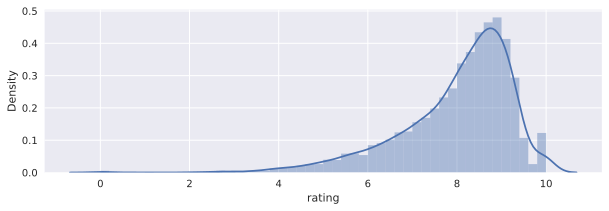

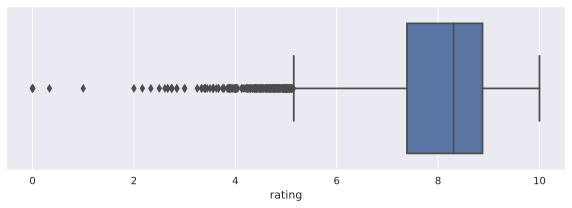

In [34]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [35]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [36]:
ddf = demo_df.copy()

In [37]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [38]:
ddf.T

,6354,6435,9800,10205
age_access_type,16,18,18,6
type,MOVIE,MOVIE,SERIAL,SERIAL
duration,15.70258,15.479437,17.723526,16.269958
BUDGET,NaN,NaN,NaN,NaN
MARKETING,NaN,NaN,NaN,NaN
...,...,...,...,...
Харви Вайнштейн,0,0,0,0
Боб Вайнштейн,0,0,0,0
Адриан Политовски,0,0,0,0
Стэн Ли,0,0,0,0


## Split

In [39]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       ...
       'Адам Дэвидсон', 'Крис Гилл', 'Майкл Кан', 'Джим Дено',
       'Дариуш Вольски', 'Харви Вайнштейн', 'Боб Вайнштейн',
       'Адриан Политовски', 'Стэн Ли', 'Люк Бессон'],
      dtype='object', length=1053)

In [36]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((4917, 1049), (547, 1049), (87, 1049), (4917,), (547,), (87,))

In [37]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'джек', 'расследовать',
       ...
       'Адам Дэвидсон', 'Крис Гилл', 'Майкл Кан', 'Джим Дено',
       'Дариуш Вольски', 'Харви Вайнштейн', 'Боб Вайнштейн',
       'Адриан Политовски', 'Стэн Ли', 'Люк Бессон'],
      dtype='object', length=1049)

In [38]:
X_train

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,джек,расследовать,...,Адам Дэвидсон,Крис Гилл,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Стэн Ли,Люк Бессон
4304,12,MOVIE,15.627073,18.132999,17.092655,NaN,18.369507,19.329415,0,0,...,0,0,0,0,0,0,0,0,0,0
1354,18,MOVIE,15.627073,15.319588,NaN,NaN,15.106253,15.815653,0,0,...,0,0,0,0,0,0,0,0,0,0
1000,12,MOVIE,15.617221,17.989898,NaN,NaN,17.446812,18.323362,0,0,...,0,0,0,0,0,0,0,0,0,0
985,16,MOVIE,15.720599,14.508658,NaN,NaN,14.271217,14.531609,0,0,...,0,0,0,0,0,0,0,0,0,0
4027,16,MOVIE,15.665539,17.370859,16.811243,NaN,17.421152,17.793795,0,0,...,0,0,0,0,0,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6292,12,MOVIE,15.332833,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
6298,12,MOVIE,15.665539,NaN,NaN,15.6443,NaN,15.639965,0,0,...,0,0,0,0,0,0,0,0,0,0
6247,16,MOVIE,15.490736,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
10303,18,SERIAL,16.131999,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0


In [39]:
cat_features = ['age_access_type', 'type']

# Modeling

In [40]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [45]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.065387
0:	learn: 0.9207061	test: 1.1100834	best: 1.1100834 (0)	total: 57.9ms	remaining: 57.8s
100:	learn: 0.6773817	test: 0.9006250	best: 0.9002982 (99)	total: 870ms	remaining: 7.75s
200:	learn: 0.6501313	test: 0.8887452	best: 0.8887452 (200)	total: 1.69s	remaining: 6.71s
300:	learn: 0.6293082	test: 0.8863015	best: 0.8852617 (251)	total: 2.5s	remaining: 5.8s
400:	learn: 0.6137266	test: 0.8848328	best: 0.8848328 (400)	total: 3.38s	remaining: 5.04s
500:	learn: 0.5970863	test: 0.8826394	best: 0.8825360 (499)	total: 4.2s	remaining: 4.18s
600:	learn: 0.5837780	test: 0.8822716	best: 0.8818853 (550)	total: 5.04s	remaining: 3.35s
700:	learn: 0.5698150	test: 0.8810465	best: 0.8803756 (693)	total: 5.93s	remaining: 2.53s
800:	learn: 0.5573372	test: 0.8805488	best: 0.8797141 (771)	total: 6.76s	remaining: 1.68s
900:	learn: 0.5480749	test: 0.8817844	best: 0.8797141 (771)	total: 7.61s	remaining: 836ms
999:	learn: 0.5371364	test: 0.8835187	best: 0.8797141 (771)	total: 8.47s	rema

In [46]:
y_pred = cat_model.predict(test_dataset)

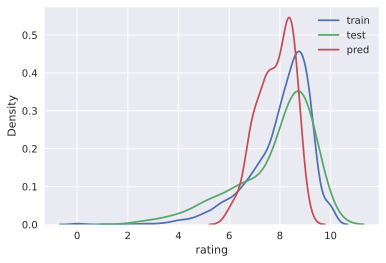

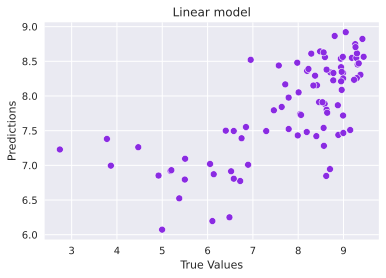

In [47]:
target_distr_linear(y_train, y_test, y_pred)   

In [48]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.2784674925358992
RMSE:  1.1306933680427684
R2:    0.43687927379748803
MAE:   0.8292997593064418
MedAE: 0.6563868188495761
------------------------------


In [49]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_scors_kws_all')

**Feature importance**

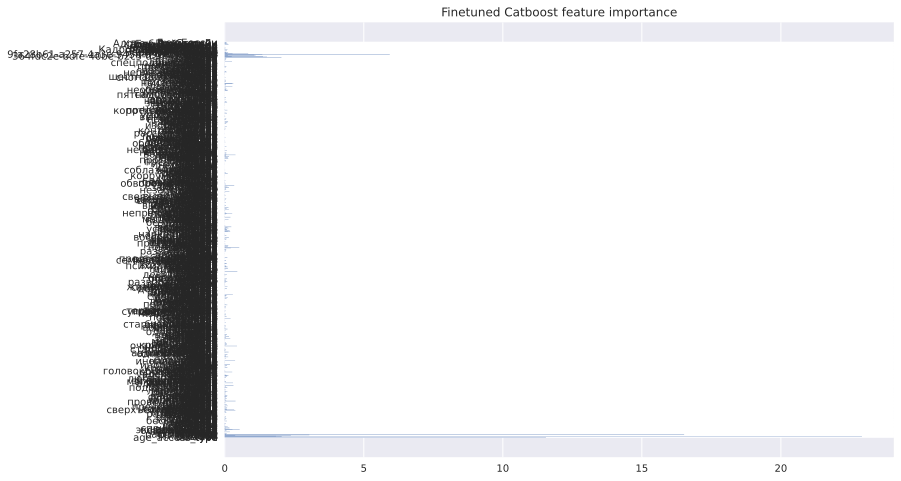

In [50]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

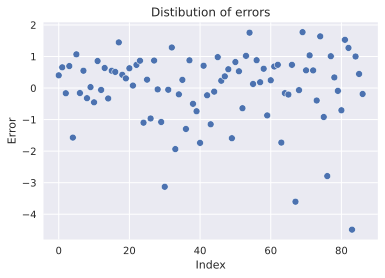

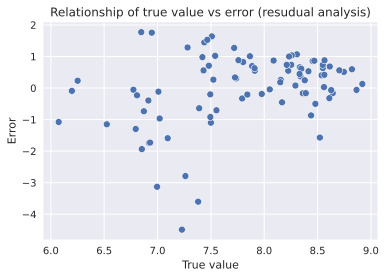

In [51]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [52]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Стэн Ли,Люк Бессон,PREDS,TARGET
10452,18,Дом Дракона,SERIAL,2022,17.015815,62541c49-7a32-45d0-8981-44ee6968d329,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.537900,8.940536
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.333613,8.990000
10292,18,Ночные вызовы,SERIAL,2022,16.685680,aba8d05c-c99d-4a45-adf7-de765f65bf5a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.362130,8.196399
10334,18,Наш флаг означает Смерть,SERIAL,2022,16.661582,500dec0c-d2a3-4ff3-a7c6-e2d21ea7fd9f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.886742,8.583333
10436,18,Ирма Веп,SERIAL,2022,17.013367,27e3a752-5124-498c-91fd-28d05c3f6a47,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.521708,6.951220
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5504,18,Невидимый убийца,MOVIE,2022,15.684231,0d14e4b4-71ed-4409-9ebb-54a130e913c8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.718415,8.990476
5410,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,0,7.228726,2.739953
5208,12,1941. Крылья над Берлином,MOVIE,2022,15.607270,ba5598bb-275c-4dcf-9164-0f86cf46d71e,NaN,NaN,14.750267,NaN,...,0,0,0,0,0,0,0,0,8.233401,9.233217
10286,18,Номинация,SERIAL,2022,16.400263,c25f3cab-9794-4efa-b729-ff473f8b5f27,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.331467,8.777734


In [53]:
# predict demo dataset

In [54]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [55]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Стэн Ли,Люк Бессон,TARGET,PREDS
6354,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.147352,7.509333
6435,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.519242,6.914440
9800,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.717041,9.064210
10205,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.192744,8.552145


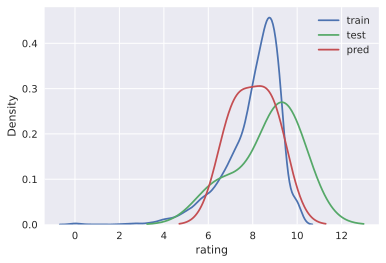

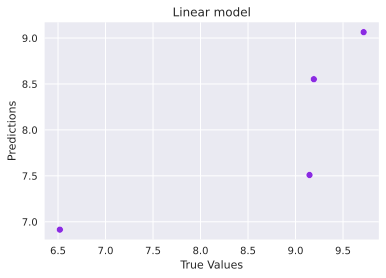

In [56]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [41]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [42]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_ALL_kws', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.9575149	total: 67.1ms	remaining: 11m 11s
1:	learn: 0.9402500	total: 87.6ms	remaining: 7m 17s
2:	learn: 0.9236663	total: 107ms	remaining: 5m 55s
3:	learn: 0.9084563	total: 126ms	remaining: 5m 13s
4:	learn: 0.8943396	total: 144ms	remaining: 4m 47s
5:	learn: 0.8816363	total: 161ms	remaining: 4m 28s
6:	learn: 0.8690361	total: 179ms	remaining: 4m 14s
7:	learn: 0.8590040	total: 196ms	remaining: 4m 4s
8:	learn: 0.8497657	total: 213ms	remaining: 3m 56s
9:	learn: 0.8404710	total: 229ms	remaining: 3m 49s
10:	learn: 0.8316377	total: 246ms	remaining: 3m 43s
11:	learn: 0.8232728	total: 262ms	remaining: 3m 38s
12:	learn: 0.8156611	total: 279ms	remaining: 3m 34s
13:	learn: 0.8083993	total: 295ms	remaining: 3m 30s
14:	learn: 0.8010636	total: 311ms	remaining: 3m 26s
15:	learn: 0.7946187	total: 327ms	remaining: 3m 23s
16:	learn: 0.7875397	total: 343ms	remaining: 3m 21s
17:	learn: 0.7828245	total: 359ms	remaining: 3m 19s
18:	learn: 

161:	learn: 0.6586504	total: 2.62s	remaining: 2m 39s
162:	learn: 0.6585127	total: 2.64s	remaining: 2m 39s
163:	learn: 0.6581116	total: 2.66s	remaining: 2m 39s
164:	learn: 0.6580549	total: 2.67s	remaining: 2m 39s
165:	learn: 0.6579818	total: 2.69s	remaining: 2m 39s
166:	learn: 0.6571375	total: 2.71s	remaining: 2m 39s
167:	learn: 0.6568135	total: 2.72s	remaining: 2m 39s
168:	learn: 0.6557783	total: 2.74s	remaining: 2m 39s
169:	learn: 0.6556614	total: 2.75s	remaining: 2m 39s
170:	learn: 0.6554038	total: 2.77s	remaining: 2m 39s
171:	learn: 0.6547833	total: 2.79s	remaining: 2m 39s
172:	learn: 0.6546574	total: 2.8s	remaining: 2m 39s
173:	learn: 0.6543718	total: 2.82s	remaining: 2m 39s
174:	learn: 0.6543332	total: 2.84s	remaining: 2m 39s
175:	learn: 0.6542675	total: 2.85s	remaining: 2m 39s
176:	learn: 0.6538731	total: 2.87s	remaining: 2m 39s
177:	learn: 0.6537938	total: 2.89s	remaining: 2m 39s
178:	learn: 0.6534414	total: 2.9s	remaining: 2m 39s
179:	learn: 0.6533271	total: 2.92s	remaining: 2m

322:	learn: 0.6040190	total: 5.35s	remaining: 2m 40s
323:	learn: 0.6038244	total: 5.36s	remaining: 2m 40s
324:	learn: 0.6037463	total: 5.38s	remaining: 2m 40s
325:	learn: 0.6032162	total: 5.4s	remaining: 2m 40s
326:	learn: 0.6029072	total: 5.42s	remaining: 2m 40s
327:	learn: 0.6025833	total: 5.43s	remaining: 2m 40s
328:	learn: 0.6019513	total: 5.45s	remaining: 2m 40s
329:	learn: 0.6017237	total: 5.46s	remaining: 2m 40s
330:	learn: 0.6014749	total: 5.48s	remaining: 2m 40s
331:	learn: 0.6014337	total: 5.5s	remaining: 2m 40s
332:	learn: 0.6013859	total: 5.51s	remaining: 2m 40s
333:	learn: 0.6011077	total: 5.53s	remaining: 2m 40s
334:	learn: 0.6005342	total: 5.55s	remaining: 2m 40s
335:	learn: 0.6003842	total: 5.56s	remaining: 2m 40s
336:	learn: 0.5996834	total: 5.58s	remaining: 2m 40s
337:	learn: 0.5994312	total: 5.6s	remaining: 2m 40s
338:	learn: 0.5990703	total: 5.61s	remaining: 2m 40s
339:	learn: 0.5986620	total: 5.63s	remaining: 2m 40s
340:	learn: 0.5986223	total: 5.65s	remaining: 2m 

485:	learn: 0.5585636	total: 8.07s	remaining: 2m 38s
486:	learn: 0.5583880	total: 8.09s	remaining: 2m 38s
487:	learn: 0.5582237	total: 8.11s	remaining: 2m 37s
488:	learn: 0.5580637	total: 8.12s	remaining: 2m 37s
489:	learn: 0.5576034	total: 8.14s	remaining: 2m 37s
490:	learn: 0.5574440	total: 8.16s	remaining: 2m 38s
491:	learn: 0.5573825	total: 8.18s	remaining: 2m 38s
492:	learn: 0.5572120	total: 8.2s	remaining: 2m 38s
493:	learn: 0.5570594	total: 8.21s	remaining: 2m 38s
494:	learn: 0.5568145	total: 8.23s	remaining: 2m 38s
495:	learn: 0.5567079	total: 8.25s	remaining: 2m 38s
496:	learn: 0.5564626	total: 8.26s	remaining: 2m 38s
497:	learn: 0.5563333	total: 8.28s	remaining: 2m 38s
498:	learn: 0.5563110	total: 8.3s	remaining: 2m 37s
499:	learn: 0.5562783	total: 8.31s	remaining: 2m 37s
500:	learn: 0.5561014	total: 8.33s	remaining: 2m 37s
501:	learn: 0.5559499	total: 8.35s	remaining: 2m 37s
502:	learn: 0.5552135	total: 8.37s	remaining: 2m 37s
503:	learn: 0.5550276	total: 8.38s	remaining: 2m

647:	learn: 0.5259490	total: 10.8s	remaining: 2m 35s
648:	learn: 0.5258348	total: 10.8s	remaining: 2m 35s
649:	learn: 0.5256903	total: 10.8s	remaining: 2m 35s
650:	learn: 0.5255194	total: 10.8s	remaining: 2m 35s
651:	learn: 0.5254822	total: 10.8s	remaining: 2m 35s
652:	learn: 0.5253915	total: 10.9s	remaining: 2m 35s
653:	learn: 0.5250961	total: 10.9s	remaining: 2m 35s
654:	learn: 0.5248762	total: 10.9s	remaining: 2m 35s
655:	learn: 0.5247299	total: 10.9s	remaining: 2m 35s
656:	learn: 0.5242255	total: 10.9s	remaining: 2m 35s
657:	learn: 0.5241573	total: 10.9s	remaining: 2m 35s
658:	learn: 0.5240724	total: 11s	remaining: 2m 35s
659:	learn: 0.5238945	total: 11s	remaining: 2m 35s
660:	learn: 0.5234052	total: 11s	remaining: 2m 35s
661:	learn: 0.5232809	total: 11s	remaining: 2m 35s
662:	learn: 0.5231524	total: 11s	remaining: 2m 35s
663:	learn: 0.5229249	total: 11s	remaining: 2m 35s
664:	learn: 0.5225931	total: 11.1s	remaining: 2m 35s
665:	learn: 0.5225148	total: 11.1s	remaining: 2m 35s
666:	

803:	learn: 0.4983034	total: 13.3s	remaining: 2m 32s
804:	learn: 0.4982664	total: 13.3s	remaining: 2m 32s
805:	learn: 0.4982035	total: 13.4s	remaining: 2m 32s
806:	learn: 0.4980612	total: 13.4s	remaining: 2m 32s
807:	learn: 0.4978515	total: 13.4s	remaining: 2m 32s
808:	learn: 0.4977888	total: 13.4s	remaining: 2m 32s
809:	learn: 0.4977043	total: 13.4s	remaining: 2m 32s
810:	learn: 0.4973509	total: 13.4s	remaining: 2m 32s
811:	learn: 0.4971819	total: 13.5s	remaining: 2m 32s
812:	learn: 0.4968519	total: 13.5s	remaining: 2m 32s
813:	learn: 0.4964654	total: 13.5s	remaining: 2m 32s
814:	learn: 0.4963409	total: 13.5s	remaining: 2m 32s
815:	learn: 0.4962313	total: 13.5s	remaining: 2m 32s
816:	learn: 0.4960013	total: 13.5s	remaining: 2m 32s
817:	learn: 0.4959604	total: 13.6s	remaining: 2m 32s
818:	learn: 0.4956609	total: 13.6s	remaining: 2m 32s
819:	learn: 0.4956070	total: 13.6s	remaining: 2m 32s
820:	learn: 0.4955238	total: 13.6s	remaining: 2m 32s
821:	learn: 0.4950238	total: 13.6s	remaining: 

971:	learn: 0.4697785	total: 16.1s	remaining: 2m 29s
972:	learn: 0.4694967	total: 16.1s	remaining: 2m 29s
973:	learn: 0.4693973	total: 16.1s	remaining: 2m 29s
974:	learn: 0.4693613	total: 16.1s	remaining: 2m 29s
975:	learn: 0.4693341	total: 16.1s	remaining: 2m 29s
976:	learn: 0.4691783	total: 16.2s	remaining: 2m 29s
977:	learn: 0.4688572	total: 16.2s	remaining: 2m 29s
978:	learn: 0.4686873	total: 16.2s	remaining: 2m 29s
979:	learn: 0.4685234	total: 16.2s	remaining: 2m 29s
980:	learn: 0.4682896	total: 16.2s	remaining: 2m 29s
981:	learn: 0.4681428	total: 16.2s	remaining: 2m 29s
982:	learn: 0.4680355	total: 16.3s	remaining: 2m 29s
983:	learn: 0.4677796	total: 16.3s	remaining: 2m 29s
984:	learn: 0.4677072	total: 16.3s	remaining: 2m 29s
985:	learn: 0.4674450	total: 16.3s	remaining: 2m 29s
986:	learn: 0.4673341	total: 16.3s	remaining: 2m 28s
987:	learn: 0.4672954	total: 16.3s	remaining: 2m 28s
988:	learn: 0.4672654	total: 16.3s	remaining: 2m 28s
989:	learn: 0.4671497	total: 16.4s	remaining: 

1126:	learn: 0.4463698	total: 18.6s	remaining: 2m 26s
1127:	learn: 0.4460527	total: 18.7s	remaining: 2m 26s
1128:	learn: 0.4458821	total: 18.7s	remaining: 2m 26s
1129:	learn: 0.4458589	total: 18.7s	remaining: 2m 26s
1130:	learn: 0.4457183	total: 18.7s	remaining: 2m 26s
1131:	learn: 0.4456351	total: 18.7s	remaining: 2m 26s
1132:	learn: 0.4453803	total: 18.7s	remaining: 2m 26s
1133:	learn: 0.4450621	total: 18.8s	remaining: 2m 26s
1134:	learn: 0.4449963	total: 18.8s	remaining: 2m 26s
1135:	learn: 0.4445451	total: 18.8s	remaining: 2m 26s
1136:	learn: 0.4444718	total: 18.8s	remaining: 2m 26s
1137:	learn: 0.4442578	total: 18.8s	remaining: 2m 26s
1138:	learn: 0.4440741	total: 18.8s	remaining: 2m 26s
1139:	learn: 0.4439174	total: 18.9s	remaining: 2m 26s
1140:	learn: 0.4438806	total: 18.9s	remaining: 2m 26s
1141:	learn: 0.4435532	total: 18.9s	remaining: 2m 26s
1142:	learn: 0.4432304	total: 18.9s	remaining: 2m 26s
1143:	learn: 0.4430395	total: 18.9s	remaining: 2m 26s
1144:	learn: 0.4429321	total

1291:	learn: 0.4232762	total: 21.4s	remaining: 2m 23s
1292:	learn: 0.4232127	total: 21.4s	remaining: 2m 23s
1293:	learn: 0.4231706	total: 21.4s	remaining: 2m 23s
1294:	learn: 0.4228421	total: 21.4s	remaining: 2m 23s
1295:	learn: 0.4226267	total: 21.4s	remaining: 2m 23s
1296:	learn: 0.4225970	total: 21.4s	remaining: 2m 23s
1297:	learn: 0.4225469	total: 21.5s	remaining: 2m 23s
1298:	learn: 0.4224951	total: 21.5s	remaining: 2m 23s
1299:	learn: 0.4220514	total: 21.5s	remaining: 2m 23s
1300:	learn: 0.4217832	total: 21.5s	remaining: 2m 23s
1301:	learn: 0.4217060	total: 21.5s	remaining: 2m 23s
1302:	learn: 0.4216559	total: 21.5s	remaining: 2m 23s
1303:	learn: 0.4213475	total: 21.6s	remaining: 2m 23s
1304:	learn: 0.4212565	total: 21.6s	remaining: 2m 23s
1305:	learn: 0.4212083	total: 21.6s	remaining: 2m 23s
1306:	learn: 0.4211174	total: 21.6s	remaining: 2m 23s
1307:	learn: 0.4210853	total: 21.6s	remaining: 2m 23s
1308:	learn: 0.4210426	total: 21.6s	remaining: 2m 23s
1309:	learn: 0.4207575	total

1446:	learn: 0.4033119	total: 23.9s	remaining: 2m 21s
1447:	learn: 0.4032398	total: 23.9s	remaining: 2m 21s
1448:	learn: 0.4030070	total: 24s	remaining: 2m 21s
1449:	learn: 0.4029867	total: 24s	remaining: 2m 21s
1450:	learn: 0.4029517	total: 24s	remaining: 2m 21s
1451:	learn: 0.4028864	total: 24s	remaining: 2m 21s
1452:	learn: 0.4028508	total: 24s	remaining: 2m 21s
1453:	learn: 0.4028264	total: 24s	remaining: 2m 21s
1454:	learn: 0.4027827	total: 24s	remaining: 2m 21s
1455:	learn: 0.4026691	total: 24.1s	remaining: 2m 21s
1456:	learn: 0.4022831	total: 24.1s	remaining: 2m 21s
1457:	learn: 0.4022119	total: 24.1s	remaining: 2m 21s
1458:	learn: 0.4021233	total: 24.1s	remaining: 2m 21s
1459:	learn: 0.4018502	total: 24.1s	remaining: 2m 21s
1460:	learn: 0.4017956	total: 24.1s	remaining: 2m 21s
1461:	learn: 0.4016213	total: 24.2s	remaining: 2m 21s
1462:	learn: 0.4011737	total: 24.2s	remaining: 2m 21s
1463:	learn: 0.4011616	total: 24.2s	remaining: 2m 21s
1464:	learn: 0.4010008	total: 24.2s	remain

1601:	learn: 0.3843800	total: 26.5s	remaining: 2m 18s
1602:	learn: 0.3842333	total: 26.5s	remaining: 2m 18s
1603:	learn: 0.3841164	total: 26.5s	remaining: 2m 18s
1604:	learn: 0.3841079	total: 26.5s	remaining: 2m 18s
1605:	learn: 0.3838930	total: 26.5s	remaining: 2m 18s
1606:	learn: 0.3838422	total: 26.6s	remaining: 2m 18s
1607:	learn: 0.3836694	total: 26.6s	remaining: 2m 18s
1608:	learn: 0.3836420	total: 26.6s	remaining: 2m 18s
1609:	learn: 0.3836034	total: 26.6s	remaining: 2m 18s
1610:	learn: 0.3835816	total: 26.6s	remaining: 2m 18s
1611:	learn: 0.3832792	total: 26.6s	remaining: 2m 18s
1612:	learn: 0.3831719	total: 26.6s	remaining: 2m 18s
1613:	learn: 0.3831145	total: 26.7s	remaining: 2m 18s
1614:	learn: 0.3830957	total: 26.7s	remaining: 2m 18s
1615:	learn: 0.3830470	total: 26.7s	remaining: 2m 18s
1616:	learn: 0.3830242	total: 26.7s	remaining: 2m 18s
1617:	learn: 0.3829084	total: 26.7s	remaining: 2m 18s
1618:	learn: 0.3827574	total: 26.7s	remaining: 2m 18s
1619:	learn: 0.3826220	total

1766:	learn: 0.3653628	total: 29.2s	remaining: 2m 16s
1767:	learn: 0.3653124	total: 29.2s	remaining: 2m 16s
1768:	learn: 0.3652431	total: 29.2s	remaining: 2m 16s
1769:	learn: 0.3650065	total: 29.3s	remaining: 2m 16s
1770:	learn: 0.3648198	total: 29.3s	remaining: 2m 15s
1771:	learn: 0.3648107	total: 29.3s	remaining: 2m 15s
1772:	learn: 0.3647398	total: 29.3s	remaining: 2m 15s
1773:	learn: 0.3647312	total: 29.3s	remaining: 2m 15s
1774:	learn: 0.3645907	total: 29.3s	remaining: 2m 15s
1775:	learn: 0.3645658	total: 29.3s	remaining: 2m 15s
1776:	learn: 0.3645344	total: 29.4s	remaining: 2m 15s
1777:	learn: 0.3641990	total: 29.4s	remaining: 2m 15s
1778:	learn: 0.3641423	total: 29.4s	remaining: 2m 15s
1779:	learn: 0.3640680	total: 29.4s	remaining: 2m 15s
1780:	learn: 0.3640414	total: 29.4s	remaining: 2m 15s
1781:	learn: 0.3639183	total: 29.4s	remaining: 2m 15s
1782:	learn: 0.3639073	total: 29.5s	remaining: 2m 15s
1783:	learn: 0.3637946	total: 29.5s	remaining: 2m 15s
1784:	learn: 0.3636464	total

1927:	learn: 0.3496659	total: 31.9s	remaining: 2m 13s
1928:	learn: 0.3495260	total: 31.9s	remaining: 2m 13s
1929:	learn: 0.3493959	total: 31.9s	remaining: 2m 13s
1930:	learn: 0.3493510	total: 31.9s	remaining: 2m 13s
1931:	learn: 0.3492720	total: 32s	remaining: 2m 13s
1932:	learn: 0.3492114	total: 32s	remaining: 2m 13s
1933:	learn: 0.3491952	total: 32s	remaining: 2m 13s
1934:	learn: 0.3491776	total: 32s	remaining: 2m 13s
1935:	learn: 0.3491147	total: 32s	remaining: 2m 13s
1936:	learn: 0.3490571	total: 32s	remaining: 2m 13s
1937:	learn: 0.3488849	total: 32.1s	remaining: 2m 13s
1938:	learn: 0.3487967	total: 32.1s	remaining: 2m 13s
1939:	learn: 0.3487827	total: 32.1s	remaining: 2m 13s
1940:	learn: 0.3487183	total: 32.1s	remaining: 2m 13s
1941:	learn: 0.3486599	total: 32.1s	remaining: 2m 13s
1942:	learn: 0.3486348	total: 32.1s	remaining: 2m 13s
1943:	learn: 0.3484031	total: 32.2s	remaining: 2m 13s
1944:	learn: 0.3483605	total: 32.2s	remaining: 2m 13s
1945:	learn: 0.3483045	total: 32.2s	rema

2081:	learn: 0.3352050	total: 34.4s	remaining: 2m 10s
2082:	learn: 0.3349743	total: 34.4s	remaining: 2m 10s
2083:	learn: 0.3349584	total: 34.5s	remaining: 2m 10s
2084:	learn: 0.3348575	total: 34.5s	remaining: 2m 10s
2085:	learn: 0.3347500	total: 34.5s	remaining: 2m 10s
2086:	learn: 0.3345478	total: 34.5s	remaining: 2m 10s
2087:	learn: 0.3344040	total: 34.5s	remaining: 2m 10s
2088:	learn: 0.3343425	total: 34.5s	remaining: 2m 10s
2089:	learn: 0.3341985	total: 34.6s	remaining: 2m 10s
2090:	learn: 0.3340599	total: 34.6s	remaining: 2m 10s
2091:	learn: 0.3340212	total: 34.6s	remaining: 2m 10s
2092:	learn: 0.3338056	total: 34.6s	remaining: 2m 10s
2093:	learn: 0.3337557	total: 34.6s	remaining: 2m 10s
2094:	learn: 0.3335727	total: 34.6s	remaining: 2m 10s
2095:	learn: 0.3334705	total: 34.7s	remaining: 2m 10s
2096:	learn: 0.3334412	total: 34.7s	remaining: 2m 10s
2097:	learn: 0.3333116	total: 34.7s	remaining: 2m 10s
2098:	learn: 0.3332472	total: 34.7s	remaining: 2m 10s
2099:	learn: 0.3332389	total

2235:	learn: 0.3216214	total: 37s	remaining: 2m 8s
2236:	learn: 0.3215700	total: 37s	remaining: 2m 8s
2237:	learn: 0.3215274	total: 37s	remaining: 2m 8s
2238:	learn: 0.3213909	total: 37s	remaining: 2m 8s
2239:	learn: 0.3213613	total: 37s	remaining: 2m 8s
2240:	learn: 0.3212460	total: 37.1s	remaining: 2m 8s
2241:	learn: 0.3212246	total: 37.1s	remaining: 2m 8s
2242:	learn: 0.3211739	total: 37.1s	remaining: 2m 8s
2243:	learn: 0.3211159	total: 37.1s	remaining: 2m 8s
2244:	learn: 0.3209783	total: 37.1s	remaining: 2m 8s
2245:	learn: 0.3209508	total: 37.1s	remaining: 2m 8s
2246:	learn: 0.3208488	total: 37.2s	remaining: 2m 8s
2247:	learn: 0.3208402	total: 37.2s	remaining: 2m 8s
2248:	learn: 0.3205708	total: 37.2s	remaining: 2m 8s
2249:	learn: 0.3204709	total: 37.2s	remaining: 2m 8s
2250:	learn: 0.3202741	total: 37.2s	remaining: 2m 8s
2251:	learn: 0.3200685	total: 37.2s	remaining: 2m 8s
2252:	learn: 0.3200493	total: 37.3s	remaining: 2m 8s
2253:	learn: 0.3200086	total: 37.3s	remaining: 2m 8s
225

2391:	learn: 0.3092285	total: 39.5s	remaining: 2m 5s
2392:	learn: 0.3091808	total: 39.6s	remaining: 2m 5s
2393:	learn: 0.3090798	total: 39.6s	remaining: 2m 5s
2394:	learn: 0.3089995	total: 39.6s	remaining: 2m 5s
2395:	learn: 0.3089469	total: 39.6s	remaining: 2m 5s
2396:	learn: 0.3088781	total: 39.6s	remaining: 2m 5s
2397:	learn: 0.3088305	total: 39.6s	remaining: 2m 5s
2398:	learn: 0.3088223	total: 39.7s	remaining: 2m 5s
2399:	learn: 0.3086071	total: 39.7s	remaining: 2m 5s
2400:	learn: 0.3085910	total: 39.7s	remaining: 2m 5s
2401:	learn: 0.3085638	total: 39.7s	remaining: 2m 5s
2402:	learn: 0.3084193	total: 39.7s	remaining: 2m 5s
2403:	learn: 0.3083143	total: 39.7s	remaining: 2m 5s
2404:	learn: 0.3082830	total: 39.8s	remaining: 2m 5s
2405:	learn: 0.3082553	total: 39.8s	remaining: 2m 5s
2406:	learn: 0.3081139	total: 39.8s	remaining: 2m 5s
2407:	learn: 0.3080910	total: 39.8s	remaining: 2m 5s
2408:	learn: 0.3079987	total: 39.8s	remaining: 2m 5s
2409:	learn: 0.3079589	total: 39.8s	remaining:

2559:	learn: 0.2964540	total: 42.3s	remaining: 2m 2s
2560:	learn: 0.2964180	total: 42.3s	remaining: 2m 2s
2561:	learn: 0.2964052	total: 42.3s	remaining: 2m 2s
2562:	learn: 0.2962687	total: 42.4s	remaining: 2m 2s
2563:	learn: 0.2962329	total: 42.4s	remaining: 2m 2s
2564:	learn: 0.2961896	total: 42.4s	remaining: 2m 2s
2565:	learn: 0.2961433	total: 42.4s	remaining: 2m 2s
2566:	learn: 0.2961217	total: 42.4s	remaining: 2m 2s
2567:	learn: 0.2960293	total: 42.4s	remaining: 2m 2s
2568:	learn: 0.2958958	total: 42.5s	remaining: 2m 2s
2569:	learn: 0.2958789	total: 42.5s	remaining: 2m 2s
2570:	learn: 0.2958275	total: 42.5s	remaining: 2m 2s
2571:	learn: 0.2957846	total: 42.5s	remaining: 2m 2s
2572:	learn: 0.2957546	total: 42.5s	remaining: 2m 2s
2573:	learn: 0.2956847	total: 42.5s	remaining: 2m 2s
2574:	learn: 0.2955190	total: 42.6s	remaining: 2m 2s
2575:	learn: 0.2954619	total: 42.6s	remaining: 2m 2s
2576:	learn: 0.2954528	total: 42.6s	remaining: 2m 2s
2577:	learn: 0.2953739	total: 42.6s	remaining:

2725:	learn: 0.2851092	total: 45s	remaining: 2m
2726:	learn: 0.2851073	total: 45.1s	remaining: 2m
2727:	learn: 0.2849960	total: 45.1s	remaining: 2m
2728:	learn: 0.2849452	total: 45.1s	remaining: 2m
2729:	learn: 0.2848797	total: 45.1s	remaining: 2m
2730:	learn: 0.2846691	total: 45.1s	remaining: 2m
2731:	learn: 0.2846141	total: 45.1s	remaining: 2m
2732:	learn: 0.2845896	total: 45.2s	remaining: 2m
2733:	learn: 0.2845712	total: 45.2s	remaining: 2m
2734:	learn: 0.2845337	total: 45.2s	remaining: 2m
2735:	learn: 0.2845044	total: 45.2s	remaining: 2m
2736:	learn: 0.2843952	total: 45.2s	remaining: 2m
2737:	learn: 0.2843699	total: 45.2s	remaining: 2m
2738:	learn: 0.2842200	total: 45.3s	remaining: 1m 59s
2739:	learn: 0.2841606	total: 45.3s	remaining: 1m 59s
2740:	learn: 0.2841500	total: 45.3s	remaining: 1m 59s
2741:	learn: 0.2840970	total: 45.3s	remaining: 1m 59s
2742:	learn: 0.2840524	total: 45.3s	remaining: 1m 59s
2743:	learn: 0.2839920	total: 45.3s	remaining: 1m 59s
2744:	learn: 0.2839350	total

2883:	learn: 0.2747837	total: 47.8s	remaining: 1m 57s
2884:	learn: 0.2746778	total: 47.8s	remaining: 1m 57s
2885:	learn: 0.2746758	total: 47.8s	remaining: 1m 57s
2886:	learn: 0.2746402	total: 47.8s	remaining: 1m 57s
2887:	learn: 0.2744623	total: 47.8s	remaining: 1m 57s
2888:	learn: 0.2744426	total: 47.8s	remaining: 1m 57s
2889:	learn: 0.2744234	total: 47.9s	remaining: 1m 57s
2890:	learn: 0.2743815	total: 47.9s	remaining: 1m 57s
2891:	learn: 0.2743473	total: 47.9s	remaining: 1m 57s
2892:	learn: 0.2742838	total: 47.9s	remaining: 1m 57s
2893:	learn: 0.2741716	total: 47.9s	remaining: 1m 57s
2894:	learn: 0.2741185	total: 47.9s	remaining: 1m 57s
2895:	learn: 0.2741127	total: 48s	remaining: 1m 57s
2896:	learn: 0.2740147	total: 48s	remaining: 1m 57s
2897:	learn: 0.2738960	total: 48s	remaining: 1m 57s
2898:	learn: 0.2737630	total: 48s	remaining: 1m 57s
2899:	learn: 0.2736325	total: 48s	remaining: 1m 57s
2900:	learn: 0.2736283	total: 48s	remaining: 1m 57s
2901:	learn: 0.2735722	total: 48.1s	rema

3048:	learn: 0.2638628	total: 50.5s	remaining: 1m 55s
3049:	learn: 0.2638334	total: 50.5s	remaining: 1m 55s
3050:	learn: 0.2638306	total: 50.5s	remaining: 1m 55s
3051:	learn: 0.2638173	total: 50.5s	remaining: 1m 55s
3052:	learn: 0.2637167	total: 50.5s	remaining: 1m 55s
3053:	learn: 0.2636757	total: 50.6s	remaining: 1m 54s
3054:	learn: 0.2636689	total: 50.6s	remaining: 1m 54s
3055:	learn: 0.2636542	total: 50.6s	remaining: 1m 54s
3056:	learn: 0.2635796	total: 50.6s	remaining: 1m 54s
3057:	learn: 0.2635154	total: 50.6s	remaining: 1m 54s
3058:	learn: 0.2634961	total: 50.6s	remaining: 1m 54s
3059:	learn: 0.2633455	total: 50.7s	remaining: 1m 54s
3060:	learn: 0.2633411	total: 50.7s	remaining: 1m 54s
3061:	learn: 0.2631701	total: 50.7s	remaining: 1m 54s
3062:	learn: 0.2631542	total: 50.7s	remaining: 1m 54s
3063:	learn: 0.2631530	total: 50.7s	remaining: 1m 54s
3064:	learn: 0.2631248	total: 50.7s	remaining: 1m 54s
3065:	learn: 0.2630335	total: 50.8s	remaining: 1m 54s
3066:	learn: 0.2630068	total

3202:	learn: 0.2536331	total: 53s	remaining: 1m 52s
3203:	learn: 0.2536331	total: 53s	remaining: 1m 52s
3204:	learn: 0.2535270	total: 53s	remaining: 1m 52s
3205:	learn: 0.2535250	total: 53.1s	remaining: 1m 52s
3206:	learn: 0.2534853	total: 53.1s	remaining: 1m 52s
3207:	learn: 0.2534331	total: 53.1s	remaining: 1m 52s
3208:	learn: 0.2533448	total: 53.1s	remaining: 1m 52s
3209:	learn: 0.2533012	total: 53.1s	remaining: 1m 52s
3210:	learn: 0.2532531	total: 53.1s	remaining: 1m 52s
3211:	learn: 0.2530952	total: 53.2s	remaining: 1m 52s
3212:	learn: 0.2530296	total: 53.2s	remaining: 1m 52s
3213:	learn: 0.2530112	total: 53.2s	remaining: 1m 52s
3214:	learn: 0.2530000	total: 53.2s	remaining: 1m 52s
3215:	learn: 0.2529625	total: 53.2s	remaining: 1m 52s
3216:	learn: 0.2529183	total: 53.2s	remaining: 1m 52s
3217:	learn: 0.2528966	total: 53.3s	remaining: 1m 52s
3218:	learn: 0.2528037	total: 53.3s	remaining: 1m 52s
3219:	learn: 0.2527962	total: 53.3s	remaining: 1m 52s
3220:	learn: 0.2526858	total: 53.3

3356:	learn: 0.2452905	total: 55.5s	remaining: 1m 49s
3357:	learn: 0.2452678	total: 55.6s	remaining: 1m 49s
3358:	learn: 0.2452664	total: 55.6s	remaining: 1m 49s
3359:	learn: 0.2452633	total: 55.6s	remaining: 1m 49s
3360:	learn: 0.2452462	total: 55.6s	remaining: 1m 49s
3361:	learn: 0.2452080	total: 55.6s	remaining: 1m 49s
3362:	learn: 0.2451590	total: 55.6s	remaining: 1m 49s
3363:	learn: 0.2450625	total: 55.7s	remaining: 1m 49s
3364:	learn: 0.2450362	total: 55.7s	remaining: 1m 49s
3365:	learn: 0.2450107	total: 55.7s	remaining: 1m 49s
3366:	learn: 0.2449990	total: 55.7s	remaining: 1m 49s
3367:	learn: 0.2448651	total: 55.7s	remaining: 1m 49s
3368:	learn: 0.2447458	total: 55.7s	remaining: 1m 49s
3369:	learn: 0.2447099	total: 55.8s	remaining: 1m 49s
3370:	learn: 0.2446913	total: 55.8s	remaining: 1m 49s
3371:	learn: 0.2446586	total: 55.8s	remaining: 1m 49s
3372:	learn: 0.2445487	total: 55.8s	remaining: 1m 49s
3373:	learn: 0.2445428	total: 55.8s	remaining: 1m 49s
3374:	learn: 0.2444776	total

3509:	learn: 0.2375990	total: 58.1s	remaining: 1m 47s
3510:	learn: 0.2375880	total: 58.1s	remaining: 1m 47s
3511:	learn: 0.2374928	total: 58.1s	remaining: 1m 47s
3512:	learn: 0.2374116	total: 58.1s	remaining: 1m 47s
3513:	learn: 0.2373852	total: 58.1s	remaining: 1m 47s
3514:	learn: 0.2373148	total: 58.2s	remaining: 1m 47s
3515:	learn: 0.2372838	total: 58.2s	remaining: 1m 47s
3516:	learn: 0.2372680	total: 58.2s	remaining: 1m 47s
3517:	learn: 0.2372544	total: 58.2s	remaining: 1m 47s
3518:	learn: 0.2372001	total: 58.2s	remaining: 1m 47s
3519:	learn: 0.2370743	total: 58.2s	remaining: 1m 47s
3520:	learn: 0.2369491	total: 58.3s	remaining: 1m 47s
3521:	learn: 0.2369091	total: 58.3s	remaining: 1m 47s
3522:	learn: 0.2368520	total: 58.3s	remaining: 1m 47s
3523:	learn: 0.2367224	total: 58.3s	remaining: 1m 47s
3524:	learn: 0.2365796	total: 58.3s	remaining: 1m 47s
3525:	learn: 0.2364715	total: 58.3s	remaining: 1m 47s
3526:	learn: 0.2364267	total: 58.4s	remaining: 1m 47s
3527:	learn: 0.2363612	total

3672:	learn: 0.2296236	total: 1m	remaining: 1m 44s
3673:	learn: 0.2295688	total: 1m	remaining: 1m 44s
3674:	learn: 0.2294630	total: 1m	remaining: 1m 44s
3675:	learn: 0.2293842	total: 1m	remaining: 1m 44s
3676:	learn: 0.2293243	total: 1m	remaining: 1m 44s
3677:	learn: 0.2292241	total: 1m	remaining: 1m 44s
3678:	learn: 0.2291799	total: 1m	remaining: 1m 44s
3679:	learn: 0.2291739	total: 1m	remaining: 1m 44s
3680:	learn: 0.2290501	total: 1m	remaining: 1m 44s
3681:	learn: 0.2289069	total: 1m	remaining: 1m 44s
3682:	learn: 0.2287614	total: 1m	remaining: 1m 44s
3683:	learn: 0.2287171	total: 1m	remaining: 1m 44s
3684:	learn: 0.2286787	total: 1m	remaining: 1m 44s
3685:	learn: 0.2286466	total: 1m	remaining: 1m 44s
3686:	learn: 0.2286295	total: 1m 1s	remaining: 1m 44s
3687:	learn: 0.2285509	total: 1m 1s	remaining: 1m 44s
3688:	learn: 0.2285287	total: 1m 1s	remaining: 1m 44s
3689:	learn: 0.2285147	total: 1m 1s	remaining: 1m 44s
3690:	learn: 0.2284816	total: 1m 1s	remaining: 1m 44s
3691:	learn: 0.2

3826:	learn: 0.2220992	total: 1m 3s	remaining: 1m 42s
3827:	learn: 0.2220710	total: 1m 3s	remaining: 1m 42s
3828:	learn: 0.2220474	total: 1m 3s	remaining: 1m 42s
3829:	learn: 0.2219992	total: 1m 3s	remaining: 1m 42s
3830:	learn: 0.2218843	total: 1m 3s	remaining: 1m 42s
3831:	learn: 0.2218369	total: 1m 3s	remaining: 1m 42s
3832:	learn: 0.2218041	total: 1m 3s	remaining: 1m 42s
3833:	learn: 0.2217771	total: 1m 3s	remaining: 1m 42s
3834:	learn: 0.2216734	total: 1m 3s	remaining: 1m 41s
3835:	learn: 0.2216004	total: 1m 3s	remaining: 1m 41s
3836:	learn: 0.2216003	total: 1m 3s	remaining: 1m 41s
3837:	learn: 0.2215657	total: 1m 3s	remaining: 1m 41s
3838:	learn: 0.2215291	total: 1m 3s	remaining: 1m 41s
3839:	learn: 0.2214556	total: 1m 3s	remaining: 1m 41s
3840:	learn: 0.2214477	total: 1m 3s	remaining: 1m 41s
3841:	learn: 0.2213759	total: 1m 3s	remaining: 1m 41s
3842:	learn: 0.2213001	total: 1m 3s	remaining: 1m 41s
3843:	learn: 0.2212982	total: 1m 3s	remaining: 1m 41s
3844:	learn: 0.2212365	total

3982:	learn: 0.2145136	total: 1m 5s	remaining: 1m 39s
3983:	learn: 0.2144889	total: 1m 5s	remaining: 1m 39s
3984:	learn: 0.2144658	total: 1m 5s	remaining: 1m 39s
3985:	learn: 0.2144327	total: 1m 5s	remaining: 1m 39s
3986:	learn: 0.2143875	total: 1m 5s	remaining: 1m 39s
3987:	learn: 0.2143614	total: 1m 5s	remaining: 1m 39s
3988:	learn: 0.2143101	total: 1m 5s	remaining: 1m 39s
3989:	learn: 0.2142935	total: 1m 5s	remaining: 1m 39s
3990:	learn: 0.2142302	total: 1m 6s	remaining: 1m 39s
3991:	learn: 0.2142216	total: 1m 6s	remaining: 1m 39s
3992:	learn: 0.2142036	total: 1m 6s	remaining: 1m 39s
3993:	learn: 0.2141872	total: 1m 6s	remaining: 1m 39s
3994:	learn: 0.2141578	total: 1m 6s	remaining: 1m 39s
3995:	learn: 0.2141298	total: 1m 6s	remaining: 1m 39s
3996:	learn: 0.2140250	total: 1m 6s	remaining: 1m 39s
3997:	learn: 0.2140027	total: 1m 6s	remaining: 1m 39s
3998:	learn: 0.2139801	total: 1m 6s	remaining: 1m 39s
3999:	learn: 0.2139503	total: 1m 6s	remaining: 1m 39s
4000:	learn: 0.2139044	total

4146:	learn: 0.2077383	total: 1m 8s	remaining: 1m 36s
4147:	learn: 0.2075692	total: 1m 8s	remaining: 1m 36s
4148:	learn: 0.2075046	total: 1m 8s	remaining: 1m 36s
4149:	learn: 0.2073974	total: 1m 8s	remaining: 1m 36s
4150:	learn: 0.2073507	total: 1m 8s	remaining: 1m 36s
4151:	learn: 0.2073314	total: 1m 8s	remaining: 1m 36s
4152:	learn: 0.2073131	total: 1m 8s	remaining: 1m 36s
4153:	learn: 0.2073067	total: 1m 8s	remaining: 1m 36s
4154:	learn: 0.2072426	total: 1m 8s	remaining: 1m 36s
4155:	learn: 0.2072308	total: 1m 8s	remaining: 1m 36s
4156:	learn: 0.2072121	total: 1m 8s	remaining: 1m 36s
4157:	learn: 0.2072113	total: 1m 8s	remaining: 1m 36s
4158:	learn: 0.2071785	total: 1m 8s	remaining: 1m 36s
4159:	learn: 0.2071344	total: 1m 8s	remaining: 1m 36s
4160:	learn: 0.2070986	total: 1m 8s	remaining: 1m 36s
4161:	learn: 0.2070928	total: 1m 8s	remaining: 1m 36s
4162:	learn: 0.2070480	total: 1m 8s	remaining: 1m 36s
4163:	learn: 0.2070025	total: 1m 8s	remaining: 1m 36s
4164:	learn: 0.2069297	total

4299:	learn: 0.2013459	total: 1m 11s	remaining: 1m 34s
4300:	learn: 0.2013404	total: 1m 11s	remaining: 1m 34s
4301:	learn: 0.2012851	total: 1m 11s	remaining: 1m 34s
4302:	learn: 0.2012298	total: 1m 11s	remaining: 1m 34s
4303:	learn: 0.2011434	total: 1m 11s	remaining: 1m 34s
4304:	learn: 0.2010800	total: 1m 11s	remaining: 1m 34s
4305:	learn: 0.2010477	total: 1m 11s	remaining: 1m 34s
4306:	learn: 0.2010224	total: 1m 11s	remaining: 1m 34s
4307:	learn: 0.2009698	total: 1m 11s	remaining: 1m 34s
4308:	learn: 0.2009515	total: 1m 11s	remaining: 1m 34s
4309:	learn: 0.2009227	total: 1m 11s	remaining: 1m 34s
4310:	learn: 0.2008988	total: 1m 11s	remaining: 1m 34s
4311:	learn: 0.2008748	total: 1m 11s	remaining: 1m 34s
4312:	learn: 0.2008104	total: 1m 11s	remaining: 1m 34s
4313:	learn: 0.2007890	total: 1m 11s	remaining: 1m 34s
4314:	learn: 0.2007808	total: 1m 11s	remaining: 1m 34s
4315:	learn: 0.2007717	total: 1m 11s	remaining: 1m 34s
4316:	learn: 0.2007668	total: 1m 11s	remaining: 1m 33s
4317:	lear

4454:	learn: 0.1949363	total: 1m 13s	remaining: 1m 31s
4455:	learn: 0.1949288	total: 1m 13s	remaining: 1m 31s
4456:	learn: 0.1949169	total: 1m 13s	remaining: 1m 31s
4457:	learn: 0.1948507	total: 1m 13s	remaining: 1m 31s
4458:	learn: 0.1948486	total: 1m 13s	remaining: 1m 31s
4459:	learn: 0.1947826	total: 1m 13s	remaining: 1m 31s
4460:	learn: 0.1947707	total: 1m 13s	remaining: 1m 31s
4461:	learn: 0.1947564	total: 1m 13s	remaining: 1m 31s
4462:	learn: 0.1947063	total: 1m 13s	remaining: 1m 31s
4463:	learn: 0.1946761	total: 1m 13s	remaining: 1m 31s
4464:	learn: 0.1946295	total: 1m 13s	remaining: 1m 31s
4465:	learn: 0.1946273	total: 1m 13s	remaining: 1m 31s
4466:	learn: 0.1946079	total: 1m 13s	remaining: 1m 31s
4467:	learn: 0.1945885	total: 1m 13s	remaining: 1m 31s
4468:	learn: 0.1944858	total: 1m 13s	remaining: 1m 31s
4469:	learn: 0.1944466	total: 1m 13s	remaining: 1m 31s
4470:	learn: 0.1944330	total: 1m 13s	remaining: 1m 31s
4471:	learn: 0.1943628	total: 1m 13s	remaining: 1m 31s
4472:	lear

4606:	learn: 0.1894594	total: 1m 16s	remaining: 1m 29s
4607:	learn: 0.1894384	total: 1m 16s	remaining: 1m 29s
4608:	learn: 0.1894246	total: 1m 16s	remaining: 1m 29s
4609:	learn: 0.1894231	total: 1m 16s	remaining: 1m 29s
4610:	learn: 0.1893693	total: 1m 16s	remaining: 1m 29s
4611:	learn: 0.1893389	total: 1m 16s	remaining: 1m 29s
4612:	learn: 0.1893299	total: 1m 16s	remaining: 1m 29s
4613:	learn: 0.1892492	total: 1m 16s	remaining: 1m 29s
4614:	learn: 0.1891913	total: 1m 16s	remaining: 1m 29s
4615:	learn: 0.1891034	total: 1m 16s	remaining: 1m 29s
4616:	learn: 0.1890446	total: 1m 16s	remaining: 1m 29s
4617:	learn: 0.1890391	total: 1m 16s	remaining: 1m 28s
4618:	learn: 0.1890195	total: 1m 16s	remaining: 1m 28s
4619:	learn: 0.1889885	total: 1m 16s	remaining: 1m 28s
4620:	learn: 0.1889713	total: 1m 16s	remaining: 1m 28s
4621:	learn: 0.1889421	total: 1m 16s	remaining: 1m 28s
4622:	learn: 0.1889375	total: 1m 16s	remaining: 1m 28s
4623:	learn: 0.1888462	total: 1m 16s	remaining: 1m 28s
4624:	lear

4759:	learn: 0.1833917	total: 1m 18s	remaining: 1m 26s
4760:	learn: 0.1833314	total: 1m 18s	remaining: 1m 26s
4761:	learn: 0.1833170	total: 1m 18s	remaining: 1m 26s
4762:	learn: 0.1832727	total: 1m 18s	remaining: 1m 26s
4763:	learn: 0.1832428	total: 1m 18s	remaining: 1m 26s
4764:	learn: 0.1831354	total: 1m 18s	remaining: 1m 26s
4765:	learn: 0.1831117	total: 1m 18s	remaining: 1m 26s
4766:	learn: 0.1831026	total: 1m 18s	remaining: 1m 26s
4767:	learn: 0.1830829	total: 1m 18s	remaining: 1m 26s
4768:	learn: 0.1830804	total: 1m 18s	remaining: 1m 26s
4769:	learn: 0.1830737	total: 1m 18s	remaining: 1m 26s
4770:	learn: 0.1830456	total: 1m 18s	remaining: 1m 26s
4771:	learn: 0.1830370	total: 1m 18s	remaining: 1m 26s
4772:	learn: 0.1830273	total: 1m 18s	remaining: 1m 26s
4773:	learn: 0.1830195	total: 1m 18s	remaining: 1m 26s
4774:	learn: 0.1829785	total: 1m 18s	remaining: 1m 26s
4775:	learn: 0.1829627	total: 1m 18s	remaining: 1m 26s
4776:	learn: 0.1829543	total: 1m 19s	remaining: 1m 26s
4777:	lear

4908:	learn: 0.1786133	total: 1m 21s	remaining: 1m 24s
4909:	learn: 0.1785856	total: 1m 21s	remaining: 1m 24s
4910:	learn: 0.1785762	total: 1m 21s	remaining: 1m 24s
4911:	learn: 0.1785663	total: 1m 21s	remaining: 1m 24s
4912:	learn: 0.1785647	total: 1m 21s	remaining: 1m 24s
4913:	learn: 0.1784623	total: 1m 21s	remaining: 1m 24s
4914:	learn: 0.1784461	total: 1m 21s	remaining: 1m 24s
4915:	learn: 0.1784113	total: 1m 21s	remaining: 1m 24s
4916:	learn: 0.1784095	total: 1m 21s	remaining: 1m 24s
4917:	learn: 0.1783496	total: 1m 21s	remaining: 1m 24s
4918:	learn: 0.1783094	total: 1m 21s	remaining: 1m 24s
4919:	learn: 0.1782876	total: 1m 21s	remaining: 1m 24s
4920:	learn: 0.1782834	total: 1m 21s	remaining: 1m 24s
4921:	learn: 0.1782289	total: 1m 21s	remaining: 1m 24s
4922:	learn: 0.1782203	total: 1m 21s	remaining: 1m 23s
4923:	learn: 0.1781990	total: 1m 21s	remaining: 1m 23s
4924:	learn: 0.1781835	total: 1m 21s	remaining: 1m 23s
4925:	learn: 0.1781394	total: 1m 21s	remaining: 1m 23s
4926:	lear

5060:	learn: 0.1735705	total: 1m 23s	remaining: 1m 21s
5061:	learn: 0.1735365	total: 1m 23s	remaining: 1m 21s
5062:	learn: 0.1734733	total: 1m 23s	remaining: 1m 21s
5063:	learn: 0.1734607	total: 1m 23s	remaining: 1m 21s
5064:	learn: 0.1734233	total: 1m 23s	remaining: 1m 21s
5065:	learn: 0.1733978	total: 1m 23s	remaining: 1m 21s
5066:	learn: 0.1733480	total: 1m 23s	remaining: 1m 21s
5067:	learn: 0.1733095	total: 1m 23s	remaining: 1m 21s
5068:	learn: 0.1732616	total: 1m 23s	remaining: 1m 21s
5069:	learn: 0.1731665	total: 1m 23s	remaining: 1m 21s
5070:	learn: 0.1731085	total: 1m 23s	remaining: 1m 21s
5071:	learn: 0.1730798	total: 1m 23s	remaining: 1m 21s
5072:	learn: 0.1730417	total: 1m 23s	remaining: 1m 21s
5073:	learn: 0.1730025	total: 1m 23s	remaining: 1m 21s
5074:	learn: 0.1729886	total: 1m 23s	remaining: 1m 21s
5075:	learn: 0.1729778	total: 1m 23s	remaining: 1m 21s
5076:	learn: 0.1728804	total: 1m 23s	remaining: 1m 21s
5077:	learn: 0.1728741	total: 1m 24s	remaining: 1m 21s
5078:	lear

5215:	learn: 0.1687162	total: 1m 26s	remaining: 1m 19s
5216:	learn: 0.1686687	total: 1m 26s	remaining: 1m 19s
5217:	learn: 0.1686570	total: 1m 26s	remaining: 1m 19s
5218:	learn: 0.1686388	total: 1m 26s	remaining: 1m 19s
5219:	learn: 0.1686274	total: 1m 26s	remaining: 1m 19s
5220:	learn: 0.1686101	total: 1m 26s	remaining: 1m 19s
5221:	learn: 0.1685849	total: 1m 26s	remaining: 1m 19s
5222:	learn: 0.1684916	total: 1m 26s	remaining: 1m 19s
5223:	learn: 0.1684560	total: 1m 26s	remaining: 1m 19s
5224:	learn: 0.1684282	total: 1m 26s	remaining: 1m 18s
5225:	learn: 0.1683707	total: 1m 26s	remaining: 1m 18s
5226:	learn: 0.1683586	total: 1m 26s	remaining: 1m 18s
5227:	learn: 0.1682879	total: 1m 26s	remaining: 1m 18s
5228:	learn: 0.1682565	total: 1m 26s	remaining: 1m 18s
5229:	learn: 0.1682420	total: 1m 26s	remaining: 1m 18s
5230:	learn: 0.1682413	total: 1m 26s	remaining: 1m 18s
5231:	learn: 0.1681720	total: 1m 26s	remaining: 1m 18s
5232:	learn: 0.1681500	total: 1m 26s	remaining: 1m 18s
5233:	lear

5369:	learn: 0.1639171	total: 1m 28s	remaining: 1m 16s
5370:	learn: 0.1638797	total: 1m 28s	remaining: 1m 16s
5371:	learn: 0.1638629	total: 1m 28s	remaining: 1m 16s
5372:	learn: 0.1638600	total: 1m 28s	remaining: 1m 16s
5373:	learn: 0.1638499	total: 1m 28s	remaining: 1m 16s
5374:	learn: 0.1637721	total: 1m 28s	remaining: 1m 16s
5375:	learn: 0.1637596	total: 1m 28s	remaining: 1m 16s
5376:	learn: 0.1637477	total: 1m 28s	remaining: 1m 16s
5377:	learn: 0.1637142	total: 1m 28s	remaining: 1m 16s
5378:	learn: 0.1636860	total: 1m 28s	remaining: 1m 16s
5379:	learn: 0.1636531	total: 1m 28s	remaining: 1m 16s
5380:	learn: 0.1635677	total: 1m 28s	remaining: 1m 16s
5381:	learn: 0.1635394	total: 1m 29s	remaining: 1m 16s
5382:	learn: 0.1635128	total: 1m 29s	remaining: 1m 16s
5383:	learn: 0.1634840	total: 1m 29s	remaining: 1m 16s
5384:	learn: 0.1634748	total: 1m 29s	remaining: 1m 16s
5385:	learn: 0.1634625	total: 1m 29s	remaining: 1m 16s
5386:	learn: 0.1634427	total: 1m 29s	remaining: 1m 16s
5387:	lear

5523:	learn: 0.1594010	total: 1m 31s	remaining: 1m 14s
5524:	learn: 0.1593754	total: 1m 31s	remaining: 1m 14s
5525:	learn: 0.1593395	total: 1m 31s	remaining: 1m 13s
5526:	learn: 0.1593017	total: 1m 31s	remaining: 1m 13s
5527:	learn: 0.1592751	total: 1m 31s	remaining: 1m 13s
5528:	learn: 0.1592488	total: 1m 31s	remaining: 1m 13s
5529:	learn: 0.1592190	total: 1m 31s	remaining: 1m 13s
5530:	learn: 0.1591832	total: 1m 31s	remaining: 1m 13s
5531:	learn: 0.1591636	total: 1m 31s	remaining: 1m 13s
5532:	learn: 0.1591612	total: 1m 31s	remaining: 1m 13s
5533:	learn: 0.1591458	total: 1m 31s	remaining: 1m 13s
5534:	learn: 0.1590763	total: 1m 31s	remaining: 1m 13s
5535:	learn: 0.1590688	total: 1m 31s	remaining: 1m 13s
5536:	learn: 0.1590443	total: 1m 31s	remaining: 1m 13s
5537:	learn: 0.1590192	total: 1m 31s	remaining: 1m 13s
5538:	learn: 0.1589626	total: 1m 31s	remaining: 1m 13s
5539:	learn: 0.1589264	total: 1m 31s	remaining: 1m 13s
5540:	learn: 0.1589112	total: 1m 31s	remaining: 1m 13s
5541:	lear

5678:	learn: 0.1549608	total: 1m 33s	remaining: 1m 11s
5679:	learn: 0.1549501	total: 1m 33s	remaining: 1m 11s
5680:	learn: 0.1548038	total: 1m 33s	remaining: 1m 11s
5681:	learn: 0.1547191	total: 1m 33s	remaining: 1m 11s
5682:	learn: 0.1547063	total: 1m 33s	remaining: 1m 11s
5683:	learn: 0.1546937	total: 1m 33s	remaining: 1m 11s
5684:	learn: 0.1546670	total: 1m 33s	remaining: 1m 11s
5685:	learn: 0.1546165	total: 1m 34s	remaining: 1m 11s
5686:	learn: 0.1546146	total: 1m 34s	remaining: 1m 11s
5687:	learn: 0.1545506	total: 1m 34s	remaining: 1m 11s
5688:	learn: 0.1544860	total: 1m 34s	remaining: 1m 11s
5689:	learn: 0.1544715	total: 1m 34s	remaining: 1m 11s
5690:	learn: 0.1544593	total: 1m 34s	remaining: 1m 11s
5691:	learn: 0.1544216	total: 1m 34s	remaining: 1m 11s
5692:	learn: 0.1544058	total: 1m 34s	remaining: 1m 11s
5693:	learn: 0.1543761	total: 1m 34s	remaining: 1m 11s
5694:	learn: 0.1543692	total: 1m 34s	remaining: 1m 11s
5695:	learn: 0.1543618	total: 1m 34s	remaining: 1m 11s
5696:	lear

5834:	learn: 0.1507558	total: 1m 36s	remaining: 1m 8s
5835:	learn: 0.1507161	total: 1m 36s	remaining: 1m 8s
5836:	learn: 0.1506892	total: 1m 36s	remaining: 1m 8s
5837:	learn: 0.1506232	total: 1m 36s	remaining: 1m 8s
5838:	learn: 0.1505748	total: 1m 36s	remaining: 1m 8s
5839:	learn: 0.1505702	total: 1m 36s	remaining: 1m 8s
5840:	learn: 0.1505627	total: 1m 36s	remaining: 1m 8s
5841:	learn: 0.1505500	total: 1m 36s	remaining: 1m 8s
5842:	learn: 0.1505167	total: 1m 36s	remaining: 1m 8s
5843:	learn: 0.1504807	total: 1m 36s	remaining: 1m 8s
5844:	learn: 0.1504619	total: 1m 36s	remaining: 1m 8s
5845:	learn: 0.1504319	total: 1m 36s	remaining: 1m 8s
5846:	learn: 0.1503634	total: 1m 36s	remaining: 1m 8s
5847:	learn: 0.1503238	total: 1m 36s	remaining: 1m 8s
5848:	learn: 0.1503204	total: 1m 36s	remaining: 1m 8s
5849:	learn: 0.1503083	total: 1m 36s	remaining: 1m 8s
5850:	learn: 0.1502805	total: 1m 36s	remaining: 1m 8s
5851:	learn: 0.1502567	total: 1m 36s	remaining: 1m 8s
5852:	learn: 0.1501956	total

5987:	learn: 0.1464966	total: 1m 39s	remaining: 1m 6s
5988:	learn: 0.1464894	total: 1m 39s	remaining: 1m 6s
5989:	learn: 0.1464746	total: 1m 39s	remaining: 1m 6s
5990:	learn: 0.1464505	total: 1m 39s	remaining: 1m 6s
5991:	learn: 0.1464358	total: 1m 39s	remaining: 1m 6s
5992:	learn: 0.1464090	total: 1m 39s	remaining: 1m 6s
5993:	learn: 0.1463693	total: 1m 39s	remaining: 1m 6s
5994:	learn: 0.1463657	total: 1m 39s	remaining: 1m 6s
5995:	learn: 0.1463576	total: 1m 39s	remaining: 1m 6s
5996:	learn: 0.1463291	total: 1m 39s	remaining: 1m 6s
5997:	learn: 0.1463210	total: 1m 39s	remaining: 1m 6s
5998:	learn: 0.1463105	total: 1m 39s	remaining: 1m 6s
5999:	learn: 0.1463038	total: 1m 39s	remaining: 1m 6s
6000:	learn: 0.1462720	total: 1m 39s	remaining: 1m 6s
6001:	learn: 0.1462622	total: 1m 39s	remaining: 1m 6s
6002:	learn: 0.1462513	total: 1m 39s	remaining: 1m 6s
6003:	learn: 0.1461985	total: 1m 39s	remaining: 1m 6s
6004:	learn: 0.1461537	total: 1m 39s	remaining: 1m 6s
6005:	learn: 0.1461457	total

6140:	learn: 0.1427494	total: 1m 41s	remaining: 1m 3s
6141:	learn: 0.1427372	total: 1m 41s	remaining: 1m 3s
6142:	learn: 0.1427228	total: 1m 41s	remaining: 1m 3s
6143:	learn: 0.1426662	total: 1m 41s	remaining: 1m 3s
6144:	learn: 0.1426619	total: 1m 41s	remaining: 1m 3s
6145:	learn: 0.1425585	total: 1m 41s	remaining: 1m 3s
6146:	learn: 0.1425530	total: 1m 41s	remaining: 1m 3s
6147:	learn: 0.1425370	total: 1m 41s	remaining: 1m 3s
6148:	learn: 0.1425337	total: 1m 41s	remaining: 1m 3s
6149:	learn: 0.1425235	total: 1m 41s	remaining: 1m 3s
6150:	learn: 0.1425151	total: 1m 41s	remaining: 1m 3s
6151:	learn: 0.1424816	total: 1m 41s	remaining: 1m 3s
6152:	learn: 0.1424729	total: 1m 41s	remaining: 1m 3s
6153:	learn: 0.1424579	total: 1m 41s	remaining: 1m 3s
6154:	learn: 0.1424471	total: 1m 41s	remaining: 1m 3s
6155:	learn: 0.1424388	total: 1m 41s	remaining: 1m 3s
6156:	learn: 0.1423500	total: 1m 41s	remaining: 1m 3s
6157:	learn: 0.1423328	total: 1m 41s	remaining: 1m 3s
6158:	learn: 0.1423072	total

6294:	learn: 0.1394534	total: 1m 44s	remaining: 1m 1s
6295:	learn: 0.1394397	total: 1m 44s	remaining: 1m 1s
6296:	learn: 0.1393989	total: 1m 44s	remaining: 1m 1s
6297:	learn: 0.1393799	total: 1m 44s	remaining: 1m 1s
6298:	learn: 0.1393678	total: 1m 44s	remaining: 1m 1s
6299:	learn: 0.1393439	total: 1m 44s	remaining: 1m 1s
6300:	learn: 0.1393246	total: 1m 44s	remaining: 1m 1s
6301:	learn: 0.1392411	total: 1m 44s	remaining: 1m 1s
6302:	learn: 0.1391776	total: 1m 44s	remaining: 1m 1s
6303:	learn: 0.1391430	total: 1m 44s	remaining: 1m 1s
6304:	learn: 0.1391261	total: 1m 44s	remaining: 1m 1s
6305:	learn: 0.1391068	total: 1m 44s	remaining: 1m 1s
6306:	learn: 0.1391020	total: 1m 44s	remaining: 1m 1s
6307:	learn: 0.1390886	total: 1m 44s	remaining: 1m 1s
6308:	learn: 0.1390785	total: 1m 44s	remaining: 1m 1s
6309:	learn: 0.1390230	total: 1m 44s	remaining: 1m
6310:	learn: 0.1390212	total: 1m 44s	remaining: 1m
6311:	learn: 0.1389627	total: 1m 44s	remaining: 1m
6312:	learn: 0.1389607	total: 1m 44s	

6456:	learn: 0.1357111	total: 1m 46s	remaining: 58.6s
6457:	learn: 0.1357056	total: 1m 46s	remaining: 58.6s
6458:	learn: 0.1357045	total: 1m 46s	remaining: 58.5s
6459:	learn: 0.1357009	total: 1m 46s	remaining: 58.5s
6460:	learn: 0.1356736	total: 1m 46s	remaining: 58.5s
6461:	learn: 0.1356638	total: 1m 46s	remaining: 58.5s
6462:	learn: 0.1356436	total: 1m 46s	remaining: 58.5s
6463:	learn: 0.1356309	total: 1m 46s	remaining: 58.5s
6464:	learn: 0.1355839	total: 1m 46s	remaining: 58.4s
6465:	learn: 0.1355785	total: 1m 46s	remaining: 58.4s
6466:	learn: 0.1355685	total: 1m 46s	remaining: 58.4s
6467:	learn: 0.1355592	total: 1m 46s	remaining: 58.4s
6468:	learn: 0.1355136	total: 1m 46s	remaining: 58.4s
6469:	learn: 0.1355070	total: 1m 46s	remaining: 58.4s
6470:	learn: 0.1354930	total: 1m 46s	remaining: 58.3s
6471:	learn: 0.1354832	total: 1m 46s	remaining: 58.3s
6472:	learn: 0.1354641	total: 1m 47s	remaining: 58.3s
6473:	learn: 0.1354640	total: 1m 47s	remaining: 58.3s
6474:	learn: 0.1354310	total

6611:	learn: 0.1325330	total: 1m 49s	remaining: 56s
6612:	learn: 0.1325147	total: 1m 49s	remaining: 56s
6613:	learn: 0.1324771	total: 1m 49s	remaining: 56s
6614:	learn: 0.1324332	total: 1m 49s	remaining: 56s
6615:	learn: 0.1324211	total: 1m 49s	remaining: 55.9s
6616:	learn: 0.1324089	total: 1m 49s	remaining: 55.9s
6617:	learn: 0.1324003	total: 1m 49s	remaining: 55.9s
6618:	learn: 0.1323836	total: 1m 49s	remaining: 55.9s
6619:	learn: 0.1323469	total: 1m 49s	remaining: 55.9s
6620:	learn: 0.1323262	total: 1m 49s	remaining: 55.9s
6621:	learn: 0.1323172	total: 1m 49s	remaining: 55.8s
6622:	learn: 0.1323139	total: 1m 49s	remaining: 55.8s
6623:	learn: 0.1322953	total: 1m 49s	remaining: 55.8s
6624:	learn: 0.1322761	total: 1m 49s	remaining: 55.8s
6625:	learn: 0.1322107	total: 1m 49s	remaining: 55.8s
6626:	learn: 0.1321996	total: 1m 49s	remaining: 55.8s
6627:	learn: 0.1321983	total: 1m 49s	remaining: 55.7s
6628:	learn: 0.1321938	total: 1m 49s	remaining: 55.7s
6629:	learn: 0.1321853	total: 1m 49s

6772:	learn: 0.1288645	total: 1m 52s	remaining: 53.4s
6773:	learn: 0.1288512	total: 1m 52s	remaining: 53.3s
6774:	learn: 0.1288301	total: 1m 52s	remaining: 53.3s
6775:	learn: 0.1288278	total: 1m 52s	remaining: 53.3s
6776:	learn: 0.1288166	total: 1m 52s	remaining: 53.3s
6777:	learn: 0.1288092	total: 1m 52s	remaining: 53.3s
6778:	learn: 0.1287806	total: 1m 52s	remaining: 53.3s
6779:	learn: 0.1287671	total: 1m 52s	remaining: 53.3s
6780:	learn: 0.1287420	total: 1m 52s	remaining: 53.2s
6781:	learn: 0.1287318	total: 1m 52s	remaining: 53.2s
6782:	learn: 0.1287217	total: 1m 52s	remaining: 53.2s
6783:	learn: 0.1287173	total: 1m 52s	remaining: 53.2s
6784:	learn: 0.1287134	total: 1m 52s	remaining: 53.2s
6785:	learn: 0.1286718	total: 1m 52s	remaining: 53.2s
6786:	learn: 0.1285910	total: 1m 52s	remaining: 53.1s
6787:	learn: 0.1285691	total: 1m 52s	remaining: 53.1s
6788:	learn: 0.1285576	total: 1m 52s	remaining: 53.1s
6789:	learn: 0.1285391	total: 1m 52s	remaining: 53.1s
6790:	learn: 0.1285366	total

6932:	learn: 0.1254389	total: 1m 54s	remaining: 50.7s
6933:	learn: 0.1254353	total: 1m 54s	remaining: 50.7s
6934:	learn: 0.1254243	total: 1m 54s	remaining: 50.7s
6935:	learn: 0.1254052	total: 1m 54s	remaining: 50.7s
6936:	learn: 0.1253957	total: 1m 54s	remaining: 50.7s
6937:	learn: 0.1253565	total: 1m 54s	remaining: 50.6s
6938:	learn: 0.1252672	total: 1m 54s	remaining: 50.6s
6939:	learn: 0.1252557	total: 1m 54s	remaining: 50.6s
6940:	learn: 0.1252356	total: 1m 54s	remaining: 50.6s
6941:	learn: 0.1252320	total: 1m 54s	remaining: 50.6s
6942:	learn: 0.1252295	total: 1m 54s	remaining: 50.6s
6943:	learn: 0.1251688	total: 1m 54s	remaining: 50.5s
6944:	learn: 0.1251460	total: 1m 54s	remaining: 50.5s
6945:	learn: 0.1251297	total: 1m 54s	remaining: 50.5s
6946:	learn: 0.1251260	total: 1m 54s	remaining: 50.5s
6947:	learn: 0.1251155	total: 1m 54s	remaining: 50.5s
6948:	learn: 0.1251034	total: 1m 54s	remaining: 50.5s
6949:	learn: 0.1250968	total: 1m 54s	remaining: 50.4s
6950:	learn: 0.1250776	total

7095:	learn: 0.1220425	total: 1m 57s	remaining: 48s
7096:	learn: 0.1220296	total: 1m 57s	remaining: 48s
7097:	learn: 0.1220150	total: 1m 57s	remaining: 48s
7098:	learn: 0.1220001	total: 1m 57s	remaining: 48s
7099:	learn: 0.1219825	total: 1m 57s	remaining: 48s
7100:	learn: 0.1219624	total: 1m 57s	remaining: 48s
7101:	learn: 0.1219547	total: 1m 57s	remaining: 47.9s
7102:	learn: 0.1219429	total: 1m 57s	remaining: 47.9s
7103:	learn: 0.1219280	total: 1m 57s	remaining: 47.9s
7104:	learn: 0.1219227	total: 1m 57s	remaining: 47.9s
7105:	learn: 0.1219003	total: 1m 57s	remaining: 47.9s
7106:	learn: 0.1218916	total: 1m 57s	remaining: 47.9s
7107:	learn: 0.1218896	total: 1m 57s	remaining: 47.8s
7108:	learn: 0.1218339	total: 1m 57s	remaining: 47.8s
7109:	learn: 0.1218202	total: 1m 57s	remaining: 47.8s
7110:	learn: 0.1217808	total: 1m 57s	remaining: 47.8s
7111:	learn: 0.1217701	total: 1m 57s	remaining: 47.8s
7112:	learn: 0.1217531	total: 1m 57s	remaining: 47.8s
7113:	learn: 0.1217403	total: 1m 57s	rem

7253:	learn: 0.1189629	total: 2m	remaining: 45.4s
7254:	learn: 0.1189422	total: 2m	remaining: 45.4s
7255:	learn: 0.1189139	total: 2m	remaining: 45.4s
7256:	learn: 0.1188919	total: 2m	remaining: 45.4s
7257:	learn: 0.1188799	total: 2m	remaining: 45.4s
7258:	learn: 0.1188756	total: 2m	remaining: 45.4s
7259:	learn: 0.1188726	total: 2m	remaining: 45.3s
7260:	learn: 0.1188649	total: 2m	remaining: 45.3s
7261:	learn: 0.1188582	total: 2m	remaining: 45.3s
7262:	learn: 0.1188247	total: 2m	remaining: 45.3s
7263:	learn: 0.1187750	total: 2m	remaining: 45.3s
7264:	learn: 0.1187709	total: 2m	remaining: 45.3s
7265:	learn: 0.1187662	total: 2m	remaining: 45.2s
7266:	learn: 0.1187587	total: 2m	remaining: 45.2s
7267:	learn: 0.1187176	total: 2m	remaining: 45.2s
7268:	learn: 0.1186696	total: 2m	remaining: 45.2s
7269:	learn: 0.1186642	total: 2m	remaining: 45.2s
7270:	learn: 0.1185974	total: 2m	remaining: 45.2s
7271:	learn: 0.1185737	total: 2m	remaining: 45.1s
7272:	learn: 0.1185538	total: 2m	remaining: 45.1s


7422:	learn: 0.1155933	total: 2m 2s	remaining: 42.7s
7423:	learn: 0.1155857	total: 2m 2s	remaining: 42.6s
7424:	learn: 0.1155728	total: 2m 2s	remaining: 42.6s
7425:	learn: 0.1155286	total: 2m 2s	remaining: 42.6s
7426:	learn: 0.1155211	total: 2m 2s	remaining: 42.6s
7427:	learn: 0.1155135	total: 2m 2s	remaining: 42.6s
7428:	learn: 0.1155100	total: 2m 3s	remaining: 42.6s
7429:	learn: 0.1154720	total: 2m 3s	remaining: 42.6s
7430:	learn: 0.1154495	total: 2m 3s	remaining: 42.5s
7431:	learn: 0.1153876	total: 2m 3s	remaining: 42.5s
7432:	learn: 0.1153712	total: 2m 3s	remaining: 42.5s
7433:	learn: 0.1153697	total: 2m 3s	remaining: 42.5s
7434:	learn: 0.1153604	total: 2m 3s	remaining: 42.5s
7435:	learn: 0.1153416	total: 2m 3s	remaining: 42.5s
7436:	learn: 0.1153033	total: 2m 3s	remaining: 42.4s
7437:	learn: 0.1152211	total: 2m 3s	remaining: 42.4s
7438:	learn: 0.1152001	total: 2m 3s	remaining: 42.4s
7439:	learn: 0.1151542	total: 2m 3s	remaining: 42.4s
7440:	learn: 0.1150896	total: 2m 3s	remaining:

7583:	learn: 0.1125639	total: 2m 5s	remaining: 40s
7584:	learn: 0.1125580	total: 2m 5s	remaining: 40s
7585:	learn: 0.1125340	total: 2m 5s	remaining: 40s
7586:	learn: 0.1125290	total: 2m 5s	remaining: 40s
7587:	learn: 0.1125229	total: 2m 5s	remaining: 39.9s
7588:	learn: 0.1125200	total: 2m 5s	remaining: 39.9s
7589:	learn: 0.1124993	total: 2m 5s	remaining: 39.9s
7590:	learn: 0.1124725	total: 2m 5s	remaining: 39.9s
7591:	learn: 0.1124601	total: 2m 5s	remaining: 39.9s
7592:	learn: 0.1124527	total: 2m 5s	remaining: 39.9s
7593:	learn: 0.1123969	total: 2m 5s	remaining: 39.8s
7594:	learn: 0.1123921	total: 2m 5s	remaining: 39.8s
7595:	learn: 0.1123754	total: 2m 5s	remaining: 39.8s
7596:	learn: 0.1123748	total: 2m 5s	remaining: 39.8s
7597:	learn: 0.1123748	total: 2m 5s	remaining: 39.8s
7598:	learn: 0.1123638	total: 2m 5s	remaining: 39.8s
7599:	learn: 0.1123461	total: 2m 5s	remaining: 39.7s
7600:	learn: 0.1123386	total: 2m 5s	remaining: 39.7s
7601:	learn: 0.1122828	total: 2m 5s	remaining: 39.7s
7

7746:	learn: 0.1098127	total: 2m 8s	remaining: 37.3s
7747:	learn: 0.1098030	total: 2m 8s	remaining: 37.3s
7748:	learn: 0.1098008	total: 2m 8s	remaining: 37.3s
7749:	learn: 0.1097783	total: 2m 8s	remaining: 37.3s
7750:	learn: 0.1097720	total: 2m 8s	remaining: 37.3s
7751:	learn: 0.1097463	total: 2m 8s	remaining: 37.2s
7752:	learn: 0.1097235	total: 2m 8s	remaining: 37.2s
7753:	learn: 0.1097136	total: 2m 8s	remaining: 37.2s
7754:	learn: 0.1096717	total: 2m 8s	remaining: 37.2s
7755:	learn: 0.1096658	total: 2m 8s	remaining: 37.2s
7756:	learn: 0.1096546	total: 2m 8s	remaining: 37.2s
7757:	learn: 0.1096494	total: 2m 8s	remaining: 37.1s
7758:	learn: 0.1096473	total: 2m 8s	remaining: 37.1s
7759:	learn: 0.1096399	total: 2m 8s	remaining: 37.1s
7760:	learn: 0.1096347	total: 2m 8s	remaining: 37.1s
7761:	learn: 0.1096111	total: 2m 8s	remaining: 37.1s
7762:	learn: 0.1096001	total: 2m 8s	remaining: 37.1s
7763:	learn: 0.1095826	total: 2m 8s	remaining: 37s
7764:	learn: 0.1095286	total: 2m 8s	remaining: 3

7906:	learn: 0.1071008	total: 2m 10s	remaining: 34.7s
7907:	learn: 0.1070952	total: 2m 11s	remaining: 34.7s
7908:	learn: 0.1070724	total: 2m 11s	remaining: 34.6s
7909:	learn: 0.1070559	total: 2m 11s	remaining: 34.6s
7910:	learn: 0.1070540	total: 2m 11s	remaining: 34.6s
7911:	learn: 0.1070464	total: 2m 11s	remaining: 34.6s
7912:	learn: 0.1070120	total: 2m 11s	remaining: 34.6s
7913:	learn: 0.1070123	total: 2m 11s	remaining: 34.6s
7914:	learn: 0.1069799	total: 2m 11s	remaining: 34.5s
7915:	learn: 0.1069641	total: 2m 11s	remaining: 34.5s
7916:	learn: 0.1069596	total: 2m 11s	remaining: 34.5s
7917:	learn: 0.1069318	total: 2m 11s	remaining: 34.5s
7918:	learn: 0.1069097	total: 2m 11s	remaining: 34.5s
7919:	learn: 0.1069045	total: 2m 11s	remaining: 34.5s
7920:	learn: 0.1068963	total: 2m 11s	remaining: 34.4s
7921:	learn: 0.1068916	total: 2m 11s	remaining: 34.4s
7922:	learn: 0.1068725	total: 2m 11s	remaining: 34.4s
7923:	learn: 0.1068589	total: 2m 11s	remaining: 34.4s
7924:	learn: 0.1068542	total

8066:	learn: 0.1046189	total: 2m 13s	remaining: 32s
8067:	learn: 0.1046086	total: 2m 13s	remaining: 32s
8068:	learn: 0.1045849	total: 2m 13s	remaining: 32s
8069:	learn: 0.1045821	total: 2m 13s	remaining: 32s
8070:	learn: 0.1045661	total: 2m 13s	remaining: 32s
8071:	learn: 0.1045494	total: 2m 13s	remaining: 31.9s
8072:	learn: 0.1045318	total: 2m 13s	remaining: 31.9s
8073:	learn: 0.1045058	total: 2m 13s	remaining: 31.9s
8074:	learn: 0.1045015	total: 2m 13s	remaining: 31.9s
8075:	learn: 0.1044865	total: 2m 13s	remaining: 31.9s
8076:	learn: 0.1044840	total: 2m 13s	remaining: 31.9s
8077:	learn: 0.1044297	total: 2m 13s	remaining: 31.8s
8078:	learn: 0.1044169	total: 2m 13s	remaining: 31.8s
8079:	learn: 0.1044143	total: 2m 13s	remaining: 31.8s
8080:	learn: 0.1043964	total: 2m 13s	remaining: 31.8s
8081:	learn: 0.1043915	total: 2m 13s	remaining: 31.8s
8082:	learn: 0.1043718	total: 2m 13s	remaining: 31.8s
8083:	learn: 0.1043098	total: 2m 13s	remaining: 31.7s
8084:	learn: 0.1043001	total: 2m 13s	r

8225:	learn: 0.1017031	total: 2m 16s	remaining: 29.4s
8226:	learn: 0.1016920	total: 2m 16s	remaining: 29.4s
8227:	learn: 0.1016895	total: 2m 16s	remaining: 29.4s
8228:	learn: 0.1016823	total: 2m 16s	remaining: 29.4s
8229:	learn: 0.1016696	total: 2m 16s	remaining: 29.3s
8230:	learn: 0.1016341	total: 2m 16s	remaining: 29.3s
8231:	learn: 0.1016241	total: 2m 16s	remaining: 29.3s
8232:	learn: 0.1015859	total: 2m 16s	remaining: 29.3s
8233:	learn: 0.1015696	total: 2m 16s	remaining: 29.3s
8234:	learn: 0.1015528	total: 2m 16s	remaining: 29.3s
8235:	learn: 0.1015400	total: 2m 16s	remaining: 29.2s
8236:	learn: 0.1015305	total: 2m 16s	remaining: 29.2s
8237:	learn: 0.1015032	total: 2m 16s	remaining: 29.2s
8238:	learn: 0.1014915	total: 2m 16s	remaining: 29.2s
8239:	learn: 0.1014508	total: 2m 16s	remaining: 29.2s
8240:	learn: 0.1014439	total: 2m 16s	remaining: 29.2s
8241:	learn: 0.1014386	total: 2m 16s	remaining: 29.1s
8242:	learn: 0.1014121	total: 2m 16s	remaining: 29.1s
8243:	learn: 0.1014099	total

8382:	learn: 0.0992047	total: 2m 18s	remaining: 26.8s
8383:	learn: 0.0991956	total: 2m 19s	remaining: 26.8s
8384:	learn: 0.0991936	total: 2m 19s	remaining: 26.8s
8385:	learn: 0.0991882	total: 2m 19s	remaining: 26.8s
8386:	learn: 0.0991838	total: 2m 19s	remaining: 26.7s
8387:	learn: 0.0991220	total: 2m 19s	remaining: 26.7s
8388:	learn: 0.0991161	total: 2m 19s	remaining: 26.7s
8389:	learn: 0.0991143	total: 2m 19s	remaining: 26.7s
8390:	learn: 0.0990992	total: 2m 19s	remaining: 26.7s
8391:	learn: 0.0990591	total: 2m 19s	remaining: 26.7s
8392:	learn: 0.0990464	total: 2m 19s	remaining: 26.6s
8393:	learn: 0.0990364	total: 2m 19s	remaining: 26.6s
8394:	learn: 0.0990231	total: 2m 19s	remaining: 26.6s
8395:	learn: 0.0989845	total: 2m 19s	remaining: 26.6s
8396:	learn: 0.0989776	total: 2m 19s	remaining: 26.6s
8397:	learn: 0.0989738	total: 2m 19s	remaining: 26.6s
8398:	learn: 0.0989717	total: 2m 19s	remaining: 26.5s
8399:	learn: 0.0989510	total: 2m 19s	remaining: 26.5s
8400:	learn: 0.0989036	total

8538:	learn: 0.0970265	total: 2m 21s	remaining: 24.2s
8539:	learn: 0.0970230	total: 2m 21s	remaining: 24.2s
8540:	learn: 0.0970203	total: 2m 21s	remaining: 24.2s
8541:	learn: 0.0970149	total: 2m 21s	remaining: 24.2s
8542:	learn: 0.0970127	total: 2m 21s	remaining: 24.2s
8543:	learn: 0.0970105	total: 2m 21s	remaining: 24.2s
8544:	learn: 0.0969842	total: 2m 21s	remaining: 24.1s
8545:	learn: 0.0969735	total: 2m 21s	remaining: 24.1s
8546:	learn: 0.0969692	total: 2m 21s	remaining: 24.1s
8547:	learn: 0.0969475	total: 2m 21s	remaining: 24.1s
8548:	learn: 0.0969370	total: 2m 21s	remaining: 24.1s
8549:	learn: 0.0969157	total: 2m 21s	remaining: 24.1s
8550:	learn: 0.0969121	total: 2m 21s	remaining: 24s
8551:	learn: 0.0969106	total: 2m 21s	remaining: 24s
8552:	learn: 0.0968978	total: 2m 21s	remaining: 24s
8553:	learn: 0.0968892	total: 2m 21s	remaining: 24s
8554:	learn: 0.0968599	total: 2m 21s	remaining: 24s
8555:	learn: 0.0968517	total: 2m 21s	remaining: 24s
8556:	learn: 0.0968358	total: 2m 21s	rem

8695:	learn: 0.0948621	total: 2m 24s	remaining: 21.6s
8696:	learn: 0.0948517	total: 2m 24s	remaining: 21.6s
8697:	learn: 0.0948449	total: 2m 24s	remaining: 21.6s
8698:	learn: 0.0948294	total: 2m 24s	remaining: 21.6s
8699:	learn: 0.0948077	total: 2m 24s	remaining: 21.6s
8700:	learn: 0.0948000	total: 2m 24s	remaining: 21.6s
8701:	learn: 0.0947880	total: 2m 24s	remaining: 21.5s
8702:	learn: 0.0947641	total: 2m 24s	remaining: 21.5s
8703:	learn: 0.0947573	total: 2m 24s	remaining: 21.5s
8704:	learn: 0.0947490	total: 2m 24s	remaining: 21.5s
8705:	learn: 0.0947350	total: 2m 24s	remaining: 21.5s
8706:	learn: 0.0947228	total: 2m 24s	remaining: 21.5s
8707:	learn: 0.0946762	total: 2m 24s	remaining: 21.4s
8708:	learn: 0.0946758	total: 2m 24s	remaining: 21.4s
8709:	learn: 0.0946698	total: 2m 24s	remaining: 21.4s
8710:	learn: 0.0946676	total: 2m 24s	remaining: 21.4s
8711:	learn: 0.0946600	total: 2m 24s	remaining: 21.4s
8712:	learn: 0.0946578	total: 2m 24s	remaining: 21.4s
8713:	learn: 0.0946386	total

8853:	learn: 0.0928515	total: 2m 26s	remaining: 19s
8854:	learn: 0.0928369	total: 2m 26s	remaining: 19s
8855:	learn: 0.0928276	total: 2m 27s	remaining: 19s
8856:	learn: 0.0928122	total: 2m 27s	remaining: 19s
8857:	learn: 0.0928031	total: 2m 27s	remaining: 19s
8858:	learn: 0.0927998	total: 2m 27s	remaining: 18.9s
8859:	learn: 0.0927965	total: 2m 27s	remaining: 18.9s
8860:	learn: 0.0927832	total: 2m 27s	remaining: 18.9s
8861:	learn: 0.0927738	total: 2m 27s	remaining: 18.9s
8862:	learn: 0.0927744	total: 2m 27s	remaining: 18.9s
8863:	learn: 0.0927462	total: 2m 27s	remaining: 18.9s
8864:	learn: 0.0927167	total: 2m 27s	remaining: 18.8s
8865:	learn: 0.0926851	total: 2m 27s	remaining: 18.8s
8866:	learn: 0.0926734	total: 2m 27s	remaining: 18.8s
8867:	learn: 0.0926694	total: 2m 27s	remaining: 18.8s
8868:	learn: 0.0926583	total: 2m 27s	remaining: 18.8s
8869:	learn: 0.0926563	total: 2m 27s	remaining: 18.8s
8870:	learn: 0.0926512	total: 2m 27s	remaining: 18.7s
8871:	learn: 0.0926478	total: 2m 27s	r

9014:	learn: 0.0905488	total: 2m 29s	remaining: 16.4s
9015:	learn: 0.0905408	total: 2m 29s	remaining: 16.3s
9016:	learn: 0.0905295	total: 2m 29s	remaining: 16.3s
9017:	learn: 0.0905197	total: 2m 29s	remaining: 16.3s
9018:	learn: 0.0904952	total: 2m 29s	remaining: 16.3s
9019:	learn: 0.0904933	total: 2m 29s	remaining: 16.3s
9020:	learn: 0.0904768	total: 2m 29s	remaining: 16.3s
9021:	learn: 0.0904602	total: 2m 29s	remaining: 16.2s
9022:	learn: 0.0904584	total: 2m 29s	remaining: 16.2s
9023:	learn: 0.0904361	total: 2m 29s	remaining: 16.2s
9024:	learn: 0.0904258	total: 2m 29s	remaining: 16.2s
9025:	learn: 0.0904212	total: 2m 29s	remaining: 16.2s
9026:	learn: 0.0903996	total: 2m 29s	remaining: 16.2s
9027:	learn: 0.0903841	total: 2m 29s	remaining: 16.1s
9028:	learn: 0.0903671	total: 2m 29s	remaining: 16.1s
9029:	learn: 0.0903656	total: 2m 29s	remaining: 16.1s
9030:	learn: 0.0903198	total: 2m 29s	remaining: 16.1s
9031:	learn: 0.0903166	total: 2m 29s	remaining: 16.1s
9032:	learn: 0.0903146	total

9172:	learn: 0.0884791	total: 2m 32s	remaining: 13.7s
9173:	learn: 0.0884639	total: 2m 32s	remaining: 13.7s
9174:	learn: 0.0884558	total: 2m 32s	remaining: 13.7s
9175:	learn: 0.0884295	total: 2m 32s	remaining: 13.7s
9176:	learn: 0.0884284	total: 2m 32s	remaining: 13.7s
9177:	learn: 0.0883963	total: 2m 32s	remaining: 13.7s
9178:	learn: 0.0883832	total: 2m 32s	remaining: 13.6s
9179:	learn: 0.0883770	total: 2m 32s	remaining: 13.6s
9180:	learn: 0.0883626	total: 2m 32s	remaining: 13.6s
9181:	learn: 0.0883395	total: 2m 32s	remaining: 13.6s
9182:	learn: 0.0883334	total: 2m 32s	remaining: 13.6s
9183:	learn: 0.0883273	total: 2m 32s	remaining: 13.6s
9184:	learn: 0.0883146	total: 2m 32s	remaining: 13.5s
9185:	learn: 0.0883131	total: 2m 32s	remaining: 13.5s
9186:	learn: 0.0882578	total: 2m 32s	remaining: 13.5s
9187:	learn: 0.0882143	total: 2m 32s	remaining: 13.5s
9188:	learn: 0.0881594	total: 2m 32s	remaining: 13.5s
9189:	learn: 0.0881546	total: 2m 32s	remaining: 13.5s
9190:	learn: 0.0881540	total

9328:	learn: 0.0863453	total: 2m 34s	remaining: 11.1s
9329:	learn: 0.0863222	total: 2m 35s	remaining: 11.1s
9330:	learn: 0.0863149	total: 2m 35s	remaining: 11.1s
9331:	learn: 0.0862894	total: 2m 35s	remaining: 11.1s
9332:	learn: 0.0862822	total: 2m 35s	remaining: 11.1s
9333:	learn: 0.0862776	total: 2m 35s	remaining: 11.1s
9334:	learn: 0.0862695	total: 2m 35s	remaining: 11s
9335:	learn: 0.0862636	total: 2m 35s	remaining: 11s
9336:	learn: 0.0862300	total: 2m 35s	remaining: 11s
9337:	learn: 0.0862275	total: 2m 35s	remaining: 11s
9338:	learn: 0.0862237	total: 2m 35s	remaining: 11s
9339:	learn: 0.0861959	total: 2m 35s	remaining: 11s
9340:	learn: 0.0861826	total: 2m 35s	remaining: 10.9s
9341:	learn: 0.0861754	total: 2m 35s	remaining: 10.9s
9342:	learn: 0.0861685	total: 2m 35s	remaining: 10.9s
9343:	learn: 0.0861575	total: 2m 35s	remaining: 10.9s
9344:	learn: 0.0861281	total: 2m 35s	remaining: 10.9s
9345:	learn: 0.0861254	total: 2m 35s	remaining: 10.9s
9346:	learn: 0.0861191	total: 2m 35s	rem

9484:	learn: 0.0843388	total: 2m 37s	remaining: 8.56s
9485:	learn: 0.0843250	total: 2m 37s	remaining: 8.54s
9486:	learn: 0.0843232	total: 2m 37s	remaining: 8.53s
9487:	learn: 0.0842991	total: 2m 37s	remaining: 8.51s
9488:	learn: 0.0842803	total: 2m 37s	remaining: 8.49s
9489:	learn: 0.0842668	total: 2m 37s	remaining: 8.48s
9490:	learn: 0.0842641	total: 2m 37s	remaining: 8.46s
9491:	learn: 0.0842527	total: 2m 37s	remaining: 8.44s
9492:	learn: 0.0842375	total: 2m 37s	remaining: 8.43s
9493:	learn: 0.0842293	total: 2m 37s	remaining: 8.41s
9494:	learn: 0.0842195	total: 2m 37s	remaining: 8.39s
9495:	learn: 0.0842136	total: 2m 37s	remaining: 8.38s
9496:	learn: 0.0842035	total: 2m 37s	remaining: 8.36s
9497:	learn: 0.0841965	total: 2m 37s	remaining: 8.34s
9498:	learn: 0.0841933	total: 2m 37s	remaining: 8.33s
9499:	learn: 0.0841797	total: 2m 37s	remaining: 8.31s
9500:	learn: 0.0841666	total: 2m 37s	remaining: 8.29s
9501:	learn: 0.0841574	total: 2m 37s	remaining: 8.28s
9502:	learn: 0.0841449	total

9643:	learn: 0.0824875	total: 2m 40s	remaining: 5.92s
9644:	learn: 0.0824758	total: 2m 40s	remaining: 5.9s
9645:	learn: 0.0824637	total: 2m 40s	remaining: 5.88s
9646:	learn: 0.0824269	total: 2m 40s	remaining: 5.87s
9647:	learn: 0.0824227	total: 2m 40s	remaining: 5.85s
9648:	learn: 0.0824139	total: 2m 40s	remaining: 5.83s
9649:	learn: 0.0824064	total: 2m 40s	remaining: 5.82s
9650:	learn: 0.0823971	total: 2m 40s	remaining: 5.8s
9651:	learn: 0.0823929	total: 2m 40s	remaining: 5.78s
9652:	learn: 0.0823848	total: 2m 40s	remaining: 5.77s
9653:	learn: 0.0823472	total: 2m 40s	remaining: 5.75s
9654:	learn: 0.0823355	total: 2m 40s	remaining: 5.73s
9655:	learn: 0.0823267	total: 2m 40s	remaining: 5.72s
9656:	learn: 0.0823163	total: 2m 40s	remaining: 5.7s
9657:	learn: 0.0823071	total: 2m 40s	remaining: 5.68s
9658:	learn: 0.0822991	total: 2m 40s	remaining: 5.67s
9659:	learn: 0.0822585	total: 2m 40s	remaining: 5.65s
9660:	learn: 0.0822536	total: 2m 40s	remaining: 5.63s
9661:	learn: 0.0822496	total: 2

9799:	learn: 0.0807293	total: 2m 42s	remaining: 3.33s
9800:	learn: 0.0806917	total: 2m 42s	remaining: 3.31s
9801:	learn: 0.0806916	total: 2m 42s	remaining: 3.29s
9802:	learn: 0.0806612	total: 2m 42s	remaining: 3.27s
9803:	learn: 0.0806354	total: 2m 43s	remaining: 3.26s
9804:	learn: 0.0806300	total: 2m 43s	remaining: 3.24s
9805:	learn: 0.0806087	total: 2m 43s	remaining: 3.23s
9806:	learn: 0.0805982	total: 2m 43s	remaining: 3.21s
9807:	learn: 0.0805903	total: 2m 43s	remaining: 3.19s
9808:	learn: 0.0805758	total: 2m 43s	remaining: 3.17s
9809:	learn: 0.0805460	total: 2m 43s	remaining: 3.16s
9810:	learn: 0.0805370	total: 2m 43s	remaining: 3.14s
9811:	learn: 0.0805276	total: 2m 43s	remaining: 3.13s
9812:	learn: 0.0805246	total: 2m 43s	remaining: 3.11s
9813:	learn: 0.0804896	total: 2m 43s	remaining: 3.09s
9814:	learn: 0.0804769	total: 2m 43s	remaining: 3.08s
9815:	learn: 0.0804647	total: 2m 43s	remaining: 3.06s
9816:	learn: 0.0804567	total: 2m 43s	remaining: 3.04s
9817:	learn: 0.0804564	total

9955:	learn: 0.0789355	total: 2m 45s	remaining: 732ms
9956:	learn: 0.0789235	total: 2m 45s	remaining: 715ms
9957:	learn: 0.0789220	total: 2m 45s	remaining: 699ms
9958:	learn: 0.0789204	total: 2m 45s	remaining: 682ms
9959:	learn: 0.0789107	total: 2m 45s	remaining: 665ms
9960:	learn: 0.0789094	total: 2m 45s	remaining: 649ms
9961:	learn: 0.0788986	total: 2m 45s	remaining: 632ms
9962:	learn: 0.0788920	total: 2m 45s	remaining: 615ms
9963:	learn: 0.0788794	total: 2m 45s	remaining: 599ms
9964:	learn: 0.0788758	total: 2m 45s	remaining: 582ms
9965:	learn: 0.0788721	total: 2m 45s	remaining: 566ms
9966:	learn: 0.0788694	total: 2m 45s	remaining: 549ms
9967:	learn: 0.0788407	total: 2m 45s	remaining: 532ms
9968:	learn: 0.0788182	total: 2m 45s	remaining: 516ms
9969:	learn: 0.0787731	total: 2m 45s	remaining: 499ms
9970:	learn: 0.0787682	total: 2m 45s	remaining: 482ms
9971:	learn: 0.0787618	total: 2m 45s	remaining: 466ms
9972:	learn: 0.0787503	total: 2m 45s	remaining: 449ms
9973:	learn: 0.0787111	total

109:	learn: 0.6674972	total: 1.76s	remaining: 2m 38s
110:	learn: 0.6670703	total: 1.78s	remaining: 2m 38s
111:	learn: 0.6667287	total: 1.79s	remaining: 2m 38s
112:	learn: 0.6665157	total: 1.81s	remaining: 2m 38s
113:	learn: 0.6662954	total: 1.83s	remaining: 2m 38s
114:	learn: 0.6661975	total: 1.84s	remaining: 2m 38s
115:	learn: 0.6657614	total: 1.86s	remaining: 2m 38s
116:	learn: 0.6655315	total: 1.88s	remaining: 2m 38s
117:	learn: 0.6650551	total: 1.89s	remaining: 2m 38s
118:	learn: 0.6641056	total: 1.91s	remaining: 2m 38s
119:	learn: 0.6638994	total: 1.93s	remaining: 2m 38s
120:	learn: 0.6636899	total: 1.95s	remaining: 2m 38s
121:	learn: 0.6632807	total: 1.96s	remaining: 2m 38s
122:	learn: 0.6631757	total: 1.98s	remaining: 2m 38s
123:	learn: 0.6631855	total: 1.98s	remaining: 2m 38s
124:	learn: 0.6631436	total: 2s	remaining: 2m 37s
125:	learn: 0.6627215	total: 2.02s	remaining: 2m 37s
126:	learn: 0.6622799	total: 2.03s	remaining: 2m 37s
127:	learn: 0.6616372	total: 2.05s	remaining: 2m 

272:	learn: 0.6149033	total: 4.43s	remaining: 2m 37s
273:	learn: 0.6146056	total: 4.45s	remaining: 2m 37s
274:	learn: 0.6144916	total: 4.46s	remaining: 2m 37s
275:	learn: 0.6144348	total: 4.48s	remaining: 2m 37s
276:	learn: 0.6144177	total: 4.49s	remaining: 2m 37s
277:	learn: 0.6141937	total: 4.51s	remaining: 2m 37s
278:	learn: 0.6140000	total: 4.53s	remaining: 2m 37s
279:	learn: 0.6132712	total: 4.54s	remaining: 2m 37s
280:	learn: 0.6131414	total: 4.56s	remaining: 2m 37s
281:	learn: 0.6117108	total: 4.58s	remaining: 2m 37s
282:	learn: 0.6112295	total: 4.59s	remaining: 2m 37s
283:	learn: 0.6102157	total: 4.61s	remaining: 2m 37s
284:	learn: 0.6095828	total: 4.63s	remaining: 2m 37s
285:	learn: 0.6093307	total: 4.64s	remaining: 2m 37s
286:	learn: 0.6089073	total: 4.66s	remaining: 2m 37s
287:	learn: 0.6088440	total: 4.68s	remaining: 2m 37s
288:	learn: 0.6086789	total: 4.69s	remaining: 2m 37s
289:	learn: 0.6081685	total: 4.71s	remaining: 2m 37s
290:	learn: 0.6075776	total: 4.73s	remaining: 

435:	learn: 0.5631573	total: 7.14s	remaining: 2m 36s
436:	learn: 0.5629946	total: 7.16s	remaining: 2m 36s
437:	learn: 0.5626053	total: 7.18s	remaining: 2m 36s
438:	learn: 0.5625190	total: 7.19s	remaining: 2m 36s
439:	learn: 0.5624670	total: 7.21s	remaining: 2m 36s
440:	learn: 0.5621079	total: 7.23s	remaining: 2m 36s
441:	learn: 0.5620137	total: 7.24s	remaining: 2m 36s
442:	learn: 0.5618003	total: 7.26s	remaining: 2m 36s
443:	learn: 0.5616928	total: 7.28s	remaining: 2m 36s
444:	learn: 0.5612901	total: 7.29s	remaining: 2m 36s
445:	learn: 0.5608065	total: 7.31s	remaining: 2m 36s
446:	learn: 0.5607797	total: 7.33s	remaining: 2m 36s
447:	learn: 0.5605985	total: 7.34s	remaining: 2m 36s
448:	learn: 0.5599849	total: 7.36s	remaining: 2m 36s
449:	learn: 0.5599113	total: 7.38s	remaining: 2m 36s
450:	learn: 0.5596672	total: 7.39s	remaining: 2m 36s
451:	learn: 0.5595614	total: 7.41s	remaining: 2m 36s
452:	learn: 0.5594320	total: 7.43s	remaining: 2m 36s
453:	learn: 0.5588377	total: 7.44s	remaining: 

596:	learn: 0.5216685	total: 9.84s	remaining: 2m 34s
597:	learn: 0.5216124	total: 9.85s	remaining: 2m 34s
598:	learn: 0.5215342	total: 9.87s	remaining: 2m 34s
599:	learn: 0.5214594	total: 9.89s	remaining: 2m 34s
600:	learn: 0.5213287	total: 9.9s	remaining: 2m 34s
601:	learn: 0.5210844	total: 9.92s	remaining: 2m 34s
602:	learn: 0.5209631	total: 9.94s	remaining: 2m 34s
603:	learn: 0.5207792	total: 9.95s	remaining: 2m 34s
604:	learn: 0.5202251	total: 9.97s	remaining: 2m 34s
605:	learn: 0.5200031	total: 9.99s	remaining: 2m 34s
606:	learn: 0.5196247	total: 10s	remaining: 2m 34s
607:	learn: 0.5192009	total: 10s	remaining: 2m 34s
608:	learn: 0.5188625	total: 10s	remaining: 2m 34s
609:	learn: 0.5188447	total: 10.1s	remaining: 2m 34s
610:	learn: 0.5186115	total: 10.1s	remaining: 2m 34s
611:	learn: 0.5182457	total: 10.1s	remaining: 2m 34s
612:	learn: 0.5181533	total: 10.1s	remaining: 2m 34s
613:	learn: 0.5179829	total: 10.1s	remaining: 2m 34s
614:	learn: 0.5176531	total: 10.1s	remaining: 2m 34s


754:	learn: 0.4877234	total: 12.5s	remaining: 2m 32s
755:	learn: 0.4873738	total: 12.5s	remaining: 2m 32s
756:	learn: 0.4871326	total: 12.5s	remaining: 2m 32s
757:	learn: 0.4867119	total: 12.5s	remaining: 2m 32s
758:	learn: 0.4864410	total: 12.6s	remaining: 2m 32s
759:	learn: 0.4863949	total: 12.6s	remaining: 2m 32s
760:	learn: 0.4862870	total: 12.6s	remaining: 2m 32s
761:	learn: 0.4862196	total: 12.6s	remaining: 2m 32s
762:	learn: 0.4861368	total: 12.6s	remaining: 2m 32s
763:	learn: 0.4859343	total: 12.6s	remaining: 2m 32s
764:	learn: 0.4855174	total: 12.7s	remaining: 2m 32s
765:	learn: 0.4854334	total: 12.7s	remaining: 2m 32s
766:	learn: 0.4852021	total: 12.7s	remaining: 2m 32s
767:	learn: 0.4851833	total: 12.7s	remaining: 2m 32s
768:	learn: 0.4848266	total: 12.7s	remaining: 2m 32s
769:	learn: 0.4845048	total: 12.7s	remaining: 2m 32s
770:	learn: 0.4843961	total: 12.8s	remaining: 2m 32s
771:	learn: 0.4842839	total: 12.8s	remaining: 2m 32s
772:	learn: 0.4841003	total: 12.8s	remaining: 

912:	learn: 0.4577203	total: 15.2s	remaining: 2m 30s
913:	learn: 0.4576768	total: 15.2s	remaining: 2m 30s
914:	learn: 0.4575615	total: 15.2s	remaining: 2m 30s
915:	learn: 0.4574926	total: 15.2s	remaining: 2m 30s
916:	learn: 0.4574121	total: 15.2s	remaining: 2m 30s
917:	learn: 0.4573190	total: 15.2s	remaining: 2m 30s
918:	learn: 0.4571329	total: 15.3s	remaining: 2m 30s
919:	learn: 0.4570450	total: 15.3s	remaining: 2m 30s
920:	learn: 0.4568653	total: 15.3s	remaining: 2m 30s
921:	learn: 0.4566626	total: 15.3s	remaining: 2m 30s
922:	learn: 0.4566496	total: 15.3s	remaining: 2m 30s
923:	learn: 0.4561991	total: 15.3s	remaining: 2m 30s
924:	learn: 0.4560552	total: 15.4s	remaining: 2m 30s
925:	learn: 0.4556451	total: 15.4s	remaining: 2m 30s
926:	learn: 0.4554839	total: 15.4s	remaining: 2m 30s
927:	learn: 0.4551656	total: 15.4s	remaining: 2m 30s
928:	learn: 0.4550757	total: 15.4s	remaining: 2m 30s
929:	learn: 0.4548489	total: 15.4s	remaining: 2m 30s
930:	learn: 0.4543338	total: 15.5s	remaining: 

1071:	learn: 0.4300972	total: 17.8s	remaining: 2m 28s
1072:	learn: 0.4300451	total: 17.8s	remaining: 2m 28s
1073:	learn: 0.4298166	total: 17.9s	remaining: 2m 28s
1074:	learn: 0.4295798	total: 17.9s	remaining: 2m 28s
1075:	learn: 0.4294653	total: 17.9s	remaining: 2m 28s
1076:	learn: 0.4292040	total: 17.9s	remaining: 2m 28s
1077:	learn: 0.4291720	total: 17.9s	remaining: 2m 28s
1078:	learn: 0.4290133	total: 17.9s	remaining: 2m 28s
1079:	learn: 0.4289894	total: 18s	remaining: 2m 28s
1080:	learn: 0.4288265	total: 18s	remaining: 2m 28s
1081:	learn: 0.4286255	total: 18s	remaining: 2m 28s
1082:	learn: 0.4283920	total: 18s	remaining: 2m 28s
1083:	learn: 0.4282452	total: 18s	remaining: 2m 28s
1084:	learn: 0.4281727	total: 18s	remaining: 2m 28s
1085:	learn: 0.4280601	total: 18.1s	remaining: 2m 28s
1086:	learn: 0.4275500	total: 18.1s	remaining: 2m 28s
1087:	learn: 0.4274710	total: 18.1s	remaining: 2m 28s
1088:	learn: 0.4272679	total: 18.1s	remaining: 2m 28s
1089:	learn: 0.4270976	total: 18.1s	rema

1230:	learn: 0.4062164	total: 20.5s	remaining: 2m 25s
1231:	learn: 0.4058646	total: 20.5s	remaining: 2m 25s
1232:	learn: 0.4057015	total: 20.5s	remaining: 2m 25s
1233:	learn: 0.4055335	total: 20.5s	remaining: 2m 25s
1234:	learn: 0.4055087	total: 20.5s	remaining: 2m 25s
1235:	learn: 0.4053514	total: 20.6s	remaining: 2m 25s
1236:	learn: 0.4051540	total: 20.6s	remaining: 2m 25s
1237:	learn: 0.4050575	total: 20.6s	remaining: 2m 25s
1238:	learn: 0.4050175	total: 20.6s	remaining: 2m 25s
1239:	learn: 0.4047892	total: 20.6s	remaining: 2m 25s
1240:	learn: 0.4047410	total: 20.6s	remaining: 2m 25s
1241:	learn: 0.4047351	total: 20.7s	remaining: 2m 25s
1242:	learn: 0.4045089	total: 20.7s	remaining: 2m 25s
1243:	learn: 0.4043670	total: 20.7s	remaining: 2m 25s
1244:	learn: 0.4042400	total: 20.7s	remaining: 2m 25s
1245:	learn: 0.4041664	total: 20.7s	remaining: 2m 25s
1246:	learn: 0.4039136	total: 20.8s	remaining: 2m 25s
1247:	learn: 0.4037586	total: 20.8s	remaining: 2m 25s
1248:	learn: 0.4037325	total

1389:	learn: 0.3832333	total: 23.1s	remaining: 2m 23s
1390:	learn: 0.3831778	total: 23.2s	remaining: 2m 23s
1391:	learn: 0.3830710	total: 23.2s	remaining: 2m 23s
1392:	learn: 0.3828813	total: 23.2s	remaining: 2m 23s
1393:	learn: 0.3827967	total: 23.2s	remaining: 2m 23s
1394:	learn: 0.3826974	total: 23.2s	remaining: 2m 23s
1395:	learn: 0.3825953	total: 23.2s	remaining: 2m 23s
1396:	learn: 0.3825082	total: 23.3s	remaining: 2m 23s
1397:	learn: 0.3824254	total: 23.3s	remaining: 2m 23s
1398:	learn: 0.3823731	total: 23.3s	remaining: 2m 23s
1399:	learn: 0.3823333	total: 23.3s	remaining: 2m 23s
1400:	learn: 0.3822880	total: 23.3s	remaining: 2m 23s
1401:	learn: 0.3821917	total: 23.3s	remaining: 2m 23s
1402:	learn: 0.3819110	total: 23.4s	remaining: 2m 23s
1403:	learn: 0.3817306	total: 23.4s	remaining: 2m 23s
1404:	learn: 0.3816826	total: 23.4s	remaining: 2m 23s
1405:	learn: 0.3816437	total: 23.4s	remaining: 2m 23s
1406:	learn: 0.3812888	total: 23.4s	remaining: 2m 23s
1407:	learn: 0.3810497	total

1548:	learn: 0.3658400	total: 25.8s	remaining: 2m 20s
1549:	learn: 0.3658284	total: 25.8s	remaining: 2m 20s
1550:	learn: 0.3657202	total: 25.8s	remaining: 2m 20s
1551:	learn: 0.3656692	total: 25.9s	remaining: 2m 20s
1552:	learn: 0.3654570	total: 25.9s	remaining: 2m 20s
1553:	learn: 0.3652956	total: 25.9s	remaining: 2m 20s
1554:	learn: 0.3651927	total: 25.9s	remaining: 2m 20s
1555:	learn: 0.3650118	total: 25.9s	remaining: 2m 20s
1556:	learn: 0.3649241	total: 25.9s	remaining: 2m 20s
1557:	learn: 0.3648461	total: 26s	remaining: 2m 20s
1558:	learn: 0.3648114	total: 26s	remaining: 2m 20s
1559:	learn: 0.3647453	total: 26s	remaining: 2m 20s
1560:	learn: 0.3646532	total: 26s	remaining: 2m 20s
1561:	learn: 0.3644248	total: 26s	remaining: 2m 20s
1562:	learn: 0.3642835	total: 26s	remaining: 2m 20s
1563:	learn: 0.3641176	total: 26.1s	remaining: 2m 20s
1564:	learn: 0.3640859	total: 26.1s	remaining: 2m 20s
1565:	learn: 0.3639877	total: 26.1s	remaining: 2m 20s
1566:	learn: 0.3639431	total: 26.1s	rema

1709:	learn: 0.3484868	total: 28.5s	remaining: 2m 18s
1710:	learn: 0.3484583	total: 28.5s	remaining: 2m 18s
1711:	learn: 0.3484458	total: 28.5s	remaining: 2m 18s
1712:	learn: 0.3482438	total: 28.5s	remaining: 2m 18s
1713:	learn: 0.3481866	total: 28.6s	remaining: 2m 18s
1714:	learn: 0.3477415	total: 28.6s	remaining: 2m 18s
1715:	learn: 0.3476871	total: 28.6s	remaining: 2m 18s
1716:	learn: 0.3473586	total: 28.6s	remaining: 2m 18s
1717:	learn: 0.3472009	total: 28.6s	remaining: 2m 17s
1718:	learn: 0.3470615	total: 28.6s	remaining: 2m 17s
1719:	learn: 0.3470122	total: 28.7s	remaining: 2m 17s
1720:	learn: 0.3469903	total: 28.7s	remaining: 2m 17s
1721:	learn: 0.3469833	total: 28.7s	remaining: 2m 17s
1722:	learn: 0.3467322	total: 28.7s	remaining: 2m 17s
1723:	learn: 0.3466314	total: 28.7s	remaining: 2m 17s
1724:	learn: 0.3464535	total: 28.7s	remaining: 2m 17s
1725:	learn: 0.3463001	total: 28.8s	remaining: 2m 17s
1726:	learn: 0.3462049	total: 28.8s	remaining: 2m 17s
1727:	learn: 0.3461934	total

1866:	learn: 0.3318918	total: 31.1s	remaining: 2m 15s
1867:	learn: 0.3318747	total: 31.1s	remaining: 2m 15s
1868:	learn: 0.3317673	total: 31.2s	remaining: 2m 15s
1869:	learn: 0.3317345	total: 31.2s	remaining: 2m 15s
1870:	learn: 0.3314987	total: 31.2s	remaining: 2m 15s
1871:	learn: 0.3313449	total: 31.2s	remaining: 2m 15s
1872:	learn: 0.3311505	total: 31.2s	remaining: 2m 15s
1873:	learn: 0.3310941	total: 31.2s	remaining: 2m 15s
1874:	learn: 0.3310432	total: 31.3s	remaining: 2m 15s
1875:	learn: 0.3310250	total: 31.3s	remaining: 2m 15s
1876:	learn: 0.3308954	total: 31.3s	remaining: 2m 15s
1877:	learn: 0.3307028	total: 31.3s	remaining: 2m 15s
1878:	learn: 0.3306550	total: 31.3s	remaining: 2m 15s
1879:	learn: 0.3304572	total: 31.3s	remaining: 2m 15s
1880:	learn: 0.3304153	total: 31.4s	remaining: 2m 15s
1881:	learn: 0.3303492	total: 31.4s	remaining: 2m 15s
1882:	learn: 0.3302835	total: 31.4s	remaining: 2m 15s
1883:	learn: 0.3302367	total: 31.4s	remaining: 2m 15s
1884:	learn: 0.3301921	total

2027:	learn: 0.3166205	total: 33.8s	remaining: 2m 12s
2028:	learn: 0.3165524	total: 33.8s	remaining: 2m 12s
2029:	learn: 0.3163199	total: 33.8s	remaining: 2m 12s
2030:	learn: 0.3162796	total: 33.9s	remaining: 2m 12s
2031:	learn: 0.3159838	total: 33.9s	remaining: 2m 12s
2032:	learn: 0.3158574	total: 33.9s	remaining: 2m 12s
2033:	learn: 0.3157923	total: 33.9s	remaining: 2m 12s
2034:	learn: 0.3157694	total: 33.9s	remaining: 2m 12s
2035:	learn: 0.3154354	total: 34s	remaining: 2m 12s
2036:	learn: 0.3153853	total: 34s	remaining: 2m 12s
2037:	learn: 0.3152201	total: 34s	remaining: 2m 12s
2038:	learn: 0.3152054	total: 34s	remaining: 2m 12s
2039:	learn: 0.3151990	total: 34s	remaining: 2m 12s
2040:	learn: 0.3150338	total: 34s	remaining: 2m 12s
2041:	learn: 0.3149488	total: 34.1s	remaining: 2m 12s
2042:	learn: 0.3146796	total: 34.1s	remaining: 2m 12s
2043:	learn: 0.3146051	total: 34.1s	remaining: 2m 12s
2044:	learn: 0.3145901	total: 34.1s	remaining: 2m 12s
2045:	learn: 0.3145722	total: 34.1s	rema

2185:	learn: 0.3040690	total: 36.5s	remaining: 2m 10s
2186:	learn: 0.3039090	total: 36.5s	remaining: 2m 10s
2187:	learn: 0.3038607	total: 36.5s	remaining: 2m 10s
2188:	learn: 0.3037497	total: 36.5s	remaining: 2m 10s
2189:	learn: 0.3036801	total: 36.5s	remaining: 2m 10s
2190:	learn: 0.3036202	total: 36.6s	remaining: 2m 10s
2191:	learn: 0.3035999	total: 36.6s	remaining: 2m 10s
2192:	learn: 0.3035884	total: 36.6s	remaining: 2m 10s
2193:	learn: 0.3034739	total: 36.6s	remaining: 2m 10s
2194:	learn: 0.3033232	total: 36.6s	remaining: 2m 10s
2195:	learn: 0.3032903	total: 36.6s	remaining: 2m 10s
2196:	learn: 0.3031634	total: 36.7s	remaining: 2m 10s
2197:	learn: 0.3029981	total: 36.7s	remaining: 2m 10s
2198:	learn: 0.3028987	total: 36.7s	remaining: 2m 10s
2199:	learn: 0.3028152	total: 36.7s	remaining: 2m 10s
2200:	learn: 0.3027799	total: 36.7s	remaining: 2m 10s
2201:	learn: 0.3026135	total: 36.7s	remaining: 2m 10s
2202:	learn: 0.3025043	total: 36.8s	remaining: 2m 10s
2203:	learn: 0.3023228	total

2344:	learn: 0.2918682	total: 39.1s	remaining: 2m 7s
2345:	learn: 0.2917949	total: 39.2s	remaining: 2m 7s
2346:	learn: 0.2917259	total: 39.2s	remaining: 2m 7s
2347:	learn: 0.2916182	total: 39.2s	remaining: 2m 7s
2348:	learn: 0.2915967	total: 39.2s	remaining: 2m 7s
2349:	learn: 0.2915277	total: 39.2s	remaining: 2m 7s
2350:	learn: 0.2915002	total: 39.2s	remaining: 2m 7s
2351:	learn: 0.2914874	total: 39.3s	remaining: 2m 7s
2352:	learn: 0.2912574	total: 39.3s	remaining: 2m 7s
2353:	learn: 0.2911619	total: 39.3s	remaining: 2m 7s
2354:	learn: 0.2911412	total: 39.3s	remaining: 2m 7s
2355:	learn: 0.2910437	total: 39.3s	remaining: 2m 7s
2356:	learn: 0.2910381	total: 39.3s	remaining: 2m 7s
2357:	learn: 0.2910179	total: 39.4s	remaining: 2m 7s
2358:	learn: 0.2909290	total: 39.4s	remaining: 2m 7s
2359:	learn: 0.2909088	total: 39.4s	remaining: 2m 7s
2360:	learn: 0.2908831	total: 39.4s	remaining: 2m 7s
2361:	learn: 0.2908589	total: 39.4s	remaining: 2m 7s
2362:	learn: 0.2907689	total: 39.4s	remaining:

2504:	learn: 0.2799345	total: 41.8s	remaining: 2m 5s
2505:	learn: 0.2798532	total: 41.8s	remaining: 2m 5s
2506:	learn: 0.2798448	total: 41.9s	remaining: 2m 5s
2507:	learn: 0.2798162	total: 41.9s	remaining: 2m 5s
2508:	learn: 0.2797763	total: 41.9s	remaining: 2m 5s
2509:	learn: 0.2797370	total: 41.9s	remaining: 2m 5s
2510:	learn: 0.2796450	total: 41.9s	remaining: 2m 5s
2511:	learn: 0.2796122	total: 41.9s	remaining: 2m 5s
2512:	learn: 0.2792801	total: 42s	remaining: 2m 4s
2513:	learn: 0.2792128	total: 42s	remaining: 2m 4s
2514:	learn: 0.2791486	total: 42s	remaining: 2m 4s
2515:	learn: 0.2790117	total: 42s	remaining: 2m 4s
2516:	learn: 0.2790055	total: 42s	remaining: 2m 4s
2517:	learn: 0.2789249	total: 42s	remaining: 2m 4s
2518:	learn: 0.2788967	total: 42s	remaining: 2m 4s
2519:	learn: 0.2788557	total: 42.1s	remaining: 2m 4s
2520:	learn: 0.2787729	total: 42.1s	remaining: 2m 4s
2521:	learn: 0.2786343	total: 42.1s	remaining: 2m 4s
2522:	learn: 0.2784828	total: 42.1s	remaining: 2m 4s
2523:	l

2664:	learn: 0.2684778	total: 44.5s	remaining: 2m 2s
2665:	learn: 0.2683939	total: 44.5s	remaining: 2m 2s
2666:	learn: 0.2682710	total: 44.5s	remaining: 2m 2s
2667:	learn: 0.2682623	total: 44.5s	remaining: 2m 2s
2668:	learn: 0.2682281	total: 44.6s	remaining: 2m 2s
2669:	learn: 0.2681655	total: 44.6s	remaining: 2m 2s
2670:	learn: 0.2679937	total: 44.6s	remaining: 2m 2s
2671:	learn: 0.2679715	total: 44.6s	remaining: 2m 2s
2672:	learn: 0.2679605	total: 44.6s	remaining: 2m 2s
2673:	learn: 0.2679215	total: 44.6s	remaining: 2m 2s
2674:	learn: 0.2678651	total: 44.7s	remaining: 2m 2s
2675:	learn: 0.2678474	total: 44.7s	remaining: 2m 2s
2676:	learn: 0.2677254	total: 44.7s	remaining: 2m 2s
2677:	learn: 0.2677105	total: 44.7s	remaining: 2m 2s
2678:	learn: 0.2676449	total: 44.7s	remaining: 2m 2s
2679:	learn: 0.2676358	total: 44.7s	remaining: 2m 2s
2680:	learn: 0.2676180	total: 44.8s	remaining: 2m 2s
2681:	learn: 0.2675656	total: 44.8s	remaining: 2m 2s
2682:	learn: 0.2675339	total: 44.8s	remaining:

2834:	learn: 0.2573795	total: 47.4s	remaining: 1m 59s
2835:	learn: 0.2573286	total: 47.4s	remaining: 1m 59s
2836:	learn: 0.2571346	total: 47.4s	remaining: 1m 59s
2837:	learn: 0.2570032	total: 47.4s	remaining: 1m 59s
2838:	learn: 0.2569107	total: 47.4s	remaining: 1m 59s
2839:	learn: 0.2567416	total: 47.5s	remaining: 1m 59s
2840:	learn: 0.2566393	total: 47.5s	remaining: 1m 59s
2841:	learn: 0.2565410	total: 47.5s	remaining: 1m 59s
2842:	learn: 0.2563863	total: 47.5s	remaining: 1m 59s
2843:	learn: 0.2563686	total: 47.5s	remaining: 1m 59s
2844:	learn: 0.2562727	total: 47.5s	remaining: 1m 59s
2845:	learn: 0.2562661	total: 47.6s	remaining: 1m 59s
2846:	learn: 0.2562443	total: 47.6s	remaining: 1m 59s
2847:	learn: 0.2562317	total: 47.6s	remaining: 1m 59s
2848:	learn: 0.2562125	total: 47.6s	remaining: 1m 59s
2849:	learn: 0.2562032	total: 47.6s	remaining: 1m 59s
2850:	learn: 0.2561590	total: 47.6s	remaining: 1m 59s
2851:	learn: 0.2559445	total: 47.7s	remaining: 1m 59s
2852:	learn: 0.2558032	total

2990:	learn: 0.2460333	total: 50s	remaining: 1m 57s
2991:	learn: 0.2460137	total: 50s	remaining: 1m 57s
2992:	learn: 0.2459994	total: 50.1s	remaining: 1m 57s
2993:	learn: 0.2459475	total: 50.1s	remaining: 1m 57s
2994:	learn: 0.2458242	total: 50.1s	remaining: 1m 57s
2995:	learn: 0.2458164	total: 50.1s	remaining: 1m 57s
2996:	learn: 0.2457960	total: 50.1s	remaining: 1m 57s
2997:	learn: 0.2455966	total: 50.1s	remaining: 1m 57s
2998:	learn: 0.2455658	total: 50.2s	remaining: 1m 57s
2999:	learn: 0.2454485	total: 50.2s	remaining: 1m 57s
3000:	learn: 0.2454072	total: 50.2s	remaining: 1m 57s
3001:	learn: 0.2453046	total: 50.2s	remaining: 1m 57s
3002:	learn: 0.2452663	total: 50.2s	remaining: 1m 57s
3003:	learn: 0.2450914	total: 50.2s	remaining: 1m 56s
3004:	learn: 0.2450693	total: 50.3s	remaining: 1m 56s
3005:	learn: 0.2449948	total: 50.3s	remaining: 1m 56s
3006:	learn: 0.2449853	total: 50.3s	remaining: 1m 56s
3007:	learn: 0.2449789	total: 50.3s	remaining: 1m 56s
3008:	learn: 0.2449511	total: 50

3148:	learn: 0.2370991	total: 52.7s	remaining: 1m 54s
3149:	learn: 0.2370640	total: 52.7s	remaining: 1m 54s
3150:	learn: 0.2368808	total: 52.7s	remaining: 1m 54s
3151:	learn: 0.2368261	total: 52.7s	remaining: 1m 54s
3152:	learn: 0.2368153	total: 52.8s	remaining: 1m 54s
3153:	learn: 0.2367809	total: 52.8s	remaining: 1m 54s
3154:	learn: 0.2367667	total: 52.8s	remaining: 1m 54s
3155:	learn: 0.2366703	total: 52.8s	remaining: 1m 54s
3156:	learn: 0.2364959	total: 52.8s	remaining: 1m 54s
3157:	learn: 0.2364377	total: 52.8s	remaining: 1m 54s
3158:	learn: 0.2363705	total: 52.9s	remaining: 1m 54s
3159:	learn: 0.2363176	total: 52.9s	remaining: 1m 54s
3160:	learn: 0.2362014	total: 52.9s	remaining: 1m 54s
3161:	learn: 0.2361536	total: 52.9s	remaining: 1m 54s
3162:	learn: 0.2360788	total: 52.9s	remaining: 1m 54s
3163:	learn: 0.2360301	total: 52.9s	remaining: 1m 54s
3164:	learn: 0.2359962	total: 53s	remaining: 1m 54s
3165:	learn: 0.2359618	total: 53s	remaining: 1m 54s
3166:	learn: 0.2358965	total: 53

3311:	learn: 0.2271363	total: 55.4s	remaining: 1m 51s
3312:	learn: 0.2269906	total: 55.4s	remaining: 1m 51s
3313:	learn: 0.2268659	total: 55.4s	remaining: 1m 51s
3314:	learn: 0.2267674	total: 55.4s	remaining: 1m 51s
3315:	learn: 0.2267528	total: 55.5s	remaining: 1m 51s
3316:	learn: 0.2267441	total: 55.5s	remaining: 1m 51s
3317:	learn: 0.2266405	total: 55.5s	remaining: 1m 51s
3318:	learn: 0.2266211	total: 55.5s	remaining: 1m 51s
3319:	learn: 0.2265269	total: 55.5s	remaining: 1m 51s
3320:	learn: 0.2264922	total: 55.5s	remaining: 1m 51s
3321:	learn: 0.2263998	total: 55.6s	remaining: 1m 51s
3322:	learn: 0.2263914	total: 55.6s	remaining: 1m 51s
3323:	learn: 0.2263212	total: 55.6s	remaining: 1m 51s
3324:	learn: 0.2262873	total: 55.6s	remaining: 1m 51s
3325:	learn: 0.2260914	total: 55.6s	remaining: 1m 51s
3326:	learn: 0.2260416	total: 55.6s	remaining: 1m 51s
3327:	learn: 0.2260324	total: 55.7s	remaining: 1m 51s
3328:	learn: 0.2260245	total: 55.7s	remaining: 1m 51s
3329:	learn: 0.2260092	total

3470:	learn: 0.2189735	total: 58.1s	remaining: 1m 49s
3471:	learn: 0.2188863	total: 58.1s	remaining: 1m 49s
3472:	learn: 0.2188829	total: 58.1s	remaining: 1m 49s
3473:	learn: 0.2188812	total: 58.1s	remaining: 1m 49s
3474:	learn: 0.2188638	total: 58.1s	remaining: 1m 49s
3475:	learn: 0.2188129	total: 58.1s	remaining: 1m 49s
3476:	learn: 0.2187238	total: 58.2s	remaining: 1m 49s
3477:	learn: 0.2185948	total: 58.2s	remaining: 1m 49s
3478:	learn: 0.2185866	total: 58.2s	remaining: 1m 49s
3479:	learn: 0.2185230	total: 58.2s	remaining: 1m 49s
3480:	learn: 0.2185072	total: 58.2s	remaining: 1m 49s
3481:	learn: 0.2184632	total: 58.2s	remaining: 1m 49s
3482:	learn: 0.2184149	total: 58.3s	remaining: 1m 49s
3483:	learn: 0.2183686	total: 58.3s	remaining: 1m 48s
3484:	learn: 0.2183192	total: 58.3s	remaining: 1m 48s
3485:	learn: 0.2182909	total: 58.3s	remaining: 1m 48s
3486:	learn: 0.2182529	total: 58.3s	remaining: 1m 48s
3487:	learn: 0.2181872	total: 58.3s	remaining: 1m 48s
3488:	learn: 0.2181549	total

3627:	learn: 0.2108698	total: 1m	remaining: 1m 46s
3628:	learn: 0.2108442	total: 1m	remaining: 1m 46s
3629:	learn: 0.2108023	total: 1m	remaining: 1m 46s
3630:	learn: 0.2107698	total: 1m	remaining: 1m 46s
3631:	learn: 0.2107651	total: 1m	remaining: 1m 46s
3632:	learn: 0.2107046	total: 1m	remaining: 1m 46s
3633:	learn: 0.2106560	total: 1m	remaining: 1m 46s
3634:	learn: 0.2105580	total: 1m	remaining: 1m 46s
3635:	learn: 0.2104940	total: 1m	remaining: 1m 46s
3636:	learn: 0.2104908	total: 1m	remaining: 1m 46s
3637:	learn: 0.2104797	total: 1m	remaining: 1m 46s
3638:	learn: 0.2104504	total: 1m	remaining: 1m 46s
3639:	learn: 0.2104387	total: 1m	remaining: 1m 46s
3640:	learn: 0.2104104	total: 1m	remaining: 1m 46s
3641:	learn: 0.2104077	total: 1m	remaining: 1m 46s
3642:	learn: 0.2103950	total: 1m	remaining: 1m 46s
3643:	learn: 0.2102805	total: 1m	remaining: 1m 46s
3644:	learn: 0.2102553	total: 1m	remaining: 1m 46s
3645:	learn: 0.2101628	total: 1m 1s	remaining: 1m 46s
3646:	learn: 0.2100530	total

3785:	learn: 0.2031009	total: 1m 3s	remaining: 1m 43s
3786:	learn: 0.2029665	total: 1m 3s	remaining: 1m 43s
3787:	learn: 0.2028688	total: 1m 3s	remaining: 1m 43s
3788:	learn: 0.2028565	total: 1m 3s	remaining: 1m 43s
3789:	learn: 0.2028412	total: 1m 3s	remaining: 1m 43s
3790:	learn: 0.2026091	total: 1m 3s	remaining: 1m 43s
3791:	learn: 0.2026012	total: 1m 3s	remaining: 1m 43s
3792:	learn: 0.2025679	total: 1m 3s	remaining: 1m 43s
3793:	learn: 0.2025622	total: 1m 3s	remaining: 1m 43s
3794:	learn: 0.2025457	total: 1m 3s	remaining: 1m 43s
3795:	learn: 0.2024950	total: 1m 3s	remaining: 1m 43s
3796:	learn: 0.2024039	total: 1m 3s	remaining: 1m 43s
3797:	learn: 0.2023088	total: 1m 3s	remaining: 1m 43s
3798:	learn: 0.2022956	total: 1m 3s	remaining: 1m 43s
3799:	learn: 0.2022806	total: 1m 3s	remaining: 1m 43s
3800:	learn: 0.2022616	total: 1m 3s	remaining: 1m 43s
3801:	learn: 0.2022057	total: 1m 3s	remaining: 1m 43s
3802:	learn: 0.2021375	total: 1m 3s	remaining: 1m 43s
3803:	learn: 0.2021182	total

3944:	learn: 0.1961296	total: 1m 5s	remaining: 1m 41s
3945:	learn: 0.1961144	total: 1m 6s	remaining: 1m 41s
3946:	learn: 0.1960873	total: 1m 6s	remaining: 1m 41s
3947:	learn: 0.1960821	total: 1m 6s	remaining: 1m 41s
3948:	learn: 0.1960642	total: 1m 6s	remaining: 1m 41s
3949:	learn: 0.1960200	total: 1m 6s	remaining: 1m 41s
3950:	learn: 0.1959307	total: 1m 6s	remaining: 1m 41s
3951:	learn: 0.1959238	total: 1m 6s	remaining: 1m 41s
3952:	learn: 0.1958936	total: 1m 6s	remaining: 1m 41s
3953:	learn: 0.1957225	total: 1m 6s	remaining: 1m 41s
3954:	learn: 0.1956662	total: 1m 6s	remaining: 1m 41s
3955:	learn: 0.1956559	total: 1m 6s	remaining: 1m 41s
3956:	learn: 0.1956504	total: 1m 6s	remaining: 1m 41s
3957:	learn: 0.1956416	total: 1m 6s	remaining: 1m 41s
3958:	learn: 0.1956377	total: 1m 6s	remaining: 1m 41s
3959:	learn: 0.1955530	total: 1m 6s	remaining: 1m 41s
3960:	learn: 0.1955226	total: 1m 6s	remaining: 1m 41s
3961:	learn: 0.1954258	total: 1m 6s	remaining: 1m 41s
3962:	learn: 0.1953229	total

4103:	learn: 0.1893281	total: 1m 8s	remaining: 1m 38s
4104:	learn: 0.1893040	total: 1m 8s	remaining: 1m 38s
4105:	learn: 0.1892790	total: 1m 8s	remaining: 1m 38s
4106:	learn: 0.1892030	total: 1m 8s	remaining: 1m 38s
4107:	learn: 0.1891768	total: 1m 8s	remaining: 1m 38s
4108:	learn: 0.1890749	total: 1m 8s	remaining: 1m 38s
4109:	learn: 0.1889405	total: 1m 8s	remaining: 1m 38s
4110:	learn: 0.1889321	total: 1m 8s	remaining: 1m 38s
4111:	learn: 0.1889151	total: 1m 8s	remaining: 1m 38s
4112:	learn: 0.1888957	total: 1m 8s	remaining: 1m 38s
4113:	learn: 0.1888456	total: 1m 8s	remaining: 1m 38s
4114:	learn: 0.1888417	total: 1m 8s	remaining: 1m 38s
4115:	learn: 0.1888264	total: 1m 8s	remaining: 1m 38s
4116:	learn: 0.1888072	total: 1m 8s	remaining: 1m 38s
4117:	learn: 0.1887042	total: 1m 8s	remaining: 1m 38s
4118:	learn: 0.1886669	total: 1m 8s	remaining: 1m 38s
4119:	learn: 0.1886478	total: 1m 8s	remaining: 1m 38s
4120:	learn: 0.1885627	total: 1m 8s	remaining: 1m 38s
4121:	learn: 0.1884861	total

4254:	learn: 0.1826831	total: 1m 11s	remaining: 1m 36s
4255:	learn: 0.1826391	total: 1m 11s	remaining: 1m 36s
4256:	learn: 0.1826203	total: 1m 11s	remaining: 1m 36s
4257:	learn: 0.1826043	total: 1m 11s	remaining: 1m 36s
4258:	learn: 0.1824970	total: 1m 11s	remaining: 1m 36s
4259:	learn: 0.1824717	total: 1m 11s	remaining: 1m 36s
4260:	learn: 0.1824432	total: 1m 11s	remaining: 1m 36s
4261:	learn: 0.1824421	total: 1m 11s	remaining: 1m 35s
4262:	learn: 0.1824074	total: 1m 11s	remaining: 1m 35s
4263:	learn: 0.1823607	total: 1m 11s	remaining: 1m 35s
4264:	learn: 0.1823567	total: 1m 11s	remaining: 1m 35s
4265:	learn: 0.1823317	total: 1m 11s	remaining: 1m 35s
4266:	learn: 0.1822682	total: 1m 11s	remaining: 1m 35s
4267:	learn: 0.1822563	total: 1m 11s	remaining: 1m 35s
4268:	learn: 0.1822250	total: 1m 11s	remaining: 1m 35s
4269:	learn: 0.1822063	total: 1m 11s	remaining: 1m 35s
4270:	learn: 0.1822034	total: 1m 11s	remaining: 1m 35s
4271:	learn: 0.1821739	total: 1m 11s	remaining: 1m 35s
4272:	lear

4414:	learn: 0.1765554	total: 1m 13s	remaining: 1m 33s
4415:	learn: 0.1765512	total: 1m 13s	remaining: 1m 33s
4416:	learn: 0.1765427	total: 1m 13s	remaining: 1m 33s
4417:	learn: 0.1765259	total: 1m 13s	remaining: 1m 33s
4418:	learn: 0.1765214	total: 1m 13s	remaining: 1m 33s
4419:	learn: 0.1765028	total: 1m 13s	remaining: 1m 33s
4420:	learn: 0.1764785	total: 1m 13s	remaining: 1m 33s
4421:	learn: 0.1764376	total: 1m 13s	remaining: 1m 33s
4422:	learn: 0.1763549	total: 1m 13s	remaining: 1m 33s
4423:	learn: 0.1763481	total: 1m 14s	remaining: 1m 33s
4424:	learn: 0.1763367	total: 1m 14s	remaining: 1m 33s
4425:	learn: 0.1762370	total: 1m 14s	remaining: 1m 33s
4426:	learn: 0.1762228	total: 1m 14s	remaining: 1m 33s
4427:	learn: 0.1762059	total: 1m 14s	remaining: 1m 33s
4428:	learn: 0.1762008	total: 1m 14s	remaining: 1m 33s
4429:	learn: 0.1761364	total: 1m 14s	remaining: 1m 33s
4430:	learn: 0.1761118	total: 1m 14s	remaining: 1m 33s
4431:	learn: 0.1760421	total: 1m 14s	remaining: 1m 33s
4432:	lear

4563:	learn: 0.1709096	total: 1m 16s	remaining: 1m 30s
4564:	learn: 0.1708781	total: 1m 16s	remaining: 1m 30s
4565:	learn: 0.1708107	total: 1m 16s	remaining: 1m 30s
4566:	learn: 0.1708052	total: 1m 16s	remaining: 1m 30s
4567:	learn: 0.1707364	total: 1m 16s	remaining: 1m 30s
4568:	learn: 0.1707111	total: 1m 16s	remaining: 1m 30s
4569:	learn: 0.1706365	total: 1m 16s	remaining: 1m 30s
4570:	learn: 0.1706199	total: 1m 16s	remaining: 1m 30s
4571:	learn: 0.1705540	total: 1m 16s	remaining: 1m 30s
4572:	learn: 0.1705479	total: 1m 16s	remaining: 1m 30s
4573:	learn: 0.1704798	total: 1m 16s	remaining: 1m 30s
4574:	learn: 0.1704595	total: 1m 16s	remaining: 1m 30s
4575:	learn: 0.1704173	total: 1m 16s	remaining: 1m 30s
4576:	learn: 0.1703815	total: 1m 16s	remaining: 1m 30s
4577:	learn: 0.1703528	total: 1m 16s	remaining: 1m 30s
4578:	learn: 0.1703246	total: 1m 16s	remaining: 1m 30s
4579:	learn: 0.1702003	total: 1m 16s	remaining: 1m 30s
4580:	learn: 0.1701954	total: 1m 16s	remaining: 1m 30s
4581:	lear

4723:	learn: 0.1645938	total: 1m 19s	remaining: 1m 28s
4724:	learn: 0.1645725	total: 1m 19s	remaining: 1m 28s
4725:	learn: 0.1645055	total: 1m 19s	remaining: 1m 28s
4726:	learn: 0.1643631	total: 1m 19s	remaining: 1m 28s
4727:	learn: 0.1643377	total: 1m 19s	remaining: 1m 28s
4728:	learn: 0.1643293	total: 1m 19s	remaining: 1m 28s
4729:	learn: 0.1643028	total: 1m 19s	remaining: 1m 28s
4730:	learn: 0.1642641	total: 1m 19s	remaining: 1m 28s
4731:	learn: 0.1642296	total: 1m 19s	remaining: 1m 28s
4732:	learn: 0.1641781	total: 1m 19s	remaining: 1m 28s
4733:	learn: 0.1641592	total: 1m 19s	remaining: 1m 28s
4734:	learn: 0.1641269	total: 1m 19s	remaining: 1m 28s
4735:	learn: 0.1640888	total: 1m 19s	remaining: 1m 28s
4736:	learn: 0.1640820	total: 1m 19s	remaining: 1m 28s
4737:	learn: 0.1640773	total: 1m 19s	remaining: 1m 28s
4738:	learn: 0.1640357	total: 1m 19s	remaining: 1m 28s
4739:	learn: 0.1640096	total: 1m 19s	remaining: 1m 27s
4740:	learn: 0.1640065	total: 1m 19s	remaining: 1m 27s
4741:	lear

4883:	learn: 0.1593962	total: 1m 21s	remaining: 1m 25s
4884:	learn: 0.1593546	total: 1m 21s	remaining: 1m 25s
4885:	learn: 0.1592796	total: 1m 21s	remaining: 1m 25s
4886:	learn: 0.1592080	total: 1m 21s	remaining: 1m 25s
4887:	learn: 0.1591856	total: 1m 21s	remaining: 1m 25s
4888:	learn: 0.1591444	total: 1m 21s	remaining: 1m 25s
4889:	learn: 0.1590922	total: 1m 21s	remaining: 1m 25s
4890:	learn: 0.1590722	total: 1m 21s	remaining: 1m 25s
4891:	learn: 0.1590142	total: 1m 21s	remaining: 1m 25s
4892:	learn: 0.1589960	total: 1m 21s	remaining: 1m 25s
4893:	learn: 0.1589611	total: 1m 21s	remaining: 1m 25s
4894:	learn: 0.1589089	total: 1m 21s	remaining: 1m 25s
4895:	learn: 0.1588668	total: 1m 21s	remaining: 1m 25s
4896:	learn: 0.1588661	total: 1m 21s	remaining: 1m 25s
4897:	learn: 0.1588557	total: 1m 21s	remaining: 1m 25s
4898:	learn: 0.1588202	total: 1m 21s	remaining: 1m 25s
4899:	learn: 0.1588061	total: 1m 21s	remaining: 1m 25s
4900:	learn: 0.1587700	total: 1m 21s	remaining: 1m 25s
4901:	lear

5033:	learn: 0.1542164	total: 1m 24s	remaining: 1m 23s
5034:	learn: 0.1541868	total: 1m 24s	remaining: 1m 23s
5035:	learn: 0.1541519	total: 1m 24s	remaining: 1m 23s
5036:	learn: 0.1541357	total: 1m 24s	remaining: 1m 23s
5037:	learn: 0.1541172	total: 1m 24s	remaining: 1m 22s
5038:	learn: 0.1540746	total: 1m 24s	remaining: 1m 22s
5039:	learn: 0.1540183	total: 1m 24s	remaining: 1m 22s
5040:	learn: 0.1539389	total: 1m 24s	remaining: 1m 22s
5041:	learn: 0.1538892	total: 1m 24s	remaining: 1m 22s
5042:	learn: 0.1538705	total: 1m 24s	remaining: 1m 22s
5043:	learn: 0.1538677	total: 1m 24s	remaining: 1m 22s
5044:	learn: 0.1538553	total: 1m 24s	remaining: 1m 22s
5045:	learn: 0.1538439	total: 1m 24s	remaining: 1m 22s
5046:	learn: 0.1538429	total: 1m 24s	remaining: 1m 22s
5047:	learn: 0.1538128	total: 1m 24s	remaining: 1m 22s
5048:	learn: 0.1537740	total: 1m 24s	remaining: 1m 22s
5049:	learn: 0.1537492	total: 1m 24s	remaining: 1m 22s
5050:	learn: 0.1537148	total: 1m 24s	remaining: 1m 22s
5051:	lear

5185:	learn: 0.1491300	total: 1m 26s	remaining: 1m 20s
5186:	learn: 0.1491095	total: 1m 26s	remaining: 1m 20s
5187:	learn: 0.1490986	total: 1m 26s	remaining: 1m 20s
5188:	learn: 0.1490969	total: 1m 26s	remaining: 1m 20s
5189:	learn: 0.1490844	total: 1m 26s	remaining: 1m 20s
5190:	learn: 0.1490472	total: 1m 26s	remaining: 1m 20s
5191:	learn: 0.1489743	total: 1m 26s	remaining: 1m 20s
5192:	learn: 0.1489392	total: 1m 26s	remaining: 1m 20s
5193:	learn: 0.1488683	total: 1m 26s	remaining: 1m 20s
5194:	learn: 0.1488279	total: 1m 26s	remaining: 1m 20s
5195:	learn: 0.1487309	total: 1m 26s	remaining: 1m 20s
5196:	learn: 0.1486484	total: 1m 26s	remaining: 1m 20s
5197:	learn: 0.1486367	total: 1m 26s	remaining: 1m 20s
5198:	learn: 0.1486203	total: 1m 26s	remaining: 1m 20s
5199:	learn: 0.1485589	total: 1m 26s	remaining: 1m 20s
5200:	learn: 0.1485556	total: 1m 26s	remaining: 1m 20s
5201:	learn: 0.1485483	total: 1m 26s	remaining: 1m 20s
5202:	learn: 0.1485221	total: 1m 27s	remaining: 1m 20s
5203:	lear

5343:	learn: 0.1445987	total: 1m 29s	remaining: 1m 17s
5344:	learn: 0.1445393	total: 1m 29s	remaining: 1m 17s
5345:	learn: 0.1445064	total: 1m 29s	remaining: 1m 17s
5346:	learn: 0.1444187	total: 1m 29s	remaining: 1m 17s
5347:	learn: 0.1444074	total: 1m 29s	remaining: 1m 17s
5348:	learn: 0.1443463	total: 1m 29s	remaining: 1m 17s
5349:	learn: 0.1443396	total: 1m 29s	remaining: 1m 17s
5350:	learn: 0.1442943	total: 1m 29s	remaining: 1m 17s
5351:	learn: 0.1442746	total: 1m 29s	remaining: 1m 17s
5352:	learn: 0.1442300	total: 1m 29s	remaining: 1m 17s
5353:	learn: 0.1441734	total: 1m 29s	remaining: 1m 17s
5354:	learn: 0.1441425	total: 1m 29s	remaining: 1m 17s
5355:	learn: 0.1441144	total: 1m 29s	remaining: 1m 17s
5356:	learn: 0.1440795	total: 1m 29s	remaining: 1m 17s
5357:	learn: 0.1440656	total: 1m 29s	remaining: 1m 17s
5358:	learn: 0.1440480	total: 1m 29s	remaining: 1m 17s
5359:	learn: 0.1440464	total: 1m 29s	remaining: 1m 17s
5360:	learn: 0.1439915	total: 1m 29s	remaining: 1m 17s
5361:	lear

5495:	learn: 0.1402696	total: 1m 31s	remaining: 1m 15s
5496:	learn: 0.1402640	total: 1m 31s	remaining: 1m 15s
5497:	learn: 0.1402423	total: 1m 31s	remaining: 1m 15s
5498:	learn: 0.1402388	total: 1m 31s	remaining: 1m 15s
5499:	learn: 0.1402067	total: 1m 31s	remaining: 1m 15s
5500:	learn: 0.1401704	total: 1m 31s	remaining: 1m 15s
5501:	learn: 0.1401363	total: 1m 32s	remaining: 1m 15s
5502:	learn: 0.1400897	total: 1m 32s	remaining: 1m 15s
5503:	learn: 0.1400731	total: 1m 32s	remaining: 1m 15s
5504:	learn: 0.1400624	total: 1m 32s	remaining: 1m 15s
5505:	learn: 0.1400335	total: 1m 32s	remaining: 1m 15s
5506:	learn: 0.1399965	total: 1m 32s	remaining: 1m 15s
5507:	learn: 0.1399677	total: 1m 32s	remaining: 1m 15s
5508:	learn: 0.1399195	total: 1m 32s	remaining: 1m 15s
5509:	learn: 0.1398670	total: 1m 32s	remaining: 1m 15s
5510:	learn: 0.1398566	total: 1m 32s	remaining: 1m 15s
5511:	learn: 0.1398143	total: 1m 32s	remaining: 1m 15s
5512:	learn: 0.1398041	total: 1m 32s	remaining: 1m 15s
5513:	lear

5654:	learn: 0.1359919	total: 1m 34s	remaining: 1m 12s
5655:	learn: 0.1359843	total: 1m 34s	remaining: 1m 12s
5656:	learn: 0.1359424	total: 1m 34s	remaining: 1m 12s
5657:	learn: 0.1359129	total: 1m 34s	remaining: 1m 12s
5658:	learn: 0.1359039	total: 1m 34s	remaining: 1m 12s
5659:	learn: 0.1358362	total: 1m 34s	remaining: 1m 12s
5660:	learn: 0.1358015	total: 1m 34s	remaining: 1m 12s
5661:	learn: 0.1357858	total: 1m 34s	remaining: 1m 12s
5662:	learn: 0.1357620	total: 1m 34s	remaining: 1m 12s
5663:	learn: 0.1357035	total: 1m 34s	remaining: 1m 12s
5664:	learn: 0.1356824	total: 1m 34s	remaining: 1m 12s
5665:	learn: 0.1356571	total: 1m 34s	remaining: 1m 12s
5666:	learn: 0.1356458	total: 1m 34s	remaining: 1m 12s
5667:	learn: 0.1356057	total: 1m 34s	remaining: 1m 12s
5668:	learn: 0.1355485	total: 1m 34s	remaining: 1m 12s
5669:	learn: 0.1355442	total: 1m 34s	remaining: 1m 12s
5670:	learn: 0.1355171	total: 1m 34s	remaining: 1m 12s
5671:	learn: 0.1354930	total: 1m 34s	remaining: 1m 12s
5672:	lear

5811:	learn: 0.1316811	total: 1m 37s	remaining: 1m 10s
5812:	learn: 0.1316086	total: 1m 37s	remaining: 1m 10s
5813:	learn: 0.1315950	total: 1m 37s	remaining: 1m 10s
5814:	learn: 0.1315329	total: 1m 37s	remaining: 1m 10s
5815:	learn: 0.1315184	total: 1m 37s	remaining: 1m 9s
5816:	learn: 0.1315021	total: 1m 37s	remaining: 1m 9s
5817:	learn: 0.1314736	total: 1m 37s	remaining: 1m 9s
5818:	learn: 0.1314196	total: 1m 37s	remaining: 1m 9s
5819:	learn: 0.1313914	total: 1m 37s	remaining: 1m 9s
5820:	learn: 0.1313906	total: 1m 37s	remaining: 1m 9s
5821:	learn: 0.1313883	total: 1m 37s	remaining: 1m 9s
5822:	learn: 0.1313868	total: 1m 37s	remaining: 1m 9s
5823:	learn: 0.1313594	total: 1m 37s	remaining: 1m 9s
5824:	learn: 0.1313482	total: 1m 37s	remaining: 1m 9s
5825:	learn: 0.1313370	total: 1m 37s	remaining: 1m 9s
5826:	learn: 0.1313362	total: 1m 37s	remaining: 1m 9s
5827:	learn: 0.1313172	total: 1m 37s	remaining: 1m 9s
5828:	learn: 0.1312184	total: 1m 37s	remaining: 1m 9s
5829:	learn: 0.1311859	t

5972:	learn: 0.1277278	total: 1m 39s	remaining: 1m 7s
5973:	learn: 0.1276945	total: 1m 39s	remaining: 1m 7s
5974:	learn: 0.1276417	total: 1m 39s	remaining: 1m 7s
5975:	learn: 0.1275554	total: 1m 39s	remaining: 1m 7s
5976:	learn: 0.1275097	total: 1m 39s	remaining: 1m 7s
5977:	learn: 0.1274604	total: 1m 40s	remaining: 1m 7s
5978:	learn: 0.1274378	total: 1m 40s	remaining: 1m 7s
5979:	learn: 0.1274326	total: 1m 40s	remaining: 1m 7s
5980:	learn: 0.1274104	total: 1m 40s	remaining: 1m 7s
5981:	learn: 0.1273764	total: 1m 40s	remaining: 1m 7s
5982:	learn: 0.1273637	total: 1m 40s	remaining: 1m 7s
5983:	learn: 0.1273090	total: 1m 40s	remaining: 1m 7s
5984:	learn: 0.1273008	total: 1m 40s	remaining: 1m 7s
5985:	learn: 0.1272984	total: 1m 40s	remaining: 1m 7s
5986:	learn: 0.1272876	total: 1m 40s	remaining: 1m 7s
5987:	learn: 0.1272201	total: 1m 40s	remaining: 1m 7s
5988:	learn: 0.1272115	total: 1m 40s	remaining: 1m 7s
5989:	learn: 0.1271768	total: 1m 40s	remaining: 1m 7s
5990:	learn: 0.1271533	total

6136:	learn: 0.1238980	total: 1m 42s	remaining: 1m 4s
6137:	learn: 0.1238860	total: 1m 42s	remaining: 1m 4s
6138:	learn: 0.1238656	total: 1m 42s	remaining: 1m 4s
6139:	learn: 0.1238224	total: 1m 42s	remaining: 1m 4s
6140:	learn: 0.1238087	total: 1m 42s	remaining: 1m 4s
6141:	learn: 0.1237989	total: 1m 42s	remaining: 1m 4s
6142:	learn: 0.1237270	total: 1m 42s	remaining: 1m 4s
6143:	learn: 0.1237209	total: 1m 42s	remaining: 1m 4s
6144:	learn: 0.1237016	total: 1m 42s	remaining: 1m 4s
6145:	learn: 0.1236918	total: 1m 42s	remaining: 1m 4s
6146:	learn: 0.1236682	total: 1m 42s	remaining: 1m 4s
6147:	learn: 0.1236544	total: 1m 42s	remaining: 1m 4s
6148:	learn: 0.1236542	total: 1m 42s	remaining: 1m 4s
6149:	learn: 0.1236404	total: 1m 42s	remaining: 1m 4s
6150:	learn: 0.1236275	total: 1m 42s	remaining: 1m 4s
6151:	learn: 0.1236272	total: 1m 42s	remaining: 1m 4s
6152:	learn: 0.1236251	total: 1m 42s	remaining: 1m 4s
6153:	learn: 0.1236234	total: 1m 42s	remaining: 1m 4s
6154:	learn: 0.1235966	total

6298:	learn: 0.1202231	total: 1m 45s	remaining: 1m 1s
6299:	learn: 0.1201925	total: 1m 45s	remaining: 1m 1s
6300:	learn: 0.1201900	total: 1m 45s	remaining: 1m 1s
6301:	learn: 0.1201670	total: 1m 45s	remaining: 1m 1s
6302:	learn: 0.1201638	total: 1m 45s	remaining: 1m 1s
6303:	learn: 0.1201541	total: 1m 45s	remaining: 1m 1s
6304:	learn: 0.1201500	total: 1m 45s	remaining: 1m 1s
6305:	learn: 0.1201448	total: 1m 45s	remaining: 1m 1s
6306:	learn: 0.1201164	total: 1m 45s	remaining: 1m 1s
6307:	learn: 0.1201080	total: 1m 45s	remaining: 1m 1s
6308:	learn: 0.1200776	total: 1m 45s	remaining: 1m 1s
6309:	learn: 0.1200706	total: 1m 45s	remaining: 1m 1s
6310:	learn: 0.1200627	total: 1m 45s	remaining: 1m 1s
6311:	learn: 0.1200286	total: 1m 45s	remaining: 1m 1s
6312:	learn: 0.1200011	total: 1m 45s	remaining: 1m 1s
6313:	learn: 0.1199836	total: 1m 45s	remaining: 1m 1s
6314:	learn: 0.1199765	total: 1m 45s	remaining: 1m 1s
6315:	learn: 0.1199206	total: 1m 45s	remaining: 1m 1s
6316:	learn: 0.1198920	total

6462:	learn: 0.1169310	total: 1m 48s	remaining: 59.1s
6463:	learn: 0.1168885	total: 1m 48s	remaining: 59.1s
6464:	learn: 0.1168677	total: 1m 48s	remaining: 59.1s
6465:	learn: 0.1168348	total: 1m 48s	remaining: 59.1s
6466:	learn: 0.1168172	total: 1m 48s	remaining: 59.1s
6467:	learn: 0.1168010	total: 1m 48s	remaining: 59.1s
6468:	learn: 0.1167992	total: 1m 48s	remaining: 59s
6469:	learn: 0.1167722	total: 1m 48s	remaining: 59s
6470:	learn: 0.1167658	total: 1m 48s	remaining: 59s
6471:	learn: 0.1167567	total: 1m 48s	remaining: 59s
6472:	learn: 0.1167254	total: 1m 48s	remaining: 59s
6473:	learn: 0.1167171	total: 1m 48s	remaining: 59s
6474:	learn: 0.1166995	total: 1m 48s	remaining: 58.9s
6475:	learn: 0.1166803	total: 1m 48s	remaining: 58.9s
6476:	learn: 0.1166536	total: 1m 48s	remaining: 58.9s
6477:	learn: 0.1166503	total: 1m 48s	remaining: 58.9s
6478:	learn: 0.1166160	total: 1m 48s	remaining: 58.9s
6479:	learn: 0.1165384	total: 1m 48s	remaining: 58.9s
6480:	learn: 0.1165239	total: 1m 48s	rem

6626:	learn: 0.1134733	total: 1m 50s	remaining: 56.4s
6627:	learn: 0.1134411	total: 1m 50s	remaining: 56.4s
6628:	learn: 0.1134159	total: 1m 50s	remaining: 56.4s
6629:	learn: 0.1134020	total: 1m 50s	remaining: 56.3s
6630:	learn: 0.1133858	total: 1m 50s	remaining: 56.3s
6631:	learn: 0.1133654	total: 1m 50s	remaining: 56.3s
6632:	learn: 0.1133297	total: 1m 50s	remaining: 56.3s
6633:	learn: 0.1133076	total: 1m 50s	remaining: 56.3s
6634:	learn: 0.1132991	total: 1m 50s	remaining: 56.3s
6635:	learn: 0.1132936	total: 1m 50s	remaining: 56.2s
6636:	learn: 0.1132803	total: 1m 50s	remaining: 56.2s
6637:	learn: 0.1132693	total: 1m 50s	remaining: 56.2s
6638:	learn: 0.1132377	total: 1m 50s	remaining: 56.2s
6639:	learn: 0.1132184	total: 1m 51s	remaining: 56.2s
6640:	learn: 0.1132065	total: 1m 51s	remaining: 56.2s
6641:	learn: 0.1131951	total: 1m 51s	remaining: 56.1s
6642:	learn: 0.1131281	total: 1m 51s	remaining: 56.1s
6643:	learn: 0.1130949	total: 1m 51s	remaining: 56.1s
6644:	learn: 0.1130620	total

6788:	learn: 0.1101149	total: 1m 53s	remaining: 53.7s
6789:	learn: 0.1101024	total: 1m 53s	remaining: 53.7s
6790:	learn: 0.1100844	total: 1m 53s	remaining: 53.6s
6791:	learn: 0.1100768	total: 1m 53s	remaining: 53.6s
6792:	learn: 0.1100674	total: 1m 53s	remaining: 53.6s
6793:	learn: 0.1100678	total: 1m 53s	remaining: 53.6s
6794:	learn: 0.1100095	total: 1m 53s	remaining: 53.6s
6795:	learn: 0.1099882	total: 1m 53s	remaining: 53.6s
6796:	learn: 0.1099614	total: 1m 53s	remaining: 53.5s
6797:	learn: 0.1099309	total: 1m 53s	remaining: 53.5s
6798:	learn: 0.1099083	total: 1m 53s	remaining: 53.5s
6799:	learn: 0.1098985	total: 1m 53s	remaining: 53.5s
6800:	learn: 0.1098817	total: 1m 53s	remaining: 53.5s
6801:	learn: 0.1098803	total: 1m 53s	remaining: 53.5s
6802:	learn: 0.1098787	total: 1m 53s	remaining: 53.4s
6803:	learn: 0.1098448	total: 1m 53s	remaining: 53.4s
6804:	learn: 0.1098413	total: 1m 53s	remaining: 53.4s
6805:	learn: 0.1098257	total: 1m 53s	remaining: 53.4s
6806:	learn: 0.1098066	total

6949:	learn: 0.1071168	total: 1m 56s	remaining: 51s
6950:	learn: 0.1071092	total: 1m 56s	remaining: 51s
6951:	learn: 0.1070847	total: 1m 56s	remaining: 51s
6952:	learn: 0.1070354	total: 1m 56s	remaining: 50.9s
6953:	learn: 0.1070304	total: 1m 56s	remaining: 50.9s
6954:	learn: 0.1070298	total: 1m 56s	remaining: 50.9s
6955:	learn: 0.1070270	total: 1m 56s	remaining: 50.9s
6956:	learn: 0.1070174	total: 1m 56s	remaining: 50.9s
6957:	learn: 0.1069980	total: 1m 56s	remaining: 50.9s
6958:	learn: 0.1069860	total: 1m 56s	remaining: 50.8s
6959:	learn: 0.1069510	total: 1m 56s	remaining: 50.8s
6960:	learn: 0.1069165	total: 1m 56s	remaining: 50.8s
6961:	learn: 0.1069025	total: 1m 56s	remaining: 50.8s
6962:	learn: 0.1069010	total: 1m 56s	remaining: 50.8s
6963:	learn: 0.1068950	total: 1m 56s	remaining: 50.8s
6964:	learn: 0.1068896	total: 1m 56s	remaining: 50.7s
6965:	learn: 0.1068414	total: 1m 56s	remaining: 50.7s
6966:	learn: 0.1067976	total: 1m 56s	remaining: 50.7s
6967:	learn: 0.1067796	total: 1m 5

7110:	learn: 0.1039976	total: 1m 58s	remaining: 48.3s
7111:	learn: 0.1039841	total: 1m 58s	remaining: 48.3s
7112:	learn: 0.1039833	total: 1m 58s	remaining: 48.3s
7113:	learn: 0.1039230	total: 1m 58s	remaining: 48.2s
7114:	learn: 0.1039206	total: 1m 58s	remaining: 48.2s
7115:	learn: 0.1038654	total: 1m 58s	remaining: 48.2s
7116:	learn: 0.1038208	total: 1m 58s	remaining: 48.2s
7117:	learn: 0.1037943	total: 1m 58s	remaining: 48.2s
7118:	learn: 0.1037915	total: 1m 59s	remaining: 48.2s
7119:	learn: 0.1037782	total: 1m 59s	remaining: 48.1s
7120:	learn: 0.1037477	total: 1m 59s	remaining: 48.1s
7121:	learn: 0.1037352	total: 1m 59s	remaining: 48.1s
7122:	learn: 0.1037155	total: 1m 59s	remaining: 48.1s
7123:	learn: 0.1036972	total: 1m 59s	remaining: 48.1s
7124:	learn: 0.1036929	total: 1m 59s	remaining: 48.1s
7125:	learn: 0.1036684	total: 1m 59s	remaining: 48s
7126:	learn: 0.1036395	total: 1m 59s	remaining: 48s
7127:	learn: 0.1036381	total: 1m 59s	remaining: 48s
7128:	learn: 0.1036247	total: 1m 5

7278:	learn: 0.1005871	total: 2m 1s	remaining: 45.5s
7279:	learn: 0.1005776	total: 2m 1s	remaining: 45.5s
7280:	learn: 0.1005366	total: 2m 1s	remaining: 45.5s
7281:	learn: 0.1005300	total: 2m 1s	remaining: 45.4s
7282:	learn: 0.1005278	total: 2m 1s	remaining: 45.4s
7283:	learn: 0.1005044	total: 2m 1s	remaining: 45.4s
7284:	learn: 0.1004986	total: 2m 1s	remaining: 45.4s
7285:	learn: 0.1004908	total: 2m 1s	remaining: 45.4s
7286:	learn: 0.1004823	total: 2m 1s	remaining: 45.4s
7287:	learn: 0.1004618	total: 2m 1s	remaining: 45.3s
7288:	learn: 0.1004425	total: 2m 1s	remaining: 45.3s
7289:	learn: 0.1004261	total: 2m 1s	remaining: 45.3s
7290:	learn: 0.1004117	total: 2m 1s	remaining: 45.3s
7291:	learn: 0.1003806	total: 2m 1s	remaining: 45.3s
7292:	learn: 0.1003638	total: 2m 1s	remaining: 45.3s
7293:	learn: 0.1003430	total: 2m 1s	remaining: 45.3s
7294:	learn: 0.1003341	total: 2m 1s	remaining: 45.2s
7295:	learn: 0.1003031	total: 2m 2s	remaining: 45.2s
7296:	learn: 0.1002894	total: 2m 2s	remaining:

7442:	learn: 0.0977143	total: 2m 4s	remaining: 42.8s
7443:	learn: 0.0976960	total: 2m 4s	remaining: 42.8s
7444:	learn: 0.0976900	total: 2m 4s	remaining: 42.8s
7445:	learn: 0.0976834	total: 2m 4s	remaining: 42.7s
7446:	learn: 0.0976744	total: 2m 4s	remaining: 42.7s
7447:	learn: 0.0976657	total: 2m 4s	remaining: 42.7s
7448:	learn: 0.0976620	total: 2m 4s	remaining: 42.7s
7449:	learn: 0.0976591	total: 2m 4s	remaining: 42.7s
7450:	learn: 0.0976419	total: 2m 4s	remaining: 42.7s
7451:	learn: 0.0976085	total: 2m 4s	remaining: 42.6s
7452:	learn: 0.0975994	total: 2m 4s	remaining: 42.6s
7453:	learn: 0.0975948	total: 2m 4s	remaining: 42.6s
7454:	learn: 0.0975687	total: 2m 4s	remaining: 42.6s
7455:	learn: 0.0975368	total: 2m 4s	remaining: 42.6s
7456:	learn: 0.0975262	total: 2m 4s	remaining: 42.6s
7457:	learn: 0.0975253	total: 2m 4s	remaining: 42.5s
7458:	learn: 0.0975204	total: 2m 4s	remaining: 42.5s
7459:	learn: 0.0975135	total: 2m 4s	remaining: 42.5s
7460:	learn: 0.0974806	total: 2m 4s	remaining:

7598:	learn: 0.0948242	total: 2m 7s	remaining: 40.2s
7599:	learn: 0.0948189	total: 2m 7s	remaining: 40.2s
7600:	learn: 0.0948107	total: 2m 7s	remaining: 40.2s
7601:	learn: 0.0947814	total: 2m 7s	remaining: 40.1s
7602:	learn: 0.0947485	total: 2m 7s	remaining: 40.1s
7603:	learn: 0.0947331	total: 2m 7s	remaining: 40.1s
7604:	learn: 0.0946764	total: 2m 7s	remaining: 40.1s
7605:	learn: 0.0946608	total: 2m 7s	remaining: 40.1s
7606:	learn: 0.0946457	total: 2m 7s	remaining: 40.1s
7607:	learn: 0.0946371	total: 2m 7s	remaining: 40s
7608:	learn: 0.0946301	total: 2m 7s	remaining: 40s
7609:	learn: 0.0946248	total: 2m 7s	remaining: 40s
7610:	learn: 0.0946094	total: 2m 7s	remaining: 40s
7611:	learn: 0.0945970	total: 2m 7s	remaining: 40s
7612:	learn: 0.0945853	total: 2m 7s	remaining: 40s
7613:	learn: 0.0945668	total: 2m 7s	remaining: 39.9s
7614:	learn: 0.0945536	total: 2m 7s	remaining: 39.9s
7615:	learn: 0.0945294	total: 2m 7s	remaining: 39.9s
7616:	learn: 0.0945269	total: 2m 7s	remaining: 39.9s
7617:

7758:	learn: 0.0919291	total: 2m 9s	remaining: 37.5s
7759:	learn: 0.0919258	total: 2m 9s	remaining: 37.5s
7760:	learn: 0.0919135	total: 2m 9s	remaining: 37.5s
7761:	learn: 0.0918832	total: 2m 9s	remaining: 37.5s
7762:	learn: 0.0918597	total: 2m 9s	remaining: 37.4s
7763:	learn: 0.0918483	total: 2m 9s	remaining: 37.4s
7764:	learn: 0.0918470	total: 2m 9s	remaining: 37.4s
7765:	learn: 0.0918195	total: 2m 9s	remaining: 37.4s
7766:	learn: 0.0918042	total: 2m 10s	remaining: 37.4s
7767:	learn: 0.0917967	total: 2m 10s	remaining: 37.4s
7768:	learn: 0.0917910	total: 2m 10s	remaining: 37.3s
7769:	learn: 0.0917667	total: 2m 10s	remaining: 37.3s
7770:	learn: 0.0917359	total: 2m 10s	remaining: 37.3s
7771:	learn: 0.0917284	total: 2m 10s	remaining: 37.3s
7772:	learn: 0.0917248	total: 2m 10s	remaining: 37.3s
7773:	learn: 0.0917146	total: 2m 10s	remaining: 37.3s
7774:	learn: 0.0916933	total: 2m 10s	remaining: 37.2s
7775:	learn: 0.0916817	total: 2m 10s	remaining: 37.2s
7776:	learn: 0.0916737	total: 2m 10s

7915:	learn: 0.0894588	total: 2m 12s	remaining: 34.9s
7916:	learn: 0.0894554	total: 2m 12s	remaining: 34.9s
7917:	learn: 0.0894484	total: 2m 12s	remaining: 34.9s
7918:	learn: 0.0894223	total: 2m 12s	remaining: 34.8s
7919:	learn: 0.0893991	total: 2m 12s	remaining: 34.8s
7920:	learn: 0.0893857	total: 2m 12s	remaining: 34.8s
7921:	learn: 0.0893615	total: 2m 12s	remaining: 34.8s
7922:	learn: 0.0893435	total: 2m 12s	remaining: 34.8s
7923:	learn: 0.0893341	total: 2m 12s	remaining: 34.8s
7924:	learn: 0.0893185	total: 2m 12s	remaining: 34.7s
7925:	learn: 0.0892875	total: 2m 12s	remaining: 34.7s
7926:	learn: 0.0892792	total: 2m 12s	remaining: 34.7s
7927:	learn: 0.0892600	total: 2m 12s	remaining: 34.7s
7928:	learn: 0.0892401	total: 2m 12s	remaining: 34.7s
7929:	learn: 0.0891953	total: 2m 12s	remaining: 34.7s
7930:	learn: 0.0891890	total: 2m 12s	remaining: 34.6s
7931:	learn: 0.0891728	total: 2m 12s	remaining: 34.6s
7932:	learn: 0.0891709	total: 2m 12s	remaining: 34.6s
7933:	learn: 0.0891370	total

8072:	learn: 0.0871230	total: 2m 15s	remaining: 32.3s
8073:	learn: 0.0870716	total: 2m 15s	remaining: 32.3s
8074:	learn: 0.0870677	total: 2m 15s	remaining: 32.2s
8075:	learn: 0.0870648	total: 2m 15s	remaining: 32.2s
8076:	learn: 0.0870316	total: 2m 15s	remaining: 32.2s
8077:	learn: 0.0869855	total: 2m 15s	remaining: 32.2s
8078:	learn: 0.0869591	total: 2m 15s	remaining: 32.2s
8079:	learn: 0.0869314	total: 2m 15s	remaining: 32.2s
8080:	learn: 0.0869277	total: 2m 15s	remaining: 32.1s
8081:	learn: 0.0869081	total: 2m 15s	remaining: 32.1s
8082:	learn: 0.0868813	total: 2m 15s	remaining: 32.1s
8083:	learn: 0.0868537	total: 2m 15s	remaining: 32.1s
8084:	learn: 0.0868516	total: 2m 15s	remaining: 32.1s
8085:	learn: 0.0868427	total: 2m 15s	remaining: 32.1s
8086:	learn: 0.0868318	total: 2m 15s	remaining: 32s
8087:	learn: 0.0868281	total: 2m 15s	remaining: 32s
8088:	learn: 0.0868194	total: 2m 15s	remaining: 32s
8089:	learn: 0.0868030	total: 2m 15s	remaining: 32s
8090:	learn: 0.0867971	total: 2m 15s

8229:	learn: 0.0847585	total: 2m 17s	remaining: 29.6s
8230:	learn: 0.0847338	total: 2m 17s	remaining: 29.6s
8231:	learn: 0.0847156	total: 2m 17s	remaining: 29.6s
8232:	learn: 0.0847027	total: 2m 17s	remaining: 29.6s
8233:	learn: 0.0846820	total: 2m 17s	remaining: 29.6s
8234:	learn: 0.0846669	total: 2m 17s	remaining: 29.6s
8235:	learn: 0.0846664	total: 2m 17s	remaining: 29.5s
8236:	learn: 0.0846395	total: 2m 17s	remaining: 29.5s
8237:	learn: 0.0846329	total: 2m 17s	remaining: 29.5s
8238:	learn: 0.0846315	total: 2m 17s	remaining: 29.5s
8239:	learn: 0.0846234	total: 2m 17s	remaining: 29.5s
8240:	learn: 0.0846164	total: 2m 18s	remaining: 29.5s
8241:	learn: 0.0846039	total: 2m 18s	remaining: 29.4s
8242:	learn: 0.0845980	total: 2m 18s	remaining: 29.4s
8243:	learn: 0.0845883	total: 2m 18s	remaining: 29.4s
8244:	learn: 0.0845318	total: 2m 18s	remaining: 29.4s
8245:	learn: 0.0845052	total: 2m 18s	remaining: 29.4s
8246:	learn: 0.0844871	total: 2m 18s	remaining: 29.4s
8247:	learn: 0.0844836	total

8388:	learn: 0.0825792	total: 2m 20s	remaining: 27s
8389:	learn: 0.0824949	total: 2m 20s	remaining: 27s
8390:	learn: 0.0824717	total: 2m 20s	remaining: 26.9s
8391:	learn: 0.0824703	total: 2m 20s	remaining: 26.9s
8392:	learn: 0.0824524	total: 2m 20s	remaining: 26.9s
8393:	learn: 0.0824435	total: 2m 20s	remaining: 26.9s
8394:	learn: 0.0824323	total: 2m 20s	remaining: 26.9s
8395:	learn: 0.0824235	total: 2m 20s	remaining: 26.9s
8396:	learn: 0.0823986	total: 2m 20s	remaining: 26.8s
8397:	learn: 0.0823717	total: 2m 20s	remaining: 26.8s
8398:	learn: 0.0823610	total: 2m 20s	remaining: 26.8s
8399:	learn: 0.0823567	total: 2m 20s	remaining: 26.8s
8400:	learn: 0.0823511	total: 2m 20s	remaining: 26.8s
8401:	learn: 0.0823423	total: 2m 20s	remaining: 26.8s
8402:	learn: 0.0823292	total: 2m 20s	remaining: 26.7s
8403:	learn: 0.0823109	total: 2m 20s	remaining: 26.7s
8404:	learn: 0.0823051	total: 2m 20s	remaining: 26.7s
8405:	learn: 0.0822938	total: 2m 20s	remaining: 26.7s
8406:	learn: 0.0822881	total: 2m

8545:	learn: 0.0804015	total: 2m 23s	remaining: 24.4s
8546:	learn: 0.0803900	total: 2m 23s	remaining: 24.3s
8547:	learn: 0.0803842	total: 2m 23s	remaining: 24.3s
8548:	learn: 0.0803620	total: 2m 23s	remaining: 24.3s
8549:	learn: 0.0803379	total: 2m 23s	remaining: 24.3s
8550:	learn: 0.0803349	total: 2m 23s	remaining: 24.3s
8551:	learn: 0.0803345	total: 2m 23s	remaining: 24.3s
8552:	learn: 0.0802765	total: 2m 23s	remaining: 24.2s
8553:	learn: 0.0802592	total: 2m 23s	remaining: 24.2s
8554:	learn: 0.0802579	total: 2m 23s	remaining: 24.2s
8555:	learn: 0.0802494	total: 2m 23s	remaining: 24.2s
8556:	learn: 0.0802479	total: 2m 23s	remaining: 24.2s
8557:	learn: 0.0802388	total: 2m 23s	remaining: 24.2s
8558:	learn: 0.0802290	total: 2m 23s	remaining: 24.1s
8559:	learn: 0.0802195	total: 2m 23s	remaining: 24.1s
8560:	learn: 0.0802138	total: 2m 23s	remaining: 24.1s
8561:	learn: 0.0802025	total: 2m 23s	remaining: 24.1s
8562:	learn: 0.0801917	total: 2m 23s	remaining: 24.1s
8563:	learn: 0.0801832	total

8701:	learn: 0.0783319	total: 2m 25s	remaining: 21.8s
8702:	learn: 0.0783273	total: 2m 25s	remaining: 21.7s
8703:	learn: 0.0783219	total: 2m 25s	remaining: 21.7s
8704:	learn: 0.0783012	total: 2m 25s	remaining: 21.7s
8705:	learn: 0.0782717	total: 2m 25s	remaining: 21.7s
8706:	learn: 0.0782537	total: 2m 25s	remaining: 21.7s
8707:	learn: 0.0782471	total: 2m 25s	remaining: 21.7s
8708:	learn: 0.0782415	total: 2m 25s	remaining: 21.6s
8709:	learn: 0.0782026	total: 2m 25s	remaining: 21.6s
8710:	learn: 0.0781659	total: 2m 25s	remaining: 21.6s
8711:	learn: 0.0781501	total: 2m 26s	remaining: 21.6s
8712:	learn: 0.0781308	total: 2m 26s	remaining: 21.6s
8713:	learn: 0.0780846	total: 2m 26s	remaining: 21.6s
8714:	learn: 0.0780735	total: 2m 26s	remaining: 21.5s
8715:	learn: 0.0780552	total: 2m 26s	remaining: 21.5s
8716:	learn: 0.0780377	total: 2m 26s	remaining: 21.5s
8717:	learn: 0.0780261	total: 2m 26s	remaining: 21.5s
8718:	learn: 0.0780033	total: 2m 26s	remaining: 21.5s
8719:	learn: 0.0780028	total

8857:	learn: 0.0763819	total: 2m 28s	remaining: 19.1s
8858:	learn: 0.0763626	total: 2m 28s	remaining: 19.1s
8859:	learn: 0.0763475	total: 2m 28s	remaining: 19.1s
8860:	learn: 0.0763339	total: 2m 28s	remaining: 19.1s
8861:	learn: 0.0763334	total: 2m 28s	remaining: 19.1s
8862:	learn: 0.0763179	total: 2m 28s	remaining: 19.1s
8863:	learn: 0.0762806	total: 2m 28s	remaining: 19s
8864:	learn: 0.0762751	total: 2m 28s	remaining: 19s
8865:	learn: 0.0762680	total: 2m 28s	remaining: 19s
8866:	learn: 0.0762366	total: 2m 28s	remaining: 19s
8867:	learn: 0.0762309	total: 2m 28s	remaining: 19s
8868:	learn: 0.0762260	total: 2m 28s	remaining: 19s
8869:	learn: 0.0762174	total: 2m 28s	remaining: 18.9s
8870:	learn: 0.0762091	total: 2m 28s	remaining: 18.9s
8871:	learn: 0.0762037	total: 2m 28s	remaining: 18.9s
8872:	learn: 0.0761891	total: 2m 28s	remaining: 18.9s
8873:	learn: 0.0761763	total: 2m 28s	remaining: 18.9s
8874:	learn: 0.0761749	total: 2m 28s	remaining: 18.9s
8875:	learn: 0.0761513	total: 2m 28s	rem

9014:	learn: 0.0745027	total: 2m 31s	remaining: 16.5s
9015:	learn: 0.0744899	total: 2m 31s	remaining: 16.5s
9016:	learn: 0.0744849	total: 2m 31s	remaining: 16.5s
9017:	learn: 0.0744796	total: 2m 31s	remaining: 16.5s
9018:	learn: 0.0744647	total: 2m 31s	remaining: 16.5s
9019:	learn: 0.0744183	total: 2m 31s	remaining: 16.4s
9020:	learn: 0.0743825	total: 2m 31s	remaining: 16.4s
9021:	learn: 0.0743557	total: 2m 31s	remaining: 16.4s
9022:	learn: 0.0743312	total: 2m 31s	remaining: 16.4s
9023:	learn: 0.0742950	total: 2m 31s	remaining: 16.4s
9024:	learn: 0.0742652	total: 2m 31s	remaining: 16.4s
9025:	learn: 0.0742106	total: 2m 31s	remaining: 16.3s
9026:	learn: 0.0741960	total: 2m 31s	remaining: 16.3s
9027:	learn: 0.0741555	total: 2m 31s	remaining: 16.3s
9028:	learn: 0.0741486	total: 2m 31s	remaining: 16.3s
9029:	learn: 0.0741408	total: 2m 31s	remaining: 16.3s
9030:	learn: 0.0741343	total: 2m 31s	remaining: 16.3s
9031:	learn: 0.0741021	total: 2m 31s	remaining: 16.2s
9032:	learn: 0.0740717	total

9170:	learn: 0.0724892	total: 2m 33s	remaining: 13.9s
9171:	learn: 0.0724763	total: 2m 33s	remaining: 13.9s
9172:	learn: 0.0724756	total: 2m 33s	remaining: 13.9s
9173:	learn: 0.0724541	total: 2m 33s	remaining: 13.9s
9174:	learn: 0.0724416	total: 2m 33s	remaining: 13.8s
9175:	learn: 0.0724217	total: 2m 33s	remaining: 13.8s
9176:	learn: 0.0724114	total: 2m 33s	remaining: 13.8s
9177:	learn: 0.0724029	total: 2m 33s	remaining: 13.8s
9178:	learn: 0.0723993	total: 2m 33s	remaining: 13.8s
9179:	learn: 0.0723974	total: 2m 34s	remaining: 13.8s
9180:	learn: 0.0723945	total: 2m 34s	remaining: 13.7s
9181:	learn: 0.0723885	total: 2m 34s	remaining: 13.7s
9182:	learn: 0.0723786	total: 2m 34s	remaining: 13.7s
9183:	learn: 0.0723719	total: 2m 34s	remaining: 13.7s
9184:	learn: 0.0723678	total: 2m 34s	remaining: 13.7s
9185:	learn: 0.0723589	total: 2m 34s	remaining: 13.7s
9186:	learn: 0.0723362	total: 2m 34s	remaining: 13.6s
9187:	learn: 0.0723265	total: 2m 34s	remaining: 13.6s
9188:	learn: 0.0723070	total

9326:	learn: 0.0705129	total: 2m 36s	remaining: 11.3s
9327:	learn: 0.0704977	total: 2m 36s	remaining: 11.3s
9328:	learn: 0.0704902	total: 2m 36s	remaining: 11.3s
9329:	learn: 0.0704864	total: 2m 36s	remaining: 11.2s
9330:	learn: 0.0704837	total: 2m 36s	remaining: 11.2s
9331:	learn: 0.0704834	total: 2m 36s	remaining: 11.2s
9332:	learn: 0.0704813	total: 2m 36s	remaining: 11.2s
9333:	learn: 0.0704774	total: 2m 36s	remaining: 11.2s
9334:	learn: 0.0704590	total: 2m 36s	remaining: 11.2s
9335:	learn: 0.0704583	total: 2m 36s	remaining: 11.1s
9336:	learn: 0.0704538	total: 2m 36s	remaining: 11.1s
9337:	learn: 0.0704521	total: 2m 36s	remaining: 11.1s
9338:	learn: 0.0704442	total: 2m 36s	remaining: 11.1s
9339:	learn: 0.0704429	total: 2m 36s	remaining: 11.1s
9340:	learn: 0.0704259	total: 2m 36s	remaining: 11.1s
9341:	learn: 0.0704166	total: 2m 36s	remaining: 11s
9342:	learn: 0.0703908	total: 2m 36s	remaining: 11s
9343:	learn: 0.0703750	total: 2m 36s	remaining: 11s
9344:	learn: 0.0703589	total: 2m 3

9482:	learn: 0.0686685	total: 2m 39s	remaining: 8.68s
9483:	learn: 0.0686602	total: 2m 39s	remaining: 8.66s
9484:	learn: 0.0686541	total: 2m 39s	remaining: 8.64s
9485:	learn: 0.0686437	total: 2m 39s	remaining: 8.63s
9486:	learn: 0.0686229	total: 2m 39s	remaining: 8.61s
9487:	learn: 0.0686201	total: 2m 39s	remaining: 8.59s
9488:	learn: 0.0686103	total: 2m 39s	remaining: 8.57s
9489:	learn: 0.0685975	total: 2m 39s	remaining: 8.56s
9490:	learn: 0.0685832	total: 2m 39s	remaining: 8.54s
9491:	learn: 0.0685824	total: 2m 39s	remaining: 8.53s
9492:	learn: 0.0685733	total: 2m 39s	remaining: 8.51s
9493:	learn: 0.0685552	total: 2m 39s	remaining: 8.49s
9494:	learn: 0.0685484	total: 2m 39s	remaining: 8.47s
9495:	learn: 0.0685455	total: 2m 39s	remaining: 8.46s
9496:	learn: 0.0685264	total: 2m 39s	remaining: 8.44s
9497:	learn: 0.0685224	total: 2m 39s	remaining: 8.42s
9498:	learn: 0.0685136	total: 2m 39s	remaining: 8.41s
9499:	learn: 0.0685108	total: 2m 39s	remaining: 8.39s
9500:	learn: 0.0685055	total

9640:	learn: 0.0669695	total: 2m 41s	remaining: 6.03s
9641:	learn: 0.0669675	total: 2m 41s	remaining: 6.01s
9642:	learn: 0.0669627	total: 2m 41s	remaining: 5.99s
9643:	learn: 0.0669564	total: 2m 41s	remaining: 5.97s
9644:	learn: 0.0669510	total: 2m 41s	remaining: 5.96s
9645:	learn: 0.0669453	total: 2m 41s	remaining: 5.94s
9646:	learn: 0.0669244	total: 2m 41s	remaining: 5.92s
9647:	learn: 0.0669236	total: 2m 41s	remaining: 5.91s
9648:	learn: 0.0668888	total: 2m 41s	remaining: 5.89s
9649:	learn: 0.0668834	total: 2m 41s	remaining: 5.87s
9650:	learn: 0.0668755	total: 2m 41s	remaining: 5.86s
9651:	learn: 0.0668747	total: 2m 41s	remaining: 5.84s
9652:	learn: 0.0668715	total: 2m 42s	remaining: 5.82s
9653:	learn: 0.0668620	total: 2m 42s	remaining: 5.81s
9654:	learn: 0.0668542	total: 2m 42s	remaining: 5.79s
9655:	learn: 0.0668480	total: 2m 42s	remaining: 5.77s
9656:	learn: 0.0668392	total: 2m 42s	remaining: 5.76s
9657:	learn: 0.0668288	total: 2m 42s	remaining: 5.74s
9658:	learn: 0.0668098	total

9797:	learn: 0.0656189	total: 2m 44s	remaining: 3.39s
9798:	learn: 0.0656068	total: 2m 44s	remaining: 3.37s
9799:	learn: 0.0656057	total: 2m 44s	remaining: 3.36s
9800:	learn: 0.0655781	total: 2m 44s	remaining: 3.34s
9801:	learn: 0.0655725	total: 2m 44s	remaining: 3.32s
9802:	learn: 0.0655655	total: 2m 44s	remaining: 3.31s
9803:	learn: 0.0655641	total: 2m 44s	remaining: 3.29s
9804:	learn: 0.0655599	total: 2m 44s	remaining: 3.27s
9805:	learn: 0.0655597	total: 2m 44s	remaining: 3.26s
9806:	learn: 0.0655531	total: 2m 44s	remaining: 3.24s
9807:	learn: 0.0655463	total: 2m 44s	remaining: 3.22s
9808:	learn: 0.0655451	total: 2m 44s	remaining: 3.21s
9809:	learn: 0.0655405	total: 2m 44s	remaining: 3.19s
9810:	learn: 0.0655260	total: 2m 44s	remaining: 3.17s
9811:	learn: 0.0655205	total: 2m 44s	remaining: 3.15s
9812:	learn: 0.0655006	total: 2m 44s	remaining: 3.14s
9813:	learn: 0.0654989	total: 2m 44s	remaining: 3.12s
9814:	learn: 0.0654922	total: 2m 44s	remaining: 3.1s
9815:	learn: 0.0654900	total:

9957:	learn: 0.0640775	total: 2m 47s	remaining: 705ms
9958:	learn: 0.0640704	total: 2m 47s	remaining: 688ms
9959:	learn: 0.0640500	total: 2m 47s	remaining: 671ms
9960:	learn: 0.0640442	total: 2m 47s	remaining: 655ms
9961:	learn: 0.0640417	total: 2m 47s	remaining: 638ms
9962:	learn: 0.0640220	total: 2m 47s	remaining: 621ms
9963:	learn: 0.0640190	total: 2m 47s	remaining: 604ms
9964:	learn: 0.0640140	total: 2m 47s	remaining: 587ms
9965:	learn: 0.0639560	total: 2m 47s	remaining: 571ms
9966:	learn: 0.0639520	total: 2m 47s	remaining: 554ms
9967:	learn: 0.0639455	total: 2m 47s	remaining: 537ms
9968:	learn: 0.0639401	total: 2m 47s	remaining: 520ms
9969:	learn: 0.0639134	total: 2m 47s	remaining: 504ms
9970:	learn: 0.0639093	total: 2m 47s	remaining: 487ms
9971:	learn: 0.0638828	total: 2m 47s	remaining: 470ms
9972:	learn: 0.0638750	total: 2m 47s	remaining: 453ms
9973:	learn: 0.0638464	total: 2m 47s	remaining: 436ms
9974:	learn: 0.0638194	total: 2m 47s	remaining: 420ms
9975:	learn: 0.0638168	total

115:	learn: 0.6640000	total: 1.79s	remaining: 2m 33s
116:	learn: 0.6638073	total: 1.81s	remaining: 2m 33s
117:	learn: 0.6637088	total: 1.83s	remaining: 2m 33s
118:	learn: 0.6632727	total: 1.84s	remaining: 2m 33s
119:	learn: 0.6628930	total: 1.86s	remaining: 2m 33s
120:	learn: 0.6625792	total: 1.88s	remaining: 2m 33s
121:	learn: 0.6621674	total: 1.89s	remaining: 2m 33s
122:	learn: 0.6620772	total: 1.91s	remaining: 2m 33s
123:	learn: 0.6620591	total: 1.91s	remaining: 2m 32s
124:	learn: 0.6618400	total: 1.93s	remaining: 2m 32s
125:	learn: 0.6617244	total: 1.94s	remaining: 2m 32s
126:	learn: 0.6611641	total: 1.96s	remaining: 2m 32s
127:	learn: 0.6607238	total: 1.98s	remaining: 2m 32s
128:	learn: 0.6603602	total: 1.99s	remaining: 2m 32s
129:	learn: 0.6600718	total: 2.01s	remaining: 2m 32s
130:	learn: 0.6597156	total: 2.02s	remaining: 2m 32s
131:	learn: 0.6595501	total: 2.04s	remaining: 2m 32s
132:	learn: 0.6590281	total: 2.06s	remaining: 2m 32s
133:	learn: 0.6585427	total: 2.07s	remaining: 

273:	learn: 0.6137159	total: 4.3s	remaining: 2m 32s
274:	learn: 0.6128918	total: 4.32s	remaining: 2m 32s
275:	learn: 0.6124009	total: 4.33s	remaining: 2m 32s
276:	learn: 0.6120872	total: 4.35s	remaining: 2m 32s
277:	learn: 0.6117904	total: 4.37s	remaining: 2m 32s
278:	learn: 0.6113385	total: 4.38s	remaining: 2m 32s
279:	learn: 0.6112444	total: 4.4s	remaining: 2m 32s
280:	learn: 0.6109400	total: 4.41s	remaining: 2m 32s
281:	learn: 0.6104751	total: 4.43s	remaining: 2m 32s
282:	learn: 0.6103935	total: 4.45s	remaining: 2m 32s
283:	learn: 0.6099146	total: 4.46s	remaining: 2m 32s
284:	learn: 0.6098195	total: 4.48s	remaining: 2m 32s
285:	learn: 0.6091834	total: 4.49s	remaining: 2m 32s
286:	learn: 0.6091173	total: 4.51s	remaining: 2m 32s
287:	learn: 0.6090730	total: 4.53s	remaining: 2m 32s
288:	learn: 0.6089269	total: 4.54s	remaining: 2m 32s
289:	learn: 0.6087029	total: 4.56s	remaining: 2m 32s
290:	learn: 0.6085162	total: 4.57s	remaining: 2m 32s
291:	learn: 0.6082844	total: 4.59s	remaining: 2m

428:	learn: 0.5722256	total: 6.82s	remaining: 2m 32s
429:	learn: 0.5721183	total: 6.84s	remaining: 2m 32s
430:	learn: 0.5715709	total: 6.85s	remaining: 2m 32s
431:	learn: 0.5715302	total: 6.87s	remaining: 2m 32s
432:	learn: 0.5713120	total: 6.88s	remaining: 2m 32s
433:	learn: 0.5712415	total: 6.9s	remaining: 2m 32s
434:	learn: 0.5709234	total: 6.92s	remaining: 2m 32s
435:	learn: 0.5707541	total: 6.93s	remaining: 2m 32s
436:	learn: 0.5705991	total: 6.95s	remaining: 2m 32s
437:	learn: 0.5705373	total: 6.97s	remaining: 2m 32s
438:	learn: 0.5704844	total: 6.98s	remaining: 2m 32s
439:	learn: 0.5704524	total: 7s	remaining: 2m 32s
440:	learn: 0.5702595	total: 7.02s	remaining: 2m 32s
441:	learn: 0.5701484	total: 7.03s	remaining: 2m 32s
442:	learn: 0.5700077	total: 7.05s	remaining: 2m 32s
443:	learn: 0.5698499	total: 7.06s	remaining: 2m 32s
444:	learn: 0.5698110	total: 7.08s	remaining: 2m 32s
445:	learn: 0.5695484	total: 7.1s	remaining: 2m 32s
446:	learn: 0.5693847	total: 7.11s	remaining: 2m 31

584:	learn: 0.5383106	total: 9.37s	remaining: 2m 30s
585:	learn: 0.5380708	total: 9.38s	remaining: 2m 30s
586:	learn: 0.5380016	total: 9.4s	remaining: 2m 30s
587:	learn: 0.5379095	total: 9.41s	remaining: 2m 30s
588:	learn: 0.5375332	total: 9.43s	remaining: 2m 30s
589:	learn: 0.5374954	total: 9.45s	remaining: 2m 30s
590:	learn: 0.5373766	total: 9.46s	remaining: 2m 30s
591:	learn: 0.5372816	total: 9.48s	remaining: 2m 30s
592:	learn: 0.5368949	total: 9.49s	remaining: 2m 30s
593:	learn: 0.5368365	total: 9.51s	remaining: 2m 30s
594:	learn: 0.5367099	total: 9.53s	remaining: 2m 30s
595:	learn: 0.5366331	total: 9.54s	remaining: 2m 30s
596:	learn: 0.5363085	total: 9.56s	remaining: 2m 30s
597:	learn: 0.5361287	total: 9.58s	remaining: 2m 30s
598:	learn: 0.5359556	total: 9.59s	remaining: 2m 30s
599:	learn: 0.5356520	total: 9.61s	remaining: 2m 30s
600:	learn: 0.5353828	total: 9.63s	remaining: 2m 30s
601:	learn: 0.5351121	total: 9.64s	remaining: 2m 30s
602:	learn: 0.5349621	total: 9.66s	remaining: 2

740:	learn: 0.5070099	total: 11.9s	remaining: 2m 28s
741:	learn: 0.5067219	total: 11.9s	remaining: 2m 28s
742:	learn: 0.5066910	total: 11.9s	remaining: 2m 28s
743:	learn: 0.5066243	total: 11.9s	remaining: 2m 28s
744:	learn: 0.5065054	total: 12s	remaining: 2m 28s
745:	learn: 0.5064709	total: 12s	remaining: 2m 28s
746:	learn: 0.5061810	total: 12s	remaining: 2m 28s
747:	learn: 0.5057173	total: 12s	remaining: 2m 28s
748:	learn: 0.5056291	total: 12s	remaining: 2m 28s
749:	learn: 0.5056001	total: 12s	remaining: 2m 28s
750:	learn: 0.5053155	total: 12.1s	remaining: 2m 28s
751:	learn: 0.5051994	total: 12.1s	remaining: 2m 28s
752:	learn: 0.5051747	total: 12.1s	remaining: 2m 28s
753:	learn: 0.5050231	total: 12.1s	remaining: 2m 28s
754:	learn: 0.5049956	total: 12.1s	remaining: 2m 28s
755:	learn: 0.5046335	total: 12.1s	remaining: 2m 28s
756:	learn: 0.5039811	total: 12.2s	remaining: 2m 28s
757:	learn: 0.5038321	total: 12.2s	remaining: 2m 28s
758:	learn: 0.5038068	total: 12.2s	remaining: 2m 28s
759:	

908:	learn: 0.4781075	total: 14.6s	remaining: 2m 26s
909:	learn: 0.4780275	total: 14.7s	remaining: 2m 26s
910:	learn: 0.4779360	total: 14.7s	remaining: 2m 26s
911:	learn: 0.4776943	total: 14.7s	remaining: 2m 26s
912:	learn: 0.4775073	total: 14.7s	remaining: 2m 26s
913:	learn: 0.4772214	total: 14.7s	remaining: 2m 26s
914:	learn: 0.4771087	total: 14.7s	remaining: 2m 26s
915:	learn: 0.4770008	total: 14.8s	remaining: 2m 26s
916:	learn: 0.4768479	total: 14.8s	remaining: 2m 26s
917:	learn: 0.4764895	total: 14.8s	remaining: 2m 26s
918:	learn: 0.4762729	total: 14.8s	remaining: 2m 26s
919:	learn: 0.4759216	total: 14.8s	remaining: 2m 26s
920:	learn: 0.4757747	total: 14.8s	remaining: 2m 26s
921:	learn: 0.4754385	total: 14.9s	remaining: 2m 26s
922:	learn: 0.4753577	total: 14.9s	remaining: 2m 26s
923:	learn: 0.4752017	total: 14.9s	remaining: 2m 26s
924:	learn: 0.4749524	total: 14.9s	remaining: 2m 26s
925:	learn: 0.4748736	total: 14.9s	remaining: 2m 26s
926:	learn: 0.4747708	total: 14.9s	remaining: 

1064:	learn: 0.4542558	total: 17.2s	remaining: 2m 24s
1065:	learn: 0.4542482	total: 17.2s	remaining: 2m 24s
1066:	learn: 0.4541738	total: 17.2s	remaining: 2m 24s
1067:	learn: 0.4538690	total: 17.2s	remaining: 2m 24s
1068:	learn: 0.4537203	total: 17.3s	remaining: 2m 24s
1069:	learn: 0.4534990	total: 17.3s	remaining: 2m 24s
1070:	learn: 0.4531277	total: 17.3s	remaining: 2m 24s
1071:	learn: 0.4530630	total: 17.3s	remaining: 2m 24s
1072:	learn: 0.4530126	total: 17.3s	remaining: 2m 24s
1073:	learn: 0.4529621	total: 17.3s	remaining: 2m 24s
1074:	learn: 0.4528643	total: 17.4s	remaining: 2m 24s
1075:	learn: 0.4525579	total: 17.4s	remaining: 2m 24s
1076:	learn: 0.4521295	total: 17.4s	remaining: 2m 24s
1077:	learn: 0.4519047	total: 17.4s	remaining: 2m 24s
1078:	learn: 0.4518586	total: 17.4s	remaining: 2m 24s
1079:	learn: 0.4518074	total: 17.4s	remaining: 2m 24s
1080:	learn: 0.4517497	total: 17.5s	remaining: 2m 24s
1081:	learn: 0.4516837	total: 17.5s	remaining: 2m 24s
1082:	learn: 0.4516009	total

1220:	learn: 0.4316330	total: 19.7s	remaining: 2m 21s
1221:	learn: 0.4313319	total: 19.8s	remaining: 2m 21s
1222:	learn: 0.4310741	total: 19.8s	remaining: 2m 21s
1223:	learn: 0.4309860	total: 19.8s	remaining: 2m 21s
1224:	learn: 0.4308629	total: 19.8s	remaining: 2m 21s
1225:	learn: 0.4304876	total: 19.8s	remaining: 2m 21s
1226:	learn: 0.4303734	total: 19.8s	remaining: 2m 21s
1227:	learn: 0.4303018	total: 19.9s	remaining: 2m 21s
1228:	learn: 0.4299784	total: 19.9s	remaining: 2m 21s
1229:	learn: 0.4299024	total: 19.9s	remaining: 2m 21s
1230:	learn: 0.4296389	total: 19.9s	remaining: 2m 21s
1231:	learn: 0.4296125	total: 19.9s	remaining: 2m 21s
1232:	learn: 0.4296047	total: 19.9s	remaining: 2m 21s
1233:	learn: 0.4295381	total: 19.9s	remaining: 2m 21s
1234:	learn: 0.4295309	total: 20s	remaining: 2m 21s
1235:	learn: 0.4293948	total: 20s	remaining: 2m 21s
1236:	learn: 0.4290495	total: 20s	remaining: 2m 21s
1237:	learn: 0.4290145	total: 20s	remaining: 2m 21s
1238:	learn: 0.4289683	total: 20s	re

1375:	learn: 0.4120390	total: 22.3s	remaining: 2m 19s
1376:	learn: 0.4119496	total: 22.3s	remaining: 2m 19s
1377:	learn: 0.4119113	total: 22.3s	remaining: 2m 19s
1378:	learn: 0.4118091	total: 22.3s	remaining: 2m 19s
1379:	learn: 0.4117767	total: 22.3s	remaining: 2m 19s
1380:	learn: 0.4116119	total: 22.4s	remaining: 2m 19s
1381:	learn: 0.4115789	total: 22.4s	remaining: 2m 19s
1382:	learn: 0.4115221	total: 22.4s	remaining: 2m 19s
1383:	learn: 0.4113841	total: 22.4s	remaining: 2m 19s
1384:	learn: 0.4111991	total: 22.4s	remaining: 2m 19s
1385:	learn: 0.4110440	total: 22.4s	remaining: 2m 19s
1386:	learn: 0.4109736	total: 22.5s	remaining: 2m 19s
1387:	learn: 0.4109057	total: 22.5s	remaining: 2m 19s
1388:	learn: 0.4107767	total: 22.5s	remaining: 2m 19s
1389:	learn: 0.4107250	total: 22.5s	remaining: 2m 19s
1390:	learn: 0.4105216	total: 22.5s	remaining: 2m 19s
1391:	learn: 0.4104546	total: 22.5s	remaining: 2m 19s
1392:	learn: 0.4104196	total: 22.6s	remaining: 2m 19s
1393:	learn: 0.4101069	total

1531:	learn: 0.3951463	total: 24.8s	remaining: 2m 17s
1532:	learn: 0.3949793	total: 24.8s	remaining: 2m 17s
1533:	learn: 0.3948613	total: 24.9s	remaining: 2m 17s
1534:	learn: 0.3947653	total: 24.9s	remaining: 2m 17s
1535:	learn: 0.3945220	total: 24.9s	remaining: 2m 17s
1536:	learn: 0.3943179	total: 24.9s	remaining: 2m 17s
1537:	learn: 0.3942092	total: 24.9s	remaining: 2m 17s
1538:	learn: 0.3941463	total: 24.9s	remaining: 2m 17s
1539:	learn: 0.3940998	total: 24.9s	remaining: 2m 17s
1540:	learn: 0.3939484	total: 25s	remaining: 2m 17s
1541:	learn: 0.3939236	total: 25s	remaining: 2m 17s
1542:	learn: 0.3938846	total: 25s	remaining: 2m 17s
1543:	learn: 0.3937992	total: 25s	remaining: 2m 16s
1544:	learn: 0.3936378	total: 25s	remaining: 2m 16s
1545:	learn: 0.3936224	total: 25s	remaining: 2m 16s
1546:	learn: 0.3934881	total: 25.1s	remaining: 2m 16s
1547:	learn: 0.3933415	total: 25.1s	remaining: 2m 16s
1548:	learn: 0.3933179	total: 25.1s	remaining: 2m 16s
1549:	learn: 0.3928684	total: 25.1s	rema

1687:	learn: 0.3764041	total: 27.4s	remaining: 2m 14s
1688:	learn: 0.3763571	total: 27.4s	remaining: 2m 14s
1689:	learn: 0.3760691	total: 27.4s	remaining: 2m 14s
1690:	learn: 0.3760000	total: 27.4s	remaining: 2m 14s
1691:	learn: 0.3758313	total: 27.4s	remaining: 2m 14s
1692:	learn: 0.3757565	total: 27.5s	remaining: 2m 14s
1693:	learn: 0.3757525	total: 27.5s	remaining: 2m 14s
1694:	learn: 0.3757168	total: 27.5s	remaining: 2m 14s
1695:	learn: 0.3755504	total: 27.5s	remaining: 2m 14s
1696:	learn: 0.3753527	total: 27.5s	remaining: 2m 14s
1697:	learn: 0.3752468	total: 27.5s	remaining: 2m 14s
1698:	learn: 0.3751735	total: 27.6s	remaining: 2m 14s
1699:	learn: 0.3750815	total: 27.6s	remaining: 2m 14s
1700:	learn: 0.3750693	total: 27.6s	remaining: 2m 14s
1701:	learn: 0.3750171	total: 27.6s	remaining: 2m 14s
1702:	learn: 0.3749072	total: 27.6s	remaining: 2m 14s
1703:	learn: 0.3748729	total: 27.6s	remaining: 2m 14s
1704:	learn: 0.3746345	total: 27.7s	remaining: 2m 14s
1705:	learn: 0.3745577	total

1843:	learn: 0.3607339	total: 29.9s	remaining: 2m 12s
1844:	learn: 0.3606763	total: 29.9s	remaining: 2m 12s
1845:	learn: 0.3606174	total: 30s	remaining: 2m 12s
1846:	learn: 0.3604679	total: 30s	remaining: 2m 12s
1847:	learn: 0.3604040	total: 30s	remaining: 2m 12s
1848:	learn: 0.3601751	total: 30s	remaining: 2m 12s
1849:	learn: 0.3601683	total: 30s	remaining: 2m 12s
1850:	learn: 0.3601095	total: 30s	remaining: 2m 12s
1851:	learn: 0.3600822	total: 30.1s	remaining: 2m 12s
1852:	learn: 0.3599587	total: 30.1s	remaining: 2m 12s
1853:	learn: 0.3599512	total: 30.1s	remaining: 2m 12s
1854:	learn: 0.3599402	total: 30.1s	remaining: 2m 12s
1855:	learn: 0.3598745	total: 30.1s	remaining: 2m 12s
1856:	learn: 0.3597877	total: 30.1s	remaining: 2m 12s
1857:	learn: 0.3596255	total: 30.1s	remaining: 2m 12s
1858:	learn: 0.3595656	total: 30.2s	remaining: 2m 12s
1859:	learn: 0.3594241	total: 30.2s	remaining: 2m 12s
1860:	learn: 0.3593792	total: 30.2s	remaining: 2m 12s
1861:	learn: 0.3592715	total: 30.2s	rema

1997:	learn: 0.3460136	total: 32.4s	remaining: 2m 9s
1998:	learn: 0.3459686	total: 32.5s	remaining: 2m 9s
1999:	learn: 0.3458626	total: 32.5s	remaining: 2m 9s
2000:	learn: 0.3458378	total: 32.5s	remaining: 2m 9s
2001:	learn: 0.3458098	total: 32.5s	remaining: 2m 9s
2002:	learn: 0.3458009	total: 32.5s	remaining: 2m 9s
2003:	learn: 0.3456915	total: 32.5s	remaining: 2m 9s
2004:	learn: 0.3456558	total: 32.6s	remaining: 2m 9s
2005:	learn: 0.3456285	total: 32.6s	remaining: 2m 9s
2006:	learn: 0.3454662	total: 32.6s	remaining: 2m 9s
2007:	learn: 0.3453508	total: 32.6s	remaining: 2m 9s
2008:	learn: 0.3453199	total: 32.6s	remaining: 2m 9s
2009:	learn: 0.3452841	total: 32.6s	remaining: 2m 9s
2010:	learn: 0.3452530	total: 32.7s	remaining: 2m 9s
2011:	learn: 0.3451121	total: 32.7s	remaining: 2m 9s
2012:	learn: 0.3448761	total: 32.7s	remaining: 2m 9s
2013:	learn: 0.3448720	total: 32.7s	remaining: 2m 9s
2014:	learn: 0.3447858	total: 32.7s	remaining: 2m 9s
2015:	learn: 0.3447368	total: 32.7s	remaining:

2153:	learn: 0.3315890	total: 35s	remaining: 2m 7s
2154:	learn: 0.3315641	total: 35s	remaining: 2m 7s
2155:	learn: 0.3312251	total: 35s	remaining: 2m 7s
2156:	learn: 0.3310718	total: 35.1s	remaining: 2m 7s
2157:	learn: 0.3309095	total: 35.1s	remaining: 2m 7s
2158:	learn: 0.3305603	total: 35.1s	remaining: 2m 7s
2159:	learn: 0.3305344	total: 35.1s	remaining: 2m 7s
2160:	learn: 0.3305003	total: 35.1s	remaining: 2m 7s
2161:	learn: 0.3304782	total: 35.1s	remaining: 2m 7s
2162:	learn: 0.3303928	total: 35.2s	remaining: 2m 7s
2163:	learn: 0.3303317	total: 35.2s	remaining: 2m 7s
2164:	learn: 0.3301235	total: 35.2s	remaining: 2m 7s
2165:	learn: 0.3300446	total: 35.2s	remaining: 2m 7s
2166:	learn: 0.3300211	total: 35.2s	remaining: 2m 7s
2167:	learn: 0.3299827	total: 35.2s	remaining: 2m 7s
2168:	learn: 0.3298355	total: 35.3s	remaining: 2m 7s
2169:	learn: 0.3297120	total: 35.3s	remaining: 2m 7s
2170:	learn: 0.3296647	total: 35.3s	remaining: 2m 7s
2171:	learn: 0.3295938	total: 35.3s	remaining: 2m 7s

2319:	learn: 0.3181958	total: 37.8s	remaining: 2m 4s
2320:	learn: 0.3181430	total: 37.8s	remaining: 2m 4s
2321:	learn: 0.3180470	total: 37.8s	remaining: 2m 4s
2322:	learn: 0.3180298	total: 37.8s	remaining: 2m 4s
2323:	learn: 0.3178905	total: 37.8s	remaining: 2m 4s
2324:	learn: 0.3176735	total: 37.8s	remaining: 2m 4s
2325:	learn: 0.3176688	total: 37.9s	remaining: 2m 4s
2326:	learn: 0.3175652	total: 37.9s	remaining: 2m 4s
2327:	learn: 0.3175481	total: 37.9s	remaining: 2m 4s
2328:	learn: 0.3171619	total: 37.9s	remaining: 2m 4s
2329:	learn: 0.3170803	total: 37.9s	remaining: 2m 4s
2330:	learn: 0.3170463	total: 37.9s	remaining: 2m 4s
2331:	learn: 0.3169623	total: 38s	remaining: 2m 4s
2332:	learn: 0.3169561	total: 38s	remaining: 2m 4s
2333:	learn: 0.3169493	total: 38s	remaining: 2m 4s
2334:	learn: 0.3169000	total: 38s	remaining: 2m 4s
2335:	learn: 0.3167698	total: 38s	remaining: 2m 4s
2336:	learn: 0.3167509	total: 38s	remaining: 2m 4s
2337:	learn: 0.3167090	total: 38s	remaining: 2m 4s
2338:	l

2487:	learn: 0.3052412	total: 40.5s	remaining: 2m 2s
2488:	learn: 0.3052039	total: 40.5s	remaining: 2m 2s
2489:	learn: 0.3050041	total: 40.6s	remaining: 2m 2s
2490:	learn: 0.3049146	total: 40.6s	remaining: 2m 2s
2491:	learn: 0.3048589	total: 40.6s	remaining: 2m 2s
2492:	learn: 0.3048475	total: 40.6s	remaining: 2m 2s
2493:	learn: 0.3047702	total: 40.6s	remaining: 2m 2s
2494:	learn: 0.3046651	total: 40.6s	remaining: 2m 2s
2495:	learn: 0.3045997	total: 40.7s	remaining: 2m 2s
2496:	learn: 0.3045388	total: 40.7s	remaining: 2m 2s
2497:	learn: 0.3044965	total: 40.7s	remaining: 2m 2s
2498:	learn: 0.3044020	total: 40.7s	remaining: 2m 2s
2499:	learn: 0.3043399	total: 40.7s	remaining: 2m 2s
2500:	learn: 0.3043226	total: 40.7s	remaining: 2m 2s
2501:	learn: 0.3042382	total: 40.8s	remaining: 2m 2s
2502:	learn: 0.3041312	total: 40.8s	remaining: 2m 2s
2503:	learn: 0.3038495	total: 40.8s	remaining: 2m 2s
2504:	learn: 0.3037688	total: 40.8s	remaining: 2m 2s
2505:	learn: 0.3036913	total: 40.8s	remaining:

2653:	learn: 0.2939537	total: 43.3s	remaining: 1m 59s
2654:	learn: 0.2937973	total: 43.3s	remaining: 1m 59s
2655:	learn: 0.2937792	total: 43.3s	remaining: 1m 59s
2656:	learn: 0.2937462	total: 43.3s	remaining: 1m 59s
2657:	learn: 0.2937062	total: 43.3s	remaining: 1m 59s
2658:	learn: 0.2936511	total: 43.3s	remaining: 1m 59s
2659:	learn: 0.2934129	total: 43.4s	remaining: 1m 59s
2660:	learn: 0.2933936	total: 43.4s	remaining: 1m 59s
2661:	learn: 0.2933715	total: 43.4s	remaining: 1m 59s
2662:	learn: 0.2932903	total: 43.4s	remaining: 1m 59s
2663:	learn: 0.2931638	total: 43.4s	remaining: 1m 59s
2664:	learn: 0.2929859	total: 43.4s	remaining: 1m 59s
2665:	learn: 0.2929347	total: 43.5s	remaining: 1m 59s
2666:	learn: 0.2928978	total: 43.5s	remaining: 1m 59s
2667:	learn: 0.2927657	total: 43.5s	remaining: 1m 59s
2668:	learn: 0.2927352	total: 43.5s	remaining: 1m 59s
2669:	learn: 0.2927278	total: 43.5s	remaining: 1m 59s
2670:	learn: 0.2925880	total: 43.5s	remaining: 1m 59s
2671:	learn: 0.2925848	total

2814:	learn: 0.2807909	total: 46s	remaining: 1m 57s
2815:	learn: 0.2807463	total: 46s	remaining: 1m 57s
2816:	learn: 0.2807140	total: 46s	remaining: 1m 57s
2817:	learn: 0.2807022	total: 46s	remaining: 1m 57s
2818:	learn: 0.2806074	total: 46s	remaining: 1m 57s
2819:	learn: 0.2804274	total: 46s	remaining: 1m 57s
2820:	learn: 0.2803962	total: 46.1s	remaining: 1m 57s
2821:	learn: 0.2803310	total: 46.1s	remaining: 1m 57s
2822:	learn: 0.2801345	total: 46.1s	remaining: 1m 57s
2823:	learn: 0.2800748	total: 46.1s	remaining: 1m 57s
2824:	learn: 0.2800094	total: 46.1s	remaining: 1m 57s
2825:	learn: 0.2799279	total: 46.1s	remaining: 1m 57s
2826:	learn: 0.2798902	total: 46.2s	remaining: 1m 57s
2827:	learn: 0.2798757	total: 46.2s	remaining: 1m 57s
2828:	learn: 0.2798405	total: 46.2s	remaining: 1m 57s
2829:	learn: 0.2798132	total: 46.2s	remaining: 1m 57s
2830:	learn: 0.2797997	total: 46.2s	remaining: 1m 57s
2831:	learn: 0.2797465	total: 46.2s	remaining: 1m 57s
2832:	learn: 0.2797434	total: 46.2s	rema

2970:	learn: 0.2705141	total: 48.5s	remaining: 1m 54s
2971:	learn: 0.2705125	total: 48.5s	remaining: 1m 54s
2972:	learn: 0.2704728	total: 48.5s	remaining: 1m 54s
2973:	learn: 0.2704554	total: 48.5s	remaining: 1m 54s
2974:	learn: 0.2704342	total: 48.6s	remaining: 1m 54s
2975:	learn: 0.2703376	total: 48.6s	remaining: 1m 54s
2976:	learn: 0.2702221	total: 48.6s	remaining: 1m 54s
2977:	learn: 0.2700098	total: 48.6s	remaining: 1m 54s
2978:	learn: 0.2699637	total: 48.6s	remaining: 1m 54s
2979:	learn: 0.2699268	total: 48.6s	remaining: 1m 54s
2980:	learn: 0.2699025	total: 48.7s	remaining: 1m 54s
2981:	learn: 0.2698351	total: 48.7s	remaining: 1m 54s
2982:	learn: 0.2697687	total: 48.7s	remaining: 1m 54s
2983:	learn: 0.2697483	total: 48.7s	remaining: 1m 54s
2984:	learn: 0.2697394	total: 48.7s	remaining: 1m 54s
2985:	learn: 0.2694883	total: 48.7s	remaining: 1m 54s
2986:	learn: 0.2694264	total: 48.8s	remaining: 1m 54s
2987:	learn: 0.2693823	total: 48.8s	remaining: 1m 54s
2988:	learn: 0.2693740	total

3125:	learn: 0.2609075	total: 51s	remaining: 1m 52s
3126:	learn: 0.2608410	total: 51.1s	remaining: 1m 52s
3127:	learn: 0.2608220	total: 51.1s	remaining: 1m 52s
3128:	learn: 0.2606314	total: 51.1s	remaining: 1m 52s
3129:	learn: 0.2605673	total: 51.1s	remaining: 1m 52s
3130:	learn: 0.2605591	total: 51.1s	remaining: 1m 52s
3131:	learn: 0.2605563	total: 51.1s	remaining: 1m 52s
3132:	learn: 0.2605375	total: 51.1s	remaining: 1m 52s
3133:	learn: 0.2603482	total: 51.2s	remaining: 1m 52s
3134:	learn: 0.2602980	total: 51.2s	remaining: 1m 52s
3135:	learn: 0.2602766	total: 51.2s	remaining: 1m 52s
3136:	learn: 0.2601710	total: 51.2s	remaining: 1m 52s
3137:	learn: 0.2600978	total: 51.2s	remaining: 1m 52s
3138:	learn: 0.2599089	total: 51.2s	remaining: 1m 52s
3139:	learn: 0.2598934	total: 51.3s	remaining: 1m 51s
3140:	learn: 0.2598454	total: 51.3s	remaining: 1m 51s
3141:	learn: 0.2598125	total: 51.3s	remaining: 1m 51s
3142:	learn: 0.2598039	total: 51.3s	remaining: 1m 51s
3143:	learn: 0.2596863	total: 

3281:	learn: 0.2514631	total: 53.6s	remaining: 1m 49s
3282:	learn: 0.2514327	total: 53.6s	remaining: 1m 49s
3283:	learn: 0.2514028	total: 53.6s	remaining: 1m 49s
3284:	learn: 0.2513235	total: 53.6s	remaining: 1m 49s
3285:	learn: 0.2513216	total: 53.6s	remaining: 1m 49s
3286:	learn: 0.2512047	total: 53.6s	remaining: 1m 49s
3287:	learn: 0.2511247	total: 53.7s	remaining: 1m 49s
3288:	learn: 0.2510702	total: 53.7s	remaining: 1m 49s
3289:	learn: 0.2509470	total: 53.7s	remaining: 1m 49s
3290:	learn: 0.2509371	total: 53.7s	remaining: 1m 49s
3291:	learn: 0.2509069	total: 53.7s	remaining: 1m 49s
3292:	learn: 0.2508662	total: 53.7s	remaining: 1m 49s
3293:	learn: 0.2507471	total: 53.7s	remaining: 1m 49s
3294:	learn: 0.2507019	total: 53.8s	remaining: 1m 49s
3295:	learn: 0.2506174	total: 53.8s	remaining: 1m 49s
3296:	learn: 0.2505943	total: 53.8s	remaining: 1m 49s
3297:	learn: 0.2505877	total: 53.8s	remaining: 1m 49s
3298:	learn: 0.2505788	total: 53.8s	remaining: 1m 49s
3299:	learn: 0.2505741	total

3437:	learn: 0.2421471	total: 56.1s	remaining: 1m 47s
3438:	learn: 0.2421176	total: 56.1s	remaining: 1m 47s
3439:	learn: 0.2419829	total: 56.1s	remaining: 1m 47s
3440:	learn: 0.2419490	total: 56.1s	remaining: 1m 47s
3441:	learn: 0.2419445	total: 56.2s	remaining: 1m 46s
3442:	learn: 0.2417990	total: 56.2s	remaining: 1m 46s
3443:	learn: 0.2417529	total: 56.2s	remaining: 1m 46s
3444:	learn: 0.2416960	total: 56.2s	remaining: 1m 46s
3445:	learn: 0.2415620	total: 56.2s	remaining: 1m 46s
3446:	learn: 0.2415468	total: 56.2s	remaining: 1m 46s
3447:	learn: 0.2415435	total: 56.3s	remaining: 1m 46s
3448:	learn: 0.2414633	total: 56.3s	remaining: 1m 46s
3449:	learn: 0.2414114	total: 56.3s	remaining: 1m 46s
3450:	learn: 0.2413591	total: 56.3s	remaining: 1m 46s
3451:	learn: 0.2413354	total: 56.3s	remaining: 1m 46s
3452:	learn: 0.2413334	total: 56.3s	remaining: 1m 46s
3453:	learn: 0.2413034	total: 56.4s	remaining: 1m 46s
3454:	learn: 0.2410478	total: 56.4s	remaining: 1m 46s
3455:	learn: 0.2410254	total

3591:	learn: 0.2320751	total: 58.6s	remaining: 1m 44s
3592:	learn: 0.2320107	total: 58.6s	remaining: 1m 44s
3593:	learn: 0.2319814	total: 58.6s	remaining: 1m 44s
3594:	learn: 0.2319585	total: 58.7s	remaining: 1m 44s
3595:	learn: 0.2319248	total: 58.7s	remaining: 1m 44s
3596:	learn: 0.2318116	total: 58.7s	remaining: 1m 44s
3597:	learn: 0.2317135	total: 58.7s	remaining: 1m 44s
3598:	learn: 0.2317000	total: 58.7s	remaining: 1m 44s
3599:	learn: 0.2315244	total: 58.7s	remaining: 1m 44s
3600:	learn: 0.2314015	total: 58.8s	remaining: 1m 44s
3601:	learn: 0.2312580	total: 58.8s	remaining: 1m 44s
3602:	learn: 0.2311699	total: 58.8s	remaining: 1m 44s
3603:	learn: 0.2311170	total: 58.8s	remaining: 1m 44s
3604:	learn: 0.2310700	total: 58.8s	remaining: 1m 44s
3605:	learn: 0.2310269	total: 58.8s	remaining: 1m 44s
3606:	learn: 0.2309581	total: 58.9s	remaining: 1m 44s
3607:	learn: 0.2309408	total: 58.9s	remaining: 1m 44s
3608:	learn: 0.2309249	total: 58.9s	remaining: 1m 44s
3609:	learn: 0.2309077	total

3747:	learn: 0.2239183	total: 1m 1s	remaining: 1m 42s
3748:	learn: 0.2237029	total: 1m 1s	remaining: 1m 42s
3749:	learn: 0.2236657	total: 1m 1s	remaining: 1m 41s
3750:	learn: 0.2236096	total: 1m 1s	remaining: 1m 41s
3751:	learn: 0.2234613	total: 1m 1s	remaining: 1m 41s
3752:	learn: 0.2234431	total: 1m 1s	remaining: 1m 41s
3753:	learn: 0.2234204	total: 1m 1s	remaining: 1m 41s
3754:	learn: 0.2233919	total: 1m 1s	remaining: 1m 41s
3755:	learn: 0.2233531	total: 1m 1s	remaining: 1m 41s
3756:	learn: 0.2233333	total: 1m 1s	remaining: 1m 41s
3757:	learn: 0.2232582	total: 1m 1s	remaining: 1m 41s
3758:	learn: 0.2230549	total: 1m 1s	remaining: 1m 41s
3759:	learn: 0.2230454	total: 1m 1s	remaining: 1m 41s
3760:	learn: 0.2228814	total: 1m 1s	remaining: 1m 41s
3761:	learn: 0.2227432	total: 1m 1s	remaining: 1m 41s
3762:	learn: 0.2227097	total: 1m 1s	remaining: 1m 41s
3763:	learn: 0.2227056	total: 1m 1s	remaining: 1m 41s
3764:	learn: 0.2226624	total: 1m 1s	remaining: 1m 41s
3765:	learn: 0.2225955	total

3902:	learn: 0.2155914	total: 1m 3s	remaining: 1m 39s
3903:	learn: 0.2155397	total: 1m 3s	remaining: 1m 39s
3904:	learn: 0.2154886	total: 1m 3s	remaining: 1m 39s
3905:	learn: 0.2154655	total: 1m 3s	remaining: 1m 39s
3906:	learn: 0.2154346	total: 1m 3s	remaining: 1m 39s
3907:	learn: 0.2153994	total: 1m 3s	remaining: 1m 39s
3908:	learn: 0.2153681	total: 1m 3s	remaining: 1m 39s
3909:	learn: 0.2153140	total: 1m 3s	remaining: 1m 39s
3910:	learn: 0.2152706	total: 1m 3s	remaining: 1m 39s
3911:	learn: 0.2151698	total: 1m 3s	remaining: 1m 39s
3912:	learn: 0.2151501	total: 1m 3s	remaining: 1m 39s
3913:	learn: 0.2151313	total: 1m 3s	remaining: 1m 39s
3914:	learn: 0.2150261	total: 1m 3s	remaining: 1m 39s
3915:	learn: 0.2149186	total: 1m 3s	remaining: 1m 39s
3916:	learn: 0.2148559	total: 1m 3s	remaining: 1m 39s
3917:	learn: 0.2148262	total: 1m 3s	remaining: 1m 39s
3918:	learn: 0.2147472	total: 1m 3s	remaining: 1m 39s
3919:	learn: 0.2147410	total: 1m 3s	remaining: 1m 39s
3920:	learn: 0.2147226	total

4057:	learn: 0.2079842	total: 1m 6s	remaining: 1m 36s
4058:	learn: 0.2079531	total: 1m 6s	remaining: 1m 36s
4059:	learn: 0.2079358	total: 1m 6s	remaining: 1m 36s
4060:	learn: 0.2078492	total: 1m 6s	remaining: 1m 36s
4061:	learn: 0.2077383	total: 1m 6s	remaining: 1m 36s
4062:	learn: 0.2077048	total: 1m 6s	remaining: 1m 36s
4063:	learn: 0.2076863	total: 1m 6s	remaining: 1m 36s
4064:	learn: 0.2075827	total: 1m 6s	remaining: 1m 36s
4065:	learn: 0.2075522	total: 1m 6s	remaining: 1m 36s
4066:	learn: 0.2075351	total: 1m 6s	remaining: 1m 36s
4067:	learn: 0.2075327	total: 1m 6s	remaining: 1m 36s
4068:	learn: 0.2075131	total: 1m 6s	remaining: 1m 36s
4069:	learn: 0.2074629	total: 1m 6s	remaining: 1m 36s
4070:	learn: 0.2074522	total: 1m 6s	remaining: 1m 36s
4071:	learn: 0.2073768	total: 1m 6s	remaining: 1m 36s
4072:	learn: 0.2073664	total: 1m 6s	remaining: 1m 36s
4073:	learn: 0.2073424	total: 1m 6s	remaining: 1m 36s
4074:	learn: 0.2072863	total: 1m 6s	remaining: 1m 36s
4075:	learn: 0.2072600	total

4213:	learn: 0.2010864	total: 1m 8s	remaining: 1m 34s
4214:	learn: 0.2010489	total: 1m 8s	remaining: 1m 34s
4215:	learn: 0.2010329	total: 1m 8s	remaining: 1m 34s
4216:	learn: 0.2010292	total: 1m 8s	remaining: 1m 34s
4217:	learn: 0.2009837	total: 1m 8s	remaining: 1m 34s
4218:	learn: 0.2009693	total: 1m 8s	remaining: 1m 34s
4219:	learn: 0.2009410	total: 1m 8s	remaining: 1m 34s
4220:	learn: 0.2009112	total: 1m 8s	remaining: 1m 34s
4221:	learn: 0.2008855	total: 1m 8s	remaining: 1m 34s
4222:	learn: 0.2008243	total: 1m 8s	remaining: 1m 34s
4223:	learn: 0.2008029	total: 1m 8s	remaining: 1m 34s
4224:	learn: 0.2007378	total: 1m 8s	remaining: 1m 34s
4225:	learn: 0.2006779	total: 1m 8s	remaining: 1m 34s
4226:	learn: 0.2006590	total: 1m 8s	remaining: 1m 34s
4227:	learn: 0.2006274	total: 1m 8s	remaining: 1m 34s
4228:	learn: 0.2005949	total: 1m 8s	remaining: 1m 34s
4229:	learn: 0.2005784	total: 1m 9s	remaining: 1m 34s
4230:	learn: 0.2005695	total: 1m 9s	remaining: 1m 34s
4231:	learn: 0.2005638	total

4368:	learn: 0.1944556	total: 1m 11s	remaining: 1m 31s
4369:	learn: 0.1944222	total: 1m 11s	remaining: 1m 31s
4370:	learn: 0.1943648	total: 1m 11s	remaining: 1m 31s
4371:	learn: 0.1943487	total: 1m 11s	remaining: 1m 31s
4372:	learn: 0.1943108	total: 1m 11s	remaining: 1m 31s
4373:	learn: 0.1942918	total: 1m 11s	remaining: 1m 31s
4374:	learn: 0.1942525	total: 1m 11s	remaining: 1m 31s
4375:	learn: 0.1942374	total: 1m 11s	remaining: 1m 31s
4376:	learn: 0.1941968	total: 1m 11s	remaining: 1m 31s
4377:	learn: 0.1941673	total: 1m 11s	remaining: 1m 31s
4378:	learn: 0.1940687	total: 1m 11s	remaining: 1m 31s
4379:	learn: 0.1940460	total: 1m 11s	remaining: 1m 31s
4380:	learn: 0.1939252	total: 1m 11s	remaining: 1m 31s
4381:	learn: 0.1939137	total: 1m 11s	remaining: 1m 31s
4382:	learn: 0.1938514	total: 1m 11s	remaining: 1m 31s
4383:	learn: 0.1938239	total: 1m 11s	remaining: 1m 31s
4384:	learn: 0.1938010	total: 1m 11s	remaining: 1m 31s
4385:	learn: 0.1937930	total: 1m 11s	remaining: 1m 31s
4386:	lear

4523:	learn: 0.1886653	total: 1m 13s	remaining: 1m 29s
4524:	learn: 0.1885666	total: 1m 13s	remaining: 1m 29s
4525:	learn: 0.1885641	total: 1m 13s	remaining: 1m 29s
4526:	learn: 0.1885496	total: 1m 13s	remaining: 1m 29s
4527:	learn: 0.1885420	total: 1m 13s	remaining: 1m 29s
4528:	learn: 0.1885085	total: 1m 13s	remaining: 1m 29s
4529:	learn: 0.1885072	total: 1m 13s	remaining: 1m 29s
4530:	learn: 0.1884749	total: 1m 13s	remaining: 1m 29s
4531:	learn: 0.1884508	total: 1m 13s	remaining: 1m 29s
4532:	learn: 0.1884421	total: 1m 13s	remaining: 1m 29s
4533:	learn: 0.1884103	total: 1m 13s	remaining: 1m 29s
4534:	learn: 0.1883482	total: 1m 14s	remaining: 1m 29s
4535:	learn: 0.1883124	total: 1m 14s	remaining: 1m 29s
4536:	learn: 0.1882045	total: 1m 14s	remaining: 1m 29s
4537:	learn: 0.1880919	total: 1m 14s	remaining: 1m 29s
4538:	learn: 0.1880615	total: 1m 14s	remaining: 1m 29s
4539:	learn: 0.1880165	total: 1m 14s	remaining: 1m 29s
4540:	learn: 0.1879885	total: 1m 14s	remaining: 1m 29s
4541:	lear

4677:	learn: 0.1825714	total: 1m 16s	remaining: 1m 26s
4678:	learn: 0.1825020	total: 1m 16s	remaining: 1m 26s
4679:	learn: 0.1824744	total: 1m 16s	remaining: 1m 26s
4680:	learn: 0.1824458	total: 1m 16s	remaining: 1m 26s
4681:	learn: 0.1823807	total: 1m 16s	remaining: 1m 26s
4682:	learn: 0.1823346	total: 1m 16s	remaining: 1m 26s
4683:	learn: 0.1822985	total: 1m 16s	remaining: 1m 26s
4684:	learn: 0.1822490	total: 1m 16s	remaining: 1m 26s
4685:	learn: 0.1821329	total: 1m 16s	remaining: 1m 26s
4686:	learn: 0.1820587	total: 1m 16s	remaining: 1m 26s
4687:	learn: 0.1820180	total: 1m 16s	remaining: 1m 26s
4688:	learn: 0.1819992	total: 1m 16s	remaining: 1m 26s
4689:	learn: 0.1819809	total: 1m 16s	remaining: 1m 26s
4690:	learn: 0.1819559	total: 1m 16s	remaining: 1m 26s
4691:	learn: 0.1819431	total: 1m 16s	remaining: 1m 26s
4692:	learn: 0.1819142	total: 1m 16s	remaining: 1m 26s
4693:	learn: 0.1818776	total: 1m 16s	remaining: 1m 26s
4694:	learn: 0.1817838	total: 1m 16s	remaining: 1m 26s
4695:	lear

4833:	learn: 0.1757541	total: 1m 18s	remaining: 1m 24s
4834:	learn: 0.1757337	total: 1m 18s	remaining: 1m 24s
4835:	learn: 0.1757077	total: 1m 18s	remaining: 1m 24s
4836:	learn: 0.1756923	total: 1m 18s	remaining: 1m 24s
4837:	learn: 0.1756857	total: 1m 18s	remaining: 1m 24s
4838:	learn: 0.1756616	total: 1m 18s	remaining: 1m 24s
4839:	learn: 0.1756225	total: 1m 19s	remaining: 1m 24s
4840:	learn: 0.1755224	total: 1m 19s	remaining: 1m 24s
4841:	learn: 0.1755147	total: 1m 19s	remaining: 1m 24s
4842:	learn: 0.1755119	total: 1m 19s	remaining: 1m 24s
4843:	learn: 0.1755124	total: 1m 19s	remaining: 1m 24s
4844:	learn: 0.1755000	total: 1m 19s	remaining: 1m 24s
4845:	learn: 0.1754861	total: 1m 19s	remaining: 1m 24s
4846:	learn: 0.1754488	total: 1m 19s	remaining: 1m 24s
4847:	learn: 0.1754268	total: 1m 19s	remaining: 1m 24s
4848:	learn: 0.1754252	total: 1m 19s	remaining: 1m 24s
4849:	learn: 0.1753810	total: 1m 19s	remaining: 1m 24s
4850:	learn: 0.1753248	total: 1m 19s	remaining: 1m 24s
4851:	lear

4988:	learn: 0.1701074	total: 1m 21s	remaining: 1m 21s
4989:	learn: 0.1700712	total: 1m 21s	remaining: 1m 21s
4990:	learn: 0.1700363	total: 1m 21s	remaining: 1m 21s
4991:	learn: 0.1700084	total: 1m 21s	remaining: 1m 21s
4992:	learn: 0.1700046	total: 1m 21s	remaining: 1m 21s
4993:	learn: 0.1700008	total: 1m 21s	remaining: 1m 21s
4994:	learn: 0.1699666	total: 1m 21s	remaining: 1m 21s
4995:	learn: 0.1699550	total: 1m 21s	remaining: 1m 21s
4996:	learn: 0.1699456	total: 1m 21s	remaining: 1m 21s
4997:	learn: 0.1699454	total: 1m 21s	remaining: 1m 21s
4998:	learn: 0.1699086	total: 1m 21s	remaining: 1m 21s
4999:	learn: 0.1698596	total: 1m 21s	remaining: 1m 21s
5000:	learn: 0.1697573	total: 1m 21s	remaining: 1m 21s
5001:	learn: 0.1697313	total: 1m 21s	remaining: 1m 21s
5002:	learn: 0.1696717	total: 1m 21s	remaining: 1m 21s
5003:	learn: 0.1695752	total: 1m 21s	remaining: 1m 21s
5004:	learn: 0.1695015	total: 1m 21s	remaining: 1m 21s
5005:	learn: 0.1694907	total: 1m 21s	remaining: 1m 21s
5006:	lear

5142:	learn: 0.1642276	total: 1m 23s	remaining: 1m 19s
5143:	learn: 0.1641603	total: 1m 23s	remaining: 1m 19s
5144:	learn: 0.1641441	total: 1m 23s	remaining: 1m 19s
5145:	learn: 0.1641273	total: 1m 24s	remaining: 1m 19s
5146:	learn: 0.1640977	total: 1m 24s	remaining: 1m 19s
5147:	learn: 0.1640982	total: 1m 24s	remaining: 1m 19s
5148:	learn: 0.1640886	total: 1m 24s	remaining: 1m 19s
5149:	learn: 0.1640603	total: 1m 24s	remaining: 1m 19s
5150:	learn: 0.1640499	total: 1m 24s	remaining: 1m 19s
5151:	learn: 0.1640338	total: 1m 24s	remaining: 1m 19s
5152:	learn: 0.1640303	total: 1m 24s	remaining: 1m 19s
5153:	learn: 0.1640051	total: 1m 24s	remaining: 1m 19s
5154:	learn: 0.1639559	total: 1m 24s	remaining: 1m 19s
5155:	learn: 0.1639557	total: 1m 24s	remaining: 1m 19s
5156:	learn: 0.1639282	total: 1m 24s	remaining: 1m 19s
5157:	learn: 0.1638840	total: 1m 24s	remaining: 1m 19s
5158:	learn: 0.1638589	total: 1m 24s	remaining: 1m 19s
5159:	learn: 0.1638565	total: 1m 24s	remaining: 1m 19s
5160:	lear

5298:	learn: 0.1595291	total: 1m 26s	remaining: 1m 16s
5299:	learn: 0.1595142	total: 1m 26s	remaining: 1m 16s
5300:	learn: 0.1594649	total: 1m 26s	remaining: 1m 16s
5301:	learn: 0.1594630	total: 1m 26s	remaining: 1m 16s
5302:	learn: 0.1594587	total: 1m 26s	remaining: 1m 16s
5303:	learn: 0.1594573	total: 1m 26s	remaining: 1m 16s
5304:	learn: 0.1593767	total: 1m 26s	remaining: 1m 16s
5305:	learn: 0.1593615	total: 1m 26s	remaining: 1m 16s
5306:	learn: 0.1593578	total: 1m 26s	remaining: 1m 16s
5307:	learn: 0.1593485	total: 1m 26s	remaining: 1m 16s
5308:	learn: 0.1593262	total: 1m 26s	remaining: 1m 16s
5309:	learn: 0.1593210	total: 1m 26s	remaining: 1m 16s
5310:	learn: 0.1592935	total: 1m 26s	remaining: 1m 16s
5311:	learn: 0.1592564	total: 1m 26s	remaining: 1m 16s
5312:	learn: 0.1592241	total: 1m 26s	remaining: 1m 16s
5313:	learn: 0.1592234	total: 1m 26s	remaining: 1m 16s
5314:	learn: 0.1591811	total: 1m 26s	remaining: 1m 16s
5315:	learn: 0.1591576	total: 1m 26s	remaining: 1m 16s
5316:	lear

5454:	learn: 0.1548362	total: 1m 29s	remaining: 1m 14s
5455:	learn: 0.1547661	total: 1m 29s	remaining: 1m 14s
5456:	learn: 0.1546560	total: 1m 29s	remaining: 1m 14s
5457:	learn: 0.1546368	total: 1m 29s	remaining: 1m 14s
5458:	learn: 0.1546266	total: 1m 29s	remaining: 1m 14s
5459:	learn: 0.1545617	total: 1m 29s	remaining: 1m 14s
5460:	learn: 0.1545328	total: 1m 29s	remaining: 1m 14s
5461:	learn: 0.1545207	total: 1m 29s	remaining: 1m 14s
5462:	learn: 0.1544780	total: 1m 29s	remaining: 1m 14s
5463:	learn: 0.1544125	total: 1m 29s	remaining: 1m 14s
5464:	learn: 0.1544063	total: 1m 29s	remaining: 1m 14s
5465:	learn: 0.1543918	total: 1m 29s	remaining: 1m 14s
5466:	learn: 0.1543566	total: 1m 29s	remaining: 1m 13s
5467:	learn: 0.1543450	total: 1m 29s	remaining: 1m 13s
5468:	learn: 0.1543347	total: 1m 29s	remaining: 1m 13s
5469:	learn: 0.1542592	total: 1m 29s	remaining: 1m 13s
5470:	learn: 0.1542464	total: 1m 29s	remaining: 1m 13s
5471:	learn: 0.1542256	total: 1m 29s	remaining: 1m 13s
5472:	lear

5609:	learn: 0.1497195	total: 1m 31s	remaining: 1m 11s
5610:	learn: 0.1497111	total: 1m 31s	remaining: 1m 11s
5611:	learn: 0.1495474	total: 1m 31s	remaining: 1m 11s
5612:	learn: 0.1494993	total: 1m 31s	remaining: 1m 11s
5613:	learn: 0.1494978	total: 1m 31s	remaining: 1m 11s
5614:	learn: 0.1494677	total: 1m 31s	remaining: 1m 11s
5615:	learn: 0.1494549	total: 1m 31s	remaining: 1m 11s
5616:	learn: 0.1494396	total: 1m 31s	remaining: 1m 11s
5617:	learn: 0.1494291	total: 1m 31s	remaining: 1m 11s
5618:	learn: 0.1494243	total: 1m 31s	remaining: 1m 11s
5619:	learn: 0.1494069	total: 1m 31s	remaining: 1m 11s
5620:	learn: 0.1494074	total: 1m 31s	remaining: 1m 11s
5621:	learn: 0.1493961	total: 1m 31s	remaining: 1m 11s
5622:	learn: 0.1493776	total: 1m 31s	remaining: 1m 11s
5623:	learn: 0.1493570	total: 1m 31s	remaining: 1m 11s
5624:	learn: 0.1493118	total: 1m 31s	remaining: 1m 11s
5625:	learn: 0.1492391	total: 1m 31s	remaining: 1m 11s
5626:	learn: 0.1492342	total: 1m 31s	remaining: 1m 11s
5627:	lear

5765:	learn: 0.1449085	total: 1m 34s	remaining: 1m 9s
5766:	learn: 0.1448978	total: 1m 34s	remaining: 1m 9s
5767:	learn: 0.1448382	total: 1m 34s	remaining: 1m 9s
5768:	learn: 0.1447762	total: 1m 34s	remaining: 1m 9s
5769:	learn: 0.1447685	total: 1m 34s	remaining: 1m 9s
5770:	learn: 0.1447035	total: 1m 34s	remaining: 1m 9s
5771:	learn: 0.1446940	total: 1m 34s	remaining: 1m 9s
5772:	learn: 0.1446887	total: 1m 34s	remaining: 1m 9s
5773:	learn: 0.1446701	total: 1m 34s	remaining: 1m 8s
5774:	learn: 0.1445763	total: 1m 34s	remaining: 1m 8s
5775:	learn: 0.1444120	total: 1m 34s	remaining: 1m 8s
5776:	learn: 0.1443708	total: 1m 34s	remaining: 1m 8s
5777:	learn: 0.1443318	total: 1m 34s	remaining: 1m 8s
5778:	learn: 0.1443093	total: 1m 34s	remaining: 1m 8s
5779:	learn: 0.1442853	total: 1m 34s	remaining: 1m 8s
5780:	learn: 0.1442571	total: 1m 34s	remaining: 1m 8s
5781:	learn: 0.1441681	total: 1m 34s	remaining: 1m 8s
5782:	learn: 0.1441601	total: 1m 34s	remaining: 1m 8s
5783:	learn: 0.1441124	total

5919:	learn: 0.1403278	total: 1m 36s	remaining: 1m 6s
5920:	learn: 0.1403039	total: 1m 36s	remaining: 1m 6s
5921:	learn: 0.1403015	total: 1m 36s	remaining: 1m 6s
5922:	learn: 0.1401825	total: 1m 36s	remaining: 1m 6s
5923:	learn: 0.1401626	total: 1m 36s	remaining: 1m 6s
5924:	learn: 0.1401513	total: 1m 36s	remaining: 1m 6s
5925:	learn: 0.1401410	total: 1m 36s	remaining: 1m 6s
5926:	learn: 0.1401341	total: 1m 36s	remaining: 1m 6s
5927:	learn: 0.1400986	total: 1m 36s	remaining: 1m 6s
5928:	learn: 0.1400505	total: 1m 36s	remaining: 1m 6s
5929:	learn: 0.1400353	total: 1m 36s	remaining: 1m 6s
5930:	learn: 0.1400274	total: 1m 36s	remaining: 1m 6s
5931:	learn: 0.1400072	total: 1m 36s	remaining: 1m 6s
5932:	learn: 0.1399696	total: 1m 36s	remaining: 1m 6s
5933:	learn: 0.1399504	total: 1m 36s	remaining: 1m 6s
5934:	learn: 0.1399352	total: 1m 36s	remaining: 1m 6s
5935:	learn: 0.1399239	total: 1m 36s	remaining: 1m 6s
5936:	learn: 0.1399078	total: 1m 36s	remaining: 1m 6s
5937:	learn: 0.1398883	total

6075:	learn: 0.1364397	total: 1m 39s	remaining: 1m 4s
6076:	learn: 0.1364245	total: 1m 39s	remaining: 1m 4s
6077:	learn: 0.1364087	total: 1m 39s	remaining: 1m 4s
6078:	learn: 0.1363929	total: 1m 39s	remaining: 1m 4s
6079:	learn: 0.1363386	total: 1m 39s	remaining: 1m 3s
6080:	learn: 0.1363155	total: 1m 39s	remaining: 1m 3s
6081:	learn: 0.1362904	total: 1m 39s	remaining: 1m 3s
6082:	learn: 0.1362876	total: 1m 39s	remaining: 1m 3s
6083:	learn: 0.1362802	total: 1m 39s	remaining: 1m 3s
6084:	learn: 0.1362543	total: 1m 39s	remaining: 1m 3s
6085:	learn: 0.1362506	total: 1m 39s	remaining: 1m 3s
6086:	learn: 0.1361948	total: 1m 39s	remaining: 1m 3s
6087:	learn: 0.1361580	total: 1m 39s	remaining: 1m 3s
6088:	learn: 0.1360860	total: 1m 39s	remaining: 1m 3s
6089:	learn: 0.1360827	total: 1m 39s	remaining: 1m 3s
6090:	learn: 0.1360736	total: 1m 39s	remaining: 1m 3s
6091:	learn: 0.1360669	total: 1m 39s	remaining: 1m 3s
6092:	learn: 0.1360413	total: 1m 39s	remaining: 1m 3s
6093:	learn: 0.1360214	total

6230:	learn: 0.1327572	total: 1m 41s	remaining: 1m 1s
6231:	learn: 0.1327523	total: 1m 41s	remaining: 1m 1s
6232:	learn: 0.1327213	total: 1m 41s	remaining: 1m 1s
6233:	learn: 0.1326874	total: 1m 41s	remaining: 1m 1s
6234:	learn: 0.1326446	total: 1m 41s	remaining: 1m 1s
6235:	learn: 0.1326215	total: 1m 41s	remaining: 1m 1s
6236:	learn: 0.1326084	total: 1m 41s	remaining: 1m 1s
6237:	learn: 0.1326011	total: 1m 41s	remaining: 1m 1s
6238:	learn: 0.1325713	total: 1m 41s	remaining: 1m 1s
6239:	learn: 0.1325711	total: 1m 41s	remaining: 1m 1s
6240:	learn: 0.1325219	total: 1m 41s	remaining: 1m 1s
6241:	learn: 0.1325123	total: 1m 41s	remaining: 1m 1s
6242:	learn: 0.1325083	total: 1m 41s	remaining: 1m 1s
6243:	learn: 0.1324959	total: 1m 41s	remaining: 1m 1s
6244:	learn: 0.1324787	total: 1m 41s	remaining: 1m 1s
6245:	learn: 0.1324703	total: 1m 41s	remaining: 1m 1s
6246:	learn: 0.1324211	total: 1m 41s	remaining: 1m 1s
6247:	learn: 0.1324148	total: 1m 42s	remaining: 1m 1s
6248:	learn: 0.1323844	total

6396:	learn: 0.1282410	total: 1m 44s	remaining: 58.8s
6397:	learn: 0.1282263	total: 1m 44s	remaining: 58.8s
6398:	learn: 0.1282239	total: 1m 44s	remaining: 58.8s
6399:	learn: 0.1282159	total: 1m 44s	remaining: 58.8s
6400:	learn: 0.1282148	total: 1m 44s	remaining: 58.8s
6401:	learn: 0.1281988	total: 1m 44s	remaining: 58.8s
6402:	learn: 0.1281547	total: 1m 44s	remaining: 58.7s
6403:	learn: 0.1281427	total: 1m 44s	remaining: 58.7s
6404:	learn: 0.1280920	total: 1m 44s	remaining: 58.7s
6405:	learn: 0.1280824	total: 1m 44s	remaining: 58.7s
6406:	learn: 0.1280506	total: 1m 44s	remaining: 58.7s
6407:	learn: 0.1280303	total: 1m 44s	remaining: 58.7s
6408:	learn: 0.1279893	total: 1m 44s	remaining: 58.6s
6409:	learn: 0.1279836	total: 1m 44s	remaining: 58.6s
6410:	learn: 0.1279650	total: 1m 44s	remaining: 58.6s
6411:	learn: 0.1278906	total: 1m 44s	remaining: 58.6s
6412:	learn: 0.1278625	total: 1m 44s	remaining: 58.6s
6413:	learn: 0.1278506	total: 1m 44s	remaining: 58.6s
6414:	learn: 0.1278133	total

6550:	learn: 0.1243821	total: 1m 47s	remaining: 56.3s
6551:	learn: 0.1243709	total: 1m 47s	remaining: 56.3s
6552:	learn: 0.1243548	total: 1m 47s	remaining: 56.3s
6553:	learn: 0.1243322	total: 1m 47s	remaining: 56.3s
6554:	learn: 0.1242942	total: 1m 47s	remaining: 56.3s
6555:	learn: 0.1242768	total: 1m 47s	remaining: 56.3s
6556:	learn: 0.1242320	total: 1m 47s	remaining: 56.2s
6557:	learn: 0.1242214	total: 1m 47s	remaining: 56.2s
6558:	learn: 0.1242089	total: 1m 47s	remaining: 56.2s
6559:	learn: 0.1241856	total: 1m 47s	remaining: 56.2s
6560:	learn: 0.1241710	total: 1m 47s	remaining: 56.2s
6561:	learn: 0.1241571	total: 1m 47s	remaining: 56.2s
6562:	learn: 0.1241491	total: 1m 47s	remaining: 56.1s
6563:	learn: 0.1241311	total: 1m 47s	remaining: 56.1s
6564:	learn: 0.1240906	total: 1m 47s	remaining: 56.1s
6565:	learn: 0.1240683	total: 1m 47s	remaining: 56.1s
6566:	learn: 0.1240569	total: 1m 47s	remaining: 56.1s
6567:	learn: 0.1240270	total: 1m 47s	remaining: 56.1s
6568:	learn: 0.1240224	total

6713:	learn: 0.1205551	total: 1m 49s	remaining: 53.7s
6714:	learn: 0.1204811	total: 1m 49s	remaining: 53.7s
6715:	learn: 0.1204632	total: 1m 49s	remaining: 53.7s
6716:	learn: 0.1204541	total: 1m 49s	remaining: 53.7s
6717:	learn: 0.1204380	total: 1m 49s	remaining: 53.6s
6718:	learn: 0.1204334	total: 1m 49s	remaining: 53.6s
6719:	learn: 0.1203700	total: 1m 49s	remaining: 53.6s
6720:	learn: 0.1203501	total: 1m 49s	remaining: 53.6s
6721:	learn: 0.1203384	total: 1m 49s	remaining: 53.6s
6722:	learn: 0.1203226	total: 1m 49s	remaining: 53.6s
6723:	learn: 0.1202669	total: 1m 49s	remaining: 53.5s
6724:	learn: 0.1202376	total: 1m 49s	remaining: 53.5s
6725:	learn: 0.1202051	total: 1m 49s	remaining: 53.5s
6726:	learn: 0.1201848	total: 1m 49s	remaining: 53.5s
6727:	learn: 0.1201861	total: 1m 49s	remaining: 53.5s
6728:	learn: 0.1201575	total: 1m 49s	remaining: 53.5s
6729:	learn: 0.1201369	total: 1m 49s	remaining: 53.4s
6730:	learn: 0.1201214	total: 1m 50s	remaining: 53.4s
6731:	learn: 0.1200943	total

6867:	learn: 0.1171161	total: 1m 52s	remaining: 51.2s
6868:	learn: 0.1171018	total: 1m 52s	remaining: 51.2s
6869:	learn: 0.1170548	total: 1m 52s	remaining: 51.2s
6870:	learn: 0.1170370	total: 1m 52s	remaining: 51.2s
6871:	learn: 0.1170310	total: 1m 52s	remaining: 51.1s
6872:	learn: 0.1170171	total: 1m 52s	remaining: 51.1s
6873:	learn: 0.1169775	total: 1m 52s	remaining: 51.1s
6874:	learn: 0.1169547	total: 1m 52s	remaining: 51.1s
6875:	learn: 0.1169427	total: 1m 52s	remaining: 51.1s
6876:	learn: 0.1169408	total: 1m 52s	remaining: 51.1s
6877:	learn: 0.1168981	total: 1m 52s	remaining: 51s
6878:	learn: 0.1168825	total: 1m 52s	remaining: 51s
6879:	learn: 0.1168781	total: 1m 52s	remaining: 51s
6880:	learn: 0.1168581	total: 1m 52s	remaining: 51s
6881:	learn: 0.1168328	total: 1m 52s	remaining: 51s
6882:	learn: 0.1168279	total: 1m 52s	remaining: 51s
6883:	learn: 0.1168175	total: 1m 52s	remaining: 50.9s
6884:	learn: 0.1168058	total: 1m 52s	remaining: 50.9s
6885:	learn: 0.1168058	total: 1m 52s	rem

7022:	learn: 0.1143610	total: 1m 54s	remaining: 48.7s
7023:	learn: 0.1143339	total: 1m 54s	remaining: 48.7s
7024:	learn: 0.1142720	total: 1m 54s	remaining: 48.6s
7025:	learn: 0.1142330	total: 1m 54s	remaining: 48.6s
7026:	learn: 0.1142273	total: 1m 54s	remaining: 48.6s
7027:	learn: 0.1142217	total: 1m 54s	remaining: 48.6s
7028:	learn: 0.1142124	total: 1m 54s	remaining: 48.6s
7029:	learn: 0.1142005	total: 1m 54s	remaining: 48.6s
7030:	learn: 0.1141795	total: 1m 54s	remaining: 48.5s
7031:	learn: 0.1141688	total: 1m 54s	remaining: 48.5s
7032:	learn: 0.1141546	total: 1m 54s	remaining: 48.5s
7033:	learn: 0.1141018	total: 1m 55s	remaining: 48.5s
7034:	learn: 0.1140631	total: 1m 55s	remaining: 48.5s
7035:	learn: 0.1140399	total: 1m 55s	remaining: 48.5s
7036:	learn: 0.1140160	total: 1m 55s	remaining: 48.4s
7037:	learn: 0.1140017	total: 1m 55s	remaining: 48.4s
7038:	learn: 0.1139230	total: 1m 55s	remaining: 48.4s
7039:	learn: 0.1139228	total: 1m 55s	remaining: 48.4s
7040:	learn: 0.1139139	total

7178:	learn: 0.1109727	total: 1m 57s	remaining: 46.1s
7179:	learn: 0.1109682	total: 1m 57s	remaining: 46.1s
7180:	learn: 0.1109531	total: 1m 57s	remaining: 46.1s
7181:	learn: 0.1108920	total: 1m 57s	remaining: 46.1s
7182:	learn: 0.1108655	total: 1m 57s	remaining: 46.1s
7183:	learn: 0.1108498	total: 1m 57s	remaining: 46s
7184:	learn: 0.1108242	total: 1m 57s	remaining: 46s
7185:	learn: 0.1108141	total: 1m 57s	remaining: 46s
7186:	learn: 0.1108084	total: 1m 57s	remaining: 46s
7187:	learn: 0.1108032	total: 1m 57s	remaining: 46s
7188:	learn: 0.1107914	total: 1m 57s	remaining: 46s
7189:	learn: 0.1107569	total: 1m 57s	remaining: 45.9s
7190:	learn: 0.1107162	total: 1m 57s	remaining: 45.9s
7191:	learn: 0.1107148	total: 1m 57s	remaining: 45.9s
7192:	learn: 0.1107013	total: 1m 57s	remaining: 45.9s
7193:	learn: 0.1106948	total: 1m 57s	remaining: 45.9s
7194:	learn: 0.1106900	total: 1m 57s	remaining: 45.9s
7195:	learn: 0.1106854	total: 1m 57s	remaining: 45.9s
7196:	learn: 0.1106839	total: 1m 57s	rem

7333:	learn: 0.1083176	total: 1m 59s	remaining: 43.6s
7334:	learn: 0.1082987	total: 1m 59s	remaining: 43.6s
7335:	learn: 0.1082952	total: 1m 59s	remaining: 43.6s
7336:	learn: 0.1082815	total: 1m 59s	remaining: 43.5s
7337:	learn: 0.1082592	total: 1m 59s	remaining: 43.5s
7338:	learn: 0.1082508	total: 2m	remaining: 43.5s
7339:	learn: 0.1081979	total: 2m	remaining: 43.5s
7340:	learn: 0.1081828	total: 2m	remaining: 43.5s
7341:	learn: 0.1081724	total: 2m	remaining: 43.5s
7342:	learn: 0.1081198	total: 2m	remaining: 43.5s
7343:	learn: 0.1081125	total: 2m	remaining: 43.4s
7344:	learn: 0.1081061	total: 2m	remaining: 43.4s
7345:	learn: 0.1080960	total: 2m	remaining: 43.4s
7346:	learn: 0.1080820	total: 2m	remaining: 43.4s
7347:	learn: 0.1080009	total: 2m	remaining: 43.4s
7348:	learn: 0.1079070	total: 2m	remaining: 43.4s
7349:	learn: 0.1078982	total: 2m	remaining: 43.3s
7350:	learn: 0.1078856	total: 2m	remaining: 43.3s
7351:	learn: 0.1078143	total: 2m	remaining: 43.3s
7352:	learn: 0.1077726	total: 

7499:	learn: 0.1049295	total: 2m 2s	remaining: 40.9s
7500:	learn: 0.1049212	total: 2m 2s	remaining: 40.9s
7501:	learn: 0.1048909	total: 2m 2s	remaining: 40.9s
7502:	learn: 0.1048743	total: 2m 2s	remaining: 40.8s
7503:	learn: 0.1048666	total: 2m 2s	remaining: 40.8s
7504:	learn: 0.1048112	total: 2m 2s	remaining: 40.8s
7505:	learn: 0.1047914	total: 2m 2s	remaining: 40.8s
7506:	learn: 0.1047615	total: 2m 2s	remaining: 40.8s
7507:	learn: 0.1047514	total: 2m 2s	remaining: 40.8s
7508:	learn: 0.1047278	total: 2m 2s	remaining: 40.7s
7509:	learn: 0.1047243	total: 2m 2s	remaining: 40.7s
7510:	learn: 0.1047136	total: 2m 2s	remaining: 40.7s
7511:	learn: 0.1047131	total: 2m 2s	remaining: 40.7s
7512:	learn: 0.1047122	total: 2m 2s	remaining: 40.7s
7513:	learn: 0.1047023	total: 2m 2s	remaining: 40.7s
7514:	learn: 0.1046911	total: 2m 2s	remaining: 40.6s
7515:	learn: 0.1046662	total: 2m 2s	remaining: 40.6s
7516:	learn: 0.1046402	total: 2m 2s	remaining: 40.6s
7517:	learn: 0.1046343	total: 2m 2s	remaining:

7665:	learn: 0.1020500	total: 2m 5s	remaining: 38.2s
7666:	learn: 0.1020288	total: 2m 5s	remaining: 38.2s
7667:	learn: 0.1020262	total: 2m 5s	remaining: 38.1s
7668:	learn: 0.1020169	total: 2m 5s	remaining: 38.1s
7669:	learn: 0.1020017	total: 2m 5s	remaining: 38.1s
7670:	learn: 0.1019943	total: 2m 5s	remaining: 38.1s
7671:	learn: 0.1019873	total: 2m 5s	remaining: 38.1s
7672:	learn: 0.1019866	total: 2m 5s	remaining: 38.1s
7673:	learn: 0.1019810	total: 2m 5s	remaining: 38s
7674:	learn: 0.1019326	total: 2m 5s	remaining: 38s
7675:	learn: 0.1019193	total: 2m 5s	remaining: 38s
7676:	learn: 0.1018967	total: 2m 5s	remaining: 38s
7677:	learn: 0.1018711	total: 2m 5s	remaining: 38s
7678:	learn: 0.1018684	total: 2m 5s	remaining: 38s
7679:	learn: 0.1018665	total: 2m 5s	remaining: 37.9s
7680:	learn: 0.1018498	total: 2m 5s	remaining: 37.9s
7681:	learn: 0.1017779	total: 2m 5s	remaining: 37.9s
7682:	learn: 0.1017664	total: 2m 5s	remaining: 37.9s
7683:	learn: 0.1017620	total: 2m 5s	remaining: 37.9s
7684:

7831:	learn: 0.0989920	total: 2m 8s	remaining: 35.5s
7832:	learn: 0.0989505	total: 2m 8s	remaining: 35.5s
7833:	learn: 0.0989495	total: 2m 8s	remaining: 35.4s
7834:	learn: 0.0989354	total: 2m 8s	remaining: 35.4s
7835:	learn: 0.0989255	total: 2m 8s	remaining: 35.4s
7836:	learn: 0.0989241	total: 2m 8s	remaining: 35.4s
7837:	learn: 0.0988718	total: 2m 8s	remaining: 35.4s
7838:	learn: 0.0988621	total: 2m 8s	remaining: 35.4s
7839:	learn: 0.0988508	total: 2m 8s	remaining: 35.3s
7840:	learn: 0.0988053	total: 2m 8s	remaining: 35.3s
7841:	learn: 0.0987889	total: 2m 8s	remaining: 35.3s
7842:	learn: 0.0987706	total: 2m 8s	remaining: 35.3s
7843:	learn: 0.0987657	total: 2m 8s	remaining: 35.3s
7844:	learn: 0.0987521	total: 2m 8s	remaining: 35.3s
7845:	learn: 0.0987356	total: 2m 8s	remaining: 35.2s
7846:	learn: 0.0987275	total: 2m 8s	remaining: 35.2s
7847:	learn: 0.0986966	total: 2m 8s	remaining: 35.2s
7848:	learn: 0.0986764	total: 2m 8s	remaining: 35.2s
7849:	learn: 0.0986687	total: 2m 8s	remaining:

7997:	learn: 0.0960804	total: 2m 10s	remaining: 32.8s
7998:	learn: 0.0960692	total: 2m 10s	remaining: 32.7s
7999:	learn: 0.0960142	total: 2m 10s	remaining: 32.7s
8000:	learn: 0.0960103	total: 2m 10s	remaining: 32.7s
8001:	learn: 0.0959874	total: 2m 10s	remaining: 32.7s
8002:	learn: 0.0959852	total: 2m 10s	remaining: 32.7s
8003:	learn: 0.0959619	total: 2m 10s	remaining: 32.7s
8004:	learn: 0.0959336	total: 2m 10s	remaining: 32.6s
8005:	learn: 0.0959161	total: 2m 10s	remaining: 32.6s
8006:	learn: 0.0959109	total: 2m 11s	remaining: 32.6s
8007:	learn: 0.0958875	total: 2m 11s	remaining: 32.6s
8008:	learn: 0.0958717	total: 2m 11s	remaining: 32.6s
8009:	learn: 0.0958088	total: 2m 11s	remaining: 32.6s
8010:	learn: 0.0957987	total: 2m 11s	remaining: 32.5s
8011:	learn: 0.0957985	total: 2m 11s	remaining: 32.5s
8012:	learn: 0.0957800	total: 2m 11s	remaining: 32.5s
8013:	learn: 0.0957734	total: 2m 11s	remaining: 32.5s
8014:	learn: 0.0957661	total: 2m 11s	remaining: 32.5s
8015:	learn: 0.0957565	total

8153:	learn: 0.0937088	total: 2m 13s	remaining: 30.2s
8154:	learn: 0.0936861	total: 2m 13s	remaining: 30.2s
8155:	learn: 0.0936517	total: 2m 13s	remaining: 30.2s
8156:	learn: 0.0936452	total: 2m 13s	remaining: 30.2s
8157:	learn: 0.0936202	total: 2m 13s	remaining: 30.1s
8158:	learn: 0.0935946	total: 2m 13s	remaining: 30.1s
8159:	learn: 0.0935518	total: 2m 13s	remaining: 30.1s
8160:	learn: 0.0935015	total: 2m 13s	remaining: 30.1s
8161:	learn: 0.0934822	total: 2m 13s	remaining: 30.1s
8162:	learn: 0.0934690	total: 2m 13s	remaining: 30.1s
8163:	learn: 0.0934637	total: 2m 13s	remaining: 30s
8164:	learn: 0.0934595	total: 2m 13s	remaining: 30s
8165:	learn: 0.0934242	total: 2m 13s	remaining: 30s
8166:	learn: 0.0934145	total: 2m 13s	remaining: 30s
8167:	learn: 0.0934109	total: 2m 13s	remaining: 30s
8168:	learn: 0.0934105	total: 2m 13s	remaining: 30s
8169:	learn: 0.0933694	total: 2m 13s	remaining: 29.9s
8170:	learn: 0.0933619	total: 2m 13s	remaining: 29.9s
8171:	learn: 0.0933458	total: 2m 13s	rem

8308:	learn: 0.0911013	total: 2m 15s	remaining: 27.7s
8309:	learn: 0.0910794	total: 2m 15s	remaining: 27.7s
8310:	learn: 0.0910463	total: 2m 16s	remaining: 27.6s
8311:	learn: 0.0910408	total: 2m 16s	remaining: 27.6s
8312:	learn: 0.0910302	total: 2m 16s	remaining: 27.6s
8313:	learn: 0.0910122	total: 2m 16s	remaining: 27.6s
8314:	learn: 0.0909767	total: 2m 16s	remaining: 27.6s
8315:	learn: 0.0909758	total: 2m 16s	remaining: 27.6s
8316:	learn: 0.0909716	total: 2m 16s	remaining: 27.5s
8317:	learn: 0.0909614	total: 2m 16s	remaining: 27.5s
8318:	learn: 0.0909434	total: 2m 16s	remaining: 27.5s
8319:	learn: 0.0909420	total: 2m 16s	remaining: 27.5s
8320:	learn: 0.0908647	total: 2m 16s	remaining: 27.5s
8321:	learn: 0.0908594	total: 2m 16s	remaining: 27.5s
8322:	learn: 0.0908589	total: 2m 16s	remaining: 27.4s
8323:	learn: 0.0908547	total: 2m 16s	remaining: 27.4s
8324:	learn: 0.0908476	total: 2m 16s	remaining: 27.4s
8325:	learn: 0.0907894	total: 2m 16s	remaining: 27.4s
8326:	learn: 0.0907530	total

8463:	learn: 0.0887660	total: 2m 18s	remaining: 25.1s
8464:	learn: 0.0887493	total: 2m 18s	remaining: 25.1s
8465:	learn: 0.0887089	total: 2m 18s	remaining: 25.1s
8466:	learn: 0.0886784	total: 2m 18s	remaining: 25.1s
8467:	learn: 0.0886596	total: 2m 18s	remaining: 25.1s
8468:	learn: 0.0886337	total: 2m 18s	remaining: 25.1s
8469:	learn: 0.0886143	total: 2m 18s	remaining: 25s
8470:	learn: 0.0885823	total: 2m 18s	remaining: 25s
8471:	learn: 0.0885598	total: 2m 18s	remaining: 25s
8472:	learn: 0.0885394	total: 2m 18s	remaining: 25s
8473:	learn: 0.0885222	total: 2m 18s	remaining: 25s
8474:	learn: 0.0885196	total: 2m 18s	remaining: 25s
8475:	learn: 0.0884984	total: 2m 18s	remaining: 24.9s
8476:	learn: 0.0884754	total: 2m 18s	remaining: 24.9s
8477:	learn: 0.0883853	total: 2m 18s	remaining: 24.9s
8478:	learn: 0.0883622	total: 2m 18s	remaining: 24.9s
8479:	learn: 0.0883483	total: 2m 18s	remaining: 24.9s
8480:	learn: 0.0883340	total: 2m 18s	remaining: 24.9s
8481:	learn: 0.0883078	total: 2m 18s	rem

8628:	learn: 0.0863541	total: 2m 21s	remaining: 22.4s
8629:	learn: 0.0863496	total: 2m 21s	remaining: 22.4s
8630:	learn: 0.0863442	total: 2m 21s	remaining: 22.4s
8631:	learn: 0.0863343	total: 2m 21s	remaining: 22.4s
8632:	learn: 0.0863167	total: 2m 21s	remaining: 22.4s
8633:	learn: 0.0863004	total: 2m 21s	remaining: 22.4s
8634:	learn: 0.0862901	total: 2m 21s	remaining: 22.3s
8635:	learn: 0.0862812	total: 2m 21s	remaining: 22.3s
8636:	learn: 0.0862746	total: 2m 21s	remaining: 22.3s
8637:	learn: 0.0862562	total: 2m 21s	remaining: 22.3s
8638:	learn: 0.0862406	total: 2m 21s	remaining: 22.3s
8639:	learn: 0.0862299	total: 2m 21s	remaining: 22.3s
8640:	learn: 0.0862177	total: 2m 21s	remaining: 22.2s
8641:	learn: 0.0862120	total: 2m 21s	remaining: 22.2s
8642:	learn: 0.0862099	total: 2m 21s	remaining: 22.2s
8643:	learn: 0.0862011	total: 2m 21s	remaining: 22.2s
8644:	learn: 0.0861954	total: 2m 21s	remaining: 22.2s
8645:	learn: 0.0861820	total: 2m 21s	remaining: 22.2s
8646:	learn: 0.0861599	total

8782:	learn: 0.0843487	total: 2m 23s	remaining: 19.9s
8783:	learn: 0.0843373	total: 2m 23s	remaining: 19.9s
8784:	learn: 0.0843241	total: 2m 23s	remaining: 19.9s
8785:	learn: 0.0843179	total: 2m 23s	remaining: 19.9s
8786:	learn: 0.0842879	total: 2m 23s	remaining: 19.9s
8787:	learn: 0.0842382	total: 2m 23s	remaining: 19.8s
8788:	learn: 0.0842355	total: 2m 23s	remaining: 19.8s
8789:	learn: 0.0842110	total: 2m 23s	remaining: 19.8s
8790:	learn: 0.0842090	total: 2m 23s	remaining: 19.8s
8791:	learn: 0.0841804	total: 2m 23s	remaining: 19.8s
8792:	learn: 0.0841753	total: 2m 23s	remaining: 19.8s
8793:	learn: 0.0841642	total: 2m 23s	remaining: 19.7s
8794:	learn: 0.0841561	total: 2m 24s	remaining: 19.7s
8795:	learn: 0.0841534	total: 2m 24s	remaining: 19.7s
8796:	learn: 0.0841388	total: 2m 24s	remaining: 19.7s
8797:	learn: 0.0841357	total: 2m 24s	remaining: 19.7s
8798:	learn: 0.0841278	total: 2m 24s	remaining: 19.7s
8799:	learn: 0.0841168	total: 2m 24s	remaining: 19.6s
8800:	learn: 0.0840820	total

8935:	learn: 0.0822114	total: 2m 26s	remaining: 17.4s
8936:	learn: 0.0822046	total: 2m 26s	remaining: 17.4s
8937:	learn: 0.0821965	total: 2m 26s	remaining: 17.4s
8938:	learn: 0.0821955	total: 2m 26s	remaining: 17.4s
8939:	learn: 0.0821935	total: 2m 26s	remaining: 17.4s
8940:	learn: 0.0821693	total: 2m 26s	remaining: 17.3s
8941:	learn: 0.0821438	total: 2m 26s	remaining: 17.3s
8942:	learn: 0.0821405	total: 2m 26s	remaining: 17.3s
8943:	learn: 0.0821394	total: 2m 26s	remaining: 17.3s
8944:	learn: 0.0821310	total: 2m 26s	remaining: 17.3s
8945:	learn: 0.0821150	total: 2m 26s	remaining: 17.3s
8946:	learn: 0.0821092	total: 2m 26s	remaining: 17.2s
8947:	learn: 0.0820898	total: 2m 26s	remaining: 17.2s
8948:	learn: 0.0820830	total: 2m 26s	remaining: 17.2s
8949:	learn: 0.0820727	total: 2m 26s	remaining: 17.2s
8950:	learn: 0.0820606	total: 2m 26s	remaining: 17.2s
8951:	learn: 0.0820367	total: 2m 26s	remaining: 17.2s
8952:	learn: 0.0820189	total: 2m 26s	remaining: 17.1s
8953:	learn: 0.0819935	total

9090:	learn: 0.0803897	total: 2m 28s	remaining: 14.9s
9091:	learn: 0.0803900	total: 2m 28s	remaining: 14.9s
9092:	learn: 0.0803844	total: 2m 28s	remaining: 14.9s
9093:	learn: 0.0803649	total: 2m 28s	remaining: 14.8s
9094:	learn: 0.0803482	total: 2m 28s	remaining: 14.8s
9095:	learn: 0.0803458	total: 2m 28s	remaining: 14.8s
9096:	learn: 0.0803426	total: 2m 28s	remaining: 14.8s
9097:	learn: 0.0803410	total: 2m 28s	remaining: 14.8s
9098:	learn: 0.0803335	total: 2m 29s	remaining: 14.8s
9099:	learn: 0.0803280	total: 2m 29s	remaining: 14.7s
9100:	learn: 0.0803167	total: 2m 29s	remaining: 14.7s
9101:	learn: 0.0802785	total: 2m 29s	remaining: 14.7s
9102:	learn: 0.0802476	total: 2m 29s	remaining: 14.7s
9103:	learn: 0.0802364	total: 2m 29s	remaining: 14.7s
9104:	learn: 0.0802073	total: 2m 29s	remaining: 14.7s
9105:	learn: 0.0801935	total: 2m 29s	remaining: 14.6s
9106:	learn: 0.0801860	total: 2m 29s	remaining: 14.6s
9107:	learn: 0.0801778	total: 2m 29s	remaining: 14.6s
9108:	learn: 0.0801443	total

9244:	learn: 0.0784025	total: 2m 31s	remaining: 12.4s
9245:	learn: 0.0783998	total: 2m 31s	remaining: 12.3s
9246:	learn: 0.0783817	total: 2m 31s	remaining: 12.3s
9247:	learn: 0.0783721	total: 2m 31s	remaining: 12.3s
9248:	learn: 0.0783560	total: 2m 31s	remaining: 12.3s
9249:	learn: 0.0783509	total: 2m 31s	remaining: 12.3s
9250:	learn: 0.0783348	total: 2m 31s	remaining: 12.3s
9251:	learn: 0.0783234	total: 2m 31s	remaining: 12.3s
9252:	learn: 0.0783017	total: 2m 31s	remaining: 12.2s
9253:	learn: 0.0782664	total: 2m 31s	remaining: 12.2s
9254:	learn: 0.0782553	total: 2m 31s	remaining: 12.2s
9255:	learn: 0.0782464	total: 2m 31s	remaining: 12.2s
9256:	learn: 0.0782208	total: 2m 31s	remaining: 12.2s
9257:	learn: 0.0782103	total: 2m 31s	remaining: 12.2s
9258:	learn: 0.0782052	total: 2m 31s	remaining: 12.1s
9259:	learn: 0.0781942	total: 2m 31s	remaining: 12.1s
9260:	learn: 0.0781570	total: 2m 31s	remaining: 12.1s
9261:	learn: 0.0781542	total: 2m 31s	remaining: 12.1s
9262:	learn: 0.0781407	total

9399:	learn: 0.0765790	total: 2m 33s	remaining: 9.83s
9400:	learn: 0.0765701	total: 2m 33s	remaining: 9.81s
9401:	learn: 0.0765572	total: 2m 33s	remaining: 9.79s
9402:	learn: 0.0765437	total: 2m 33s	remaining: 9.78s
9403:	learn: 0.0765397	total: 2m 34s	remaining: 9.76s
9404:	learn: 0.0765318	total: 2m 34s	remaining: 9.74s
9405:	learn: 0.0765228	total: 2m 34s	remaining: 9.73s
9406:	learn: 0.0765180	total: 2m 34s	remaining: 9.71s
9407:	learn: 0.0764841	total: 2m 34s	remaining: 9.7s
9408:	learn: 0.0764792	total: 2m 34s	remaining: 9.68s
9409:	learn: 0.0764729	total: 2m 34s	remaining: 9.66s
9410:	learn: 0.0764680	total: 2m 34s	remaining: 9.65s
9411:	learn: 0.0764437	total: 2m 34s	remaining: 9.63s
9412:	learn: 0.0764418	total: 2m 34s	remaining: 9.61s
9413:	learn: 0.0764396	total: 2m 34s	remaining: 9.6s
9414:	learn: 0.0764298	total: 2m 34s	remaining: 9.58s
9415:	learn: 0.0764208	total: 2m 34s	remaining: 9.56s
9416:	learn: 0.0764012	total: 2m 34s	remaining: 9.55s
9417:	learn: 0.0763961	total: 

9554:	learn: 0.0748030	total: 2m 36s	remaining: 7.29s
9555:	learn: 0.0748017	total: 2m 36s	remaining: 7.27s
9556:	learn: 0.0747953	total: 2m 36s	remaining: 7.25s
9557:	learn: 0.0747893	total: 2m 36s	remaining: 7.24s
9558:	learn: 0.0747585	total: 2m 36s	remaining: 7.22s
9559:	learn: 0.0747513	total: 2m 36s	remaining: 7.21s
9560:	learn: 0.0747302	total: 2m 36s	remaining: 7.19s
9561:	learn: 0.0747201	total: 2m 36s	remaining: 7.17s
9562:	learn: 0.0747082	total: 2m 36s	remaining: 7.16s
9563:	learn: 0.0746827	total: 2m 36s	remaining: 7.14s
9564:	learn: 0.0746821	total: 2m 36s	remaining: 7.12s
9565:	learn: 0.0746734	total: 2m 36s	remaining: 7.11s
9566:	learn: 0.0746669	total: 2m 36s	remaining: 7.09s
9567:	learn: 0.0746334	total: 2m 36s	remaining: 7.07s
9568:	learn: 0.0746272	total: 2m 36s	remaining: 7.06s
9569:	learn: 0.0746224	total: 2m 36s	remaining: 7.04s
9570:	learn: 0.0746187	total: 2m 36s	remaining: 7.03s
9571:	learn: 0.0745610	total: 2m 36s	remaining: 7.01s
9572:	learn: 0.0745309	total

9710:	learn: 0.0729247	total: 2m 39s	remaining: 4.73s
9711:	learn: 0.0729126	total: 2m 39s	remaining: 4.72s
9712:	learn: 0.0728933	total: 2m 39s	remaining: 4.7s
9713:	learn: 0.0728927	total: 2m 39s	remaining: 4.68s
9714:	learn: 0.0728750	total: 2m 39s	remaining: 4.67s
9715:	learn: 0.0728587	total: 2m 39s	remaining: 4.65s
9716:	learn: 0.0728503	total: 2m 39s	remaining: 4.63s
9717:	learn: 0.0728411	total: 2m 39s	remaining: 4.62s
9718:	learn: 0.0728239	total: 2m 39s	remaining: 4.6s
9719:	learn: 0.0728229	total: 2m 39s	remaining: 4.58s
9720:	learn: 0.0728183	total: 2m 39s	remaining: 4.57s
9721:	learn: 0.0727906	total: 2m 39s	remaining: 4.55s
9722:	learn: 0.0727891	total: 2m 39s	remaining: 4.54s
9723:	learn: 0.0727735	total: 2m 39s	remaining: 4.52s
9724:	learn: 0.0727473	total: 2m 39s	remaining: 4.5s
9725:	learn: 0.0727217	total: 2m 39s	remaining: 4.49s
9726:	learn: 0.0727149	total: 2m 39s	remaining: 4.47s
9727:	learn: 0.0727071	total: 2m 39s	remaining: 4.45s
9728:	learn: 0.0726927	total: 2

9875:	learn: 0.0710489	total: 2m 41s	remaining: 2.03s
9876:	learn: 0.0710484	total: 2m 41s	remaining: 2.01s
9877:	learn: 0.0710439	total: 2m 41s	remaining: 2s
9878:	learn: 0.0710160	total: 2m 41s	remaining: 1.98s
9879:	learn: 0.0709748	total: 2m 41s	remaining: 1.97s
9880:	learn: 0.0709743	total: 2m 41s	remaining: 1.95s
9881:	learn: 0.0709632	total: 2m 41s	remaining: 1.93s
9882:	learn: 0.0709565	total: 2m 41s	remaining: 1.92s
9883:	learn: 0.0709422	total: 2m 41s	remaining: 1.9s
9884:	learn: 0.0709392	total: 2m 41s	remaining: 1.88s
9885:	learn: 0.0709301	total: 2m 41s	remaining: 1.87s
9886:	learn: 0.0709198	total: 2m 41s	remaining: 1.85s
9887:	learn: 0.0709144	total: 2m 41s	remaining: 1.83s
9888:	learn: 0.0708926	total: 2m 41s	remaining: 1.82s
9889:	learn: 0.0708859	total: 2m 41s	remaining: 1.8s
9890:	learn: 0.0708739	total: 2m 41s	remaining: 1.78s
9891:	learn: 0.0708631	total: 2m 42s	remaining: 1.77s
9892:	learn: 0.0708572	total: 2m 42s	remaining: 1.75s
9893:	learn: 0.0708548	total: 2m 

31:	learn: 0.7126481	total: 540ms	remaining: 2m 48s
32:	learn: 0.7102362	total: 557ms	remaining: 2m 48s
33:	learn: 0.7082085	total: 574ms	remaining: 2m 48s
34:	learn: 0.7080118	total: 592ms	remaining: 2m 48s
35:	learn: 0.7059118	total: 609ms	remaining: 2m 48s
36:	learn: 0.7058074	total: 625ms	remaining: 2m 48s
37:	learn: 0.7034830	total: 642ms	remaining: 2m 48s
38:	learn: 0.7012018	total: 659ms	remaining: 2m 48s
39:	learn: 0.7011587	total: 663ms	remaining: 2m 45s
40:	learn: 0.6994426	total: 678ms	remaining: 2m 44s
41:	learn: 0.6993373	total: 695ms	remaining: 2m 44s
42:	learn: 0.6982492	total: 711ms	remaining: 2m 44s
43:	learn: 0.6973052	total: 728ms	remaining: 2m 44s
44:	learn: 0.6972467	total: 745ms	remaining: 2m 44s
45:	learn: 0.6967701	total: 761ms	remaining: 2m 44s
46:	learn: 0.6953437	total: 778ms	remaining: 2m 44s
47:	learn: 0.6952268	total: 795ms	remaining: 2m 44s
48:	learn: 0.6947690	total: 811ms	remaining: 2m 44s
49:	learn: 0.6944161	total: 827ms	remaining: 2m 44s
50:	learn: 0

196:	learn: 0.6294091	total: 3.22s	remaining: 2m 40s
197:	learn: 0.6292609	total: 3.23s	remaining: 2m 40s
198:	learn: 0.6289195	total: 3.25s	remaining: 2m 40s
199:	learn: 0.6287303	total: 3.27s	remaining: 2m 40s
200:	learn: 0.6283536	total: 3.28s	remaining: 2m 40s
201:	learn: 0.6281986	total: 3.3s	remaining: 2m 40s
202:	learn: 0.6277832	total: 3.32s	remaining: 2m 40s
203:	learn: 0.6275133	total: 3.33s	remaining: 2m 40s
204:	learn: 0.6274306	total: 3.35s	remaining: 2m 40s
205:	learn: 0.6271840	total: 3.37s	remaining: 2m 40s
206:	learn: 0.6269392	total: 3.38s	remaining: 2m 40s
207:	learn: 0.6265984	total: 3.4s	remaining: 2m 40s
208:	learn: 0.6256264	total: 3.42s	remaining: 2m 40s
209:	learn: 0.6254120	total: 3.44s	remaining: 2m 40s
210:	learn: 0.6253613	total: 3.45s	remaining: 2m 40s
211:	learn: 0.6251206	total: 3.47s	remaining: 2m 40s
212:	learn: 0.6248207	total: 3.49s	remaining: 2m 40s
213:	learn: 0.6247728	total: 3.5s	remaining: 2m 40s
214:	learn: 0.6246771	total: 3.52s	remaining: 2m 

352:	learn: 0.5859351	total: 5.89s	remaining: 2m 40s
353:	learn: 0.5858162	total: 5.9s	remaining: 2m 40s
354:	learn: 0.5854556	total: 5.92s	remaining: 2m 40s
355:	learn: 0.5851894	total: 5.94s	remaining: 2m 40s
356:	learn: 0.5850792	total: 5.96s	remaining: 2m 40s
357:	learn: 0.5847759	total: 5.97s	remaining: 2m 40s
358:	learn: 0.5846988	total: 5.99s	remaining: 2m 40s
359:	learn: 0.5845361	total: 6.01s	remaining: 2m 40s
360:	learn: 0.5844180	total: 6.02s	remaining: 2m 40s
361:	learn: 0.5843058	total: 6.04s	remaining: 2m 40s
362:	learn: 0.5836215	total: 6.06s	remaining: 2m 40s
363:	learn: 0.5829961	total: 6.07s	remaining: 2m 40s
364:	learn: 0.5827303	total: 6.09s	remaining: 2m 40s
365:	learn: 0.5824180	total: 6.11s	remaining: 2m 40s
366:	learn: 0.5817182	total: 6.12s	remaining: 2m 40s
367:	learn: 0.5815775	total: 6.14s	remaining: 2m 40s
368:	learn: 0.5814343	total: 6.16s	remaining: 2m 40s
369:	learn: 0.5812173	total: 6.17s	remaining: 2m 40s
370:	learn: 0.5809432	total: 6.19s	remaining: 2

507:	learn: 0.5480908	total: 8.55s	remaining: 2m 39s
508:	learn: 0.5478051	total: 8.56s	remaining: 2m 39s
509:	learn: 0.5477290	total: 8.58s	remaining: 2m 39s
510:	learn: 0.5473289	total: 8.6s	remaining: 2m 39s
511:	learn: 0.5471552	total: 8.62s	remaining: 2m 39s
512:	learn: 0.5470852	total: 8.63s	remaining: 2m 39s
513:	learn: 0.5468061	total: 8.65s	remaining: 2m 39s
514:	learn: 0.5467659	total: 8.67s	remaining: 2m 39s
515:	learn: 0.5465088	total: 8.68s	remaining: 2m 39s
516:	learn: 0.5464685	total: 8.7s	remaining: 2m 39s
517:	learn: 0.5463727	total: 8.72s	remaining: 2m 39s
518:	learn: 0.5462655	total: 8.73s	remaining: 2m 39s
519:	learn: 0.5461835	total: 8.75s	remaining: 2m 39s
520:	learn: 0.5459880	total: 8.77s	remaining: 2m 39s
521:	learn: 0.5457417	total: 8.79s	remaining: 2m 39s
522:	learn: 0.5454131	total: 8.8s	remaining: 2m 39s
523:	learn: 0.5453006	total: 8.82s	remaining: 2m 39s
524:	learn: 0.5452049	total: 8.84s	remaining: 2m 39s
525:	learn: 0.5451262	total: 8.85s	remaining: 2m 

663:	learn: 0.5158502	total: 11.2s	remaining: 2m 37s
664:	learn: 0.5157610	total: 11.2s	remaining: 2m 37s
665:	learn: 0.5157306	total: 11.2s	remaining: 2m 37s
666:	learn: 0.5155949	total: 11.2s	remaining: 2m 37s
667:	learn: 0.5153456	total: 11.2s	remaining: 2m 37s
668:	learn: 0.5152956	total: 11.3s	remaining: 2m 37s
669:	learn: 0.5151922	total: 11.3s	remaining: 2m 37s
670:	learn: 0.5149967	total: 11.3s	remaining: 2m 37s
671:	learn: 0.5149614	total: 11.3s	remaining: 2m 37s
672:	learn: 0.5145026	total: 11.3s	remaining: 2m 37s
673:	learn: 0.5143739	total: 11.3s	remaining: 2m 37s
674:	learn: 0.5142869	total: 11.4s	remaining: 2m 36s
675:	learn: 0.5142386	total: 11.4s	remaining: 2m 36s
676:	learn: 0.5139654	total: 11.4s	remaining: 2m 36s
677:	learn: 0.5131986	total: 11.4s	remaining: 2m 36s
678:	learn: 0.5129742	total: 11.4s	remaining: 2m 36s
679:	learn: 0.5128879	total: 11.4s	remaining: 2m 36s
680:	learn: 0.5125191	total: 11.5s	remaining: 2m 36s
681:	learn: 0.5123666	total: 11.5s	remaining: 

822:	learn: 0.4838476	total: 13.8s	remaining: 2m 34s
823:	learn: 0.4837305	total: 13.9s	remaining: 2m 34s
824:	learn: 0.4836515	total: 13.9s	remaining: 2m 34s
825:	learn: 0.4834707	total: 13.9s	remaining: 2m 34s
826:	learn: 0.4833548	total: 13.9s	remaining: 2m 34s
827:	learn: 0.4831638	total: 13.9s	remaining: 2m 34s
828:	learn: 0.4831137	total: 13.9s	remaining: 2m 34s
829:	learn: 0.4830177	total: 14s	remaining: 2m 34s
830:	learn: 0.4828065	total: 14s	remaining: 2m 34s
831:	learn: 0.4825551	total: 14s	remaining: 2m 34s
832:	learn: 0.4824416	total: 14s	remaining: 2m 34s
833:	learn: 0.4822650	total: 14s	remaining: 2m 34s
834:	learn: 0.4822023	total: 14s	remaining: 2m 34s
835:	learn: 0.4817900	total: 14.1s	remaining: 2m 34s
836:	learn: 0.4817203	total: 14.1s	remaining: 2m 34s
837:	learn: 0.4814412	total: 14.1s	remaining: 2m 34s
838:	learn: 0.4813862	total: 14.1s	remaining: 2m 34s
839:	learn: 0.4811739	total: 14.1s	remaining: 2m 34s
840:	learn: 0.4811337	total: 14.1s	remaining: 2m 34s
841:	

984:	learn: 0.4589662	total: 16.6s	remaining: 2m 31s
985:	learn: 0.4588661	total: 16.6s	remaining: 2m 31s
986:	learn: 0.4587116	total: 16.6s	remaining: 2m 31s
987:	learn: 0.4586954	total: 16.6s	remaining: 2m 31s
988:	learn: 0.4586273	total: 16.6s	remaining: 2m 31s
989:	learn: 0.4581519	total: 16.6s	remaining: 2m 31s
990:	learn: 0.4581246	total: 16.7s	remaining: 2m 31s
991:	learn: 0.4581161	total: 16.7s	remaining: 2m 31s
992:	learn: 0.4580306	total: 16.7s	remaining: 2m 31s
993:	learn: 0.4579229	total: 16.7s	remaining: 2m 31s
994:	learn: 0.4578222	total: 16.7s	remaining: 2m 31s
995:	learn: 0.4574183	total: 16.7s	remaining: 2m 31s
996:	learn: 0.4572358	total: 16.8s	remaining: 2m 31s
997:	learn: 0.4569961	total: 16.8s	remaining: 2m 31s
998:	learn: 0.4569066	total: 16.8s	remaining: 2m 31s
999:	learn: 0.4568328	total: 16.8s	remaining: 2m 31s
1000:	learn: 0.4567825	total: 16.8s	remaining: 2m 31s
1001:	learn: 0.4566755	total: 16.8s	remaining: 2m 31s
1002:	learn: 0.4564003	total: 16.9s	remainin

1140:	learn: 0.4342089	total: 19.2s	remaining: 2m 28s
1141:	learn: 0.4341885	total: 19.2s	remaining: 2m 28s
1142:	learn: 0.4339459	total: 19.2s	remaining: 2m 28s
1143:	learn: 0.4338193	total: 19.2s	remaining: 2m 28s
1144:	learn: 0.4337575	total: 19.3s	remaining: 2m 28s
1145:	learn: 0.4337135	total: 19.3s	remaining: 2m 28s
1146:	learn: 0.4336634	total: 19.3s	remaining: 2m 28s
1147:	learn: 0.4335386	total: 19.3s	remaining: 2m 28s
1148:	learn: 0.4333569	total: 19.3s	remaining: 2m 28s
1149:	learn: 0.4331309	total: 19.3s	remaining: 2m 28s
1150:	learn: 0.4330197	total: 19.4s	remaining: 2m 28s
1151:	learn: 0.4329950	total: 19.4s	remaining: 2m 28s
1152:	learn: 0.4328153	total: 19.4s	remaining: 2m 28s
1153:	learn: 0.4327542	total: 19.4s	remaining: 2m 28s
1154:	learn: 0.4326170	total: 19.4s	remaining: 2m 28s
1155:	learn: 0.4325067	total: 19.4s	remaining: 2m 28s
1156:	learn: 0.4324585	total: 19.5s	remaining: 2m 28s
1157:	learn: 0.4320633	total: 19.5s	remaining: 2m 28s
1158:	learn: 0.4319751	total

1297:	learn: 0.4122372	total: 21.8s	remaining: 2m 26s
1298:	learn: 0.4121532	total: 21.8s	remaining: 2m 26s
1299:	learn: 0.4121056	total: 21.9s	remaining: 2m 26s
1300:	learn: 0.4120013	total: 21.9s	remaining: 2m 26s
1301:	learn: 0.4117136	total: 21.9s	remaining: 2m 26s
1302:	learn: 0.4115449	total: 21.9s	remaining: 2m 26s
1303:	learn: 0.4114185	total: 21.9s	remaining: 2m 26s
1304:	learn: 0.4113468	total: 21.9s	remaining: 2m 26s
1305:	learn: 0.4112513	total: 22s	remaining: 2m 26s
1306:	learn: 0.4110528	total: 22s	remaining: 2m 26s
1307:	learn: 0.4110089	total: 22s	remaining: 2m 26s
1308:	learn: 0.4109132	total: 22s	remaining: 2m 26s
1309:	learn: 0.4108376	total: 22s	remaining: 2m 26s
1310:	learn: 0.4107162	total: 22s	remaining: 2m 26s
1311:	learn: 0.4104374	total: 22.1s	remaining: 2m 26s
1312:	learn: 0.4104068	total: 22.1s	remaining: 2m 26s
1313:	learn: 0.4103752	total: 22.1s	remaining: 2m 26s
1314:	learn: 0.4103621	total: 22.1s	remaining: 2m 26s
1315:	learn: 0.4103222	total: 22.1s	rema

1458:	learn: 0.3912560	total: 24.5s	remaining: 2m 23s
1459:	learn: 0.3911081	total: 24.5s	remaining: 2m 23s
1460:	learn: 0.3910209	total: 24.6s	remaining: 2m 23s
1461:	learn: 0.3908886	total: 24.6s	remaining: 2m 23s
1462:	learn: 0.3908327	total: 24.6s	remaining: 2m 23s
1463:	learn: 0.3906598	total: 24.6s	remaining: 2m 23s
1464:	learn: 0.3905451	total: 24.6s	remaining: 2m 23s
1465:	learn: 0.3903427	total: 24.6s	remaining: 2m 23s
1466:	learn: 0.3901264	total: 24.7s	remaining: 2m 23s
1467:	learn: 0.3900756	total: 24.7s	remaining: 2m 23s
1468:	learn: 0.3897996	total: 24.7s	remaining: 2m 23s
1469:	learn: 0.3896740	total: 24.7s	remaining: 2m 23s
1470:	learn: 0.3895783	total: 24.7s	remaining: 2m 23s
1471:	learn: 0.3892890	total: 24.7s	remaining: 2m 23s
1472:	learn: 0.3892554	total: 24.8s	remaining: 2m 23s
1473:	learn: 0.3891707	total: 24.8s	remaining: 2m 23s
1474:	learn: 0.3890853	total: 24.8s	remaining: 2m 23s
1475:	learn: 0.3890095	total: 24.8s	remaining: 2m 23s
1476:	learn: 0.3888851	total

1621:	learn: 0.3708301	total: 27.2s	remaining: 2m 20s
1622:	learn: 0.3706395	total: 27.3s	remaining: 2m 20s
1623:	learn: 0.3706055	total: 27.3s	remaining: 2m 20s
1624:	learn: 0.3705127	total: 27.3s	remaining: 2m 20s
1625:	learn: 0.3704974	total: 27.3s	remaining: 2m 20s
1626:	learn: 0.3704704	total: 27.3s	remaining: 2m 20s
1627:	learn: 0.3703510	total: 27.3s	remaining: 2m 20s
1628:	learn: 0.3702394	total: 27.4s	remaining: 2m 20s
1629:	learn: 0.3700417	total: 27.4s	remaining: 2m 20s
1630:	learn: 0.3699389	total: 27.4s	remaining: 2m 20s
1631:	learn: 0.3698384	total: 27.4s	remaining: 2m 20s
1632:	learn: 0.3698174	total: 27.4s	remaining: 2m 20s
1633:	learn: 0.3696862	total: 27.4s	remaining: 2m 20s
1634:	learn: 0.3696776	total: 27.5s	remaining: 2m 20s
1635:	learn: 0.3695760	total: 27.5s	remaining: 2m 20s
1636:	learn: 0.3694100	total: 27.5s	remaining: 2m 20s
1637:	learn: 0.3693171	total: 27.5s	remaining: 2m 20s
1638:	learn: 0.3691404	total: 27.5s	remaining: 2m 20s
1639:	learn: 0.3691217	total

1784:	learn: 0.3538012	total: 30s	remaining: 2m 17s
1785:	learn: 0.3536718	total: 30s	remaining: 2m 17s
1786:	learn: 0.3536285	total: 30s	remaining: 2m 17s
1787:	learn: 0.3535531	total: 30s	remaining: 2m 17s
1788:	learn: 0.3534791	total: 30s	remaining: 2m 17s
1789:	learn: 0.3534337	total: 30s	remaining: 2m 17s
1790:	learn: 0.3531387	total: 30s	remaining: 2m 17s
1791:	learn: 0.3529836	total: 30.1s	remaining: 2m 17s
1792:	learn: 0.3529385	total: 30.1s	remaining: 2m 17s
1793:	learn: 0.3529205	total: 30.1s	remaining: 2m 17s
1794:	learn: 0.3528900	total: 30.1s	remaining: 2m 17s
1795:	learn: 0.3528538	total: 30.1s	remaining: 2m 17s
1796:	learn: 0.3525393	total: 30.1s	remaining: 2m 17s
1797:	learn: 0.3521304	total: 30.2s	remaining: 2m 17s
1798:	learn: 0.3519650	total: 30.2s	remaining: 2m 17s
1799:	learn: 0.3519499	total: 30.2s	remaining: 2m 17s
1800:	learn: 0.3518791	total: 30.2s	remaining: 2m 17s
1801:	learn: 0.3517739	total: 30.2s	remaining: 2m 17s
1802:	learn: 0.3515178	total: 30.2s	remain

1945:	learn: 0.3365563	total: 32.6s	remaining: 2m 15s
1946:	learn: 0.3365505	total: 32.7s	remaining: 2m 15s
1947:	learn: 0.3363537	total: 32.7s	remaining: 2m 15s
1948:	learn: 0.3362531	total: 32.7s	remaining: 2m 15s
1949:	learn: 0.3360262	total: 32.7s	remaining: 2m 15s
1950:	learn: 0.3359049	total: 32.7s	remaining: 2m 15s
1951:	learn: 0.3359005	total: 32.7s	remaining: 2m 15s
1952:	learn: 0.3358205	total: 32.8s	remaining: 2m 14s
1953:	learn: 0.3355262	total: 32.8s	remaining: 2m 14s
1954:	learn: 0.3355133	total: 32.8s	remaining: 2m 14s
1955:	learn: 0.3353757	total: 32.8s	remaining: 2m 14s
1956:	learn: 0.3353268	total: 32.8s	remaining: 2m 14s
1957:	learn: 0.3350810	total: 32.8s	remaining: 2m 14s
1958:	learn: 0.3350366	total: 32.9s	remaining: 2m 14s
1959:	learn: 0.3347445	total: 32.9s	remaining: 2m 14s
1960:	learn: 0.3345454	total: 32.9s	remaining: 2m 14s
1961:	learn: 0.3344845	total: 32.9s	remaining: 2m 14s
1962:	learn: 0.3343492	total: 32.9s	remaining: 2m 14s
1963:	learn: 0.3342449	total

2101:	learn: 0.3207350	total: 35.3s	remaining: 2m 12s
2102:	learn: 0.3207144	total: 35.3s	remaining: 2m 12s
2103:	learn: 0.3207076	total: 35.3s	remaining: 2m 12s
2104:	learn: 0.3207017	total: 35.3s	remaining: 2m 12s
2105:	learn: 0.3206773	total: 35.4s	remaining: 2m 12s
2106:	learn: 0.3205933	total: 35.4s	remaining: 2m 12s
2107:	learn: 0.3205025	total: 35.4s	remaining: 2m 12s
2108:	learn: 0.3204995	total: 35.4s	remaining: 2m 12s
2109:	learn: 0.3204935	total: 35.4s	remaining: 2m 12s
2110:	learn: 0.3204767	total: 35.4s	remaining: 2m 12s
2111:	learn: 0.3201581	total: 35.5s	remaining: 2m 12s
2112:	learn: 0.3199636	total: 35.5s	remaining: 2m 12s
2113:	learn: 0.3196429	total: 35.5s	remaining: 2m 12s
2114:	learn: 0.3195909	total: 35.5s	remaining: 2m 12s
2115:	learn: 0.3193594	total: 35.5s	remaining: 2m 12s
2116:	learn: 0.3193467	total: 35.5s	remaining: 2m 12s
2117:	learn: 0.3193117	total: 35.6s	remaining: 2m 12s
2118:	learn: 0.3192345	total: 35.6s	remaining: 2m 12s
2119:	learn: 0.3191689	total

2257:	learn: 0.3074328	total: 37.9s	remaining: 2m 10s
2258:	learn: 0.3074256	total: 37.9s	remaining: 2m 10s
2259:	learn: 0.3073416	total: 38s	remaining: 2m 10s
2260:	learn: 0.3072596	total: 38s	remaining: 2m 9s
2261:	learn: 0.3072074	total: 38s	remaining: 2m 9s
2262:	learn: 0.3072025	total: 38s	remaining: 2m 9s
2263:	learn: 0.3071049	total: 38s	remaining: 2m 9s
2264:	learn: 0.3070610	total: 38s	remaining: 2m 9s
2265:	learn: 0.3068833	total: 38.1s	remaining: 2m 9s
2266:	learn: 0.3067242	total: 38.1s	remaining: 2m 9s
2267:	learn: 0.3066231	total: 38.1s	remaining: 2m 9s
2268:	learn: 0.3065418	total: 38.1s	remaining: 2m 9s
2269:	learn: 0.3064296	total: 38.1s	remaining: 2m 9s
2270:	learn: 0.3063303	total: 38.1s	remaining: 2m 9s
2271:	learn: 0.3061848	total: 38.2s	remaining: 2m 9s
2272:	learn: 0.3060450	total: 38.2s	remaining: 2m 9s
2273:	learn: 0.3058452	total: 38.2s	remaining: 2m 9s
2274:	learn: 0.3057233	total: 38.2s	remaining: 2m 9s
2275:	learn: 0.3057149	total: 38.2s	remaining: 2m 9s
22

2416:	learn: 0.2933493	total: 40.6s	remaining: 2m 7s
2417:	learn: 0.2932781	total: 40.6s	remaining: 2m 7s
2418:	learn: 0.2932690	total: 40.6s	remaining: 2m 7s
2419:	learn: 0.2932151	total: 40.6s	remaining: 2m 7s
2420:	learn: 0.2931897	total: 40.7s	remaining: 2m 7s
2421:	learn: 0.2931169	total: 40.7s	remaining: 2m 7s
2422:	learn: 0.2930541	total: 40.7s	remaining: 2m 7s
2423:	learn: 0.2930473	total: 40.7s	remaining: 2m 7s
2424:	learn: 0.2928777	total: 40.7s	remaining: 2m 7s
2425:	learn: 0.2928284	total: 40.7s	remaining: 2m 7s
2426:	learn: 0.2927968	total: 40.8s	remaining: 2m 7s
2427:	learn: 0.2926874	total: 40.8s	remaining: 2m 7s
2428:	learn: 0.2925069	total: 40.8s	remaining: 2m 7s
2429:	learn: 0.2923458	total: 40.8s	remaining: 2m 7s
2430:	learn: 0.2921131	total: 40.8s	remaining: 2m 7s
2431:	learn: 0.2919410	total: 40.8s	remaining: 2m 7s
2432:	learn: 0.2918870	total: 40.9s	remaining: 2m 7s
2433:	learn: 0.2917303	total: 40.9s	remaining: 2m 7s
2434:	learn: 0.2917290	total: 40.9s	remaining:

2574:	learn: 0.2806335	total: 43.3s	remaining: 2m 4s
2575:	learn: 0.2805981	total: 43.3s	remaining: 2m 4s
2576:	learn: 0.2805366	total: 43.3s	remaining: 2m 4s
2577:	learn: 0.2804045	total: 43.3s	remaining: 2m 4s
2578:	learn: 0.2803621	total: 43.3s	remaining: 2m 4s
2579:	learn: 0.2802607	total: 43.3s	remaining: 2m 4s
2580:	learn: 0.2801543	total: 43.4s	remaining: 2m 4s
2581:	learn: 0.2801374	total: 43.4s	remaining: 2m 4s
2582:	learn: 0.2800773	total: 43.4s	remaining: 2m 4s
2583:	learn: 0.2800544	total: 43.4s	remaining: 2m 4s
2584:	learn: 0.2800446	total: 43.4s	remaining: 2m 4s
2585:	learn: 0.2800135	total: 43.4s	remaining: 2m 4s
2586:	learn: 0.2800021	total: 43.5s	remaining: 2m 4s
2587:	learn: 0.2799630	total: 43.5s	remaining: 2m 4s
2588:	learn: 0.2799134	total: 43.5s	remaining: 2m 4s
2589:	learn: 0.2798281	total: 43.5s	remaining: 2m 4s
2590:	learn: 0.2797912	total: 43.5s	remaining: 2m 4s
2591:	learn: 0.2797642	total: 43.5s	remaining: 2m 4s
2592:	learn: 0.2797230	total: 43.6s	remaining:

2732:	learn: 0.2706590	total: 45.9s	remaining: 2m 2s
2733:	learn: 0.2706433	total: 45.9s	remaining: 2m 2s
2734:	learn: 0.2704431	total: 45.9s	remaining: 2m 2s
2735:	learn: 0.2704087	total: 46s	remaining: 2m 2s
2736:	learn: 0.2703852	total: 46s	remaining: 2m 1s
2737:	learn: 0.2703747	total: 46s	remaining: 2m 1s
2738:	learn: 0.2703270	total: 46s	remaining: 2m 1s
2739:	learn: 0.2703039	total: 46s	remaining: 2m 1s
2740:	learn: 0.2702251	total: 46s	remaining: 2m 1s
2741:	learn: 0.2701441	total: 46.1s	remaining: 2m 1s
2742:	learn: 0.2700674	total: 46.1s	remaining: 2m 1s
2743:	learn: 0.2700008	total: 46.1s	remaining: 2m 1s
2744:	learn: 0.2699675	total: 46.1s	remaining: 2m 1s
2745:	learn: 0.2698939	total: 46.1s	remaining: 2m 1s
2746:	learn: 0.2697802	total: 46.1s	remaining: 2m 1s
2747:	learn: 0.2696938	total: 46.2s	remaining: 2m 1s
2748:	learn: 0.2695480	total: 46.2s	remaining: 2m 1s
2749:	learn: 0.2694856	total: 46.2s	remaining: 2m 1s
2750:	learn: 0.2694394	total: 46.2s	remaining: 2m 1s
2751:

2901:	learn: 0.2591932	total: 48.7s	remaining: 1m 59s
2902:	learn: 0.2591236	total: 48.8s	remaining: 1m 59s
2903:	learn: 0.2591006	total: 48.8s	remaining: 1m 59s
2904:	learn: 0.2590995	total: 48.8s	remaining: 1m 59s
2905:	learn: 0.2588760	total: 48.8s	remaining: 1m 59s
2906:	learn: 0.2587602	total: 48.8s	remaining: 1m 59s
2907:	learn: 0.2586489	total: 48.8s	remaining: 1m 59s
2908:	learn: 0.2585971	total: 48.9s	remaining: 1m 59s
2909:	learn: 0.2585487	total: 48.9s	remaining: 1m 59s
2910:	learn: 0.2585430	total: 48.9s	remaining: 1m 59s
2911:	learn: 0.2584865	total: 48.9s	remaining: 1m 59s
2912:	learn: 0.2584227	total: 48.9s	remaining: 1m 59s
2913:	learn: 0.2582691	total: 48.9s	remaining: 1m 59s
2914:	learn: 0.2581238	total: 49s	remaining: 1m 59s
2915:	learn: 0.2581098	total: 49s	remaining: 1m 58s
2916:	learn: 0.2580605	total: 49s	remaining: 1m 58s
2917:	learn: 0.2580112	total: 49s	remaining: 1m 58s
2918:	learn: 0.2578481	total: 49s	remaining: 1m 58s
2919:	learn: 0.2576906	total: 49s	rema

3060:	learn: 0.2483614	total: 51.4s	remaining: 1m 56s
3061:	learn: 0.2482885	total: 51.4s	remaining: 1m 56s
3062:	learn: 0.2482552	total: 51.5s	remaining: 1m 56s
3063:	learn: 0.2480918	total: 51.5s	remaining: 1m 56s
3064:	learn: 0.2480869	total: 51.5s	remaining: 1m 56s
3065:	learn: 0.2480531	total: 51.5s	remaining: 1m 56s
3066:	learn: 0.2480279	total: 51.5s	remaining: 1m 56s
3067:	learn: 0.2480052	total: 51.5s	remaining: 1m 56s
3068:	learn: 0.2479252	total: 51.6s	remaining: 1m 56s
3069:	learn: 0.2478326	total: 51.6s	remaining: 1m 56s
3070:	learn: 0.2477489	total: 51.6s	remaining: 1m 56s
3071:	learn: 0.2477408	total: 51.6s	remaining: 1m 56s
3072:	learn: 0.2476984	total: 51.6s	remaining: 1m 56s
3073:	learn: 0.2476007	total: 51.6s	remaining: 1m 56s
3074:	learn: 0.2475640	total: 51.7s	remaining: 1m 56s
3075:	learn: 0.2474847	total: 51.7s	remaining: 1m 56s
3076:	learn: 0.2474676	total: 51.7s	remaining: 1m 56s
3077:	learn: 0.2473644	total: 51.7s	remaining: 1m 56s
3078:	learn: 0.2472922	total

3221:	learn: 0.2387566	total: 54.1s	remaining: 1m 53s
3222:	learn: 0.2386422	total: 54.1s	remaining: 1m 53s
3223:	learn: 0.2385742	total: 54.1s	remaining: 1m 53s
3224:	learn: 0.2385556	total: 54.2s	remaining: 1m 53s
3225:	learn: 0.2384125	total: 54.2s	remaining: 1m 53s
3226:	learn: 0.2383965	total: 54.2s	remaining: 1m 53s
3227:	learn: 0.2383796	total: 54.2s	remaining: 1m 53s
3228:	learn: 0.2382696	total: 54.2s	remaining: 1m 53s
3229:	learn: 0.2382112	total: 54.2s	remaining: 1m 53s
3230:	learn: 0.2381861	total: 54.3s	remaining: 1m 53s
3231:	learn: 0.2381375	total: 54.3s	remaining: 1m 53s
3232:	learn: 0.2381054	total: 54.3s	remaining: 1m 53s
3233:	learn: 0.2381061	total: 54.3s	remaining: 1m 53s
3234:	learn: 0.2380873	total: 54.3s	remaining: 1m 53s
3235:	learn: 0.2380628	total: 54.3s	remaining: 1m 53s
3236:	learn: 0.2379508	total: 54.4s	remaining: 1m 53s
3237:	learn: 0.2378947	total: 54.4s	remaining: 1m 53s
3238:	learn: 0.2377882	total: 54.4s	remaining: 1m 53s
3239:	learn: 0.2377771	total

3379:	learn: 0.2291737	total: 56.8s	remaining: 1m 51s
3380:	learn: 0.2291718	total: 56.8s	remaining: 1m 51s
3381:	learn: 0.2291494	total: 56.8s	remaining: 1m 51s
3382:	learn: 0.2291487	total: 56.8s	remaining: 1m 51s
3383:	learn: 0.2291036	total: 56.8s	remaining: 1m 51s
3384:	learn: 0.2291011	total: 56.9s	remaining: 1m 51s
3385:	learn: 0.2289101	total: 56.9s	remaining: 1m 51s
3386:	learn: 0.2288655	total: 56.9s	remaining: 1m 51s
3387:	learn: 0.2287233	total: 56.9s	remaining: 1m 51s
3388:	learn: 0.2286289	total: 56.9s	remaining: 1m 51s
3389:	learn: 0.2283758	total: 56.9s	remaining: 1m 51s
3390:	learn: 0.2283371	total: 57s	remaining: 1m 51s
3391:	learn: 0.2283201	total: 57s	remaining: 1m 50s
3392:	learn: 0.2282027	total: 57s	remaining: 1m 50s
3393:	learn: 0.2280911	total: 57s	remaining: 1m 50s
3394:	learn: 0.2280562	total: 57s	remaining: 1m 50s
3395:	learn: 0.2279683	total: 57s	remaining: 1m 50s
3396:	learn: 0.2279622	total: 57.1s	remaining: 1m 50s
3397:	learn: 0.2278666	total: 57.1s	rema

3539:	learn: 0.2201464	total: 59.5s	remaining: 1m 48s
3540:	learn: 0.2199700	total: 59.5s	remaining: 1m 48s
3541:	learn: 0.2199209	total: 59.5s	remaining: 1m 48s
3542:	learn: 0.2199104	total: 59.5s	remaining: 1m 48s
3543:	learn: 0.2198704	total: 59.5s	remaining: 1m 48s
3544:	learn: 0.2198462	total: 59.5s	remaining: 1m 48s
3545:	learn: 0.2197873	total: 59.6s	remaining: 1m 48s
3546:	learn: 0.2196605	total: 59.6s	remaining: 1m 48s
3547:	learn: 0.2196228	total: 59.6s	remaining: 1m 48s
3548:	learn: 0.2194900	total: 59.6s	remaining: 1m 48s
3549:	learn: 0.2194503	total: 59.6s	remaining: 1m 48s
3550:	learn: 0.2193780	total: 59.6s	remaining: 1m 48s
3551:	learn: 0.2193317	total: 59.7s	remaining: 1m 48s
3552:	learn: 0.2192539	total: 59.7s	remaining: 1m 48s
3553:	learn: 0.2192529	total: 59.7s	remaining: 1m 48s
3554:	learn: 0.2191823	total: 59.7s	remaining: 1m 48s
3555:	learn: 0.2190710	total: 59.7s	remaining: 1m 48s
3556:	learn: 0.2190348	total: 59.7s	remaining: 1m 48s
3557:	learn: 0.2190103	total

3698:	learn: 0.2116273	total: 1m 2s	remaining: 1m 45s
3699:	learn: 0.2115947	total: 1m 2s	remaining: 1m 45s
3700:	learn: 0.2115490	total: 1m 2s	remaining: 1m 45s
3701:	learn: 0.2115183	total: 1m 2s	remaining: 1m 45s
3702:	learn: 0.2114990	total: 1m 2s	remaining: 1m 45s
3703:	learn: 0.2114908	total: 1m 2s	remaining: 1m 45s
3704:	learn: 0.2114578	total: 1m 2s	remaining: 1m 45s
3705:	learn: 0.2113691	total: 1m 2s	remaining: 1m 45s
3706:	learn: 0.2113438	total: 1m 2s	remaining: 1m 45s
3707:	learn: 0.2113007	total: 1m 2s	remaining: 1m 45s
3708:	learn: 0.2112102	total: 1m 2s	remaining: 1m 45s
3709:	learn: 0.2111053	total: 1m 2s	remaining: 1m 45s
3710:	learn: 0.2110483	total: 1m 2s	remaining: 1m 45s
3711:	learn: 0.2110232	total: 1m 2s	remaining: 1m 45s
3712:	learn: 0.2109653	total: 1m 2s	remaining: 1m 45s
3713:	learn: 0.2109323	total: 1m 2s	remaining: 1m 45s
3714:	learn: 0.2109088	total: 1m 2s	remaining: 1m 45s
3715:	learn: 0.2108919	total: 1m 2s	remaining: 1m 45s
3716:	learn: 0.2108765	total

3855:	learn: 0.2040952	total: 1m 4s	remaining: 1m 43s
3856:	learn: 0.2040077	total: 1m 4s	remaining: 1m 43s
3857:	learn: 0.2039813	total: 1m 4s	remaining: 1m 43s
3858:	learn: 0.2039552	total: 1m 4s	remaining: 1m 43s
3859:	learn: 0.2038711	total: 1m 4s	remaining: 1m 43s
3860:	learn: 0.2038526	total: 1m 4s	remaining: 1m 43s
3861:	learn: 0.2037460	total: 1m 4s	remaining: 1m 43s
3862:	learn: 0.2036957	total: 1m 4s	remaining: 1m 43s
3863:	learn: 0.2036757	total: 1m 4s	remaining: 1m 43s
3864:	learn: 0.2036540	total: 1m 4s	remaining: 1m 43s
3865:	learn: 0.2036150	total: 1m 4s	remaining: 1m 43s
3866:	learn: 0.2034687	total: 1m 4s	remaining: 1m 42s
3867:	learn: 0.2034301	total: 1m 4s	remaining: 1m 42s
3868:	learn: 0.2034144	total: 1m 4s	remaining: 1m 42s
3869:	learn: 0.2033359	total: 1m 4s	remaining: 1m 42s
3870:	learn: 0.2032951	total: 1m 5s	remaining: 1m 42s
3871:	learn: 0.2032567	total: 1m 5s	remaining: 1m 42s
3872:	learn: 0.2032325	total: 1m 5s	remaining: 1m 42s
3873:	learn: 0.2031924	total

4015:	learn: 0.1966691	total: 1m 7s	remaining: 1m 40s
4016:	learn: 0.1966491	total: 1m 7s	remaining: 1m 40s
4017:	learn: 0.1966097	total: 1m 7s	remaining: 1m 40s
4018:	learn: 0.1965892	total: 1m 7s	remaining: 1m 40s
4019:	learn: 0.1965608	total: 1m 7s	remaining: 1m 40s
4020:	learn: 0.1965404	total: 1m 7s	remaining: 1m 40s
4021:	learn: 0.1964828	total: 1m 7s	remaining: 1m 40s
4022:	learn: 0.1964745	total: 1m 7s	remaining: 1m 40s
4023:	learn: 0.1964065	total: 1m 7s	remaining: 1m 40s
4024:	learn: 0.1963855	total: 1m 7s	remaining: 1m 40s
4025:	learn: 0.1963413	total: 1m 7s	remaining: 1m 40s
4026:	learn: 0.1962868	total: 1m 7s	remaining: 1m 40s
4027:	learn: 0.1962584	total: 1m 7s	remaining: 1m 40s
4028:	learn: 0.1962165	total: 1m 7s	remaining: 1m 40s
4029:	learn: 0.1962034	total: 1m 7s	remaining: 1m 40s
4030:	learn: 0.1961730	total: 1m 7s	remaining: 1m 40s
4031:	learn: 0.1961503	total: 1m 7s	remaining: 1m 40s
4032:	learn: 0.1961442	total: 1m 7s	remaining: 1m 40s
4033:	learn: 0.1961314	total

4171:	learn: 0.1899559	total: 1m 10s	remaining: 1m 37s
4172:	learn: 0.1899227	total: 1m 10s	remaining: 1m 37s
4173:	learn: 0.1899068	total: 1m 10s	remaining: 1m 37s
4174:	learn: 0.1898585	total: 1m 10s	remaining: 1m 37s
4175:	learn: 0.1898324	total: 1m 10s	remaining: 1m 37s
4176:	learn: 0.1896975	total: 1m 10s	remaining: 1m 37s
4177:	learn: 0.1895985	total: 1m 10s	remaining: 1m 37s
4178:	learn: 0.1895333	total: 1m 10s	remaining: 1m 37s
4179:	learn: 0.1895105	total: 1m 10s	remaining: 1m 37s
4180:	learn: 0.1895035	total: 1m 10s	remaining: 1m 37s
4181:	learn: 0.1893947	total: 1m 10s	remaining: 1m 37s
4182:	learn: 0.1893874	total: 1m 10s	remaining: 1m 37s
4183:	learn: 0.1893460	total: 1m 10s	remaining: 1m 37s
4184:	learn: 0.1893436	total: 1m 10s	remaining: 1m 37s
4185:	learn: 0.1893412	total: 1m 10s	remaining: 1m 37s
4186:	learn: 0.1893286	total: 1m 10s	remaining: 1m 37s
4187:	learn: 0.1893033	total: 1m 10s	remaining: 1m 37s
4188:	learn: 0.1892696	total: 1m 10s	remaining: 1m 37s
4189:	lear

4321:	learn: 0.1845772	total: 1m 12s	remaining: 1m 35s
4322:	learn: 0.1845260	total: 1m 12s	remaining: 1m 35s
4323:	learn: 0.1844489	total: 1m 12s	remaining: 1m 35s
4324:	learn: 0.1844240	total: 1m 12s	remaining: 1m 35s
4325:	learn: 0.1843987	total: 1m 12s	remaining: 1m 35s
4326:	learn: 0.1842758	total: 1m 12s	remaining: 1m 35s
4327:	learn: 0.1842218	total: 1m 12s	remaining: 1m 35s
4328:	learn: 0.1842163	total: 1m 12s	remaining: 1m 35s
4329:	learn: 0.1842137	total: 1m 12s	remaining: 1m 35s
4330:	learn: 0.1841526	total: 1m 12s	remaining: 1m 35s
4331:	learn: 0.1840711	total: 1m 12s	remaining: 1m 35s
4332:	learn: 0.1840704	total: 1m 12s	remaining: 1m 35s
4333:	learn: 0.1840266	total: 1m 12s	remaining: 1m 35s
4334:	learn: 0.1838656	total: 1m 12s	remaining: 1m 35s
4335:	learn: 0.1838566	total: 1m 12s	remaining: 1m 35s
4336:	learn: 0.1838558	total: 1m 12s	remaining: 1m 35s
4337:	learn: 0.1837385	total: 1m 12s	remaining: 1m 35s
4338:	learn: 0.1836831	total: 1m 12s	remaining: 1m 35s
4339:	lear

4480:	learn: 0.1783597	total: 1m 15s	remaining: 1m 32s
4481:	learn: 0.1783495	total: 1m 15s	remaining: 1m 32s
4482:	learn: 0.1783312	total: 1m 15s	remaining: 1m 32s
4483:	learn: 0.1783109	total: 1m 15s	remaining: 1m 32s
4484:	learn: 0.1783063	total: 1m 15s	remaining: 1m 32s
4485:	learn: 0.1782356	total: 1m 15s	remaining: 1m 32s
4486:	learn: 0.1782126	total: 1m 15s	remaining: 1m 32s
4487:	learn: 0.1781927	total: 1m 15s	remaining: 1m 32s
4488:	learn: 0.1781453	total: 1m 15s	remaining: 1m 32s
4489:	learn: 0.1781092	total: 1m 15s	remaining: 1m 32s
4490:	learn: 0.1780775	total: 1m 15s	remaining: 1m 32s
4491:	learn: 0.1780702	total: 1m 15s	remaining: 1m 32s
4492:	learn: 0.1780470	total: 1m 15s	remaining: 1m 32s
4493:	learn: 0.1780313	total: 1m 15s	remaining: 1m 32s
4494:	learn: 0.1780219	total: 1m 15s	remaining: 1m 32s
4495:	learn: 0.1779806	total: 1m 15s	remaining: 1m 32s
4496:	learn: 0.1779572	total: 1m 15s	remaining: 1m 32s
4497:	learn: 0.1779522	total: 1m 15s	remaining: 1m 32s
4498:	lear

4640:	learn: 0.1726142	total: 1m 17s	remaining: 1m 29s
4641:	learn: 0.1725856	total: 1m 17s	remaining: 1m 29s
4642:	learn: 0.1725259	total: 1m 17s	remaining: 1m 29s
4643:	learn: 0.1724820	total: 1m 17s	remaining: 1m 29s
4644:	learn: 0.1724767	total: 1m 17s	remaining: 1m 29s
4645:	learn: 0.1724574	total: 1m 17s	remaining: 1m 29s
4646:	learn: 0.1724014	total: 1m 18s	remaining: 1m 29s
4647:	learn: 0.1723688	total: 1m 18s	remaining: 1m 29s
4648:	learn: 0.1723133	total: 1m 18s	remaining: 1m 29s
4649:	learn: 0.1723095	total: 1m 18s	remaining: 1m 29s
4650:	learn: 0.1722539	total: 1m 18s	remaining: 1m 29s
4651:	learn: 0.1722313	total: 1m 18s	remaining: 1m 29s
4652:	learn: 0.1722187	total: 1m 18s	remaining: 1m 29s
4653:	learn: 0.1722062	total: 1m 18s	remaining: 1m 29s
4654:	learn: 0.1721905	total: 1m 18s	remaining: 1m 29s
4655:	learn: 0.1721893	total: 1m 18s	remaining: 1m 29s
4656:	learn: 0.1721093	total: 1m 18s	remaining: 1m 29s
4657:	learn: 0.1720757	total: 1m 18s	remaining: 1m 29s
4658:	lear

4800:	learn: 0.1667493	total: 1m 20s	remaining: 1m 27s
4801:	learn: 0.1667406	total: 1m 20s	remaining: 1m 27s
4802:	learn: 0.1667354	total: 1m 20s	remaining: 1m 27s
4803:	learn: 0.1667238	total: 1m 20s	remaining: 1m 27s
4804:	learn: 0.1667121	total: 1m 20s	remaining: 1m 27s
4805:	learn: 0.1666943	total: 1m 20s	remaining: 1m 27s
4806:	learn: 0.1666543	total: 1m 20s	remaining: 1m 27s
4807:	learn: 0.1666487	total: 1m 20s	remaining: 1m 27s
4808:	learn: 0.1666361	total: 1m 20s	remaining: 1m 27s
4809:	learn: 0.1665939	total: 1m 20s	remaining: 1m 27s
4810:	learn: 0.1665336	total: 1m 20s	remaining: 1m 27s
4811:	learn: 0.1665044	total: 1m 20s	remaining: 1m 27s
4812:	learn: 0.1664748	total: 1m 20s	remaining: 1m 27s
4813:	learn: 0.1664703	total: 1m 20s	remaining: 1m 27s
4814:	learn: 0.1664690	total: 1m 20s	remaining: 1m 27s
4815:	learn: 0.1664006	total: 1m 20s	remaining: 1m 27s
4816:	learn: 0.1663297	total: 1m 20s	remaining: 1m 26s
4817:	learn: 0.1662856	total: 1m 20s	remaining: 1m 26s
4818:	lear

4959:	learn: 0.1616851	total: 1m 23s	remaining: 1m 24s
4960:	learn: 0.1616816	total: 1m 23s	remaining: 1m 24s
4961:	learn: 0.1616078	total: 1m 23s	remaining: 1m 24s
4962:	learn: 0.1616039	total: 1m 23s	remaining: 1m 24s
4963:	learn: 0.1615950	total: 1m 23s	remaining: 1m 24s
4964:	learn: 0.1615475	total: 1m 23s	remaining: 1m 24s
4965:	learn: 0.1615299	total: 1m 23s	remaining: 1m 24s
4966:	learn: 0.1615269	total: 1m 23s	remaining: 1m 24s
4967:	learn: 0.1615216	total: 1m 23s	remaining: 1m 24s
4968:	learn: 0.1614229	total: 1m 23s	remaining: 1m 24s
4969:	learn: 0.1614246	total: 1m 23s	remaining: 1m 24s
4970:	learn: 0.1613818	total: 1m 23s	remaining: 1m 24s
4971:	learn: 0.1613624	total: 1m 23s	remaining: 1m 24s
4972:	learn: 0.1613506	total: 1m 23s	remaining: 1m 24s
4973:	learn: 0.1613212	total: 1m 23s	remaining: 1m 24s
4974:	learn: 0.1612905	total: 1m 23s	remaining: 1m 24s
4975:	learn: 0.1612293	total: 1m 23s	remaining: 1m 24s
4976:	learn: 0.1612090	total: 1m 23s	remaining: 1m 24s
4977:	lear

5114:	learn: 0.1574179	total: 1m 25s	remaining: 1m 22s
5115:	learn: 0.1573927	total: 1m 25s	remaining: 1m 21s
5116:	learn: 0.1573663	total: 1m 25s	remaining: 1m 21s
5117:	learn: 0.1573424	total: 1m 25s	remaining: 1m 21s
5118:	learn: 0.1573075	total: 1m 25s	remaining: 1m 21s
5119:	learn: 0.1572712	total: 1m 25s	remaining: 1m 21s
5120:	learn: 0.1572034	total: 1m 25s	remaining: 1m 21s
5121:	learn: 0.1571472	total: 1m 25s	remaining: 1m 21s
5122:	learn: 0.1571276	total: 1m 26s	remaining: 1m 21s
5123:	learn: 0.1571109	total: 1m 26s	remaining: 1m 21s
5124:	learn: 0.1570714	total: 1m 26s	remaining: 1m 21s
5125:	learn: 0.1569306	total: 1m 26s	remaining: 1m 21s
5126:	learn: 0.1568968	total: 1m 26s	remaining: 1m 21s
5127:	learn: 0.1568308	total: 1m 26s	remaining: 1m 21s
5128:	learn: 0.1567954	total: 1m 26s	remaining: 1m 21s
5129:	learn: 0.1567769	total: 1m 26s	remaining: 1m 21s
5130:	learn: 0.1567260	total: 1m 26s	remaining: 1m 21s
5131:	learn: 0.1566876	total: 1m 26s	remaining: 1m 21s
5132:	lear

5272:	learn: 0.1523785	total: 1m 28s	remaining: 1m 19s
5273:	learn: 0.1523276	total: 1m 28s	remaining: 1m 19s
5274:	learn: 0.1522809	total: 1m 28s	remaining: 1m 19s
5275:	learn: 0.1522787	total: 1m 28s	remaining: 1m 19s
5276:	learn: 0.1522313	total: 1m 28s	remaining: 1m 19s
5277:	learn: 0.1522303	total: 1m 28s	remaining: 1m 19s
5278:	learn: 0.1522276	total: 1m 28s	remaining: 1m 19s
5279:	learn: 0.1522068	total: 1m 28s	remaining: 1m 19s
5280:	learn: 0.1522000	total: 1m 28s	remaining: 1m 19s
5281:	learn: 0.1521796	total: 1m 28s	remaining: 1m 19s
5282:	learn: 0.1521772	total: 1m 28s	remaining: 1m 19s
5283:	learn: 0.1520828	total: 1m 28s	remaining: 1m 19s
5284:	learn: 0.1520302	total: 1m 28s	remaining: 1m 19s
5285:	learn: 0.1520154	total: 1m 28s	remaining: 1m 19s
5286:	learn: 0.1519996	total: 1m 28s	remaining: 1m 19s
5287:	learn: 0.1519870	total: 1m 28s	remaining: 1m 19s
5288:	learn: 0.1519834	total: 1m 28s	remaining: 1m 19s
5289:	learn: 0.1519076	total: 1m 28s	remaining: 1m 19s
5290:	lear

5430:	learn: 0.1481518	total: 1m 31s	remaining: 1m 16s
5431:	learn: 0.1480075	total: 1m 31s	remaining: 1m 16s
5432:	learn: 0.1479771	total: 1m 31s	remaining: 1m 16s
5433:	learn: 0.1479309	total: 1m 31s	remaining: 1m 16s
5434:	learn: 0.1479305	total: 1m 31s	remaining: 1m 16s
5435:	learn: 0.1479025	total: 1m 31s	remaining: 1m 16s
5436:	learn: 0.1478661	total: 1m 31s	remaining: 1m 16s
5437:	learn: 0.1477664	total: 1m 31s	remaining: 1m 16s
5438:	learn: 0.1477521	total: 1m 31s	remaining: 1m 16s
5439:	learn: 0.1477204	total: 1m 31s	remaining: 1m 16s
5440:	learn: 0.1477010	total: 1m 31s	remaining: 1m 16s
5441:	learn: 0.1476809	total: 1m 31s	remaining: 1m 16s
5442:	learn: 0.1476790	total: 1m 31s	remaining: 1m 16s
5443:	learn: 0.1476016	total: 1m 31s	remaining: 1m 16s
5444:	learn: 0.1475735	total: 1m 31s	remaining: 1m 16s
5445:	learn: 0.1475595	total: 1m 31s	remaining: 1m 16s
5446:	learn: 0.1475291	total: 1m 31s	remaining: 1m 16s
5447:	learn: 0.1475294	total: 1m 31s	remaining: 1m 16s
5448:	lear

5587:	learn: 0.1439265	total: 1m 33s	remaining: 1m 14s
5588:	learn: 0.1439165	total: 1m 33s	remaining: 1m 14s
5589:	learn: 0.1438660	total: 1m 33s	remaining: 1m 14s
5590:	learn: 0.1438504	total: 1m 33s	remaining: 1m 14s
5591:	learn: 0.1438198	total: 1m 33s	remaining: 1m 14s
5592:	learn: 0.1438011	total: 1m 33s	remaining: 1m 13s
5593:	learn: 0.1437628	total: 1m 33s	remaining: 1m 13s
5594:	learn: 0.1437441	total: 1m 33s	remaining: 1m 13s
5595:	learn: 0.1436897	total: 1m 33s	remaining: 1m 13s
5596:	learn: 0.1435963	total: 1m 33s	remaining: 1m 13s
5597:	learn: 0.1435861	total: 1m 33s	remaining: 1m 13s
5598:	learn: 0.1435645	total: 1m 34s	remaining: 1m 13s
5599:	learn: 0.1434965	total: 1m 34s	remaining: 1m 13s
5600:	learn: 0.1434814	total: 1m 34s	remaining: 1m 13s
5601:	learn: 0.1434663	total: 1m 34s	remaining: 1m 13s
5602:	learn: 0.1433790	total: 1m 34s	remaining: 1m 13s
5603:	learn: 0.1433247	total: 1m 34s	remaining: 1m 13s
5604:	learn: 0.1432877	total: 1m 34s	remaining: 1m 13s
5605:	lear

5746:	learn: 0.1396316	total: 1m 36s	remaining: 1m 11s
5747:	learn: 0.1396254	total: 1m 36s	remaining: 1m 11s
5748:	learn: 0.1396034	total: 1m 36s	remaining: 1m 11s
5749:	learn: 0.1395104	total: 1m 36s	remaining: 1m 11s
5750:	learn: 0.1395047	total: 1m 36s	remaining: 1m 11s
5751:	learn: 0.1394450	total: 1m 36s	remaining: 1m 11s
5752:	learn: 0.1394300	total: 1m 36s	remaining: 1m 11s
5753:	learn: 0.1393573	total: 1m 36s	remaining: 1m 11s
5754:	learn: 0.1393333	total: 1m 36s	remaining: 1m 11s
5755:	learn: 0.1392903	total: 1m 36s	remaining: 1m 11s
5756:	learn: 0.1392480	total: 1m 36s	remaining: 1m 11s
5757:	learn: 0.1392353	total: 1m 36s	remaining: 1m 11s
5758:	learn: 0.1392266	total: 1m 36s	remaining: 1m 11s
5759:	learn: 0.1392127	total: 1m 36s	remaining: 1m 11s
5760:	learn: 0.1391693	total: 1m 36s	remaining: 1m 11s
5761:	learn: 0.1391415	total: 1m 36s	remaining: 1m 11s
5762:	learn: 0.1391291	total: 1m 36s	remaining: 1m 11s
5763:	learn: 0.1390902	total: 1m 36s	remaining: 1m 11s
5764:	lear

5902:	learn: 0.1352893	total: 1m 39s	remaining: 1m 8s
5903:	learn: 0.1352872	total: 1m 39s	remaining: 1m 8s
5904:	learn: 0.1352538	total: 1m 39s	remaining: 1m 8s
5905:	learn: 0.1352529	total: 1m 39s	remaining: 1m 8s
5906:	learn: 0.1352308	total: 1m 39s	remaining: 1m 8s
5907:	learn: 0.1352081	total: 1m 39s	remaining: 1m 8s
5908:	learn: 0.1351823	total: 1m 39s	remaining: 1m 8s
5909:	learn: 0.1351727	total: 1m 39s	remaining: 1m 8s
5910:	learn: 0.1351662	total: 1m 39s	remaining: 1m 8s
5911:	learn: 0.1351485	total: 1m 39s	remaining: 1m 8s
5912:	learn: 0.1350384	total: 1m 39s	remaining: 1m 8s
5913:	learn: 0.1349946	total: 1m 39s	remaining: 1m 8s
5914:	learn: 0.1349733	total: 1m 39s	remaining: 1m 8s
5915:	learn: 0.1349591	total: 1m 39s	remaining: 1m 8s
5916:	learn: 0.1348942	total: 1m 39s	remaining: 1m 8s
5917:	learn: 0.1348915	total: 1m 39s	remaining: 1m 8s
5918:	learn: 0.1348774	total: 1m 39s	remaining: 1m 8s
5919:	learn: 0.1348754	total: 1m 39s	remaining: 1m 8s
5920:	learn: 0.1348558	total

6058:	learn: 0.1313680	total: 1m 41s	remaining: 1m 6s
6059:	learn: 0.1313522	total: 1m 41s	remaining: 1m 6s
6060:	learn: 0.1313326	total: 1m 41s	remaining: 1m 6s
6061:	learn: 0.1312659	total: 1m 41s	remaining: 1m 6s
6062:	learn: 0.1312485	total: 1m 41s	remaining: 1m 6s
6063:	learn: 0.1312255	total: 1m 41s	remaining: 1m 6s
6064:	learn: 0.1311946	total: 1m 41s	remaining: 1m 6s
6065:	learn: 0.1311222	total: 1m 41s	remaining: 1m 6s
6066:	learn: 0.1310629	total: 1m 41s	remaining: 1m 6s
6067:	learn: 0.1309960	total: 1m 41s	remaining: 1m 6s
6068:	learn: 0.1309615	total: 1m 41s	remaining: 1m 6s
6069:	learn: 0.1309492	total: 1m 41s	remaining: 1m 6s
6070:	learn: 0.1309316	total: 1m 41s	remaining: 1m 6s
6071:	learn: 0.1309189	total: 1m 42s	remaining: 1m 5s
6072:	learn: 0.1309112	total: 1m 42s	remaining: 1m 5s
6073:	learn: 0.1308617	total: 1m 42s	remaining: 1m 5s
6074:	learn: 0.1308330	total: 1m 42s	remaining: 1m 5s
6075:	learn: 0.1307878	total: 1m 42s	remaining: 1m 5s
6076:	learn: 0.1307533	total

6218:	learn: 0.1269439	total: 1m 44s	remaining: 1m 3s
6219:	learn: 0.1269294	total: 1m 44s	remaining: 1m 3s
6220:	learn: 0.1268822	total: 1m 44s	remaining: 1m 3s
6221:	learn: 0.1268601	total: 1m 44s	remaining: 1m 3s
6222:	learn: 0.1267739	total: 1m 44s	remaining: 1m 3s
6223:	learn: 0.1267651	total: 1m 44s	remaining: 1m 3s
6224:	learn: 0.1267324	total: 1m 44s	remaining: 1m 3s
6225:	learn: 0.1267133	total: 1m 44s	remaining: 1m 3s
6226:	learn: 0.1266906	total: 1m 44s	remaining: 1m 3s
6227:	learn: 0.1266442	total: 1m 44s	remaining: 1m 3s
6228:	learn: 0.1266066	total: 1m 44s	remaining: 1m 3s
6229:	learn: 0.1265963	total: 1m 44s	remaining: 1m 3s
6230:	learn: 0.1265732	total: 1m 44s	remaining: 1m 3s
6231:	learn: 0.1265195	total: 1m 44s	remaining: 1m 3s
6232:	learn: 0.1265118	total: 1m 44s	remaining: 1m 3s
6233:	learn: 0.1264664	total: 1m 44s	remaining: 1m 3s
6234:	learn: 0.1263834	total: 1m 44s	remaining: 1m 3s
6235:	learn: 0.1263722	total: 1m 44s	remaining: 1m 3s
6236:	learn: 0.1263528	total

6375:	learn: 0.1228522	total: 1m 47s	remaining: 1m
6376:	learn: 0.1228430	total: 1m 47s	remaining: 1m
6377:	learn: 0.1228299	total: 1m 47s	remaining: 1m
6378:	learn: 0.1228283	total: 1m 47s	remaining: 1m
6379:	learn: 0.1227953	total: 1m 47s	remaining: 1m
6380:	learn: 0.1227691	total: 1m 47s	remaining: 1m
6381:	learn: 0.1227438	total: 1m 47s	remaining: 1m
6382:	learn: 0.1226920	total: 1m 47s	remaining: 1m
6383:	learn: 0.1226823	total: 1m 47s	remaining: 1m
6384:	learn: 0.1226737	total: 1m 47s	remaining: 1m
6385:	learn: 0.1226584	total: 1m 47s	remaining: 1m
6386:	learn: 0.1226423	total: 1m 47s	remaining: 1m
6387:	learn: 0.1226270	total: 1m 47s	remaining: 1m
6388:	learn: 0.1226176	total: 1m 47s	remaining: 1m
6389:	learn: 0.1225743	total: 1m 47s	remaining: 1m
6390:	learn: 0.1225636	total: 1m 47s	remaining: 1m
6391:	learn: 0.1225605	total: 1m 47s	remaining: 1m
6392:	learn: 0.1225176	total: 1m 47s	remaining: 1m
6393:	learn: 0.1225154	total: 1m 47s	remaining: 1m
6394:	learn: 0.1225054	total: 1

6532:	learn: 0.1193102	total: 1m 49s	remaining: 58.3s
6533:	learn: 0.1192909	total: 1m 49s	remaining: 58.2s
6534:	learn: 0.1192581	total: 1m 49s	remaining: 58.2s
6535:	learn: 0.1192023	total: 1m 49s	remaining: 58.2s
6536:	learn: 0.1191959	total: 1m 49s	remaining: 58.2s
6537:	learn: 0.1191718	total: 1m 49s	remaining: 58.2s
6538:	learn: 0.1191662	total: 1m 49s	remaining: 58.2s
6539:	learn: 0.1191545	total: 1m 49s	remaining: 58.1s
6540:	learn: 0.1191249	total: 1m 49s	remaining: 58.1s
6541:	learn: 0.1191184	total: 1m 49s	remaining: 58.1s
6542:	learn: 0.1190873	total: 1m 49s	remaining: 58.1s
6543:	learn: 0.1190828	total: 1m 49s	remaining: 58.1s
6544:	learn: 0.1190737	total: 1m 49s	remaining: 58.1s
6545:	learn: 0.1190301	total: 1m 50s	remaining: 58s
6546:	learn: 0.1190167	total: 1m 50s	remaining: 58s
6547:	learn: 0.1190013	total: 1m 50s	remaining: 58s
6548:	learn: 0.1190004	total: 1m 50s	remaining: 58s
6549:	learn: 0.1189754	total: 1m 50s	remaining: 58s
6550:	learn: 0.1189623	total: 1m 50s	r

6690:	learn: 0.1159851	total: 1m 52s	remaining: 55.6s
6691:	learn: 0.1159401	total: 1m 52s	remaining: 55.6s
6692:	learn: 0.1159368	total: 1m 52s	remaining: 55.6s
6693:	learn: 0.1159163	total: 1m 52s	remaining: 55.6s
6694:	learn: 0.1159126	total: 1m 52s	remaining: 55.5s
6695:	learn: 0.1158945	total: 1m 52s	remaining: 55.5s
6696:	learn: 0.1158920	total: 1m 52s	remaining: 55.5s
6697:	learn: 0.1158705	total: 1m 52s	remaining: 55.5s
6698:	learn: 0.1158662	total: 1m 52s	remaining: 55.5s
6699:	learn: 0.1158255	total: 1m 52s	remaining: 55.5s
6700:	learn: 0.1157961	total: 1m 52s	remaining: 55.4s
6701:	learn: 0.1157954	total: 1m 52s	remaining: 55.4s
6702:	learn: 0.1157792	total: 1m 52s	remaining: 55.4s
6703:	learn: 0.1157410	total: 1m 52s	remaining: 55.4s
6704:	learn: 0.1157327	total: 1m 52s	remaining: 55.4s
6705:	learn: 0.1157153	total: 1m 52s	remaining: 55.4s
6706:	learn: 0.1157097	total: 1m 52s	remaining: 55.3s
6707:	learn: 0.1156905	total: 1m 52s	remaining: 55.3s
6708:	learn: 0.1156893	total

6849:	learn: 0.1127976	total: 1m 55s	remaining: 52.9s
6850:	learn: 0.1127830	total: 1m 55s	remaining: 52.9s
6851:	learn: 0.1127783	total: 1m 55s	remaining: 52.9s
6852:	learn: 0.1127555	total: 1m 55s	remaining: 52.9s
6853:	learn: 0.1127335	total: 1m 55s	remaining: 52.9s
6854:	learn: 0.1127266	total: 1m 55s	remaining: 52.8s
6855:	learn: 0.1127105	total: 1m 55s	remaining: 52.8s
6856:	learn: 0.1126958	total: 1m 55s	remaining: 52.8s
6857:	learn: 0.1126906	total: 1m 55s	remaining: 52.8s
6858:	learn: 0.1126889	total: 1m 55s	remaining: 52.8s
6859:	learn: 0.1126850	total: 1m 55s	remaining: 52.8s
6860:	learn: 0.1126717	total: 1m 55s	remaining: 52.7s
6861:	learn: 0.1126564	total: 1m 55s	remaining: 52.7s
6862:	learn: 0.1126221	total: 1m 55s	remaining: 52.7s
6863:	learn: 0.1126213	total: 1m 55s	remaining: 52.7s
6864:	learn: 0.1126150	total: 1m 55s	remaining: 52.7s
6865:	learn: 0.1125863	total: 1m 55s	remaining: 52.7s
6866:	learn: 0.1125781	total: 1m 55s	remaining: 52.6s
6867:	learn: 0.1125674	total

7009:	learn: 0.1096060	total: 1m 57s	remaining: 50.2s
7010:	learn: 0.1095886	total: 1m 57s	remaining: 50.2s
7011:	learn: 0.1095642	total: 1m 57s	remaining: 50.2s
7012:	learn: 0.1095593	total: 1m 57s	remaining: 50.2s
7013:	learn: 0.1095278	total: 1m 57s	remaining: 50.2s
7014:	learn: 0.1095099	total: 1m 57s	remaining: 50.2s
7015:	learn: 0.1095061	total: 1m 57s	remaining: 50.1s
7016:	learn: 0.1094667	total: 1m 57s	remaining: 50.1s
7017:	learn: 0.1094604	total: 1m 57s	remaining: 50.1s
7018:	learn: 0.1094417	total: 1m 57s	remaining: 50.1s
7019:	learn: 0.1094120	total: 1m 57s	remaining: 50.1s
7020:	learn: 0.1093711	total: 1m 57s	remaining: 50.1s
7021:	learn: 0.1093544	total: 1m 57s	remaining: 50s
7022:	learn: 0.1093376	total: 1m 58s	remaining: 50s
7023:	learn: 0.1093341	total: 1m 58s	remaining: 50s
7024:	learn: 0.1093090	total: 1m 58s	remaining: 50s
7025:	learn: 0.1092884	total: 1m 58s	remaining: 50s
7026:	learn: 0.1092742	total: 1m 58s	remaining: 50s
7027:	learn: 0.1092318	total: 1m 58s	rem

7167:	learn: 0.1066718	total: 2m	remaining: 47.6s
7168:	learn: 0.1066616	total: 2m	remaining: 47.6s
7169:	learn: 0.1066510	total: 2m	remaining: 47.5s
7170:	learn: 0.1066088	total: 2m	remaining: 47.5s
7171:	learn: 0.1065644	total: 2m	remaining: 47.5s
7172:	learn: 0.1065375	total: 2m	remaining: 47.5s
7173:	learn: 0.1065003	total: 2m	remaining: 47.5s
7174:	learn: 0.1064853	total: 2m	remaining: 47.5s
7175:	learn: 0.1064494	total: 2m	remaining: 47.4s
7176:	learn: 0.1064363	total: 2m	remaining: 47.4s
7177:	learn: 0.1064223	total: 2m	remaining: 47.4s
7178:	learn: 0.1063883	total: 2m	remaining: 47.4s
7179:	learn: 0.1063756	total: 2m	remaining: 47.4s
7180:	learn: 0.1063555	total: 2m	remaining: 47.4s
7181:	learn: 0.1063232	total: 2m	remaining: 47.3s
7182:	learn: 0.1063099	total: 2m	remaining: 47.3s
7183:	learn: 0.1062939	total: 2m	remaining: 47.3s
7184:	learn: 0.1062683	total: 2m	remaining: 47.3s
7185:	learn: 0.1062444	total: 2m	remaining: 47.3s
7186:	learn: 0.1062398	total: 2m	remaining: 47.3s


7335:	learn: 0.1031895	total: 2m 3s	remaining: 44.8s
7336:	learn: 0.1031447	total: 2m 3s	remaining: 44.7s
7337:	learn: 0.1031391	total: 2m 3s	remaining: 44.7s
7338:	learn: 0.1031339	total: 2m 3s	remaining: 44.7s
7339:	learn: 0.1031251	total: 2m 3s	remaining: 44.7s
7340:	learn: 0.1030796	total: 2m 3s	remaining: 44.7s
7341:	learn: 0.1030625	total: 2m 3s	remaining: 44.7s
7342:	learn: 0.1030313	total: 2m 3s	remaining: 44.6s
7343:	learn: 0.1030265	total: 2m 3s	remaining: 44.6s
7344:	learn: 0.1029901	total: 2m 3s	remaining: 44.6s
7345:	learn: 0.1029538	total: 2m 3s	remaining: 44.6s
7346:	learn: 0.1028920	total: 2m 3s	remaining: 44.6s
7347:	learn: 0.1028311	total: 2m 3s	remaining: 44.6s
7348:	learn: 0.1028155	total: 2m 3s	remaining: 44.5s
7349:	learn: 0.1027974	total: 2m 3s	remaining: 44.5s
7350:	learn: 0.1027890	total: 2m 3s	remaining: 44.5s
7351:	learn: 0.1027797	total: 2m 3s	remaining: 44.5s
7352:	learn: 0.1027725	total: 2m 3s	remaining: 44.5s
7353:	learn: 0.1027597	total: 2m 3s	remaining:

7502:	learn: 0.0999709	total: 2m 6s	remaining: 42s
7503:	learn: 0.0999518	total: 2m 6s	remaining: 42s
7504:	learn: 0.0999269	total: 2m 6s	remaining: 41.9s
7505:	learn: 0.0999181	total: 2m 6s	remaining: 41.9s
7506:	learn: 0.0999102	total: 2m 6s	remaining: 41.9s
7507:	learn: 0.0998982	total: 2m 6s	remaining: 41.9s
7508:	learn: 0.0998446	total: 2m 6s	remaining: 41.9s
7509:	learn: 0.0998235	total: 2m 6s	remaining: 41.9s
7510:	learn: 0.0997363	total: 2m 6s	remaining: 41.8s
7511:	learn: 0.0997334	total: 2m 6s	remaining: 41.8s
7512:	learn: 0.0997263	total: 2m 6s	remaining: 41.8s
7513:	learn: 0.0997089	total: 2m 6s	remaining: 41.8s
7514:	learn: 0.0997050	total: 2m 6s	remaining: 41.8s
7515:	learn: 0.0996877	total: 2m 6s	remaining: 41.8s
7516:	learn: 0.0996707	total: 2m 6s	remaining: 41.7s
7517:	learn: 0.0996572	total: 2m 6s	remaining: 41.7s
7518:	learn: 0.0996438	total: 2m 6s	remaining: 41.7s
7519:	learn: 0.0996392	total: 2m 6s	remaining: 41.7s
7520:	learn: 0.0996223	total: 2m 6s	remaining: 41.

7658:	learn: 0.0971187	total: 2m 8s	remaining: 39.4s
7659:	learn: 0.0970884	total: 2m 8s	remaining: 39.3s
7660:	learn: 0.0970836	total: 2m 8s	remaining: 39.3s
7661:	learn: 0.0970222	total: 2m 8s	remaining: 39.3s
7662:	learn: 0.0970084	total: 2m 8s	remaining: 39.3s
7663:	learn: 0.0970045	total: 2m 8s	remaining: 39.3s
7664:	learn: 0.0969613	total: 2m 8s	remaining: 39.3s
7665:	learn: 0.0969443	total: 2m 8s	remaining: 39.2s
7666:	learn: 0.0968930	total: 2m 8s	remaining: 39.2s
7667:	learn: 0.0968817	total: 2m 8s	remaining: 39.2s
7668:	learn: 0.0968654	total: 2m 8s	remaining: 39.2s
7669:	learn: 0.0968604	total: 2m 8s	remaining: 39.2s
7670:	learn: 0.0968544	total: 2m 8s	remaining: 39.2s
7671:	learn: 0.0968382	total: 2m 8s	remaining: 39.1s
7672:	learn: 0.0968281	total: 2m 8s	remaining: 39.1s
7673:	learn: 0.0967561	total: 2m 9s	remaining: 39.1s
7674:	learn: 0.0967053	total: 2m 9s	remaining: 39.1s
7675:	learn: 0.0966993	total: 2m 9s	remaining: 39.1s
7676:	learn: 0.0966957	total: 2m 9s	remaining:

7814:	learn: 0.0944682	total: 2m 11s	remaining: 36.7s
7815:	learn: 0.0944581	total: 2m 11s	remaining: 36.7s
7816:	learn: 0.0944469	total: 2m 11s	remaining: 36.7s
7817:	learn: 0.0944408	total: 2m 11s	remaining: 36.7s
7818:	learn: 0.0944281	total: 2m 11s	remaining: 36.7s
7819:	learn: 0.0943652	total: 2m 11s	remaining: 36.7s
7820:	learn: 0.0943505	total: 2m 11s	remaining: 36.6s
7821:	learn: 0.0943422	total: 2m 11s	remaining: 36.6s
7822:	learn: 0.0943334	total: 2m 11s	remaining: 36.6s
7823:	learn: 0.0942925	total: 2m 11s	remaining: 36.6s
7824:	learn: 0.0942755	total: 2m 11s	remaining: 36.6s
7825:	learn: 0.0942709	total: 2m 11s	remaining: 36.6s
7826:	learn: 0.0942652	total: 2m 11s	remaining: 36.5s
7827:	learn: 0.0942578	total: 2m 11s	remaining: 36.5s
7828:	learn: 0.0942467	total: 2m 11s	remaining: 36.5s
7829:	learn: 0.0942382	total: 2m 11s	remaining: 36.5s
7830:	learn: 0.0942170	total: 2m 11s	remaining: 36.5s
7831:	learn: 0.0941853	total: 2m 11s	remaining: 36.5s
7832:	learn: 0.0941818	total

7972:	learn: 0.0920269	total: 2m 14s	remaining: 34.1s
7973:	learn: 0.0920200	total: 2m 14s	remaining: 34.1s
7974:	learn: 0.0919963	total: 2m 14s	remaining: 34.1s
7975:	learn: 0.0919955	total: 2m 14s	remaining: 34s
7976:	learn: 0.0919709	total: 2m 14s	remaining: 34s
7977:	learn: 0.0919289	total: 2m 14s	remaining: 34s
7978:	learn: 0.0919032	total: 2m 14s	remaining: 34s
7979:	learn: 0.0918994	total: 2m 14s	remaining: 34s
7980:	learn: 0.0918783	total: 2m 14s	remaining: 34s
7981:	learn: 0.0918724	total: 2m 14s	remaining: 33.9s
7982:	learn: 0.0918598	total: 2m 14s	remaining: 33.9s
7983:	learn: 0.0918444	total: 2m 14s	remaining: 33.9s
7984:	learn: 0.0918376	total: 2m 14s	remaining: 33.9s
7985:	learn: 0.0918236	total: 2m 14s	remaining: 33.9s
7986:	learn: 0.0917718	total: 2m 14s	remaining: 33.8s
7987:	learn: 0.0917628	total: 2m 14s	remaining: 33.8s
7988:	learn: 0.0917537	total: 2m 14s	remaining: 33.8s
7989:	learn: 0.0917437	total: 2m 14s	remaining: 33.8s
7990:	learn: 0.0917273	total: 2m 14s	rem

8129:	learn: 0.0892427	total: 2m 16s	remaining: 31.4s
8130:	learn: 0.0892354	total: 2m 16s	remaining: 31.4s
8131:	learn: 0.0892339	total: 2m 16s	remaining: 31.4s
8132:	learn: 0.0892027	total: 2m 16s	remaining: 31.4s
8133:	learn: 0.0891856	total: 2m 16s	remaining: 31.4s
8134:	learn: 0.0891778	total: 2m 16s	remaining: 31.4s
8135:	learn: 0.0891611	total: 2m 16s	remaining: 31.3s
8136:	learn: 0.0891535	total: 2m 16s	remaining: 31.3s
8137:	learn: 0.0891531	total: 2m 16s	remaining: 31.3s
8138:	learn: 0.0890956	total: 2m 16s	remaining: 31.3s
8139:	learn: 0.0890802	total: 2m 16s	remaining: 31.3s
8140:	learn: 0.0890783	total: 2m 16s	remaining: 31.3s
8141:	learn: 0.0890670	total: 2m 16s	remaining: 31.2s
8142:	learn: 0.0890381	total: 2m 16s	remaining: 31.2s
8143:	learn: 0.0890249	total: 2m 16s	remaining: 31.2s
8144:	learn: 0.0889886	total: 2m 16s	remaining: 31.2s
8145:	learn: 0.0889661	total: 2m 16s	remaining: 31.2s
8146:	learn: 0.0889350	total: 2m 17s	remaining: 31.2s
8147:	learn: 0.0889342	total

8287:	learn: 0.0869079	total: 2m 19s	remaining: 28.8s
8288:	learn: 0.0868778	total: 2m 19s	remaining: 28.8s
8289:	learn: 0.0868644	total: 2m 19s	remaining: 28.8s
8290:	learn: 0.0868596	total: 2m 19s	remaining: 28.7s
8291:	learn: 0.0868477	total: 2m 19s	remaining: 28.7s
8292:	learn: 0.0868320	total: 2m 19s	remaining: 28.7s
8293:	learn: 0.0868297	total: 2m 19s	remaining: 28.7s
8294:	learn: 0.0868190	total: 2m 19s	remaining: 28.7s
8295:	learn: 0.0868092	total: 2m 19s	remaining: 28.7s
8296:	learn: 0.0867649	total: 2m 19s	remaining: 28.6s
8297:	learn: 0.0867099	total: 2m 19s	remaining: 28.6s
8298:	learn: 0.0866937	total: 2m 19s	remaining: 28.6s
8299:	learn: 0.0866830	total: 2m 19s	remaining: 28.6s
8300:	learn: 0.0866488	total: 2m 19s	remaining: 28.6s
8301:	learn: 0.0866427	total: 2m 19s	remaining: 28.6s
8302:	learn: 0.0866369	total: 2m 19s	remaining: 28.5s
8303:	learn: 0.0866357	total: 2m 19s	remaining: 28.5s
8304:	learn: 0.0866197	total: 2m 19s	remaining: 28.5s
8305:	learn: 0.0865990	total

8444:	learn: 0.0845635	total: 2m 22s	remaining: 26.2s
8445:	learn: 0.0845556	total: 2m 22s	remaining: 26.1s
8446:	learn: 0.0845198	total: 2m 22s	remaining: 26.1s
8447:	learn: 0.0845052	total: 2m 22s	remaining: 26.1s
8448:	learn: 0.0844869	total: 2m 22s	remaining: 26.1s
8449:	learn: 0.0844722	total: 2m 22s	remaining: 26.1s
8450:	learn: 0.0844627	total: 2m 22s	remaining: 26.1s
8451:	learn: 0.0844437	total: 2m 22s	remaining: 26s
8452:	learn: 0.0844158	total: 2m 22s	remaining: 26s
8453:	learn: 0.0843971	total: 2m 22s	remaining: 26s
8454:	learn: 0.0843862	total: 2m 22s	remaining: 26s
8455:	learn: 0.0843800	total: 2m 22s	remaining: 26s
8456:	learn: 0.0843619	total: 2m 22s	remaining: 26s
8457:	learn: 0.0843612	total: 2m 22s	remaining: 25.9s
8458:	learn: 0.0843271	total: 2m 22s	remaining: 25.9s
8459:	learn: 0.0843159	total: 2m 22s	remaining: 25.9s
8460:	learn: 0.0843058	total: 2m 22s	remaining: 25.9s
8461:	learn: 0.0843007	total: 2m 22s	remaining: 25.9s
8462:	learn: 0.0842945	total: 2m 22s	rem

8600:	learn: 0.0822717	total: 2m 24s	remaining: 23.5s
8601:	learn: 0.0822687	total: 2m 24s	remaining: 23.5s
8602:	learn: 0.0822682	total: 2m 24s	remaining: 23.5s
8603:	learn: 0.0822569	total: 2m 24s	remaining: 23.5s
8604:	learn: 0.0822490	total: 2m 24s	remaining: 23.5s
8605:	learn: 0.0822343	total: 2m 24s	remaining: 23.5s
8606:	learn: 0.0822286	total: 2m 24s	remaining: 23.4s
8607:	learn: 0.0822256	total: 2m 24s	remaining: 23.4s
8608:	learn: 0.0821993	total: 2m 24s	remaining: 23.4s
8609:	learn: 0.0821885	total: 2m 24s	remaining: 23.4s
8610:	learn: 0.0821800	total: 2m 24s	remaining: 23.4s
8611:	learn: 0.0821712	total: 2m 24s	remaining: 23.4s
8612:	learn: 0.0821664	total: 2m 24s	remaining: 23.3s
8613:	learn: 0.0821547	total: 2m 24s	remaining: 23.3s
8614:	learn: 0.0821410	total: 2m 24s	remaining: 23.3s
8615:	learn: 0.0821077	total: 2m 24s	remaining: 23.3s
8616:	learn: 0.0821077	total: 2m 24s	remaining: 23.3s
8617:	learn: 0.0821063	total: 2m 24s	remaining: 23.3s
8618:	learn: 0.0821039	total

8756:	learn: 0.0803993	total: 2m 27s	remaining: 20.9s
8757:	learn: 0.0803892	total: 2m 27s	remaining: 20.9s
8758:	learn: 0.0803603	total: 2m 27s	remaining: 20.9s
8759:	learn: 0.0803487	total: 2m 27s	remaining: 20.9s
8760:	learn: 0.0803341	total: 2m 27s	remaining: 20.9s
8761:	learn: 0.0803305	total: 2m 27s	remaining: 20.8s
8762:	learn: 0.0803235	total: 2m 27s	remaining: 20.8s
8763:	learn: 0.0803201	total: 2m 27s	remaining: 20.8s
8764:	learn: 0.0803091	total: 2m 27s	remaining: 20.8s
8765:	learn: 0.0803052	total: 2m 27s	remaining: 20.8s
8766:	learn: 0.0802992	total: 2m 27s	remaining: 20.8s
8767:	learn: 0.0802947	total: 2m 27s	remaining: 20.7s
8768:	learn: 0.0802787	total: 2m 27s	remaining: 20.7s
8769:	learn: 0.0802533	total: 2m 27s	remaining: 20.7s
8770:	learn: 0.0802469	total: 2m 27s	remaining: 20.7s
8771:	learn: 0.0802381	total: 2m 27s	remaining: 20.7s
8772:	learn: 0.0802273	total: 2m 27s	remaining: 20.6s
8773:	learn: 0.0802264	total: 2m 27s	remaining: 20.6s
8774:	learn: 0.0802222	total

8912:	learn: 0.0785192	total: 2m 30s	remaining: 18.3s
8913:	learn: 0.0785058	total: 2m 30s	remaining: 18.3s
8914:	learn: 0.0784925	total: 2m 30s	remaining: 18.3s
8915:	learn: 0.0784906	total: 2m 30s	remaining: 18.2s
8916:	learn: 0.0784866	total: 2m 30s	remaining: 18.2s
8917:	learn: 0.0784749	total: 2m 30s	remaining: 18.2s
8918:	learn: 0.0784743	total: 2m 30s	remaining: 18.2s
8919:	learn: 0.0784676	total: 2m 30s	remaining: 18.2s
8920:	learn: 0.0784557	total: 2m 30s	remaining: 18.2s
8921:	learn: 0.0784452	total: 2m 30s	remaining: 18.1s
8922:	learn: 0.0784282	total: 2m 30s	remaining: 18.1s
8923:	learn: 0.0784096	total: 2m 30s	remaining: 18.1s
8924:	learn: 0.0783721	total: 2m 30s	remaining: 18.1s
8925:	learn: 0.0783709	total: 2m 30s	remaining: 18.1s
8926:	learn: 0.0783667	total: 2m 30s	remaining: 18.1s
8927:	learn: 0.0783468	total: 2m 30s	remaining: 18s
8928:	learn: 0.0783249	total: 2m 30s	remaining: 18s
8929:	learn: 0.0782953	total: 2m 30s	remaining: 18s
8930:	learn: 0.0782917	total: 2m 3

9068:	learn: 0.0765404	total: 2m 32s	remaining: 15.7s
9069:	learn: 0.0765088	total: 2m 32s	remaining: 15.7s
9070:	learn: 0.0765050	total: 2m 32s	remaining: 15.6s
9071:	learn: 0.0765043	total: 2m 32s	remaining: 15.6s
9072:	learn: 0.0764995	total: 2m 32s	remaining: 15.6s
9073:	learn: 0.0764930	total: 2m 32s	remaining: 15.6s
9074:	learn: 0.0764792	total: 2m 32s	remaining: 15.6s
9075:	learn: 0.0764713	total: 2m 32s	remaining: 15.6s
9076:	learn: 0.0764619	total: 2m 32s	remaining: 15.5s
9077:	learn: 0.0764538	total: 2m 32s	remaining: 15.5s
9078:	learn: 0.0764500	total: 2m 32s	remaining: 15.5s
9079:	learn: 0.0764094	total: 2m 32s	remaining: 15.5s
9080:	learn: 0.0764058	total: 2m 32s	remaining: 15.5s
9081:	learn: 0.0764029	total: 2m 32s	remaining: 15.5s
9082:	learn: 0.0763849	total: 2m 32s	remaining: 15.4s
9083:	learn: 0.0763819	total: 2m 32s	remaining: 15.4s
9084:	learn: 0.0763711	total: 2m 32s	remaining: 15.4s
9085:	learn: 0.0763642	total: 2m 32s	remaining: 15.4s
9086:	learn: 0.0763090	total

9225:	learn: 0.0744652	total: 2m 35s	remaining: 13s
9226:	learn: 0.0744404	total: 2m 35s	remaining: 13s
9227:	learn: 0.0744382	total: 2m 35s	remaining: 13s
9228:	learn: 0.0744245	total: 2m 35s	remaining: 13s
9229:	learn: 0.0744216	total: 2m 35s	remaining: 13s
9230:	learn: 0.0744080	total: 2m 35s	remaining: 12.9s
9231:	learn: 0.0744065	total: 2m 35s	remaining: 12.9s
9232:	learn: 0.0743974	total: 2m 35s	remaining: 12.9s
9233:	learn: 0.0743951	total: 2m 35s	remaining: 12.9s
9234:	learn: 0.0743733	total: 2m 35s	remaining: 12.9s
9235:	learn: 0.0743416	total: 2m 35s	remaining: 12.9s
9236:	learn: 0.0743282	total: 2m 35s	remaining: 12.8s
9237:	learn: 0.0743017	total: 2m 35s	remaining: 12.8s
9238:	learn: 0.0742962	total: 2m 35s	remaining: 12.8s
9239:	learn: 0.0742284	total: 2m 35s	remaining: 12.8s
9240:	learn: 0.0742173	total: 2m 35s	remaining: 12.8s
9241:	learn: 0.0742029	total: 2m 35s	remaining: 12.8s
9242:	learn: 0.0741925	total: 2m 35s	remaining: 12.7s
9243:	learn: 0.0741807	total: 2m 35s	r

9381:	learn: 0.0724921	total: 2m 37s	remaining: 10.4s
9382:	learn: 0.0724878	total: 2m 37s	remaining: 10.4s
9383:	learn: 0.0724775	total: 2m 38s	remaining: 10.4s
9384:	learn: 0.0724686	total: 2m 38s	remaining: 10.4s
9385:	learn: 0.0724533	total: 2m 38s	remaining: 10.3s
9386:	learn: 0.0724479	total: 2m 38s	remaining: 10.3s
9387:	learn: 0.0724447	total: 2m 38s	remaining: 10.3s
9388:	learn: 0.0724430	total: 2m 38s	remaining: 10.3s
9389:	learn: 0.0724389	total: 2m 38s	remaining: 10.3s
9390:	learn: 0.0723949	total: 2m 38s	remaining: 10.3s
9391:	learn: 0.0723862	total: 2m 38s	remaining: 10.2s
9392:	learn: 0.0723788	total: 2m 38s	remaining: 10.2s
9393:	learn: 0.0723776	total: 2m 38s	remaining: 10.2s
9394:	learn: 0.0723726	total: 2m 38s	remaining: 10.2s
9395:	learn: 0.0723649	total: 2m 38s	remaining: 10.2s
9396:	learn: 0.0723524	total: 2m 38s	remaining: 10.2s
9397:	learn: 0.0723305	total: 2m 38s	remaining: 10.1s
9398:	learn: 0.0723264	total: 2m 38s	remaining: 10.1s
9399:	learn: 0.0723122	total

9538:	learn: 0.0708291	total: 2m 40s	remaining: 7.76s
9539:	learn: 0.0708149	total: 2m 40s	remaining: 7.75s
9540:	learn: 0.0708056	total: 2m 40s	remaining: 7.73s
9541:	learn: 0.0708016	total: 2m 40s	remaining: 7.71s
9542:	learn: 0.0707789	total: 2m 40s	remaining: 7.7s
9543:	learn: 0.0707736	total: 2m 40s	remaining: 7.68s
9544:	learn: 0.0707705	total: 2m 40s	remaining: 7.66s
9545:	learn: 0.0707683	total: 2m 40s	remaining: 7.64s
9546:	learn: 0.0707474	total: 2m 40s	remaining: 7.63s
9547:	learn: 0.0707448	total: 2m 40s	remaining: 7.61s
9548:	learn: 0.0707323	total: 2m 40s	remaining: 7.59s
9549:	learn: 0.0707253	total: 2m 40s	remaining: 7.58s
9550:	learn: 0.0707154	total: 2m 40s	remaining: 7.56s
9551:	learn: 0.0706927	total: 2m 40s	remaining: 7.54s
9552:	learn: 0.0706746	total: 2m 40s	remaining: 7.53s
9553:	learn: 0.0706716	total: 2m 40s	remaining: 7.51s
9554:	learn: 0.0706704	total: 2m 40s	remaining: 7.49s
9555:	learn: 0.0706589	total: 2m 40s	remaining: 7.48s
9556:	learn: 0.0705899	total:

9695:	learn: 0.0689863	total: 2m 43s	remaining: 5.12s
9696:	learn: 0.0689627	total: 2m 43s	remaining: 5.1s
9697:	learn: 0.0689293	total: 2m 43s	remaining: 5.09s
9698:	learn: 0.0689191	total: 2m 43s	remaining: 5.07s
9699:	learn: 0.0689140	total: 2m 43s	remaining: 5.05s
9700:	learn: 0.0689021	total: 2m 43s	remaining: 5.04s
9701:	learn: 0.0688927	total: 2m 43s	remaining: 5.02s
9702:	learn: 0.0688766	total: 2m 43s	remaining: 5s
9703:	learn: 0.0688743	total: 2m 43s	remaining: 4.99s
9704:	learn: 0.0688375	total: 2m 43s	remaining: 4.97s
9705:	learn: 0.0688376	total: 2m 43s	remaining: 4.95s
9706:	learn: 0.0688209	total: 2m 43s	remaining: 4.93s
9707:	learn: 0.0688144	total: 2m 43s	remaining: 4.92s
9708:	learn: 0.0687866	total: 2m 43s	remaining: 4.9s
9709:	learn: 0.0687581	total: 2m 43s	remaining: 4.88s
9710:	learn: 0.0687498	total: 2m 43s	remaining: 4.87s
9711:	learn: 0.0687225	total: 2m 43s	remaining: 4.85s
9712:	learn: 0.0687090	total: 2m 43s	remaining: 4.83s
9713:	learn: 0.0687077	total: 2m 

9852:	learn: 0.0670410	total: 2m 45s	remaining: 2.48s
9853:	learn: 0.0670330	total: 2m 45s	remaining: 2.46s
9854:	learn: 0.0670253	total: 2m 46s	remaining: 2.44s
9855:	learn: 0.0670187	total: 2m 46s	remaining: 2.42s
9856:	learn: 0.0670036	total: 2m 46s	remaining: 2.41s
9857:	learn: 0.0669884	total: 2m 46s	remaining: 2.39s
9858:	learn: 0.0669754	total: 2m 46s	remaining: 2.38s
9859:	learn: 0.0669404	total: 2m 46s	remaining: 2.36s
9860:	learn: 0.0669232	total: 2m 46s	remaining: 2.34s
9861:	learn: 0.0669224	total: 2m 46s	remaining: 2.32s
9862:	learn: 0.0669157	total: 2m 46s	remaining: 2.31s
9863:	learn: 0.0668880	total: 2m 46s	remaining: 2.29s
9864:	learn: 0.0668723	total: 2m 46s	remaining: 2.27s
9865:	learn: 0.0668593	total: 2m 46s	remaining: 2.26s
9866:	learn: 0.0668494	total: 2m 46s	remaining: 2.24s
9867:	learn: 0.0668189	total: 2m 46s	remaining: 2.22s
9868:	learn: 0.0668014	total: 2m 46s	remaining: 2.21s
9869:	learn: 0.0667983	total: 2m 46s	remaining: 2.19s
9870:	learn: 0.0667958	total

7:	learn: 0.7924760	total: 139ms	remaining: 2m 53s
8:	learn: 0.7832150	total: 156ms	remaining: 2m 52s
9:	learn: 0.7770535	total: 174ms	remaining: 2m 53s
10:	learn: 0.7706870	total: 191ms	remaining: 2m 53s
11:	learn: 0.7631607	total: 207ms	remaining: 2m 52s
12:	learn: 0.7554412	total: 225ms	remaining: 2m 53s
13:	learn: 0.7486346	total: 243ms	remaining: 2m 53s
14:	learn: 0.7430282	total: 260ms	remaining: 2m 52s
15:	learn: 0.7378602	total: 277ms	remaining: 2m 52s
16:	learn: 0.7327918	total: 294ms	remaining: 2m 52s
17:	learn: 0.7270390	total: 311ms	remaining: 2m 52s
18:	learn: 0.7231544	total: 328ms	remaining: 2m 52s
19:	learn: 0.7187924	total: 344ms	remaining: 2m 51s
20:	learn: 0.7140141	total: 362ms	remaining: 2m 51s
21:	learn: 0.7106169	total: 378ms	remaining: 2m 51s
22:	learn: 0.7068651	total: 396ms	remaining: 2m 51s
23:	learn: 0.7037517	total: 413ms	remaining: 2m 51s
24:	learn: 0.6997453	total: 431ms	remaining: 2m 51s
25:	learn: 0.6966185	total: 447ms	remaining: 2m 51s
26:	learn: 0.69

171:	learn: 0.6128625	total: 2.84s	remaining: 2m 42s
172:	learn: 0.6124712	total: 2.86s	remaining: 2m 42s
173:	learn: 0.6122755	total: 2.88s	remaining: 2m 42s
174:	learn: 0.6121551	total: 2.89s	remaining: 2m 42s
175:	learn: 0.6120387	total: 2.91s	remaining: 2m 42s
176:	learn: 0.6118250	total: 2.93s	remaining: 2m 42s
177:	learn: 0.6111954	total: 2.94s	remaining: 2m 42s
178:	learn: 0.6110664	total: 2.96s	remaining: 2m 42s
179:	learn: 0.6105475	total: 2.98s	remaining: 2m 42s
180:	learn: 0.6101769	total: 2.99s	remaining: 2m 42s
181:	learn: 0.6099979	total: 3.01s	remaining: 2m 42s
182:	learn: 0.6097570	total: 3.03s	remaining: 2m 42s
183:	learn: 0.6093553	total: 3.04s	remaining: 2m 42s
184:	learn: 0.6091103	total: 3.06s	remaining: 2m 42s
185:	learn: 0.6086778	total: 3.08s	remaining: 2m 42s
186:	learn: 0.6078909	total: 3.1s	remaining: 2m 42s
187:	learn: 0.6076520	total: 3.11s	remaining: 2m 42s
188:	learn: 0.6076232	total: 3.13s	remaining: 2m 42s
189:	learn: 0.6075042	total: 3.15s	remaining: 2

329:	learn: 0.5672549	total: 5.51s	remaining: 2m 41s
330:	learn: 0.5668982	total: 5.53s	remaining: 2m 41s
331:	learn: 0.5665442	total: 5.54s	remaining: 2m 41s
332:	learn: 0.5665235	total: 5.56s	remaining: 2m 41s
333:	learn: 0.5662626	total: 5.58s	remaining: 2m 41s
334:	learn: 0.5661098	total: 5.59s	remaining: 2m 41s
335:	learn: 0.5651992	total: 5.61s	remaining: 2m 41s
336:	learn: 0.5649241	total: 5.63s	remaining: 2m 41s
337:	learn: 0.5648873	total: 5.64s	remaining: 2m 41s
338:	learn: 0.5647699	total: 5.66s	remaining: 2m 41s
339:	learn: 0.5645090	total: 5.68s	remaining: 2m 41s
340:	learn: 0.5642616	total: 5.69s	remaining: 2m 41s
341:	learn: 0.5640457	total: 5.71s	remaining: 2m 41s
342:	learn: 0.5636610	total: 5.73s	remaining: 2m 41s
343:	learn: 0.5632054	total: 5.74s	remaining: 2m 41s
344:	learn: 0.5629407	total: 5.76s	remaining: 2m 41s
345:	learn: 0.5626836	total: 5.78s	remaining: 2m 41s
346:	learn: 0.5624099	total: 5.79s	remaining: 2m 41s
347:	learn: 0.5615825	total: 5.81s	remaining: 

487:	learn: 0.5249687	total: 8.17s	remaining: 2m 39s
488:	learn: 0.5248074	total: 8.19s	remaining: 2m 39s
489:	learn: 0.5245673	total: 8.21s	remaining: 2m 39s
490:	learn: 0.5243648	total: 8.22s	remaining: 2m 39s
491:	learn: 0.5237766	total: 8.24s	remaining: 2m 39s
492:	learn: 0.5237024	total: 8.26s	remaining: 2m 39s
493:	learn: 0.5230193	total: 8.27s	remaining: 2m 39s
494:	learn: 0.5228605	total: 8.29s	remaining: 2m 39s
495:	learn: 0.5227329	total: 8.3s	remaining: 2m 39s
496:	learn: 0.5227016	total: 8.32s	remaining: 2m 39s
497:	learn: 0.5225336	total: 8.34s	remaining: 2m 39s
498:	learn: 0.5224848	total: 8.36s	remaining: 2m 39s
499:	learn: 0.5222164	total: 8.37s	remaining: 2m 39s
500:	learn: 0.5220400	total: 8.39s	remaining: 2m 39s
501:	learn: 0.5219281	total: 8.41s	remaining: 2m 39s
502:	learn: 0.5215633	total: 8.42s	remaining: 2m 39s
503:	learn: 0.5212996	total: 8.44s	remaining: 2m 39s
504:	learn: 0.5212835	total: 8.46s	remaining: 2m 39s
505:	learn: 0.5211166	total: 8.47s	remaining: 2

643:	learn: 0.4925309	total: 10.8s	remaining: 2m 36s
644:	learn: 0.4924399	total: 10.8s	remaining: 2m 36s
645:	learn: 0.4921962	total: 10.8s	remaining: 2m 36s
646:	learn: 0.4921320	total: 10.9s	remaining: 2m 36s
647:	learn: 0.4918810	total: 10.9s	remaining: 2m 36s
648:	learn: 0.4914934	total: 10.9s	remaining: 2m 36s
649:	learn: 0.4913650	total: 10.9s	remaining: 2m 36s
650:	learn: 0.4911830	total: 10.9s	remaining: 2m 36s
651:	learn: 0.4911065	total: 10.9s	remaining: 2m 36s
652:	learn: 0.4909742	total: 11s	remaining: 2m 36s
653:	learn: 0.4908131	total: 11s	remaining: 2m 36s
654:	learn: 0.4905581	total: 11s	remaining: 2m 36s
655:	learn: 0.4903702	total: 11s	remaining: 2m 36s
656:	learn: 0.4900901	total: 11s	remaining: 2m 36s
657:	learn: 0.4899721	total: 11s	remaining: 2m 36s
658:	learn: 0.4898794	total: 11.1s	remaining: 2m 36s
659:	learn: 0.4898062	total: 11.1s	remaining: 2m 36s
660:	learn: 0.4896597	total: 11.1s	remaining: 2m 36s
661:	learn: 0.4892944	total: 11.1s	remaining: 2m 36s
662:	

802:	learn: 0.4610005	total: 13.5s	remaining: 2m 34s
803:	learn: 0.4606786	total: 13.5s	remaining: 2m 34s
804:	learn: 0.4605860	total: 13.5s	remaining: 2m 34s
805:	learn: 0.4603453	total: 13.5s	remaining: 2m 34s
806:	learn: 0.4601697	total: 13.5s	remaining: 2m 34s
807:	learn: 0.4599521	total: 13.6s	remaining: 2m 34s
808:	learn: 0.4599087	total: 13.6s	remaining: 2m 34s
809:	learn: 0.4597866	total: 13.6s	remaining: 2m 34s
810:	learn: 0.4594522	total: 13.6s	remaining: 2m 34s
811:	learn: 0.4593570	total: 13.6s	remaining: 2m 34s
812:	learn: 0.4593060	total: 13.6s	remaining: 2m 34s
813:	learn: 0.4589725	total: 13.7s	remaining: 2m 34s
814:	learn: 0.4589602	total: 13.7s	remaining: 2m 34s
815:	learn: 0.4583234	total: 13.7s	remaining: 2m 34s
816:	learn: 0.4581035	total: 13.7s	remaining: 2m 34s
817:	learn: 0.4578848	total: 13.7s	remaining: 2m 34s
818:	learn: 0.4575402	total: 13.7s	remaining: 2m 34s
819:	learn: 0.4574746	total: 13.8s	remaining: 2m 34s
820:	learn: 0.4568434	total: 13.8s	remaining: 

959:	learn: 0.4348612	total: 16.1s	remaining: 2m 31s
960:	learn: 0.4348097	total: 16.1s	remaining: 2m 31s
961:	learn: 0.4347332	total: 16.2s	remaining: 2m 31s
962:	learn: 0.4345338	total: 16.2s	remaining: 2m 31s
963:	learn: 0.4342555	total: 16.2s	remaining: 2m 31s
964:	learn: 0.4340687	total: 16.2s	remaining: 2m 31s
965:	learn: 0.4339822	total: 16.2s	remaining: 2m 31s
966:	learn: 0.4338527	total: 16.2s	remaining: 2m 31s
967:	learn: 0.4336701	total: 16.3s	remaining: 2m 31s
968:	learn: 0.4332400	total: 16.3s	remaining: 2m 31s
969:	learn: 0.4330563	total: 16.3s	remaining: 2m 31s
970:	learn: 0.4329069	total: 16.3s	remaining: 2m 31s
971:	learn: 0.4327169	total: 16.3s	remaining: 2m 31s
972:	learn: 0.4324420	total: 16.3s	remaining: 2m 31s
973:	learn: 0.4322573	total: 16.4s	remaining: 2m 31s
974:	learn: 0.4321525	total: 16.4s	remaining: 2m 31s
975:	learn: 0.4320968	total: 16.4s	remaining: 2m 31s
976:	learn: 0.4318620	total: 16.4s	remaining: 2m 31s
977:	learn: 0.4316381	total: 16.4s	remaining: 

1116:	learn: 0.4134112	total: 18.8s	remaining: 2m 29s
1117:	learn: 0.4133554	total: 18.8s	remaining: 2m 29s
1118:	learn: 0.4131261	total: 18.8s	remaining: 2m 29s
1119:	learn: 0.4130498	total: 18.8s	remaining: 2m 29s
1120:	learn: 0.4128256	total: 18.8s	remaining: 2m 29s
1121:	learn: 0.4128053	total: 18.9s	remaining: 2m 29s
1122:	learn: 0.4125971	total: 18.9s	remaining: 2m 29s
1123:	learn: 0.4123258	total: 18.9s	remaining: 2m 29s
1124:	learn: 0.4120712	total: 18.9s	remaining: 2m 29s
1125:	learn: 0.4119754	total: 18.9s	remaining: 2m 29s
1126:	learn: 0.4117515	total: 18.9s	remaining: 2m 29s
1127:	learn: 0.4116462	total: 19s	remaining: 2m 29s
1128:	learn: 0.4113904	total: 19s	remaining: 2m 29s
1129:	learn: 0.4112955	total: 19s	remaining: 2m 29s
1130:	learn: 0.4110377	total: 19s	remaining: 2m 29s
1131:	learn: 0.4109146	total: 19s	remaining: 2m 29s
1132:	learn: 0.4108526	total: 19s	remaining: 2m 29s
1133:	learn: 0.4107921	total: 19.1s	remaining: 2m 29s
1134:	learn: 0.4106740	total: 19.1s	rema

1273:	learn: 0.3903563	total: 21.4s	remaining: 2m 26s
1274:	learn: 0.3902929	total: 21.4s	remaining: 2m 26s
1275:	learn: 0.3902070	total: 21.5s	remaining: 2m 26s
1276:	learn: 0.3900575	total: 21.5s	remaining: 2m 26s
1277:	learn: 0.3898912	total: 21.5s	remaining: 2m 26s
1278:	learn: 0.3896989	total: 21.5s	remaining: 2m 26s
1279:	learn: 0.3896498	total: 21.5s	remaining: 2m 26s
1280:	learn: 0.3896262	total: 21.5s	remaining: 2m 26s
1281:	learn: 0.3894544	total: 21.6s	remaining: 2m 26s
1282:	learn: 0.3894208	total: 21.6s	remaining: 2m 26s
1283:	learn: 0.3893768	total: 21.6s	remaining: 2m 26s
1284:	learn: 0.3893205	total: 21.6s	remaining: 2m 26s
1285:	learn: 0.3891364	total: 21.6s	remaining: 2m 26s
1286:	learn: 0.3890610	total: 21.6s	remaining: 2m 26s
1287:	learn: 0.3890452	total: 21.7s	remaining: 2m 26s
1288:	learn: 0.3889620	total: 21.7s	remaining: 2m 26s
1289:	learn: 0.3889085	total: 21.7s	remaining: 2m 26s
1290:	learn: 0.3887141	total: 21.7s	remaining: 2m 26s
1291:	learn: 0.3883688	total

1428:	learn: 0.3716776	total: 24.1s	remaining: 2m 24s
1429:	learn: 0.3713986	total: 24.1s	remaining: 2m 24s
1430:	learn: 0.3713679	total: 24.1s	remaining: 2m 24s
1431:	learn: 0.3712721	total: 24.1s	remaining: 2m 24s
1432:	learn: 0.3712153	total: 24.1s	remaining: 2m 24s
1433:	learn: 0.3711613	total: 24.2s	remaining: 2m 24s
1434:	learn: 0.3710301	total: 24.2s	remaining: 2m 24s
1435:	learn: 0.3709962	total: 24.2s	remaining: 2m 24s
1436:	learn: 0.3709243	total: 24.2s	remaining: 2m 24s
1437:	learn: 0.3708001	total: 24.2s	remaining: 2m 24s
1438:	learn: 0.3704843	total: 24.2s	remaining: 2m 24s
1439:	learn: 0.3703615	total: 24.3s	remaining: 2m 24s
1440:	learn: 0.3702630	total: 24.3s	remaining: 2m 24s
1441:	learn: 0.3699535	total: 24.3s	remaining: 2m 24s
1442:	learn: 0.3698820	total: 24.3s	remaining: 2m 24s
1443:	learn: 0.3697430	total: 24.3s	remaining: 2m 24s
1444:	learn: 0.3695319	total: 24.3s	remaining: 2m 24s
1445:	learn: 0.3694971	total: 24.4s	remaining: 2m 24s
1446:	learn: 0.3693125	total

1585:	learn: 0.3538340	total: 26.7s	remaining: 2m 21s
1586:	learn: 0.3538133	total: 26.8s	remaining: 2m 21s
1587:	learn: 0.3537302	total: 26.8s	remaining: 2m 21s
1588:	learn: 0.3537070	total: 26.8s	remaining: 2m 21s
1589:	learn: 0.3536961	total: 26.8s	remaining: 2m 21s
1590:	learn: 0.3533632	total: 26.8s	remaining: 2m 21s
1591:	learn: 0.3533122	total: 26.8s	remaining: 2m 21s
1592:	learn: 0.3532828	total: 26.9s	remaining: 2m 21s
1593:	learn: 0.3531091	total: 26.9s	remaining: 2m 21s
1594:	learn: 0.3530681	total: 26.9s	remaining: 2m 21s
1595:	learn: 0.3530541	total: 26.9s	remaining: 2m 21s
1596:	learn: 0.3530180	total: 26.9s	remaining: 2m 21s
1597:	learn: 0.3529179	total: 26.9s	remaining: 2m 21s
1598:	learn: 0.3528767	total: 27s	remaining: 2m 21s
1599:	learn: 0.3527834	total: 27s	remaining: 2m 21s
1600:	learn: 0.3527695	total: 27s	remaining: 2m 21s
1601:	learn: 0.3527135	total: 27s	remaining: 2m 21s
1602:	learn: 0.3525317	total: 27s	remaining: 2m 21s
1603:	learn: 0.3524681	total: 27s	rema

1743:	learn: 0.3365052	total: 29.4s	remaining: 2m 19s
1744:	learn: 0.3364351	total: 29.4s	remaining: 2m 19s
1745:	learn: 0.3363457	total: 29.4s	remaining: 2m 19s
1746:	learn: 0.3362412	total: 29.5s	remaining: 2m 19s
1747:	learn: 0.3360989	total: 29.5s	remaining: 2m 19s
1748:	learn: 0.3360518	total: 29.5s	remaining: 2m 19s
1749:	learn: 0.3359130	total: 29.5s	remaining: 2m 19s
1750:	learn: 0.3357786	total: 29.5s	remaining: 2m 19s
1751:	learn: 0.3357529	total: 29.5s	remaining: 2m 19s
1752:	learn: 0.3355455	total: 29.6s	remaining: 2m 19s
1753:	learn: 0.3355086	total: 29.6s	remaining: 2m 19s
1754:	learn: 0.3354274	total: 29.6s	remaining: 2m 19s
1755:	learn: 0.3354063	total: 29.6s	remaining: 2m 19s
1756:	learn: 0.3353554	total: 29.6s	remaining: 2m 19s
1757:	learn: 0.3352748	total: 29.6s	remaining: 2m 18s
1758:	learn: 0.3352479	total: 29.7s	remaining: 2m 18s
1759:	learn: 0.3352215	total: 29.7s	remaining: 2m 18s
1760:	learn: 0.3352131	total: 29.7s	remaining: 2m 18s
1761:	learn: 0.3351907	total

1899:	learn: 0.3225193	total: 32.1s	remaining: 2m 16s
1900:	learn: 0.3224615	total: 32.1s	remaining: 2m 16s
1901:	learn: 0.3223635	total: 32.1s	remaining: 2m 16s
1902:	learn: 0.3222030	total: 32.1s	remaining: 2m 16s
1903:	learn: 0.3221478	total: 32.1s	remaining: 2m 16s
1904:	learn: 0.3218570	total: 32.1s	remaining: 2m 16s
1905:	learn: 0.3218143	total: 32.2s	remaining: 2m 16s
1906:	learn: 0.3217648	total: 32.2s	remaining: 2m 16s
1907:	learn: 0.3216232	total: 32.2s	remaining: 2m 16s
1908:	learn: 0.3215583	total: 32.2s	remaining: 2m 16s
1909:	learn: 0.3215325	total: 32.2s	remaining: 2m 16s
1910:	learn: 0.3214709	total: 32.2s	remaining: 2m 16s
1911:	learn: 0.3213329	total: 32.3s	remaining: 2m 16s
1912:	learn: 0.3212813	total: 32.3s	remaining: 2m 16s
1913:	learn: 0.3212280	total: 32.3s	remaining: 2m 16s
1914:	learn: 0.3210638	total: 32.3s	remaining: 2m 16s
1915:	learn: 0.3209082	total: 32.3s	remaining: 2m 16s
1916:	learn: 0.3208335	total: 32.3s	remaining: 2m 16s
1917:	learn: 0.3207692	total

2056:	learn: 0.3100973	total: 34.7s	remaining: 2m 13s
2057:	learn: 0.3099994	total: 34.7s	remaining: 2m 13s
2058:	learn: 0.3098318	total: 34.7s	remaining: 2m 13s
2059:	learn: 0.3097459	total: 34.8s	remaining: 2m 13s
2060:	learn: 0.3097205	total: 34.8s	remaining: 2m 13s
2061:	learn: 0.3096345	total: 34.8s	remaining: 2m 13s
2062:	learn: 0.3096148	total: 34.8s	remaining: 2m 13s
2063:	learn: 0.3095451	total: 34.8s	remaining: 2m 13s
2064:	learn: 0.3094889	total: 34.8s	remaining: 2m 13s
2065:	learn: 0.3093067	total: 34.9s	remaining: 2m 13s
2066:	learn: 0.3092500	total: 34.9s	remaining: 2m 13s
2067:	learn: 0.3092311	total: 34.9s	remaining: 2m 13s
2068:	learn: 0.3091366	total: 34.9s	remaining: 2m 13s
2069:	learn: 0.3090971	total: 34.9s	remaining: 2m 13s
2070:	learn: 0.3090828	total: 34.9s	remaining: 2m 13s
2071:	learn: 0.3090203	total: 35s	remaining: 2m 13s
2072:	learn: 0.3089847	total: 35s	remaining: 2m 13s
2073:	learn: 0.3089364	total: 35s	remaining: 2m 13s
2074:	learn: 0.3087278	total: 35s	

2213:	learn: 0.2964928	total: 37.4s	remaining: 2m 11s
2214:	learn: 0.2964096	total: 37.4s	remaining: 2m 11s
2215:	learn: 0.2964045	total: 37.4s	remaining: 2m 11s
2216:	learn: 0.2962125	total: 37.4s	remaining: 2m 11s
2217:	learn: 0.2961545	total: 37.4s	remaining: 2m 11s
2218:	learn: 0.2961163	total: 37.4s	remaining: 2m 11s
2219:	learn: 0.2960494	total: 37.5s	remaining: 2m 11s
2220:	learn: 0.2960397	total: 37.5s	remaining: 2m 11s
2221:	learn: 0.2959880	total: 37.5s	remaining: 2m 11s
2222:	learn: 0.2959776	total: 37.5s	remaining: 2m 11s
2223:	learn: 0.2958347	total: 37.5s	remaining: 2m 11s
2224:	learn: 0.2958172	total: 37.5s	remaining: 2m 11s
2225:	learn: 0.2957363	total: 37.6s	remaining: 2m 11s
2226:	learn: 0.2957230	total: 37.6s	remaining: 2m 11s
2227:	learn: 0.2956551	total: 37.6s	remaining: 2m 11s
2228:	learn: 0.2955647	total: 37.6s	remaining: 2m 11s
2229:	learn: 0.2954440	total: 37.6s	remaining: 2m 11s
2230:	learn: 0.2954031	total: 37.6s	remaining: 2m 11s
2231:	learn: 0.2952988	total

2369:	learn: 0.2835046	total: 40s	remaining: 2m 8s
2370:	learn: 0.2834317	total: 40s	remaining: 2m 8s
2371:	learn: 0.2833472	total: 40s	remaining: 2m 8s
2372:	learn: 0.2833270	total: 40s	remaining: 2m 8s
2373:	learn: 0.2833205	total: 40.1s	remaining: 2m 8s
2374:	learn: 0.2832228	total: 40.1s	remaining: 2m 8s
2375:	learn: 0.2830933	total: 40.1s	remaining: 2m 8s
2376:	learn: 0.2830576	total: 40.1s	remaining: 2m 8s
2377:	learn: 0.2829294	total: 40.1s	remaining: 2m 8s
2378:	learn: 0.2827703	total: 40.1s	remaining: 2m 8s
2379:	learn: 0.2827606	total: 40.2s	remaining: 2m 8s
2380:	learn: 0.2827111	total: 40.2s	remaining: 2m 8s
2381:	learn: 0.2826514	total: 40.2s	remaining: 2m 8s
2382:	learn: 0.2824428	total: 40.2s	remaining: 2m 8s
2383:	learn: 0.2823375	total: 40.2s	remaining: 2m 8s
2384:	learn: 0.2821173	total: 40.3s	remaining: 2m 8s
2385:	learn: 0.2820837	total: 40.3s	remaining: 2m 8s
2386:	learn: 0.2820394	total: 40.3s	remaining: 2m 8s
2387:	learn: 0.2818631	total: 40.3s	remaining: 2m 8s
2

2527:	learn: 0.2720178	total: 42.7s	remaining: 2m 6s
2528:	learn: 0.2720069	total: 42.7s	remaining: 2m 6s
2529:	learn: 0.2719728	total: 42.7s	remaining: 2m 6s
2530:	learn: 0.2719505	total: 42.7s	remaining: 2m 6s
2531:	learn: 0.2718460	total: 42.7s	remaining: 2m 6s
2532:	learn: 0.2718240	total: 42.7s	remaining: 2m 5s
2533:	learn: 0.2717506	total: 42.8s	remaining: 2m 5s
2534:	learn: 0.2716702	total: 42.8s	remaining: 2m 5s
2535:	learn: 0.2715372	total: 42.8s	remaining: 2m 5s
2536:	learn: 0.2714713	total: 42.8s	remaining: 2m 5s
2537:	learn: 0.2714590	total: 42.8s	remaining: 2m 5s
2538:	learn: 0.2714033	total: 42.8s	remaining: 2m 5s
2539:	learn: 0.2713887	total: 42.9s	remaining: 2m 5s
2540:	learn: 0.2712858	total: 42.9s	remaining: 2m 5s
2541:	learn: 0.2712479	total: 42.9s	remaining: 2m 5s
2542:	learn: 0.2711897	total: 42.9s	remaining: 2m 5s
2543:	learn: 0.2711128	total: 42.9s	remaining: 2m 5s
2544:	learn: 0.2709354	total: 42.9s	remaining: 2m 5s
2545:	learn: 0.2708868	total: 43s	remaining: 2

2683:	learn: 0.2620153	total: 45.3s	remaining: 2m 3s
2684:	learn: 0.2619481	total: 45.3s	remaining: 2m 3s
2685:	learn: 0.2619061	total: 45.3s	remaining: 2m 3s
2686:	learn: 0.2618685	total: 45.3s	remaining: 2m 3s
2687:	learn: 0.2618405	total: 45.3s	remaining: 2m 3s
2688:	learn: 0.2617838	total: 45.4s	remaining: 2m 3s
2689:	learn: 0.2617670	total: 45.4s	remaining: 2m 3s
2690:	learn: 0.2616727	total: 45.4s	remaining: 2m 3s
2691:	learn: 0.2616329	total: 45.4s	remaining: 2m 3s
2692:	learn: 0.2616195	total: 45.4s	remaining: 2m 3s
2693:	learn: 0.2615512	total: 45.4s	remaining: 2m 3s
2694:	learn: 0.2614665	total: 45.5s	remaining: 2m 3s
2695:	learn: 0.2614146	total: 45.5s	remaining: 2m 3s
2696:	learn: 0.2612630	total: 45.5s	remaining: 2m 3s
2697:	learn: 0.2611361	total: 45.5s	remaining: 2m 3s
2698:	learn: 0.2610574	total: 45.5s	remaining: 2m 3s
2699:	learn: 0.2610045	total: 45.6s	remaining: 2m 3s
2700:	learn: 0.2609595	total: 45.6s	remaining: 2m 3s
2701:	learn: 0.2608207	total: 45.6s	remaining:

2842:	learn: 0.2516183	total: 47.9s	remaining: 2m
2843:	learn: 0.2515884	total: 48s	remaining: 2m
2844:	learn: 0.2515443	total: 48s	remaining: 2m
2845:	learn: 0.2514513	total: 48s	remaining: 2m
2846:	learn: 0.2514233	total: 48s	remaining: 2m
2847:	learn: 0.2513142	total: 48s	remaining: 2m
2848:	learn: 0.2512908	total: 48s	remaining: 2m
2849:	learn: 0.2512145	total: 48.1s	remaining: 2m
2850:	learn: 0.2511984	total: 48.1s	remaining: 2m
2851:	learn: 0.2511271	total: 48.1s	remaining: 2m
2852:	learn: 0.2511204	total: 48.1s	remaining: 2m
2853:	learn: 0.2509849	total: 48.1s	remaining: 2m
2854:	learn: 0.2509536	total: 48.1s	remaining: 2m
2855:	learn: 0.2509354	total: 48.2s	remaining: 2m
2856:	learn: 0.2509091	total: 48.2s	remaining: 2m
2857:	learn: 0.2508619	total: 48.2s	remaining: 2m
2858:	learn: 0.2505899	total: 48.2s	remaining: 2m
2859:	learn: 0.2504822	total: 48.2s	remaining: 2m
2860:	learn: 0.2504594	total: 48.2s	remaining: 2m
2861:	learn: 0.2504430	total: 48.3s	remaining: 2m
2862:	learn:

3002:	learn: 0.2422314	total: 50.6s	remaining: 1m 57s
3003:	learn: 0.2420758	total: 50.6s	remaining: 1m 57s
3004:	learn: 0.2419207	total: 50.7s	remaining: 1m 57s
3005:	learn: 0.2419071	total: 50.7s	remaining: 1m 57s
3006:	learn: 0.2418645	total: 50.7s	remaining: 1m 57s
3007:	learn: 0.2417922	total: 50.7s	remaining: 1m 57s
3008:	learn: 0.2417677	total: 50.7s	remaining: 1m 57s
3009:	learn: 0.2417390	total: 50.7s	remaining: 1m 57s
3010:	learn: 0.2417354	total: 50.8s	remaining: 1m 57s
3011:	learn: 0.2416777	total: 50.8s	remaining: 1m 57s
3012:	learn: 0.2416460	total: 50.8s	remaining: 1m 57s
3013:	learn: 0.2416040	total: 50.8s	remaining: 1m 57s
3014:	learn: 0.2415904	total: 50.8s	remaining: 1m 57s
3015:	learn: 0.2415660	total: 50.8s	remaining: 1m 57s
3016:	learn: 0.2415353	total: 50.9s	remaining: 1m 57s
3017:	learn: 0.2415223	total: 50.9s	remaining: 1m 57s
3018:	learn: 0.2415114	total: 50.9s	remaining: 1m 57s
3019:	learn: 0.2413562	total: 50.9s	remaining: 1m 57s
3020:	learn: 0.2413204	total

3159:	learn: 0.2331332	total: 53.3s	remaining: 1m 55s
3160:	learn: 0.2330592	total: 53.3s	remaining: 1m 55s
3161:	learn: 0.2329380	total: 53.3s	remaining: 1m 55s
3162:	learn: 0.2329120	total: 53.3s	remaining: 1m 55s
3163:	learn: 0.2328297	total: 53.4s	remaining: 1m 55s
3164:	learn: 0.2327863	total: 53.4s	remaining: 1m 55s
3165:	learn: 0.2327249	total: 53.4s	remaining: 1m 55s
3166:	learn: 0.2326445	total: 53.4s	remaining: 1m 55s
3167:	learn: 0.2326249	total: 53.4s	remaining: 1m 55s
3168:	learn: 0.2325750	total: 53.4s	remaining: 1m 55s
3169:	learn: 0.2325059	total: 53.5s	remaining: 1m 55s
3170:	learn: 0.2324229	total: 53.5s	remaining: 1m 55s
3171:	learn: 0.2324024	total: 53.5s	remaining: 1m 55s
3172:	learn: 0.2323464	total: 53.5s	remaining: 1m 55s
3173:	learn: 0.2323106	total: 53.5s	remaining: 1m 55s
3174:	learn: 0.2322860	total: 53.5s	remaining: 1m 55s
3175:	learn: 0.2322043	total: 53.6s	remaining: 1m 55s
3176:	learn: 0.2321753	total: 53.6s	remaining: 1m 55s
3177:	learn: 0.2321376	total

3315:	learn: 0.2241069	total: 55.9s	remaining: 1m 52s
3316:	learn: 0.2239934	total: 55.9s	remaining: 1m 52s
3317:	learn: 0.2239285	total: 56s	remaining: 1m 52s
3318:	learn: 0.2238966	total: 56s	remaining: 1m 52s
3319:	learn: 0.2238847	total: 56s	remaining: 1m 52s
3320:	learn: 0.2238469	total: 56s	remaining: 1m 52s
3321:	learn: 0.2238292	total: 56s	remaining: 1m 52s
3322:	learn: 0.2237487	total: 56s	remaining: 1m 52s
3323:	learn: 0.2237307	total: 56.1s	remaining: 1m 52s
3324:	learn: 0.2237118	total: 56.1s	remaining: 1m 52s
3325:	learn: 0.2235289	total: 56.1s	remaining: 1m 52s
3326:	learn: 0.2235090	total: 56.1s	remaining: 1m 52s
3327:	learn: 0.2234439	total: 56.1s	remaining: 1m 52s
3328:	learn: 0.2233918	total: 56.1s	remaining: 1m 52s
3329:	learn: 0.2233555	total: 56.2s	remaining: 1m 52s
3330:	learn: 0.2233119	total: 56.2s	remaining: 1m 52s
3331:	learn: 0.2232337	total: 56.2s	remaining: 1m 52s
3332:	learn: 0.2232162	total: 56.2s	remaining: 1m 52s
3333:	learn: 0.2231013	total: 56.2s	rema

3473:	learn: 0.2156534	total: 58.6s	remaining: 1m 50s
3474:	learn: 0.2156173	total: 58.6s	remaining: 1m 50s
3475:	learn: 0.2156052	total: 58.6s	remaining: 1m 50s
3476:	learn: 0.2155702	total: 58.6s	remaining: 1m 49s
3477:	learn: 0.2154972	total: 58.6s	remaining: 1m 49s
3478:	learn: 0.2154835	total: 58.7s	remaining: 1m 49s
3479:	learn: 0.2154404	total: 58.7s	remaining: 1m 49s
3480:	learn: 0.2154337	total: 58.7s	remaining: 1m 49s
3481:	learn: 0.2154266	total: 58.7s	remaining: 1m 49s
3482:	learn: 0.2152575	total: 58.7s	remaining: 1m 49s
3483:	learn: 0.2152205	total: 58.7s	remaining: 1m 49s
3484:	learn: 0.2151824	total: 58.8s	remaining: 1m 49s
3485:	learn: 0.2151364	total: 58.8s	remaining: 1m 49s
3486:	learn: 0.2150127	total: 58.8s	remaining: 1m 49s
3487:	learn: 0.2149844	total: 58.8s	remaining: 1m 49s
3488:	learn: 0.2149644	total: 58.8s	remaining: 1m 49s
3489:	learn: 0.2149257	total: 58.8s	remaining: 1m 49s
3490:	learn: 0.2148178	total: 58.9s	remaining: 1m 49s
3491:	learn: 0.2147935	total

3629:	learn: 0.2074214	total: 1m 1s	remaining: 1m 47s
3630:	learn: 0.2073969	total: 1m 1s	remaining: 1m 47s
3631:	learn: 0.2073764	total: 1m 1s	remaining: 1m 47s
3632:	learn: 0.2073175	total: 1m 1s	remaining: 1m 47s
3633:	learn: 0.2072483	total: 1m 1s	remaining: 1m 47s
3634:	learn: 0.2071663	total: 1m 1s	remaining: 1m 47s
3635:	learn: 0.2071391	total: 1m 1s	remaining: 1m 47s
3636:	learn: 0.2071317	total: 1m 1s	remaining: 1m 47s
3637:	learn: 0.2070885	total: 1m 1s	remaining: 1m 47s
3638:	learn: 0.2070508	total: 1m 1s	remaining: 1m 47s
3639:	learn: 0.2070459	total: 1m 1s	remaining: 1m 47s
3640:	learn: 0.2070101	total: 1m 1s	remaining: 1m 47s
3641:	learn: 0.2069493	total: 1m 1s	remaining: 1m 47s
3642:	learn: 0.2069087	total: 1m 1s	remaining: 1m 47s
3643:	learn: 0.2068935	total: 1m 1s	remaining: 1m 47s
3644:	learn: 0.2068206	total: 1m 1s	remaining: 1m 47s
3645:	learn: 0.2067281	total: 1m 1s	remaining: 1m 47s
3646:	learn: 0.2066958	total: 1m 1s	remaining: 1m 47s
3647:	learn: 0.2066557	total

3787:	learn: 0.2000625	total: 1m 3s	remaining: 1m 44s
3788:	learn: 0.2000169	total: 1m 3s	remaining: 1m 44s
3789:	learn: 0.1999938	total: 1m 3s	remaining: 1m 44s
3790:	learn: 0.1999859	total: 1m 3s	remaining: 1m 44s
3791:	learn: 0.1999254	total: 1m 3s	remaining: 1m 44s
3792:	learn: 0.1999075	total: 1m 3s	remaining: 1m 44s
3793:	learn: 0.1998040	total: 1m 3s	remaining: 1m 44s
3794:	learn: 0.1997680	total: 1m 4s	remaining: 1m 44s
3795:	learn: 0.1997339	total: 1m 4s	remaining: 1m 44s
3796:	learn: 0.1996534	total: 1m 4s	remaining: 1m 44s
3797:	learn: 0.1996508	total: 1m 4s	remaining: 1m 44s
3798:	learn: 0.1996092	total: 1m 4s	remaining: 1m 44s
3799:	learn: 0.1995801	total: 1m 4s	remaining: 1m 44s
3800:	learn: 0.1994673	total: 1m 4s	remaining: 1m 44s
3801:	learn: 0.1994231	total: 1m 4s	remaining: 1m 44s
3802:	learn: 0.1993625	total: 1m 4s	remaining: 1m 44s
3803:	learn: 0.1992137	total: 1m 4s	remaining: 1m 44s
3804:	learn: 0.1992084	total: 1m 4s	remaining: 1m 44s
3805:	learn: 0.1991860	total

3943:	learn: 0.1934455	total: 1m 6s	remaining: 1m 42s
3944:	learn: 0.1934165	total: 1m 6s	remaining: 1m 42s
3945:	learn: 0.1933700	total: 1m 6s	remaining: 1m 42s
3946:	learn: 0.1933503	total: 1m 6s	remaining: 1m 42s
3947:	learn: 0.1931981	total: 1m 6s	remaining: 1m 42s
3948:	learn: 0.1931643	total: 1m 6s	remaining: 1m 42s
3949:	learn: 0.1931567	total: 1m 6s	remaining: 1m 42s
3950:	learn: 0.1930822	total: 1m 6s	remaining: 1m 42s
3951:	learn: 0.1930650	total: 1m 6s	remaining: 1m 42s
3952:	learn: 0.1930133	total: 1m 6s	remaining: 1m 41s
3953:	learn: 0.1929936	total: 1m 6s	remaining: 1m 41s
3954:	learn: 0.1929908	total: 1m 6s	remaining: 1m 41s
3955:	learn: 0.1929795	total: 1m 6s	remaining: 1m 41s
3956:	learn: 0.1929182	total: 1m 6s	remaining: 1m 41s
3957:	learn: 0.1929005	total: 1m 6s	remaining: 1m 41s
3958:	learn: 0.1928881	total: 1m 6s	remaining: 1m 41s
3959:	learn: 0.1927418	total: 1m 6s	remaining: 1m 41s
3960:	learn: 0.1927089	total: 1m 6s	remaining: 1m 41s
3961:	learn: 0.1926870	total

4099:	learn: 0.1874913	total: 1m 9s	remaining: 1m 39s
4100:	learn: 0.1874747	total: 1m 9s	remaining: 1m 39s
4101:	learn: 0.1874145	total: 1m 9s	remaining: 1m 39s
4102:	learn: 0.1873655	total: 1m 9s	remaining: 1m 39s
4103:	learn: 0.1873352	total: 1m 9s	remaining: 1m 39s
4104:	learn: 0.1873170	total: 1m 9s	remaining: 1m 39s
4105:	learn: 0.1871459	total: 1m 9s	remaining: 1m 39s
4106:	learn: 0.1871193	total: 1m 9s	remaining: 1m 39s
4107:	learn: 0.1871137	total: 1m 9s	remaining: 1m 39s
4108:	learn: 0.1870267	total: 1m 9s	remaining: 1m 39s
4109:	learn: 0.1870208	total: 1m 9s	remaining: 1m 39s
4110:	learn: 0.1870003	total: 1m 9s	remaining: 1m 39s
4111:	learn: 0.1869667	total: 1m 9s	remaining: 1m 39s
4112:	learn: 0.1869589	total: 1m 9s	remaining: 1m 39s
4113:	learn: 0.1869556	total: 1m 9s	remaining: 1m 39s
4114:	learn: 0.1869400	total: 1m 9s	remaining: 1m 39s
4115:	learn: 0.1868074	total: 1m 9s	remaining: 1m 39s
4116:	learn: 0.1867549	total: 1m 9s	remaining: 1m 39s
4117:	learn: 0.1867434	total

4255:	learn: 0.1811018	total: 1m 11s	remaining: 1m 36s
4256:	learn: 0.1810570	total: 1m 11s	remaining: 1m 36s
4257:	learn: 0.1810508	total: 1m 11s	remaining: 1m 36s
4258:	learn: 0.1810186	total: 1m 11s	remaining: 1m 36s
4259:	learn: 0.1809497	total: 1m 11s	remaining: 1m 36s
4260:	learn: 0.1808888	total: 1m 11s	remaining: 1m 36s
4261:	learn: 0.1808554	total: 1m 11s	remaining: 1m 36s
4262:	learn: 0.1808412	total: 1m 11s	remaining: 1m 36s
4263:	learn: 0.1808263	total: 1m 11s	remaining: 1m 36s
4264:	learn: 0.1808097	total: 1m 11s	remaining: 1m 36s
4265:	learn: 0.1806462	total: 1m 11s	remaining: 1m 36s
4266:	learn: 0.1806420	total: 1m 12s	remaining: 1m 36s
4267:	learn: 0.1806296	total: 1m 12s	remaining: 1m 36s
4268:	learn: 0.1805489	total: 1m 12s	remaining: 1m 36s
4269:	learn: 0.1805039	total: 1m 12s	remaining: 1m 36s
4270:	learn: 0.1804938	total: 1m 12s	remaining: 1m 36s
4271:	learn: 0.1804901	total: 1m 12s	remaining: 1m 36s
4272:	learn: 0.1804213	total: 1m 12s	remaining: 1m 36s
4273:	lear

4411:	learn: 0.1754173	total: 1m 14s	remaining: 1m 34s
4412:	learn: 0.1754114	total: 1m 14s	remaining: 1m 34s
4413:	learn: 0.1754062	total: 1m 14s	remaining: 1m 34s
4414:	learn: 0.1753417	total: 1m 14s	remaining: 1m 34s
4415:	learn: 0.1752255	total: 1m 14s	remaining: 1m 34s
4416:	learn: 0.1751410	total: 1m 14s	remaining: 1m 34s
4417:	learn: 0.1751146	total: 1m 14s	remaining: 1m 34s
4418:	learn: 0.1751052	total: 1m 14s	remaining: 1m 34s
4419:	learn: 0.1750979	total: 1m 14s	remaining: 1m 34s
4420:	learn: 0.1750844	total: 1m 14s	remaining: 1m 34s
4421:	learn: 0.1750212	total: 1m 14s	remaining: 1m 34s
4422:	learn: 0.1749663	total: 1m 14s	remaining: 1m 34s
4423:	learn: 0.1749407	total: 1m 14s	remaining: 1m 34s
4424:	learn: 0.1749286	total: 1m 14s	remaining: 1m 34s
4425:	learn: 0.1749192	total: 1m 14s	remaining: 1m 34s
4426:	learn: 0.1748149	total: 1m 14s	remaining: 1m 34s
4427:	learn: 0.1747966	total: 1m 14s	remaining: 1m 34s
4428:	learn: 0.1747103	total: 1m 14s	remaining: 1m 34s
4429:	lear

4569:	learn: 0.1696546	total: 1m 17s	remaining: 1m 31s
4570:	learn: 0.1696239	total: 1m 17s	remaining: 1m 31s
4571:	learn: 0.1696104	total: 1m 17s	remaining: 1m 31s
4572:	learn: 0.1695846	total: 1m 17s	remaining: 1m 31s
4573:	learn: 0.1694947	total: 1m 17s	remaining: 1m 31s
4574:	learn: 0.1694479	total: 1m 17s	remaining: 1m 31s
4575:	learn: 0.1693968	total: 1m 17s	remaining: 1m 31s
4576:	learn: 0.1693805	total: 1m 17s	remaining: 1m 31s
4577:	learn: 0.1693765	total: 1m 17s	remaining: 1m 31s
4578:	learn: 0.1693661	total: 1m 17s	remaining: 1m 31s
4579:	learn: 0.1692340	total: 1m 17s	remaining: 1m 31s
4580:	learn: 0.1691955	total: 1m 17s	remaining: 1m 31s
4581:	learn: 0.1691756	total: 1m 17s	remaining: 1m 31s
4582:	learn: 0.1691561	total: 1m 17s	remaining: 1m 31s
4583:	learn: 0.1691449	total: 1m 17s	remaining: 1m 31s
4584:	learn: 0.1691371	total: 1m 17s	remaining: 1m 31s
4585:	learn: 0.1691188	total: 1m 17s	remaining: 1m 31s
4586:	learn: 0.1691081	total: 1m 17s	remaining: 1m 31s
4587:	lear

4726:	learn: 0.1640640	total: 1m 19s	remaining: 1m 29s
4727:	learn: 0.1640604	total: 1m 19s	remaining: 1m 28s
4728:	learn: 0.1640404	total: 1m 19s	remaining: 1m 28s
4729:	learn: 0.1640273	total: 1m 19s	remaining: 1m 28s
4730:	learn: 0.1640196	total: 1m 19s	remaining: 1m 28s
4731:	learn: 0.1640018	total: 1m 19s	remaining: 1m 28s
4732:	learn: 0.1639779	total: 1m 19s	remaining: 1m 28s
4733:	learn: 0.1639645	total: 1m 19s	remaining: 1m 28s
4734:	learn: 0.1639590	total: 1m 19s	remaining: 1m 28s
4735:	learn: 0.1639405	total: 1m 19s	remaining: 1m 28s
4736:	learn: 0.1639056	total: 1m 19s	remaining: 1m 28s
4737:	learn: 0.1638896	total: 1m 19s	remaining: 1m 28s
4738:	learn: 0.1638211	total: 1m 19s	remaining: 1m 28s
4739:	learn: 0.1638104	total: 1m 20s	remaining: 1m 28s
4740:	learn: 0.1638041	total: 1m 20s	remaining: 1m 28s
4741:	learn: 0.1637758	total: 1m 20s	remaining: 1m 28s
4742:	learn: 0.1637526	total: 1m 20s	remaining: 1m 28s
4743:	learn: 0.1636876	total: 1m 20s	remaining: 1m 28s
4744:	lear

4882:	learn: 0.1593025	total: 1m 22s	remaining: 1m 26s
4883:	learn: 0.1592992	total: 1m 22s	remaining: 1m 26s
4884:	learn: 0.1592419	total: 1m 22s	remaining: 1m 26s
4885:	learn: 0.1592378	total: 1m 22s	remaining: 1m 26s
4886:	learn: 0.1592196	total: 1m 22s	remaining: 1m 26s
4887:	learn: 0.1591847	total: 1m 22s	remaining: 1m 26s
4888:	learn: 0.1591672	total: 1m 22s	remaining: 1m 26s
4889:	learn: 0.1591236	total: 1m 22s	remaining: 1m 26s
4890:	learn: 0.1591216	total: 1m 22s	remaining: 1m 26s
4891:	learn: 0.1591141	total: 1m 22s	remaining: 1m 26s
4892:	learn: 0.1590604	total: 1m 22s	remaining: 1m 26s
4893:	learn: 0.1590455	total: 1m 22s	remaining: 1m 26s
4894:	learn: 0.1590287	total: 1m 22s	remaining: 1m 26s
4895:	learn: 0.1590086	total: 1m 22s	remaining: 1m 26s
4896:	learn: 0.1589935	total: 1m 22s	remaining: 1m 26s
4897:	learn: 0.1589805	total: 1m 22s	remaining: 1m 26s
4898:	learn: 0.1589735	total: 1m 22s	remaining: 1m 26s
4899:	learn: 0.1589041	total: 1m 22s	remaining: 1m 26s
4900:	lear

5039:	learn: 0.1545952	total: 1m 25s	remaining: 1m 23s
5040:	learn: 0.1545704	total: 1m 25s	remaining: 1m 23s
5041:	learn: 0.1545584	total: 1m 25s	remaining: 1m 23s
5042:	learn: 0.1545354	total: 1m 25s	remaining: 1m 23s
5043:	learn: 0.1545118	total: 1m 25s	remaining: 1m 23s
5044:	learn: 0.1545040	total: 1m 25s	remaining: 1m 23s
5045:	learn: 0.1544824	total: 1m 25s	remaining: 1m 23s
5046:	learn: 0.1544815	total: 1m 25s	remaining: 1m 23s
5047:	learn: 0.1544178	total: 1m 25s	remaining: 1m 23s
5048:	learn: 0.1543836	total: 1m 25s	remaining: 1m 23s
5049:	learn: 0.1543698	total: 1m 25s	remaining: 1m 23s
5050:	learn: 0.1543614	total: 1m 25s	remaining: 1m 23s
5051:	learn: 0.1543519	total: 1m 25s	remaining: 1m 23s
5052:	learn: 0.1543279	total: 1m 25s	remaining: 1m 23s
5053:	learn: 0.1542657	total: 1m 25s	remaining: 1m 23s
5054:	learn: 0.1542031	total: 1m 25s	remaining: 1m 23s
5055:	learn: 0.1541876	total: 1m 25s	remaining: 1m 23s
5056:	learn: 0.1541563	total: 1m 25s	remaining: 1m 23s
5057:	lear

5195:	learn: 0.1498340	total: 1m 27s	remaining: 1m 21s
5196:	learn: 0.1498046	total: 1m 27s	remaining: 1m 21s
5197:	learn: 0.1497687	total: 1m 27s	remaining: 1m 21s
5198:	learn: 0.1497548	total: 1m 27s	remaining: 1m 21s
5199:	learn: 0.1497413	total: 1m 27s	remaining: 1m 21s
5200:	learn: 0.1497036	total: 1m 27s	remaining: 1m 21s
5201:	learn: 0.1496766	total: 1m 27s	remaining: 1m 21s
5202:	learn: 0.1496665	total: 1m 27s	remaining: 1m 20s
5203:	learn: 0.1496499	total: 1m 27s	remaining: 1m 20s
5204:	learn: 0.1496481	total: 1m 27s	remaining: 1m 20s
5205:	learn: 0.1494860	total: 1m 27s	remaining: 1m 20s
5206:	learn: 0.1494843	total: 1m 27s	remaining: 1m 20s
5207:	learn: 0.1494638	total: 1m 27s	remaining: 1m 20s
5208:	learn: 0.1494038	total: 1m 27s	remaining: 1m 20s
5209:	learn: 0.1493307	total: 1m 27s	remaining: 1m 20s
5210:	learn: 0.1493040	total: 1m 27s	remaining: 1m 20s
5211:	learn: 0.1492862	total: 1m 28s	remaining: 1m 20s
5212:	learn: 0.1492310	total: 1m 28s	remaining: 1m 20s
5213:	lear

5352:	learn: 0.1456682	total: 1m 30s	remaining: 1m 18s
5353:	learn: 0.1456543	total: 1m 30s	remaining: 1m 18s
5354:	learn: 0.1456434	total: 1m 30s	remaining: 1m 18s
5355:	learn: 0.1456289	total: 1m 30s	remaining: 1m 18s
5356:	learn: 0.1455983	total: 1m 30s	remaining: 1m 18s
5357:	learn: 0.1455839	total: 1m 30s	remaining: 1m 18s
5358:	learn: 0.1455803	total: 1m 30s	remaining: 1m 18s
5359:	learn: 0.1455599	total: 1m 30s	remaining: 1m 18s
5360:	learn: 0.1455542	total: 1m 30s	remaining: 1m 18s
5361:	learn: 0.1455142	total: 1m 30s	remaining: 1m 18s
5362:	learn: 0.1454783	total: 1m 30s	remaining: 1m 18s
5363:	learn: 0.1453929	total: 1m 30s	remaining: 1m 18s
5364:	learn: 0.1453492	total: 1m 30s	remaining: 1m 18s
5365:	learn: 0.1452663	total: 1m 30s	remaining: 1m 18s
5366:	learn: 0.1452440	total: 1m 30s	remaining: 1m 18s
5367:	learn: 0.1451880	total: 1m 30s	remaining: 1m 18s
5368:	learn: 0.1451685	total: 1m 30s	remaining: 1m 18s
5369:	learn: 0.1451633	total: 1m 30s	remaining: 1m 18s
5370:	lear

5508:	learn: 0.1413879	total: 1m 33s	remaining: 1m 15s
5509:	learn: 0.1413341	total: 1m 33s	remaining: 1m 15s
5510:	learn: 0.1412575	total: 1m 33s	remaining: 1m 15s
5511:	learn: 0.1412279	total: 1m 33s	remaining: 1m 15s
5512:	learn: 0.1412099	total: 1m 33s	remaining: 1m 15s
5513:	learn: 0.1411887	total: 1m 33s	remaining: 1m 15s
5514:	learn: 0.1411734	total: 1m 33s	remaining: 1m 15s
5515:	learn: 0.1411605	total: 1m 33s	remaining: 1m 15s
5516:	learn: 0.1411345	total: 1m 33s	remaining: 1m 15s
5517:	learn: 0.1411247	total: 1m 33s	remaining: 1m 15s
5518:	learn: 0.1411018	total: 1m 33s	remaining: 1m 15s
5519:	learn: 0.1410865	total: 1m 33s	remaining: 1m 15s
5520:	learn: 0.1410780	total: 1m 33s	remaining: 1m 15s
5521:	learn: 0.1410545	total: 1m 33s	remaining: 1m 15s
5522:	learn: 0.1409936	total: 1m 33s	remaining: 1m 15s
5523:	learn: 0.1409893	total: 1m 33s	remaining: 1m 15s
5524:	learn: 0.1409800	total: 1m 33s	remaining: 1m 15s
5525:	learn: 0.1409721	total: 1m 33s	remaining: 1m 15s
5526:	lear

5666:	learn: 0.1363827	total: 1m 35s	remaining: 1m 13s
5667:	learn: 0.1363515	total: 1m 35s	remaining: 1m 13s
5668:	learn: 0.1363167	total: 1m 35s	remaining: 1m 13s
5669:	learn: 0.1363105	total: 1m 35s	remaining: 1m 13s
5670:	learn: 0.1362624	total: 1m 35s	remaining: 1m 13s
5671:	learn: 0.1362542	total: 1m 35s	remaining: 1m 13s
5672:	learn: 0.1362006	total: 1m 35s	remaining: 1m 13s
5673:	learn: 0.1361746	total: 1m 35s	remaining: 1m 13s
5674:	learn: 0.1361381	total: 1m 35s	remaining: 1m 13s
5675:	learn: 0.1360835	total: 1m 35s	remaining: 1m 13s
5676:	learn: 0.1360724	total: 1m 35s	remaining: 1m 12s
5677:	learn: 0.1360410	total: 1m 35s	remaining: 1m 12s
5678:	learn: 0.1359796	total: 1m 35s	remaining: 1m 12s
5679:	learn: 0.1359468	total: 1m 35s	remaining: 1m 12s
5680:	learn: 0.1359329	total: 1m 35s	remaining: 1m 12s
5681:	learn: 0.1358794	total: 1m 35s	remaining: 1m 12s
5682:	learn: 0.1358712	total: 1m 35s	remaining: 1m 12s
5683:	learn: 0.1358108	total: 1m 35s	remaining: 1m 12s
5684:	lear

5826:	learn: 0.1315359	total: 1m 38s	remaining: 1m 10s
5827:	learn: 0.1315325	total: 1m 38s	remaining: 1m 10s
5828:	learn: 0.1314879	total: 1m 38s	remaining: 1m 10s
5829:	learn: 0.1314224	total: 1m 38s	remaining: 1m 10s
5830:	learn: 0.1313983	total: 1m 38s	remaining: 1m 10s
5831:	learn: 0.1313715	total: 1m 38s	remaining: 1m 10s
5832:	learn: 0.1313540	total: 1m 38s	remaining: 1m 10s
5833:	learn: 0.1312376	total: 1m 38s	remaining: 1m 10s
5834:	learn: 0.1311981	total: 1m 38s	remaining: 1m 10s
5835:	learn: 0.1311925	total: 1m 38s	remaining: 1m 10s
5836:	learn: 0.1311532	total: 1m 38s	remaining: 1m 10s
5837:	learn: 0.1311427	total: 1m 38s	remaining: 1m 10s
5838:	learn: 0.1311288	total: 1m 38s	remaining: 1m 10s
5839:	learn: 0.1310633	total: 1m 38s	remaining: 1m 10s
5840:	learn: 0.1310549	total: 1m 38s	remaining: 1m 10s
5841:	learn: 0.1310537	total: 1m 38s	remaining: 1m 10s
5842:	learn: 0.1310250	total: 1m 38s	remaining: 1m 10s
5843:	learn: 0.1310107	total: 1m 38s	remaining: 1m 10s
5844:	lear

5982:	learn: 0.1271489	total: 1m 41s	remaining: 1m 7s
5983:	learn: 0.1271433	total: 1m 41s	remaining: 1m 7s
5984:	learn: 0.1271288	total: 1m 41s	remaining: 1m 7s
5985:	learn: 0.1271119	total: 1m 41s	remaining: 1m 7s
5986:	learn: 0.1270972	total: 1m 41s	remaining: 1m 7s
5987:	learn: 0.1270930	total: 1m 41s	remaining: 1m 7s
5988:	learn: 0.1270804	total: 1m 41s	remaining: 1m 7s
5989:	learn: 0.1270179	total: 1m 41s	remaining: 1m 7s
5990:	learn: 0.1270118	total: 1m 41s	remaining: 1m 7s
5991:	learn: 0.1270090	total: 1m 41s	remaining: 1m 7s
5992:	learn: 0.1270013	total: 1m 41s	remaining: 1m 7s
5993:	learn: 0.1269705	total: 1m 41s	remaining: 1m 7s
5994:	learn: 0.1269236	total: 1m 41s	remaining: 1m 7s
5995:	learn: 0.1268594	total: 1m 41s	remaining: 1m 7s
5996:	learn: 0.1268559	total: 1m 41s	remaining: 1m 7s
5997:	learn: 0.1268340	total: 1m 41s	remaining: 1m 7s
5998:	learn: 0.1267708	total: 1m 41s	remaining: 1m 7s
5999:	learn: 0.1267649	total: 1m 41s	remaining: 1m 7s
6000:	learn: 0.1267232	total

6139:	learn: 0.1233805	total: 1m 43s	remaining: 1m 5s
6140:	learn: 0.1233641	total: 1m 43s	remaining: 1m 5s
6141:	learn: 0.1233608	total: 1m 43s	remaining: 1m 5s
6142:	learn: 0.1233287	total: 1m 43s	remaining: 1m 5s
6143:	learn: 0.1232976	total: 1m 43s	remaining: 1m 5s
6144:	learn: 0.1232974	total: 1m 43s	remaining: 1m 5s
6145:	learn: 0.1232902	total: 1m 43s	remaining: 1m 5s
6146:	learn: 0.1232770	total: 1m 43s	remaining: 1m 5s
6147:	learn: 0.1232723	total: 1m 43s	remaining: 1m 5s
6148:	learn: 0.1232290	total: 1m 43s	remaining: 1m 5s
6149:	learn: 0.1232232	total: 1m 43s	remaining: 1m 4s
6150:	learn: 0.1231468	total: 1m 43s	remaining: 1m 4s
6151:	learn: 0.1230934	total: 1m 43s	remaining: 1m 4s
6152:	learn: 0.1230893	total: 1m 43s	remaining: 1m 4s
6153:	learn: 0.1230848	total: 1m 43s	remaining: 1m 4s
6154:	learn: 0.1230612	total: 1m 43s	remaining: 1m 4s
6155:	learn: 0.1230443	total: 1m 43s	remaining: 1m 4s
6156:	learn: 0.1230311	total: 1m 43s	remaining: 1m 4s
6157:	learn: 0.1230147	total

6295:	learn: 0.1197028	total: 1m 46s	remaining: 1m 2s
6296:	learn: 0.1196913	total: 1m 46s	remaining: 1m 2s
6297:	learn: 0.1196643	total: 1m 46s	remaining: 1m 2s
6298:	learn: 0.1196313	total: 1m 46s	remaining: 1m 2s
6299:	learn: 0.1196028	total: 1m 46s	remaining: 1m 2s
6300:	learn: 0.1195990	total: 1m 46s	remaining: 1m 2s
6301:	learn: 0.1195882	total: 1m 46s	remaining: 1m 2s
6302:	learn: 0.1195561	total: 1m 46s	remaining: 1m 2s
6303:	learn: 0.1195219	total: 1m 46s	remaining: 1m 2s
6304:	learn: 0.1195095	total: 1m 46s	remaining: 1m 2s
6305:	learn: 0.1194601	total: 1m 46s	remaining: 1m 2s
6306:	learn: 0.1194436	total: 1m 46s	remaining: 1m 2s
6307:	learn: 0.1193589	total: 1m 46s	remaining: 1m 2s
6308:	learn: 0.1193238	total: 1m 46s	remaining: 1m 2s
6309:	learn: 0.1192552	total: 1m 46s	remaining: 1m 2s
6310:	learn: 0.1192208	total: 1m 46s	remaining: 1m 2s
6311:	learn: 0.1192090	total: 1m 46s	remaining: 1m 2s
6312:	learn: 0.1192064	total: 1m 46s	remaining: 1m 2s
6313:	learn: 0.1191991	total

6452:	learn: 0.1160477	total: 1m 48s	remaining: 59.9s
6453:	learn: 0.1160357	total: 1m 48s	remaining: 59.9s
6454:	learn: 0.1159890	total: 1m 48s	remaining: 59.9s
6455:	learn: 0.1159527	total: 1m 48s	remaining: 59.8s
6456:	learn: 0.1159422	total: 1m 49s	remaining: 59.8s
6457:	learn: 0.1158992	total: 1m 49s	remaining: 59.8s
6458:	learn: 0.1158379	total: 1m 49s	remaining: 59.8s
6459:	learn: 0.1158358	total: 1m 49s	remaining: 59.8s
6460:	learn: 0.1157696	total: 1m 49s	remaining: 59.7s
6461:	learn: 0.1157356	total: 1m 49s	remaining: 59.7s
6462:	learn: 0.1157141	total: 1m 49s	remaining: 59.7s
6463:	learn: 0.1157080	total: 1m 49s	remaining: 59.7s
6464:	learn: 0.1156984	total: 1m 49s	remaining: 59.7s
6465:	learn: 0.1156615	total: 1m 49s	remaining: 59.7s
6466:	learn: 0.1156431	total: 1m 49s	remaining: 59.6s
6467:	learn: 0.1156397	total: 1m 49s	remaining: 59.6s
6468:	learn: 0.1156257	total: 1m 49s	remaining: 59.6s
6469:	learn: 0.1156167	total: 1m 49s	remaining: 59.6s
6470:	learn: 0.1156143	total

6608:	learn: 0.1127519	total: 1m 51s	remaining: 57.3s
6609:	learn: 0.1127251	total: 1m 51s	remaining: 57.2s
6610:	learn: 0.1127019	total: 1m 51s	remaining: 57.2s
6611:	learn: 0.1126911	total: 1m 51s	remaining: 57.2s
6612:	learn: 0.1126750	total: 1m 51s	remaining: 57.2s
6613:	learn: 0.1126740	total: 1m 51s	remaining: 57.2s
6614:	learn: 0.1126361	total: 1m 51s	remaining: 57.1s
6615:	learn: 0.1126290	total: 1m 51s	remaining: 57.1s
6616:	learn: 0.1126162	total: 1m 51s	remaining: 57.1s
6617:	learn: 0.1126025	total: 1m 51s	remaining: 57.1s
6618:	learn: 0.1125878	total: 1m 51s	remaining: 57.1s
6619:	learn: 0.1125475	total: 1m 51s	remaining: 57.1s
6620:	learn: 0.1125188	total: 1m 51s	remaining: 57s
6621:	learn: 0.1124992	total: 1m 51s	remaining: 57s
6622:	learn: 0.1124930	total: 1m 51s	remaining: 57s
6623:	learn: 0.1124548	total: 1m 51s	remaining: 57s
6624:	learn: 0.1124381	total: 1m 51s	remaining: 57s
6625:	learn: 0.1124307	total: 1m 51s	remaining: 57s
6626:	learn: 0.1124170	total: 1m 51s	rem

6766:	learn: 0.1089682	total: 1m 54s	remaining: 54.6s
6767:	learn: 0.1089272	total: 1m 54s	remaining: 54.6s
6768:	learn: 0.1089241	total: 1m 54s	remaining: 54.5s
6769:	learn: 0.1089195	total: 1m 54s	remaining: 54.5s
6770:	learn: 0.1089127	total: 1m 54s	remaining: 54.5s
6771:	learn: 0.1089015	total: 1m 54s	remaining: 54.5s
6772:	learn: 0.1088945	total: 1m 54s	remaining: 54.5s
6773:	learn: 0.1088854	total: 1m 54s	remaining: 54.5s
6774:	learn: 0.1088852	total: 1m 54s	remaining: 54.4s
6775:	learn: 0.1088771	total: 1m 54s	remaining: 54.4s
6776:	learn: 0.1088678	total: 1m 54s	remaining: 54.4s
6777:	learn: 0.1088613	total: 1m 54s	remaining: 54.4s
6778:	learn: 0.1088555	total: 1m 54s	remaining: 54.4s
6779:	learn: 0.1088368	total: 1m 54s	remaining: 54.4s
6780:	learn: 0.1088101	total: 1m 54s	remaining: 54.3s
6781:	learn: 0.1087761	total: 1m 54s	remaining: 54.3s
6782:	learn: 0.1087687	total: 1m 54s	remaining: 54.3s
6783:	learn: 0.1087041	total: 1m 54s	remaining: 54.3s
6784:	learn: 0.1087016	total

6924:	learn: 0.1058990	total: 1m 56s	remaining: 51.9s
6925:	learn: 0.1058636	total: 1m 56s	remaining: 51.9s
6926:	learn: 0.1058209	total: 1m 56s	remaining: 51.9s
6927:	learn: 0.1057827	total: 1m 56s	remaining: 51.9s
6928:	learn: 0.1057641	total: 1m 56s	remaining: 51.8s
6929:	learn: 0.1057451	total: 1m 56s	remaining: 51.8s
6930:	learn: 0.1057308	total: 1m 57s	remaining: 51.8s
6931:	learn: 0.1057090	total: 1m 57s	remaining: 51.8s
6932:	learn: 0.1057003	total: 1m 57s	remaining: 51.8s
6933:	learn: 0.1056874	total: 1m 57s	remaining: 51.8s
6934:	learn: 0.1056748	total: 1m 57s	remaining: 51.7s
6935:	learn: 0.1056627	total: 1m 57s	remaining: 51.7s
6936:	learn: 0.1055861	total: 1m 57s	remaining: 51.7s
6937:	learn: 0.1055842	total: 1m 57s	remaining: 51.7s
6938:	learn: 0.1055680	total: 1m 57s	remaining: 51.7s
6939:	learn: 0.1055492	total: 1m 57s	remaining: 51.7s
6940:	learn: 0.1055276	total: 1m 57s	remaining: 51.6s
6941:	learn: 0.1055161	total: 1m 57s	remaining: 51.6s
6942:	learn: 0.1054992	total

7083:	learn: 0.1029952	total: 1m 59s	remaining: 49.2s
7084:	learn: 0.1029846	total: 1m 59s	remaining: 49.2s
7085:	learn: 0.1029752	total: 1m 59s	remaining: 49.2s
7086:	learn: 0.1029645	total: 1m 59s	remaining: 49.2s
7087:	learn: 0.1029571	total: 1m 59s	remaining: 49.2s
7088:	learn: 0.1029418	total: 1m 59s	remaining: 49.1s
7089:	learn: 0.1029323	total: 1m 59s	remaining: 49.1s
7090:	learn: 0.1029273	total: 1m 59s	remaining: 49.1s
7091:	learn: 0.1029190	total: 1m 59s	remaining: 49.1s
7092:	learn: 0.1029148	total: 1m 59s	remaining: 49.1s
7093:	learn: 0.1029052	total: 1m 59s	remaining: 49s
7094:	learn: 0.1029031	total: 1m 59s	remaining: 49s
7095:	learn: 0.1028862	total: 1m 59s	remaining: 49s
7096:	learn: 0.1028694	total: 1m 59s	remaining: 49s
7097:	learn: 0.1028469	total: 1m 59s	remaining: 49s
7098:	learn: 0.1028303	total: 1m 59s	remaining: 49s
7099:	learn: 0.1028208	total: 1m 59s	remaining: 48.9s
7100:	learn: 0.1028151	total: 1m 59s	remaining: 48.9s
7101:	learn: 0.1028055	total: 1m 59s	rem

7252:	learn: 0.1003743	total: 2m 2s	remaining: 46.4s
7253:	learn: 0.1003618	total: 2m 2s	remaining: 46.4s
7254:	learn: 0.1003251	total: 2m 2s	remaining: 46.3s
7255:	learn: 0.1002876	total: 2m 2s	remaining: 46.3s
7256:	learn: 0.1002742	total: 2m 2s	remaining: 46.3s
7257:	learn: 0.1002672	total: 2m 2s	remaining: 46.3s
7258:	learn: 0.1002137	total: 2m 2s	remaining: 46.3s
7259:	learn: 0.1002117	total: 2m 2s	remaining: 46.3s
7260:	learn: 0.1002000	total: 2m 2s	remaining: 46.2s
7261:	learn: 0.1001839	total: 2m 2s	remaining: 46.2s
7262:	learn: 0.1001723	total: 2m 2s	remaining: 46.2s
7263:	learn: 0.1001632	total: 2m 2s	remaining: 46.2s
7264:	learn: 0.1001523	total: 2m 2s	remaining: 46.2s
7265:	learn: 0.1001272	total: 2m 2s	remaining: 46.1s
7266:	learn: 0.1001202	total: 2m 2s	remaining: 46.1s
7267:	learn: 0.1000998	total: 2m 2s	remaining: 46.1s
7268:	learn: 0.1000597	total: 2m 2s	remaining: 46.1s
7269:	learn: 0.1000456	total: 2m 2s	remaining: 46.1s
7270:	learn: 0.1000125	total: 2m 2s	remaining:

7408:	learn: 0.0977209	total: 2m 5s	remaining: 43.7s
7409:	learn: 0.0976884	total: 2m 5s	remaining: 43.7s
7410:	learn: 0.0976791	total: 2m 5s	remaining: 43.7s
7411:	learn: 0.0976650	total: 2m 5s	remaining: 43.7s
7412:	learn: 0.0976408	total: 2m 5s	remaining: 43.7s
7413:	learn: 0.0976366	total: 2m 5s	remaining: 43.6s
7414:	learn: 0.0976089	total: 2m 5s	remaining: 43.6s
7415:	learn: 0.0976042	total: 2m 5s	remaining: 43.6s
7416:	learn: 0.0975967	total: 2m 5s	remaining: 43.6s
7417:	learn: 0.0975777	total: 2m 5s	remaining: 43.6s
7418:	learn: 0.0975698	total: 2m 5s	remaining: 43.6s
7419:	learn: 0.0975665	total: 2m 5s	remaining: 43.5s
7420:	learn: 0.0975477	total: 2m 5s	remaining: 43.5s
7421:	learn: 0.0975297	total: 2m 5s	remaining: 43.5s
7422:	learn: 0.0975232	total: 2m 5s	remaining: 43.5s
7423:	learn: 0.0975120	total: 2m 5s	remaining: 43.5s
7424:	learn: 0.0974971	total: 2m 5s	remaining: 43.5s
7425:	learn: 0.0974857	total: 2m 5s	remaining: 43.4s
7426:	learn: 0.0974752	total: 2m 5s	remaining:

7566:	learn: 0.0951005	total: 2m 7s	remaining: 41.1s
7567:	learn: 0.0950985	total: 2m 7s	remaining: 41s
7568:	learn: 0.0950739	total: 2m 7s	remaining: 41s
7569:	learn: 0.0950499	total: 2m 7s	remaining: 41s
7570:	learn: 0.0950083	total: 2m 7s	remaining: 41s
7571:	learn: 0.0950019	total: 2m 7s	remaining: 41s
7572:	learn: 0.0949770	total: 2m 7s	remaining: 41s
7573:	learn: 0.0949717	total: 2m 7s	remaining: 40.9s
7574:	learn: 0.0949646	total: 2m 7s	remaining: 40.9s
7575:	learn: 0.0949627	total: 2m 7s	remaining: 40.9s
7576:	learn: 0.0949496	total: 2m 7s	remaining: 40.9s
7577:	learn: 0.0949207	total: 2m 7s	remaining: 40.9s
7578:	learn: 0.0948974	total: 2m 7s	remaining: 40.9s
7579:	learn: 0.0948946	total: 2m 7s	remaining: 40.8s
7580:	learn: 0.0948724	total: 2m 7s	remaining: 40.8s
7581:	learn: 0.0948584	total: 2m 7s	remaining: 40.8s
7582:	learn: 0.0948546	total: 2m 7s	remaining: 40.8s
7583:	learn: 0.0948313	total: 2m 7s	remaining: 40.8s
7584:	learn: 0.0948239	total: 2m 8s	remaining: 40.8s
7585:

7725:	learn: 0.0926753	total: 2m 10s	remaining: 38.4s
7726:	learn: 0.0926445	total: 2m 10s	remaining: 38.4s
7727:	learn: 0.0926366	total: 2m 10s	remaining: 38.3s
7728:	learn: 0.0926254	total: 2m 10s	remaining: 38.3s
7729:	learn: 0.0926133	total: 2m 10s	remaining: 38.3s
7730:	learn: 0.0925979	total: 2m 10s	remaining: 38.3s
7731:	learn: 0.0925744	total: 2m 10s	remaining: 38.3s
7732:	learn: 0.0925480	total: 2m 10s	remaining: 38.3s
7733:	learn: 0.0925265	total: 2m 10s	remaining: 38.2s
7734:	learn: 0.0925096	total: 2m 10s	remaining: 38.2s
7735:	learn: 0.0925091	total: 2m 10s	remaining: 38.2s
7736:	learn: 0.0924736	total: 2m 10s	remaining: 38.2s
7737:	learn: 0.0924689	total: 2m 10s	remaining: 38.2s
7738:	learn: 0.0924595	total: 2m 10s	remaining: 38.2s
7739:	learn: 0.0924485	total: 2m 10s	remaining: 38.1s
7740:	learn: 0.0924355	total: 2m 10s	remaining: 38.1s
7741:	learn: 0.0924107	total: 2m 10s	remaining: 38.1s
7742:	learn: 0.0923936	total: 2m 10s	remaining: 38.1s
7743:	learn: 0.0923852	total

7881:	learn: 0.0904824	total: 2m 13s	remaining: 35.7s
7882:	learn: 0.0904565	total: 2m 13s	remaining: 35.7s
7883:	learn: 0.0904519	total: 2m 13s	remaining: 35.7s
7884:	learn: 0.0904429	total: 2m 13s	remaining: 35.7s
7885:	learn: 0.0903944	total: 2m 13s	remaining: 35.7s
7886:	learn: 0.0903925	total: 2m 13s	remaining: 35.7s
7887:	learn: 0.0903908	total: 2m 13s	remaining: 35.6s
7888:	learn: 0.0903827	total: 2m 13s	remaining: 35.6s
7889:	learn: 0.0903573	total: 2m 13s	remaining: 35.6s
7890:	learn: 0.0903504	total: 2m 13s	remaining: 35.6s
7891:	learn: 0.0903338	total: 2m 13s	remaining: 35.6s
7892:	learn: 0.0903268	total: 2m 13s	remaining: 35.6s
7893:	learn: 0.0903227	total: 2m 13s	remaining: 35.5s
7894:	learn: 0.0903064	total: 2m 13s	remaining: 35.5s
7895:	learn: 0.0902923	total: 2m 13s	remaining: 35.5s
7896:	learn: 0.0902851	total: 2m 13s	remaining: 35.5s
7897:	learn: 0.0902366	total: 2m 13s	remaining: 35.5s
7898:	learn: 0.0901943	total: 2m 13s	remaining: 35.5s
7899:	learn: 0.0901911	total

8039:	learn: 0.0879098	total: 2m 15s	remaining: 33.1s
8040:	learn: 0.0878918	total: 2m 15s	remaining: 33.1s
8041:	learn: 0.0878567	total: 2m 15s	remaining: 33s
8042:	learn: 0.0878464	total: 2m 15s	remaining: 33s
8043:	learn: 0.0878430	total: 2m 15s	remaining: 33s
8044:	learn: 0.0878379	total: 2m 15s	remaining: 33s
8045:	learn: 0.0878098	total: 2m 15s	remaining: 33s
8046:	learn: 0.0877980	total: 2m 15s	remaining: 33s
8047:	learn: 0.0877910	total: 2m 15s	remaining: 32.9s
8048:	learn: 0.0877405	total: 2m 15s	remaining: 32.9s
8049:	learn: 0.0877212	total: 2m 15s	remaining: 32.9s
8050:	learn: 0.0877080	total: 2m 15s	remaining: 32.9s
8051:	learn: 0.0877069	total: 2m 15s	remaining: 32.9s
8052:	learn: 0.0876957	total: 2m 15s	remaining: 32.9s
8053:	learn: 0.0876916	total: 2m 15s	remaining: 32.8s
8054:	learn: 0.0876767	total: 2m 15s	remaining: 32.8s
8055:	learn: 0.0876570	total: 2m 15s	remaining: 32.8s
8056:	learn: 0.0876549	total: 2m 15s	remaining: 32.8s
8057:	learn: 0.0876493	total: 2m 15s	rem

8196:	learn: 0.0855302	total: 2m 18s	remaining: 30.4s
8197:	learn: 0.0855224	total: 2m 18s	remaining: 30.4s
8198:	learn: 0.0855120	total: 2m 18s	remaining: 30.4s
8199:	learn: 0.0855101	total: 2m 18s	remaining: 30.4s
8200:	learn: 0.0854938	total: 2m 18s	remaining: 30.4s
8201:	learn: 0.0854924	total: 2m 18s	remaining: 30.3s
8202:	learn: 0.0854814	total: 2m 18s	remaining: 30.3s
8203:	learn: 0.0854779	total: 2m 18s	remaining: 30.3s
8204:	learn: 0.0854656	total: 2m 18s	remaining: 30.3s
8205:	learn: 0.0854559	total: 2m 18s	remaining: 30.3s
8206:	learn: 0.0854440	total: 2m 18s	remaining: 30.3s
8207:	learn: 0.0854360	total: 2m 18s	remaining: 30.2s
8208:	learn: 0.0854322	total: 2m 18s	remaining: 30.2s
8209:	learn: 0.0854302	total: 2m 18s	remaining: 30.2s
8210:	learn: 0.0854129	total: 2m 18s	remaining: 30.2s
8211:	learn: 0.0854046	total: 2m 18s	remaining: 30.2s
8212:	learn: 0.0853975	total: 2m 18s	remaining: 30.1s
8213:	learn: 0.0853611	total: 2m 18s	remaining: 30.1s
8214:	learn: 0.0853436	total

8353:	learn: 0.0835148	total: 2m 20s	remaining: 27.8s
8354:	learn: 0.0835141	total: 2m 20s	remaining: 27.8s
8355:	learn: 0.0834982	total: 2m 20s	remaining: 27.7s
8356:	learn: 0.0834875	total: 2m 20s	remaining: 27.7s
8357:	learn: 0.0834757	total: 2m 21s	remaining: 27.7s
8358:	learn: 0.0834571	total: 2m 21s	remaining: 27.7s
8359:	learn: 0.0834468	total: 2m 21s	remaining: 27.7s
8360:	learn: 0.0834406	total: 2m 21s	remaining: 27.7s
8361:	learn: 0.0834330	total: 2m 21s	remaining: 27.6s
8362:	learn: 0.0834257	total: 2m 21s	remaining: 27.6s
8363:	learn: 0.0834100	total: 2m 21s	remaining: 27.6s
8364:	learn: 0.0833902	total: 2m 21s	remaining: 27.6s
8365:	learn: 0.0833654	total: 2m 21s	remaining: 27.6s
8366:	learn: 0.0833433	total: 2m 21s	remaining: 27.6s
8367:	learn: 0.0833424	total: 2m 21s	remaining: 27.5s
8368:	learn: 0.0833372	total: 2m 21s	remaining: 27.5s
8369:	learn: 0.0833302	total: 2m 21s	remaining: 27.5s
8370:	learn: 0.0833292	total: 2m 21s	remaining: 27.5s
8371:	learn: 0.0832893	total

8510:	learn: 0.0813867	total: 2m 23s	remaining: 25.1s
8511:	learn: 0.0813800	total: 2m 23s	remaining: 25.1s
8512:	learn: 0.0813591	total: 2m 23s	remaining: 25.1s
8513:	learn: 0.0813478	total: 2m 23s	remaining: 25.1s
8514:	learn: 0.0813460	total: 2m 23s	remaining: 25.1s
8515:	learn: 0.0813428	total: 2m 23s	remaining: 25s
8516:	learn: 0.0813160	total: 2m 23s	remaining: 25s
8517:	learn: 0.0813152	total: 2m 23s	remaining: 25s
8518:	learn: 0.0813043	total: 2m 23s	remaining: 25s
8519:	learn: 0.0812904	total: 2m 23s	remaining: 25s
8520:	learn: 0.0812870	total: 2m 23s	remaining: 25s
8521:	learn: 0.0812815	total: 2m 23s	remaining: 24.9s
8522:	learn: 0.0812745	total: 2m 23s	remaining: 24.9s
8523:	learn: 0.0812622	total: 2m 23s	remaining: 24.9s
8524:	learn: 0.0812022	total: 2m 23s	remaining: 24.9s
8525:	learn: 0.0812016	total: 2m 23s	remaining: 24.9s
8526:	learn: 0.0811644	total: 2m 23s	remaining: 24.9s
8527:	learn: 0.0811452	total: 2m 23s	remaining: 24.8s
8528:	learn: 0.0811337	total: 2m 23s	rem

8665:	learn: 0.0793427	total: 2m 26s	remaining: 22.5s
8666:	learn: 0.0793400	total: 2m 26s	remaining: 22.5s
8667:	learn: 0.0792963	total: 2m 26s	remaining: 22.5s
8668:	learn: 0.0792626	total: 2m 26s	remaining: 22.5s
8669:	learn: 0.0792558	total: 2m 26s	remaining: 22.4s
8670:	learn: 0.0792449	total: 2m 26s	remaining: 22.4s
8671:	learn: 0.0792386	total: 2m 26s	remaining: 22.4s
8672:	learn: 0.0792339	total: 2m 26s	remaining: 22.4s
8673:	learn: 0.0792300	total: 2m 26s	remaining: 22.4s
8674:	learn: 0.0792030	total: 2m 26s	remaining: 22.4s
8675:	learn: 0.0791289	total: 2m 26s	remaining: 22.3s
8676:	learn: 0.0791128	total: 2m 26s	remaining: 22.3s
8677:	learn: 0.0791062	total: 2m 26s	remaining: 22.3s
8678:	learn: 0.0791016	total: 2m 26s	remaining: 22.3s
8679:	learn: 0.0790964	total: 2m 26s	remaining: 22.3s
8680:	learn: 0.0790922	total: 2m 26s	remaining: 22.3s
8681:	learn: 0.0790823	total: 2m 26s	remaining: 22.2s
8682:	learn: 0.0790815	total: 2m 26s	remaining: 22.2s
8683:	learn: 0.0790725	total

8821:	learn: 0.0773655	total: 2m 28s	remaining: 19.9s
8822:	learn: 0.0773636	total: 2m 28s	remaining: 19.9s
8823:	learn: 0.0773551	total: 2m 28s	remaining: 19.8s
8824:	learn: 0.0773473	total: 2m 28s	remaining: 19.8s
8825:	learn: 0.0773207	total: 2m 28s	remaining: 19.8s
8826:	learn: 0.0772969	total: 2m 28s	remaining: 19.8s
8827:	learn: 0.0772504	total: 2m 28s	remaining: 19.8s
8828:	learn: 0.0772448	total: 2m 28s	remaining: 19.8s
8829:	learn: 0.0772237	total: 2m 29s	remaining: 19.7s
8830:	learn: 0.0772194	total: 2m 29s	remaining: 19.7s
8831:	learn: 0.0772008	total: 2m 29s	remaining: 19.7s
8832:	learn: 0.0771997	total: 2m 29s	remaining: 19.7s
8833:	learn: 0.0771960	total: 2m 29s	remaining: 19.7s
8834:	learn: 0.0771536	total: 2m 29s	remaining: 19.7s
8835:	learn: 0.0771320	total: 2m 29s	remaining: 19.6s
8836:	learn: 0.0771261	total: 2m 29s	remaining: 19.6s
8837:	learn: 0.0770912	total: 2m 29s	remaining: 19.6s
8838:	learn: 0.0770878	total: 2m 29s	remaining: 19.6s
8839:	learn: 0.0770839	total

8977:	learn: 0.0750943	total: 2m 31s	remaining: 17.2s
8978:	learn: 0.0750916	total: 2m 31s	remaining: 17.2s
8979:	learn: 0.0750868	total: 2m 31s	remaining: 17.2s
8980:	learn: 0.0750809	total: 2m 31s	remaining: 17.2s
8981:	learn: 0.0750569	total: 2m 31s	remaining: 17.2s
8982:	learn: 0.0750490	total: 2m 31s	remaining: 17.2s
8983:	learn: 0.0750478	total: 2m 31s	remaining: 17.1s
8984:	learn: 0.0750021	total: 2m 31s	remaining: 17.1s
8985:	learn: 0.0749998	total: 2m 31s	remaining: 17.1s
8986:	learn: 0.0749757	total: 2m 31s	remaining: 17.1s
8987:	learn: 0.0749535	total: 2m 31s	remaining: 17.1s
8988:	learn: 0.0749492	total: 2m 31s	remaining: 17.1s
8989:	learn: 0.0749293	total: 2m 31s	remaining: 17s
8990:	learn: 0.0749251	total: 2m 31s	remaining: 17s
8991:	learn: 0.0749009	total: 2m 31s	remaining: 17s
8992:	learn: 0.0748938	total: 2m 31s	remaining: 17s
8993:	learn: 0.0748655	total: 2m 31s	remaining: 17s
8994:	learn: 0.0748601	total: 2m 31s	remaining: 17s
8995:	learn: 0.0748592	total: 2m 31s	rem

9135:	learn: 0.0730872	total: 2m 34s	remaining: 14.6s
9136:	learn: 0.0730521	total: 2m 34s	remaining: 14.6s
9137:	learn: 0.0730504	total: 2m 34s	remaining: 14.5s
9138:	learn: 0.0730376	total: 2m 34s	remaining: 14.5s
9139:	learn: 0.0730210	total: 2m 34s	remaining: 14.5s
9140:	learn: 0.0730085	total: 2m 34s	remaining: 14.5s
9141:	learn: 0.0730041	total: 2m 34s	remaining: 14.5s
9142:	learn: 0.0729902	total: 2m 34s	remaining: 14.5s
9143:	learn: 0.0729585	total: 2m 34s	remaining: 14.4s
9144:	learn: 0.0729327	total: 2m 34s	remaining: 14.4s
9145:	learn: 0.0729261	total: 2m 34s	remaining: 14.4s
9146:	learn: 0.0729144	total: 2m 34s	remaining: 14.4s
9147:	learn: 0.0729108	total: 2m 34s	remaining: 14.4s
9148:	learn: 0.0728837	total: 2m 34s	remaining: 14.4s
9149:	learn: 0.0728645	total: 2m 34s	remaining: 14.3s
9150:	learn: 0.0728629	total: 2m 34s	remaining: 14.3s
9151:	learn: 0.0728486	total: 2m 34s	remaining: 14.3s
9152:	learn: 0.0728388	total: 2m 34s	remaining: 14.3s
9153:	learn: 0.0728145	total

9293:	learn: 0.0712347	total: 2m 36s	remaining: 11.9s
9294:	learn: 0.0712225	total: 2m 36s	remaining: 11.9s
9295:	learn: 0.0712142	total: 2m 36s	remaining: 11.9s
9296:	learn: 0.0711673	total: 2m 36s	remaining: 11.9s
9297:	learn: 0.0711589	total: 2m 36s	remaining: 11.8s
9298:	learn: 0.0711502	total: 2m 36s	remaining: 11.8s
9299:	learn: 0.0711344	total: 2m 36s	remaining: 11.8s
9300:	learn: 0.0711050	total: 2m 36s	remaining: 11.8s
9301:	learn: 0.0710946	total: 2m 36s	remaining: 11.8s
9302:	learn: 0.0710804	total: 2m 36s	remaining: 11.8s
9303:	learn: 0.0710769	total: 2m 37s	remaining: 11.7s
9304:	learn: 0.0710658	total: 2m 37s	remaining: 11.7s
9305:	learn: 0.0710550	total: 2m 37s	remaining: 11.7s
9306:	learn: 0.0710430	total: 2m 37s	remaining: 11.7s
9307:	learn: 0.0710406	total: 2m 37s	remaining: 11.7s
9308:	learn: 0.0710193	total: 2m 37s	remaining: 11.7s
9309:	learn: 0.0710078	total: 2m 37s	remaining: 11.6s
9310:	learn: 0.0709887	total: 2m 37s	remaining: 11.6s
9311:	learn: 0.0709872	total

9451:	learn: 0.0694390	total: 2m 39s	remaining: 9.25s
9452:	learn: 0.0694034	total: 2m 39s	remaining: 9.23s
9453:	learn: 0.0693915	total: 2m 39s	remaining: 9.21s
9454:	learn: 0.0693871	total: 2m 39s	remaining: 9.2s
9455:	learn: 0.0693768	total: 2m 39s	remaining: 9.18s
9456:	learn: 0.0693663	total: 2m 39s	remaining: 9.16s
9457:	learn: 0.0693544	total: 2m 39s	remaining: 9.14s
9458:	learn: 0.0693379	total: 2m 39s	remaining: 9.13s
9459:	learn: 0.0693161	total: 2m 39s	remaining: 9.11s
9460:	learn: 0.0693110	total: 2m 39s	remaining: 9.1s
9461:	learn: 0.0693004	total: 2m 39s	remaining: 9.08s
9462:	learn: 0.0692967	total: 2m 39s	remaining: 9.06s
9463:	learn: 0.0692833	total: 2m 39s	remaining: 9.04s
9464:	learn: 0.0692727	total: 2m 39s	remaining: 9.03s
9465:	learn: 0.0692684	total: 2m 39s	remaining: 9.01s
9466:	learn: 0.0692567	total: 2m 39s	remaining: 8.99s
9467:	learn: 0.0692399	total: 2m 39s	remaining: 8.98s
9468:	learn: 0.0692276	total: 2m 39s	remaining: 8.96s
9469:	learn: 0.0691975	total: 

9607:	learn: 0.0675536	total: 2m 42s	remaining: 6.61s
9608:	learn: 0.0675507	total: 2m 42s	remaining: 6.6s
9609:	learn: 0.0675416	total: 2m 42s	remaining: 6.58s
9610:	learn: 0.0675353	total: 2m 42s	remaining: 6.56s
9611:	learn: 0.0675154	total: 2m 42s	remaining: 6.55s
9612:	learn: 0.0675090	total: 2m 42s	remaining: 6.53s
9613:	learn: 0.0675055	total: 2m 42s	remaining: 6.51s
9614:	learn: 0.0675052	total: 2m 42s	remaining: 6.5s
9615:	learn: 0.0674936	total: 2m 42s	remaining: 6.48s
9616:	learn: 0.0674769	total: 2m 42s	remaining: 6.46s
9617:	learn: 0.0674691	total: 2m 42s	remaining: 6.45s
9618:	learn: 0.0674665	total: 2m 42s	remaining: 6.43s
9619:	learn: 0.0674541	total: 2m 42s	remaining: 6.41s
9620:	learn: 0.0674384	total: 2m 42s	remaining: 6.39s
9621:	learn: 0.0674308	total: 2m 42s	remaining: 6.38s
9622:	learn: 0.0674271	total: 2m 42s	remaining: 6.36s
9623:	learn: 0.0674075	total: 2m 42s	remaining: 6.34s
9624:	learn: 0.0674037	total: 2m 42s	remaining: 6.33s
9625:	learn: 0.0673962	total: 

9767:	learn: 0.0656087	total: 2m 44s	remaining: 3.91s
9768:	learn: 0.0655953	total: 2m 44s	remaining: 3.9s
9769:	learn: 0.0655927	total: 2m 44s	remaining: 3.88s
9770:	learn: 0.0655728	total: 2m 44s	remaining: 3.86s
9771:	learn: 0.0655607	total: 2m 44s	remaining: 3.85s
9772:	learn: 0.0655386	total: 2m 44s	remaining: 3.83s
9773:	learn: 0.0655326	total: 2m 44s	remaining: 3.81s
9774:	learn: 0.0655271	total: 2m 44s	remaining: 3.8s
9775:	learn: 0.0655150	total: 2m 44s	remaining: 3.78s
9776:	learn: 0.0655061	total: 2m 44s	remaining: 3.76s
9777:	learn: 0.0655026	total: 2m 44s	remaining: 3.75s
9778:	learn: 0.0654599	total: 2m 44s	remaining: 3.73s
9779:	learn: 0.0654545	total: 2m 45s	remaining: 3.71s
9780:	learn: 0.0654494	total: 2m 45s	remaining: 3.69s
9781:	learn: 0.0654386	total: 2m 45s	remaining: 3.68s
9782:	learn: 0.0654339	total: 2m 45s	remaining: 3.66s
9783:	learn: 0.0654232	total: 2m 45s	remaining: 3.64s
9784:	learn: 0.0654173	total: 2m 45s	remaining: 3.63s
9785:	learn: 0.0654116	total: 

9925:	learn: 0.0638245	total: 2m 47s	remaining: 1.25s
9926:	learn: 0.0638215	total: 2m 47s	remaining: 1.23s
9927:	learn: 0.0638115	total: 2m 47s	remaining: 1.21s
9928:	learn: 0.0638093	total: 2m 47s	remaining: 1.2s
9929:	learn: 0.0638034	total: 2m 47s	remaining: 1.18s
9930:	learn: 0.0637993	total: 2m 47s	remaining: 1.16s
9931:	learn: 0.0637932	total: 2m 47s	remaining: 1.15s
9932:	learn: 0.0637784	total: 2m 47s	remaining: 1.13s
9933:	learn: 0.0637729	total: 2m 47s	remaining: 1.11s
9934:	learn: 0.0637604	total: 2m 47s	remaining: 1.1s
9935:	learn: 0.0637506	total: 2m 47s	remaining: 1.08s
9936:	learn: 0.0637460	total: 2m 47s	remaining: 1.06s
9937:	learn: 0.0637445	total: 2m 47s	remaining: 1.05s
9938:	learn: 0.0637396	total: 2m 47s	remaining: 1.03s
9939:	learn: 0.0637387	total: 2m 47s	remaining: 1.01s
9940:	learn: 0.0637228	total: 2m 47s	remaining: 995ms
9941:	learn: 0.0637214	total: 2m 47s	remaining: 979ms
9942:	learn: 0.0637189	total: 2m 47s	remaining: 962ms
9943:	learn: 0.0637103	total: 

90:	learn: 0.6982373	total: 724ms	remaining: 1m 58s
91:	learn: 0.6976393	total: 732ms	remaining: 1m 58s
92:	learn: 0.6974091	total: 740ms	remaining: 1m 58s
93:	learn: 0.6969407	total: 747ms	remaining: 1m 58s
94:	learn: 0.6965942	total: 755ms	remaining: 1m 58s
95:	learn: 0.6965495	total: 764ms	remaining: 1m 58s
96:	learn: 0.6961301	total: 771ms	remaining: 1m 58s
97:	learn: 0.6955964	total: 779ms	remaining: 1m 58s
98:	learn: 0.6952065	total: 787ms	remaining: 1m 58s
99:	learn: 0.6945775	total: 795ms	remaining: 1m 58s
100:	learn: 0.6941496	total: 803ms	remaining: 1m 58s
101:	learn: 0.6937564	total: 811ms	remaining: 1m 58s
102:	learn: 0.6933056	total: 819ms	remaining: 1m 58s
103:	learn: 0.6929990	total: 827ms	remaining: 1m 58s
104:	learn: 0.6928130	total: 835ms	remaining: 1m 58s
105:	learn: 0.6927310	total: 843ms	remaining: 1m 58s
106:	learn: 0.6922947	total: 851ms	remaining: 1m 58s
107:	learn: 0.6919569	total: 859ms	remaining: 1m 58s
108:	learn: 0.6917786	total: 867ms	remaining: 1m 58s
109

271:	learn: 0.6488586	total: 2.15s	remaining: 1m 56s
272:	learn: 0.6488291	total: 2.15s	remaining: 1m 56s
273:	learn: 0.6485261	total: 2.16s	remaining: 1m 56s
274:	learn: 0.6480914	total: 2.17s	remaining: 1m 56s
275:	learn: 0.6480390	total: 2.18s	remaining: 1m 56s
276:	learn: 0.6477974	total: 2.19s	remaining: 1m 56s
277:	learn: 0.6476688	total: 2.19s	remaining: 1m 56s
278:	learn: 0.6474732	total: 2.2s	remaining: 1m 56s
279:	learn: 0.6473856	total: 2.21s	remaining: 1m 56s
280:	learn: 0.6471987	total: 2.22s	remaining: 1m 56s
281:	learn: 0.6468262	total: 2.23s	remaining: 1m 56s
282:	learn: 0.6467387	total: 2.23s	remaining: 1m 56s
283:	learn: 0.6464870	total: 2.24s	remaining: 1m 56s
284:	learn: 0.6462521	total: 2.25s	remaining: 1m 56s
285:	learn: 0.6460703	total: 2.26s	remaining: 1m 56s
286:	learn: 0.6457765	total: 2.27s	remaining: 1m 56s
287:	learn: 0.6456257	total: 2.27s	remaining: 1m 56s
288:	learn: 0.6452901	total: 2.28s	remaining: 1m 56s
289:	learn: 0.6451961	total: 2.29s	remaining: 1

427:	learn: 0.6148083	total: 3.38s	remaining: 1m 55s
428:	learn: 0.6144800	total: 3.39s	remaining: 1m 55s
429:	learn: 0.6144142	total: 3.4s	remaining: 1m 55s
430:	learn: 0.6143377	total: 3.4s	remaining: 1m 55s
431:	learn: 0.6142107	total: 3.41s	remaining: 1m 55s
432:	learn: 0.6141149	total: 3.42s	remaining: 1m 55s
433:	learn: 0.6140432	total: 3.43s	remaining: 1m 55s
434:	learn: 0.6138814	total: 3.44s	remaining: 1m 55s
435:	learn: 0.6137570	total: 3.44s	remaining: 1m 55s
436:	learn: 0.6137277	total: 3.45s	remaining: 1m 55s
437:	learn: 0.6133970	total: 3.46s	remaining: 1m 55s
438:	learn: 0.6132000	total: 3.47s	remaining: 1m 55s
439:	learn: 0.6129321	total: 3.48s	remaining: 1m 55s
440:	learn: 0.6128013	total: 3.48s	remaining: 1m 55s
441:	learn: 0.6127095	total: 3.49s	remaining: 1m 54s
442:	learn: 0.6126011	total: 3.5s	remaining: 1m 54s
443:	learn: 0.6125575	total: 3.51s	remaining: 1m 54s
444:	learn: 0.6123717	total: 3.52s	remaining: 1m 54s
445:	learn: 0.6121029	total: 3.52s	remaining: 1m 

583:	learn: 0.5889075	total: 4.61s	remaining: 1m 53s
584:	learn: 0.5887415	total: 4.62s	remaining: 1m 53s
585:	learn: 0.5886965	total: 4.63s	remaining: 1m 53s
586:	learn: 0.5886442	total: 4.64s	remaining: 1m 53s
587:	learn: 0.5885769	total: 4.64s	remaining: 1m 53s
588:	learn: 0.5884808	total: 4.65s	remaining: 1m 53s
589:	learn: 0.5882791	total: 4.66s	remaining: 1m 53s
590:	learn: 0.5880892	total: 4.67s	remaining: 1m 53s
591:	learn: 0.5879676	total: 4.68s	remaining: 1m 53s
592:	learn: 0.5877281	total: 4.68s	remaining: 1m 53s
593:	learn: 0.5874729	total: 4.69s	remaining: 1m 53s
594:	learn: 0.5873680	total: 4.7s	remaining: 1m 53s
595:	learn: 0.5871753	total: 4.71s	remaining: 1m 53s
596:	learn: 0.5870456	total: 4.71s	remaining: 1m 53s
597:	learn: 0.5869098	total: 4.72s	remaining: 1m 53s
598:	learn: 0.5868043	total: 4.73s	remaining: 1m 53s
599:	learn: 0.5867687	total: 4.74s	remaining: 1m 53s
600:	learn: 0.5866284	total: 4.75s	remaining: 1m 53s
601:	learn: 0.5865648	total: 4.75s	remaining: 1

763:	learn: 0.5658458	total: 6.04s	remaining: 1m 52s
764:	learn: 0.5657907	total: 6.05s	remaining: 1m 52s
765:	learn: 0.5657766	total: 6.06s	remaining: 1m 52s
766:	learn: 0.5654009	total: 6.06s	remaining: 1m 52s
767:	learn: 0.5652415	total: 6.07s	remaining: 1m 52s
768:	learn: 0.5651407	total: 6.08s	remaining: 1m 52s
769:	learn: 0.5650273	total: 6.09s	remaining: 1m 52s
770:	learn: 0.5649620	total: 6.1s	remaining: 1m 52s
771:	learn: 0.5647430	total: 6.1s	remaining: 1m 52s
772:	learn: 0.5646271	total: 6.11s	remaining: 1m 52s
773:	learn: 0.5645302	total: 6.12s	remaining: 1m 52s
774:	learn: 0.5643756	total: 6.13s	remaining: 1m 52s
775:	learn: 0.5642415	total: 6.13s	remaining: 1m 52s
776:	learn: 0.5641464	total: 6.14s	remaining: 1m 52s
777:	learn: 0.5638870	total: 6.15s	remaining: 1m 52s
778:	learn: 0.5637451	total: 6.16s	remaining: 1m 52s
779:	learn: 0.5636996	total: 6.17s	remaining: 1m 52s
780:	learn: 0.5636300	total: 6.17s	remaining: 1m 52s
781:	learn: 0.5635366	total: 6.18s	remaining: 1m

919:	learn: 0.5466382	total: 7.27s	remaining: 1m 51s
920:	learn: 0.5465902	total: 7.28s	remaining: 1m 51s
921:	learn: 0.5464176	total: 7.29s	remaining: 1m 51s
922:	learn: 0.5461181	total: 7.3s	remaining: 1m 51s
923:	learn: 0.5458325	total: 7.3s	remaining: 1m 51s
924:	learn: 0.5456446	total: 7.31s	remaining: 1m 51s
925:	learn: 0.5454769	total: 7.32s	remaining: 1m 51s
926:	learn: 0.5453748	total: 7.33s	remaining: 1m 51s
927:	learn: 0.5451657	total: 7.34s	remaining: 1m 51s
928:	learn: 0.5450962	total: 7.34s	remaining: 1m 51s
929:	learn: 0.5449776	total: 7.35s	remaining: 1m 51s
930:	learn: 0.5448812	total: 7.36s	remaining: 1m 51s
931:	learn: 0.5447409	total: 7.37s	remaining: 1m 51s
932:	learn: 0.5447033	total: 7.38s	remaining: 1m 51s
933:	learn: 0.5446155	total: 7.38s	remaining: 1m 51s
934:	learn: 0.5443603	total: 7.39s	remaining: 1m 51s
935:	learn: 0.5443249	total: 7.4s	remaining: 1m 51s
936:	learn: 0.5442120	total: 7.41s	remaining: 1m 51s
937:	learn: 0.5439450	total: 7.42s	remaining: 1m 

1073:	learn: 0.5305822	total: 8.5s	remaining: 1m 50s
1074:	learn: 0.5305052	total: 8.51s	remaining: 1m 50s
1075:	learn: 0.5304425	total: 8.52s	remaining: 1m 50s
1076:	learn: 0.5300852	total: 8.52s	remaining: 1m 50s
1077:	learn: 0.5299739	total: 8.53s	remaining: 1m 50s
1078:	learn: 0.5298420	total: 8.54s	remaining: 1m 50s
1079:	learn: 0.5297957	total: 8.55s	remaining: 1m 50s
1080:	learn: 0.5296616	total: 8.55s	remaining: 1m 50s
1081:	learn: 0.5295595	total: 8.56s	remaining: 1m 50s
1082:	learn: 0.5292911	total: 8.57s	remaining: 1m 50s
1083:	learn: 0.5292238	total: 8.58s	remaining: 1m 50s
1084:	learn: 0.5291426	total: 8.59s	remaining: 1m 50s
1085:	learn: 0.5290954	total: 8.59s	remaining: 1m 50s
1086:	learn: 0.5290695	total: 8.6s	remaining: 1m 50s
1087:	learn: 0.5290098	total: 8.61s	remaining: 1m 50s
1088:	learn: 0.5290026	total: 8.62s	remaining: 1m 50s
1089:	learn: 0.5288189	total: 8.63s	remaining: 1m 50s
1090:	learn: 0.5288152	total: 8.63s	remaining: 1m 50s
1091:	learn: 0.5287493	total: 

1229:	learn: 0.5129310	total: 9.73s	remaining: 1m 48s
1230:	learn: 0.5129251	total: 9.73s	remaining: 1m 48s
1231:	learn: 0.5128853	total: 9.74s	remaining: 1m 48s
1232:	learn: 0.5127450	total: 9.75s	remaining: 1m 48s
1233:	learn: 0.5127295	total: 9.76s	remaining: 1m 48s
1234:	learn: 0.5126708	total: 9.77s	remaining: 1m 48s
1235:	learn: 0.5126261	total: 9.77s	remaining: 1m 48s
1236:	learn: 0.5125753	total: 9.78s	remaining: 1m 48s
1237:	learn: 0.5125072	total: 9.79s	remaining: 1m 48s
1238:	learn: 0.5123894	total: 9.8s	remaining: 1m 48s
1239:	learn: 0.5121232	total: 9.8s	remaining: 1m 48s
1240:	learn: 0.5119293	total: 9.81s	remaining: 1m 48s
1241:	learn: 0.5117051	total: 9.82s	remaining: 1m 48s
1242:	learn: 0.5116283	total: 9.83s	remaining: 1m 48s
1243:	learn: 0.5114696	total: 9.84s	remaining: 1m 48s
1244:	learn: 0.5114366	total: 9.84s	remaining: 1m 48s
1245:	learn: 0.5113063	total: 9.85s	remaining: 1m 48s
1246:	learn: 0.5112475	total: 9.86s	remaining: 1m 48s
1247:	learn: 0.5112184	total: 

1385:	learn: 0.4977777	total: 11s	remaining: 1m 47s
1386:	learn: 0.4976000	total: 11s	remaining: 1m 47s
1387:	learn: 0.4975606	total: 11s	remaining: 1m 47s
1388:	learn: 0.4975207	total: 11s	remaining: 1m 47s
1389:	learn: 0.4974936	total: 11s	remaining: 1m 47s
1390:	learn: 0.4974795	total: 11s	remaining: 1m 47s
1391:	learn: 0.4974208	total: 11s	remaining: 1m 47s
1392:	learn: 0.4973885	total: 11s	remaining: 1m 47s
1393:	learn: 0.4970143	total: 11s	remaining: 1m 47s
1394:	learn: 0.4969531	total: 11s	remaining: 1m 47s
1395:	learn: 0.4969306	total: 11s	remaining: 1m 47s
1396:	learn: 0.4967133	total: 11s	remaining: 1m 47s
1397:	learn: 0.4965983	total: 11.1s	remaining: 1m 47s
1398:	learn: 0.4964275	total: 11.1s	remaining: 1m 47s
1399:	learn: 0.4962832	total: 11.1s	remaining: 1m 47s
1400:	learn: 0.4962358	total: 11.1s	remaining: 1m 47s
1401:	learn: 0.4962059	total: 11.1s	remaining: 1m 47s
1402:	learn: 0.4958583	total: 11.1s	remaining: 1m 47s
1403:	learn: 0.4957179	total: 11.1s	remaining: 1m 47

1540:	learn: 0.4818009	total: 12.2s	remaining: 1m 46s
1541:	learn: 0.4817626	total: 12.2s	remaining: 1m 46s
1542:	learn: 0.4815632	total: 12.2s	remaining: 1m 46s
1543:	learn: 0.4815090	total: 12.2s	remaining: 1m 46s
1544:	learn: 0.4814738	total: 12.2s	remaining: 1m 46s
1545:	learn: 0.4812976	total: 12.2s	remaining: 1m 46s
1546:	learn: 0.4812837	total: 12.2s	remaining: 1m 46s
1547:	learn: 0.4810387	total: 12.2s	remaining: 1m 46s
1548:	learn: 0.4808881	total: 12.3s	remaining: 1m 46s
1549:	learn: 0.4808158	total: 12.3s	remaining: 1m 46s
1550:	learn: 0.4805218	total: 12.3s	remaining: 1m 46s
1551:	learn: 0.4803342	total: 12.3s	remaining: 1m 46s
1552:	learn: 0.4802948	total: 12.3s	remaining: 1m 46s
1553:	learn: 0.4802392	total: 12.3s	remaining: 1m 46s
1554:	learn: 0.4801744	total: 12.3s	remaining: 1m 46s
1555:	learn: 0.4801429	total: 12.3s	remaining: 1m 46s
1556:	learn: 0.4799878	total: 12.3s	remaining: 1m 46s
1557:	learn: 0.4799587	total: 12.3s	remaining: 1m 46s
1558:	learn: 0.4798335	total

1695:	learn: 0.4672477	total: 13.4s	remaining: 1m 45s
1696:	learn: 0.4671121	total: 13.4s	remaining: 1m 45s
1697:	learn: 0.4669044	total: 13.4s	remaining: 1m 45s
1698:	learn: 0.4667752	total: 13.4s	remaining: 1m 45s
1699:	learn: 0.4667422	total: 13.4s	remaining: 1m 45s
1700:	learn: 0.4666260	total: 13.5s	remaining: 1m 45s
1701:	learn: 0.4665061	total: 13.5s	remaining: 1m 45s
1702:	learn: 0.4664831	total: 13.5s	remaining: 1m 45s
1703:	learn: 0.4664182	total: 13.5s	remaining: 1m 45s
1704:	learn: 0.4663650	total: 13.5s	remaining: 1m 45s
1705:	learn: 0.4663281	total: 13.5s	remaining: 1m 45s
1706:	learn: 0.4661694	total: 13.5s	remaining: 1m 45s
1707:	learn: 0.4658748	total: 13.5s	remaining: 1m 45s
1708:	learn: 0.4658484	total: 13.5s	remaining: 1m 45s
1709:	learn: 0.4656968	total: 13.5s	remaining: 1m 45s
1710:	learn: 0.4656847	total: 13.5s	remaining: 1m 45s
1711:	learn: 0.4656225	total: 13.6s	remaining: 1m 45s
1712:	learn: 0.4655363	total: 13.6s	remaining: 1m 45s
1713:	learn: 0.4655164	total

1872:	learn: 0.4525111	total: 14.8s	remaining: 1m 44s
1873:	learn: 0.4524480	total: 14.9s	remaining: 1m 44s
1874:	learn: 0.4524121	total: 14.9s	remaining: 1m 44s
1875:	learn: 0.4523930	total: 14.9s	remaining: 1m 44s
1876:	learn: 0.4523674	total: 14.9s	remaining: 1m 44s
1877:	learn: 0.4523016	total: 14.9s	remaining: 1m 43s
1878:	learn: 0.4522517	total: 14.9s	remaining: 1m 43s
1879:	learn: 0.4522162	total: 14.9s	remaining: 1m 43s
1880:	learn: 0.4520820	total: 14.9s	remaining: 1m 43s
1881:	learn: 0.4520495	total: 14.9s	remaining: 1m 43s
1882:	learn: 0.4520255	total: 14.9s	remaining: 1m 43s
1883:	learn: 0.4519994	total: 14.9s	remaining: 1m 43s
1884:	learn: 0.4519275	total: 14.9s	remaining: 1m 43s
1885:	learn: 0.4518927	total: 14.9s	remaining: 1m 43s
1886:	learn: 0.4517960	total: 15s	remaining: 1m 43s
1887:	learn: 0.4517472	total: 15s	remaining: 1m 43s
1888:	learn: 0.4517156	total: 15s	remaining: 1m 43s
1889:	learn: 0.4515829	total: 15s	remaining: 1m 43s
1890:	learn: 0.4513740	total: 15s	re

2027:	learn: 0.4416050	total: 16.1s	remaining: 1m 42s
2028:	learn: 0.4414907	total: 16.1s	remaining: 1m 42s
2029:	learn: 0.4414797	total: 16.1s	remaining: 1m 42s
2030:	learn: 0.4413662	total: 16.1s	remaining: 1m 42s
2031:	learn: 0.4411947	total: 16.1s	remaining: 1m 42s
2032:	learn: 0.4410538	total: 16.1s	remaining: 1m 42s
2033:	learn: 0.4410116	total: 16.1s	remaining: 1m 42s
2034:	learn: 0.4410015	total: 16.1s	remaining: 1m 42s
2035:	learn: 0.4408534	total: 16.1s	remaining: 1m 42s
2036:	learn: 0.4408040	total: 16.1s	remaining: 1m 42s
2037:	learn: 0.4407792	total: 16.2s	remaining: 1m 42s
2038:	learn: 0.4407029	total: 16.2s	remaining: 1m 42s
2039:	learn: 0.4406878	total: 16.2s	remaining: 1m 42s
2040:	learn: 0.4406662	total: 16.2s	remaining: 1m 42s
2041:	learn: 0.4405641	total: 16.2s	remaining: 1m 42s
2042:	learn: 0.4405171	total: 16.2s	remaining: 1m 42s
2043:	learn: 0.4404631	total: 16.2s	remaining: 1m 42s
2044:	learn: 0.4404390	total: 16.2s	remaining: 1m 42s
2045:	learn: 0.4402983	total

2204:	learn: 0.4293651	total: 17.5s	remaining: 1m 41s
2205:	learn: 0.4293427	total: 17.5s	remaining: 1m 41s
2206:	learn: 0.4292830	total: 17.5s	remaining: 1m 41s
2207:	learn: 0.4292752	total: 17.5s	remaining: 1m 41s
2208:	learn: 0.4292497	total: 17.5s	remaining: 1m 41s
2209:	learn: 0.4292502	total: 17.5s	remaining: 1m 41s
2210:	learn: 0.4292145	total: 17.5s	remaining: 1m 41s
2211:	learn: 0.4291068	total: 17.5s	remaining: 1m 41s
2212:	learn: 0.4290555	total: 17.6s	remaining: 1m 41s
2213:	learn: 0.4289560	total: 17.6s	remaining: 1m 41s
2214:	learn: 0.4288736	total: 17.6s	remaining: 1m 41s
2215:	learn: 0.4288155	total: 17.6s	remaining: 1m 41s
2216:	learn: 0.4288094	total: 17.6s	remaining: 1m 41s
2217:	learn: 0.4287834	total: 17.6s	remaining: 1m 41s
2218:	learn: 0.4286646	total: 17.6s	remaining: 1m 41s
2219:	learn: 0.4285449	total: 17.6s	remaining: 1m 41s
2220:	learn: 0.4285354	total: 17.6s	remaining: 1m 41s
2221:	learn: 0.4284303	total: 17.6s	remaining: 1m 41s
2222:	learn: 0.4284089	total

2381:	learn: 0.4170801	total: 18.9s	remaining: 1m 40s
2382:	learn: 0.4170004	total: 18.9s	remaining: 1m 40s
2383:	learn: 0.4169901	total: 18.9s	remaining: 1m 40s
2384:	learn: 0.4169758	total: 18.9s	remaining: 1m 40s
2385:	learn: 0.4168990	total: 18.9s	remaining: 1m 40s
2386:	learn: 0.4168506	total: 18.9s	remaining: 1m 40s
2387:	learn: 0.4168376	total: 18.9s	remaining: 1m 40s
2388:	learn: 0.4168299	total: 19s	remaining: 1m 40s
2389:	learn: 0.4167691	total: 19s	remaining: 1m 40s
2390:	learn: 0.4167559	total: 19s	remaining: 1m 40s
2391:	learn: 0.4167124	total: 19s	remaining: 1m 40s
2392:	learn: 0.4165868	total: 19s	remaining: 1m 40s
2393:	learn: 0.4164416	total: 19s	remaining: 1m 40s
2394:	learn: 0.4163905	total: 19s	remaining: 1m 40s
2395:	learn: 0.4163072	total: 19s	remaining: 1m 40s
2396:	learn: 0.4162561	total: 19s	remaining: 1m 40s
2397:	learn: 0.4162093	total: 19s	remaining: 1m 40s
2398:	learn: 0.4161958	total: 19s	remaining: 1m 39s
2399:	learn: 0.4161883	total: 19s	remaining: 1m 39

2534:	learn: 0.4070268	total: 20.1s	remaining: 1m 38s
2535:	learn: 0.4069167	total: 20.1s	remaining: 1m 38s
2536:	learn: 0.4068811	total: 20.1s	remaining: 1m 38s
2537:	learn: 0.4067095	total: 20.1s	remaining: 1m 38s
2538:	learn: 0.4066240	total: 20.1s	remaining: 1m 38s
2539:	learn: 0.4066084	total: 20.2s	remaining: 1m 38s
2540:	learn: 0.4065549	total: 20.2s	remaining: 1m 38s
2541:	learn: 0.4065305	total: 20.2s	remaining: 1m 38s
2542:	learn: 0.4064553	total: 20.2s	remaining: 1m 38s
2543:	learn: 0.4063600	total: 20.2s	remaining: 1m 38s
2544:	learn: 0.4063234	total: 20.2s	remaining: 1m 38s
2545:	learn: 0.4062842	total: 20.2s	remaining: 1m 38s
2546:	learn: 0.4062362	total: 20.2s	remaining: 1m 38s
2547:	learn: 0.4061331	total: 20.2s	remaining: 1m 38s
2548:	learn: 0.4061080	total: 20.2s	remaining: 1m 38s
2549:	learn: 0.4060253	total: 20.2s	remaining: 1m 38s
2550:	learn: 0.4059887	total: 20.2s	remaining: 1m 38s
2551:	learn: 0.4059392	total: 20.3s	remaining: 1m 38s
2552:	learn: 0.4059385	total

2688:	learn: 0.3969170	total: 21.3s	remaining: 1m 37s
2689:	learn: 0.3969073	total: 21.3s	remaining: 1m 37s
2690:	learn: 0.3968939	total: 21.4s	remaining: 1m 37s
2691:	learn: 0.3967217	total: 21.4s	remaining: 1m 37s
2692:	learn: 0.3966136	total: 21.4s	remaining: 1m 37s
2693:	learn: 0.3966070	total: 21.4s	remaining: 1m 37s
2694:	learn: 0.3965036	total: 21.4s	remaining: 1m 37s
2695:	learn: 0.3963355	total: 21.4s	remaining: 1m 37s
2696:	learn: 0.3962041	total: 21.4s	remaining: 1m 37s
2697:	learn: 0.3961713	total: 21.4s	remaining: 1m 37s
2698:	learn: 0.3961394	total: 21.4s	remaining: 1m 37s
2699:	learn: 0.3960955	total: 21.4s	remaining: 1m 37s
2700:	learn: 0.3960346	total: 21.4s	remaining: 1m 37s
2701:	learn: 0.3960116	total: 21.4s	remaining: 1m 37s
2702:	learn: 0.3959826	total: 21.4s	remaining: 1m 37s
2703:	learn: 0.3959703	total: 21.5s	remaining: 1m 37s
2704:	learn: 0.3958670	total: 21.5s	remaining: 1m 37s
2705:	learn: 0.3958254	total: 21.5s	remaining: 1m 37s
2706:	learn: 0.3958165	total

2843:	learn: 0.3874226	total: 22.6s	remaining: 1m 36s
2844:	learn: 0.3873967	total: 22.6s	remaining: 1m 36s
2845:	learn: 0.3873744	total: 22.6s	remaining: 1m 36s
2846:	learn: 0.3873382	total: 22.6s	remaining: 1m 36s
2847:	learn: 0.3872851	total: 22.6s	remaining: 1m 36s
2848:	learn: 0.3872700	total: 22.6s	remaining: 1m 36s
2849:	learn: 0.3872555	total: 22.6s	remaining: 1m 36s
2850:	learn: 0.3870747	total: 22.6s	remaining: 1m 36s
2851:	learn: 0.3870645	total: 22.6s	remaining: 1m 36s
2852:	learn: 0.3870169	total: 22.6s	remaining: 1m 36s
2853:	learn: 0.3869736	total: 22.7s	remaining: 1m 36s
2854:	learn: 0.3869474	total: 22.7s	remaining: 1m 36s
2855:	learn: 0.3869477	total: 22.7s	remaining: 1m 36s
2856:	learn: 0.3868262	total: 22.7s	remaining: 1m 36s
2857:	learn: 0.3868098	total: 22.7s	remaining: 1m 36s
2858:	learn: 0.3868066	total: 22.7s	remaining: 1m 36s
2859:	learn: 0.3868071	total: 22.7s	remaining: 1m 36s
2860:	learn: 0.3867376	total: 22.7s	remaining: 1m 36s
2861:	learn: 0.3867029	total

3021:	learn: 0.3771924	total: 24s	remaining: 1m 35s
3022:	learn: 0.3771329	total: 24s	remaining: 1m 35s
3023:	learn: 0.3770748	total: 24s	remaining: 1m 35s
3024:	learn: 0.3770732	total: 24s	remaining: 1m 35s
3025:	learn: 0.3770370	total: 24s	remaining: 1m 35s
3026:	learn: 0.3770315	total: 24s	remaining: 1m 35s
3027:	learn: 0.3770135	total: 24s	remaining: 1m 35s
3028:	learn: 0.3769703	total: 24.1s	remaining: 1m 35s
3029:	learn: 0.3769156	total: 24.1s	remaining: 1m 35s
3030:	learn: 0.3768552	total: 24.1s	remaining: 1m 35s
3031:	learn: 0.3768351	total: 24.1s	remaining: 1m 35s
3032:	learn: 0.3768039	total: 24.1s	remaining: 1m 35s
3033:	learn: 0.3767073	total: 24.1s	remaining: 1m 35s
3034:	learn: 0.3765911	total: 24.1s	remaining: 1m 35s
3035:	learn: 0.3765203	total: 24.1s	remaining: 1m 35s
3036:	learn: 0.3764237	total: 24.1s	remaining: 1m 34s
3037:	learn: 0.3763676	total: 24.1s	remaining: 1m 34s
3038:	learn: 0.3763568	total: 24.1s	remaining: 1m 34s
3039:	learn: 0.3762905	total: 24.1s	remain

3198:	learn: 0.3687154	total: 25.4s	remaining: 1m 33s
3199:	learn: 0.3686440	total: 25.4s	remaining: 1m 33s
3200:	learn: 0.3685869	total: 25.4s	remaining: 1m 33s
3201:	learn: 0.3685278	total: 25.4s	remaining: 1m 33s
3202:	learn: 0.3685192	total: 25.5s	remaining: 1m 33s
3203:	learn: 0.3684881	total: 25.5s	remaining: 1m 33s
3204:	learn: 0.3684376	total: 25.5s	remaining: 1m 33s
3205:	learn: 0.3683780	total: 25.5s	remaining: 1m 33s
3206:	learn: 0.3683312	total: 25.5s	remaining: 1m 33s
3207:	learn: 0.3682755	total: 25.5s	remaining: 1m 33s
3208:	learn: 0.3682379	total: 25.5s	remaining: 1m 33s
3209:	learn: 0.3682190	total: 25.5s	remaining: 1m 33s
3210:	learn: 0.3682126	total: 25.5s	remaining: 1m 33s
3211:	learn: 0.3681765	total: 25.5s	remaining: 1m 33s
3212:	learn: 0.3681682	total: 25.5s	remaining: 1m 33s
3213:	learn: 0.3681614	total: 25.5s	remaining: 1m 33s
3214:	learn: 0.3681414	total: 25.5s	remaining: 1m 33s
3215:	learn: 0.3681286	total: 25.6s	remaining: 1m 33s
3216:	learn: 0.3680801	total

3352:	learn: 0.3609267	total: 26.6s	remaining: 1m 32s
3353:	learn: 0.3608994	total: 26.7s	remaining: 1m 32s
3354:	learn: 0.3607546	total: 26.7s	remaining: 1m 32s
3355:	learn: 0.3607008	total: 26.7s	remaining: 1m 32s
3356:	learn: 0.3605672	total: 26.7s	remaining: 1m 32s
3357:	learn: 0.3604928	total: 26.7s	remaining: 1m 32s
3358:	learn: 0.3604792	total: 26.7s	remaining: 1m 32s
3359:	learn: 0.3603984	total: 26.7s	remaining: 1m 32s
3360:	learn: 0.3603695	total: 26.7s	remaining: 1m 32s
3361:	learn: 0.3602141	total: 26.7s	remaining: 1m 32s
3362:	learn: 0.3602083	total: 26.7s	remaining: 1m 32s
3363:	learn: 0.3601749	total: 26.7s	remaining: 1m 32s
3364:	learn: 0.3601495	total: 26.7s	remaining: 1m 32s
3365:	learn: 0.3601063	total: 26.8s	remaining: 1m 32s
3366:	learn: 0.3600721	total: 26.8s	remaining: 1m 32s
3367:	learn: 0.3599894	total: 26.8s	remaining: 1m 32s
3368:	learn: 0.3599114	total: 26.8s	remaining: 1m 32s
3369:	learn: 0.3598906	total: 26.8s	remaining: 1m 32s
3370:	learn: 0.3598793	total

3505:	learn: 0.3535799	total: 27.9s	remaining: 1m 31s
3506:	learn: 0.3534997	total: 27.9s	remaining: 1m 31s
3507:	learn: 0.3534816	total: 27.9s	remaining: 1m 31s
3508:	learn: 0.3533636	total: 27.9s	remaining: 1m 31s
3509:	learn: 0.3533351	total: 27.9s	remaining: 1m 31s
3510:	learn: 0.3532712	total: 27.9s	remaining: 1m 31s
3511:	learn: 0.3531557	total: 27.9s	remaining: 1m 31s
3512:	learn: 0.3531149	total: 27.9s	remaining: 1m 31s
3513:	learn: 0.3530747	total: 27.9s	remaining: 1m 31s
3514:	learn: 0.3530439	total: 27.9s	remaining: 1m 31s
3515:	learn: 0.3529990	total: 27.9s	remaining: 1m 31s
3516:	learn: 0.3529634	total: 27.9s	remaining: 1m 31s
3517:	learn: 0.3529640	total: 28s	remaining: 1m 31s
3518:	learn: 0.3529108	total: 28s	remaining: 1m 31s
3519:	learn: 0.3529019	total: 28s	remaining: 1m 31s
3520:	learn: 0.3528314	total: 28s	remaining: 1m 31s
3521:	learn: 0.3527986	total: 28s	remaining: 1m 31s
3522:	learn: 0.3527390	total: 28s	remaining: 1m 31s
3523:	learn: 0.3527322	total: 28s	remain

3659:	learn: 0.3469369	total: 29.1s	remaining: 1m 30s
3660:	learn: 0.3468898	total: 29.1s	remaining: 1m 30s
3661:	learn: 0.3468813	total: 29.1s	remaining: 1m 30s
3662:	learn: 0.3468603	total: 29.1s	remaining: 1m 30s
3663:	learn: 0.3467731	total: 29.1s	remaining: 1m 30s
3664:	learn: 0.3465715	total: 29.1s	remaining: 1m 30s
3665:	learn: 0.3464301	total: 29.1s	remaining: 1m 30s
3666:	learn: 0.3464105	total: 29.1s	remaining: 1m 30s
3667:	learn: 0.3463891	total: 29.1s	remaining: 1m 30s
3668:	learn: 0.3463380	total: 29.2s	remaining: 1m 30s
3669:	learn: 0.3462903	total: 29.2s	remaining: 1m 30s
3670:	learn: 0.3462135	total: 29.2s	remaining: 1m 30s
3671:	learn: 0.3461144	total: 29.2s	remaining: 1m 30s
3672:	learn: 0.3460960	total: 29.2s	remaining: 1m 29s
3673:	learn: 0.3460902	total: 29.2s	remaining: 1m 29s
3674:	learn: 0.3460700	total: 29.2s	remaining: 1m 29s
3675:	learn: 0.3459952	total: 29.2s	remaining: 1m 29s
3676:	learn: 0.3459305	total: 29.2s	remaining: 1m 29s
3677:	learn: 0.3458971	total

3812:	learn: 0.3396274	total: 30.3s	remaining: 1m 28s
3813:	learn: 0.3395664	total: 30.3s	remaining: 1m 28s
3814:	learn: 0.3395337	total: 30.3s	remaining: 1m 28s
3815:	learn: 0.3393652	total: 30.3s	remaining: 1m 28s
3816:	learn: 0.3393582	total: 30.3s	remaining: 1m 28s
3817:	learn: 0.3393329	total: 30.3s	remaining: 1m 28s
3818:	learn: 0.3392853	total: 30.4s	remaining: 1m 28s
3819:	learn: 0.3392400	total: 30.4s	remaining: 1m 28s
3820:	learn: 0.3392328	total: 30.4s	remaining: 1m 28s
3821:	learn: 0.3391672	total: 30.4s	remaining: 1m 28s
3822:	learn: 0.3390966	total: 30.4s	remaining: 1m 28s
3823:	learn: 0.3390432	total: 30.4s	remaining: 1m 28s
3824:	learn: 0.3390031	total: 30.4s	remaining: 1m 28s
3825:	learn: 0.3389760	total: 30.4s	remaining: 1m 28s
3826:	learn: 0.3389555	total: 30.4s	remaining: 1m 28s
3827:	learn: 0.3389370	total: 30.4s	remaining: 1m 28s
3828:	learn: 0.3389154	total: 30.4s	remaining: 1m 28s
3829:	learn: 0.3388820	total: 30.4s	remaining: 1m 28s
3830:	learn: 0.3388299	total

3967:	learn: 0.3326233	total: 31.5s	remaining: 1m 27s
3968:	learn: 0.3325700	total: 31.5s	remaining: 1m 27s
3969:	learn: 0.3325567	total: 31.6s	remaining: 1m 27s
3970:	learn: 0.3325383	total: 31.6s	remaining: 1m 27s
3971:	learn: 0.3324988	total: 31.6s	remaining: 1m 27s
3972:	learn: 0.3324650	total: 31.6s	remaining: 1m 27s
3973:	learn: 0.3324479	total: 31.6s	remaining: 1m 27s
3974:	learn: 0.3324299	total: 31.6s	remaining: 1m 27s
3975:	learn: 0.3323338	total: 31.6s	remaining: 1m 27s
3976:	learn: 0.3322365	total: 31.6s	remaining: 1m 27s
3977:	learn: 0.3322132	total: 31.6s	remaining: 1m 27s
3978:	learn: 0.3322126	total: 31.6s	remaining: 1m 27s
3979:	learn: 0.3321928	total: 31.6s	remaining: 1m 27s
3980:	learn: 0.3321909	total: 31.6s	remaining: 1m 27s
3981:	learn: 0.3321478	total: 31.6s	remaining: 1m 27s
3982:	learn: 0.3320755	total: 31.7s	remaining: 1m 27s
3983:	learn: 0.3320224	total: 31.7s	remaining: 1m 27s
3984:	learn: 0.3319761	total: 31.7s	remaining: 1m 27s
3985:	learn: 0.3319505	total

4122:	learn: 0.3259280	total: 32.8s	remaining: 1m 26s
4123:	learn: 0.3259215	total: 32.8s	remaining: 1m 26s
4124:	learn: 0.3259155	total: 32.8s	remaining: 1m 26s
4125:	learn: 0.3259085	total: 32.8s	remaining: 1m 26s
4126:	learn: 0.3257828	total: 32.8s	remaining: 1m 26s
4127:	learn: 0.3257673	total: 32.8s	remaining: 1m 26s
4128:	learn: 0.3257042	total: 32.8s	remaining: 1m 26s
4129:	learn: 0.3256693	total: 32.8s	remaining: 1m 26s
4130:	learn: 0.3256281	total: 32.8s	remaining: 1m 26s
4131:	learn: 0.3256291	total: 32.8s	remaining: 1m 26s
4132:	learn: 0.3256066	total: 32.9s	remaining: 1m 26s
4133:	learn: 0.3255660	total: 32.9s	remaining: 1m 26s
4134:	learn: 0.3255210	total: 32.9s	remaining: 1m 26s
4135:	learn: 0.3255196	total: 32.9s	remaining: 1m 26s
4136:	learn: 0.3254390	total: 32.9s	remaining: 1m 26s
4137:	learn: 0.3254417	total: 32.9s	remaining: 1m 26s
4138:	learn: 0.3254108	total: 32.9s	remaining: 1m 26s
4139:	learn: 0.3253269	total: 32.9s	remaining: 1m 26s
4140:	learn: 0.3252978	total

4276:	learn: 0.3194762	total: 34s	remaining: 1m 25s
4277:	learn: 0.3194122	total: 34s	remaining: 1m 25s
4278:	learn: 0.3194039	total: 34s	remaining: 1m 25s
4279:	learn: 0.3193607	total: 34s	remaining: 1m 25s
4280:	learn: 0.3193147	total: 34s	remaining: 1m 25s
4281:	learn: 0.3193110	total: 34s	remaining: 1m 25s
4282:	learn: 0.3192399	total: 34s	remaining: 1m 25s
4283:	learn: 0.3191939	total: 34s	remaining: 1m 25s
4284:	learn: 0.3191084	total: 34.1s	remaining: 1m 25s
4285:	learn: 0.3190908	total: 34.1s	remaining: 1m 25s
4286:	learn: 0.3190158	total: 34.1s	remaining: 1m 25s
4287:	learn: 0.3190175	total: 34.1s	remaining: 1m 25s
4288:	learn: 0.3190033	total: 34.1s	remaining: 1m 25s
4289:	learn: 0.3188571	total: 34.1s	remaining: 1m 25s
4290:	learn: 0.3187222	total: 34.1s	remaining: 1m 25s
4291:	learn: 0.3186016	total: 34.1s	remaining: 1m 25s
4292:	learn: 0.3186012	total: 34.1s	remaining: 1m 25s
4293:	learn: 0.3185844	total: 34.1s	remaining: 1m 25s
4294:	learn: 0.3185472	total: 34.1s	remainin

4432:	learn: 0.3133718	total: 35.2s	remaining: 1m 23s
4433:	learn: 0.3132457	total: 35.2s	remaining: 1m 23s
4434:	learn: 0.3132133	total: 35.2s	remaining: 1m 23s
4435:	learn: 0.3131325	total: 35.3s	remaining: 1m 23s
4436:	learn: 0.3130711	total: 35.3s	remaining: 1m 23s
4437:	learn: 0.3130363	total: 35.3s	remaining: 1m 23s
4438:	learn: 0.3129846	total: 35.3s	remaining: 1m 23s
4439:	learn: 0.3129544	total: 35.3s	remaining: 1m 23s
4440:	learn: 0.3129167	total: 35.3s	remaining: 1m 23s
4441:	learn: 0.3128424	total: 35.3s	remaining: 1m 23s
4442:	learn: 0.3128369	total: 35.3s	remaining: 1m 23s
4443:	learn: 0.3128266	total: 35.3s	remaining: 1m 23s
4444:	learn: 0.3127666	total: 35.3s	remaining: 1m 23s
4445:	learn: 0.3127376	total: 35.3s	remaining: 1m 23s
4446:	learn: 0.3126654	total: 35.3s	remaining: 1m 23s
4447:	learn: 0.3126399	total: 35.3s	remaining: 1m 23s
4448:	learn: 0.3126145	total: 35.4s	remaining: 1m 23s
4449:	learn: 0.3126084	total: 35.4s	remaining: 1m 23s
4450:	learn: 0.3125840	total

4586:	learn: 0.3078738	total: 36.4s	remaining: 1m 22s
4587:	learn: 0.3078648	total: 36.5s	remaining: 1m 22s
4588:	learn: 0.3078141	total: 36.5s	remaining: 1m 22s
4589:	learn: 0.3077770	total: 36.5s	remaining: 1m 22s
4590:	learn: 0.3077683	total: 36.5s	remaining: 1m 22s
4591:	learn: 0.3076789	total: 36.5s	remaining: 1m 22s
4592:	learn: 0.3076409	total: 36.5s	remaining: 1m 22s
4593:	learn: 0.3075739	total: 36.5s	remaining: 1m 22s
4594:	learn: 0.3075124	total: 36.5s	remaining: 1m 22s
4595:	learn: 0.3074304	total: 36.5s	remaining: 1m 22s
4596:	learn: 0.3074012	total: 36.5s	remaining: 1m 22s
4597:	learn: 0.3073550	total: 36.5s	remaining: 1m 22s
4598:	learn: 0.3073158	total: 36.5s	remaining: 1m 22s
4599:	learn: 0.3072488	total: 36.5s	remaining: 1m 22s
4600:	learn: 0.3072064	total: 36.6s	remaining: 1m 22s
4601:	learn: 0.3071928	total: 36.6s	remaining: 1m 22s
4602:	learn: 0.3071367	total: 36.6s	remaining: 1m 22s
4603:	learn: 0.3070994	total: 36.6s	remaining: 1m 22s
4604:	learn: 0.3070316	total

4741:	learn: 0.3011702	total: 37.7s	remaining: 1m 21s
4742:	learn: 0.3011584	total: 37.7s	remaining: 1m 21s
4743:	learn: 0.3011242	total: 37.7s	remaining: 1m 21s
4744:	learn: 0.3011089	total: 37.7s	remaining: 1m 21s
4745:	learn: 0.3010880	total: 37.7s	remaining: 1m 21s
4746:	learn: 0.3010811	total: 37.7s	remaining: 1m 21s
4747:	learn: 0.3010677	total: 37.7s	remaining: 1m 21s
4748:	learn: 0.3010457	total: 37.7s	remaining: 1m 21s
4749:	learn: 0.3010262	total: 37.7s	remaining: 1m 21s
4750:	learn: 0.3009510	total: 37.7s	remaining: 1m 21s
4751:	learn: 0.3009469	total: 37.7s	remaining: 1m 21s
4752:	learn: 0.3009464	total: 37.8s	remaining: 1m 21s
4753:	learn: 0.3009209	total: 37.8s	remaining: 1m 21s
4754:	learn: 0.3009050	total: 37.8s	remaining: 1m 21s
4755:	learn: 0.3008284	total: 37.8s	remaining: 1m 21s
4756:	learn: 0.3008040	total: 37.8s	remaining: 1m 21s
4757:	learn: 0.3007969	total: 37.8s	remaining: 1m 21s
4758:	learn: 0.3007718	total: 37.8s	remaining: 1m 21s
4759:	learn: 0.3007315	total

4896:	learn: 0.2958528	total: 38.9s	remaining: 1m 20s
4897:	learn: 0.2958387	total: 38.9s	remaining: 1m 20s
4898:	learn: 0.2957226	total: 38.9s	remaining: 1m 20s
4899:	learn: 0.2957038	total: 38.9s	remaining: 1m 20s
4900:	learn: 0.2956996	total: 38.9s	remaining: 1m 20s
4901:	learn: 0.2956960	total: 38.9s	remaining: 1m 20s
4902:	learn: 0.2956767	total: 38.9s	remaining: 1m 20s
4903:	learn: 0.2956608	total: 39s	remaining: 1m 20s
4904:	learn: 0.2956584	total: 39s	remaining: 1m 20s
4905:	learn: 0.2956347	total: 39s	remaining: 1m 20s
4906:	learn: 0.2956126	total: 39s	remaining: 1m 20s
4907:	learn: 0.2955878	total: 39s	remaining: 1m 20s
4908:	learn: 0.2955859	total: 39s	remaining: 1m 20s
4909:	learn: 0.2955819	total: 39s	remaining: 1m 20s
4910:	learn: 0.2955559	total: 39s	remaining: 1m 20s
4911:	learn: 0.2954391	total: 39s	remaining: 1m 20s
4912:	learn: 0.2953208	total: 39s	remaining: 1m 20s
4913:	learn: 0.2953019	total: 39s	remaining: 1m 20s
4914:	learn: 0.2952952	total: 39s	remaining: 1m 20

5050:	learn: 0.2910581	total: 40.1s	remaining: 1m 19s
5051:	learn: 0.2910207	total: 40.1s	remaining: 1m 19s
5052:	learn: 0.2909931	total: 40.1s	remaining: 1m 19s
5053:	learn: 0.2909642	total: 40.1s	remaining: 1m 19s
5054:	learn: 0.2909139	total: 40.2s	remaining: 1m 19s
5055:	learn: 0.2908848	total: 40.2s	remaining: 1m 18s
5056:	learn: 0.2908083	total: 40.2s	remaining: 1m 18s
5057:	learn: 0.2907328	total: 40.2s	remaining: 1m 18s
5058:	learn: 0.2907214	total: 40.2s	remaining: 1m 18s
5059:	learn: 0.2907068	total: 40.2s	remaining: 1m 18s
5060:	learn: 0.2906909	total: 40.2s	remaining: 1m 18s
5061:	learn: 0.2906728	total: 40.2s	remaining: 1m 18s
5062:	learn: 0.2906466	total: 40.2s	remaining: 1m 18s
5063:	learn: 0.2905960	total: 40.2s	remaining: 1m 18s
5064:	learn: 0.2904860	total: 40.2s	remaining: 1m 18s
5065:	learn: 0.2903835	total: 40.2s	remaining: 1m 18s
5066:	learn: 0.2902655	total: 40.3s	remaining: 1m 18s
5067:	learn: 0.2902609	total: 40.3s	remaining: 1m 18s
5068:	learn: 0.2901888	total

5206:	learn: 0.2850095	total: 41.4s	remaining: 1m 17s
5207:	learn: 0.2849975	total: 41.4s	remaining: 1m 17s
5208:	learn: 0.2849830	total: 41.4s	remaining: 1m 17s
5209:	learn: 0.2849415	total: 41.4s	remaining: 1m 17s
5210:	learn: 0.2848310	total: 41.4s	remaining: 1m 17s
5211:	learn: 0.2847929	total: 41.4s	remaining: 1m 17s
5212:	learn: 0.2847913	total: 41.4s	remaining: 1m 17s
5213:	learn: 0.2847599	total: 41.4s	remaining: 1m 17s
5214:	learn: 0.2847285	total: 41.4s	remaining: 1m 17s
5215:	learn: 0.2847229	total: 41.4s	remaining: 1m 17s
5216:	learn: 0.2847181	total: 41.4s	remaining: 1m 17s
5217:	learn: 0.2846858	total: 41.4s	remaining: 1m 17s
5218:	learn: 0.2846793	total: 41.4s	remaining: 1m 17s
5219:	learn: 0.2846056	total: 41.5s	remaining: 1m 17s
5220:	learn: 0.2845896	total: 41.5s	remaining: 1m 17s
5221:	learn: 0.2845603	total: 41.5s	remaining: 1m 17s
5222:	learn: 0.2845105	total: 41.5s	remaining: 1m 17s
5223:	learn: 0.2844942	total: 41.5s	remaining: 1m 17s
5224:	learn: 0.2844712	total

5362:	learn: 0.2795353	total: 42.6s	remaining: 1m 16s
5363:	learn: 0.2794964	total: 42.6s	remaining: 1m 16s
5364:	learn: 0.2794680	total: 42.6s	remaining: 1m 16s
5365:	learn: 0.2794414	total: 42.6s	remaining: 1m 16s
5366:	learn: 0.2794174	total: 42.6s	remaining: 1m 16s
5367:	learn: 0.2794071	total: 42.6s	remaining: 1m 16s
5368:	learn: 0.2793726	total: 42.6s	remaining: 1m 16s
5369:	learn: 0.2793528	total: 42.6s	remaining: 1m 16s
5370:	learn: 0.2793341	total: 42.6s	remaining: 1m 16s
5371:	learn: 0.2793267	total: 42.7s	remaining: 1m 16s
5372:	learn: 0.2792643	total: 42.7s	remaining: 1m 16s
5373:	learn: 0.2792534	total: 42.7s	remaining: 1m 16s
5374:	learn: 0.2792400	total: 42.7s	remaining: 1m 16s
5375:	learn: 0.2792243	total: 42.7s	remaining: 1m 16s
5376:	learn: 0.2791533	total: 42.7s	remaining: 1m 16s
5377:	learn: 0.2791315	total: 42.7s	remaining: 1m 16s
5378:	learn: 0.2789975	total: 42.7s	remaining: 1m 16s
5379:	learn: 0.2789602	total: 42.7s	remaining: 1m 16s
5380:	learn: 0.2789468	total

5516:	learn: 0.2742424	total: 43.8s	remaining: 1m 15s
5517:	learn: 0.2741529	total: 43.8s	remaining: 1m 15s
5518:	learn: 0.2741454	total: 43.8s	remaining: 1m 15s
5519:	learn: 0.2741416	total: 43.8s	remaining: 1m 15s
5520:	learn: 0.2741162	total: 43.8s	remaining: 1m 15s
5521:	learn: 0.2741076	total: 43.8s	remaining: 1m 15s
5522:	learn: 0.2740821	total: 43.9s	remaining: 1m 15s
5523:	learn: 0.2740532	total: 43.9s	remaining: 1m 15s
5524:	learn: 0.2740458	total: 43.9s	remaining: 1m 15s
5525:	learn: 0.2740397	total: 43.9s	remaining: 1m 15s
5526:	learn: 0.2740296	total: 43.9s	remaining: 1m 15s
5527:	learn: 0.2740184	total: 43.9s	remaining: 1m 15s
5528:	learn: 0.2739543	total: 43.9s	remaining: 1m 15s
5529:	learn: 0.2739406	total: 43.9s	remaining: 1m 15s
5530:	learn: 0.2738885	total: 43.9s	remaining: 1m 15s
5531:	learn: 0.2738589	total: 43.9s	remaining: 1m 15s
5532:	learn: 0.2737884	total: 43.9s	remaining: 1m 15s
5533:	learn: 0.2737791	total: 43.9s	remaining: 1m 15s
5534:	learn: 0.2737595	total

5694:	learn: 0.2684486	total: 45.2s	remaining: 1m 13s
5695:	learn: 0.2684143	total: 45.2s	remaining: 1m 13s
5696:	learn: 0.2683040	total: 45.3s	remaining: 1m 13s
5697:	learn: 0.2682810	total: 45.3s	remaining: 1m 13s
5698:	learn: 0.2682672	total: 45.3s	remaining: 1m 13s
5699:	learn: 0.2682170	total: 45.3s	remaining: 1m 13s
5700:	learn: 0.2682079	total: 45.3s	remaining: 1m 13s
5701:	learn: 0.2681870	total: 45.3s	remaining: 1m 13s
5702:	learn: 0.2681592	total: 45.3s	remaining: 1m 13s
5703:	learn: 0.2681465	total: 45.3s	remaining: 1m 13s
5704:	learn: 0.2681071	total: 45.3s	remaining: 1m 13s
5705:	learn: 0.2680947	total: 45.3s	remaining: 1m 13s
5706:	learn: 0.2680188	total: 45.3s	remaining: 1m 13s
5707:	learn: 0.2679851	total: 45.3s	remaining: 1m 13s
5708:	learn: 0.2679502	total: 45.3s	remaining: 1m 13s
5709:	learn: 0.2678989	total: 45.4s	remaining: 1m 13s
5710:	learn: 0.2678829	total: 45.4s	remaining: 1m 13s
5711:	learn: 0.2678413	total: 45.4s	remaining: 1m 13s
5712:	learn: 0.2678318	total

5849:	learn: 0.2634305	total: 46.5s	remaining: 1m 12s
5850:	learn: 0.2634224	total: 46.5s	remaining: 1m 12s
5851:	learn: 0.2634184	total: 46.5s	remaining: 1m 12s
5852:	learn: 0.2633975	total: 46.5s	remaining: 1m 12s
5853:	learn: 0.2633794	total: 46.5s	remaining: 1m 12s
5854:	learn: 0.2632763	total: 46.5s	remaining: 1m 12s
5855:	learn: 0.2632479	total: 46.5s	remaining: 1m 12s
5856:	learn: 0.2632266	total: 46.5s	remaining: 1m 12s
5857:	learn: 0.2632088	total: 46.5s	remaining: 1m 12s
5858:	learn: 0.2632024	total: 46.5s	remaining: 1m 12s
5859:	learn: 0.2631825	total: 46.5s	remaining: 1m 12s
5860:	learn: 0.2631604	total: 46.6s	remaining: 1m 12s
5861:	learn: 0.2631559	total: 46.6s	remaining: 1m 12s
5862:	learn: 0.2631242	total: 46.6s	remaining: 1m 12s
5863:	learn: 0.2631123	total: 46.6s	remaining: 1m 12s
5864:	learn: 0.2630314	total: 46.6s	remaining: 1m 12s
5865:	learn: 0.2630284	total: 46.6s	remaining: 1m 12s
5866:	learn: 0.2629985	total: 46.6s	remaining: 1m 12s
5867:	learn: 0.2629814	total

6004:	learn: 0.2586350	total: 47.7s	remaining: 1m 11s
6005:	learn: 0.2586252	total: 47.7s	remaining: 1m 11s
6006:	learn: 0.2585994	total: 47.7s	remaining: 1m 11s
6007:	learn: 0.2585632	total: 47.7s	remaining: 1m 11s
6008:	learn: 0.2585481	total: 47.7s	remaining: 1m 11s
6009:	learn: 0.2585340	total: 47.7s	remaining: 1m 11s
6010:	learn: 0.2585173	total: 47.7s	remaining: 1m 11s
6011:	learn: 0.2584746	total: 47.7s	remaining: 1m 11s
6012:	learn: 0.2584674	total: 47.8s	remaining: 1m 11s
6013:	learn: 0.2584263	total: 47.8s	remaining: 1m 11s
6014:	learn: 0.2583944	total: 47.8s	remaining: 1m 11s
6015:	learn: 0.2583899	total: 47.8s	remaining: 1m 11s
6016:	learn: 0.2583553	total: 47.8s	remaining: 1m 11s
6017:	learn: 0.2583133	total: 47.8s	remaining: 1m 11s
6018:	learn: 0.2582730	total: 47.8s	remaining: 1m 11s
6019:	learn: 0.2582589	total: 47.8s	remaining: 1m 11s
6020:	learn: 0.2582558	total: 47.8s	remaining: 1m 11s
6021:	learn: 0.2582302	total: 47.8s	remaining: 1m 11s
6022:	learn: 0.2582055	total

6159:	learn: 0.2543342	total: 48.9s	remaining: 1m 10s
6160:	learn: 0.2542936	total: 48.9s	remaining: 1m 10s
6161:	learn: 0.2541073	total: 48.9s	remaining: 1m 10s
6162:	learn: 0.2540899	total: 48.9s	remaining: 1m 10s
6163:	learn: 0.2540479	total: 48.9s	remaining: 1m 10s
6164:	learn: 0.2540327	total: 49s	remaining: 1m 10s
6165:	learn: 0.2540230	total: 49s	remaining: 1m 10s
6166:	learn: 0.2540004	total: 49s	remaining: 1m 10s
6167:	learn: 0.2539590	total: 49s	remaining: 1m 10s
6168:	learn: 0.2539386	total: 49s	remaining: 1m 10s
6169:	learn: 0.2538529	total: 49s	remaining: 1m 10s
6170:	learn: 0.2538512	total: 49s	remaining: 1m 10s
6171:	learn: 0.2538413	total: 49s	remaining: 1m 10s
6172:	learn: 0.2538365	total: 49s	remaining: 1m 10s
6173:	learn: 0.2538061	total: 49s	remaining: 1m 10s
6174:	learn: 0.2538016	total: 49s	remaining: 1m 10s
6175:	learn: 0.2537518	total: 49s	remaining: 1m 10s
6176:	learn: 0.2537322	total: 49s	remaining: 1m 10s
6177:	learn: 0.2537126	total: 49.1s	remaining: 1m 10s


6339:	learn: 0.2492813	total: 50.3s	remaining: 1m 8s
6340:	learn: 0.2492313	total: 50.3s	remaining: 1m 8s
6341:	learn: 0.2492184	total: 50.4s	remaining: 1m 8s
6342:	learn: 0.2491986	total: 50.4s	remaining: 1m 8s
6343:	learn: 0.2491620	total: 50.4s	remaining: 1m 8s
6344:	learn: 0.2491490	total: 50.4s	remaining: 1m 8s
6345:	learn: 0.2491344	total: 50.4s	remaining: 1m 8s
6346:	learn: 0.2490675	total: 50.4s	remaining: 1m 8s
6347:	learn: 0.2490251	total: 50.4s	remaining: 1m 8s
6348:	learn: 0.2490186	total: 50.4s	remaining: 1m 8s
6349:	learn: 0.2490064	total: 50.4s	remaining: 1m 8s
6350:	learn: 0.2489931	total: 50.4s	remaining: 1m 8s
6351:	learn: 0.2489257	total: 50.4s	remaining: 1m 8s
6352:	learn: 0.2489203	total: 50.4s	remaining: 1m 8s
6353:	learn: 0.2489018	total: 50.4s	remaining: 1m 8s
6354:	learn: 0.2488692	total: 50.5s	remaining: 1m 8s
6355:	learn: 0.2488585	total: 50.5s	remaining: 1m 8s
6356:	learn: 0.2488595	total: 50.5s	remaining: 1m 8s
6357:	learn: 0.2488373	total: 50.5s	remaining:

6495:	learn: 0.2448683	total: 51.6s	remaining: 1m 7s
6496:	learn: 0.2448522	total: 51.6s	remaining: 1m 7s
6497:	learn: 0.2448373	total: 51.6s	remaining: 1m 7s
6498:	learn: 0.2448245	total: 51.6s	remaining: 1m 7s
6499:	learn: 0.2448082	total: 51.6s	remaining: 1m 7s
6500:	learn: 0.2448015	total: 51.6s	remaining: 1m 7s
6501:	learn: 0.2447552	total: 51.6s	remaining: 1m 7s
6502:	learn: 0.2447136	total: 51.6s	remaining: 1m 7s
6503:	learn: 0.2446872	total: 51.6s	remaining: 1m 7s
6504:	learn: 0.2446334	total: 51.6s	remaining: 1m 7s
6505:	learn: 0.2446308	total: 51.6s	remaining: 1m 7s
6506:	learn: 0.2446130	total: 51.7s	remaining: 1m 7s
6507:	learn: 0.2445602	total: 51.7s	remaining: 1m 7s
6508:	learn: 0.2445589	total: 51.7s	remaining: 1m 7s
6509:	learn: 0.2445552	total: 51.7s	remaining: 1m 7s
6510:	learn: 0.2445538	total: 51.7s	remaining: 1m 7s
6511:	learn: 0.2445240	total: 51.7s	remaining: 1m 7s
6512:	learn: 0.2445220	total: 51.7s	remaining: 1m 7s
6513:	learn: 0.2445204	total: 51.7s	remaining:

6676:	learn: 0.2391929	total: 53s	remaining: 1m 6s
6677:	learn: 0.2391679	total: 53s	remaining: 1m 6s
6678:	learn: 0.2391662	total: 53s	remaining: 1m 6s
6679:	learn: 0.2391464	total: 53s	remaining: 1m 6s
6680:	learn: 0.2391370	total: 53s	remaining: 1m 6s
6681:	learn: 0.2390913	total: 53s	remaining: 1m 6s
6682:	learn: 0.2390695	total: 53s	remaining: 1m 6s
6683:	learn: 0.2390574	total: 53.1s	remaining: 1m 6s
6684:	learn: 0.2390370	total: 53.1s	remaining: 1m 6s
6685:	learn: 0.2390218	total: 53.1s	remaining: 1m 5s
6686:	learn: 0.2390119	total: 53.1s	remaining: 1m 5s
6687:	learn: 0.2389948	total: 53.1s	remaining: 1m 5s
6688:	learn: 0.2389724	total: 53.1s	remaining: 1m 5s
6689:	learn: 0.2389512	total: 53.1s	remaining: 1m 5s
6690:	learn: 0.2389181	total: 53.1s	remaining: 1m 5s
6691:	learn: 0.2389077	total: 53.1s	remaining: 1m 5s
6692:	learn: 0.2388108	total: 53.1s	remaining: 1m 5s
6693:	learn: 0.2388102	total: 53.1s	remaining: 1m 5s
6694:	learn: 0.2388008	total: 53.1s	remaining: 1m 5s
6695:	l

6855:	learn: 0.2340285	total: 54.4s	remaining: 1m 4s
6856:	learn: 0.2339983	total: 54.4s	remaining: 1m 4s
6857:	learn: 0.2339845	total: 54.4s	remaining: 1m 4s
6858:	learn: 0.2339748	total: 54.4s	remaining: 1m 4s
6859:	learn: 0.2339693	total: 54.5s	remaining: 1m 4s
6860:	learn: 0.2339690	total: 54.5s	remaining: 1m 4s
6861:	learn: 0.2339589	total: 54.5s	remaining: 1m 4s
6862:	learn: 0.2339511	total: 54.5s	remaining: 1m 4s
6863:	learn: 0.2339210	total: 54.5s	remaining: 1m 4s
6864:	learn: 0.2339206	total: 54.5s	remaining: 1m 4s
6865:	learn: 0.2339031	total: 54.5s	remaining: 1m 4s
6866:	learn: 0.2339035	total: 54.5s	remaining: 1m 4s
6867:	learn: 0.2338609	total: 54.5s	remaining: 1m 4s
6868:	learn: 0.2338439	total: 54.5s	remaining: 1m 4s
6869:	learn: 0.2338295	total: 54.5s	remaining: 1m 4s
6870:	learn: 0.2338140	total: 54.5s	remaining: 1m 4s
6871:	learn: 0.2337906	total: 54.5s	remaining: 1m 4s
6872:	learn: 0.2337569	total: 54.6s	remaining: 1m 4s
6873:	learn: 0.2337194	total: 54.6s	remaining:

7035:	learn: 0.2294019	total: 55.8s	remaining: 1m 3s
7036:	learn: 0.2293881	total: 55.9s	remaining: 1m 3s
7037:	learn: 0.2293366	total: 55.9s	remaining: 1m 3s
7038:	learn: 0.2293227	total: 55.9s	remaining: 1m 3s
7039:	learn: 0.2292990	total: 55.9s	remaining: 1m 3s
7040:	learn: 0.2292788	total: 55.9s	remaining: 1m 3s
7041:	learn: 0.2292722	total: 55.9s	remaining: 1m 3s
7042:	learn: 0.2292676	total: 55.9s	remaining: 1m 3s
7043:	learn: 0.2292590	total: 55.9s	remaining: 1m 3s
7044:	learn: 0.2292376	total: 55.9s	remaining: 1m 3s
7045:	learn: 0.2292186	total: 55.9s	remaining: 1m 3s
7046:	learn: 0.2291948	total: 55.9s	remaining: 1m 3s
7047:	learn: 0.2291506	total: 55.9s	remaining: 1m 3s
7048:	learn: 0.2291347	total: 55.9s	remaining: 1m 3s
7049:	learn: 0.2291285	total: 56s	remaining: 1m 3s
7050:	learn: 0.2290958	total: 56s	remaining: 1m 3s
7051:	learn: 0.2290914	total: 56s	remaining: 1m 3s
7052:	learn: 0.2290637	total: 56s	remaining: 1m 3s
7053:	learn: 0.2290441	total: 56s	remaining: 1m 3s
705

7215:	learn: 0.2249425	total: 57.3s	remaining: 1m 1s
7216:	learn: 0.2249404	total: 57.3s	remaining: 1m 1s
7217:	learn: 0.2248897	total: 57.3s	remaining: 1m 1s
7218:	learn: 0.2248717	total: 57.3s	remaining: 1m 1s
7219:	learn: 0.2248663	total: 57.3s	remaining: 1m 1s
7220:	learn: 0.2248414	total: 57.3s	remaining: 1m 1s
7221:	learn: 0.2247895	total: 57.3s	remaining: 1m 1s
7222:	learn: 0.2247848	total: 57.3s	remaining: 1m 1s
7223:	learn: 0.2247626	total: 57.3s	remaining: 1m 1s
7224:	learn: 0.2247357	total: 57.3s	remaining: 1m 1s
7225:	learn: 0.2247204	total: 57.3s	remaining: 1m 1s
7226:	learn: 0.2247021	total: 57.4s	remaining: 1m 1s
7227:	learn: 0.2246852	total: 57.4s	remaining: 1m 1s
7228:	learn: 0.2246610	total: 57.4s	remaining: 1m 1s
7229:	learn: 0.2246569	total: 57.4s	remaining: 1m 1s
7230:	learn: 0.2246316	total: 57.4s	remaining: 1m 1s
7231:	learn: 0.2246118	total: 57.4s	remaining: 1m 1s
7232:	learn: 0.2245922	total: 57.4s	remaining: 1m 1s
7233:	learn: 0.2245187	total: 57.4s	remaining:

7395:	learn: 0.2205476	total: 58.7s	remaining: 1m
7396:	learn: 0.2205447	total: 58.7s	remaining: 1m
7397:	learn: 0.2205311	total: 58.7s	remaining: 1m
7398:	learn: 0.2204743	total: 58.7s	remaining: 1m
7399:	learn: 0.2204661	total: 58.7s	remaining: 1m
7400:	learn: 0.2204327	total: 58.7s	remaining: 1m
7401:	learn: 0.2204130	total: 58.7s	remaining: 1m
7402:	learn: 0.2204116	total: 58.7s	remaining: 1m
7403:	learn: 0.2203967	total: 58.8s	remaining: 1m
7404:	learn: 0.2203833	total: 58.8s	remaining: 1m
7405:	learn: 0.2203665	total: 58.8s	remaining: 1m
7406:	learn: 0.2203341	total: 58.8s	remaining: 1m
7407:	learn: 0.2203008	total: 58.8s	remaining: 1m
7408:	learn: 0.2202980	total: 58.8s	remaining: 1m
7409:	learn: 0.2202880	total: 58.8s	remaining: 1m
7410:	learn: 0.2202720	total: 58.8s	remaining: 1m
7411:	learn: 0.2202538	total: 58.8s	remaining: 1m
7412:	learn: 0.2201968	total: 58.8s	remaining: 1m
7413:	learn: 0.2201695	total: 58.8s	remaining: 1m
7414:	learn: 0.2201591	total: 58.8s	remaining: 1m


7573:	learn: 0.2166162	total: 1m	remaining: 58.9s
7574:	learn: 0.2166103	total: 1m	remaining: 58.9s
7575:	learn: 0.2166095	total: 1m	remaining: 58.9s
7576:	learn: 0.2165980	total: 1m	remaining: 58.9s
7577:	learn: 0.2165749	total: 1m	remaining: 58.9s
7578:	learn: 0.2165529	total: 1m	remaining: 58.9s
7579:	learn: 0.2165378	total: 1m	remaining: 58.9s
7580:	learn: 0.2165366	total: 1m	remaining: 58.9s
7581:	learn: 0.2165279	total: 1m	remaining: 58.9s
7582:	learn: 0.2164887	total: 1m	remaining: 58.9s
7583:	learn: 0.2164691	total: 1m	remaining: 58.9s
7584:	learn: 0.2164467	total: 1m	remaining: 58.9s
7585:	learn: 0.2164011	total: 1m	remaining: 58.9s
7586:	learn: 0.2163747	total: 1m	remaining: 58.8s
7587:	learn: 0.2163435	total: 1m	remaining: 58.8s
7588:	learn: 0.2163296	total: 1m	remaining: 58.8s
7589:	learn: 0.2163008	total: 1m	remaining: 58.8s
7590:	learn: 0.2162858	total: 1m	remaining: 58.8s
7591:	learn: 0.2162338	total: 1m	remaining: 58.8s
7592:	learn: 0.2161756	total: 1m	remaining: 58.8s


7754:	learn: 0.2128066	total: 1m 1s	remaining: 57.5s
7755:	learn: 0.2127870	total: 1m 1s	remaining: 57.5s
7756:	learn: 0.2127832	total: 1m 1s	remaining: 57.5s
7757:	learn: 0.2127496	total: 1m 1s	remaining: 57.5s
7758:	learn: 0.2127479	total: 1m 1s	remaining: 57.5s
7759:	learn: 0.2127353	total: 1m 1s	remaining: 57.5s
7760:	learn: 0.2127288	total: 1m 1s	remaining: 57.5s
7761:	learn: 0.2126950	total: 1m 1s	remaining: 57.4s
7762:	learn: 0.2126627	total: 1m 1s	remaining: 57.4s
7763:	learn: 0.2126577	total: 1m 1s	remaining: 57.4s
7764:	learn: 0.2126479	total: 1m 1s	remaining: 57.4s
7765:	learn: 0.2125760	total: 1m 1s	remaining: 57.4s
7766:	learn: 0.2125685	total: 1m 1s	remaining: 57.4s
7767:	learn: 0.2125690	total: 1m 1s	remaining: 57.4s
7768:	learn: 0.2125420	total: 1m 1s	remaining: 57.4s
7769:	learn: 0.2125178	total: 1m 1s	remaining: 57.4s
7770:	learn: 0.2124806	total: 1m 1s	remaining: 57.4s
7771:	learn: 0.2124709	total: 1m 1s	remaining: 57.4s
7772:	learn: 0.2124682	total: 1m 1s	remaining:

7934:	learn: 0.2089736	total: 1m 2s	remaining: 56.1s
7935:	learn: 0.2089643	total: 1m 2s	remaining: 56.1s
7936:	learn: 0.2089578	total: 1m 2s	remaining: 56.1s
7937:	learn: 0.2089330	total: 1m 3s	remaining: 56s
7938:	learn: 0.2089263	total: 1m 3s	remaining: 56s
7939:	learn: 0.2088781	total: 1m 3s	remaining: 56s
7940:	learn: 0.2088617	total: 1m 3s	remaining: 56s
7941:	learn: 0.2088596	total: 1m 3s	remaining: 56s
7942:	learn: 0.2088569	total: 1m 3s	remaining: 56s
7943:	learn: 0.2088483	total: 1m 3s	remaining: 56s
7944:	learn: 0.2088218	total: 1m 3s	remaining: 56s
7945:	learn: 0.2088199	total: 1m 3s	remaining: 56s
7946:	learn: 0.2088093	total: 1m 3s	remaining: 56s
7947:	learn: 0.2087342	total: 1m 3s	remaining: 56s
7948:	learn: 0.2087244	total: 1m 3s	remaining: 56s
7949:	learn: 0.2087076	total: 1m 3s	remaining: 56s
7950:	learn: 0.2086762	total: 1m 3s	remaining: 55.9s
7951:	learn: 0.2086547	total: 1m 3s	remaining: 55.9s
7952:	learn: 0.2086088	total: 1m 3s	remaining: 55.9s
7953:	learn: 0.2086

8114:	learn: 0.2055722	total: 1m 4s	remaining: 54.6s
8115:	learn: 0.2055630	total: 1m 4s	remaining: 54.6s
8116:	learn: 0.2055301	total: 1m 4s	remaining: 54.6s
8117:	learn: 0.2054840	total: 1m 4s	remaining: 54.6s
8118:	learn: 0.2054503	total: 1m 4s	remaining: 54.6s
8119:	learn: 0.2054306	total: 1m 4s	remaining: 54.6s
8120:	learn: 0.2054050	total: 1m 4s	remaining: 54.6s
8121:	learn: 0.2053156	total: 1m 4s	remaining: 54.6s
8122:	learn: 0.2053062	total: 1m 4s	remaining: 54.6s
8123:	learn: 0.2052854	total: 1m 4s	remaining: 54.6s
8124:	learn: 0.2052818	total: 1m 4s	remaining: 54.6s
8125:	learn: 0.2052649	total: 1m 4s	remaining: 54.5s
8126:	learn: 0.2052475	total: 1m 4s	remaining: 54.5s
8127:	learn: 0.2052364	total: 1m 4s	remaining: 54.5s
8128:	learn: 0.2051766	total: 1m 4s	remaining: 54.5s
8129:	learn: 0.2051551	total: 1m 4s	remaining: 54.5s
8130:	learn: 0.2050626	total: 1m 4s	remaining: 54.5s
8131:	learn: 0.2050512	total: 1m 4s	remaining: 54.5s
8132:	learn: 0.2049925	total: 1m 4s	remaining:

8294:	learn: 0.2012854	total: 1m 5s	remaining: 53.2s
8295:	learn: 0.2012507	total: 1m 5s	remaining: 53.2s
8296:	learn: 0.2012491	total: 1m 5s	remaining: 53.2s
8297:	learn: 0.2012400	total: 1m 5s	remaining: 53.2s
8298:	learn: 0.2012043	total: 1m 5s	remaining: 53.2s
8299:	learn: 0.2012002	total: 1m 5s	remaining: 53.2s
8300:	learn: 0.2011919	total: 1m 5s	remaining: 53.2s
8301:	learn: 0.2011628	total: 1m 5s	remaining: 53.1s
8302:	learn: 0.2011502	total: 1m 5s	remaining: 53.1s
8303:	learn: 0.2011502	total: 1m 5s	remaining: 53.1s
8304:	learn: 0.2011486	total: 1m 5s	remaining: 53.1s
8305:	learn: 0.2011148	total: 1m 5s	remaining: 53.1s
8306:	learn: 0.2010935	total: 1m 5s	remaining: 53.1s
8307:	learn: 0.2010635	total: 1m 5s	remaining: 53.1s
8308:	learn: 0.2010584	total: 1m 5s	remaining: 53.1s
8309:	learn: 0.2010141	total: 1m 5s	remaining: 53.1s
8310:	learn: 0.2009924	total: 1m 5s	remaining: 53.1s
8311:	learn: 0.2009841	total: 1m 5s	remaining: 53.1s
8312:	learn: 0.2009631	total: 1m 5s	remaining:

8472:	learn: 0.1976151	total: 1m 7s	remaining: 51.8s
8473:	learn: 0.1976127	total: 1m 7s	remaining: 51.8s
8474:	learn: 0.1976001	total: 1m 7s	remaining: 51.8s
8475:	learn: 0.1975687	total: 1m 7s	remaining: 51.8s
8476:	learn: 0.1975357	total: 1m 7s	remaining: 51.8s
8477:	learn: 0.1974827	total: 1m 7s	remaining: 51.8s
8478:	learn: 0.1974416	total: 1m 7s	remaining: 51.8s
8479:	learn: 0.1974399	total: 1m 7s	remaining: 51.7s
8480:	learn: 0.1974288	total: 1m 7s	remaining: 51.7s
8481:	learn: 0.1973701	total: 1m 7s	remaining: 51.7s
8482:	learn: 0.1973681	total: 1m 7s	remaining: 51.7s
8483:	learn: 0.1973284	total: 1m 7s	remaining: 51.7s
8484:	learn: 0.1973253	total: 1m 7s	remaining: 51.7s
8485:	learn: 0.1973242	total: 1m 7s	remaining: 51.7s
8486:	learn: 0.1972890	total: 1m 7s	remaining: 51.7s
8487:	learn: 0.1972779	total: 1m 7s	remaining: 51.7s
8488:	learn: 0.1972654	total: 1m 7s	remaining: 51.7s
8489:	learn: 0.1972470	total: 1m 7s	remaining: 51.7s
8490:	learn: 0.1972340	total: 1m 7s	remaining:

8652:	learn: 0.1940250	total: 1m 8s	remaining: 50.4s
8653:	learn: 0.1940111	total: 1m 8s	remaining: 50.4s
8654:	learn: 0.1940015	total: 1m 8s	remaining: 50.4s
8655:	learn: 0.1939975	total: 1m 8s	remaining: 50.3s
8656:	learn: 0.1939560	total: 1m 8s	remaining: 50.3s
8657:	learn: 0.1939329	total: 1m 8s	remaining: 50.3s
8658:	learn: 0.1938943	total: 1m 8s	remaining: 50.3s
8659:	learn: 0.1938820	total: 1m 8s	remaining: 50.3s
8660:	learn: 0.1938676	total: 1m 8s	remaining: 50.3s
8661:	learn: 0.1938272	total: 1m 8s	remaining: 50.3s
8662:	learn: 0.1938233	total: 1m 8s	remaining: 50.3s
8663:	learn: 0.1938211	total: 1m 8s	remaining: 50.3s
8664:	learn: 0.1938211	total: 1m 8s	remaining: 50.3s
8665:	learn: 0.1938051	total: 1m 8s	remaining: 50.3s
8666:	learn: 0.1937449	total: 1m 8s	remaining: 50.3s
8667:	learn: 0.1937038	total: 1m 8s	remaining: 50.3s
8668:	learn: 0.1936922	total: 1m 8s	remaining: 50.2s
8669:	learn: 0.1936350	total: 1m 8s	remaining: 50.2s
8670:	learn: 0.1936326	total: 1m 8s	remaining:

8828:	learn: 0.1910636	total: 1m 10s	remaining: 49s
8829:	learn: 0.1909883	total: 1m 10s	remaining: 49s
8830:	learn: 0.1909229	total: 1m 10s	remaining: 49s
8831:	learn: 0.1909110	total: 1m 10s	remaining: 49s
8832:	learn: 0.1909063	total: 1m 10s	remaining: 49s
8833:	learn: 0.1908870	total: 1m 10s	remaining: 48.9s
8834:	learn: 0.1908731	total: 1m 10s	remaining: 48.9s
8835:	learn: 0.1908426	total: 1m 10s	remaining: 48.9s
8836:	learn: 0.1908348	total: 1m 10s	remaining: 48.9s
8837:	learn: 0.1908352	total: 1m 10s	remaining: 48.9s
8838:	learn: 0.1908057	total: 1m 10s	remaining: 48.9s
8839:	learn: 0.1907922	total: 1m 10s	remaining: 48.9s
8840:	learn: 0.1907899	total: 1m 10s	remaining: 48.9s
8841:	learn: 0.1907561	total: 1m 10s	remaining: 48.9s
8842:	learn: 0.1907490	total: 1m 10s	remaining: 48.9s
8843:	learn: 0.1907489	total: 1m 10s	remaining: 48.9s
8844:	learn: 0.1907458	total: 1m 10s	remaining: 48.9s
8845:	learn: 0.1907400	total: 1m 10s	remaining: 48.9s
8846:	learn: 0.1907187	total: 1m 10s	r

8982:	learn: 0.1883221	total: 1m 11s	remaining: 47.8s
8983:	learn: 0.1883065	total: 1m 11s	remaining: 47.8s
8984:	learn: 0.1882695	total: 1m 11s	remaining: 47.7s
8985:	learn: 0.1882459	total: 1m 11s	remaining: 47.7s
8986:	learn: 0.1882427	total: 1m 11s	remaining: 47.7s
8987:	learn: 0.1882388	total: 1m 11s	remaining: 47.7s
8988:	learn: 0.1881980	total: 1m 11s	remaining: 47.7s
8989:	learn: 0.1881678	total: 1m 11s	remaining: 47.7s
8990:	learn: 0.1881549	total: 1m 11s	remaining: 47.7s
8991:	learn: 0.1881505	total: 1m 11s	remaining: 47.7s
8992:	learn: 0.1881103	total: 1m 11s	remaining: 47.7s
8993:	learn: 0.1881096	total: 1m 11s	remaining: 47.7s
8994:	learn: 0.1880733	total: 1m 11s	remaining: 47.7s
8995:	learn: 0.1880739	total: 1m 11s	remaining: 47.7s
8996:	learn: 0.1880626	total: 1m 11s	remaining: 47.6s
8997:	learn: 0.1880521	total: 1m 11s	remaining: 47.6s
8998:	learn: 0.1880509	total: 1m 11s	remaining: 47.6s
8999:	learn: 0.1880449	total: 1m 11s	remaining: 47.6s
9000:	learn: 0.1880127	total

9138:	learn: 0.1858608	total: 1m 12s	remaining: 46.5s
9139:	learn: 0.1858299	total: 1m 12s	remaining: 46.5s
9140:	learn: 0.1858174	total: 1m 12s	remaining: 46.5s
9141:	learn: 0.1857976	total: 1m 12s	remaining: 46.5s
9142:	learn: 0.1857774	total: 1m 12s	remaining: 46.5s
9143:	learn: 0.1857699	total: 1m 12s	remaining: 46.5s
9144:	learn: 0.1857555	total: 1m 12s	remaining: 46.5s
9145:	learn: 0.1857347	total: 1m 12s	remaining: 46.5s
9146:	learn: 0.1857295	total: 1m 12s	remaining: 46.4s
9147:	learn: 0.1856815	total: 1m 12s	remaining: 46.4s
9148:	learn: 0.1856680	total: 1m 12s	remaining: 46.4s
9149:	learn: 0.1856671	total: 1m 12s	remaining: 46.4s
9150:	learn: 0.1856524	total: 1m 12s	remaining: 46.4s
9151:	learn: 0.1856071	total: 1m 12s	remaining: 46.4s
9152:	learn: 0.1855856	total: 1m 12s	remaining: 46.4s
9153:	learn: 0.1855685	total: 1m 12s	remaining: 46.4s
9154:	learn: 0.1855403	total: 1m 12s	remaining: 46.4s
9155:	learn: 0.1855156	total: 1m 12s	remaining: 46.4s
9156:	learn: 0.1855071	total

9293:	learn: 0.1829052	total: 1m 13s	remaining: 45.3s
9294:	learn: 0.1828603	total: 1m 13s	remaining: 45.3s
9295:	learn: 0.1828591	total: 1m 13s	remaining: 45.3s
9296:	learn: 0.1828508	total: 1m 13s	remaining: 45.3s
9297:	learn: 0.1828494	total: 1m 13s	remaining: 45.2s
9298:	learn: 0.1827984	total: 1m 13s	remaining: 45.2s
9299:	learn: 0.1827927	total: 1m 13s	remaining: 45.2s
9300:	learn: 0.1827925	total: 1m 13s	remaining: 45.2s
9301:	learn: 0.1827924	total: 1m 13s	remaining: 45.2s
9302:	learn: 0.1827864	total: 1m 13s	remaining: 45.2s
9303:	learn: 0.1827833	total: 1m 13s	remaining: 45.2s
9304:	learn: 0.1827779	total: 1m 13s	remaining: 45.2s
9305:	learn: 0.1827572	total: 1m 13s	remaining: 45.2s
9306:	learn: 0.1827321	total: 1m 13s	remaining: 45.2s
9307:	learn: 0.1827188	total: 1m 13s	remaining: 45.2s
9308:	learn: 0.1827087	total: 1m 13s	remaining: 45.2s
9309:	learn: 0.1826903	total: 1m 13s	remaining: 45.2s
9310:	learn: 0.1826768	total: 1m 13s	remaining: 45.1s
9311:	learn: 0.1826390	total

9471:	learn: 0.1800580	total: 1m 15s	remaining: 43.9s
9472:	learn: 0.1800367	total: 1m 15s	remaining: 43.9s
9473:	learn: 0.1800257	total: 1m 15s	remaining: 43.9s
9474:	learn: 0.1800120	total: 1m 15s	remaining: 43.8s
9475:	learn: 0.1799991	total: 1m 15s	remaining: 43.8s
9476:	learn: 0.1799879	total: 1m 15s	remaining: 43.8s
9477:	learn: 0.1799537	total: 1m 15s	remaining: 43.8s
9478:	learn: 0.1799521	total: 1m 15s	remaining: 43.8s
9479:	learn: 0.1799180	total: 1m 15s	remaining: 43.8s
9480:	learn: 0.1799132	total: 1m 15s	remaining: 43.8s
9481:	learn: 0.1799073	total: 1m 15s	remaining: 43.8s
9482:	learn: 0.1798773	total: 1m 15s	remaining: 43.8s
9483:	learn: 0.1798758	total: 1m 15s	remaining: 43.8s
9484:	learn: 0.1798678	total: 1m 15s	remaining: 43.8s
9485:	learn: 0.1798484	total: 1m 15s	remaining: 43.8s
9486:	learn: 0.1798423	total: 1m 15s	remaining: 43.8s
9487:	learn: 0.1798115	total: 1m 15s	remaining: 43.7s
9488:	learn: 0.1797988	total: 1m 15s	remaining: 43.7s
9489:	learn: 0.1797916	total

9625:	learn: 0.1772610	total: 1m 16s	remaining: 42.6s
9626:	learn: 0.1772466	total: 1m 16s	remaining: 42.6s
9627:	learn: 0.1772216	total: 1m 16s	remaining: 42.6s
9628:	learn: 0.1771664	total: 1m 16s	remaining: 42.6s
9629:	learn: 0.1771554	total: 1m 16s	remaining: 42.6s
9630:	learn: 0.1771358	total: 1m 16s	remaining: 42.6s
9631:	learn: 0.1771209	total: 1m 16s	remaining: 42.6s
9632:	learn: 0.1771078	total: 1m 16s	remaining: 42.6s
9633:	learn: 0.1770674	total: 1m 16s	remaining: 42.6s
9634:	learn: 0.1770471	total: 1m 16s	remaining: 42.6s
9635:	learn: 0.1770364	total: 1m 16s	remaining: 42.6s
9636:	learn: 0.1769934	total: 1m 16s	remaining: 42.6s
9637:	learn: 0.1769896	total: 1m 16s	remaining: 42.6s
9638:	learn: 0.1769775	total: 1m 16s	remaining: 42.5s
9639:	learn: 0.1769653	total: 1m 16s	remaining: 42.5s
9640:	learn: 0.1769471	total: 1m 16s	remaining: 42.5s
9641:	learn: 0.1768984	total: 1m 16s	remaining: 42.5s
9642:	learn: 0.1768956	total: 1m 16s	remaining: 42.5s
9643:	learn: 0.1768929	total

9780:	learn: 0.1746327	total: 1m 17s	remaining: 41.4s
9781:	learn: 0.1746250	total: 1m 17s	remaining: 41.4s
9782:	learn: 0.1746253	total: 1m 17s	remaining: 41.4s
9783:	learn: 0.1746252	total: 1m 17s	remaining: 41.4s
9784:	learn: 0.1746237	total: 1m 17s	remaining: 41.4s
9785:	learn: 0.1746131	total: 1m 17s	remaining: 41.4s
9786:	learn: 0.1745974	total: 1m 17s	remaining: 41.4s
9787:	learn: 0.1745933	total: 1m 17s	remaining: 41.4s
9788:	learn: 0.1745678	total: 1m 17s	remaining: 41.4s
9789:	learn: 0.1745679	total: 1m 17s	remaining: 41.3s
9790:	learn: 0.1745681	total: 1m 17s	remaining: 41.3s
9791:	learn: 0.1745600	total: 1m 17s	remaining: 41.3s
9792:	learn: 0.1745207	total: 1m 17s	remaining: 41.3s
9793:	learn: 0.1745125	total: 1m 17s	remaining: 41.3s
9794:	learn: 0.1745030	total: 1m 17s	remaining: 41.3s
9795:	learn: 0.1744899	total: 1m 17s	remaining: 41.3s
9796:	learn: 0.1744617	total: 1m 17s	remaining: 41.3s
9797:	learn: 0.1744523	total: 1m 17s	remaining: 41.3s
9798:	learn: 0.1743941	total

9934:	learn: 0.1720459	total: 1m 18s	remaining: 40.2s
9935:	learn: 0.1720198	total: 1m 18s	remaining: 40.2s
9936:	learn: 0.1720061	total: 1m 18s	remaining: 40.2s
9937:	learn: 0.1720015	total: 1m 18s	remaining: 40.2s
9938:	learn: 0.1719821	total: 1m 18s	remaining: 40.2s
9939:	learn: 0.1719608	total: 1m 18s	remaining: 40.2s
9940:	learn: 0.1719530	total: 1m 18s	remaining: 40.1s
9941:	learn: 0.1719128	total: 1m 18s	remaining: 40.1s
9942:	learn: 0.1719089	total: 1m 18s	remaining: 40.1s
9943:	learn: 0.1718920	total: 1m 18s	remaining: 40.1s
9944:	learn: 0.1718861	total: 1m 18s	remaining: 40.1s
9945:	learn: 0.1718547	total: 1m 18s	remaining: 40.1s
9946:	learn: 0.1718546	total: 1m 18s	remaining: 40.1s
9947:	learn: 0.1718515	total: 1m 18s	remaining: 40.1s
9948:	learn: 0.1718120	total: 1m 18s	remaining: 40.1s
9949:	learn: 0.1718012	total: 1m 18s	remaining: 40.1s
9950:	learn: 0.1717786	total: 1m 18s	remaining: 40.1s
9951:	learn: 0.1717704	total: 1m 18s	remaining: 40.1s
9952:	learn: 0.1717709	total

10088:	learn: 0.1695033	total: 1m 20s	remaining: 39s
10089:	learn: 0.1694853	total: 1m 20s	remaining: 39s
10090:	learn: 0.1694837	total: 1m 20s	remaining: 39s
10091:	learn: 0.1694803	total: 1m 20s	remaining: 38.9s
10092:	learn: 0.1694378	total: 1m 20s	remaining: 38.9s
10093:	learn: 0.1694350	total: 1m 20s	remaining: 38.9s
10094:	learn: 0.1694032	total: 1m 20s	remaining: 38.9s
10095:	learn: 0.1693820	total: 1m 20s	remaining: 38.9s
10096:	learn: 0.1693701	total: 1m 20s	remaining: 38.9s
10097:	learn: 0.1693539	total: 1m 20s	remaining: 38.9s
10098:	learn: 0.1693463	total: 1m 20s	remaining: 38.9s
10099:	learn: 0.1693443	total: 1m 20s	remaining: 38.9s
10100:	learn: 0.1693006	total: 1m 20s	remaining: 38.9s
10101:	learn: 0.1692885	total: 1m 20s	remaining: 38.9s
10102:	learn: 0.1692767	total: 1m 20s	remaining: 38.9s
10103:	learn: 0.1692577	total: 1m 20s	remaining: 38.9s
10104:	learn: 0.1692048	total: 1m 20s	remaining: 38.8s
10105:	learn: 0.1691820	total: 1m 20s	remaining: 38.8s
10106:	learn: 0.

10242:	learn: 0.1669661	total: 1m 21s	remaining: 37.8s
10243:	learn: 0.1669565	total: 1m 21s	remaining: 37.7s
10244:	learn: 0.1669455	total: 1m 21s	remaining: 37.7s
10245:	learn: 0.1668980	total: 1m 21s	remaining: 37.7s
10246:	learn: 0.1668840	total: 1m 21s	remaining: 37.7s
10247:	learn: 0.1668806	total: 1m 21s	remaining: 37.7s
10248:	learn: 0.1668627	total: 1m 21s	remaining: 37.7s
10249:	learn: 0.1668624	total: 1m 21s	remaining: 37.7s
10250:	learn: 0.1668563	total: 1m 21s	remaining: 37.7s
10251:	learn: 0.1668533	total: 1m 21s	remaining: 37.7s
10252:	learn: 0.1668476	total: 1m 21s	remaining: 37.7s
10253:	learn: 0.1668171	total: 1m 21s	remaining: 37.7s
10254:	learn: 0.1667805	total: 1m 21s	remaining: 37.7s
10255:	learn: 0.1667514	total: 1m 21s	remaining: 37.7s
10256:	learn: 0.1667424	total: 1m 21s	remaining: 37.6s
10257:	learn: 0.1667383	total: 1m 21s	remaining: 37.6s
10258:	learn: 0.1667278	total: 1m 21s	remaining: 37.6s
10259:	learn: 0.1667105	total: 1m 21s	remaining: 37.6s
10260:	lea

10394:	learn: 0.1646179	total: 1m 22s	remaining: 36.6s
10395:	learn: 0.1646113	total: 1m 22s	remaining: 36.5s
10396:	learn: 0.1646108	total: 1m 22s	remaining: 36.5s
10397:	learn: 0.1645998	total: 1m 22s	remaining: 36.5s
10398:	learn: 0.1645814	total: 1m 22s	remaining: 36.5s
10399:	learn: 0.1645651	total: 1m 22s	remaining: 36.5s
10400:	learn: 0.1645595	total: 1m 22s	remaining: 36.5s
10401:	learn: 0.1645549	total: 1m 22s	remaining: 36.5s
10402:	learn: 0.1645470	total: 1m 22s	remaining: 36.5s
10403:	learn: 0.1645330	total: 1m 22s	remaining: 36.5s
10404:	learn: 0.1645024	total: 1m 22s	remaining: 36.5s
10405:	learn: 0.1644900	total: 1m 22s	remaining: 36.5s
10406:	learn: 0.1644868	total: 1m 22s	remaining: 36.5s
10407:	learn: 0.1644807	total: 1m 22s	remaining: 36.5s
10408:	learn: 0.1644806	total: 1m 22s	remaining: 36.4s
10409:	learn: 0.1644234	total: 1m 22s	remaining: 36.4s
10410:	learn: 0.1644080	total: 1m 22s	remaining: 36.4s
10411:	learn: 0.1644018	total: 1m 22s	remaining: 36.4s
10412:	lea

10547:	learn: 0.1622783	total: 1m 23s	remaining: 35.3s
10548:	learn: 0.1622673	total: 1m 23s	remaining: 35.3s
10549:	learn: 0.1622564	total: 1m 23s	remaining: 35.3s
10550:	learn: 0.1622307	total: 1m 23s	remaining: 35.3s
10551:	learn: 0.1622265	total: 1m 23s	remaining: 35.3s
10552:	learn: 0.1622049	total: 1m 23s	remaining: 35.3s
10553:	learn: 0.1621765	total: 1m 23s	remaining: 35.3s
10554:	learn: 0.1621562	total: 1m 23s	remaining: 35.3s
10555:	learn: 0.1621154	total: 1m 23s	remaining: 35.3s
10556:	learn: 0.1621014	total: 1m 23s	remaining: 35.3s
10557:	learn: 0.1620843	total: 1m 23s	remaining: 35.3s
10558:	learn: 0.1620848	total: 1m 23s	remaining: 35.3s
10559:	learn: 0.1620684	total: 1m 23s	remaining: 35.2s
10560:	learn: 0.1620459	total: 1m 23s	remaining: 35.2s
10561:	learn: 0.1620418	total: 1m 23s	remaining: 35.2s
10562:	learn: 0.1620421	total: 1m 23s	remaining: 35.2s
10563:	learn: 0.1620215	total: 1m 23s	remaining: 35.2s
10564:	learn: 0.1620197	total: 1m 23s	remaining: 35.2s
10565:	lea

10700:	learn: 0.1599546	total: 1m 24s	remaining: 34.1s
10701:	learn: 0.1599507	total: 1m 24s	remaining: 34.1s
10702:	learn: 0.1599506	total: 1m 24s	remaining: 34.1s
10703:	learn: 0.1599199	total: 1m 24s	remaining: 34.1s
10704:	learn: 0.1598961	total: 1m 24s	remaining: 34.1s
10705:	learn: 0.1598932	total: 1m 24s	remaining: 34.1s
10706:	learn: 0.1598770	total: 1m 25s	remaining: 34.1s
10707:	learn: 0.1598509	total: 1m 25s	remaining: 34.1s
10708:	learn: 0.1598391	total: 1m 25s	remaining: 34.1s
10709:	learn: 0.1598328	total: 1m 25s	remaining: 34.1s
10710:	learn: 0.1598140	total: 1m 25s	remaining: 34s
10711:	learn: 0.1598139	total: 1m 25s	remaining: 34s
10712:	learn: 0.1597794	total: 1m 25s	remaining: 34s
10713:	learn: 0.1597762	total: 1m 25s	remaining: 34s
10714:	learn: 0.1597168	total: 1m 25s	remaining: 34s
10715:	learn: 0.1596762	total: 1m 25s	remaining: 34s
10716:	learn: 0.1596606	total: 1m 25s	remaining: 34s
10717:	learn: 0.1596482	total: 1m 25s	remaining: 34s
10718:	learn: 0.1596471	to

10855:	learn: 0.1575138	total: 1m 26s	remaining: 32.9s
10856:	learn: 0.1575155	total: 1m 26s	remaining: 32.9s
10857:	learn: 0.1575148	total: 1m 26s	remaining: 32.9s
10858:	learn: 0.1575032	total: 1m 26s	remaining: 32.9s
10859:	learn: 0.1574837	total: 1m 26s	remaining: 32.9s
10860:	learn: 0.1574746	total: 1m 26s	remaining: 32.9s
10861:	learn: 0.1574590	total: 1m 26s	remaining: 32.8s
10862:	learn: 0.1574498	total: 1m 26s	remaining: 32.8s
10863:	learn: 0.1574429	total: 1m 26s	remaining: 32.8s
10864:	learn: 0.1574266	total: 1m 26s	remaining: 32.8s
10865:	learn: 0.1574051	total: 1m 26s	remaining: 32.8s
10866:	learn: 0.1573888	total: 1m 26s	remaining: 32.8s
10867:	learn: 0.1573818	total: 1m 26s	remaining: 32.8s
10868:	learn: 0.1573675	total: 1m 26s	remaining: 32.8s
10869:	learn: 0.1573624	total: 1m 26s	remaining: 32.8s
10870:	learn: 0.1573444	total: 1m 26s	remaining: 32.8s
10871:	learn: 0.1573422	total: 1m 26s	remaining: 32.8s
10872:	learn: 0.1573425	total: 1m 26s	remaining: 32.8s
10873:	lea

11009:	learn: 0.1554209	total: 1m 27s	remaining: 31.7s
11010:	learn: 0.1554162	total: 1m 27s	remaining: 31.7s
11011:	learn: 0.1553831	total: 1m 27s	remaining: 31.7s
11012:	learn: 0.1553694	total: 1m 27s	remaining: 31.6s
11013:	learn: 0.1553522	total: 1m 27s	remaining: 31.6s
11014:	learn: 0.1553505	total: 1m 27s	remaining: 31.6s
11015:	learn: 0.1553400	total: 1m 27s	remaining: 31.6s
11016:	learn: 0.1553329	total: 1m 27s	remaining: 31.6s
11017:	learn: 0.1553274	total: 1m 27s	remaining: 31.6s
11018:	learn: 0.1553182	total: 1m 27s	remaining: 31.6s
11019:	learn: 0.1553127	total: 1m 27s	remaining: 31.6s
11020:	learn: 0.1552846	total: 1m 27s	remaining: 31.6s
11021:	learn: 0.1552684	total: 1m 27s	remaining: 31.6s
11022:	learn: 0.1552667	total: 1m 27s	remaining: 31.6s
11023:	learn: 0.1552500	total: 1m 27s	remaining: 31.6s
11024:	learn: 0.1552401	total: 1m 27s	remaining: 31.6s
11025:	learn: 0.1552295	total: 1m 27s	remaining: 31.5s
11026:	learn: 0.1552227	total: 1m 27s	remaining: 31.5s
11027:	lea

11162:	learn: 0.1534371	total: 1m 28s	remaining: 30.5s
11163:	learn: 0.1534223	total: 1m 28s	remaining: 30.4s
11164:	learn: 0.1534169	total: 1m 28s	remaining: 30.4s
11165:	learn: 0.1534038	total: 1m 28s	remaining: 30.4s
11166:	learn: 0.1533984	total: 1m 28s	remaining: 30.4s
11167:	learn: 0.1533933	total: 1m 28s	remaining: 30.4s
11168:	learn: 0.1533839	total: 1m 28s	remaining: 30.4s
11169:	learn: 0.1533825	total: 1m 28s	remaining: 30.4s
11170:	learn: 0.1533770	total: 1m 28s	remaining: 30.4s
11171:	learn: 0.1533688	total: 1m 28s	remaining: 30.4s
11172:	learn: 0.1533670	total: 1m 28s	remaining: 30.4s
11173:	learn: 0.1533593	total: 1m 28s	remaining: 30.4s
11174:	learn: 0.1533157	total: 1m 28s	remaining: 30.4s
11175:	learn: 0.1533068	total: 1m 28s	remaining: 30.4s
11176:	learn: 0.1532992	total: 1m 28s	remaining: 30.3s
11177:	learn: 0.1532934	total: 1m 28s	remaining: 30.3s
11178:	learn: 0.1532814	total: 1m 28s	remaining: 30.3s
11179:	learn: 0.1532595	total: 1m 28s	remaining: 30.3s
11180:	lea

11316:	learn: 0.1514345	total: 1m 29s	remaining: 29.2s
11317:	learn: 0.1514159	total: 1m 29s	remaining: 29.2s
11318:	learn: 0.1514092	total: 1m 29s	remaining: 29.2s
11319:	learn: 0.1513852	total: 1m 29s	remaining: 29.2s
11320:	learn: 0.1513646	total: 1m 29s	remaining: 29.2s
11321:	learn: 0.1513615	total: 1m 29s	remaining: 29.2s
11322:	learn: 0.1513524	total: 1m 29s	remaining: 29.2s
11323:	learn: 0.1513489	total: 1m 29s	remaining: 29.2s
11324:	learn: 0.1513328	total: 1m 29s	remaining: 29.2s
11325:	learn: 0.1513318	total: 1m 29s	remaining: 29.2s
11326:	learn: 0.1512799	total: 1m 29s	remaining: 29.2s
11327:	learn: 0.1512491	total: 1m 29s	remaining: 29.1s
11328:	learn: 0.1512474	total: 1m 29s	remaining: 29.1s
11329:	learn: 0.1512338	total: 1m 29s	remaining: 29.1s
11330:	learn: 0.1512029	total: 1m 29s	remaining: 29.1s
11331:	learn: 0.1511812	total: 1m 29s	remaining: 29.1s
11332:	learn: 0.1511444	total: 1m 29s	remaining: 29.1s
11333:	learn: 0.1511352	total: 1m 29s	remaining: 29.1s
11334:	lea

11469:	learn: 0.1492689	total: 1m 31s	remaining: 28s
11470:	learn: 0.1492616	total: 1m 31s	remaining: 28s
11471:	learn: 0.1492594	total: 1m 31s	remaining: 28s
11472:	learn: 0.1492475	total: 1m 31s	remaining: 28s
11473:	learn: 0.1492404	total: 1m 31s	remaining: 28s
11474:	learn: 0.1492324	total: 1m 31s	remaining: 28s
11475:	learn: 0.1492282	total: 1m 31s	remaining: 28s
11476:	learn: 0.1492014	total: 1m 31s	remaining: 28s
11477:	learn: 0.1491931	total: 1m 31s	remaining: 28s
11478:	learn: 0.1491491	total: 1m 31s	remaining: 27.9s
11479:	learn: 0.1491202	total: 1m 31s	remaining: 27.9s
11480:	learn: 0.1491124	total: 1m 31s	remaining: 27.9s
11481:	learn: 0.1491116	total: 1m 31s	remaining: 27.9s
11482:	learn: 0.1491114	total: 1m 31s	remaining: 27.9s
11483:	learn: 0.1491034	total: 1m 31s	remaining: 27.9s
11484:	learn: 0.1490854	total: 1m 31s	remaining: 27.9s
11485:	learn: 0.1490369	total: 1m 31s	remaining: 27.9s
11486:	learn: 0.1490204	total: 1m 31s	remaining: 27.9s
11487:	learn: 0.1489984	tota

11623:	learn: 0.1471665	total: 1m 32s	remaining: 26.8s
11624:	learn: 0.1471519	total: 1m 32s	remaining: 26.8s
11625:	learn: 0.1471350	total: 1m 32s	remaining: 26.8s
11626:	learn: 0.1471339	total: 1m 32s	remaining: 26.8s
11627:	learn: 0.1471117	total: 1m 32s	remaining: 26.8s
11628:	learn: 0.1470896	total: 1m 32s	remaining: 26.8s
11629:	learn: 0.1470752	total: 1m 32s	remaining: 26.8s
11630:	learn: 0.1470482	total: 1m 32s	remaining: 26.7s
11631:	learn: 0.1470373	total: 1m 32s	remaining: 26.7s
11632:	learn: 0.1470170	total: 1m 32s	remaining: 26.7s
11633:	learn: 0.1470094	total: 1m 32s	remaining: 26.7s
11634:	learn: 0.1469935	total: 1m 32s	remaining: 26.7s
11635:	learn: 0.1469710	total: 1m 32s	remaining: 26.7s
11636:	learn: 0.1469379	total: 1m 32s	remaining: 26.7s
11637:	learn: 0.1469326	total: 1m 32s	remaining: 26.7s
11638:	learn: 0.1469086	total: 1m 32s	remaining: 26.7s
11639:	learn: 0.1469055	total: 1m 32s	remaining: 26.7s
11640:	learn: 0.1468727	total: 1m 32s	remaining: 26.7s
11641:	lea

11775:	learn: 0.1452044	total: 1m 33s	remaining: 25.6s
11776:	learn: 0.1451735	total: 1m 33s	remaining: 25.6s
11777:	learn: 0.1451712	total: 1m 33s	remaining: 25.6s
11778:	learn: 0.1451518	total: 1m 33s	remaining: 25.6s
11779:	learn: 0.1451327	total: 1m 33s	remaining: 25.6s
11780:	learn: 0.1451251	total: 1m 33s	remaining: 25.6s
11781:	learn: 0.1451158	total: 1m 33s	remaining: 25.5s
11782:	learn: 0.1451164	total: 1m 33s	remaining: 25.5s
11783:	learn: 0.1451025	total: 1m 33s	remaining: 25.5s
11784:	learn: 0.1450902	total: 1m 33s	remaining: 25.5s
11785:	learn: 0.1450662	total: 1m 33s	remaining: 25.5s
11786:	learn: 0.1450629	total: 1m 33s	remaining: 25.5s
11787:	learn: 0.1450472	total: 1m 33s	remaining: 25.5s
11788:	learn: 0.1450337	total: 1m 33s	remaining: 25.5s
11789:	learn: 0.1450169	total: 1m 33s	remaining: 25.5s
11790:	learn: 0.1450012	total: 1m 33s	remaining: 25.5s
11791:	learn: 0.1449882	total: 1m 33s	remaining: 25.5s
11792:	learn: 0.1449601	total: 1m 33s	remaining: 25.5s
11793:	lea

11925:	learn: 0.1433956	total: 1m 34s	remaining: 24.4s
11926:	learn: 0.1433868	total: 1m 34s	remaining: 24.4s
11927:	learn: 0.1433849	total: 1m 34s	remaining: 24.4s
11928:	learn: 0.1433713	total: 1m 34s	remaining: 24.4s
11929:	learn: 0.1433666	total: 1m 34s	remaining: 24.4s
11930:	learn: 0.1433353	total: 1m 34s	remaining: 24.4s
11931:	learn: 0.1433265	total: 1m 34s	remaining: 24.4s
11932:	learn: 0.1433237	total: 1m 34s	remaining: 24.4s
11933:	learn: 0.1433147	total: 1m 34s	remaining: 24.3s
11934:	learn: 0.1432744	total: 1m 34s	remaining: 24.3s
11935:	learn: 0.1432728	total: 1m 34s	remaining: 24.3s
11936:	learn: 0.1432696	total: 1m 34s	remaining: 24.3s
11937:	learn: 0.1432665	total: 1m 34s	remaining: 24.3s
11938:	learn: 0.1432509	total: 1m 34s	remaining: 24.3s
11939:	learn: 0.1432423	total: 1m 34s	remaining: 24.3s
11940:	learn: 0.1432296	total: 1m 34s	remaining: 24.3s
11941:	learn: 0.1432120	total: 1m 34s	remaining: 24.3s
11942:	learn: 0.1432093	total: 1m 34s	remaining: 24.3s
11943:	lea

12078:	learn: 0.1414444	total: 1m 35s	remaining: 23.2s
12079:	learn: 0.1414418	total: 1m 35s	remaining: 23.2s
12080:	learn: 0.1414294	total: 1m 35s	remaining: 23.2s
12081:	learn: 0.1414278	total: 1m 35s	remaining: 23.2s
12082:	learn: 0.1413947	total: 1m 35s	remaining: 23.2s
12083:	learn: 0.1413786	total: 1m 35s	remaining: 23.2s
12084:	learn: 0.1413668	total: 1m 35s	remaining: 23.1s
12085:	learn: 0.1413583	total: 1m 35s	remaining: 23.1s
12086:	learn: 0.1413545	total: 1m 35s	remaining: 23.1s
12087:	learn: 0.1413516	total: 1m 35s	remaining: 23.1s
12088:	learn: 0.1413058	total: 1m 35s	remaining: 23.1s
12089:	learn: 0.1412844	total: 1m 36s	remaining: 23.1s
12090:	learn: 0.1412718	total: 1m 36s	remaining: 23.1s
12091:	learn: 0.1412663	total: 1m 36s	remaining: 23.1s
12092:	learn: 0.1412662	total: 1m 36s	remaining: 23.1s
12093:	learn: 0.1412020	total: 1m 36s	remaining: 23.1s
12094:	learn: 0.1411976	total: 1m 36s	remaining: 23.1s
12095:	learn: 0.1411779	total: 1m 36s	remaining: 23.1s
12096:	lea

12231:	learn: 0.1392509	total: 1m 37s	remaining: 22s
12232:	learn: 0.1392026	total: 1m 37s	remaining: 22s
12233:	learn: 0.1391919	total: 1m 37s	remaining: 22s
12234:	learn: 0.1391883	total: 1m 37s	remaining: 22s
12235:	learn: 0.1391504	total: 1m 37s	remaining: 21.9s
12236:	learn: 0.1391394	total: 1m 37s	remaining: 21.9s
12237:	learn: 0.1391275	total: 1m 37s	remaining: 21.9s
12238:	learn: 0.1391180	total: 1m 37s	remaining: 21.9s
12239:	learn: 0.1391105	total: 1m 37s	remaining: 21.9s
12240:	learn: 0.1390868	total: 1m 37s	remaining: 21.9s
12241:	learn: 0.1390787	total: 1m 37s	remaining: 21.9s
12242:	learn: 0.1390695	total: 1m 37s	remaining: 21.9s
12243:	learn: 0.1390710	total: 1m 37s	remaining: 21.9s
12244:	learn: 0.1390297	total: 1m 37s	remaining: 21.9s
12245:	learn: 0.1390191	total: 1m 37s	remaining: 21.9s
12246:	learn: 0.1390072	total: 1m 37s	remaining: 21.9s
12247:	learn: 0.1390037	total: 1m 37s	remaining: 21.9s
12248:	learn: 0.1390022	total: 1m 37s	remaining: 21.8s
12249:	learn: 0.13

12384:	learn: 0.1375443	total: 1m 38s	remaining: 20.8s
12385:	learn: 0.1375374	total: 1m 38s	remaining: 20.8s
12386:	learn: 0.1375245	total: 1m 38s	remaining: 20.8s
12387:	learn: 0.1375052	total: 1m 38s	remaining: 20.7s
12388:	learn: 0.1374921	total: 1m 38s	remaining: 20.7s
12389:	learn: 0.1374795	total: 1m 38s	remaining: 20.7s
12390:	learn: 0.1374708	total: 1m 38s	remaining: 20.7s
12391:	learn: 0.1374576	total: 1m 38s	remaining: 20.7s
12392:	learn: 0.1374347	total: 1m 38s	remaining: 20.7s
12393:	learn: 0.1374333	total: 1m 38s	remaining: 20.7s
12394:	learn: 0.1374061	total: 1m 38s	remaining: 20.7s
12395:	learn: 0.1374007	total: 1m 38s	remaining: 20.7s
12396:	learn: 0.1373787	total: 1m 38s	remaining: 20.7s
12397:	learn: 0.1373614	total: 1m 38s	remaining: 20.7s
12398:	learn: 0.1373555	total: 1m 38s	remaining: 20.7s
12399:	learn: 0.1373462	total: 1m 38s	remaining: 20.6s
12400:	learn: 0.1373386	total: 1m 38s	remaining: 20.6s
12401:	learn: 0.1373350	total: 1m 38s	remaining: 20.6s
12402:	lea

12536:	learn: 0.1356817	total: 1m 39s	remaining: 19.6s
12537:	learn: 0.1356555	total: 1m 39s	remaining: 19.6s
12538:	learn: 0.1356527	total: 1m 39s	remaining: 19.5s
12539:	learn: 0.1356464	total: 1m 39s	remaining: 19.5s
12540:	learn: 0.1356371	total: 1m 39s	remaining: 19.5s
12541:	learn: 0.1356180	total: 1m 39s	remaining: 19.5s
12542:	learn: 0.1356153	total: 1m 39s	remaining: 19.5s
12543:	learn: 0.1356050	total: 1m 39s	remaining: 19.5s
12544:	learn: 0.1355991	total: 1m 39s	remaining: 19.5s
12545:	learn: 0.1355946	total: 1m 39s	remaining: 19.5s
12546:	learn: 0.1355652	total: 1m 39s	remaining: 19.5s
12547:	learn: 0.1355601	total: 1m 39s	remaining: 19.5s
12548:	learn: 0.1355475	total: 1m 39s	remaining: 19.5s
12549:	learn: 0.1355012	total: 1m 39s	remaining: 19.5s
12550:	learn: 0.1354804	total: 1m 39s	remaining: 19.4s
12551:	learn: 0.1354757	total: 1m 39s	remaining: 19.4s
12552:	learn: 0.1354640	total: 1m 39s	remaining: 19.4s
12553:	learn: 0.1354542	total: 1m 39s	remaining: 19.4s
12554:	lea

12688:	learn: 0.1337247	total: 1m 40s	remaining: 18.4s
12689:	learn: 0.1337146	total: 1m 40s	remaining: 18.3s
12690:	learn: 0.1336977	total: 1m 40s	remaining: 18.3s
12691:	learn: 0.1336483	total: 1m 40s	remaining: 18.3s
12692:	learn: 0.1336140	total: 1m 40s	remaining: 18.3s
12693:	learn: 0.1336130	total: 1m 40s	remaining: 18.3s
12694:	learn: 0.1336037	total: 1m 40s	remaining: 18.3s
12695:	learn: 0.1335866	total: 1m 40s	remaining: 18.3s
12696:	learn: 0.1335824	total: 1m 40s	remaining: 18.3s
12697:	learn: 0.1335814	total: 1m 40s	remaining: 18.3s
12698:	learn: 0.1335785	total: 1m 40s	remaining: 18.3s
12699:	learn: 0.1335532	total: 1m 40s	remaining: 18.3s
12700:	learn: 0.1335532	total: 1m 40s	remaining: 18.3s
12701:	learn: 0.1335443	total: 1m 40s	remaining: 18.3s
12702:	learn: 0.1335367	total: 1m 40s	remaining: 18.2s
12703:	learn: 0.1335304	total: 1m 40s	remaining: 18.2s
12704:	learn: 0.1335221	total: 1m 40s	remaining: 18.2s
12705:	learn: 0.1335011	total: 1m 40s	remaining: 18.2s
12706:	lea

12841:	learn: 0.1318762	total: 1m 42s	remaining: 17.1s
12842:	learn: 0.1318761	total: 1m 42s	remaining: 17.1s
12843:	learn: 0.1318576	total: 1m 42s	remaining: 17.1s
12844:	learn: 0.1318478	total: 1m 42s	remaining: 17.1s
12845:	learn: 0.1318399	total: 1m 42s	remaining: 17.1s
12846:	learn: 0.1318342	total: 1m 42s	remaining: 17.1s
12847:	learn: 0.1318264	total: 1m 42s	remaining: 17.1s
12848:	learn: 0.1317978	total: 1m 42s	remaining: 17.1s
12849:	learn: 0.1317836	total: 1m 42s	remaining: 17.1s
12850:	learn: 0.1317523	total: 1m 42s	remaining: 17.1s
12851:	learn: 0.1317431	total: 1m 42s	remaining: 17.1s
12852:	learn: 0.1317344	total: 1m 42s	remaining: 17.1s
12853:	learn: 0.1317244	total: 1m 42s	remaining: 17s
12854:	learn: 0.1316868	total: 1m 42s	remaining: 17s
12855:	learn: 0.1316808	total: 1m 42s	remaining: 17s
12856:	learn: 0.1316630	total: 1m 42s	remaining: 17s
12857:	learn: 0.1316622	total: 1m 42s	remaining: 17s
12858:	learn: 0.1316615	total: 1m 42s	remaining: 17s
12859:	learn: 0.131654

12995:	learn: 0.1300144	total: 1m 43s	remaining: 15.9s
12996:	learn: 0.1299835	total: 1m 43s	remaining: 15.9s
12997:	learn: 0.1299710	total: 1m 43s	remaining: 15.9s
12998:	learn: 0.1299683	total: 1m 43s	remaining: 15.9s
12999:	learn: 0.1299397	total: 1m 43s	remaining: 15.9s
13000:	learn: 0.1299340	total: 1m 43s	remaining: 15.9s
13001:	learn: 0.1299269	total: 1m 43s	remaining: 15.9s
13002:	learn: 0.1299231	total: 1m 43s	remaining: 15.9s
13003:	learn: 0.1299199	total: 1m 43s	remaining: 15.9s
13004:	learn: 0.1299010	total: 1m 43s	remaining: 15.8s
13005:	learn: 0.1298961	total: 1m 43s	remaining: 15.8s
13006:	learn: 0.1298950	total: 1m 43s	remaining: 15.8s
13007:	learn: 0.1298836	total: 1m 43s	remaining: 15.8s
13008:	learn: 0.1298807	total: 1m 43s	remaining: 15.8s
13009:	learn: 0.1298667	total: 1m 43s	remaining: 15.8s
13010:	learn: 0.1298627	total: 1m 43s	remaining: 15.8s
13011:	learn: 0.1298417	total: 1m 43s	remaining: 15.8s
13012:	learn: 0.1298403	total: 1m 43s	remaining: 15.8s
13013:	lea

13148:	learn: 0.1284413	total: 1m 44s	remaining: 14.7s
13149:	learn: 0.1283913	total: 1m 44s	remaining: 14.7s
13150:	learn: 0.1283569	total: 1m 44s	remaining: 14.7s
13151:	learn: 0.1283555	total: 1m 44s	remaining: 14.7s
13152:	learn: 0.1283468	total: 1m 44s	remaining: 14.7s
13153:	learn: 0.1283365	total: 1m 44s	remaining: 14.7s
13154:	learn: 0.1283278	total: 1m 44s	remaining: 14.7s
13155:	learn: 0.1283165	total: 1m 44s	remaining: 14.6s
13156:	learn: 0.1283166	total: 1m 44s	remaining: 14.6s
13157:	learn: 0.1283115	total: 1m 44s	remaining: 14.6s
13158:	learn: 0.1283042	total: 1m 44s	remaining: 14.6s
13159:	learn: 0.1282888	total: 1m 44s	remaining: 14.6s
13160:	learn: 0.1282856	total: 1m 44s	remaining: 14.6s
13161:	learn: 0.1282815	total: 1m 44s	remaining: 14.6s
13162:	learn: 0.1282647	total: 1m 44s	remaining: 14.6s
13163:	learn: 0.1282555	total: 1m 44s	remaining: 14.6s
13164:	learn: 0.1282534	total: 1m 44s	remaining: 14.6s
13165:	learn: 0.1282333	total: 1m 44s	remaining: 14.6s
13166:	lea

13300:	learn: 0.1266099	total: 1m 45s	remaining: 13.5s
13301:	learn: 0.1266091	total: 1m 45s	remaining: 13.5s
13302:	learn: 0.1266024	total: 1m 45s	remaining: 13.5s
13303:	learn: 0.1265913	total: 1m 45s	remaining: 13.5s
13304:	learn: 0.1265841	total: 1m 45s	remaining: 13.5s
13305:	learn: 0.1265752	total: 1m 45s	remaining: 13.5s
13306:	learn: 0.1265408	total: 1m 45s	remaining: 13.4s
13307:	learn: 0.1265341	total: 1m 45s	remaining: 13.4s
13308:	learn: 0.1265324	total: 1m 45s	remaining: 13.4s
13309:	learn: 0.1265259	total: 1m 45s	remaining: 13.4s
13310:	learn: 0.1265223	total: 1m 45s	remaining: 13.4s
13311:	learn: 0.1265126	total: 1m 45s	remaining: 13.4s
13312:	learn: 0.1265070	total: 1m 45s	remaining: 13.4s
13313:	learn: 0.1265025	total: 1m 45s	remaining: 13.4s
13314:	learn: 0.1265021	total: 1m 45s	remaining: 13.4s
13315:	learn: 0.1264950	total: 1m 45s	remaining: 13.4s
13316:	learn: 0.1264831	total: 1m 45s	remaining: 13.4s
13317:	learn: 0.1264531	total: 1m 45s	remaining: 13.4s
13318:	lea

13454:	learn: 0.1249847	total: 1m 46s	remaining: 12.3s
13455:	learn: 0.1249748	total: 1m 46s	remaining: 12.3s
13456:	learn: 0.1249751	total: 1m 46s	remaining: 12.3s
13457:	learn: 0.1249518	total: 1m 46s	remaining: 12.3s
13458:	learn: 0.1249391	total: 1m 46s	remaining: 12.2s
13459:	learn: 0.1249301	total: 1m 46s	remaining: 12.2s
13460:	learn: 0.1249205	total: 1m 46s	remaining: 12.2s
13461:	learn: 0.1249135	total: 1m 46s	remaining: 12.2s
13462:	learn: 0.1249121	total: 1m 46s	remaining: 12.2s
13463:	learn: 0.1249062	total: 1m 46s	remaining: 12.2s
13464:	learn: 0.1249057	total: 1m 46s	remaining: 12.2s
13465:	learn: 0.1248910	total: 1m 46s	remaining: 12.2s
13466:	learn: 0.1248909	total: 1m 46s	remaining: 12.2s
13467:	learn: 0.1248871	total: 1m 47s	remaining: 12.2s
13468:	learn: 0.1248805	total: 1m 47s	remaining: 12.2s
13469:	learn: 0.1248716	total: 1m 47s	remaining: 12.2s
13470:	learn: 0.1248625	total: 1m 47s	remaining: 12.1s
13471:	learn: 0.1248468	total: 1m 47s	remaining: 12.1s
13472:	lea

13609:	learn: 0.1235251	total: 1m 48s	remaining: 11s
13610:	learn: 0.1235243	total: 1m 48s	remaining: 11s
13611:	learn: 0.1235218	total: 1m 48s	remaining: 11s
13612:	learn: 0.1235092	total: 1m 48s	remaining: 11s
13613:	learn: 0.1234893	total: 1m 48s	remaining: 11s
13614:	learn: 0.1234793	total: 1m 48s	remaining: 11s
13615:	learn: 0.1234678	total: 1m 48s	remaining: 11s
13616:	learn: 0.1234565	total: 1m 48s	remaining: 11s
13617:	learn: 0.1234556	total: 1m 48s	remaining: 11s
13618:	learn: 0.1234450	total: 1m 48s	remaining: 11s
13619:	learn: 0.1234313	total: 1m 48s	remaining: 11s
13620:	learn: 0.1234277	total: 1m 48s	remaining: 11s
13621:	learn: 0.1234118	total: 1m 48s	remaining: 10.9s
13622:	learn: 0.1233962	total: 1m 48s	remaining: 10.9s
13623:	learn: 0.1233683	total: 1m 48s	remaining: 10.9s
13624:	learn: 0.1233505	total: 1m 48s	remaining: 10.9s
13625:	learn: 0.1233430	total: 1m 48s	remaining: 10.9s
13626:	learn: 0.1233405	total: 1m 48s	remaining: 10.9s
13627:	learn: 0.1233334	total: 1m 

13764:	learn: 0.1220412	total: 1m 49s	remaining: 9.81s
13765:	learn: 0.1220325	total: 1m 49s	remaining: 9.8s
13766:	learn: 0.1220276	total: 1m 49s	remaining: 9.79s
13767:	learn: 0.1220184	total: 1m 49s	remaining: 9.79s
13768:	learn: 0.1220156	total: 1m 49s	remaining: 9.78s
13769:	learn: 0.1220090	total: 1m 49s	remaining: 9.77s
13770:	learn: 0.1220085	total: 1m 49s	remaining: 9.76s
13771:	learn: 0.1220002	total: 1m 49s	remaining: 9.76s
13772:	learn: 0.1219934	total: 1m 49s	remaining: 9.75s
13773:	learn: 0.1219772	total: 1m 49s	remaining: 9.74s
13774:	learn: 0.1219674	total: 1m 49s	remaining: 9.73s
13775:	learn: 0.1219619	total: 1m 49s	remaining: 9.72s
13776:	learn: 0.1219606	total: 1m 49s	remaining: 9.71s
13777:	learn: 0.1219599	total: 1m 49s	remaining: 9.71s
13778:	learn: 0.1219533	total: 1m 49s	remaining: 9.7s
13779:	learn: 0.1219395	total: 1m 49s	remaining: 9.69s
13780:	learn: 0.1219385	total: 1m 49s	remaining: 9.68s
13781:	learn: 0.1219211	total: 1m 49s	remaining: 9.68s
13782:	learn

13918:	learn: 0.1205297	total: 1m 50s	remaining: 8.59s
13919:	learn: 0.1205200	total: 1m 50s	remaining: 8.58s
13920:	learn: 0.1205072	total: 1m 50s	remaining: 8.57s
13921:	learn: 0.1205037	total: 1m 50s	remaining: 8.56s
13922:	learn: 0.1204988	total: 1m 50s	remaining: 8.56s
13923:	learn: 0.1204832	total: 1m 50s	remaining: 8.55s
13924:	learn: 0.1204771	total: 1m 50s	remaining: 8.54s
13925:	learn: 0.1204590	total: 1m 50s	remaining: 8.53s
13926:	learn: 0.1204531	total: 1m 50s	remaining: 8.52s
13927:	learn: 0.1204399	total: 1m 50s	remaining: 8.52s
13928:	learn: 0.1204242	total: 1m 50s	remaining: 8.51s
13929:	learn: 0.1204230	total: 1m 50s	remaining: 8.5s
13930:	learn: 0.1204172	total: 1m 50s	remaining: 8.49s
13931:	learn: 0.1204160	total: 1m 50s	remaining: 8.48s
13932:	learn: 0.1204067	total: 1m 50s	remaining: 8.48s
13933:	learn: 0.1203892	total: 1m 50s	remaining: 8.47s
13934:	learn: 0.1203817	total: 1m 50s	remaining: 8.46s
13935:	learn: 0.1203777	total: 1m 50s	remaining: 8.45s
13936:	lear

14070:	learn: 0.1191846	total: 1m 51s	remaining: 7.38s
14071:	learn: 0.1191647	total: 1m 51s	remaining: 7.37s
14072:	learn: 0.1191584	total: 1m 51s	remaining: 7.37s
14073:	learn: 0.1191581	total: 1m 51s	remaining: 7.36s
14074:	learn: 0.1191513	total: 1m 51s	remaining: 7.35s
14075:	learn: 0.1191463	total: 1m 51s	remaining: 7.34s
14076:	learn: 0.1191216	total: 1m 51s	remaining: 7.33s
14077:	learn: 0.1191129	total: 1m 51s	remaining: 7.33s
14078:	learn: 0.1190794	total: 1m 51s	remaining: 7.32s
14079:	learn: 0.1190753	total: 1m 51s	remaining: 7.31s
14080:	learn: 0.1190625	total: 1m 51s	remaining: 7.3s
14081:	learn: 0.1190602	total: 1m 51s	remaining: 7.29s
14082:	learn: 0.1190377	total: 1m 51s	remaining: 7.29s
14083:	learn: 0.1190284	total: 1m 51s	remaining: 7.28s
14084:	learn: 0.1190118	total: 1m 51s	remaining: 7.27s
14085:	learn: 0.1190053	total: 1m 51s	remaining: 7.26s
14086:	learn: 0.1190026	total: 1m 51s	remaining: 7.25s
14087:	learn: 0.1190023	total: 1m 51s	remaining: 7.25s
14088:	lear

14225:	learn: 0.1177917	total: 1m 53s	remaining: 6.15s
14226:	learn: 0.1177866	total: 1m 53s	remaining: 6.14s
14227:	learn: 0.1177625	total: 1m 53s	remaining: 6.13s
14228:	learn: 0.1177611	total: 1m 53s	remaining: 6.13s
14229:	learn: 0.1177476	total: 1m 53s	remaining: 6.12s
14230:	learn: 0.1177328	total: 1m 53s	remaining: 6.11s
14231:	learn: 0.1177180	total: 1m 53s	remaining: 6.1s
14232:	learn: 0.1177172	total: 1m 53s	remaining: 6.09s
14233:	learn: 0.1176917	total: 1m 53s	remaining: 6.08s
14234:	learn: 0.1176860	total: 1m 53s	remaining: 6.08s
14235:	learn: 0.1176849	total: 1m 53s	remaining: 6.07s
14236:	learn: 0.1176772	total: 1m 53s	remaining: 6.06s
14237:	learn: 0.1176677	total: 1m 53s	remaining: 6.05s
14238:	learn: 0.1176600	total: 1m 53s	remaining: 6.04s
14239:	learn: 0.1176497	total: 1m 53s	remaining: 6.04s
14240:	learn: 0.1176439	total: 1m 53s	remaining: 6.03s
14241:	learn: 0.1176388	total: 1m 53s	remaining: 6.02s
14242:	learn: 0.1176371	total: 1m 53s	remaining: 6.01s
14243:	lear

14379:	learn: 0.1162354	total: 1m 54s	remaining: 4.92s
14380:	learn: 0.1162330	total: 1m 54s	remaining: 4.92s
14381:	learn: 0.1162267	total: 1m 54s	remaining: 4.91s
14382:	learn: 0.1162206	total: 1m 54s	remaining: 4.9s
14383:	learn: 0.1162176	total: 1m 54s	remaining: 4.89s
14384:	learn: 0.1162140	total: 1m 54s	remaining: 4.88s
14385:	learn: 0.1161899	total: 1m 54s	remaining: 4.88s
14386:	learn: 0.1161784	total: 1m 54s	remaining: 4.87s
14387:	learn: 0.1161735	total: 1m 54s	remaining: 4.86s
14388:	learn: 0.1161667	total: 1m 54s	remaining: 4.85s
14389:	learn: 0.1161461	total: 1m 54s	remaining: 4.85s
14390:	learn: 0.1161397	total: 1m 54s	remaining: 4.84s
14391:	learn: 0.1161370	total: 1m 54s	remaining: 4.83s
14392:	learn: 0.1161298	total: 1m 54s	remaining: 4.82s
14393:	learn: 0.1161290	total: 1m 54s	remaining: 4.81s
14394:	learn: 0.1161237	total: 1m 54s	remaining: 4.81s
14395:	learn: 0.1161123	total: 1m 54s	remaining: 4.8s
14396:	learn: 0.1160821	total: 1m 54s	remaining: 4.79s
14397:	learn

14531:	learn: 0.1148097	total: 1m 55s	remaining: 3.72s
14532:	learn: 0.1147983	total: 1m 55s	remaining: 3.71s
14533:	learn: 0.1147833	total: 1m 55s	remaining: 3.7s
14534:	learn: 0.1147800	total: 1m 55s	remaining: 3.69s
14535:	learn: 0.1147781	total: 1m 55s	remaining: 3.69s
14536:	learn: 0.1147692	total: 1m 55s	remaining: 3.68s
14537:	learn: 0.1147644	total: 1m 55s	remaining: 3.67s
14538:	learn: 0.1147579	total: 1m 55s	remaining: 3.66s
14539:	learn: 0.1147541	total: 1m 55s	remaining: 3.65s
14540:	learn: 0.1147464	total: 1m 55s	remaining: 3.65s
14541:	learn: 0.1147012	total: 1m 55s	remaining: 3.64s
14542:	learn: 0.1146895	total: 1m 55s	remaining: 3.63s
14543:	learn: 0.1146882	total: 1m 55s	remaining: 3.62s
14544:	learn: 0.1146877	total: 1m 55s	remaining: 3.61s
14545:	learn: 0.1146843	total: 1m 55s	remaining: 3.61s
14546:	learn: 0.1146522	total: 1m 55s	remaining: 3.6s
14547:	learn: 0.1146452	total: 1m 55s	remaining: 3.59s
14548:	learn: 0.1146403	total: 1m 55s	remaining: 3.58s
14549:	learn

14684:	learn: 0.1133934	total: 1m 56s	remaining: 2.5s
14685:	learn: 0.1133716	total: 1m 56s	remaining: 2.5s
14686:	learn: 0.1133630	total: 1m 56s	remaining: 2.49s
14687:	learn: 0.1133562	total: 1m 56s	remaining: 2.48s
14688:	learn: 0.1133330	total: 1m 56s	remaining: 2.47s
14689:	learn: 0.1133276	total: 1m 56s	remaining: 2.46s
14690:	learn: 0.1133170	total: 1m 56s	remaining: 2.46s
14691:	learn: 0.1132873	total: 1m 56s	remaining: 2.45s
14692:	learn: 0.1132782	total: 1m 56s	remaining: 2.44s
14693:	learn: 0.1132756	total: 1m 56s	remaining: 2.43s
14694:	learn: 0.1132673	total: 1m 56s	remaining: 2.42s
14695:	learn: 0.1132593	total: 1m 56s	remaining: 2.42s
14696:	learn: 0.1132548	total: 1m 56s	remaining: 2.41s
14697:	learn: 0.1132501	total: 1m 56s	remaining: 2.4s
14698:	learn: 0.1132299	total: 1m 56s	remaining: 2.39s
14699:	learn: 0.1132203	total: 1m 56s	remaining: 2.38s
14700:	learn: 0.1132170	total: 1m 56s	remaining: 2.38s
14701:	learn: 0.1132141	total: 1m 56s	remaining: 2.37s
14702:	learn:

14836:	learn: 0.1120334	total: 1m 57s	remaining: 1.29s
14837:	learn: 0.1120190	total: 1m 57s	remaining: 1.29s
14838:	learn: 0.1119936	total: 1m 57s	remaining: 1.28s
14839:	learn: 0.1119930	total: 1m 57s	remaining: 1.27s
14840:	learn: 0.1119716	total: 1m 57s	remaining: 1.26s
14841:	learn: 0.1119615	total: 1m 57s	remaining: 1.25s
14842:	learn: 0.1119610	total: 1m 57s	remaining: 1.25s
14843:	learn: 0.1119529	total: 1m 57s	remaining: 1.24s
14844:	learn: 0.1119457	total: 1m 57s	remaining: 1.23s
14845:	learn: 0.1119244	total: 1m 57s	remaining: 1.22s
14846:	learn: 0.1119173	total: 1m 57s	remaining: 1.22s
14847:	learn: 0.1119034	total: 1m 57s	remaining: 1.21s
14848:	learn: 0.1118986	total: 1m 57s	remaining: 1.2s
14849:	learn: 0.1118986	total: 1m 58s	remaining: 1.19s
14850:	learn: 0.1118991	total: 1m 58s	remaining: 1.18s
14851:	learn: 0.1118962	total: 1m 58s	remaining: 1.18s
14852:	learn: 0.1118829	total: 1m 58s	remaining: 1.17s
14853:	learn: 0.1118823	total: 1m 58s	remaining: 1.16s
14854:	lear

14988:	learn: 0.1106329	total: 1m 59s	remaining: 87.4ms
14989:	learn: 0.1106192	total: 1m 59s	remaining: 79.5ms
14990:	learn: 0.1106150	total: 1m 59s	remaining: 71.5ms
14991:	learn: 0.1106118	total: 1m 59s	remaining: 63.6ms
14992:	learn: 0.1105993	total: 1m 59s	remaining: 55.6ms
14993:	learn: 0.1105845	total: 1m 59s	remaining: 47.7ms
14994:	learn: 0.1105823	total: 1m 59s	remaining: 39.7ms
14995:	learn: 0.1105791	total: 1m 59s	remaining: 31.8ms
14996:	learn: 0.1105728	total: 1m 59s	remaining: 23.8ms
14997:	learn: 0.1105523	total: 1m 59s	remaining: 15.9ms
14998:	learn: 0.1105451	total: 1m 59s	remaining: 7.95ms
14999:	learn: 0.1105420	total: 1m 59s	remaining: 0us
[CV 1/5] END depth=6, iterations=15000, learning_rate=0.06266979106803038;, score=-0.247 total time= 2.0min
0:	learn: 0.9380854	total: 8.49ms	remaining: 2m 7s
1:	learn: 0.9208920	total: 16.7ms	remaining: 2m 4s
2:	learn: 0.9018713	total: 25.5ms	remaining: 2m 7s
3:	learn: 0.8871624	total: 35.1ms	remaining: 2m 11s
4:	learn: 0.872640

143:	learn: 0.6684344	total: 1.14s	remaining: 1m 58s
144:	learn: 0.6677723	total: 1.15s	remaining: 1m 58s
145:	learn: 0.6676448	total: 1.16s	remaining: 1m 57s
146:	learn: 0.6670918	total: 1.17s	remaining: 1m 58s
147:	learn: 0.6664217	total: 1.18s	remaining: 1m 58s
148:	learn: 0.6663328	total: 1.18s	remaining: 1m 57s
149:	learn: 0.6662808	total: 1.19s	remaining: 1m 57s
150:	learn: 0.6661756	total: 1.2s	remaining: 1m 57s
151:	learn: 0.6657461	total: 1.21s	remaining: 1m 57s
152:	learn: 0.6651855	total: 1.22s	remaining: 1m 57s
153:	learn: 0.6645987	total: 1.22s	remaining: 1m 57s
154:	learn: 0.6639487	total: 1.23s	remaining: 1m 57s
155:	learn: 0.6637348	total: 1.24s	remaining: 1m 57s
156:	learn: 0.6634443	total: 1.25s	remaining: 1m 57s
157:	learn: 0.6630879	total: 1.25s	remaining: 1m 57s
158:	learn: 0.6627098	total: 1.26s	remaining: 1m 57s
159:	learn: 0.6622075	total: 1.27s	remaining: 1m 57s
160:	learn: 0.6618769	total: 1.28s	remaining: 1m 57s
161:	learn: 0.6618040	total: 1.28s	remaining: 1

299:	learn: 0.6281695	total: 2.38s	remaining: 1m 56s
300:	learn: 0.6280429	total: 2.39s	remaining: 1m 56s
301:	learn: 0.6277353	total: 2.39s	remaining: 1m 56s
302:	learn: 0.6275740	total: 2.4s	remaining: 1m 56s
303:	learn: 0.6274293	total: 2.41s	remaining: 1m 56s
304:	learn: 0.6271576	total: 2.42s	remaining: 1m 56s
305:	learn: 0.6271353	total: 2.43s	remaining: 1m 56s
306:	learn: 0.6270447	total: 2.43s	remaining: 1m 56s
307:	learn: 0.6268295	total: 2.44s	remaining: 1m 56s
308:	learn: 0.6265741	total: 2.45s	remaining: 1m 56s
309:	learn: 0.6265013	total: 2.46s	remaining: 1m 56s
310:	learn: 0.6262768	total: 2.46s	remaining: 1m 56s
311:	learn: 0.6260185	total: 2.47s	remaining: 1m 56s
312:	learn: 0.6259870	total: 2.48s	remaining: 1m 56s
313:	learn: 0.6258641	total: 2.49s	remaining: 1m 56s
314:	learn: 0.6256686	total: 2.5s	remaining: 1m 56s
315:	learn: 0.6255674	total: 2.5s	remaining: 1m 56s
316:	learn: 0.6252030	total: 2.51s	remaining: 1m 56s
317:	learn: 0.6251714	total: 2.52s	remaining: 1m 

479:	learn: 0.5954629	total: 3.81s	remaining: 1m 55s
480:	learn: 0.5953954	total: 3.82s	remaining: 1m 55s
481:	learn: 0.5952169	total: 3.83s	remaining: 1m 55s
482:	learn: 0.5950158	total: 3.83s	remaining: 1m 55s
483:	learn: 0.5949189	total: 3.84s	remaining: 1m 55s
484:	learn: 0.5948404	total: 3.85s	remaining: 1m 55s
485:	learn: 0.5944386	total: 3.86s	remaining: 1m 55s
486:	learn: 0.5941383	total: 3.87s	remaining: 1m 55s
487:	learn: 0.5940154	total: 3.87s	remaining: 1m 55s
488:	learn: 0.5939954	total: 3.88s	remaining: 1m 55s
489:	learn: 0.5938564	total: 3.89s	remaining: 1m 55s
490:	learn: 0.5938371	total: 3.9s	remaining: 1m 55s
491:	learn: 0.5938104	total: 3.9s	remaining: 1m 55s
492:	learn: 0.5936102	total: 3.91s	remaining: 1m 55s
493:	learn: 0.5933343	total: 3.92s	remaining: 1m 55s
494:	learn: 0.5932381	total: 3.93s	remaining: 1m 55s
495:	learn: 0.5931636	total: 3.94s	remaining: 1m 55s
496:	learn: 0.5930898	total: 3.94s	remaining: 1m 55s
497:	learn: 0.5930608	total: 3.95s	remaining: 1m

659:	learn: 0.5694956	total: 5.24s	remaining: 1m 53s
660:	learn: 0.5694314	total: 5.25s	remaining: 1m 53s
661:	learn: 0.5693865	total: 5.25s	remaining: 1m 53s
662:	learn: 0.5693614	total: 5.26s	remaining: 1m 53s
663:	learn: 0.5690586	total: 5.27s	remaining: 1m 53s
664:	learn: 0.5688997	total: 5.28s	remaining: 1m 53s
665:	learn: 0.5687451	total: 5.29s	remaining: 1m 53s
666:	learn: 0.5685771	total: 5.29s	remaining: 1m 53s
667:	learn: 0.5683511	total: 5.3s	remaining: 1m 53s
668:	learn: 0.5680983	total: 5.31s	remaining: 1m 53s
669:	learn: 0.5676591	total: 5.32s	remaining: 1m 53s
670:	learn: 0.5676290	total: 5.33s	remaining: 1m 53s
671:	learn: 0.5676016	total: 5.33s	remaining: 1m 53s
672:	learn: 0.5675910	total: 5.34s	remaining: 1m 53s
673:	learn: 0.5672830	total: 5.35s	remaining: 1m 53s
674:	learn: 0.5672451	total: 5.36s	remaining: 1m 53s
675:	learn: 0.5672151	total: 5.36s	remaining: 1m 53s
676:	learn: 0.5670907	total: 5.37s	remaining: 1m 53s
677:	learn: 0.5669724	total: 5.38s	remaining: 1

839:	learn: 0.5444264	total: 6.67s	remaining: 1m 52s
840:	learn: 0.5441616	total: 6.68s	remaining: 1m 52s
841:	learn: 0.5439909	total: 6.69s	remaining: 1m 52s
842:	learn: 0.5439460	total: 6.69s	remaining: 1m 52s
843:	learn: 0.5438919	total: 6.7s	remaining: 1m 52s
844:	learn: 0.5433915	total: 6.71s	remaining: 1m 52s
845:	learn: 0.5432956	total: 6.72s	remaining: 1m 52s
846:	learn: 0.5429427	total: 6.73s	remaining: 1m 52s
847:	learn: 0.5428626	total: 6.73s	remaining: 1m 52s
848:	learn: 0.5428226	total: 6.74s	remaining: 1m 52s
849:	learn: 0.5427377	total: 6.75s	remaining: 1m 52s
850:	learn: 0.5423609	total: 6.76s	remaining: 1m 52s
851:	learn: 0.5421900	total: 6.76s	remaining: 1m 52s
852:	learn: 0.5419739	total: 6.77s	remaining: 1m 52s
853:	learn: 0.5417394	total: 6.78s	remaining: 1m 52s
854:	learn: 0.5415347	total: 6.79s	remaining: 1m 52s
855:	learn: 0.5414588	total: 6.8s	remaining: 1m 52s
856:	learn: 0.5412169	total: 6.8s	remaining: 1m 52s
857:	learn: 0.5410867	total: 6.81s	remaining: 1m 

1019:	learn: 0.5216705	total: 8.1s	remaining: 1m 50s
1020:	learn: 0.5213940	total: 8.1s	remaining: 1m 50s
1021:	learn: 0.5210729	total: 8.11s	remaining: 1m 50s
1022:	learn: 0.5209349	total: 8.12s	remaining: 1m 50s
1023:	learn: 0.5208247	total: 8.13s	remaining: 1m 50s
1024:	learn: 0.5206765	total: 8.14s	remaining: 1m 50s
1025:	learn: 0.5205755	total: 8.14s	remaining: 1m 50s
1026:	learn: 0.5204673	total: 8.15s	remaining: 1m 50s
1027:	learn: 0.5202708	total: 8.16s	remaining: 1m 50s
1028:	learn: 0.5200351	total: 8.17s	remaining: 1m 50s
1029:	learn: 0.5198856	total: 8.18s	remaining: 1m 50s
1030:	learn: 0.5197724	total: 8.18s	remaining: 1m 50s
1031:	learn: 0.5197276	total: 8.19s	remaining: 1m 50s
1032:	learn: 0.5196120	total: 8.2s	remaining: 1m 50s
1033:	learn: 0.5194044	total: 8.21s	remaining: 1m 50s
1034:	learn: 0.5192607	total: 8.22s	remaining: 1m 50s
1035:	learn: 0.5190073	total: 8.22s	remaining: 1m 50s
1036:	learn: 0.5187760	total: 8.23s	remaining: 1m 50s
1037:	learn: 0.5186931	total: 8

1196:	learn: 0.5008422	total: 9.51s	remaining: 1m 49s
1197:	learn: 0.5007641	total: 9.52s	remaining: 1m 49s
1198:	learn: 0.5006216	total: 9.53s	remaining: 1m 49s
1199:	learn: 0.5006126	total: 9.53s	remaining: 1m 49s
1200:	learn: 0.5005799	total: 9.54s	remaining: 1m 49s
1201:	learn: 0.5005484	total: 9.55s	remaining: 1m 49s
1202:	learn: 0.5004778	total: 9.56s	remaining: 1m 49s
1203:	learn: 0.5003688	total: 9.56s	remaining: 1m 49s
1204:	learn: 0.5001269	total: 9.57s	remaining: 1m 49s
1205:	learn: 0.4999759	total: 9.58s	remaining: 1m 49s
1206:	learn: 0.4998381	total: 9.59s	remaining: 1m 49s
1207:	learn: 0.4997995	total: 9.6s	remaining: 1m 49s
1208:	learn: 0.4997558	total: 9.6s	remaining: 1m 49s
1209:	learn: 0.4995035	total: 9.61s	remaining: 1m 49s
1210:	learn: 0.4992229	total: 9.62s	remaining: 1m 49s
1211:	learn: 0.4989159	total: 9.63s	remaining: 1m 49s
1212:	learn: 0.4988964	total: 9.64s	remaining: 1m 49s
1213:	learn: 0.4987687	total: 9.64s	remaining: 1m 49s
1214:	learn: 0.4985726	total: 

1373:	learn: 0.4819918	total: 10.9s	remaining: 1m 48s
1374:	learn: 0.4818973	total: 10.9s	remaining: 1m 48s
1375:	learn: 0.4818261	total: 10.9s	remaining: 1m 48s
1376:	learn: 0.4817334	total: 11s	remaining: 1m 48s
1377:	learn: 0.4816694	total: 11s	remaining: 1m 48s
1378:	learn: 0.4816564	total: 11s	remaining: 1m 48s
1379:	learn: 0.4816013	total: 11s	remaining: 1m 48s
1380:	learn: 0.4815395	total: 11s	remaining: 1m 48s
1381:	learn: 0.4813585	total: 11s	remaining: 1m 48s
1382:	learn: 0.4813006	total: 11s	remaining: 1m 48s
1383:	learn: 0.4812060	total: 11s	remaining: 1m 48s
1384:	learn: 0.4811226	total: 11s	remaining: 1m 48s
1385:	learn: 0.4809646	total: 11s	remaining: 1m 48s
1386:	learn: 0.4806711	total: 11s	remaining: 1m 48s
1387:	learn: 0.4806427	total: 11s	remaining: 1m 48s
1388:	learn: 0.4805847	total: 11s	remaining: 1m 48s
1389:	learn: 0.4804721	total: 11.1s	remaining: 1m 48s
1390:	learn: 0.4804451	total: 11.1s	remaining: 1m 48s
1391:	learn: 0.4801898	total: 11.1s	remaining: 1m 48s


1550:	learn: 0.4647962	total: 12.3s	remaining: 1m 47s
1551:	learn: 0.4645174	total: 12.4s	remaining: 1m 47s
1552:	learn: 0.4643929	total: 12.4s	remaining: 1m 47s
1553:	learn: 0.4643608	total: 12.4s	remaining: 1m 47s
1554:	learn: 0.4642849	total: 12.4s	remaining: 1m 46s
1555:	learn: 0.4642697	total: 12.4s	remaining: 1m 46s
1556:	learn: 0.4642274	total: 12.4s	remaining: 1m 46s
1557:	learn: 0.4640906	total: 12.4s	remaining: 1m 46s
1558:	learn: 0.4638451	total: 12.4s	remaining: 1m 46s
1559:	learn: 0.4637073	total: 12.4s	remaining: 1m 46s
1560:	learn: 0.4636299	total: 12.4s	remaining: 1m 46s
1561:	learn: 0.4635450	total: 12.4s	remaining: 1m 46s
1562:	learn: 0.4635350	total: 12.4s	remaining: 1m 46s
1563:	learn: 0.4635295	total: 12.4s	remaining: 1m 46s
1564:	learn: 0.4633107	total: 12.5s	remaining: 1m 46s
1565:	learn: 0.4632033	total: 12.5s	remaining: 1m 46s
1566:	learn: 0.4631067	total: 12.5s	remaining: 1m 46s
1567:	learn: 0.4628921	total: 12.5s	remaining: 1m 46s
1568:	learn: 0.4627237	total

1703:	learn: 0.4501378	total: 13.6s	remaining: 1m 45s
1704:	learn: 0.4500968	total: 13.6s	remaining: 1m 45s
1705:	learn: 0.4500765	total: 13.6s	remaining: 1m 45s
1706:	learn: 0.4500552	total: 13.6s	remaining: 1m 45s
1707:	learn: 0.4499668	total: 13.6s	remaining: 1m 45s
1708:	learn: 0.4497197	total: 13.6s	remaining: 1m 45s
1709:	learn: 0.4495032	total: 13.6s	remaining: 1m 45s
1710:	learn: 0.4494698	total: 13.6s	remaining: 1m 45s
1711:	learn: 0.4492954	total: 13.6s	remaining: 1m 45s
1712:	learn: 0.4492146	total: 13.6s	remaining: 1m 45s
1713:	learn: 0.4492088	total: 13.6s	remaining: 1m 45s
1714:	learn: 0.4491931	total: 13.6s	remaining: 1m 45s
1715:	learn: 0.4490899	total: 13.7s	remaining: 1m 45s
1716:	learn: 0.4489524	total: 13.7s	remaining: 1m 45s
1717:	learn: 0.4489238	total: 13.7s	remaining: 1m 45s
1718:	learn: 0.4487320	total: 13.7s	remaining: 1m 45s
1719:	learn: 0.4486246	total: 13.7s	remaining: 1m 45s
1720:	learn: 0.4485544	total: 13.7s	remaining: 1m 45s
1721:	learn: 0.4483656	total

1881:	learn: 0.4347503	total: 15s	remaining: 1m 44s
1882:	learn: 0.4347333	total: 15s	remaining: 1m 44s
1883:	learn: 0.4346327	total: 15s	remaining: 1m 44s
1884:	learn: 0.4344856	total: 15s	remaining: 1m 44s
1885:	learn: 0.4342455	total: 15s	remaining: 1m 44s
1886:	learn: 0.4340921	total: 15s	remaining: 1m 44s
1887:	learn: 0.4339840	total: 15s	remaining: 1m 44s
1888:	learn: 0.4339430	total: 15s	remaining: 1m 44s
1889:	learn: 0.4338202	total: 15s	remaining: 1m 44s
1890:	learn: 0.4337638	total: 15s	remaining: 1m 44s
1891:	learn: 0.4337351	total: 15.1s	remaining: 1m 44s
1892:	learn: 0.4336696	total: 15.1s	remaining: 1m 44s
1893:	learn: 0.4336285	total: 15.1s	remaining: 1m 44s
1894:	learn: 0.4335968	total: 15.1s	remaining: 1m 44s
1895:	learn: 0.4335728	total: 15.1s	remaining: 1m 44s
1896:	learn: 0.4332119	total: 15.1s	remaining: 1m 44s
1897:	learn: 0.4331917	total: 15.1s	remaining: 1m 44s
1898:	learn: 0.4331828	total: 15.1s	remaining: 1m 44s
1899:	learn: 0.4331762	total: 15.1s	remaining: 1

2034:	learn: 0.4227417	total: 16.2s	remaining: 1m 43s
2035:	learn: 0.4225964	total: 16.2s	remaining: 1m 43s
2036:	learn: 0.4225730	total: 16.2s	remaining: 1m 43s
2037:	learn: 0.4225373	total: 16.2s	remaining: 1m 43s
2038:	learn: 0.4225243	total: 16.2s	remaining: 1m 43s
2039:	learn: 0.4224787	total: 16.2s	remaining: 1m 43s
2040:	learn: 0.4224120	total: 16.2s	remaining: 1m 43s
2041:	learn: 0.4223757	total: 16.3s	remaining: 1m 43s
2042:	learn: 0.4222879	total: 16.3s	remaining: 1m 43s
2043:	learn: 0.4222623	total: 16.3s	remaining: 1m 43s
2044:	learn: 0.4222391	total: 16.3s	remaining: 1m 43s
2045:	learn: 0.4221601	total: 16.3s	remaining: 1m 43s
2046:	learn: 0.4219361	total: 16.3s	remaining: 1m 43s
2047:	learn: 0.4218540	total: 16.3s	remaining: 1m 43s
2048:	learn: 0.4218515	total: 16.3s	remaining: 1m 43s
2049:	learn: 0.4218479	total: 16.3s	remaining: 1m 43s
2050:	learn: 0.4217120	total: 16.3s	remaining: 1m 43s
2051:	learn: 0.4216170	total: 16.3s	remaining: 1m 43s
2052:	learn: 0.4215252	total

2188:	learn: 0.4119335	total: 17.4s	remaining: 1m 41s
2189:	learn: 0.4118919	total: 17.4s	remaining: 1m 41s
2190:	learn: 0.4117518	total: 17.4s	remaining: 1m 41s
2191:	learn: 0.4116659	total: 17.4s	remaining: 1m 41s
2192:	learn: 0.4115245	total: 17.5s	remaining: 1m 41s
2193:	learn: 0.4114500	total: 17.5s	remaining: 1m 41s
2194:	learn: 0.4113702	total: 17.5s	remaining: 1m 41s
2195:	learn: 0.4113564	total: 17.5s	remaining: 1m 41s
2196:	learn: 0.4112846	total: 17.5s	remaining: 1m 41s
2197:	learn: 0.4112287	total: 17.5s	remaining: 1m 41s
2198:	learn: 0.4111517	total: 17.5s	remaining: 1m 41s
2199:	learn: 0.4109641	total: 17.5s	remaining: 1m 41s
2200:	learn: 0.4108907	total: 17.5s	remaining: 1m 41s
2201:	learn: 0.4108108	total: 17.5s	remaining: 1m 41s
2202:	learn: 0.4107137	total: 17.5s	remaining: 1m 41s
2203:	learn: 0.4106901	total: 17.5s	remaining: 1m 41s
2204:	learn: 0.4106713	total: 17.5s	remaining: 1m 41s
2205:	learn: 0.4106455	total: 17.6s	remaining: 1m 41s
2206:	learn: 0.4105141	total

2342:	learn: 0.4004632	total: 18.6s	remaining: 1m 40s
2343:	learn: 0.4003550	total: 18.6s	remaining: 1m 40s
2344:	learn: 0.4002973	total: 18.7s	remaining: 1m 40s
2345:	learn: 0.4002851	total: 18.7s	remaining: 1m 40s
2346:	learn: 0.4002466	total: 18.7s	remaining: 1m 40s
2347:	learn: 0.4001928	total: 18.7s	remaining: 1m 40s
2348:	learn: 0.4001015	total: 18.7s	remaining: 1m 40s
2349:	learn: 0.4000875	total: 18.7s	remaining: 1m 40s
2350:	learn: 0.4000643	total: 18.7s	remaining: 1m 40s
2351:	learn: 0.4000508	total: 18.7s	remaining: 1m 40s
2352:	learn: 0.3999569	total: 18.7s	remaining: 1m 40s
2353:	learn: 0.3998939	total: 18.7s	remaining: 1m 40s
2354:	learn: 0.3998350	total: 18.7s	remaining: 1m 40s
2355:	learn: 0.3998219	total: 18.7s	remaining: 1m 40s
2356:	learn: 0.3998169	total: 18.8s	remaining: 1m 40s
2357:	learn: 0.3997865	total: 18.8s	remaining: 1m 40s
2358:	learn: 0.3997237	total: 18.8s	remaining: 1m 40s
2359:	learn: 0.3996956	total: 18.8s	remaining: 1m 40s
2360:	learn: 0.3996769	total

2497:	learn: 0.3895482	total: 19.9s	remaining: 1m 39s
2498:	learn: 0.3894389	total: 19.9s	remaining: 1m 39s
2499:	learn: 0.3894166	total: 19.9s	remaining: 1m 39s
2500:	learn: 0.3893528	total: 19.9s	remaining: 1m 39s
2501:	learn: 0.3893382	total: 19.9s	remaining: 1m 39s
2502:	learn: 0.3893251	total: 19.9s	remaining: 1m 39s
2503:	learn: 0.3893190	total: 19.9s	remaining: 1m 39s
2504:	learn: 0.3892568	total: 19.9s	remaining: 1m 39s
2505:	learn: 0.3891576	total: 19.9s	remaining: 1m 39s
2506:	learn: 0.3890510	total: 19.9s	remaining: 1m 39s
2507:	learn: 0.3889602	total: 19.9s	remaining: 1m 39s
2508:	learn: 0.3889404	total: 20s	remaining: 1m 39s
2509:	learn: 0.3888550	total: 20s	remaining: 1m 39s
2510:	learn: 0.3888410	total: 20s	remaining: 1m 39s
2511:	learn: 0.3887968	total: 20s	remaining: 1m 39s
2512:	learn: 0.3887071	total: 20s	remaining: 1m 39s
2513:	learn: 0.3886875	total: 20s	remaining: 1m 39s
2514:	learn: 0.3885264	total: 20s	remaining: 1m 39s
2515:	learn: 0.3884674	total: 20s	remainin

2651:	learn: 0.3783068	total: 21.1s	remaining: 1m 38s
2652:	learn: 0.3782900	total: 21.1s	remaining: 1m 38s
2653:	learn: 0.3782515	total: 21.1s	remaining: 1m 38s
2654:	learn: 0.3781928	total: 21.1s	remaining: 1m 38s
2655:	learn: 0.3781880	total: 21.1s	remaining: 1m 38s
2656:	learn: 0.3781529	total: 21.1s	remaining: 1m 38s
2657:	learn: 0.3781283	total: 21.1s	remaining: 1m 38s
2658:	learn: 0.3779493	total: 21.1s	remaining: 1m 38s
2659:	learn: 0.3779407	total: 21.2s	remaining: 1m 38s
2660:	learn: 0.3778749	total: 21.2s	remaining: 1m 38s
2661:	learn: 0.3778705	total: 21.2s	remaining: 1m 38s
2662:	learn: 0.3778031	total: 21.2s	remaining: 1m 38s
2663:	learn: 0.3777895	total: 21.2s	remaining: 1m 38s
2664:	learn: 0.3777558	total: 21.2s	remaining: 1m 38s
2665:	learn: 0.3775694	total: 21.2s	remaining: 1m 38s
2666:	learn: 0.3774633	total: 21.2s	remaining: 1m 38s
2667:	learn: 0.3774369	total: 21.2s	remaining: 1m 38s
2668:	learn: 0.3773629	total: 21.2s	remaining: 1m 38s
2669:	learn: 0.3772859	total

2805:	learn: 0.3689251	total: 22.3s	remaining: 1m 36s
2806:	learn: 0.3689174	total: 22.3s	remaining: 1m 36s
2807:	learn: 0.3687970	total: 22.3s	remaining: 1m 36s
2808:	learn: 0.3687794	total: 22.3s	remaining: 1m 36s
2809:	learn: 0.3685359	total: 22.4s	remaining: 1m 36s
2810:	learn: 0.3685041	total: 22.4s	remaining: 1m 36s
2811:	learn: 0.3683750	total: 22.4s	remaining: 1m 36s
2812:	learn: 0.3683527	total: 22.4s	remaining: 1m 36s
2813:	learn: 0.3682955	total: 22.4s	remaining: 1m 36s
2814:	learn: 0.3682494	total: 22.4s	remaining: 1m 36s
2815:	learn: 0.3682010	total: 22.4s	remaining: 1m 36s
2816:	learn: 0.3680893	total: 22.4s	remaining: 1m 36s
2817:	learn: 0.3680207	total: 22.4s	remaining: 1m 36s
2818:	learn: 0.3680135	total: 22.4s	remaining: 1m 36s
2819:	learn: 0.3679452	total: 22.4s	remaining: 1m 36s
2820:	learn: 0.3678429	total: 22.4s	remaining: 1m 36s
2821:	learn: 0.3677936	total: 22.4s	remaining: 1m 36s
2822:	learn: 0.3677263	total: 22.5s	remaining: 1m 36s
2823:	learn: 0.3676168	total

2983:	learn: 0.3580257	total: 23.7s	remaining: 1m 35s
2984:	learn: 0.3579263	total: 23.7s	remaining: 1m 35s
2985:	learn: 0.3578845	total: 23.8s	remaining: 1m 35s
2986:	learn: 0.3578514	total: 23.8s	remaining: 1m 35s
2987:	learn: 0.3578131	total: 23.8s	remaining: 1m 35s
2988:	learn: 0.3577119	total: 23.8s	remaining: 1m 35s
2989:	learn: 0.3575533	total: 23.8s	remaining: 1m 35s
2990:	learn: 0.3575192	total: 23.8s	remaining: 1m 35s
2991:	learn: 0.3574932	total: 23.8s	remaining: 1m 35s
2992:	learn: 0.3574260	total: 23.8s	remaining: 1m 35s
2993:	learn: 0.3573145	total: 23.8s	remaining: 1m 35s
2994:	learn: 0.3572907	total: 23.8s	remaining: 1m 35s
2995:	learn: 0.3572649	total: 23.8s	remaining: 1m 35s
2996:	learn: 0.3572324	total: 23.8s	remaining: 1m 35s
2997:	learn: 0.3570940	total: 23.9s	remaining: 1m 35s
2998:	learn: 0.3570847	total: 23.9s	remaining: 1m 35s
2999:	learn: 0.3570322	total: 23.9s	remaining: 1m 35s
3000:	learn: 0.3569307	total: 23.9s	remaining: 1m 35s
3001:	learn: 0.3568043	total

3161:	learn: 0.3477479	total: 25.2s	remaining: 1m 34s
3162:	learn: 0.3477270	total: 25.2s	remaining: 1m 34s
3163:	learn: 0.3476064	total: 25.2s	remaining: 1m 34s
3164:	learn: 0.3475719	total: 25.2s	remaining: 1m 34s
3165:	learn: 0.3475626	total: 25.2s	remaining: 1m 34s
3166:	learn: 0.3474893	total: 25.2s	remaining: 1m 34s
3167:	learn: 0.3474090	total: 25.2s	remaining: 1m 34s
3168:	learn: 0.3473973	total: 25.2s	remaining: 1m 34s
3169:	learn: 0.3473529	total: 25.2s	remaining: 1m 34s
3170:	learn: 0.3472763	total: 25.2s	remaining: 1m 34s
3171:	learn: 0.3472433	total: 25.2s	remaining: 1m 34s
3172:	learn: 0.3472227	total: 25.3s	remaining: 1m 34s
3173:	learn: 0.3471442	total: 25.3s	remaining: 1m 34s
3174:	learn: 0.3470626	total: 25.3s	remaining: 1m 34s
3175:	learn: 0.3470359	total: 25.3s	remaining: 1m 34s
3176:	learn: 0.3469889	total: 25.3s	remaining: 1m 34s
3177:	learn: 0.3469700	total: 25.3s	remaining: 1m 34s
3178:	learn: 0.3469286	total: 25.3s	remaining: 1m 34s
3179:	learn: 0.3468992	total

3338:	learn: 0.3385350	total: 26.6s	remaining: 1m 32s
3339:	learn: 0.3384085	total: 26.6s	remaining: 1m 32s
3340:	learn: 0.3383404	total: 26.6s	remaining: 1m 32s
3341:	learn: 0.3382147	total: 26.6s	remaining: 1m 32s
3342:	learn: 0.3382000	total: 26.6s	remaining: 1m 32s
3343:	learn: 0.3381218	total: 26.6s	remaining: 1m 32s
3344:	learn: 0.3380627	total: 26.6s	remaining: 1m 32s
3345:	learn: 0.3379859	total: 26.6s	remaining: 1m 32s
3346:	learn: 0.3379311	total: 26.6s	remaining: 1m 32s
3347:	learn: 0.3378573	total: 26.6s	remaining: 1m 32s
3348:	learn: 0.3376736	total: 26.7s	remaining: 1m 32s
3349:	learn: 0.3375951	total: 26.7s	remaining: 1m 32s
3350:	learn: 0.3375622	total: 26.7s	remaining: 1m 32s
3351:	learn: 0.3375463	total: 26.7s	remaining: 1m 32s
3352:	learn: 0.3374481	total: 26.7s	remaining: 1m 32s
3353:	learn: 0.3373286	total: 26.7s	remaining: 1m 32s
3354:	learn: 0.3372413	total: 26.7s	remaining: 1m 32s
3355:	learn: 0.3372303	total: 26.7s	remaining: 1m 32s
3356:	learn: 0.3372029	total

3492:	learn: 0.3298074	total: 27.8s	remaining: 1m 31s
3493:	learn: 0.3298029	total: 27.8s	remaining: 1m 31s
3494:	learn: 0.3297888	total: 27.8s	remaining: 1m 31s
3495:	learn: 0.3297725	total: 27.8s	remaining: 1m 31s
3496:	learn: 0.3297716	total: 27.8s	remaining: 1m 31s
3497:	learn: 0.3297147	total: 27.8s	remaining: 1m 31s
3498:	learn: 0.3296814	total: 27.9s	remaining: 1m 31s
3499:	learn: 0.3296009	total: 27.9s	remaining: 1m 31s
3500:	learn: 0.3295699	total: 27.9s	remaining: 1m 31s
3501:	learn: 0.3295438	total: 27.9s	remaining: 1m 31s
3502:	learn: 0.3295181	total: 27.9s	remaining: 1m 31s
3503:	learn: 0.3293919	total: 27.9s	remaining: 1m 31s
3504:	learn: 0.3293091	total: 27.9s	remaining: 1m 31s
3505:	learn: 0.3292994	total: 27.9s	remaining: 1m 31s
3506:	learn: 0.3292761	total: 27.9s	remaining: 1m 31s
3507:	learn: 0.3292122	total: 27.9s	remaining: 1m 31s
3508:	learn: 0.3292071	total: 27.9s	remaining: 1m 31s
3509:	learn: 0.3291398	total: 27.9s	remaining: 1m 31s
3510:	learn: 0.3291060	total

3645:	learn: 0.3232166	total: 29s	remaining: 1m 30s
3646:	learn: 0.3231570	total: 29s	remaining: 1m 30s
3647:	learn: 0.3231460	total: 29s	remaining: 1m 30s
3648:	learn: 0.3231384	total: 29.1s	remaining: 1m 30s
3649:	learn: 0.3231362	total: 29.1s	remaining: 1m 30s
3650:	learn: 0.3231235	total: 29.1s	remaining: 1m 30s
3651:	learn: 0.3230486	total: 29.1s	remaining: 1m 30s
3652:	learn: 0.3229989	total: 29.1s	remaining: 1m 30s
3653:	learn: 0.3229122	total: 29.1s	remaining: 1m 30s
3654:	learn: 0.3228995	total: 29.1s	remaining: 1m 30s
3655:	learn: 0.3228498	total: 29.1s	remaining: 1m 30s
3656:	learn: 0.3228409	total: 29.1s	remaining: 1m 30s
3657:	learn: 0.3227526	total: 29.1s	remaining: 1m 30s
3658:	learn: 0.3227023	total: 29.1s	remaining: 1m 30s
3659:	learn: 0.3226099	total: 29.1s	remaining: 1m 30s
3660:	learn: 0.3225805	total: 29.1s	remaining: 1m 30s
3661:	learn: 0.3224627	total: 29.2s	remaining: 1m 30s
3662:	learn: 0.3224233	total: 29.2s	remaining: 1m 30s
3663:	learn: 0.3224207	total: 29.2

3800:	learn: 0.3153876	total: 30.3s	remaining: 1m 29s
3801:	learn: 0.3153562	total: 30.3s	remaining: 1m 29s
3802:	learn: 0.3153458	total: 30.3s	remaining: 1m 29s
3803:	learn: 0.3153038	total: 30.3s	remaining: 1m 29s
3804:	learn: 0.3152721	total: 30.3s	remaining: 1m 29s
3805:	learn: 0.3152582	total: 30.3s	remaining: 1m 29s
3806:	learn: 0.3152332	total: 30.3s	remaining: 1m 29s
3807:	learn: 0.3151706	total: 30.3s	remaining: 1m 29s
3808:	learn: 0.3151452	total: 30.3s	remaining: 1m 29s
3809:	learn: 0.3151193	total: 30.3s	remaining: 1m 29s
3810:	learn: 0.3151077	total: 30.3s	remaining: 1m 29s
3811:	learn: 0.3150745	total: 30.4s	remaining: 1m 29s
3812:	learn: 0.3150628	total: 30.4s	remaining: 1m 29s
3813:	learn: 0.3150510	total: 30.4s	remaining: 1m 29s
3814:	learn: 0.3149579	total: 30.4s	remaining: 1m 29s
3815:	learn: 0.3149494	total: 30.4s	remaining: 1m 29s
3816:	learn: 0.3148896	total: 30.4s	remaining: 1m 29s
3817:	learn: 0.3148782	total: 30.4s	remaining: 1m 29s
3818:	learn: 0.3148340	total

3975:	learn: 0.3069037	total: 31.7s	remaining: 1m 27s
3976:	learn: 0.3068987	total: 31.7s	remaining: 1m 27s
3977:	learn: 0.3068706	total: 31.7s	remaining: 1m 27s
3978:	learn: 0.3067667	total: 31.7s	remaining: 1m 27s
3979:	learn: 0.3067542	total: 31.7s	remaining: 1m 27s
3980:	learn: 0.3067186	total: 31.7s	remaining: 1m 27s
3981:	learn: 0.3066700	total: 31.7s	remaining: 1m 27s
3982:	learn: 0.3066349	total: 31.7s	remaining: 1m 27s
3983:	learn: 0.3066152	total: 31.7s	remaining: 1m 27s
3984:	learn: 0.3065914	total: 31.7s	remaining: 1m 27s
3985:	learn: 0.3065878	total: 31.8s	remaining: 1m 27s
3986:	learn: 0.3065662	total: 31.8s	remaining: 1m 27s
3987:	learn: 0.3065543	total: 31.8s	remaining: 1m 27s
3988:	learn: 0.3065499	total: 31.8s	remaining: 1m 27s
3989:	learn: 0.3065012	total: 31.8s	remaining: 1m 27s
3990:	learn: 0.3064799	total: 31.8s	remaining: 1m 27s
3991:	learn: 0.3064288	total: 31.8s	remaining: 1m 27s
3992:	learn: 0.3063579	total: 31.8s	remaining: 1m 27s
3993:	learn: 0.3063432	total

4152:	learn: 0.2995707	total: 33.1s	remaining: 1m 26s
4153:	learn: 0.2995644	total: 33.1s	remaining: 1m 26s
4154:	learn: 0.2995583	total: 33.1s	remaining: 1m 26s
4155:	learn: 0.2994489	total: 33.1s	remaining: 1m 26s
4156:	learn: 0.2994229	total: 33.1s	remaining: 1m 26s
4157:	learn: 0.2993425	total: 33.1s	remaining: 1m 26s
4158:	learn: 0.2993173	total: 33.1s	remaining: 1m 26s
4159:	learn: 0.2992336	total: 33.1s	remaining: 1m 26s
4160:	learn: 0.2991759	total: 33.2s	remaining: 1m 26s
4161:	learn: 0.2991239	total: 33.2s	remaining: 1m 26s
4162:	learn: 0.2990978	total: 33.2s	remaining: 1m 26s
4163:	learn: 0.2990307	total: 33.2s	remaining: 1m 26s
4164:	learn: 0.2989805	total: 33.2s	remaining: 1m 26s
4165:	learn: 0.2988697	total: 33.2s	remaining: 1m 26s
4166:	learn: 0.2988670	total: 33.2s	remaining: 1m 26s
4167:	learn: 0.2988569	total: 33.2s	remaining: 1m 26s
4168:	learn: 0.2987849	total: 33.2s	remaining: 1m 26s
4169:	learn: 0.2987674	total: 33.2s	remaining: 1m 26s
4170:	learn: 0.2987240	total

4305:	learn: 0.2933070	total: 34.3s	remaining: 1m 25s
4306:	learn: 0.2932959	total: 34.3s	remaining: 1m 25s
4307:	learn: 0.2932735	total: 34.3s	remaining: 1m 25s
4308:	learn: 0.2932094	total: 34.3s	remaining: 1m 25s
4309:	learn: 0.2932028	total: 34.3s	remaining: 1m 25s
4310:	learn: 0.2931956	total: 34.4s	remaining: 1m 25s
4311:	learn: 0.2931482	total: 34.4s	remaining: 1m 25s
4312:	learn: 0.2931322	total: 34.4s	remaining: 1m 25s
4313:	learn: 0.2930851	total: 34.4s	remaining: 1m 25s
4314:	learn: 0.2929348	total: 34.4s	remaining: 1m 25s
4315:	learn: 0.2928949	total: 34.4s	remaining: 1m 25s
4316:	learn: 0.2928078	total: 34.4s	remaining: 1m 25s
4317:	learn: 0.2927644	total: 34.4s	remaining: 1m 25s
4318:	learn: 0.2926542	total: 34.4s	remaining: 1m 25s
4319:	learn: 0.2926317	total: 34.4s	remaining: 1m 25s
4320:	learn: 0.2925785	total: 34.4s	remaining: 1m 25s
4321:	learn: 0.2925471	total: 34.4s	remaining: 1m 25s
4322:	learn: 0.2924718	total: 34.5s	remaining: 1m 25s
4323:	learn: 0.2923014	total

4481:	learn: 0.2862613	total: 35.7s	remaining: 1m 23s
4482:	learn: 0.2862462	total: 35.7s	remaining: 1m 23s
4483:	learn: 0.2862064	total: 35.7s	remaining: 1m 23s
4484:	learn: 0.2862019	total: 35.8s	remaining: 1m 23s
4485:	learn: 0.2861891	total: 35.8s	remaining: 1m 23s
4486:	learn: 0.2861710	total: 35.8s	remaining: 1m 23s
4487:	learn: 0.2860964	total: 35.8s	remaining: 1m 23s
4488:	learn: 0.2860828	total: 35.8s	remaining: 1m 23s
4489:	learn: 0.2860632	total: 35.8s	remaining: 1m 23s
4490:	learn: 0.2860438	total: 35.8s	remaining: 1m 23s
4491:	learn: 0.2860103	total: 35.8s	remaining: 1m 23s
4492:	learn: 0.2859587	total: 35.8s	remaining: 1m 23s
4493:	learn: 0.2859008	total: 35.8s	remaining: 1m 23s
4494:	learn: 0.2858747	total: 35.8s	remaining: 1m 23s
4495:	learn: 0.2858279	total: 35.8s	remaining: 1m 23s
4496:	learn: 0.2858177	total: 35.9s	remaining: 1m 23s
4497:	learn: 0.2858069	total: 35.9s	remaining: 1m 23s
4498:	learn: 0.2857910	total: 35.9s	remaining: 1m 23s
4499:	learn: 0.2857783	total

4659:	learn: 0.2799880	total: 37.1s	remaining: 1m 22s
4660:	learn: 0.2799224	total: 37.2s	remaining: 1m 22s
4661:	learn: 0.2799136	total: 37.2s	remaining: 1m 22s
4662:	learn: 0.2799009	total: 37.2s	remaining: 1m 22s
4663:	learn: 0.2798934	total: 37.2s	remaining: 1m 22s
4664:	learn: 0.2798752	total: 37.2s	remaining: 1m 22s
4665:	learn: 0.2798738	total: 37.2s	remaining: 1m 22s
4666:	learn: 0.2798010	total: 37.2s	remaining: 1m 22s
4667:	learn: 0.2797317	total: 37.2s	remaining: 1m 22s
4668:	learn: 0.2797091	total: 37.2s	remaining: 1m 22s
4669:	learn: 0.2795827	total: 37.2s	remaining: 1m 22s
4670:	learn: 0.2795717	total: 37.2s	remaining: 1m 22s
4671:	learn: 0.2795310	total: 37.2s	remaining: 1m 22s
4672:	learn: 0.2795300	total: 37.3s	remaining: 1m 22s
4673:	learn: 0.2795110	total: 37.3s	remaining: 1m 22s
4674:	learn: 0.2794927	total: 37.3s	remaining: 1m 22s
4675:	learn: 0.2794713	total: 37.3s	remaining: 1m 22s
4676:	learn: 0.2794392	total: 37.3s	remaining: 1m 22s
4677:	learn: 0.2793382	total

4813:	learn: 0.2746287	total: 38.4s	remaining: 1m 21s
4814:	learn: 0.2745705	total: 38.4s	remaining: 1m 21s
4815:	learn: 0.2745170	total: 38.4s	remaining: 1m 21s
4816:	learn: 0.2745133	total: 38.4s	remaining: 1m 21s
4817:	learn: 0.2744524	total: 38.4s	remaining: 1m 21s
4818:	learn: 0.2744251	total: 38.4s	remaining: 1m 21s
4819:	learn: 0.2744103	total: 38.4s	remaining: 1m 21s
4820:	learn: 0.2743372	total: 38.4s	remaining: 1m 21s
4821:	learn: 0.2742146	total: 38.4s	remaining: 1m 21s
4822:	learn: 0.2741727	total: 38.4s	remaining: 1m 21s
4823:	learn: 0.2741386	total: 38.5s	remaining: 1m 21s
4824:	learn: 0.2741390	total: 38.5s	remaining: 1m 21s
4825:	learn: 0.2740970	total: 38.5s	remaining: 1m 21s
4826:	learn: 0.2740952	total: 38.5s	remaining: 1m 21s
4827:	learn: 0.2740497	total: 38.5s	remaining: 1m 21s
4828:	learn: 0.2740054	total: 38.5s	remaining: 1m 21s
4829:	learn: 0.2739650	total: 38.5s	remaining: 1m 21s
4830:	learn: 0.2739077	total: 38.5s	remaining: 1m 21s
4831:	learn: 0.2738280	total

4968:	learn: 0.2689383	total: 39.6s	remaining: 1m 19s
4969:	learn: 0.2689090	total: 39.6s	remaining: 1m 19s
4970:	learn: 0.2688785	total: 39.6s	remaining: 1m 19s
4971:	learn: 0.2688629	total: 39.6s	remaining: 1m 19s
4972:	learn: 0.2687757	total: 39.6s	remaining: 1m 19s
4973:	learn: 0.2687731	total: 39.6s	remaining: 1m 19s
4974:	learn: 0.2687543	total: 39.7s	remaining: 1m 19s
4975:	learn: 0.2687207	total: 39.7s	remaining: 1m 19s
4976:	learn: 0.2686918	total: 39.7s	remaining: 1m 19s
4977:	learn: 0.2686835	total: 39.7s	remaining: 1m 19s
4978:	learn: 0.2686713	total: 39.7s	remaining: 1m 19s
4979:	learn: 0.2686102	total: 39.7s	remaining: 1m 19s
4980:	learn: 0.2686056	total: 39.7s	remaining: 1m 19s
4981:	learn: 0.2685387	total: 39.7s	remaining: 1m 19s
4982:	learn: 0.2684849	total: 39.7s	remaining: 1m 19s
4983:	learn: 0.2684683	total: 39.7s	remaining: 1m 19s
4984:	learn: 0.2684339	total: 39.7s	remaining: 1m 19s
4985:	learn: 0.2683733	total: 39.7s	remaining: 1m 19s
4986:	learn: 0.2682929	total

5122:	learn: 0.2634799	total: 40.8s	remaining: 1m 18s
5123:	learn: 0.2634781	total: 40.8s	remaining: 1m 18s
5124:	learn: 0.2634532	total: 40.9s	remaining: 1m 18s
5125:	learn: 0.2634466	total: 40.9s	remaining: 1m 18s
5126:	learn: 0.2634086	total: 40.9s	remaining: 1m 18s
5127:	learn: 0.2633938	total: 40.9s	remaining: 1m 18s
5128:	learn: 0.2633916	total: 40.9s	remaining: 1m 18s
5129:	learn: 0.2633771	total: 40.9s	remaining: 1m 18s
5130:	learn: 0.2633684	total: 40.9s	remaining: 1m 18s
5131:	learn: 0.2633429	total: 40.9s	remaining: 1m 18s
5132:	learn: 0.2632323	total: 40.9s	remaining: 1m 18s
5133:	learn: 0.2632282	total: 40.9s	remaining: 1m 18s
5134:	learn: 0.2632217	total: 40.9s	remaining: 1m 18s
5135:	learn: 0.2631789	total: 40.9s	remaining: 1m 18s
5136:	learn: 0.2631748	total: 40.9s	remaining: 1m 18s
5137:	learn: 0.2631702	total: 41s	remaining: 1m 18s
5138:	learn: 0.2630816	total: 41s	remaining: 1m 18s
5139:	learn: 0.2630700	total: 41s	remaining: 1m 18s
5140:	learn: 0.2629714	total: 41s	

5298:	learn: 0.2577277	total: 42.2s	remaining: 1m 17s
5299:	learn: 0.2576916	total: 42.3s	remaining: 1m 17s
5300:	learn: 0.2576404	total: 42.3s	remaining: 1m 17s
5301:	learn: 0.2576395	total: 42.3s	remaining: 1m 17s
5302:	learn: 0.2576389	total: 42.3s	remaining: 1m 17s
5303:	learn: 0.2576062	total: 42.3s	remaining: 1m 17s
5304:	learn: 0.2574978	total: 42.3s	remaining: 1m 17s
5305:	learn: 0.2574810	total: 42.3s	remaining: 1m 17s
5306:	learn: 0.2574635	total: 42.3s	remaining: 1m 17s
5307:	learn: 0.2574190	total: 42.3s	remaining: 1m 17s
5308:	learn: 0.2573620	total: 42.3s	remaining: 1m 17s
5309:	learn: 0.2573604	total: 42.3s	remaining: 1m 17s
5310:	learn: 0.2573242	total: 42.3s	remaining: 1m 17s
5311:	learn: 0.2572990	total: 42.4s	remaining: 1m 17s
5312:	learn: 0.2572899	total: 42.4s	remaining: 1m 17s
5313:	learn: 0.2572845	total: 42.4s	remaining: 1m 17s
5314:	learn: 0.2572831	total: 42.4s	remaining: 1m 17s
5315:	learn: 0.2572561	total: 42.4s	remaining: 1m 17s
5316:	learn: 0.2572203	total

5451:	learn: 0.2530668	total: 43.5s	remaining: 1m 16s
5452:	learn: 0.2530517	total: 43.5s	remaining: 1m 16s
5453:	learn: 0.2529300	total: 43.5s	remaining: 1m 16s
5454:	learn: 0.2528983	total: 43.5s	remaining: 1m 16s
5455:	learn: 0.2528680	total: 43.5s	remaining: 1m 16s
5456:	learn: 0.2528078	total: 43.5s	remaining: 1m 16s
5457:	learn: 0.2527473	total: 43.5s	remaining: 1m 16s
5458:	learn: 0.2526634	total: 43.5s	remaining: 1m 16s
5459:	learn: 0.2526252	total: 43.5s	remaining: 1m 16s
5460:	learn: 0.2525793	total: 43.5s	remaining: 1m 16s
5461:	learn: 0.2525259	total: 43.5s	remaining: 1m 16s
5462:	learn: 0.2525090	total: 43.6s	remaining: 1m 16s
5463:	learn: 0.2524583	total: 43.6s	remaining: 1m 16s
5464:	learn: 0.2523897	total: 43.6s	remaining: 1m 16s
5465:	learn: 0.2523123	total: 43.6s	remaining: 1m 16s
5466:	learn: 0.2522768	total: 43.6s	remaining: 1m 16s
5467:	learn: 0.2522234	total: 43.6s	remaining: 1m 16s
5468:	learn: 0.2522182	total: 43.6s	remaining: 1m 15s
5469:	learn: 0.2521846	total

5604:	learn: 0.2478553	total: 44.7s	remaining: 1m 14s
5605:	learn: 0.2478477	total: 44.7s	remaining: 1m 14s
5606:	learn: 0.2478446	total: 44.7s	remaining: 1m 14s
5607:	learn: 0.2478421	total: 44.7s	remaining: 1m 14s
5608:	learn: 0.2478273	total: 44.7s	remaining: 1m 14s
5609:	learn: 0.2477823	total: 44.7s	remaining: 1m 14s
5610:	learn: 0.2477161	total: 44.7s	remaining: 1m 14s
5611:	learn: 0.2477115	total: 44.7s	remaining: 1m 14s
5612:	learn: 0.2477079	total: 44.8s	remaining: 1m 14s
5613:	learn: 0.2476885	total: 44.8s	remaining: 1m 14s
5614:	learn: 0.2476393	total: 44.8s	remaining: 1m 14s
5615:	learn: 0.2476197	total: 44.8s	remaining: 1m 14s
5616:	learn: 0.2476178	total: 44.8s	remaining: 1m 14s
5617:	learn: 0.2475896	total: 44.8s	remaining: 1m 14s
5618:	learn: 0.2475330	total: 44.8s	remaining: 1m 14s
5619:	learn: 0.2474538	total: 44.8s	remaining: 1m 14s
5620:	learn: 0.2474478	total: 44.8s	remaining: 1m 14s
5621:	learn: 0.2474441	total: 44.8s	remaining: 1m 14s
5622:	learn: 0.2474196	total

5757:	learn: 0.2429633	total: 45.9s	remaining: 1m 13s
5758:	learn: 0.2429523	total: 45.9s	remaining: 1m 13s
5759:	learn: 0.2429498	total: 45.9s	remaining: 1m 13s
5760:	learn: 0.2429091	total: 45.9s	remaining: 1m 13s
5761:	learn: 0.2428187	total: 45.9s	remaining: 1m 13s
5762:	learn: 0.2427657	total: 46s	remaining: 1m 13s
5763:	learn: 0.2427252	total: 46s	remaining: 1m 13s
5764:	learn: 0.2427072	total: 46s	remaining: 1m 13s
5765:	learn: 0.2426813	total: 46s	remaining: 1m 13s
5766:	learn: 0.2426372	total: 46s	remaining: 1m 13s
5767:	learn: 0.2425934	total: 46s	remaining: 1m 13s
5768:	learn: 0.2425883	total: 46s	remaining: 1m 13s
5769:	learn: 0.2425720	total: 46s	remaining: 1m 13s
5770:	learn: 0.2425508	total: 46s	remaining: 1m 13s
5771:	learn: 0.2425312	total: 46s	remaining: 1m 13s
5772:	learn: 0.2424502	total: 46s	remaining: 1m 13s
5773:	learn: 0.2424434	total: 46s	remaining: 1m 13s
5774:	learn: 0.2424067	total: 46s	remaining: 1m 13s
5775:	learn: 0.2423927	total: 46.1s	remaining: 1m 13s


5933:	learn: 0.2378105	total: 47.3s	remaining: 1m 12s
5934:	learn: 0.2377959	total: 47.3s	remaining: 1m 12s
5935:	learn: 0.2377926	total: 47.3s	remaining: 1m 12s
5936:	learn: 0.2377159	total: 47.3s	remaining: 1m 12s
5937:	learn: 0.2376810	total: 47.4s	remaining: 1m 12s
5938:	learn: 0.2376809	total: 47.4s	remaining: 1m 12s
5939:	learn: 0.2376653	total: 47.4s	remaining: 1m 12s
5940:	learn: 0.2376541	total: 47.4s	remaining: 1m 12s
5941:	learn: 0.2376160	total: 47.4s	remaining: 1m 12s
5942:	learn: 0.2375627	total: 47.4s	remaining: 1m 12s
5943:	learn: 0.2375428	total: 47.4s	remaining: 1m 12s
5944:	learn: 0.2375271	total: 47.4s	remaining: 1m 12s
5945:	learn: 0.2375100	total: 47.4s	remaining: 1m 12s
5946:	learn: 0.2374876	total: 47.4s	remaining: 1m 12s
5947:	learn: 0.2374464	total: 47.4s	remaining: 1m 12s
5948:	learn: 0.2374290	total: 47.4s	remaining: 1m 12s
5949:	learn: 0.2374088	total: 47.5s	remaining: 1m 12s
5950:	learn: 0.2373735	total: 47.5s	remaining: 1m 12s
5951:	learn: 0.2372696	total

6111:	learn: 0.2322960	total: 48.7s	remaining: 1m 10s
6112:	learn: 0.2322814	total: 48.8s	remaining: 1m 10s
6113:	learn: 0.2322627	total: 48.8s	remaining: 1m 10s
6114:	learn: 0.2322122	total: 48.8s	remaining: 1m 10s
6115:	learn: 0.2321800	total: 48.8s	remaining: 1m 10s
6116:	learn: 0.2321682	total: 48.8s	remaining: 1m 10s
6117:	learn: 0.2321313	total: 48.8s	remaining: 1m 10s
6118:	learn: 0.2321236	total: 48.8s	remaining: 1m 10s
6119:	learn: 0.2320891	total: 48.8s	remaining: 1m 10s
6120:	learn: 0.2320350	total: 48.8s	remaining: 1m 10s
6121:	learn: 0.2319932	total: 48.8s	remaining: 1m 10s
6122:	learn: 0.2319519	total: 48.8s	remaining: 1m 10s
6123:	learn: 0.2319286	total: 48.8s	remaining: 1m 10s
6124:	learn: 0.2319245	total: 48.8s	remaining: 1m 10s
6125:	learn: 0.2319139	total: 48.9s	remaining: 1m 10s
6126:	learn: 0.2318877	total: 48.9s	remaining: 1m 10s
6127:	learn: 0.2318485	total: 48.9s	remaining: 1m 10s
6128:	learn: 0.2318334	total: 48.9s	remaining: 1m 10s
6129:	learn: 0.2318211	total

6266:	learn: 0.2283105	total: 50s	remaining: 1m 9s
6267:	learn: 0.2282948	total: 50s	remaining: 1m 9s
6268:	learn: 0.2282748	total: 50s	remaining: 1m 9s
6269:	learn: 0.2282284	total: 50s	remaining: 1m 9s
6270:	learn: 0.2282236	total: 50s	remaining: 1m 9s
6271:	learn: 0.2281630	total: 50s	remaining: 1m 9s
6272:	learn: 0.2281082	total: 50s	remaining: 1m 9s
6273:	learn: 0.2280737	total: 50s	remaining: 1m 9s
6274:	learn: 0.2280703	total: 50s	remaining: 1m 9s
6275:	learn: 0.2280681	total: 50s	remaining: 1m 9s
6276:	learn: 0.2280620	total: 50.1s	remaining: 1m 9s
6277:	learn: 0.2280527	total: 50.1s	remaining: 1m 9s
6278:	learn: 0.2279747	total: 50.1s	remaining: 1m 9s
6279:	learn: 0.2279445	total: 50.1s	remaining: 1m 9s
6280:	learn: 0.2278885	total: 50.1s	remaining: 1m 9s
6281:	learn: 0.2278846	total: 50.1s	remaining: 1m 9s
6282:	learn: 0.2278684	total: 50.1s	remaining: 1m 9s
6283:	learn: 0.2278424	total: 50.1s	remaining: 1m 9s
6284:	learn: 0.2278250	total: 50.1s	remaining: 1m 9s
6285:	learn: 

6445:	learn: 0.2236592	total: 51.4s	remaining: 1m 8s
6446:	learn: 0.2236470	total: 51.4s	remaining: 1m 8s
6447:	learn: 0.2236178	total: 51.4s	remaining: 1m 8s
6448:	learn: 0.2235793	total: 51.4s	remaining: 1m 8s
6449:	learn: 0.2235446	total: 51.4s	remaining: 1m 8s
6450:	learn: 0.2234963	total: 51.4s	remaining: 1m 8s
6451:	learn: 0.2234634	total: 51.4s	remaining: 1m 8s
6452:	learn: 0.2234319	total: 51.5s	remaining: 1m 8s
6453:	learn: 0.2234305	total: 51.5s	remaining: 1m 8s
6454:	learn: 0.2234195	total: 51.5s	remaining: 1m 8s
6455:	learn: 0.2234091	total: 51.5s	remaining: 1m 8s
6456:	learn: 0.2233607	total: 51.5s	remaining: 1m 8s
6457:	learn: 0.2233256	total: 51.5s	remaining: 1m 8s
6458:	learn: 0.2233133	total: 51.5s	remaining: 1m 8s
6459:	learn: 0.2232662	total: 51.5s	remaining: 1m 8s
6460:	learn: 0.2232540	total: 51.5s	remaining: 1m 8s
6461:	learn: 0.2232353	total: 51.5s	remaining: 1m 8s
6462:	learn: 0.2232348	total: 51.5s	remaining: 1m 8s
6463:	learn: 0.2232177	total: 51.5s	remaining:

6625:	learn: 0.2186569	total: 52.8s	remaining: 1m 6s
6626:	learn: 0.2186437	total: 52.8s	remaining: 1m 6s
6627:	learn: 0.2185733	total: 52.8s	remaining: 1m 6s
6628:	learn: 0.2185057	total: 52.9s	remaining: 1m 6s
6629:	learn: 0.2185054	total: 52.9s	remaining: 1m 6s
6630:	learn: 0.2184730	total: 52.9s	remaining: 1m 6s
6631:	learn: 0.2184651	total: 52.9s	remaining: 1m 6s
6632:	learn: 0.2184613	total: 52.9s	remaining: 1m 6s
6633:	learn: 0.2184055	total: 52.9s	remaining: 1m 6s
6634:	learn: 0.2183779	total: 52.9s	remaining: 1m 6s
6635:	learn: 0.2183608	total: 52.9s	remaining: 1m 6s
6636:	learn: 0.2183273	total: 52.9s	remaining: 1m 6s
6637:	learn: 0.2182832	total: 52.9s	remaining: 1m 6s
6638:	learn: 0.2182731	total: 52.9s	remaining: 1m 6s
6639:	learn: 0.2182544	total: 52.9s	remaining: 1m 6s
6640:	learn: 0.2182544	total: 52.9s	remaining: 1m 6s
6641:	learn: 0.2182420	total: 53s	remaining: 1m 6s
6642:	learn: 0.2182331	total: 53s	remaining: 1m 6s
6643:	learn: 0.2182157	total: 53s	remaining: 1m 6s

6803:	learn: 0.2140412	total: 54.3s	remaining: 1m 5s
6804:	learn: 0.2139894	total: 54.3s	remaining: 1m 5s
6805:	learn: 0.2139711	total: 54.3s	remaining: 1m 5s
6806:	learn: 0.2139645	total: 54.3s	remaining: 1m 5s
6807:	learn: 0.2139459	total: 54.3s	remaining: 1m 5s
6808:	learn: 0.2139081	total: 54.3s	remaining: 1m 5s
6809:	learn: 0.2139054	total: 54.3s	remaining: 1m 5s
6810:	learn: 0.2138991	total: 54.3s	remaining: 1m 5s
6811:	learn: 0.2138959	total: 54.3s	remaining: 1m 5s
6812:	learn: 0.2138954	total: 54.3s	remaining: 1m 5s
6813:	learn: 0.2138707	total: 54.3s	remaining: 1m 5s
6814:	learn: 0.2138574	total: 54.3s	remaining: 1m 5s
6815:	learn: 0.2138213	total: 54.4s	remaining: 1m 5s
6816:	learn: 0.2136923	total: 54.4s	remaining: 1m 5s
6817:	learn: 0.2136317	total: 54.4s	remaining: 1m 5s
6818:	learn: 0.2136308	total: 54.4s	remaining: 1m 5s
6819:	learn: 0.2136177	total: 54.4s	remaining: 1m 5s
6820:	learn: 0.2135781	total: 54.4s	remaining: 1m 5s
6821:	learn: 0.2135303	total: 54.4s	remaining:

6982:	learn: 0.2097286	total: 55.7s	remaining: 1m 3s
6983:	learn: 0.2097185	total: 55.7s	remaining: 1m 3s
6984:	learn: 0.2097190	total: 55.7s	remaining: 1m 3s
6985:	learn: 0.2096715	total: 55.7s	remaining: 1m 3s
6986:	learn: 0.2096450	total: 55.7s	remaining: 1m 3s
6987:	learn: 0.2096192	total: 55.7s	remaining: 1m 3s
6988:	learn: 0.2095846	total: 55.7s	remaining: 1m 3s
6989:	learn: 0.2095491	total: 55.7s	remaining: 1m 3s
6990:	learn: 0.2095091	total: 55.8s	remaining: 1m 3s
6991:	learn: 0.2094873	total: 55.8s	remaining: 1m 3s
6992:	learn: 0.2094641	total: 55.8s	remaining: 1m 3s
6993:	learn: 0.2094503	total: 55.8s	remaining: 1m 3s
6994:	learn: 0.2094452	total: 55.8s	remaining: 1m 3s
6995:	learn: 0.2094442	total: 55.8s	remaining: 1m 3s
6996:	learn: 0.2094302	total: 55.8s	remaining: 1m 3s
6997:	learn: 0.2093978	total: 55.8s	remaining: 1m 3s
6998:	learn: 0.2093410	total: 55.8s	remaining: 1m 3s
6999:	learn: 0.2093090	total: 55.8s	remaining: 1m 3s
7000:	learn: 0.2092990	total: 55.8s	remaining:

7160:	learn: 0.2050498	total: 57.1s	remaining: 1m 2s
7161:	learn: 0.2050034	total: 57.1s	remaining: 1m 2s
7162:	learn: 0.2049961	total: 57.1s	remaining: 1m 2s
7163:	learn: 0.2049692	total: 57.1s	remaining: 1m 2s
7164:	learn: 0.2049651	total: 57.1s	remaining: 1m 2s
7165:	learn: 0.2049341	total: 57.1s	remaining: 1m 2s
7166:	learn: 0.2049252	total: 57.2s	remaining: 1m 2s
7167:	learn: 0.2049239	total: 57.2s	remaining: 1m 2s
7168:	learn: 0.2049088	total: 57.2s	remaining: 1m 2s
7169:	learn: 0.2049054	total: 57.2s	remaining: 1m 2s
7170:	learn: 0.2048620	total: 57.2s	remaining: 1m 2s
7171:	learn: 0.2048490	total: 57.2s	remaining: 1m 2s
7172:	learn: 0.2048469	total: 57.2s	remaining: 1m 2s
7173:	learn: 0.2048328	total: 57.2s	remaining: 1m 2s
7174:	learn: 0.2047980	total: 57.2s	remaining: 1m 2s
7175:	learn: 0.2047724	total: 57.2s	remaining: 1m 2s
7176:	learn: 0.2047630	total: 57.2s	remaining: 1m 2s
7177:	learn: 0.2047261	total: 57.2s	remaining: 1m 2s
7178:	learn: 0.2046382	total: 57.2s	remaining:

7316:	learn: 0.2015055	total: 58.3s	remaining: 1m 1s
7317:	learn: 0.2014927	total: 58.3s	remaining: 1m 1s
7318:	learn: 0.2014508	total: 58.4s	remaining: 1m 1s
7319:	learn: 0.2013936	total: 58.4s	remaining: 1m 1s
7320:	learn: 0.2013943	total: 58.4s	remaining: 1m 1s
7321:	learn: 0.2013601	total: 58.4s	remaining: 1m 1s
7322:	learn: 0.2013600	total: 58.4s	remaining: 1m 1s
7323:	learn: 0.2013243	total: 58.4s	remaining: 1m 1s
7324:	learn: 0.2012992	total: 58.4s	remaining: 1m 1s
7325:	learn: 0.2012530	total: 58.4s	remaining: 1m 1s
7326:	learn: 0.2012340	total: 58.4s	remaining: 1m 1s
7327:	learn: 0.2011989	total: 58.4s	remaining: 1m 1s
7328:	learn: 0.2011741	total: 58.4s	remaining: 1m 1s
7329:	learn: 0.2011459	total: 58.4s	remaining: 1m 1s
7330:	learn: 0.2011373	total: 58.5s	remaining: 1m 1s
7331:	learn: 0.2011380	total: 58.5s	remaining: 1m 1s
7332:	learn: 0.2011330	total: 58.5s	remaining: 1m 1s
7333:	learn: 0.2011270	total: 58.5s	remaining: 1m 1s
7334:	learn: 0.2010946	total: 58.5s	remaining:

7491:	learn: 0.1977092	total: 59.8s	remaining: 59.9s
7492:	learn: 0.1977090	total: 59.8s	remaining: 59.9s
7493:	learn: 0.1977007	total: 59.8s	remaining: 59.9s
7494:	learn: 0.1976889	total: 59.8s	remaining: 59.9s
7495:	learn: 0.1976659	total: 59.8s	remaining: 59.9s
7496:	learn: 0.1976519	total: 59.8s	remaining: 59.8s
7497:	learn: 0.1976508	total: 59.8s	remaining: 59.8s
7498:	learn: 0.1976250	total: 59.8s	remaining: 59.8s
7499:	learn: 0.1976235	total: 59.8s	remaining: 59.8s
7500:	learn: 0.1975386	total: 59.8s	remaining: 59.8s
7501:	learn: 0.1975266	total: 59.8s	remaining: 59.8s
7502:	learn: 0.1975207	total: 59.8s	remaining: 59.8s
7503:	learn: 0.1975168	total: 59.9s	remaining: 59.8s
7504:	learn: 0.1974785	total: 59.9s	remaining: 59.8s
7505:	learn: 0.1974781	total: 59.9s	remaining: 59.8s
7506:	learn: 0.1974569	total: 59.9s	remaining: 59.8s
7507:	learn: 0.1974136	total: 59.9s	remaining: 59.8s
7508:	learn: 0.1974008	total: 59.9s	remaining: 59.7s
7509:	learn: 0.1973883	total: 59.9s	remaining:

7668:	learn: 0.1939127	total: 1m 1s	remaining: 58.5s
7669:	learn: 0.1939117	total: 1m 1s	remaining: 58.5s
7670:	learn: 0.1938839	total: 1m 1s	remaining: 58.5s
7671:	learn: 0.1938631	total: 1m 1s	remaining: 58.5s
7672:	learn: 0.1938581	total: 1m 1s	remaining: 58.4s
7673:	learn: 0.1938536	total: 1m 1s	remaining: 58.4s
7674:	learn: 0.1938541	total: 1m 1s	remaining: 58.4s
7675:	learn: 0.1938125	total: 1m 1s	remaining: 58.4s
7676:	learn: 0.1938107	total: 1m 1s	remaining: 58.4s
7677:	learn: 0.1937904	total: 1m 1s	remaining: 58.4s
7678:	learn: 0.1937520	total: 1m 1s	remaining: 58.4s
7679:	learn: 0.1937284	total: 1m 1s	remaining: 58.4s
7680:	learn: 0.1936965	total: 1m 1s	remaining: 58.4s
7681:	learn: 0.1936956	total: 1m 1s	remaining: 58.4s
7682:	learn: 0.1936861	total: 1m 1s	remaining: 58.4s
7683:	learn: 0.1936710	total: 1m 1s	remaining: 58.4s
7684:	learn: 0.1936122	total: 1m 1s	remaining: 58.4s
7685:	learn: 0.1936124	total: 1m 1s	remaining: 58.3s
7686:	learn: 0.1936055	total: 1m 1s	remaining:

7844:	learn: 0.1905399	total: 1m 2s	remaining: 57.1s
7845:	learn: 0.1904936	total: 1m 2s	remaining: 57.1s
7846:	learn: 0.1904412	total: 1m 2s	remaining: 57.1s
7847:	learn: 0.1903930	total: 1m 2s	remaining: 57.1s
7848:	learn: 0.1903753	total: 1m 2s	remaining: 57.1s
7849:	learn: 0.1903379	total: 1m 2s	remaining: 57s
7850:	learn: 0.1903287	total: 1m 2s	remaining: 57s
7851:	learn: 0.1903114	total: 1m 2s	remaining: 57s
7852:	learn: 0.1903014	total: 1m 2s	remaining: 57s
7853:	learn: 0.1902373	total: 1m 2s	remaining: 57s
7854:	learn: 0.1902335	total: 1m 2s	remaining: 57s
7855:	learn: 0.1901818	total: 1m 2s	remaining: 57s
7856:	learn: 0.1901565	total: 1m 2s	remaining: 57s
7857:	learn: 0.1901511	total: 1m 2s	remaining: 57s
7858:	learn: 0.1901291	total: 1m 2s	remaining: 57s
7859:	learn: 0.1901224	total: 1m 2s	remaining: 57s
7860:	learn: 0.1901128	total: 1m 2s	remaining: 57s
7861:	learn: 0.1900560	total: 1m 2s	remaining: 57s
7862:	learn: 0.1900287	total: 1m 2s	remaining: 56.9s
7863:	learn: 0.1900

8021:	learn: 0.1864637	total: 1m 4s	remaining: 55.7s
8022:	learn: 0.1864618	total: 1m 4s	remaining: 55.7s
8023:	learn: 0.1864614	total: 1m 4s	remaining: 55.7s
8024:	learn: 0.1864455	total: 1m 4s	remaining: 55.7s
8025:	learn: 0.1864252	total: 1m 4s	remaining: 55.7s
8026:	learn: 0.1864152	total: 1m 4s	remaining: 55.6s
8027:	learn: 0.1863977	total: 1m 4s	remaining: 55.6s
8028:	learn: 0.1863886	total: 1m 4s	remaining: 55.6s
8029:	learn: 0.1863858	total: 1m 4s	remaining: 55.6s
8030:	learn: 0.1863714	total: 1m 4s	remaining: 55.6s
8031:	learn: 0.1863673	total: 1m 4s	remaining: 55.6s
8032:	learn: 0.1863538	total: 1m 4s	remaining: 55.6s
8033:	learn: 0.1863424	total: 1m 4s	remaining: 55.6s
8034:	learn: 0.1862874	total: 1m 4s	remaining: 55.6s
8035:	learn: 0.1862603	total: 1m 4s	remaining: 55.6s
8036:	learn: 0.1862338	total: 1m 4s	remaining: 55.6s
8037:	learn: 0.1862053	total: 1m 4s	remaining: 55.6s
8038:	learn: 0.1862018	total: 1m 4s	remaining: 55.5s
8039:	learn: 0.1862021	total: 1m 4s	remaining:

8199:	learn: 0.1831645	total: 1m 5s	remaining: 54.3s
8200:	learn: 0.1831471	total: 1m 5s	remaining: 54.3s
8201:	learn: 0.1831158	total: 1m 5s	remaining: 54.3s
8202:	learn: 0.1831142	total: 1m 5s	remaining: 54.2s
8203:	learn: 0.1830942	total: 1m 5s	remaining: 54.2s
8204:	learn: 0.1830533	total: 1m 5s	remaining: 54.2s
8205:	learn: 0.1830456	total: 1m 5s	remaining: 54.2s
8206:	learn: 0.1830184	total: 1m 5s	remaining: 54.2s
8207:	learn: 0.1829466	total: 1m 5s	remaining: 54.2s
8208:	learn: 0.1829411	total: 1m 5s	remaining: 54.2s
8209:	learn: 0.1829165	total: 1m 5s	remaining: 54.2s
8210:	learn: 0.1829164	total: 1m 5s	remaining: 54.2s
8211:	learn: 0.1829167	total: 1m 5s	remaining: 54.2s
8212:	learn: 0.1828671	total: 1m 5s	remaining: 54.2s
8213:	learn: 0.1828511	total: 1m 5s	remaining: 54.2s
8214:	learn: 0.1828326	total: 1m 5s	remaining: 54.1s
8215:	learn: 0.1828252	total: 1m 5s	remaining: 54.1s
8216:	learn: 0.1828168	total: 1m 5s	remaining: 54.1s
8217:	learn: 0.1827748	total: 1m 5s	remaining:

8377:	learn: 0.1794927	total: 1m 6s	remaining: 52.9s
8378:	learn: 0.1794770	total: 1m 6s	remaining: 52.8s
8379:	learn: 0.1794643	total: 1m 6s	remaining: 52.8s
8380:	learn: 0.1794433	total: 1m 6s	remaining: 52.8s
8381:	learn: 0.1794183	total: 1m 6s	remaining: 52.8s
8382:	learn: 0.1794133	total: 1m 6s	remaining: 52.8s
8383:	learn: 0.1794126	total: 1m 6s	remaining: 52.8s
8384:	learn: 0.1794037	total: 1m 6s	remaining: 52.8s
8385:	learn: 0.1793981	total: 1m 6s	remaining: 52.8s
8386:	learn: 0.1793978	total: 1m 6s	remaining: 52.8s
8387:	learn: 0.1793834	total: 1m 6s	remaining: 52.8s
8388:	learn: 0.1793596	total: 1m 6s	remaining: 52.8s
8389:	learn: 0.1793404	total: 1m 6s	remaining: 52.8s
8390:	learn: 0.1793257	total: 1m 6s	remaining: 52.8s
8391:	learn: 0.1792627	total: 1m 6s	remaining: 52.7s
8392:	learn: 0.1792280	total: 1m 6s	remaining: 52.7s
8393:	learn: 0.1792166	total: 1m 7s	remaining: 52.7s
8394:	learn: 0.1792001	total: 1m 7s	remaining: 52.7s
8395:	learn: 0.1791865	total: 1m 7s	remaining:

8553:	learn: 0.1759742	total: 1m 8s	remaining: 51.5s
8554:	learn: 0.1759663	total: 1m 8s	remaining: 51.5s
8555:	learn: 0.1759616	total: 1m 8s	remaining: 51.4s
8556:	learn: 0.1759495	total: 1m 8s	remaining: 51.4s
8557:	learn: 0.1759166	total: 1m 8s	remaining: 51.4s
8558:	learn: 0.1758799	total: 1m 8s	remaining: 51.4s
8559:	learn: 0.1758285	total: 1m 8s	remaining: 51.4s
8560:	learn: 0.1758119	total: 1m 8s	remaining: 51.4s
8561:	learn: 0.1758108	total: 1m 8s	remaining: 51.4s
8562:	learn: 0.1758065	total: 1m 8s	remaining: 51.4s
8563:	learn: 0.1757735	total: 1m 8s	remaining: 51.4s
8564:	learn: 0.1757707	total: 1m 8s	remaining: 51.4s
8565:	learn: 0.1757512	total: 1m 8s	remaining: 51.4s
8566:	learn: 0.1757483	total: 1m 8s	remaining: 51.4s
8567:	learn: 0.1756895	total: 1m 8s	remaining: 51.3s
8568:	learn: 0.1756485	total: 1m 8s	remaining: 51.3s
8569:	learn: 0.1756405	total: 1m 8s	remaining: 51.3s
8570:	learn: 0.1756269	total: 1m 8s	remaining: 51.3s
8571:	learn: 0.1756017	total: 1m 8s	remaining:

8733:	learn: 0.1724505	total: 1m 9s	remaining: 50s
8734:	learn: 0.1724283	total: 1m 9s	remaining: 50s
8735:	learn: 0.1724195	total: 1m 9s	remaining: 50s
8736:	learn: 0.1723991	total: 1m 9s	remaining: 50s
8737:	learn: 0.1723977	total: 1m 9s	remaining: 50s
8738:	learn: 0.1723840	total: 1m 9s	remaining: 50s
8739:	learn: 0.1723775	total: 1m 9s	remaining: 50s
8740:	learn: 0.1723624	total: 1m 9s	remaining: 50s
8741:	learn: 0.1723609	total: 1m 9s	remaining: 50s
8742:	learn: 0.1723505	total: 1m 9s	remaining: 49.9s
8743:	learn: 0.1723394	total: 1m 9s	remaining: 49.9s
8744:	learn: 0.1723267	total: 1m 9s	remaining: 49.9s
8745:	learn: 0.1722966	total: 1m 9s	remaining: 49.9s
8746:	learn: 0.1722869	total: 1m 9s	remaining: 49.9s
8747:	learn: 0.1722752	total: 1m 9s	remaining: 49.9s
8748:	learn: 0.1722685	total: 1m 9s	remaining: 49.9s
8749:	learn: 0.1722222	total: 1m 9s	remaining: 49.9s
8750:	learn: 0.1722177	total: 1m 9s	remaining: 49.9s
8751:	learn: 0.1721875	total: 1m 9s	remaining: 49.9s
8752:	learn

8910:	learn: 0.1693236	total: 1m 11s	remaining: 48.6s
8911:	learn: 0.1692975	total: 1m 11s	remaining: 48.6s
8912:	learn: 0.1692813	total: 1m 11s	remaining: 48.6s
8913:	learn: 0.1692502	total: 1m 11s	remaining: 48.6s
8914:	learn: 0.1692149	total: 1m 11s	remaining: 48.6s
8915:	learn: 0.1691994	total: 1m 11s	remaining: 48.6s
8916:	learn: 0.1691484	total: 1m 11s	remaining: 48.6s
8917:	learn: 0.1691427	total: 1m 11s	remaining: 48.6s
8918:	learn: 0.1691024	total: 1m 11s	remaining: 48.5s
8919:	learn: 0.1690871	total: 1m 11s	remaining: 48.5s
8920:	learn: 0.1690669	total: 1m 11s	remaining: 48.5s
8921:	learn: 0.1690344	total: 1m 11s	remaining: 48.5s
8922:	learn: 0.1690006	total: 1m 11s	remaining: 48.5s
8923:	learn: 0.1689895	total: 1m 11s	remaining: 48.5s
8924:	learn: 0.1689893	total: 1m 11s	remaining: 48.5s
8925:	learn: 0.1689191	total: 1m 11s	remaining: 48.5s
8926:	learn: 0.1689096	total: 1m 11s	remaining: 48.5s
8927:	learn: 0.1688693	total: 1m 11s	remaining: 48.5s
8928:	learn: 0.1688399	total

9087:	learn: 0.1660797	total: 1m 12s	remaining: 47.2s
9088:	learn: 0.1660340	total: 1m 12s	remaining: 47.2s
9089:	learn: 0.1660282	total: 1m 12s	remaining: 47.2s
9090:	learn: 0.1659968	total: 1m 12s	remaining: 47.2s
9091:	learn: 0.1659663	total: 1m 12s	remaining: 47.2s
9092:	learn: 0.1659516	total: 1m 12s	remaining: 47.2s
9093:	learn: 0.1659409	total: 1m 12s	remaining: 47.2s
9094:	learn: 0.1658998	total: 1m 12s	remaining: 47.1s
9095:	learn: 0.1658680	total: 1m 12s	remaining: 47.1s
9096:	learn: 0.1658490	total: 1m 12s	remaining: 47.1s
9097:	learn: 0.1658409	total: 1m 12s	remaining: 47.1s
9098:	learn: 0.1658359	total: 1m 12s	remaining: 47.1s
9099:	learn: 0.1658267	total: 1m 12s	remaining: 47.1s
9100:	learn: 0.1658222	total: 1m 12s	remaining: 47.1s
9101:	learn: 0.1658207	total: 1m 12s	remaining: 47.1s
9102:	learn: 0.1658026	total: 1m 12s	remaining: 47.1s
9103:	learn: 0.1658016	total: 1m 12s	remaining: 47.1s
9104:	learn: 0.1657643	total: 1m 12s	remaining: 47.1s
9105:	learn: 0.1657278	total

9265:	learn: 0.1627440	total: 1m 13s	remaining: 45.8s
9266:	learn: 0.1626865	total: 1m 13s	remaining: 45.8s
9267:	learn: 0.1626846	total: 1m 14s	remaining: 45.8s
9268:	learn: 0.1626811	total: 1m 14s	remaining: 45.8s
9269:	learn: 0.1626673	total: 1m 14s	remaining: 45.8s
9270:	learn: 0.1626671	total: 1m 14s	remaining: 45.7s
9271:	learn: 0.1626639	total: 1m 14s	remaining: 45.7s
9272:	learn: 0.1626596	total: 1m 14s	remaining: 45.7s
9273:	learn: 0.1626434	total: 1m 14s	remaining: 45.7s
9274:	learn: 0.1626112	total: 1m 14s	remaining: 45.7s
9275:	learn: 0.1625830	total: 1m 14s	remaining: 45.7s
9276:	learn: 0.1625595	total: 1m 14s	remaining: 45.7s
9277:	learn: 0.1625312	total: 1m 14s	remaining: 45.7s
9278:	learn: 0.1625250	total: 1m 14s	remaining: 45.7s
9279:	learn: 0.1624974	total: 1m 14s	remaining: 45.7s
9280:	learn: 0.1624754	total: 1m 14s	remaining: 45.7s
9281:	learn: 0.1624669	total: 1m 14s	remaining: 45.7s
9282:	learn: 0.1624405	total: 1m 14s	remaining: 45.6s
9283:	learn: 0.1623904	total

9441:	learn: 0.1599067	total: 1m 15s	remaining: 44.4s
9442:	learn: 0.1598954	total: 1m 15s	remaining: 44.4s
9443:	learn: 0.1598823	total: 1m 15s	remaining: 44.4s
9444:	learn: 0.1598614	total: 1m 15s	remaining: 44.4s
9445:	learn: 0.1598407	total: 1m 15s	remaining: 44.3s
9446:	learn: 0.1598154	total: 1m 15s	remaining: 44.3s
9447:	learn: 0.1597881	total: 1m 15s	remaining: 44.3s
9448:	learn: 0.1597732	total: 1m 15s	remaining: 44.3s
9449:	learn: 0.1597076	total: 1m 15s	remaining: 44.3s
9450:	learn: 0.1596977	total: 1m 15s	remaining: 44.3s
9451:	learn: 0.1596744	total: 1m 15s	remaining: 44.3s
9452:	learn: 0.1596388	total: 1m 15s	remaining: 44.3s
9453:	learn: 0.1596295	total: 1m 15s	remaining: 44.3s
9454:	learn: 0.1595913	total: 1m 15s	remaining: 44.3s
9455:	learn: 0.1595582	total: 1m 15s	remaining: 44.3s
9456:	learn: 0.1595456	total: 1m 15s	remaining: 44.3s
9457:	learn: 0.1595345	total: 1m 15s	remaining: 44.3s
9458:	learn: 0.1595319	total: 1m 15s	remaining: 44.2s
9459:	learn: 0.1595254	total

9617:	learn: 0.1569848	total: 1m 16s	remaining: 43s
9618:	learn: 0.1569843	total: 1m 16s	remaining: 43s
9619:	learn: 0.1569776	total: 1m 16s	remaining: 43s
9620:	learn: 0.1569623	total: 1m 16s	remaining: 43s
9621:	learn: 0.1569549	total: 1m 16s	remaining: 42.9s
9622:	learn: 0.1569529	total: 1m 16s	remaining: 42.9s
9623:	learn: 0.1569440	total: 1m 16s	remaining: 42.9s
9624:	learn: 0.1569363	total: 1m 16s	remaining: 42.9s
9625:	learn: 0.1569319	total: 1m 16s	remaining: 42.9s
9626:	learn: 0.1569089	total: 1m 16s	remaining: 42.9s
9627:	learn: 0.1568802	total: 1m 16s	remaining: 42.9s
9628:	learn: 0.1568568	total: 1m 16s	remaining: 42.9s
9629:	learn: 0.1568559	total: 1m 16s	remaining: 42.9s
9630:	learn: 0.1568551	total: 1m 16s	remaining: 42.9s
9631:	learn: 0.1568234	total: 1m 16s	remaining: 42.9s
9632:	learn: 0.1568041	total: 1m 16s	remaining: 42.9s
9633:	learn: 0.1568012	total: 1m 16s	remaining: 42.8s
9634:	learn: 0.1567985	total: 1m 16s	remaining: 42.8s
9635:	learn: 0.1567935	total: 1m 16s

9793:	learn: 0.1541936	total: 1m 18s	remaining: 41.6s
9794:	learn: 0.1541447	total: 1m 18s	remaining: 41.6s
9795:	learn: 0.1541003	total: 1m 18s	remaining: 41.6s
9796:	learn: 0.1540978	total: 1m 18s	remaining: 41.6s
9797:	learn: 0.1540872	total: 1m 18s	remaining: 41.5s
9798:	learn: 0.1540844	total: 1m 18s	remaining: 41.5s
9799:	learn: 0.1540408	total: 1m 18s	remaining: 41.5s
9800:	learn: 0.1540291	total: 1m 18s	remaining: 41.5s
9801:	learn: 0.1540171	total: 1m 18s	remaining: 41.5s
9802:	learn: 0.1540113	total: 1m 18s	remaining: 41.5s
9803:	learn: 0.1540014	total: 1m 18s	remaining: 41.5s
9804:	learn: 0.1540006	total: 1m 18s	remaining: 41.5s
9805:	learn: 0.1539566	total: 1m 18s	remaining: 41.5s
9806:	learn: 0.1539462	total: 1m 18s	remaining: 41.5s
9807:	learn: 0.1539288	total: 1m 18s	remaining: 41.5s
9808:	learn: 0.1539148	total: 1m 18s	remaining: 41.5s
9809:	learn: 0.1538704	total: 1m 18s	remaining: 41.5s
9810:	learn: 0.1538668	total: 1m 18s	remaining: 41.4s
9811:	learn: 0.1538581	total

9969:	learn: 0.1516221	total: 1m 19s	remaining: 40.2s
9970:	learn: 0.1516237	total: 1m 19s	remaining: 40.2s
9971:	learn: 0.1516169	total: 1m 19s	remaining: 40.2s
9972:	learn: 0.1516163	total: 1m 19s	remaining: 40.2s
9973:	learn: 0.1515987	total: 1m 19s	remaining: 40.1s
9974:	learn: 0.1515893	total: 1m 19s	remaining: 40.1s
9975:	learn: 0.1515661	total: 1m 19s	remaining: 40.1s
9976:	learn: 0.1515580	total: 1m 19s	remaining: 40.1s
9977:	learn: 0.1515519	total: 1m 19s	remaining: 40.1s
9978:	learn: 0.1515512	total: 1m 19s	remaining: 40.1s
9979:	learn: 0.1515443	total: 1m 19s	remaining: 40.1s
9980:	learn: 0.1515213	total: 1m 19s	remaining: 40.1s
9981:	learn: 0.1515190	total: 1m 19s	remaining: 40.1s
9982:	learn: 0.1515046	total: 1m 19s	remaining: 40.1s
9983:	learn: 0.1514921	total: 1m 19s	remaining: 40.1s
9984:	learn: 0.1514677	total: 1m 19s	remaining: 40.1s
9985:	learn: 0.1514605	total: 1m 19s	remaining: 40s
9986:	learn: 0.1514569	total: 1m 19s	remaining: 40s
9987:	learn: 0.1514485	total: 1m

10120:	learn: 0.1495426	total: 1m 20s	remaining: 39s
10121:	learn: 0.1495322	total: 1m 20s	remaining: 39s
10122:	learn: 0.1495222	total: 1m 20s	remaining: 39s
10123:	learn: 0.1495137	total: 1m 20s	remaining: 39s
10124:	learn: 0.1494766	total: 1m 20s	remaining: 38.9s
10125:	learn: 0.1494695	total: 1m 20s	remaining: 38.9s
10126:	learn: 0.1494491	total: 1m 20s	remaining: 38.9s
10127:	learn: 0.1494326	total: 1m 20s	remaining: 38.9s
10128:	learn: 0.1494219	total: 1m 20s	remaining: 38.9s
10129:	learn: 0.1494189	total: 1m 20s	remaining: 38.9s
10130:	learn: 0.1494039	total: 1m 20s	remaining: 38.9s
10131:	learn: 0.1493773	total: 1m 20s	remaining: 38.9s
10132:	learn: 0.1493738	total: 1m 20s	remaining: 38.9s
10133:	learn: 0.1493442	total: 1m 20s	remaining: 38.9s
10134:	learn: 0.1493122	total: 1m 20s	remaining: 38.9s
10135:	learn: 0.1492997	total: 1m 20s	remaining: 38.9s
10136:	learn: 0.1492926	total: 1m 20s	remaining: 38.8s
10137:	learn: 0.1492915	total: 1m 20s	remaining: 38.8s
10138:	learn: 0.14

10272:	learn: 0.1473400	total: 1m 22s	remaining: 37.8s
10273:	learn: 0.1473359	total: 1m 22s	remaining: 37.8s
10274:	learn: 0.1473301	total: 1m 22s	remaining: 37.7s
10275:	learn: 0.1472777	total: 1m 22s	remaining: 37.7s
10276:	learn: 0.1472780	total: 1m 22s	remaining: 37.7s
10277:	learn: 0.1472712	total: 1m 22s	remaining: 37.7s
10278:	learn: 0.1472698	total: 1m 22s	remaining: 37.7s
10279:	learn: 0.1472697	total: 1m 22s	remaining: 37.7s
10280:	learn: 0.1472692	total: 1m 22s	remaining: 37.7s
10281:	learn: 0.1472287	total: 1m 22s	remaining: 37.7s
10282:	learn: 0.1472103	total: 1m 22s	remaining: 37.7s
10283:	learn: 0.1472039	total: 1m 22s	remaining: 37.7s
10284:	learn: 0.1471952	total: 1m 22s	remaining: 37.7s
10285:	learn: 0.1471539	total: 1m 22s	remaining: 37.7s
10286:	learn: 0.1471331	total: 1m 22s	remaining: 37.7s
10287:	learn: 0.1470986	total: 1m 22s	remaining: 37.6s
10288:	learn: 0.1470963	total: 1m 22s	remaining: 37.6s
10289:	learn: 0.1470884	total: 1m 22s	remaining: 37.6s
10290:	lea

10424:	learn: 0.1454459	total: 1m 23s	remaining: 36.5s
10425:	learn: 0.1454381	total: 1m 23s	remaining: 36.5s
10426:	learn: 0.1454274	total: 1m 23s	remaining: 36.5s
10427:	learn: 0.1454263	total: 1m 23s	remaining: 36.5s
10428:	learn: 0.1454177	total: 1m 23s	remaining: 36.5s
10429:	learn: 0.1454134	total: 1m 23s	remaining: 36.5s
10430:	learn: 0.1453917	total: 1m 23s	remaining: 36.5s
10431:	learn: 0.1453800	total: 1m 23s	remaining: 36.5s
10432:	learn: 0.1453574	total: 1m 23s	remaining: 36.5s
10433:	learn: 0.1453502	total: 1m 23s	remaining: 36.5s
10434:	learn: 0.1453263	total: 1m 23s	remaining: 36.5s
10435:	learn: 0.1453127	total: 1m 23s	remaining: 36.5s
10436:	learn: 0.1453132	total: 1m 23s	remaining: 36.5s
10437:	learn: 0.1452940	total: 1m 23s	remaining: 36.4s
10438:	learn: 0.1452949	total: 1m 23s	remaining: 36.4s
10439:	learn: 0.1452813	total: 1m 23s	remaining: 36.4s
10440:	learn: 0.1452685	total: 1m 23s	remaining: 36.4s
10441:	learn: 0.1452556	total: 1m 23s	remaining: 36.4s
10442:	lea

10579:	learn: 0.1432436	total: 1m 24s	remaining: 35.3s
10580:	learn: 0.1432383	total: 1m 24s	remaining: 35.3s
10581:	learn: 0.1432102	total: 1m 24s	remaining: 35.3s
10582:	learn: 0.1432028	total: 1m 24s	remaining: 35.3s
10583:	learn: 0.1431774	total: 1m 24s	remaining: 35.3s
10584:	learn: 0.1431709	total: 1m 24s	remaining: 35.3s
10585:	learn: 0.1431650	total: 1m 24s	remaining: 35.3s
10586:	learn: 0.1431646	total: 1m 24s	remaining: 35.3s
10587:	learn: 0.1431443	total: 1m 24s	remaining: 35.2s
10588:	learn: 0.1431364	total: 1m 24s	remaining: 35.2s
10589:	learn: 0.1431182	total: 1m 24s	remaining: 35.2s
10590:	learn: 0.1430901	total: 1m 24s	remaining: 35.2s
10591:	learn: 0.1430902	total: 1m 24s	remaining: 35.2s
10592:	learn: 0.1430596	total: 1m 24s	remaining: 35.2s
10593:	learn: 0.1430222	total: 1m 24s	remaining: 35.2s
10594:	learn: 0.1430057	total: 1m 24s	remaining: 35.2s
10595:	learn: 0.1429965	total: 1m 24s	remaining: 35.2s
10596:	learn: 0.1429706	total: 1m 24s	remaining: 35.2s
10597:	lea

10732:	learn: 0.1412272	total: 1m 25s	remaining: 34.1s
10733:	learn: 0.1412257	total: 1m 25s	remaining: 34.1s
10734:	learn: 0.1412197	total: 1m 25s	remaining: 34.1s
10735:	learn: 0.1411991	total: 1m 25s	remaining: 34.1s
10736:	learn: 0.1411995	total: 1m 25s	remaining: 34.1s
10737:	learn: 0.1411717	total: 1m 25s	remaining: 34s
10738:	learn: 0.1411571	total: 1m 25s	remaining: 34s
10739:	learn: 0.1411453	total: 1m 25s	remaining: 34s
10740:	learn: 0.1411365	total: 1m 25s	remaining: 34s
10741:	learn: 0.1411277	total: 1m 25s	remaining: 34s
10742:	learn: 0.1410964	total: 1m 25s	remaining: 34s
10743:	learn: 0.1410902	total: 1m 25s	remaining: 34s
10744:	learn: 0.1410875	total: 1m 25s	remaining: 34s
10745:	learn: 0.1410792	total: 1m 25s	remaining: 34s
10746:	learn: 0.1410703	total: 1m 25s	remaining: 34s
10747:	learn: 0.1410656	total: 1m 25s	remaining: 34s
10748:	learn: 0.1410291	total: 1m 25s	remaining: 34s
10749:	learn: 0.1410067	total: 1m 25s	remaining: 34s
10750:	learn: 0.1410011	total: 1m 25

10886:	learn: 0.1390936	total: 1m 26s	remaining: 32.9s
10887:	learn: 0.1390865	total: 1m 26s	remaining: 32.8s
10888:	learn: 0.1390819	total: 1m 26s	remaining: 32.8s
10889:	learn: 0.1390641	total: 1m 26s	remaining: 32.8s
10890:	learn: 0.1390616	total: 1m 27s	remaining: 32.8s
10891:	learn: 0.1390338	total: 1m 27s	remaining: 32.8s
10892:	learn: 0.1390261	total: 1m 27s	remaining: 32.8s
10893:	learn: 0.1389921	total: 1m 27s	remaining: 32.8s
10894:	learn: 0.1389797	total: 1m 27s	remaining: 32.8s
10895:	learn: 0.1389693	total: 1m 27s	remaining: 32.8s
10896:	learn: 0.1389620	total: 1m 27s	remaining: 32.8s
10897:	learn: 0.1389611	total: 1m 27s	remaining: 32.8s
10898:	learn: 0.1389576	total: 1m 27s	remaining: 32.8s
10899:	learn: 0.1389330	total: 1m 27s	remaining: 32.8s
10900:	learn: 0.1389328	total: 1m 27s	remaining: 32.7s
10901:	learn: 0.1389263	total: 1m 27s	remaining: 32.7s
10902:	learn: 0.1389199	total: 1m 27s	remaining: 32.7s
10903:	learn: 0.1389181	total: 1m 27s	remaining: 32.7s
10904:	lea

11039:	learn: 0.1373144	total: 1m 28s	remaining: 31.6s
11040:	learn: 0.1372652	total: 1m 28s	remaining: 31.6s
11041:	learn: 0.1372517	total: 1m 28s	remaining: 31.6s
11042:	learn: 0.1372479	total: 1m 28s	remaining: 31.6s
11043:	learn: 0.1372384	total: 1m 28s	remaining: 31.6s
11044:	learn: 0.1372287	total: 1m 28s	remaining: 31.6s
11045:	learn: 0.1372141	total: 1m 28s	remaining: 31.6s
11046:	learn: 0.1372135	total: 1m 28s	remaining: 31.6s
11047:	learn: 0.1372079	total: 1m 28s	remaining: 31.6s
11048:	learn: 0.1371964	total: 1m 28s	remaining: 31.6s
11049:	learn: 0.1371919	total: 1m 28s	remaining: 31.6s
11050:	learn: 0.1371725	total: 1m 28s	remaining: 31.5s
11051:	learn: 0.1371608	total: 1m 28s	remaining: 31.5s
11052:	learn: 0.1371569	total: 1m 28s	remaining: 31.5s
11053:	learn: 0.1371280	total: 1m 28s	remaining: 31.5s
11054:	learn: 0.1371262	total: 1m 28s	remaining: 31.5s
11055:	learn: 0.1370745	total: 1m 28s	remaining: 31.5s
11056:	learn: 0.1370586	total: 1m 28s	remaining: 31.5s
11057:	lea

11190:	learn: 0.1353691	total: 1m 29s	remaining: 30.4s
11191:	learn: 0.1353523	total: 1m 29s	remaining: 30.4s
11192:	learn: 0.1353387	total: 1m 29s	remaining: 30.4s
11193:	learn: 0.1353260	total: 1m 29s	remaining: 30.4s
11194:	learn: 0.1353205	total: 1m 29s	remaining: 30.4s
11195:	learn: 0.1353191	total: 1m 29s	remaining: 30.4s
11196:	learn: 0.1352983	total: 1m 29s	remaining: 30.4s
11197:	learn: 0.1352977	total: 1m 29s	remaining: 30.4s
11198:	learn: 0.1352717	total: 1m 29s	remaining: 30.4s
11199:	learn: 0.1352545	total: 1m 29s	remaining: 30.4s
11200:	learn: 0.1352293	total: 1m 29s	remaining: 30.3s
11201:	learn: 0.1351948	total: 1m 29s	remaining: 30.3s
11202:	learn: 0.1351927	total: 1m 29s	remaining: 30.3s
11203:	learn: 0.1351646	total: 1m 29s	remaining: 30.3s
11204:	learn: 0.1351590	total: 1m 29s	remaining: 30.3s
11205:	learn: 0.1351592	total: 1m 29s	remaining: 30.3s
11206:	learn: 0.1351510	total: 1m 29s	remaining: 30.3s
11207:	learn: 0.1351426	total: 1m 29s	remaining: 30.3s
11208:	lea

11341:	learn: 0.1334712	total: 1m 30s	remaining: 29.2s
11342:	learn: 0.1334468	total: 1m 30s	remaining: 29.2s
11343:	learn: 0.1334449	total: 1m 30s	remaining: 29.2s
11344:	learn: 0.1334407	total: 1m 30s	remaining: 29.2s
11345:	learn: 0.1334314	total: 1m 30s	remaining: 29.2s
11346:	learn: 0.1334022	total: 1m 30s	remaining: 29.2s
11347:	learn: 0.1334005	total: 1m 30s	remaining: 29.2s
11348:	learn: 0.1333537	total: 1m 30s	remaining: 29.2s
11349:	learn: 0.1333252	total: 1m 30s	remaining: 29.2s
11350:	learn: 0.1332986	total: 1m 30s	remaining: 29.2s
11351:	learn: 0.1332976	total: 1m 30s	remaining: 29.1s
11352:	learn: 0.1332844	total: 1m 30s	remaining: 29.1s
11353:	learn: 0.1332781	total: 1m 30s	remaining: 29.1s
11354:	learn: 0.1332742	total: 1m 30s	remaining: 29.1s
11355:	learn: 0.1332745	total: 1m 30s	remaining: 29.1s
11356:	learn: 0.1332695	total: 1m 30s	remaining: 29.1s
11357:	learn: 0.1332199	total: 1m 30s	remaining: 29.1s
11358:	learn: 0.1331996	total: 1m 30s	remaining: 29.1s
11359:	lea

11493:	learn: 0.1314640	total: 1m 31s	remaining: 28s
11494:	learn: 0.1314628	total: 1m 31s	remaining: 28s
11495:	learn: 0.1313963	total: 1m 31s	remaining: 28s
11496:	learn: 0.1313958	total: 1m 31s	remaining: 28s
11497:	learn: 0.1313566	total: 1m 31s	remaining: 28s
11498:	learn: 0.1313526	total: 1m 31s	remaining: 28s
11499:	learn: 0.1313451	total: 1m 31s	remaining: 28s
11500:	learn: 0.1313388	total: 1m 31s	remaining: 28s
11501:	learn: 0.1313214	total: 1m 31s	remaining: 27.9s
11502:	learn: 0.1313137	total: 1m 31s	remaining: 27.9s
11503:	learn: 0.1312910	total: 1m 31s	remaining: 27.9s
11504:	learn: 0.1312919	total: 1m 31s	remaining: 27.9s
11505:	learn: 0.1312863	total: 1m 31s	remaining: 27.9s
11506:	learn: 0.1312655	total: 1m 31s	remaining: 27.9s
11507:	learn: 0.1312538	total: 1m 31s	remaining: 27.9s
11508:	learn: 0.1312432	total: 1m 31s	remaining: 27.9s
11509:	learn: 0.1312364	total: 1m 31s	remaining: 27.9s
11510:	learn: 0.1312288	total: 1m 31s	remaining: 27.9s
11511:	learn: 0.1312162	to

11644:	learn: 0.1295688	total: 1m 33s	remaining: 26.8s
11645:	learn: 0.1295559	total: 1m 33s	remaining: 26.8s
11646:	learn: 0.1295128	total: 1m 33s	remaining: 26.8s
11647:	learn: 0.1295041	total: 1m 33s	remaining: 26.8s
11648:	learn: 0.1294826	total: 1m 33s	remaining: 26.8s
11649:	learn: 0.1294810	total: 1m 33s	remaining: 26.8s
11650:	learn: 0.1294788	total: 1m 33s	remaining: 26.8s
11651:	learn: 0.1294706	total: 1m 33s	remaining: 26.8s
11652:	learn: 0.1294676	total: 1m 33s	remaining: 26.7s
11653:	learn: 0.1294645	total: 1m 33s	remaining: 26.7s
11654:	learn: 0.1294609	total: 1m 33s	remaining: 26.7s
11655:	learn: 0.1294536	total: 1m 33s	remaining: 26.7s
11656:	learn: 0.1294466	total: 1m 33s	remaining: 26.7s
11657:	learn: 0.1294255	total: 1m 33s	remaining: 26.7s
11658:	learn: 0.1294224	total: 1m 33s	remaining: 26.7s
11659:	learn: 0.1294125	total: 1m 33s	remaining: 26.7s
11660:	learn: 0.1293898	total: 1m 33s	remaining: 26.7s
11661:	learn: 0.1293777	total: 1m 33s	remaining: 26.7s
11662:	lea

11796:	learn: 0.1277315	total: 1m 34s	remaining: 25.6s
11797:	learn: 0.1276938	total: 1m 34s	remaining: 25.6s
11798:	learn: 0.1276931	total: 1m 34s	remaining: 25.6s
11799:	learn: 0.1276502	total: 1m 34s	remaining: 25.6s
11800:	learn: 0.1276326	total: 1m 34s	remaining: 25.6s
11801:	learn: 0.1276040	total: 1m 34s	remaining: 25.6s
11802:	learn: 0.1276013	total: 1m 34s	remaining: 25.5s
11803:	learn: 0.1276002	total: 1m 34s	remaining: 25.5s
11804:	learn: 0.1275889	total: 1m 34s	remaining: 25.5s
11805:	learn: 0.1275869	total: 1m 34s	remaining: 25.5s
11806:	learn: 0.1275778	total: 1m 34s	remaining: 25.5s
11807:	learn: 0.1275657	total: 1m 34s	remaining: 25.5s
11808:	learn: 0.1275502	total: 1m 34s	remaining: 25.5s
11809:	learn: 0.1275329	total: 1m 34s	remaining: 25.5s
11810:	learn: 0.1275303	total: 1m 34s	remaining: 25.5s
11811:	learn: 0.1275188	total: 1m 34s	remaining: 25.5s
11812:	learn: 0.1275054	total: 1m 34s	remaining: 25.5s
11813:	learn: 0.1274886	total: 1m 34s	remaining: 25.5s
11814:	lea

11969:	learn: 0.1256013	total: 1m 35s	remaining: 24.2s
11970:	learn: 0.1255948	total: 1m 35s	remaining: 24.2s
11971:	learn: 0.1255657	total: 1m 35s	remaining: 24.2s
11972:	learn: 0.1255170	total: 1m 35s	remaining: 24.2s
11973:	learn: 0.1255080	total: 1m 35s	remaining: 24.2s
11974:	learn: 0.1254546	total: 1m 35s	remaining: 24.2s
11975:	learn: 0.1254523	total: 1m 35s	remaining: 24.2s
11976:	learn: 0.1254456	total: 1m 35s	remaining: 24.2s
11977:	learn: 0.1254432	total: 1m 35s	remaining: 24.2s
11978:	learn: 0.1254349	total: 1m 35s	remaining: 24.1s
11979:	learn: 0.1254278	total: 1m 35s	remaining: 24.1s
11980:	learn: 0.1254199	total: 1m 35s	remaining: 24.1s
11981:	learn: 0.1254030	total: 1m 35s	remaining: 24.1s
11982:	learn: 0.1253928	total: 1m 35s	remaining: 24.1s
11983:	learn: 0.1253757	total: 1m 35s	remaining: 24.1s
11984:	learn: 0.1253583	total: 1m 35s	remaining: 24.1s
11985:	learn: 0.1253527	total: 1m 35s	remaining: 24.1s
11986:	learn: 0.1253254	total: 1m 35s	remaining: 24.1s
11987:	lea

12119:	learn: 0.1238696	total: 1m 36s	remaining: 23s
12120:	learn: 0.1238607	total: 1m 36s	remaining: 23s
12121:	learn: 0.1238495	total: 1m 36s	remaining: 23s
12122:	learn: 0.1238350	total: 1m 36s	remaining: 23s
12123:	learn: 0.1238343	total: 1m 36s	remaining: 23s
12124:	learn: 0.1238240	total: 1m 36s	remaining: 23s
12125:	learn: 0.1238065	total: 1m 36s	remaining: 23s
12126:	learn: 0.1238008	total: 1m 36s	remaining: 23s
12127:	learn: 0.1237919	total: 1m 36s	remaining: 23s
12128:	learn: 0.1237693	total: 1m 36s	remaining: 22.9s
12129:	learn: 0.1237344	total: 1m 36s	remaining: 22.9s
12130:	learn: 0.1237184	total: 1m 36s	remaining: 22.9s
12131:	learn: 0.1237171	total: 1m 36s	remaining: 22.9s
12132:	learn: 0.1237130	total: 1m 36s	remaining: 22.9s
12133:	learn: 0.1237128	total: 1m 37s	remaining: 22.9s
12134:	learn: 0.1237061	total: 1m 37s	remaining: 22.9s
12135:	learn: 0.1236951	total: 1m 37s	remaining: 22.9s
12136:	learn: 0.1236849	total: 1m 37s	remaining: 22.9s
12137:	learn: 0.1236750	tota

12270:	learn: 0.1222823	total: 1m 38s	remaining: 21.8s
12271:	learn: 0.1222799	total: 1m 38s	remaining: 21.8s
12272:	learn: 0.1222353	total: 1m 38s	remaining: 21.8s
12273:	learn: 0.1222322	total: 1m 38s	remaining: 21.8s
12274:	learn: 0.1222099	total: 1m 38s	remaining: 21.8s
12275:	learn: 0.1221909	total: 1m 38s	remaining: 21.8s
12276:	learn: 0.1221870	total: 1m 38s	remaining: 21.8s
12277:	learn: 0.1221612	total: 1m 38s	remaining: 21.8s
12278:	learn: 0.1221441	total: 1m 38s	remaining: 21.8s
12279:	learn: 0.1221402	total: 1m 38s	remaining: 21.7s
12280:	learn: 0.1221355	total: 1m 38s	remaining: 21.7s
12281:	learn: 0.1221147	total: 1m 38s	remaining: 21.7s
12282:	learn: 0.1221099	total: 1m 38s	remaining: 21.7s
12283:	learn: 0.1220974	total: 1m 38s	remaining: 21.7s
12284:	learn: 0.1220906	total: 1m 38s	remaining: 21.7s
12285:	learn: 0.1220739	total: 1m 38s	remaining: 21.7s
12286:	learn: 0.1220697	total: 1m 38s	remaining: 21.7s
12287:	learn: 0.1220627	total: 1m 38s	remaining: 21.7s
12288:	lea

12421:	learn: 0.1205847	total: 1m 39s	remaining: 20.6s
12422:	learn: 0.1205838	total: 1m 39s	remaining: 20.6s
12423:	learn: 0.1205659	total: 1m 39s	remaining: 20.6s
12424:	learn: 0.1205575	total: 1m 39s	remaining: 20.6s
12425:	learn: 0.1205505	total: 1m 39s	remaining: 20.6s
12426:	learn: 0.1205355	total: 1m 39s	remaining: 20.6s
12427:	learn: 0.1205194	total: 1m 39s	remaining: 20.6s
12428:	learn: 0.1205003	total: 1m 39s	remaining: 20.6s
12429:	learn: 0.1204791	total: 1m 39s	remaining: 20.5s
12430:	learn: 0.1204712	total: 1m 39s	remaining: 20.5s
12431:	learn: 0.1204565	total: 1m 39s	remaining: 20.5s
12432:	learn: 0.1204542	total: 1m 39s	remaining: 20.5s
12433:	learn: 0.1204344	total: 1m 39s	remaining: 20.5s
12434:	learn: 0.1204309	total: 1m 39s	remaining: 20.5s
12435:	learn: 0.1204258	total: 1m 39s	remaining: 20.5s
12436:	learn: 0.1204207	total: 1m 39s	remaining: 20.5s
12437:	learn: 0.1204150	total: 1m 39s	remaining: 20.5s
12438:	learn: 0.1204061	total: 1m 39s	remaining: 20.5s
12439:	lea

12575:	learn: 0.1187700	total: 1m 40s	remaining: 19.4s
12576:	learn: 0.1187697	total: 1m 40s	remaining: 19.4s
12577:	learn: 0.1187518	total: 1m 40s	remaining: 19.4s
12578:	learn: 0.1187429	total: 1m 40s	remaining: 19.4s
12579:	learn: 0.1187435	total: 1m 40s	remaining: 19.3s
12580:	learn: 0.1187409	total: 1m 40s	remaining: 19.3s
12581:	learn: 0.1187188	total: 1m 40s	remaining: 19.3s
12582:	learn: 0.1187195	total: 1m 40s	remaining: 19.3s
12583:	learn: 0.1187103	total: 1m 40s	remaining: 19.3s
12584:	learn: 0.1187071	total: 1m 40s	remaining: 19.3s
12585:	learn: 0.1186904	total: 1m 40s	remaining: 19.3s
12586:	learn: 0.1186835	total: 1m 40s	remaining: 19.3s
12587:	learn: 0.1186841	total: 1m 40s	remaining: 19.3s
12588:	learn: 0.1186805	total: 1m 40s	remaining: 19.3s
12589:	learn: 0.1186765	total: 1m 40s	remaining: 19.3s
12590:	learn: 0.1186736	total: 1m 40s	remaining: 19.3s
12591:	learn: 0.1186678	total: 1m 40s	remaining: 19.3s
12592:	learn: 0.1186628	total: 1m 40s	remaining: 19.2s
12593:	lea

12726:	learn: 0.1173659	total: 1m 41s	remaining: 18.2s
12727:	learn: 0.1173557	total: 1m 41s	remaining: 18.2s
12728:	learn: 0.1173288	total: 1m 41s	remaining: 18.2s
12729:	learn: 0.1173281	total: 1m 41s	remaining: 18.1s
12730:	learn: 0.1173269	total: 1m 41s	remaining: 18.1s
12731:	learn: 0.1173181	total: 1m 41s	remaining: 18.1s
12732:	learn: 0.1173079	total: 1m 41s	remaining: 18.1s
12733:	learn: 0.1173014	total: 1m 41s	remaining: 18.1s
12734:	learn: 0.1172959	total: 1m 41s	remaining: 18.1s
12735:	learn: 0.1172865	total: 1m 41s	remaining: 18.1s
12736:	learn: 0.1172727	total: 1m 41s	remaining: 18.1s
12737:	learn: 0.1172689	total: 1m 41s	remaining: 18.1s
12738:	learn: 0.1172600	total: 1m 41s	remaining: 18.1s
12739:	learn: 0.1172546	total: 1m 41s	remaining: 18.1s
12740:	learn: 0.1172415	total: 1m 41s	remaining: 18.1s
12741:	learn: 0.1172353	total: 1m 41s	remaining: 18.1s
12742:	learn: 0.1172338	total: 1m 41s	remaining: 18s
12743:	learn: 0.1171605	total: 1m 41s	remaining: 18s
12744:	learn: 

12878:	learn: 0.1155957	total: 1m 42s	remaining: 17s
12879:	learn: 0.1155910	total: 1m 42s	remaining: 16.9s
12880:	learn: 0.1155780	total: 1m 42s	remaining: 16.9s
12881:	learn: 0.1155779	total: 1m 42s	remaining: 16.9s
12882:	learn: 0.1155655	total: 1m 43s	remaining: 16.9s
12883:	learn: 0.1155439	total: 1m 43s	remaining: 16.9s
12884:	learn: 0.1155318	total: 1m 43s	remaining: 16.9s
12885:	learn: 0.1155029	total: 1m 43s	remaining: 16.9s
12886:	learn: 0.1155009	total: 1m 43s	remaining: 16.9s
12887:	learn: 0.1154943	total: 1m 43s	remaining: 16.9s
12888:	learn: 0.1154754	total: 1m 43s	remaining: 16.9s
12889:	learn: 0.1154732	total: 1m 43s	remaining: 16.9s
12890:	learn: 0.1154597	total: 1m 43s	remaining: 16.9s
12891:	learn: 0.1154499	total: 1m 43s	remaining: 16.9s
12892:	learn: 0.1154360	total: 1m 43s	remaining: 16.8s
12893:	learn: 0.1154345	total: 1m 43s	remaining: 16.8s
12894:	learn: 0.1154127	total: 1m 43s	remaining: 16.8s
12895:	learn: 0.1153923	total: 1m 43s	remaining: 16.8s
12896:	learn

13030:	learn: 0.1141420	total: 1m 44s	remaining: 15.7s
13031:	learn: 0.1141344	total: 1m 44s	remaining: 15.7s
13032:	learn: 0.1141330	total: 1m 44s	remaining: 15.7s
13033:	learn: 0.1141266	total: 1m 44s	remaining: 15.7s
13034:	learn: 0.1141210	total: 1m 44s	remaining: 15.7s
13035:	learn: 0.1141138	total: 1m 44s	remaining: 15.7s
13036:	learn: 0.1141081	total: 1m 44s	remaining: 15.7s
13037:	learn: 0.1141068	total: 1m 44s	remaining: 15.7s
13038:	learn: 0.1141014	total: 1m 44s	remaining: 15.7s
13039:	learn: 0.1140894	total: 1m 44s	remaining: 15.7s
13040:	learn: 0.1140895	total: 1m 44s	remaining: 15.7s
13041:	learn: 0.1140851	total: 1m 44s	remaining: 15.7s
13042:	learn: 0.1140780	total: 1m 44s	remaining: 15.6s
13043:	learn: 0.1140658	total: 1m 44s	remaining: 15.6s
13044:	learn: 0.1140580	total: 1m 44s	remaining: 15.6s
13045:	learn: 0.1140382	total: 1m 44s	remaining: 15.6s
13046:	learn: 0.1140316	total: 1m 44s	remaining: 15.6s
13047:	learn: 0.1140248	total: 1m 44s	remaining: 15.6s
13048:	lea

13182:	learn: 0.1126125	total: 1m 45s	remaining: 14.5s
13183:	learn: 0.1125988	total: 1m 45s	remaining: 14.5s
13184:	learn: 0.1125965	total: 1m 45s	remaining: 14.5s
13185:	learn: 0.1125907	total: 1m 45s	remaining: 14.5s
13186:	learn: 0.1125749	total: 1m 45s	remaining: 14.5s
13187:	learn: 0.1125716	total: 1m 45s	remaining: 14.5s
13188:	learn: 0.1125609	total: 1m 45s	remaining: 14.5s
13189:	learn: 0.1125460	total: 1m 45s	remaining: 14.5s
13190:	learn: 0.1125323	total: 1m 45s	remaining: 14.5s
13191:	learn: 0.1125237	total: 1m 45s	remaining: 14.5s
13192:	learn: 0.1125068	total: 1m 45s	remaining: 14.4s
13193:	learn: 0.1125014	total: 1m 45s	remaining: 14.4s
13194:	learn: 0.1124971	total: 1m 45s	remaining: 14.4s
13195:	learn: 0.1124831	total: 1m 45s	remaining: 14.4s
13196:	learn: 0.1124726	total: 1m 45s	remaining: 14.4s
13197:	learn: 0.1124711	total: 1m 45s	remaining: 14.4s
13198:	learn: 0.1124622	total: 1m 45s	remaining: 14.4s
13199:	learn: 0.1124619	total: 1m 45s	remaining: 14.4s
13200:	lea

13333:	learn: 0.1110190	total: 1m 46s	remaining: 13.3s
13334:	learn: 0.1110169	total: 1m 46s	remaining: 13.3s
13335:	learn: 0.1110126	total: 1m 46s	remaining: 13.3s
13336:	learn: 0.1110123	total: 1m 46s	remaining: 13.3s
13337:	learn: 0.1110119	total: 1m 46s	remaining: 13.3s
13338:	learn: 0.1110053	total: 1m 46s	remaining: 13.3s
13339:	learn: 0.1110044	total: 1m 46s	remaining: 13.3s
13340:	learn: 0.1109868	total: 1m 46s	remaining: 13.3s
13341:	learn: 0.1109721	total: 1m 46s	remaining: 13.3s
13342:	learn: 0.1109672	total: 1m 46s	remaining: 13.2s
13343:	learn: 0.1109609	total: 1m 46s	remaining: 13.2s
13344:	learn: 0.1109549	total: 1m 46s	remaining: 13.2s
13345:	learn: 0.1109456	total: 1m 46s	remaining: 13.2s
13346:	learn: 0.1109408	total: 1m 46s	remaining: 13.2s
13347:	learn: 0.1109318	total: 1m 46s	remaining: 13.2s
13348:	learn: 0.1109264	total: 1m 46s	remaining: 13.2s
13349:	learn: 0.1109055	total: 1m 46s	remaining: 13.2s
13350:	learn: 0.1108732	total: 1m 46s	remaining: 13.2s
13351:	lea

13484:	learn: 0.1094821	total: 1m 47s	remaining: 12.1s
13485:	learn: 0.1094794	total: 1m 47s	remaining: 12.1s
13486:	learn: 0.1094771	total: 1m 47s	remaining: 12.1s
13487:	learn: 0.1094704	total: 1m 47s	remaining: 12.1s
13488:	learn: 0.1094503	total: 1m 47s	remaining: 12.1s
13489:	learn: 0.1094436	total: 1m 47s	remaining: 12.1s
13490:	learn: 0.1094422	total: 1m 47s	remaining: 12.1s
13491:	learn: 0.1094110	total: 1m 47s	remaining: 12.1s
13492:	learn: 0.1094076	total: 1m 47s	remaining: 12s
13493:	learn: 0.1093935	total: 1m 47s	remaining: 12s
13494:	learn: 0.1093498	total: 1m 47s	remaining: 12s
13495:	learn: 0.1093365	total: 1m 47s	remaining: 12s
13496:	learn: 0.1093324	total: 1m 47s	remaining: 12s
13497:	learn: 0.1093314	total: 1m 47s	remaining: 12s
13498:	learn: 0.1093184	total: 1m 47s	remaining: 12s
13499:	learn: 0.1093142	total: 1m 47s	remaining: 12s
13500:	learn: 0.1093143	total: 1m 47s	remaining: 12s
13501:	learn: 0.1093019	total: 1m 47s	remaining: 12s
13502:	learn: 0.1092979	total:

13636:	learn: 0.1081540	total: 1m 49s	remaining: 10.9s
13637:	learn: 0.1081447	total: 1m 49s	remaining: 10.9s
13638:	learn: 0.1081368	total: 1m 49s	remaining: 10.9s
13639:	learn: 0.1081367	total: 1m 49s	remaining: 10.9s
13640:	learn: 0.1081314	total: 1m 49s	remaining: 10.9s
13641:	learn: 0.1081217	total: 1m 49s	remaining: 10.9s
13642:	learn: 0.1081038	total: 1m 49s	remaining: 10.8s
13643:	learn: 0.1080985	total: 1m 49s	remaining: 10.8s
13644:	learn: 0.1080768	total: 1m 49s	remaining: 10.8s
13645:	learn: 0.1080740	total: 1m 49s	remaining: 10.8s
13646:	learn: 0.1080732	total: 1m 49s	remaining: 10.8s
13647:	learn: 0.1080701	total: 1m 49s	remaining: 10.8s
13648:	learn: 0.1080532	total: 1m 49s	remaining: 10.8s
13649:	learn: 0.1080218	total: 1m 49s	remaining: 10.8s
13650:	learn: 0.1079977	total: 1m 49s	remaining: 10.8s
13651:	learn: 0.1079954	total: 1m 49s	remaining: 10.8s
13652:	learn: 0.1079815	total: 1m 49s	remaining: 10.8s
13653:	learn: 0.1079798	total: 1m 49s	remaining: 10.8s
13654:	lea

13787:	learn: 0.1066780	total: 1m 50s	remaining: 9.69s
13788:	learn: 0.1066663	total: 1m 50s	remaining: 9.68s
13789:	learn: 0.1066511	total: 1m 50s	remaining: 9.68s
13790:	learn: 0.1066510	total: 1m 50s	remaining: 9.67s
13791:	learn: 0.1066317	total: 1m 50s	remaining: 9.66s
13792:	learn: 0.1066270	total: 1m 50s	remaining: 9.65s
13793:	learn: 0.1066070	total: 1m 50s	remaining: 9.64s
13794:	learn: 0.1065950	total: 1m 50s	remaining: 9.63s
13795:	learn: 0.1065785	total: 1m 50s	remaining: 9.63s
13796:	learn: 0.1065768	total: 1m 50s	remaining: 9.62s
13797:	learn: 0.1065760	total: 1m 50s	remaining: 9.61s
13798:	learn: 0.1065732	total: 1m 50s	remaining: 9.6s
13799:	learn: 0.1065560	total: 1m 50s	remaining: 9.6s
13800:	learn: 0.1065526	total: 1m 50s	remaining: 9.59s
13801:	learn: 0.1065527	total: 1m 50s	remaining: 9.58s
13802:	learn: 0.1065313	total: 1m 50s	remaining: 9.57s
13803:	learn: 0.1065115	total: 1m 50s	remaining: 9.56s
13804:	learn: 0.1064911	total: 1m 50s	remaining: 9.55s
13805:	learn

13937:	learn: 0.1052842	total: 1m 51s	remaining: 8.49s
13938:	learn: 0.1052835	total: 1m 51s	remaining: 8.48s
13939:	learn: 0.1052734	total: 1m 51s	remaining: 8.48s
13940:	learn: 0.1052706	total: 1m 51s	remaining: 8.47s
13941:	learn: 0.1052608	total: 1m 51s	remaining: 8.46s
13942:	learn: 0.1052591	total: 1m 51s	remaining: 8.45s
13943:	learn: 0.1052523	total: 1m 51s	remaining: 8.45s
13944:	learn: 0.1052276	total: 1m 51s	remaining: 8.44s
13945:	learn: 0.1052270	total: 1m 51s	remaining: 8.43s
13946:	learn: 0.1052207	total: 1m 51s	remaining: 8.42s
13947:	learn: 0.1052002	total: 1m 51s	remaining: 8.41s
13948:	learn: 0.1052000	total: 1m 51s	remaining: 8.4s
13949:	learn: 0.1052000	total: 1m 51s	remaining: 8.4s
13950:	learn: 0.1051991	total: 1m 51s	remaining: 8.39s
13951:	learn: 0.1051950	total: 1m 51s	remaining: 8.38s
13952:	learn: 0.1051911	total: 1m 51s	remaining: 8.37s
13953:	learn: 0.1051865	total: 1m 51s	remaining: 8.37s
13954:	learn: 0.1051645	total: 1m 51s	remaining: 8.36s
13955:	learn

14091:	learn: 0.1039202	total: 1m 52s	remaining: 7.26s
14092:	learn: 0.1039173	total: 1m 52s	remaining: 7.25s
14093:	learn: 0.1039146	total: 1m 52s	remaining: 7.25s
14094:	learn: 0.1039109	total: 1m 52s	remaining: 7.24s
14095:	learn: 0.1038981	total: 1m 52s	remaining: 7.23s
14096:	learn: 0.1038970	total: 1m 52s	remaining: 7.22s
14097:	learn: 0.1038920	total: 1m 52s	remaining: 7.21s
14098:	learn: 0.1038772	total: 1m 52s	remaining: 7.21s
14099:	learn: 0.1038773	total: 1m 52s	remaining: 7.2s
14100:	learn: 0.1038688	total: 1m 52s	remaining: 7.19s
14101:	learn: 0.1038673	total: 1m 52s	remaining: 7.18s
14102:	learn: 0.1038672	total: 1m 52s	remaining: 7.17s
14103:	learn: 0.1038612	total: 1m 52s	remaining: 7.17s
14104:	learn: 0.1038576	total: 1m 52s	remaining: 7.16s
14105:	learn: 0.1038455	total: 1m 52s	remaining: 7.15s
14106:	learn: 0.1038366	total: 1m 52s	remaining: 7.14s
14107:	learn: 0.1038280	total: 1m 52s	remaining: 7.13s
14108:	learn: 0.1038144	total: 1m 52s	remaining: 7.13s
14109:	lear

14245:	learn: 0.1026400	total: 1m 53s	remaining: 6.03s
14246:	learn: 0.1026272	total: 1m 53s	remaining: 6.02s
14247:	learn: 0.1026267	total: 1m 53s	remaining: 6.01s
14248:	learn: 0.1026243	total: 1m 53s	remaining: 6s
14249:	learn: 0.1025890	total: 1m 53s	remaining: 6s
14250:	learn: 0.1025753	total: 1m 53s	remaining: 5.99s
14251:	learn: 0.1025526	total: 1m 53s	remaining: 5.98s
14252:	learn: 0.1025507	total: 1m 53s	remaining: 5.97s
14253:	learn: 0.1025323	total: 1m 53s	remaining: 5.96s
14254:	learn: 0.1025236	total: 1m 53s	remaining: 5.96s
14255:	learn: 0.1025196	total: 1m 54s	remaining: 5.95s
14256:	learn: 0.1025179	total: 1m 54s	remaining: 5.94s
14257:	learn: 0.1025070	total: 1m 54s	remaining: 5.93s
14258:	learn: 0.1024954	total: 1m 54s	remaining: 5.92s
14259:	learn: 0.1024902	total: 1m 54s	remaining: 5.92s
14260:	learn: 0.1024871	total: 1m 54s	remaining: 5.91s
14261:	learn: 0.1024756	total: 1m 54s	remaining: 5.9s
14262:	learn: 0.1024689	total: 1m 54s	remaining: 5.89s
14263:	learn: 0.1

14397:	learn: 0.1012255	total: 1m 55s	remaining: 4.81s
14398:	learn: 0.1012214	total: 1m 55s	remaining: 4.81s
14399:	learn: 0.1012149	total: 1m 55s	remaining: 4.8s
14400:	learn: 0.1012100	total: 1m 55s	remaining: 4.79s
14401:	learn: 0.1012008	total: 1m 55s	remaining: 4.78s
14402:	learn: 0.1011818	total: 1m 55s	remaining: 4.77s
14403:	learn: 0.1011816	total: 1m 55s	remaining: 4.77s
14404:	learn: 0.1011779	total: 1m 55s	remaining: 4.76s
14405:	learn: 0.1011723	total: 1m 55s	remaining: 4.75s
14406:	learn: 0.1011673	total: 1m 55s	remaining: 4.74s
14407:	learn: 0.1011579	total: 1m 55s	remaining: 4.73s
14408:	learn: 0.1011422	total: 1m 55s	remaining: 4.73s
14409:	learn: 0.1011360	total: 1m 55s	remaining: 4.72s
14410:	learn: 0.1011271	total: 1m 55s	remaining: 4.71s
14411:	learn: 0.1011227	total: 1m 55s	remaining: 4.7s
14412:	learn: 0.1011122	total: 1m 55s	remaining: 4.69s
14413:	learn: 0.1011120	total: 1m 55s	remaining: 4.69s
14414:	learn: 0.1010823	total: 1m 55s	remaining: 4.68s
14415:	learn

14549:	learn: 0.0998764	total: 1m 56s	remaining: 3.6s
14550:	learn: 0.0998753	total: 1m 56s	remaining: 3.59s
14551:	learn: 0.0998621	total: 1m 56s	remaining: 3.58s
14552:	learn: 0.0998589	total: 1m 56s	remaining: 3.57s
14553:	learn: 0.0998443	total: 1m 56s	remaining: 3.57s
14554:	learn: 0.0998278	total: 1m 56s	remaining: 3.56s
14555:	learn: 0.0998212	total: 1m 56s	remaining: 3.55s
14556:	learn: 0.0998049	total: 1m 56s	remaining: 3.54s
14557:	learn: 0.0997996	total: 1m 56s	remaining: 3.53s
14558:	learn: 0.0997946	total: 1m 56s	remaining: 3.53s
14559:	learn: 0.0997899	total: 1m 56s	remaining: 3.52s
14560:	learn: 0.0997769	total: 1m 56s	remaining: 3.51s
14561:	learn: 0.0997764	total: 1m 56s	remaining: 3.5s
14562:	learn: 0.0997759	total: 1m 56s	remaining: 3.49s
14563:	learn: 0.0997689	total: 1m 56s	remaining: 3.49s
14564:	learn: 0.0997585	total: 1m 56s	remaining: 3.48s
14565:	learn: 0.0997493	total: 1m 56s	remaining: 3.47s
14566:	learn: 0.0997481	total: 1m 56s	remaining: 3.46s
14567:	learn

14700:	learn: 0.0986291	total: 1m 57s	remaining: 2.39s
14701:	learn: 0.0986234	total: 1m 57s	remaining: 2.38s
14702:	learn: 0.0986094	total: 1m 57s	remaining: 2.38s
14703:	learn: 0.0986070	total: 1m 57s	remaining: 2.37s
14704:	learn: 0.0986013	total: 1m 57s	remaining: 2.36s
14705:	learn: 0.0986006	total: 1m 57s	remaining: 2.35s
14706:	learn: 0.0985973	total: 1m 57s	remaining: 2.34s
14707:	learn: 0.0985868	total: 1m 57s	remaining: 2.33s
14708:	learn: 0.0985793	total: 1m 57s	remaining: 2.33s
14709:	learn: 0.0985684	total: 1m 57s	remaining: 2.32s
14710:	learn: 0.0985429	total: 1m 57s	remaining: 2.31s
14711:	learn: 0.0985360	total: 1m 57s	remaining: 2.3s
14712:	learn: 0.0985290	total: 1m 57s	remaining: 2.29s
14713:	learn: 0.0985177	total: 1m 57s	remaining: 2.29s
14714:	learn: 0.0985129	total: 1m 57s	remaining: 2.28s
14715:	learn: 0.0985061	total: 1m 57s	remaining: 2.27s
14716:	learn: 0.0985029	total: 1m 57s	remaining: 2.26s
14717:	learn: 0.0985032	total: 1m 57s	remaining: 2.25s
14718:	lear

14850:	learn: 0.0971986	total: 1m 58s	remaining: 1.19s
14851:	learn: 0.0971730	total: 1m 58s	remaining: 1.18s
14852:	learn: 0.0971674	total: 1m 58s	remaining: 1.18s
14853:	learn: 0.0971606	total: 1m 58s	remaining: 1.17s
14854:	learn: 0.0971444	total: 1m 58s	remaining: 1.16s
14855:	learn: 0.0971364	total: 1m 58s	remaining: 1.15s
14856:	learn: 0.0971076	total: 1m 58s	remaining: 1.14s
14857:	learn: 0.0971044	total: 1m 58s	remaining: 1.14s
14858:	learn: 0.0970847	total: 1m 58s	remaining: 1.13s
14859:	learn: 0.0970670	total: 1m 58s	remaining: 1.12s
14860:	learn: 0.0970663	total: 1m 58s	remaining: 1.11s
14861:	learn: 0.0970566	total: 1m 58s	remaining: 1.1s
14862:	learn: 0.0970515	total: 1m 58s	remaining: 1.09s
14863:	learn: 0.0970494	total: 1m 58s	remaining: 1.09s
14864:	learn: 0.0970487	total: 1m 58s	remaining: 1.08s
14865:	learn: 0.0970113	total: 1m 58s	remaining: 1.07s
14866:	learn: 0.0970060	total: 1m 58s	remaining: 1.06s
14867:	learn: 0.0969749	total: 1m 58s	remaining: 1.05s
14868:	lear

[CV 2/5] END depth=6, iterations=15000, learning_rate=0.06266979106803038;, score=0.122 total time= 2.0min
0:	learn: 0.9255621	total: 8.16ms	remaining: 2m 2s
1:	learn: 0.9087981	total: 17ms	remaining: 2m 7s
2:	learn: 0.8951695	total: 25.1ms	remaining: 2m 5s
3:	learn: 0.8795972	total: 35.2ms	remaining: 2m 12s
4:	learn: 0.8663692	total: 43.3ms	remaining: 2m 9s
5:	learn: 0.8546062	total: 51ms	remaining: 2m 7s
6:	learn: 0.8431095	total: 59.1ms	remaining: 2m 6s
7:	learn: 0.8322244	total: 66.6ms	remaining: 2m 4s
8:	learn: 0.8215339	total: 74.6ms	remaining: 2m 4s
9:	learn: 0.8118387	total: 82.3ms	remaining: 2m 3s
10:	learn: 0.8026767	total: 90.2ms	remaining: 2m 2s
11:	learn: 0.7949591	total: 97.6ms	remaining: 2m 1s
12:	learn: 0.7876949	total: 106ms	remaining: 2m 2s
13:	learn: 0.7805044	total: 114ms	remaining: 2m 1s
14:	learn: 0.7742334	total: 122ms	remaining: 2m 1s
15:	learn: 0.7685484	total: 129ms	remaining: 2m
16:	learn: 0.7622681	total: 137ms	remaining: 2m
17:	learn: 0.7576297	total: 145ms

175:	learn: 0.6550496	total: 1.35s	remaining: 1m 54s
176:	learn: 0.6545011	total: 1.36s	remaining: 1m 54s
177:	learn: 0.6541349	total: 1.37s	remaining: 1m 54s
178:	learn: 0.6539884	total: 1.38s	remaining: 1m 54s
179:	learn: 0.6538317	total: 1.39s	remaining: 1m 54s
180:	learn: 0.6535534	total: 1.39s	remaining: 1m 54s
181:	learn: 0.6534182	total: 1.4s	remaining: 1m 54s
182:	learn: 0.6533588	total: 1.41s	remaining: 1m 54s
183:	learn: 0.6530439	total: 1.42s	remaining: 1m 54s
184:	learn: 0.6527224	total: 1.43s	remaining: 1m 54s
185:	learn: 0.6523071	total: 1.43s	remaining: 1m 54s
186:	learn: 0.6518088	total: 1.44s	remaining: 1m 54s
187:	learn: 0.6517622	total: 1.45s	remaining: 1m 54s
188:	learn: 0.6515487	total: 1.46s	remaining: 1m 54s
189:	learn: 0.6513600	total: 1.46s	remaining: 1m 54s
190:	learn: 0.6507034	total: 1.47s	remaining: 1m 54s
191:	learn: 0.6506335	total: 1.48s	remaining: 1m 54s
192:	learn: 0.6502033	total: 1.49s	remaining: 1m 54s
193:	learn: 0.6501527	total: 1.49s	remaining: 1

331:	learn: 0.6245735	total: 2.57s	remaining: 1m 53s
332:	learn: 0.6244698	total: 2.57s	remaining: 1m 53s
333:	learn: 0.6244487	total: 2.58s	remaining: 1m 53s
334:	learn: 0.6242041	total: 2.59s	remaining: 1m 53s
335:	learn: 0.6241008	total: 2.6s	remaining: 1m 53s
336:	learn: 0.6239595	total: 2.6s	remaining: 1m 53s
337:	learn: 0.6237936	total: 2.61s	remaining: 1m 53s
338:	learn: 0.6237714	total: 2.62s	remaining: 1m 53s
339:	learn: 0.6237398	total: 2.63s	remaining: 1m 53s
340:	learn: 0.6235321	total: 2.64s	remaining: 1m 53s
341:	learn: 0.6234690	total: 2.64s	remaining: 1m 53s
342:	learn: 0.6232507	total: 2.65s	remaining: 1m 53s
343:	learn: 0.6231627	total: 2.66s	remaining: 1m 53s
344:	learn: 0.6228691	total: 2.67s	remaining: 1m 53s
345:	learn: 0.6227114	total: 2.67s	remaining: 1m 53s
346:	learn: 0.6226055	total: 2.68s	remaining: 1m 53s
347:	learn: 0.6223485	total: 2.69s	remaining: 1m 53s
348:	learn: 0.6219422	total: 2.7s	remaining: 1m 53s
349:	learn: 0.6218805	total: 2.71s	remaining: 1m 

489:	learn: 0.5974519	total: 3.79s	remaining: 1m 52s
490:	learn: 0.5974228	total: 3.79s	remaining: 1m 52s
491:	learn: 0.5973873	total: 3.8s	remaining: 1m 52s
492:	learn: 0.5972746	total: 3.81s	remaining: 1m 52s
493:	learn: 0.5971786	total: 3.82s	remaining: 1m 52s
494:	learn: 0.5969927	total: 3.83s	remaining: 1m 52s
495:	learn: 0.5969530	total: 3.83s	remaining: 1m 52s
496:	learn: 0.5969141	total: 3.84s	remaining: 1m 52s
497:	learn: 0.5968260	total: 3.85s	remaining: 1m 52s
498:	learn: 0.5965480	total: 3.86s	remaining: 1m 52s
499:	learn: 0.5965107	total: 3.86s	remaining: 1m 52s
500:	learn: 0.5959052	total: 3.87s	remaining: 1m 52s
501:	learn: 0.5957644	total: 3.88s	remaining: 1m 52s
502:	learn: 0.5953990	total: 3.89s	remaining: 1m 52s
503:	learn: 0.5952549	total: 3.9s	remaining: 1m 52s
504:	learn: 0.5951942	total: 3.9s	remaining: 1m 52s
505:	learn: 0.5950167	total: 3.91s	remaining: 1m 52s
506:	learn: 0.5949576	total: 3.92s	remaining: 1m 52s
507:	learn: 0.5947968	total: 3.93s	remaining: 1m 

645:	learn: 0.5759016	total: 5s	remaining: 1m 51s
646:	learn: 0.5757315	total: 5.01s	remaining: 1m 51s
647:	learn: 0.5756989	total: 5.02s	remaining: 1m 51s
648:	learn: 0.5756278	total: 5.03s	remaining: 1m 51s
649:	learn: 0.5753418	total: 5.03s	remaining: 1m 51s
650:	learn: 0.5752691	total: 5.04s	remaining: 1m 51s
651:	learn: 0.5750036	total: 5.05s	remaining: 1m 51s
652:	learn: 0.5749725	total: 5.05s	remaining: 1m 51s
653:	learn: 0.5747282	total: 5.06s	remaining: 1m 51s
654:	learn: 0.5744814	total: 5.07s	remaining: 1m 51s
655:	learn: 0.5744287	total: 5.08s	remaining: 1m 51s
656:	learn: 0.5743979	total: 5.09s	remaining: 1m 51s
657:	learn: 0.5740843	total: 5.09s	remaining: 1m 51s
658:	learn: 0.5739358	total: 5.1s	remaining: 1m 51s
659:	learn: 0.5738848	total: 5.11s	remaining: 1m 51s
660:	learn: 0.5736017	total: 5.12s	remaining: 1m 51s
661:	learn: 0.5735746	total: 5.13s	remaining: 1m 51s
662:	learn: 0.5734924	total: 5.13s	remaining: 1m 51s
663:	learn: 0.5733516	total: 5.14s	remaining: 1m 5

801:	learn: 0.5576011	total: 6.21s	remaining: 1m 50s
802:	learn: 0.5575486	total: 6.22s	remaining: 1m 49s
803:	learn: 0.5575293	total: 6.23s	remaining: 1m 49s
804:	learn: 0.5574200	total: 6.24s	remaining: 1m 49s
805:	learn: 0.5573799	total: 6.25s	remaining: 1m 49s
806:	learn: 0.5572870	total: 6.25s	remaining: 1m 49s
807:	learn: 0.5571367	total: 6.26s	remaining: 1m 49s
808:	learn: 0.5568497	total: 6.27s	remaining: 1m 49s
809:	learn: 0.5566953	total: 6.28s	remaining: 1m 49s
810:	learn: 0.5566054	total: 6.28s	remaining: 1m 49s
811:	learn: 0.5564967	total: 6.29s	remaining: 1m 49s
812:	learn: 0.5564419	total: 6.3s	remaining: 1m 49s
813:	learn: 0.5563685	total: 6.31s	remaining: 1m 49s
814:	learn: 0.5563611	total: 6.32s	remaining: 1m 49s
815:	learn: 0.5563080	total: 6.32s	remaining: 1m 49s
816:	learn: 0.5562420	total: 6.33s	remaining: 1m 49s
817:	learn: 0.5561728	total: 6.34s	remaining: 1m 49s
818:	learn: 0.5560834	total: 6.35s	remaining: 1m 49s
819:	learn: 0.5560410	total: 6.35s	remaining: 1

957:	learn: 0.5402304	total: 7.43s	remaining: 1m 48s
958:	learn: 0.5402261	total: 7.44s	remaining: 1m 48s
959:	learn: 0.5401591	total: 7.45s	remaining: 1m 48s
960:	learn: 0.5400719	total: 7.45s	remaining: 1m 48s
961:	learn: 0.5398919	total: 7.46s	remaining: 1m 48s
962:	learn: 0.5394990	total: 7.47s	remaining: 1m 48s
963:	learn: 0.5394405	total: 7.48s	remaining: 1m 48s
964:	learn: 0.5391804	total: 7.49s	remaining: 1m 48s
965:	learn: 0.5391347	total: 7.49s	remaining: 1m 48s
966:	learn: 0.5391081	total: 7.5s	remaining: 1m 48s
967:	learn: 0.5390409	total: 7.51s	remaining: 1m 48s
968:	learn: 0.5389440	total: 7.52s	remaining: 1m 48s
969:	learn: 0.5389349	total: 7.53s	remaining: 1m 48s
970:	learn: 0.5389055	total: 7.53s	remaining: 1m 48s
971:	learn: 0.5388796	total: 7.54s	remaining: 1m 48s
972:	learn: 0.5387924	total: 7.55s	remaining: 1m 48s
973:	learn: 0.5387439	total: 7.56s	remaining: 1m 48s
974:	learn: 0.5385419	total: 7.56s	remaining: 1m 48s
975:	learn: 0.5384856	total: 7.57s	remaining: 1

1113:	learn: 0.5249144	total: 8.64s	remaining: 1m 47s
1114:	learn: 0.5247447	total: 8.65s	remaining: 1m 47s
1115:	learn: 0.5247116	total: 8.66s	remaining: 1m 47s
1116:	learn: 0.5246391	total: 8.67s	remaining: 1m 47s
1117:	learn: 0.5244090	total: 8.68s	remaining: 1m 47s
1118:	learn: 0.5243676	total: 8.68s	remaining: 1m 47s
1119:	learn: 0.5241620	total: 8.69s	remaining: 1m 47s
1120:	learn: 0.5240877	total: 8.7s	remaining: 1m 47s
1121:	learn: 0.5240521	total: 8.71s	remaining: 1m 47s
1122:	learn: 0.5239814	total: 8.71s	remaining: 1m 47s
1123:	learn: 0.5237185	total: 8.72s	remaining: 1m 47s
1124:	learn: 0.5234962	total: 8.73s	remaining: 1m 47s
1125:	learn: 0.5231260	total: 8.74s	remaining: 1m 47s
1126:	learn: 0.5229806	total: 8.74s	remaining: 1m 47s
1127:	learn: 0.5228026	total: 8.75s	remaining: 1m 47s
1128:	learn: 0.5225085	total: 8.76s	remaining: 1m 47s
1129:	learn: 0.5222991	total: 8.77s	remaining: 1m 47s
1130:	learn: 0.5222723	total: 8.78s	remaining: 1m 47s
1131:	learn: 0.5221353	total:

1269:	learn: 0.5086722	total: 9.86s	remaining: 1m 46s
1270:	learn: 0.5086450	total: 9.87s	remaining: 1m 46s
1271:	learn: 0.5085667	total: 9.88s	remaining: 1m 46s
1272:	learn: 0.5085473	total: 9.89s	remaining: 1m 46s
1273:	learn: 0.5084948	total: 9.89s	remaining: 1m 46s
1274:	learn: 0.5084413	total: 9.9s	remaining: 1m 46s
1275:	learn: 0.5083644	total: 9.91s	remaining: 1m 46s
1276:	learn: 0.5083014	total: 9.92s	remaining: 1m 46s
1277:	learn: 0.5082360	total: 9.93s	remaining: 1m 46s
1278:	learn: 0.5082384	total: 9.93s	remaining: 1m 46s
1279:	learn: 0.5081267	total: 9.94s	remaining: 1m 46s
1280:	learn: 0.5079647	total: 9.95s	remaining: 1m 46s
1281:	learn: 0.5077991	total: 9.96s	remaining: 1m 46s
1282:	learn: 0.5076890	total: 9.96s	remaining: 1m 46s
1283:	learn: 0.5074584	total: 9.97s	remaining: 1m 46s
1284:	learn: 0.5073294	total: 9.98s	remaining: 1m 46s
1285:	learn: 0.5072674	total: 9.99s	remaining: 1m 46s
1286:	learn: 0.5072396	total: 9.99s	remaining: 1m 46s
1287:	learn: 0.5071631	total:

1425:	learn: 0.4941526	total: 11.1s	remaining: 1m 45s
1426:	learn: 0.4941384	total: 11.1s	remaining: 1m 45s
1427:	learn: 0.4941327	total: 11.1s	remaining: 1m 45s
1428:	learn: 0.4941121	total: 11.1s	remaining: 1m 45s
1429:	learn: 0.4941023	total: 11.1s	remaining: 1m 45s
1430:	learn: 0.4940962	total: 11.1s	remaining: 1m 45s
1431:	learn: 0.4940623	total: 11.1s	remaining: 1m 45s
1432:	learn: 0.4939910	total: 11.1s	remaining: 1m 45s
1433:	learn: 0.4939450	total: 11.1s	remaining: 1m 45s
1434:	learn: 0.4939160	total: 11.2s	remaining: 1m 45s
1435:	learn: 0.4938802	total: 11.2s	remaining: 1m 45s
1436:	learn: 0.4937117	total: 11.2s	remaining: 1m 45s
1437:	learn: 0.4935442	total: 11.2s	remaining: 1m 45s
1438:	learn: 0.4932572	total: 11.2s	remaining: 1m 45s
1439:	learn: 0.4932210	total: 11.2s	remaining: 1m 45s
1440:	learn: 0.4932061	total: 11.2s	remaining: 1m 45s
1441:	learn: 0.4932003	total: 11.2s	remaining: 1m 45s
1442:	learn: 0.4931430	total: 11.2s	remaining: 1m 45s
1443:	learn: 0.4930640	total

1581:	learn: 0.4809112	total: 12.3s	remaining: 1m 44s
1582:	learn: 0.4806072	total: 12.3s	remaining: 1m 44s
1583:	learn: 0.4806033	total: 12.3s	remaining: 1m 44s
1584:	learn: 0.4805244	total: 12.3s	remaining: 1m 44s
1585:	learn: 0.4804750	total: 12.3s	remaining: 1m 44s
1586:	learn: 0.4801441	total: 12.3s	remaining: 1m 44s
1587:	learn: 0.4801182	total: 12.3s	remaining: 1m 44s
1588:	learn: 0.4800368	total: 12.4s	remaining: 1m 44s
1589:	learn: 0.4800046	total: 12.4s	remaining: 1m 44s
1590:	learn: 0.4798361	total: 12.4s	remaining: 1m 44s
1591:	learn: 0.4796584	total: 12.4s	remaining: 1m 44s
1592:	learn: 0.4795100	total: 12.4s	remaining: 1m 44s
1593:	learn: 0.4795050	total: 12.4s	remaining: 1m 44s
1594:	learn: 0.4794746	total: 12.4s	remaining: 1m 44s
1595:	learn: 0.4794460	total: 12.4s	remaining: 1m 44s
1596:	learn: 0.4793138	total: 12.4s	remaining: 1m 44s
1597:	learn: 0.4792195	total: 12.4s	remaining: 1m 44s
1598:	learn: 0.4789733	total: 12.4s	remaining: 1m 44s
1599:	learn: 0.4788618	total

1737:	learn: 0.4673070	total: 13.5s	remaining: 1m 43s
1738:	learn: 0.4672977	total: 13.5s	remaining: 1m 43s
1739:	learn: 0.4672927	total: 13.5s	remaining: 1m 43s
1740:	learn: 0.4671932	total: 13.5s	remaining: 1m 43s
1741:	learn: 0.4671654	total: 13.6s	remaining: 1m 43s
1742:	learn: 0.4669974	total: 13.6s	remaining: 1m 43s
1743:	learn: 0.4669262	total: 13.6s	remaining: 1m 43s
1744:	learn: 0.4668475	total: 13.6s	remaining: 1m 43s
1745:	learn: 0.4668072	total: 13.6s	remaining: 1m 43s
1746:	learn: 0.4667785	total: 13.6s	remaining: 1m 43s
1747:	learn: 0.4665704	total: 13.6s	remaining: 1m 43s
1748:	learn: 0.4664938	total: 13.6s	remaining: 1m 43s
1749:	learn: 0.4664634	total: 13.6s	remaining: 1m 43s
1750:	learn: 0.4664340	total: 13.6s	remaining: 1m 43s
1751:	learn: 0.4663629	total: 13.6s	remaining: 1m 43s
1752:	learn: 0.4662813	total: 13.6s	remaining: 1m 43s
1753:	learn: 0.4662641	total: 13.6s	remaining: 1m 43s
1754:	learn: 0.4661623	total: 13.7s	remaining: 1m 43s
1755:	learn: 0.4660172	total

1893:	learn: 0.4553753	total: 14.7s	remaining: 1m 42s
1894:	learn: 0.4552669	total: 14.8s	remaining: 1m 42s
1895:	learn: 0.4551063	total: 14.8s	remaining: 1m 41s
1896:	learn: 0.4550498	total: 14.8s	remaining: 1m 41s
1897:	learn: 0.4550232	total: 14.8s	remaining: 1m 41s
1898:	learn: 0.4549035	total: 14.8s	remaining: 1m 41s
1899:	learn: 0.4548830	total: 14.8s	remaining: 1m 41s
1900:	learn: 0.4546611	total: 14.8s	remaining: 1m 41s
1901:	learn: 0.4543798	total: 14.8s	remaining: 1m 41s
1902:	learn: 0.4543570	total: 14.8s	remaining: 1m 41s
1903:	learn: 0.4543131	total: 14.8s	remaining: 1m 41s
1904:	learn: 0.4542129	total: 14.8s	remaining: 1m 41s
1905:	learn: 0.4540301	total: 14.8s	remaining: 1m 41s
1906:	learn: 0.4537166	total: 14.8s	remaining: 1m 41s
1907:	learn: 0.4536920	total: 14.9s	remaining: 1m 41s
1908:	learn: 0.4535740	total: 14.9s	remaining: 1m 41s
1909:	learn: 0.4534765	total: 14.9s	remaining: 1m 41s
1910:	learn: 0.4533854	total: 14.9s	remaining: 1m 41s
1911:	learn: 0.4531301	total

2049:	learn: 0.4423210	total: 16s	remaining: 1m 40s
2050:	learn: 0.4422539	total: 16s	remaining: 1m 40s
2051:	learn: 0.4420544	total: 16s	remaining: 1m 40s
2052:	learn: 0.4418745	total: 16s	remaining: 1m 40s
2053:	learn: 0.4418768	total: 16s	remaining: 1m 40s
2054:	learn: 0.4418519	total: 16s	remaining: 1m 40s
2055:	learn: 0.4418369	total: 16s	remaining: 1m 40s
2056:	learn: 0.4417323	total: 16s	remaining: 1m 40s
2057:	learn: 0.4415734	total: 16s	remaining: 1m 40s
2058:	learn: 0.4414713	total: 16s	remaining: 1m 40s
2059:	learn: 0.4414621	total: 16s	remaining: 1m 40s
2060:	learn: 0.4413910	total: 16s	remaining: 1m 40s
2061:	learn: 0.4413863	total: 16.1s	remaining: 1m 40s
2062:	learn: 0.4412432	total: 16.1s	remaining: 1m 40s
2063:	learn: 0.4411687	total: 16.1s	remaining: 1m 40s
2064:	learn: 0.4411210	total: 16.1s	remaining: 1m 40s
2065:	learn: 0.4410805	total: 16.1s	remaining: 1m 40s
2066:	learn: 0.4409949	total: 16.1s	remaining: 1m 40s
2067:	learn: 0.4408707	total: 16.1s	remaining: 1m 40

2205:	learn: 0.4309637	total: 17.2s	remaining: 1m 39s
2206:	learn: 0.4309362	total: 17.2s	remaining: 1m 39s
2207:	learn: 0.4309226	total: 17.2s	remaining: 1m 39s
2208:	learn: 0.4309026	total: 17.2s	remaining: 1m 39s
2209:	learn: 0.4307510	total: 17.2s	remaining: 1m 39s
2210:	learn: 0.4304816	total: 17.2s	remaining: 1m 39s
2211:	learn: 0.4304672	total: 17.2s	remaining: 1m 39s
2212:	learn: 0.4304591	total: 17.2s	remaining: 1m 39s
2213:	learn: 0.4303128	total: 17.2s	remaining: 1m 39s
2214:	learn: 0.4302745	total: 17.3s	remaining: 1m 39s
2215:	learn: 0.4302282	total: 17.3s	remaining: 1m 39s
2216:	learn: 0.4301222	total: 17.3s	remaining: 1m 39s
2217:	learn: 0.4300848	total: 17.3s	remaining: 1m 39s
2218:	learn: 0.4300467	total: 17.3s	remaining: 1m 39s
2219:	learn: 0.4299928	total: 17.3s	remaining: 1m 39s
2220:	learn: 0.4299655	total: 17.3s	remaining: 1m 39s
2221:	learn: 0.4299651	total: 17.3s	remaining: 1m 39s
2222:	learn: 0.4298940	total: 17.3s	remaining: 1m 39s
2223:	learn: 0.4298622	total

2363:	learn: 0.4207911	total: 18.4s	remaining: 1m 38s
2364:	learn: 0.4206806	total: 18.4s	remaining: 1m 38s
2365:	learn: 0.4206751	total: 18.4s	remaining: 1m 38s
2366:	learn: 0.4206727	total: 18.4s	remaining: 1m 38s
2367:	learn: 0.4206563	total: 18.4s	remaining: 1m 38s
2368:	learn: 0.4206214	total: 18.4s	remaining: 1m 38s
2369:	learn: 0.4205035	total: 18.4s	remaining: 1m 38s
2370:	learn: 0.4205032	total: 18.5s	remaining: 1m 38s
2371:	learn: 0.4204447	total: 18.5s	remaining: 1m 38s
2372:	learn: 0.4203869	total: 18.5s	remaining: 1m 38s
2373:	learn: 0.4202771	total: 18.5s	remaining: 1m 38s
2374:	learn: 0.4202115	total: 18.5s	remaining: 1m 38s
2375:	learn: 0.4200586	total: 18.5s	remaining: 1m 38s
2376:	learn: 0.4200353	total: 18.5s	remaining: 1m 38s
2377:	learn: 0.4200066	total: 18.5s	remaining: 1m 38s
2378:	learn: 0.4198610	total: 18.5s	remaining: 1m 38s
2379:	learn: 0.4198090	total: 18.5s	remaining: 1m 38s
2380:	learn: 0.4197189	total: 18.5s	remaining: 1m 38s
2381:	learn: 0.4197061	total

2522:	learn: 0.4112431	total: 19.6s	remaining: 1m 37s
2523:	learn: 0.4111993	total: 19.6s	remaining: 1m 37s
2524:	learn: 0.4109963	total: 19.6s	remaining: 1m 37s
2525:	learn: 0.4109100	total: 19.6s	remaining: 1m 36s
2526:	learn: 0.4108210	total: 19.6s	remaining: 1m 36s
2527:	learn: 0.4108221	total: 19.7s	remaining: 1m 36s
2528:	learn: 0.4106982	total: 19.7s	remaining: 1m 36s
2529:	learn: 0.4106562	total: 19.7s	remaining: 1m 36s
2530:	learn: 0.4106369	total: 19.7s	remaining: 1m 36s
2531:	learn: 0.4106049	total: 19.7s	remaining: 1m 36s
2532:	learn: 0.4105446	total: 19.7s	remaining: 1m 36s
2533:	learn: 0.4105346	total: 19.7s	remaining: 1m 36s
2534:	learn: 0.4103675	total: 19.7s	remaining: 1m 36s
2535:	learn: 0.4103384	total: 19.7s	remaining: 1m 36s
2536:	learn: 0.4103311	total: 19.7s	remaining: 1m 36s
2537:	learn: 0.4102758	total: 19.7s	remaining: 1m 36s
2538:	learn: 0.4102192	total: 19.7s	remaining: 1m 36s
2539:	learn: 0.4102138	total: 19.7s	remaining: 1m 36s
2540:	learn: 0.4101781	total

2679:	learn: 0.4017221	total: 20.8s	remaining: 1m 35s
2680:	learn: 0.4016239	total: 20.8s	remaining: 1m 35s
2681:	learn: 0.4015894	total: 20.8s	remaining: 1m 35s
2682:	learn: 0.4015539	total: 20.9s	remaining: 1m 35s
2683:	learn: 0.4014707	total: 20.9s	remaining: 1m 35s
2684:	learn: 0.4014625	total: 20.9s	remaining: 1m 35s
2685:	learn: 0.4014164	total: 20.9s	remaining: 1m 35s
2686:	learn: 0.4013918	total: 20.9s	remaining: 1m 35s
2687:	learn: 0.4013917	total: 20.9s	remaining: 1m 35s
2688:	learn: 0.4013881	total: 20.9s	remaining: 1m 35s
2689:	learn: 0.4012718	total: 20.9s	remaining: 1m 35s
2690:	learn: 0.4012113	total: 20.9s	remaining: 1m 35s
2691:	learn: 0.4011550	total: 20.9s	remaining: 1m 35s
2692:	learn: 0.4011382	total: 20.9s	remaining: 1m 35s
2693:	learn: 0.4011182	total: 20.9s	remaining: 1m 35s
2694:	learn: 0.4010954	total: 20.9s	remaining: 1m 35s
2695:	learn: 0.4010288	total: 21s	remaining: 1m 35s
2696:	learn: 0.4010128	total: 21s	remaining: 1m 35s
2697:	learn: 0.4009607	total: 21

2838:	learn: 0.3929601	total: 22.1s	remaining: 1m 34s
2839:	learn: 0.3929051	total: 22.1s	remaining: 1m 34s
2840:	learn: 0.3928470	total: 22.1s	remaining: 1m 34s
2841:	learn: 0.3927703	total: 22.1s	remaining: 1m 34s
2842:	learn: 0.3927177	total: 22.1s	remaining: 1m 34s
2843:	learn: 0.3926517	total: 22.1s	remaining: 1m 34s
2844:	learn: 0.3925929	total: 22.1s	remaining: 1m 34s
2845:	learn: 0.3923753	total: 22.1s	remaining: 1m 34s
2846:	learn: 0.3923485	total: 22.1s	remaining: 1m 34s
2847:	learn: 0.3923020	total: 22.1s	remaining: 1m 34s
2848:	learn: 0.3923074	total: 22.1s	remaining: 1m 34s
2849:	learn: 0.3923117	total: 22.1s	remaining: 1m 34s
2850:	learn: 0.3922975	total: 22.1s	remaining: 1m 34s
2851:	learn: 0.3922900	total: 22.2s	remaining: 1m 34s
2852:	learn: 0.3922772	total: 22.2s	remaining: 1m 34s
2853:	learn: 0.3921536	total: 22.2s	remaining: 1m 34s
2854:	learn: 0.3919686	total: 22.2s	remaining: 1m 34s
2855:	learn: 0.3919032	total: 22.2s	remaining: 1m 34s
2856:	learn: 0.3918354	total

2995:	learn: 0.3838955	total: 23.3s	remaining: 1m 33s
2996:	learn: 0.3838647	total: 23.3s	remaining: 1m 33s
2997:	learn: 0.3837202	total: 23.3s	remaining: 1m 33s
2998:	learn: 0.3836876	total: 23.3s	remaining: 1m 33s
2999:	learn: 0.3836236	total: 23.3s	remaining: 1m 33s
3000:	learn: 0.3834573	total: 23.3s	remaining: 1m 33s
3001:	learn: 0.3834509	total: 23.3s	remaining: 1m 33s
3002:	learn: 0.3834304	total: 23.3s	remaining: 1m 33s
3003:	learn: 0.3834033	total: 23.3s	remaining: 1m 33s
3004:	learn: 0.3833708	total: 23.3s	remaining: 1m 33s
3005:	learn: 0.3833076	total: 23.3s	remaining: 1m 33s
3006:	learn: 0.3832912	total: 23.3s	remaining: 1m 33s
3007:	learn: 0.3831337	total: 23.4s	remaining: 1m 33s
3008:	learn: 0.3831139	total: 23.4s	remaining: 1m 33s
3009:	learn: 0.3830582	total: 23.4s	remaining: 1m 33s
3010:	learn: 0.3829838	total: 23.4s	remaining: 1m 33s
3011:	learn: 0.3829100	total: 23.4s	remaining: 1m 33s
3012:	learn: 0.3828332	total: 23.4s	remaining: 1m 33s
3013:	learn: 0.3827995	total

3152:	learn: 0.3746956	total: 24.5s	remaining: 1m 31s
3153:	learn: 0.3746587	total: 24.5s	remaining: 1m 31s
3154:	learn: 0.3746303	total: 24.5s	remaining: 1m 31s
3155:	learn: 0.3746144	total: 24.5s	remaining: 1m 31s
3156:	learn: 0.3745088	total: 24.5s	remaining: 1m 31s
3157:	learn: 0.3744800	total: 24.5s	remaining: 1m 31s
3158:	learn: 0.3743978	total: 24.5s	remaining: 1m 31s
3159:	learn: 0.3743026	total: 24.5s	remaining: 1m 31s
3160:	learn: 0.3742757	total: 24.5s	remaining: 1m 31s
3161:	learn: 0.3742193	total: 24.5s	remaining: 1m 31s
3162:	learn: 0.3741263	total: 24.5s	remaining: 1m 31s
3163:	learn: 0.3741216	total: 24.6s	remaining: 1m 31s
3164:	learn: 0.3740672	total: 24.6s	remaining: 1m 31s
3165:	learn: 0.3740245	total: 24.6s	remaining: 1m 31s
3166:	learn: 0.3740152	total: 24.6s	remaining: 1m 31s
3167:	learn: 0.3739930	total: 24.6s	remaining: 1m 31s
3168:	learn: 0.3739366	total: 24.6s	remaining: 1m 31s
3169:	learn: 0.3739338	total: 24.6s	remaining: 1m 31s
3170:	learn: 0.3737936	total

3309:	learn: 0.3660755	total: 25.7s	remaining: 1m 30s
3310:	learn: 0.3660281	total: 25.7s	remaining: 1m 30s
3311:	learn: 0.3659979	total: 25.7s	remaining: 1m 30s
3312:	learn: 0.3659750	total: 25.7s	remaining: 1m 30s
3313:	learn: 0.3659483	total: 25.7s	remaining: 1m 30s
3314:	learn: 0.3659047	total: 25.7s	remaining: 1m 30s
3315:	learn: 0.3659017	total: 25.7s	remaining: 1m 30s
3316:	learn: 0.3658899	total: 25.7s	remaining: 1m 30s
3317:	learn: 0.3657179	total: 25.7s	remaining: 1m 30s
3318:	learn: 0.3656683	total: 25.7s	remaining: 1m 30s
3319:	learn: 0.3656347	total: 25.8s	remaining: 1m 30s
3320:	learn: 0.3656349	total: 25.8s	remaining: 1m 30s
3321:	learn: 0.3656320	total: 25.8s	remaining: 1m 30s
3322:	learn: 0.3655399	total: 25.8s	remaining: 1m 30s
3323:	learn: 0.3655330	total: 25.8s	remaining: 1m 30s
3324:	learn: 0.3654486	total: 25.8s	remaining: 1m 30s
3325:	learn: 0.3654167	total: 25.8s	remaining: 1m 30s
3326:	learn: 0.3653863	total: 25.8s	remaining: 1m 30s
3327:	learn: 0.3652233	total

3466:	learn: 0.3580838	total: 26.9s	remaining: 1m 29s
3467:	learn: 0.3579958	total: 26.9s	remaining: 1m 29s
3468:	learn: 0.3579913	total: 26.9s	remaining: 1m 29s
3469:	learn: 0.3579787	total: 26.9s	remaining: 1m 29s
3470:	learn: 0.3579020	total: 26.9s	remaining: 1m 29s
3471:	learn: 0.3578471	total: 26.9s	remaining: 1m 29s
3472:	learn: 0.3578243	total: 26.9s	remaining: 1m 29s
3473:	learn: 0.3577426	total: 26.9s	remaining: 1m 29s
3474:	learn: 0.3575499	total: 27s	remaining: 1m 29s
3475:	learn: 0.3575501	total: 27s	remaining: 1m 29s
3476:	learn: 0.3574718	total: 27s	remaining: 1m 29s
3477:	learn: 0.3573676	total: 27s	remaining: 1m 29s
3478:	learn: 0.3573424	total: 27s	remaining: 1m 29s
3479:	learn: 0.3572743	total: 27s	remaining: 1m 29s
3480:	learn: 0.3572721	total: 27s	remaining: 1m 29s
3481:	learn: 0.3572686	total: 27s	remaining: 1m 29s
3482:	learn: 0.3572664	total: 27s	remaining: 1m 29s
3483:	learn: 0.3572184	total: 27s	remaining: 1m 29s
3484:	learn: 0.3571642	total: 27s	remaining: 1m 

3624:	learn: 0.3500109	total: 28.1s	remaining: 1m 28s
3625:	learn: 0.3499298	total: 28.1s	remaining: 1m 28s
3626:	learn: 0.3499106	total: 28.1s	remaining: 1m 28s
3627:	learn: 0.3498451	total: 28.1s	remaining: 1m 28s
3628:	learn: 0.3497759	total: 28.1s	remaining: 1m 28s
3629:	learn: 0.3496541	total: 28.1s	remaining: 1m 28s
3630:	learn: 0.3496541	total: 28.2s	remaining: 1m 28s
3631:	learn: 0.3496426	total: 28.2s	remaining: 1m 28s
3632:	learn: 0.3496187	total: 28.2s	remaining: 1m 28s
3633:	learn: 0.3496104	total: 28.2s	remaining: 1m 28s
3634:	learn: 0.3495906	total: 28.2s	remaining: 1m 28s
3635:	learn: 0.3495164	total: 28.2s	remaining: 1m 28s
3636:	learn: 0.3493186	total: 28.2s	remaining: 1m 28s
3637:	learn: 0.3492610	total: 28.2s	remaining: 1m 28s
3638:	learn: 0.3492598	total: 28.2s	remaining: 1m 28s
3639:	learn: 0.3492234	total: 28.2s	remaining: 1m 28s
3640:	learn: 0.3491330	total: 28.2s	remaining: 1m 28s
3641:	learn: 0.3490678	total: 28.2s	remaining: 1m 28s
3642:	learn: 0.3490117	total

3781:	learn: 0.3424594	total: 29.3s	remaining: 1m 27s
3782:	learn: 0.3424516	total: 29.3s	remaining: 1m 27s
3783:	learn: 0.3422871	total: 29.4s	remaining: 1m 27s
3784:	learn: 0.3422670	total: 29.4s	remaining: 1m 27s
3785:	learn: 0.3422336	total: 29.4s	remaining: 1m 26s
3786:	learn: 0.3421324	total: 29.4s	remaining: 1m 26s
3787:	learn: 0.3421202	total: 29.4s	remaining: 1m 26s
3788:	learn: 0.3420719	total: 29.4s	remaining: 1m 26s
3789:	learn: 0.3419438	total: 29.4s	remaining: 1m 26s
3790:	learn: 0.3418734	total: 29.4s	remaining: 1m 26s
3791:	learn: 0.3418706	total: 29.4s	remaining: 1m 26s
3792:	learn: 0.3418153	total: 29.4s	remaining: 1m 26s
3793:	learn: 0.3416883	total: 29.4s	remaining: 1m 26s
3794:	learn: 0.3416800	total: 29.4s	remaining: 1m 26s
3795:	learn: 0.3416356	total: 29.4s	remaining: 1m 26s
3796:	learn: 0.3416273	total: 29.5s	remaining: 1m 26s
3797:	learn: 0.3415677	total: 29.5s	remaining: 1m 26s
3798:	learn: 0.3415114	total: 29.5s	remaining: 1m 26s
3799:	learn: 0.3414801	total

3937:	learn: 0.3358389	total: 30.6s	remaining: 1m 25s
3938:	learn: 0.3358333	total: 30.6s	remaining: 1m 25s
3939:	learn: 0.3357659	total: 30.6s	remaining: 1m 25s
3940:	learn: 0.3357593	total: 30.6s	remaining: 1m 25s
3941:	learn: 0.3356156	total: 30.6s	remaining: 1m 25s
3942:	learn: 0.3355634	total: 30.6s	remaining: 1m 25s
3943:	learn: 0.3354929	total: 30.6s	remaining: 1m 25s
3944:	learn: 0.3354907	total: 30.6s	remaining: 1m 25s
3945:	learn: 0.3354578	total: 30.6s	remaining: 1m 25s
3946:	learn: 0.3354373	total: 30.6s	remaining: 1m 25s
3947:	learn: 0.3354166	total: 30.6s	remaining: 1m 25s
3948:	learn: 0.3353914	total: 30.6s	remaining: 1m 25s
3949:	learn: 0.3353594	total: 30.6s	remaining: 1m 25s
3950:	learn: 0.3353335	total: 30.6s	remaining: 1m 25s
3951:	learn: 0.3352702	total: 30.7s	remaining: 1m 25s
3952:	learn: 0.3352353	total: 30.7s	remaining: 1m 25s
3953:	learn: 0.3352075	total: 30.7s	remaining: 1m 25s
3954:	learn: 0.3351725	total: 30.7s	remaining: 1m 25s
3955:	learn: 0.3351619	total

4095:	learn: 0.3278439	total: 31.8s	remaining: 1m 24s
4096:	learn: 0.3277794	total: 31.8s	remaining: 1m 24s
4097:	learn: 0.3276993	total: 31.8s	remaining: 1m 24s
4098:	learn: 0.3276602	total: 31.8s	remaining: 1m 24s
4099:	learn: 0.3276048	total: 31.8s	remaining: 1m 24s
4100:	learn: 0.3275888	total: 31.8s	remaining: 1m 24s
4101:	learn: 0.3275533	total: 31.8s	remaining: 1m 24s
4102:	learn: 0.3275497	total: 31.8s	remaining: 1m 24s
4103:	learn: 0.3273749	total: 31.8s	remaining: 1m 24s
4104:	learn: 0.3273662	total: 31.8s	remaining: 1m 24s
4105:	learn: 0.3272418	total: 31.8s	remaining: 1m 24s
4106:	learn: 0.3271014	total: 31.8s	remaining: 1m 24s
4107:	learn: 0.3270631	total: 31.9s	remaining: 1m 24s
4108:	learn: 0.3270261	total: 31.9s	remaining: 1m 24s
4109:	learn: 0.3270273	total: 31.9s	remaining: 1m 24s
4110:	learn: 0.3269635	total: 31.9s	remaining: 1m 24s
4111:	learn: 0.3269339	total: 31.9s	remaining: 1m 24s
4112:	learn: 0.3269146	total: 31.9s	remaining: 1m 24s
4113:	learn: 0.3268348	total

4252:	learn: 0.3204297	total: 33s	remaining: 1m 23s
4253:	learn: 0.3203324	total: 33s	remaining: 1m 23s
4254:	learn: 0.3203317	total: 33s	remaining: 1m 23s
4255:	learn: 0.3202988	total: 33s	remaining: 1m 23s
4256:	learn: 0.3202197	total: 33s	remaining: 1m 23s
4257:	learn: 0.3200800	total: 33s	remaining: 1m 23s
4258:	learn: 0.3200433	total: 33s	remaining: 1m 23s
4259:	learn: 0.3200300	total: 33s	remaining: 1m 23s
4260:	learn: 0.3199938	total: 33s	remaining: 1m 23s
4261:	learn: 0.3199367	total: 33s	remaining: 1m 23s
4262:	learn: 0.3197854	total: 33.1s	remaining: 1m 23s
4263:	learn: 0.3197108	total: 33.1s	remaining: 1m 23s
4264:	learn: 0.3195902	total: 33.1s	remaining: 1m 23s
4265:	learn: 0.3195656	total: 33.1s	remaining: 1m 23s
4266:	learn: 0.3195314	total: 33.1s	remaining: 1m 23s
4267:	learn: 0.3195123	total: 33.1s	remaining: 1m 23s
4268:	learn: 0.3194996	total: 33.1s	remaining: 1m 23s
4269:	learn: 0.3194501	total: 33.1s	remaining: 1m 23s
4270:	learn: 0.3192836	total: 33.1s	remaining: 1

4409:	learn: 0.3124352	total: 34.2s	remaining: 1m 22s
4410:	learn: 0.3124310	total: 34.2s	remaining: 1m 22s
4411:	learn: 0.3124098	total: 34.2s	remaining: 1m 22s
4412:	learn: 0.3123998	total: 34.2s	remaining: 1m 22s
4413:	learn: 0.3124009	total: 34.2s	remaining: 1m 22s
4414:	learn: 0.3123378	total: 34.2s	remaining: 1m 22s
4415:	learn: 0.3122670	total: 34.2s	remaining: 1m 22s
4416:	learn: 0.3122649	total: 34.2s	remaining: 1m 22s
4417:	learn: 0.3122307	total: 34.3s	remaining: 1m 22s
4418:	learn: 0.3120618	total: 34.3s	remaining: 1m 22s
4419:	learn: 0.3120367	total: 34.3s	remaining: 1m 22s
4420:	learn: 0.3120131	total: 34.3s	remaining: 1m 22s
4421:	learn: 0.3120084	total: 34.3s	remaining: 1m 22s
4422:	learn: 0.3119894	total: 34.3s	remaining: 1m 22s
4423:	learn: 0.3119696	total: 34.3s	remaining: 1m 22s
4424:	learn: 0.3119296	total: 34.3s	remaining: 1m 22s
4425:	learn: 0.3119018	total: 34.3s	remaining: 1m 21s
4426:	learn: 0.3118850	total: 34.3s	remaining: 1m 21s
4427:	learn: 0.3118805	total

4566:	learn: 0.3064574	total: 35.4s	remaining: 1m 20s
4567:	learn: 0.3064351	total: 35.4s	remaining: 1m 20s
4568:	learn: 0.3064317	total: 35.4s	remaining: 1m 20s
4569:	learn: 0.3063717	total: 35.4s	remaining: 1m 20s
4570:	learn: 0.3063153	total: 35.4s	remaining: 1m 20s
4571:	learn: 0.3063061	total: 35.4s	remaining: 1m 20s
4572:	learn: 0.3062565	total: 35.5s	remaining: 1m 20s
4573:	learn: 0.3062145	total: 35.5s	remaining: 1m 20s
4574:	learn: 0.3061791	total: 35.5s	remaining: 1m 20s
4575:	learn: 0.3061646	total: 35.5s	remaining: 1m 20s
4576:	learn: 0.3061382	total: 35.5s	remaining: 1m 20s
4577:	learn: 0.3061280	total: 35.5s	remaining: 1m 20s
4578:	learn: 0.3061031	total: 35.5s	remaining: 1m 20s
4579:	learn: 0.3060825	total: 35.5s	remaining: 1m 20s
4580:	learn: 0.3060371	total: 35.5s	remaining: 1m 20s
4581:	learn: 0.3060279	total: 35.5s	remaining: 1m 20s
4582:	learn: 0.3059868	total: 35.5s	remaining: 1m 20s
4583:	learn: 0.3059543	total: 35.5s	remaining: 1m 20s
4584:	learn: 0.3059529	total

4722:	learn: 0.3007750	total: 36.6s	remaining: 1m 19s
4723:	learn: 0.3006866	total: 36.6s	remaining: 1m 19s
4724:	learn: 0.3006700	total: 36.6s	remaining: 1m 19s
4725:	learn: 0.3006655	total: 36.6s	remaining: 1m 19s
4726:	learn: 0.3005049	total: 36.6s	remaining: 1m 19s
4727:	learn: 0.3005040	total: 36.7s	remaining: 1m 19s
4728:	learn: 0.3004710	total: 36.7s	remaining: 1m 19s
4729:	learn: 0.3004709	total: 36.7s	remaining: 1m 19s
4730:	learn: 0.3004621	total: 36.7s	remaining: 1m 19s
4731:	learn: 0.3004496	total: 36.7s	remaining: 1m 19s
4732:	learn: 0.3003831	total: 36.7s	remaining: 1m 19s
4733:	learn: 0.3003818	total: 36.7s	remaining: 1m 19s
4734:	learn: 0.3003003	total: 36.7s	remaining: 1m 19s
4735:	learn: 0.3002839	total: 36.7s	remaining: 1m 19s
4736:	learn: 0.3002851	total: 36.7s	remaining: 1m 19s
4737:	learn: 0.3002699	total: 36.7s	remaining: 1m 19s
4738:	learn: 0.3001757	total: 36.7s	remaining: 1m 19s
4739:	learn: 0.3001478	total: 36.7s	remaining: 1m 19s
4740:	learn: 0.3001378	total

4879:	learn: 0.2944465	total: 37.8s	remaining: 1m 18s
4880:	learn: 0.2943532	total: 37.8s	remaining: 1m 18s
4881:	learn: 0.2942101	total: 37.8s	remaining: 1m 18s
4882:	learn: 0.2942002	total: 37.8s	remaining: 1m 18s
4883:	learn: 0.2941490	total: 37.9s	remaining: 1m 18s
4884:	learn: 0.2941462	total: 37.9s	remaining: 1m 18s
4885:	learn: 0.2941328	total: 37.9s	remaining: 1m 18s
4886:	learn: 0.2941128	total: 37.9s	remaining: 1m 18s
4887:	learn: 0.2940720	total: 37.9s	remaining: 1m 18s
4888:	learn: 0.2940658	total: 37.9s	remaining: 1m 18s
4889:	learn: 0.2940581	total: 37.9s	remaining: 1m 18s
4890:	learn: 0.2940296	total: 37.9s	remaining: 1m 18s
4891:	learn: 0.2939956	total: 37.9s	remaining: 1m 18s
4892:	learn: 0.2939185	total: 37.9s	remaining: 1m 18s
4893:	learn: 0.2938855	total: 37.9s	remaining: 1m 18s
4894:	learn: 0.2938498	total: 37.9s	remaining: 1m 18s
4895:	learn: 0.2938276	total: 37.9s	remaining: 1m 18s
4896:	learn: 0.2937794	total: 38s	remaining: 1m 18s
4897:	learn: 0.2937739	total: 

5037:	learn: 0.2884300	total: 39s	remaining: 1m 17s
5038:	learn: 0.2883936	total: 39.1s	remaining: 1m 17s
5039:	learn: 0.2883397	total: 39.1s	remaining: 1m 17s
5040:	learn: 0.2883150	total: 39.1s	remaining: 1m 17s
5041:	learn: 0.2883095	total: 39.1s	remaining: 1m 17s
5042:	learn: 0.2882237	total: 39.1s	remaining: 1m 17s
5043:	learn: 0.2881924	total: 39.1s	remaining: 1m 17s
5044:	learn: 0.2881205	total: 39.1s	remaining: 1m 17s
5045:	learn: 0.2881001	total: 39.1s	remaining: 1m 17s
5046:	learn: 0.2880478	total: 39.1s	remaining: 1m 17s
5047:	learn: 0.2880063	total: 39.1s	remaining: 1m 17s
5048:	learn: 0.2880076	total: 39.1s	remaining: 1m 17s
5049:	learn: 0.2880084	total: 39.1s	remaining: 1m 17s
5050:	learn: 0.2880083	total: 39.2s	remaining: 1m 17s
5051:	learn: 0.2879602	total: 39.2s	remaining: 1m 17s
5052:	learn: 0.2879586	total: 39.2s	remaining: 1m 17s
5053:	learn: 0.2879248	total: 39.2s	remaining: 1m 17s
5054:	learn: 0.2878721	total: 39.2s	remaining: 1m 17s
5055:	learn: 0.2878322	total: 

5193:	learn: 0.2828660	total: 40.3s	remaining: 1m 16s
5194:	learn: 0.2828409	total: 40.3s	remaining: 1m 16s
5195:	learn: 0.2827932	total: 40.3s	remaining: 1m 16s
5196:	learn: 0.2827893	total: 40.3s	remaining: 1m 15s
5197:	learn: 0.2827454	total: 40.3s	remaining: 1m 15s
5198:	learn: 0.2827368	total: 40.3s	remaining: 1m 15s
5199:	learn: 0.2827271	total: 40.3s	remaining: 1m 15s
5200:	learn: 0.2827072	total: 40.3s	remaining: 1m 15s
5201:	learn: 0.2826388	total: 40.3s	remaining: 1m 15s
5202:	learn: 0.2826024	total: 40.3s	remaining: 1m 15s
5203:	learn: 0.2825700	total: 40.3s	remaining: 1m 15s
5204:	learn: 0.2825489	total: 40.4s	remaining: 1m 15s
5205:	learn: 0.2825180	total: 40.4s	remaining: 1m 15s
5206:	learn: 0.2825044	total: 40.4s	remaining: 1m 15s
5207:	learn: 0.2824653	total: 40.4s	remaining: 1m 15s
5208:	learn: 0.2824631	total: 40.4s	remaining: 1m 15s
5209:	learn: 0.2824421	total: 40.4s	remaining: 1m 15s
5210:	learn: 0.2824430	total: 40.4s	remaining: 1m 15s
5211:	learn: 0.2824233	total

5350:	learn: 0.2776478	total: 41.5s	remaining: 1m 14s
5351:	learn: 0.2776062	total: 41.5s	remaining: 1m 14s
5352:	learn: 0.2775892	total: 41.5s	remaining: 1m 14s
5353:	learn: 0.2775153	total: 41.5s	remaining: 1m 14s
5354:	learn: 0.2775099	total: 41.5s	remaining: 1m 14s
5355:	learn: 0.2774921	total: 41.5s	remaining: 1m 14s
5356:	learn: 0.2774934	total: 41.5s	remaining: 1m 14s
5357:	learn: 0.2774191	total: 41.5s	remaining: 1m 14s
5358:	learn: 0.2774168	total: 41.5s	remaining: 1m 14s
5359:	learn: 0.2774161	total: 41.5s	remaining: 1m 14s
5360:	learn: 0.2773970	total: 41.6s	remaining: 1m 14s
5361:	learn: 0.2773791	total: 41.6s	remaining: 1m 14s
5362:	learn: 0.2773034	total: 41.6s	remaining: 1m 14s
5363:	learn: 0.2772671	total: 41.6s	remaining: 1m 14s
5364:	learn: 0.2772528	total: 41.6s	remaining: 1m 14s
5365:	learn: 0.2772371	total: 41.6s	remaining: 1m 14s
5366:	learn: 0.2771424	total: 41.6s	remaining: 1m 14s
5367:	learn: 0.2770688	total: 41.6s	remaining: 1m 14s
5368:	learn: 0.2770209	total

5508:	learn: 0.2722234	total: 42.7s	remaining: 1m 13s
5509:	learn: 0.2721516	total: 42.7s	remaining: 1m 13s
5510:	learn: 0.2721371	total: 42.7s	remaining: 1m 13s
5511:	learn: 0.2721278	total: 42.7s	remaining: 1m 13s
5512:	learn: 0.2721002	total: 42.7s	remaining: 1m 13s
5513:	learn: 0.2720213	total: 42.7s	remaining: 1m 13s
5514:	learn: 0.2720207	total: 42.7s	remaining: 1m 13s
5515:	learn: 0.2719609	total: 42.7s	remaining: 1m 13s
5516:	learn: 0.2719309	total: 42.8s	remaining: 1m 13s
5517:	learn: 0.2719205	total: 42.8s	remaining: 1m 13s
5518:	learn: 0.2719060	total: 42.8s	remaining: 1m 13s
5519:	learn: 0.2719053	total: 42.8s	remaining: 1m 13s
5520:	learn: 0.2718886	total: 42.8s	remaining: 1m 13s
5521:	learn: 0.2718553	total: 42.8s	remaining: 1m 13s
5522:	learn: 0.2717788	total: 42.8s	remaining: 1m 13s
5523:	learn: 0.2717180	total: 42.8s	remaining: 1m 13s
5524:	learn: 0.2717149	total: 42.8s	remaining: 1m 13s
5525:	learn: 0.2716915	total: 42.8s	remaining: 1m 13s
5526:	learn: 0.2716508	total

5666:	learn: 0.2672422	total: 43.9s	remaining: 1m 12s
5667:	learn: 0.2671913	total: 43.9s	remaining: 1m 12s
5668:	learn: 0.2671373	total: 43.9s	remaining: 1m 12s
5669:	learn: 0.2670370	total: 43.9s	remaining: 1m 12s
5670:	learn: 0.2669967	total: 43.9s	remaining: 1m 12s
5671:	learn: 0.2669054	total: 43.9s	remaining: 1m 12s
5672:	learn: 0.2668454	total: 44s	remaining: 1m 12s
5673:	learn: 0.2668119	total: 44s	remaining: 1m 12s
5674:	learn: 0.2668056	total: 44s	remaining: 1m 12s
5675:	learn: 0.2668026	total: 44s	remaining: 1m 12s
5676:	learn: 0.2667607	total: 44s	remaining: 1m 12s
5677:	learn: 0.2667557	total: 44s	remaining: 1m 12s
5678:	learn: 0.2667380	total: 44s	remaining: 1m 12s
5679:	learn: 0.2667122	total: 44s	remaining: 1m 12s
5680:	learn: 0.2667057	total: 44s	remaining: 1m 12s
5681:	learn: 0.2666955	total: 44s	remaining: 1m 12s
5682:	learn: 0.2666178	total: 44s	remaining: 1m 12s
5683:	learn: 0.2665944	total: 44s	remaining: 1m 12s
5684:	learn: 0.2665190	total: 44s	remaining: 1m 12s


5824:	learn: 0.2615509	total: 45.1s	remaining: 1m 11s
5825:	learn: 0.2614836	total: 45.1s	remaining: 1m 11s
5826:	learn: 0.2614768	total: 45.1s	remaining: 1m 11s
5827:	learn: 0.2614537	total: 45.1s	remaining: 1m 11s
5828:	learn: 0.2614384	total: 45.2s	remaining: 1m 11s
5829:	learn: 0.2614178	total: 45.2s	remaining: 1m 11s
5830:	learn: 0.2613933	total: 45.2s	remaining: 1m 11s
5831:	learn: 0.2613031	total: 45.2s	remaining: 1m 11s
5832:	learn: 0.2613017	total: 45.2s	remaining: 1m 11s
5833:	learn: 0.2612304	total: 45.2s	remaining: 1m 10s
5834:	learn: 0.2612089	total: 45.2s	remaining: 1m 10s
5835:	learn: 0.2611939	total: 45.2s	remaining: 1m 10s
5836:	learn: 0.2611595	total: 45.2s	remaining: 1m 10s
5837:	learn: 0.2611515	total: 45.2s	remaining: 1m 10s
5838:	learn: 0.2611429	total: 45.2s	remaining: 1m 10s
5839:	learn: 0.2610371	total: 45.2s	remaining: 1m 10s
5840:	learn: 0.2609872	total: 45.2s	remaining: 1m 10s
5841:	learn: 0.2608999	total: 45.2s	remaining: 1m 10s
5842:	learn: 0.2608667	total

5982:	learn: 0.2563240	total: 46.3s	remaining: 1m 9s
5983:	learn: 0.2563000	total: 46.4s	remaining: 1m 9s
5984:	learn: 0.2562625	total: 46.4s	remaining: 1m 9s
5985:	learn: 0.2562274	total: 46.4s	remaining: 1m 9s
5986:	learn: 0.2562192	total: 46.4s	remaining: 1m 9s
5987:	learn: 0.2561902	total: 46.4s	remaining: 1m 9s
5988:	learn: 0.2561782	total: 46.4s	remaining: 1m 9s
5989:	learn: 0.2560793	total: 46.4s	remaining: 1m 9s
5990:	learn: 0.2560729	total: 46.4s	remaining: 1m 9s
5991:	learn: 0.2559972	total: 46.4s	remaining: 1m 9s
5992:	learn: 0.2559804	total: 46.4s	remaining: 1m 9s
5993:	learn: 0.2559527	total: 46.4s	remaining: 1m 9s
5994:	learn: 0.2559129	total: 46.4s	remaining: 1m 9s
5995:	learn: 0.2558989	total: 46.4s	remaining: 1m 9s
5996:	learn: 0.2558389	total: 46.5s	remaining: 1m 9s
5997:	learn: 0.2558344	total: 46.5s	remaining: 1m 9s
5998:	learn: 0.2558037	total: 46.5s	remaining: 1m 9s
5999:	learn: 0.2557672	total: 46.5s	remaining: 1m 9s
6000:	learn: 0.2557561	total: 46.5s	remaining:

6140:	learn: 0.2517089	total: 47.6s	remaining: 1m 8s
6141:	learn: 0.2516747	total: 47.6s	remaining: 1m 8s
6142:	learn: 0.2516488	total: 47.6s	remaining: 1m 8s
6143:	learn: 0.2516330	total: 47.6s	remaining: 1m 8s
6144:	learn: 0.2515634	total: 47.6s	remaining: 1m 8s
6145:	learn: 0.2515526	total: 47.6s	remaining: 1m 8s
6146:	learn: 0.2515030	total: 47.6s	remaining: 1m 8s
6147:	learn: 0.2514445	total: 47.6s	remaining: 1m 8s
6148:	learn: 0.2513512	total: 47.6s	remaining: 1m 8s
6149:	learn: 0.2513202	total: 47.6s	remaining: 1m 8s
6150:	learn: 0.2512724	total: 47.6s	remaining: 1m 8s
6151:	learn: 0.2512070	total: 47.6s	remaining: 1m 8s
6152:	learn: 0.2511683	total: 47.7s	remaining: 1m 8s
6153:	learn: 0.2511280	total: 47.7s	remaining: 1m 8s
6154:	learn: 0.2511123	total: 47.7s	remaining: 1m 8s
6155:	learn: 0.2509395	total: 47.7s	remaining: 1m 8s
6156:	learn: 0.2509111	total: 47.7s	remaining: 1m 8s
6157:	learn: 0.2508646	total: 47.7s	remaining: 1m 8s
6158:	learn: 0.2508538	total: 47.7s	remaining:

6298:	learn: 0.2467652	total: 48.8s	remaining: 1m 7s
6299:	learn: 0.2467413	total: 48.8s	remaining: 1m 7s
6300:	learn: 0.2467121	total: 48.8s	remaining: 1m 7s
6301:	learn: 0.2466894	total: 48.8s	remaining: 1m 7s
6302:	learn: 0.2466843	total: 48.8s	remaining: 1m 7s
6303:	learn: 0.2466707	total: 48.8s	remaining: 1m 7s
6304:	learn: 0.2466715	total: 48.8s	remaining: 1m 7s
6305:	learn: 0.2466473	total: 48.8s	remaining: 1m 7s
6306:	learn: 0.2466344	total: 48.8s	remaining: 1m 7s
6307:	learn: 0.2466278	total: 48.9s	remaining: 1m 7s
6308:	learn: 0.2465467	total: 48.9s	remaining: 1m 7s
6309:	learn: 0.2465256	total: 48.9s	remaining: 1m 7s
6310:	learn: 0.2464831	total: 48.9s	remaining: 1m 7s
6311:	learn: 0.2464763	total: 48.9s	remaining: 1m 7s
6312:	learn: 0.2464697	total: 48.9s	remaining: 1m 7s
6313:	learn: 0.2463475	total: 48.9s	remaining: 1m 7s
6314:	learn: 0.2463300	total: 48.9s	remaining: 1m 7s
6315:	learn: 0.2462898	total: 48.9s	remaining: 1m 7s
6316:	learn: 0.2462232	total: 48.9s	remaining:

6479:	learn: 0.2412475	total: 50.2s	remaining: 1m 6s
6480:	learn: 0.2412336	total: 50.2s	remaining: 1m 5s
6481:	learn: 0.2411896	total: 50.2s	remaining: 1m 5s
6482:	learn: 0.2411430	total: 50.2s	remaining: 1m 5s
6483:	learn: 0.2411134	total: 50.2s	remaining: 1m 5s
6484:	learn: 0.2410838	total: 50.2s	remaining: 1m 5s
6485:	learn: 0.2410571	total: 50.2s	remaining: 1m 5s
6486:	learn: 0.2410419	total: 50.3s	remaining: 1m 5s
6487:	learn: 0.2410310	total: 50.3s	remaining: 1m 5s
6488:	learn: 0.2410082	total: 50.3s	remaining: 1m 5s
6489:	learn: 0.2409776	total: 50.3s	remaining: 1m 5s
6490:	learn: 0.2409606	total: 50.3s	remaining: 1m 5s
6491:	learn: 0.2409296	total: 50.3s	remaining: 1m 5s
6492:	learn: 0.2407986	total: 50.3s	remaining: 1m 5s
6493:	learn: 0.2407866	total: 50.3s	remaining: 1m 5s
6494:	learn: 0.2407707	total: 50.3s	remaining: 1m 5s
6495:	learn: 0.2407608	total: 50.3s	remaining: 1m 5s
6496:	learn: 0.2407153	total: 50.3s	remaining: 1m 5s
6497:	learn: 0.2406448	total: 50.3s	remaining:

6637:	learn: 0.2372341	total: 51.4s	remaining: 1m 4s
6638:	learn: 0.2372093	total: 51.4s	remaining: 1m 4s
6639:	learn: 0.2371777	total: 51.4s	remaining: 1m 4s
6640:	learn: 0.2371682	total: 51.4s	remaining: 1m 4s
6641:	learn: 0.2370631	total: 51.4s	remaining: 1m 4s
6642:	learn: 0.2370622	total: 51.5s	remaining: 1m 4s
6643:	learn: 0.2370294	total: 51.5s	remaining: 1m 4s
6644:	learn: 0.2369871	total: 51.5s	remaining: 1m 4s
6645:	learn: 0.2369731	total: 51.5s	remaining: 1m 4s
6646:	learn: 0.2369570	total: 51.5s	remaining: 1m 4s
6647:	learn: 0.2368875	total: 51.5s	remaining: 1m 4s
6648:	learn: 0.2368830	total: 51.5s	remaining: 1m 4s
6649:	learn: 0.2368799	total: 51.5s	remaining: 1m 4s
6650:	learn: 0.2367972	total: 51.5s	remaining: 1m 4s
6651:	learn: 0.2367650	total: 51.5s	remaining: 1m 4s
6652:	learn: 0.2367604	total: 51.5s	remaining: 1m 4s
6653:	learn: 0.2366914	total: 51.5s	remaining: 1m 4s
6654:	learn: 0.2366258	total: 51.5s	remaining: 1m 4s
6655:	learn: 0.2365503	total: 51.6s	remaining:

6818:	learn: 0.2319015	total: 52.8s	remaining: 1m 3s
6819:	learn: 0.2318931	total: 52.8s	remaining: 1m 3s
6820:	learn: 0.2318730	total: 52.8s	remaining: 1m 3s
6821:	learn: 0.2318512	total: 52.8s	remaining: 1m 3s
6822:	learn: 0.2318356	total: 52.9s	remaining: 1m 3s
6823:	learn: 0.2318284	total: 52.9s	remaining: 1m 3s
6824:	learn: 0.2318215	total: 52.9s	remaining: 1m 3s
6825:	learn: 0.2317804	total: 52.9s	remaining: 1m 3s
6826:	learn: 0.2317439	total: 52.9s	remaining: 1m 3s
6827:	learn: 0.2316743	total: 52.9s	remaining: 1m 3s
6828:	learn: 0.2316105	total: 52.9s	remaining: 1m 3s
6829:	learn: 0.2315859	total: 52.9s	remaining: 1m 3s
6830:	learn: 0.2315015	total: 52.9s	remaining: 1m 3s
6831:	learn: 0.2315028	total: 52.9s	remaining: 1m 3s
6832:	learn: 0.2315034	total: 52.9s	remaining: 1m 3s
6833:	learn: 0.2314781	total: 52.9s	remaining: 1m 3s
6834:	learn: 0.2314748	total: 52.9s	remaining: 1m 3s
6835:	learn: 0.2314676	total: 53s	remaining: 1m 3s
6836:	learn: 0.2314682	total: 53s	remaining: 1m 

6975:	learn: 0.2275036	total: 54s	remaining: 1m 2s
6976:	learn: 0.2274496	total: 54s	remaining: 1m 2s
6977:	learn: 0.2274345	total: 54s	remaining: 1m 2s
6978:	learn: 0.2274146	total: 54.1s	remaining: 1m 2s
6979:	learn: 0.2273839	total: 54.1s	remaining: 1m 2s
6980:	learn: 0.2273388	total: 54.1s	remaining: 1m 2s
6981:	learn: 0.2272892	total: 54.1s	remaining: 1m 2s
6982:	learn: 0.2272123	total: 54.1s	remaining: 1m 2s
6983:	learn: 0.2271561	total: 54.1s	remaining: 1m 2s
6984:	learn: 0.2271054	total: 54.1s	remaining: 1m 2s
6985:	learn: 0.2270946	total: 54.1s	remaining: 1m 2s
6986:	learn: 0.2270403	total: 54.1s	remaining: 1m 2s
6987:	learn: 0.2269668	total: 54.1s	remaining: 1m 2s
6988:	learn: 0.2269549	total: 54.1s	remaining: 1m 2s
6989:	learn: 0.2269491	total: 54.1s	remaining: 1m 2s
6990:	learn: 0.2269028	total: 54.1s	remaining: 1m 2s
6991:	learn: 0.2268896	total: 54.2s	remaining: 1m 2s
6992:	learn: 0.2268784	total: 54.2s	remaining: 1m 2s
6993:	learn: 0.2268650	total: 54.2s	remaining: 1m 2s

7134:	learn: 0.2237021	total: 55.3s	remaining: 1m
7135:	learn: 0.2236862	total: 55.3s	remaining: 1m
7136:	learn: 0.2236528	total: 55.3s	remaining: 1m
7137:	learn: 0.2236501	total: 55.3s	remaining: 1m
7138:	learn: 0.2236179	total: 55.3s	remaining: 1m
7139:	learn: 0.2235702	total: 55.3s	remaining: 1m
7140:	learn: 0.2235449	total: 55.3s	remaining: 1m
7141:	learn: 0.2235422	total: 55.3s	remaining: 1m
7142:	learn: 0.2235147	total: 55.3s	remaining: 1m
7143:	learn: 0.2234422	total: 55.3s	remaining: 1m
7144:	learn: 0.2234317	total: 55.3s	remaining: 1m
7145:	learn: 0.2234249	total: 55.3s	remaining: 1m
7146:	learn: 0.2233744	total: 55.4s	remaining: 1m
7147:	learn: 0.2233724	total: 55.4s	remaining: 1m
7148:	learn: 0.2233436	total: 55.4s	remaining: 1m
7149:	learn: 0.2232967	total: 55.4s	remaining: 1m
7150:	learn: 0.2232828	total: 55.4s	remaining: 1m
7151:	learn: 0.2232554	total: 55.4s	remaining: 1m
7152:	learn: 0.2232256	total: 55.4s	remaining: 1m
7153:	learn: 0.2232100	total: 55.4s	remaining: 1m


7317:	learn: 0.2193612	total: 56.7s	remaining: 59.5s
7318:	learn: 0.2193405	total: 56.7s	remaining: 59.5s
7319:	learn: 0.2193096	total: 56.7s	remaining: 59.5s
7320:	learn: 0.2192898	total: 56.7s	remaining: 59.5s
7321:	learn: 0.2192868	total: 56.7s	remaining: 59.5s
7322:	learn: 0.2192588	total: 56.7s	remaining: 59.5s
7323:	learn: 0.2192381	total: 56.7s	remaining: 59.5s
7324:	learn: 0.2192184	total: 56.7s	remaining: 59.4s
7325:	learn: 0.2192116	total: 56.7s	remaining: 59.4s
7326:	learn: 0.2191611	total: 56.7s	remaining: 59.4s
7327:	learn: 0.2191353	total: 56.8s	remaining: 59.4s
7328:	learn: 0.2190756	total: 56.8s	remaining: 59.4s
7329:	learn: 0.2190642	total: 56.8s	remaining: 59.4s
7330:	learn: 0.2190600	total: 56.8s	remaining: 59.4s
7331:	learn: 0.2190370	total: 56.8s	remaining: 59.4s
7332:	learn: 0.2190214	total: 56.8s	remaining: 59.4s
7333:	learn: 0.2189874	total: 56.8s	remaining: 59.4s
7334:	learn: 0.2189712	total: 56.8s	remaining: 59.4s
7335:	learn: 0.2189338	total: 56.8s	remaining:

7476:	learn: 0.2154829	total: 57.9s	remaining: 58.3s
7477:	learn: 0.2154721	total: 57.9s	remaining: 58.3s
7478:	learn: 0.2154589	total: 57.9s	remaining: 58.3s
7479:	learn: 0.2154318	total: 57.9s	remaining: 58.2s
7480:	learn: 0.2154291	total: 57.9s	remaining: 58.2s
7481:	learn: 0.2153885	total: 58s	remaining: 58.2s
7482:	learn: 0.2153784	total: 58s	remaining: 58.2s
7483:	learn: 0.2153686	total: 58s	remaining: 58.2s
7484:	learn: 0.2153618	total: 58s	remaining: 58.2s
7485:	learn: 0.2153082	total: 58s	remaining: 58.2s
7486:	learn: 0.2153029	total: 58s	remaining: 58.2s
7487:	learn: 0.2152442	total: 58s	remaining: 58.2s
7488:	learn: 0.2152080	total: 58s	remaining: 58.2s
7489:	learn: 0.2151681	total: 58s	remaining: 58.2s
7490:	learn: 0.2151652	total: 58s	remaining: 58.2s
7491:	learn: 0.2151622	total: 58s	remaining: 58.2s
7492:	learn: 0.2151150	total: 58s	remaining: 58.1s
7493:	learn: 0.2150348	total: 58s	remaining: 58.1s
7494:	learn: 0.2149944	total: 58.1s	remaining: 58.1s
7495:	learn: 0.2149

7658:	learn: 0.2106093	total: 59.3s	remaining: 56.9s
7659:	learn: 0.2105933	total: 59.3s	remaining: 56.9s
7660:	learn: 0.2105567	total: 59.3s	remaining: 56.8s
7661:	learn: 0.2105253	total: 59.3s	remaining: 56.8s
7662:	learn: 0.2105233	total: 59.4s	remaining: 56.8s
7663:	learn: 0.2104719	total: 59.4s	remaining: 56.8s
7664:	learn: 0.2104656	total: 59.4s	remaining: 56.8s
7665:	learn: 0.2104522	total: 59.4s	remaining: 56.8s
7666:	learn: 0.2104478	total: 59.4s	remaining: 56.8s
7667:	learn: 0.2104147	total: 59.4s	remaining: 56.8s
7668:	learn: 0.2104033	total: 59.4s	remaining: 56.8s
7669:	learn: 0.2103561	total: 59.4s	remaining: 56.8s
7670:	learn: 0.2103169	total: 59.4s	remaining: 56.8s
7671:	learn: 0.2103149	total: 59.4s	remaining: 56.8s
7672:	learn: 0.2103001	total: 59.4s	remaining: 56.8s
7673:	learn: 0.2102953	total: 59.4s	remaining: 56.7s
7674:	learn: 0.2102245	total: 59.4s	remaining: 56.7s
7675:	learn: 0.2102008	total: 59.5s	remaining: 56.7s
7676:	learn: 0.2101939	total: 59.5s	remaining:

7818:	learn: 0.2070233	total: 1m	remaining: 55.6s
7819:	learn: 0.2069925	total: 1m	remaining: 55.6s
7820:	learn: 0.2068792	total: 1m	remaining: 55.6s
7821:	learn: 0.2068530	total: 1m	remaining: 55.6s
7822:	learn: 0.2067998	total: 1m	remaining: 55.6s
7823:	learn: 0.2067627	total: 1m	remaining: 55.6s
7824:	learn: 0.2067576	total: 1m	remaining: 55.6s
7825:	learn: 0.2067336	total: 1m	remaining: 55.6s
7826:	learn: 0.2067137	total: 1m	remaining: 55.5s
7827:	learn: 0.2066128	total: 1m	remaining: 55.5s
7828:	learn: 0.2066071	total: 1m	remaining: 55.5s
7829:	learn: 0.2066006	total: 1m	remaining: 55.5s
7830:	learn: 0.2065979	total: 1m	remaining: 55.5s
7831:	learn: 0.2065897	total: 1m	remaining: 55.5s
7832:	learn: 0.2065691	total: 1m	remaining: 55.5s
7833:	learn: 0.2065334	total: 1m	remaining: 55.5s
7834:	learn: 0.2065231	total: 1m	remaining: 55.5s
7835:	learn: 0.2065151	total: 1m	remaining: 55.5s
7836:	learn: 0.2065007	total: 1m	remaining: 55.5s
7837:	learn: 0.2064875	total: 1m	remaining: 55.5s


8000:	learn: 0.2031145	total: 1m 1s	remaining: 54.2s
8001:	learn: 0.2031002	total: 1m 1s	remaining: 54.2s
8002:	learn: 0.2030738	total: 1m 1s	remaining: 54.2s
8003:	learn: 0.2029648	total: 1m 1s	remaining: 54.2s
8004:	learn: 0.2029604	total: 1m 1s	remaining: 54.2s
8005:	learn: 0.2029548	total: 1m 2s	remaining: 54.2s
8006:	learn: 0.2028641	total: 1m 2s	remaining: 54.2s
8007:	learn: 0.2028464	total: 1m 2s	remaining: 54.1s
8008:	learn: 0.2027959	total: 1m 2s	remaining: 54.1s
8009:	learn: 0.2027803	total: 1m 2s	remaining: 54.1s
8010:	learn: 0.2027633	total: 1m 2s	remaining: 54.1s
8011:	learn: 0.2027352	total: 1m 2s	remaining: 54.1s
8012:	learn: 0.2027162	total: 1m 2s	remaining: 54.1s
8013:	learn: 0.2026969	total: 1m 2s	remaining: 54.1s
8014:	learn: 0.2026816	total: 1m 2s	remaining: 54.1s
8015:	learn: 0.2026482	total: 1m 2s	remaining: 54.1s
8016:	learn: 0.2026366	total: 1m 2s	remaining: 54.1s
8017:	learn: 0.2025499	total: 1m 2s	remaining: 54.1s
8018:	learn: 0.2025496	total: 1m 2s	remaining:

8158:	learn: 0.1993624	total: 1m 3s	remaining: 53s
8159:	learn: 0.1993179	total: 1m 3s	remaining: 53s
8160:	learn: 0.1993161	total: 1m 3s	remaining: 53s
8161:	learn: 0.1993153	total: 1m 3s	remaining: 52.9s
8162:	learn: 0.1993100	total: 1m 3s	remaining: 52.9s
8163:	learn: 0.1992927	total: 1m 3s	remaining: 52.9s
8164:	learn: 0.1992276	total: 1m 3s	remaining: 52.9s
8165:	learn: 0.1991933	total: 1m 3s	remaining: 52.9s
8166:	learn: 0.1991850	total: 1m 3s	remaining: 52.9s
8167:	learn: 0.1991693	total: 1m 3s	remaining: 52.9s
8168:	learn: 0.1991670	total: 1m 3s	remaining: 52.9s
8169:	learn: 0.1991187	total: 1m 3s	remaining: 52.9s
8170:	learn: 0.1991088	total: 1m 3s	remaining: 52.9s
8171:	learn: 0.1990960	total: 1m 3s	remaining: 52.9s
8172:	learn: 0.1990661	total: 1m 3s	remaining: 52.9s
8173:	learn: 0.1990616	total: 1m 3s	remaining: 52.9s
8174:	learn: 0.1990475	total: 1m 3s	remaining: 52.8s
8175:	learn: 0.1990411	total: 1m 3s	remaining: 52.8s
8176:	learn: 0.1990296	total: 1m 3s	remaining: 52.8s

8315:	learn: 0.1959647	total: 1m 4s	remaining: 51.8s
8316:	learn: 0.1959635	total: 1m 4s	remaining: 51.7s
8317:	learn: 0.1959607	total: 1m 4s	remaining: 51.7s
8318:	learn: 0.1959158	total: 1m 4s	remaining: 51.7s
8319:	learn: 0.1959124	total: 1m 4s	remaining: 51.7s
8320:	learn: 0.1958961	total: 1m 4s	remaining: 51.7s
8321:	learn: 0.1958882	total: 1m 4s	remaining: 51.7s
8322:	learn: 0.1958668	total: 1m 4s	remaining: 51.7s
8323:	learn: 0.1958468	total: 1m 4s	remaining: 51.7s
8324:	learn: 0.1958252	total: 1m 4s	remaining: 51.7s
8325:	learn: 0.1958085	total: 1m 4s	remaining: 51.7s
8326:	learn: 0.1958074	total: 1m 4s	remaining: 51.7s
8327:	learn: 0.1957936	total: 1m 4s	remaining: 51.7s
8328:	learn: 0.1957653	total: 1m 4s	remaining: 51.7s
8329:	learn: 0.1957604	total: 1m 4s	remaining: 51.6s
8330:	learn: 0.1957093	total: 1m 4s	remaining: 51.6s
8331:	learn: 0.1956650	total: 1m 4s	remaining: 51.6s
8332:	learn: 0.1956263	total: 1m 4s	remaining: 51.6s
8333:	learn: 0.1956250	total: 1m 4s	remaining:

8471:	learn: 0.1921017	total: 1m 5s	remaining: 50.5s
8472:	learn: 0.1920840	total: 1m 5s	remaining: 50.5s
8473:	learn: 0.1920764	total: 1m 5s	remaining: 50.5s
8474:	learn: 0.1920623	total: 1m 5s	remaining: 50.5s
8475:	learn: 0.1920300	total: 1m 5s	remaining: 50.5s
8476:	learn: 0.1920017	total: 1m 5s	remaining: 50.5s
8477:	learn: 0.1920008	total: 1m 5s	remaining: 50.5s
8478:	learn: 0.1919824	total: 1m 5s	remaining: 50.5s
8479:	learn: 0.1919690	total: 1m 5s	remaining: 50.5s
8480:	learn: 0.1919421	total: 1m 5s	remaining: 50.5s
8481:	learn: 0.1919304	total: 1m 5s	remaining: 50.5s
8482:	learn: 0.1919027	total: 1m 5s	remaining: 50.5s
8483:	learn: 0.1918987	total: 1m 5s	remaining: 50.5s
8484:	learn: 0.1918956	total: 1m 5s	remaining: 50.4s
8485:	learn: 0.1918505	total: 1m 5s	remaining: 50.4s
8486:	learn: 0.1918202	total: 1m 5s	remaining: 50.4s
8487:	learn: 0.1917944	total: 1m 5s	remaining: 50.4s
8488:	learn: 0.1917727	total: 1m 5s	remaining: 50.4s
8489:	learn: 0.1917618	total: 1m 5s	remaining:

8628:	learn: 0.1890952	total: 1m 6s	remaining: 49.3s
8629:	learn: 0.1890826	total: 1m 6s	remaining: 49.3s
8630:	learn: 0.1890788	total: 1m 6s	remaining: 49.3s
8631:	learn: 0.1890776	total: 1m 6s	remaining: 49.3s
8632:	learn: 0.1890703	total: 1m 6s	remaining: 49.3s
8633:	learn: 0.1890231	total: 1m 6s	remaining: 49.3s
8634:	learn: 0.1890163	total: 1m 6s	remaining: 49.3s
8635:	learn: 0.1889852	total: 1m 6s	remaining: 49.3s
8636:	learn: 0.1889815	total: 1m 6s	remaining: 49.3s
8637:	learn: 0.1889519	total: 1m 6s	remaining: 49.3s
8638:	learn: 0.1889369	total: 1m 6s	remaining: 49.3s
8639:	learn: 0.1889157	total: 1m 6s	remaining: 49.2s
8640:	learn: 0.1889050	total: 1m 6s	remaining: 49.2s
8641:	learn: 0.1888968	total: 1m 6s	remaining: 49.2s
8642:	learn: 0.1887866	total: 1m 6s	remaining: 49.2s
8643:	learn: 0.1887592	total: 1m 6s	remaining: 49.2s
8644:	learn: 0.1887303	total: 1m 6s	remaining: 49.2s
8645:	learn: 0.1887147	total: 1m 6s	remaining: 49.2s
8646:	learn: 0.1887078	total: 1m 6s	remaining:

8784:	learn: 0.1861607	total: 1m 8s	remaining: 48.1s
8785:	learn: 0.1861562	total: 1m 8s	remaining: 48.1s
8786:	learn: 0.1861394	total: 1m 8s	remaining: 48.1s
8787:	learn: 0.1861343	total: 1m 8s	remaining: 48.1s
8788:	learn: 0.1861340	total: 1m 8s	remaining: 48.1s
8789:	learn: 0.1861087	total: 1m 8s	remaining: 48.1s
8790:	learn: 0.1861021	total: 1m 8s	remaining: 48.1s
8791:	learn: 0.1860954	total: 1m 8s	remaining: 48.1s
8792:	learn: 0.1860847	total: 1m 8s	remaining: 48.1s
8793:	learn: 0.1860760	total: 1m 8s	remaining: 48.1s
8794:	learn: 0.1860543	total: 1m 8s	remaining: 48.1s
8795:	learn: 0.1860533	total: 1m 8s	remaining: 48s
8796:	learn: 0.1860316	total: 1m 8s	remaining: 48s
8797:	learn: 0.1860110	total: 1m 8s	remaining: 48s
8798:	learn: 0.1859969	total: 1m 8s	remaining: 48s
8799:	learn: 0.1859414	total: 1m 8s	remaining: 48s
8800:	learn: 0.1859255	total: 1m 8s	remaining: 48s
8801:	learn: 0.1858985	total: 1m 8s	remaining: 48s
8802:	learn: 0.1858732	total: 1m 8s	remaining: 48s
8803:	lea

8964:	learn: 0.1826229	total: 1m 9s	remaining: 46.7s
8965:	learn: 0.1826191	total: 1m 9s	remaining: 46.7s
8966:	learn: 0.1826058	total: 1m 9s	remaining: 46.7s
8967:	learn: 0.1826047	total: 1m 9s	remaining: 46.7s
8968:	learn: 0.1825914	total: 1m 9s	remaining: 46.7s
8969:	learn: 0.1825632	total: 1m 9s	remaining: 46.7s
8970:	learn: 0.1825573	total: 1m 9s	remaining: 46.7s
8971:	learn: 0.1825361	total: 1m 9s	remaining: 46.7s
8972:	learn: 0.1825265	total: 1m 9s	remaining: 46.7s
8973:	learn: 0.1825145	total: 1m 9s	remaining: 46.7s
8974:	learn: 0.1824994	total: 1m 9s	remaining: 46.7s
8975:	learn: 0.1824985	total: 1m 9s	remaining: 46.7s
8976:	learn: 0.1824900	total: 1m 9s	remaining: 46.7s
8977:	learn: 0.1824813	total: 1m 9s	remaining: 46.6s
8978:	learn: 0.1824720	total: 1m 9s	remaining: 46.6s
8979:	learn: 0.1824542	total: 1m 9s	remaining: 46.6s
8980:	learn: 0.1824416	total: 1m 9s	remaining: 46.6s
8981:	learn: 0.1824126	total: 1m 9s	remaining: 46.6s
8982:	learn: 0.1823971	total: 1m 9s	remaining:

9121:	learn: 0.1795194	total: 1m 10s	remaining: 45.5s
9122:	learn: 0.1794991	total: 1m 10s	remaining: 45.5s
9123:	learn: 0.1794884	total: 1m 10s	remaining: 45.5s
9124:	learn: 0.1794809	total: 1m 10s	remaining: 45.5s
9125:	learn: 0.1794361	total: 1m 10s	remaining: 45.5s
9126:	learn: 0.1794278	total: 1m 10s	remaining: 45.5s
9127:	learn: 0.1794241	total: 1m 10s	remaining: 45.5s
9128:	learn: 0.1794070	total: 1m 10s	remaining: 45.5s
9129:	learn: 0.1793675	total: 1m 10s	remaining: 45.5s
9130:	learn: 0.1793606	total: 1m 10s	remaining: 45.5s
9131:	learn: 0.1793311	total: 1m 10s	remaining: 45.5s
9132:	learn: 0.1793141	total: 1m 10s	remaining: 45.4s
9133:	learn: 0.1792781	total: 1m 10s	remaining: 45.4s
9134:	learn: 0.1792235	total: 1m 10s	remaining: 45.4s
9135:	learn: 0.1792034	total: 1m 10s	remaining: 45.4s
9136:	learn: 0.1791722	total: 1m 10s	remaining: 45.4s
9137:	learn: 0.1791103	total: 1m 10s	remaining: 45.4s
9138:	learn: 0.1790803	total: 1m 10s	remaining: 45.4s
9139:	learn: 0.1790795	total

9278:	learn: 0.1764865	total: 1m 11s	remaining: 44.3s
9279:	learn: 0.1764737	total: 1m 11s	remaining: 44.3s
9280:	learn: 0.1764632	total: 1m 11s	remaining: 44.3s
9281:	learn: 0.1764049	total: 1m 11s	remaining: 44.3s
9282:	learn: 0.1763858	total: 1m 11s	remaining: 44.3s
9283:	learn: 0.1763645	total: 1m 11s	remaining: 44.3s
9284:	learn: 0.1763570	total: 1m 11s	remaining: 44.3s
9285:	learn: 0.1763507	total: 1m 11s	remaining: 44.3s
9286:	learn: 0.1763420	total: 1m 11s	remaining: 44.3s
9287:	learn: 0.1763088	total: 1m 11s	remaining: 44.2s
9288:	learn: 0.1762985	total: 1m 11s	remaining: 44.2s
9289:	learn: 0.1762854	total: 1m 11s	remaining: 44.2s
9290:	learn: 0.1762632	total: 1m 11s	remaining: 44.2s
9291:	learn: 0.1762346	total: 1m 11s	remaining: 44.2s
9292:	learn: 0.1762335	total: 1m 11s	remaining: 44.2s
9293:	learn: 0.1762140	total: 1m 11s	remaining: 44.2s
9294:	learn: 0.1761980	total: 1m 12s	remaining: 44.2s
9295:	learn: 0.1761819	total: 1m 12s	remaining: 44.2s
9296:	learn: 0.1761702	total

9435:	learn: 0.1737224	total: 1m 13s	remaining: 43.1s
9436:	learn: 0.1737108	total: 1m 13s	remaining: 43.1s
9437:	learn: 0.1737035	total: 1m 13s	remaining: 43.1s
9438:	learn: 0.1736964	total: 1m 13s	remaining: 43.1s
9439:	learn: 0.1736799	total: 1m 13s	remaining: 43.1s
9440:	learn: 0.1736761	total: 1m 13s	remaining: 43.1s
9441:	learn: 0.1736560	total: 1m 13s	remaining: 43.1s
9442:	learn: 0.1736360	total: 1m 13s	remaining: 43s
9443:	learn: 0.1736121	total: 1m 13s	remaining: 43s
9444:	learn: 0.1735905	total: 1m 13s	remaining: 43s
9445:	learn: 0.1735865	total: 1m 13s	remaining: 43s
9446:	learn: 0.1735635	total: 1m 13s	remaining: 43s
9447:	learn: 0.1735272	total: 1m 13s	remaining: 43s
9448:	learn: 0.1735124	total: 1m 13s	remaining: 43s
9449:	learn: 0.1735078	total: 1m 13s	remaining: 43s
9450:	learn: 0.1735021	total: 1m 13s	remaining: 43s
9451:	learn: 0.1734978	total: 1m 13s	remaining: 43s
9452:	learn: 0.1734781	total: 1m 13s	remaining: 43s
9453:	learn: 0.1734596	total: 1m 13s	remaining: 43

9591:	learn: 0.1710931	total: 1m 14s	remaining: 41.9s
9592:	learn: 0.1710866	total: 1m 14s	remaining: 41.9s
9593:	learn: 0.1710606	total: 1m 14s	remaining: 41.9s
9594:	learn: 0.1710556	total: 1m 14s	remaining: 41.9s
9595:	learn: 0.1710540	total: 1m 14s	remaining: 41.9s
9596:	learn: 0.1710448	total: 1m 14s	remaining: 41.9s
9597:	learn: 0.1710370	total: 1m 14s	remaining: 41.8s
9598:	learn: 0.1710301	total: 1m 14s	remaining: 41.8s
9599:	learn: 0.1709849	total: 1m 14s	remaining: 41.8s
9600:	learn: 0.1709782	total: 1m 14s	remaining: 41.8s
9601:	learn: 0.1709688	total: 1m 14s	remaining: 41.8s
9602:	learn: 0.1709525	total: 1m 14s	remaining: 41.8s
9603:	learn: 0.1709081	total: 1m 14s	remaining: 41.8s
9604:	learn: 0.1709077	total: 1m 14s	remaining: 41.8s
9605:	learn: 0.1708960	total: 1m 14s	remaining: 41.8s
9606:	learn: 0.1708795	total: 1m 14s	remaining: 41.8s
9607:	learn: 0.1708760	total: 1m 14s	remaining: 41.8s
9608:	learn: 0.1708359	total: 1m 14s	remaining: 41.8s
9609:	learn: 0.1708174	total

9748:	learn: 0.1682759	total: 1m 15s	remaining: 40.7s
9749:	learn: 0.1682748	total: 1m 15s	remaining: 40.7s
9750:	learn: 0.1682063	total: 1m 15s	remaining: 40.7s
9751:	learn: 0.1681893	total: 1m 15s	remaining: 40.7s
9752:	learn: 0.1681675	total: 1m 15s	remaining: 40.6s
9753:	learn: 0.1681200	total: 1m 15s	remaining: 40.6s
9754:	learn: 0.1681180	total: 1m 15s	remaining: 40.6s
9755:	learn: 0.1680873	total: 1m 15s	remaining: 40.6s
9756:	learn: 0.1680633	total: 1m 15s	remaining: 40.6s
9757:	learn: 0.1680599	total: 1m 15s	remaining: 40.6s
9758:	learn: 0.1680532	total: 1m 15s	remaining: 40.6s
9759:	learn: 0.1680477	total: 1m 15s	remaining: 40.6s
9760:	learn: 0.1680348	total: 1m 15s	remaining: 40.6s
9761:	learn: 0.1680192	total: 1m 15s	remaining: 40.6s
9762:	learn: 0.1679707	total: 1m 15s	remaining: 40.6s
9763:	learn: 0.1679362	total: 1m 15s	remaining: 40.6s
9764:	learn: 0.1679263	total: 1m 15s	remaining: 40.6s
9765:	learn: 0.1679232	total: 1m 15s	remaining: 40.5s
9766:	learn: 0.1679058	total

9904:	learn: 0.1655931	total: 1m 16s	remaining: 39.5s
9905:	learn: 0.1655836	total: 1m 16s	remaining: 39.5s
9906:	learn: 0.1655298	total: 1m 16s	remaining: 39.5s
9907:	learn: 0.1655284	total: 1m 16s	remaining: 39.5s
9908:	learn: 0.1654818	total: 1m 16s	remaining: 39.4s
9909:	learn: 0.1654746	total: 1m 16s	remaining: 39.4s
9910:	learn: 0.1654663	total: 1m 16s	remaining: 39.4s
9911:	learn: 0.1654497	total: 1m 16s	remaining: 39.4s
9912:	learn: 0.1654442	total: 1m 16s	remaining: 39.4s
9913:	learn: 0.1654375	total: 1m 16s	remaining: 39.4s
9914:	learn: 0.1654240	total: 1m 16s	remaining: 39.4s
9915:	learn: 0.1654092	total: 1m 16s	remaining: 39.4s
9916:	learn: 0.1654071	total: 1m 16s	remaining: 39.4s
9917:	learn: 0.1653855	total: 1m 16s	remaining: 39.4s
9918:	learn: 0.1653587	total: 1m 16s	remaining: 39.4s
9919:	learn: 0.1653480	total: 1m 16s	remaining: 39.4s
9920:	learn: 0.1653439	total: 1m 16s	remaining: 39.3s
9921:	learn: 0.1653328	total: 1m 16s	remaining: 39.3s
9922:	learn: 0.1653119	total

10060:	learn: 0.1628708	total: 1m 17s	remaining: 38.3s
10061:	learn: 0.1628373	total: 1m 17s	remaining: 38.3s
10062:	learn: 0.1628113	total: 1m 17s	remaining: 38.3s
10063:	learn: 0.1627967	total: 1m 17s	remaining: 38.2s
10064:	learn: 0.1627917	total: 1m 17s	remaining: 38.2s
10065:	learn: 0.1627575	total: 1m 17s	remaining: 38.2s
10066:	learn: 0.1627437	total: 1m 17s	remaining: 38.2s
10067:	learn: 0.1627325	total: 1m 18s	remaining: 38.2s
10068:	learn: 0.1627302	total: 1m 18s	remaining: 38.2s
10069:	learn: 0.1627038	total: 1m 18s	remaining: 38.2s
10070:	learn: 0.1626978	total: 1m 18s	remaining: 38.2s
10071:	learn: 0.1626971	total: 1m 18s	remaining: 38.2s
10072:	learn: 0.1626907	total: 1m 18s	remaining: 38.2s
10073:	learn: 0.1626888	total: 1m 18s	remaining: 38.2s
10074:	learn: 0.1626592	total: 1m 18s	remaining: 38.2s
10075:	learn: 0.1626177	total: 1m 18s	remaining: 38.1s
10076:	learn: 0.1626060	total: 1m 18s	remaining: 38.1s
10077:	learn: 0.1625678	total: 1m 18s	remaining: 38.1s
10078:	lea

10216:	learn: 0.1603435	total: 1m 19s	remaining: 37.1s
10217:	learn: 0.1603256	total: 1m 19s	remaining: 37s
10218:	learn: 0.1603095	total: 1m 19s	remaining: 37s
10219:	learn: 0.1603077	total: 1m 19s	remaining: 37s
10220:	learn: 0.1602674	total: 1m 19s	remaining: 37s
10221:	learn: 0.1602196	total: 1m 19s	remaining: 37s
10222:	learn: 0.1602093	total: 1m 19s	remaining: 37s
10223:	learn: 0.1601870	total: 1m 19s	remaining: 37s
10224:	learn: 0.1601850	total: 1m 19s	remaining: 37s
10225:	learn: 0.1601771	total: 1m 19s	remaining: 37s
10226:	learn: 0.1601670	total: 1m 19s	remaining: 37s
10227:	learn: 0.1601511	total: 1m 19s	remaining: 37s
10228:	learn: 0.1601352	total: 1m 19s	remaining: 37s
10229:	learn: 0.1601276	total: 1m 19s	remaining: 37s
10230:	learn: 0.1601223	total: 1m 19s	remaining: 36.9s
10231:	learn: 0.1600997	total: 1m 19s	remaining: 36.9s
10232:	learn: 0.1600923	total: 1m 19s	remaining: 36.9s
10233:	learn: 0.1600800	total: 1m 19s	remaining: 36.9s
10234:	learn: 0.1600798	total: 1m 19

10373:	learn: 0.1578865	total: 1m 20s	remaining: 35.8s
10374:	learn: 0.1578699	total: 1m 20s	remaining: 35.8s
10375:	learn: 0.1578461	total: 1m 20s	remaining: 35.8s
10376:	learn: 0.1578286	total: 1m 20s	remaining: 35.8s
10377:	learn: 0.1577986	total: 1m 20s	remaining: 35.8s
10378:	learn: 0.1577810	total: 1m 20s	remaining: 35.8s
10379:	learn: 0.1577690	total: 1m 20s	remaining: 35.8s
10380:	learn: 0.1577608	total: 1m 20s	remaining: 35.8s
10381:	learn: 0.1577433	total: 1m 20s	remaining: 35.8s
10382:	learn: 0.1577260	total: 1m 20s	remaining: 35.8s
10383:	learn: 0.1576960	total: 1m 20s	remaining: 35.8s
10384:	learn: 0.1576952	total: 1m 20s	remaining: 35.8s
10385:	learn: 0.1576840	total: 1m 20s	remaining: 35.7s
10386:	learn: 0.1576673	total: 1m 20s	remaining: 35.7s
10387:	learn: 0.1575833	total: 1m 20s	remaining: 35.7s
10388:	learn: 0.1575822	total: 1m 20s	remaining: 35.7s
10389:	learn: 0.1575760	total: 1m 20s	remaining: 35.7s
10390:	learn: 0.1575586	total: 1m 20s	remaining: 35.7s
10391:	lea

10529:	learn: 0.1553887	total: 1m 21s	remaining: 34.6s
10530:	learn: 0.1553684	total: 1m 21s	remaining: 34.6s
10531:	learn: 0.1553591	total: 1m 21s	remaining: 34.6s
10532:	learn: 0.1553534	total: 1m 21s	remaining: 34.6s
10533:	learn: 0.1553351	total: 1m 21s	remaining: 34.6s
10534:	learn: 0.1553320	total: 1m 21s	remaining: 34.6s
10535:	learn: 0.1553105	total: 1m 21s	remaining: 34.6s
10536:	learn: 0.1553037	total: 1m 21s	remaining: 34.6s
10537:	learn: 0.1552617	total: 1m 21s	remaining: 34.6s
10538:	learn: 0.1552557	total: 1m 21s	remaining: 34.6s
10539:	learn: 0.1552376	total: 1m 21s	remaining: 34.6s
10540:	learn: 0.1552339	total: 1m 21s	remaining: 34.6s
10541:	learn: 0.1552318	total: 1m 21s	remaining: 34.5s
10542:	learn: 0.1552244	total: 1m 21s	remaining: 34.5s
10543:	learn: 0.1552166	total: 1m 21s	remaining: 34.5s
10544:	learn: 0.1552140	total: 1m 21s	remaining: 34.5s
10545:	learn: 0.1552038	total: 1m 21s	remaining: 34.5s
10546:	learn: 0.1551921	total: 1m 21s	remaining: 34.5s
10547:	lea

10686:	learn: 0.1531732	total: 1m 22s	remaining: 33.4s
10687:	learn: 0.1531680	total: 1m 22s	remaining: 33.4s
10688:	learn: 0.1531601	total: 1m 22s	remaining: 33.4s
10689:	learn: 0.1531483	total: 1m 22s	remaining: 33.4s
10690:	learn: 0.1531271	total: 1m 22s	remaining: 33.4s
10691:	learn: 0.1530942	total: 1m 22s	remaining: 33.4s
10692:	learn: 0.1530825	total: 1m 22s	remaining: 33.4s
10693:	learn: 0.1530677	total: 1m 22s	remaining: 33.4s
10694:	learn: 0.1530613	total: 1m 22s	remaining: 33.4s
10695:	learn: 0.1530495	total: 1m 22s	remaining: 33.4s
10696:	learn: 0.1530493	total: 1m 22s	remaining: 33.3s
10697:	learn: 0.1530212	total: 1m 22s	remaining: 33.3s
10698:	learn: 0.1530087	total: 1m 22s	remaining: 33.3s
10699:	learn: 0.1529820	total: 1m 22s	remaining: 33.3s
10700:	learn: 0.1529570	total: 1m 22s	remaining: 33.3s
10701:	learn: 0.1529378	total: 1m 22s	remaining: 33.3s
10702:	learn: 0.1529201	total: 1m 22s	remaining: 33.3s
10703:	learn: 0.1529108	total: 1m 22s	remaining: 33.3s
10704:	lea

10842:	learn: 0.1509360	total: 1m 24s	remaining: 32.2s
10843:	learn: 0.1509284	total: 1m 24s	remaining: 32.2s
10844:	learn: 0.1509106	total: 1m 24s	remaining: 32.2s
10845:	learn: 0.1508998	total: 1m 24s	remaining: 32.2s
10846:	learn: 0.1508877	total: 1m 24s	remaining: 32.2s
10847:	learn: 0.1508697	total: 1m 24s	remaining: 32.2s
10848:	learn: 0.1508679	total: 1m 24s	remaining: 32.2s
10849:	learn: 0.1508520	total: 1m 24s	remaining: 32.2s
10850:	learn: 0.1508329	total: 1m 24s	remaining: 32.2s
10851:	learn: 0.1508148	total: 1m 24s	remaining: 32.1s
10852:	learn: 0.1507997	total: 1m 24s	remaining: 32.1s
10853:	learn: 0.1507463	total: 1m 24s	remaining: 32.1s
10854:	learn: 0.1507413	total: 1m 24s	remaining: 32.1s
10855:	learn: 0.1507343	total: 1m 24s	remaining: 32.1s
10856:	learn: 0.1507342	total: 1m 24s	remaining: 32.1s
10857:	learn: 0.1507316	total: 1m 24s	remaining: 32.1s
10858:	learn: 0.1507306	total: 1m 24s	remaining: 32.1s
10859:	learn: 0.1507196	total: 1m 24s	remaining: 32.1s
10860:	lea

10999:	learn: 0.1486816	total: 1m 25s	remaining: 31s
11000:	learn: 0.1486746	total: 1m 25s	remaining: 31s
11001:	learn: 0.1486659	total: 1m 25s	remaining: 31s
11002:	learn: 0.1486595	total: 1m 25s	remaining: 31s
11003:	learn: 0.1486530	total: 1m 25s	remaining: 31s
11004:	learn: 0.1486512	total: 1m 25s	remaining: 31s
11005:	learn: 0.1486257	total: 1m 25s	remaining: 31s
11006:	learn: 0.1486211	total: 1m 25s	remaining: 30.9s
11007:	learn: 0.1485692	total: 1m 25s	remaining: 30.9s
11008:	learn: 0.1485608	total: 1m 25s	remaining: 30.9s
11009:	learn: 0.1485499	total: 1m 25s	remaining: 30.9s
11010:	learn: 0.1485441	total: 1m 25s	remaining: 30.9s
11011:	learn: 0.1485099	total: 1m 25s	remaining: 30.9s
11012:	learn: 0.1484966	total: 1m 25s	remaining: 30.9s
11013:	learn: 0.1484669	total: 1m 25s	remaining: 30.9s
11014:	learn: 0.1484491	total: 1m 25s	remaining: 30.9s
11015:	learn: 0.1484464	total: 1m 25s	remaining: 30.9s
11016:	learn: 0.1484346	total: 1m 25s	remaining: 30.9s
11017:	learn: 0.1484217	

11154:	learn: 0.1465164	total: 1m 26s	remaining: 29.8s
11155:	learn: 0.1465149	total: 1m 26s	remaining: 29.8s
11156:	learn: 0.1465040	total: 1m 26s	remaining: 29.8s
11157:	learn: 0.1464959	total: 1m 26s	remaining: 29.8s
11158:	learn: 0.1464929	total: 1m 26s	remaining: 29.8s
11159:	learn: 0.1464848	total: 1m 26s	remaining: 29.8s
11160:	learn: 0.1464685	total: 1m 26s	remaining: 29.8s
11161:	learn: 0.1464305	total: 1m 26s	remaining: 29.7s
11162:	learn: 0.1464199	total: 1m 26s	remaining: 29.7s
11163:	learn: 0.1464115	total: 1m 26s	remaining: 29.7s
11164:	learn: 0.1463653	total: 1m 26s	remaining: 29.7s
11165:	learn: 0.1463449	total: 1m 26s	remaining: 29.7s
11166:	learn: 0.1463156	total: 1m 26s	remaining: 29.7s
11167:	learn: 0.1462984	total: 1m 26s	remaining: 29.7s
11168:	learn: 0.1462820	total: 1m 26s	remaining: 29.7s
11169:	learn: 0.1462806	total: 1m 26s	remaining: 29.7s
11170:	learn: 0.1462577	total: 1m 26s	remaining: 29.7s
11171:	learn: 0.1462381	total: 1m 26s	remaining: 29.7s
11172:	lea

11310:	learn: 0.1443919	total: 1m 27s	remaining: 28.6s
11311:	learn: 0.1443846	total: 1m 27s	remaining: 28.6s
11312:	learn: 0.1443751	total: 1m 27s	remaining: 28.6s
11313:	learn: 0.1443648	total: 1m 27s	remaining: 28.6s
11314:	learn: 0.1443164	total: 1m 27s	remaining: 28.6s
11315:	learn: 0.1443015	total: 1m 27s	remaining: 28.5s
11316:	learn: 0.1442669	total: 1m 27s	remaining: 28.5s
11317:	learn: 0.1442665	total: 1m 27s	remaining: 28.5s
11318:	learn: 0.1442624	total: 1m 27s	remaining: 28.5s
11319:	learn: 0.1442375	total: 1m 27s	remaining: 28.5s
11320:	learn: 0.1442305	total: 1m 27s	remaining: 28.5s
11321:	learn: 0.1442249	total: 1m 27s	remaining: 28.5s
11322:	learn: 0.1441864	total: 1m 27s	remaining: 28.5s
11323:	learn: 0.1441833	total: 1m 27s	remaining: 28.5s
11324:	learn: 0.1441736	total: 1m 27s	remaining: 28.5s
11325:	learn: 0.1441722	total: 1m 27s	remaining: 28.5s
11326:	learn: 0.1441431	total: 1m 27s	remaining: 28.5s
11327:	learn: 0.1441336	total: 1m 27s	remaining: 28.5s
11328:	lea

11466:	learn: 0.1424027	total: 1m 28s	remaining: 27.4s
11467:	learn: 0.1424011	total: 1m 28s	remaining: 27.4s
11468:	learn: 0.1423770	total: 1m 28s	remaining: 27.4s
11469:	learn: 0.1423716	total: 1m 28s	remaining: 27.4s
11470:	learn: 0.1423437	total: 1m 28s	remaining: 27.3s
11471:	learn: 0.1423309	total: 1m 28s	remaining: 27.3s
11472:	learn: 0.1422961	total: 1m 28s	remaining: 27.3s
11473:	learn: 0.1422738	total: 1m 28s	remaining: 27.3s
11474:	learn: 0.1422284	total: 1m 28s	remaining: 27.3s
11475:	learn: 0.1422058	total: 1m 28s	remaining: 27.3s
11476:	learn: 0.1421956	total: 1m 28s	remaining: 27.3s
11477:	learn: 0.1421573	total: 1m 28s	remaining: 27.3s
11478:	learn: 0.1421526	total: 1m 28s	remaining: 27.3s
11479:	learn: 0.1421283	total: 1m 28s	remaining: 27.3s
11480:	learn: 0.1420787	total: 1m 28s	remaining: 27.3s
11481:	learn: 0.1420495	total: 1m 28s	remaining: 27.3s
11482:	learn: 0.1420185	total: 1m 28s	remaining: 27.3s
11483:	learn: 0.1420177	total: 1m 28s	remaining: 27.2s
11484:	lea

11622:	learn: 0.1402779	total: 1m 30s	remaining: 26.2s
11623:	learn: 0.1402661	total: 1m 30s	remaining: 26.2s
11624:	learn: 0.1402659	total: 1m 30s	remaining: 26.2s
11625:	learn: 0.1402577	total: 1m 30s	remaining: 26.1s
11626:	learn: 0.1402519	total: 1m 30s	remaining: 26.1s
11627:	learn: 0.1402208	total: 1m 30s	remaining: 26.1s
11628:	learn: 0.1402152	total: 1m 30s	remaining: 26.1s
11629:	learn: 0.1402048	total: 1m 30s	remaining: 26.1s
11630:	learn: 0.1401903	total: 1m 30s	remaining: 26.1s
11631:	learn: 0.1401776	total: 1m 30s	remaining: 26.1s
11632:	learn: 0.1401637	total: 1m 30s	remaining: 26.1s
11633:	learn: 0.1401293	total: 1m 30s	remaining: 26.1s
11634:	learn: 0.1401082	total: 1m 30s	remaining: 26.1s
11635:	learn: 0.1401047	total: 1m 30s	remaining: 26.1s
11636:	learn: 0.1401022	total: 1m 30s	remaining: 26.1s
11637:	learn: 0.1400985	total: 1m 30s	remaining: 26.1s
11638:	learn: 0.1400886	total: 1m 30s	remaining: 26s
11639:	learn: 0.1400624	total: 1m 30s	remaining: 26s
11640:	learn: 

11778:	learn: 0.1383642	total: 1m 31s	remaining: 25s
11779:	learn: 0.1383618	total: 1m 31s	remaining: 25s
11780:	learn: 0.1383573	total: 1m 31s	remaining: 25s
11781:	learn: 0.1383496	total: 1m 31s	remaining: 24.9s
11782:	learn: 0.1383479	total: 1m 31s	remaining: 24.9s
11783:	learn: 0.1383324	total: 1m 31s	remaining: 24.9s
11784:	learn: 0.1383323	total: 1m 31s	remaining: 24.9s
11785:	learn: 0.1383027	total: 1m 31s	remaining: 24.9s
11786:	learn: 0.1382815	total: 1m 31s	remaining: 24.9s
11787:	learn: 0.1382554	total: 1m 31s	remaining: 24.9s
11788:	learn: 0.1382463	total: 1m 31s	remaining: 24.9s
11789:	learn: 0.1382390	total: 1m 31s	remaining: 24.9s
11790:	learn: 0.1381980	total: 1m 31s	remaining: 24.9s
11791:	learn: 0.1381911	total: 1m 31s	remaining: 24.9s
11792:	learn: 0.1381826	total: 1m 31s	remaining: 24.9s
11793:	learn: 0.1381731	total: 1m 31s	remaining: 24.9s
11794:	learn: 0.1381713	total: 1m 31s	remaining: 24.8s
11795:	learn: 0.1381673	total: 1m 31s	remaining: 24.8s
11796:	learn: 0.

11934:	learn: 0.1361438	total: 1m 32s	remaining: 23.8s
11935:	learn: 0.1361368	total: 1m 32s	remaining: 23.8s
11936:	learn: 0.1361353	total: 1m 32s	remaining: 23.7s
11937:	learn: 0.1361265	total: 1m 32s	remaining: 23.7s
11938:	learn: 0.1361004	total: 1m 32s	remaining: 23.7s
11939:	learn: 0.1360793	total: 1m 32s	remaining: 23.7s
11940:	learn: 0.1360599	total: 1m 32s	remaining: 23.7s
11941:	learn: 0.1360358	total: 1m 32s	remaining: 23.7s
11942:	learn: 0.1360309	total: 1m 32s	remaining: 23.7s
11943:	learn: 0.1360144	total: 1m 32s	remaining: 23.7s
11944:	learn: 0.1359808	total: 1m 32s	remaining: 23.7s
11945:	learn: 0.1359749	total: 1m 32s	remaining: 23.7s
11946:	learn: 0.1359615	total: 1m 32s	remaining: 23.7s
11947:	learn: 0.1359547	total: 1m 32s	remaining: 23.7s
11948:	learn: 0.1359535	total: 1m 32s	remaining: 23.7s
11949:	learn: 0.1359384	total: 1m 32s	remaining: 23.6s
11950:	learn: 0.1359360	total: 1m 32s	remaining: 23.6s
11951:	learn: 0.1359297	total: 1m 32s	remaining: 23.6s
11952:	lea

12090:	learn: 0.1340629	total: 1m 33s	remaining: 22.6s
12091:	learn: 0.1340551	total: 1m 33s	remaining: 22.5s
12092:	learn: 0.1340341	total: 1m 33s	remaining: 22.5s
12093:	learn: 0.1340251	total: 1m 33s	remaining: 22.5s
12094:	learn: 0.1339838	total: 1m 33s	remaining: 22.5s
12095:	learn: 0.1339821	total: 1m 33s	remaining: 22.5s
12096:	learn: 0.1339591	total: 1m 33s	remaining: 22.5s
12097:	learn: 0.1339564	total: 1m 33s	remaining: 22.5s
12098:	learn: 0.1339439	total: 1m 33s	remaining: 22.5s
12099:	learn: 0.1339419	total: 1m 33s	remaining: 22.5s
12100:	learn: 0.1339301	total: 1m 33s	remaining: 22.5s
12101:	learn: 0.1339250	total: 1m 33s	remaining: 22.5s
12102:	learn: 0.1339077	total: 1m 33s	remaining: 22.5s
12103:	learn: 0.1339045	total: 1m 33s	remaining: 22.5s
12104:	learn: 0.1338988	total: 1m 33s	remaining: 22.4s
12105:	learn: 0.1338787	total: 1m 33s	remaining: 22.4s
12106:	learn: 0.1338772	total: 1m 33s	remaining: 22.4s
12107:	learn: 0.1338558	total: 1m 33s	remaining: 22.4s
12108:	lea

12246:	learn: 0.1323162	total: 1m 34s	remaining: 21.3s
12247:	learn: 0.1323006	total: 1m 34s	remaining: 21.3s
12248:	learn: 0.1322935	total: 1m 34s	remaining: 21.3s
12249:	learn: 0.1322862	total: 1m 34s	remaining: 21.3s
12250:	learn: 0.1322801	total: 1m 34s	remaining: 21.3s
12251:	learn: 0.1322644	total: 1m 35s	remaining: 21.3s
12252:	learn: 0.1322369	total: 1m 35s	remaining: 21.3s
12253:	learn: 0.1322345	total: 1m 35s	remaining: 21.3s
12254:	learn: 0.1322269	total: 1m 35s	remaining: 21.3s
12255:	learn: 0.1321928	total: 1m 35s	remaining: 21.3s
12256:	learn: 0.1321846	total: 1m 35s	remaining: 21.3s
12257:	learn: 0.1321762	total: 1m 35s	remaining: 21.3s
12258:	learn: 0.1321720	total: 1m 35s	remaining: 21.3s
12259:	learn: 0.1321617	total: 1m 35s	remaining: 21.2s
12260:	learn: 0.1321067	total: 1m 35s	remaining: 21.2s
12261:	learn: 0.1321057	total: 1m 35s	remaining: 21.2s
12262:	learn: 0.1320946	total: 1m 35s	remaining: 21.2s
12263:	learn: 0.1320851	total: 1m 35s	remaining: 21.2s
12264:	lea

12401:	learn: 0.1304818	total: 1m 36s	remaining: 20.1s
12402:	learn: 0.1304788	total: 1m 36s	remaining: 20.1s
12403:	learn: 0.1304625	total: 1m 36s	remaining: 20.1s
12404:	learn: 0.1304581	total: 1m 36s	remaining: 20.1s
12405:	learn: 0.1304551	total: 1m 36s	remaining: 20.1s
12406:	learn: 0.1304457	total: 1m 36s	remaining: 20.1s
12407:	learn: 0.1304312	total: 1m 36s	remaining: 20.1s
12408:	learn: 0.1304260	total: 1m 36s	remaining: 20.1s
12409:	learn: 0.1304237	total: 1m 36s	remaining: 20.1s
12410:	learn: 0.1303882	total: 1m 36s	remaining: 20.1s
12411:	learn: 0.1303192	total: 1m 36s	remaining: 20.1s
12412:	learn: 0.1303160	total: 1m 36s	remaining: 20.1s
12413:	learn: 0.1302938	total: 1m 36s	remaining: 20.1s
12414:	learn: 0.1302844	total: 1m 36s	remaining: 20s
12415:	learn: 0.1302702	total: 1m 36s	remaining: 20s
12416:	learn: 0.1302681	total: 1m 36s	remaining: 20s
12417:	learn: 0.1302582	total: 1m 36s	remaining: 20s
12418:	learn: 0.1302544	total: 1m 36s	remaining: 20s
12419:	learn: 0.1302

12558:	learn: 0.1284641	total: 1m 37s	remaining: 18.9s
12559:	learn: 0.1284503	total: 1m 37s	remaining: 18.9s
12560:	learn: 0.1284183	total: 1m 37s	remaining: 18.9s
12561:	learn: 0.1284167	total: 1m 37s	remaining: 18.9s
12562:	learn: 0.1284067	total: 1m 37s	remaining: 18.9s
12563:	learn: 0.1283708	total: 1m 37s	remaining: 18.9s
12564:	learn: 0.1283562	total: 1m 37s	remaining: 18.9s
12565:	learn: 0.1283361	total: 1m 37s	remaining: 18.9s
12566:	learn: 0.1283187	total: 1m 37s	remaining: 18.9s
12567:	learn: 0.1282839	total: 1m 37s	remaining: 18.9s
12568:	learn: 0.1282777	total: 1m 37s	remaining: 18.9s
12569:	learn: 0.1282715	total: 1m 37s	remaining: 18.8s
12570:	learn: 0.1282343	total: 1m 37s	remaining: 18.8s
12571:	learn: 0.1282317	total: 1m 37s	remaining: 18.8s
12572:	learn: 0.1281858	total: 1m 37s	remaining: 18.8s
12573:	learn: 0.1281692	total: 1m 37s	remaining: 18.8s
12574:	learn: 0.1281689	total: 1m 37s	remaining: 18.8s
12575:	learn: 0.1281629	total: 1m 37s	remaining: 18.8s
12576:	lea

12715:	learn: 0.1265427	total: 1m 38s	remaining: 17.7s
12716:	learn: 0.1265169	total: 1m 38s	remaining: 17.7s
12717:	learn: 0.1264976	total: 1m 38s	remaining: 17.7s
12718:	learn: 0.1264894	total: 1m 38s	remaining: 17.7s
12719:	learn: 0.1264892	total: 1m 38s	remaining: 17.7s
12720:	learn: 0.1264846	total: 1m 38s	remaining: 17.7s
12721:	learn: 0.1264633	total: 1m 38s	remaining: 17.7s
12722:	learn: 0.1264493	total: 1m 38s	remaining: 17.7s
12723:	learn: 0.1264309	total: 1m 38s	remaining: 17.6s
12724:	learn: 0.1264275	total: 1m 38s	remaining: 17.6s
12725:	learn: 0.1264062	total: 1m 38s	remaining: 17.6s
12726:	learn: 0.1263879	total: 1m 38s	remaining: 17.6s
12727:	learn: 0.1263832	total: 1m 38s	remaining: 17.6s
12728:	learn: 0.1263689	total: 1m 38s	remaining: 17.6s
12729:	learn: 0.1263693	total: 1m 38s	remaining: 17.6s
12730:	learn: 0.1263562	total: 1m 38s	remaining: 17.6s
12731:	learn: 0.1263365	total: 1m 38s	remaining: 17.6s
12732:	learn: 0.1263240	total: 1m 38s	remaining: 17.6s
12733:	lea

12871:	learn: 0.1247772	total: 1m 39s	remaining: 16.5s
12872:	learn: 0.1247638	total: 1m 39s	remaining: 16.5s
12873:	learn: 0.1247644	total: 1m 39s	remaining: 16.5s
12874:	learn: 0.1247617	total: 1m 39s	remaining: 16.5s
12875:	learn: 0.1247519	total: 1m 39s	remaining: 16.5s
12876:	learn: 0.1247455	total: 1m 39s	remaining: 16.5s
12877:	learn: 0.1247409	total: 1m 39s	remaining: 16.5s
12878:	learn: 0.1247255	total: 1m 39s	remaining: 16.4s
12879:	learn: 0.1247224	total: 1m 39s	remaining: 16.4s
12880:	learn: 0.1247150	total: 1m 39s	remaining: 16.4s
12881:	learn: 0.1247001	total: 1m 39s	remaining: 16.4s
12882:	learn: 0.1246962	total: 1m 39s	remaining: 16.4s
12883:	learn: 0.1246928	total: 1m 39s	remaining: 16.4s
12884:	learn: 0.1246873	total: 1m 39s	remaining: 16.4s
12885:	learn: 0.1246831	total: 1m 39s	remaining: 16.4s
12886:	learn: 0.1246403	total: 1m 39s	remaining: 16.4s
12887:	learn: 0.1246173	total: 1m 39s	remaining: 16.4s
12888:	learn: 0.1246125	total: 1m 39s	remaining: 16.4s
12889:	lea

13028:	learn: 0.1229925	total: 1m 41s	remaining: 15.3s
13029:	learn: 0.1229875	total: 1m 41s	remaining: 15.3s
13030:	learn: 0.1229865	total: 1m 41s	remaining: 15.3s
13031:	learn: 0.1229838	total: 1m 41s	remaining: 15.3s
13032:	learn: 0.1229800	total: 1m 41s	remaining: 15.3s
13033:	learn: 0.1229636	total: 1m 41s	remaining: 15.2s
13034:	learn: 0.1229551	total: 1m 41s	remaining: 15.2s
13035:	learn: 0.1229504	total: 1m 41s	remaining: 15.2s
13036:	learn: 0.1228972	total: 1m 41s	remaining: 15.2s
13037:	learn: 0.1228556	total: 1m 41s	remaining: 15.2s
13038:	learn: 0.1228374	total: 1m 41s	remaining: 15.2s
13039:	learn: 0.1228322	total: 1m 41s	remaining: 15.2s
13040:	learn: 0.1228151	total: 1m 41s	remaining: 15.2s
13041:	learn: 0.1228041	total: 1m 41s	remaining: 15.2s
13042:	learn: 0.1228038	total: 1m 41s	remaining: 15.2s
13043:	learn: 0.1227852	total: 1m 41s	remaining: 15.2s
13044:	learn: 0.1227784	total: 1m 41s	remaining: 15.2s
13045:	learn: 0.1227680	total: 1m 41s	remaining: 15.2s
13046:	lea

13185:	learn: 0.1213307	total: 1m 42s	remaining: 14.1s
13186:	learn: 0.1213261	total: 1m 42s	remaining: 14.1s
13187:	learn: 0.1213217	total: 1m 42s	remaining: 14s
13188:	learn: 0.1213191	total: 1m 42s	remaining: 14s
13189:	learn: 0.1213192	total: 1m 42s	remaining: 14s
13190:	learn: 0.1213190	total: 1m 42s	remaining: 14s
13191:	learn: 0.1213062	total: 1m 42s	remaining: 14s
13192:	learn: 0.1212970	total: 1m 42s	remaining: 14s
13193:	learn: 0.1212958	total: 1m 42s	remaining: 14s
13194:	learn: 0.1212745	total: 1m 42s	remaining: 14s
13195:	learn: 0.1212738	total: 1m 42s	remaining: 14s
13196:	learn: 0.1212682	total: 1m 42s	remaining: 14s
13197:	learn: 0.1212515	total: 1m 42s	remaining: 14s
13198:	learn: 0.1212506	total: 1m 42s	remaining: 14s
13199:	learn: 0.1212497	total: 1m 42s	remaining: 14s
13200:	learn: 0.1212445	total: 1m 42s	remaining: 13.9s
13201:	learn: 0.1212440	total: 1m 42s	remaining: 13.9s
13202:	learn: 0.1212390	total: 1m 42s	remaining: 13.9s
13203:	learn: 0.1212311	total: 1m 42

13344:	learn: 0.1196834	total: 1m 43s	remaining: 12.8s
13345:	learn: 0.1196782	total: 1m 43s	remaining: 12.8s
13346:	learn: 0.1196769	total: 1m 43s	remaining: 12.8s
13347:	learn: 0.1196707	total: 1m 43s	remaining: 12.8s
13348:	learn: 0.1196584	total: 1m 43s	remaining: 12.8s
13349:	learn: 0.1196450	total: 1m 43s	remaining: 12.8s
13350:	learn: 0.1196304	total: 1m 43s	remaining: 12.8s
13351:	learn: 0.1196268	total: 1m 43s	remaining: 12.8s
13352:	learn: 0.1196181	total: 1m 43s	remaining: 12.8s
13353:	learn: 0.1195924	total: 1m 43s	remaining: 12.8s
13354:	learn: 0.1195876	total: 1m 43s	remaining: 12.8s
13355:	learn: 0.1195854	total: 1m 43s	remaining: 12.7s
13356:	learn: 0.1195817	total: 1m 43s	remaining: 12.7s
13357:	learn: 0.1195587	total: 1m 43s	remaining: 12.7s
13358:	learn: 0.1195466	total: 1m 43s	remaining: 12.7s
13359:	learn: 0.1195369	total: 1m 43s	remaining: 12.7s
13360:	learn: 0.1195300	total: 1m 43s	remaining: 12.7s
13361:	learn: 0.1195288	total: 1m 43s	remaining: 12.7s
13362:	lea

13503:	learn: 0.1180070	total: 1m 44s	remaining: 11.6s
13504:	learn: 0.1180041	total: 1m 44s	remaining: 11.6s
13505:	learn: 0.1179915	total: 1m 44s	remaining: 11.6s
13506:	learn: 0.1179626	total: 1m 44s	remaining: 11.6s
13507:	learn: 0.1179586	total: 1m 44s	remaining: 11.6s
13508:	learn: 0.1179421	total: 1m 44s	remaining: 11.6s
13509:	learn: 0.1179206	total: 1m 44s	remaining: 11.6s
13510:	learn: 0.1178965	total: 1m 44s	remaining: 11.5s
13511:	learn: 0.1178967	total: 1m 44s	remaining: 11.5s
13512:	learn: 0.1178863	total: 1m 44s	remaining: 11.5s
13513:	learn: 0.1178480	total: 1m 44s	remaining: 11.5s
13514:	learn: 0.1178454	total: 1m 44s	remaining: 11.5s
13515:	learn: 0.1178255	total: 1m 44s	remaining: 11.5s
13516:	learn: 0.1178248	total: 1m 44s	remaining: 11.5s
13517:	learn: 0.1177891	total: 1m 44s	remaining: 11.5s
13518:	learn: 0.1177808	total: 1m 44s	remaining: 11.5s
13519:	learn: 0.1177725	total: 1m 44s	remaining: 11.5s
13520:	learn: 0.1177527	total: 1m 44s	remaining: 11.5s
13521:	lea

13659:	learn: 0.1163974	total: 1m 45s	remaining: 10.4s
13660:	learn: 0.1163661	total: 1m 45s	remaining: 10.4s
13661:	learn: 0.1163492	total: 1m 45s	remaining: 10.4s
13662:	learn: 0.1163454	total: 1m 45s	remaining: 10.4s
13663:	learn: 0.1163351	total: 1m 45s	remaining: 10.4s
13664:	learn: 0.1163292	total: 1m 45s	remaining: 10.3s
13665:	learn: 0.1163185	total: 1m 45s	remaining: 10.3s
13666:	learn: 0.1163005	total: 1m 45s	remaining: 10.3s
13667:	learn: 0.1162880	total: 1m 45s	remaining: 10.3s
13668:	learn: 0.1162872	total: 1m 45s	remaining: 10.3s
13669:	learn: 0.1162786	total: 1m 45s	remaining: 10.3s
13670:	learn: 0.1162781	total: 1m 45s	remaining: 10.3s
13671:	learn: 0.1162564	total: 1m 45s	remaining: 10.3s
13672:	learn: 0.1162455	total: 1m 45s	remaining: 10.3s
13673:	learn: 0.1162473	total: 1m 46s	remaining: 10.3s
13674:	learn: 0.1162459	total: 1m 46s	remaining: 10.3s
13675:	learn: 0.1162417	total: 1m 46s	remaining: 10.3s
13676:	learn: 0.1162225	total: 1m 46s	remaining: 10.3s
13677:	lea

13816:	learn: 0.1146720	total: 1m 47s	remaining: 9.17s
13817:	learn: 0.1146633	total: 1m 47s	remaining: 9.16s
13818:	learn: 0.1146330	total: 1m 47s	remaining: 9.15s
13819:	learn: 0.1146323	total: 1m 47s	remaining: 9.15s
13820:	learn: 0.1146206	total: 1m 47s	remaining: 9.14s
13821:	learn: 0.1146152	total: 1m 47s	remaining: 9.13s
13822:	learn: 0.1145964	total: 1m 47s	remaining: 9.12s
13823:	learn: 0.1145731	total: 1m 47s	remaining: 9.12s
13824:	learn: 0.1145648	total: 1m 47s	remaining: 9.11s
13825:	learn: 0.1145106	total: 1m 47s	remaining: 9.1s
13826:	learn: 0.1145098	total: 1m 47s	remaining: 9.09s
13827:	learn: 0.1144887	total: 1m 47s	remaining: 9.09s
13828:	learn: 0.1144859	total: 1m 47s	remaining: 9.08s
13829:	learn: 0.1144830	total: 1m 47s	remaining: 9.07s
13830:	learn: 0.1144783	total: 1m 47s	remaining: 9.06s
13831:	learn: 0.1144736	total: 1m 47s	remaining: 9.05s
13832:	learn: 0.1144571	total: 1m 47s	remaining: 9.05s
13833:	learn: 0.1144398	total: 1m 47s	remaining: 9.04s
13834:	lear

13972:	learn: 0.1129230	total: 1m 48s	remaining: 7.96s
13973:	learn: 0.1129171	total: 1m 48s	remaining: 7.95s
13974:	learn: 0.1129066	total: 1m 48s	remaining: 7.95s
13975:	learn: 0.1128969	total: 1m 48s	remaining: 7.94s
13976:	learn: 0.1128786	total: 1m 48s	remaining: 7.93s
13977:	learn: 0.1128654	total: 1m 48s	remaining: 7.92s
13978:	learn: 0.1128484	total: 1m 48s	remaining: 7.92s
13979:	learn: 0.1128481	total: 1m 48s	remaining: 7.91s
13980:	learn: 0.1128460	total: 1m 48s	remaining: 7.9s
13981:	learn: 0.1128179	total: 1m 48s	remaining: 7.89s
13982:	learn: 0.1128195	total: 1m 48s	remaining: 7.88s
13983:	learn: 0.1128159	total: 1m 48s	remaining: 7.88s
13984:	learn: 0.1128128	total: 1m 48s	remaining: 7.87s
13985:	learn: 0.1128001	total: 1m 48s	remaining: 7.86s
13986:	learn: 0.1127879	total: 1m 48s	remaining: 7.85s
13987:	learn: 0.1127741	total: 1m 48s	remaining: 7.84s
13988:	learn: 0.1127641	total: 1m 48s	remaining: 7.84s
13989:	learn: 0.1127468	total: 1m 48s	remaining: 7.83s
13990:	lear

14129:	learn: 0.1115451	total: 1m 49s	remaining: 6.75s
14130:	learn: 0.1115231	total: 1m 49s	remaining: 6.74s
14131:	learn: 0.1115275	total: 1m 49s	remaining: 6.73s
14132:	learn: 0.1115223	total: 1m 49s	remaining: 6.72s
14133:	learn: 0.1115071	total: 1m 49s	remaining: 6.71s
14134:	learn: 0.1114999	total: 1m 49s	remaining: 6.71s
14135:	learn: 0.1114968	total: 1m 49s	remaining: 6.7s
14136:	learn: 0.1114638	total: 1m 49s	remaining: 6.69s
14137:	learn: 0.1114403	total: 1m 49s	remaining: 6.68s
14138:	learn: 0.1114247	total: 1m 49s	remaining: 6.67s
14139:	learn: 0.1114159	total: 1m 49s	remaining: 6.67s
14140:	learn: 0.1114038	total: 1m 49s	remaining: 6.66s
14141:	learn: 0.1113921	total: 1m 49s	remaining: 6.65s
14142:	learn: 0.1113822	total: 1m 49s	remaining: 6.64s
14143:	learn: 0.1113571	total: 1m 49s	remaining: 6.64s
14144:	learn: 0.1113523	total: 1m 49s	remaining: 6.63s
14145:	learn: 0.1113163	total: 1m 49s	remaining: 6.62s
14146:	learn: 0.1113096	total: 1m 49s	remaining: 6.61s
14147:	lear

14285:	learn: 0.1100505	total: 1m 50s	remaining: 5.54s
14286:	learn: 0.1100350	total: 1m 50s	remaining: 5.53s
14287:	learn: 0.1100343	total: 1m 50s	remaining: 5.52s
14288:	learn: 0.1100214	total: 1m 50s	remaining: 5.51s
14289:	learn: 0.1100205	total: 1m 50s	remaining: 5.5s
14290:	learn: 0.1100206	total: 1m 50s	remaining: 5.5s
14291:	learn: 0.1100040	total: 1m 50s	remaining: 5.49s
14292:	learn: 0.1100017	total: 1m 50s	remaining: 5.48s
14293:	learn: 0.1099964	total: 1m 50s	remaining: 5.47s
14294:	learn: 0.1099948	total: 1m 50s	remaining: 5.47s
14295:	learn: 0.1099897	total: 1m 50s	remaining: 5.46s
14296:	learn: 0.1099872	total: 1m 50s	remaining: 5.45s
14297:	learn: 0.1099725	total: 1m 50s	remaining: 5.44s
14298:	learn: 0.1099641	total: 1m 50s	remaining: 5.43s
14299:	learn: 0.1099631	total: 1m 50s	remaining: 5.43s
14300:	learn: 0.1099556	total: 1m 50s	remaining: 5.42s
14301:	learn: 0.1099352	total: 1m 50s	remaining: 5.41s
14302:	learn: 0.1099256	total: 1m 50s	remaining: 5.4s
14303:	learn:

14442:	learn: 0.1085366	total: 1m 51s	remaining: 4.32s
14443:	learn: 0.1085331	total: 1m 51s	remaining: 4.31s
14444:	learn: 0.1085249	total: 1m 51s	remaining: 4.3s
14445:	learn: 0.1085238	total: 1m 52s	remaining: 4.29s
14446:	learn: 0.1085182	total: 1m 52s	remaining: 4.29s
14447:	learn: 0.1085075	total: 1m 52s	remaining: 4.28s
14448:	learn: 0.1084944	total: 1m 52s	remaining: 4.27s
14449:	learn: 0.1084820	total: 1m 52s	remaining: 4.26s
14450:	learn: 0.1084706	total: 1m 52s	remaining: 4.26s
14451:	learn: 0.1084399	total: 1m 52s	remaining: 4.25s
14452:	learn: 0.1084407	total: 1m 52s	remaining: 4.24s
14453:	learn: 0.1084354	total: 1m 52s	remaining: 4.23s
14454:	learn: 0.1084272	total: 1m 52s	remaining: 4.22s
14455:	learn: 0.1084051	total: 1m 52s	remaining: 4.22s
14456:	learn: 0.1083794	total: 1m 52s	remaining: 4.21s
14457:	learn: 0.1083726	total: 1m 52s	remaining: 4.2s
14458:	learn: 0.1083692	total: 1m 52s	remaining: 4.19s
14459:	learn: 0.1083653	total: 1m 52s	remaining: 4.19s
14460:	learn

14596:	learn: 0.1070906	total: 1m 53s	remaining: 3.13s
14597:	learn: 0.1070902	total: 1m 53s	remaining: 3.12s
14598:	learn: 0.1070853	total: 1m 53s	remaining: 3.11s
14599:	learn: 0.1070617	total: 1m 53s	remaining: 3.1s
14600:	learn: 0.1070591	total: 1m 53s	remaining: 3.09s
14601:	learn: 0.1070444	total: 1m 53s	remaining: 3.09s
14602:	learn: 0.1070284	total: 1m 53s	remaining: 3.08s
14603:	learn: 0.1070145	total: 1m 53s	remaining: 3.07s
14604:	learn: 0.1070056	total: 1m 53s	remaining: 3.06s
14605:	learn: 0.1070053	total: 1m 53s	remaining: 3.06s
14606:	learn: 0.1069912	total: 1m 53s	remaining: 3.05s
14607:	learn: 0.1069780	total: 1m 53s	remaining: 3.04s
14608:	learn: 0.1069734	total: 1m 53s	remaining: 3.03s
14609:	learn: 0.1069651	total: 1m 53s	remaining: 3.02s
14610:	learn: 0.1069533	total: 1m 53s	remaining: 3.02s
14611:	learn: 0.1069443	total: 1m 53s	remaining: 3.01s
14612:	learn: 0.1069377	total: 1m 53s	remaining: 3s
14613:	learn: 0.1069228	total: 1m 53s	remaining: 2.99s
14614:	learn: 

14752:	learn: 0.1057574	total: 1m 54s	remaining: 1.92s
14753:	learn: 0.1057534	total: 1m 54s	remaining: 1.91s
14754:	learn: 0.1057529	total: 1m 54s	remaining: 1.9s
14755:	learn: 0.1057451	total: 1m 54s	remaining: 1.89s
14756:	learn: 0.1057215	total: 1m 54s	remaining: 1.88s
14757:	learn: 0.1057129	total: 1m 54s	remaining: 1.88s
14758:	learn: 0.1057109	total: 1m 54s	remaining: 1.87s
14759:	learn: 0.1056981	total: 1m 54s	remaining: 1.86s
14760:	learn: 0.1056964	total: 1m 54s	remaining: 1.85s
14761:	learn: 0.1056900	total: 1m 54s	remaining: 1.84s
14762:	learn: 0.1056789	total: 1m 54s	remaining: 1.84s
14763:	learn: 0.1056790	total: 1m 54s	remaining: 1.83s
14764:	learn: 0.1056772	total: 1m 54s	remaining: 1.82s
14765:	learn: 0.1056710	total: 1m 54s	remaining: 1.81s
14766:	learn: 0.1056577	total: 1m 54s	remaining: 1.81s
14767:	learn: 0.1056436	total: 1m 54s	remaining: 1.8s
14768:	learn: 0.1056385	total: 1m 54s	remaining: 1.79s
14769:	learn: 0.1055987	total: 1m 54s	remaining: 1.78s
14770:	learn

14908:	learn: 0.1043748	total: 1m 55s	remaining: 706ms
14909:	learn: 0.1043582	total: 1m 55s	remaining: 698ms
14910:	learn: 0.1043285	total: 1m 55s	remaining: 690ms
14911:	learn: 0.1043228	total: 1m 55s	remaining: 683ms
14912:	learn: 0.1043077	total: 1m 55s	remaining: 675ms
14913:	learn: 0.1042996	total: 1m 55s	remaining: 667ms
14914:	learn: 0.1042982	total: 1m 55s	remaining: 659ms
14915:	learn: 0.1042894	total: 1m 55s	remaining: 652ms
14916:	learn: 0.1042823	total: 1m 55s	remaining: 644ms
14917:	learn: 0.1042771	total: 1m 55s	remaining: 636ms
14918:	learn: 0.1042681	total: 1m 55s	remaining: 628ms
14919:	learn: 0.1042682	total: 1m 55s	remaining: 620ms
14920:	learn: 0.1042513	total: 1m 55s	remaining: 613ms
14921:	learn: 0.1042433	total: 1m 55s	remaining: 605ms
14922:	learn: 0.1042281	total: 1m 55s	remaining: 597ms
14923:	learn: 0.1042218	total: 1m 55s	remaining: 589ms
14924:	learn: 0.1042195	total: 1m 55s	remaining: 582ms
14925:	learn: 0.1042167	total: 1m 55s	remaining: 574ms
14926:	lea

69:	learn: 0.6883866	total: 536ms	remaining: 1m 54s
70:	learn: 0.6873114	total: 544ms	remaining: 1m 54s
71:	learn: 0.6871298	total: 551ms	remaining: 1m 54s
72:	learn: 0.6870972	total: 559ms	remaining: 1m 54s
73:	learn: 0.6864590	total: 567ms	remaining: 1m 54s
74:	learn: 0.6858766	total: 575ms	remaining: 1m 54s
75:	learn: 0.6853747	total: 583ms	remaining: 1m 54s
76:	learn: 0.6853419	total: 590ms	remaining: 1m 54s
77:	learn: 0.6846430	total: 598ms	remaining: 1m 54s
78:	learn: 0.6841267	total: 606ms	remaining: 1m 54s
79:	learn: 0.6838401	total: 614ms	remaining: 1m 54s
80:	learn: 0.6837396	total: 621ms	remaining: 1m 54s
81:	learn: 0.6835821	total: 629ms	remaining: 1m 54s
82:	learn: 0.6828988	total: 636ms	remaining: 1m 54s
83:	learn: 0.6828560	total: 644ms	remaining: 1m 54s
84:	learn: 0.6824724	total: 652ms	remaining: 1m 54s
85:	learn: 0.6824042	total: 659ms	remaining: 1m 54s
86:	learn: 0.6810247	total: 667ms	remaining: 1m 54s
87:	learn: 0.6803382	total: 675ms	remaining: 1m 54s
88:	learn: 0

226:	learn: 0.6421606	total: 1.75s	remaining: 1m 54s
227:	learn: 0.6419380	total: 1.76s	remaining: 1m 54s
228:	learn: 0.6417609	total: 1.77s	remaining: 1m 54s
229:	learn: 0.6413906	total: 1.78s	remaining: 1m 54s
230:	learn: 0.6409415	total: 1.78s	remaining: 1m 54s
231:	learn: 0.6402648	total: 1.79s	remaining: 1m 54s
232:	learn: 0.6396669	total: 1.8s	remaining: 1m 54s
233:	learn: 0.6392316	total: 1.81s	remaining: 1m 54s
234:	learn: 0.6391241	total: 1.82s	remaining: 1m 54s
235:	learn: 0.6390059	total: 1.82s	remaining: 1m 54s
236:	learn: 0.6389025	total: 1.83s	remaining: 1m 54s
237:	learn: 0.6387050	total: 1.84s	remaining: 1m 54s
238:	learn: 0.6386040	total: 1.85s	remaining: 1m 54s
239:	learn: 0.6381150	total: 1.85s	remaining: 1m 54s
240:	learn: 0.6380297	total: 1.86s	remaining: 1m 54s
241:	learn: 0.6377652	total: 1.87s	remaining: 1m 54s
242:	learn: 0.6374213	total: 1.88s	remaining: 1m 54s
243:	learn: 0.6368961	total: 1.89s	remaining: 1m 54s
244:	learn: 0.6365387	total: 1.89s	remaining: 1

382:	learn: 0.6104219	total: 2.97s	remaining: 1m 53s
383:	learn: 0.6103973	total: 2.98s	remaining: 1m 53s
384:	learn: 0.6101719	total: 2.99s	remaining: 1m 53s
385:	learn: 0.6098094	total: 3s	remaining: 1m 53s
386:	learn: 0.6097616	total: 3s	remaining: 1m 53s
387:	learn: 0.6094261	total: 3.01s	remaining: 1m 53s
388:	learn: 0.6093285	total: 3.02s	remaining: 1m 53s
389:	learn: 0.6090190	total: 3.03s	remaining: 1m 53s
390:	learn: 0.6085899	total: 3.04s	remaining: 1m 53s
391:	learn: 0.6083925	total: 3.04s	remaining: 1m 53s
392:	learn: 0.6080426	total: 3.05s	remaining: 1m 53s
393:	learn: 0.6077367	total: 3.06s	remaining: 1m 53s
394:	learn: 0.6077093	total: 3.07s	remaining: 1m 53s
395:	learn: 0.6075865	total: 3.08s	remaining: 1m 53s
396:	learn: 0.6074042	total: 3.08s	remaining: 1m 53s
397:	learn: 0.6072484	total: 3.09s	remaining: 1m 53s
398:	learn: 0.6068440	total: 3.1s	remaining: 1m 53s
399:	learn: 0.6066369	total: 3.11s	remaining: 1m 53s
400:	learn: 0.6063608	total: 3.11s	remaining: 1m 53s


538:	learn: 0.5813963	total: 4.19s	remaining: 1m 52s
539:	learn: 0.5813495	total: 4.2s	remaining: 1m 52s
540:	learn: 0.5811791	total: 4.21s	remaining: 1m 52s
541:	learn: 0.5807027	total: 4.22s	remaining: 1m 52s
542:	learn: 0.5804342	total: 4.22s	remaining: 1m 52s
543:	learn: 0.5803363	total: 4.23s	remaining: 1m 52s
544:	learn: 0.5801970	total: 4.24s	remaining: 1m 52s
545:	learn: 0.5801090	total: 4.25s	remaining: 1m 52s
546:	learn: 0.5798815	total: 4.26s	remaining: 1m 52s
547:	learn: 0.5796820	total: 4.26s	remaining: 1m 52s
548:	learn: 0.5796031	total: 4.27s	remaining: 1m 52s
549:	learn: 0.5794224	total: 4.28s	remaining: 1m 52s
550:	learn: 0.5793201	total: 4.29s	remaining: 1m 52s
551:	learn: 0.5792691	total: 4.29s	remaining: 1m 52s
552:	learn: 0.5791049	total: 4.3s	remaining: 1m 52s
553:	learn: 0.5790198	total: 4.31s	remaining: 1m 52s
554:	learn: 0.5788855	total: 4.32s	remaining: 1m 52s
555:	learn: 0.5788671	total: 4.33s	remaining: 1m 52s
556:	learn: 0.5787909	total: 4.33s	remaining: 1m

693:	learn: 0.5592629	total: 5.41s	remaining: 1m 51s
694:	learn: 0.5588991	total: 5.42s	remaining: 1m 51s
695:	learn: 0.5588192	total: 5.43s	remaining: 1m 51s
696:	learn: 0.5586788	total: 5.44s	remaining: 1m 51s
697:	learn: 0.5586100	total: 5.44s	remaining: 1m 51s
698:	learn: 0.5585701	total: 5.45s	remaining: 1m 51s
699:	learn: 0.5584156	total: 5.46s	remaining: 1m 51s
700:	learn: 0.5583987	total: 5.47s	remaining: 1m 51s
701:	learn: 0.5583654	total: 5.47s	remaining: 1m 51s
702:	learn: 0.5583163	total: 5.48s	remaining: 1m 51s
703:	learn: 0.5582748	total: 5.49s	remaining: 1m 51s
704:	learn: 0.5581238	total: 5.5s	remaining: 1m 51s
705:	learn: 0.5581217	total: 5.5s	remaining: 1m 51s
706:	learn: 0.5578953	total: 5.51s	remaining: 1m 51s
707:	learn: 0.5578403	total: 5.52s	remaining: 1m 51s
708:	learn: 0.5577809	total: 5.53s	remaining: 1m 51s
709:	learn: 0.5576601	total: 5.53s	remaining: 1m 51s
710:	learn: 0.5575119	total: 5.54s	remaining: 1m 51s
711:	learn: 0.5574473	total: 5.55s	remaining: 1m

850:	learn: 0.5408691	total: 6.64s	remaining: 1m 50s
851:	learn: 0.5406703	total: 6.65s	remaining: 1m 50s
852:	learn: 0.5404610	total: 6.66s	remaining: 1m 50s
853:	learn: 0.5401768	total: 6.66s	remaining: 1m 50s
854:	learn: 0.5400598	total: 6.67s	remaining: 1m 50s
855:	learn: 0.5400375	total: 6.68s	remaining: 1m 50s
856:	learn: 0.5399691	total: 6.69s	remaining: 1m 50s
857:	learn: 0.5398267	total: 6.69s	remaining: 1m 50s
858:	learn: 0.5397089	total: 6.7s	remaining: 1m 50s
859:	learn: 0.5395047	total: 6.71s	remaining: 1m 50s
860:	learn: 0.5393869	total: 6.72s	remaining: 1m 50s
861:	learn: 0.5393656	total: 6.72s	remaining: 1m 50s
862:	learn: 0.5391860	total: 6.73s	remaining: 1m 50s
863:	learn: 0.5390475	total: 6.74s	remaining: 1m 50s
864:	learn: 0.5389678	total: 6.75s	remaining: 1m 50s
865:	learn: 0.5387530	total: 6.75s	remaining: 1m 50s
866:	learn: 0.5386461	total: 6.76s	remaining: 1m 50s
867:	learn: 0.5385754	total: 6.77s	remaining: 1m 50s
868:	learn: 0.5384275	total: 6.78s	remaining: 1

1005:	learn: 0.5229439	total: 7.86s	remaining: 1m 49s
1006:	learn: 0.5229203	total: 7.87s	remaining: 1m 49s
1007:	learn: 0.5228769	total: 7.88s	remaining: 1m 49s
1008:	learn: 0.5227596	total: 7.88s	remaining: 1m 49s
1009:	learn: 0.5227418	total: 7.89s	remaining: 1m 49s
1010:	learn: 0.5226824	total: 7.9s	remaining: 1m 49s
1011:	learn: 0.5225472	total: 7.91s	remaining: 1m 49s
1012:	learn: 0.5224482	total: 7.91s	remaining: 1m 49s
1013:	learn: 0.5223993	total: 7.92s	remaining: 1m 49s
1014:	learn: 0.5223886	total: 7.93s	remaining: 1m 49s
1015:	learn: 0.5222320	total: 7.94s	remaining: 1m 49s
1016:	learn: 0.5222146	total: 7.95s	remaining: 1m 49s
1017:	learn: 0.5221674	total: 7.95s	remaining: 1m 49s
1018:	learn: 0.5220189	total: 7.96s	remaining: 1m 49s
1019:	learn: 0.5218269	total: 7.97s	remaining: 1m 49s
1020:	learn: 0.5216425	total: 7.98s	remaining: 1m 49s
1021:	learn: 0.5215095	total: 7.98s	remaining: 1m 49s
1022:	learn: 0.5214197	total: 7.99s	remaining: 1m 49s
1023:	learn: 0.5213108	total:

1161:	learn: 0.5056771	total: 9.08s	remaining: 1m 48s
1162:	learn: 0.5055950	total: 9.09s	remaining: 1m 48s
1163:	learn: 0.5055481	total: 9.1s	remaining: 1m 48s
1164:	learn: 0.5053265	total: 9.11s	remaining: 1m 48s
1165:	learn: 0.5052628	total: 9.11s	remaining: 1m 48s
1166:	learn: 0.5051889	total: 9.12s	remaining: 1m 48s
1167:	learn: 0.5051147	total: 9.13s	remaining: 1m 48s
1168:	learn: 0.5050244	total: 9.13s	remaining: 1m 48s
1169:	learn: 0.5049909	total: 9.14s	remaining: 1m 48s
1170:	learn: 0.5048741	total: 9.15s	remaining: 1m 48s
1171:	learn: 0.5047463	total: 9.16s	remaining: 1m 48s
1172:	learn: 0.5046809	total: 9.17s	remaining: 1m 48s
1173:	learn: 0.5046147	total: 9.18s	remaining: 1m 48s
1174:	learn: 0.5045646	total: 9.18s	remaining: 1m 48s
1175:	learn: 0.5043922	total: 9.19s	remaining: 1m 48s
1176:	learn: 0.5043880	total: 9.2s	remaining: 1m 48s
1177:	learn: 0.5043370	total: 9.21s	remaining: 1m 48s
1178:	learn: 0.5041986	total: 9.21s	remaining: 1m 48s
1179:	learn: 0.5040900	total: 

1317:	learn: 0.4891532	total: 10.3s	remaining: 1m 46s
1318:	learn: 0.4890763	total: 10.3s	remaining: 1m 46s
1319:	learn: 0.4890454	total: 10.3s	remaining: 1m 46s
1320:	learn: 0.4888337	total: 10.3s	remaining: 1m 46s
1321:	learn: 0.4887492	total: 10.3s	remaining: 1m 46s
1322:	learn: 0.4887098	total: 10.3s	remaining: 1m 46s
1323:	learn: 0.4886462	total: 10.3s	remaining: 1m 46s
1324:	learn: 0.4884590	total: 10.4s	remaining: 1m 46s
1325:	learn: 0.4883891	total: 10.4s	remaining: 1m 46s
1326:	learn: 0.4883422	total: 10.4s	remaining: 1m 46s
1327:	learn: 0.4883335	total: 10.4s	remaining: 1m 46s
1328:	learn: 0.4881922	total: 10.4s	remaining: 1m 46s
1329:	learn: 0.4881074	total: 10.4s	remaining: 1m 46s
1330:	learn: 0.4879684	total: 10.4s	remaining: 1m 46s
1331:	learn: 0.4878579	total: 10.4s	remaining: 1m 46s
1332:	learn: 0.4878201	total: 10.4s	remaining: 1m 46s
1333:	learn: 0.4877674	total: 10.4s	remaining: 1m 46s
1334:	learn: 0.4877060	total: 10.4s	remaining: 1m 46s
1335:	learn: 0.4876448	total

1473:	learn: 0.4734271	total: 11.5s	remaining: 1m 45s
1474:	learn: 0.4733128	total: 11.5s	remaining: 1m 45s
1475:	learn: 0.4732561	total: 11.5s	remaining: 1m 45s
1476:	learn: 0.4731150	total: 11.5s	remaining: 1m 45s
1477:	learn: 0.4730888	total: 11.6s	remaining: 1m 45s
1478:	learn: 0.4730484	total: 11.6s	remaining: 1m 45s
1479:	learn: 0.4727760	total: 11.6s	remaining: 1m 45s
1480:	learn: 0.4726843	total: 11.6s	remaining: 1m 45s
1481:	learn: 0.4726081	total: 11.6s	remaining: 1m 45s
1482:	learn: 0.4725695	total: 11.6s	remaining: 1m 45s
1483:	learn: 0.4723891	total: 11.6s	remaining: 1m 45s
1484:	learn: 0.4723370	total: 11.6s	remaining: 1m 45s
1485:	learn: 0.4722684	total: 11.6s	remaining: 1m 45s
1486:	learn: 0.4721370	total: 11.6s	remaining: 1m 45s
1487:	learn: 0.4721055	total: 11.6s	remaining: 1m 45s
1488:	learn: 0.4718836	total: 11.6s	remaining: 1m 45s
1489:	learn: 0.4718637	total: 11.6s	remaining: 1m 45s
1490:	learn: 0.4718329	total: 11.7s	remaining: 1m 45s
1491:	learn: 0.4717087	total

1629:	learn: 0.4603819	total: 12.7s	remaining: 1m 44s
1630:	learn: 0.4603499	total: 12.7s	remaining: 1m 44s
1631:	learn: 0.4602730	total: 12.8s	remaining: 1m 44s
1632:	learn: 0.4601564	total: 12.8s	remaining: 1m 44s
1633:	learn: 0.4601033	total: 12.8s	remaining: 1m 44s
1634:	learn: 0.4600463	total: 12.8s	remaining: 1m 44s
1635:	learn: 0.4598211	total: 12.8s	remaining: 1m 44s
1636:	learn: 0.4597870	total: 12.8s	remaining: 1m 44s
1637:	learn: 0.4597053	total: 12.8s	remaining: 1m 44s
1638:	learn: 0.4595634	total: 12.8s	remaining: 1m 44s
1639:	learn: 0.4595360	total: 12.8s	remaining: 1m 44s
1640:	learn: 0.4595061	total: 12.8s	remaining: 1m 44s
1641:	learn: 0.4594356	total: 12.8s	remaining: 1m 44s
1642:	learn: 0.4594203	total: 12.8s	remaining: 1m 44s
1643:	learn: 0.4593365	total: 12.8s	remaining: 1m 44s
1644:	learn: 0.4591963	total: 12.9s	remaining: 1m 44s
1645:	learn: 0.4590893	total: 12.9s	remaining: 1m 44s
1646:	learn: 0.4590808	total: 12.9s	remaining: 1m 44s
1647:	learn: 0.4590282	total

1785:	learn: 0.4486567	total: 14s	remaining: 1m 43s
1786:	learn: 0.4486095	total: 14s	remaining: 1m 43s
1787:	learn: 0.4485258	total: 14s	remaining: 1m 43s
1788:	learn: 0.4482660	total: 14s	remaining: 1m 43s
1789:	learn: 0.4482362	total: 14s	remaining: 1m 43s
1790:	learn: 0.4480952	total: 14s	remaining: 1m 43s
1791:	learn: 0.4479278	total: 14s	remaining: 1m 43s
1792:	learn: 0.4478643	total: 14s	remaining: 1m 43s
1793:	learn: 0.4477136	total: 14s	remaining: 1m 43s
1794:	learn: 0.4476379	total: 14s	remaining: 1m 43s
1795:	learn: 0.4476212	total: 14s	remaining: 1m 43s
1796:	learn: 0.4474664	total: 14s	remaining: 1m 43s
1797:	learn: 0.4473583	total: 14.1s	remaining: 1m 43s
1798:	learn: 0.4472558	total: 14.1s	remaining: 1m 43s
1799:	learn: 0.4472115	total: 14.1s	remaining: 1m 43s
1800:	learn: 0.4471692	total: 14.1s	remaining: 1m 43s
1801:	learn: 0.4470970	total: 14.1s	remaining: 1m 43s
1802:	learn: 0.4469585	total: 14.1s	remaining: 1m 43s
1803:	learn: 0.4468017	total: 14.1s	remaining: 1m 43

1941:	learn: 0.4357790	total: 15.2s	remaining: 1m 42s
1942:	learn: 0.4356253	total: 15.2s	remaining: 1m 42s
1943:	learn: 0.4355042	total: 15.2s	remaining: 1m 42s
1944:	learn: 0.4354788	total: 15.2s	remaining: 1m 42s
1945:	learn: 0.4353679	total: 15.2s	remaining: 1m 42s
1946:	learn: 0.4353108	total: 15.2s	remaining: 1m 42s
1947:	learn: 0.4352084	total: 15.2s	remaining: 1m 42s
1948:	learn: 0.4352034	total: 15.2s	remaining: 1m 41s
1949:	learn: 0.4351979	total: 15.2s	remaining: 1m 41s
1950:	learn: 0.4351727	total: 15.2s	remaining: 1m 41s
1951:	learn: 0.4351314	total: 15.3s	remaining: 1m 41s
1952:	learn: 0.4350786	total: 15.3s	remaining: 1m 41s
1953:	learn: 0.4349425	total: 15.3s	remaining: 1m 41s
1954:	learn: 0.4347706	total: 15.3s	remaining: 1m 41s
1955:	learn: 0.4346321	total: 15.3s	remaining: 1m 41s
1956:	learn: 0.4345903	total: 15.3s	remaining: 1m 41s
1957:	learn: 0.4345298	total: 15.3s	remaining: 1m 41s
1958:	learn: 0.4345088	total: 15.3s	remaining: 1m 41s
1959:	learn: 0.4344569	total

2097:	learn: 0.4248691	total: 16.4s	remaining: 1m 40s
2098:	learn: 0.4248370	total: 16.4s	remaining: 1m 40s
2099:	learn: 0.4246462	total: 16.4s	remaining: 1m 40s
2100:	learn: 0.4246163	total: 16.4s	remaining: 1m 40s
2101:	learn: 0.4245901	total: 16.4s	remaining: 1m 40s
2102:	learn: 0.4245279	total: 16.4s	remaining: 1m 40s
2103:	learn: 0.4245236	total: 16.4s	remaining: 1m 40s
2104:	learn: 0.4244643	total: 16.4s	remaining: 1m 40s
2105:	learn: 0.4243763	total: 16.5s	remaining: 1m 40s
2106:	learn: 0.4243528	total: 16.5s	remaining: 1m 40s
2107:	learn: 0.4243258	total: 16.5s	remaining: 1m 40s
2108:	learn: 0.4241811	total: 16.5s	remaining: 1m 40s
2109:	learn: 0.4240176	total: 16.5s	remaining: 1m 40s
2110:	learn: 0.4239441	total: 16.5s	remaining: 1m 40s
2111:	learn: 0.4239307	total: 16.5s	remaining: 1m 40s
2112:	learn: 0.4238867	total: 16.5s	remaining: 1m 40s
2113:	learn: 0.4238046	total: 16.5s	remaining: 1m 40s
2114:	learn: 0.4237731	total: 16.5s	remaining: 1m 40s
2115:	learn: 0.4235807	total

2253:	learn: 0.4131196	total: 17.6s	remaining: 1m 39s
2254:	learn: 0.4131018	total: 17.6s	remaining: 1m 39s
2255:	learn: 0.4130810	total: 17.6s	remaining: 1m 39s
2256:	learn: 0.4129919	total: 17.6s	remaining: 1m 39s
2257:	learn: 0.4129442	total: 17.6s	remaining: 1m 39s
2258:	learn: 0.4128817	total: 17.7s	remaining: 1m 39s
2259:	learn: 0.4127784	total: 17.7s	remaining: 1m 39s
2260:	learn: 0.4126277	total: 17.7s	remaining: 1m 39s
2261:	learn: 0.4125565	total: 17.7s	remaining: 1m 39s
2262:	learn: 0.4125231	total: 17.7s	remaining: 1m 39s
2263:	learn: 0.4125298	total: 17.7s	remaining: 1m 39s
2264:	learn: 0.4124860	total: 17.7s	remaining: 1m 39s
2265:	learn: 0.4124588	total: 17.7s	remaining: 1m 39s
2266:	learn: 0.4123852	total: 17.7s	remaining: 1m 39s
2267:	learn: 0.4123276	total: 17.7s	remaining: 1m 39s
2268:	learn: 0.4123144	total: 17.7s	remaining: 1m 39s
2269:	learn: 0.4122548	total: 17.7s	remaining: 1m 39s
2270:	learn: 0.4122475	total: 17.8s	remaining: 1m 39s
2271:	learn: 0.4122155	total

2407:	learn: 0.4024314	total: 18.8s	remaining: 1m 38s
2408:	learn: 0.4023511	total: 18.8s	remaining: 1m 38s
2409:	learn: 0.4023382	total: 18.8s	remaining: 1m 38s
2410:	learn: 0.4022827	total: 18.9s	remaining: 1m 38s
2411:	learn: 0.4022407	total: 18.9s	remaining: 1m 38s
2412:	learn: 0.4022225	total: 18.9s	remaining: 1m 38s
2413:	learn: 0.4021339	total: 18.9s	remaining: 1m 38s
2414:	learn: 0.4020761	total: 18.9s	remaining: 1m 38s
2415:	learn: 0.4020224	total: 18.9s	remaining: 1m 38s
2416:	learn: 0.4019988	total: 18.9s	remaining: 1m 38s
2417:	learn: 0.4018856	total: 18.9s	remaining: 1m 38s
2418:	learn: 0.4016942	total: 18.9s	remaining: 1m 38s
2419:	learn: 0.4015722	total: 18.9s	remaining: 1m 38s
2420:	learn: 0.4014870	total: 18.9s	remaining: 1m 38s
2421:	learn: 0.4014277	total: 18.9s	remaining: 1m 38s
2422:	learn: 0.4013583	total: 19s	remaining: 1m 38s
2423:	learn: 0.4013162	total: 19s	remaining: 1m 38s
2424:	learn: 0.4012880	total: 19s	remaining: 1m 38s
2425:	learn: 0.4012016	total: 19s	

2563:	learn: 0.3922592	total: 20.1s	remaining: 1m 37s
2564:	learn: 0.3921509	total: 20.1s	remaining: 1m 37s
2565:	learn: 0.3921265	total: 20.1s	remaining: 1m 37s
2566:	learn: 0.3921122	total: 20.1s	remaining: 1m 37s
2567:	learn: 0.3920949	total: 20.1s	remaining: 1m 37s
2568:	learn: 0.3920329	total: 20.1s	remaining: 1m 37s
2569:	learn: 0.3920186	total: 20.1s	remaining: 1m 37s
2570:	learn: 0.3920030	total: 20.1s	remaining: 1m 37s
2571:	learn: 0.3918635	total: 20.1s	remaining: 1m 37s
2572:	learn: 0.3917902	total: 20.1s	remaining: 1m 37s
2573:	learn: 0.3915459	total: 20.1s	remaining: 1m 37s
2574:	learn: 0.3915031	total: 20.1s	remaining: 1m 37s
2575:	learn: 0.3914471	total: 20.2s	remaining: 1m 37s
2576:	learn: 0.3913974	total: 20.2s	remaining: 1m 37s
2577:	learn: 0.3911548	total: 20.2s	remaining: 1m 37s
2578:	learn: 0.3910543	total: 20.2s	remaining: 1m 37s
2579:	learn: 0.3910218	total: 20.2s	remaining: 1m 37s
2580:	learn: 0.3908538	total: 20.2s	remaining: 1m 37s
2581:	learn: 0.3908009	total

2719:	learn: 0.3809405	total: 21.3s	remaining: 1m 36s
2720:	learn: 0.3808107	total: 21.3s	remaining: 1m 36s
2721:	learn: 0.3807344	total: 21.3s	remaining: 1m 36s
2722:	learn: 0.3806884	total: 21.3s	remaining: 1m 36s
2723:	learn: 0.3806200	total: 21.3s	remaining: 1m 36s
2724:	learn: 0.3805810	total: 21.3s	remaining: 1m 36s
2725:	learn: 0.3804439	total: 21.3s	remaining: 1m 36s
2726:	learn: 0.3802053	total: 21.3s	remaining: 1m 36s
2727:	learn: 0.3801452	total: 21.3s	remaining: 1m 36s
2728:	learn: 0.3800535	total: 21.4s	remaining: 1m 36s
2729:	learn: 0.3800155	total: 21.4s	remaining: 1m 36s
2730:	learn: 0.3799854	total: 21.4s	remaining: 1m 36s
2731:	learn: 0.3799060	total: 21.4s	remaining: 1m 35s
2732:	learn: 0.3798999	total: 21.4s	remaining: 1m 35s
2733:	learn: 0.3798016	total: 21.4s	remaining: 1m 35s
2734:	learn: 0.3797940	total: 21.4s	remaining: 1m 35s
2735:	learn: 0.3796944	total: 21.4s	remaining: 1m 35s
2736:	learn: 0.3796265	total: 21.4s	remaining: 1m 35s
2737:	learn: 0.3795941	total

2875:	learn: 0.3715523	total: 22.5s	remaining: 1m 34s
2876:	learn: 0.3715296	total: 22.5s	remaining: 1m 34s
2877:	learn: 0.3714406	total: 22.5s	remaining: 1m 34s
2878:	learn: 0.3714277	total: 22.5s	remaining: 1m 34s
2879:	learn: 0.3713971	total: 22.5s	remaining: 1m 34s
2880:	learn: 0.3712322	total: 22.5s	remaining: 1m 34s
2881:	learn: 0.3711423	total: 22.5s	remaining: 1m 34s
2882:	learn: 0.3711297	total: 22.6s	remaining: 1m 34s
2883:	learn: 0.3710638	total: 22.6s	remaining: 1m 34s
2884:	learn: 0.3709672	total: 22.6s	remaining: 1m 34s
2885:	learn: 0.3709313	total: 22.6s	remaining: 1m 34s
2886:	learn: 0.3709161	total: 22.6s	remaining: 1m 34s
2887:	learn: 0.3708955	total: 22.6s	remaining: 1m 34s
2888:	learn: 0.3707845	total: 22.6s	remaining: 1m 34s
2889:	learn: 0.3707575	total: 22.6s	remaining: 1m 34s
2890:	learn: 0.3705705	total: 22.6s	remaining: 1m 34s
2891:	learn: 0.3705155	total: 22.6s	remaining: 1m 34s
2892:	learn: 0.3704808	total: 22.6s	remaining: 1m 34s
2893:	learn: 0.3704748	total

3031:	learn: 0.3629612	total: 23.7s	remaining: 1m 33s
3032:	learn: 0.3629269	total: 23.7s	remaining: 1m 33s
3033:	learn: 0.3629054	total: 23.7s	remaining: 1m 33s
3034:	learn: 0.3628927	total: 23.8s	remaining: 1m 33s
3035:	learn: 0.3628280	total: 23.8s	remaining: 1m 33s
3036:	learn: 0.3628111	total: 23.8s	remaining: 1m 33s
3037:	learn: 0.3627955	total: 23.8s	remaining: 1m 33s
3038:	learn: 0.3627719	total: 23.8s	remaining: 1m 33s
3039:	learn: 0.3626555	total: 23.8s	remaining: 1m 33s
3040:	learn: 0.3626005	total: 23.8s	remaining: 1m 33s
3041:	learn: 0.3625743	total: 23.8s	remaining: 1m 33s
3042:	learn: 0.3625721	total: 23.8s	remaining: 1m 33s
3043:	learn: 0.3625735	total: 23.8s	remaining: 1m 33s
3044:	learn: 0.3625240	total: 23.8s	remaining: 1m 33s
3045:	learn: 0.3625198	total: 23.8s	remaining: 1m 33s
3046:	learn: 0.3625158	total: 23.8s	remaining: 1m 33s
3047:	learn: 0.3624806	total: 23.9s	remaining: 1m 33s
3048:	learn: 0.3624744	total: 23.9s	remaining: 1m 33s
3049:	learn: 0.3624685	total

3187:	learn: 0.3546334	total: 24.9s	remaining: 1m 32s
3188:	learn: 0.3544657	total: 25s	remaining: 1m 32s
3189:	learn: 0.3544355	total: 25s	remaining: 1m 32s
3190:	learn: 0.3544073	total: 25s	remaining: 1m 32s
3191:	learn: 0.3543224	total: 25s	remaining: 1m 32s
3192:	learn: 0.3543025	total: 25s	remaining: 1m 32s
3193:	learn: 0.3541588	total: 25s	remaining: 1m 32s
3194:	learn: 0.3540395	total: 25s	remaining: 1m 32s
3195:	learn: 0.3540123	total: 25s	remaining: 1m 32s
3196:	learn: 0.3540088	total: 25s	remaining: 1m 32s
3197:	learn: 0.3538603	total: 25s	remaining: 1m 32s
3198:	learn: 0.3537908	total: 25s	remaining: 1m 32s
3199:	learn: 0.3537536	total: 25s	remaining: 1m 32s
3200:	learn: 0.3537500	total: 25.1s	remaining: 1m 32s
3201:	learn: 0.3535882	total: 25.1s	remaining: 1m 32s
3202:	learn: 0.3534875	total: 25.1s	remaining: 1m 32s
3203:	learn: 0.3534767	total: 25.1s	remaining: 1m 32s
3204:	learn: 0.3534173	total: 25.1s	remaining: 1m 32s
3205:	learn: 0.3533484	total: 25.1s	remaining: 1m 32

3343:	learn: 0.3457532	total: 26.2s	remaining: 1m 31s
3344:	learn: 0.3456828	total: 26.2s	remaining: 1m 31s
3345:	learn: 0.3456709	total: 26.2s	remaining: 1m 31s
3346:	learn: 0.3455409	total: 26.2s	remaining: 1m 31s
3347:	learn: 0.3455099	total: 26.2s	remaining: 1m 31s
3348:	learn: 0.3454692	total: 26.2s	remaining: 1m 31s
3349:	learn: 0.3454593	total: 26.2s	remaining: 1m 31s
3350:	learn: 0.3454158	total: 26.2s	remaining: 1m 31s
3351:	learn: 0.3453928	total: 26.2s	remaining: 1m 31s
3352:	learn: 0.3453561	total: 26.2s	remaining: 1m 31s
3353:	learn: 0.3453062	total: 26.2s	remaining: 1m 31s
3354:	learn: 0.3452995	total: 26.3s	remaining: 1m 31s
3355:	learn: 0.3452699	total: 26.3s	remaining: 1m 31s
3356:	learn: 0.3452652	total: 26.3s	remaining: 1m 31s
3357:	learn: 0.3452191	total: 26.3s	remaining: 1m 31s
3358:	learn: 0.3451305	total: 26.3s	remaining: 1m 31s
3359:	learn: 0.3450352	total: 26.3s	remaining: 1m 31s
3360:	learn: 0.3450064	total: 26.3s	remaining: 1m 31s
3361:	learn: 0.3449687	total

3499:	learn: 0.3379461	total: 27.4s	remaining: 1m 29s
3500:	learn: 0.3379297	total: 27.4s	remaining: 1m 29s
3501:	learn: 0.3378295	total: 27.4s	remaining: 1m 29s
3502:	learn: 0.3377602	total: 27.4s	remaining: 1m 29s
3503:	learn: 0.3377066	total: 27.4s	remaining: 1m 29s
3504:	learn: 0.3376756	total: 27.4s	remaining: 1m 29s
3505:	learn: 0.3376408	total: 27.4s	remaining: 1m 29s
3506:	learn: 0.3376294	total: 27.4s	remaining: 1m 29s
3507:	learn: 0.3375931	total: 27.5s	remaining: 1m 29s
3508:	learn: 0.3375901	total: 27.5s	remaining: 1m 29s
3509:	learn: 0.3374263	total: 27.5s	remaining: 1m 29s
3510:	learn: 0.3373886	total: 27.5s	remaining: 1m 29s
3511:	learn: 0.3372796	total: 27.5s	remaining: 1m 29s
3512:	learn: 0.3372078	total: 27.5s	remaining: 1m 29s
3513:	learn: 0.3371981	total: 27.5s	remaining: 1m 29s
3514:	learn: 0.3371828	total: 27.5s	remaining: 1m 29s
3515:	learn: 0.3371692	total: 27.5s	remaining: 1m 29s
3516:	learn: 0.3370932	total: 27.5s	remaining: 1m 29s
3517:	learn: 0.3370310	total

3654:	learn: 0.3308879	total: 28.6s	remaining: 1m 28s
3655:	learn: 0.3307931	total: 28.6s	remaining: 1m 28s
3656:	learn: 0.3306703	total: 28.6s	remaining: 1m 28s
3657:	learn: 0.3306679	total: 28.6s	remaining: 1m 28s
3658:	learn: 0.3305868	total: 28.6s	remaining: 1m 28s
3659:	learn: 0.3305661	total: 28.6s	remaining: 1m 28s
3660:	learn: 0.3305219	total: 28.7s	remaining: 1m 28s
3661:	learn: 0.3304850	total: 28.7s	remaining: 1m 28s
3662:	learn: 0.3304316	total: 28.7s	remaining: 1m 28s
3663:	learn: 0.3303913	total: 28.7s	remaining: 1m 28s
3664:	learn: 0.3302833	total: 28.7s	remaining: 1m 28s
3665:	learn: 0.3302659	total: 28.7s	remaining: 1m 28s
3666:	learn: 0.3302376	total: 28.7s	remaining: 1m 28s
3667:	learn: 0.3301153	total: 28.7s	remaining: 1m 28s
3668:	learn: 0.3301090	total: 28.7s	remaining: 1m 28s
3669:	learn: 0.3300309	total: 28.7s	remaining: 1m 28s
3670:	learn: 0.3300201	total: 28.7s	remaining: 1m 28s
3671:	learn: 0.3299264	total: 28.7s	remaining: 1m 28s
3672:	learn: 0.3299078	total

3810:	learn: 0.3242374	total: 29.8s	remaining: 1m 27s
3811:	learn: 0.3242393	total: 29.8s	remaining: 1m 27s
3812:	learn: 0.3241951	total: 29.9s	remaining: 1m 27s
3813:	learn: 0.3241047	total: 29.9s	remaining: 1m 27s
3814:	learn: 0.3240213	total: 29.9s	remaining: 1m 27s
3815:	learn: 0.3240164	total: 29.9s	remaining: 1m 27s
3816:	learn: 0.3240060	total: 29.9s	remaining: 1m 27s
3817:	learn: 0.3239812	total: 29.9s	remaining: 1m 27s
3818:	learn: 0.3239501	total: 29.9s	remaining: 1m 27s
3819:	learn: 0.3239305	total: 29.9s	remaining: 1m 27s
3820:	learn: 0.3239137	total: 29.9s	remaining: 1m 27s
3821:	learn: 0.3238223	total: 29.9s	remaining: 1m 27s
3822:	learn: 0.3238146	total: 29.9s	remaining: 1m 27s
3823:	learn: 0.3238027	total: 29.9s	remaining: 1m 27s
3824:	learn: 0.3237993	total: 29.9s	remaining: 1m 27s
3825:	learn: 0.3237286	total: 30s	remaining: 1m 27s
3826:	learn: 0.3236628	total: 30s	remaining: 1m 27s
3827:	learn: 0.3235933	total: 30s	remaining: 1m 27s
3828:	learn: 0.3235709	total: 30s	

3966:	learn: 0.3170745	total: 31.1s	remaining: 1m 26s
3967:	learn: 0.3170751	total: 31.1s	remaining: 1m 26s
3968:	learn: 0.3170651	total: 31.1s	remaining: 1m 26s
3969:	learn: 0.3169781	total: 31.1s	remaining: 1m 26s
3970:	learn: 0.3169555	total: 31.1s	remaining: 1m 26s
3971:	learn: 0.3169535	total: 31.1s	remaining: 1m 26s
3972:	learn: 0.3169243	total: 31.1s	remaining: 1m 26s
3973:	learn: 0.3168691	total: 31.1s	remaining: 1m 26s
3974:	learn: 0.3167995	total: 31.1s	remaining: 1m 26s
3975:	learn: 0.3167676	total: 31.1s	remaining: 1m 26s
3976:	learn: 0.3167290	total: 31.1s	remaining: 1m 26s
3977:	learn: 0.3166668	total: 31.1s	remaining: 1m 26s
3978:	learn: 0.3165638	total: 31.2s	remaining: 1m 26s
3979:	learn: 0.3164932	total: 31.2s	remaining: 1m 26s
3980:	learn: 0.3164471	total: 31.2s	remaining: 1m 26s
3981:	learn: 0.3164319	total: 31.2s	remaining: 1m 26s
3982:	learn: 0.3163988	total: 31.2s	remaining: 1m 26s
3983:	learn: 0.3162675	total: 31.2s	remaining: 1m 26s
3984:	learn: 0.3162629	total

4122:	learn: 0.3108978	total: 32.3s	remaining: 1m 25s
4123:	learn: 0.3108079	total: 32.3s	remaining: 1m 25s
4124:	learn: 0.3107915	total: 32.3s	remaining: 1m 25s
4125:	learn: 0.3107576	total: 32.3s	remaining: 1m 25s
4126:	learn: 0.3107553	total: 32.3s	remaining: 1m 25s
4127:	learn: 0.3106654	total: 32.3s	remaining: 1m 25s
4128:	learn: 0.3106371	total: 32.3s	remaining: 1m 25s
4129:	learn: 0.3105771	total: 32.3s	remaining: 1m 25s
4130:	learn: 0.3105765	total: 32.4s	remaining: 1m 25s
4131:	learn: 0.3104720	total: 32.4s	remaining: 1m 25s
4132:	learn: 0.3104510	total: 32.4s	remaining: 1m 25s
4133:	learn: 0.3104428	total: 32.4s	remaining: 1m 25s
4134:	learn: 0.3103832	total: 32.4s	remaining: 1m 25s
4135:	learn: 0.3102729	total: 32.4s	remaining: 1m 25s
4136:	learn: 0.3101881	total: 32.4s	remaining: 1m 25s
4137:	learn: 0.3101802	total: 32.4s	remaining: 1m 25s
4138:	learn: 0.3101067	total: 32.4s	remaining: 1m 25s
4139:	learn: 0.3100521	total: 32.4s	remaining: 1m 25s
4140:	learn: 0.3100142	total

4277:	learn: 0.3043547	total: 33.5s	remaining: 1m 23s
4278:	learn: 0.3043096	total: 33.5s	remaining: 1m 23s
4279:	learn: 0.3043036	total: 33.5s	remaining: 1m 23s
4280:	learn: 0.3042562	total: 33.5s	remaining: 1m 23s
4281:	learn: 0.3041902	total: 33.5s	remaining: 1m 23s
4282:	learn: 0.3041357	total: 33.5s	remaining: 1m 23s
4283:	learn: 0.3041356	total: 33.6s	remaining: 1m 23s
4284:	learn: 0.3040734	total: 33.6s	remaining: 1m 23s
4285:	learn: 0.3040446	total: 33.6s	remaining: 1m 23s
4286:	learn: 0.3040428	total: 33.6s	remaining: 1m 23s
4287:	learn: 0.3040338	total: 33.6s	remaining: 1m 23s
4288:	learn: 0.3040155	total: 33.6s	remaining: 1m 23s
4289:	learn: 0.3040115	total: 33.6s	remaining: 1m 23s
4290:	learn: 0.3039296	total: 33.6s	remaining: 1m 23s
4291:	learn: 0.3039285	total: 33.6s	remaining: 1m 23s
4292:	learn: 0.3038157	total: 33.6s	remaining: 1m 23s
4293:	learn: 0.3037090	total: 33.6s	remaining: 1m 23s
4294:	learn: 0.3036298	total: 33.6s	remaining: 1m 23s
4295:	learn: 0.3036113	total

4430:	learn: 0.2979716	total: 34.7s	remaining: 1m 22s
4431:	learn: 0.2979163	total: 34.7s	remaining: 1m 22s
4432:	learn: 0.2978319	total: 34.7s	remaining: 1m 22s
4433:	learn: 0.2978234	total: 34.7s	remaining: 1m 22s
4434:	learn: 0.2977422	total: 34.8s	remaining: 1m 22s
4435:	learn: 0.2977229	total: 34.8s	remaining: 1m 22s
4436:	learn: 0.2976181	total: 34.8s	remaining: 1m 22s
4437:	learn: 0.2974676	total: 34.8s	remaining: 1m 22s
4438:	learn: 0.2974013	total: 34.8s	remaining: 1m 22s
4439:	learn: 0.2973534	total: 34.8s	remaining: 1m 22s
4440:	learn: 0.2973400	total: 34.8s	remaining: 1m 22s
4441:	learn: 0.2973078	total: 34.8s	remaining: 1m 22s
4442:	learn: 0.2972611	total: 34.8s	remaining: 1m 22s
4443:	learn: 0.2972482	total: 34.8s	remaining: 1m 22s
4444:	learn: 0.2972393	total: 34.8s	remaining: 1m 22s
4445:	learn: 0.2972231	total: 34.8s	remaining: 1m 22s
4446:	learn: 0.2971956	total: 34.9s	remaining: 1m 22s
4447:	learn: 0.2971531	total: 34.9s	remaining: 1m 22s
4448:	learn: 0.2971378	total

4586:	learn: 0.2919697	total: 36s	remaining: 1m 21s
4587:	learn: 0.2919606	total: 36s	remaining: 1m 21s
4588:	learn: 0.2919543	total: 36s	remaining: 1m 21s
4589:	learn: 0.2919503	total: 36s	remaining: 1m 21s
4590:	learn: 0.2919417	total: 36s	remaining: 1m 21s
4591:	learn: 0.2918820	total: 36s	remaining: 1m 21s
4592:	learn: 0.2918723	total: 36s	remaining: 1m 21s
4593:	learn: 0.2918702	total: 36s	remaining: 1m 21s
4594:	learn: 0.2918649	total: 36s	remaining: 1m 21s
4595:	learn: 0.2918317	total: 36s	remaining: 1m 21s
4596:	learn: 0.2917717	total: 36s	remaining: 1m 21s
4597:	learn: 0.2917677	total: 36s	remaining: 1m 21s
4598:	learn: 0.2917028	total: 36s	remaining: 1m 21s
4599:	learn: 0.2916297	total: 36.1s	remaining: 1m 21s
4600:	learn: 0.2916284	total: 36.1s	remaining: 1m 21s
4601:	learn: 0.2916271	total: 36.1s	remaining: 1m 21s
4602:	learn: 0.2915152	total: 36.1s	remaining: 1m 21s
4603:	learn: 0.2915145	total: 36.1s	remaining: 1m 21s
4604:	learn: 0.2914382	total: 36.1s	remaining: 1m 21s


4742:	learn: 0.2859337	total: 37.2s	remaining: 1m 20s
4743:	learn: 0.2859237	total: 37.2s	remaining: 1m 20s
4744:	learn: 0.2858885	total: 37.2s	remaining: 1m 20s
4745:	learn: 0.2858675	total: 37.2s	remaining: 1m 20s
4746:	learn: 0.2858157	total: 37.2s	remaining: 1m 20s
4747:	learn: 0.2857575	total: 37.2s	remaining: 1m 20s
4748:	learn: 0.2857394	total: 37.2s	remaining: 1m 20s
4749:	learn: 0.2857122	total: 37.2s	remaining: 1m 20s
4750:	learn: 0.2856792	total: 37.2s	remaining: 1m 20s
4751:	learn: 0.2856682	total: 37.2s	remaining: 1m 20s
4752:	learn: 0.2856424	total: 37.2s	remaining: 1m 20s
4753:	learn: 0.2855321	total: 37.3s	remaining: 1m 20s
4754:	learn: 0.2854910	total: 37.3s	remaining: 1m 20s
4755:	learn: 0.2854590	total: 37.3s	remaining: 1m 20s
4756:	learn: 0.2854368	total: 37.3s	remaining: 1m 20s
4757:	learn: 0.2853765	total: 37.3s	remaining: 1m 20s
4758:	learn: 0.2853630	total: 37.3s	remaining: 1m 20s
4759:	learn: 0.2853137	total: 37.3s	remaining: 1m 20s
4760:	learn: 0.2852892	total

4898:	learn: 0.2803276	total: 38.4s	remaining: 1m 19s
4899:	learn: 0.2802626	total: 38.4s	remaining: 1m 19s
4900:	learn: 0.2802430	total: 38.4s	remaining: 1m 19s
4901:	learn: 0.2802073	total: 38.4s	remaining: 1m 19s
4902:	learn: 0.2801707	total: 38.4s	remaining: 1m 19s
4903:	learn: 0.2801695	total: 38.4s	remaining: 1m 19s
4904:	learn: 0.2801664	total: 38.4s	remaining: 1m 19s
4905:	learn: 0.2801478	total: 38.4s	remaining: 1m 19s
4906:	learn: 0.2801172	total: 38.5s	remaining: 1m 19s
4907:	learn: 0.2801006	total: 38.5s	remaining: 1m 19s
4908:	learn: 0.2800499	total: 38.5s	remaining: 1m 19s
4909:	learn: 0.2800309	total: 38.5s	remaining: 1m 19s
4910:	learn: 0.2799670	total: 38.5s	remaining: 1m 19s
4911:	learn: 0.2799058	total: 38.5s	remaining: 1m 19s
4912:	learn: 0.2798658	total: 38.5s	remaining: 1m 19s
4913:	learn: 0.2797963	total: 38.5s	remaining: 1m 19s
4914:	learn: 0.2797928	total: 38.5s	remaining: 1m 19s
4915:	learn: 0.2797818	total: 38.5s	remaining: 1m 19s
4916:	learn: 0.2797608	total

5052:	learn: 0.2752938	total: 39.6s	remaining: 1m 17s
5053:	learn: 0.2752550	total: 39.6s	remaining: 1m 17s
5054:	learn: 0.2752472	total: 39.6s	remaining: 1m 17s
5055:	learn: 0.2752189	total: 39.6s	remaining: 1m 17s
5056:	learn: 0.2752018	total: 39.6s	remaining: 1m 17s
5057:	learn: 0.2751564	total: 39.7s	remaining: 1m 17s
5058:	learn: 0.2751291	total: 39.7s	remaining: 1m 17s
5059:	learn: 0.2751012	total: 39.7s	remaining: 1m 17s
5060:	learn: 0.2750810	total: 39.7s	remaining: 1m 17s
5061:	learn: 0.2750679	total: 39.7s	remaining: 1m 17s
5062:	learn: 0.2750696	total: 39.7s	remaining: 1m 17s
5063:	learn: 0.2750603	total: 39.7s	remaining: 1m 17s
5064:	learn: 0.2750434	total: 39.7s	remaining: 1m 17s
5065:	learn: 0.2749980	total: 39.7s	remaining: 1m 17s
5066:	learn: 0.2749342	total: 39.7s	remaining: 1m 17s
5067:	learn: 0.2748650	total: 39.7s	remaining: 1m 17s
5068:	learn: 0.2748538	total: 39.7s	remaining: 1m 17s
5069:	learn: 0.2747871	total: 39.8s	remaining: 1m 17s
5070:	learn: 0.2747836	total

5230:	learn: 0.2692706	total: 41s	remaining: 1m 16s
5231:	learn: 0.2692051	total: 41s	remaining: 1m 16s
5232:	learn: 0.2691464	total: 41.1s	remaining: 1m 16s
5233:	learn: 0.2691177	total: 41.1s	remaining: 1m 16s
5234:	learn: 0.2690753	total: 41.1s	remaining: 1m 16s
5235:	learn: 0.2690216	total: 41.1s	remaining: 1m 16s
5236:	learn: 0.2690192	total: 41.1s	remaining: 1m 16s
5237:	learn: 0.2690073	total: 41.1s	remaining: 1m 16s
5238:	learn: 0.2689947	total: 41.1s	remaining: 1m 16s
5239:	learn: 0.2689572	total: 41.1s	remaining: 1m 16s
5240:	learn: 0.2689530	total: 41.1s	remaining: 1m 16s
5241:	learn: 0.2689398	total: 41.1s	remaining: 1m 16s
5242:	learn: 0.2688666	total: 41.1s	remaining: 1m 16s
5243:	learn: 0.2687623	total: 41.1s	remaining: 1m 16s
5244:	learn: 0.2687615	total: 41.1s	remaining: 1m 16s
5245:	learn: 0.2687230	total: 41.2s	remaining: 1m 16s
5246:	learn: 0.2687147	total: 41.2s	remaining: 1m 16s
5247:	learn: 0.2686317	total: 41.2s	remaining: 1m 16s
5248:	learn: 0.2685785	total: 41

5386:	learn: 0.2637447	total: 42.3s	remaining: 1m 15s
5387:	learn: 0.2637060	total: 42.3s	remaining: 1m 15s
5388:	learn: 0.2636673	total: 42.3s	remaining: 1m 15s
5389:	learn: 0.2636190	total: 42.3s	remaining: 1m 15s
5390:	learn: 0.2636018	total: 42.3s	remaining: 1m 15s
5391:	learn: 0.2635956	total: 42.3s	remaining: 1m 15s
5392:	learn: 0.2635895	total: 42.3s	remaining: 1m 15s
5393:	learn: 0.2635645	total: 42.3s	remaining: 1m 15s
5394:	learn: 0.2635597	total: 42.3s	remaining: 1m 15s
5395:	learn: 0.2635275	total: 42.3s	remaining: 1m 15s
5396:	learn: 0.2635136	total: 42.4s	remaining: 1m 15s
5397:	learn: 0.2634954	total: 42.4s	remaining: 1m 15s
5398:	learn: 0.2634600	total: 42.4s	remaining: 1m 15s
5399:	learn: 0.2634362	total: 42.4s	remaining: 1m 15s
5400:	learn: 0.2633965	total: 42.4s	remaining: 1m 15s
5401:	learn: 0.2633282	total: 42.4s	remaining: 1m 15s
5402:	learn: 0.2632600	total: 42.4s	remaining: 1m 15s
5403:	learn: 0.2632489	total: 42.4s	remaining: 1m 15s
5404:	learn: 0.2631815	total

5542:	learn: 0.2589353	total: 43.5s	remaining: 1m 14s
5543:	learn: 0.2589311	total: 43.5s	remaining: 1m 14s
5544:	learn: 0.2588253	total: 43.5s	remaining: 1m 14s
5545:	learn: 0.2588040	total: 43.5s	remaining: 1m 14s
5546:	learn: 0.2588057	total: 43.5s	remaining: 1m 14s
5547:	learn: 0.2588002	total: 43.5s	remaining: 1m 14s
5548:	learn: 0.2587604	total: 43.5s	remaining: 1m 14s
5549:	learn: 0.2587599	total: 43.6s	remaining: 1m 14s
5550:	learn: 0.2587452	total: 43.6s	remaining: 1m 14s
5551:	learn: 0.2587044	total: 43.6s	remaining: 1m 14s
5552:	learn: 0.2586753	total: 43.6s	remaining: 1m 14s
5553:	learn: 0.2586666	total: 43.6s	remaining: 1m 14s
5554:	learn: 0.2586105	total: 43.6s	remaining: 1m 14s
5555:	learn: 0.2585113	total: 43.6s	remaining: 1m 14s
5556:	learn: 0.2584353	total: 43.6s	remaining: 1m 14s
5557:	learn: 0.2584136	total: 43.6s	remaining: 1m 14s
5558:	learn: 0.2584019	total: 43.6s	remaining: 1m 14s
5559:	learn: 0.2583975	total: 43.6s	remaining: 1m 14s
5560:	learn: 0.2583279	total

5697:	learn: 0.2541474	total: 44.7s	remaining: 1m 13s
5698:	learn: 0.2541390	total: 44.7s	remaining: 1m 12s
5699:	learn: 0.2540876	total: 44.7s	remaining: 1m 12s
5700:	learn: 0.2540483	total: 44.7s	remaining: 1m 12s
5701:	learn: 0.2540145	total: 44.7s	remaining: 1m 12s
5702:	learn: 0.2539996	total: 44.8s	remaining: 1m 12s
5703:	learn: 0.2539830	total: 44.8s	remaining: 1m 12s
5704:	learn: 0.2539516	total: 44.8s	remaining: 1m 12s
5705:	learn: 0.2539280	total: 44.8s	remaining: 1m 12s
5706:	learn: 0.2538981	total: 44.8s	remaining: 1m 12s
5707:	learn: 0.2538384	total: 44.8s	remaining: 1m 12s
5708:	learn: 0.2537843	total: 44.8s	remaining: 1m 12s
5709:	learn: 0.2537502	total: 44.8s	remaining: 1m 12s
5710:	learn: 0.2537480	total: 44.8s	remaining: 1m 12s
5711:	learn: 0.2536915	total: 44.8s	remaining: 1m 12s
5712:	learn: 0.2536005	total: 44.8s	remaining: 1m 12s
5713:	learn: 0.2535357	total: 44.8s	remaining: 1m 12s
5714:	learn: 0.2534508	total: 44.8s	remaining: 1m 12s
5715:	learn: 0.2534117	total

5851:	learn: 0.2491911	total: 45.9s	remaining: 1m 11s
5852:	learn: 0.2491204	total: 45.9s	remaining: 1m 11s
5853:	learn: 0.2491174	total: 45.9s	remaining: 1m 11s
5854:	learn: 0.2490943	total: 46s	remaining: 1m 11s
5855:	learn: 0.2490375	total: 46s	remaining: 1m 11s
5856:	learn: 0.2490370	total: 46s	remaining: 1m 11s
5857:	learn: 0.2490327	total: 46s	remaining: 1m 11s
5858:	learn: 0.2489998	total: 46s	remaining: 1m 11s
5859:	learn: 0.2489971	total: 46s	remaining: 1m 11s
5860:	learn: 0.2489901	total: 46s	remaining: 1m 11s
5861:	learn: 0.2489532	total: 46s	remaining: 1m 11s
5862:	learn: 0.2489414	total: 46s	remaining: 1m 11s
5863:	learn: 0.2489363	total: 46s	remaining: 1m 11s
5864:	learn: 0.2489058	total: 46s	remaining: 1m 11s
5865:	learn: 0.2488754	total: 46s	remaining: 1m 11s
5866:	learn: 0.2488635	total: 46s	remaining: 1m 11s
5867:	learn: 0.2487959	total: 46.1s	remaining: 1m 11s
5868:	learn: 0.2487931	total: 46.1s	remaining: 1m 11s
5869:	learn: 0.2487894	total: 46.1s	remaining: 1m 11s


6007:	learn: 0.2439055	total: 47.2s	remaining: 1m 10s
6008:	learn: 0.2438967	total: 47.2s	remaining: 1m 10s
6009:	learn: 0.2438837	total: 47.2s	remaining: 1m 10s
6010:	learn: 0.2438688	total: 47.2s	remaining: 1m 10s
6011:	learn: 0.2438587	total: 47.2s	remaining: 1m 10s
6012:	learn: 0.2438330	total: 47.2s	remaining: 1m 10s
6013:	learn: 0.2438250	total: 47.2s	remaining: 1m 10s
6014:	learn: 0.2438062	total: 47.2s	remaining: 1m 10s
6015:	learn: 0.2437598	total: 47.2s	remaining: 1m 10s
6016:	learn: 0.2437514	total: 47.2s	remaining: 1m 10s
6017:	learn: 0.2437506	total: 47.2s	remaining: 1m 10s
6018:	learn: 0.2437418	total: 47.2s	remaining: 1m 10s
6019:	learn: 0.2437427	total: 47.3s	remaining: 1m 10s
6020:	learn: 0.2437242	total: 47.3s	remaining: 1m 10s
6021:	learn: 0.2436731	total: 47.3s	remaining: 1m 10s
6022:	learn: 0.2436520	total: 47.3s	remaining: 1m 10s
6023:	learn: 0.2435839	total: 47.3s	remaining: 1m 10s
6024:	learn: 0.2435559	total: 47.3s	remaining: 1m 10s
6025:	learn: 0.2435445	total

6161:	learn: 0.2399095	total: 48.4s	remaining: 1m 9s
6162:	learn: 0.2398880	total: 48.4s	remaining: 1m 9s
6163:	learn: 0.2398877	total: 48.4s	remaining: 1m 9s
6164:	learn: 0.2398836	total: 48.4s	remaining: 1m 9s
6165:	learn: 0.2397859	total: 48.4s	remaining: 1m 9s
6166:	learn: 0.2397118	total: 48.4s	remaining: 1m 9s
6167:	learn: 0.2397093	total: 48.4s	remaining: 1m 9s
6168:	learn: 0.2397038	total: 48.4s	remaining: 1m 9s
6169:	learn: 0.2396836	total: 48.4s	remaining: 1m 9s
6170:	learn: 0.2396345	total: 48.5s	remaining: 1m 9s
6171:	learn: 0.2396020	total: 48.5s	remaining: 1m 9s
6172:	learn: 0.2395606	total: 48.5s	remaining: 1m 9s
6173:	learn: 0.2395521	total: 48.5s	remaining: 1m 9s
6174:	learn: 0.2395272	total: 48.5s	remaining: 1m 9s
6175:	learn: 0.2394327	total: 48.5s	remaining: 1m 9s
6176:	learn: 0.2394210	total: 48.5s	remaining: 1m 9s
6177:	learn: 0.2394131	total: 48.5s	remaining: 1m 9s
6178:	learn: 0.2393580	total: 48.5s	remaining: 1m 9s
6179:	learn: 0.2393147	total: 48.5s	remaining:

6317:	learn: 0.2355168	total: 49.6s	remaining: 1m 8s
6318:	learn: 0.2355147	total: 49.6s	remaining: 1m 8s
6319:	learn: 0.2355040	total: 49.6s	remaining: 1m 8s
6320:	learn: 0.2354803	total: 49.6s	remaining: 1m 8s
6321:	learn: 0.2354101	total: 49.6s	remaining: 1m 8s
6322:	learn: 0.2353981	total: 49.6s	remaining: 1m 8s
6323:	learn: 0.2353882	total: 49.6s	remaining: 1m 8s
6324:	learn: 0.2353723	total: 49.7s	remaining: 1m 8s
6325:	learn: 0.2353303	total: 49.7s	remaining: 1m 8s
6326:	learn: 0.2353150	total: 49.7s	remaining: 1m 8s
6327:	learn: 0.2352648	total: 49.7s	remaining: 1m 8s
6328:	learn: 0.2352564	total: 49.7s	remaining: 1m 8s
6329:	learn: 0.2352551	total: 49.7s	remaining: 1m 8s
6330:	learn: 0.2352522	total: 49.7s	remaining: 1m 8s
6331:	learn: 0.2352271	total: 49.7s	remaining: 1m 8s
6332:	learn: 0.2351558	total: 49.7s	remaining: 1m 8s
6333:	learn: 0.2350980	total: 49.7s	remaining: 1m 8s
6334:	learn: 0.2350527	total: 49.7s	remaining: 1m 8s
6335:	learn: 0.2350519	total: 49.7s	remaining:

6497:	learn: 0.2306544	total: 51s	remaining: 1m 6s
6498:	learn: 0.2306231	total: 51s	remaining: 1m 6s
6499:	learn: 0.2305741	total: 51s	remaining: 1m 6s
6500:	learn: 0.2305717	total: 51s	remaining: 1m 6s
6501:	learn: 0.2305709	total: 51.1s	remaining: 1m 6s
6502:	learn: 0.2305400	total: 51.1s	remaining: 1m 6s
6503:	learn: 0.2305324	total: 51.1s	remaining: 1m 6s
6504:	learn: 0.2304889	total: 51.1s	remaining: 1m 6s
6505:	learn: 0.2304616	total: 51.1s	remaining: 1m 6s
6506:	learn: 0.2303498	total: 51.1s	remaining: 1m 6s
6507:	learn: 0.2303178	total: 51.1s	remaining: 1m 6s
6508:	learn: 0.2303137	total: 51.1s	remaining: 1m 6s
6509:	learn: 0.2302574	total: 51.1s	remaining: 1m 6s
6510:	learn: 0.2302074	total: 51.1s	remaining: 1m 6s
6511:	learn: 0.2301660	total: 51.1s	remaining: 1m 6s
6512:	learn: 0.2300985	total: 51.1s	remaining: 1m 6s
6513:	learn: 0.2300925	total: 51.2s	remaining: 1m 6s
6514:	learn: 0.2300873	total: 51.2s	remaining: 1m 6s
6515:	learn: 0.2300666	total: 51.2s	remaining: 1m 6s
6

6676:	learn: 0.2257080	total: 52.5s	remaining: 1m 5s
6677:	learn: 0.2256902	total: 52.5s	remaining: 1m 5s
6678:	learn: 0.2256649	total: 52.5s	remaining: 1m 5s
6679:	learn: 0.2256658	total: 52.5s	remaining: 1m 5s
6680:	learn: 0.2256527	total: 52.5s	remaining: 1m 5s
6681:	learn: 0.2256460	total: 52.5s	remaining: 1m 5s
6682:	learn: 0.2255943	total: 52.5s	remaining: 1m 5s
6683:	learn: 0.2255759	total: 52.5s	remaining: 1m 5s
6684:	learn: 0.2255605	total: 52.5s	remaining: 1m 5s
6685:	learn: 0.2255389	total: 52.5s	remaining: 1m 5s
6686:	learn: 0.2255013	total: 52.5s	remaining: 1m 5s
6687:	learn: 0.2254930	total: 52.5s	remaining: 1m 5s
6688:	learn: 0.2254258	total: 52.5s	remaining: 1m 5s
6689:	learn: 0.2254022	total: 52.6s	remaining: 1m 5s
6690:	learn: 0.2253700	total: 52.6s	remaining: 1m 5s
6691:	learn: 0.2253660	total: 52.6s	remaining: 1m 5s
6692:	learn: 0.2253236	total: 52.6s	remaining: 1m 5s
6693:	learn: 0.2253217	total: 52.6s	remaining: 1m 5s
6694:	learn: 0.2252696	total: 52.6s	remaining:

6832:	learn: 0.2218882	total: 53.7s	remaining: 1m 4s
6833:	learn: 0.2218611	total: 53.7s	remaining: 1m 4s
6834:	learn: 0.2218565	total: 53.7s	remaining: 1m 4s
6835:	learn: 0.2218514	total: 53.7s	remaining: 1m 4s
6836:	learn: 0.2218469	total: 53.7s	remaining: 1m 4s
6837:	learn: 0.2218469	total: 53.7s	remaining: 1m 4s
6838:	learn: 0.2218245	total: 53.7s	remaining: 1m 4s
6839:	learn: 0.2218194	total: 53.7s	remaining: 1m 4s
6840:	learn: 0.2218179	total: 53.7s	remaining: 1m 4s
6841:	learn: 0.2217954	total: 53.8s	remaining: 1m 4s
6842:	learn: 0.2217573	total: 53.8s	remaining: 1m 4s
6843:	learn: 0.2217436	total: 53.8s	remaining: 1m 4s
6844:	learn: 0.2217267	total: 53.8s	remaining: 1m 4s
6845:	learn: 0.2216958	total: 53.8s	remaining: 1m 4s
6846:	learn: 0.2216646	total: 53.8s	remaining: 1m 4s
6847:	learn: 0.2216536	total: 53.8s	remaining: 1m 4s
6848:	learn: 0.2215600	total: 53.8s	remaining: 1m 4s
6849:	learn: 0.2214975	total: 53.8s	remaining: 1m 4s
6850:	learn: 0.2214893	total: 53.8s	remaining:

7013:	learn: 0.2177795	total: 55.1s	remaining: 1m 2s
7014:	learn: 0.2177704	total: 55.1s	remaining: 1m 2s
7015:	learn: 0.2177708	total: 55.1s	remaining: 1m 2s
7016:	learn: 0.2177383	total: 55.1s	remaining: 1m 2s
7017:	learn: 0.2177365	total: 55.1s	remaining: 1m 2s
7018:	learn: 0.2177061	total: 55.1s	remaining: 1m 2s
7019:	learn: 0.2176803	total: 55.2s	remaining: 1m 2s
7020:	learn: 0.2176735	total: 55.2s	remaining: 1m 2s
7021:	learn: 0.2176085	total: 55.2s	remaining: 1m 2s
7022:	learn: 0.2175919	total: 55.2s	remaining: 1m 2s
7023:	learn: 0.2175920	total: 55.2s	remaining: 1m 2s
7024:	learn: 0.2175917	total: 55.2s	remaining: 1m 2s
7025:	learn: 0.2175636	total: 55.2s	remaining: 1m 2s
7026:	learn: 0.2175023	total: 55.2s	remaining: 1m 2s
7027:	learn: 0.2174536	total: 55.2s	remaining: 1m 2s
7028:	learn: 0.2174424	total: 55.2s	remaining: 1m 2s
7029:	learn: 0.2174050	total: 55.2s	remaining: 1m 2s
7030:	learn: 0.2173734	total: 55.2s	remaining: 1m 2s
7031:	learn: 0.2173483	total: 55.3s	remaining:

7169:	learn: 0.2142140	total: 56.3s	remaining: 1m 1s
7170:	learn: 0.2141896	total: 56.3s	remaining: 1m 1s
7171:	learn: 0.2141890	total: 56.3s	remaining: 1m 1s
7172:	learn: 0.2141719	total: 56.4s	remaining: 1m 1s
7173:	learn: 0.2141504	total: 56.4s	remaining: 1m 1s
7174:	learn: 0.2141193	total: 56.4s	remaining: 1m 1s
7175:	learn: 0.2140635	total: 56.4s	remaining: 1m 1s
7176:	learn: 0.2140632	total: 56.4s	remaining: 1m 1s
7177:	learn: 0.2140460	total: 56.4s	remaining: 1m 1s
7178:	learn: 0.2140421	total: 56.4s	remaining: 1m 1s
7179:	learn: 0.2140064	total: 56.4s	remaining: 1m 1s
7180:	learn: 0.2139961	total: 56.4s	remaining: 1m 1s
7181:	learn: 0.2139832	total: 56.4s	remaining: 1m 1s
7182:	learn: 0.2139474	total: 56.4s	remaining: 1m 1s
7183:	learn: 0.2139344	total: 56.4s	remaining: 1m 1s
7184:	learn: 0.2139192	total: 56.5s	remaining: 1m 1s
7185:	learn: 0.2139090	total: 56.5s	remaining: 1m 1s
7186:	learn: 0.2138335	total: 56.5s	remaining: 1m 1s
7187:	learn: 0.2138174	total: 56.5s	remaining:

7351:	learn: 0.2101777	total: 57.8s	remaining: 1m
7352:	learn: 0.2101682	total: 57.8s	remaining: 1m
7353:	learn: 0.2101459	total: 57.8s	remaining: 1m
7354:	learn: 0.2101463	total: 57.8s	remaining: 1m
7355:	learn: 0.2100915	total: 57.8s	remaining: 1m
7356:	learn: 0.2100717	total: 57.8s	remaining: 1m
7357:	learn: 0.2100557	total: 57.8s	remaining: 1m
7358:	learn: 0.2100472	total: 57.8s	remaining: 1m
7359:	learn: 0.2100462	total: 57.8s	remaining: 1m
7360:	learn: 0.2100080	total: 57.8s	remaining: 1m
7361:	learn: 0.2099419	total: 57.8s	remaining: 1m
7362:	learn: 0.2099158	total: 57.8s	remaining: 1m
7363:	learn: 0.2098939	total: 57.9s	remaining: 60s
7364:	learn: 0.2098885	total: 57.9s	remaining: 60s
7365:	learn: 0.2098820	total: 57.9s	remaining: 60s
7366:	learn: 0.2098809	total: 57.9s	remaining: 60s
7367:	learn: 0.2098804	total: 57.9s	remaining: 60s
7368:	learn: 0.2098554	total: 57.9s	remaining: 60s
7369:	learn: 0.2098505	total: 57.9s	remaining: 59.9s
7370:	learn: 0.2098040	total: 57.9s	remai

7533:	learn: 0.2053597	total: 59.2s	remaining: 58.7s
7534:	learn: 0.2053443	total: 59.2s	remaining: 58.6s
7535:	learn: 0.2052694	total: 59.2s	remaining: 58.6s
7536:	learn: 0.2052286	total: 59.2s	remaining: 58.6s
7537:	learn: 0.2051792	total: 59.2s	remaining: 58.6s
7538:	learn: 0.2051679	total: 59.2s	remaining: 58.6s
7539:	learn: 0.2051177	total: 59.2s	remaining: 58.6s
7540:	learn: 0.2050982	total: 59.2s	remaining: 58.6s
7541:	learn: 0.2050724	total: 59.3s	remaining: 58.6s
7542:	learn: 0.2050501	total: 59.3s	remaining: 58.6s
7543:	learn: 0.2050485	total: 59.3s	remaining: 58.6s
7544:	learn: 0.2050333	total: 59.3s	remaining: 58.6s
7545:	learn: 0.2050198	total: 59.3s	remaining: 58.6s
7546:	learn: 0.2050107	total: 59.3s	remaining: 58.6s
7547:	learn: 0.2049832	total: 59.3s	remaining: 58.5s
7548:	learn: 0.2049700	total: 59.3s	remaining: 58.5s
7549:	learn: 0.2049225	total: 59.3s	remaining: 58.5s
7550:	learn: 0.2049113	total: 59.3s	remaining: 58.5s
7551:	learn: 0.2049006	total: 59.3s	remaining:

7714:	learn: 0.2011198	total: 1m	remaining: 57.2s
7715:	learn: 0.2011044	total: 1m	remaining: 57.2s
7716:	learn: 0.2010819	total: 1m	remaining: 57.2s
7717:	learn: 0.2010293	total: 1m	remaining: 57.2s
7718:	learn: 0.2010265	total: 1m	remaining: 57.2s
7719:	learn: 0.2010033	total: 1m	remaining: 57.2s
7720:	learn: 0.2009781	total: 1m	remaining: 57.2s
7721:	learn: 0.2009309	total: 1m	remaining: 57.2s
7722:	learn: 0.2009020	total: 1m	remaining: 57.2s
7723:	learn: 0.2008795	total: 1m	remaining: 57.2s
7724:	learn: 0.2008504	total: 1m	remaining: 57.2s
7725:	learn: 0.2008445	total: 1m	remaining: 57.2s
7726:	learn: 0.2008374	total: 1m	remaining: 57.1s
7727:	learn: 0.2008147	total: 1m	remaining: 57.1s
7728:	learn: 0.2008019	total: 1m	remaining: 57.1s
7729:	learn: 0.2007989	total: 1m	remaining: 57.1s
7730:	learn: 0.2007793	total: 1m	remaining: 57.1s
7731:	learn: 0.2007649	total: 1m	remaining: 57.1s
7732:	learn: 0.2007572	total: 1m	remaining: 57.1s
7733:	learn: 0.2007237	total: 1m	remaining: 57.1s


7894:	learn: 0.1972522	total: 1m 2s	remaining: 55.8s
7895:	learn: 0.1972197	total: 1m 2s	remaining: 55.8s
7896:	learn: 0.1972060	total: 1m 2s	remaining: 55.8s
7897:	learn: 0.1972001	total: 1m 2s	remaining: 55.8s
7898:	learn: 0.1971925	total: 1m 2s	remaining: 55.8s
7899:	learn: 0.1971828	total: 1m 2s	remaining: 55.8s
7900:	learn: 0.1971281	total: 1m 2s	remaining: 55.8s
7901:	learn: 0.1971111	total: 1m 2s	remaining: 55.8s
7902:	learn: 0.1970526	total: 1m 2s	remaining: 55.8s
7903:	learn: 0.1970065	total: 1m 2s	remaining: 55.8s
7904:	learn: 0.1969918	total: 1m 2s	remaining: 55.8s
7905:	learn: 0.1969913	total: 1m 2s	remaining: 55.7s
7906:	learn: 0.1969834	total: 1m 2s	remaining: 55.7s
7907:	learn: 0.1969542	total: 1m 2s	remaining: 55.7s
7908:	learn: 0.1969296	total: 1m 2s	remaining: 55.7s
7909:	learn: 0.1969146	total: 1m 2s	remaining: 55.7s
7910:	learn: 0.1969015	total: 1m 2s	remaining: 55.7s
7911:	learn: 0.1968885	total: 1m 2s	remaining: 55.7s
7912:	learn: 0.1968803	total: 1m 2s	remaining:

8050:	learn: 0.1943641	total: 1m 3s	remaining: 54.6s
8051:	learn: 0.1943064	total: 1m 3s	remaining: 54.6s
8052:	learn: 0.1942880	total: 1m 3s	remaining: 54.6s
8053:	learn: 0.1942558	total: 1m 3s	remaining: 54.6s
8054:	learn: 0.1942413	total: 1m 3s	remaining: 54.6s
8055:	learn: 0.1942332	total: 1m 3s	remaining: 54.6s
8056:	learn: 0.1942222	total: 1m 3s	remaining: 54.6s
8057:	learn: 0.1942225	total: 1m 3s	remaining: 54.6s
8058:	learn: 0.1942042	total: 1m 3s	remaining: 54.5s
8059:	learn: 0.1941686	total: 1m 3s	remaining: 54.5s
8060:	learn: 0.1941411	total: 1m 3s	remaining: 54.5s
8061:	learn: 0.1941074	total: 1m 3s	remaining: 54.5s
8062:	learn: 0.1941002	total: 1m 3s	remaining: 54.5s
8063:	learn: 0.1940910	total: 1m 3s	remaining: 54.5s
8064:	learn: 0.1940656	total: 1m 3s	remaining: 54.5s
8065:	learn: 0.1940380	total: 1m 3s	remaining: 54.5s
8066:	learn: 0.1940091	total: 1m 3s	remaining: 54.5s
8067:	learn: 0.1939915	total: 1m 3s	remaining: 54.5s
8068:	learn: 0.1939572	total: 1m 3s	remaining:

8230:	learn: 0.1906609	total: 1m 4s	remaining: 53.2s
8231:	learn: 0.1906186	total: 1m 4s	remaining: 53.2s
8232:	learn: 0.1905729	total: 1m 4s	remaining: 53.2s
8233:	learn: 0.1905641	total: 1m 4s	remaining: 53.2s
8234:	learn: 0.1905545	total: 1m 4s	remaining: 53.2s
8235:	learn: 0.1905211	total: 1m 4s	remaining: 53.2s
8236:	learn: 0.1905129	total: 1m 4s	remaining: 53.2s
8237:	learn: 0.1905022	total: 1m 4s	remaining: 53.1s
8238:	learn: 0.1904925	total: 1m 4s	remaining: 53.1s
8239:	learn: 0.1904890	total: 1m 4s	remaining: 53.1s
8240:	learn: 0.1904585	total: 1m 4s	remaining: 53.1s
8241:	learn: 0.1904543	total: 1m 4s	remaining: 53.1s
8242:	learn: 0.1904107	total: 1m 4s	remaining: 53.1s
8243:	learn: 0.1903966	total: 1m 4s	remaining: 53.1s
8244:	learn: 0.1903611	total: 1m 4s	remaining: 53.1s
8245:	learn: 0.1903262	total: 1m 4s	remaining: 53.1s
8246:	learn: 0.1903134	total: 1m 4s	remaining: 53.1s
8247:	learn: 0.1902682	total: 1m 4s	remaining: 53.1s
8248:	learn: 0.1902579	total: 1m 4s	remaining:

8386:	learn: 0.1872895	total: 1m 5s	remaining: 52s
8387:	learn: 0.1872622	total: 1m 5s	remaining: 52s
8388:	learn: 0.1872601	total: 1m 5s	remaining: 52s
8389:	learn: 0.1872390	total: 1m 5s	remaining: 52s
8390:	learn: 0.1872257	total: 1m 5s	remaining: 52s
8391:	learn: 0.1872152	total: 1m 5s	remaining: 51.9s
8392:	learn: 0.1872129	total: 1m 5s	remaining: 51.9s
8393:	learn: 0.1871879	total: 1m 5s	remaining: 51.9s
8394:	learn: 0.1871727	total: 1m 5s	remaining: 51.9s
8395:	learn: 0.1871682	total: 1m 5s	remaining: 51.9s
8396:	learn: 0.1871288	total: 1m 6s	remaining: 51.9s
8397:	learn: 0.1871042	total: 1m 6s	remaining: 51.9s
8398:	learn: 0.1870914	total: 1m 6s	remaining: 51.9s
8399:	learn: 0.1870885	total: 1m 6s	remaining: 51.9s
8400:	learn: 0.1870812	total: 1m 6s	remaining: 51.9s
8401:	learn: 0.1870789	total: 1m 6s	remaining: 51.9s
8402:	learn: 0.1870693	total: 1m 6s	remaining: 51.9s
8403:	learn: 0.1870629	total: 1m 6s	remaining: 51.8s
8404:	learn: 0.1870473	total: 1m 6s	remaining: 51.8s
840

8564:	learn: 0.1837258	total: 1m 7s	remaining: 50.6s
8565:	learn: 0.1836989	total: 1m 7s	remaining: 50.6s
8566:	learn: 0.1836777	total: 1m 7s	remaining: 50.6s
8567:	learn: 0.1836600	total: 1m 7s	remaining: 50.6s
8568:	learn: 0.1836498	total: 1m 7s	remaining: 50.6s
8569:	learn: 0.1836036	total: 1m 7s	remaining: 50.6s
8570:	learn: 0.1835733	total: 1m 7s	remaining: 50.5s
8571:	learn: 0.1835667	total: 1m 7s	remaining: 50.5s
8572:	learn: 0.1835551	total: 1m 7s	remaining: 50.5s
8573:	learn: 0.1835498	total: 1m 7s	remaining: 50.5s
8574:	learn: 0.1835484	total: 1m 7s	remaining: 50.5s
8575:	learn: 0.1835453	total: 1m 7s	remaining: 50.5s
8576:	learn: 0.1835042	total: 1m 7s	remaining: 50.5s
8577:	learn: 0.1834993	total: 1m 7s	remaining: 50.5s
8578:	learn: 0.1834975	total: 1m 7s	remaining: 50.5s
8579:	learn: 0.1834487	total: 1m 7s	remaining: 50.5s
8580:	learn: 0.1834409	total: 1m 7s	remaining: 50.5s
8581:	learn: 0.1833839	total: 1m 7s	remaining: 50.5s
8582:	learn: 0.1833809	total: 1m 7s	remaining:

8744:	learn: 0.1800891	total: 1m 8s	remaining: 49.2s
8745:	learn: 0.1800765	total: 1m 8s	remaining: 49.2s
8746:	learn: 0.1800181	total: 1m 8s	remaining: 49.2s
8747:	learn: 0.1800089	total: 1m 8s	remaining: 49.2s
8748:	learn: 0.1800096	total: 1m 8s	remaining: 49.1s
8749:	learn: 0.1799958	total: 1m 8s	remaining: 49.1s
8750:	learn: 0.1799947	total: 1m 8s	remaining: 49.1s
8751:	learn: 0.1799410	total: 1m 8s	remaining: 49.1s
8752:	learn: 0.1799370	total: 1m 8s	remaining: 49.1s
8753:	learn: 0.1799275	total: 1m 8s	remaining: 49.1s
8754:	learn: 0.1799114	total: 1m 8s	remaining: 49.1s
8755:	learn: 0.1798855	total: 1m 8s	remaining: 49.1s
8756:	learn: 0.1798542	total: 1m 8s	remaining: 49.1s
8757:	learn: 0.1798528	total: 1m 8s	remaining: 49.1s
8758:	learn: 0.1798384	total: 1m 8s	remaining: 49.1s
8759:	learn: 0.1797710	total: 1m 8s	remaining: 49.1s
8760:	learn: 0.1797566	total: 1m 8s	remaining: 49.1s
8761:	learn: 0.1797167	total: 1m 8s	remaining: 49s
8762:	learn: 0.1797087	total: 1m 8s	remaining: 4

8925:	learn: 0.1764022	total: 1m 10s	remaining: 47.8s
8926:	learn: 0.1763863	total: 1m 10s	remaining: 47.8s
8927:	learn: 0.1763292	total: 1m 10s	remaining: 47.7s
8928:	learn: 0.1763202	total: 1m 10s	remaining: 47.7s
8929:	learn: 0.1762980	total: 1m 10s	remaining: 47.7s
8930:	learn: 0.1762418	total: 1m 10s	remaining: 47.7s
8931:	learn: 0.1762217	total: 1m 10s	remaining: 47.7s
8932:	learn: 0.1761860	total: 1m 10s	remaining: 47.7s
8933:	learn: 0.1761757	total: 1m 10s	remaining: 47.7s
8934:	learn: 0.1761512	total: 1m 10s	remaining: 47.7s
8935:	learn: 0.1761500	total: 1m 10s	remaining: 47.7s
8936:	learn: 0.1761409	total: 1m 10s	remaining: 47.7s
8937:	learn: 0.1761279	total: 1m 10s	remaining: 47.7s
8938:	learn: 0.1761051	total: 1m 10s	remaining: 47.7s
8939:	learn: 0.1761017	total: 1m 10s	remaining: 47.7s
8940:	learn: 0.1760806	total: 1m 10s	remaining: 47.6s
8941:	learn: 0.1760613	total: 1m 10s	remaining: 47.6s
8942:	learn: 0.1760488	total: 1m 10s	remaining: 47.6s
8943:	learn: 0.1759990	total

9079:	learn: 0.1736220	total: 1m 11s	remaining: 46.6s
9080:	learn: 0.1735966	total: 1m 11s	remaining: 46.6s
9081:	learn: 0.1735521	total: 1m 11s	remaining: 46.5s
9082:	learn: 0.1735519	total: 1m 11s	remaining: 46.5s
9083:	learn: 0.1735287	total: 1m 11s	remaining: 46.5s
9084:	learn: 0.1735215	total: 1m 11s	remaining: 46.5s
9085:	learn: 0.1734194	total: 1m 11s	remaining: 46.5s
9086:	learn: 0.1734152	total: 1m 11s	remaining: 46.5s
9087:	learn: 0.1734057	total: 1m 11s	remaining: 46.5s
9088:	learn: 0.1734027	total: 1m 11s	remaining: 46.5s
9089:	learn: 0.1733790	total: 1m 11s	remaining: 46.5s
9090:	learn: 0.1733536	total: 1m 11s	remaining: 46.5s
9091:	learn: 0.1733191	total: 1m 11s	remaining: 46.5s
9092:	learn: 0.1733039	total: 1m 11s	remaining: 46.5s
9093:	learn: 0.1732896	total: 1m 11s	remaining: 46.5s
9094:	learn: 0.1732750	total: 1m 11s	remaining: 46.4s
9095:	learn: 0.1732609	total: 1m 11s	remaining: 46.4s
9096:	learn: 0.1732556	total: 1m 11s	remaining: 46.4s
9097:	learn: 0.1732483	total

9233:	learn: 0.1709345	total: 1m 12s	remaining: 45.4s
9234:	learn: 0.1709305	total: 1m 12s	remaining: 45.3s
9235:	learn: 0.1709301	total: 1m 12s	remaining: 45.3s
9236:	learn: 0.1709078	total: 1m 12s	remaining: 45.3s
9237:	learn: 0.1708967	total: 1m 12s	remaining: 45.3s
9238:	learn: 0.1708951	total: 1m 12s	remaining: 45.3s
9239:	learn: 0.1708743	total: 1m 12s	remaining: 45.3s
9240:	learn: 0.1708331	total: 1m 12s	remaining: 45.3s
9241:	learn: 0.1707885	total: 1m 12s	remaining: 45.3s
9242:	learn: 0.1707754	total: 1m 12s	remaining: 45.3s
9243:	learn: 0.1707621	total: 1m 12s	remaining: 45.3s
9244:	learn: 0.1707557	total: 1m 12s	remaining: 45.3s
9245:	learn: 0.1707304	total: 1m 12s	remaining: 45.3s
9246:	learn: 0.1706987	total: 1m 12s	remaining: 45.2s
9247:	learn: 0.1706851	total: 1m 12s	remaining: 45.2s
9248:	learn: 0.1706527	total: 1m 12s	remaining: 45.2s
9249:	learn: 0.1706250	total: 1m 12s	remaining: 45.2s
9250:	learn: 0.1706221	total: 1m 12s	remaining: 45.2s
9251:	learn: 0.1705747	total

9389:	learn: 0.1682072	total: 1m 13s	remaining: 44.1s
9390:	learn: 0.1681734	total: 1m 13s	remaining: 44.1s
9391:	learn: 0.1681433	total: 1m 13s	remaining: 44.1s
9392:	learn: 0.1681223	total: 1m 13s	remaining: 44.1s
9393:	learn: 0.1681204	total: 1m 13s	remaining: 44.1s
9394:	learn: 0.1680892	total: 1m 13s	remaining: 44.1s
9395:	learn: 0.1680806	total: 1m 13s	remaining: 44.1s
9396:	learn: 0.1680655	total: 1m 13s	remaining: 44.1s
9397:	learn: 0.1680534	total: 1m 13s	remaining: 44.1s
9398:	learn: 0.1680297	total: 1m 13s	remaining: 44.1s
9399:	learn: 0.1680034	total: 1m 13s	remaining: 44s
9400:	learn: 0.1679950	total: 1m 13s	remaining: 44s
9401:	learn: 0.1679944	total: 1m 13s	remaining: 44s
9402:	learn: 0.1679583	total: 1m 13s	remaining: 44s
9403:	learn: 0.1679405	total: 1m 13s	remaining: 44s
9404:	learn: 0.1679101	total: 1m 13s	remaining: 44s
9405:	learn: 0.1679006	total: 1m 13s	remaining: 44s
9406:	learn: 0.1678968	total: 1m 13s	remaining: 44s
9407:	learn: 0.1678841	total: 1m 13s	remaini

9545:	learn: 0.1657484	total: 1m 15s	remaining: 42.9s
9546:	learn: 0.1657330	total: 1m 15s	remaining: 42.9s
9547:	learn: 0.1656443	total: 1m 15s	remaining: 42.9s
9548:	learn: 0.1655993	total: 1m 15s	remaining: 42.9s
9549:	learn: 0.1655759	total: 1m 15s	remaining: 42.9s
9550:	learn: 0.1655627	total: 1m 15s	remaining: 42.9s
9551:	learn: 0.1655406	total: 1m 15s	remaining: 42.8s
9552:	learn: 0.1655406	total: 1m 15s	remaining: 42.8s
9553:	learn: 0.1655296	total: 1m 15s	remaining: 42.8s
9554:	learn: 0.1655269	total: 1m 15s	remaining: 42.8s
9555:	learn: 0.1655182	total: 1m 15s	remaining: 42.8s
9556:	learn: 0.1655083	total: 1m 15s	remaining: 42.8s
9557:	learn: 0.1654798	total: 1m 15s	remaining: 42.8s
9558:	learn: 0.1654614	total: 1m 15s	remaining: 42.8s
9559:	learn: 0.1654488	total: 1m 15s	remaining: 42.8s
9560:	learn: 0.1654287	total: 1m 15s	remaining: 42.8s
9561:	learn: 0.1654138	total: 1m 15s	remaining: 42.8s
9562:	learn: 0.1654056	total: 1m 15s	remaining: 42.8s
9563:	learn: 0.1653973	total

9700:	learn: 0.1629653	total: 1m 16s	remaining: 41.7s
9701:	learn: 0.1629192	total: 1m 16s	remaining: 41.7s
9702:	learn: 0.1629123	total: 1m 16s	remaining: 41.7s
9703:	learn: 0.1629008	total: 1m 16s	remaining: 41.6s
9704:	learn: 0.1628899	total: 1m 16s	remaining: 41.6s
9705:	learn: 0.1628561	total: 1m 16s	remaining: 41.6s
9706:	learn: 0.1628326	total: 1m 16s	remaining: 41.6s
9707:	learn: 0.1628208	total: 1m 16s	remaining: 41.6s
9708:	learn: 0.1628185	total: 1m 16s	remaining: 41.6s
9709:	learn: 0.1627890	total: 1m 16s	remaining: 41.6s
9710:	learn: 0.1627891	total: 1m 16s	remaining: 41.6s
9711:	learn: 0.1627814	total: 1m 16s	remaining: 41.6s
9712:	learn: 0.1627714	total: 1m 16s	remaining: 41.6s
9713:	learn: 0.1627657	total: 1m 16s	remaining: 41.6s
9714:	learn: 0.1627554	total: 1m 16s	remaining: 41.6s
9715:	learn: 0.1627545	total: 1m 16s	remaining: 41.6s
9716:	learn: 0.1627423	total: 1m 16s	remaining: 41.5s
9717:	learn: 0.1627325	total: 1m 16s	remaining: 41.5s
9718:	learn: 0.1627276	total

9855:	learn: 0.1605512	total: 1m 17s	remaining: 40.5s
9856:	learn: 0.1605491	total: 1m 17s	remaining: 40.4s
9857:	learn: 0.1605295	total: 1m 17s	remaining: 40.4s
9858:	learn: 0.1605091	total: 1m 17s	remaining: 40.4s
9859:	learn: 0.1605083	total: 1m 17s	remaining: 40.4s
9860:	learn: 0.1604853	total: 1m 17s	remaining: 40.4s
9861:	learn: 0.1604464	total: 1m 17s	remaining: 40.4s
9862:	learn: 0.1604399	total: 1m 17s	remaining: 40.4s
9863:	learn: 0.1604181	total: 1m 17s	remaining: 40.4s
9864:	learn: 0.1604071	total: 1m 17s	remaining: 40.4s
9865:	learn: 0.1604032	total: 1m 17s	remaining: 40.4s
9866:	learn: 0.1603975	total: 1m 17s	remaining: 40.4s
9867:	learn: 0.1603806	total: 1m 17s	remaining: 40.4s
9868:	learn: 0.1603483	total: 1m 17s	remaining: 40.4s
9869:	learn: 0.1603011	total: 1m 17s	remaining: 40.3s
9870:	learn: 0.1602885	total: 1m 17s	remaining: 40.3s
9871:	learn: 0.1602812	total: 1m 17s	remaining: 40.3s
9872:	learn: 0.1602743	total: 1m 17s	remaining: 40.3s
9873:	learn: 0.1602715	total

10009:	learn: 0.1579308	total: 1m 18s	remaining: 39.2s
10010:	learn: 0.1579218	total: 1m 18s	remaining: 39.2s
10011:	learn: 0.1578392	total: 1m 18s	remaining: 39.2s
10012:	learn: 0.1578304	total: 1m 18s	remaining: 39.2s
10013:	learn: 0.1578262	total: 1m 18s	remaining: 39.2s
10014:	learn: 0.1578239	total: 1m 18s	remaining: 39.2s
10015:	learn: 0.1578082	total: 1m 18s	remaining: 39.2s
10016:	learn: 0.1578079	total: 1m 18s	remaining: 39.2s
10017:	learn: 0.1578024	total: 1m 18s	remaining: 39.2s
10018:	learn: 0.1577822	total: 1m 18s	remaining: 39.2s
10019:	learn: 0.1577590	total: 1m 18s	remaining: 39.2s
10020:	learn: 0.1577567	total: 1m 18s	remaining: 39.2s
10021:	learn: 0.1577496	total: 1m 18s	remaining: 39.2s
10022:	learn: 0.1577403	total: 1m 18s	remaining: 39.1s
10023:	learn: 0.1577088	total: 1m 18s	remaining: 39.1s
10024:	learn: 0.1577055	total: 1m 18s	remaining: 39.1s
10025:	learn: 0.1576858	total: 1m 18s	remaining: 39.1s
10026:	learn: 0.1576794	total: 1m 18s	remaining: 39.1s
10027:	lea

10164:	learn: 0.1556156	total: 1m 19s	remaining: 38s
10165:	learn: 0.1556072	total: 1m 19s	remaining: 38s
10166:	learn: 0.1556022	total: 1m 19s	remaining: 38s
10167:	learn: 0.1555993	total: 1m 19s	remaining: 38s
10168:	learn: 0.1555965	total: 1m 19s	remaining: 38s
10169:	learn: 0.1555922	total: 1m 19s	remaining: 38s
10170:	learn: 0.1555899	total: 1m 20s	remaining: 38s
10171:	learn: 0.1555792	total: 1m 20s	remaining: 38s
10172:	learn: 0.1555737	total: 1m 20s	remaining: 38s
10173:	learn: 0.1555623	total: 1m 20s	remaining: 38s
10174:	learn: 0.1555499	total: 1m 20s	remaining: 38s
10175:	learn: 0.1555464	total: 1m 20s	remaining: 37.9s
10176:	learn: 0.1555199	total: 1m 20s	remaining: 37.9s
10177:	learn: 0.1555050	total: 1m 20s	remaining: 37.9s
10178:	learn: 0.1554951	total: 1m 20s	remaining: 37.9s
10179:	learn: 0.1554848	total: 1m 20s	remaining: 37.9s
10180:	learn: 0.1554747	total: 1m 20s	remaining: 37.9s
10181:	learn: 0.1554633	total: 1m 20s	remaining: 37.9s
10182:	learn: 0.1554208	total: 1

10318:	learn: 0.1536908	total: 1m 21s	remaining: 36.8s
10319:	learn: 0.1536673	total: 1m 21s	remaining: 36.8s
10320:	learn: 0.1536642	total: 1m 21s	remaining: 36.8s
10321:	learn: 0.1536489	total: 1m 21s	remaining: 36.8s
10322:	learn: 0.1536356	total: 1m 21s	remaining: 36.8s
10323:	learn: 0.1536201	total: 1m 21s	remaining: 36.8s
10324:	learn: 0.1536129	total: 1m 21s	remaining: 36.8s
10325:	learn: 0.1536065	total: 1m 21s	remaining: 36.8s
10326:	learn: 0.1535775	total: 1m 21s	remaining: 36.8s
10327:	learn: 0.1535435	total: 1m 21s	remaining: 36.8s
10328:	learn: 0.1535425	total: 1m 21s	remaining: 36.7s
10329:	learn: 0.1535326	total: 1m 21s	remaining: 36.7s
10330:	learn: 0.1535307	total: 1m 21s	remaining: 36.7s
10331:	learn: 0.1535143	total: 1m 21s	remaining: 36.7s
10332:	learn: 0.1535086	total: 1m 21s	remaining: 36.7s
10333:	learn: 0.1535075	total: 1m 21s	remaining: 36.7s
10334:	learn: 0.1535073	total: 1m 21s	remaining: 36.7s
10335:	learn: 0.1534615	total: 1m 21s	remaining: 36.7s
10336:	lea

10474:	learn: 0.1515509	total: 1m 22s	remaining: 35.6s
10475:	learn: 0.1515427	total: 1m 22s	remaining: 35.6s
10476:	learn: 0.1515294	total: 1m 22s	remaining: 35.6s
10477:	learn: 0.1515306	total: 1m 22s	remaining: 35.6s
10478:	learn: 0.1515164	total: 1m 22s	remaining: 35.6s
10479:	learn: 0.1515133	total: 1m 22s	remaining: 35.6s
10480:	learn: 0.1515074	total: 1m 22s	remaining: 35.6s
10481:	learn: 0.1515079	total: 1m 22s	remaining: 35.5s
10482:	learn: 0.1514939	total: 1m 22s	remaining: 35.5s
10483:	learn: 0.1514763	total: 1m 22s	remaining: 35.5s
10484:	learn: 0.1514119	total: 1m 22s	remaining: 35.5s
10485:	learn: 0.1514098	total: 1m 22s	remaining: 35.5s
10486:	learn: 0.1514100	total: 1m 22s	remaining: 35.5s
10487:	learn: 0.1514001	total: 1m 22s	remaining: 35.5s
10488:	learn: 0.1513975	total: 1m 22s	remaining: 35.5s
10489:	learn: 0.1513964	total: 1m 22s	remaining: 35.5s
10490:	learn: 0.1513755	total: 1m 22s	remaining: 35.5s
10491:	learn: 0.1513557	total: 1m 22s	remaining: 35.5s
10492:	lea

10628:	learn: 0.1495859	total: 1m 23s	remaining: 34.4s
10629:	learn: 0.1495610	total: 1m 23s	remaining: 34.4s
10630:	learn: 0.1495490	total: 1m 23s	remaining: 34.4s
10631:	learn: 0.1495200	total: 1m 23s	remaining: 34.4s
10632:	learn: 0.1495206	total: 1m 23s	remaining: 34.4s
10633:	learn: 0.1495126	total: 1m 23s	remaining: 34.4s
10634:	learn: 0.1495117	total: 1m 23s	remaining: 34.3s
10635:	learn: 0.1495080	total: 1m 23s	remaining: 34.3s
10636:	learn: 0.1494932	total: 1m 23s	remaining: 34.3s
10637:	learn: 0.1494765	total: 1m 23s	remaining: 34.3s
10638:	learn: 0.1494608	total: 1m 23s	remaining: 34.3s
10639:	learn: 0.1494318	total: 1m 23s	remaining: 34.3s
10640:	learn: 0.1494229	total: 1m 23s	remaining: 34.3s
10641:	learn: 0.1494228	total: 1m 23s	remaining: 34.3s
10642:	learn: 0.1494191	total: 1m 23s	remaining: 34.3s
10643:	learn: 0.1494109	total: 1m 23s	remaining: 34.3s
10644:	learn: 0.1494016	total: 1m 23s	remaining: 34.3s
10645:	learn: 0.1493852	total: 1m 23s	remaining: 34.3s
10646:	lea

10783:	learn: 0.1472767	total: 1m 24s	remaining: 33.2s
10784:	learn: 0.1472624	total: 1m 24s	remaining: 33.2s
10785:	learn: 0.1472553	total: 1m 24s	remaining: 33.2s
10786:	learn: 0.1472400	total: 1m 24s	remaining: 33.1s
10787:	learn: 0.1472224	total: 1m 24s	remaining: 33.1s
10788:	learn: 0.1471904	total: 1m 24s	remaining: 33.1s
10789:	learn: 0.1471593	total: 1m 24s	remaining: 33.1s
10790:	learn: 0.1471552	total: 1m 24s	remaining: 33.1s
10791:	learn: 0.1471142	total: 1m 24s	remaining: 33.1s
10792:	learn: 0.1470963	total: 1m 24s	remaining: 33.1s
10793:	learn: 0.1470863	total: 1m 24s	remaining: 33.1s
10794:	learn: 0.1470861	total: 1m 24s	remaining: 33.1s
10795:	learn: 0.1470675	total: 1m 24s	remaining: 33.1s
10796:	learn: 0.1470560	total: 1m 24s	remaining: 33.1s
10797:	learn: 0.1470394	total: 1m 24s	remaining: 33.1s
10798:	learn: 0.1470287	total: 1m 24s	remaining: 33.1s
10799:	learn: 0.1470265	total: 1m 24s	remaining: 33s
10800:	learn: 0.1469914	total: 1m 24s	remaining: 33s
10801:	learn: 

10937:	learn: 0.1450461	total: 1m 26s	remaining: 32s
10938:	learn: 0.1450295	total: 1m 26s	remaining: 32s
10939:	learn: 0.1450225	total: 1m 26s	remaining: 31.9s
10940:	learn: 0.1450090	total: 1m 26s	remaining: 31.9s
10941:	learn: 0.1449851	total: 1m 26s	remaining: 31.9s
10942:	learn: 0.1449738	total: 1m 26s	remaining: 31.9s
10943:	learn: 0.1449507	total: 1m 26s	remaining: 31.9s
10944:	learn: 0.1449279	total: 1m 26s	remaining: 31.9s
10945:	learn: 0.1448714	total: 1m 26s	remaining: 31.9s
10946:	learn: 0.1448696	total: 1m 26s	remaining: 31.9s
10947:	learn: 0.1448539	total: 1m 26s	remaining: 31.9s
10948:	learn: 0.1448489	total: 1m 26s	remaining: 31.9s
10949:	learn: 0.1448441	total: 1m 26s	remaining: 31.9s
10950:	learn: 0.1448242	total: 1m 26s	remaining: 31.9s
10951:	learn: 0.1448219	total: 1m 26s	remaining: 31.9s
10952:	learn: 0.1448190	total: 1m 26s	remaining: 31.8s
10953:	learn: 0.1448169	total: 1m 26s	remaining: 31.8s
10954:	learn: 0.1448145	total: 1m 26s	remaining: 31.8s
10955:	learn: 

11091:	learn: 0.1428175	total: 1m 27s	remaining: 30.8s
11092:	learn: 0.1428007	total: 1m 27s	remaining: 30.7s
11093:	learn: 0.1427988	total: 1m 27s	remaining: 30.7s
11094:	learn: 0.1427959	total: 1m 27s	remaining: 30.7s
11095:	learn: 0.1427764	total: 1m 27s	remaining: 30.7s
11096:	learn: 0.1427552	total: 1m 27s	remaining: 30.7s
11097:	learn: 0.1427552	total: 1m 27s	remaining: 30.7s
11098:	learn: 0.1427530	total: 1m 27s	remaining: 30.7s
11099:	learn: 0.1427461	total: 1m 27s	remaining: 30.7s
11100:	learn: 0.1427199	total: 1m 27s	remaining: 30.7s
11101:	learn: 0.1426963	total: 1m 27s	remaining: 30.7s
11102:	learn: 0.1426860	total: 1m 27s	remaining: 30.7s
11103:	learn: 0.1426725	total: 1m 27s	remaining: 30.7s
11104:	learn: 0.1426433	total: 1m 27s	remaining: 30.6s
11105:	learn: 0.1426422	total: 1m 27s	remaining: 30.6s
11106:	learn: 0.1426370	total: 1m 27s	remaining: 30.6s
11107:	learn: 0.1426245	total: 1m 27s	remaining: 30.6s
11108:	learn: 0.1426227	total: 1m 27s	remaining: 30.6s
11109:	lea

11244:	learn: 0.1409048	total: 1m 28s	remaining: 29.5s
11245:	learn: 0.1408969	total: 1m 28s	remaining: 29.5s
11246:	learn: 0.1408782	total: 1m 28s	remaining: 29.5s
11247:	learn: 0.1408653	total: 1m 28s	remaining: 29.5s
11248:	learn: 0.1408496	total: 1m 28s	remaining: 29.5s
11249:	learn: 0.1408407	total: 1m 28s	remaining: 29.5s
11250:	learn: 0.1408146	total: 1m 28s	remaining: 29.5s
11251:	learn: 0.1408136	total: 1m 28s	remaining: 29.5s
11252:	learn: 0.1408077	total: 1m 28s	remaining: 29.5s
11253:	learn: 0.1407852	total: 1m 28s	remaining: 29.5s
11254:	learn: 0.1407739	total: 1m 28s	remaining: 29.5s
11255:	learn: 0.1407603	total: 1m 28s	remaining: 29.5s
11256:	learn: 0.1407318	total: 1m 28s	remaining: 29.5s
11257:	learn: 0.1407309	total: 1m 28s	remaining: 29.4s
11258:	learn: 0.1407152	total: 1m 28s	remaining: 29.4s
11259:	learn: 0.1407010	total: 1m 28s	remaining: 29.4s
11260:	learn: 0.1406815	total: 1m 28s	remaining: 29.4s
11261:	learn: 0.1406743	total: 1m 28s	remaining: 29.4s
11262:	lea

11397:	learn: 0.1389209	total: 1m 29s	remaining: 28.4s
11398:	learn: 0.1389122	total: 1m 29s	remaining: 28.3s
11399:	learn: 0.1389081	total: 1m 29s	remaining: 28.3s
11400:	learn: 0.1388821	total: 1m 29s	remaining: 28.3s
11401:	learn: 0.1388655	total: 1m 29s	remaining: 28.3s
11402:	learn: 0.1388407	total: 1m 29s	remaining: 28.3s
11403:	learn: 0.1388377	total: 1m 29s	remaining: 28.3s
11404:	learn: 0.1388300	total: 1m 29s	remaining: 28.3s
11405:	learn: 0.1388029	total: 1m 29s	remaining: 28.3s
11406:	learn: 0.1387926	total: 1m 29s	remaining: 28.3s
11407:	learn: 0.1387800	total: 1m 29s	remaining: 28.3s
11408:	learn: 0.1387593	total: 1m 29s	remaining: 28.3s
11409:	learn: 0.1387465	total: 1m 29s	remaining: 28.3s
11410:	learn: 0.1387338	total: 1m 29s	remaining: 28.2s
11411:	learn: 0.1387027	total: 1m 29s	remaining: 28.2s
11412:	learn: 0.1386797	total: 1m 29s	remaining: 28.2s
11413:	learn: 0.1386432	total: 1m 29s	remaining: 28.2s
11414:	learn: 0.1386371	total: 1m 29s	remaining: 28.2s
11415:	lea

11549:	learn: 0.1369556	total: 1m 30s	remaining: 27.2s
11550:	learn: 0.1369534	total: 1m 30s	remaining: 27.2s
11551:	learn: 0.1369149	total: 1m 30s	remaining: 27.1s
11552:	learn: 0.1369053	total: 1m 30s	remaining: 27.1s
11553:	learn: 0.1369049	total: 1m 30s	remaining: 27.1s
11554:	learn: 0.1368912	total: 1m 30s	remaining: 27.1s
11555:	learn: 0.1368780	total: 1m 30s	remaining: 27.1s
11556:	learn: 0.1368722	total: 1m 30s	remaining: 27.1s
11557:	learn: 0.1368629	total: 1m 30s	remaining: 27.1s
11558:	learn: 0.1368569	total: 1m 31s	remaining: 27.1s
11559:	learn: 0.1368419	total: 1m 31s	remaining: 27.1s
11560:	learn: 0.1368214	total: 1m 31s	remaining: 27.1s
11561:	learn: 0.1368168	total: 1m 31s	remaining: 27.1s
11562:	learn: 0.1367924	total: 1m 31s	remaining: 27.1s
11563:	learn: 0.1367898	total: 1m 31s	remaining: 27.1s
11564:	learn: 0.1367820	total: 1m 31s	remaining: 27s
11565:	learn: 0.1367728	total: 1m 31s	remaining: 27s
11566:	learn: 0.1367398	total: 1m 31s	remaining: 27s
11567:	learn: 0.

11702:	learn: 0.1352485	total: 1m 32s	remaining: 26s
11703:	learn: 0.1352479	total: 1m 32s	remaining: 26s
11704:	learn: 0.1352030	total: 1m 32s	remaining: 25.9s
11705:	learn: 0.1351970	total: 1m 32s	remaining: 25.9s
11706:	learn: 0.1351954	total: 1m 32s	remaining: 25.9s
11707:	learn: 0.1351924	total: 1m 32s	remaining: 25.9s
11708:	learn: 0.1351671	total: 1m 32s	remaining: 25.9s
11709:	learn: 0.1351557	total: 1m 32s	remaining: 25.9s
11710:	learn: 0.1351330	total: 1m 32s	remaining: 25.9s
11711:	learn: 0.1351161	total: 1m 32s	remaining: 25.9s
11712:	learn: 0.1351017	total: 1m 32s	remaining: 25.9s
11713:	learn: 0.1350984	total: 1m 32s	remaining: 25.9s
11714:	learn: 0.1350715	total: 1m 32s	remaining: 25.9s
11715:	learn: 0.1350713	total: 1m 32s	remaining: 25.9s
11716:	learn: 0.1350614	total: 1m 32s	remaining: 25.9s
11717:	learn: 0.1350267	total: 1m 32s	remaining: 25.8s
11718:	learn: 0.1349904	total: 1m 32s	remaining: 25.8s
11719:	learn: 0.1349909	total: 1m 32s	remaining: 25.8s
11720:	learn: 

11856:	learn: 0.1333112	total: 1m 33s	remaining: 24.7s
11857:	learn: 0.1332852	total: 1m 33s	remaining: 24.7s
11858:	learn: 0.1332792	total: 1m 33s	remaining: 24.7s
11859:	learn: 0.1332684	total: 1m 33s	remaining: 24.7s
11860:	learn: 0.1332588	total: 1m 33s	remaining: 24.7s
11861:	learn: 0.1332445	total: 1m 33s	remaining: 24.7s
11862:	learn: 0.1332385	total: 1m 33s	remaining: 24.7s
11863:	learn: 0.1332172	total: 1m 33s	remaining: 24.7s
11864:	learn: 0.1332080	total: 1m 33s	remaining: 24.7s
11865:	learn: 0.1331910	total: 1m 33s	remaining: 24.7s
11866:	learn: 0.1331889	total: 1m 33s	remaining: 24.7s
11867:	learn: 0.1331886	total: 1m 33s	remaining: 24.7s
11868:	learn: 0.1331758	total: 1m 33s	remaining: 24.7s
11869:	learn: 0.1331639	total: 1m 33s	remaining: 24.6s
11870:	learn: 0.1331513	total: 1m 33s	remaining: 24.6s
11871:	learn: 0.1331450	total: 1m 33s	remaining: 24.6s
11872:	learn: 0.1331422	total: 1m 33s	remaining: 24.6s
11873:	learn: 0.1331097	total: 1m 33s	remaining: 24.6s
11874:	lea

12011:	learn: 0.1312975	total: 1m 34s	remaining: 23.5s
12012:	learn: 0.1312914	total: 1m 34s	remaining: 23.5s
12013:	learn: 0.1312902	total: 1m 34s	remaining: 23.5s
12014:	learn: 0.1312807	total: 1m 34s	remaining: 23.5s
12015:	learn: 0.1312712	total: 1m 34s	remaining: 23.5s
12016:	learn: 0.1312582	total: 1m 34s	remaining: 23.5s
12017:	learn: 0.1312466	total: 1m 34s	remaining: 23.5s
12018:	learn: 0.1312440	total: 1m 34s	remaining: 23.5s
12019:	learn: 0.1312225	total: 1m 34s	remaining: 23.5s
12020:	learn: 0.1311883	total: 1m 34s	remaining: 23.5s
12021:	learn: 0.1311857	total: 1m 34s	remaining: 23.5s
12022:	learn: 0.1311691	total: 1m 34s	remaining: 23.4s
12023:	learn: 0.1311608	total: 1m 34s	remaining: 23.4s
12024:	learn: 0.1311448	total: 1m 34s	remaining: 23.4s
12025:	learn: 0.1311450	total: 1m 34s	remaining: 23.4s
12026:	learn: 0.1311341	total: 1m 34s	remaining: 23.4s
12027:	learn: 0.1311242	total: 1m 34s	remaining: 23.4s
12028:	learn: 0.1311159	total: 1m 34s	remaining: 23.4s
12029:	lea

12166:	learn: 0.1294731	total: 1m 35s	remaining: 22.3s
12167:	learn: 0.1294655	total: 1m 35s	remaining: 22.3s
12168:	learn: 0.1294566	total: 1m 35s	remaining: 22.3s
12169:	learn: 0.1294433	total: 1m 35s	remaining: 22.3s
12170:	learn: 0.1294397	total: 1m 35s	remaining: 22.3s
12171:	learn: 0.1294298	total: 1m 35s	remaining: 22.3s
12172:	learn: 0.1294224	total: 1m 35s	remaining: 22.3s
12173:	learn: 0.1294184	total: 1m 35s	remaining: 22.3s
12174:	learn: 0.1294182	total: 1m 35s	remaining: 22.2s
12175:	learn: 0.1294083	total: 1m 35s	remaining: 22.2s
12176:	learn: 0.1293777	total: 1m 35s	remaining: 22.2s
12177:	learn: 0.1293731	total: 1m 35s	remaining: 22.2s
12178:	learn: 0.1293626	total: 1m 35s	remaining: 22.2s
12179:	learn: 0.1293576	total: 1m 35s	remaining: 22.2s
12180:	learn: 0.1293465	total: 1m 35s	remaining: 22.2s
12181:	learn: 0.1293328	total: 1m 35s	remaining: 22.2s
12182:	learn: 0.1293249	total: 1m 35s	remaining: 22.2s
12183:	learn: 0.1293217	total: 1m 35s	remaining: 22.2s
12184:	lea

12321:	learn: 0.1277329	total: 1m 37s	remaining: 21.1s
12322:	learn: 0.1276805	total: 1m 37s	remaining: 21.1s
12323:	learn: 0.1276756	total: 1m 37s	remaining: 21.1s
12324:	learn: 0.1276753	total: 1m 37s	remaining: 21.1s
12325:	learn: 0.1276729	total: 1m 37s	remaining: 21.1s
12326:	learn: 0.1276729	total: 1m 37s	remaining: 21s
12327:	learn: 0.1276317	total: 1m 37s	remaining: 21s
12328:	learn: 0.1276247	total: 1m 37s	remaining: 21s
12329:	learn: 0.1276118	total: 1m 37s	remaining: 21s
12330:	learn: 0.1276095	total: 1m 37s	remaining: 21s
12331:	learn: 0.1275517	total: 1m 37s	remaining: 21s
12332:	learn: 0.1275505	total: 1m 37s	remaining: 21s
12333:	learn: 0.1275268	total: 1m 37s	remaining: 21s
12334:	learn: 0.1275152	total: 1m 37s	remaining: 21s
12335:	learn: 0.1275072	total: 1m 37s	remaining: 21s
12336:	learn: 0.1275028	total: 1m 37s	remaining: 21s
12337:	learn: 0.1274940	total: 1m 37s	remaining: 21s
12338:	learn: 0.1274744	total: 1m 37s	remaining: 21s
12339:	learn: 0.1274645	total: 1m 37

12476:	learn: 0.1259780	total: 1m 38s	remaining: 19.9s
12477:	learn: 0.1259742	total: 1m 38s	remaining: 19.9s
12478:	learn: 0.1259696	total: 1m 38s	remaining: 19.9s
12479:	learn: 0.1259501	total: 1m 38s	remaining: 19.8s
12480:	learn: 0.1259335	total: 1m 38s	remaining: 19.8s
12481:	learn: 0.1259271	total: 1m 38s	remaining: 19.8s
12482:	learn: 0.1259240	total: 1m 38s	remaining: 19.8s
12483:	learn: 0.1259058	total: 1m 38s	remaining: 19.8s
12484:	learn: 0.1259041	total: 1m 38s	remaining: 19.8s
12485:	learn: 0.1258886	total: 1m 38s	remaining: 19.8s
12486:	learn: 0.1258656	total: 1m 38s	remaining: 19.8s
12487:	learn: 0.1258633	total: 1m 38s	remaining: 19.8s
12488:	learn: 0.1258440	total: 1m 38s	remaining: 19.8s
12489:	learn: 0.1258305	total: 1m 38s	remaining: 19.8s
12490:	learn: 0.1258254	total: 1m 38s	remaining: 19.8s
12491:	learn: 0.1258227	total: 1m 38s	remaining: 19.8s
12492:	learn: 0.1258129	total: 1m 38s	remaining: 19.7s
12493:	learn: 0.1257971	total: 1m 38s	remaining: 19.7s
12494:	lea

12632:	learn: 0.1240787	total: 1m 39s	remaining: 18.6s
12633:	learn: 0.1240683	total: 1m 39s	remaining: 18.6s
12634:	learn: 0.1240661	total: 1m 39s	remaining: 18.6s
12635:	learn: 0.1240663	total: 1m 39s	remaining: 18.6s
12636:	learn: 0.1240590	total: 1m 39s	remaining: 18.6s
12637:	learn: 0.1240522	total: 1m 39s	remaining: 18.6s
12638:	learn: 0.1240510	total: 1m 39s	remaining: 18.6s
12639:	learn: 0.1240431	total: 1m 39s	remaining: 18.6s
12640:	learn: 0.1240397	total: 1m 39s	remaining: 18.6s
12641:	learn: 0.1240323	total: 1m 39s	remaining: 18.6s
12642:	learn: 0.1240183	total: 1m 39s	remaining: 18.6s
12643:	learn: 0.1239753	total: 1m 39s	remaining: 18.6s
12644:	learn: 0.1239684	total: 1m 39s	remaining: 18.5s
12645:	learn: 0.1239298	total: 1m 39s	remaining: 18.5s
12646:	learn: 0.1239279	total: 1m 39s	remaining: 18.5s
12647:	learn: 0.1239127	total: 1m 39s	remaining: 18.5s
12648:	learn: 0.1238924	total: 1m 39s	remaining: 18.5s
12649:	learn: 0.1238831	total: 1m 39s	remaining: 18.5s
12650:	lea

12787:	learn: 0.1225395	total: 1m 40s	remaining: 17.4s
12788:	learn: 0.1225240	total: 1m 40s	remaining: 17.4s
12789:	learn: 0.1225168	total: 1m 40s	remaining: 17.4s
12790:	learn: 0.1225076	total: 1m 40s	remaining: 17.4s
12791:	learn: 0.1224978	total: 1m 40s	remaining: 17.4s
12792:	learn: 0.1224910	total: 1m 40s	remaining: 17.4s
12793:	learn: 0.1224914	total: 1m 40s	remaining: 17.4s
12794:	learn: 0.1224877	total: 1m 40s	remaining: 17.4s
12795:	learn: 0.1224575	total: 1m 40s	remaining: 17.4s
12796:	learn: 0.1224486	total: 1m 40s	remaining: 17.3s
12797:	learn: 0.1224456	total: 1m 40s	remaining: 17.3s
12798:	learn: 0.1224458	total: 1m 40s	remaining: 17.3s
12799:	learn: 0.1224247	total: 1m 40s	remaining: 17.3s
12800:	learn: 0.1224009	total: 1m 40s	remaining: 17.3s
12801:	learn: 0.1223862	total: 1m 40s	remaining: 17.3s
12802:	learn: 0.1223858	total: 1m 40s	remaining: 17.3s
12803:	learn: 0.1223725	total: 1m 40s	remaining: 17.3s
12804:	learn: 0.1223480	total: 1m 40s	remaining: 17.3s
12805:	lea

12941:	learn: 0.1207805	total: 1m 41s	remaining: 16.2s
12942:	learn: 0.1207797	total: 1m 41s	remaining: 16.2s
12943:	learn: 0.1207679	total: 1m 41s	remaining: 16.2s
12944:	learn: 0.1207672	total: 1m 41s	remaining: 16.2s
12945:	learn: 0.1207582	total: 1m 41s	remaining: 16.2s
12946:	learn: 0.1207498	total: 1m 41s	remaining: 16.2s
12947:	learn: 0.1207494	total: 1m 41s	remaining: 16.2s
12948:	learn: 0.1207330	total: 1m 41s	remaining: 16.2s
12949:	learn: 0.1207326	total: 1m 41s	remaining: 16.1s
12950:	learn: 0.1206989	total: 1m 41s	remaining: 16.1s
12951:	learn: 0.1206924	total: 1m 42s	remaining: 16.1s
12952:	learn: 0.1206835	total: 1m 42s	remaining: 16.1s
12953:	learn: 0.1206790	total: 1m 42s	remaining: 16.1s
12954:	learn: 0.1206767	total: 1m 42s	remaining: 16.1s
12955:	learn: 0.1206728	total: 1m 42s	remaining: 16.1s
12956:	learn: 0.1206704	total: 1m 42s	remaining: 16.1s
12957:	learn: 0.1206643	total: 1m 42s	remaining: 16.1s
12958:	learn: 0.1206618	total: 1m 42s	remaining: 16.1s
12959:	lea

13096:	learn: 0.1192596	total: 1m 43s	remaining: 15s
13097:	learn: 0.1192564	total: 1m 43s	remaining: 15s
13098:	learn: 0.1192479	total: 1m 43s	remaining: 15s
13099:	learn: 0.1192474	total: 1m 43s	remaining: 15s
13100:	learn: 0.1192464	total: 1m 43s	remaining: 15s
13101:	learn: 0.1192335	total: 1m 43s	remaining: 14.9s
13102:	learn: 0.1192283	total: 1m 43s	remaining: 14.9s
13103:	learn: 0.1192166	total: 1m 43s	remaining: 14.9s
13104:	learn: 0.1192108	total: 1m 43s	remaining: 14.9s
13105:	learn: 0.1191699	total: 1m 43s	remaining: 14.9s
13106:	learn: 0.1191653	total: 1m 43s	remaining: 14.9s
13107:	learn: 0.1191617	total: 1m 43s	remaining: 14.9s
13108:	learn: 0.1191603	total: 1m 43s	remaining: 14.9s
13109:	learn: 0.1191498	total: 1m 43s	remaining: 14.9s
13110:	learn: 0.1191332	total: 1m 43s	remaining: 14.9s
13111:	learn: 0.1191262	total: 1m 43s	remaining: 14.9s
13112:	learn: 0.1191124	total: 1m 43s	remaining: 14.9s
13113:	learn: 0.1191025	total: 1m 43s	remaining: 14.9s
13114:	learn: 0.1190

13252:	learn: 0.1175012	total: 1m 44s	remaining: 13.8s
13253:	learn: 0.1174939	total: 1m 44s	remaining: 13.8s
13254:	learn: 0.1174771	total: 1m 44s	remaining: 13.7s
13255:	learn: 0.1174477	total: 1m 44s	remaining: 13.7s
13256:	learn: 0.1174365	total: 1m 44s	remaining: 13.7s
13257:	learn: 0.1174287	total: 1m 44s	remaining: 13.7s
13258:	learn: 0.1174107	total: 1m 44s	remaining: 13.7s
13259:	learn: 0.1174019	total: 1m 44s	remaining: 13.7s
13260:	learn: 0.1173998	total: 1m 44s	remaining: 13.7s
13261:	learn: 0.1173768	total: 1m 44s	remaining: 13.7s
13262:	learn: 0.1173691	total: 1m 44s	remaining: 13.7s
13263:	learn: 0.1173292	total: 1m 44s	remaining: 13.7s
13264:	learn: 0.1173290	total: 1m 44s	remaining: 13.7s
13265:	learn: 0.1172904	total: 1m 44s	remaining: 13.7s
13266:	learn: 0.1172688	total: 1m 44s	remaining: 13.6s
13267:	learn: 0.1172655	total: 1m 44s	remaining: 13.6s
13268:	learn: 0.1172496	total: 1m 44s	remaining: 13.6s
13269:	learn: 0.1172476	total: 1m 44s	remaining: 13.6s
13270:	lea

13404:	learn: 0.1157708	total: 1m 45s	remaining: 12.6s
13405:	learn: 0.1157620	total: 1m 45s	remaining: 12.6s
13406:	learn: 0.1157450	total: 1m 45s	remaining: 12.5s
13407:	learn: 0.1157447	total: 1m 45s	remaining: 12.5s
13408:	learn: 0.1157199	total: 1m 45s	remaining: 12.5s
13409:	learn: 0.1157016	total: 1m 45s	remaining: 12.5s
13410:	learn: 0.1156972	total: 1m 45s	remaining: 12.5s
13411:	learn: 0.1156895	total: 1m 45s	remaining: 12.5s
13412:	learn: 0.1156732	total: 1m 45s	remaining: 12.5s
13413:	learn: 0.1156599	total: 1m 45s	remaining: 12.5s
13414:	learn: 0.1156461	total: 1m 45s	remaining: 12.5s
13415:	learn: 0.1156449	total: 1m 45s	remaining: 12.5s
13416:	learn: 0.1156315	total: 1m 45s	remaining: 12.5s
13417:	learn: 0.1156316	total: 1m 45s	remaining: 12.5s
13418:	learn: 0.1156275	total: 1m 45s	remaining: 12.5s
13419:	learn: 0.1156200	total: 1m 45s	remaining: 12.4s
13420:	learn: 0.1156161	total: 1m 45s	remaining: 12.4s
13421:	learn: 0.1155861	total: 1m 45s	remaining: 12.4s
13422:	lea

13558:	learn: 0.1142548	total: 1m 46s	remaining: 11.4s
13559:	learn: 0.1142530	total: 1m 46s	remaining: 11.3s
13560:	learn: 0.1142448	total: 1m 46s	remaining: 11.3s
13561:	learn: 0.1142218	total: 1m 46s	remaining: 11.3s
13562:	learn: 0.1142170	total: 1m 46s	remaining: 11.3s
13563:	learn: 0.1142171	total: 1m 46s	remaining: 11.3s
13564:	learn: 0.1142092	total: 1m 46s	remaining: 11.3s
13565:	learn: 0.1142023	total: 1m 46s	remaining: 11.3s
13566:	learn: 0.1141920	total: 1m 46s	remaining: 11.3s
13567:	learn: 0.1141846	total: 1m 46s	remaining: 11.3s
13568:	learn: 0.1141846	total: 1m 46s	remaining: 11.3s
13569:	learn: 0.1141721	total: 1m 46s	remaining: 11.3s
13570:	learn: 0.1141656	total: 1m 46s	remaining: 11.3s
13571:	learn: 0.1141550	total: 1m 46s	remaining: 11.2s
13572:	learn: 0.1141538	total: 1m 46s	remaining: 11.2s
13573:	learn: 0.1141509	total: 1m 46s	remaining: 11.2s
13574:	learn: 0.1141413	total: 1m 46s	remaining: 11.2s
13575:	learn: 0.1141331	total: 1m 46s	remaining: 11.2s
13576:	lea

13711:	learn: 0.1129012	total: 1m 48s	remaining: 10.1s
13712:	learn: 0.1128968	total: 1m 48s	remaining: 10.1s
13713:	learn: 0.1128713	total: 1m 48s	remaining: 10.1s
13714:	learn: 0.1128711	total: 1m 48s	remaining: 10.1s
13715:	learn: 0.1128630	total: 1m 48s	remaining: 10.1s
13716:	learn: 0.1128589	total: 1m 48s	remaining: 10.1s
13717:	learn: 0.1128488	total: 1m 48s	remaining: 10.1s
13718:	learn: 0.1128464	total: 1m 48s	remaining: 10.1s
13719:	learn: 0.1128352	total: 1m 48s	remaining: 10.1s
13720:	learn: 0.1128277	total: 1m 48s	remaining: 10.1s
13721:	learn: 0.1128180	total: 1m 48s	remaining: 10.1s
13722:	learn: 0.1128056	total: 1m 48s	remaining: 10.1s
13723:	learn: 0.1128007	total: 1m 48s	remaining: 10.1s
13724:	learn: 0.1127971	total: 1m 48s	remaining: 10s
13725:	learn: 0.1127996	total: 1m 48s	remaining: 10s
13726:	learn: 0.1127981	total: 1m 48s	remaining: 10s
13727:	learn: 0.1127882	total: 1m 48s	remaining: 10s
13728:	learn: 0.1127738	total: 1m 48s	remaining: 10s
13729:	learn: 0.1127

13865:	learn: 0.1114184	total: 1m 49s	remaining: 8.93s
13866:	learn: 0.1114079	total: 1m 49s	remaining: 8.93s
13867:	learn: 0.1114020	total: 1m 49s	remaining: 8.92s
13868:	learn: 0.1113923	total: 1m 49s	remaining: 8.91s
13869:	learn: 0.1113863	total: 1m 49s	remaining: 8.9s
13870:	learn: 0.1113806	total: 1m 49s	remaining: 8.89s
13871:	learn: 0.1113716	total: 1m 49s	remaining: 8.89s
13872:	learn: 0.1113647	total: 1m 49s	remaining: 8.88s
13873:	learn: 0.1113624	total: 1m 49s	remaining: 8.87s
13874:	learn: 0.1113436	total: 1m 49s	remaining: 8.86s
13875:	learn: 0.1113418	total: 1m 49s	remaining: 8.86s
13876:	learn: 0.1113342	total: 1m 49s	remaining: 8.85s
13877:	learn: 0.1113303	total: 1m 49s	remaining: 8.84s
13878:	learn: 0.1113124	total: 1m 49s	remaining: 8.83s
13879:	learn: 0.1112902	total: 1m 49s	remaining: 8.82s
13880:	learn: 0.1112786	total: 1m 49s	remaining: 8.82s
13881:	learn: 0.1112744	total: 1m 49s	remaining: 8.81s
13882:	learn: 0.1112625	total: 1m 49s	remaining: 8.8s
13883:	learn

14017:	learn: 0.1101088	total: 1m 50s	remaining: 7.74s
14018:	learn: 0.1100919	total: 1m 50s	remaining: 7.73s
14019:	learn: 0.1100809	total: 1m 50s	remaining: 7.72s
14020:	learn: 0.1100643	total: 1m 50s	remaining: 7.71s
14021:	learn: 0.1100610	total: 1m 50s	remaining: 7.71s
14022:	learn: 0.1100459	total: 1m 50s	remaining: 7.7s
14023:	learn: 0.1100461	total: 1m 50s	remaining: 7.69s
14024:	learn: 0.1100417	total: 1m 50s	remaining: 7.68s
14025:	learn: 0.1100381	total: 1m 50s	remaining: 7.67s
14026:	learn: 0.1100332	total: 1m 50s	remaining: 7.67s
14027:	learn: 0.1100316	total: 1m 50s	remaining: 7.66s
14028:	learn: 0.1099941	total: 1m 50s	remaining: 7.65s
14029:	learn: 0.1099933	total: 1m 50s	remaining: 7.64s
14030:	learn: 0.1099874	total: 1m 50s	remaining: 7.64s
14031:	learn: 0.1099852	total: 1m 50s	remaining: 7.63s
14032:	learn: 0.1099806	total: 1m 50s	remaining: 7.62s
14033:	learn: 0.1099702	total: 1m 50s	remaining: 7.61s
14034:	learn: 0.1099590	total: 1m 50s	remaining: 7.6s
14035:	learn

14171:	learn: 0.1088601	total: 1m 51s	remaining: 6.53s
14172:	learn: 0.1088585	total: 1m 51s	remaining: 6.52s
14173:	learn: 0.1088566	total: 1m 51s	remaining: 6.51s
14174:	learn: 0.1088439	total: 1m 51s	remaining: 6.5s
14175:	learn: 0.1088402	total: 1m 51s	remaining: 6.49s
14176:	learn: 0.1088335	total: 1m 51s	remaining: 6.49s
14177:	learn: 0.1088243	total: 1m 51s	remaining: 6.48s
14178:	learn: 0.1088242	total: 1m 51s	remaining: 6.47s
14179:	learn: 0.1088182	total: 1m 51s	remaining: 6.46s
14180:	learn: 0.1088171	total: 1m 51s	remaining: 6.45s
14181:	learn: 0.1088084	total: 1m 51s	remaining: 6.45s
14182:	learn: 0.1088053	total: 1m 51s	remaining: 6.44s
14183:	learn: 0.1087979	total: 1m 51s	remaining: 6.43s
14184:	learn: 0.1087740	total: 1m 51s	remaining: 6.42s
14185:	learn: 0.1087717	total: 1m 51s	remaining: 6.41s
14186:	learn: 0.1087696	total: 1m 51s	remaining: 6.41s
14187:	learn: 0.1087683	total: 1m 51s	remaining: 6.4s
14188:	learn: 0.1087532	total: 1m 51s	remaining: 6.39s
14189:	learn

14325:	learn: 0.1074853	total: 1m 52s	remaining: 5.31s
14326:	learn: 0.1074772	total: 1m 52s	remaining: 5.3s
14327:	learn: 0.1074751	total: 1m 52s	remaining: 5.3s
14328:	learn: 0.1074669	total: 1m 52s	remaining: 5.29s
14329:	learn: 0.1074436	total: 1m 52s	remaining: 5.28s
14330:	learn: 0.1074427	total: 1m 52s	remaining: 5.27s
14331:	learn: 0.1074371	total: 1m 52s	remaining: 5.26s
14332:	learn: 0.1074369	total: 1m 52s	remaining: 5.26s
14333:	learn: 0.1074094	total: 1m 52s	remaining: 5.25s
14334:	learn: 0.1073929	total: 1m 52s	remaining: 5.24s
14335:	learn: 0.1073861	total: 1m 52s	remaining: 5.23s
14336:	learn: 0.1073850	total: 1m 53s	remaining: 5.22s
14337:	learn: 0.1073855	total: 1m 53s	remaining: 5.22s
14338:	learn: 0.1073783	total: 1m 53s	remaining: 5.21s
14339:	learn: 0.1073637	total: 1m 53s	remaining: 5.2s
14340:	learn: 0.1073609	total: 1m 53s	remaining: 5.19s
14341:	learn: 0.1073594	total: 1m 53s	remaining: 5.19s
14342:	learn: 0.1073507	total: 1m 53s	remaining: 5.18s
14343:	learn:

14480:	learn: 0.1061757	total: 1m 54s	remaining: 4.09s
14481:	learn: 0.1061683	total: 1m 54s	remaining: 4.08s
14482:	learn: 0.1061651	total: 1m 54s	remaining: 4.08s
14483:	learn: 0.1061604	total: 1m 54s	remaining: 4.07s
14484:	learn: 0.1061478	total: 1m 54s	remaining: 4.06s
14485:	learn: 0.1061479	total: 1m 54s	remaining: 4.05s
14486:	learn: 0.1061320	total: 1m 54s	remaining: 4.04s
14487:	learn: 0.1061272	total: 1m 54s	remaining: 4.04s
14488:	learn: 0.1061141	total: 1m 54s	remaining: 4.03s
14489:	learn: 0.1060955	total: 1m 54s	remaining: 4.02s
14490:	learn: 0.1060951	total: 1m 54s	remaining: 4.01s
14491:	learn: 0.1060835	total: 1m 54s	remaining: 4s
14492:	learn: 0.1060831	total: 1m 54s	remaining: 4s
14493:	learn: 0.1060818	total: 1m 54s	remaining: 3.99s
14494:	learn: 0.1060748	total: 1m 54s	remaining: 3.98s
14495:	learn: 0.1060649	total: 1m 54s	remaining: 3.97s
14496:	learn: 0.1060464	total: 1m 54s	remaining: 3.96s
14497:	learn: 0.1060327	total: 1m 54s	remaining: 3.96s
14498:	learn: 0.

14635:	learn: 0.1046731	total: 1m 55s	remaining: 2.87s
14636:	learn: 0.1046544	total: 1m 55s	remaining: 2.86s
14637:	learn: 0.1046457	total: 1m 55s	remaining: 2.85s
14638:	learn: 0.1046132	total: 1m 55s	remaining: 2.85s
14639:	learn: 0.1046077	total: 1m 55s	remaining: 2.84s
14640:	learn: 0.1045989	total: 1m 55s	remaining: 2.83s
14641:	learn: 0.1045959	total: 1m 55s	remaining: 2.82s
14642:	learn: 0.1045959	total: 1m 55s	remaining: 2.81s
14643:	learn: 0.1045944	total: 1m 55s	remaining: 2.81s
14644:	learn: 0.1045713	total: 1m 55s	remaining: 2.8s
14645:	learn: 0.1045612	total: 1m 55s	remaining: 2.79s
14646:	learn: 0.1045602	total: 1m 55s	remaining: 2.78s
14647:	learn: 0.1045566	total: 1m 55s	remaining: 2.77s
14648:	learn: 0.1045524	total: 1m 55s	remaining: 2.77s
14649:	learn: 0.1045518	total: 1m 55s	remaining: 2.76s
14650:	learn: 0.1045469	total: 1m 55s	remaining: 2.75s
14651:	learn: 0.1045359	total: 1m 55s	remaining: 2.74s
14652:	learn: 0.1045356	total: 1m 55s	remaining: 2.73s
14653:	lear

14790:	learn: 0.1031269	total: 1m 56s	remaining: 1.65s
14791:	learn: 0.1031244	total: 1m 56s	remaining: 1.64s
14792:	learn: 0.1031155	total: 1m 56s	remaining: 1.63s
14793:	learn: 0.1031125	total: 1m 56s	remaining: 1.62s
14794:	learn: 0.1031109	total: 1m 56s	remaining: 1.61s
14795:	learn: 0.1031026	total: 1m 56s	remaining: 1.61s
14796:	learn: 0.1030985	total: 1m 56s	remaining: 1.6s
14797:	learn: 0.1030944	total: 1m 56s	remaining: 1.59s
14798:	learn: 0.1030929	total: 1m 56s	remaining: 1.58s
14799:	learn: 0.1030865	total: 1m 56s	remaining: 1.58s
14800:	learn: 0.1030797	total: 1m 56s	remaining: 1.57s
14801:	learn: 0.1030678	total: 1m 56s	remaining: 1.56s
14802:	learn: 0.1030663	total: 1m 56s	remaining: 1.55s
14803:	learn: 0.1030621	total: 1m 56s	remaining: 1.54s
14804:	learn: 0.1030331	total: 1m 56s	remaining: 1.54s
14805:	learn: 0.1030296	total: 1m 56s	remaining: 1.53s
14806:	learn: 0.1030156	total: 1m 56s	remaining: 1.52s
14807:	learn: 0.1030118	total: 1m 56s	remaining: 1.51s
14808:	lear

14945:	learn: 0.1017609	total: 1m 57s	remaining: 426ms
14946:	learn: 0.1017510	total: 1m 57s	remaining: 418ms
14947:	learn: 0.1017460	total: 1m 57s	remaining: 410ms
14948:	learn: 0.1017352	total: 1m 57s	remaining: 402ms
14949:	learn: 0.1017205	total: 1m 57s	remaining: 394ms
14950:	learn: 0.1017126	total: 1m 57s	remaining: 386ms
14951:	learn: 0.1017064	total: 1m 57s	remaining: 378ms
14952:	learn: 0.1016843	total: 1m 57s	remaining: 370ms
14953:	learn: 0.1016794	total: 1m 57s	remaining: 363ms
14954:	learn: 0.1016530	total: 1m 57s	remaining: 355ms
14955:	learn: 0.1016301	total: 1m 57s	remaining: 347ms
14956:	learn: 0.1016297	total: 1m 57s	remaining: 339ms
14957:	learn: 0.1016242	total: 1m 57s	remaining: 331ms
14958:	learn: 0.1016207	total: 1m 57s	remaining: 323ms
14959:	learn: 0.1016007	total: 1m 57s	remaining: 315ms
14960:	learn: 0.1015919	total: 1m 57s	remaining: 307ms
14961:	learn: 0.1015866	total: 1m 57s	remaining: 300ms
14962:	learn: 0.1015716	total: 1m 57s	remaining: 292ms
14963:	lea

119:	learn: 0.6478140	total: 943ms	remaining: 1m 56s
120:	learn: 0.6477132	total: 951ms	remaining: 1m 56s
121:	learn: 0.6471420	total: 959ms	remaining: 1m 56s
122:	learn: 0.6468968	total: 967ms	remaining: 1m 56s
123:	learn: 0.6463306	total: 975ms	remaining: 1m 56s
124:	learn: 0.6459386	total: 982ms	remaining: 1m 56s
125:	learn: 0.6457194	total: 990ms	remaining: 1m 56s
126:	learn: 0.6454590	total: 998ms	remaining: 1m 56s
127:	learn: 0.6453212	total: 1.01s	remaining: 1m 56s
128:	learn: 0.6450361	total: 1.01s	remaining: 1m 56s
129:	learn: 0.6449510	total: 1.02s	remaining: 1m 56s
130:	learn: 0.6448870	total: 1.03s	remaining: 1m 56s
131:	learn: 0.6447731	total: 1.04s	remaining: 1m 56s
132:	learn: 0.6443200	total: 1.04s	remaining: 1m 56s
133:	learn: 0.6442107	total: 1.05s	remaining: 1m 56s
134:	learn: 0.6441540	total: 1.06s	remaining: 1m 56s
135:	learn: 0.6439423	total: 1.07s	remaining: 1m 56s
136:	learn: 0.6437882	total: 1.07s	remaining: 1m 56s
137:	learn: 0.6432024	total: 1.08s	remaining: 

275:	learn: 0.6065539	total: 2.17s	remaining: 1m 55s
276:	learn: 0.6063942	total: 2.18s	remaining: 1m 55s
277:	learn: 0.6061460	total: 2.18s	remaining: 1m 55s
278:	learn: 0.6060184	total: 2.19s	remaining: 1m 55s
279:	learn: 0.6056673	total: 2.2s	remaining: 1m 55s
280:	learn: 0.6056362	total: 2.21s	remaining: 1m 55s
281:	learn: 0.6054757	total: 2.21s	remaining: 1m 55s
282:	learn: 0.6051601	total: 2.22s	remaining: 1m 55s
283:	learn: 0.6048970	total: 2.23s	remaining: 1m 55s
284:	learn: 0.6046758	total: 2.24s	remaining: 1m 55s
285:	learn: 0.6045725	total: 2.25s	remaining: 1m 55s
286:	learn: 0.6042918	total: 2.25s	remaining: 1m 55s
287:	learn: 0.6038907	total: 2.26s	remaining: 1m 55s
288:	learn: 0.6035606	total: 2.27s	remaining: 1m 55s
289:	learn: 0.6034338	total: 2.28s	remaining: 1m 55s
290:	learn: 0.6029937	total: 2.28s	remaining: 1m 55s
291:	learn: 0.6029545	total: 2.29s	remaining: 1m 55s
292:	learn: 0.6027060	total: 2.3s	remaining: 1m 55s
293:	learn: 0.6025076	total: 2.31s	remaining: 1m

431:	learn: 0.5768306	total: 3.39s	remaining: 1m 54s
432:	learn: 0.5765378	total: 3.4s	remaining: 1m 54s
433:	learn: 0.5763567	total: 3.41s	remaining: 1m 54s
434:	learn: 0.5760176	total: 3.42s	remaining: 1m 54s
435:	learn: 0.5759037	total: 3.42s	remaining: 1m 54s
436:	learn: 0.5755929	total: 3.43s	remaining: 1m 54s
437:	learn: 0.5755242	total: 3.44s	remaining: 1m 54s
438:	learn: 0.5754667	total: 3.45s	remaining: 1m 54s
439:	learn: 0.5753814	total: 3.45s	remaining: 1m 54s
440:	learn: 0.5753642	total: 3.46s	remaining: 1m 54s
441:	learn: 0.5753307	total: 3.47s	remaining: 1m 54s
442:	learn: 0.5752488	total: 3.48s	remaining: 1m 54s
443:	learn: 0.5749723	total: 3.48s	remaining: 1m 54s
444:	learn: 0.5748201	total: 3.49s	remaining: 1m 54s
445:	learn: 0.5747163	total: 3.5s	remaining: 1m 54s
446:	learn: 0.5747006	total: 3.51s	remaining: 1m 54s
447:	learn: 0.5746337	total: 3.52s	remaining: 1m 54s
448:	learn: 0.5744933	total: 3.52s	remaining: 1m 54s
449:	learn: 0.5744411	total: 3.53s	remaining: 1m

587:	learn: 0.5533676	total: 4.62s	remaining: 1m 53s
588:	learn: 0.5533262	total: 4.63s	remaining: 1m 53s
589:	learn: 0.5532568	total: 4.63s	remaining: 1m 53s
590:	learn: 0.5529795	total: 4.64s	remaining: 1m 53s
591:	learn: 0.5528548	total: 4.65s	remaining: 1m 53s
592:	learn: 0.5527288	total: 4.66s	remaining: 1m 53s
593:	learn: 0.5526127	total: 4.66s	remaining: 1m 53s
594:	learn: 0.5524038	total: 4.67s	remaining: 1m 53s
595:	learn: 0.5522638	total: 4.68s	remaining: 1m 53s
596:	learn: 0.5521983	total: 4.69s	remaining: 1m 53s
597:	learn: 0.5520774	total: 4.7s	remaining: 1m 53s
598:	learn: 0.5518938	total: 4.7s	remaining: 1m 53s
599:	learn: 0.5517967	total: 4.71s	remaining: 1m 53s
600:	learn: 0.5517867	total: 4.72s	remaining: 1m 53s
601:	learn: 0.5517473	total: 4.73s	remaining: 1m 53s
602:	learn: 0.5516814	total: 4.73s	remaining: 1m 53s
603:	learn: 0.5515806	total: 4.74s	remaining: 1m 53s
604:	learn: 0.5511581	total: 4.75s	remaining: 1m 53s
605:	learn: 0.5509809	total: 4.76s	remaining: 1m

743:	learn: 0.5346228	total: 5.85s	remaining: 1m 52s
744:	learn: 0.5345373	total: 5.86s	remaining: 1m 52s
745:	learn: 0.5344601	total: 5.86s	remaining: 1m 52s
746:	learn: 0.5342275	total: 5.87s	remaining: 1m 52s
747:	learn: 0.5341771	total: 5.88s	remaining: 1m 52s
748:	learn: 0.5340888	total: 5.89s	remaining: 1m 52s
749:	learn: 0.5340011	total: 5.89s	remaining: 1m 52s
750:	learn: 0.5339569	total: 5.9s	remaining: 1m 52s
751:	learn: 0.5338604	total: 5.91s	remaining: 1m 52s
752:	learn: 0.5335514	total: 5.92s	remaining: 1m 51s
753:	learn: 0.5333720	total: 5.93s	remaining: 1m 51s
754:	learn: 0.5332994	total: 5.93s	remaining: 1m 51s
755:	learn: 0.5331828	total: 5.94s	remaining: 1m 51s
756:	learn: 0.5329287	total: 5.95s	remaining: 1m 51s
757:	learn: 0.5328417	total: 5.96s	remaining: 1m 51s
758:	learn: 0.5327640	total: 5.96s	remaining: 1m 51s
759:	learn: 0.5326931	total: 5.97s	remaining: 1m 51s
760:	learn: 0.5326353	total: 5.98s	remaining: 1m 51s
761:	learn: 0.5325034	total: 5.99s	remaining: 1

898:	learn: 0.5165825	total: 7.06s	remaining: 1m 50s
899:	learn: 0.5164939	total: 7.07s	remaining: 1m 50s
900:	learn: 0.5164627	total: 7.08s	remaining: 1m 50s
901:	learn: 0.5164005	total: 7.09s	remaining: 1m 50s
902:	learn: 0.5163530	total: 7.1s	remaining: 1m 50s
903:	learn: 0.5162375	total: 7.1s	remaining: 1m 50s
904:	learn: 0.5161381	total: 7.11s	remaining: 1m 50s
905:	learn: 0.5160794	total: 7.12s	remaining: 1m 50s
906:	learn: 0.5158750	total: 7.13s	remaining: 1m 50s
907:	learn: 0.5156869	total: 7.13s	remaining: 1m 50s
908:	learn: 0.5156651	total: 7.14s	remaining: 1m 50s
909:	learn: 0.5155832	total: 7.15s	remaining: 1m 50s
910:	learn: 0.5154349	total: 7.16s	remaining: 1m 50s
911:	learn: 0.5153706	total: 7.17s	remaining: 1m 50s
912:	learn: 0.5151383	total: 7.17s	remaining: 1m 50s
913:	learn: 0.5150781	total: 7.18s	remaining: 1m 50s
914:	learn: 0.5150660	total: 7.19s	remaining: 1m 50s
915:	learn: 0.5149037	total: 7.2s	remaining: 1m 50s
916:	learn: 0.5148055	total: 7.21s	remaining: 1m 

1054:	learn: 0.4988389	total: 8.29s	remaining: 1m 49s
1055:	learn: 0.4987329	total: 8.3s	remaining: 1m 49s
1056:	learn: 0.4986765	total: 8.31s	remaining: 1m 49s
1057:	learn: 0.4985850	total: 8.31s	remaining: 1m 49s
1058:	learn: 0.4982310	total: 8.32s	remaining: 1m 49s
1059:	learn: 0.4981012	total: 8.33s	remaining: 1m 49s
1060:	learn: 0.4980684	total: 8.34s	remaining: 1m 49s
1061:	learn: 0.4979940	total: 8.35s	remaining: 1m 49s
1062:	learn: 0.4977431	total: 8.36s	remaining: 1m 49s
1063:	learn: 0.4974967	total: 8.36s	remaining: 1m 49s
1064:	learn: 0.4973874	total: 8.37s	remaining: 1m 49s
1065:	learn: 0.4973565	total: 8.38s	remaining: 1m 49s
1066:	learn: 0.4972766	total: 8.39s	remaining: 1m 49s
1067:	learn: 0.4971099	total: 8.39s	remaining: 1m 49s
1068:	learn: 0.4970305	total: 8.4s	remaining: 1m 49s
1069:	learn: 0.4967740	total: 8.41s	remaining: 1m 49s
1070:	learn: 0.4967144	total: 8.42s	remaining: 1m 49s
1071:	learn: 0.4964246	total: 8.43s	remaining: 1m 49s
1072:	learn: 0.4961360	total: 

1210:	learn: 0.4818306	total: 9.52s	remaining: 1m 48s
1211:	learn: 0.4817248	total: 9.53s	remaining: 1m 48s
1212:	learn: 0.4815887	total: 9.53s	remaining: 1m 48s
1213:	learn: 0.4815639	total: 9.54s	remaining: 1m 48s
1214:	learn: 0.4815089	total: 9.55s	remaining: 1m 48s
1215:	learn: 0.4814409	total: 9.56s	remaining: 1m 48s
1216:	learn: 0.4813052	total: 9.56s	remaining: 1m 48s
1217:	learn: 0.4811220	total: 9.57s	remaining: 1m 48s
1218:	learn: 0.4810155	total: 9.58s	remaining: 1m 48s
1219:	learn: 0.4809118	total: 9.59s	remaining: 1m 48s
1220:	learn: 0.4808806	total: 9.6s	remaining: 1m 48s
1221:	learn: 0.4808459	total: 9.6s	remaining: 1m 48s
1222:	learn: 0.4807807	total: 9.61s	remaining: 1m 48s
1223:	learn: 0.4806501	total: 9.62s	remaining: 1m 48s
1224:	learn: 0.4806362	total: 9.63s	remaining: 1m 48s
1225:	learn: 0.4805021	total: 9.63s	remaining: 1m 48s
1226:	learn: 0.4804378	total: 9.64s	remaining: 1m 48s
1227:	learn: 0.4803112	total: 9.65s	remaining: 1m 48s
1228:	learn: 0.4802701	total: 

1365:	learn: 0.4673843	total: 10.7s	remaining: 1m 47s
1366:	learn: 0.4673045	total: 10.8s	remaining: 1m 47s
1367:	learn: 0.4671929	total: 10.8s	remaining: 1m 47s
1368:	learn: 0.4670943	total: 10.8s	remaining: 1m 47s
1369:	learn: 0.4670514	total: 10.8s	remaining: 1m 47s
1370:	learn: 0.4668917	total: 10.8s	remaining: 1m 47s
1371:	learn: 0.4668209	total: 10.8s	remaining: 1m 47s
1372:	learn: 0.4666322	total: 10.8s	remaining: 1m 47s
1373:	learn: 0.4665283	total: 10.8s	remaining: 1m 47s
1374:	learn: 0.4662551	total: 10.8s	remaining: 1m 47s
1375:	learn: 0.4662342	total: 10.8s	remaining: 1m 47s
1376:	learn: 0.4660580	total: 10.8s	remaining: 1m 47s
1377:	learn: 0.4658332	total: 10.8s	remaining: 1m 47s
1378:	learn: 0.4656766	total: 10.8s	remaining: 1m 47s
1379:	learn: 0.4656068	total: 10.9s	remaining: 1m 47s
1380:	learn: 0.4655910	total: 10.9s	remaining: 1m 47s
1381:	learn: 0.4655066	total: 10.9s	remaining: 1m 47s
1382:	learn: 0.4654058	total: 10.9s	remaining: 1m 47s
1383:	learn: 0.4652652	total

1519:	learn: 0.4530572	total: 12s	remaining: 1m 46s
1520:	learn: 0.4528663	total: 12s	remaining: 1m 46s
1521:	learn: 0.4528444	total: 12s	remaining: 1m 46s
1522:	learn: 0.4527815	total: 12s	remaining: 1m 46s
1523:	learn: 0.4527008	total: 12s	remaining: 1m 46s
1524:	learn: 0.4526646	total: 12s	remaining: 1m 46s
1525:	learn: 0.4525944	total: 12s	remaining: 1m 46s
1526:	learn: 0.4524938	total: 12s	remaining: 1m 46s
1527:	learn: 0.4524642	total: 12s	remaining: 1m 45s
1528:	learn: 0.4524036	total: 12s	remaining: 1m 45s
1529:	learn: 0.4521992	total: 12s	remaining: 1m 46s
1530:	learn: 0.4520484	total: 12.1s	remaining: 1m 46s
1531:	learn: 0.4517636	total: 12.1s	remaining: 1m 46s
1532:	learn: 0.4517500	total: 12.1s	remaining: 1m 46s
1533:	learn: 0.4515597	total: 12.1s	remaining: 1m 46s
1534:	learn: 0.4513862	total: 12.1s	remaining: 1m 45s
1535:	learn: 0.4512936	total: 12.1s	remaining: 1m 45s
1536:	learn: 0.4511422	total: 12.1s	remaining: 1m 45s
1537:	learn: 0.4509576	total: 12.1s	remaining: 1m 

1673:	learn: 0.4393591	total: 13.2s	remaining: 1m 44s
1674:	learn: 0.4393138	total: 13.2s	remaining: 1m 44s
1675:	learn: 0.4392256	total: 13.2s	remaining: 1m 44s
1676:	learn: 0.4389528	total: 13.2s	remaining: 1m 44s
1677:	learn: 0.4387817	total: 13.2s	remaining: 1m 44s
1678:	learn: 0.4387424	total: 13.2s	remaining: 1m 44s
1679:	learn: 0.4387176	total: 13.2s	remaining: 1m 44s
1680:	learn: 0.4386415	total: 13.2s	remaining: 1m 44s
1681:	learn: 0.4386313	total: 13.2s	remaining: 1m 44s
1682:	learn: 0.4383687	total: 13.3s	remaining: 1m 44s
1683:	learn: 0.4382052	total: 13.3s	remaining: 1m 44s
1684:	learn: 0.4381207	total: 13.3s	remaining: 1m 44s
1685:	learn: 0.4380934	total: 13.3s	remaining: 1m 44s
1686:	learn: 0.4379446	total: 13.3s	remaining: 1m 44s
1687:	learn: 0.4378698	total: 13.3s	remaining: 1m 44s
1688:	learn: 0.4378482	total: 13.3s	remaining: 1m 44s
1689:	learn: 0.4377688	total: 13.3s	remaining: 1m 44s
1690:	learn: 0.4376460	total: 13.3s	remaining: 1m 44s
1691:	learn: 0.4376348	total

1827:	learn: 0.4268332	total: 14.4s	remaining: 1m 43s
1828:	learn: 0.4267783	total: 14.4s	remaining: 1m 43s
1829:	learn: 0.4267232	total: 14.4s	remaining: 1m 43s
1830:	learn: 0.4266194	total: 14.4s	remaining: 1m 43s
1831:	learn: 0.4266017	total: 14.4s	remaining: 1m 43s
1832:	learn: 0.4264580	total: 14.4s	remaining: 1m 43s
1833:	learn: 0.4264018	total: 14.5s	remaining: 1m 43s
1834:	learn: 0.4263367	total: 14.5s	remaining: 1m 43s
1835:	learn: 0.4262977	total: 14.5s	remaining: 1m 43s
1836:	learn: 0.4262390	total: 14.5s	remaining: 1m 43s
1837:	learn: 0.4262267	total: 14.5s	remaining: 1m 43s
1838:	learn: 0.4259267	total: 14.5s	remaining: 1m 43s
1839:	learn: 0.4258039	total: 14.5s	remaining: 1m 43s
1840:	learn: 0.4256952	total: 14.5s	remaining: 1m 43s
1841:	learn: 0.4256288	total: 14.5s	remaining: 1m 43s
1842:	learn: 0.4255607	total: 14.5s	remaining: 1m 43s
1843:	learn: 0.4255133	total: 14.5s	remaining: 1m 43s
1844:	learn: 0.4253719	total: 14.5s	remaining: 1m 43s
1845:	learn: 0.4252984	total

1983:	learn: 0.4140564	total: 15.6s	remaining: 1m 42s
1984:	learn: 0.4139587	total: 15.6s	remaining: 1m 42s
1985:	learn: 0.4139163	total: 15.7s	remaining: 1m 42s
1986:	learn: 0.4138543	total: 15.7s	remaining: 1m 42s
1987:	learn: 0.4136759	total: 15.7s	remaining: 1m 42s
1988:	learn: 0.4135711	total: 15.7s	remaining: 1m 42s
1989:	learn: 0.4135438	total: 15.7s	remaining: 1m 42s
1990:	learn: 0.4134018	total: 15.7s	remaining: 1m 42s
1991:	learn: 0.4133450	total: 15.7s	remaining: 1m 42s
1992:	learn: 0.4133008	total: 15.7s	remaining: 1m 42s
1993:	learn: 0.4132863	total: 15.7s	remaining: 1m 42s
1994:	learn: 0.4131740	total: 15.7s	remaining: 1m 42s
1995:	learn: 0.4131626	total: 15.7s	remaining: 1m 42s
1996:	learn: 0.4131104	total: 15.7s	remaining: 1m 42s
1997:	learn: 0.4129799	total: 15.7s	remaining: 1m 42s
1998:	learn: 0.4129377	total: 15.8s	remaining: 1m 42s
1999:	learn: 0.4128417	total: 15.8s	remaining: 1m 42s
2000:	learn: 0.4127747	total: 15.8s	remaining: 1m 42s
2001:	learn: 0.4127504	total

2139:	learn: 0.4020969	total: 16.9s	remaining: 1m 41s
2140:	learn: 0.4020627	total: 16.9s	remaining: 1m 41s
2141:	learn: 0.4019669	total: 16.9s	remaining: 1m 41s
2142:	learn: 0.4018948	total: 16.9s	remaining: 1m 41s
2143:	learn: 0.4018092	total: 16.9s	remaining: 1m 41s
2144:	learn: 0.4017595	total: 16.9s	remaining: 1m 41s
2145:	learn: 0.4017524	total: 16.9s	remaining: 1m 41s
2146:	learn: 0.4017284	total: 16.9s	remaining: 1m 41s
2147:	learn: 0.4017237	total: 16.9s	remaining: 1m 41s
2148:	learn: 0.4016461	total: 16.9s	remaining: 1m 41s
2149:	learn: 0.4015059	total: 16.9s	remaining: 1m 41s
2150:	learn: 0.4014653	total: 16.9s	remaining: 1m 41s
2151:	learn: 0.4014059	total: 17s	remaining: 1m 41s
2152:	learn: 0.4012069	total: 17s	remaining: 1m 41s
2153:	learn: 0.4011865	total: 17s	remaining: 1m 41s
2154:	learn: 0.4011315	total: 17s	remaining: 1m 41s
2155:	learn: 0.4010645	total: 17s	remaining: 1m 41s
2156:	learn: 0.4010551	total: 17s	remaining: 1m 41s
2157:	learn: 0.4009594	total: 17s	remain

2294:	learn: 0.3912793	total: 18.1s	remaining: 1m 40s
2295:	learn: 0.3912203	total: 18.1s	remaining: 1m 40s
2296:	learn: 0.3910931	total: 18.1s	remaining: 1m 40s
2297:	learn: 0.3910501	total: 18.1s	remaining: 1m 40s
2298:	learn: 0.3909320	total: 18.1s	remaining: 1m 40s
2299:	learn: 0.3908759	total: 18.1s	remaining: 1m 40s
2300:	learn: 0.3908327	total: 18.1s	remaining: 1m 40s
2301:	learn: 0.3907457	total: 18.1s	remaining: 1m 40s
2302:	learn: 0.3907294	total: 18.1s	remaining: 1m 40s
2303:	learn: 0.3906273	total: 18.2s	remaining: 1m 40s
2304:	learn: 0.3905789	total: 18.2s	remaining: 1m 40s
2305:	learn: 0.3905440	total: 18.2s	remaining: 1m 40s
2306:	learn: 0.3905349	total: 18.2s	remaining: 1m 40s
2307:	learn: 0.3904510	total: 18.2s	remaining: 1m 40s
2308:	learn: 0.3903735	total: 18.2s	remaining: 1m 40s
2309:	learn: 0.3903237	total: 18.2s	remaining: 1m 40s
2310:	learn: 0.3902140	total: 18.2s	remaining: 1m 40s
2311:	learn: 0.3901407	total: 18.2s	remaining: 1m 39s
2312:	learn: 0.3900943	total

2449:	learn: 0.3805450	total: 19.3s	remaining: 1m 38s
2450:	learn: 0.3804906	total: 19.3s	remaining: 1m 38s
2451:	learn: 0.3803683	total: 19.3s	remaining: 1m 38s
2452:	learn: 0.3802601	total: 19.3s	remaining: 1m 38s
2453:	learn: 0.3802169	total: 19.3s	remaining: 1m 38s
2454:	learn: 0.3801737	total: 19.3s	remaining: 1m 38s
2455:	learn: 0.3801069	total: 19.4s	remaining: 1m 38s
2456:	learn: 0.3800771	total: 19.4s	remaining: 1m 38s
2457:	learn: 0.3800433	total: 19.4s	remaining: 1m 38s
2458:	learn: 0.3799866	total: 19.4s	remaining: 1m 38s
2459:	learn: 0.3799547	total: 19.4s	remaining: 1m 38s
2460:	learn: 0.3799059	total: 19.4s	remaining: 1m 38s
2461:	learn: 0.3798984	total: 19.4s	remaining: 1m 38s
2462:	learn: 0.3798143	total: 19.4s	remaining: 1m 38s
2463:	learn: 0.3797395	total: 19.4s	remaining: 1m 38s
2464:	learn: 0.3796367	total: 19.4s	remaining: 1m 38s
2465:	learn: 0.3796145	total: 19.4s	remaining: 1m 38s
2466:	learn: 0.3795817	total: 19.4s	remaining: 1m 38s
2467:	learn: 0.3795301	total

2602:	learn: 0.3706454	total: 20.5s	remaining: 1m 37s
2603:	learn: 0.3705887	total: 20.5s	remaining: 1m 37s
2604:	learn: 0.3705869	total: 20.5s	remaining: 1m 37s
2605:	learn: 0.3705833	total: 20.5s	remaining: 1m 37s
2606:	learn: 0.3705160	total: 20.6s	remaining: 1m 37s
2607:	learn: 0.3704920	total: 20.6s	remaining: 1m 37s
2608:	learn: 0.3704645	total: 20.6s	remaining: 1m 37s
2609:	learn: 0.3704436	total: 20.6s	remaining: 1m 37s
2610:	learn: 0.3704091	total: 20.6s	remaining: 1m 37s
2611:	learn: 0.3703779	total: 20.6s	remaining: 1m 37s
2612:	learn: 0.3703533	total: 20.6s	remaining: 1m 37s
2613:	learn: 0.3703018	total: 20.6s	remaining: 1m 37s
2614:	learn: 0.3702933	total: 20.6s	remaining: 1m 37s
2615:	learn: 0.3702501	total: 20.6s	remaining: 1m 37s
2616:	learn: 0.3701408	total: 20.6s	remaining: 1m 37s
2617:	learn: 0.3701189	total: 20.6s	remaining: 1m 37s
2618:	learn: 0.3700850	total: 20.6s	remaining: 1m 37s
2619:	learn: 0.3700384	total: 20.7s	remaining: 1m 37s
2620:	learn: 0.3698986	total

2757:	learn: 0.3615619	total: 21.8s	remaining: 1m 36s
2758:	learn: 0.3614895	total: 21.8s	remaining: 1m 36s
2759:	learn: 0.3614385	total: 21.8s	remaining: 1m 36s
2760:	learn: 0.3614176	total: 21.8s	remaining: 1m 36s
2761:	learn: 0.3613896	total: 21.8s	remaining: 1m 36s
2762:	learn: 0.3613793	total: 21.8s	remaining: 1m 36s
2763:	learn: 0.3613736	total: 21.8s	remaining: 1m 36s
2764:	learn: 0.3613395	total: 21.8s	remaining: 1m 36s
2765:	learn: 0.3611571	total: 21.8s	remaining: 1m 36s
2766:	learn: 0.3611089	total: 21.8s	remaining: 1m 36s
2767:	learn: 0.3610531	total: 21.8s	remaining: 1m 36s
2768:	learn: 0.3609905	total: 21.8s	remaining: 1m 36s
2769:	learn: 0.3608715	total: 21.8s	remaining: 1m 36s
2770:	learn: 0.3608628	total: 21.9s	remaining: 1m 36s
2771:	learn: 0.3608260	total: 21.9s	remaining: 1m 36s
2772:	learn: 0.3607768	total: 21.9s	remaining: 1m 36s
2773:	learn: 0.3607460	total: 21.9s	remaining: 1m 36s
2774:	learn: 0.3606707	total: 21.9s	remaining: 1m 36s
2775:	learn: 0.3606039	total

2911:	learn: 0.3526045	total: 23s	remaining: 1m 35s
2912:	learn: 0.3525964	total: 23s	remaining: 1m 35s
2913:	learn: 0.3525835	total: 23s	remaining: 1m 35s
2914:	learn: 0.3525279	total: 23s	remaining: 1m 35s
2915:	learn: 0.3525044	total: 23s	remaining: 1m 35s
2916:	learn: 0.3524447	total: 23s	remaining: 1m 35s
2917:	learn: 0.3523895	total: 23s	remaining: 1m 35s
2918:	learn: 0.3523068	total: 23s	remaining: 1m 35s
2919:	learn: 0.3521741	total: 23s	remaining: 1m 35s
2920:	learn: 0.3521285	total: 23s	remaining: 1m 35s
2921:	learn: 0.3521074	total: 23.1s	remaining: 1m 35s
2922:	learn: 0.3521023	total: 23.1s	remaining: 1m 35s
2923:	learn: 0.3520504	total: 23.1s	remaining: 1m 35s
2924:	learn: 0.3520380	total: 23.1s	remaining: 1m 35s
2925:	learn: 0.3520037	total: 23.1s	remaining: 1m 35s
2926:	learn: 0.3519916	total: 23.1s	remaining: 1m 35s
2927:	learn: 0.3519250	total: 23.1s	remaining: 1m 35s
2928:	learn: 0.3518146	total: 23.1s	remaining: 1m 35s
2929:	learn: 0.3518005	total: 23.1s	remaining: 1

3067:	learn: 0.3441257	total: 24.2s	remaining: 1m 34s
3068:	learn: 0.3440599	total: 24.2s	remaining: 1m 34s
3069:	learn: 0.3440507	total: 24.2s	remaining: 1m 34s
3070:	learn: 0.3440199	total: 24.2s	remaining: 1m 34s
3071:	learn: 0.3440022	total: 24.2s	remaining: 1m 34s
3072:	learn: 0.3439766	total: 24.2s	remaining: 1m 34s
3073:	learn: 0.3439002	total: 24.3s	remaining: 1m 34s
3074:	learn: 0.3438672	total: 24.3s	remaining: 1m 34s
3075:	learn: 0.3438419	total: 24.3s	remaining: 1m 34s
3076:	learn: 0.3438118	total: 24.3s	remaining: 1m 34s
3077:	learn: 0.3437516	total: 24.3s	remaining: 1m 34s
3078:	learn: 0.3435308	total: 24.3s	remaining: 1m 34s
3079:	learn: 0.3434813	total: 24.3s	remaining: 1m 34s
3080:	learn: 0.3434777	total: 24.3s	remaining: 1m 34s
3081:	learn: 0.3432196	total: 24.3s	remaining: 1m 34s
3082:	learn: 0.3431935	total: 24.3s	remaining: 1m 34s
3083:	learn: 0.3431383	total: 24.3s	remaining: 1m 34s
3084:	learn: 0.3431245	total: 24.3s	remaining: 1m 34s
3085:	learn: 0.3430794	total

3223:	learn: 0.3359570	total: 25.4s	remaining: 1m 32s
3224:	learn: 0.3359373	total: 25.4s	remaining: 1m 32s
3225:	learn: 0.3357500	total: 25.5s	remaining: 1m 32s
3226:	learn: 0.3357057	total: 25.5s	remaining: 1m 32s
3227:	learn: 0.3356152	total: 25.5s	remaining: 1m 32s
3228:	learn: 0.3356068	total: 25.5s	remaining: 1m 32s
3229:	learn: 0.3355504	total: 25.5s	remaining: 1m 32s
3230:	learn: 0.3354839	total: 25.5s	remaining: 1m 32s
3231:	learn: 0.3354590	total: 25.5s	remaining: 1m 32s
3232:	learn: 0.3354178	total: 25.5s	remaining: 1m 32s
3233:	learn: 0.3353727	total: 25.5s	remaining: 1m 32s
3234:	learn: 0.3353042	total: 25.5s	remaining: 1m 32s
3235:	learn: 0.3352820	total: 25.5s	remaining: 1m 32s
3236:	learn: 0.3352359	total: 25.5s	remaining: 1m 32s
3237:	learn: 0.3351503	total: 25.5s	remaining: 1m 32s
3238:	learn: 0.3351326	total: 25.6s	remaining: 1m 32s
3239:	learn: 0.3350977	total: 25.6s	remaining: 1m 32s
3240:	learn: 0.3350337	total: 25.6s	remaining: 1m 32s
3241:	learn: 0.3349917	total

3378:	learn: 0.3277740	total: 26.7s	remaining: 1m 31s
3379:	learn: 0.3276356	total: 26.7s	remaining: 1m 31s
3380:	learn: 0.3276100	total: 26.7s	remaining: 1m 31s
3381:	learn: 0.3275592	total: 26.7s	remaining: 1m 31s
3382:	learn: 0.3275535	total: 26.7s	remaining: 1m 31s
3383:	learn: 0.3274597	total: 26.7s	remaining: 1m 31s
3384:	learn: 0.3274377	total: 26.7s	remaining: 1m 31s
3385:	learn: 0.3274274	total: 26.7s	remaining: 1m 31s
3386:	learn: 0.3274246	total: 26.7s	remaining: 1m 31s
3387:	learn: 0.3273498	total: 26.7s	remaining: 1m 31s
3388:	learn: 0.3272471	total: 26.7s	remaining: 1m 31s
3389:	learn: 0.3272436	total: 26.8s	remaining: 1m 31s
3390:	learn: 0.3272342	total: 26.8s	remaining: 1m 31s
3391:	learn: 0.3272239	total: 26.8s	remaining: 1m 31s
3392:	learn: 0.3272165	total: 26.8s	remaining: 1m 31s
3393:	learn: 0.3272065	total: 26.8s	remaining: 1m 31s
3394:	learn: 0.3271263	total: 26.8s	remaining: 1m 31s
3395:	learn: 0.3270362	total: 26.8s	remaining: 1m 31s
3396:	learn: 0.3269702	total

3533:	learn: 0.3209674	total: 27.9s	remaining: 1m 30s
3534:	learn: 0.3209231	total: 27.9s	remaining: 1m 30s
3535:	learn: 0.3209067	total: 27.9s	remaining: 1m 30s
3536:	learn: 0.3208350	total: 27.9s	remaining: 1m 30s
3537:	learn: 0.3208062	total: 27.9s	remaining: 1m 30s
3538:	learn: 0.3207973	total: 27.9s	remaining: 1m 30s
3539:	learn: 0.3206677	total: 27.9s	remaining: 1m 30s
3540:	learn: 0.3206305	total: 27.9s	remaining: 1m 30s
3541:	learn: 0.3205173	total: 28s	remaining: 1m 30s
3542:	learn: 0.3204755	total: 28s	remaining: 1m 30s
3543:	learn: 0.3203309	total: 28s	remaining: 1m 30s
3544:	learn: 0.3202927	total: 28s	remaining: 1m 30s
3545:	learn: 0.3202710	total: 28s	remaining: 1m 30s
3546:	learn: 0.3202482	total: 28s	remaining: 1m 30s
3547:	learn: 0.3201950	total: 28s	remaining: 1m 30s
3548:	learn: 0.3201626	total: 28s	remaining: 1m 30s
3549:	learn: 0.3201358	total: 28s	remaining: 1m 30s
3550:	learn: 0.3200738	total: 28s	remaining: 1m 30s
3551:	learn: 0.3200485	total: 28s	remaining: 1m 

3687:	learn: 0.3135942	total: 29.1s	remaining: 1m 29s
3688:	learn: 0.3135518	total: 29.1s	remaining: 1m 29s
3689:	learn: 0.3135478	total: 29.1s	remaining: 1m 29s
3690:	learn: 0.3135166	total: 29.1s	remaining: 1m 29s
3691:	learn: 0.3134991	total: 29.1s	remaining: 1m 29s
3692:	learn: 0.3134934	total: 29.2s	remaining: 1m 29s
3693:	learn: 0.3134247	total: 29.2s	remaining: 1m 29s
3694:	learn: 0.3133952	total: 29.2s	remaining: 1m 29s
3695:	learn: 0.3133806	total: 29.2s	remaining: 1m 29s
3696:	learn: 0.3133166	total: 29.2s	remaining: 1m 29s
3697:	learn: 0.3133004	total: 29.2s	remaining: 1m 29s
3698:	learn: 0.3132664	total: 29.2s	remaining: 1m 29s
3699:	learn: 0.3131412	total: 29.2s	remaining: 1m 29s
3700:	learn: 0.3131263	total: 29.2s	remaining: 1m 29s
3701:	learn: 0.3131063	total: 29.2s	remaining: 1m 29s
3702:	learn: 0.3130582	total: 29.2s	remaining: 1m 29s
3703:	learn: 0.3130453	total: 29.2s	remaining: 1m 29s
3704:	learn: 0.3129978	total: 29.2s	remaining: 1m 29s
3705:	learn: 0.3129722	total

3842:	learn: 0.3071211	total: 30.3s	remaining: 1m 28s
3843:	learn: 0.3071073	total: 30.3s	remaining: 1m 28s
3844:	learn: 0.3069760	total: 30.4s	remaining: 1m 28s
3845:	learn: 0.3069362	total: 30.4s	remaining: 1m 28s
3846:	learn: 0.3068732	total: 30.4s	remaining: 1m 28s
3847:	learn: 0.3068226	total: 30.4s	remaining: 1m 28s
3848:	learn: 0.3067906	total: 30.4s	remaining: 1m 28s
3849:	learn: 0.3067270	total: 30.4s	remaining: 1m 28s
3850:	learn: 0.3067005	total: 30.4s	remaining: 1m 28s
3851:	learn: 0.3066628	total: 30.4s	remaining: 1m 28s
3852:	learn: 0.3066428	total: 30.4s	remaining: 1m 28s
3853:	learn: 0.3065821	total: 30.4s	remaining: 1m 28s
3854:	learn: 0.3065108	total: 30.4s	remaining: 1m 27s
3855:	learn: 0.3064950	total: 30.4s	remaining: 1m 27s
3856:	learn: 0.3064844	total: 30.5s	remaining: 1m 27s
3857:	learn: 0.3064679	total: 30.5s	remaining: 1m 27s
3858:	learn: 0.3063251	total: 30.5s	remaining: 1m 27s
3859:	learn: 0.3063142	total: 30.5s	remaining: 1m 27s
3860:	learn: 0.3062269	total

3997:	learn: 0.3009922	total: 31.6s	remaining: 1m 26s
3998:	learn: 0.3009700	total: 31.6s	remaining: 1m 26s
3999:	learn: 0.3009656	total: 31.6s	remaining: 1m 26s
4000:	learn: 0.3008553	total: 31.6s	remaining: 1m 26s
4001:	learn: 0.3007449	total: 31.6s	remaining: 1m 26s
4002:	learn: 0.3006960	total: 31.6s	remaining: 1m 26s
4003:	learn: 0.3006085	total: 31.6s	remaining: 1m 26s
4004:	learn: 0.3005769	total: 31.6s	remaining: 1m 26s
4005:	learn: 0.3004937	total: 31.6s	remaining: 1m 26s
4006:	learn: 0.3004643	total: 31.6s	remaining: 1m 26s
4007:	learn: 0.3004321	total: 31.6s	remaining: 1m 26s
4008:	learn: 0.3004216	total: 31.7s	remaining: 1m 26s
4009:	learn: 0.3004034	total: 31.7s	remaining: 1m 26s
4010:	learn: 0.3004027	total: 31.7s	remaining: 1m 26s
4011:	learn: 0.3003866	total: 31.7s	remaining: 1m 26s
4012:	learn: 0.3003783	total: 31.7s	remaining: 1m 26s
4013:	learn: 0.3003538	total: 31.7s	remaining: 1m 26s
4014:	learn: 0.3003200	total: 31.7s	remaining: 1m 26s
4015:	learn: 0.3002959	total

4150:	learn: 0.2945996	total: 32.8s	remaining: 1m 25s
4151:	learn: 0.2945723	total: 32.8s	remaining: 1m 25s
4152:	learn: 0.2945276	total: 32.8s	remaining: 1m 25s
4153:	learn: 0.2944919	total: 32.8s	remaining: 1m 25s
4154:	learn: 0.2944578	total: 32.8s	remaining: 1m 25s
4155:	learn: 0.2943584	total: 32.8s	remaining: 1m 25s
4156:	learn: 0.2943481	total: 32.8s	remaining: 1m 25s
4157:	learn: 0.2942734	total: 32.8s	remaining: 1m 25s
4158:	learn: 0.2942126	total: 32.8s	remaining: 1m 25s
4159:	learn: 0.2941987	total: 32.9s	remaining: 1m 25s
4160:	learn: 0.2941437	total: 32.9s	remaining: 1m 25s
4161:	learn: 0.2941061	total: 32.9s	remaining: 1m 25s
4162:	learn: 0.2941019	total: 32.9s	remaining: 1m 25s
4163:	learn: 0.2940863	total: 32.9s	remaining: 1m 25s
4164:	learn: 0.2940705	total: 32.9s	remaining: 1m 25s
4165:	learn: 0.2940683	total: 32.9s	remaining: 1m 25s
4166:	learn: 0.2940404	total: 32.9s	remaining: 1m 25s
4167:	learn: 0.2940144	total: 32.9s	remaining: 1m 25s
4168:	learn: 0.2939507	total

4304:	learn: 0.2889765	total: 34s	remaining: 1m 24s
4305:	learn: 0.2889330	total: 34s	remaining: 1m 24s
4306:	learn: 0.2889122	total: 34s	remaining: 1m 24s
4307:	learn: 0.2888095	total: 34s	remaining: 1m 24s
4308:	learn: 0.2887829	total: 34s	remaining: 1m 24s
4309:	learn: 0.2887615	total: 34s	remaining: 1m 24s
4310:	learn: 0.2887439	total: 34.1s	remaining: 1m 24s
4311:	learn: 0.2886835	total: 34.1s	remaining: 1m 24s
4312:	learn: 0.2886549	total: 34.1s	remaining: 1m 24s
4313:	learn: 0.2886201	total: 34.1s	remaining: 1m 24s
4314:	learn: 0.2885936	total: 34.1s	remaining: 1m 24s
4315:	learn: 0.2885512	total: 34.1s	remaining: 1m 24s
4316:	learn: 0.2885375	total: 34.1s	remaining: 1m 24s
4317:	learn: 0.2884969	total: 34.1s	remaining: 1m 24s
4318:	learn: 0.2884988	total: 34.1s	remaining: 1m 24s
4319:	learn: 0.2884142	total: 34.1s	remaining: 1m 24s
4320:	learn: 0.2883999	total: 34.1s	remaining: 1m 24s
4321:	learn: 0.2883547	total: 34.1s	remaining: 1m 24s
4322:	learn: 0.2882670	total: 34.1s	rema

4457:	learn: 0.2831257	total: 35.2s	remaining: 1m 23s
4458:	learn: 0.2831149	total: 35.2s	remaining: 1m 23s
4459:	learn: 0.2830296	total: 35.2s	remaining: 1m 23s
4460:	learn: 0.2829558	total: 35.2s	remaining: 1m 23s
4461:	learn: 0.2829285	total: 35.3s	remaining: 1m 23s
4462:	learn: 0.2829037	total: 35.3s	remaining: 1m 23s
4463:	learn: 0.2828801	total: 35.3s	remaining: 1m 23s
4464:	learn: 0.2828227	total: 35.3s	remaining: 1m 23s
4465:	learn: 0.2828206	total: 35.3s	remaining: 1m 23s
4466:	learn: 0.2827271	total: 35.3s	remaining: 1m 23s
4467:	learn: 0.2826416	total: 35.3s	remaining: 1m 23s
4468:	learn: 0.2825797	total: 35.3s	remaining: 1m 23s
4469:	learn: 0.2825418	total: 35.3s	remaining: 1m 23s
4470:	learn: 0.2825014	total: 35.3s	remaining: 1m 23s
4471:	learn: 0.2824962	total: 35.3s	remaining: 1m 23s
4472:	learn: 0.2824796	total: 35.3s	remaining: 1m 23s
4473:	learn: 0.2824440	total: 35.4s	remaining: 1m 23s
4474:	learn: 0.2823908	total: 35.4s	remaining: 1m 23s
4475:	learn: 0.2823843	total

4612:	learn: 0.2776812	total: 36.5s	remaining: 1m 22s
4613:	learn: 0.2776181	total: 36.5s	remaining: 1m 22s
4614:	learn: 0.2775234	total: 36.5s	remaining: 1m 22s
4615:	learn: 0.2775224	total: 36.5s	remaining: 1m 22s
4616:	learn: 0.2775183	total: 36.5s	remaining: 1m 22s
4617:	learn: 0.2775077	total: 36.5s	remaining: 1m 22s
4618:	learn: 0.2774728	total: 36.5s	remaining: 1m 22s
4619:	learn: 0.2774690	total: 36.5s	remaining: 1m 22s
4620:	learn: 0.2774591	total: 36.5s	remaining: 1m 22s
4621:	learn: 0.2773459	total: 36.5s	remaining: 1m 22s
4622:	learn: 0.2772851	total: 36.5s	remaining: 1m 21s
4623:	learn: 0.2772209	total: 36.5s	remaining: 1m 21s
4624:	learn: 0.2771345	total: 36.5s	remaining: 1m 21s
4625:	learn: 0.2771309	total: 36.6s	remaining: 1m 21s
4626:	learn: 0.2770766	total: 36.6s	remaining: 1m 21s
4627:	learn: 0.2770344	total: 36.6s	remaining: 1m 21s
4628:	learn: 0.2770166	total: 36.6s	remaining: 1m 21s
4629:	learn: 0.2769883	total: 36.6s	remaining: 1m 21s
4630:	learn: 0.2769423	total

4766:	learn: 0.2722017	total: 37.7s	remaining: 1m 20s
4767:	learn: 0.2721971	total: 37.7s	remaining: 1m 20s
4768:	learn: 0.2721315	total: 37.7s	remaining: 1m 20s
4769:	learn: 0.2721034	total: 37.7s	remaining: 1m 20s
4770:	learn: 0.2720992	total: 37.7s	remaining: 1m 20s
4771:	learn: 0.2720049	total: 37.7s	remaining: 1m 20s
4772:	learn: 0.2719879	total: 37.7s	remaining: 1m 20s
4773:	learn: 0.2719859	total: 37.7s	remaining: 1m 20s
4774:	learn: 0.2719420	total: 37.7s	remaining: 1m 20s
4775:	learn: 0.2719213	total: 37.7s	remaining: 1m 20s
4776:	learn: 0.2719162	total: 37.7s	remaining: 1m 20s
4777:	learn: 0.2718503	total: 37.8s	remaining: 1m 20s
4778:	learn: 0.2718361	total: 37.8s	remaining: 1m 20s
4779:	learn: 0.2718202	total: 37.8s	remaining: 1m 20s
4780:	learn: 0.2718050	total: 37.8s	remaining: 1m 20s
4781:	learn: 0.2717626	total: 37.8s	remaining: 1m 20s
4782:	learn: 0.2717580	total: 37.8s	remaining: 1m 20s
4783:	learn: 0.2717282	total: 37.8s	remaining: 1m 20s
4784:	learn: 0.2717020	total

4919:	learn: 0.2663405	total: 38.9s	remaining: 1m 19s
4920:	learn: 0.2663076	total: 38.9s	remaining: 1m 19s
4921:	learn: 0.2662419	total: 38.9s	remaining: 1m 19s
4922:	learn: 0.2662077	total: 38.9s	remaining: 1m 19s
4923:	learn: 0.2661928	total: 38.9s	remaining: 1m 19s
4924:	learn: 0.2661648	total: 38.9s	remaining: 1m 19s
4925:	learn: 0.2661015	total: 38.9s	remaining: 1m 19s
4926:	learn: 0.2660997	total: 38.9s	remaining: 1m 19s
4927:	learn: 0.2660636	total: 39s	remaining: 1m 19s
4928:	learn: 0.2660480	total: 39s	remaining: 1m 19s
4929:	learn: 0.2660235	total: 39s	remaining: 1m 19s
4930:	learn: 0.2659863	total: 39s	remaining: 1m 19s
4931:	learn: 0.2659684	total: 39s	remaining: 1m 19s
4932:	learn: 0.2659586	total: 39s	remaining: 1m 19s
4933:	learn: 0.2658970	total: 39s	remaining: 1m 19s
4934:	learn: 0.2658505	total: 39s	remaining: 1m 19s
4935:	learn: 0.2658486	total: 39s	remaining: 1m 19s
4936:	learn: 0.2658220	total: 39s	remaining: 1m 19s
4937:	learn: 0.2657939	total: 39s	remaining: 1m 

5075:	learn: 0.2606748	total: 40.1s	remaining: 1m 18s
5076:	learn: 0.2606088	total: 40.1s	remaining: 1m 18s
5077:	learn: 0.2605938	total: 40.1s	remaining: 1m 18s
5078:	learn: 0.2605318	total: 40.1s	remaining: 1m 18s
5079:	learn: 0.2605178	total: 40.1s	remaining: 1m 18s
5080:	learn: 0.2604956	total: 40.2s	remaining: 1m 18s
5081:	learn: 0.2604532	total: 40.2s	remaining: 1m 18s
5082:	learn: 0.2604211	total: 40.2s	remaining: 1m 18s
5083:	learn: 0.2604025	total: 40.2s	remaining: 1m 18s
5084:	learn: 0.2603975	total: 40.2s	remaining: 1m 18s
5085:	learn: 0.2603283	total: 40.2s	remaining: 1m 18s
5086:	learn: 0.2602980	total: 40.2s	remaining: 1m 18s
5087:	learn: 0.2602875	total: 40.2s	remaining: 1m 18s
5088:	learn: 0.2602706	total: 40.2s	remaining: 1m 18s
5089:	learn: 0.2602230	total: 40.2s	remaining: 1m 18s
5090:	learn: 0.2602163	total: 40.2s	remaining: 1m 18s
5091:	learn: 0.2602097	total: 40.2s	remaining: 1m 18s
5092:	learn: 0.2601934	total: 40.3s	remaining: 1m 18s
5093:	learn: 0.2601814	total

5228:	learn: 0.2555361	total: 41.3s	remaining: 1m 17s
5229:	learn: 0.2554905	total: 41.3s	remaining: 1m 17s
5230:	learn: 0.2554659	total: 41.3s	remaining: 1m 17s
5231:	learn: 0.2554203	total: 41.4s	remaining: 1m 17s
5232:	learn: 0.2553985	total: 41.4s	remaining: 1m 17s
5233:	learn: 0.2553859	total: 41.4s	remaining: 1m 17s
5234:	learn: 0.2553723	total: 41.4s	remaining: 1m 17s
5235:	learn: 0.2553596	total: 41.4s	remaining: 1m 17s
5236:	learn: 0.2553509	total: 41.4s	remaining: 1m 17s
5237:	learn: 0.2553035	total: 41.4s	remaining: 1m 17s
5238:	learn: 0.2552855	total: 41.4s	remaining: 1m 17s
5239:	learn: 0.2552389	total: 41.4s	remaining: 1m 17s
5240:	learn: 0.2552256	total: 41.4s	remaining: 1m 17s
5241:	learn: 0.2551901	total: 41.4s	remaining: 1m 17s
5242:	learn: 0.2551639	total: 41.4s	remaining: 1m 17s
5243:	learn: 0.2551274	total: 41.4s	remaining: 1m 17s
5244:	learn: 0.2550868	total: 41.5s	remaining: 1m 17s
5245:	learn: 0.2550226	total: 41.5s	remaining: 1m 17s
5246:	learn: 0.2550046	total

5382:	learn: 0.2507842	total: 42.6s	remaining: 1m 16s
5383:	learn: 0.2507648	total: 42.6s	remaining: 1m 16s
5384:	learn: 0.2507236	total: 42.6s	remaining: 1m 16s
5385:	learn: 0.2506988	total: 42.6s	remaining: 1m 16s
5386:	learn: 0.2506834	total: 42.6s	remaining: 1m 15s
5387:	learn: 0.2506543	total: 42.6s	remaining: 1m 15s
5388:	learn: 0.2506258	total: 42.6s	remaining: 1m 15s
5389:	learn: 0.2506071	total: 42.6s	remaining: 1m 15s
5390:	learn: 0.2505499	total: 42.6s	remaining: 1m 15s
5391:	learn: 0.2505272	total: 42.6s	remaining: 1m 15s
5392:	learn: 0.2505196	total: 42.6s	remaining: 1m 15s
5393:	learn: 0.2505100	total: 42.6s	remaining: 1m 15s
5394:	learn: 0.2504916	total: 42.7s	remaining: 1m 15s
5395:	learn: 0.2504833	total: 42.7s	remaining: 1m 15s
5396:	learn: 0.2504767	total: 42.7s	remaining: 1m 15s
5397:	learn: 0.2504536	total: 42.7s	remaining: 1m 15s
5398:	learn: 0.2503810	total: 42.7s	remaining: 1m 15s
5399:	learn: 0.2503432	total: 42.7s	remaining: 1m 15s
5400:	learn: 0.2503249	total

5537:	learn: 0.2456923	total: 43.8s	remaining: 1m 14s
5538:	learn: 0.2456313	total: 43.8s	remaining: 1m 14s
5539:	learn: 0.2455973	total: 43.8s	remaining: 1m 14s
5540:	learn: 0.2455861	total: 43.8s	remaining: 1m 14s
5541:	learn: 0.2455582	total: 43.8s	remaining: 1m 14s
5542:	learn: 0.2455379	total: 43.8s	remaining: 1m 14s
5543:	learn: 0.2454532	total: 43.8s	remaining: 1m 14s
5544:	learn: 0.2454446	total: 43.8s	remaining: 1m 14s
5545:	learn: 0.2454363	total: 43.8s	remaining: 1m 14s
5546:	learn: 0.2454226	total: 43.9s	remaining: 1m 14s
5547:	learn: 0.2453886	total: 43.9s	remaining: 1m 14s
5548:	learn: 0.2453808	total: 43.9s	remaining: 1m 14s
5549:	learn: 0.2453512	total: 43.9s	remaining: 1m 14s
5550:	learn: 0.2453435	total: 43.9s	remaining: 1m 14s
5551:	learn: 0.2453307	total: 43.9s	remaining: 1m 14s
5552:	learn: 0.2452457	total: 43.9s	remaining: 1m 14s
5553:	learn: 0.2451252	total: 43.9s	remaining: 1m 14s
5554:	learn: 0.2451053	total: 43.9s	remaining: 1m 14s
5555:	learn: 0.2451043	total

5713:	learn: 0.2400872	total: 45.2s	remaining: 1m 13s
5714:	learn: 0.2400567	total: 45.2s	remaining: 1m 13s
5715:	learn: 0.2400428	total: 45.2s	remaining: 1m 13s
5716:	learn: 0.2400249	total: 45.2s	remaining: 1m 13s
5717:	learn: 0.2400197	total: 45.2s	remaining: 1m 13s
5718:	learn: 0.2399622	total: 45.2s	remaining: 1m 13s
5719:	learn: 0.2399296	total: 45.3s	remaining: 1m 13s
5720:	learn: 0.2399061	total: 45.3s	remaining: 1m 13s
5721:	learn: 0.2398075	total: 45.3s	remaining: 1m 13s
5722:	learn: 0.2397940	total: 45.3s	remaining: 1m 13s
5723:	learn: 0.2397570	total: 45.3s	remaining: 1m 13s
5724:	learn: 0.2397343	total: 45.3s	remaining: 1m 13s
5725:	learn: 0.2396967	total: 45.3s	remaining: 1m 13s
5726:	learn: 0.2396833	total: 45.3s	remaining: 1m 13s
5727:	learn: 0.2396431	total: 45.3s	remaining: 1m 13s
5728:	learn: 0.2396304	total: 45.3s	remaining: 1m 13s
5729:	learn: 0.2396109	total: 45.3s	remaining: 1m 13s
5730:	learn: 0.2396051	total: 45.3s	remaining: 1m 13s
5731:	learn: 0.2396055	total

5866:	learn: 0.2354919	total: 46.4s	remaining: 1m 12s
5867:	learn: 0.2354802	total: 46.4s	remaining: 1m 12s
5868:	learn: 0.2354658	total: 46.4s	remaining: 1m 12s
5869:	learn: 0.2354508	total: 46.4s	remaining: 1m 12s
5870:	learn: 0.2354419	total: 46.5s	remaining: 1m 12s
5871:	learn: 0.2354007	total: 46.5s	remaining: 1m 12s
5872:	learn: 0.2353979	total: 46.5s	remaining: 1m 12s
5873:	learn: 0.2353951	total: 46.5s	remaining: 1m 12s
5874:	learn: 0.2353887	total: 46.5s	remaining: 1m 12s
5875:	learn: 0.2352947	total: 46.5s	remaining: 1m 12s
5876:	learn: 0.2352670	total: 46.5s	remaining: 1m 12s
5877:	learn: 0.2352373	total: 46.5s	remaining: 1m 12s
5878:	learn: 0.2352022	total: 46.5s	remaining: 1m 12s
5879:	learn: 0.2351915	total: 46.5s	remaining: 1m 12s
5880:	learn: 0.2351628	total: 46.5s	remaining: 1m 12s
5881:	learn: 0.2351548	total: 46.5s	remaining: 1m 12s
5882:	learn: 0.2351067	total: 46.5s	remaining: 1m 12s
5883:	learn: 0.2350469	total: 46.6s	remaining: 1m 12s
5884:	learn: 0.2350136	total

6021:	learn: 0.2303376	total: 47.7s	remaining: 1m 11s
6022:	learn: 0.2302339	total: 47.7s	remaining: 1m 11s
6023:	learn: 0.2302266	total: 47.7s	remaining: 1m 11s
6024:	learn: 0.2301779	total: 47.7s	remaining: 1m 11s
6025:	learn: 0.2301777	total: 47.7s	remaining: 1m 11s
6026:	learn: 0.2301712	total: 47.7s	remaining: 1m 11s
6027:	learn: 0.2301623	total: 47.7s	remaining: 1m 10s
6028:	learn: 0.2301392	total: 47.7s	remaining: 1m 10s
6029:	learn: 0.2301356	total: 47.7s	remaining: 1m 10s
6030:	learn: 0.2300917	total: 47.7s	remaining: 1m 10s
6031:	learn: 0.2300607	total: 47.7s	remaining: 1m 10s
6032:	learn: 0.2300568	total: 47.7s	remaining: 1m 10s
6033:	learn: 0.2300135	total: 47.7s	remaining: 1m 10s
6034:	learn: 0.2299632	total: 47.8s	remaining: 1m 10s
6035:	learn: 0.2299201	total: 47.8s	remaining: 1m 10s
6036:	learn: 0.2299097	total: 47.8s	remaining: 1m 10s
6037:	learn: 0.2299059	total: 47.8s	remaining: 1m 10s
6038:	learn: 0.2299016	total: 47.8s	remaining: 1m 10s
6039:	learn: 0.2299007	total

6175:	learn: 0.2257796	total: 48.9s	remaining: 1m 9s
6176:	learn: 0.2257540	total: 48.9s	remaining: 1m 9s
6177:	learn: 0.2257303	total: 48.9s	remaining: 1m 9s
6178:	learn: 0.2257292	total: 48.9s	remaining: 1m 9s
6179:	learn: 0.2257020	total: 48.9s	remaining: 1m 9s
6180:	learn: 0.2256877	total: 48.9s	remaining: 1m 9s
6181:	learn: 0.2256747	total: 48.9s	remaining: 1m 9s
6182:	learn: 0.2256540	total: 48.9s	remaining: 1m 9s
6183:	learn: 0.2256509	total: 48.9s	remaining: 1m 9s
6184:	learn: 0.2256132	total: 49s	remaining: 1m 9s
6185:	learn: 0.2256069	total: 49s	remaining: 1m 9s
6186:	learn: 0.2255868	total: 49s	remaining: 1m 9s
6187:	learn: 0.2255562	total: 49s	remaining: 1m 9s
6188:	learn: 0.2255412	total: 49s	remaining: 1m 9s
6189:	learn: 0.2255101	total: 49s	remaining: 1m 9s
6190:	learn: 0.2254675	total: 49s	remaining: 1m 9s
6191:	learn: 0.2254118	total: 49s	remaining: 1m 9s
6192:	learn: 0.2254033	total: 49s	remaining: 1m 9s
6193:	learn: 0.2253805	total: 49s	remaining: 1m 9s
6194:	learn: 

6354:	learn: 0.2210097	total: 50.3s	remaining: 1m 8s
6355:	learn: 0.2210028	total: 50.3s	remaining: 1m 8s
6356:	learn: 0.2209691	total: 50.3s	remaining: 1m 8s
6357:	learn: 0.2209559	total: 50.3s	remaining: 1m 8s
6358:	learn: 0.2209309	total: 50.3s	remaining: 1m 8s
6359:	learn: 0.2208703	total: 50.3s	remaining: 1m 8s
6360:	learn: 0.2208658	total: 50.4s	remaining: 1m 8s
6361:	learn: 0.2208339	total: 50.4s	remaining: 1m 8s
6362:	learn: 0.2208174	total: 50.4s	remaining: 1m 8s
6363:	learn: 0.2207834	total: 50.4s	remaining: 1m 8s
6364:	learn: 0.2207812	total: 50.4s	remaining: 1m 8s
6365:	learn: 0.2207638	total: 50.4s	remaining: 1m 8s
6366:	learn: 0.2207329	total: 50.4s	remaining: 1m 8s
6367:	learn: 0.2207057	total: 50.4s	remaining: 1m 8s
6368:	learn: 0.2206825	total: 50.4s	remaining: 1m 8s
6369:	learn: 0.2206382	total: 50.4s	remaining: 1m 8s
6370:	learn: 0.2205907	total: 50.4s	remaining: 1m 8s
6371:	learn: 0.2205722	total: 50.4s	remaining: 1m 8s
6372:	learn: 0.2205424	total: 50.4s	remaining:

6532:	learn: 0.2165061	total: 51.7s	remaining: 1m 7s
6533:	learn: 0.2164777	total: 51.7s	remaining: 1m 7s
6534:	learn: 0.2164755	total: 51.7s	remaining: 1m 7s
6535:	learn: 0.2163902	total: 51.7s	remaining: 1m 7s
6536:	learn: 0.2163899	total: 51.8s	remaining: 1m 7s
6537:	learn: 0.2163828	total: 51.8s	remaining: 1m 6s
6538:	learn: 0.2163361	total: 51.8s	remaining: 1m 6s
6539:	learn: 0.2163112	total: 51.8s	remaining: 1m 6s
6540:	learn: 0.2163032	total: 51.8s	remaining: 1m 6s
6541:	learn: 0.2162707	total: 51.8s	remaining: 1m 6s
6542:	learn: 0.2162544	total: 51.8s	remaining: 1m 6s
6543:	learn: 0.2162470	total: 51.8s	remaining: 1m 6s
6544:	learn: 0.2162424	total: 51.8s	remaining: 1m 6s
6545:	learn: 0.2162312	total: 51.8s	remaining: 1m 6s
6546:	learn: 0.2162167	total: 51.8s	remaining: 1m 6s
6547:	learn: 0.2162120	total: 51.8s	remaining: 1m 6s
6548:	learn: 0.2161571	total: 51.8s	remaining: 1m 6s
6549:	learn: 0.2161238	total: 51.9s	remaining: 1m 6s
6550:	learn: 0.2161134	total: 51.9s	remaining:

6711:	learn: 0.2118593	total: 53.1s	remaining: 1m 5s
6712:	learn: 0.2118044	total: 53.2s	remaining: 1m 5s
6713:	learn: 0.2117983	total: 53.2s	remaining: 1m 5s
6714:	learn: 0.2117761	total: 53.2s	remaining: 1m 5s
6715:	learn: 0.2117604	total: 53.2s	remaining: 1m 5s
6716:	learn: 0.2117433	total: 53.2s	remaining: 1m 5s
6717:	learn: 0.2117281	total: 53.2s	remaining: 1m 5s
6718:	learn: 0.2116982	total: 53.2s	remaining: 1m 5s
6719:	learn: 0.2116928	total: 53.2s	remaining: 1m 5s
6720:	learn: 0.2116547	total: 53.2s	remaining: 1m 5s
6721:	learn: 0.2116473	total: 53.2s	remaining: 1m 5s
6722:	learn: 0.2115809	total: 53.2s	remaining: 1m 5s
6723:	learn: 0.2115653	total: 53.2s	remaining: 1m 5s
6724:	learn: 0.2115325	total: 53.2s	remaining: 1m 5s
6725:	learn: 0.2114993	total: 53.3s	remaining: 1m 5s
6726:	learn: 0.2114944	total: 53.3s	remaining: 1m 5s
6727:	learn: 0.2114700	total: 53.3s	remaining: 1m 5s
6728:	learn: 0.2114655	total: 53.3s	remaining: 1m 5s
6729:	learn: 0.2114475	total: 53.3s	remaining:

6889:	learn: 0.2079986	total: 54.6s	remaining: 1m 4s
6890:	learn: 0.2079816	total: 54.6s	remaining: 1m 4s
6891:	learn: 0.2079734	total: 54.6s	remaining: 1m 4s
6892:	learn: 0.2079671	total: 54.6s	remaining: 1m 4s
6893:	learn: 0.2079607	total: 54.6s	remaining: 1m 4s
6894:	learn: 0.2079437	total: 54.6s	remaining: 1m 4s
6895:	learn: 0.2079149	total: 54.6s	remaining: 1m 4s
6896:	learn: 0.2078770	total: 54.6s	remaining: 1m 4s
6897:	learn: 0.2078688	total: 54.6s	remaining: 1m 4s
6898:	learn: 0.2078367	total: 54.6s	remaining: 1m 4s
6899:	learn: 0.2078070	total: 54.6s	remaining: 1m 4s
6900:	learn: 0.2077619	total: 54.6s	remaining: 1m 4s
6901:	learn: 0.2077571	total: 54.7s	remaining: 1m 4s
6902:	learn: 0.2077568	total: 54.7s	remaining: 1m 4s
6903:	learn: 0.2077544	total: 54.7s	remaining: 1m 4s
6904:	learn: 0.2077171	total: 54.7s	remaining: 1m 4s
6905:	learn: 0.2076962	total: 54.7s	remaining: 1m 4s
6906:	learn: 0.2076786	total: 54.7s	remaining: 1m 4s
6907:	learn: 0.2076679	total: 54.7s	remaining:

7069:	learn: 0.2037210	total: 56s	remaining: 1m 2s
7070:	learn: 0.2036685	total: 56s	remaining: 1m 2s
7071:	learn: 0.2036343	total: 56s	remaining: 1m 2s
7072:	learn: 0.2036308	total: 56s	remaining: 1m 2s
7073:	learn: 0.2035735	total: 56s	remaining: 1m 2s
7074:	learn: 0.2035688	total: 56s	remaining: 1m 2s
7075:	learn: 0.2035531	total: 56s	remaining: 1m 2s
7076:	learn: 0.2035471	total: 56s	remaining: 1m 2s
7077:	learn: 0.2035300	total: 56.1s	remaining: 1m 2s
7078:	learn: 0.2035015	total: 56.1s	remaining: 1m 2s
7079:	learn: 0.2034214	total: 56.1s	remaining: 1m 2s
7080:	learn: 0.2034073	total: 56.1s	remaining: 1m 2s
7081:	learn: 0.2033919	total: 56.1s	remaining: 1m 2s
7082:	learn: 0.2033776	total: 56.1s	remaining: 1m 2s
7083:	learn: 0.2033545	total: 56.1s	remaining: 1m 2s
7084:	learn: 0.2033488	total: 56.1s	remaining: 1m 2s
7085:	learn: 0.2033297	total: 56.1s	remaining: 1m 2s
7086:	learn: 0.2032812	total: 56.1s	remaining: 1m 2s
7087:	learn: 0.2032393	total: 56.1s	remaining: 1m 2s
7088:	lea

7245:	learn: 0.1993897	total: 57.4s	remaining: 1m 1s
7246:	learn: 0.1993364	total: 57.4s	remaining: 1m 1s
7247:	learn: 0.1992828	total: 57.4s	remaining: 1m 1s
7248:	learn: 0.1992798	total: 57.4s	remaining: 1m 1s
7249:	learn: 0.1992709	total: 57.4s	remaining: 1m 1s
7250:	learn: 0.1992573	total: 57.4s	remaining: 1m 1s
7251:	learn: 0.1992337	total: 57.5s	remaining: 1m 1s
7252:	learn: 0.1991459	total: 57.5s	remaining: 1m 1s
7253:	learn: 0.1991292	total: 57.5s	remaining: 1m 1s
7254:	learn: 0.1991036	total: 57.5s	remaining: 1m 1s
7255:	learn: 0.1991004	total: 57.5s	remaining: 1m 1s
7256:	learn: 0.1990948	total: 57.5s	remaining: 1m 1s
7257:	learn: 0.1990295	total: 57.5s	remaining: 1m 1s
7258:	learn: 0.1990158	total: 57.5s	remaining: 1m 1s
7259:	learn: 0.1989853	total: 57.5s	remaining: 1m 1s
7260:	learn: 0.1989820	total: 57.5s	remaining: 1m 1s
7261:	learn: 0.1989690	total: 57.5s	remaining: 1m 1s
7262:	learn: 0.1989387	total: 57.5s	remaining: 1m 1s
7263:	learn: 0.1989326	total: 57.5s	remaining:

7425:	learn: 0.1951098	total: 58.8s	remaining: 1m
7426:	learn: 0.1950688	total: 58.8s	remaining: 60s
7427:	learn: 0.1950302	total: 58.8s	remaining: 60s
7428:	learn: 0.1950023	total: 58.9s	remaining: 60s
7429:	learn: 0.1949893	total: 58.9s	remaining: 60s
7430:	learn: 0.1949687	total: 58.9s	remaining: 60s
7431:	learn: 0.1949203	total: 58.9s	remaining: 60s
7432:	learn: 0.1948852	total: 58.9s	remaining: 59.9s
7433:	learn: 0.1948727	total: 58.9s	remaining: 59.9s
7434:	learn: 0.1948391	total: 58.9s	remaining: 59.9s
7435:	learn: 0.1948214	total: 58.9s	remaining: 59.9s
7436:	learn: 0.1948072	total: 58.9s	remaining: 59.9s
7437:	learn: 0.1947989	total: 58.9s	remaining: 59.9s
7438:	learn: 0.1947893	total: 58.9s	remaining: 59.9s
7439:	learn: 0.1947710	total: 58.9s	remaining: 59.9s
7440:	learn: 0.1947656	total: 58.9s	remaining: 59.9s
7441:	learn: 0.1947583	total: 59s	remaining: 59.9s
7442:	learn: 0.1947592	total: 59s	remaining: 59.9s
7443:	learn: 0.1947198	total: 59s	remaining: 59.9s
7444:	learn: 0

7605:	learn: 0.1909602	total: 1m	remaining: 58.6s
7606:	learn: 0.1909383	total: 1m	remaining: 58.6s
7607:	learn: 0.1908963	total: 1m	remaining: 58.6s
7608:	learn: 0.1908802	total: 1m	remaining: 58.6s
7609:	learn: 0.1908395	total: 1m	remaining: 58.6s
7610:	learn: 0.1908045	total: 1m	remaining: 58.5s
7611:	learn: 0.1907948	total: 1m	remaining: 58.5s
7612:	learn: 0.1907850	total: 1m	remaining: 58.5s
7613:	learn: 0.1907843	total: 1m	remaining: 58.5s
7614:	learn: 0.1907819	total: 1m	remaining: 58.5s
7615:	learn: 0.1907736	total: 1m	remaining: 58.5s
7616:	learn: 0.1907642	total: 1m	remaining: 58.5s
7617:	learn: 0.1907540	total: 1m	remaining: 58.5s
7618:	learn: 0.1907410	total: 1m	remaining: 58.5s
7619:	learn: 0.1907176	total: 1m	remaining: 58.5s
7620:	learn: 0.1906951	total: 1m	remaining: 58.5s
7621:	learn: 0.1906740	total: 1m	remaining: 58.5s
7622:	learn: 0.1906543	total: 1m	remaining: 58.5s
7623:	learn: 0.1905833	total: 1m	remaining: 58.4s
7624:	learn: 0.1905574	total: 1m	remaining: 58.4s


7784:	learn: 0.1870474	total: 1m 1s	remaining: 57.2s
7785:	learn: 0.1870371	total: 1m 1s	remaining: 57.2s
7786:	learn: 0.1870140	total: 1m 1s	remaining: 57.2s
7787:	learn: 0.1870053	total: 1m 1s	remaining: 57.1s
7788:	learn: 0.1869968	total: 1m 1s	remaining: 57.1s
7789:	learn: 0.1869922	total: 1m 1s	remaining: 57.1s
7790:	learn: 0.1869551	total: 1m 1s	remaining: 57.1s
7791:	learn: 0.1869292	total: 1m 1s	remaining: 57.1s
7792:	learn: 0.1868936	total: 1m 1s	remaining: 57.1s
7793:	learn: 0.1868335	total: 1m 1s	remaining: 57.1s
7794:	learn: 0.1868183	total: 1m 1s	remaining: 57.1s
7795:	learn: 0.1868131	total: 1m 1s	remaining: 57.1s
7796:	learn: 0.1868000	total: 1m 1s	remaining: 57.1s
7797:	learn: 0.1867946	total: 1m 1s	remaining: 57.1s
7798:	learn: 0.1867615	total: 1m 1s	remaining: 57.1s
7799:	learn: 0.1867487	total: 1m 1s	remaining: 57.1s
7800:	learn: 0.1867062	total: 1m 1s	remaining: 57s
7801:	learn: 0.1866894	total: 1m 1s	remaining: 57s
7802:	learn: 0.1866753	total: 1m 1s	remaining: 57s

7964:	learn: 0.1837866	total: 1m 3s	remaining: 55.7s
7965:	learn: 0.1837755	total: 1m 3s	remaining: 55.7s
7966:	learn: 0.1837726	total: 1m 3s	remaining: 55.7s
7967:	learn: 0.1837396	total: 1m 3s	remaining: 55.7s
7968:	learn: 0.1837354	total: 1m 3s	remaining: 55.7s
7969:	learn: 0.1836777	total: 1m 3s	remaining: 55.7s
7970:	learn: 0.1836772	total: 1m 3s	remaining: 55.7s
7971:	learn: 0.1836611	total: 1m 3s	remaining: 55.7s
7972:	learn: 0.1835982	total: 1m 3s	remaining: 55.7s
7973:	learn: 0.1835732	total: 1m 3s	remaining: 55.7s
7974:	learn: 0.1835176	total: 1m 3s	remaining: 55.7s
7975:	learn: 0.1834876	total: 1m 3s	remaining: 55.7s
7976:	learn: 0.1834838	total: 1m 3s	remaining: 55.6s
7977:	learn: 0.1834600	total: 1m 3s	remaining: 55.6s
7978:	learn: 0.1834346	total: 1m 3s	remaining: 55.6s
7979:	learn: 0.1834328	total: 1m 3s	remaining: 55.6s
7980:	learn: 0.1834125	total: 1m 3s	remaining: 55.6s
7981:	learn: 0.1834036	total: 1m 3s	remaining: 55.6s
7982:	learn: 0.1833758	total: 1m 3s	remaining:

8142:	learn: 0.1802269	total: 1m 4s	remaining: 54.3s
8143:	learn: 0.1802074	total: 1m 4s	remaining: 54.3s
8144:	learn: 0.1801855	total: 1m 4s	remaining: 54.3s
8145:	learn: 0.1801702	total: 1m 4s	remaining: 54.3s
8146:	learn: 0.1801611	total: 1m 4s	remaining: 54.3s
8147:	learn: 0.1801341	total: 1m 4s	remaining: 54.3s
8148:	learn: 0.1801075	total: 1m 4s	remaining: 54.3s
8149:	learn: 0.1800821	total: 1m 4s	remaining: 54.3s
8150:	learn: 0.1800577	total: 1m 4s	remaining: 54.3s
8151:	learn: 0.1800232	total: 1m 4s	remaining: 54.3s
8152:	learn: 0.1800050	total: 1m 4s	remaining: 54.3s
8153:	learn: 0.1799945	total: 1m 4s	remaining: 54.3s
8154:	learn: 0.1799720	total: 1m 4s	remaining: 54.3s
8155:	learn: 0.1799610	total: 1m 4s	remaining: 54.2s
8156:	learn: 0.1799483	total: 1m 4s	remaining: 54.2s
8157:	learn: 0.1799188	total: 1m 4s	remaining: 54.2s
8158:	learn: 0.1799049	total: 1m 4s	remaining: 54.2s
8159:	learn: 0.1798914	total: 1m 4s	remaining: 54.2s
8160:	learn: 0.1798862	total: 1m 4s	remaining:

8320:	learn: 0.1767858	total: 1m 5s	remaining: 52.9s
8321:	learn: 0.1767672	total: 1m 5s	remaining: 52.9s
8322:	learn: 0.1767603	total: 1m 5s	remaining: 52.9s
8323:	learn: 0.1767233	total: 1m 5s	remaining: 52.9s
8324:	learn: 0.1767162	total: 1m 5s	remaining: 52.9s
8325:	learn: 0.1766993	total: 1m 5s	remaining: 52.9s
8326:	learn: 0.1766637	total: 1m 6s	remaining: 52.9s
8327:	learn: 0.1766417	total: 1m 6s	remaining: 52.9s
8328:	learn: 0.1766043	total: 1m 6s	remaining: 52.9s
8329:	learn: 0.1765952	total: 1m 6s	remaining: 52.9s
8330:	learn: 0.1765510	total: 1m 6s	remaining: 52.9s
8331:	learn: 0.1765352	total: 1m 6s	remaining: 52.9s
8332:	learn: 0.1765213	total: 1m 6s	remaining: 52.8s
8333:	learn: 0.1765169	total: 1m 6s	remaining: 52.8s
8334:	learn: 0.1764992	total: 1m 6s	remaining: 52.8s
8335:	learn: 0.1764911	total: 1m 6s	remaining: 52.8s
8336:	learn: 0.1764352	total: 1m 6s	remaining: 52.8s
8337:	learn: 0.1764225	total: 1m 6s	remaining: 52.8s
8338:	learn: 0.1763951	total: 1m 6s	remaining:

8476:	learn: 0.1740593	total: 1m 7s	remaining: 51.7s
8477:	learn: 0.1740322	total: 1m 7s	remaining: 51.7s
8478:	learn: 0.1739838	total: 1m 7s	remaining: 51.7s
8479:	learn: 0.1739832	total: 1m 7s	remaining: 51.7s
8480:	learn: 0.1739679	total: 1m 7s	remaining: 51.7s
8481:	learn: 0.1739523	total: 1m 7s	remaining: 51.7s
8482:	learn: 0.1739486	total: 1m 7s	remaining: 51.7s
8483:	learn: 0.1739417	total: 1m 7s	remaining: 51.6s
8484:	learn: 0.1739253	total: 1m 7s	remaining: 51.6s
8485:	learn: 0.1739166	total: 1m 7s	remaining: 51.6s
8486:	learn: 0.1739009	total: 1m 7s	remaining: 51.6s
8487:	learn: 0.1738928	total: 1m 7s	remaining: 51.6s
8488:	learn: 0.1738779	total: 1m 7s	remaining: 51.6s
8489:	learn: 0.1738627	total: 1m 7s	remaining: 51.6s
8490:	learn: 0.1738264	total: 1m 7s	remaining: 51.6s
8491:	learn: 0.1737772	total: 1m 7s	remaining: 51.6s
8492:	learn: 0.1737222	total: 1m 7s	remaining: 51.6s
8493:	learn: 0.1736875	total: 1m 7s	remaining: 51.6s
8494:	learn: 0.1736585	total: 1m 7s	remaining:

8657:	learn: 0.1702937	total: 1m 8s	remaining: 50.3s
8658:	learn: 0.1702577	total: 1m 8s	remaining: 50.3s
8659:	learn: 0.1702560	total: 1m 8s	remaining: 50.2s
8660:	learn: 0.1702511	total: 1m 8s	remaining: 50.2s
8661:	learn: 0.1702347	total: 1m 8s	remaining: 50.2s
8662:	learn: 0.1702175	total: 1m 8s	remaining: 50.2s
8663:	learn: 0.1702072	total: 1m 8s	remaining: 50.2s
8664:	learn: 0.1702038	total: 1m 8s	remaining: 50.2s
8665:	learn: 0.1701955	total: 1m 8s	remaining: 50.2s
8666:	learn: 0.1701776	total: 1m 8s	remaining: 50.2s
8667:	learn: 0.1701694	total: 1m 8s	remaining: 50.2s
8668:	learn: 0.1701408	total: 1m 8s	remaining: 50.2s
8669:	learn: 0.1701179	total: 1m 8s	remaining: 50.2s
8670:	learn: 0.1700838	total: 1m 8s	remaining: 50.2s
8671:	learn: 0.1700684	total: 1m 8s	remaining: 50.2s
8672:	learn: 0.1700508	total: 1m 8s	remaining: 50.1s
8673:	learn: 0.1700351	total: 1m 8s	remaining: 50.1s
8674:	learn: 0.1699953	total: 1m 8s	remaining: 50.1s
8675:	learn: 0.1699712	total: 1m 8s	remaining:

8835:	learn: 0.1672861	total: 1m 10s	remaining: 48.9s
8836:	learn: 0.1672326	total: 1m 10s	remaining: 48.9s
8837:	learn: 0.1672057	total: 1m 10s	remaining: 48.8s
8838:	learn: 0.1671819	total: 1m 10s	remaining: 48.8s
8839:	learn: 0.1671330	total: 1m 10s	remaining: 48.8s
8840:	learn: 0.1671272	total: 1m 10s	remaining: 48.8s
8841:	learn: 0.1671050	total: 1m 10s	remaining: 48.8s
8842:	learn: 0.1670565	total: 1m 10s	remaining: 48.8s
8843:	learn: 0.1670373	total: 1m 10s	remaining: 48.8s
8844:	learn: 0.1670233	total: 1m 10s	remaining: 48.8s
8845:	learn: 0.1670084	total: 1m 10s	remaining: 48.8s
8846:	learn: 0.1669827	total: 1m 10s	remaining: 48.8s
8847:	learn: 0.1669487	total: 1m 10s	remaining: 48.8s
8848:	learn: 0.1669458	total: 1m 10s	remaining: 48.8s
8849:	learn: 0.1669447	total: 1m 10s	remaining: 48.8s
8850:	learn: 0.1669086	total: 1m 10s	remaining: 48.7s
8851:	learn: 0.1668827	total: 1m 10s	remaining: 48.7s
8852:	learn: 0.1668796	total: 1m 10s	remaining: 48.7s
8853:	learn: 0.1668742	total

8990:	learn: 0.1642993	total: 1m 11s	remaining: 47.6s
8991:	learn: 0.1642982	total: 1m 11s	remaining: 47.6s
8992:	learn: 0.1642812	total: 1m 11s	remaining: 47.6s
8993:	learn: 0.1642590	total: 1m 11s	remaining: 47.6s
8994:	learn: 0.1642489	total: 1m 11s	remaining: 47.6s
8995:	learn: 0.1642017	total: 1m 11s	remaining: 47.6s
8996:	learn: 0.1641888	total: 1m 11s	remaining: 47.6s
8997:	learn: 0.1641816	total: 1m 11s	remaining: 47.6s
8998:	learn: 0.1641697	total: 1m 11s	remaining: 47.6s
8999:	learn: 0.1641596	total: 1m 11s	remaining: 47.6s
9000:	learn: 0.1641301	total: 1m 11s	remaining: 47.6s
9001:	learn: 0.1640912	total: 1m 11s	remaining: 47.5s
9002:	learn: 0.1640761	total: 1m 11s	remaining: 47.5s
9003:	learn: 0.1640678	total: 1m 11s	remaining: 47.5s
9004:	learn: 0.1640570	total: 1m 11s	remaining: 47.5s
9005:	learn: 0.1640434	total: 1m 11s	remaining: 47.5s
9006:	learn: 0.1640382	total: 1m 11s	remaining: 47.5s
9007:	learn: 0.1640267	total: 1m 11s	remaining: 47.5s
9008:	learn: 0.1639964	total

9144:	learn: 0.1616744	total: 1m 12s	remaining: 46.4s
9145:	learn: 0.1616606	total: 1m 12s	remaining: 46.4s
9146:	learn: 0.1616551	total: 1m 12s	remaining: 46.4s
9147:	learn: 0.1616365	total: 1m 12s	remaining: 46.4s
9148:	learn: 0.1616314	total: 1m 12s	remaining: 46.4s
9149:	learn: 0.1616178	total: 1m 12s	remaining: 46.4s
9150:	learn: 0.1616112	total: 1m 12s	remaining: 46.4s
9151:	learn: 0.1615944	total: 1m 12s	remaining: 46.4s
9152:	learn: 0.1615697	total: 1m 12s	remaining: 46.4s
9153:	learn: 0.1615673	total: 1m 12s	remaining: 46.3s
9154:	learn: 0.1615466	total: 1m 12s	remaining: 46.3s
9155:	learn: 0.1615391	total: 1m 12s	remaining: 46.3s
9156:	learn: 0.1615186	total: 1m 12s	remaining: 46.3s
9157:	learn: 0.1615123	total: 1m 12s	remaining: 46.3s
9158:	learn: 0.1614947	total: 1m 12s	remaining: 46.3s
9159:	learn: 0.1614850	total: 1m 12s	remaining: 46.3s
9160:	learn: 0.1614692	total: 1m 12s	remaining: 46.3s
9161:	learn: 0.1614258	total: 1m 12s	remaining: 46.3s
9162:	learn: 0.1614227	total

9322:	learn: 0.1590891	total: 1m 13s	remaining: 45s
9323:	learn: 0.1590807	total: 1m 13s	remaining: 45s
9324:	learn: 0.1590745	total: 1m 13s	remaining: 45s
9325:	learn: 0.1590415	total: 1m 13s	remaining: 45s
9326:	learn: 0.1590258	total: 1m 13s	remaining: 45s
9327:	learn: 0.1590099	total: 1m 13s	remaining: 45s
9328:	learn: 0.1589984	total: 1m 13s	remaining: 45s
9329:	learn: 0.1589880	total: 1m 13s	remaining: 45s
9330:	learn: 0.1589829	total: 1m 13s	remaining: 44.9s
9331:	learn: 0.1589723	total: 1m 13s	remaining: 44.9s
9332:	learn: 0.1589657	total: 1m 13s	remaining: 44.9s
9333:	learn: 0.1589592	total: 1m 14s	remaining: 44.9s
9334:	learn: 0.1589417	total: 1m 14s	remaining: 44.9s
9335:	learn: 0.1589287	total: 1m 14s	remaining: 44.9s
9336:	learn: 0.1589114	total: 1m 14s	remaining: 44.9s
9337:	learn: 0.1588893	total: 1m 14s	remaining: 44.9s
9338:	learn: 0.1588773	total: 1m 14s	remaining: 44.9s
9339:	learn: 0.1588759	total: 1m 14s	remaining: 44.9s
9340:	learn: 0.1588662	total: 1m 14s	remaini

9500:	learn: 0.1562806	total: 1m 15s	remaining: 43.6s
9501:	learn: 0.1562793	total: 1m 15s	remaining: 43.6s
9502:	learn: 0.1562772	total: 1m 15s	remaining: 43.6s
9503:	learn: 0.1562646	total: 1m 15s	remaining: 43.6s
9504:	learn: 0.1562648	total: 1m 15s	remaining: 43.6s
9505:	learn: 0.1562591	total: 1m 15s	remaining: 43.6s
9506:	learn: 0.1562577	total: 1m 15s	remaining: 43.6s
9507:	learn: 0.1562411	total: 1m 15s	remaining: 43.5s
9508:	learn: 0.1562163	total: 1m 15s	remaining: 43.5s
9509:	learn: 0.1562077	total: 1m 15s	remaining: 43.5s
9510:	learn: 0.1561901	total: 1m 15s	remaining: 43.5s
9511:	learn: 0.1561825	total: 1m 15s	remaining: 43.5s
9512:	learn: 0.1561717	total: 1m 15s	remaining: 43.5s
9513:	learn: 0.1561383	total: 1m 15s	remaining: 43.5s
9514:	learn: 0.1561323	total: 1m 15s	remaining: 43.5s
9515:	learn: 0.1561267	total: 1m 15s	remaining: 43.5s
9516:	learn: 0.1561081	total: 1m 15s	remaining: 43.5s
9517:	learn: 0.1561043	total: 1m 15s	remaining: 43.5s
9518:	learn: 0.1560860	total

9677:	learn: 0.1534997	total: 1m 16s	remaining: 42.2s
9678:	learn: 0.1534899	total: 1m 16s	remaining: 42.2s
9679:	learn: 0.1534656	total: 1m 16s	remaining: 42.2s
9680:	learn: 0.1534586	total: 1m 16s	remaining: 42.2s
9681:	learn: 0.1534434	total: 1m 16s	remaining: 42.2s
9682:	learn: 0.1533847	total: 1m 16s	remaining: 42.2s
9683:	learn: 0.1533693	total: 1m 16s	remaining: 42.2s
9684:	learn: 0.1533668	total: 1m 16s	remaining: 42.1s
9685:	learn: 0.1533661	total: 1m 16s	remaining: 42.1s
9686:	learn: 0.1533600	total: 1m 16s	remaining: 42.1s
9687:	learn: 0.1533490	total: 1m 16s	remaining: 42.1s
9688:	learn: 0.1533456	total: 1m 16s	remaining: 42.1s
9689:	learn: 0.1533423	total: 1m 16s	remaining: 42.1s
9690:	learn: 0.1533387	total: 1m 16s	remaining: 42.1s
9691:	learn: 0.1533007	total: 1m 16s	remaining: 42.1s
9692:	learn: 0.1532797	total: 1m 16s	remaining: 42.1s
9693:	learn: 0.1532340	total: 1m 16s	remaining: 42.1s
9694:	learn: 0.1532217	total: 1m 16s	remaining: 42.1s
9695:	learn: 0.1531934	total

9830:	learn: 0.1511506	total: 1m 17s	remaining: 41s
9831:	learn: 0.1511452	total: 1m 17s	remaining: 41s
9832:	learn: 0.1510925	total: 1m 17s	remaining: 41s
9833:	learn: 0.1510652	total: 1m 17s	remaining: 41s
9834:	learn: 0.1510445	total: 1m 17s	remaining: 41s
9835:	learn: 0.1510420	total: 1m 18s	remaining: 41s
9836:	learn: 0.1510262	total: 1m 18s	remaining: 40.9s
9837:	learn: 0.1510103	total: 1m 18s	remaining: 40.9s
9838:	learn: 0.1510031	total: 1m 18s	remaining: 40.9s
9839:	learn: 0.1510023	total: 1m 18s	remaining: 40.9s
9840:	learn: 0.1510003	total: 1m 18s	remaining: 40.9s
9841:	learn: 0.1509971	total: 1m 18s	remaining: 40.9s
9842:	learn: 0.1509674	total: 1m 18s	remaining: 40.9s
9843:	learn: 0.1509592	total: 1m 18s	remaining: 40.9s
9844:	learn: 0.1509239	total: 1m 18s	remaining: 40.9s
9845:	learn: 0.1509180	total: 1m 18s	remaining: 40.9s
9846:	learn: 0.1509083	total: 1m 18s	remaining: 40.9s
9847:	learn: 0.1509063	total: 1m 18s	remaining: 40.9s
9848:	learn: 0.1508948	total: 1m 18s	rem

10007:	learn: 0.1484202	total: 1m 19s	remaining: 39.6s
10008:	learn: 0.1484169	total: 1m 19s	remaining: 39.6s
10009:	learn: 0.1484022	total: 1m 19s	remaining: 39.6s
10010:	learn: 0.1484024	total: 1m 19s	remaining: 39.6s
10011:	learn: 0.1483927	total: 1m 19s	remaining: 39.6s
10012:	learn: 0.1483458	total: 1m 19s	remaining: 39.6s
10013:	learn: 0.1483422	total: 1m 19s	remaining: 39.6s
10014:	learn: 0.1483247	total: 1m 19s	remaining: 39.5s
10015:	learn: 0.1482743	total: 1m 19s	remaining: 39.5s
10016:	learn: 0.1482726	total: 1m 19s	remaining: 39.5s
10017:	learn: 0.1482565	total: 1m 19s	remaining: 39.5s
10018:	learn: 0.1482452	total: 1m 19s	remaining: 39.5s
10019:	learn: 0.1482330	total: 1m 19s	remaining: 39.5s
10020:	learn: 0.1482200	total: 1m 19s	remaining: 39.5s
10021:	learn: 0.1482188	total: 1m 19s	remaining: 39.5s
10022:	learn: 0.1482191	total: 1m 19s	remaining: 39.5s
10023:	learn: 0.1482053	total: 1m 19s	remaining: 39.5s
10024:	learn: 0.1482035	total: 1m 19s	remaining: 39.5s
10025:	lea

10159:	learn: 0.1462191	total: 1m 20s	remaining: 38.4s
10160:	learn: 0.1462159	total: 1m 20s	remaining: 38.4s
10161:	learn: 0.1462016	total: 1m 20s	remaining: 38.4s
10162:	learn: 0.1461803	total: 1m 20s	remaining: 38.4s
10163:	learn: 0.1461545	total: 1m 20s	remaining: 38.4s
10164:	learn: 0.1461551	total: 1m 20s	remaining: 38.4s
10165:	learn: 0.1461456	total: 1m 20s	remaining: 38.3s
10166:	learn: 0.1461187	total: 1m 20s	remaining: 38.3s
10167:	learn: 0.1461114	total: 1m 20s	remaining: 38.3s
10168:	learn: 0.1461092	total: 1m 20s	remaining: 38.3s
10169:	learn: 0.1460805	total: 1m 20s	remaining: 38.3s
10170:	learn: 0.1460764	total: 1m 20s	remaining: 38.3s
10171:	learn: 0.1460732	total: 1m 20s	remaining: 38.3s
10172:	learn: 0.1460264	total: 1m 20s	remaining: 38.3s
10173:	learn: 0.1460092	total: 1m 20s	remaining: 38.3s
10174:	learn: 0.1459916	total: 1m 20s	remaining: 38.3s
10175:	learn: 0.1459534	total: 1m 20s	remaining: 38.3s
10176:	learn: 0.1459533	total: 1m 20s	remaining: 38.3s
10177:	lea

10314:	learn: 0.1439769	total: 1m 21s	remaining: 37.2s
10315:	learn: 0.1439628	total: 1m 21s	remaining: 37.2s
10316:	learn: 0.1439470	total: 1m 21s	remaining: 37.1s
10317:	learn: 0.1439317	total: 1m 21s	remaining: 37.1s
10318:	learn: 0.1439277	total: 1m 21s	remaining: 37.1s
10319:	learn: 0.1439113	total: 1m 21s	remaining: 37.1s
10320:	learn: 0.1438892	total: 1m 21s	remaining: 37.1s
10321:	learn: 0.1438867	total: 1m 21s	remaining: 37.1s
10322:	learn: 0.1438819	total: 1m 21s	remaining: 37.1s
10323:	learn: 0.1438663	total: 1m 21s	remaining: 37.1s
10324:	learn: 0.1438602	total: 1m 21s	remaining: 37.1s
10325:	learn: 0.1438516	total: 1m 21s	remaining: 37.1s
10326:	learn: 0.1438230	total: 1m 21s	remaining: 37.1s
10327:	learn: 0.1438129	total: 1m 21s	remaining: 37.1s
10328:	learn: 0.1438027	total: 1m 21s	remaining: 37.1s
10329:	learn: 0.1437946	total: 1m 21s	remaining: 37s
10330:	learn: 0.1437877	total: 1m 21s	remaining: 37s
10331:	learn: 0.1437785	total: 1m 21s	remaining: 37s
10332:	learn: 0.

10470:	learn: 0.1420307	total: 1m 23s	remaining: 35.9s
10471:	learn: 0.1420294	total: 1m 23s	remaining: 35.9s
10472:	learn: 0.1420029	total: 1m 23s	remaining: 35.9s
10473:	learn: 0.1419822	total: 1m 23s	remaining: 35.9s
10474:	learn: 0.1419811	total: 1m 23s	remaining: 35.9s
10475:	learn: 0.1419771	total: 1m 23s	remaining: 35.9s
10476:	learn: 0.1419422	total: 1m 23s	remaining: 35.9s
10477:	learn: 0.1419342	total: 1m 23s	remaining: 35.9s
10478:	learn: 0.1419298	total: 1m 23s	remaining: 35.9s
10479:	learn: 0.1419223	total: 1m 23s	remaining: 35.9s
10480:	learn: 0.1419144	total: 1m 23s	remaining: 35.8s
10481:	learn: 0.1418814	total: 1m 23s	remaining: 35.8s
10482:	learn: 0.1418728	total: 1m 23s	remaining: 35.8s
10483:	learn: 0.1418693	total: 1m 23s	remaining: 35.8s
10484:	learn: 0.1418512	total: 1m 23s	remaining: 35.8s
10485:	learn: 0.1418427	total: 1m 23s	remaining: 35.8s
10486:	learn: 0.1418410	total: 1m 23s	remaining: 35.8s
10487:	learn: 0.1418404	total: 1m 23s	remaining: 35.8s
10488:	lea

10623:	learn: 0.1397658	total: 1m 24s	remaining: 34.7s
10624:	learn: 0.1397431	total: 1m 24s	remaining: 34.7s
10625:	learn: 0.1397030	total: 1m 24s	remaining: 34.7s
10626:	learn: 0.1396923	total: 1m 24s	remaining: 34.7s
10627:	learn: 0.1396833	total: 1m 24s	remaining: 34.7s
10628:	learn: 0.1396818	total: 1m 24s	remaining: 34.7s
10629:	learn: 0.1396627	total: 1m 24s	remaining: 34.7s
10630:	learn: 0.1396575	total: 1m 24s	remaining: 34.7s
10631:	learn: 0.1396261	total: 1m 24s	remaining: 34.7s
10632:	learn: 0.1396197	total: 1m 24s	remaining: 34.6s
10633:	learn: 0.1395999	total: 1m 24s	remaining: 34.6s
10634:	learn: 0.1395979	total: 1m 24s	remaining: 34.6s
10635:	learn: 0.1395805	total: 1m 24s	remaining: 34.6s
10636:	learn: 0.1395713	total: 1m 24s	remaining: 34.6s
10637:	learn: 0.1395558	total: 1m 24s	remaining: 34.6s
10638:	learn: 0.1395445	total: 1m 24s	remaining: 34.6s
10639:	learn: 0.1395312	total: 1m 24s	remaining: 34.6s
10640:	learn: 0.1395311	total: 1m 24s	remaining: 34.6s
10641:	lea

10776:	learn: 0.1378264	total: 1m 25s	remaining: 33.5s
10777:	learn: 0.1378164	total: 1m 25s	remaining: 33.5s
10778:	learn: 0.1378115	total: 1m 25s	remaining: 33.5s
10779:	learn: 0.1378076	total: 1m 25s	remaining: 33.5s
10780:	learn: 0.1377855	total: 1m 25s	remaining: 33.5s
10781:	learn: 0.1377746	total: 1m 25s	remaining: 33.5s
10782:	learn: 0.1377526	total: 1m 25s	remaining: 33.5s
10783:	learn: 0.1377207	total: 1m 25s	remaining: 33.5s
10784:	learn: 0.1377191	total: 1m 25s	remaining: 33.4s
10785:	learn: 0.1377087	total: 1m 25s	remaining: 33.4s
10786:	learn: 0.1377056	total: 1m 25s	remaining: 33.4s
10787:	learn: 0.1376898	total: 1m 25s	remaining: 33.4s
10788:	learn: 0.1376750	total: 1m 25s	remaining: 33.4s
10789:	learn: 0.1376531	total: 1m 25s	remaining: 33.4s
10790:	learn: 0.1376441	total: 1m 25s	remaining: 33.4s
10791:	learn: 0.1376130	total: 1m 25s	remaining: 33.4s
10792:	learn: 0.1376054	total: 1m 25s	remaining: 33.4s
10793:	learn: 0.1375946	total: 1m 25s	remaining: 33.4s
10794:	lea

10929:	learn: 0.1356884	total: 1m 26s	remaining: 32.3s
10930:	learn: 0.1356863	total: 1m 26s	remaining: 32.3s
10931:	learn: 0.1356808	total: 1m 26s	remaining: 32.3s
10932:	learn: 0.1356657	total: 1m 26s	remaining: 32.3s
10933:	learn: 0.1356444	total: 1m 26s	remaining: 32.3s
10934:	learn: 0.1356347	total: 1m 26s	remaining: 32.3s
10935:	learn: 0.1356128	total: 1m 26s	remaining: 32.2s
10936:	learn: 0.1356058	total: 1m 26s	remaining: 32.2s
10937:	learn: 0.1355879	total: 1m 26s	remaining: 32.2s
10938:	learn: 0.1355501	total: 1m 26s	remaining: 32.2s
10939:	learn: 0.1355395	total: 1m 26s	remaining: 32.2s
10940:	learn: 0.1355363	total: 1m 26s	remaining: 32.2s
10941:	learn: 0.1355281	total: 1m 26s	remaining: 32.2s
10942:	learn: 0.1354581	total: 1m 26s	remaining: 32.2s
10943:	learn: 0.1354569	total: 1m 26s	remaining: 32.2s
10944:	learn: 0.1354434	total: 1m 26s	remaining: 32.2s
10945:	learn: 0.1354383	total: 1m 26s	remaining: 32.2s
10946:	learn: 0.1354321	total: 1m 26s	remaining: 32.2s
10947:	lea

11081:	learn: 0.1335280	total: 1m 27s	remaining: 31.1s
11082:	learn: 0.1335004	total: 1m 27s	remaining: 31.1s
11083:	learn: 0.1334929	total: 1m 27s	remaining: 31.1s
11084:	learn: 0.1334904	total: 1m 27s	remaining: 31.1s
11085:	learn: 0.1334893	total: 1m 27s	remaining: 31.1s
11086:	learn: 0.1334833	total: 1m 27s	remaining: 31.1s
11087:	learn: 0.1334823	total: 1m 27s	remaining: 31s
11088:	learn: 0.1334614	total: 1m 28s	remaining: 31s
11089:	learn: 0.1334565	total: 1m 28s	remaining: 31s
11090:	learn: 0.1334345	total: 1m 28s	remaining: 31s
11091:	learn: 0.1334106	total: 1m 28s	remaining: 31s
11092:	learn: 0.1333915	total: 1m 28s	remaining: 31s
11093:	learn: 0.1333583	total: 1m 28s	remaining: 31s
11094:	learn: 0.1333391	total: 1m 28s	remaining: 31s
11095:	learn: 0.1333202	total: 1m 28s	remaining: 31s
11096:	learn: 0.1333021	total: 1m 28s	remaining: 31s
11097:	learn: 0.1332364	total: 1m 28s	remaining: 31s
11098:	learn: 0.1332143	total: 1m 28s	remaining: 31s
11099:	learn: 0.1332061	total: 1m 

11233:	learn: 0.1314911	total: 1m 29s	remaining: 29.9s
11234:	learn: 0.1314850	total: 1m 29s	remaining: 29.9s
11235:	learn: 0.1314797	total: 1m 29s	remaining: 29.9s
11236:	learn: 0.1314797	total: 1m 29s	remaining: 29.9s
11237:	learn: 0.1314731	total: 1m 29s	remaining: 29.9s
11238:	learn: 0.1314344	total: 1m 29s	remaining: 29.8s
11239:	learn: 0.1314274	total: 1m 29s	remaining: 29.8s
11240:	learn: 0.1314229	total: 1m 29s	remaining: 29.8s
11241:	learn: 0.1314228	total: 1m 29s	remaining: 29.8s
11242:	learn: 0.1314126	total: 1m 29s	remaining: 29.8s
11243:	learn: 0.1314085	total: 1m 29s	remaining: 29.8s
11244:	learn: 0.1314022	total: 1m 29s	remaining: 29.8s
11245:	learn: 0.1313912	total: 1m 29s	remaining: 29.8s
11246:	learn: 0.1313847	total: 1m 29s	remaining: 29.8s
11247:	learn: 0.1313796	total: 1m 29s	remaining: 29.8s
11248:	learn: 0.1313745	total: 1m 29s	remaining: 29.8s
11249:	learn: 0.1313739	total: 1m 29s	remaining: 29.8s
11250:	learn: 0.1313677	total: 1m 29s	remaining: 29.8s
11251:	lea

11387:	learn: 0.1292779	total: 1m 30s	remaining: 28.7s
11388:	learn: 0.1292725	total: 1m 30s	remaining: 28.7s
11389:	learn: 0.1292394	total: 1m 30s	remaining: 28.7s
11390:	learn: 0.1292119	total: 1m 30s	remaining: 28.6s
11391:	learn: 0.1291988	total: 1m 30s	remaining: 28.6s
11392:	learn: 0.1291778	total: 1m 30s	remaining: 28.6s
11393:	learn: 0.1291642	total: 1m 30s	remaining: 28.6s
11394:	learn: 0.1291460	total: 1m 30s	remaining: 28.6s
11395:	learn: 0.1291419	total: 1m 30s	remaining: 28.6s
11396:	learn: 0.1291341	total: 1m 30s	remaining: 28.6s
11397:	learn: 0.1291163	total: 1m 30s	remaining: 28.6s
11398:	learn: 0.1291020	total: 1m 30s	remaining: 28.6s
11399:	learn: 0.1290854	total: 1m 30s	remaining: 28.6s
11400:	learn: 0.1290834	total: 1m 30s	remaining: 28.6s
11401:	learn: 0.1290742	total: 1m 30s	remaining: 28.6s
11402:	learn: 0.1290626	total: 1m 30s	remaining: 28.5s
11403:	learn: 0.1290456	total: 1m 30s	remaining: 28.5s
11404:	learn: 0.1290304	total: 1m 30s	remaining: 28.5s
11405:	lea

11539:	learn: 0.1272883	total: 1m 31s	remaining: 27.5s
11540:	learn: 0.1272838	total: 1m 31s	remaining: 27.5s
11541:	learn: 0.1272691	total: 1m 31s	remaining: 27.4s
11542:	learn: 0.1272545	total: 1m 31s	remaining: 27.4s
11543:	learn: 0.1272517	total: 1m 31s	remaining: 27.4s
11544:	learn: 0.1272318	total: 1m 31s	remaining: 27.4s
11545:	learn: 0.1272114	total: 1m 31s	remaining: 27.4s
11546:	learn: 0.1271911	total: 1m 31s	remaining: 27.4s
11547:	learn: 0.1271555	total: 1m 31s	remaining: 27.4s
11548:	learn: 0.1271348	total: 1m 31s	remaining: 27.4s
11549:	learn: 0.1271293	total: 1m 31s	remaining: 27.4s
11550:	learn: 0.1271217	total: 1m 31s	remaining: 27.4s
11551:	learn: 0.1271092	total: 1m 31s	remaining: 27.4s
11552:	learn: 0.1271102	total: 1m 31s	remaining: 27.4s
11553:	learn: 0.1270999	total: 1m 31s	remaining: 27.4s
11554:	learn: 0.1270761	total: 1m 31s	remaining: 27.3s
11555:	learn: 0.1270526	total: 1m 31s	remaining: 27.3s
11556:	learn: 0.1270446	total: 1m 31s	remaining: 27.3s
11557:	lea

11690:	learn: 0.1249762	total: 1m 32s	remaining: 26.3s
11691:	learn: 0.1249607	total: 1m 32s	remaining: 26.3s
11692:	learn: 0.1249598	total: 1m 32s	remaining: 26.3s
11693:	learn: 0.1249512	total: 1m 32s	remaining: 26.2s
11694:	learn: 0.1249464	total: 1m 32s	remaining: 26.2s
11695:	learn: 0.1249406	total: 1m 32s	remaining: 26.2s
11696:	learn: 0.1249166	total: 1m 32s	remaining: 26.2s
11697:	learn: 0.1249113	total: 1m 32s	remaining: 26.2s
11698:	learn: 0.1249034	total: 1m 32s	remaining: 26.2s
11699:	learn: 0.1248919	total: 1m 32s	remaining: 26.2s
11700:	learn: 0.1248831	total: 1m 32s	remaining: 26.2s
11701:	learn: 0.1248829	total: 1m 32s	remaining: 26.2s
11702:	learn: 0.1248590	total: 1m 32s	remaining: 26.2s
11703:	learn: 0.1248551	total: 1m 32s	remaining: 26.2s
11704:	learn: 0.1248538	total: 1m 32s	remaining: 26.2s
11705:	learn: 0.1248437	total: 1m 32s	remaining: 26.2s
11706:	learn: 0.1248388	total: 1m 32s	remaining: 26.1s
11707:	learn: 0.1248359	total: 1m 32s	remaining: 26.1s
11708:	lea

11840:	learn: 0.1233107	total: 1m 34s	remaining: 25.1s
11841:	learn: 0.1232871	total: 1m 34s	remaining: 25.1s
11842:	learn: 0.1232858	total: 1m 34s	remaining: 25.1s
11843:	learn: 0.1232741	total: 1m 34s	remaining: 25.1s
11844:	learn: 0.1232533	total: 1m 34s	remaining: 25.1s
11845:	learn: 0.1232295	total: 1m 34s	remaining: 25s
11846:	learn: 0.1232206	total: 1m 34s	remaining: 25s
11847:	learn: 0.1232017	total: 1m 34s	remaining: 25s
11848:	learn: 0.1231828	total: 1m 34s	remaining: 25s
11849:	learn: 0.1231797	total: 1m 34s	remaining: 25s
11850:	learn: 0.1231688	total: 1m 34s	remaining: 25s
11851:	learn: 0.1231464	total: 1m 34s	remaining: 25s
11852:	learn: 0.1231334	total: 1m 34s	remaining: 25s
11853:	learn: 0.1230631	total: 1m 34s	remaining: 25s
11854:	learn: 0.1230533	total: 1m 34s	remaining: 25s
11855:	learn: 0.1230045	total: 1m 34s	remaining: 25s
11856:	learn: 0.1230016	total: 1m 34s	remaining: 25s
11857:	learn: 0.1229886	total: 1m 34s	remaining: 24.9s
11858:	learn: 0.1229873	total: 1m 

11991:	learn: 0.1213289	total: 1m 35s	remaining: 23.9s
11992:	learn: 0.1213147	total: 1m 35s	remaining: 23.9s
11993:	learn: 0.1213125	total: 1m 35s	remaining: 23.9s
11994:	learn: 0.1213013	total: 1m 35s	remaining: 23.9s
11995:	learn: 0.1212962	total: 1m 35s	remaining: 23.9s
11996:	learn: 0.1212798	total: 1m 35s	remaining: 23.9s
11997:	learn: 0.1212798	total: 1m 35s	remaining: 23.8s
11998:	learn: 0.1212715	total: 1m 35s	remaining: 23.8s
11999:	learn: 0.1212677	total: 1m 35s	remaining: 23.8s
12000:	learn: 0.1212343	total: 1m 35s	remaining: 23.8s
12001:	learn: 0.1212208	total: 1m 35s	remaining: 23.8s
12002:	learn: 0.1212078	total: 1m 35s	remaining: 23.8s
12003:	learn: 0.1212003	total: 1m 35s	remaining: 23.8s
12004:	learn: 0.1211749	total: 1m 35s	remaining: 23.8s
12005:	learn: 0.1211740	total: 1m 35s	remaining: 23.8s
12006:	learn: 0.1211421	total: 1m 35s	remaining: 23.8s
12007:	learn: 0.1211379	total: 1m 35s	remaining: 23.8s
12008:	learn: 0.1211041	total: 1m 35s	remaining: 23.8s
12009:	lea

12144:	learn: 0.1197190	total: 1m 36s	remaining: 22.7s
12145:	learn: 0.1197076	total: 1m 36s	remaining: 22.7s
12146:	learn: 0.1197003	total: 1m 36s	remaining: 22.7s
12147:	learn: 0.1196823	total: 1m 36s	remaining: 22.7s
12148:	learn: 0.1196816	total: 1m 36s	remaining: 22.6s
12149:	learn: 0.1196638	total: 1m 36s	remaining: 22.6s
12150:	learn: 0.1196550	total: 1m 36s	remaining: 22.6s
12151:	learn: 0.1196542	total: 1m 36s	remaining: 22.6s
12152:	learn: 0.1196401	total: 1m 36s	remaining: 22.6s
12153:	learn: 0.1196274	total: 1m 36s	remaining: 22.6s
12154:	learn: 0.1196033	total: 1m 36s	remaining: 22.6s
12155:	learn: 0.1195932	total: 1m 36s	remaining: 22.6s
12156:	learn: 0.1195881	total: 1m 36s	remaining: 22.6s
12157:	learn: 0.1195723	total: 1m 36s	remaining: 22.6s
12158:	learn: 0.1195332	total: 1m 36s	remaining: 22.6s
12159:	learn: 0.1195210	total: 1m 36s	remaining: 22.6s
12160:	learn: 0.1195188	total: 1m 36s	remaining: 22.6s
12161:	learn: 0.1194914	total: 1m 36s	remaining: 22.5s
12162:	lea

12296:	learn: 0.1178993	total: 1m 37s	remaining: 21.5s
12297:	learn: 0.1178878	total: 1m 37s	remaining: 21.5s
12298:	learn: 0.1178759	total: 1m 37s	remaining: 21.5s
12299:	learn: 0.1178692	total: 1m 37s	remaining: 21.4s
12300:	learn: 0.1178679	total: 1m 37s	remaining: 21.4s
12301:	learn: 0.1178613	total: 1m 37s	remaining: 21.4s
12302:	learn: 0.1178603	total: 1m 37s	remaining: 21.4s
12303:	learn: 0.1178353	total: 1m 37s	remaining: 21.4s
12304:	learn: 0.1178218	total: 1m 37s	remaining: 21.4s
12305:	learn: 0.1178187	total: 1m 37s	remaining: 21.4s
12306:	learn: 0.1178121	total: 1m 37s	remaining: 21.4s
12307:	learn: 0.1178046	total: 1m 37s	remaining: 21.4s
12308:	learn: 0.1178024	total: 1m 37s	remaining: 21.4s
12309:	learn: 0.1177917	total: 1m 37s	remaining: 21.4s
12310:	learn: 0.1177858	total: 1m 37s	remaining: 21.4s
12311:	learn: 0.1177796	total: 1m 37s	remaining: 21.4s
12312:	learn: 0.1177499	total: 1m 37s	remaining: 21.3s
12313:	learn: 0.1177407	total: 1m 37s	remaining: 21.3s
12314:	lea

12450:	learn: 0.1163419	total: 1m 38s	remaining: 20.3s
12451:	learn: 0.1163323	total: 1m 38s	remaining: 20.2s
12452:	learn: 0.1163244	total: 1m 38s	remaining: 20.2s
12453:	learn: 0.1163152	total: 1m 38s	remaining: 20.2s
12454:	learn: 0.1163071	total: 1m 38s	remaining: 20.2s
12455:	learn: 0.1162868	total: 1m 38s	remaining: 20.2s
12456:	learn: 0.1162811	total: 1m 38s	remaining: 20.2s
12457:	learn: 0.1162742	total: 1m 38s	remaining: 20.2s
12458:	learn: 0.1162749	total: 1m 38s	remaining: 20.2s
12459:	learn: 0.1162672	total: 1m 38s	remaining: 20.2s
12460:	learn: 0.1162666	total: 1m 38s	remaining: 20.2s
12461:	learn: 0.1162626	total: 1m 39s	remaining: 20.2s
12462:	learn: 0.1162416	total: 1m 39s	remaining: 20.2s
12463:	learn: 0.1162388	total: 1m 39s	remaining: 20.1s
12464:	learn: 0.1162230	total: 1m 39s	remaining: 20.1s
12465:	learn: 0.1162190	total: 1m 39s	remaining: 20.1s
12466:	learn: 0.1162014	total: 1m 39s	remaining: 20.1s
12467:	learn: 0.1161922	total: 1m 39s	remaining: 20.1s
12468:	lea

12602:	learn: 0.1148600	total: 1m 40s	remaining: 19s
12603:	learn: 0.1148492	total: 1m 40s	remaining: 19s
12604:	learn: 0.1148434	total: 1m 40s	remaining: 19s
12605:	learn: 0.1148279	total: 1m 40s	remaining: 19s
12606:	learn: 0.1148251	total: 1m 40s	remaining: 19s
12607:	learn: 0.1148236	total: 1m 40s	remaining: 19s
12608:	learn: 0.1147953	total: 1m 40s	remaining: 19s
12609:	learn: 0.1147886	total: 1m 40s	remaining: 19s
12610:	learn: 0.1147832	total: 1m 40s	remaining: 19s
12611:	learn: 0.1147749	total: 1m 40s	remaining: 19s
12612:	learn: 0.1147562	total: 1m 40s	remaining: 19s
12613:	learn: 0.1147470	total: 1m 40s	remaining: 19s
12614:	learn: 0.1147367	total: 1m 40s	remaining: 18.9s
12615:	learn: 0.1147202	total: 1m 40s	remaining: 18.9s
12616:	learn: 0.1146843	total: 1m 40s	remaining: 18.9s
12617:	learn: 0.1146607	total: 1m 40s	remaining: 18.9s
12618:	learn: 0.1146437	total: 1m 40s	remaining: 18.9s
12619:	learn: 0.1146427	total: 1m 40s	remaining: 18.9s
12620:	learn: 0.1146353	total: 1m 

12754:	learn: 0.1131057	total: 1m 41s	remaining: 17.8s
12755:	learn: 0.1130911	total: 1m 41s	remaining: 17.8s
12756:	learn: 0.1130732	total: 1m 41s	remaining: 17.8s
12757:	learn: 0.1130600	total: 1m 41s	remaining: 17.8s
12758:	learn: 0.1130582	total: 1m 41s	remaining: 17.8s
12759:	learn: 0.1130339	total: 1m 41s	remaining: 17.8s
12760:	learn: 0.1130073	total: 1m 41s	remaining: 17.8s
12761:	learn: 0.1129860	total: 1m 41s	remaining: 17.8s
12762:	learn: 0.1129826	total: 1m 41s	remaining: 17.8s
12763:	learn: 0.1129691	total: 1m 41s	remaining: 17.8s
12764:	learn: 0.1129494	total: 1m 41s	remaining: 17.8s
12765:	learn: 0.1129444	total: 1m 41s	remaining: 17.8s
12766:	learn: 0.1129442	total: 1m 41s	remaining: 17.7s
12767:	learn: 0.1129225	total: 1m 41s	remaining: 17.7s
12768:	learn: 0.1128881	total: 1m 41s	remaining: 17.7s
12769:	learn: 0.1128799	total: 1m 41s	remaining: 17.7s
12770:	learn: 0.1128656	total: 1m 41s	remaining: 17.7s
12771:	learn: 0.1128652	total: 1m 41s	remaining: 17.7s
12772:	lea

12907:	learn: 0.1114580	total: 1m 42s	remaining: 16.6s
12908:	learn: 0.1114378	total: 1m 42s	remaining: 16.6s
12909:	learn: 0.1114240	total: 1m 42s	remaining: 16.6s
12910:	learn: 0.1114187	total: 1m 42s	remaining: 16.6s
12911:	learn: 0.1114163	total: 1m 42s	remaining: 16.6s
12912:	learn: 0.1114082	total: 1m 42s	remaining: 16.6s
12913:	learn: 0.1113993	total: 1m 42s	remaining: 16.6s
12914:	learn: 0.1113616	total: 1m 42s	remaining: 16.6s
12915:	learn: 0.1113617	total: 1m 42s	remaining: 16.6s
12916:	learn: 0.1113456	total: 1m 42s	remaining: 16.6s
12917:	learn: 0.1113437	total: 1m 42s	remaining: 16.5s
12918:	learn: 0.1113411	total: 1m 42s	remaining: 16.5s
12919:	learn: 0.1113259	total: 1m 42s	remaining: 16.5s
12920:	learn: 0.1113253	total: 1m 42s	remaining: 16.5s
12921:	learn: 0.1113060	total: 1m 42s	remaining: 16.5s
12922:	learn: 0.1113053	total: 1m 42s	remaining: 16.5s
12923:	learn: 0.1112954	total: 1m 42s	remaining: 16.5s
12924:	learn: 0.1112666	total: 1m 42s	remaining: 16.5s
12925:	lea

13058:	learn: 0.1099751	total: 1m 43s	remaining: 15.4s
13059:	learn: 0.1099611	total: 1m 43s	remaining: 15.4s
13060:	learn: 0.1099483	total: 1m 43s	remaining: 15.4s
13061:	learn: 0.1099278	total: 1m 43s	remaining: 15.4s
13062:	learn: 0.1099194	total: 1m 43s	remaining: 15.4s
13063:	learn: 0.1099154	total: 1m 43s	remaining: 15.4s
13064:	learn: 0.1099089	total: 1m 43s	remaining: 15.4s
13065:	learn: 0.1099017	total: 1m 43s	remaining: 15.4s
13066:	learn: 0.1098956	total: 1m 43s	remaining: 15.4s
13067:	learn: 0.1098876	total: 1m 43s	remaining: 15.4s
13068:	learn: 0.1098851	total: 1m 43s	remaining: 15.3s
13069:	learn: 0.1098758	total: 1m 43s	remaining: 15.3s
13070:	learn: 0.1098584	total: 1m 43s	remaining: 15.3s
13071:	learn: 0.1098521	total: 1m 43s	remaining: 15.3s
13072:	learn: 0.1098484	total: 1m 43s	remaining: 15.3s
13073:	learn: 0.1098450	total: 1m 43s	remaining: 15.3s
13074:	learn: 0.1098376	total: 1m 43s	remaining: 15.3s
13075:	learn: 0.1098327	total: 1m 43s	remaining: 15.3s
13076:	lea

13210:	learn: 0.1085065	total: 1m 45s	remaining: 14.2s
13211:	learn: 0.1084946	total: 1m 45s	remaining: 14.2s
13212:	learn: 0.1084839	total: 1m 45s	remaining: 14.2s
13213:	learn: 0.1084808	total: 1m 45s	remaining: 14.2s
13214:	learn: 0.1084690	total: 1m 45s	remaining: 14.2s
13215:	learn: 0.1084667	total: 1m 45s	remaining: 14.2s
13216:	learn: 0.1084615	total: 1m 45s	remaining: 14.2s
13217:	learn: 0.1084612	total: 1m 45s	remaining: 14.2s
13218:	learn: 0.1084501	total: 1m 45s	remaining: 14.2s
13219:	learn: 0.1084496	total: 1m 45s	remaining: 14.1s
13220:	learn: 0.1084450	total: 1m 45s	remaining: 14.1s
13221:	learn: 0.1084418	total: 1m 45s	remaining: 14.1s
13222:	learn: 0.1084399	total: 1m 45s	remaining: 14.1s
13223:	learn: 0.1084263	total: 1m 45s	remaining: 14.1s
13224:	learn: 0.1084225	total: 1m 45s	remaining: 14.1s
13225:	learn: 0.1084014	total: 1m 45s	remaining: 14.1s
13226:	learn: 0.1083920	total: 1m 45s	remaining: 14.1s
13227:	learn: 0.1083880	total: 1m 45s	remaining: 14.1s
13228:	lea

13362:	learn: 0.1070412	total: 1m 46s	remaining: 13s
13363:	learn: 0.1070151	total: 1m 46s	remaining: 13s
13364:	learn: 0.1070114	total: 1m 46s	remaining: 13s
13365:	learn: 0.1070042	total: 1m 46s	remaining: 13s
13366:	learn: 0.1069886	total: 1m 46s	remaining: 13s
13367:	learn: 0.1069760	total: 1m 46s	remaining: 13s
13368:	learn: 0.1069699	total: 1m 46s	remaining: 13s
13369:	learn: 0.1069610	total: 1m 46s	remaining: 13s
13370:	learn: 0.1069245	total: 1m 46s	remaining: 12.9s
13371:	learn: 0.1069184	total: 1m 46s	remaining: 12.9s
13372:	learn: 0.1069159	total: 1m 46s	remaining: 12.9s
13373:	learn: 0.1069158	total: 1m 46s	remaining: 12.9s
13374:	learn: 0.1069048	total: 1m 46s	remaining: 12.9s
13375:	learn: 0.1068955	total: 1m 46s	remaining: 12.9s
13376:	learn: 0.1068898	total: 1m 46s	remaining: 12.9s
13377:	learn: 0.1068890	total: 1m 46s	remaining: 12.9s
13378:	learn: 0.1068834	total: 1m 46s	remaining: 12.9s
13379:	learn: 0.1068759	total: 1m 46s	remaining: 12.9s
13380:	learn: 0.1068650	to

13517:	learn: 0.1056082	total: 1m 47s	remaining: 11.8s
13518:	learn: 0.1055975	total: 1m 47s	remaining: 11.8s
13519:	learn: 0.1055803	total: 1m 47s	remaining: 11.8s
13520:	learn: 0.1055721	total: 1m 47s	remaining: 11.8s
13521:	learn: 0.1055610	total: 1m 47s	remaining: 11.7s
13522:	learn: 0.1055582	total: 1m 47s	remaining: 11.7s
13523:	learn: 0.1055564	total: 1m 47s	remaining: 11.7s
13524:	learn: 0.1055293	total: 1m 47s	remaining: 11.7s
13525:	learn: 0.1055189	total: 1m 47s	remaining: 11.7s
13526:	learn: 0.1055170	total: 1m 47s	remaining: 11.7s
13527:	learn: 0.1054948	total: 1m 47s	remaining: 11.7s
13528:	learn: 0.1054869	total: 1m 47s	remaining: 11.7s
13529:	learn: 0.1054685	total: 1m 47s	remaining: 11.7s
13530:	learn: 0.1054659	total: 1m 47s	remaining: 11.7s
13531:	learn: 0.1054638	total: 1m 47s	remaining: 11.7s
13532:	learn: 0.1054391	total: 1m 47s	remaining: 11.7s
13533:	learn: 0.1054279	total: 1m 47s	remaining: 11.7s
13534:	learn: 0.1054220	total: 1m 47s	remaining: 11.6s
13535:	lea

13670:	learn: 0.1040449	total: 1m 48s	remaining: 10.6s
13671:	learn: 0.1040266	total: 1m 48s	remaining: 10.6s
13672:	learn: 0.1040221	total: 1m 48s	remaining: 10.5s
13673:	learn: 0.1040214	total: 1m 48s	remaining: 10.5s
13674:	learn: 0.1040089	total: 1m 48s	remaining: 10.5s
13675:	learn: 0.1040060	total: 1m 48s	remaining: 10.5s
13676:	learn: 0.1040031	total: 1m 48s	remaining: 10.5s
13677:	learn: 0.1039917	total: 1m 48s	remaining: 10.5s
13678:	learn: 0.1039863	total: 1m 48s	remaining: 10.5s
13679:	learn: 0.1039775	total: 1m 48s	remaining: 10.5s
13680:	learn: 0.1039713	total: 1m 48s	remaining: 10.5s
13681:	learn: 0.1039664	total: 1m 48s	remaining: 10.5s
13682:	learn: 0.1039598	total: 1m 48s	remaining: 10.5s
13683:	learn: 0.1039575	total: 1m 48s	remaining: 10.5s
13684:	learn: 0.1039282	total: 1m 48s	remaining: 10.5s
13685:	learn: 0.1039230	total: 1m 48s	remaining: 10.4s
13686:	learn: 0.1039170	total: 1m 48s	remaining: 10.4s
13687:	learn: 0.1039089	total: 1m 48s	remaining: 10.4s
13688:	lea

13824:	learn: 0.1026482	total: 1m 49s	remaining: 9.34s
13825:	learn: 0.1026431	total: 1m 49s	remaining: 9.33s
13826:	learn: 0.1026161	total: 1m 49s	remaining: 9.32s
13827:	learn: 0.1026135	total: 1m 49s	remaining: 9.31s
13828:	learn: 0.1025933	total: 1m 49s	remaining: 9.31s
13829:	learn: 0.1025713	total: 1m 49s	remaining: 9.3s
13830:	learn: 0.1025697	total: 1m 49s	remaining: 9.29s
13831:	learn: 0.1025646	total: 1m 49s	remaining: 9.28s
13832:	learn: 0.1025448	total: 1m 49s	remaining: 9.28s
13833:	learn: 0.1025404	total: 1m 49s	remaining: 9.27s
13834:	learn: 0.1025328	total: 1m 49s	remaining: 9.26s
13835:	learn: 0.1025051	total: 1m 49s	remaining: 9.25s
13836:	learn: 0.1024923	total: 1m 49s	remaining: 9.24s
13837:	learn: 0.1024692	total: 1m 49s	remaining: 9.23s
13838:	learn: 0.1024592	total: 1m 49s	remaining: 9.23s
13839:	learn: 0.1024525	total: 1m 50s	remaining: 9.22s
13840:	learn: 0.1024362	total: 1m 50s	remaining: 9.21s
13841:	learn: 0.1024302	total: 1m 50s	remaining: 9.2s
13842:	learn

13977:	learn: 0.1013299	total: 1m 51s	remaining: 8.12s
13978:	learn: 0.1013295	total: 1m 51s	remaining: 8.12s
13979:	learn: 0.1013236	total: 1m 51s	remaining: 8.11s
13980:	learn: 0.1013173	total: 1m 51s	remaining: 8.1s
13981:	learn: 0.1013147	total: 1m 51s	remaining: 8.09s
13982:	learn: 0.1013053	total: 1m 51s	remaining: 8.08s
13983:	learn: 0.1012943	total: 1m 51s	remaining: 8.07s
13984:	learn: 0.1012925	total: 1m 51s	remaining: 8.07s
13985:	learn: 0.1012899	total: 1m 51s	remaining: 8.06s
13986:	learn: 0.1012700	total: 1m 51s	remaining: 8.05s
13987:	learn: 0.1012653	total: 1m 51s	remaining: 8.04s
13988:	learn: 0.1012614	total: 1m 51s	remaining: 8.04s
13989:	learn: 0.1012567	total: 1m 51s	remaining: 8.03s
13990:	learn: 0.1012546	total: 1m 51s	remaining: 8.02s
13991:	learn: 0.1012532	total: 1m 51s	remaining: 8.01s
13992:	learn: 0.1012482	total: 1m 51s	remaining: 8s
13993:	learn: 0.1012280	total: 1m 51s	remaining: 8s
13994:	learn: 0.1012035	total: 1m 51s	remaining: 7.99s
13995:	learn: 0.1

14131:	learn: 0.0998842	total: 1m 52s	remaining: 6.9s
14132:	learn: 0.0998842	total: 1m 52s	remaining: 6.89s
14133:	learn: 0.0998804	total: 1m 52s	remaining: 6.88s
14134:	learn: 0.0998622	total: 1m 52s	remaining: 6.88s
14135:	learn: 0.0998551	total: 1m 52s	remaining: 6.87s
14136:	learn: 0.0998547	total: 1m 52s	remaining: 6.86s
14137:	learn: 0.0998380	total: 1m 52s	remaining: 6.85s
14138:	learn: 0.0998286	total: 1m 52s	remaining: 6.84s
14139:	learn: 0.0998219	total: 1m 52s	remaining: 6.83s
14140:	learn: 0.0998194	total: 1m 52s	remaining: 6.83s
14141:	learn: 0.0998042	total: 1m 52s	remaining: 6.82s
14142:	learn: 0.0997978	total: 1m 52s	remaining: 6.81s
14143:	learn: 0.0997871	total: 1m 52s	remaining: 6.8s
14144:	learn: 0.0997866	total: 1m 52s	remaining: 6.79s
14145:	learn: 0.0997649	total: 1m 52s	remaining: 6.79s
14146:	learn: 0.0997590	total: 1m 52s	remaining: 6.78s
14147:	learn: 0.0997571	total: 1m 52s	remaining: 6.77s
14148:	learn: 0.0997570	total: 1m 52s	remaining: 6.76s
14149:	learn

14283:	learn: 0.0984216	total: 1m 53s	remaining: 5.69s
14284:	learn: 0.0984153	total: 1m 53s	remaining: 5.68s
14285:	learn: 0.0984157	total: 1m 53s	remaining: 5.67s
14286:	learn: 0.0984075	total: 1m 53s	remaining: 5.67s
14287:	learn: 0.0983974	total: 1m 53s	remaining: 5.66s
14288:	learn: 0.0983926	total: 1m 53s	remaining: 5.65s
14289:	learn: 0.0983921	total: 1m 53s	remaining: 5.64s
14290:	learn: 0.0983832	total: 1m 53s	remaining: 5.63s
14291:	learn: 0.0983773	total: 1m 53s	remaining: 5.63s
14292:	learn: 0.0983572	total: 1m 53s	remaining: 5.62s
14293:	learn: 0.0983574	total: 1m 53s	remaining: 5.61s
14294:	learn: 0.0983534	total: 1m 53s	remaining: 5.6s
14295:	learn: 0.0983447	total: 1m 53s	remaining: 5.59s
14296:	learn: 0.0983334	total: 1m 53s	remaining: 5.59s
14297:	learn: 0.0982843	total: 1m 53s	remaining: 5.58s
14298:	learn: 0.0982779	total: 1m 53s	remaining: 5.57s
14299:	learn: 0.0982753	total: 1m 53s	remaining: 5.56s
14300:	learn: 0.0982639	total: 1m 53s	remaining: 5.56s
14301:	lear

14436:	learn: 0.0969375	total: 1m 54s	remaining: 4.47s
14437:	learn: 0.0969286	total: 1m 54s	remaining: 4.47s
14438:	learn: 0.0969269	total: 1m 54s	remaining: 4.46s
14439:	learn: 0.0969107	total: 1m 54s	remaining: 4.45s
14440:	learn: 0.0968956	total: 1m 54s	remaining: 4.44s
14441:	learn: 0.0968905	total: 1m 54s	remaining: 4.43s
14442:	learn: 0.0968883	total: 1m 54s	remaining: 4.43s
14443:	learn: 0.0968702	total: 1m 54s	remaining: 4.42s
14444:	learn: 0.0968652	total: 1m 54s	remaining: 4.41s
14445:	learn: 0.0968454	total: 1m 54s	remaining: 4.4s
14446:	learn: 0.0968376	total: 1m 54s	remaining: 4.39s
14447:	learn: 0.0968326	total: 1m 54s	remaining: 4.39s
14448:	learn: 0.0968069	total: 1m 54s	remaining: 4.38s
14449:	learn: 0.0967774	total: 1m 54s	remaining: 4.37s
14450:	learn: 0.0967748	total: 1m 54s	remaining: 4.36s
14451:	learn: 0.0967701	total: 1m 54s	remaining: 4.36s
14452:	learn: 0.0967619	total: 1m 54s	remaining: 4.35s
14453:	learn: 0.0967527	total: 1m 54s	remaining: 4.34s
14454:	lear

14588:	learn: 0.0955118	total: 1m 55s	remaining: 3.27s
14589:	learn: 0.0955095	total: 1m 55s	remaining: 3.26s
14590:	learn: 0.0955017	total: 1m 55s	remaining: 3.25s
14591:	learn: 0.0955012	total: 1m 56s	remaining: 3.24s
14592:	learn: 0.0954926	total: 1m 56s	remaining: 3.23s
14593:	learn: 0.0954699	total: 1m 56s	remaining: 3.23s
14594:	learn: 0.0954698	total: 1m 56s	remaining: 3.22s
14595:	learn: 0.0954503	total: 1m 56s	remaining: 3.21s
14596:	learn: 0.0954440	total: 1m 56s	remaining: 3.2s
14597:	learn: 0.0954397	total: 1m 56s	remaining: 3.19s
14598:	learn: 0.0954393	total: 1m 56s	remaining: 3.19s
14599:	learn: 0.0954197	total: 1m 56s	remaining: 3.18s
14600:	learn: 0.0954195	total: 1m 56s	remaining: 3.17s
14601:	learn: 0.0954181	total: 1m 56s	remaining: 3.16s
14602:	learn: 0.0954175	total: 1m 56s	remaining: 3.15s
14603:	learn: 0.0954053	total: 1m 56s	remaining: 3.15s
14604:	learn: 0.0954012	total: 1m 56s	remaining: 3.14s
14605:	learn: 0.0953959	total: 1m 56s	remaining: 3.13s
14606:	lear

14739:	learn: 0.0942049	total: 1m 57s	remaining: 2.07s
14740:	learn: 0.0941971	total: 1m 57s	remaining: 2.06s
14741:	learn: 0.0941883	total: 1m 57s	remaining: 2.05s
14742:	learn: 0.0941859	total: 1m 57s	remaining: 2.04s
14743:	learn: 0.0941819	total: 1m 57s	remaining: 2.04s
14744:	learn: 0.0941803	total: 1m 57s	remaining: 2.03s
14745:	learn: 0.0941743	total: 1m 57s	remaining: 2.02s
14746:	learn: 0.0941643	total: 1m 57s	remaining: 2.01s
14747:	learn: 0.0941485	total: 1m 57s	remaining: 2s
14748:	learn: 0.0941348	total: 1m 57s	remaining: 2s
14749:	learn: 0.0941271	total: 1m 57s	remaining: 1.99s
14750:	learn: 0.0941164	total: 1m 57s	remaining: 1.98s
14751:	learn: 0.0941079	total: 1m 57s	remaining: 1.97s
14752:	learn: 0.0941069	total: 1m 57s	remaining: 1.96s
14753:	learn: 0.0941055	total: 1m 57s	remaining: 1.96s
14754:	learn: 0.0940935	total: 1m 57s	remaining: 1.95s
14755:	learn: 0.0940875	total: 1m 57s	remaining: 1.94s
14756:	learn: 0.0940835	total: 1m 57s	remaining: 1.93s
14757:	learn: 0.

14893:	learn: 0.0928727	total: 1m 58s	remaining: 843ms
14894:	learn: 0.0928683	total: 1m 58s	remaining: 835ms
14895:	learn: 0.0928623	total: 1m 58s	remaining: 827ms
14896:	learn: 0.0928512	total: 1m 58s	remaining: 819ms
14897:	learn: 0.0928495	total: 1m 58s	remaining: 811ms
14898:	learn: 0.0928479	total: 1m 58s	remaining: 803ms
14899:	learn: 0.0928402	total: 1m 58s	remaining: 795ms
14900:	learn: 0.0928397	total: 1m 58s	remaining: 787ms
14901:	learn: 0.0928392	total: 1m 58s	remaining: 779ms
14902:	learn: 0.0928325	total: 1m 58s	remaining: 771ms
14903:	learn: 0.0928269	total: 1m 58s	remaining: 763ms
14904:	learn: 0.0928172	total: 1m 58s	remaining: 755ms
14905:	learn: 0.0928155	total: 1m 58s	remaining: 747ms
14906:	learn: 0.0927956	total: 1m 58s	remaining: 739ms
14907:	learn: 0.0927832	total: 1m 58s	remaining: 731ms
14908:	learn: 0.0927747	total: 1m 58s	remaining: 723ms
14909:	learn: 0.0927734	total: 1m 58s	remaining: 716ms
14910:	learn: 0.0927592	total: 1m 58s	remaining: 708ms
14911:	lea

57:	learn: 0.6960284	total: 540ms	remaining: 46s
58:	learn: 0.6959704	total: 545ms	remaining: 45.6s
59:	learn: 0.6956502	total: 554ms	remaining: 45.6s
60:	learn: 0.6956115	total: 563ms	remaining: 45.6s
61:	learn: 0.6955208	total: 573ms	remaining: 45.6s
62:	learn: 0.6950883	total: 582ms	remaining: 45.6s
63:	learn: 0.6944015	total: 591ms	remaining: 45.6s
64:	learn: 0.6942754	total: 601ms	remaining: 45.6s
65:	learn: 0.6931789	total: 610ms	remaining: 45.6s
66:	learn: 0.6929443	total: 619ms	remaining: 45.5s
67:	learn: 0.6922276	total: 628ms	remaining: 45.5s
68:	learn: 0.6915002	total: 637ms	remaining: 45.5s
69:	learn: 0.6913528	total: 646ms	remaining: 45.5s
70:	learn: 0.6911435	total: 655ms	remaining: 45.5s
71:	learn: 0.6907807	total: 665ms	remaining: 45.5s
72:	learn: 0.6907436	total: 675ms	remaining: 45.5s
73:	learn: 0.6906454	total: 681ms	remaining: 45.4s
74:	learn: 0.6902820	total: 690ms	remaining: 45.3s
75:	learn: 0.6896060	total: 699ms	remaining: 45.3s
76:	learn: 0.6890637	total: 709ms

234:	learn: 0.6288007	total: 2.17s	remaining: 43.9s
235:	learn: 0.6283098	total: 2.17s	remaining: 43.9s
236:	learn: 0.6280796	total: 2.18s	remaining: 43.9s
237:	learn: 0.6279011	total: 2.19s	remaining: 43.9s
238:	learn: 0.6274274	total: 2.2s	remaining: 43.9s
239:	learn: 0.6270730	total: 2.21s	remaining: 43.9s
240:	learn: 0.6269538	total: 2.22s	remaining: 43.9s
241:	learn: 0.6268846	total: 2.23s	remaining: 43.9s
242:	learn: 0.6266350	total: 2.24s	remaining: 43.8s
243:	learn: 0.6263149	total: 2.25s	remaining: 43.8s
244:	learn: 0.6259773	total: 2.26s	remaining: 43.8s
245:	learn: 0.6256666	total: 2.27s	remaining: 43.8s
246:	learn: 0.6254119	total: 2.28s	remaining: 43.8s
247:	learn: 0.6252946	total: 2.29s	remaining: 43.8s
248:	learn: 0.6247891	total: 2.3s	remaining: 43.8s
249:	learn: 0.6245453	total: 2.3s	remaining: 43.8s
250:	learn: 0.6241312	total: 2.31s	remaining: 43.8s
251:	learn: 0.6239233	total: 2.32s	remaining: 43.8s
252:	learn: 0.6234861	total: 2.33s	remaining: 43.8s
253:	learn: 0.6

410:	learn: 0.5780502	total: 3.79s	remaining: 42.3s
411:	learn: 0.5777384	total: 3.79s	remaining: 42.3s
412:	learn: 0.5772084	total: 3.81s	remaining: 42.3s
413:	learn: 0.5769189	total: 3.81s	remaining: 42.3s
414:	learn: 0.5767934	total: 3.82s	remaining: 42.2s
415:	learn: 0.5764313	total: 3.83s	remaining: 42.2s
416:	learn: 0.5763678	total: 3.84s	remaining: 42.2s
417:	learn: 0.5758215	total: 3.85s	remaining: 42.2s
418:	learn: 0.5755506	total: 3.86s	remaining: 42.2s
419:	learn: 0.5754376	total: 3.87s	remaining: 42.2s
420:	learn: 0.5752846	total: 3.88s	remaining: 42.2s
421:	learn: 0.5750617	total: 3.89s	remaining: 42.2s
422:	learn: 0.5748880	total: 3.9s	remaining: 42.2s
423:	learn: 0.5745736	total: 3.91s	remaining: 42.2s
424:	learn: 0.5739242	total: 3.92s	remaining: 42.2s
425:	learn: 0.5735528	total: 3.93s	remaining: 42.2s
426:	learn: 0.5728616	total: 3.94s	remaining: 42.2s
427:	learn: 0.5725303	total: 3.95s	remaining: 42.2s
428:	learn: 0.5724455	total: 3.96s	remaining: 42.1s
429:	learn: 0

586:	learn: 0.5413228	total: 5.41s	remaining: 40.7s
587:	learn: 0.5410969	total: 5.42s	remaining: 40.7s
588:	learn: 0.5404793	total: 5.43s	remaining: 40.7s
589:	learn: 0.5403613	total: 5.44s	remaining: 40.7s
590:	learn: 0.5402109	total: 5.45s	remaining: 40.6s
591:	learn: 0.5397563	total: 5.46s	remaining: 40.6s
592:	learn: 0.5393568	total: 5.47s	remaining: 40.6s
593:	learn: 0.5389609	total: 5.48s	remaining: 40.6s
594:	learn: 0.5388909	total: 5.49s	remaining: 40.6s
595:	learn: 0.5386579	total: 5.5s	remaining: 40.6s
596:	learn: 0.5385058	total: 5.5s	remaining: 40.6s
597:	learn: 0.5384874	total: 5.51s	remaining: 40.6s
598:	learn: 0.5381564	total: 5.52s	remaining: 40.6s
599:	learn: 0.5378603	total: 5.53s	remaining: 40.6s
600:	learn: 0.5378147	total: 5.54s	remaining: 40.6s
601:	learn: 0.5377676	total: 5.55s	remaining: 40.5s
602:	learn: 0.5374907	total: 5.56s	remaining: 40.5s
603:	learn: 0.5370621	total: 5.57s	remaining: 40.5s
604:	learn: 0.5366866	total: 5.58s	remaining: 40.5s
605:	learn: 0.

762:	learn: 0.5067958	total: 7.03s	remaining: 39.1s
763:	learn: 0.5066838	total: 7.04s	remaining: 39.1s
764:	learn: 0.5064212	total: 7.05s	remaining: 39s
765:	learn: 0.5062852	total: 7.06s	remaining: 39s
766:	learn: 0.5061914	total: 7.07s	remaining: 39s
767:	learn: 0.5060344	total: 7.08s	remaining: 39s
768:	learn: 0.5060014	total: 7.09s	remaining: 39s
769:	learn: 0.5056938	total: 7.1s	remaining: 39s
770:	learn: 0.5056378	total: 7.11s	remaining: 39s
771:	learn: 0.5051779	total: 7.12s	remaining: 39s
772:	learn: 0.5051142	total: 7.13s	remaining: 39s
773:	learn: 0.5049728	total: 7.14s	remaining: 39s
774:	learn: 0.5049190	total: 7.15s	remaining: 39s
775:	learn: 0.5048383	total: 7.16s	remaining: 38.9s
776:	learn: 0.5047661	total: 7.16s	remaining: 38.9s
777:	learn: 0.5045986	total: 7.17s	remaining: 38.9s
778:	learn: 0.5045501	total: 7.18s	remaining: 38.9s
779:	learn: 0.5043120	total: 7.19s	remaining: 38.9s
780:	learn: 0.5038180	total: 7.2s	remaining: 38.9s
781:	learn: 0.5037526	total: 7.21s	r

938:	learn: 0.4774960	total: 8.67s	remaining: 37.5s
939:	learn: 0.4772200	total: 8.68s	remaining: 37.5s
940:	learn: 0.4771090	total: 8.68s	remaining: 37.5s
941:	learn: 0.4770898	total: 8.69s	remaining: 37.4s
942:	learn: 0.4770185	total: 8.7s	remaining: 37.4s
943:	learn: 0.4768748	total: 8.71s	remaining: 37.4s
944:	learn: 0.4768468	total: 8.72s	remaining: 37.4s
945:	learn: 0.4765445	total: 8.73s	remaining: 37.4s
946:	learn: 0.4764413	total: 8.74s	remaining: 37.4s
947:	learn: 0.4763511	total: 8.75s	remaining: 37.4s
948:	learn: 0.4762470	total: 8.76s	remaining: 37.4s
949:	learn: 0.4759750	total: 8.77s	remaining: 37.4s
950:	learn: 0.4758023	total: 8.78s	remaining: 37.4s
951:	learn: 0.4754942	total: 8.79s	remaining: 37.4s
952:	learn: 0.4753326	total: 8.79s	remaining: 37.3s
953:	learn: 0.4752427	total: 8.8s	remaining: 37.3s
954:	learn: 0.4749647	total: 8.81s	remaining: 37.3s
955:	learn: 0.4747568	total: 8.82s	remaining: 37.3s
956:	learn: 0.4745233	total: 8.83s	remaining: 37.3s
957:	learn: 0.

1114:	learn: 0.4501864	total: 10.3s	remaining: 35.9s
1115:	learn: 0.4500608	total: 10.3s	remaining: 35.9s
1116:	learn: 0.4499149	total: 10.3s	remaining: 35.9s
1117:	learn: 0.4497105	total: 10.3s	remaining: 35.9s
1118:	learn: 0.4492840	total: 10.3s	remaining: 35.9s
1119:	learn: 0.4486454	total: 10.4s	remaining: 35.9s
1120:	learn: 0.4485140	total: 10.4s	remaining: 35.9s
1121:	learn: 0.4484864	total: 10.4s	remaining: 35.9s
1122:	learn: 0.4484633	total: 10.4s	remaining: 35.8s
1123:	learn: 0.4483672	total: 10.4s	remaining: 35.8s
1124:	learn: 0.4483103	total: 10.4s	remaining: 35.8s
1125:	learn: 0.4482430	total: 10.4s	remaining: 35.8s
1126:	learn: 0.4481840	total: 10.4s	remaining: 35.8s
1127:	learn: 0.4480760	total: 10.4s	remaining: 35.8s
1128:	learn: 0.4479727	total: 10.4s	remaining: 35.8s
1129:	learn: 0.4479285	total: 10.4s	remaining: 35.8s
1130:	learn: 0.4477750	total: 10.5s	remaining: 35.8s
1131:	learn: 0.4475107	total: 10.5s	remaining: 35.8s
1132:	learn: 0.4474607	total: 10.5s	remaining:

1290:	learn: 0.4259635	total: 11.9s	remaining: 34.3s
1291:	learn: 0.4258018	total: 12s	remaining: 34.3s
1292:	learn: 0.4257785	total: 12s	remaining: 34.3s
1293:	learn: 0.4257244	total: 12s	remaining: 34.3s
1294:	learn: 0.4257095	total: 12s	remaining: 34.3s
1295:	learn: 0.4256388	total: 12s	remaining: 34.3s
1296:	learn: 0.4254698	total: 12s	remaining: 34.3s
1297:	learn: 0.4253777	total: 12s	remaining: 34.2s
1298:	learn: 0.4252498	total: 12s	remaining: 34.2s
1299:	learn: 0.4251932	total: 12s	remaining: 34.2s
1300:	learn: 0.4247152	total: 12s	remaining: 34.2s
1301:	learn: 0.4245803	total: 12s	remaining: 34.2s
1302:	learn: 0.4245288	total: 12.1s	remaining: 34.2s
1303:	learn: 0.4244355	total: 12.1s	remaining: 34.2s
1304:	learn: 0.4243632	total: 12.1s	remaining: 34.2s
1305:	learn: 0.4241431	total: 12.1s	remaining: 34.2s
1306:	learn: 0.4240471	total: 12.1s	remaining: 34.2s
1307:	learn: 0.4239939	total: 12.1s	remaining: 34.2s
1308:	learn: 0.4238231	total: 12.1s	remaining: 34.1s
1309:	learn: 0.

1465:	learn: 0.4049139	total: 13.6s	remaining: 32.7s
1466:	learn: 0.4048414	total: 13.6s	remaining: 32.7s
1467:	learn: 0.4047094	total: 13.6s	remaining: 32.7s
1468:	learn: 0.4045336	total: 13.6s	remaining: 32.7s
1469:	learn: 0.4045093	total: 13.6s	remaining: 32.7s
1470:	learn: 0.4042845	total: 13.6s	remaining: 32.7s
1471:	learn: 0.4041839	total: 13.6s	remaining: 32.7s
1472:	learn: 0.4040335	total: 13.6s	remaining: 32.7s
1473:	learn: 0.4039951	total: 13.6s	remaining: 32.6s
1474:	learn: 0.4039395	total: 13.7s	remaining: 32.6s
1475:	learn: 0.4038979	total: 13.7s	remaining: 32.6s
1476:	learn: 0.4038786	total: 13.7s	remaining: 32.6s
1477:	learn: 0.4038319	total: 13.7s	remaining: 32.6s
1478:	learn: 0.4037397	total: 13.7s	remaining: 32.6s
1479:	learn: 0.4037094	total: 13.7s	remaining: 32.6s
1480:	learn: 0.4035241	total: 13.7s	remaining: 32.6s
1481:	learn: 0.4034211	total: 13.7s	remaining: 32.6s
1482:	learn: 0.4033023	total: 13.7s	remaining: 32.6s
1483:	learn: 0.4031588	total: 13.7s	remaining:

1639:	learn: 0.3854245	total: 15.2s	remaining: 31.2s
1640:	learn: 0.3852829	total: 15.2s	remaining: 31.2s
1641:	learn: 0.3852168	total: 15.2s	remaining: 31.1s
1642:	learn: 0.3852071	total: 15.2s	remaining: 31.1s
1643:	learn: 0.3851147	total: 15.3s	remaining: 31.1s
1644:	learn: 0.3850562	total: 15.3s	remaining: 31.1s
1645:	learn: 0.3850112	total: 15.3s	remaining: 31.1s
1646:	learn: 0.3849781	total: 15.3s	remaining: 31.1s
1647:	learn: 0.3849027	total: 15.3s	remaining: 31.1s
1648:	learn: 0.3846457	total: 15.3s	remaining: 31.1s
1649:	learn: 0.3845680	total: 15.3s	remaining: 31.1s
1650:	learn: 0.3843940	total: 15.3s	remaining: 31.1s
1651:	learn: 0.3842499	total: 15.3s	remaining: 31.1s
1652:	learn: 0.3841670	total: 15.3s	remaining: 31.1s
1653:	learn: 0.3841475	total: 15.3s	remaining: 31s
1654:	learn: 0.3840957	total: 15.4s	remaining: 31s
1655:	learn: 0.3840493	total: 15.4s	remaining: 31s
1656:	learn: 0.3838706	total: 15.4s	remaining: 31s
1657:	learn: 0.3838315	total: 15.4s	remaining: 31s
165

1815:	learn: 0.3702583	total: 16.9s	remaining: 29.6s
1816:	learn: 0.3699964	total: 16.9s	remaining: 29.6s
1817:	learn: 0.3697579	total: 16.9s	remaining: 29.6s
1818:	learn: 0.3697426	total: 16.9s	remaining: 29.6s
1819:	learn: 0.3696972	total: 16.9s	remaining: 29.5s
1820:	learn: 0.3696670	total: 16.9s	remaining: 29.5s
1821:	learn: 0.3696389	total: 16.9s	remaining: 29.5s
1822:	learn: 0.3695374	total: 16.9s	remaining: 29.5s
1823:	learn: 0.3695275	total: 16.9s	remaining: 29.5s
1824:	learn: 0.3694169	total: 17s	remaining: 29.5s
1825:	learn: 0.3690996	total: 17s	remaining: 29.5s
1826:	learn: 0.3689381	total: 17s	remaining: 29.5s
1827:	learn: 0.3688762	total: 17s	remaining: 29.5s
1828:	learn: 0.3688019	total: 17s	remaining: 29.5s
1829:	learn: 0.3686545	total: 17s	remaining: 29.5s
1830:	learn: 0.3686183	total: 17s	remaining: 29.4s
1831:	learn: 0.3685804	total: 17s	remaining: 29.4s
1832:	learn: 0.3684041	total: 17s	remaining: 29.4s
1833:	learn: 0.3682938	total: 17s	remaining: 29.4s
1834:	learn: 

1991:	learn: 0.3542312	total: 18.5s	remaining: 28s
1992:	learn: 0.3541673	total: 18.5s	remaining: 27.9s
1993:	learn: 0.3540304	total: 18.5s	remaining: 27.9s
1994:	learn: 0.3539856	total: 18.5s	remaining: 27.9s
1995:	learn: 0.3539617	total: 18.5s	remaining: 27.9s
1996:	learn: 0.3537639	total: 18.6s	remaining: 27.9s
1997:	learn: 0.3537073	total: 18.6s	remaining: 27.9s
1998:	learn: 0.3534613	total: 18.6s	remaining: 27.9s
1999:	learn: 0.3534040	total: 18.6s	remaining: 27.9s
2000:	learn: 0.3532856	total: 18.6s	remaining: 27.9s
2001:	learn: 0.3532186	total: 18.6s	remaining: 27.9s
2002:	learn: 0.3531243	total: 18.6s	remaining: 27.9s
2003:	learn: 0.3529308	total: 18.6s	remaining: 27.8s
2004:	learn: 0.3529100	total: 18.6s	remaining: 27.8s
2005:	learn: 0.3528790	total: 18.6s	remaining: 27.8s
2006:	learn: 0.3528758	total: 18.6s	remaining: 27.8s
2007:	learn: 0.3527214	total: 18.7s	remaining: 27.8s
2008:	learn: 0.3526546	total: 18.7s	remaining: 27.8s
2009:	learn: 0.3526340	total: 18.7s	remaining: 2

2167:	learn: 0.3394236	total: 20.1s	remaining: 26.3s
2168:	learn: 0.3392035	total: 20.2s	remaining: 26.3s
2169:	learn: 0.3391573	total: 20.2s	remaining: 26.3s
2170:	learn: 0.3390410	total: 20.2s	remaining: 26.3s
2171:	learn: 0.3390401	total: 20.2s	remaining: 26.3s
2172:	learn: 0.3389704	total: 20.2s	remaining: 26.3s
2173:	learn: 0.3389487	total: 20.2s	remaining: 26.3s
2174:	learn: 0.3388757	total: 20.2s	remaining: 26.2s
2175:	learn: 0.3388403	total: 20.2s	remaining: 26.2s
2176:	learn: 0.3387264	total: 20.2s	remaining: 26.2s
2177:	learn: 0.3386849	total: 20.2s	remaining: 26.2s
2178:	learn: 0.3386202	total: 20.2s	remaining: 26.2s
2179:	learn: 0.3385661	total: 20.3s	remaining: 26.2s
2180:	learn: 0.3384677	total: 20.3s	remaining: 26.2s
2181:	learn: 0.3384414	total: 20.3s	remaining: 26.2s
2182:	learn: 0.3382024	total: 20.3s	remaining: 26.2s
2183:	learn: 0.3381836	total: 20.3s	remaining: 26.2s
2184:	learn: 0.3380820	total: 20.3s	remaining: 26.2s
2185:	learn: 0.3380092	total: 20.3s	remaining:

2343:	learn: 0.3244032	total: 21.8s	remaining: 24.7s
2344:	learn: 0.3242702	total: 21.8s	remaining: 24.7s
2345:	learn: 0.3242248	total: 21.8s	remaining: 24.7s
2346:	learn: 0.3241861	total: 21.8s	remaining: 24.6s
2347:	learn: 0.3241571	total: 21.8s	remaining: 24.6s
2348:	learn: 0.3241385	total: 21.8s	remaining: 24.6s
2349:	learn: 0.3240772	total: 21.8s	remaining: 24.6s
2350:	learn: 0.3240489	total: 21.8s	remaining: 24.6s
2351:	learn: 0.3240128	total: 21.8s	remaining: 24.6s
2352:	learn: 0.3239665	total: 21.9s	remaining: 24.6s
2353:	learn: 0.3239580	total: 21.9s	remaining: 24.6s
2354:	learn: 0.3239157	total: 21.9s	remaining: 24.6s
2355:	learn: 0.3239050	total: 21.9s	remaining: 24.6s
2356:	learn: 0.3238507	total: 21.9s	remaining: 24.6s
2357:	learn: 0.3237687	total: 21.9s	remaining: 24.5s
2358:	learn: 0.3236193	total: 21.9s	remaining: 24.5s
2359:	learn: 0.3235483	total: 21.9s	remaining: 24.5s
2360:	learn: 0.3235091	total: 21.9s	remaining: 24.5s
2361:	learn: 0.3233553	total: 21.9s	remaining:

2519:	learn: 0.3120281	total: 23.4s	remaining: 23s
2520:	learn: 0.3119846	total: 23.4s	remaining: 23s
2521:	learn: 0.3119117	total: 23.4s	remaining: 23s
2522:	learn: 0.3119007	total: 23.4s	remaining: 23s
2523:	learn: 0.3118738	total: 23.4s	remaining: 23s
2524:	learn: 0.3118139	total: 23.5s	remaining: 23s
2525:	learn: 0.3116464	total: 23.5s	remaining: 23s
2526:	learn: 0.3116069	total: 23.5s	remaining: 23s
2527:	learn: 0.3115580	total: 23.5s	remaining: 23s
2528:	learn: 0.3115487	total: 23.5s	remaining: 23s
2529:	learn: 0.3114204	total: 23.5s	remaining: 22.9s
2530:	learn: 0.3111774	total: 23.5s	remaining: 22.9s
2531:	learn: 0.3110131	total: 23.5s	remaining: 22.9s
2532:	learn: 0.3109361	total: 23.5s	remaining: 22.9s
2533:	learn: 0.3108756	total: 23.5s	remaining: 22.9s
2534:	learn: 0.3108372	total: 23.6s	remaining: 22.9s
2535:	learn: 0.3106858	total: 23.6s	remaining: 22.9s
2536:	learn: 0.3106677	total: 23.6s	remaining: 22.9s
2537:	learn: 0.3106267	total: 23.6s	remaining: 22.9s
2538:	learn: 

2695:	learn: 0.3008750	total: 25s	remaining: 21.4s
2696:	learn: 0.3008247	total: 25.1s	remaining: 21.4s
2697:	learn: 0.3007776	total: 25.1s	remaining: 21.4s
2698:	learn: 0.3005323	total: 25.1s	remaining: 21.4s
2699:	learn: 0.3004388	total: 25.1s	remaining: 21.4s
2700:	learn: 0.3003194	total: 25.1s	remaining: 21.4s
2701:	learn: 0.3002155	total: 25.1s	remaining: 21.3s
2702:	learn: 0.3001609	total: 25.1s	remaining: 21.3s
2703:	learn: 0.3001244	total: 25.1s	remaining: 21.3s
2704:	learn: 0.3000652	total: 25.1s	remaining: 21.3s
2705:	learn: 0.2999835	total: 25.1s	remaining: 21.3s
2706:	learn: 0.2999607	total: 25.1s	remaining: 21.3s
2707:	learn: 0.2999415	total: 25.2s	remaining: 21.3s
2708:	learn: 0.2999315	total: 25.2s	remaining: 21.3s
2709:	learn: 0.2998994	total: 25.2s	remaining: 21.3s
2710:	learn: 0.2996900	total: 25.2s	remaining: 21.3s
2711:	learn: 0.2996472	total: 25.2s	remaining: 21.3s
2712:	learn: 0.2996063	total: 25.2s	remaining: 21.2s
2713:	learn: 0.2995565	total: 25.2s	remaining: 2

2871:	learn: 0.2895808	total: 26.7s	remaining: 19.8s
2872:	learn: 0.2895718	total: 26.7s	remaining: 19.8s
2873:	learn: 0.2895492	total: 26.7s	remaining: 19.8s
2874:	learn: 0.2894752	total: 26.7s	remaining: 19.7s
2875:	learn: 0.2893622	total: 26.7s	remaining: 19.7s
2876:	learn: 0.2893136	total: 26.7s	remaining: 19.7s
2877:	learn: 0.2892979	total: 26.7s	remaining: 19.7s
2878:	learn: 0.2892260	total: 26.8s	remaining: 19.7s
2879:	learn: 0.2890720	total: 26.8s	remaining: 19.7s
2880:	learn: 0.2890654	total: 26.8s	remaining: 19.7s
2881:	learn: 0.2890393	total: 26.8s	remaining: 19.7s
2882:	learn: 0.2888874	total: 26.8s	remaining: 19.7s
2883:	learn: 0.2888590	total: 26.8s	remaining: 19.7s
2884:	learn: 0.2887894	total: 26.8s	remaining: 19.7s
2885:	learn: 0.2887802	total: 26.8s	remaining: 19.6s
2886:	learn: 0.2886692	total: 26.8s	remaining: 19.6s
2887:	learn: 0.2886294	total: 26.8s	remaining: 19.6s
2888:	learn: 0.2885133	total: 26.8s	remaining: 19.6s
2889:	learn: 0.2885093	total: 26.9s	remaining:

3047:	learn: 0.2784232	total: 28.3s	remaining: 18.1s
3048:	learn: 0.2783895	total: 28.3s	remaining: 18.1s
3049:	learn: 0.2783724	total: 28.3s	remaining: 18.1s
3050:	learn: 0.2783605	total: 28.3s	remaining: 18.1s
3051:	learn: 0.2781839	total: 28.4s	remaining: 18.1s
3052:	learn: 0.2781555	total: 28.4s	remaining: 18.1s
3053:	learn: 0.2781420	total: 28.4s	remaining: 18.1s
3054:	learn: 0.2781313	total: 28.4s	remaining: 18.1s
3055:	learn: 0.2781065	total: 28.4s	remaining: 18.1s
3056:	learn: 0.2780685	total: 28.4s	remaining: 18.1s
3057:	learn: 0.2780623	total: 28.4s	remaining: 18s
3058:	learn: 0.2780356	total: 28.4s	remaining: 18s
3059:	learn: 0.2780223	total: 28.4s	remaining: 18s
3060:	learn: 0.2779878	total: 28.4s	remaining: 18s
3061:	learn: 0.2779651	total: 28.4s	remaining: 18s
3062:	learn: 0.2779208	total: 28.5s	remaining: 18s
3063:	learn: 0.2778916	total: 28.5s	remaining: 18s
3064:	learn: 0.2778472	total: 28.5s	remaining: 18s
3065:	learn: 0.2776617	total: 28.5s	remaining: 18s
3066:	learn

3223:	learn: 0.2678789	total: 29.9s	remaining: 16.5s
3224:	learn: 0.2678023	total: 29.9s	remaining: 16.5s
3225:	learn: 0.2677618	total: 30s	remaining: 16.5s
3226:	learn: 0.2677311	total: 30s	remaining: 16.5s
3227:	learn: 0.2676814	total: 30s	remaining: 16.5s
3228:	learn: 0.2676587	total: 30s	remaining: 16.4s
3229:	learn: 0.2676263	total: 30s	remaining: 16.4s
3230:	learn: 0.2674773	total: 30s	remaining: 16.4s
3231:	learn: 0.2673397	total: 30s	remaining: 16.4s
3232:	learn: 0.2673110	total: 30s	remaining: 16.4s
3233:	learn: 0.2672420	total: 30s	remaining: 16.4s
3234:	learn: 0.2670995	total: 30s	remaining: 16.4s
3235:	learn: 0.2668826	total: 30.1s	remaining: 16.4s
3236:	learn: 0.2667259	total: 30.1s	remaining: 16.4s
3237:	learn: 0.2667015	total: 30.1s	remaining: 16.4s
3238:	learn: 0.2666427	total: 30.1s	remaining: 16.4s
3239:	learn: 0.2665931	total: 30.1s	remaining: 16.3s
3240:	learn: 0.2665519	total: 30.1s	remaining: 16.3s
3241:	learn: 0.2664669	total: 30.1s	remaining: 16.3s
3242:	learn: 

3399:	learn: 0.2571795	total: 31.6s	remaining: 14.9s
3400:	learn: 0.2571495	total: 31.6s	remaining: 14.8s
3401:	learn: 0.2570875	total: 31.6s	remaining: 14.8s
3402:	learn: 0.2570835	total: 31.6s	remaining: 14.8s
3403:	learn: 0.2569709	total: 31.6s	remaining: 14.8s
3404:	learn: 0.2569586	total: 31.6s	remaining: 14.8s
3405:	learn: 0.2568739	total: 31.6s	remaining: 14.8s
3406:	learn: 0.2568668	total: 31.6s	remaining: 14.8s
3407:	learn: 0.2568610	total: 31.6s	remaining: 14.8s
3408:	learn: 0.2567971	total: 31.7s	remaining: 14.8s
3409:	learn: 0.2567321	total: 31.7s	remaining: 14.8s
3410:	learn: 0.2566960	total: 31.7s	remaining: 14.8s
3411:	learn: 0.2565253	total: 31.7s	remaining: 14.7s
3412:	learn: 0.2562648	total: 31.7s	remaining: 14.7s
3413:	learn: 0.2562546	total: 31.7s	remaining: 14.7s
3414:	learn: 0.2562513	total: 31.7s	remaining: 14.7s
3415:	learn: 0.2562389	total: 31.7s	remaining: 14.7s
3416:	learn: 0.2561072	total: 31.7s	remaining: 14.7s
3417:	learn: 0.2560002	total: 31.7s	remaining:

3575:	learn: 0.2472986	total: 33.2s	remaining: 13.2s
3576:	learn: 0.2472833	total: 33.2s	remaining: 13.2s
3577:	learn: 0.2472487	total: 33.2s	remaining: 13.2s
3578:	learn: 0.2471748	total: 33.2s	remaining: 13.2s
3579:	learn: 0.2471281	total: 33.2s	remaining: 13.2s
3580:	learn: 0.2471242	total: 33.3s	remaining: 13.2s
3581:	learn: 0.2470823	total: 33.3s	remaining: 13.2s
3582:	learn: 0.2470424	total: 33.3s	remaining: 13.2s
3583:	learn: 0.2469451	total: 33.3s	remaining: 13.1s
3584:	learn: 0.2469076	total: 33.3s	remaining: 13.1s
3585:	learn: 0.2468464	total: 33.3s	remaining: 13.1s
3586:	learn: 0.2468039	total: 33.3s	remaining: 13.1s
3587:	learn: 0.2467868	total: 33.3s	remaining: 13.1s
3588:	learn: 0.2466923	total: 33.3s	remaining: 13.1s
3589:	learn: 0.2466849	total: 33.3s	remaining: 13.1s
3590:	learn: 0.2466594	total: 33.3s	remaining: 13.1s
3591:	learn: 0.2464792	total: 33.4s	remaining: 13.1s
3592:	learn: 0.2464572	total: 33.4s	remaining: 13.1s
3593:	learn: 0.2463994	total: 33.4s	remaining:

3750:	learn: 0.2386864	total: 34.8s	remaining: 11.6s
3751:	learn: 0.2386423	total: 34.9s	remaining: 11.6s
3752:	learn: 0.2385156	total: 34.9s	remaining: 11.6s
3753:	learn: 0.2384975	total: 34.9s	remaining: 11.6s
3754:	learn: 0.2383902	total: 34.9s	remaining: 11.6s
3755:	learn: 0.2382435	total: 34.9s	remaining: 11.6s
3756:	learn: 0.2382406	total: 34.9s	remaining: 11.5s
3757:	learn: 0.2382108	total: 34.9s	remaining: 11.5s
3758:	learn: 0.2381915	total: 34.9s	remaining: 11.5s
3759:	learn: 0.2381589	total: 34.9s	remaining: 11.5s
3760:	learn: 0.2381556	total: 34.9s	remaining: 11.5s
3761:	learn: 0.2381340	total: 34.9s	remaining: 11.5s
3762:	learn: 0.2380713	total: 35s	remaining: 11.5s
3763:	learn: 0.2380581	total: 35s	remaining: 11.5s
3764:	learn: 0.2380409	total: 35s	remaining: 11.5s
3765:	learn: 0.2380019	total: 35s	remaining: 11.5s
3766:	learn: 0.2379761	total: 35s	remaining: 11.5s
3767:	learn: 0.2379003	total: 35s	remaining: 11.4s
3768:	learn: 0.2378950	total: 35s	remaining: 11.4s
3769:	l

3926:	learn: 0.2313965	total: 36.5s	remaining: 9.97s
3927:	learn: 0.2312774	total: 36.5s	remaining: 9.96s
3928:	learn: 0.2311563	total: 36.5s	remaining: 9.95s
3929:	learn: 0.2311410	total: 36.5s	remaining: 9.94s
3930:	learn: 0.2311051	total: 36.5s	remaining: 9.93s
3931:	learn: 0.2310685	total: 36.5s	remaining: 9.92s
3932:	learn: 0.2310530	total: 36.5s	remaining: 9.91s
3933:	learn: 0.2310436	total: 36.5s	remaining: 9.9s
3934:	learn: 0.2309599	total: 36.5s	remaining: 9.89s
3935:	learn: 0.2309019	total: 36.6s	remaining: 9.88s
3936:	learn: 0.2307776	total: 36.6s	remaining: 9.87s
3937:	learn: 0.2307498	total: 36.6s	remaining: 9.86s
3938:	learn: 0.2307208	total: 36.6s	remaining: 9.86s
3939:	learn: 0.2307091	total: 36.6s	remaining: 9.85s
3940:	learn: 0.2306824	total: 36.6s	remaining: 9.84s
3941:	learn: 0.2306164	total: 36.6s	remaining: 9.83s
3942:	learn: 0.2306110	total: 36.6s	remaining: 9.82s
3943:	learn: 0.2304802	total: 36.6s	remaining: 9.81s
3944:	learn: 0.2304462	total: 36.6s	remaining: 

4102:	learn: 0.2237118	total: 38.1s	remaining: 8.33s
4103:	learn: 0.2236053	total: 38.1s	remaining: 8.32s
4104:	learn: 0.2235760	total: 38.1s	remaining: 8.31s
4105:	learn: 0.2235736	total: 38.1s	remaining: 8.3s
4106:	learn: 0.2235648	total: 38.1s	remaining: 8.29s
4107:	learn: 0.2235297	total: 38.2s	remaining: 8.28s
4108:	learn: 0.2234856	total: 38.2s	remaining: 8.27s
4109:	learn: 0.2234823	total: 38.2s	remaining: 8.27s
4110:	learn: 0.2234337	total: 38.2s	remaining: 8.26s
4111:	learn: 0.2233288	total: 38.2s	remaining: 8.25s
4112:	learn: 0.2232871	total: 38.2s	remaining: 8.24s
4113:	learn: 0.2232751	total: 38.2s	remaining: 8.23s
4114:	learn: 0.2232323	total: 38.2s	remaining: 8.22s
4115:	learn: 0.2232290	total: 38.2s	remaining: 8.21s
4116:	learn: 0.2232013	total: 38.2s	remaining: 8.2s
4117:	learn: 0.2231853	total: 38.2s	remaining: 8.19s
4118:	learn: 0.2231120	total: 38.3s	remaining: 8.18s
4119:	learn: 0.2230394	total: 38.3s	remaining: 8.17s
4120:	learn: 0.2230350	total: 38.3s	remaining: 8

4278:	learn: 0.2164828	total: 39.7s	remaining: 6.69s
4279:	learn: 0.2164609	total: 39.7s	remaining: 6.68s
4280:	learn: 0.2164410	total: 39.7s	remaining: 6.67s
4281:	learn: 0.2164205	total: 39.8s	remaining: 6.67s
4282:	learn: 0.2163272	total: 39.8s	remaining: 6.66s
4283:	learn: 0.2163164	total: 39.8s	remaining: 6.65s
4284:	learn: 0.2162934	total: 39.8s	remaining: 6.64s
4285:	learn: 0.2161933	total: 39.8s	remaining: 6.63s
4286:	learn: 0.2161310	total: 39.8s	remaining: 6.62s
4287:	learn: 0.2160932	total: 39.8s	remaining: 6.61s
4288:	learn: 0.2160691	total: 39.8s	remaining: 6.6s
4289:	learn: 0.2160226	total: 39.8s	remaining: 6.59s
4290:	learn: 0.2160122	total: 39.8s	remaining: 6.58s
4291:	learn: 0.2159785	total: 39.9s	remaining: 6.57s
4292:	learn: 0.2159414	total: 39.9s	remaining: 6.57s
4293:	learn: 0.2159303	total: 39.9s	remaining: 6.55s
4294:	learn: 0.2159161	total: 39.9s	remaining: 6.55s
4295:	learn: 0.2158415	total: 39.9s	remaining: 6.54s
4296:	learn: 0.2158065	total: 39.9s	remaining: 

4453:	learn: 0.2095602	total: 41.3s	remaining: 5.07s
4454:	learn: 0.2095599	total: 41.4s	remaining: 5.06s
4455:	learn: 0.2095374	total: 41.4s	remaining: 5.05s
4456:	learn: 0.2094797	total: 41.4s	remaining: 5.04s
4457:	learn: 0.2094135	total: 41.4s	remaining: 5.03s
4458:	learn: 0.2093754	total: 41.4s	remaining: 5.02s
4459:	learn: 0.2093092	total: 41.4s	remaining: 5.01s
4460:	learn: 0.2092850	total: 41.4s	remaining: 5s
4461:	learn: 0.2092778	total: 41.4s	remaining: 4.99s
4462:	learn: 0.2092185	total: 41.4s	remaining: 4.98s
4463:	learn: 0.2091865	total: 41.4s	remaining: 4.97s
4464:	learn: 0.2091660	total: 41.4s	remaining: 4.97s
4465:	learn: 0.2091021	total: 41.5s	remaining: 4.96s
4466:	learn: 0.2090779	total: 41.5s	remaining: 4.95s
4467:	learn: 0.2090537	total: 41.5s	remaining: 4.94s
4468:	learn: 0.2090487	total: 41.5s	remaining: 4.93s
4469:	learn: 0.2090166	total: 41.5s	remaining: 4.92s
4470:	learn: 0.2089104	total: 41.5s	remaining: 4.91s
4471:	learn: 0.2088281	total: 41.5s	remaining: 4.

4629:	learn: 0.2022272	total: 43s	remaining: 3.43s
4630:	learn: 0.2022126	total: 43s	remaining: 3.42s
4631:	learn: 0.2021720	total: 43s	remaining: 3.42s
4632:	learn: 0.2021299	total: 43s	remaining: 3.41s
4633:	learn: 0.2020646	total: 43s	remaining: 3.4s
4634:	learn: 0.2020297	total: 43s	remaining: 3.39s
4635:	learn: 0.2019707	total: 43s	remaining: 3.38s
4636:	learn: 0.2018864	total: 43s	remaining: 3.37s
4637:	learn: 0.2018084	total: 43s	remaining: 3.36s
4638:	learn: 0.2017819	total: 43.1s	remaining: 3.35s
4639:	learn: 0.2017357	total: 43.1s	remaining: 3.34s
4640:	learn: 0.2017098	total: 43.1s	remaining: 3.33s
4641:	learn: 0.2016598	total: 43.1s	remaining: 3.32s
4642:	learn: 0.2016460	total: 43.1s	remaining: 3.31s
4643:	learn: 0.2016335	total: 43.1s	remaining: 3.3s
4644:	learn: 0.2015864	total: 43.1s	remaining: 3.29s
4645:	learn: 0.2014941	total: 43.1s	remaining: 3.29s
4646:	learn: 0.2014589	total: 43.1s	remaining: 3.28s
4647:	learn: 0.2014354	total: 43.1s	remaining: 3.27s
4648:	learn: 

4805:	learn: 0.1954902	total: 44.6s	remaining: 1.8s
4806:	learn: 0.1954664	total: 44.6s	remaining: 1.79s
4807:	learn: 0.1954517	total: 44.6s	remaining: 1.78s
4808:	learn: 0.1954264	total: 44.6s	remaining: 1.77s
4809:	learn: 0.1953444	total: 44.6s	remaining: 1.76s
4810:	learn: 0.1952481	total: 44.7s	remaining: 1.75s
4811:	learn: 0.1952394	total: 44.7s	remaining: 1.75s
4812:	learn: 0.1952231	total: 44.7s	remaining: 1.74s
4813:	learn: 0.1952164	total: 44.7s	remaining: 1.73s
4814:	learn: 0.1951922	total: 44.7s	remaining: 1.72s
4815:	learn: 0.1950635	total: 44.7s	remaining: 1.71s
4816:	learn: 0.1950360	total: 44.7s	remaining: 1.7s
4817:	learn: 0.1950157	total: 44.7s	remaining: 1.69s
4818:	learn: 0.1949703	total: 44.7s	remaining: 1.68s
4819:	learn: 0.1949361	total: 44.7s	remaining: 1.67s
4820:	learn: 0.1949109	total: 44.8s	remaining: 1.66s
4821:	learn: 0.1948496	total: 44.8s	remaining: 1.65s
4822:	learn: 0.1948064	total: 44.8s	remaining: 1.64s
4823:	learn: 0.1947715	total: 44.8s	remaining: 1

4980:	learn: 0.1894882	total: 46.3s	remaining: 176ms
4981:	learn: 0.1894832	total: 46.3s	remaining: 167ms
4982:	learn: 0.1894757	total: 46.3s	remaining: 158ms
4983:	learn: 0.1894748	total: 46.3s	remaining: 149ms
4984:	learn: 0.1894076	total: 46.3s	remaining: 139ms
4985:	learn: 0.1893827	total: 46.3s	remaining: 130ms
4986:	learn: 0.1893599	total: 46.3s	remaining: 121ms
4987:	learn: 0.1892726	total: 46.3s	remaining: 111ms
4988:	learn: 0.1892325	total: 46.3s	remaining: 102ms
4989:	learn: 0.1892085	total: 46.3s	remaining: 92.9ms
4990:	learn: 0.1891530	total: 46.4s	remaining: 83.6ms
4991:	learn: 0.1891089	total: 46.4s	remaining: 74.3ms
4992:	learn: 0.1891049	total: 46.4s	remaining: 65ms
4993:	learn: 0.1890511	total: 46.4s	remaining: 55.7ms
4994:	learn: 0.1890307	total: 46.4s	remaining: 46.4ms
4995:	learn: 0.1890259	total: 46.4s	remaining: 37.1ms
4996:	learn: 0.1890094	total: 46.4s	remaining: 27.9ms
4997:	learn: 0.1889518	total: 46.4s	remaining: 18.6ms
4998:	learn: 0.1888536	total: 46.4s	rem

147:	learn: 0.6452505	total: 1.35s	remaining: 44.4s
148:	learn: 0.6448897	total: 1.36s	remaining: 44.4s
149:	learn: 0.6447994	total: 1.37s	remaining: 44.4s
150:	learn: 0.6444720	total: 1.38s	remaining: 44.4s
151:	learn: 0.6440429	total: 1.39s	remaining: 44.4s
152:	learn: 0.6435823	total: 1.4s	remaining: 44.4s
153:	learn: 0.6433301	total: 1.41s	remaining: 44.4s
154:	learn: 0.6432109	total: 1.42s	remaining: 44.5s
155:	learn: 0.6428233	total: 1.43s	remaining: 44.5s
156:	learn: 0.6424055	total: 1.44s	remaining: 44.5s
157:	learn: 0.6419307	total: 1.45s	remaining: 44.4s
158:	learn: 0.6418058	total: 1.46s	remaining: 44.5s
159:	learn: 0.6414422	total: 1.47s	remaining: 44.5s
160:	learn: 0.6413494	total: 1.48s	remaining: 44.5s
161:	learn: 0.6413348	total: 1.49s	remaining: 44.5s
162:	learn: 0.6408911	total: 1.5s	remaining: 44.5s
163:	learn: 0.6405369	total: 1.51s	remaining: 44.4s
164:	learn: 0.6404164	total: 1.52s	remaining: 44.4s
165:	learn: 0.6399551	total: 1.52s	remaining: 44.4s
166:	learn: 0.

322:	learn: 0.5871795	total: 2.99s	remaining: 43.3s
323:	learn: 0.5871001	total: 3s	remaining: 43.3s
324:	learn: 0.5870750	total: 3.01s	remaining: 43.3s
325:	learn: 0.5864893	total: 3.02s	remaining: 43.3s
326:	learn: 0.5864560	total: 3.03s	remaining: 43.3s
327:	learn: 0.5861212	total: 3.04s	remaining: 43.3s
328:	learn: 0.5860144	total: 3.05s	remaining: 43.3s
329:	learn: 0.5858995	total: 3.06s	remaining: 43.3s
330:	learn: 0.5858220	total: 3.07s	remaining: 43.3s
331:	learn: 0.5856600	total: 3.08s	remaining: 43.3s
332:	learn: 0.5856054	total: 3.08s	remaining: 43.2s
333:	learn: 0.5851210	total: 3.09s	remaining: 43.2s
334:	learn: 0.5847578	total: 3.1s	remaining: 43.2s
335:	learn: 0.5846858	total: 3.11s	remaining: 43.2s
336:	learn: 0.5846024	total: 3.12s	remaining: 43.2s
337:	learn: 0.5844725	total: 3.13s	remaining: 43.2s
338:	learn: 0.5840982	total: 3.14s	remaining: 43.2s
339:	learn: 0.5837257	total: 3.15s	remaining: 43.2s
340:	learn: 0.5830900	total: 3.16s	remaining: 43.2s
341:	learn: 0.58

495:	learn: 0.5449811	total: 4.63s	remaining: 42s
496:	learn: 0.5449398	total: 4.64s	remaining: 42s
497:	learn: 0.5447479	total: 4.65s	remaining: 42s
498:	learn: 0.5445186	total: 4.66s	remaining: 42s
499:	learn: 0.5443863	total: 4.66s	remaining: 42s
500:	learn: 0.5443205	total: 4.67s	remaining: 42s
501:	learn: 0.5436454	total: 4.68s	remaining: 42s
502:	learn: 0.5433950	total: 4.69s	remaining: 42s
503:	learn: 0.5433405	total: 4.7s	remaining: 42s
504:	learn: 0.5432892	total: 4.71s	remaining: 41.9s
505:	learn: 0.5432701	total: 4.72s	remaining: 41.9s
506:	learn: 0.5429446	total: 4.73s	remaining: 41.9s
507:	learn: 0.5427221	total: 4.74s	remaining: 41.9s
508:	learn: 0.5425527	total: 4.75s	remaining: 41.9s
509:	learn: 0.5425225	total: 4.76s	remaining: 41.9s
510:	learn: 0.5422253	total: 4.77s	remaining: 41.9s
511:	learn: 0.5417828	total: 4.78s	remaining: 41.9s
512:	learn: 0.5415493	total: 4.79s	remaining: 41.9s
513:	learn: 0.5411009	total: 4.8s	remaining: 41.9s
514:	learn: 0.5405753	total: 4.8

670:	learn: 0.5099382	total: 6.27s	remaining: 40.4s
671:	learn: 0.5097696	total: 6.28s	remaining: 40.4s
672:	learn: 0.5095777	total: 6.29s	remaining: 40.4s
673:	learn: 0.5095616	total: 6.3s	remaining: 40.4s
674:	learn: 0.5091488	total: 6.3s	remaining: 40.4s
675:	learn: 0.5088616	total: 6.32s	remaining: 40.4s
676:	learn: 0.5085669	total: 6.32s	remaining: 40.4s
677:	learn: 0.5084918	total: 6.33s	remaining: 40.4s
678:	learn: 0.5084119	total: 6.34s	remaining: 40.4s
679:	learn: 0.5083524	total: 6.35s	remaining: 40.4s
680:	learn: 0.5078372	total: 6.36s	remaining: 40.3s
681:	learn: 0.5076989	total: 6.37s	remaining: 40.3s
682:	learn: 0.5075271	total: 6.38s	remaining: 40.3s
683:	learn: 0.5073101	total: 6.39s	remaining: 40.3s
684:	learn: 0.5071736	total: 6.4s	remaining: 40.3s
685:	learn: 0.5070585	total: 6.41s	remaining: 40.3s
686:	learn: 0.5070351	total: 6.42s	remaining: 40.3s
687:	learn: 0.5068914	total: 6.43s	remaining: 40.3s
688:	learn: 0.5067847	total: 6.44s	remaining: 40.3s
689:	learn: 0.5

846:	learn: 0.4770569	total: 7.91s	remaining: 38.8s
847:	learn: 0.4769272	total: 7.92s	remaining: 38.8s
848:	learn: 0.4767429	total: 7.93s	remaining: 38.8s
849:	learn: 0.4766451	total: 7.94s	remaining: 38.8s
850:	learn: 0.4765259	total: 7.95s	remaining: 38.8s
851:	learn: 0.4761964	total: 7.96s	remaining: 38.8s
852:	learn: 0.4761464	total: 7.97s	remaining: 38.7s
853:	learn: 0.4758869	total: 7.98s	remaining: 38.7s
854:	learn: 0.4755324	total: 7.99s	remaining: 38.7s
855:	learn: 0.4752725	total: 8s	remaining: 38.7s
856:	learn: 0.4751401	total: 8.01s	remaining: 38.7s
857:	learn: 0.4751119	total: 8.02s	remaining: 38.7s
858:	learn: 0.4749755	total: 8.03s	remaining: 38.7s
859:	learn: 0.4749183	total: 8.04s	remaining: 38.7s
860:	learn: 0.4747930	total: 8.04s	remaining: 38.7s
861:	learn: 0.4746487	total: 8.05s	remaining: 38.7s
862:	learn: 0.4741057	total: 8.06s	remaining: 38.7s
863:	learn: 0.4740963	total: 8.07s	remaining: 38.6s
864:	learn: 0.4739740	total: 8.08s	remaining: 38.6s
865:	learn: 0.4

1021:	learn: 0.4499783	total: 9.54s	remaining: 37.2s
1022:	learn: 0.4498424	total: 9.55s	remaining: 37.1s
1023:	learn: 0.4497176	total: 9.56s	remaining: 37.1s
1024:	learn: 0.4494438	total: 9.57s	remaining: 37.1s
1025:	learn: 0.4494091	total: 9.58s	remaining: 37.1s
1026:	learn: 0.4493216	total: 9.59s	remaining: 37.1s
1027:	learn: 0.4490668	total: 9.6s	remaining: 37.1s
1028:	learn: 0.4488931	total: 9.61s	remaining: 37.1s
1029:	learn: 0.4488078	total: 9.62s	remaining: 37.1s
1030:	learn: 0.4487002	total: 9.63s	remaining: 37.1s
1031:	learn: 0.4485258	total: 9.64s	remaining: 37.1s
1032:	learn: 0.4483261	total: 9.65s	remaining: 37s
1033:	learn: 0.4482549	total: 9.66s	remaining: 37s
1034:	learn: 0.4480101	total: 9.66s	remaining: 37s
1035:	learn: 0.4479285	total: 9.68s	remaining: 37s
1036:	learn: 0.4479162	total: 9.68s	remaining: 37s
1037:	learn: 0.4475960	total: 9.69s	remaining: 37s
1038:	learn: 0.4475948	total: 9.7s	remaining: 37s
1039:	learn: 0.4474629	total: 9.71s	remaining: 37s
1040:	learn

1197:	learn: 0.4255528	total: 11.2s	remaining: 35.5s
1198:	learn: 0.4254935	total: 11.2s	remaining: 35.5s
1199:	learn: 0.4251933	total: 11.2s	remaining: 35.5s
1200:	learn: 0.4251316	total: 11.2s	remaining: 35.5s
1201:	learn: 0.4250100	total: 11.2s	remaining: 35.5s
1202:	learn: 0.4248037	total: 11.2s	remaining: 35.5s
1203:	learn: 0.4246891	total: 11.2s	remaining: 35.4s
1204:	learn: 0.4246596	total: 11.3s	remaining: 35.4s
1205:	learn: 0.4243604	total: 11.3s	remaining: 35.4s
1206:	learn: 0.4242137	total: 11.3s	remaining: 35.4s
1207:	learn: 0.4241678	total: 11.3s	remaining: 35.4s
1208:	learn: 0.4239984	total: 11.3s	remaining: 35.4s
1209:	learn: 0.4238519	total: 11.3s	remaining: 35.4s
1210:	learn: 0.4236447	total: 11.3s	remaining: 35.4s
1211:	learn: 0.4234877	total: 11.3s	remaining: 35.4s
1212:	learn: 0.4232270	total: 11.3s	remaining: 35.4s
1213:	learn: 0.4232107	total: 11.3s	remaining: 35.4s
1214:	learn: 0.4230370	total: 11.3s	remaining: 35.3s
1215:	learn: 0.4228144	total: 11.4s	remaining:

1372:	learn: 0.4035581	total: 12.8s	remaining: 33.9s
1373:	learn: 0.4035474	total: 12.8s	remaining: 33.9s
1374:	learn: 0.4033134	total: 12.9s	remaining: 33.9s
1375:	learn: 0.4031667	total: 12.9s	remaining: 33.9s
1376:	learn: 0.4031348	total: 12.9s	remaining: 33.9s
1377:	learn: 0.4029737	total: 12.9s	remaining: 33.9s
1378:	learn: 0.4027750	total: 12.9s	remaining: 33.8s
1379:	learn: 0.4027608	total: 12.9s	remaining: 33.8s
1380:	learn: 0.4026916	total: 12.9s	remaining: 33.8s
1381:	learn: 0.4025688	total: 12.9s	remaining: 33.8s
1382:	learn: 0.4024783	total: 12.9s	remaining: 33.8s
1383:	learn: 0.4022942	total: 12.9s	remaining: 33.8s
1384:	learn: 0.4022815	total: 12.9s	remaining: 33.8s
1385:	learn: 0.4022220	total: 13s	remaining: 33.8s
1386:	learn: 0.4021409	total: 13s	remaining: 33.8s
1387:	learn: 0.4020758	total: 13s	remaining: 33.8s
1388:	learn: 0.4017703	total: 13s	remaining: 33.8s
1389:	learn: 0.4016148	total: 13s	remaining: 33.8s
1390:	learn: 0.4015913	total: 13s	remaining: 33.7s
1391:

1548:	learn: 0.3828135	total: 14.5s	remaining: 32.3s
1549:	learn: 0.3826970	total: 14.5s	remaining: 32.3s
1550:	learn: 0.3824982	total: 14.5s	remaining: 32.3s
1551:	learn: 0.3823944	total: 14.5s	remaining: 32.3s
1552:	learn: 0.3823332	total: 14.5s	remaining: 32.2s
1553:	learn: 0.3822337	total: 14.5s	remaining: 32.2s
1554:	learn: 0.3821521	total: 14.5s	remaining: 32.2s
1555:	learn: 0.3820419	total: 14.6s	remaining: 32.2s
1556:	learn: 0.3819919	total: 14.6s	remaining: 32.2s
1557:	learn: 0.3819425	total: 14.6s	remaining: 32.2s
1558:	learn: 0.3818681	total: 14.6s	remaining: 32.2s
1559:	learn: 0.3817228	total: 14.6s	remaining: 32.2s
1560:	learn: 0.3816259	total: 14.6s	remaining: 32.2s
1561:	learn: 0.3816037	total: 14.6s	remaining: 32.2s
1562:	learn: 0.3813980	total: 14.6s	remaining: 32.2s
1563:	learn: 0.3812128	total: 14.6s	remaining: 32.1s
1564:	learn: 0.3811386	total: 14.6s	remaining: 32.1s
1565:	learn: 0.3808273	total: 14.7s	remaining: 32.1s
1566:	learn: 0.3807866	total: 14.7s	remaining:

1722:	learn: 0.3653725	total: 16.1s	remaining: 30.7s
1723:	learn: 0.3652919	total: 16.1s	remaining: 30.7s
1724:	learn: 0.3649559	total: 16.1s	remaining: 30.7s
1725:	learn: 0.3647991	total: 16.2s	remaining: 30.6s
1726:	learn: 0.3646454	total: 16.2s	remaining: 30.6s
1727:	learn: 0.3644476	total: 16.2s	remaining: 30.6s
1728:	learn: 0.3643699	total: 16.2s	remaining: 30.6s
1729:	learn: 0.3643577	total: 16.2s	remaining: 30.6s
1730:	learn: 0.3642510	total: 16.2s	remaining: 30.6s
1731:	learn: 0.3640371	total: 16.2s	remaining: 30.6s
1732:	learn: 0.3638108	total: 16.2s	remaining: 30.6s
1733:	learn: 0.3637491	total: 16.2s	remaining: 30.6s
1734:	learn: 0.3635506	total: 16.2s	remaining: 30.6s
1735:	learn: 0.3634090	total: 16.2s	remaining: 30.6s
1736:	learn: 0.3633947	total: 16.3s	remaining: 30.5s
1737:	learn: 0.3632974	total: 16.3s	remaining: 30.5s
1738:	learn: 0.3631324	total: 16.3s	remaining: 30.5s
1739:	learn: 0.3631113	total: 16.3s	remaining: 30.5s
1740:	learn: 0.3630239	total: 16.3s	remaining:

1897:	learn: 0.3472420	total: 17.8s	remaining: 29.1s
1898:	learn: 0.3472327	total: 17.8s	remaining: 29.1s
1899:	learn: 0.3471845	total: 17.8s	remaining: 29s
1900:	learn: 0.3471292	total: 17.8s	remaining: 29s
1901:	learn: 0.3470704	total: 17.8s	remaining: 29s
1902:	learn: 0.3470000	total: 17.8s	remaining: 29s
1903:	learn: 0.3469319	total: 17.8s	remaining: 29s
1904:	learn: 0.3467267	total: 17.8s	remaining: 29s
1905:	learn: 0.3466770	total: 17.9s	remaining: 29s
1906:	learn: 0.3466409	total: 17.9s	remaining: 29s
1907:	learn: 0.3464992	total: 17.9s	remaining: 29s
1908:	learn: 0.3463553	total: 17.9s	remaining: 29s
1909:	learn: 0.3463521	total: 17.9s	remaining: 28.9s
1910:	learn: 0.3460864	total: 17.9s	remaining: 28.9s
1911:	learn: 0.3457948	total: 17.9s	remaining: 28.9s
1912:	learn: 0.3455148	total: 17.9s	remaining: 28.9s
1913:	learn: 0.3452862	total: 17.9s	remaining: 28.9s
1914:	learn: 0.3450535	total: 17.9s	remaining: 28.9s
1915:	learn: 0.3450312	total: 18s	remaining: 28.9s
1916:	learn: 0.

2071:	learn: 0.3311358	total: 19.4s	remaining: 27.4s
2072:	learn: 0.3308910	total: 19.4s	remaining: 27.4s
2073:	learn: 0.3308352	total: 19.4s	remaining: 27.4s
2074:	learn: 0.3308383	total: 19.4s	remaining: 27.4s
2075:	learn: 0.3306682	total: 19.5s	remaining: 27.4s
2076:	learn: 0.3305869	total: 19.5s	remaining: 27.4s
2077:	learn: 0.3305044	total: 19.5s	remaining: 27.4s
2078:	learn: 0.3304629	total: 19.5s	remaining: 27.4s
2079:	learn: 0.3303459	total: 19.5s	remaining: 27.4s
2080:	learn: 0.3303026	total: 19.5s	remaining: 27.4s
2081:	learn: 0.3302024	total: 19.5s	remaining: 27.3s
2082:	learn: 0.3300423	total: 19.5s	remaining: 27.3s
2083:	learn: 0.3299933	total: 19.5s	remaining: 27.3s
2084:	learn: 0.3299869	total: 19.5s	remaining: 27.3s
2085:	learn: 0.3299107	total: 19.5s	remaining: 27.3s
2086:	learn: 0.3298152	total: 19.6s	remaining: 27.3s
2087:	learn: 0.3297523	total: 19.6s	remaining: 27.3s
2088:	learn: 0.3297368	total: 19.6s	remaining: 27.3s
2089:	learn: 0.3297050	total: 19.6s	remaining:

2244:	learn: 0.3151563	total: 21.1s	remaining: 25.8s
2245:	learn: 0.3151161	total: 21.1s	remaining: 25.8s
2246:	learn: 0.3147757	total: 21.1s	remaining: 25.8s
2247:	learn: 0.3147064	total: 21.1s	remaining: 25.8s
2248:	learn: 0.3145685	total: 21.1s	remaining: 25.8s
2249:	learn: 0.3144309	total: 21.1s	remaining: 25.8s
2250:	learn: 0.3143373	total: 21.1s	remaining: 25.8s
2251:	learn: 0.3142812	total: 21.1s	remaining: 25.8s
2252:	learn: 0.3142528	total: 21.1s	remaining: 25.8s
2253:	learn: 0.3141143	total: 21.1s	remaining: 25.8s
2254:	learn: 0.3139001	total: 21.2s	remaining: 25.8s
2255:	learn: 0.3136791	total: 21.2s	remaining: 25.7s
2256:	learn: 0.3136036	total: 21.2s	remaining: 25.7s
2257:	learn: 0.3134883	total: 21.2s	remaining: 25.7s
2258:	learn: 0.3134482	total: 21.2s	remaining: 25.7s
2259:	learn: 0.3134355	total: 21.2s	remaining: 25.7s
2260:	learn: 0.3131097	total: 21.2s	remaining: 25.7s
2261:	learn: 0.3130663	total: 21.2s	remaining: 25.7s
2262:	learn: 0.3130448	total: 21.2s	remaining:

2419:	learn: 0.3018669	total: 22.7s	remaining: 24.2s
2420:	learn: 0.3017471	total: 22.7s	remaining: 24.2s
2421:	learn: 0.3017077	total: 22.7s	remaining: 24.2s
2422:	learn: 0.3016786	total: 22.7s	remaining: 24.2s
2423:	learn: 0.3016766	total: 22.7s	remaining: 24.2s
2424:	learn: 0.3016701	total: 22.8s	remaining: 24.2s
2425:	learn: 0.3016126	total: 22.8s	remaining: 24.2s
2426:	learn: 0.3015385	total: 22.8s	remaining: 24.1s
2427:	learn: 0.3014297	total: 22.8s	remaining: 24.1s
2428:	learn: 0.3013659	total: 22.8s	remaining: 24.1s
2429:	learn: 0.3012624	total: 22.8s	remaining: 24.1s
2430:	learn: 0.3012583	total: 22.8s	remaining: 24.1s
2431:	learn: 0.3012261	total: 22.8s	remaining: 24.1s
2432:	learn: 0.3010962	total: 22.8s	remaining: 24.1s
2433:	learn: 0.3009156	total: 22.8s	remaining: 24.1s
2434:	learn: 0.3008496	total: 22.9s	remaining: 24.1s
2435:	learn: 0.3007709	total: 22.9s	remaining: 24.1s
2436:	learn: 0.3004948	total: 22.9s	remaining: 24.1s
2437:	learn: 0.3004078	total: 22.9s	remaining:

2592:	learn: 0.2881083	total: 24.3s	remaining: 22.6s
2593:	learn: 0.2880869	total: 24.4s	remaining: 22.6s
2594:	learn: 0.2880652	total: 24.4s	remaining: 22.6s
2595:	learn: 0.2879634	total: 24.4s	remaining: 22.6s
2596:	learn: 0.2879347	total: 24.4s	remaining: 22.6s
2597:	learn: 0.2878920	total: 24.4s	remaining: 22.6s
2598:	learn: 0.2878712	total: 24.4s	remaining: 22.5s
2599:	learn: 0.2878290	total: 24.4s	remaining: 22.5s
2600:	learn: 0.2877668	total: 24.4s	remaining: 22.5s
2601:	learn: 0.2877649	total: 24.4s	remaining: 22.5s
2602:	learn: 0.2876921	total: 24.4s	remaining: 22.5s
2603:	learn: 0.2876757	total: 24.4s	remaining: 22.5s
2604:	learn: 0.2876057	total: 24.5s	remaining: 22.5s
2605:	learn: 0.2875976	total: 24.5s	remaining: 22.5s
2606:	learn: 0.2875321	total: 24.5s	remaining: 22.5s
2607:	learn: 0.2874627	total: 24.5s	remaining: 22.5s
2608:	learn: 0.2874313	total: 24.5s	remaining: 22.4s
2609:	learn: 0.2873762	total: 24.5s	remaining: 22.4s
2610:	learn: 0.2872825	total: 24.5s	remaining:

2766:	learn: 0.2764173	total: 26s	remaining: 21s
2767:	learn: 0.2763507	total: 26s	remaining: 21s
2768:	learn: 0.2762747	total: 26s	remaining: 21s
2769:	learn: 0.2762347	total: 26s	remaining: 20.9s
2770:	learn: 0.2761024	total: 26s	remaining: 20.9s
2771:	learn: 0.2760624	total: 26s	remaining: 20.9s
2772:	learn: 0.2759658	total: 26s	remaining: 20.9s
2773:	learn: 0.2759022	total: 26.1s	remaining: 20.9s
2774:	learn: 0.2758687	total: 26.1s	remaining: 20.9s
2775:	learn: 0.2756546	total: 26.1s	remaining: 20.9s
2776:	learn: 0.2756437	total: 26.1s	remaining: 20.9s
2777:	learn: 0.2756025	total: 26.1s	remaining: 20.9s
2778:	learn: 0.2756012	total: 26.1s	remaining: 20.9s
2779:	learn: 0.2755662	total: 26.1s	remaining: 20.8s
2780:	learn: 0.2755431	total: 26.1s	remaining: 20.8s
2781:	learn: 0.2754436	total: 26.1s	remaining: 20.8s
2782:	learn: 0.2754147	total: 26.1s	remaining: 20.8s
2783:	learn: 0.2753695	total: 26.1s	remaining: 20.8s
2784:	learn: 0.2753559	total: 26.2s	remaining: 20.8s
2785:	learn: 

2941:	learn: 0.2664768	total: 27.6s	remaining: 19.3s
2942:	learn: 0.2664189	total: 27.6s	remaining: 19.3s
2943:	learn: 0.2663952	total: 27.6s	remaining: 19.3s
2944:	learn: 0.2663755	total: 27.7s	remaining: 19.3s
2945:	learn: 0.2663641	total: 27.7s	remaining: 19.3s
2946:	learn: 0.2662545	total: 27.7s	remaining: 19.3s
2947:	learn: 0.2662108	total: 27.7s	remaining: 19.3s
2948:	learn: 0.2660842	total: 27.7s	remaining: 19.3s
2949:	learn: 0.2660762	total: 27.7s	remaining: 19.3s
2950:	learn: 0.2660587	total: 27.7s	remaining: 19.2s
2951:	learn: 0.2660469	total: 27.7s	remaining: 19.2s
2952:	learn: 0.2658352	total: 27.7s	remaining: 19.2s
2953:	learn: 0.2658118	total: 27.7s	remaining: 19.2s
2954:	learn: 0.2657685	total: 27.7s	remaining: 19.2s
2955:	learn: 0.2657093	total: 27.8s	remaining: 19.2s
2956:	learn: 0.2655370	total: 27.8s	remaining: 19.2s
2957:	learn: 0.2655115	total: 27.8s	remaining: 19.2s
2958:	learn: 0.2653734	total: 27.8s	remaining: 19.2s
2959:	learn: 0.2653333	total: 27.8s	remaining:

3114:	learn: 0.2569130	total: 29.3s	remaining: 17.7s
3115:	learn: 0.2567475	total: 29.3s	remaining: 17.7s
3116:	learn: 0.2567130	total: 29.3s	remaining: 17.7s
3117:	learn: 0.2565998	total: 29.3s	remaining: 17.7s
3118:	learn: 0.2564913	total: 29.3s	remaining: 17.7s
3119:	learn: 0.2564252	total: 29.3s	remaining: 17.7s
3120:	learn: 0.2563362	total: 29.3s	remaining: 17.7s
3121:	learn: 0.2563244	total: 29.3s	remaining: 17.6s
3122:	learn: 0.2562819	total: 29.3s	remaining: 17.6s
3123:	learn: 0.2562578	total: 29.4s	remaining: 17.6s
3124:	learn: 0.2561957	total: 29.4s	remaining: 17.6s
3125:	learn: 0.2561089	total: 29.4s	remaining: 17.6s
3126:	learn: 0.2560364	total: 29.4s	remaining: 17.6s
3127:	learn: 0.2560341	total: 29.4s	remaining: 17.6s
3128:	learn: 0.2559141	total: 29.4s	remaining: 17.6s
3129:	learn: 0.2558247	total: 29.4s	remaining: 17.6s
3130:	learn: 0.2557989	total: 29.4s	remaining: 17.6s
3131:	learn: 0.2557644	total: 29.4s	remaining: 17.6s
3132:	learn: 0.2557523	total: 29.4s	remaining:

3288:	learn: 0.2478759	total: 30.9s	remaining: 16.1s
3289:	learn: 0.2478528	total: 30.9s	remaining: 16.1s
3290:	learn: 0.2478437	total: 30.9s	remaining: 16.1s
3291:	learn: 0.2477123	total: 30.9s	remaining: 16.1s
3292:	learn: 0.2477076	total: 30.9s	remaining: 16s
3293:	learn: 0.2476851	total: 31s	remaining: 16s
3294:	learn: 0.2476495	total: 31s	remaining: 16s
3295:	learn: 0.2476271	total: 31s	remaining: 16s
3296:	learn: 0.2475622	total: 31s	remaining: 16s
3297:	learn: 0.2474705	total: 31s	remaining: 16s
3298:	learn: 0.2474206	total: 31s	remaining: 16s
3299:	learn: 0.2473997	total: 31s	remaining: 16s
3300:	learn: 0.2473969	total: 31s	remaining: 16s
3301:	learn: 0.2473427	total: 31s	remaining: 16s
3302:	learn: 0.2473054	total: 31s	remaining: 15.9s
3303:	learn: 0.2471252	total: 31s	remaining: 15.9s
3304:	learn: 0.2470989	total: 31.1s	remaining: 15.9s
3305:	learn: 0.2469235	total: 31.1s	remaining: 15.9s
3306:	learn: 0.2468550	total: 31.1s	remaining: 15.9s
3307:	learn: 0.2468402	total: 31.1s

3463:	learn: 0.2382705	total: 32.6s	remaining: 14.4s
3464:	learn: 0.2382661	total: 32.6s	remaining: 14.4s
3465:	learn: 0.2382647	total: 32.6s	remaining: 14.4s
3466:	learn: 0.2381804	total: 32.6s	remaining: 14.4s
3467:	learn: 0.2381455	total: 32.6s	remaining: 14.4s
3468:	learn: 0.2381119	total: 32.6s	remaining: 14.4s
3469:	learn: 0.2381092	total: 32.6s	remaining: 14.4s
3470:	learn: 0.2379782	total: 32.6s	remaining: 14.4s
3471:	learn: 0.2378715	total: 32.6s	remaining: 14.4s
3472:	learn: 0.2378721	total: 32.6s	remaining: 14.4s
3473:	learn: 0.2378127	total: 32.7s	remaining: 14.3s
3474:	learn: 0.2377636	total: 32.7s	remaining: 14.3s
3475:	learn: 0.2377309	total: 32.7s	remaining: 14.3s
3476:	learn: 0.2376614	total: 32.7s	remaining: 14.3s
3477:	learn: 0.2376114	total: 32.7s	remaining: 14.3s
3478:	learn: 0.2375388	total: 32.7s	remaining: 14.3s
3479:	learn: 0.2374944	total: 32.7s	remaining: 14.3s
3480:	learn: 0.2374350	total: 32.7s	remaining: 14.3s
3481:	learn: 0.2373870	total: 32.7s	remaining:

3639:	learn: 0.2293331	total: 34.2s	remaining: 12.8s
3640:	learn: 0.2292970	total: 34.2s	remaining: 12.8s
3641:	learn: 0.2292910	total: 34.2s	remaining: 12.8s
3642:	learn: 0.2292851	total: 34.2s	remaining: 12.8s
3643:	learn: 0.2292592	total: 34.2s	remaining: 12.7s
3644:	learn: 0.2291515	total: 34.3s	remaining: 12.7s
3645:	learn: 0.2291333	total: 34.3s	remaining: 12.7s
3646:	learn: 0.2290116	total: 34.3s	remaining: 12.7s
3647:	learn: 0.2289378	total: 34.3s	remaining: 12.7s
3648:	learn: 0.2289332	total: 34.3s	remaining: 12.7s
3649:	learn: 0.2289091	total: 34.3s	remaining: 12.7s
3650:	learn: 0.2288682	total: 34.3s	remaining: 12.7s
3651:	learn: 0.2288291	total: 34.3s	remaining: 12.7s
3652:	learn: 0.2287300	total: 34.3s	remaining: 12.7s
3653:	learn: 0.2287252	total: 34.3s	remaining: 12.7s
3654:	learn: 0.2286000	total: 34.4s	remaining: 12.6s
3655:	learn: 0.2285698	total: 34.4s	remaining: 12.6s
3656:	learn: 0.2285376	total: 34.4s	remaining: 12.6s
3657:	learn: 0.2284746	total: 34.4s	remaining:

3813:	learn: 0.2224891	total: 35.8s	remaining: 11.1s
3814:	learn: 0.2224709	total: 35.9s	remaining: 11.1s
3815:	learn: 0.2224493	total: 35.9s	remaining: 11.1s
3816:	learn: 0.2224440	total: 35.9s	remaining: 11.1s
3817:	learn: 0.2223698	total: 35.9s	remaining: 11.1s
3818:	learn: 0.2223303	total: 35.9s	remaining: 11.1s
3819:	learn: 0.2223078	total: 35.9s	remaining: 11.1s
3820:	learn: 0.2222913	total: 35.9s	remaining: 11.1s
3821:	learn: 0.2222624	total: 35.9s	remaining: 11.1s
3822:	learn: 0.2222442	total: 35.9s	remaining: 11.1s
3823:	learn: 0.2222358	total: 35.9s	remaining: 11.1s
3824:	learn: 0.2221940	total: 36s	remaining: 11s
3825:	learn: 0.2221190	total: 36s	remaining: 11s
3826:	learn: 0.2220903	total: 36s	remaining: 11s
3827:	learn: 0.2219747	total: 36s	remaining: 11s
3828:	learn: 0.2218875	total: 36s	remaining: 11s
3829:	learn: 0.2217831	total: 36s	remaining: 11s
3830:	learn: 0.2217589	total: 36s	remaining: 11s
3831:	learn: 0.2216963	total: 36s	remaining: 11s
3832:	learn: 0.2216570	to

3985:	learn: 0.2150718	total: 37.5s	remaining: 9.53s
3986:	learn: 0.2149775	total: 37.5s	remaining: 9.52s
3987:	learn: 0.2149628	total: 37.5s	remaining: 9.51s
3988:	learn: 0.2148394	total: 37.5s	remaining: 9.51s
3989:	learn: 0.2147902	total: 37.5s	remaining: 9.5s
3990:	learn: 0.2147711	total: 37.5s	remaining: 9.49s
3991:	learn: 0.2147432	total: 37.5s	remaining: 9.48s
3992:	learn: 0.2146659	total: 37.5s	remaining: 9.47s
3993:	learn: 0.2145866	total: 37.6s	remaining: 9.46s
3994:	learn: 0.2145260	total: 37.6s	remaining: 9.45s
3995:	learn: 0.2144870	total: 37.6s	remaining: 9.44s
3996:	learn: 0.2144663	total: 37.6s	remaining: 9.43s
3997:	learn: 0.2143885	total: 37.6s	remaining: 9.42s
3998:	learn: 0.2143865	total: 37.6s	remaining: 9.41s
3999:	learn: 0.2143557	total: 37.6s	remaining: 9.4s
4000:	learn: 0.2142627	total: 37.6s	remaining: 9.39s
4001:	learn: 0.2142211	total: 37.6s	remaining: 9.38s
4002:	learn: 0.2141918	total: 37.6s	remaining: 9.37s
4003:	learn: 0.2141161	total: 37.6s	remaining: 9

4159:	learn: 0.2075198	total: 39.1s	remaining: 7.9s
4160:	learn: 0.2074344	total: 39.1s	remaining: 7.89s
4161:	learn: 0.2073854	total: 39.1s	remaining: 7.88s
4162:	learn: 0.2072870	total: 39.1s	remaining: 7.87s
4163:	learn: 0.2072404	total: 39.1s	remaining: 7.86s
4164:	learn: 0.2071839	total: 39.2s	remaining: 7.85s
4165:	learn: 0.2070969	total: 39.2s	remaining: 7.84s
4166:	learn: 0.2070353	total: 39.2s	remaining: 7.83s
4167:	learn: 0.2069820	total: 39.2s	remaining: 7.82s
4168:	learn: 0.2069618	total: 39.2s	remaining: 7.81s
4169:	learn: 0.2069330	total: 39.2s	remaining: 7.8s
4170:	learn: 0.2069219	total: 39.2s	remaining: 7.79s
4171:	learn: 0.2068965	total: 39.2s	remaining: 7.78s
4172:	learn: 0.2068864	total: 39.2s	remaining: 7.78s
4173:	learn: 0.2067627	total: 39.2s	remaining: 7.76s
4174:	learn: 0.2066722	total: 39.3s	remaining: 7.76s
4175:	learn: 0.2066222	total: 39.3s	remaining: 7.75s
4176:	learn: 0.2065035	total: 39.3s	remaining: 7.74s
4177:	learn: 0.2064926	total: 39.3s	remaining: 7

4333:	learn: 0.2000296	total: 40.7s	remaining: 6.26s
4334:	learn: 0.2000274	total: 40.8s	remaining: 6.25s
4335:	learn: 0.1999568	total: 40.8s	remaining: 6.24s
4336:	learn: 0.1999517	total: 40.8s	remaining: 6.23s
4337:	learn: 0.1999220	total: 40.8s	remaining: 6.22s
4338:	learn: 0.1999019	total: 40.8s	remaining: 6.21s
4339:	learn: 0.1998224	total: 40.8s	remaining: 6.21s
4340:	learn: 0.1997826	total: 40.8s	remaining: 6.2s
4341:	learn: 0.1997808	total: 40.8s	remaining: 6.19s
4342:	learn: 0.1997739	total: 40.8s	remaining: 6.18s
4343:	learn: 0.1997675	total: 40.8s	remaining: 6.17s
4344:	learn: 0.1995825	total: 40.8s	remaining: 6.16s
4345:	learn: 0.1995104	total: 40.9s	remaining: 6.15s
4346:	learn: 0.1994752	total: 40.9s	remaining: 6.14s
4347:	learn: 0.1994579	total: 40.9s	remaining: 6.13s
4348:	learn: 0.1994553	total: 40.9s	remaining: 6.12s
4349:	learn: 0.1994184	total: 40.9s	remaining: 6.11s
4350:	learn: 0.1994101	total: 40.9s	remaining: 6.1s
4351:	learn: 0.1993453	total: 40.9s	remaining: 6

4508:	learn: 0.1922161	total: 42.4s	remaining: 4.62s
4509:	learn: 0.1922150	total: 42.4s	remaining: 4.61s
4510:	learn: 0.1922115	total: 42.4s	remaining: 4.6s
4511:	learn: 0.1922109	total: 42.4s	remaining: 4.59s
4512:	learn: 0.1921924	total: 42.4s	remaining: 4.58s
4513:	learn: 0.1920660	total: 42.4s	remaining: 4.57s
4514:	learn: 0.1919998	total: 42.4s	remaining: 4.56s
4515:	learn: 0.1920013	total: 42.5s	remaining: 4.55s
4516:	learn: 0.1919851	total: 42.5s	remaining: 4.54s
4517:	learn: 0.1919649	total: 42.5s	remaining: 4.53s
4518:	learn: 0.1918900	total: 42.5s	remaining: 4.52s
4519:	learn: 0.1918772	total: 42.5s	remaining: 4.51s
4520:	learn: 0.1918602	total: 42.5s	remaining: 4.5s
4521:	learn: 0.1918554	total: 42.5s	remaining: 4.49s
4522:	learn: 0.1918439	total: 42.5s	remaining: 4.48s
4523:	learn: 0.1918087	total: 42.5s	remaining: 4.47s
4524:	learn: 0.1917964	total: 42.5s	remaining: 4.46s
4525:	learn: 0.1916010	total: 42.5s	remaining: 4.46s
4526:	learn: 0.1915546	total: 42.6s	remaining: 4

4683:	learn: 0.1859585	total: 44s	remaining: 2.97s
4684:	learn: 0.1859472	total: 44s	remaining: 2.96s
4685:	learn: 0.1858999	total: 44.1s	remaining: 2.95s
4686:	learn: 0.1858592	total: 44.1s	remaining: 2.94s
4687:	learn: 0.1858383	total: 44.1s	remaining: 2.93s
4688:	learn: 0.1858394	total: 44.1s	remaining: 2.92s
4689:	learn: 0.1858280	total: 44.1s	remaining: 2.91s
4690:	learn: 0.1858282	total: 44.1s	remaining: 2.9s
4691:	learn: 0.1858085	total: 44.1s	remaining: 2.9s
4692:	learn: 0.1857833	total: 44.1s	remaining: 2.88s
4693:	learn: 0.1856527	total: 44.1s	remaining: 2.88s
4694:	learn: 0.1856145	total: 44.1s	remaining: 2.87s
4695:	learn: 0.1855612	total: 44.1s	remaining: 2.86s
4696:	learn: 0.1855587	total: 44.2s	remaining: 2.85s
4697:	learn: 0.1855161	total: 44.2s	remaining: 2.84s
4698:	learn: 0.1855071	total: 44.2s	remaining: 2.83s
4699:	learn: 0.1854614	total: 44.2s	remaining: 2.82s
4700:	learn: 0.1853061	total: 44.2s	remaining: 2.81s
4701:	learn: 0.1852878	total: 44.2s	remaining: 2.8s


4859:	learn: 0.1795672	total: 45.7s	remaining: 1.32s
4860:	learn: 0.1795580	total: 45.7s	remaining: 1.31s
4861:	learn: 0.1795580	total: 45.7s	remaining: 1.3s
4862:	learn: 0.1794752	total: 45.7s	remaining: 1.29s
4863:	learn: 0.1794321	total: 45.7s	remaining: 1.28s
4864:	learn: 0.1793680	total: 45.7s	remaining: 1.27s
4865:	learn: 0.1793461	total: 45.7s	remaining: 1.26s
4866:	learn: 0.1792666	total: 45.8s	remaining: 1.25s
4867:	learn: 0.1792484	total: 45.8s	remaining: 1.24s
4868:	learn: 0.1792316	total: 45.8s	remaining: 1.23s
4869:	learn: 0.1791574	total: 45.8s	remaining: 1.22s
4870:	learn: 0.1791494	total: 45.8s	remaining: 1.21s
4871:	learn: 0.1791251	total: 45.8s	remaining: 1.2s
4872:	learn: 0.1790803	total: 45.8s	remaining: 1.19s
4873:	learn: 0.1790296	total: 45.8s	remaining: 1.18s
4874:	learn: 0.1790234	total: 45.8s	remaining: 1.18s
4875:	learn: 0.1790152	total: 45.8s	remaining: 1.17s
4876:	learn: 0.1789939	total: 45.8s	remaining: 1.16s
4877:	learn: 0.1788440	total: 45.9s	remaining: 1

13:	learn: 0.7545335	total: 134ms	remaining: 47.6s
14:	learn: 0.7483417	total: 142ms	remaining: 47.3s
15:	learn: 0.7445099	total: 151ms	remaining: 47s
16:	learn: 0.7381696	total: 160ms	remaining: 47s
17:	learn: 0.7330974	total: 170ms	remaining: 46.9s
18:	learn: 0.7309874	total: 179ms	remaining: 46.9s
19:	learn: 0.7280708	total: 188ms	remaining: 46.9s
20:	learn: 0.7233282	total: 198ms	remaining: 46.9s
21:	learn: 0.7201898	total: 207ms	remaining: 46.8s
22:	learn: 0.7169609	total: 216ms	remaining: 46.8s
23:	learn: 0.7166920	total: 226ms	remaining: 46.8s
24:	learn: 0.7165565	total: 232ms	remaining: 46.2s
25:	learn: 0.7137070	total: 242ms	remaining: 46.2s
26:	learn: 0.7107035	total: 251ms	remaining: 46.3s
27:	learn: 0.7088296	total: 261ms	remaining: 46.4s
28:	learn: 0.7065581	total: 270ms	remaining: 46.3s
29:	learn: 0.7061137	total: 279ms	remaining: 46.3s
30:	learn: 0.7039095	total: 288ms	remaining: 46.2s
31:	learn: 0.7017903	total: 297ms	remaining: 46.1s
32:	learn: 0.7012842	total: 306ms	r

194:	learn: 0.6291571	total: 1.77s	remaining: 43.5s
195:	learn: 0.6287531	total: 1.78s	remaining: 43.6s
196:	learn: 0.6285700	total: 1.79s	remaining: 43.6s
197:	learn: 0.6283637	total: 1.8s	remaining: 43.6s
198:	learn: 0.6282565	total: 1.8s	remaining: 43.5s
199:	learn: 0.6279080	total: 1.81s	remaining: 43.6s
200:	learn: 0.6277853	total: 1.82s	remaining: 43.5s
201:	learn: 0.6271366	total: 1.83s	remaining: 43.5s
202:	learn: 0.6268972	total: 1.84s	remaining: 43.5s
203:	learn: 0.6267567	total: 1.85s	remaining: 43.5s
204:	learn: 0.6265802	total: 1.86s	remaining: 43.5s
205:	learn: 0.6263765	total: 1.87s	remaining: 43.5s
206:	learn: 0.6260417	total: 1.88s	remaining: 43.5s
207:	learn: 0.6255909	total: 1.89s	remaining: 43.5s
208:	learn: 0.6251049	total: 1.9s	remaining: 43.5s
209:	learn: 0.6239642	total: 1.91s	remaining: 43.5s
210:	learn: 0.6237192	total: 1.92s	remaining: 43.5s
211:	learn: 0.6236198	total: 1.93s	remaining: 43.5s
212:	learn: 0.6232991	total: 1.93s	remaining: 43.5s
213:	learn: 0.6

370:	learn: 0.5804267	total: 3.39s	remaining: 42.3s
371:	learn: 0.5802928	total: 3.4s	remaining: 42.3s
372:	learn: 0.5797814	total: 3.41s	remaining: 42.3s
373:	learn: 0.5797191	total: 3.42s	remaining: 42.3s
374:	learn: 0.5793362	total: 3.43s	remaining: 42.3s
375:	learn: 0.5789183	total: 3.44s	remaining: 42.3s
376:	learn: 0.5783578	total: 3.45s	remaining: 42.3s
377:	learn: 0.5782452	total: 3.46s	remaining: 42.3s
378:	learn: 0.5778292	total: 3.46s	remaining: 42.3s
379:	learn: 0.5777122	total: 3.48s	remaining: 42.3s
380:	learn: 0.5774551	total: 3.48s	remaining: 42.2s
381:	learn: 0.5770283	total: 3.49s	remaining: 42.2s
382:	learn: 0.5769456	total: 3.5s	remaining: 42.2s
383:	learn: 0.5767871	total: 3.51s	remaining: 42.2s
384:	learn: 0.5766548	total: 3.52s	remaining: 42.2s
385:	learn: 0.5762535	total: 3.53s	remaining: 42.2s
386:	learn: 0.5761021	total: 3.54s	remaining: 42.2s
387:	learn: 0.5757123	total: 3.55s	remaining: 42.2s
388:	learn: 0.5751976	total: 3.56s	remaining: 42.2s
389:	learn: 0.

546:	learn: 0.5407644	total: 5.02s	remaining: 40.9s
547:	learn: 0.5406323	total: 5.03s	remaining: 40.9s
548:	learn: 0.5405166	total: 5.04s	remaining: 40.9s
549:	learn: 0.5404723	total: 5.05s	remaining: 40.9s
550:	learn: 0.5404471	total: 5.06s	remaining: 40.8s
551:	learn: 0.5402537	total: 5.07s	remaining: 40.8s
552:	learn: 0.5402037	total: 5.08s	remaining: 40.8s
553:	learn: 0.5398660	total: 5.09s	remaining: 40.8s
554:	learn: 0.5393869	total: 5.1s	remaining: 40.8s
555:	learn: 0.5391045	total: 5.11s	remaining: 40.8s
556:	learn: 0.5387591	total: 5.11s	remaining: 40.8s
557:	learn: 0.5386489	total: 5.12s	remaining: 40.8s
558:	learn: 0.5385186	total: 5.13s	remaining: 40.8s
559:	learn: 0.5384712	total: 5.14s	remaining: 40.8s
560:	learn: 0.5383650	total: 5.15s	remaining: 40.8s
561:	learn: 0.5383306	total: 5.16s	remaining: 40.8s
562:	learn: 0.5383188	total: 5.17s	remaining: 40.7s
563:	learn: 0.5381833	total: 5.18s	remaining: 40.7s
564:	learn: 0.5380001	total: 5.19s	remaining: 40.7s
565:	learn: 0

722:	learn: 0.5116031	total: 6.65s	remaining: 39.3s
723:	learn: 0.5115379	total: 6.66s	remaining: 39.3s
724:	learn: 0.5115117	total: 6.67s	remaining: 39.3s
725:	learn: 0.5114937	total: 6.68s	remaining: 39.3s
726:	learn: 0.5114820	total: 6.69s	remaining: 39.3s
727:	learn: 0.5113545	total: 6.7s	remaining: 39.3s
728:	learn: 0.5110515	total: 6.71s	remaining: 39.3s
729:	learn: 0.5108804	total: 6.71s	remaining: 39.3s
730:	learn: 0.5104180	total: 6.72s	remaining: 39.3s
731:	learn: 0.5102072	total: 6.73s	remaining: 39.3s
732:	learn: 0.5101804	total: 6.74s	remaining: 39.3s
733:	learn: 0.5101444	total: 6.75s	remaining: 39.2s
734:	learn: 0.5100852	total: 6.76s	remaining: 39.2s
735:	learn: 0.5100271	total: 6.77s	remaining: 39.2s
736:	learn: 0.5098655	total: 6.78s	remaining: 39.2s
737:	learn: 0.5098553	total: 6.79s	remaining: 39.2s
738:	learn: 0.5097242	total: 6.8s	remaining: 39.2s
739:	learn: 0.5097121	total: 6.81s	remaining: 39.2s
740:	learn: 0.5094758	total: 6.82s	remaining: 39.2s
741:	learn: 0.

898:	learn: 0.4827053	total: 8.28s	remaining: 37.8s
899:	learn: 0.4825917	total: 8.29s	remaining: 37.8s
900:	learn: 0.4824229	total: 8.3s	remaining: 37.8s
901:	learn: 0.4822663	total: 8.31s	remaining: 37.8s
902:	learn: 0.4820067	total: 8.32s	remaining: 37.8s
903:	learn: 0.4816928	total: 8.33s	remaining: 37.7s
904:	learn: 0.4816580	total: 8.34s	remaining: 37.7s
905:	learn: 0.4813406	total: 8.35s	remaining: 37.7s
906:	learn: 0.4810779	total: 8.36s	remaining: 37.7s
907:	learn: 0.4810066	total: 8.37s	remaining: 37.7s
908:	learn: 0.4807506	total: 8.38s	remaining: 37.7s
909:	learn: 0.4804569	total: 8.39s	remaining: 37.7s
910:	learn: 0.4802810	total: 8.39s	remaining: 37.7s
911:	learn: 0.4800319	total: 8.4s	remaining: 37.7s
912:	learn: 0.4799013	total: 8.41s	remaining: 37.7s
913:	learn: 0.4797205	total: 8.42s	remaining: 37.7s
914:	learn: 0.4796272	total: 8.43s	remaining: 37.6s
915:	learn: 0.4795867	total: 8.44s	remaining: 37.6s
916:	learn: 0.4792252	total: 8.45s	remaining: 37.6s
917:	learn: 0.

1073:	learn: 0.4579105	total: 9.93s	remaining: 36.3s
1074:	learn: 0.4578413	total: 9.94s	remaining: 36.3s
1075:	learn: 0.4575904	total: 9.95s	remaining: 36.3s
1076:	learn: 0.4575353	total: 9.95s	remaining: 36.3s
1077:	learn: 0.4574935	total: 9.96s	remaining: 36.3s
1078:	learn: 0.4574054	total: 9.97s	remaining: 36.2s
1079:	learn: 0.4573036	total: 9.98s	remaining: 36.2s
1080:	learn: 0.4570006	total: 9.99s	remaining: 36.2s
1081:	learn: 0.4567625	total: 10s	remaining: 36.2s
1082:	learn: 0.4565891	total: 10s	remaining: 36.2s
1083:	learn: 0.4561013	total: 10s	remaining: 36.2s
1084:	learn: 0.4560522	total: 10s	remaining: 36.2s
1085:	learn: 0.4558675	total: 10s	remaining: 36.2s
1086:	learn: 0.4556530	total: 10s	remaining: 36.2s
1087:	learn: 0.4553023	total: 10.1s	remaining: 36.2s
1088:	learn: 0.4550556	total: 10.1s	remaining: 36.2s
1089:	learn: 0.4550363	total: 10.1s	remaining: 36.1s
1090:	learn: 0.4550083	total: 10.1s	remaining: 36.1s
1091:	learn: 0.4548166	total: 10.1s	remaining: 36.1s
1092:

1249:	learn: 0.4338182	total: 11.6s	remaining: 34.7s
1250:	learn: 0.4338138	total: 11.6s	remaining: 34.7s
1251:	learn: 0.4337085	total: 11.6s	remaining: 34.7s
1252:	learn: 0.4336582	total: 11.6s	remaining: 34.7s
1253:	learn: 0.4334873	total: 11.6s	remaining: 34.7s
1254:	learn: 0.4333443	total: 11.6s	remaining: 34.7s
1255:	learn: 0.4331766	total: 11.6s	remaining: 34.6s
1256:	learn: 0.4329880	total: 11.6s	remaining: 34.6s
1257:	learn: 0.4327849	total: 11.6s	remaining: 34.6s
1258:	learn: 0.4324257	total: 11.7s	remaining: 34.6s
1259:	learn: 0.4323462	total: 11.7s	remaining: 34.6s
1260:	learn: 0.4320312	total: 11.7s	remaining: 34.6s
1261:	learn: 0.4320191	total: 11.7s	remaining: 34.6s
1262:	learn: 0.4318205	total: 11.7s	remaining: 34.6s
1263:	learn: 0.4317813	total: 11.7s	remaining: 34.6s
1264:	learn: 0.4316831	total: 11.7s	remaining: 34.6s
1265:	learn: 0.4315886	total: 11.7s	remaining: 34.6s
1266:	learn: 0.4315727	total: 11.7s	remaining: 34.5s
1267:	learn: 0.4313606	total: 11.7s	remaining:

1425:	learn: 0.4122523	total: 13.2s	remaining: 33.1s
1426:	learn: 0.4121924	total: 13.2s	remaining: 33.1s
1427:	learn: 0.4120511	total: 13.2s	remaining: 33.1s
1428:	learn: 0.4119367	total: 13.2s	remaining: 33.1s
1429:	learn: 0.4119259	total: 13.2s	remaining: 33.1s
1430:	learn: 0.4118735	total: 13.3s	remaining: 33.1s
1431:	learn: 0.4118190	total: 13.3s	remaining: 33s
1432:	learn: 0.4115663	total: 13.3s	remaining: 33s
1433:	learn: 0.4115700	total: 13.3s	remaining: 33s
1434:	learn: 0.4115296	total: 13.3s	remaining: 33s
1435:	learn: 0.4114856	total: 13.3s	remaining: 33s
1436:	learn: 0.4113368	total: 13.3s	remaining: 33s
1437:	learn: 0.4113387	total: 13.3s	remaining: 33s
1438:	learn: 0.4110497	total: 13.3s	remaining: 33s
1439:	learn: 0.4110223	total: 13.3s	remaining: 33s
1440:	learn: 0.4108447	total: 13.3s	remaining: 33s
1441:	learn: 0.4107821	total: 13.4s	remaining: 33s
1442:	learn: 0.4106932	total: 13.4s	remaining: 33s
1443:	learn: 0.4106346	total: 13.4s	remaining: 32.9s
1444:	learn: 0.41

1601:	learn: 0.3949192	total: 14.8s	remaining: 31.5s
1602:	learn: 0.3946814	total: 14.8s	remaining: 31.5s
1603:	learn: 0.3945560	total: 14.9s	remaining: 31.5s
1604:	learn: 0.3943757	total: 14.9s	remaining: 31.4s
1605:	learn: 0.3943095	total: 14.9s	remaining: 31.4s
1606:	learn: 0.3941872	total: 14.9s	remaining: 31.4s
1607:	learn: 0.3941604	total: 14.9s	remaining: 31.4s
1608:	learn: 0.3941443	total: 14.9s	remaining: 31.4s
1609:	learn: 0.3941448	total: 14.9s	remaining: 31.4s
1610:	learn: 0.3941056	total: 14.9s	remaining: 31.4s
1611:	learn: 0.3940159	total: 14.9s	remaining: 31.4s
1612:	learn: 0.3939617	total: 14.9s	remaining: 31.4s
1613:	learn: 0.3938860	total: 14.9s	remaining: 31.4s
1614:	learn: 0.3936576	total: 15s	remaining: 31.4s
1615:	learn: 0.3936208	total: 15s	remaining: 31.3s
1616:	learn: 0.3935604	total: 15s	remaining: 31.3s
1617:	learn: 0.3935189	total: 15s	remaining: 31.3s
1618:	learn: 0.3934343	total: 15s	remaining: 31.3s
1619:	learn: 0.3932388	total: 15s	remaining: 31.3s
1620:

1777:	learn: 0.3763499	total: 16.5s	remaining: 29.8s
1778:	learn: 0.3763129	total: 16.5s	remaining: 29.8s
1779:	learn: 0.3761767	total: 16.5s	remaining: 29.8s
1780:	learn: 0.3761275	total: 16.5s	remaining: 29.8s
1781:	learn: 0.3758134	total: 16.5s	remaining: 29.8s
1782:	learn: 0.3757333	total: 16.5s	remaining: 29.8s
1783:	learn: 0.3755327	total: 16.5s	remaining: 29.8s
1784:	learn: 0.3754999	total: 16.5s	remaining: 29.8s
1785:	learn: 0.3754269	total: 16.5s	remaining: 29.8s
1786:	learn: 0.3753842	total: 16.6s	remaining: 29.8s
1787:	learn: 0.3752964	total: 16.6s	remaining: 29.8s
1788:	learn: 0.3752596	total: 16.6s	remaining: 29.7s
1789:	learn: 0.3752525	total: 16.6s	remaining: 29.7s
1790:	learn: 0.3750363	total: 16.6s	remaining: 29.7s
1791:	learn: 0.3749372	total: 16.6s	remaining: 29.7s
1792:	learn: 0.3748872	total: 16.6s	remaining: 29.7s
1793:	learn: 0.3748240	total: 16.6s	remaining: 29.7s
1794:	learn: 0.3747000	total: 16.6s	remaining: 29.7s
1795:	learn: 0.3746978	total: 16.6s	remaining:

1952:	learn: 0.3603219	total: 18.1s	remaining: 28.3s
1953:	learn: 0.3602436	total: 18.1s	remaining: 28.2s
1954:	learn: 0.3601145	total: 18.1s	remaining: 28.2s
1955:	learn: 0.3600274	total: 18.1s	remaining: 28.2s
1956:	learn: 0.3600072	total: 18.1s	remaining: 28.2s
1957:	learn: 0.3597974	total: 18.2s	remaining: 28.2s
1958:	learn: 0.3596993	total: 18.2s	remaining: 28.2s
1959:	learn: 0.3596900	total: 18.2s	remaining: 28.2s
1960:	learn: 0.3596279	total: 18.2s	remaining: 28.2s
1961:	learn: 0.3594185	total: 18.2s	remaining: 28.2s
1962:	learn: 0.3593273	total: 18.2s	remaining: 28.2s
1963:	learn: 0.3592357	total: 18.2s	remaining: 28.2s
1964:	learn: 0.3591938	total: 18.2s	remaining: 28.1s
1965:	learn: 0.3591344	total: 18.2s	remaining: 28.1s
1966:	learn: 0.3590425	total: 18.2s	remaining: 28.1s
1967:	learn: 0.3588687	total: 18.3s	remaining: 28.1s
1968:	learn: 0.3587698	total: 18.3s	remaining: 28.1s
1969:	learn: 0.3587140	total: 18.3s	remaining: 28.1s
1970:	learn: 0.3583968	total: 18.3s	remaining:

2125:	learn: 0.3452656	total: 19.7s	remaining: 26.7s
2126:	learn: 0.3451555	total: 19.8s	remaining: 26.7s
2127:	learn: 0.3450083	total: 19.8s	remaining: 26.7s
2128:	learn: 0.3449850	total: 19.8s	remaining: 26.7s
2129:	learn: 0.3448524	total: 19.8s	remaining: 26.7s
2130:	learn: 0.3447904	total: 19.8s	remaining: 26.6s
2131:	learn: 0.3447602	total: 19.8s	remaining: 26.6s
2132:	learn: 0.3447010	total: 19.8s	remaining: 26.6s
2133:	learn: 0.3445601	total: 19.8s	remaining: 26.6s
2134:	learn: 0.3445556	total: 19.8s	remaining: 26.6s
2135:	learn: 0.3445248	total: 19.8s	remaining: 26.6s
2136:	learn: 0.3444993	total: 19.8s	remaining: 26.6s
2137:	learn: 0.3444485	total: 19.9s	remaining: 26.6s
2138:	learn: 0.3444274	total: 19.9s	remaining: 26.6s
2139:	learn: 0.3442000	total: 19.9s	remaining: 26.6s
2140:	learn: 0.3441253	total: 19.9s	remaining: 26.6s
2141:	learn: 0.3440328	total: 19.9s	remaining: 26.5s
2142:	learn: 0.3440215	total: 19.9s	remaining: 26.5s
2143:	learn: 0.3438821	total: 19.9s	remaining:

2300:	learn: 0.3308021	total: 21.4s	remaining: 25.1s
2301:	learn: 0.3307587	total: 21.4s	remaining: 25.1s
2302:	learn: 0.3305641	total: 21.4s	remaining: 25.1s
2303:	learn: 0.3304935	total: 21.4s	remaining: 25.1s
2304:	learn: 0.3304553	total: 21.4s	remaining: 25s
2305:	learn: 0.3304274	total: 21.4s	remaining: 25s
2306:	learn: 0.3303558	total: 21.4s	remaining: 25s
2307:	learn: 0.3303389	total: 21.5s	remaining: 25s
2308:	learn: 0.3301009	total: 21.5s	remaining: 25s
2309:	learn: 0.3299208	total: 21.5s	remaining: 25s
2310:	learn: 0.3298958	total: 21.5s	remaining: 25s
2311:	learn: 0.3298905	total: 21.5s	remaining: 25s
2312:	learn: 0.3297280	total: 21.5s	remaining: 25s
2313:	learn: 0.3296594	total: 21.5s	remaining: 25s
2314:	learn: 0.3296294	total: 21.5s	remaining: 25s
2315:	learn: 0.3295841	total: 21.5s	remaining: 24.9s
2316:	learn: 0.3295702	total: 21.5s	remaining: 24.9s
2317:	learn: 0.3294916	total: 21.5s	remaining: 24.9s
2318:	learn: 0.3291842	total: 21.6s	remaining: 24.9s
2319:	learn: 0.

2476:	learn: 0.3159524	total: 23s	remaining: 23.5s
2477:	learn: 0.3159342	total: 23s	remaining: 23.4s
2478:	learn: 0.3159367	total: 23s	remaining: 23.4s
2479:	learn: 0.3159115	total: 23.1s	remaining: 23.4s
2480:	learn: 0.3156515	total: 23.1s	remaining: 23.4s
2481:	learn: 0.3156146	total: 23.1s	remaining: 23.4s
2482:	learn: 0.3155985	total: 23.1s	remaining: 23.4s
2483:	learn: 0.3155885	total: 23.1s	remaining: 23.4s
2484:	learn: 0.3154204	total: 23.1s	remaining: 23.4s
2485:	learn: 0.3152755	total: 23.1s	remaining: 23.4s
2486:	learn: 0.3151826	total: 23.1s	remaining: 23.4s
2487:	learn: 0.3150796	total: 23.1s	remaining: 23.4s
2488:	learn: 0.3150612	total: 23.1s	remaining: 23.3s
2489:	learn: 0.3148543	total: 23.1s	remaining: 23.3s
2490:	learn: 0.3147840	total: 23.2s	remaining: 23.3s
2491:	learn: 0.3147155	total: 23.2s	remaining: 23.3s
2492:	learn: 0.3146871	total: 23.2s	remaining: 23.3s
2493:	learn: 0.3146365	total: 23.2s	remaining: 23.3s
2494:	learn: 0.3146305	total: 23.2s	remaining: 23.3s

2652:	learn: 0.3027849	total: 24.7s	remaining: 21.8s
2653:	learn: 0.3027217	total: 24.7s	remaining: 21.8s
2654:	learn: 0.3027234	total: 24.7s	remaining: 21.8s
2655:	learn: 0.3023686	total: 24.7s	remaining: 21.8s
2656:	learn: 0.3023467	total: 24.7s	remaining: 21.8s
2657:	learn: 0.3022605	total: 24.7s	remaining: 21.8s
2658:	learn: 0.3021697	total: 24.7s	remaining: 21.8s
2659:	learn: 0.3020139	total: 24.7s	remaining: 21.8s
2660:	learn: 0.3019771	total: 24.7s	remaining: 21.7s
2661:	learn: 0.3019129	total: 24.7s	remaining: 21.7s
2662:	learn: 0.3019150	total: 24.8s	remaining: 21.7s
2663:	learn: 0.3018573	total: 24.8s	remaining: 21.7s
2664:	learn: 0.3017594	total: 24.8s	remaining: 21.7s
2665:	learn: 0.3016767	total: 24.8s	remaining: 21.7s
2666:	learn: 0.3016145	total: 24.8s	remaining: 21.7s
2667:	learn: 0.3015542	total: 24.8s	remaining: 21.7s
2668:	learn: 0.3015386	total: 24.8s	remaining: 21.7s
2669:	learn: 0.3015035	total: 24.8s	remaining: 21.7s
2670:	learn: 0.3014464	total: 24.8s	remaining:

2828:	learn: 0.2900033	total: 26.3s	remaining: 20.2s
2829:	learn: 0.2899815	total: 26.3s	remaining: 20.2s
2830:	learn: 0.2899076	total: 26.3s	remaining: 20.2s
2831:	learn: 0.2898584	total: 26.3s	remaining: 20.2s
2832:	learn: 0.2898592	total: 26.3s	remaining: 20.2s
2833:	learn: 0.2897768	total: 26.4s	remaining: 20.1s
2834:	learn: 0.2897358	total: 26.4s	remaining: 20.1s
2835:	learn: 0.2896020	total: 26.4s	remaining: 20.1s
2836:	learn: 0.2895144	total: 26.4s	remaining: 20.1s
2837:	learn: 0.2894380	total: 26.4s	remaining: 20.1s
2838:	learn: 0.2894192	total: 26.4s	remaining: 20.1s
2839:	learn: 0.2891899	total: 26.4s	remaining: 20.1s
2840:	learn: 0.2891484	total: 26.4s	remaining: 20.1s
2841:	learn: 0.2891426	total: 26.4s	remaining: 20.1s
2842:	learn: 0.2891033	total: 26.4s	remaining: 20.1s
2843:	learn: 0.2890713	total: 26.4s	remaining: 20s
2844:	learn: 0.2890511	total: 26.5s	remaining: 20s
2845:	learn: 0.2890066	total: 26.5s	remaining: 20s
2846:	learn: 0.2889318	total: 26.5s	remaining: 20s
2

3004:	learn: 0.2798147	total: 27.9s	remaining: 18.6s
3005:	learn: 0.2797911	total: 28s	remaining: 18.5s
3006:	learn: 0.2797267	total: 28s	remaining: 18.5s
3007:	learn: 0.2796414	total: 28s	remaining: 18.5s
3008:	learn: 0.2795824	total: 28s	remaining: 18.5s
3009:	learn: 0.2795481	total: 28s	remaining: 18.5s
3010:	learn: 0.2795019	total: 28s	remaining: 18.5s
3011:	learn: 0.2794701	total: 28s	remaining: 18.5s
3012:	learn: 0.2794023	total: 28s	remaining: 18.5s
3013:	learn: 0.2791658	total: 28s	remaining: 18.5s
3014:	learn: 0.2790073	total: 28s	remaining: 18.5s
3015:	learn: 0.2789329	total: 28s	remaining: 18.4s
3016:	learn: 0.2787907	total: 28.1s	remaining: 18.4s
3017:	learn: 0.2787308	total: 28.1s	remaining: 18.4s
3018:	learn: 0.2786337	total: 28.1s	remaining: 18.4s
3019:	learn: 0.2786154	total: 28.1s	remaining: 18.4s
3020:	learn: 0.2785921	total: 28.1s	remaining: 18.4s
3021:	learn: 0.2785527	total: 28.1s	remaining: 18.4s
3022:	learn: 0.2784656	total: 28.1s	remaining: 18.4s
3023:	learn: 0.

3180:	learn: 0.2684389	total: 29.6s	remaining: 16.9s
3181:	learn: 0.2684080	total: 29.6s	remaining: 16.9s
3182:	learn: 0.2683456	total: 29.6s	remaining: 16.9s
3183:	learn: 0.2683225	total: 29.6s	remaining: 16.9s
3184:	learn: 0.2682696	total: 29.6s	remaining: 16.9s
3185:	learn: 0.2681735	total: 29.6s	remaining: 16.9s
3186:	learn: 0.2680238	total: 29.6s	remaining: 16.9s
3187:	learn: 0.2680187	total: 29.7s	remaining: 16.9s
3188:	learn: 0.2680173	total: 29.7s	remaining: 16.8s
3189:	learn: 0.2677864	total: 29.7s	remaining: 16.8s
3190:	learn: 0.2677737	total: 29.7s	remaining: 16.8s
3191:	learn: 0.2676865	total: 29.7s	remaining: 16.8s
3192:	learn: 0.2676577	total: 29.7s	remaining: 16.8s
3193:	learn: 0.2676467	total: 29.7s	remaining: 16.8s
3194:	learn: 0.2675416	total: 29.7s	remaining: 16.8s
3195:	learn: 0.2674750	total: 29.7s	remaining: 16.8s
3196:	learn: 0.2674684	total: 29.7s	remaining: 16.8s
3197:	learn: 0.2674322	total: 29.7s	remaining: 16.8s
3198:	learn: 0.2672541	total: 29.8s	remaining:

3356:	learn: 0.2579770	total: 31.2s	remaining: 15.3s
3357:	learn: 0.2578462	total: 31.2s	remaining: 15.3s
3358:	learn: 0.2577957	total: 31.3s	remaining: 15.3s
3359:	learn: 0.2577462	total: 31.3s	remaining: 15.3s
3360:	learn: 0.2577131	total: 31.3s	remaining: 15.2s
3361:	learn: 0.2575363	total: 31.3s	remaining: 15.2s
3362:	learn: 0.2575071	total: 31.3s	remaining: 15.2s
3363:	learn: 0.2574850	total: 31.3s	remaining: 15.2s
3364:	learn: 0.2574621	total: 31.3s	remaining: 15.2s
3365:	learn: 0.2574549	total: 31.3s	remaining: 15.2s
3366:	learn: 0.2573847	total: 31.3s	remaining: 15.2s
3367:	learn: 0.2572390	total: 31.3s	remaining: 15.2s
3368:	learn: 0.2571074	total: 31.3s	remaining: 15.2s
3369:	learn: 0.2568874	total: 31.4s	remaining: 15.2s
3370:	learn: 0.2568403	total: 31.4s	remaining: 15.2s
3371:	learn: 0.2567000	total: 31.4s	remaining: 15.1s
3372:	learn: 0.2566623	total: 31.4s	remaining: 15.1s
3373:	learn: 0.2565748	total: 31.4s	remaining: 15.1s
3374:	learn: 0.2565310	total: 31.4s	remaining:

3531:	learn: 0.2478294	total: 32.9s	remaining: 13.7s
3532:	learn: 0.2478247	total: 32.9s	remaining: 13.6s
3533:	learn: 0.2477785	total: 32.9s	remaining: 13.6s
3534:	learn: 0.2477402	total: 32.9s	remaining: 13.6s
3535:	learn: 0.2477157	total: 32.9s	remaining: 13.6s
3536:	learn: 0.2476926	total: 32.9s	remaining: 13.6s
3537:	learn: 0.2476030	total: 32.9s	remaining: 13.6s
3538:	learn: 0.2475782	total: 32.9s	remaining: 13.6s
3539:	learn: 0.2475656	total: 32.9s	remaining: 13.6s
3540:	learn: 0.2474608	total: 32.9s	remaining: 13.6s
3541:	learn: 0.2474102	total: 33s	remaining: 13.6s
3542:	learn: 0.2473430	total: 33s	remaining: 13.6s
3543:	learn: 0.2473451	total: 33s	remaining: 13.5s
3544:	learn: 0.2472373	total: 33s	remaining: 13.5s
3545:	learn: 0.2471862	total: 33s	remaining: 13.5s
3546:	learn: 0.2471335	total: 33s	remaining: 13.5s
3547:	learn: 0.2470387	total: 33s	remaining: 13.5s
3548:	learn: 0.2469946	total: 33s	remaining: 13.5s
3549:	learn: 0.2469053	total: 33s	remaining: 13.5s
3550:	learn

3707:	learn: 0.2387333	total: 34.5s	remaining: 12s
3708:	learn: 0.2385974	total: 34.5s	remaining: 12s
3709:	learn: 0.2385484	total: 34.5s	remaining: 12s
3710:	learn: 0.2384563	total: 34.5s	remaining: 12s
3711:	learn: 0.2383676	total: 34.5s	remaining: 12s
3712:	learn: 0.2382784	total: 34.6s	remaining: 12s
3713:	learn: 0.2382754	total: 34.6s	remaining: 12s
3714:	learn: 0.2382645	total: 34.6s	remaining: 12s
3715:	learn: 0.2381760	total: 34.6s	remaining: 11.9s
3716:	learn: 0.2381516	total: 34.6s	remaining: 11.9s
3717:	learn: 0.2380286	total: 34.6s	remaining: 11.9s
3718:	learn: 0.2379973	total: 34.6s	remaining: 11.9s
3719:	learn: 0.2379842	total: 34.6s	remaining: 11.9s
3720:	learn: 0.2379419	total: 34.6s	remaining: 11.9s
3721:	learn: 0.2378319	total: 34.6s	remaining: 11.9s
3722:	learn: 0.2378057	total: 34.6s	remaining: 11.9s
3723:	learn: 0.2377643	total: 34.7s	remaining: 11.9s
3724:	learn: 0.2377301	total: 34.7s	remaining: 11.9s
3725:	learn: 0.2376476	total: 34.7s	remaining: 11.9s
3726:	lea

3882:	learn: 0.2301419	total: 36.2s	remaining: 10.4s
3883:	learn: 0.2301318	total: 36.2s	remaining: 10.4s
3884:	learn: 0.2300851	total: 36.2s	remaining: 10.4s
3885:	learn: 0.2300546	total: 36.2s	remaining: 10.4s
3886:	learn: 0.2300425	total: 36.2s	remaining: 10.4s
3887:	learn: 0.2300263	total: 36.2s	remaining: 10.4s
3888:	learn: 0.2300262	total: 36.2s	remaining: 10.3s
3889:	learn: 0.2299506	total: 36.2s	remaining: 10.3s
3890:	learn: 0.2299477	total: 36.2s	remaining: 10.3s
3891:	learn: 0.2299025	total: 36.2s	remaining: 10.3s
3892:	learn: 0.2298478	total: 36.3s	remaining: 10.3s
3893:	learn: 0.2298466	total: 36.3s	remaining: 10.3s
3894:	learn: 0.2297788	total: 36.3s	remaining: 10.3s
3895:	learn: 0.2297364	total: 36.3s	remaining: 10.3s
3896:	learn: 0.2296979	total: 36.3s	remaining: 10.3s
3897:	learn: 0.2295816	total: 36.3s	remaining: 10.3s
3898:	learn: 0.2295645	total: 36.3s	remaining: 10.3s
3899:	learn: 0.2295533	total: 36.3s	remaining: 10.2s
3900:	learn: 0.2295324	total: 36.3s	remaining:

4057:	learn: 0.2231573	total: 37.8s	remaining: 8.77s
4058:	learn: 0.2230941	total: 37.8s	remaining: 8.76s
4059:	learn: 0.2230761	total: 37.8s	remaining: 8.75s
4060:	learn: 0.2229842	total: 37.8s	remaining: 8.74s
4061:	learn: 0.2229792	total: 37.8s	remaining: 8.73s
4062:	learn: 0.2229048	total: 37.8s	remaining: 8.73s
4063:	learn: 0.2228334	total: 37.8s	remaining: 8.72s
4064:	learn: 0.2228064	total: 37.9s	remaining: 8.71s
4065:	learn: 0.2227458	total: 37.9s	remaining: 8.7s
4066:	learn: 0.2227189	total: 37.9s	remaining: 8.69s
4067:	learn: 0.2227004	total: 37.9s	remaining: 8.68s
4068:	learn: 0.2226697	total: 37.9s	remaining: 8.67s
4069:	learn: 0.2226326	total: 37.9s	remaining: 8.66s
4070:	learn: 0.2225683	total: 37.9s	remaining: 8.65s
4071:	learn: 0.2225482	total: 37.9s	remaining: 8.64s
4072:	learn: 0.2225470	total: 37.9s	remaining: 8.63s
4073:	learn: 0.2224762	total: 37.9s	remaining: 8.62s
4074:	learn: 0.2224551	total: 37.9s	remaining: 8.61s
4075:	learn: 0.2223682	total: 38s	remaining: 8.

4233:	learn: 0.2148625	total: 39.4s	remaining: 7.13s
4234:	learn: 0.2146953	total: 39.4s	remaining: 7.13s
4235:	learn: 0.2146605	total: 39.5s	remaining: 7.12s
4236:	learn: 0.2145851	total: 39.5s	remaining: 7.11s
4237:	learn: 0.2145570	total: 39.5s	remaining: 7.1s
4238:	learn: 0.2145474	total: 39.5s	remaining: 7.09s
4239:	learn: 0.2145098	total: 39.5s	remaining: 7.08s
4240:	learn: 0.2144831	total: 39.5s	remaining: 7.07s
4241:	learn: 0.2144351	total: 39.5s	remaining: 7.06s
4242:	learn: 0.2143532	total: 39.5s	remaining: 7.05s
4243:	learn: 0.2143278	total: 39.5s	remaining: 7.04s
4244:	learn: 0.2142113	total: 39.5s	remaining: 7.03s
4245:	learn: 0.2142036	total: 39.5s	remaining: 7.02s
4246:	learn: 0.2141561	total: 39.6s	remaining: 7.01s
4247:	learn: 0.2140228	total: 39.6s	remaining: 7s
4248:	learn: 0.2139559	total: 39.6s	remaining: 6.99s
4249:	learn: 0.2138172	total: 39.6s	remaining: 6.99s
4250:	learn: 0.2137932	total: 39.6s	remaining: 6.98s
4251:	learn: 0.2137729	total: 39.6s	remaining: 6.9

4409:	learn: 0.2068184	total: 41.1s	remaining: 5.5s
4410:	learn: 0.2067349	total: 41.1s	remaining: 5.49s
4411:	learn: 0.2067315	total: 41.1s	remaining: 5.48s
4412:	learn: 0.2066906	total: 41.1s	remaining: 5.47s
4413:	learn: 0.2066589	total: 41.1s	remaining: 5.46s
4414:	learn: 0.2066594	total: 41.1s	remaining: 5.45s
4415:	learn: 0.2066311	total: 41.1s	remaining: 5.44s
4416:	learn: 0.2066125	total: 41.1s	remaining: 5.43s
4417:	learn: 0.2065732	total: 41.2s	remaining: 5.42s
4418:	learn: 0.2065051	total: 41.2s	remaining: 5.41s
4419:	learn: 0.2064727	total: 41.2s	remaining: 5.4s
4420:	learn: 0.2064364	total: 41.2s	remaining: 5.39s
4421:	learn: 0.2064191	total: 41.2s	remaining: 5.38s
4422:	learn: 0.2064005	total: 41.2s	remaining: 5.37s
4423:	learn: 0.2063847	total: 41.2s	remaining: 5.37s
4424:	learn: 0.2063617	total: 41.2s	remaining: 5.36s
4425:	learn: 0.2063386	total: 41.2s	remaining: 5.35s
4426:	learn: 0.2063383	total: 41.2s	remaining: 5.34s
4427:	learn: 0.2063364	total: 41.2s	remaining: 5

4585:	learn: 0.1995248	total: 42.7s	remaining: 3.86s
4586:	learn: 0.1994942	total: 42.7s	remaining: 3.85s
4587:	learn: 0.1994512	total: 42.7s	remaining: 3.84s
4588:	learn: 0.1994214	total: 42.8s	remaining: 3.83s
4589:	learn: 0.1994072	total: 42.8s	remaining: 3.82s
4590:	learn: 0.1993739	total: 42.8s	remaining: 3.81s
4591:	learn: 0.1993421	total: 42.8s	remaining: 3.8s
4592:	learn: 0.1992865	total: 42.8s	remaining: 3.79s
4593:	learn: 0.1991977	total: 42.8s	remaining: 3.78s
4594:	learn: 0.1991841	total: 42.8s	remaining: 3.77s
4595:	learn: 0.1991598	total: 42.8s	remaining: 3.76s
4596:	learn: 0.1990620	total: 42.8s	remaining: 3.75s
4597:	learn: 0.1990217	total: 42.8s	remaining: 3.75s
4598:	learn: 0.1990111	total: 42.8s	remaining: 3.73s
4599:	learn: 0.1990032	total: 42.9s	remaining: 3.73s
4600:	learn: 0.1989751	total: 42.9s	remaining: 3.72s
4601:	learn: 0.1989539	total: 42.9s	remaining: 3.71s
4602:	learn: 0.1989533	total: 42.9s	remaining: 3.7s
4603:	learn: 0.1989306	total: 42.9s	remaining: 3

4761:	learn: 0.1925010	total: 44.4s	remaining: 2.22s
4762:	learn: 0.1924611	total: 44.4s	remaining: 2.21s
4763:	learn: 0.1924474	total: 44.4s	remaining: 2.2s
4764:	learn: 0.1924089	total: 44.4s	remaining: 2.19s
4765:	learn: 0.1923966	total: 44.4s	remaining: 2.18s
4766:	learn: 0.1923622	total: 44.4s	remaining: 2.17s
4767:	learn: 0.1923220	total: 44.4s	remaining: 2.16s
4768:	learn: 0.1923029	total: 44.4s	remaining: 2.15s
4769:	learn: 0.1922728	total: 44.4s	remaining: 2.14s
4770:	learn: 0.1921874	total: 44.5s	remaining: 2.13s
4771:	learn: 0.1921462	total: 44.5s	remaining: 2.12s
4772:	learn: 0.1920709	total: 44.5s	remaining: 2.11s
4773:	learn: 0.1920507	total: 44.5s	remaining: 2.1s
4774:	learn: 0.1920367	total: 44.5s	remaining: 2.1s
4775:	learn: 0.1920005	total: 44.5s	remaining: 2.09s
4776:	learn: 0.1919718	total: 44.5s	remaining: 2.08s
4777:	learn: 0.1919489	total: 44.5s	remaining: 2.07s
4778:	learn: 0.1918975	total: 44.5s	remaining: 2.06s
4779:	learn: 0.1918217	total: 44.5s	remaining: 2.

4937:	learn: 0.1862487	total: 46s	remaining: 578ms
4938:	learn: 0.1862142	total: 46s	remaining: 568ms
4939:	learn: 0.1861670	total: 46s	remaining: 559ms
4940:	learn: 0.1861661	total: 46s	remaining: 550ms
4941:	learn: 0.1861130	total: 46s	remaining: 540ms
4942:	learn: 0.1861090	total: 46.1s	remaining: 531ms
4943:	learn: 0.1860966	total: 46.1s	remaining: 522ms
4944:	learn: 0.1860521	total: 46.1s	remaining: 512ms
4945:	learn: 0.1860171	total: 46.1s	remaining: 503ms
4946:	learn: 0.1859493	total: 46.1s	remaining: 494ms
4947:	learn: 0.1859078	total: 46.1s	remaining: 485ms
4948:	learn: 0.1858895	total: 46.1s	remaining: 475ms
4949:	learn: 0.1858432	total: 46.1s	remaining: 466ms
4950:	learn: 0.1858357	total: 46.1s	remaining: 457ms
4951:	learn: 0.1858190	total: 46.1s	remaining: 447ms
4952:	learn: 0.1858051	total: 46.2s	remaining: 438ms
4953:	learn: 0.1857915	total: 46.2s	remaining: 429ms
4954:	learn: 0.1856962	total: 46.2s	remaining: 419ms
4955:	learn: 0.1856684	total: 46.2s	remaining: 410ms
495

113:	learn: 0.6542685	total: 1.03s	remaining: 44.3s
114:	learn: 0.6536701	total: 1.04s	remaining: 44.3s
115:	learn: 0.6533675	total: 1.05s	remaining: 44.3s
116:	learn: 0.6532425	total: 1.06s	remaining: 44.3s
117:	learn: 0.6528217	total: 1.07s	remaining: 44.3s
118:	learn: 0.6514647	total: 1.08s	remaining: 44.4s
119:	learn: 0.6512875	total: 1.09s	remaining: 44.3s
120:	learn: 0.6511376	total: 1.1s	remaining: 44.3s
121:	learn: 0.6509536	total: 1.11s	remaining: 44.3s
122:	learn: 0.6504640	total: 1.12s	remaining: 44.4s
123:	learn: 0.6503808	total: 1.13s	remaining: 44.4s
124:	learn: 0.6502716	total: 1.14s	remaining: 44.4s
125:	learn: 0.6500691	total: 1.15s	remaining: 44.4s
126:	learn: 0.6497619	total: 1.16s	remaining: 44.4s
127:	learn: 0.6497190	total: 1.17s	remaining: 44.4s
128:	learn: 0.6493283	total: 1.18s	remaining: 44.4s
129:	learn: 0.6490174	total: 1.18s	remaining: 44.4s
130:	learn: 0.6489139	total: 1.19s	remaining: 44.4s
131:	learn: 0.6488221	total: 1.2s	remaining: 44.4s
132:	learn: 0.

289:	learn: 0.5985239	total: 2.67s	remaining: 43.3s
290:	learn: 0.5980342	total: 2.68s	remaining: 43.3s
291:	learn: 0.5979291	total: 2.69s	remaining: 43.3s
292:	learn: 0.5977156	total: 2.69s	remaining: 43.3s
293:	learn: 0.5976705	total: 2.7s	remaining: 43.3s
294:	learn: 0.5971530	total: 2.71s	remaining: 43.3s
295:	learn: 0.5970421	total: 2.72s	remaining: 43.3s
296:	learn: 0.5970223	total: 2.73s	remaining: 43.3s
297:	learn: 0.5968777	total: 2.74s	remaining: 43.3s
298:	learn: 0.5965952	total: 2.75s	remaining: 43.2s
299:	learn: 0.5961551	total: 2.76s	remaining: 43.2s
300:	learn: 0.5954149	total: 2.77s	remaining: 43.2s
301:	learn: 0.5953632	total: 2.78s	remaining: 43.2s
302:	learn: 0.5948420	total: 2.79s	remaining: 43.2s
303:	learn: 0.5945994	total: 2.8s	remaining: 43.2s
304:	learn: 0.5944202	total: 2.81s	remaining: 43.2s
305:	learn: 0.5941650	total: 2.82s	remaining: 43.2s
306:	learn: 0.5936641	total: 2.83s	remaining: 43.2s
307:	learn: 0.5935025	total: 2.83s	remaining: 43.2s
308:	learn: 0.

465:	learn: 0.5558425	total: 4.3s	remaining: 41.8s
466:	learn: 0.5557978	total: 4.31s	remaining: 41.8s
467:	learn: 0.5553393	total: 4.32s	remaining: 41.8s
468:	learn: 0.5552668	total: 4.33s	remaining: 41.8s
469:	learn: 0.5549169	total: 4.33s	remaining: 41.8s
470:	learn: 0.5548684	total: 4.34s	remaining: 41.8s
471:	learn: 0.5546732	total: 4.35s	remaining: 41.8s
472:	learn: 0.5542965	total: 4.36s	remaining: 41.8s
473:	learn: 0.5541511	total: 4.37s	remaining: 41.7s
474:	learn: 0.5541432	total: 4.38s	remaining: 41.7s
475:	learn: 0.5537301	total: 4.39s	remaining: 41.7s
476:	learn: 0.5536162	total: 4.4s	remaining: 41.7s
477:	learn: 0.5535032	total: 4.41s	remaining: 41.7s
478:	learn: 0.5529943	total: 4.42s	remaining: 41.7s
479:	learn: 0.5521148	total: 4.43s	remaining: 41.7s
480:	learn: 0.5520282	total: 4.44s	remaining: 41.7s
481:	learn: 0.5517617	total: 4.45s	remaining: 41.7s
482:	learn: 0.5516121	total: 4.46s	remaining: 41.7s
483:	learn: 0.5515105	total: 4.46s	remaining: 41.7s
484:	learn: 0.

641:	learn: 0.5194277	total: 5.93s	remaining: 40.2s
642:	learn: 0.5191705	total: 5.94s	remaining: 40.2s
643:	learn: 0.5190549	total: 5.95s	remaining: 40.2s
644:	learn: 0.5190337	total: 5.96s	remaining: 40.2s
645:	learn: 0.5185876	total: 5.96s	remaining: 40.2s
646:	learn: 0.5185157	total: 5.97s	remaining: 40.2s
647:	learn: 0.5182632	total: 5.98s	remaining: 40.2s
648:	learn: 0.5181406	total: 5.99s	remaining: 40.2s
649:	learn: 0.5176259	total: 6s	remaining: 40.2s
650:	learn: 0.5173298	total: 6.01s	remaining: 40.2s
651:	learn: 0.5172570	total: 6.02s	remaining: 40.2s
652:	learn: 0.5168290	total: 6.03s	remaining: 40.2s
653:	learn: 0.5168035	total: 6.04s	remaining: 40.1s
654:	learn: 0.5165681	total: 6.05s	remaining: 40.1s
655:	learn: 0.5165033	total: 6.06s	remaining: 40.1s
656:	learn: 0.5163139	total: 6.07s	remaining: 40.1s
657:	learn: 0.5163022	total: 6.08s	remaining: 40.1s
658:	learn: 0.5161427	total: 6.09s	remaining: 40.1s
659:	learn: 0.5160072	total: 6.09s	remaining: 40.1s
660:	learn: 0.5

817:	learn: 0.4886760	total: 7.57s	remaining: 38.7s
818:	learn: 0.4886717	total: 7.58s	remaining: 38.7s
819:	learn: 0.4886409	total: 7.59s	remaining: 38.7s
820:	learn: 0.4885564	total: 7.6s	remaining: 38.7s
821:	learn: 0.4882448	total: 7.61s	remaining: 38.7s
822:	learn: 0.4878743	total: 7.62s	remaining: 38.7s
823:	learn: 0.4877332	total: 7.63s	remaining: 38.7s
824:	learn: 0.4873459	total: 7.64s	remaining: 38.6s
825:	learn: 0.4873253	total: 7.64s	remaining: 38.6s
826:	learn: 0.4872040	total: 7.66s	remaining: 38.6s
827:	learn: 0.4871146	total: 7.66s	remaining: 38.6s
828:	learn: 0.4866425	total: 7.67s	remaining: 38.6s
829:	learn: 0.4864884	total: 7.68s	remaining: 38.6s
830:	learn: 0.4863717	total: 7.69s	remaining: 38.6s
831:	learn: 0.4862656	total: 7.7s	remaining: 38.6s
832:	learn: 0.4861183	total: 7.71s	remaining: 38.6s
833:	learn: 0.4860901	total: 7.72s	remaining: 38.6s
834:	learn: 0.4859541	total: 7.73s	remaining: 38.6s
835:	learn: 0.4858411	total: 7.74s	remaining: 38.6s
836:	learn: 0.

993:	learn: 0.4607596	total: 9.21s	remaining: 37.1s
994:	learn: 0.4605401	total: 9.22s	remaining: 37.1s
995:	learn: 0.4605179	total: 9.23s	remaining: 37.1s
996:	learn: 0.4603881	total: 9.24s	remaining: 37.1s
997:	learn: 0.4603122	total: 9.25s	remaining: 37.1s
998:	learn: 0.4601132	total: 9.26s	remaining: 37.1s
999:	learn: 0.4599495	total: 9.27s	remaining: 37.1s
1000:	learn: 0.4598966	total: 9.27s	remaining: 37.1s
1001:	learn: 0.4598158	total: 9.28s	remaining: 37s
1002:	learn: 0.4596171	total: 9.29s	remaining: 37s
1003:	learn: 0.4596038	total: 9.3s	remaining: 37s
1004:	learn: 0.4595676	total: 9.31s	remaining: 37s
1005:	learn: 0.4593323	total: 9.32s	remaining: 37s
1006:	learn: 0.4592838	total: 9.33s	remaining: 37s
1007:	learn: 0.4591145	total: 9.34s	remaining: 37s
1008:	learn: 0.4590980	total: 9.35s	remaining: 37s
1009:	learn: 0.4589100	total: 9.36s	remaining: 37s
1010:	learn: 0.4586045	total: 9.37s	remaining: 37s
1011:	learn: 0.4584934	total: 9.38s	remaining: 37s
1012:	learn: 0.4584422	

1168:	learn: 0.4369176	total: 10.8s	remaining: 35.5s
1169:	learn: 0.4368621	total: 10.9s	remaining: 35.5s
1170:	learn: 0.4367891	total: 10.9s	remaining: 35.5s
1171:	learn: 0.4367746	total: 10.9s	remaining: 35.5s
1172:	learn: 0.4366703	total: 10.9s	remaining: 35.5s
1173:	learn: 0.4364451	total: 10.9s	remaining: 35.5s
1174:	learn: 0.4363797	total: 10.9s	remaining: 35.5s
1175:	learn: 0.4359059	total: 10.9s	remaining: 35.5s
1176:	learn: 0.4356787	total: 10.9s	remaining: 35.5s
1177:	learn: 0.4355134	total: 10.9s	remaining: 35.5s
1178:	learn: 0.4353971	total: 10.9s	remaining: 35.5s
1179:	learn: 0.4352968	total: 10.9s	remaining: 35.4s
1180:	learn: 0.4351649	total: 11s	remaining: 35.4s
1181:	learn: 0.4350983	total: 11s	remaining: 35.4s
1182:	learn: 0.4349779	total: 11s	remaining: 35.4s
1183:	learn: 0.4349373	total: 11s	remaining: 35.4s
1184:	learn: 0.4348899	total: 11s	remaining: 35.4s
1185:	learn: 0.4347992	total: 11s	remaining: 35.4s
1186:	learn: 0.4344798	total: 11s	remaining: 35.4s
1187:	l

1344:	learn: 0.4125261	total: 12.5s	remaining: 33.9s
1345:	learn: 0.4123776	total: 12.5s	remaining: 33.9s
1346:	learn: 0.4121605	total: 12.5s	remaining: 33.9s
1347:	learn: 0.4121130	total: 12.5s	remaining: 33.9s
1348:	learn: 0.4120757	total: 12.5s	remaining: 33.9s
1349:	learn: 0.4119131	total: 12.5s	remaining: 33.9s
1350:	learn: 0.4116981	total: 12.5s	remaining: 33.9s
1351:	learn: 0.4115521	total: 12.6s	remaining: 33.9s
1352:	learn: 0.4114343	total: 12.6s	remaining: 33.9s
1353:	learn: 0.4113235	total: 12.6s	remaining: 33.9s
1354:	learn: 0.4112739	total: 12.6s	remaining: 33.8s
1355:	learn: 0.4112012	total: 12.6s	remaining: 33.8s
1356:	learn: 0.4111415	total: 12.6s	remaining: 33.8s
1357:	learn: 0.4111149	total: 12.6s	remaining: 33.8s
1358:	learn: 0.4109873	total: 12.6s	remaining: 33.8s
1359:	learn: 0.4107778	total: 12.6s	remaining: 33.8s
1360:	learn: 0.4106570	total: 12.6s	remaining: 33.8s
1361:	learn: 0.4104843	total: 12.6s	remaining: 33.8s
1362:	learn: 0.4100914	total: 12.7s	remaining:

1519:	learn: 0.3920778	total: 14.1s	remaining: 32.4s
1520:	learn: 0.3920467	total: 14.1s	remaining: 32.3s
1521:	learn: 0.3920041	total: 14.2s	remaining: 32.3s
1522:	learn: 0.3918890	total: 14.2s	remaining: 32.3s
1523:	learn: 0.3918628	total: 14.2s	remaining: 32.3s
1524:	learn: 0.3918289	total: 14.2s	remaining: 32.3s
1525:	learn: 0.3917834	total: 14.2s	remaining: 32.3s
1526:	learn: 0.3917742	total: 14.2s	remaining: 32.3s
1527:	learn: 0.3916479	total: 14.2s	remaining: 32.3s
1528:	learn: 0.3915669	total: 14.2s	remaining: 32.3s
1529:	learn: 0.3915581	total: 14.2s	remaining: 32.3s
1530:	learn: 0.3914188	total: 14.2s	remaining: 32.3s
1531:	learn: 0.3912449	total: 14.2s	remaining: 32.2s
1532:	learn: 0.3912124	total: 14.3s	remaining: 32.2s
1533:	learn: 0.3912049	total: 14.3s	remaining: 32.2s
1534:	learn: 0.3910072	total: 14.3s	remaining: 32.2s
1535:	learn: 0.3907334	total: 14.3s	remaining: 32.2s
1536:	learn: 0.3906178	total: 14.3s	remaining: 32.2s
1537:	learn: 0.3904953	total: 14.3s	remaining:

1695:	learn: 0.3729087	total: 15.8s	remaining: 30.8s
1696:	learn: 0.3725787	total: 15.8s	remaining: 30.7s
1697:	learn: 0.3724629	total: 15.8s	remaining: 30.7s
1698:	learn: 0.3724306	total: 15.8s	remaining: 30.7s
1699:	learn: 0.3723446	total: 15.8s	remaining: 30.7s
1700:	learn: 0.3722730	total: 15.8s	remaining: 30.7s
1701:	learn: 0.3721713	total: 15.8s	remaining: 30.7s
1702:	learn: 0.3721367	total: 15.9s	remaining: 30.7s
1703:	learn: 0.3720093	total: 15.9s	remaining: 30.7s
1704:	learn: 0.3719588	total: 15.9s	remaining: 30.7s
1705:	learn: 0.3718126	total: 15.9s	remaining: 30.7s
1706:	learn: 0.3717620	total: 15.9s	remaining: 30.7s
1707:	learn: 0.3716501	total: 15.9s	remaining: 30.6s
1708:	learn: 0.3714490	total: 15.9s	remaining: 30.6s
1709:	learn: 0.3713857	total: 15.9s	remaining: 30.6s
1710:	learn: 0.3713404	total: 15.9s	remaining: 30.6s
1711:	learn: 0.3713001	total: 15.9s	remaining: 30.6s
1712:	learn: 0.3710144	total: 15.9s	remaining: 30.6s
1713:	learn: 0.3708053	total: 16s	remaining: 3

1870:	learn: 0.3563247	total: 17.4s	remaining: 29.2s
1871:	learn: 0.3562371	total: 17.4s	remaining: 29.1s
1872:	learn: 0.3562167	total: 17.5s	remaining: 29.1s
1873:	learn: 0.3561458	total: 17.5s	remaining: 29.1s
1874:	learn: 0.3560247	total: 17.5s	remaining: 29.1s
1875:	learn: 0.3559745	total: 17.5s	remaining: 29.1s
1876:	learn: 0.3559613	total: 17.5s	remaining: 29.1s
1877:	learn: 0.3558551	total: 17.5s	remaining: 29.1s
1878:	learn: 0.3557655	total: 17.5s	remaining: 29.1s
1879:	learn: 0.3556407	total: 17.5s	remaining: 29.1s
1880:	learn: 0.3556054	total: 17.5s	remaining: 29.1s
1881:	learn: 0.3555349	total: 17.5s	remaining: 29.1s
1882:	learn: 0.3553205	total: 17.5s	remaining: 29s
1883:	learn: 0.3553054	total: 17.6s	remaining: 29s
1884:	learn: 0.3551942	total: 17.6s	remaining: 29s
1885:	learn: 0.3551357	total: 17.6s	remaining: 29s
1886:	learn: 0.3550555	total: 17.6s	remaining: 29s
1887:	learn: 0.3549752	total: 17.6s	remaining: 29s
1888:	learn: 0.3549494	total: 17.6s	remaining: 29s
1889:	l

2046:	learn: 0.3405562	total: 19.1s	remaining: 27.5s
2047:	learn: 0.3404388	total: 19.1s	remaining: 27.5s
2048:	learn: 0.3403969	total: 19.1s	remaining: 27.5s
2049:	learn: 0.3402973	total: 19.1s	remaining: 27.5s
2050:	learn: 0.3401507	total: 19.1s	remaining: 27.5s
2051:	learn: 0.3401485	total: 19.1s	remaining: 27.5s
2052:	learn: 0.3399887	total: 19.1s	remaining: 27.5s
2053:	learn: 0.3397598	total: 19.1s	remaining: 27.5s
2054:	learn: 0.3396004	total: 19.2s	remaining: 27.4s
2055:	learn: 0.3395435	total: 19.2s	remaining: 27.4s
2056:	learn: 0.3394680	total: 19.2s	remaining: 27.4s
2057:	learn: 0.3392536	total: 19.2s	remaining: 27.4s
2058:	learn: 0.3389734	total: 19.2s	remaining: 27.4s
2059:	learn: 0.3389246	total: 19.2s	remaining: 27.4s
2060:	learn: 0.3386982	total: 19.2s	remaining: 27.4s
2061:	learn: 0.3386482	total: 19.2s	remaining: 27.4s
2062:	learn: 0.3385895	total: 19.2s	remaining: 27.4s
2063:	learn: 0.3382487	total: 19.2s	remaining: 27.4s
2064:	learn: 0.3382004	total: 19.2s	remaining:

2220:	learn: 0.3243691	total: 20.7s	remaining: 25.9s
2221:	learn: 0.3241781	total: 20.7s	remaining: 25.9s
2222:	learn: 0.3241035	total: 20.7s	remaining: 25.9s
2223:	learn: 0.3240739	total: 20.7s	remaining: 25.9s
2224:	learn: 0.3239728	total: 20.8s	remaining: 25.9s
2225:	learn: 0.3239442	total: 20.8s	remaining: 25.9s
2226:	learn: 0.3237416	total: 20.8s	remaining: 25.9s
2227:	learn: 0.3237250	total: 20.8s	remaining: 25.9s
2228:	learn: 0.3235526	total: 20.8s	remaining: 25.8s
2229:	learn: 0.3235395	total: 20.8s	remaining: 25.8s
2230:	learn: 0.3235285	total: 20.8s	remaining: 25.8s
2231:	learn: 0.3234816	total: 20.8s	remaining: 25.8s
2232:	learn: 0.3234600	total: 20.8s	remaining: 25.8s
2233:	learn: 0.3234114	total: 20.8s	remaining: 25.8s
2234:	learn: 0.3233702	total: 20.8s	remaining: 25.8s
2235:	learn: 0.3232886	total: 20.9s	remaining: 25.8s
2236:	learn: 0.3232031	total: 20.9s	remaining: 25.8s
2237:	learn: 0.3231265	total: 20.9s	remaining: 25.8s
2238:	learn: 0.3230619	total: 20.9s	remaining:

2396:	learn: 0.3097613	total: 22.4s	remaining: 24.3s
2397:	learn: 0.3097593	total: 22.4s	remaining: 24.3s
2398:	learn: 0.3096233	total: 22.4s	remaining: 24.3s
2399:	learn: 0.3096021	total: 22.4s	remaining: 24.3s
2400:	learn: 0.3095777	total: 22.4s	remaining: 24.2s
2401:	learn: 0.3095256	total: 22.4s	remaining: 24.2s
2402:	learn: 0.3094600	total: 22.4s	remaining: 24.2s
2403:	learn: 0.3093496	total: 22.4s	remaining: 24.2s
2404:	learn: 0.3093007	total: 22.4s	remaining: 24.2s
2405:	learn: 0.3092476	total: 22.4s	remaining: 24.2s
2406:	learn: 0.3090612	total: 22.5s	remaining: 24.2s
2407:	learn: 0.3090577	total: 22.5s	remaining: 24.2s
2408:	learn: 0.3089117	total: 22.5s	remaining: 24.2s
2409:	learn: 0.3088346	total: 22.5s	remaining: 24.2s
2410:	learn: 0.3086929	total: 22.5s	remaining: 24.2s
2411:	learn: 0.3086874	total: 22.5s	remaining: 24.1s
2412:	learn: 0.3086790	total: 22.5s	remaining: 24.1s
2413:	learn: 0.3086589	total: 22.5s	remaining: 24.1s
2414:	learn: 0.3085884	total: 22.5s	remaining:

2572:	learn: 0.2966668	total: 24s	remaining: 22.6s
2573:	learn: 0.2966556	total: 24s	remaining: 22.6s
2574:	learn: 0.2966567	total: 24s	remaining: 22.6s
2575:	learn: 0.2966005	total: 24s	remaining: 22.6s
2576:	learn: 0.2965687	total: 24.1s	remaining: 22.6s
2577:	learn: 0.2965033	total: 24.1s	remaining: 22.6s
2578:	learn: 0.2964761	total: 24.1s	remaining: 22.6s
2579:	learn: 0.2964162	total: 24.1s	remaining: 22.6s
2580:	learn: 0.2962689	total: 24.1s	remaining: 22.6s
2581:	learn: 0.2961517	total: 24.1s	remaining: 22.6s
2582:	learn: 0.2961026	total: 24.1s	remaining: 22.6s
2583:	learn: 0.2960617	total: 24.1s	remaining: 22.6s
2584:	learn: 0.2960319	total: 24.1s	remaining: 22.5s
2585:	learn: 0.2960167	total: 24.1s	remaining: 22.5s
2586:	learn: 0.2958239	total: 24.1s	remaining: 22.5s
2587:	learn: 0.2957481	total: 24.2s	remaining: 22.5s
2588:	learn: 0.2957292	total: 24.2s	remaining: 22.5s
2589:	learn: 0.2957022	total: 24.2s	remaining: 22.5s
2590:	learn: 0.2957021	total: 24.2s	remaining: 22.5s
2

2748:	learn: 0.2850964	total: 25.7s	remaining: 21s
2749:	learn: 0.2850826	total: 25.7s	remaining: 21s
2750:	learn: 0.2850748	total: 25.7s	remaining: 21s
2751:	learn: 0.2850495	total: 25.7s	remaining: 21s
2752:	learn: 0.2850034	total: 25.7s	remaining: 21s
2753:	learn: 0.2849501	total: 25.7s	remaining: 21s
2754:	learn: 0.2849026	total: 25.7s	remaining: 21s
2755:	learn: 0.2847103	total: 25.7s	remaining: 20.9s
2756:	learn: 0.2847003	total: 25.7s	remaining: 20.9s
2757:	learn: 0.2846283	total: 25.7s	remaining: 20.9s
2758:	learn: 0.2846108	total: 25.7s	remaining: 20.9s
2759:	learn: 0.2844947	total: 25.8s	remaining: 20.9s
2760:	learn: 0.2844796	total: 25.8s	remaining: 20.9s
2761:	learn: 0.2844755	total: 25.8s	remaining: 20.9s
2762:	learn: 0.2844489	total: 25.8s	remaining: 20.9s
2763:	learn: 0.2842395	total: 25.8s	remaining: 20.9s
2764:	learn: 0.2841584	total: 25.8s	remaining: 20.9s
2765:	learn: 0.2841250	total: 25.8s	remaining: 20.8s
2766:	learn: 0.2841132	total: 25.8s	remaining: 20.8s
2767:	l

2924:	learn: 0.2733586	total: 27.3s	remaining: 19.4s
2925:	learn: 0.2733010	total: 27.3s	remaining: 19.4s
2926:	learn: 0.2731685	total: 27.3s	remaining: 19.3s
2927:	learn: 0.2730645	total: 27.3s	remaining: 19.3s
2928:	learn: 0.2729371	total: 27.3s	remaining: 19.3s
2929:	learn: 0.2728400	total: 27.3s	remaining: 19.3s
2930:	learn: 0.2728208	total: 27.4s	remaining: 19.3s
2931:	learn: 0.2727725	total: 27.4s	remaining: 19.3s
2932:	learn: 0.2726795	total: 27.4s	remaining: 19.3s
2933:	learn: 0.2725055	total: 27.4s	remaining: 19.3s
2934:	learn: 0.2724526	total: 27.4s	remaining: 19.3s
2935:	learn: 0.2723994	total: 27.4s	remaining: 19.3s
2936:	learn: 0.2722709	total: 27.4s	remaining: 19.3s
2937:	learn: 0.2721511	total: 27.4s	remaining: 19.2s
2938:	learn: 0.2720716	total: 27.4s	remaining: 19.2s
2939:	learn: 0.2720112	total: 27.4s	remaining: 19.2s
2940:	learn: 0.2718654	total: 27.5s	remaining: 19.2s
2941:	learn: 0.2717383	total: 27.5s	remaining: 19.2s
2942:	learn: 0.2717378	total: 27.5s	remaining:

3100:	learn: 0.2623455	total: 29s	remaining: 17.7s
3101:	learn: 0.2623411	total: 29s	remaining: 17.7s
3102:	learn: 0.2623373	total: 29s	remaining: 17.7s
3103:	learn: 0.2623359	total: 29s	remaining: 17.7s
3104:	learn: 0.2623046	total: 29s	remaining: 17.7s
3105:	learn: 0.2622423	total: 29s	remaining: 17.7s
3106:	learn: 0.2621637	total: 29s	remaining: 17.7s
3107:	learn: 0.2620878	total: 29s	remaining: 17.7s
3108:	learn: 0.2619524	total: 29s	remaining: 17.7s
3109:	learn: 0.2618827	total: 29s	remaining: 17.6s
3110:	learn: 0.2618408	total: 29s	remaining: 17.6s
3111:	learn: 0.2617180	total: 29.1s	remaining: 17.6s
3112:	learn: 0.2616811	total: 29.1s	remaining: 17.6s
3113:	learn: 0.2616763	total: 29.1s	remaining: 17.6s
3114:	learn: 0.2615442	total: 29.1s	remaining: 17.6s
3115:	learn: 0.2613866	total: 29.1s	remaining: 17.6s
3116:	learn: 0.2612895	total: 29.1s	remaining: 17.6s
3117:	learn: 0.2612394	total: 29.1s	remaining: 17.6s
3118:	learn: 0.2611814	total: 29.1s	remaining: 17.6s
3119:	learn: 0.

3276:	learn: 0.2523736	total: 30.6s	remaining: 16.1s
3277:	learn: 0.2523352	total: 30.6s	remaining: 16.1s
3278:	learn: 0.2523314	total: 30.6s	remaining: 16.1s
3279:	learn: 0.2523066	total: 30.6s	remaining: 16.1s
3280:	learn: 0.2522496	total: 30.6s	remaining: 16s
3281:	learn: 0.2521727	total: 30.6s	remaining: 16s
3282:	learn: 0.2521588	total: 30.6s	remaining: 16s
3283:	learn: 0.2521131	total: 30.7s	remaining: 16s
3284:	learn: 0.2519786	total: 30.7s	remaining: 16s
3285:	learn: 0.2518323	total: 30.7s	remaining: 16s
3286:	learn: 0.2518033	total: 30.7s	remaining: 16s
3287:	learn: 0.2516869	total: 30.7s	remaining: 16s
3288:	learn: 0.2515901	total: 30.7s	remaining: 16s
3289:	learn: 0.2515766	total: 30.7s	remaining: 16s
3290:	learn: 0.2515190	total: 30.7s	remaining: 16s
3291:	learn: 0.2515018	total: 30.7s	remaining: 15.9s
3292:	learn: 0.2514495	total: 30.7s	remaining: 15.9s
3293:	learn: 0.2514268	total: 30.8s	remaining: 15.9s
3294:	learn: 0.2514052	total: 30.8s	remaining: 15.9s
3295:	learn: 0.

3451:	learn: 0.2428742	total: 32.2s	remaining: 14.5s
3452:	learn: 0.2428513	total: 32.2s	remaining: 14.4s
3453:	learn: 0.2428298	total: 32.3s	remaining: 14.4s
3454:	learn: 0.2427761	total: 32.3s	remaining: 14.4s
3455:	learn: 0.2427003	total: 32.3s	remaining: 14.4s
3456:	learn: 0.2426984	total: 32.3s	remaining: 14.4s
3457:	learn: 0.2425741	total: 32.3s	remaining: 14.4s
3458:	learn: 0.2425442	total: 32.3s	remaining: 14.4s
3459:	learn: 0.2424793	total: 32.3s	remaining: 14.4s
3460:	learn: 0.2424231	total: 32.3s	remaining: 14.4s
3461:	learn: 0.2423993	total: 32.3s	remaining: 14.4s
3462:	learn: 0.2423695	total: 32.3s	remaining: 14.4s
3463:	learn: 0.2422074	total: 32.3s	remaining: 14.3s
3464:	learn: 0.2421951	total: 32.4s	remaining: 14.3s
3465:	learn: 0.2421514	total: 32.4s	remaining: 14.3s
3466:	learn: 0.2421483	total: 32.4s	remaining: 14.3s
3467:	learn: 0.2419808	total: 32.4s	remaining: 14.3s
3468:	learn: 0.2419541	total: 32.4s	remaining: 14.3s
3469:	learn: 0.2419034	total: 32.4s	remaining:

3627:	learn: 0.2333244	total: 33.9s	remaining: 12.8s
3628:	learn: 0.2332884	total: 33.9s	remaining: 12.8s
3629:	learn: 0.2332706	total: 33.9s	remaining: 12.8s
3630:	learn: 0.2332159	total: 33.9s	remaining: 12.8s
3631:	learn: 0.2331855	total: 33.9s	remaining: 12.8s
3632:	learn: 0.2331435	total: 33.9s	remaining: 12.8s
3633:	learn: 0.2330726	total: 33.9s	remaining: 12.8s
3634:	learn: 0.2330684	total: 34s	remaining: 12.7s
3635:	learn: 0.2329942	total: 34s	remaining: 12.7s
3636:	learn: 0.2329708	total: 34s	remaining: 12.7s
3637:	learn: 0.2329248	total: 34s	remaining: 12.7s
3638:	learn: 0.2328232	total: 34s	remaining: 12.7s
3639:	learn: 0.2328188	total: 34s	remaining: 12.7s
3640:	learn: 0.2328136	total: 34s	remaining: 12.7s
3641:	learn: 0.2327637	total: 34s	remaining: 12.7s
3642:	learn: 0.2326756	total: 34s	remaining: 12.7s
3643:	learn: 0.2326356	total: 34s	remaining: 12.7s
3644:	learn: 0.2325615	total: 34s	remaining: 12.7s
3645:	learn: 0.2324629	total: 34.1s	remaining: 12.6s
3646:	learn: 0.

3801:	learn: 0.2253205	total: 35.5s	remaining: 11.2s
3802:	learn: 0.2253063	total: 35.5s	remaining: 11.2s
3803:	learn: 0.2252852	total: 35.5s	remaining: 11.2s
3804:	learn: 0.2252084	total: 35.5s	remaining: 11.2s
3805:	learn: 0.2251395	total: 35.6s	remaining: 11.2s
3806:	learn: 0.2251135	total: 35.6s	remaining: 11.1s
3807:	learn: 0.2249096	total: 35.6s	remaining: 11.1s
3808:	learn: 0.2248870	total: 35.6s	remaining: 11.1s
3809:	learn: 0.2248671	total: 35.6s	remaining: 11.1s
3810:	learn: 0.2248508	total: 35.6s	remaining: 11.1s
3811:	learn: 0.2247950	total: 35.6s	remaining: 11.1s
3812:	learn: 0.2247816	total: 35.6s	remaining: 11.1s
3813:	learn: 0.2247141	total: 35.6s	remaining: 11.1s
3814:	learn: 0.2246673	total: 35.6s	remaining: 11.1s
3815:	learn: 0.2246368	total: 35.7s	remaining: 11.1s
3816:	learn: 0.2245384	total: 35.7s	remaining: 11.1s
3817:	learn: 0.2245200	total: 35.7s	remaining: 11s
3818:	learn: 0.2245117	total: 35.7s	remaining: 11s
3819:	learn: 0.2244464	total: 35.7s	remaining: 11s

3975:	learn: 0.2174704	total: 37.2s	remaining: 9.57s
3976:	learn: 0.2173917	total: 37.2s	remaining: 9.56s
3977:	learn: 0.2173450	total: 37.2s	remaining: 9.55s
3978:	learn: 0.2173390	total: 37.2s	remaining: 9.54s
3979:	learn: 0.2173056	total: 37.2s	remaining: 9.53s
3980:	learn: 0.2172951	total: 37.2s	remaining: 9.52s
3981:	learn: 0.2172372	total: 37.2s	remaining: 9.51s
3982:	learn: 0.2171791	total: 37.2s	remaining: 9.5s
3983:	learn: 0.2171749	total: 37.2s	remaining: 9.49s
3984:	learn: 0.2171688	total: 37.2s	remaining: 9.49s
3985:	learn: 0.2171634	total: 37.3s	remaining: 9.48s
3986:	learn: 0.2171387	total: 37.3s	remaining: 9.47s
3987:	learn: 0.2171010	total: 37.3s	remaining: 9.46s
3988:	learn: 0.2170573	total: 37.3s	remaining: 9.45s
3989:	learn: 0.2170061	total: 37.3s	remaining: 9.44s
3990:	learn: 0.2169042	total: 37.3s	remaining: 9.43s
3991:	learn: 0.2168883	total: 37.3s	remaining: 9.42s
3992:	learn: 0.2168553	total: 37.3s	remaining: 9.41s
3993:	learn: 0.2167913	total: 37.3s	remaining: 

4151:	learn: 0.2097342	total: 38.8s	remaining: 7.92s
4152:	learn: 0.2097155	total: 38.8s	remaining: 7.91s
4153:	learn: 0.2096130	total: 38.8s	remaining: 7.91s
4154:	learn: 0.2095608	total: 38.8s	remaining: 7.89s
4155:	learn: 0.2095225	total: 38.8s	remaining: 7.89s
4156:	learn: 0.2094413	total: 38.8s	remaining: 7.88s
4157:	learn: 0.2094265	total: 38.9s	remaining: 7.87s
4158:	learn: 0.2094066	total: 38.9s	remaining: 7.86s
4159:	learn: 0.2093924	total: 38.9s	remaining: 7.85s
4160:	learn: 0.2093639	total: 38.9s	remaining: 7.84s
4161:	learn: 0.2093350	total: 38.9s	remaining: 7.83s
4162:	learn: 0.2093019	total: 38.9s	remaining: 7.82s
4163:	learn: 0.2091523	total: 38.9s	remaining: 7.81s
4164:	learn: 0.2091489	total: 38.9s	remaining: 7.8s
4165:	learn: 0.2091493	total: 38.9s	remaining: 7.79s
4166:	learn: 0.2091375	total: 38.9s	remaining: 7.78s
4167:	learn: 0.2091164	total: 38.9s	remaining: 7.77s
4168:	learn: 0.2090995	total: 39s	remaining: 7.76s
4169:	learn: 0.2090607	total: 39s	remaining: 7.75

4327:	learn: 0.2034284	total: 40.4s	remaining: 6.28s
4328:	learn: 0.2033885	total: 40.5s	remaining: 6.27s
4329:	learn: 0.2033553	total: 40.5s	remaining: 6.26s
4330:	learn: 0.2033492	total: 40.5s	remaining: 6.25s
4331:	learn: 0.2033450	total: 40.5s	remaining: 6.24s
4332:	learn: 0.2032981	total: 40.5s	remaining: 6.23s
4333:	learn: 0.2032960	total: 40.5s	remaining: 6.22s
4334:	learn: 0.2032605	total: 40.5s	remaining: 6.21s
4335:	learn: 0.2031671	total: 40.5s	remaining: 6.21s
4336:	learn: 0.2031280	total: 40.5s	remaining: 6.2s
4337:	learn: 0.2030697	total: 40.5s	remaining: 6.19s
4338:	learn: 0.2030566	total: 40.6s	remaining: 6.18s
4339:	learn: 0.2029467	total: 40.6s	remaining: 6.17s
4340:	learn: 0.2029084	total: 40.6s	remaining: 6.16s
4341:	learn: 0.2028748	total: 40.6s	remaining: 6.15s
4342:	learn: 0.2027468	total: 40.6s	remaining: 6.14s
4343:	learn: 0.2027218	total: 40.6s	remaining: 6.13s
4344:	learn: 0.2027122	total: 40.6s	remaining: 6.12s
4345:	learn: 0.2026799	total: 40.6s	remaining: 

4502:	learn: 0.1964213	total: 42.1s	remaining: 4.64s
4503:	learn: 0.1964006	total: 42.1s	remaining: 4.63s
4504:	learn: 0.1962659	total: 42.1s	remaining: 4.63s
4505:	learn: 0.1962520	total: 42.1s	remaining: 4.62s
4506:	learn: 0.1962111	total: 42.1s	remaining: 4.61s
4507:	learn: 0.1961980	total: 42.1s	remaining: 4.6s
4508:	learn: 0.1961279	total: 42.1s	remaining: 4.59s
4509:	learn: 0.1960736	total: 42.2s	remaining: 4.58s
4510:	learn: 0.1960569	total: 42.2s	remaining: 4.57s
4511:	learn: 0.1960257	total: 42.2s	remaining: 4.56s
4512:	learn: 0.1959609	total: 42.2s	remaining: 4.55s
4513:	learn: 0.1959372	total: 42.2s	remaining: 4.54s
4514:	learn: 0.1958373	total: 42.2s	remaining: 4.53s
4515:	learn: 0.1958327	total: 42.2s	remaining: 4.52s
4516:	learn: 0.1958156	total: 42.2s	remaining: 4.51s
4517:	learn: 0.1957598	total: 42.2s	remaining: 4.5s
4518:	learn: 0.1957302	total: 42.2s	remaining: 4.5s
4519:	learn: 0.1956856	total: 42.2s	remaining: 4.49s
4520:	learn: 0.1956619	total: 42.3s	remaining: 4.

4677:	learn: 0.1901782	total: 43.7s	remaining: 3.01s
4678:	learn: 0.1901760	total: 43.7s	remaining: 3s
4679:	learn: 0.1901655	total: 43.7s	remaining: 2.99s
4680:	learn: 0.1901368	total: 43.8s	remaining: 2.98s
4681:	learn: 0.1900957	total: 43.8s	remaining: 2.97s
4682:	learn: 0.1900471	total: 43.8s	remaining: 2.96s
4683:	learn: 0.1900141	total: 43.8s	remaining: 2.95s
4684:	learn: 0.1899037	total: 43.8s	remaining: 2.94s
4685:	learn: 0.1898987	total: 43.8s	remaining: 2.93s
4686:	learn: 0.1898516	total: 43.8s	remaining: 2.92s
4687:	learn: 0.1896994	total: 43.8s	remaining: 2.92s
4688:	learn: 0.1895915	total: 43.8s	remaining: 2.91s
4689:	learn: 0.1895780	total: 43.8s	remaining: 2.9s
4690:	learn: 0.1895087	total: 43.8s	remaining: 2.89s
4691:	learn: 0.1894244	total: 43.9s	remaining: 2.88s
4692:	learn: 0.1894225	total: 43.9s	remaining: 2.87s
4693:	learn: 0.1894014	total: 43.9s	remaining: 2.86s
4694:	learn: 0.1893674	total: 43.9s	remaining: 2.85s
4695:	learn: 0.1892765	total: 43.9s	remaining: 2.8

4852:	learn: 0.1833480	total: 45.4s	remaining: 1.37s
4853:	learn: 0.1833267	total: 45.4s	remaining: 1.36s
4854:	learn: 0.1832919	total: 45.4s	remaining: 1.35s
4855:	learn: 0.1832312	total: 45.4s	remaining: 1.35s
4856:	learn: 0.1831716	total: 45.4s	remaining: 1.34s
4857:	learn: 0.1831557	total: 45.4s	remaining: 1.33s
4858:	learn: 0.1830620	total: 45.4s	remaining: 1.32s
4859:	learn: 0.1830459	total: 45.4s	remaining: 1.31s
4860:	learn: 0.1830444	total: 45.4s	remaining: 1.3s
4861:	learn: 0.1830443	total: 45.5s	remaining: 1.29s
4862:	learn: 0.1829712	total: 45.5s	remaining: 1.28s
4863:	learn: 0.1829676	total: 45.5s	remaining: 1.27s
4864:	learn: 0.1829220	total: 45.5s	remaining: 1.26s
4865:	learn: 0.1828640	total: 45.5s	remaining: 1.25s
4866:	learn: 0.1828603	total: 45.5s	remaining: 1.24s
4867:	learn: 0.1828356	total: 45.5s	remaining: 1.23s
4868:	learn: 0.1828074	total: 45.5s	remaining: 1.22s
4869:	learn: 0.1827769	total: 45.5s	remaining: 1.22s
4870:	learn: 0.1827659	total: 45.5s	remaining: 

12:	learn: 0.7290460	total: 131ms	remaining: 50.3s
13:	learn: 0.7228956	total: 140ms	remaining: 49.9s
14:	learn: 0.7178098	total: 149ms	remaining: 49.6s
15:	learn: 0.7140658	total: 159ms	remaining: 49.6s
16:	learn: 0.7104878	total: 169ms	remaining: 49.4s
17:	learn: 0.7057647	total: 178ms	remaining: 49.4s
18:	learn: 0.7015736	total: 188ms	remaining: 49.3s
19:	learn: 0.6981672	total: 197ms	remaining: 49.2s
20:	learn: 0.6956509	total: 207ms	remaining: 49.1s
21:	learn: 0.6928391	total: 216ms	remaining: 49s
22:	learn: 0.6926034	total: 226ms	remaining: 48.9s
23:	learn: 0.6903776	total: 235ms	remaining: 48.8s
24:	learn: 0.6876882	total: 244ms	remaining: 48.6s
25:	learn: 0.6858753	total: 255ms	remaining: 48.8s
26:	learn: 0.6831684	total: 265ms	remaining: 48.8s
27:	learn: 0.6824700	total: 274ms	remaining: 48.6s
28:	learn: 0.6823322	total: 283ms	remaining: 48.5s
29:	learn: 0.6785767	total: 293ms	remaining: 48.5s
30:	learn: 0.6764238	total: 302ms	remaining: 48.4s
31:	learn: 0.6747976	total: 311ms

189:	learn: 0.6017398	total: 1.77s	remaining: 44.8s
190:	learn: 0.6011908	total: 1.78s	remaining: 44.8s
191:	learn: 0.6009781	total: 1.79s	remaining: 44.8s
192:	learn: 0.6005199	total: 1.8s	remaining: 44.8s
193:	learn: 0.6003353	total: 1.81s	remaining: 44.8s
194:	learn: 0.6002277	total: 1.82s	remaining: 44.8s
195:	learn: 0.5993555	total: 1.83s	remaining: 44.8s
196:	learn: 0.5988474	total: 1.83s	remaining: 44.8s
197:	learn: 0.5982845	total: 1.84s	remaining: 44.7s
198:	learn: 0.5978917	total: 1.85s	remaining: 44.7s
199:	learn: 0.5972667	total: 1.86s	remaining: 44.7s
200:	learn: 0.5969139	total: 1.87s	remaining: 44.7s
201:	learn: 0.5965908	total: 1.88s	remaining: 44.7s
202:	learn: 0.5961960	total: 1.89s	remaining: 44.7s
203:	learn: 0.5961447	total: 1.9s	remaining: 44.7s
204:	learn: 0.5957328	total: 1.91s	remaining: 44.7s
205:	learn: 0.5952969	total: 1.92s	remaining: 44.7s
206:	learn: 0.5951073	total: 1.93s	remaining: 44.7s
207:	learn: 0.5948349	total: 1.94s	remaining: 44.7s
208:	learn: 0.

363:	learn: 0.5546794	total: 3.41s	remaining: 43.4s
364:	learn: 0.5546052	total: 3.42s	remaining: 43.4s
365:	learn: 0.5540935	total: 3.43s	remaining: 43.4s
366:	learn: 0.5538054	total: 3.44s	remaining: 43.4s
367:	learn: 0.5536418	total: 3.44s	remaining: 43.4s
368:	learn: 0.5535072	total: 3.45s	remaining: 43.4s
369:	learn: 0.5532558	total: 3.46s	remaining: 43.4s
370:	learn: 0.5531731	total: 3.47s	remaining: 43.3s
371:	learn: 0.5530712	total: 3.48s	remaining: 43.3s
372:	learn: 0.5527425	total: 3.49s	remaining: 43.3s
373:	learn: 0.5525483	total: 3.5s	remaining: 43.3s
374:	learn: 0.5523333	total: 3.51s	remaining: 43.3s
375:	learn: 0.5520635	total: 3.52s	remaining: 43.3s
376:	learn: 0.5520175	total: 3.53s	remaining: 43.3s
377:	learn: 0.5518673	total: 3.54s	remaining: 43.3s
378:	learn: 0.5516846	total: 3.55s	remaining: 43.3s
379:	learn: 0.5511409	total: 3.56s	remaining: 43.3s
380:	learn: 0.5508055	total: 3.57s	remaining: 43.3s
381:	learn: 0.5504358	total: 3.58s	remaining: 43.2s
382:	learn: 0

538:	learn: 0.5136159	total: 5.05s	remaining: 41.8s
539:	learn: 0.5132836	total: 5.06s	remaining: 41.8s
540:	learn: 0.5129645	total: 5.07s	remaining: 41.8s
541:	learn: 0.5128166	total: 5.08s	remaining: 41.8s
542:	learn: 0.5126663	total: 5.09s	remaining: 41.8s
543:	learn: 0.5125020	total: 5.1s	remaining: 41.8s
544:	learn: 0.5121271	total: 5.11s	remaining: 41.8s
545:	learn: 0.5119892	total: 5.12s	remaining: 41.8s
546:	learn: 0.5119673	total: 5.13s	remaining: 41.8s
547:	learn: 0.5116541	total: 5.14s	remaining: 41.8s
548:	learn: 0.5114086	total: 5.15s	remaining: 41.8s
549:	learn: 0.5113117	total: 5.16s	remaining: 41.7s
550:	learn: 0.5110778	total: 5.17s	remaining: 41.7s
551:	learn: 0.5109526	total: 5.18s	remaining: 41.7s
552:	learn: 0.5108130	total: 5.19s	remaining: 41.7s
553:	learn: 0.5102894	total: 5.2s	remaining: 41.7s
554:	learn: 0.5101824	total: 5.21s	remaining: 41.7s
555:	learn: 0.5098262	total: 5.21s	remaining: 41.7s
556:	learn: 0.5096734	total: 5.22s	remaining: 41.7s
557:	learn: 0.

714:	learn: 0.4811125	total: 6.71s	remaining: 40.2s
715:	learn: 0.4807138	total: 6.71s	remaining: 40.2s
716:	learn: 0.4806335	total: 6.72s	remaining: 40.2s
717:	learn: 0.4803032	total: 6.73s	remaining: 40.2s
718:	learn: 0.4800767	total: 6.74s	remaining: 40.2s
719:	learn: 0.4800116	total: 6.75s	remaining: 40.1s
720:	learn: 0.4797312	total: 6.76s	remaining: 40.1s
721:	learn: 0.4796198	total: 6.77s	remaining: 40.1s
722:	learn: 0.4793543	total: 6.78s	remaining: 40.1s
723:	learn: 0.4789293	total: 6.79s	remaining: 40.1s
724:	learn: 0.4789047	total: 6.8s	remaining: 40.1s
725:	learn: 0.4787560	total: 6.81s	remaining: 40.1s
726:	learn: 0.4784602	total: 6.82s	remaining: 40.1s
727:	learn: 0.4783361	total: 6.83s	remaining: 40.1s
728:	learn: 0.4781560	total: 6.83s	remaining: 40s
729:	learn: 0.4778907	total: 6.84s	remaining: 40s
730:	learn: 0.4774976	total: 6.85s	remaining: 40s
731:	learn: 0.4772198	total: 6.86s	remaining: 40s
732:	learn: 0.4771593	total: 6.87s	remaining: 40s
733:	learn: 0.4770327	t

889:	learn: 0.4528141	total: 8.35s	remaining: 38.6s
890:	learn: 0.4527181	total: 8.36s	remaining: 38.5s
891:	learn: 0.4526751	total: 8.37s	remaining: 38.5s
892:	learn: 0.4525272	total: 8.38s	remaining: 38.5s
893:	learn: 0.4524134	total: 8.39s	remaining: 38.5s
894:	learn: 0.4523950	total: 8.39s	remaining: 38.5s
895:	learn: 0.4523117	total: 8.4s	remaining: 38.5s
896:	learn: 0.4521791	total: 8.41s	remaining: 38.5s
897:	learn: 0.4521578	total: 8.42s	remaining: 38.5s
898:	learn: 0.4516651	total: 8.43s	remaining: 38.5s
899:	learn: 0.4515058	total: 8.44s	remaining: 38.5s
900:	learn: 0.4513430	total: 8.45s	remaining: 38.4s
901:	learn: 0.4511249	total: 8.46s	remaining: 38.4s
902:	learn: 0.4509331	total: 8.47s	remaining: 38.4s
903:	learn: 0.4504374	total: 8.48s	remaining: 38.4s
904:	learn: 0.4503374	total: 8.49s	remaining: 38.4s
905:	learn: 0.4502633	total: 8.5s	remaining: 38.4s
906:	learn: 0.4501405	total: 8.51s	remaining: 38.4s
907:	learn: 0.4499491	total: 8.52s	remaining: 38.4s
908:	learn: 0.

1063:	learn: 0.4259021	total: 9.98s	remaining: 36.9s
1064:	learn: 0.4258568	total: 9.99s	remaining: 36.9s
1065:	learn: 0.4256368	total: 10s	remaining: 36.9s
1066:	learn: 0.4252699	total: 10s	remaining: 36.9s
1067:	learn: 0.4249950	total: 10s	remaining: 36.9s
1068:	learn: 0.4246953	total: 10s	remaining: 36.9s
1069:	learn: 0.4246060	total: 10s	remaining: 36.9s
1070:	learn: 0.4244258	total: 10s	remaining: 36.8s
1071:	learn: 0.4242929	total: 10.1s	remaining: 36.8s
1072:	learn: 0.4240142	total: 10.1s	remaining: 36.8s
1073:	learn: 0.4238132	total: 10.1s	remaining: 36.8s
1074:	learn: 0.4233661	total: 10.1s	remaining: 36.8s
1075:	learn: 0.4232935	total: 10.1s	remaining: 36.8s
1076:	learn: 0.4232226	total: 10.1s	remaining: 36.8s
1077:	learn: 0.4230945	total: 10.1s	remaining: 36.8s
1078:	learn: 0.4229923	total: 10.1s	remaining: 36.8s
1079:	learn: 0.4228798	total: 10.1s	remaining: 36.8s
1080:	learn: 0.4228406	total: 10.1s	remaining: 36.8s
1081:	learn: 0.4227449	total: 10.1s	remaining: 36.7s
1082:

1239:	learn: 0.4019682	total: 11.6s	remaining: 35.3s
1240:	learn: 0.4018638	total: 11.6s	remaining: 35.3s
1241:	learn: 0.4016978	total: 11.7s	remaining: 35.3s
1242:	learn: 0.4016499	total: 11.7s	remaining: 35.3s
1243:	learn: 0.4016026	total: 11.7s	remaining: 35.2s
1244:	learn: 0.4015153	total: 11.7s	remaining: 35.2s
1245:	learn: 0.4014891	total: 11.7s	remaining: 35.2s
1246:	learn: 0.4014545	total: 11.7s	remaining: 35.2s
1247:	learn: 0.4014253	total: 11.7s	remaining: 35.2s
1248:	learn: 0.4012768	total: 11.7s	remaining: 35.2s
1249:	learn: 0.4012143	total: 11.7s	remaining: 35.2s
1250:	learn: 0.4011266	total: 11.7s	remaining: 35.2s
1251:	learn: 0.4010248	total: 11.7s	remaining: 35.2s
1252:	learn: 0.4009886	total: 11.8s	remaining: 35.2s
1253:	learn: 0.4008498	total: 11.8s	remaining: 35.1s
1254:	learn: 0.4006980	total: 11.8s	remaining: 35.1s
1255:	learn: 0.4004766	total: 11.8s	remaining: 35.1s
1256:	learn: 0.4004344	total: 11.8s	remaining: 35.1s
1257:	learn: 0.4000002	total: 11.8s	remaining:

1415:	learn: 0.3824967	total: 13.3s	remaining: 33.6s
1416:	learn: 0.3824721	total: 13.3s	remaining: 33.6s
1417:	learn: 0.3824255	total: 13.3s	remaining: 33.6s
1418:	learn: 0.3821276	total: 13.3s	remaining: 33.6s
1419:	learn: 0.3819817	total: 13.3s	remaining: 33.6s
1420:	learn: 0.3817549	total: 13.3s	remaining: 33.6s
1421:	learn: 0.3817096	total: 13.3s	remaining: 33.6s
1422:	learn: 0.3815385	total: 13.4s	remaining: 33.6s
1423:	learn: 0.3814782	total: 13.4s	remaining: 33.6s
1424:	learn: 0.3813824	total: 13.4s	remaining: 33.6s
1425:	learn: 0.3811579	total: 13.4s	remaining: 33.5s
1426:	learn: 0.3811197	total: 13.4s	remaining: 33.5s
1427:	learn: 0.3810930	total: 13.4s	remaining: 33.5s
1428:	learn: 0.3808087	total: 13.4s	remaining: 33.5s
1429:	learn: 0.3806795	total: 13.4s	remaining: 33.5s
1430:	learn: 0.3806606	total: 13.4s	remaining: 33.5s
1431:	learn: 0.3805703	total: 13.4s	remaining: 33.5s
1432:	learn: 0.3805348	total: 13.5s	remaining: 33.5s
1433:	learn: 0.3803919	total: 13.5s	remaining:

1586:	learn: 0.3631319	total: 14.9s	remaining: 32.1s
1587:	learn: 0.3630767	total: 14.9s	remaining: 32.1s
1588:	learn: 0.3629101	total: 14.9s	remaining: 32.1s
1589:	learn: 0.3627404	total: 14.9s	remaining: 32s
1590:	learn: 0.3625627	total: 15s	remaining: 32s
1591:	learn: 0.3624755	total: 15s	remaining: 32s
1592:	learn: 0.3623005	total: 15s	remaining: 32s
1593:	learn: 0.3621680	total: 15s	remaining: 32s
1594:	learn: 0.3620754	total: 15s	remaining: 32s
1595:	learn: 0.3619373	total: 15s	remaining: 32s
1596:	learn: 0.3618353	total: 15s	remaining: 32s
1597:	learn: 0.3617910	total: 15s	remaining: 32s
1598:	learn: 0.3617430	total: 15s	remaining: 32s
1599:	learn: 0.3616902	total: 15s	remaining: 32s
1600:	learn: 0.3616444	total: 15s	remaining: 31.9s
1601:	learn: 0.3614953	total: 15.1s	remaining: 31.9s
1602:	learn: 0.3614601	total: 15.1s	remaining: 31.9s
1603:	learn: 0.3614332	total: 15.1s	remaining: 31.9s
1604:	learn: 0.3613350	total: 15.1s	remaining: 31.9s
1605:	learn: 0.3612596	total: 15.1s	r

1759:	learn: 0.3452952	total: 16.6s	remaining: 30.5s
1760:	learn: 0.3451561	total: 16.6s	remaining: 30.5s
1761:	learn: 0.3450340	total: 16.6s	remaining: 30.5s
1762:	learn: 0.3447863	total: 16.6s	remaining: 30.4s
1763:	learn: 0.3447182	total: 16.6s	remaining: 30.4s
1764:	learn: 0.3446312	total: 16.6s	remaining: 30.4s
1765:	learn: 0.3445496	total: 16.6s	remaining: 30.4s
1766:	learn: 0.3445033	total: 16.6s	remaining: 30.4s
1767:	learn: 0.3442930	total: 16.6s	remaining: 30.4s
1768:	learn: 0.3440498	total: 16.6s	remaining: 30.4s
1769:	learn: 0.3439924	total: 16.6s	remaining: 30.4s
1770:	learn: 0.3438948	total: 16.7s	remaining: 30.4s
1771:	learn: 0.3437195	total: 16.7s	remaining: 30.4s
1772:	learn: 0.3435575	total: 16.7s	remaining: 30.4s
1773:	learn: 0.3434485	total: 16.7s	remaining: 30.3s
1774:	learn: 0.3433825	total: 16.7s	remaining: 30.3s
1775:	learn: 0.3431084	total: 16.7s	remaining: 30.3s
1776:	learn: 0.3430132	total: 16.7s	remaining: 30.3s
1777:	learn: 0.3427281	total: 16.7s	remaining:

1929:	learn: 0.3287368	total: 18.2s	remaining: 28.9s
1930:	learn: 0.3286801	total: 18.2s	remaining: 28.9s
1931:	learn: 0.3286465	total: 18.2s	remaining: 28.9s
1932:	learn: 0.3285133	total: 18.2s	remaining: 28.9s
1933:	learn: 0.3284687	total: 18.2s	remaining: 28.9s
1934:	learn: 0.3282141	total: 18.2s	remaining: 28.9s
1935:	learn: 0.3281501	total: 18.2s	remaining: 28.9s
1936:	learn: 0.3279682	total: 18.2s	remaining: 28.9s
1937:	learn: 0.3278916	total: 18.3s	remaining: 28.8s
1938:	learn: 0.3278070	total: 18.3s	remaining: 28.8s
1939:	learn: 0.3275299	total: 18.3s	remaining: 28.8s
1940:	learn: 0.3274386	total: 18.3s	remaining: 28.8s
1941:	learn: 0.3273291	total: 18.3s	remaining: 28.8s
1942:	learn: 0.3272649	total: 18.3s	remaining: 28.8s
1943:	learn: 0.3270459	total: 18.3s	remaining: 28.8s
1944:	learn: 0.3268043	total: 18.3s	remaining: 28.8s
1945:	learn: 0.3267909	total: 18.3s	remaining: 28.8s
1946:	learn: 0.3267204	total: 18.3s	remaining: 28.8s
1947:	learn: 0.3265169	total: 18.4s	remaining:

2103:	learn: 0.3134887	total: 19.8s	remaining: 27.3s
2104:	learn: 0.3134420	total: 19.8s	remaining: 27.3s
2105:	learn: 0.3133604	total: 19.9s	remaining: 27.3s
2106:	learn: 0.3133269	total: 19.9s	remaining: 27.3s
2107:	learn: 0.3131652	total: 19.9s	remaining: 27.3s
2108:	learn: 0.3131210	total: 19.9s	remaining: 27.2s
2109:	learn: 0.3129953	total: 19.9s	remaining: 27.2s
2110:	learn: 0.3127991	total: 19.9s	remaining: 27.2s
2111:	learn: 0.3127438	total: 19.9s	remaining: 27.2s
2112:	learn: 0.3124674	total: 19.9s	remaining: 27.2s
2113:	learn: 0.3123325	total: 19.9s	remaining: 27.2s
2114:	learn: 0.3122895	total: 19.9s	remaining: 27.2s
2115:	learn: 0.3122083	total: 19.9s	remaining: 27.2s
2116:	learn: 0.3120784	total: 20s	remaining: 27.2s
2117:	learn: 0.3120587	total: 20s	remaining: 27.2s
2118:	learn: 0.3120361	total: 20s	remaining: 27.2s
2119:	learn: 0.3120122	total: 20s	remaining: 27.1s
2120:	learn: 0.3119895	total: 20s	remaining: 27.1s
2121:	learn: 0.3119409	total: 20s	remaining: 27.1s
2122:

2276:	learn: 0.2996962	total: 21.5s	remaining: 25.7s
2277:	learn: 0.2994987	total: 21.5s	remaining: 25.7s
2278:	learn: 0.2994608	total: 21.5s	remaining: 25.7s
2279:	learn: 0.2994497	total: 21.5s	remaining: 25.6s
2280:	learn: 0.2994299	total: 21.5s	remaining: 25.6s
2281:	learn: 0.2992899	total: 21.5s	remaining: 25.6s
2282:	learn: 0.2991815	total: 21.5s	remaining: 25.6s
2283:	learn: 0.2990971	total: 21.5s	remaining: 25.6s
2284:	learn: 0.2990076	total: 21.5s	remaining: 25.6s
2285:	learn: 0.2989166	total: 21.6s	remaining: 25.6s
2286:	learn: 0.2988403	total: 21.6s	remaining: 25.6s
2287:	learn: 0.2987261	total: 21.6s	remaining: 25.6s
2288:	learn: 0.2986633	total: 21.6s	remaining: 25.6s
2289:	learn: 0.2986402	total: 21.6s	remaining: 25.6s
2290:	learn: 0.2986391	total: 21.6s	remaining: 25.5s
2291:	learn: 0.2986160	total: 21.6s	remaining: 25.5s
2292:	learn: 0.2984920	total: 21.6s	remaining: 25.5s
2293:	learn: 0.2984512	total: 21.6s	remaining: 25.5s
2294:	learn: 0.2983611	total: 21.6s	remaining:

2451:	learn: 0.2868087	total: 23.1s	remaining: 24s
2452:	learn: 0.2867685	total: 23.1s	remaining: 24s
2453:	learn: 0.2867410	total: 23.1s	remaining: 24s
2454:	learn: 0.2866002	total: 23.1s	remaining: 24s
2455:	learn: 0.2865256	total: 23.2s	remaining: 24s
2456:	learn: 0.2864476	total: 23.2s	remaining: 24s
2457:	learn: 0.2864349	total: 23.2s	remaining: 24s
2458:	learn: 0.2864068	total: 23.2s	remaining: 24s
2459:	learn: 0.2863638	total: 23.2s	remaining: 23.9s
2460:	learn: 0.2862925	total: 23.2s	remaining: 23.9s
2461:	learn: 0.2862680	total: 23.2s	remaining: 23.9s
2462:	learn: 0.2862346	total: 23.2s	remaining: 23.9s
2463:	learn: 0.2861923	total: 23.2s	remaining: 23.9s
2464:	learn: 0.2861463	total: 23.2s	remaining: 23.9s
2465:	learn: 0.2861031	total: 23.3s	remaining: 23.9s
2466:	learn: 0.2860733	total: 23.3s	remaining: 23.9s
2467:	learn: 0.2860527	total: 23.3s	remaining: 23.9s
2468:	learn: 0.2859942	total: 23.3s	remaining: 23.9s
2469:	learn: 0.2859383	total: 23.3s	remaining: 23.9s
2470:	lea

2622:	learn: 0.2754168	total: 24.8s	remaining: 22.4s
2623:	learn: 0.2752667	total: 24.8s	remaining: 22.4s
2624:	learn: 0.2752636	total: 24.8s	remaining: 22.4s
2625:	learn: 0.2751492	total: 24.8s	remaining: 22.4s
2626:	learn: 0.2750727	total: 24.8s	remaining: 22.4s
2627:	learn: 0.2750686	total: 24.8s	remaining: 22.4s
2628:	learn: 0.2750263	total: 24.8s	remaining: 22.4s
2629:	learn: 0.2749426	total: 24.8s	remaining: 22.4s
2630:	learn: 0.2749111	total: 24.8s	remaining: 22.4s
2631:	learn: 0.2748725	total: 24.8s	remaining: 22.3s
2632:	learn: 0.2748035	total: 24.8s	remaining: 22.3s
2633:	learn: 0.2747642	total: 24.9s	remaining: 22.3s
2634:	learn: 0.2747575	total: 24.9s	remaining: 22.3s
2635:	learn: 0.2747432	total: 24.9s	remaining: 22.3s
2636:	learn: 0.2747148	total: 24.9s	remaining: 22.3s
2637:	learn: 0.2746251	total: 24.9s	remaining: 22.3s
2638:	learn: 0.2746055	total: 24.9s	remaining: 22.3s
2639:	learn: 0.2745810	total: 24.9s	remaining: 22.3s
2640:	learn: 0.2745016	total: 24.9s	remaining:

2797:	learn: 0.2650472	total: 26.4s	remaining: 20.8s
2798:	learn: 0.2649107	total: 26.4s	remaining: 20.8s
2799:	learn: 0.2647205	total: 26.4s	remaining: 20.8s
2800:	learn: 0.2644071	total: 26.4s	remaining: 20.8s
2801:	learn: 0.2643646	total: 26.4s	remaining: 20.7s
2802:	learn: 0.2642365	total: 26.4s	remaining: 20.7s
2803:	learn: 0.2641893	total: 26.5s	remaining: 20.7s
2804:	learn: 0.2641847	total: 26.5s	remaining: 20.7s
2805:	learn: 0.2641236	total: 26.5s	remaining: 20.7s
2806:	learn: 0.2640788	total: 26.5s	remaining: 20.7s
2807:	learn: 0.2639608	total: 26.5s	remaining: 20.7s
2808:	learn: 0.2639289	total: 26.5s	remaining: 20.7s
2809:	learn: 0.2638716	total: 26.5s	remaining: 20.7s
2810:	learn: 0.2637871	total: 26.5s	remaining: 20.7s
2811:	learn: 0.2636815	total: 26.5s	remaining: 20.6s
2812:	learn: 0.2636756	total: 26.5s	remaining: 20.6s
2813:	learn: 0.2636416	total: 26.6s	remaining: 20.6s
2814:	learn: 0.2636315	total: 26.6s	remaining: 20.6s
2815:	learn: 0.2635695	total: 26.6s	remaining:

2971:	learn: 0.2543295	total: 28.1s	remaining: 19.1s
2972:	learn: 0.2543313	total: 28.1s	remaining: 19.1s
2973:	learn: 0.2542976	total: 28.1s	remaining: 19.1s
2974:	learn: 0.2542577	total: 28.1s	remaining: 19.1s
2975:	learn: 0.2542435	total: 28.1s	remaining: 19.1s
2976:	learn: 0.2541459	total: 28.1s	remaining: 19.1s
2977:	learn: 0.2540872	total: 28.1s	remaining: 19.1s
2978:	learn: 0.2540588	total: 28.1s	remaining: 19.1s
2979:	learn: 0.2540563	total: 28.1s	remaining: 19.1s
2980:	learn: 0.2540305	total: 28.1s	remaining: 19.1s
2981:	learn: 0.2539176	total: 28.1s	remaining: 19s
2982:	learn: 0.2538634	total: 28.2s	remaining: 19s
2983:	learn: 0.2538407	total: 28.2s	remaining: 19s
2984:	learn: 0.2537475	total: 28.2s	remaining: 19s
2985:	learn: 0.2537422	total: 28.2s	remaining: 19s
2986:	learn: 0.2536990	total: 28.2s	remaining: 19s
2987:	learn: 0.2535799	total: 28.2s	remaining: 19s
2988:	learn: 0.2534871	total: 28.2s	remaining: 19s
2989:	learn: 0.2534742	total: 28.2s	remaining: 19s
2990:	learn

3143:	learn: 0.2449496	total: 29.7s	remaining: 17.5s
3144:	learn: 0.2449100	total: 29.7s	remaining: 17.5s
3145:	learn: 0.2448734	total: 29.7s	remaining: 17.5s
3146:	learn: 0.2447731	total: 29.7s	remaining: 17.5s
3147:	learn: 0.2447101	total: 29.7s	remaining: 17.5s
3148:	learn: 0.2445946	total: 29.7s	remaining: 17.5s
3149:	learn: 0.2445303	total: 29.7s	remaining: 17.5s
3150:	learn: 0.2445053	total: 29.7s	remaining: 17.5s
3151:	learn: 0.2444779	total: 29.8s	remaining: 17.4s
3152:	learn: 0.2444460	total: 29.8s	remaining: 17.4s
3153:	learn: 0.2444060	total: 29.8s	remaining: 17.4s
3154:	learn: 0.2443078	total: 29.8s	remaining: 17.4s
3155:	learn: 0.2442691	total: 29.8s	remaining: 17.4s
3156:	learn: 0.2441051	total: 29.8s	remaining: 17.4s
3157:	learn: 0.2440678	total: 29.8s	remaining: 17.4s
3158:	learn: 0.2439227	total: 29.8s	remaining: 17.4s
3159:	learn: 0.2438873	total: 29.8s	remaining: 17.4s
3160:	learn: 0.2438318	total: 29.8s	remaining: 17.4s
3161:	learn: 0.2438105	total: 29.8s	remaining:

3316:	learn: 0.2363121	total: 31.3s	remaining: 15.9s
3317:	learn: 0.2362835	total: 31.3s	remaining: 15.9s
3318:	learn: 0.2362610	total: 31.3s	remaining: 15.9s
3319:	learn: 0.2362303	total: 31.3s	remaining: 15.9s
3320:	learn: 0.2362242	total: 31.4s	remaining: 15.9s
3321:	learn: 0.2361217	total: 31.4s	remaining: 15.8s
3322:	learn: 0.2359842	total: 31.4s	remaining: 15.8s
3323:	learn: 0.2359757	total: 31.4s	remaining: 15.8s
3324:	learn: 0.2359460	total: 31.4s	remaining: 15.8s
3325:	learn: 0.2358864	total: 31.4s	remaining: 15.8s
3326:	learn: 0.2357347	total: 31.4s	remaining: 15.8s
3327:	learn: 0.2357004	total: 31.4s	remaining: 15.8s
3328:	learn: 0.2356125	total: 31.4s	remaining: 15.8s
3329:	learn: 0.2356070	total: 31.4s	remaining: 15.8s
3330:	learn: 0.2355817	total: 31.4s	remaining: 15.8s
3331:	learn: 0.2355567	total: 31.5s	remaining: 15.7s
3332:	learn: 0.2355143	total: 31.5s	remaining: 15.7s
3333:	learn: 0.2353879	total: 31.5s	remaining: 15.7s
3334:	learn: 0.2353597	total: 31.5s	remaining:

3492:	learn: 0.2280738	total: 33s	remaining: 14.2s
3493:	learn: 0.2278822	total: 33s	remaining: 14.2s
3494:	learn: 0.2278660	total: 33s	remaining: 14.2s
3495:	learn: 0.2277996	total: 33s	remaining: 14.2s
3496:	learn: 0.2277684	total: 33s	remaining: 14.2s
3497:	learn: 0.2276125	total: 33s	remaining: 14.2s
3498:	learn: 0.2275834	total: 33s	remaining: 14.2s
3499:	learn: 0.2275157	total: 33s	remaining: 14.2s
3500:	learn: 0.2275137	total: 33s	remaining: 14.1s
3501:	learn: 0.2275073	total: 33s	remaining: 14.1s
3502:	learn: 0.2275012	total: 33.1s	remaining: 14.1s
3503:	learn: 0.2274462	total: 33.1s	remaining: 14.1s
3504:	learn: 0.2274343	total: 33.1s	remaining: 14.1s
3505:	learn: 0.2274276	total: 33.1s	remaining: 14.1s
3506:	learn: 0.2273811	total: 33.1s	remaining: 14.1s
3507:	learn: 0.2273082	total: 33.1s	remaining: 14.1s
3508:	learn: 0.2272918	total: 33.1s	remaining: 14.1s
3509:	learn: 0.2271775	total: 33.1s	remaining: 14.1s
3510:	learn: 0.2271679	total: 33.1s	remaining: 14.1s
3511:	learn: 

3666:	learn: 0.2208405	total: 34.6s	remaining: 12.6s
3667:	learn: 0.2208119	total: 34.6s	remaining: 12.6s
3668:	learn: 0.2207776	total: 34.6s	remaining: 12.6s
3669:	learn: 0.2207513	total: 34.6s	remaining: 12.6s
3670:	learn: 0.2207336	total: 34.6s	remaining: 12.5s
3671:	learn: 0.2207240	total: 34.7s	remaining: 12.5s
3672:	learn: 0.2207182	total: 34.7s	remaining: 12.5s
3673:	learn: 0.2206805	total: 34.7s	remaining: 12.5s
3674:	learn: 0.2206794	total: 34.7s	remaining: 12.5s
3675:	learn: 0.2206023	total: 34.7s	remaining: 12.5s
3676:	learn: 0.2205499	total: 34.7s	remaining: 12.5s
3677:	learn: 0.2205021	total: 34.7s	remaining: 12.5s
3678:	learn: 0.2203843	total: 34.7s	remaining: 12.5s
3679:	learn: 0.2203512	total: 34.7s	remaining: 12.5s
3680:	learn: 0.2203044	total: 34.7s	remaining: 12.4s
3681:	learn: 0.2202924	total: 34.8s	remaining: 12.4s
3682:	learn: 0.2201944	total: 34.8s	remaining: 12.4s
3683:	learn: 0.2201425	total: 34.8s	remaining: 12.4s
3684:	learn: 0.2201333	total: 34.8s	remaining:

3841:	learn: 0.2126581	total: 36.3s	remaining: 10.9s
3842:	learn: 0.2125847	total: 36.3s	remaining: 10.9s
3843:	learn: 0.2125258	total: 36.3s	remaining: 10.9s
3844:	learn: 0.2124955	total: 36.3s	remaining: 10.9s
3845:	learn: 0.2124344	total: 36.3s	remaining: 10.9s
3846:	learn: 0.2123860	total: 36.3s	remaining: 10.9s
3847:	learn: 0.2123846	total: 36.3s	remaining: 10.9s
3848:	learn: 0.2122994	total: 36.3s	remaining: 10.9s
3849:	learn: 0.2121766	total: 36.3s	remaining: 10.9s
3850:	learn: 0.2121656	total: 36.3s	remaining: 10.8s
3851:	learn: 0.2121558	total: 36.4s	remaining: 10.8s
3852:	learn: 0.2121006	total: 36.4s	remaining: 10.8s
3853:	learn: 0.2120814	total: 36.4s	remaining: 10.8s
3854:	learn: 0.2120762	total: 36.4s	remaining: 10.8s
3855:	learn: 0.2120081	total: 36.4s	remaining: 10.8s
3856:	learn: 0.2119225	total: 36.4s	remaining: 10.8s
3857:	learn: 0.2118073	total: 36.4s	remaining: 10.8s
3858:	learn: 0.2117818	total: 36.4s	remaining: 10.8s
3859:	learn: 0.2117486	total: 36.4s	remaining:

4017:	learn: 0.2044125	total: 37.9s	remaining: 9.27s
4018:	learn: 0.2043027	total: 37.9s	remaining: 9.26s
4019:	learn: 0.2042393	total: 37.9s	remaining: 9.25s
4020:	learn: 0.2042332	total: 37.9s	remaining: 9.24s
4021:	learn: 0.2041776	total: 38s	remaining: 9.23s
4022:	learn: 0.2041382	total: 38s	remaining: 9.22s
4023:	learn: 0.2041150	total: 38s	remaining: 9.21s
4024:	learn: 0.2040174	total: 38s	remaining: 9.2s
4025:	learn: 0.2040016	total: 38s	remaining: 9.19s
4026:	learn: 0.2039771	total: 38s	remaining: 9.18s
4027:	learn: 0.2039735	total: 38s	remaining: 9.17s
4028:	learn: 0.2039625	total: 38s	remaining: 9.16s
4029:	learn: 0.2038952	total: 38s	remaining: 9.15s
4030:	learn: 0.2038862	total: 38s	remaining: 9.14s
4031:	learn: 0.2038322	total: 38.1s	remaining: 9.13s
4032:	learn: 0.2038028	total: 38.1s	remaining: 9.13s
4033:	learn: 0.2037645	total: 38.1s	remaining: 9.12s
4034:	learn: 0.2037352	total: 38.1s	remaining: 9.11s
4035:	learn: 0.2036520	total: 38.1s	remaining: 9.1s
4036:	learn: 0.

4192:	learn: 0.1967668	total: 39.6s	remaining: 7.62s
4193:	learn: 0.1967467	total: 39.6s	remaining: 7.61s
4194:	learn: 0.1967102	total: 39.6s	remaining: 7.6s
4195:	learn: 0.1966430	total: 39.6s	remaining: 7.59s
4196:	learn: 0.1966014	total: 39.6s	remaining: 7.58s
4197:	learn: 0.1965435	total: 39.6s	remaining: 7.57s
4198:	learn: 0.1964947	total: 39.6s	remaining: 7.56s
4199:	learn: 0.1964248	total: 39.6s	remaining: 7.55s
4200:	learn: 0.1963990	total: 39.6s	remaining: 7.54s
4201:	learn: 0.1962983	total: 39.7s	remaining: 7.53s
4202:	learn: 0.1962961	total: 39.7s	remaining: 7.52s
4203:	learn: 0.1961746	total: 39.7s	remaining: 7.51s
4204:	learn: 0.1961672	total: 39.7s	remaining: 7.5s
4205:	learn: 0.1960763	total: 39.7s	remaining: 7.49s
4206:	learn: 0.1960734	total: 39.7s	remaining: 7.48s
4207:	learn: 0.1960116	total: 39.7s	remaining: 7.47s
4208:	learn: 0.1959932	total: 39.7s	remaining: 7.46s
4209:	learn: 0.1959933	total: 39.7s	remaining: 7.46s
4210:	learn: 0.1959635	total: 39.7s	remaining: 7

4363:	learn: 0.1903880	total: 41.2s	remaining: 6s
4364:	learn: 0.1903747	total: 41.2s	remaining: 6s
4365:	learn: 0.1903151	total: 41.2s	remaining: 5.99s
4366:	learn: 0.1903089	total: 41.2s	remaining: 5.98s
4367:	learn: 0.1902927	total: 41.2s	remaining: 5.97s
4368:	learn: 0.1902846	total: 41.3s	remaining: 5.96s
4369:	learn: 0.1902169	total: 41.3s	remaining: 5.95s
4370:	learn: 0.1901666	total: 41.3s	remaining: 5.94s
4371:	learn: 0.1900605	total: 41.3s	remaining: 5.93s
4372:	learn: 0.1900113	total: 41.3s	remaining: 5.92s
4373:	learn: 0.1899489	total: 41.3s	remaining: 5.91s
4374:	learn: 0.1899437	total: 41.3s	remaining: 5.9s
4375:	learn: 0.1899214	total: 41.3s	remaining: 5.89s
4376:	learn: 0.1898880	total: 41.3s	remaining: 5.88s
4377:	learn: 0.1898749	total: 41.3s	remaining: 5.87s
4378:	learn: 0.1898650	total: 41.3s	remaining: 5.86s
4379:	learn: 0.1898325	total: 41.4s	remaining: 5.85s
4380:	learn: 0.1897234	total: 41.4s	remaining: 5.84s
4381:	learn: 0.1897135	total: 41.4s	remaining: 5.83s


4537:	learn: 0.1834923	total: 42.9s	remaining: 4.36s
4538:	learn: 0.1834872	total: 42.9s	remaining: 4.35s
4539:	learn: 0.1834760	total: 42.9s	remaining: 4.34s
4540:	learn: 0.1834754	total: 42.9s	remaining: 4.33s
4541:	learn: 0.1834668	total: 42.9s	remaining: 4.32s
4542:	learn: 0.1834553	total: 42.9s	remaining: 4.32s
4543:	learn: 0.1834512	total: 42.9s	remaining: 4.31s
4544:	learn: 0.1834307	total: 42.9s	remaining: 4.3s
4545:	learn: 0.1833743	total: 42.9s	remaining: 4.29s
4546:	learn: 0.1833595	total: 42.9s	remaining: 4.28s
4547:	learn: 0.1832965	total: 42.9s	remaining: 4.27s
4548:	learn: 0.1832894	total: 43s	remaining: 4.26s
4549:	learn: 0.1832862	total: 43s	remaining: 4.25s
4550:	learn: 0.1832070	total: 43s	remaining: 4.24s
4551:	learn: 0.1831462	total: 43s	remaining: 4.23s
4552:	learn: 0.1831119	total: 43s	remaining: 4.22s
4553:	learn: 0.1830050	total: 43s	remaining: 4.21s
4554:	learn: 0.1829992	total: 43s	remaining: 4.2s
4555:	learn: 0.1829116	total: 43s	remaining: 4.19s
4556:	learn

4710:	learn: 0.1777577	total: 44.5s	remaining: 2.73s
4711:	learn: 0.1777072	total: 44.5s	remaining: 2.72s
4712:	learn: 0.1775573	total: 44.5s	remaining: 2.71s
4713:	learn: 0.1775452	total: 44.5s	remaining: 2.7s
4714:	learn: 0.1775191	total: 44.5s	remaining: 2.69s
4715:	learn: 0.1774019	total: 44.5s	remaining: 2.68s
4716:	learn: 0.1773517	total: 44.6s	remaining: 2.67s
4717:	learn: 0.1773267	total: 44.6s	remaining: 2.66s
4718:	learn: 0.1773196	total: 44.6s	remaining: 2.65s
4719:	learn: 0.1773045	total: 44.6s	remaining: 2.64s
4720:	learn: 0.1772710	total: 44.6s	remaining: 2.63s
4721:	learn: 0.1772286	total: 44.6s	remaining: 2.63s
4722:	learn: 0.1772207	total: 44.6s	remaining: 2.62s
4723:	learn: 0.1771861	total: 44.6s	remaining: 2.61s
4724:	learn: 0.1771681	total: 44.6s	remaining: 2.6s
4725:	learn: 0.1771063	total: 44.6s	remaining: 2.59s
4726:	learn: 0.1770178	total: 44.6s	remaining: 2.58s
4727:	learn: 0.1770034	total: 44.7s	remaining: 2.57s
4728:	learn: 0.1769993	total: 44.7s	remaining: 2

4882:	learn: 0.1715678	total: 46.1s	remaining: 1.1s
4883:	learn: 0.1715123	total: 46.1s	remaining: 1.09s
4884:	learn: 0.1714569	total: 46.1s	remaining: 1.09s
4885:	learn: 0.1714348	total: 46.1s	remaining: 1.08s
4886:	learn: 0.1714178	total: 46.2s	remaining: 1.07s
4887:	learn: 0.1714179	total: 46.2s	remaining: 1.06s
4888:	learn: 0.1713539	total: 46.2s	remaining: 1.05s
4889:	learn: 0.1713251	total: 46.2s	remaining: 1.04s
4890:	learn: 0.1712991	total: 46.2s	remaining: 1.03s
4891:	learn: 0.1712797	total: 46.2s	remaining: 1.02s
4892:	learn: 0.1712470	total: 46.2s	remaining: 1.01s
4893:	learn: 0.1712439	total: 46.2s	remaining: 1s
4894:	learn: 0.1712313	total: 46.2s	remaining: 992ms
4895:	learn: 0.1711998	total: 46.2s	remaining: 982ms
4896:	learn: 0.1711383	total: 46.3s	remaining: 973ms
4897:	learn: 0.1710923	total: 46.3s	remaining: 963ms
4898:	learn: 0.1710496	total: 46.3s	remaining: 954ms
4899:	learn: 0.1710441	total: 46.3s	remaining: 945ms
4900:	learn: 0.1710412	total: 46.3s	remaining: 935

57:	learn: 0.7476512	total: 541ms	remaining: 46.1s
58:	learn: 0.7467765	total: 550ms	remaining: 46.1s
59:	learn: 0.7453755	total: 560ms	remaining: 46.1s
60:	learn: 0.7437424	total: 569ms	remaining: 46.1s
61:	learn: 0.7428637	total: 578ms	remaining: 46s
62:	learn: 0.7419502	total: 588ms	remaining: 46.1s
63:	learn: 0.7410148	total: 597ms	remaining: 46.1s
64:	learn: 0.7397013	total: 607ms	remaining: 46s
65:	learn: 0.7385454	total: 616ms	remaining: 46s
66:	learn: 0.7372772	total: 625ms	remaining: 46s
67:	learn: 0.7361085	total: 633ms	remaining: 45.9s
68:	learn: 0.7353879	total: 642ms	remaining: 45.9s
69:	learn: 0.7343163	total: 652ms	remaining: 45.9s
70:	learn: 0.7336783	total: 661ms	remaining: 45.9s
71:	learn: 0.7331057	total: 671ms	remaining: 45.9s
72:	learn: 0.7320245	total: 680ms	remaining: 45.9s
73:	learn: 0.7311288	total: 689ms	remaining: 45.9s
74:	learn: 0.7302346	total: 698ms	remaining: 45.8s
75:	learn: 0.7292490	total: 708ms	remaining: 45.9s
76:	learn: 0.7285095	total: 717ms	remai

237:	learn: 0.6874171	total: 2.16s	remaining: 43.3s
238:	learn: 0.6871063	total: 2.17s	remaining: 43.3s
239:	learn: 0.6868152	total: 2.18s	remaining: 43.3s
240:	learn: 0.6866794	total: 2.19s	remaining: 43.3s
241:	learn: 0.6865319	total: 2.2s	remaining: 43.2s
242:	learn: 0.6863914	total: 2.21s	remaining: 43.2s
243:	learn: 0.6862364	total: 2.22s	remaining: 43.2s
244:	learn: 0.6857665	total: 2.23s	remaining: 43.2s
245:	learn: 0.6856599	total: 2.23s	remaining: 43.2s
246:	learn: 0.6855200	total: 2.24s	remaining: 43.2s
247:	learn: 0.6854384	total: 2.25s	remaining: 43.2s
248:	learn: 0.6850783	total: 2.26s	remaining: 43.2s
249:	learn: 0.6848786	total: 2.27s	remaining: 43.2s
250:	learn: 0.6848479	total: 2.28s	remaining: 43.2s
251:	learn: 0.6848368	total: 2.29s	remaining: 43.1s
252:	learn: 0.6845971	total: 2.3s	remaining: 43.1s
253:	learn: 0.6845077	total: 2.31s	remaining: 43.1s
254:	learn: 0.6845007	total: 2.31s	remaining: 43s
255:	learn: 0.6844286	total: 2.32s	remaining: 43s
256:	learn: 0.6843

416:	learn: 0.6633981	total: 3.79s	remaining: 41.6s
417:	learn: 0.6633743	total: 3.8s	remaining: 41.6s
418:	learn: 0.6632203	total: 3.81s	remaining: 41.6s
419:	learn: 0.6632038	total: 3.82s	remaining: 41.6s
420:	learn: 0.6631815	total: 3.83s	remaining: 41.6s
421:	learn: 0.6631289	total: 3.83s	remaining: 41.6s
422:	learn: 0.6630747	total: 3.84s	remaining: 41.6s
423:	learn: 0.6630221	total: 3.85s	remaining: 41.6s
424:	learn: 0.6626742	total: 3.86s	remaining: 41.6s
425:	learn: 0.6626534	total: 3.87s	remaining: 41.6s
426:	learn: 0.6623456	total: 3.88s	remaining: 41.6s
427:	learn: 0.6622893	total: 3.89s	remaining: 41.6s
428:	learn: 0.6622728	total: 3.9s	remaining: 41.5s
429:	learn: 0.6621288	total: 3.91s	remaining: 41.5s
430:	learn: 0.6620748	total: 3.92s	remaining: 41.5s
431:	learn: 0.6620483	total: 3.93s	remaining: 41.5s
432:	learn: 0.6618081	total: 3.94s	remaining: 41.5s
433:	learn: 0.6617046	total: 3.94s	remaining: 41.5s
434:	learn: 0.6616780	total: 3.95s	remaining: 41.5s
435:	learn: 0.

592:	learn: 0.6397227	total: 5.42s	remaining: 40.2s
593:	learn: 0.6396335	total: 5.42s	remaining: 40.2s
594:	learn: 0.6395551	total: 5.43s	remaining: 40.2s
595:	learn: 0.6394635	total: 5.44s	remaining: 40.2s
596:	learn: 0.6392212	total: 5.45s	remaining: 40.2s
597:	learn: 0.6391016	total: 5.46s	remaining: 40.2s
598:	learn: 0.6390424	total: 5.47s	remaining: 40.2s
599:	learn: 0.6389419	total: 5.48s	remaining: 40.2s
600:	learn: 0.6388638	total: 5.49s	remaining: 40.2s
601:	learn: 0.6387595	total: 5.5s	remaining: 40.2s
602:	learn: 0.6386679	total: 5.51s	remaining: 40.2s
603:	learn: 0.6385821	total: 5.52s	remaining: 40.1s
604:	learn: 0.6384946	total: 5.53s	remaining: 40.1s
605:	learn: 0.6384706	total: 5.53s	remaining: 40.1s
606:	learn: 0.6384622	total: 5.54s	remaining: 40.1s
607:	learn: 0.6384236	total: 5.55s	remaining: 40.1s
608:	learn: 0.6380704	total: 5.56s	remaining: 40.1s
609:	learn: 0.6378799	total: 5.57s	remaining: 40.1s
610:	learn: 0.6378452	total: 5.58s	remaining: 40.1s
611:	learn: 0

768:	learn: 0.6184109	total: 7.04s	remaining: 38.7s
769:	learn: 0.6183250	total: 7.05s	remaining: 38.7s
770:	learn: 0.6182777	total: 7.06s	remaining: 38.7s
771:	learn: 0.6181206	total: 7.07s	remaining: 38.7s
772:	learn: 0.6179934	total: 7.08s	remaining: 38.7s
773:	learn: 0.6179344	total: 7.08s	remaining: 38.7s
774:	learn: 0.6178623	total: 7.09s	remaining: 38.7s
775:	learn: 0.6177600	total: 7.1s	remaining: 38.7s
776:	learn: 0.6176744	total: 7.11s	remaining: 38.7s
777:	learn: 0.6176030	total: 7.12s	remaining: 38.6s
778:	learn: 0.6174758	total: 7.13s	remaining: 38.6s
779:	learn: 0.6173517	total: 7.14s	remaining: 38.6s
780:	learn: 0.6172170	total: 7.15s	remaining: 38.6s
781:	learn: 0.6171449	total: 7.16s	remaining: 38.6s
782:	learn: 0.6168605	total: 7.17s	remaining: 38.6s
783:	learn: 0.6166950	total: 7.18s	remaining: 38.6s
784:	learn: 0.6166593	total: 7.18s	remaining: 38.6s
785:	learn: 0.6164257	total: 7.19s	remaining: 38.6s
786:	learn: 0.6163446	total: 7.2s	remaining: 38.6s
787:	learn: 0.

944:	learn: 0.6008179	total: 8.66s	remaining: 37.2s
945:	learn: 0.6006713	total: 8.67s	remaining: 37.2s
946:	learn: 0.6006190	total: 8.68s	remaining: 37.1s
947:	learn: 0.6003797	total: 8.69s	remaining: 37.1s
948:	learn: 0.6003379	total: 8.7s	remaining: 37.1s
949:	learn: 0.6002111	total: 8.71s	remaining: 37.1s
950:	learn: 0.6001253	total: 8.72s	remaining: 37.1s
951:	learn: 0.6000715	total: 8.73s	remaining: 37.1s
952:	learn: 0.6000262	total: 8.73s	remaining: 37.1s
953:	learn: 0.6000162	total: 8.74s	remaining: 37.1s
954:	learn: 0.5999145	total: 8.75s	remaining: 37.1s
955:	learn: 0.5998829	total: 8.76s	remaining: 37.1s
956:	learn: 0.5998652	total: 8.77s	remaining: 37.1s
957:	learn: 0.5996835	total: 8.78s	remaining: 37.1s
958:	learn: 0.5994385	total: 8.79s	remaining: 37s
959:	learn: 0.5993504	total: 8.8s	remaining: 37s
960:	learn: 0.5992050	total: 8.81s	remaining: 37s
961:	learn: 0.5990607	total: 8.82s	remaining: 37s
962:	learn: 0.5988504	total: 8.83s	remaining: 37s
963:	learn: 0.5986670	to

1118:	learn: 0.5847867	total: 10.3s	remaining: 35.7s
1119:	learn: 0.5847407	total: 10.3s	remaining: 35.7s
1120:	learn: 0.5846490	total: 10.3s	remaining: 35.7s
1121:	learn: 0.5846006	total: 10.3s	remaining: 35.7s
1122:	learn: 0.5844339	total: 10.3s	remaining: 35.7s
1123:	learn: 0.5843682	total: 10.3s	remaining: 35.6s
1124:	learn: 0.5843179	total: 10.3s	remaining: 35.6s
1125:	learn: 0.5841581	total: 10.4s	remaining: 35.6s
1126:	learn: 0.5840095	total: 10.4s	remaining: 35.6s
1127:	learn: 0.5839289	total: 10.4s	remaining: 35.6s
1128:	learn: 0.5838161	total: 10.4s	remaining: 35.6s
1129:	learn: 0.5836783	total: 10.4s	remaining: 35.6s
1130:	learn: 0.5836123	total: 10.4s	remaining: 35.6s
1131:	learn: 0.5834747	total: 10.4s	remaining: 35.6s
1132:	learn: 0.5833740	total: 10.4s	remaining: 35.6s
1133:	learn: 0.5832834	total: 10.4s	remaining: 35.5s
1134:	learn: 0.5832542	total: 10.4s	remaining: 35.5s
1135:	learn: 0.5831947	total: 10.4s	remaining: 35.5s
1136:	learn: 0.5830927	total: 10.5s	remaining:

1294:	learn: 0.5697519	total: 11.9s	remaining: 34.1s
1295:	learn: 0.5696728	total: 11.9s	remaining: 34.1s
1296:	learn: 0.5696352	total: 11.9s	remaining: 34.1s
1297:	learn: 0.5695784	total: 11.9s	remaining: 34.1s
1298:	learn: 0.5694678	total: 12s	remaining: 34.1s
1299:	learn: 0.5693421	total: 12s	remaining: 34.1s
1300:	learn: 0.5693152	total: 12s	remaining: 34s
1301:	learn: 0.5692499	total: 12s	remaining: 34s
1302:	learn: 0.5691704	total: 12s	remaining: 34s
1303:	learn: 0.5691329	total: 12s	remaining: 34s
1304:	learn: 0.5690150	total: 12s	remaining: 34s
1305:	learn: 0.5688803	total: 12s	remaining: 34s
1306:	learn: 0.5687171	total: 12s	remaining: 34s
1307:	learn: 0.5686197	total: 12s	remaining: 34s
1308:	learn: 0.5684832	total: 12s	remaining: 34s
1309:	learn: 0.5684145	total: 12.1s	remaining: 34s
1310:	learn: 0.5683100	total: 12.1s	remaining: 34s
1311:	learn: 0.5681821	total: 12.1s	remaining: 33.9s
1312:	learn: 0.5681109	total: 12.1s	remaining: 33.9s
1313:	learn: 0.5680696	total: 12.1s	r

1469:	learn: 0.5580852	total: 13.5s	remaining: 32.5s
1470:	learn: 0.5580636	total: 13.6s	remaining: 32.5s
1471:	learn: 0.5579453	total: 13.6s	remaining: 32.5s
1472:	learn: 0.5579270	total: 13.6s	remaining: 32.5s
1473:	learn: 0.5578780	total: 13.6s	remaining: 32.5s
1474:	learn: 0.5577586	total: 13.6s	remaining: 32.5s
1475:	learn: 0.5576708	total: 13.6s	remaining: 32.5s
1476:	learn: 0.5576519	total: 13.6s	remaining: 32.5s
1477:	learn: 0.5576243	total: 13.6s	remaining: 32.4s
1478:	learn: 0.5575413	total: 13.6s	remaining: 32.4s
1479:	learn: 0.5575061	total: 13.6s	remaining: 32.4s
1480:	learn: 0.5574628	total: 13.6s	remaining: 32.4s
1481:	learn: 0.5573720	total: 13.7s	remaining: 32.4s
1482:	learn: 0.5573557	total: 13.7s	remaining: 32.4s
1483:	learn: 0.5573487	total: 13.7s	remaining: 32.4s
1484:	learn: 0.5572210	total: 13.7s	remaining: 32.4s
1485:	learn: 0.5572123	total: 13.7s	remaining: 32.4s
1486:	learn: 0.5571829	total: 13.7s	remaining: 32.4s
1487:	learn: 0.5571582	total: 13.7s	remaining:

1645:	learn: 0.5469555	total: 15.2s	remaining: 30.9s
1646:	learn: 0.5468162	total: 15.2s	remaining: 30.9s
1647:	learn: 0.5467995	total: 15.2s	remaining: 30.9s
1648:	learn: 0.5467477	total: 15.2s	remaining: 30.9s
1649:	learn: 0.5467042	total: 15.2s	remaining: 30.9s
1650:	learn: 0.5466577	total: 15.2s	remaining: 30.9s
1651:	learn: 0.5465364	total: 15.2s	remaining: 30.9s
1652:	learn: 0.5465062	total: 15.2s	remaining: 30.8s
1653:	learn: 0.5464566	total: 15.2s	remaining: 30.8s
1654:	learn: 0.5464267	total: 15.3s	remaining: 30.8s
1655:	learn: 0.5463663	total: 15.3s	remaining: 30.8s
1656:	learn: 0.5463157	total: 15.3s	remaining: 30.8s
1657:	learn: 0.5461856	total: 15.3s	remaining: 30.8s
1658:	learn: 0.5461215	total: 15.3s	remaining: 30.8s
1659:	learn: 0.5460830	total: 15.3s	remaining: 30.8s
1660:	learn: 0.5460427	total: 15.3s	remaining: 30.8s
1661:	learn: 0.5459927	total: 15.3s	remaining: 30.8s
1662:	learn: 0.5459653	total: 15.3s	remaining: 30.8s
1663:	learn: 0.5459373	total: 15.3s	remaining:

1821:	learn: 0.5363025	total: 16.8s	remaining: 29.3s
1822:	learn: 0.5362243	total: 16.8s	remaining: 29.3s
1823:	learn: 0.5361673	total: 16.8s	remaining: 29.3s
1824:	learn: 0.5361156	total: 16.8s	remaining: 29.3s
1825:	learn: 0.5359776	total: 16.8s	remaining: 29.3s
1826:	learn: 0.5359030	total: 16.8s	remaining: 29.3s
1827:	learn: 0.5358841	total: 16.9s	remaining: 29.3s
1828:	learn: 0.5358563	total: 16.9s	remaining: 29.2s
1829:	learn: 0.5358461	total: 16.9s	remaining: 29.2s
1830:	learn: 0.5358102	total: 16.9s	remaining: 29.2s
1831:	learn: 0.5358008	total: 16.9s	remaining: 29.2s
1832:	learn: 0.5356720	total: 16.9s	remaining: 29.2s
1833:	learn: 0.5355755	total: 16.9s	remaining: 29.2s
1834:	learn: 0.5354723	total: 16.9s	remaining: 29.2s
1835:	learn: 0.5353911	total: 16.9s	remaining: 29.2s
1836:	learn: 0.5353310	total: 16.9s	remaining: 29.2s
1837:	learn: 0.5352214	total: 16.9s	remaining: 29.2s
1838:	learn: 0.5351678	total: 17s	remaining: 29.1s
1839:	learn: 0.5350911	total: 17s	remaining: 29.

1997:	learn: 0.5256814	total: 18.4s	remaining: 27.7s
1998:	learn: 0.5256011	total: 18.4s	remaining: 27.7s
1999:	learn: 0.5254575	total: 18.4s	remaining: 27.7s
2000:	learn: 0.5253856	total: 18.5s	remaining: 27.7s
2001:	learn: 0.5252496	total: 18.5s	remaining: 27.7s
2002:	learn: 0.5252311	total: 18.5s	remaining: 27.6s
2003:	learn: 0.5252257	total: 18.5s	remaining: 27.6s
2004:	learn: 0.5252167	total: 18.5s	remaining: 27.6s
2005:	learn: 0.5251958	total: 18.5s	remaining: 27.6s
2006:	learn: 0.5251570	total: 18.5s	remaining: 27.6s
2007:	learn: 0.5251486	total: 18.5s	remaining: 27.6s
2008:	learn: 0.5250942	total: 18.5s	remaining: 27.6s
2009:	learn: 0.5250564	total: 18.5s	remaining: 27.6s
2010:	learn: 0.5250319	total: 18.5s	remaining: 27.6s
2011:	learn: 0.5250139	total: 18.6s	remaining: 27.6s
2012:	learn: 0.5249026	total: 18.6s	remaining: 27.5s
2013:	learn: 0.5248490	total: 18.6s	remaining: 27.5s
2014:	learn: 0.5247738	total: 18.6s	remaining: 27.5s
2015:	learn: 0.5247678	total: 18.6s	remaining:

2173:	learn: 0.5152760	total: 20.1s	remaining: 26.1s
2174:	learn: 0.5151760	total: 20.1s	remaining: 26.1s
2175:	learn: 0.5151032	total: 20.1s	remaining: 26.1s
2176:	learn: 0.5150126	total: 20.1s	remaining: 26s
2177:	learn: 0.5149068	total: 20.1s	remaining: 26s
2178:	learn: 0.5148620	total: 20.1s	remaining: 26s
2179:	learn: 0.5147990	total: 20.1s	remaining: 26s
2180:	learn: 0.5147701	total: 20.1s	remaining: 26s
2181:	learn: 0.5145435	total: 20.1s	remaining: 26s
2182:	learn: 0.5144608	total: 20.1s	remaining: 26s
2183:	learn: 0.5144139	total: 20.2s	remaining: 26s
2184:	learn: 0.5143988	total: 20.2s	remaining: 26s
2185:	learn: 0.5143739	total: 20.2s	remaining: 26s
2186:	learn: 0.5142656	total: 20.2s	remaining: 26s
2187:	learn: 0.5141064	total: 20.2s	remaining: 25.9s
2188:	learn: 0.5140659	total: 20.2s	remaining: 25.9s
2189:	learn: 0.5140470	total: 20.2s	remaining: 25.9s
2190:	learn: 0.5140261	total: 20.2s	remaining: 25.9s
2191:	learn: 0.5139619	total: 20.2s	remaining: 25.9s
2192:	learn: 0.

2349:	learn: 0.5045363	total: 21.7s	remaining: 24.5s
2350:	learn: 0.5045029	total: 21.7s	remaining: 24.5s
2351:	learn: 0.5044855	total: 21.7s	remaining: 24.5s
2352:	learn: 0.5044629	total: 21.7s	remaining: 24.4s
2353:	learn: 0.5043638	total: 21.7s	remaining: 24.4s
2354:	learn: 0.5042267	total: 21.8s	remaining: 24.4s
2355:	learn: 0.5042081	total: 21.8s	remaining: 24.4s
2356:	learn: 0.5041738	total: 21.8s	remaining: 24.4s
2357:	learn: 0.5041043	total: 21.8s	remaining: 24.4s
2358:	learn: 0.5040378	total: 21.8s	remaining: 24.4s
2359:	learn: 0.5039410	total: 21.8s	remaining: 24.4s
2360:	learn: 0.5038778	total: 21.8s	remaining: 24.4s
2361:	learn: 0.5038698	total: 21.8s	remaining: 24.4s
2362:	learn: 0.5038607	total: 21.8s	remaining: 24.4s
2363:	learn: 0.5037636	total: 21.8s	remaining: 24.3s
2364:	learn: 0.5037440	total: 21.8s	remaining: 24.3s
2365:	learn: 0.5037309	total: 21.9s	remaining: 24.3s
2366:	learn: 0.5036362	total: 21.9s	remaining: 24.3s
2367:	learn: 0.5035235	total: 21.9s	remaining:

2525:	learn: 0.4954241	total: 23.3s	remaining: 22.9s
2526:	learn: 0.4953180	total: 23.3s	remaining: 22.9s
2527:	learn: 0.4951929	total: 23.4s	remaining: 22.8s
2528:	learn: 0.4950739	total: 23.4s	remaining: 22.8s
2529:	learn: 0.4950543	total: 23.4s	remaining: 22.8s
2530:	learn: 0.4949388	total: 23.4s	remaining: 22.8s
2531:	learn: 0.4949314	total: 23.4s	remaining: 22.8s
2532:	learn: 0.4949210	total: 23.4s	remaining: 22.8s
2533:	learn: 0.4948969	total: 23.4s	remaining: 22.8s
2534:	learn: 0.4948511	total: 23.4s	remaining: 22.8s
2535:	learn: 0.4947697	total: 23.4s	remaining: 22.8s
2536:	learn: 0.4947627	total: 23.4s	remaining: 22.8s
2537:	learn: 0.4946843	total: 23.5s	remaining: 22.7s
2538:	learn: 0.4946759	total: 23.5s	remaining: 22.7s
2539:	learn: 0.4945153	total: 23.5s	remaining: 22.7s
2540:	learn: 0.4944859	total: 23.5s	remaining: 22.7s
2541:	learn: 0.4944579	total: 23.5s	remaining: 22.7s
2542:	learn: 0.4944499	total: 23.5s	remaining: 22.7s
2543:	learn: 0.4944161	total: 23.5s	remaining:

2701:	learn: 0.4862404	total: 25s	remaining: 21.3s
2702:	learn: 0.4862215	total: 25s	remaining: 21.2s
2703:	learn: 0.4861984	total: 25s	remaining: 21.2s
2704:	learn: 0.4861498	total: 25s	remaining: 21.2s
2705:	learn: 0.4860668	total: 25s	remaining: 21.2s
2706:	learn: 0.4859916	total: 25s	remaining: 21.2s
2707:	learn: 0.4859565	total: 25s	remaining: 21.2s
2708:	learn: 0.4859342	total: 25.1s	remaining: 21.2s
2709:	learn: 0.4859026	total: 25.1s	remaining: 21.2s
2710:	learn: 0.4858965	total: 25.1s	remaining: 21.2s
2711:	learn: 0.4857927	total: 25.1s	remaining: 21.2s
2712:	learn: 0.4857551	total: 25.1s	remaining: 21.2s
2713:	learn: 0.4857388	total: 25.1s	remaining: 21.1s
2714:	learn: 0.4856809	total: 25.1s	remaining: 21.1s
2715:	learn: 0.4856451	total: 25.1s	remaining: 21.1s
2716:	learn: 0.4856335	total: 25.1s	remaining: 21.1s
2717:	learn: 0.4856010	total: 25.1s	remaining: 21.1s
2718:	learn: 0.4855506	total: 25.1s	remaining: 21.1s
2719:	learn: 0.4855434	total: 25.2s	remaining: 21.1s
2720:	l

2875:	learn: 0.4778027	total: 26.6s	remaining: 19.7s
2876:	learn: 0.4776598	total: 26.6s	remaining: 19.7s
2877:	learn: 0.4775842	total: 26.6s	remaining: 19.6s
2878:	learn: 0.4775673	total: 26.7s	remaining: 19.6s
2879:	learn: 0.4775268	total: 26.7s	remaining: 19.6s
2880:	learn: 0.4774870	total: 26.7s	remaining: 19.6s
2881:	learn: 0.4774673	total: 26.7s	remaining: 19.6s
2882:	learn: 0.4774337	total: 26.7s	remaining: 19.6s
2883:	learn: 0.4773950	total: 26.7s	remaining: 19.6s
2884:	learn: 0.4773297	total: 26.7s	remaining: 19.6s
2885:	learn: 0.4773233	total: 26.7s	remaining: 19.6s
2886:	learn: 0.4772608	total: 26.7s	remaining: 19.6s
2887:	learn: 0.4771740	total: 26.7s	remaining: 19.6s
2888:	learn: 0.4771301	total: 26.7s	remaining: 19.5s
2889:	learn: 0.4770966	total: 26.8s	remaining: 19.5s
2890:	learn: 0.4770465	total: 26.8s	remaining: 19.5s
2891:	learn: 0.4769850	total: 26.8s	remaining: 19.5s
2892:	learn: 0.4768946	total: 26.8s	remaining: 19.5s
2893:	learn: 0.4768755	total: 26.8s	remaining:

3050:	learn: 0.4690604	total: 28.3s	remaining: 18.1s
3051:	learn: 0.4690110	total: 28.3s	remaining: 18s
3052:	learn: 0.4689827	total: 28.3s	remaining: 18s
3053:	learn: 0.4689007	total: 28.3s	remaining: 18s
3054:	learn: 0.4688731	total: 28.3s	remaining: 18s
3055:	learn: 0.4688305	total: 28.3s	remaining: 18s
3056:	learn: 0.4688128	total: 28.3s	remaining: 18s
3057:	learn: 0.4687827	total: 28.3s	remaining: 18s
3058:	learn: 0.4687270	total: 28.3s	remaining: 18s
3059:	learn: 0.4686981	total: 28.3s	remaining: 18s
3060:	learn: 0.4686651	total: 28.4s	remaining: 18s
3061:	learn: 0.4686150	total: 28.4s	remaining: 18s
3062:	learn: 0.4685753	total: 28.4s	remaining: 17.9s
3063:	learn: 0.4685238	total: 28.4s	remaining: 17.9s
3064:	learn: 0.4684732	total: 28.4s	remaining: 17.9s
3065:	learn: 0.4683466	total: 28.4s	remaining: 17.9s
3066:	learn: 0.4683115	total: 28.4s	remaining: 17.9s
3067:	learn: 0.4682253	total: 28.4s	remaining: 17.9s
3068:	learn: 0.4681001	total: 28.4s	remaining: 17.9s
3069:	learn: 0.

3226:	learn: 0.4600671	total: 29.9s	remaining: 16.4s
3227:	learn: 0.4599093	total: 29.9s	remaining: 16.4s
3228:	learn: 0.4598912	total: 29.9s	remaining: 16.4s
3229:	learn: 0.4598384	total: 29.9s	remaining: 16.4s
3230:	learn: 0.4598334	total: 29.9s	remaining: 16.4s
3231:	learn: 0.4597683	total: 29.9s	remaining: 16.4s
3232:	learn: 0.4597438	total: 29.9s	remaining: 16.4s
3233:	learn: 0.4597068	total: 30s	remaining: 16.4s
3234:	learn: 0.4596904	total: 30s	remaining: 16.4s
3235:	learn: 0.4595689	total: 30s	remaining: 16.3s
3236:	learn: 0.4595490	total: 30s	remaining: 16.3s
3237:	learn: 0.4594601	total: 30s	remaining: 16.3s
3238:	learn: 0.4594384	total: 30s	remaining: 16.3s
3239:	learn: 0.4593787	total: 30s	remaining: 16.3s
3240:	learn: 0.4593600	total: 30s	remaining: 16.3s
3241:	learn: 0.4593261	total: 30s	remaining: 16.3s
3242:	learn: 0.4592899	total: 30s	remaining: 16.3s
3243:	learn: 0.4592628	total: 30.1s	remaining: 16.3s
3244:	learn: 0.4591697	total: 30.1s	remaining: 16.3s
3245:	learn: 

3402:	learn: 0.4518089	total: 31.5s	remaining: 14.8s
3403:	learn: 0.4517637	total: 31.5s	remaining: 14.8s
3404:	learn: 0.4517303	total: 31.6s	remaining: 14.8s
3405:	learn: 0.4517210	total: 31.6s	remaining: 14.8s
3406:	learn: 0.4516472	total: 31.6s	remaining: 14.8s
3407:	learn: 0.4515245	total: 31.6s	remaining: 14.8s
3408:	learn: 0.4514956	total: 31.6s	remaining: 14.7s
3409:	learn: 0.4514096	total: 31.6s	remaining: 14.7s
3410:	learn: 0.4513351	total: 31.6s	remaining: 14.7s
3411:	learn: 0.4513064	total: 31.6s	remaining: 14.7s
3412:	learn: 0.4512700	total: 31.6s	remaining: 14.7s
3413:	learn: 0.4512101	total: 31.6s	remaining: 14.7s
3414:	learn: 0.4511216	total: 31.6s	remaining: 14.7s
3415:	learn: 0.4510969	total: 31.7s	remaining: 14.7s
3416:	learn: 0.4510644	total: 31.7s	remaining: 14.7s
3417:	learn: 0.4510339	total: 31.7s	remaining: 14.7s
3418:	learn: 0.4509706	total: 31.7s	remaining: 14.7s
3419:	learn: 0.4509589	total: 31.7s	remaining: 14.6s
3420:	learn: 0.4509229	total: 31.7s	remaining:

3577:	learn: 0.4441754	total: 33.2s	remaining: 13.2s
3578:	learn: 0.4441317	total: 33.2s	remaining: 13.2s
3579:	learn: 0.4441153	total: 33.2s	remaining: 13.2s
3580:	learn: 0.4440929	total: 33.2s	remaining: 13.2s
3581:	learn: 0.4440873	total: 33.2s	remaining: 13.1s
3582:	learn: 0.4439833	total: 33.2s	remaining: 13.1s
3583:	learn: 0.4439737	total: 33.2s	remaining: 13.1s
3584:	learn: 0.4439550	total: 33.2s	remaining: 13.1s
3585:	learn: 0.4439417	total: 33.2s	remaining: 13.1s
3586:	learn: 0.4439368	total: 33.2s	remaining: 13.1s
3587:	learn: 0.4439176	total: 33.3s	remaining: 13.1s
3588:	learn: 0.4439101	total: 33.3s	remaining: 13.1s
3589:	learn: 0.4438420	total: 33.3s	remaining: 13.1s
3590:	learn: 0.4438364	total: 33.3s	remaining: 13.1s
3591:	learn: 0.4438055	total: 33.3s	remaining: 13.1s
3592:	learn: 0.4437711	total: 33.3s	remaining: 13s
3593:	learn: 0.4437334	total: 33.3s	remaining: 13s
3594:	learn: 0.4436408	total: 33.3s	remaining: 13s
3595:	learn: 0.4436378	total: 33.3s	remaining: 13s
3

3753:	learn: 0.4372508	total: 34.8s	remaining: 11.5s
3754:	learn: 0.4372219	total: 34.8s	remaining: 11.5s
3755:	learn: 0.4372100	total: 34.8s	remaining: 11.5s
3756:	learn: 0.4371976	total: 34.8s	remaining: 11.5s
3757:	learn: 0.4371445	total: 34.8s	remaining: 11.5s
3758:	learn: 0.4371183	total: 34.8s	remaining: 11.5s
3759:	learn: 0.4370905	total: 34.8s	remaining: 11.5s
3760:	learn: 0.4370461	total: 34.9s	remaining: 11.5s
3761:	learn: 0.4370385	total: 34.9s	remaining: 11.5s
3762:	learn: 0.4369674	total: 34.9s	remaining: 11.5s
3763:	learn: 0.4369143	total: 34.9s	remaining: 11.5s
3764:	learn: 0.4368963	total: 34.9s	remaining: 11.4s
3765:	learn: 0.4368708	total: 34.9s	remaining: 11.4s
3766:	learn: 0.4367542	total: 34.9s	remaining: 11.4s
3767:	learn: 0.4366818	total: 34.9s	remaining: 11.4s
3768:	learn: 0.4366350	total: 34.9s	remaining: 11.4s
3769:	learn: 0.4365989	total: 34.9s	remaining: 11.4s
3770:	learn: 0.4365406	total: 34.9s	remaining: 11.4s
3771:	learn: 0.4364799	total: 35s	remaining: 1

3929:	learn: 0.4289645	total: 36.4s	remaining: 9.91s
3930:	learn: 0.4289124	total: 36.4s	remaining: 9.9s
3931:	learn: 0.4288925	total: 36.4s	remaining: 9.89s
3932:	learn: 0.4288339	total: 36.4s	remaining: 9.88s
3933:	learn: 0.4288230	total: 36.4s	remaining: 9.88s
3934:	learn: 0.4287593	total: 36.5s	remaining: 9.87s
3935:	learn: 0.4287354	total: 36.5s	remaining: 9.86s
3936:	learn: 0.4286841	total: 36.5s	remaining: 9.85s
3937:	learn: 0.4286329	total: 36.5s	remaining: 9.84s
3938:	learn: 0.4286233	total: 36.5s	remaining: 9.83s
3939:	learn: 0.4286122	total: 36.5s	remaining: 9.82s
3940:	learn: 0.4285963	total: 36.5s	remaining: 9.81s
3941:	learn: 0.4285615	total: 36.5s	remaining: 9.8s
3942:	learn: 0.4285415	total: 36.5s	remaining: 9.79s
3943:	learn: 0.4285053	total: 36.5s	remaining: 9.78s
3944:	learn: 0.4284647	total: 36.5s	remaining: 9.77s
3945:	learn: 0.4284095	total: 36.6s	remaining: 9.77s
3946:	learn: 0.4283458	total: 36.6s	remaining: 9.76s
3947:	learn: 0.4283304	total: 36.6s	remaining: 9

4105:	learn: 0.4224808	total: 38s	remaining: 8.28s
4106:	learn: 0.4224139	total: 38.1s	remaining: 8.27s
4107:	learn: 0.4223569	total: 38.1s	remaining: 8.27s
4108:	learn: 0.4222962	total: 38.1s	remaining: 8.26s
4109:	learn: 0.4222679	total: 38.1s	remaining: 8.25s
4110:	learn: 0.4222413	total: 38.1s	remaining: 8.24s
4111:	learn: 0.4221699	total: 38.1s	remaining: 8.23s
4112:	learn: 0.4221348	total: 38.1s	remaining: 8.22s
4113:	learn: 0.4221315	total: 38.1s	remaining: 8.21s
4114:	learn: 0.4220714	total: 38.1s	remaining: 8.2s
4115:	learn: 0.4220482	total: 38.1s	remaining: 8.19s
4116:	learn: 0.4220396	total: 38.1s	remaining: 8.18s
4117:	learn: 0.4220320	total: 38.2s	remaining: 8.17s
4118:	learn: 0.4220002	total: 38.2s	remaining: 8.16s
4119:	learn: 0.4219771	total: 38.2s	remaining: 8.15s
4120:	learn: 0.4219400	total: 38.2s	remaining: 8.14s
4121:	learn: 0.4218802	total: 38.2s	remaining: 8.13s
4122:	learn: 0.4217888	total: 38.2s	remaining: 8.13s
4123:	learn: 0.4217186	total: 38.2s	remaining: 8.

4281:	learn: 0.4159802	total: 39.7s	remaining: 6.65s
4282:	learn: 0.4159538	total: 39.7s	remaining: 6.64s
4283:	learn: 0.4159347	total: 39.7s	remaining: 6.63s
4284:	learn: 0.4158415	total: 39.7s	remaining: 6.62s
4285:	learn: 0.4158400	total: 39.7s	remaining: 6.62s
4286:	learn: 0.4157818	total: 39.7s	remaining: 6.61s
4287:	learn: 0.4157496	total: 39.7s	remaining: 6.6s
4288:	learn: 0.4157104	total: 39.7s	remaining: 6.59s
4289:	learn: 0.4156777	total: 39.7s	remaining: 6.58s
4290:	learn: 0.4156718	total: 39.8s	remaining: 6.57s
4291:	learn: 0.4156457	total: 39.8s	remaining: 6.56s
4292:	learn: 0.4156368	total: 39.8s	remaining: 6.55s
4293:	learn: 0.4156165	total: 39.8s	remaining: 6.54s
4294:	learn: 0.4155454	total: 39.8s	remaining: 6.53s
4295:	learn: 0.4155087	total: 39.8s	remaining: 6.52s
4296:	learn: 0.4154942	total: 39.8s	remaining: 6.51s
4297:	learn: 0.4154671	total: 39.8s	remaining: 6.5s
4298:	learn: 0.4154115	total: 39.8s	remaining: 6.5s
4299:	learn: 0.4153909	total: 39.8s	remaining: 6.

4457:	learn: 0.4092369	total: 41.3s	remaining: 5.02s
4458:	learn: 0.4092274	total: 41.3s	remaining: 5.01s
4459:	learn: 0.4091736	total: 41.3s	remaining: 5s
4460:	learn: 0.4091584	total: 41.3s	remaining: 5s
4461:	learn: 0.4090915	total: 41.4s	remaining: 4.99s
4462:	learn: 0.4090828	total: 41.4s	remaining: 4.98s
4463:	learn: 0.4090427	total: 41.4s	remaining: 4.97s
4464:	learn: 0.4089849	total: 41.4s	remaining: 4.96s
4465:	learn: 0.4088727	total: 41.4s	remaining: 4.95s
4466:	learn: 0.4088405	total: 41.4s	remaining: 4.94s
4467:	learn: 0.4087631	total: 41.4s	remaining: 4.93s
4468:	learn: 0.4087401	total: 41.4s	remaining: 4.92s
4469:	learn: 0.4087155	total: 41.4s	remaining: 4.91s
4470:	learn: 0.4087021	total: 41.4s	remaining: 4.9s
4471:	learn: 0.4086823	total: 41.4s	remaining: 4.89s
4472:	learn: 0.4085852	total: 41.5s	remaining: 4.88s
4473:	learn: 0.4084816	total: 41.5s	remaining: 4.87s
4474:	learn: 0.4084422	total: 41.5s	remaining: 4.87s
4475:	learn: 0.4084037	total: 41.5s	remaining: 4.86s


4632:	learn: 0.4020196	total: 42.9s	remaining: 3.4s
4633:	learn: 0.4019676	total: 43s	remaining: 3.39s
4634:	learn: 0.4018938	total: 43s	remaining: 3.38s
4635:	learn: 0.4018519	total: 43s	remaining: 3.37s
4636:	learn: 0.4018422	total: 43s	remaining: 3.36s
4637:	learn: 0.4017609	total: 43s	remaining: 3.35s
4638:	learn: 0.4017431	total: 43s	remaining: 3.35s
4639:	learn: 0.4016848	total: 43s	remaining: 3.34s
4640:	learn: 0.4016366	total: 43s	remaining: 3.33s
4641:	learn: 0.4016063	total: 43s	remaining: 3.32s
4642:	learn: 0.4015210	total: 43s	remaining: 3.31s
4643:	learn: 0.4014938	total: 43s	remaining: 3.3s
4644:	learn: 0.4014417	total: 43.1s	remaining: 3.29s
4645:	learn: 0.4014283	total: 43.1s	remaining: 3.28s
4646:	learn: 0.4013832	total: 43.1s	remaining: 3.27s
4647:	learn: 0.4013426	total: 43.1s	remaining: 3.26s
4648:	learn: 0.4013323	total: 43.1s	remaining: 3.25s
4649:	learn: 0.4012992	total: 43.1s	remaining: 3.24s
4650:	learn: 0.4012860	total: 43.1s	remaining: 3.23s
4651:	learn: 0.40

4808:	learn: 0.3962706	total: 44.6s	remaining: 1.77s
4809:	learn: 0.3962349	total: 44.6s	remaining: 1.76s
4810:	learn: 0.3961876	total: 44.6s	remaining: 1.75s
4811:	learn: 0.3961805	total: 44.6s	remaining: 1.74s
4812:	learn: 0.3961401	total: 44.6s	remaining: 1.73s
4813:	learn: 0.3961089	total: 44.6s	remaining: 1.72s
4814:	learn: 0.3961012	total: 44.6s	remaining: 1.71s
4815:	learn: 0.3960357	total: 44.6s	remaining: 1.71s
4816:	learn: 0.3959937	total: 44.6s	remaining: 1.7s
4817:	learn: 0.3959803	total: 44.7s	remaining: 1.69s
4818:	learn: 0.3959442	total: 44.7s	remaining: 1.68s
4819:	learn: 0.3959243	total: 44.7s	remaining: 1.67s
4820:	learn: 0.3958969	total: 44.7s	remaining: 1.66s
4821:	learn: 0.3958850	total: 44.7s	remaining: 1.65s
4822:	learn: 0.3958628	total: 44.7s	remaining: 1.64s
4823:	learn: 0.3958357	total: 44.7s	remaining: 1.63s
4824:	learn: 0.3957624	total: 44.7s	remaining: 1.62s
4825:	learn: 0.3957556	total: 44.7s	remaining: 1.61s
4826:	learn: 0.3957162	total: 44.7s	remaining: 

4984:	learn: 0.3901967	total: 46.2s	remaining: 139ms
4985:	learn: 0.3901500	total: 46.2s	remaining: 130ms
4986:	learn: 0.3901142	total: 46.2s	remaining: 121ms
4987:	learn: 0.3901059	total: 46.2s	remaining: 111ms
4988:	learn: 0.3901015	total: 46.2s	remaining: 102ms
4989:	learn: 0.3900535	total: 46.3s	remaining: 92.7ms
4990:	learn: 0.3900499	total: 46.3s	remaining: 83.4ms
4991:	learn: 0.3900449	total: 46.3s	remaining: 74.2ms
4992:	learn: 0.3900224	total: 46.3s	remaining: 64.9ms
4993:	learn: 0.3899545	total: 46.3s	remaining: 55.6ms
4994:	learn: 0.3899463	total: 46.3s	remaining: 46.3ms
4995:	learn: 0.3899279	total: 46.3s	remaining: 37.1ms
4996:	learn: 0.3899070	total: 46.3s	remaining: 27.8ms
4997:	learn: 0.3898880	total: 46.3s	remaining: 18.5ms
4998:	learn: 0.3898791	total: 46.3s	remaining: 9.27ms
4999:	learn: 0.3898275	total: 46.3s	remaining: 0us
[CV 1/5] END depth=7, iterations=5000, learning_rate=0.026326744937288454;, score=-0.073 total time=  46.8s
0:	learn: 0.9479046	total: 10.9ms	re

154:	learn: 0.6911111	total: 1.43s	remaining: 44.8s
155:	learn: 0.6910546	total: 1.44s	remaining: 44.8s
156:	learn: 0.6906050	total: 1.45s	remaining: 44.8s
157:	learn: 0.6904931	total: 1.46s	remaining: 44.8s
158:	learn: 0.6899095	total: 1.47s	remaining: 44.8s
159:	learn: 0.6898027	total: 1.48s	remaining: 44.7s
160:	learn: 0.6894863	total: 1.49s	remaining: 44.8s
161:	learn: 0.6894779	total: 1.49s	remaining: 44.6s
162:	learn: 0.6892421	total: 1.5s	remaining: 44.6s
163:	learn: 0.6889051	total: 1.51s	remaining: 44.6s
164:	learn: 0.6885971	total: 1.52s	remaining: 44.6s
165:	learn: 0.6885572	total: 1.53s	remaining: 44.6s
166:	learn: 0.6885418	total: 1.54s	remaining: 44.6s
167:	learn: 0.6883174	total: 1.55s	remaining: 44.6s
168:	learn: 0.6877110	total: 1.56s	remaining: 44.5s
169:	learn: 0.6873324	total: 1.57s	remaining: 44.5s
170:	learn: 0.6869869	total: 1.58s	remaining: 44.5s
171:	learn: 0.6866553	total: 1.59s	remaining: 44.5s
172:	learn: 0.6863587	total: 1.6s	remaining: 44.6s
173:	learn: 0.

331:	learn: 0.6630141	total: 3.07s	remaining: 43.1s
332:	learn: 0.6629443	total: 3.08s	remaining: 43.2s
333:	learn: 0.6629167	total: 3.09s	remaining: 43.1s
334:	learn: 0.6626808	total: 3.1s	remaining: 43.1s
335:	learn: 0.6624155	total: 3.11s	remaining: 43.1s
336:	learn: 0.6622866	total: 3.12s	remaining: 43.1s
337:	learn: 0.6621240	total: 3.13s	remaining: 43.1s
338:	learn: 0.6620556	total: 3.13s	remaining: 43.1s
339:	learn: 0.6620391	total: 3.14s	remaining: 43.1s
340:	learn: 0.6619877	total: 3.15s	remaining: 43.1s
341:	learn: 0.6618009	total: 3.16s	remaining: 43.1s
342:	learn: 0.6616020	total: 3.17s	remaining: 43.1s
343:	learn: 0.6613204	total: 3.18s	remaining: 43.1s
344:	learn: 0.6612250	total: 3.19s	remaining: 43.1s
345:	learn: 0.6611908	total: 3.2s	remaining: 43s
346:	learn: 0.6611117	total: 3.21s	remaining: 43s
347:	learn: 0.6611002	total: 3.22s	remaining: 43s
348:	learn: 0.6610304	total: 3.23s	remaining: 43s
349:	learn: 0.6609462	total: 3.24s	remaining: 43s
350:	learn: 0.6605996	to

506:	learn: 0.6410174	total: 4.71s	remaining: 41.8s
507:	learn: 0.6409928	total: 4.72s	remaining: 41.8s
508:	learn: 0.6407140	total: 4.74s	remaining: 41.8s
509:	learn: 0.6406376	total: 4.75s	remaining: 41.8s
510:	learn: 0.6405946	total: 4.75s	remaining: 41.8s
511:	learn: 0.6403592	total: 4.76s	remaining: 41.8s
512:	learn: 0.6402221	total: 4.77s	remaining: 41.8s
513:	learn: 0.6401851	total: 4.78s	remaining: 41.7s
514:	learn: 0.6399120	total: 4.79s	remaining: 41.7s
515:	learn: 0.6396437	total: 4.8s	remaining: 41.7s
516:	learn: 0.6395331	total: 4.81s	remaining: 41.7s
517:	learn: 0.6394954	total: 4.82s	remaining: 41.7s
518:	learn: 0.6393159	total: 4.83s	remaining: 41.7s
519:	learn: 0.6391495	total: 4.84s	remaining: 41.7s
520:	learn: 0.6391131	total: 4.85s	remaining: 41.7s
521:	learn: 0.6390552	total: 4.86s	remaining: 41.7s
522:	learn: 0.6388603	total: 4.87s	remaining: 41.7s
523:	learn: 0.6387204	total: 4.88s	remaining: 41.7s
524:	learn: 0.6386721	total: 4.89s	remaining: 41.7s
525:	learn: 0

679:	learn: 0.6199626	total: 6.35s	remaining: 40.3s
680:	learn: 0.6197867	total: 6.36s	remaining: 40.3s
681:	learn: 0.6197378	total: 6.37s	remaining: 40.3s
682:	learn: 0.6195979	total: 6.38s	remaining: 40.3s
683:	learn: 0.6195307	total: 6.39s	remaining: 40.3s
684:	learn: 0.6194862	total: 6.39s	remaining: 40.3s
685:	learn: 0.6193868	total: 6.4s	remaining: 40.3s
686:	learn: 0.6192924	total: 6.41s	remaining: 40.3s
687:	learn: 0.6192189	total: 6.42s	remaining: 40.3s
688:	learn: 0.6191513	total: 6.43s	remaining: 40.3s
689:	learn: 0.6191382	total: 6.44s	remaining: 40.2s
690:	learn: 0.6189617	total: 6.45s	remaining: 40.2s
691:	learn: 0.6189083	total: 6.46s	remaining: 40.2s
692:	learn: 0.6185489	total: 6.47s	remaining: 40.2s
693:	learn: 0.6185359	total: 6.48s	remaining: 40.2s
694:	learn: 0.6184502	total: 6.49s	remaining: 40.2s
695:	learn: 0.6183780	total: 6.5s	remaining: 40.2s
696:	learn: 0.6180643	total: 6.51s	remaining: 40.2s
697:	learn: 0.6179443	total: 6.52s	remaining: 40.2s
698:	learn: 0.

854:	learn: 0.6020252	total: 7.99s	remaining: 38.7s
855:	learn: 0.6019798	total: 8s	remaining: 38.7s
856:	learn: 0.6019193	total: 8.01s	remaining: 38.7s
857:	learn: 0.6018702	total: 8.02s	remaining: 38.7s
858:	learn: 0.6017230	total: 8.03s	remaining: 38.7s
859:	learn: 0.6016570	total: 8.03s	remaining: 38.7s
860:	learn: 0.6015967	total: 8.04s	remaining: 38.7s
861:	learn: 0.6014274	total: 8.05s	remaining: 38.7s
862:	learn: 0.6011665	total: 8.06s	remaining: 38.6s
863:	learn: 0.6011277	total: 8.07s	remaining: 38.6s
864:	learn: 0.6010117	total: 8.08s	remaining: 38.6s
865:	learn: 0.6008785	total: 8.09s	remaining: 38.6s
866:	learn: 0.6006740	total: 8.1s	remaining: 38.6s
867:	learn: 0.6005696	total: 8.11s	remaining: 38.6s
868:	learn: 0.6004574	total: 8.12s	remaining: 38.6s
869:	learn: 0.6002949	total: 8.13s	remaining: 38.6s
870:	learn: 0.5999172	total: 8.14s	remaining: 38.6s
871:	learn: 0.5999102	total: 8.15s	remaining: 38.6s
872:	learn: 0.5998825	total: 8.16s	remaining: 38.6s
873:	learn: 0.59

1028:	learn: 0.5857600	total: 9.64s	remaining: 37.2s
1029:	learn: 0.5856129	total: 9.65s	remaining: 37.2s
1030:	learn: 0.5856067	total: 9.66s	remaining: 37.2s
1031:	learn: 0.5854228	total: 9.67s	remaining: 37.2s
1032:	learn: 0.5853810	total: 9.68s	remaining: 37.2s
1033:	learn: 0.5852063	total: 9.68s	remaining: 37.1s
1034:	learn: 0.5851407	total: 9.69s	remaining: 37.1s
1035:	learn: 0.5850909	total: 9.7s	remaining: 37.1s
1036:	learn: 0.5850718	total: 9.71s	remaining: 37.1s
1037:	learn: 0.5850330	total: 9.72s	remaining: 37.1s
1038:	learn: 0.5848740	total: 9.73s	remaining: 37.1s
1039:	learn: 0.5847790	total: 9.74s	remaining: 37.1s
1040:	learn: 0.5845995	total: 9.75s	remaining: 37.1s
1041:	learn: 0.5844837	total: 9.76s	remaining: 37.1s
1042:	learn: 0.5844494	total: 9.77s	remaining: 37.1s
1043:	learn: 0.5844244	total: 9.78s	remaining: 37.1s
1044:	learn: 0.5842718	total: 9.79s	remaining: 37s
1045:	learn: 0.5842457	total: 9.8s	remaining: 37s
1046:	learn: 0.5842023	total: 9.81s	remaining: 37s
1

1201:	learn: 0.5691522	total: 11.3s	remaining: 35.6s
1202:	learn: 0.5690830	total: 11.3s	remaining: 35.6s
1203:	learn: 0.5690071	total: 11.3s	remaining: 35.6s
1204:	learn: 0.5689594	total: 11.3s	remaining: 35.6s
1205:	learn: 0.5687552	total: 11.3s	remaining: 35.6s
1206:	learn: 0.5687263	total: 11.3s	remaining: 35.6s
1207:	learn: 0.5685684	total: 11.3s	remaining: 35.6s
1208:	learn: 0.5685471	total: 11.3s	remaining: 35.6s
1209:	learn: 0.5684219	total: 11.3s	remaining: 35.6s
1210:	learn: 0.5683756	total: 11.4s	remaining: 35.5s
1211:	learn: 0.5683133	total: 11.4s	remaining: 35.5s
1212:	learn: 0.5681867	total: 11.4s	remaining: 35.5s
1213:	learn: 0.5681714	total: 11.4s	remaining: 35.5s
1214:	learn: 0.5680615	total: 11.4s	remaining: 35.5s
1215:	learn: 0.5679861	total: 11.4s	remaining: 35.5s
1216:	learn: 0.5678704	total: 11.4s	remaining: 35.5s
1217:	learn: 0.5677477	total: 11.4s	remaining: 35.5s
1218:	learn: 0.5676581	total: 11.4s	remaining: 35.5s
1219:	learn: 0.5676351	total: 11.4s	remaining:

1376:	learn: 0.5554295	total: 12.9s	remaining: 34s
1377:	learn: 0.5553990	total: 12.9s	remaining: 34s
1378:	learn: 0.5553837	total: 12.9s	remaining: 34s
1379:	learn: 0.5552617	total: 13s	remaining: 34s
1380:	learn: 0.5551739	total: 13s	remaining: 34s
1381:	learn: 0.5550984	total: 13s	remaining: 34s
1382:	learn: 0.5550419	total: 13s	remaining: 34s
1383:	learn: 0.5550407	total: 13s	remaining: 33.9s
1384:	learn: 0.5549966	total: 13s	remaining: 33.9s
1385:	learn: 0.5549745	total: 13s	remaining: 33.9s
1386:	learn: 0.5549408	total: 13s	remaining: 33.9s
1387:	learn: 0.5547984	total: 13s	remaining: 33.9s
1388:	learn: 0.5547731	total: 13s	remaining: 33.9s
1389:	learn: 0.5547231	total: 13.1s	remaining: 33.9s
1390:	learn: 0.5546512	total: 13.1s	remaining: 33.9s
1391:	learn: 0.5546267	total: 13.1s	remaining: 33.9s
1392:	learn: 0.5545687	total: 13.1s	remaining: 33.9s
1393:	learn: 0.5544672	total: 13.1s	remaining: 33.9s
1394:	learn: 0.5544042	total: 13.1s	remaining: 33.9s
1395:	learn: 0.5543723	tota

1549:	learn: 0.5432495	total: 14.6s	remaining: 32.4s
1550:	learn: 0.5431016	total: 14.6s	remaining: 32.4s
1551:	learn: 0.5430591	total: 14.6s	remaining: 32.4s
1552:	learn: 0.5430216	total: 14.6s	remaining: 32.4s
1553:	learn: 0.5428558	total: 14.6s	remaining: 32.4s
1554:	learn: 0.5427435	total: 14.6s	remaining: 32.4s
1555:	learn: 0.5427158	total: 14.6s	remaining: 32.4s
1556:	learn: 0.5425794	total: 14.6s	remaining: 32.4s
1557:	learn: 0.5425120	total: 14.6s	remaining: 32.3s
1558:	learn: 0.5423560	total: 14.6s	remaining: 32.3s
1559:	learn: 0.5422539	total: 14.7s	remaining: 32.3s
1560:	learn: 0.5421952	total: 14.7s	remaining: 32.3s
1561:	learn: 0.5421231	total: 14.7s	remaining: 32.3s
1562:	learn: 0.5420865	total: 14.7s	remaining: 32.3s
1563:	learn: 0.5420144	total: 14.7s	remaining: 32.3s
1564:	learn: 0.5420035	total: 14.7s	remaining: 32.3s
1565:	learn: 0.5419111	total: 14.7s	remaining: 32.3s
1566:	learn: 0.5418067	total: 14.7s	remaining: 32.3s
1567:	learn: 0.5417722	total: 14.7s	remaining:

1723:	learn: 0.5311059	total: 16.2s	remaining: 30.8s
1724:	learn: 0.5310175	total: 16.2s	remaining: 30.8s
1725:	learn: 0.5309898	total: 16.2s	remaining: 30.8s
1726:	learn: 0.5308465	total: 16.2s	remaining: 30.8s
1727:	learn: 0.5307249	total: 16.2s	remaining: 30.8s
1728:	learn: 0.5306457	total: 16.3s	remaining: 30.8s
1729:	learn: 0.5305492	total: 16.3s	remaining: 30.7s
1730:	learn: 0.5303989	total: 16.3s	remaining: 30.7s
1731:	learn: 0.5303565	total: 16.3s	remaining: 30.7s
1732:	learn: 0.5303429	total: 16.3s	remaining: 30.7s
1733:	learn: 0.5302907	total: 16.3s	remaining: 30.7s
1734:	learn: 0.5302644	total: 16.3s	remaining: 30.7s
1735:	learn: 0.5302300	total: 16.3s	remaining: 30.7s
1736:	learn: 0.5301671	total: 16.3s	remaining: 30.7s
1737:	learn: 0.5299404	total: 16.3s	remaining: 30.7s
1738:	learn: 0.5299225	total: 16.3s	remaining: 30.7s
1739:	learn: 0.5297402	total: 16.4s	remaining: 30.6s
1740:	learn: 0.5297317	total: 16.4s	remaining: 30.6s
1741:	learn: 0.5296369	total: 16.4s	remaining:

1895:	learn: 0.5196356	total: 17.8s	remaining: 29.2s
1896:	learn: 0.5195070	total: 17.8s	remaining: 29.2s
1897:	learn: 0.5194507	total: 17.9s	remaining: 29.2s
1898:	learn: 0.5194222	total: 17.9s	remaining: 29.2s
1899:	learn: 0.5193732	total: 17.9s	remaining: 29.2s
1900:	learn: 0.5193526	total: 17.9s	remaining: 29.2s
1901:	learn: 0.5193452	total: 17.9s	remaining: 29.1s
1902:	learn: 0.5193341	total: 17.9s	remaining: 29.1s
1903:	learn: 0.5192286	total: 17.9s	remaining: 29.1s
1904:	learn: 0.5192034	total: 17.9s	remaining: 29.1s
1905:	learn: 0.5191274	total: 17.9s	remaining: 29.1s
1906:	learn: 0.5191001	total: 17.9s	remaining: 29.1s
1907:	learn: 0.5190462	total: 18s	remaining: 29.1s
1908:	learn: 0.5190390	total: 18s	remaining: 29.1s
1909:	learn: 0.5189993	total: 18s	remaining: 29.1s
1910:	learn: 0.5188679	total: 18s	remaining: 29.1s
1911:	learn: 0.5187424	total: 18s	remaining: 29.1s
1912:	learn: 0.5187128	total: 18s	remaining: 29s
1913:	learn: 0.5186604	total: 18s	remaining: 29s
1914:	learn

2070:	learn: 0.5086448	total: 19.5s	remaining: 27.6s
2071:	learn: 0.5086301	total: 19.5s	remaining: 27.6s
2072:	learn: 0.5085398	total: 19.5s	remaining: 27.6s
2073:	learn: 0.5083920	total: 19.5s	remaining: 27.5s
2074:	learn: 0.5083664	total: 19.5s	remaining: 27.5s
2075:	learn: 0.5083286	total: 19.5s	remaining: 27.5s
2076:	learn: 0.5083179	total: 19.6s	remaining: 27.5s
2077:	learn: 0.5082507	total: 19.6s	remaining: 27.5s
2078:	learn: 0.5081343	total: 19.6s	remaining: 27.5s
2079:	learn: 0.5080590	total: 19.6s	remaining: 27.5s
2080:	learn: 0.5079585	total: 19.6s	remaining: 27.5s
2081:	learn: 0.5078647	total: 19.6s	remaining: 27.5s
2082:	learn: 0.5077845	total: 19.6s	remaining: 27.5s
2083:	learn: 0.5077706	total: 19.6s	remaining: 27.5s
2084:	learn: 0.5077344	total: 19.6s	remaining: 27.4s
2085:	learn: 0.5076437	total: 19.6s	remaining: 27.4s
2086:	learn: 0.5076192	total: 19.6s	remaining: 27.4s
2087:	learn: 0.5075877	total: 19.7s	remaining: 27.4s
2088:	learn: 0.5075782	total: 19.7s	remaining:

2243:	learn: 0.4981292	total: 21.1s	remaining: 25.9s
2244:	learn: 0.4981216	total: 21.1s	remaining: 25.9s
2245:	learn: 0.4979379	total: 21.1s	remaining: 25.9s
2246:	learn: 0.4978687	total: 21.2s	remaining: 25.9s
2247:	learn: 0.4977991	total: 21.2s	remaining: 25.9s
2248:	learn: 0.4977386	total: 21.2s	remaining: 25.9s
2249:	learn: 0.4976315	total: 21.2s	remaining: 25.9s
2250:	learn: 0.4975011	total: 21.2s	remaining: 25.9s
2251:	learn: 0.4973031	total: 21.2s	remaining: 25.9s
2252:	learn: 0.4972827	total: 21.2s	remaining: 25.9s
2253:	learn: 0.4972770	total: 21.2s	remaining: 25.9s
2254:	learn: 0.4972536	total: 21.2s	remaining: 25.8s
2255:	learn: 0.4971427	total: 21.2s	remaining: 25.8s
2256:	learn: 0.4970724	total: 21.3s	remaining: 25.8s
2257:	learn: 0.4970564	total: 21.3s	remaining: 25.8s
2258:	learn: 0.4969679	total: 21.3s	remaining: 25.8s
2259:	learn: 0.4968890	total: 21.3s	remaining: 25.8s
2260:	learn: 0.4967854	total: 21.3s	remaining: 25.8s
2261:	learn: 0.4967395	total: 21.3s	remaining:

2416:	learn: 0.4881812	total: 22.8s	remaining: 24.3s
2417:	learn: 0.4881451	total: 22.8s	remaining: 24.3s
2418:	learn: 0.4881406	total: 22.8s	remaining: 24.3s
2419:	learn: 0.4881015	total: 22.8s	remaining: 24.3s
2420:	learn: 0.4880769	total: 22.8s	remaining: 24.3s
2421:	learn: 0.4878766	total: 22.8s	remaining: 24.3s
2422:	learn: 0.4877607	total: 22.8s	remaining: 24.3s
2423:	learn: 0.4877138	total: 22.8s	remaining: 24.3s
2424:	learn: 0.4876965	total: 22.8s	remaining: 24.3s
2425:	learn: 0.4876758	total: 22.9s	remaining: 24.2s
2426:	learn: 0.4876636	total: 22.9s	remaining: 24.2s
2427:	learn: 0.4875678	total: 22.9s	remaining: 24.2s
2428:	learn: 0.4875335	total: 22.9s	remaining: 24.2s
2429:	learn: 0.4874887	total: 22.9s	remaining: 24.2s
2430:	learn: 0.4873605	total: 22.9s	remaining: 24.2s
2431:	learn: 0.4873395	total: 22.9s	remaining: 24.2s
2432:	learn: 0.4872777	total: 22.9s	remaining: 24.2s
2433:	learn: 0.4872634	total: 22.9s	remaining: 24.2s
2434:	learn: 0.4872234	total: 22.9s	remaining:

2589:	learn: 0.4782569	total: 24.4s	remaining: 22.7s
2590:	learn: 0.4782173	total: 24.4s	remaining: 22.7s
2591:	learn: 0.4782056	total: 24.4s	remaining: 22.7s
2592:	learn: 0.4781112	total: 24.4s	remaining: 22.7s
2593:	learn: 0.4780905	total: 24.4s	remaining: 22.7s
2594:	learn: 0.4779821	total: 24.5s	remaining: 22.7s
2595:	learn: 0.4779631	total: 24.5s	remaining: 22.7s
2596:	learn: 0.4779190	total: 24.5s	remaining: 22.6s
2597:	learn: 0.4778715	total: 24.5s	remaining: 22.6s
2598:	learn: 0.4778554	total: 24.5s	remaining: 22.6s
2599:	learn: 0.4777758	total: 24.5s	remaining: 22.6s
2600:	learn: 0.4777066	total: 24.5s	remaining: 22.6s
2601:	learn: 0.4776249	total: 24.5s	remaining: 22.6s
2602:	learn: 0.4775762	total: 24.5s	remaining: 22.6s
2603:	learn: 0.4775733	total: 24.5s	remaining: 22.6s
2604:	learn: 0.4774783	total: 24.5s	remaining: 22.6s
2605:	learn: 0.4774703	total: 24.6s	remaining: 22.6s
2606:	learn: 0.4774333	total: 24.6s	remaining: 22.6s
2607:	learn: 0.4774101	total: 24.6s	remaining:

2763:	learn: 0.4682284	total: 26.1s	remaining: 21.1s
2764:	learn: 0.4681815	total: 26.1s	remaining: 21.1s
2765:	learn: 0.4681386	total: 26.1s	remaining: 21.1s
2766:	learn: 0.4680774	total: 26.1s	remaining: 21s
2767:	learn: 0.4680324	total: 26.1s	remaining: 21s
2768:	learn: 0.4680222	total: 26.1s	remaining: 21s
2769:	learn: 0.4679420	total: 26.1s	remaining: 21s
2770:	learn: 0.4679179	total: 26.1s	remaining: 21s
2771:	learn: 0.4678137	total: 26.1s	remaining: 21s
2772:	learn: 0.4678033	total: 26.1s	remaining: 21s
2773:	learn: 0.4677491	total: 26.1s	remaining: 21s
2774:	learn: 0.4677464	total: 26.2s	remaining: 21s
2775:	learn: 0.4677231	total: 26.2s	remaining: 21s
2776:	learn: 0.4676661	total: 26.2s	remaining: 21s
2777:	learn: 0.4675656	total: 26.2s	remaining: 20.9s
2778:	learn: 0.4675198	total: 26.2s	remaining: 20.9s
2779:	learn: 0.4675064	total: 26.2s	remaining: 20.9s
2780:	learn: 0.4673901	total: 26.2s	remaining: 20.9s
2781:	learn: 0.4672629	total: 26.2s	remaining: 20.9s
2782:	learn: 0.

2934:	learn: 0.4592416	total: 27.7s	remaining: 19.5s
2935:	learn: 0.4590838	total: 27.7s	remaining: 19.5s
2936:	learn: 0.4590257	total: 27.7s	remaining: 19.5s
2937:	learn: 0.4589999	total: 27.7s	remaining: 19.4s
2938:	learn: 0.4588910	total: 27.7s	remaining: 19.4s
2939:	learn: 0.4588197	total: 27.7s	remaining: 19.4s
2940:	learn: 0.4588095	total: 27.7s	remaining: 19.4s
2941:	learn: 0.4587696	total: 27.8s	remaining: 19.4s
2942:	learn: 0.4587125	total: 27.8s	remaining: 19.4s
2943:	learn: 0.4586867	total: 27.8s	remaining: 19.4s
2944:	learn: 0.4585888	total: 27.8s	remaining: 19.4s
2945:	learn: 0.4585678	total: 27.8s	remaining: 19.4s
2946:	learn: 0.4585527	total: 27.8s	remaining: 19.4s
2947:	learn: 0.4584384	total: 27.8s	remaining: 19.4s
2948:	learn: 0.4583661	total: 27.8s	remaining: 19.3s
2949:	learn: 0.4583344	total: 27.8s	remaining: 19.3s
2950:	learn: 0.4582837	total: 27.8s	remaining: 19.3s
2951:	learn: 0.4581709	total: 27.8s	remaining: 19.3s
2952:	learn: 0.4581550	total: 27.9s	remaining:

3108:	learn: 0.4506120	total: 29.3s	remaining: 17.8s
3109:	learn: 0.4505786	total: 29.3s	remaining: 17.8s
3110:	learn: 0.4504819	total: 29.3s	remaining: 17.8s
3111:	learn: 0.4504459	total: 29.4s	remaining: 17.8s
3112:	learn: 0.4503636	total: 29.4s	remaining: 17.8s
3113:	learn: 0.4502123	total: 29.4s	remaining: 17.8s
3114:	learn: 0.4501970	total: 29.4s	remaining: 17.8s
3115:	learn: 0.4500980	total: 29.4s	remaining: 17.8s
3116:	learn: 0.4500856	total: 29.4s	remaining: 17.8s
3117:	learn: 0.4500354	total: 29.4s	remaining: 17.8s
3118:	learn: 0.4499899	total: 29.4s	remaining: 17.7s
3119:	learn: 0.4499050	total: 29.4s	remaining: 17.7s
3120:	learn: 0.4499020	total: 29.4s	remaining: 17.7s
3121:	learn: 0.4498971	total: 29.4s	remaining: 17.7s
3122:	learn: 0.4498794	total: 29.5s	remaining: 17.7s
3123:	learn: 0.4498729	total: 29.5s	remaining: 17.7s
3124:	learn: 0.4498408	total: 29.5s	remaining: 17.7s
3125:	learn: 0.4496904	total: 29.5s	remaining: 17.7s
3126:	learn: 0.4496523	total: 29.5s	remaining:

3280:	learn: 0.4427724	total: 31s	remaining: 16.2s
3281:	learn: 0.4427063	total: 31s	remaining: 16.2s
3282:	learn: 0.4426488	total: 31s	remaining: 16.2s
3283:	learn: 0.4426447	total: 31s	remaining: 16.2s
3284:	learn: 0.4425923	total: 31s	remaining: 16.2s
3285:	learn: 0.4425543	total: 31s	remaining: 16.2s
3286:	learn: 0.4425410	total: 31s	remaining: 16.2s
3287:	learn: 0.4424326	total: 31s	remaining: 16.1s
3288:	learn: 0.4424030	total: 31s	remaining: 16.1s
3289:	learn: 0.4423190	total: 31s	remaining: 16.1s
3290:	learn: 0.4422580	total: 31s	remaining: 16.1s
3291:	learn: 0.4422200	total: 31.1s	remaining: 16.1s
3292:	learn: 0.4420882	total: 31.1s	remaining: 16.1s
3293:	learn: 0.4420792	total: 31.1s	remaining: 16.1s
3294:	learn: 0.4420762	total: 31.1s	remaining: 16.1s
3295:	learn: 0.4420597	total: 31.1s	remaining: 16.1s
3296:	learn: 0.4420555	total: 31.1s	remaining: 16.1s
3297:	learn: 0.4419785	total: 31.1s	remaining: 16.1s
3298:	learn: 0.4419487	total: 31.1s	remaining: 16s
3299:	learn: 0.44

3453:	learn: 0.4341813	total: 32.6s	remaining: 14.6s
3454:	learn: 0.4341813	total: 32.6s	remaining: 14.6s
3455:	learn: 0.4341410	total: 32.6s	remaining: 14.6s
3456:	learn: 0.4341132	total: 32.6s	remaining: 14.6s
3457:	learn: 0.4341054	total: 32.6s	remaining: 14.6s
3458:	learn: 0.4341034	total: 32.6s	remaining: 14.5s
3459:	learn: 0.4339640	total: 32.7s	remaining: 14.5s
3460:	learn: 0.4339386	total: 32.7s	remaining: 14.5s
3461:	learn: 0.4338934	total: 32.7s	remaining: 14.5s
3462:	learn: 0.4338307	total: 32.7s	remaining: 14.5s
3463:	learn: 0.4336653	total: 32.7s	remaining: 14.5s
3464:	learn: 0.4336590	total: 32.7s	remaining: 14.5s
3465:	learn: 0.4336496	total: 32.7s	remaining: 14.5s
3466:	learn: 0.4336294	total: 32.7s	remaining: 14.5s
3467:	learn: 0.4335727	total: 32.7s	remaining: 14.5s
3468:	learn: 0.4334648	total: 32.7s	remaining: 14.4s
3469:	learn: 0.4333931	total: 32.7s	remaining: 14.4s
3470:	learn: 0.4333536	total: 32.8s	remaining: 14.4s
3471:	learn: 0.4332521	total: 32.8s	remaining:

3628:	learn: 0.4264474	total: 34.2s	remaining: 12.9s
3629:	learn: 0.4264246	total: 34.3s	remaining: 12.9s
3630:	learn: 0.4264181	total: 34.3s	remaining: 12.9s
3631:	learn: 0.4263963	total: 34.3s	remaining: 12.9s
3632:	learn: 0.4263503	total: 34.3s	remaining: 12.9s
3633:	learn: 0.4262896	total: 34.3s	remaining: 12.9s
3634:	learn: 0.4260822	total: 34.3s	remaining: 12.9s
3635:	learn: 0.4259755	total: 34.3s	remaining: 12.9s
3636:	learn: 0.4259218	total: 34.3s	remaining: 12.9s
3637:	learn: 0.4259202	total: 34.3s	remaining: 12.9s
3638:	learn: 0.4258661	total: 34.3s	remaining: 12.8s
3639:	learn: 0.4258518	total: 34.3s	remaining: 12.8s
3640:	learn: 0.4258045	total: 34.4s	remaining: 12.8s
3641:	learn: 0.4257208	total: 34.4s	remaining: 12.8s
3642:	learn: 0.4256922	total: 34.4s	remaining: 12.8s
3643:	learn: 0.4256656	total: 34.4s	remaining: 12.8s
3644:	learn: 0.4256318	total: 34.4s	remaining: 12.8s
3645:	learn: 0.4256220	total: 34.4s	remaining: 12.8s
3646:	learn: 0.4255660	total: 34.4s	remaining:

3800:	learn: 0.4184570	total: 35.9s	remaining: 11.3s
3801:	learn: 0.4184119	total: 35.9s	remaining: 11.3s
3802:	learn: 0.4183250	total: 35.9s	remaining: 11.3s
3803:	learn: 0.4182739	total: 35.9s	remaining: 11.3s
3804:	learn: 0.4181460	total: 35.9s	remaining: 11.3s
3805:	learn: 0.4181141	total: 35.9s	remaining: 11.3s
3806:	learn: 0.4181067	total: 35.9s	remaining: 11.3s
3807:	learn: 0.4180983	total: 35.9s	remaining: 11.3s
3808:	learn: 0.4180291	total: 36s	remaining: 11.2s
3809:	learn: 0.4179925	total: 36s	remaining: 11.2s
3810:	learn: 0.4179537	total: 36s	remaining: 11.2s
3811:	learn: 0.4179383	total: 36s	remaining: 11.2s
3812:	learn: 0.4179063	total: 36s	remaining: 11.2s
3813:	learn: 0.4178942	total: 36s	remaining: 11.2s
3814:	learn: 0.4178850	total: 36s	remaining: 11.2s
3815:	learn: 0.4178624	total: 36s	remaining: 11.2s
3816:	learn: 0.4178560	total: 36s	remaining: 11.2s
3817:	learn: 0.4177900	total: 36s	remaining: 11.2s
3818:	learn: 0.4177140	total: 36s	remaining: 11.1s
3819:	learn: 0.

3971:	learn: 0.4108837	total: 37.5s	remaining: 9.71s
3972:	learn: 0.4108600	total: 37.5s	remaining: 9.7s
3973:	learn: 0.4107790	total: 37.5s	remaining: 9.69s
3974:	learn: 0.4107246	total: 37.5s	remaining: 9.68s
3975:	learn: 0.4106574	total: 37.5s	remaining: 9.67s
3976:	learn: 0.4105861	total: 37.6s	remaining: 9.66s
3977:	learn: 0.4105617	total: 37.6s	remaining: 9.65s
3978:	learn: 0.4105327	total: 37.6s	remaining: 9.64s
3979:	learn: 0.4104915	total: 37.6s	remaining: 9.63s
3980:	learn: 0.4103953	total: 37.6s	remaining: 9.62s
3981:	learn: 0.4103498	total: 37.6s	remaining: 9.61s
3982:	learn: 0.4103309	total: 37.6s	remaining: 9.6s
3983:	learn: 0.4103084	total: 37.6s	remaining: 9.59s
3984:	learn: 0.4102974	total: 37.6s	remaining: 9.58s
3985:	learn: 0.4102586	total: 37.6s	remaining: 9.57s
3986:	learn: 0.4102523	total: 37.6s	remaining: 9.56s
3987:	learn: 0.4102226	total: 37.7s	remaining: 9.55s
3988:	learn: 0.4101968	total: 37.7s	remaining: 9.55s
3989:	learn: 0.4101550	total: 37.7s	remaining: 9

4142:	learn: 0.4035547	total: 39.1s	remaining: 8.09s
4143:	learn: 0.4034593	total: 39.1s	remaining: 8.09s
4144:	learn: 0.4034544	total: 39.2s	remaining: 8.07s
4145:	learn: 0.4033820	total: 39.2s	remaining: 8.07s
4146:	learn: 0.4033720	total: 39.2s	remaining: 8.06s
4147:	learn: 0.4032689	total: 39.2s	remaining: 8.05s
4148:	learn: 0.4032397	total: 39.2s	remaining: 8.04s
4149:	learn: 0.4032179	total: 39.2s	remaining: 8.03s
4150:	learn: 0.4031570	total: 39.2s	remaining: 8.02s
4151:	learn: 0.4030507	total: 39.2s	remaining: 8.01s
4152:	learn: 0.4029941	total: 39.2s	remaining: 8s
4153:	learn: 0.4029761	total: 39.2s	remaining: 7.99s
4154:	learn: 0.4029182	total: 39.2s	remaining: 7.98s
4155:	learn: 0.4028907	total: 39.3s	remaining: 7.97s
4156:	learn: 0.4028831	total: 39.3s	remaining: 7.96s
4157:	learn: 0.4028606	total: 39.3s	remaining: 7.95s
4158:	learn: 0.4027744	total: 39.3s	remaining: 7.94s
4159:	learn: 0.4027156	total: 39.3s	remaining: 7.93s
4160:	learn: 0.4026843	total: 39.3s	remaining: 7.

4315:	learn: 0.3960589	total: 40.8s	remaining: 6.46s
4316:	learn: 0.3960144	total: 40.8s	remaining: 6.45s
4317:	learn: 0.3959560	total: 40.8s	remaining: 6.44s
4318:	learn: 0.3959439	total: 40.8s	remaining: 6.43s
4319:	learn: 0.3959357	total: 40.8s	remaining: 6.42s
4320:	learn: 0.3958568	total: 40.8s	remaining: 6.41s
4321:	learn: 0.3958372	total: 40.8s	remaining: 6.41s
4322:	learn: 0.3958256	total: 40.8s	remaining: 6.39s
4323:	learn: 0.3958106	total: 40.8s	remaining: 6.39s
4324:	learn: 0.3957757	total: 40.9s	remaining: 6.38s
4325:	learn: 0.3957421	total: 40.9s	remaining: 6.37s
4326:	learn: 0.3957353	total: 40.9s	remaining: 6.36s
4327:	learn: 0.3956984	total: 40.9s	remaining: 6.35s
4328:	learn: 0.3956913	total: 40.9s	remaining: 6.34s
4329:	learn: 0.3955841	total: 40.9s	remaining: 6.33s
4330:	learn: 0.3955409	total: 40.9s	remaining: 6.32s
4331:	learn: 0.3954634	total: 40.9s	remaining: 6.31s
4332:	learn: 0.3954227	total: 40.9s	remaining: 6.3s
4333:	learn: 0.3953933	total: 40.9s	remaining: 

4488:	learn: 0.3891049	total: 42.4s	remaining: 4.83s
4489:	learn: 0.3890683	total: 42.4s	remaining: 4.82s
4490:	learn: 0.3890270	total: 42.4s	remaining: 4.81s
4491:	learn: 0.3890074	total: 42.4s	remaining: 4.8s
4492:	learn: 0.3889685	total: 42.4s	remaining: 4.79s
4493:	learn: 0.3889546	total: 42.5s	remaining: 4.78s
4494:	learn: 0.3889522	total: 42.5s	remaining: 4.77s
4495:	learn: 0.3888900	total: 42.5s	remaining: 4.76s
4496:	learn: 0.3888550	total: 42.5s	remaining: 4.75s
4497:	learn: 0.3888241	total: 42.5s	remaining: 4.74s
4498:	learn: 0.3887977	total: 42.5s	remaining: 4.73s
4499:	learn: 0.3887419	total: 42.5s	remaining: 4.72s
4500:	learn: 0.3886950	total: 42.5s	remaining: 4.71s
4501:	learn: 0.3886762	total: 42.5s	remaining: 4.7s
4502:	learn: 0.3886333	total: 42.5s	remaining: 4.7s
4503:	learn: 0.3885452	total: 42.5s	remaining: 4.68s
4504:	learn: 0.3885294	total: 42.6s	remaining: 4.68s
4505:	learn: 0.3885196	total: 42.6s	remaining: 4.67s
4506:	learn: 0.3884809	total: 42.6s	remaining: 4.

4661:	learn: 0.3824995	total: 44s	remaining: 3.19s
4662:	learn: 0.3824444	total: 44.1s	remaining: 3.18s
4663:	learn: 0.3824405	total: 44.1s	remaining: 3.17s
4664:	learn: 0.3823012	total: 44.1s	remaining: 3.17s
4665:	learn: 0.3822445	total: 44.1s	remaining: 3.15s
4666:	learn: 0.3822010	total: 44.1s	remaining: 3.15s
4667:	learn: 0.3821649	total: 44.1s	remaining: 3.14s
4668:	learn: 0.3821354	total: 44.1s	remaining: 3.13s
4669:	learn: 0.3820201	total: 44.1s	remaining: 3.12s
4670:	learn: 0.3820110	total: 44.1s	remaining: 3.11s
4671:	learn: 0.3819871	total: 44.1s	remaining: 3.1s
4672:	learn: 0.3819397	total: 44.2s	remaining: 3.09s
4673:	learn: 0.3818745	total: 44.2s	remaining: 3.08s
4674:	learn: 0.3818552	total: 44.2s	remaining: 3.07s
4675:	learn: 0.3818316	total: 44.2s	remaining: 3.06s
4676:	learn: 0.3817802	total: 44.2s	remaining: 3.05s
4677:	learn: 0.3817300	total: 44.2s	remaining: 3.04s
4678:	learn: 0.3816876	total: 44.2s	remaining: 3.03s
4679:	learn: 0.3816453	total: 44.2s	remaining: 3.

4834:	learn: 0.3761712	total: 45.7s	remaining: 1.56s
4835:	learn: 0.3761648	total: 45.7s	remaining: 1.55s
4836:	learn: 0.3761579	total: 45.7s	remaining: 1.54s
4837:	learn: 0.3760718	total: 45.7s	remaining: 1.53s
4838:	learn: 0.3760490	total: 45.7s	remaining: 1.52s
4839:	learn: 0.3759924	total: 45.7s	remaining: 1.51s
4840:	learn: 0.3759809	total: 45.7s	remaining: 1.5s
4841:	learn: 0.3759170	total: 45.7s	remaining: 1.49s
4842:	learn: 0.3759019	total: 45.8s	remaining: 1.48s
4843:	learn: 0.3758669	total: 45.8s	remaining: 1.47s
4844:	learn: 0.3758533	total: 45.8s	remaining: 1.46s
4845:	learn: 0.3758352	total: 45.8s	remaining: 1.45s
4846:	learn: 0.3758210	total: 45.8s	remaining: 1.45s
4847:	learn: 0.3757979	total: 45.8s	remaining: 1.44s
4848:	learn: 0.3757838	total: 45.8s	remaining: 1.43s
4849:	learn: 0.3757767	total: 45.8s	remaining: 1.42s
4850:	learn: 0.3757688	total: 45.8s	remaining: 1.41s
4851:	learn: 0.3757649	total: 45.8s	remaining: 1.4s
4852:	learn: 0.3757656	total: 45.8s	remaining: 1

[CV 2/5] END depth=7, iterations=5000, learning_rate=0.026326744937288454;, score=0.224 total time=  47.9s
0:	learn: 0.9367417	total: 9.53ms	remaining: 47.6s
1:	learn: 0.9287885	total: 19.1ms	remaining: 47.8s
2:	learn: 0.9216855	total: 30.4ms	remaining: 50.7s
3:	learn: 0.9142737	total: 39.9ms	remaining: 49.8s
4:	learn: 0.9063109	total: 49.2ms	remaining: 49.2s
5:	learn: 0.8989741	total: 58.7ms	remaining: 48.8s
6:	learn: 0.8917131	total: 68ms	remaining: 48.5s
7:	learn: 0.8858445	total: 77.4ms	remaining: 48.3s
8:	learn: 0.8795083	total: 86.8ms	remaining: 48.1s
9:	learn: 0.8732571	total: 95.7ms	remaining: 47.8s
10:	learn: 0.8671632	total: 105ms	remaining: 47.7s
11:	learn: 0.8614070	total: 115ms	remaining: 47.7s
12:	learn: 0.8559069	total: 125ms	remaining: 48s
13:	learn: 0.8506723	total: 136ms	remaining: 48.4s
14:	learn: 0.8463783	total: 145ms	remaining: 48.3s
15:	learn: 0.8412765	total: 154ms	remaining: 48.1s
16:	learn: 0.8362920	total: 163ms	remaining: 47.9s
17:	learn: 0.8320205	total: 17

177:	learn: 0.6855113	total: 1.56s	remaining: 42.4s
178:	learn: 0.6854157	total: 1.57s	remaining: 42.4s
179:	learn: 0.6853237	total: 1.58s	remaining: 42.4s
180:	learn: 0.6848935	total: 1.59s	remaining: 42.4s
181:	learn: 0.6845942	total: 1.6s	remaining: 42.4s
182:	learn: 0.6844822	total: 1.61s	remaining: 42.4s
183:	learn: 0.6844627	total: 1.62s	remaining: 42.4s
184:	learn: 0.6844263	total: 1.63s	remaining: 42.4s
185:	learn: 0.6840100	total: 1.64s	remaining: 42.4s
186:	learn: 0.6838755	total: 1.65s	remaining: 42.4s
187:	learn: 0.6838187	total: 1.66s	remaining: 42.5s
188:	learn: 0.6835185	total: 1.67s	remaining: 42.4s
189:	learn: 0.6834819	total: 1.68s	remaining: 42.4s
190:	learn: 0.6832698	total: 1.69s	remaining: 42.4s
191:	learn: 0.6830734	total: 1.69s	remaining: 42.4s
192:	learn: 0.6830307	total: 1.7s	remaining: 42.4s
193:	learn: 0.6829559	total: 1.71s	remaining: 42.4s
194:	learn: 0.6829439	total: 1.71s	remaining: 42.2s
195:	learn: 0.6828937	total: 1.72s	remaining: 42.2s
196:	learn: 0.

338:	learn: 0.6615103	total: 2.99s	remaining: 41.1s
339:	learn: 0.6613506	total: 3s	remaining: 41.1s
340:	learn: 0.6613244	total: 3.01s	remaining: 41.1s
341:	learn: 0.6612903	total: 3.02s	remaining: 41.1s
342:	learn: 0.6611963	total: 3.03s	remaining: 41.1s
343:	learn: 0.6609359	total: 3.04s	remaining: 41.1s
344:	learn: 0.6608770	total: 3.04s	remaining: 41.1s
345:	learn: 0.6608541	total: 3.05s	remaining: 41.1s
346:	learn: 0.6607063	total: 3.06s	remaining: 41.1s
347:	learn: 0.6605463	total: 3.07s	remaining: 41.1s
348:	learn: 0.6605156	total: 3.08s	remaining: 41.1s
349:	learn: 0.6604578	total: 3.09s	remaining: 41.1s
350:	learn: 0.6602750	total: 3.1s	remaining: 41.1s
351:	learn: 0.6602479	total: 3.11s	remaining: 41.1s
352:	learn: 0.6601840	total: 3.12s	remaining: 41.1s
353:	learn: 0.6601422	total: 3.13s	remaining: 41.1s
354:	learn: 0.6601079	total: 3.14s	remaining: 41.1s
355:	learn: 0.6600039	total: 3.15s	remaining: 41s
356:	learn: 0.6598362	total: 3.15s	remaining: 41s
357:	learn: 0.659499

513:	learn: 0.6399273	total: 4.62s	remaining: 40.3s
514:	learn: 0.6398648	total: 4.63s	remaining: 40.3s
515:	learn: 0.6398140	total: 4.64s	remaining: 40.3s
516:	learn: 0.6397194	total: 4.64s	remaining: 40.3s
517:	learn: 0.6395715	total: 4.66s	remaining: 40.3s
518:	learn: 0.6395700	total: 4.67s	remaining: 40.3s
519:	learn: 0.6395394	total: 4.67s	remaining: 40.3s
520:	learn: 0.6394170	total: 4.68s	remaining: 40.3s
521:	learn: 0.6391323	total: 4.69s	remaining: 40.2s
522:	learn: 0.6389808	total: 4.7s	remaining: 40.2s
523:	learn: 0.6389054	total: 4.71s	remaining: 40.2s
524:	learn: 0.6385821	total: 4.72s	remaining: 40.2s
525:	learn: 0.6384361	total: 4.73s	remaining: 40.2s
526:	learn: 0.6382955	total: 4.74s	remaining: 40.2s
527:	learn: 0.6382819	total: 4.75s	remaining: 40.2s
528:	learn: 0.6379264	total: 4.76s	remaining: 40.2s
529:	learn: 0.6377804	total: 4.77s	remaining: 40.2s
530:	learn: 0.6377074	total: 4.78s	remaining: 40.2s
531:	learn: 0.6374138	total: 4.79s	remaining: 40.2s
532:	learn: 0

689:	learn: 0.6204930	total: 6.25s	remaining: 39s
690:	learn: 0.6202678	total: 6.26s	remaining: 39s
691:	learn: 0.6200742	total: 6.27s	remaining: 39s
692:	learn: 0.6199066	total: 6.28s	remaining: 39s
693:	learn: 0.6198392	total: 6.29s	remaining: 39s
694:	learn: 0.6197777	total: 6.29s	remaining: 39s
695:	learn: 0.6197261	total: 6.3s	remaining: 39s
696:	learn: 0.6195821	total: 6.31s	remaining: 39s
697:	learn: 0.6194903	total: 6.32s	remaining: 39s
698:	learn: 0.6192629	total: 6.33s	remaining: 39s
699:	learn: 0.6191057	total: 6.34s	remaining: 39s
700:	learn: 0.6189184	total: 6.35s	remaining: 38.9s
701:	learn: 0.6188328	total: 6.36s	remaining: 38.9s
702:	learn: 0.6186707	total: 6.37s	remaining: 38.9s
703:	learn: 0.6184095	total: 6.38s	remaining: 38.9s
704:	learn: 0.6183984	total: 6.39s	remaining: 38.9s
705:	learn: 0.6182487	total: 6.4s	remaining: 38.9s
706:	learn: 0.6181426	total: 6.4s	remaining: 38.9s
707:	learn: 0.6181093	total: 6.41s	remaining: 38.9s
708:	learn: 0.6180115	total: 6.42s	re

865:	learn: 0.6022220	total: 7.88s	remaining: 37.6s
866:	learn: 0.6021469	total: 7.89s	remaining: 37.6s
867:	learn: 0.6020183	total: 7.9s	remaining: 37.6s
868:	learn: 0.6019614	total: 7.91s	remaining: 37.6s
869:	learn: 0.6017834	total: 7.92s	remaining: 37.6s
870:	learn: 0.6016970	total: 7.93s	remaining: 37.6s
871:	learn: 0.6014994	total: 7.94s	remaining: 37.6s
872:	learn: 0.6013136	total: 7.95s	remaining: 37.6s
873:	learn: 0.6012376	total: 7.95s	remaining: 37.5s
874:	learn: 0.6012212	total: 7.96s	remaining: 37.5s
875:	learn: 0.6010818	total: 7.97s	remaining: 37.5s
876:	learn: 0.6009487	total: 7.98s	remaining: 37.5s
877:	learn: 0.6008787	total: 7.99s	remaining: 37.5s
878:	learn: 0.6007503	total: 8s	remaining: 37.5s
879:	learn: 0.6007388	total: 8.01s	remaining: 37.5s
880:	learn: 0.6006603	total: 8.02s	remaining: 37.5s
881:	learn: 0.6006455	total: 8.03s	remaining: 37.5s
882:	learn: 0.6005956	total: 8.04s	remaining: 37.5s
883:	learn: 0.6004968	total: 8.05s	remaining: 37.5s
884:	learn: 0.60

1041:	learn: 0.5871452	total: 9.51s	remaining: 36.1s
1042:	learn: 0.5871063	total: 9.52s	remaining: 36.1s
1043:	learn: 0.5869630	total: 9.53s	remaining: 36.1s
1044:	learn: 0.5868423	total: 9.54s	remaining: 36.1s
1045:	learn: 0.5868099	total: 9.55s	remaining: 36.1s
1046:	learn: 0.5867863	total: 9.56s	remaining: 36.1s
1047:	learn: 0.5866613	total: 9.57s	remaining: 36.1s
1048:	learn: 0.5864917	total: 9.58s	remaining: 36.1s
1049:	learn: 0.5863537	total: 9.59s	remaining: 36.1s
1050:	learn: 0.5862824	total: 9.6s	remaining: 36.1s
1051:	learn: 0.5861849	total: 9.61s	remaining: 36s
1052:	learn: 0.5861355	total: 9.61s	remaining: 36s
1053:	learn: 0.5860525	total: 9.62s	remaining: 36s
1054:	learn: 0.5859689	total: 9.63s	remaining: 36s
1055:	learn: 0.5859445	total: 9.64s	remaining: 36s
1056:	learn: 0.5857699	total: 9.65s	remaining: 36s
1057:	learn: 0.5857346	total: 9.66s	remaining: 36s
1058:	learn: 0.5856770	total: 9.67s	remaining: 36s
1059:	learn: 0.5855758	total: 9.68s	remaining: 36s
1060:	learn:

1217:	learn: 0.5731301	total: 11.1s	remaining: 34.6s
1218:	learn: 0.5730872	total: 11.2s	remaining: 34.6s
1219:	learn: 0.5730101	total: 11.2s	remaining: 34.6s
1220:	learn: 0.5729909	total: 11.2s	remaining: 34.6s
1221:	learn: 0.5729354	total: 11.2s	remaining: 34.6s
1222:	learn: 0.5729115	total: 11.2s	remaining: 34.6s
1223:	learn: 0.5728083	total: 11.2s	remaining: 34.5s
1224:	learn: 0.5727614	total: 11.2s	remaining: 34.5s
1225:	learn: 0.5726837	total: 11.2s	remaining: 34.5s
1226:	learn: 0.5726550	total: 11.2s	remaining: 34.5s
1227:	learn: 0.5726159	total: 11.2s	remaining: 34.5s
1228:	learn: 0.5725179	total: 11.2s	remaining: 34.5s
1229:	learn: 0.5724622	total: 11.3s	remaining: 34.5s
1230:	learn: 0.5723730	total: 11.3s	remaining: 34.5s
1231:	learn: 0.5723238	total: 11.3s	remaining: 34.5s
1232:	learn: 0.5723158	total: 11.3s	remaining: 34.5s
1233:	learn: 0.5722583	total: 11.3s	remaining: 34.5s
1234:	learn: 0.5721701	total: 11.3s	remaining: 34.5s
1235:	learn: 0.5720558	total: 11.3s	remaining:

1393:	learn: 0.5606193	total: 12.8s	remaining: 33s
1394:	learn: 0.5605547	total: 12.8s	remaining: 33s
1395:	learn: 0.5604575	total: 12.8s	remaining: 33s
1396:	learn: 0.5604273	total: 12.8s	remaining: 33s
1397:	learn: 0.5603698	total: 12.8s	remaining: 33s
1398:	learn: 0.5603437	total: 12.8s	remaining: 33s
1399:	learn: 0.5603220	total: 12.8s	remaining: 33s
1400:	learn: 0.5602531	total: 12.8s	remaining: 33s
1401:	learn: 0.5602037	total: 12.8s	remaining: 33s
1402:	learn: 0.5601197	total: 12.9s	remaining: 33s
1403:	learn: 0.5600811	total: 12.9s	remaining: 32.9s
1404:	learn: 0.5600458	total: 12.9s	remaining: 32.9s
1405:	learn: 0.5599047	total: 12.9s	remaining: 32.9s
1406:	learn: 0.5598721	total: 12.9s	remaining: 32.9s
1407:	learn: 0.5596757	total: 12.9s	remaining: 32.9s
1408:	learn: 0.5595998	total: 12.9s	remaining: 32.9s
1409:	learn: 0.5595455	total: 12.9s	remaining: 32.9s
1410:	learn: 0.5594380	total: 12.9s	remaining: 32.9s
1411:	learn: 0.5592718	total: 12.9s	remaining: 32.9s
1412:	learn: 

1569:	learn: 0.5489403	total: 14.4s	remaining: 31.5s
1570:	learn: 0.5489058	total: 14.4s	remaining: 31.5s
1571:	learn: 0.5488256	total: 14.4s	remaining: 31.4s
1572:	learn: 0.5487811	total: 14.4s	remaining: 31.4s
1573:	learn: 0.5487551	total: 14.4s	remaining: 31.4s
1574:	learn: 0.5485650	total: 14.4s	remaining: 31.4s
1575:	learn: 0.5485118	total: 14.5s	remaining: 31.4s
1576:	learn: 0.5484791	total: 14.5s	remaining: 31.4s
1577:	learn: 0.5482923	total: 14.5s	remaining: 31.4s
1578:	learn: 0.5482772	total: 14.5s	remaining: 31.4s
1579:	learn: 0.5482462	total: 14.5s	remaining: 31.4s
1580:	learn: 0.5481644	total: 14.5s	remaining: 31.4s
1581:	learn: 0.5481419	total: 14.5s	remaining: 31.4s
1582:	learn: 0.5480071	total: 14.5s	remaining: 31.3s
1583:	learn: 0.5479968	total: 14.5s	remaining: 31.3s
1584:	learn: 0.5479103	total: 14.5s	remaining: 31.3s
1585:	learn: 0.5477301	total: 14.6s	remaining: 31.3s
1586:	learn: 0.5477147	total: 14.6s	remaining: 31.3s
1587:	learn: 0.5477053	total: 14.6s	remaining:

1745:	learn: 0.5388255	total: 16s	remaining: 29.9s
1746:	learn: 0.5387751	total: 16s	remaining: 29.9s
1747:	learn: 0.5387171	total: 16s	remaining: 29.9s
1748:	learn: 0.5387068	total: 16.1s	remaining: 29.8s
1749:	learn: 0.5385862	total: 16.1s	remaining: 29.8s
1750:	learn: 0.5385496	total: 16.1s	remaining: 29.8s
1751:	learn: 0.5384162	total: 16.1s	remaining: 29.8s
1752:	learn: 0.5383468	total: 16.1s	remaining: 29.8s
1753:	learn: 0.5383269	total: 16.1s	remaining: 29.8s
1754:	learn: 0.5382586	total: 16.1s	remaining: 29.8s
1755:	learn: 0.5382033	total: 16.1s	remaining: 29.8s
1756:	learn: 0.5381876	total: 16.1s	remaining: 29.8s
1757:	learn: 0.5381752	total: 16.1s	remaining: 29.8s
1758:	learn: 0.5381201	total: 16.1s	remaining: 29.8s
1759:	learn: 0.5379962	total: 16.2s	remaining: 29.7s
1760:	learn: 0.5379468	total: 16.2s	remaining: 29.7s
1761:	learn: 0.5378427	total: 16.2s	remaining: 29.7s
1762:	learn: 0.5377866	total: 16.2s	remaining: 29.7s
1763:	learn: 0.5377523	total: 16.2s	remaining: 29.7s

1921:	learn: 0.5298724	total: 17.7s	remaining: 28.3s
1922:	learn: 0.5298524	total: 17.7s	remaining: 28.3s
1923:	learn: 0.5297063	total: 17.7s	remaining: 28.3s
1924:	learn: 0.5296129	total: 17.7s	remaining: 28.3s
1925:	learn: 0.5295952	total: 17.7s	remaining: 28.3s
1926:	learn: 0.5295277	total: 17.7s	remaining: 28.2s
1927:	learn: 0.5294613	total: 17.7s	remaining: 28.2s
1928:	learn: 0.5293101	total: 17.7s	remaining: 28.2s
1929:	learn: 0.5292698	total: 17.7s	remaining: 28.2s
1930:	learn: 0.5292418	total: 17.7s	remaining: 28.2s
1931:	learn: 0.5291925	total: 17.8s	remaining: 28.2s
1932:	learn: 0.5291634	total: 17.8s	remaining: 28.2s
1933:	learn: 0.5291007	total: 17.8s	remaining: 28.2s
1934:	learn: 0.5290841	total: 17.8s	remaining: 28.2s
1935:	learn: 0.5289833	total: 17.8s	remaining: 28.2s
1936:	learn: 0.5289322	total: 17.8s	remaining: 28.2s
1937:	learn: 0.5289129	total: 17.8s	remaining: 28.1s
1938:	learn: 0.5288515	total: 17.8s	remaining: 28.1s
1939:	learn: 0.5288200	total: 17.8s	remaining:

2097:	learn: 0.5203249	total: 19.3s	remaining: 26.7s
2098:	learn: 0.5202707	total: 19.3s	remaining: 26.7s
2099:	learn: 0.5202505	total: 19.3s	remaining: 26.7s
2100:	learn: 0.5202285	total: 19.3s	remaining: 26.7s
2101:	learn: 0.5202154	total: 19.3s	remaining: 26.6s
2102:	learn: 0.5202023	total: 19.3s	remaining: 26.6s
2103:	learn: 0.5201872	total: 19.3s	remaining: 26.6s
2104:	learn: 0.5201574	total: 19.4s	remaining: 26.6s
2105:	learn: 0.5201355	total: 19.4s	remaining: 26.6s
2106:	learn: 0.5200737	total: 19.4s	remaining: 26.6s
2107:	learn: 0.5200425	total: 19.4s	remaining: 26.6s
2108:	learn: 0.5200034	total: 19.4s	remaining: 26.6s
2109:	learn: 0.5199688	total: 19.4s	remaining: 26.6s
2110:	learn: 0.5199171	total: 19.4s	remaining: 26.6s
2111:	learn: 0.5198592	total: 19.4s	remaining: 26.6s
2112:	learn: 0.5197869	total: 19.4s	remaining: 26.5s
2113:	learn: 0.5196986	total: 19.4s	remaining: 26.5s
2114:	learn: 0.5196785	total: 19.4s	remaining: 26.5s
2115:	learn: 0.5196438	total: 19.5s	remaining:

2273:	learn: 0.5113786	total: 20.9s	remaining: 25.1s
2274:	learn: 0.5113585	total: 20.9s	remaining: 25.1s
2275:	learn: 0.5112801	total: 20.9s	remaining: 25.1s
2276:	learn: 0.5112779	total: 21s	remaining: 25.1s
2277:	learn: 0.5112618	total: 21s	remaining: 25.1s
2278:	learn: 0.5112067	total: 21s	remaining: 25s
2279:	learn: 0.5111629	total: 21s	remaining: 25s
2280:	learn: 0.5111283	total: 21s	remaining: 25s
2281:	learn: 0.5110684	total: 21s	remaining: 25s
2282:	learn: 0.5109409	total: 21s	remaining: 25s
2283:	learn: 0.5109106	total: 21s	remaining: 25s
2284:	learn: 0.5108624	total: 21s	remaining: 25s
2285:	learn: 0.5108462	total: 21s	remaining: 25s
2286:	learn: 0.5107795	total: 21.1s	remaining: 25s
2287:	learn: 0.5106801	total: 21.1s	remaining: 25s
2288:	learn: 0.5106692	total: 21.1s	remaining: 25s
2289:	learn: 0.5106103	total: 21.1s	remaining: 24.9s
2290:	learn: 0.5106074	total: 21.1s	remaining: 24.9s
2291:	learn: 0.5105747	total: 21.1s	remaining: 24.9s
2292:	learn: 0.5105591	total: 21.1s

2449:	learn: 0.5030219	total: 22.6s	remaining: 23.5s
2450:	learn: 0.5030124	total: 22.6s	remaining: 23.5s
2451:	learn: 0.5029910	total: 22.6s	remaining: 23.5s
2452:	learn: 0.5029382	total: 22.6s	remaining: 23.5s
2453:	learn: 0.5029046	total: 22.6s	remaining: 23.4s
2454:	learn: 0.5029039	total: 22.6s	remaining: 23.4s
2455:	learn: 0.5026850	total: 22.6s	remaining: 23.4s
2456:	learn: 0.5026157	total: 22.6s	remaining: 23.4s
2457:	learn: 0.5025968	total: 22.6s	remaining: 23.4s
2458:	learn: 0.5024931	total: 22.6s	remaining: 23.4s
2459:	learn: 0.5024704	total: 22.7s	remaining: 23.4s
2460:	learn: 0.5023581	total: 22.7s	remaining: 23.4s
2461:	learn: 0.5023189	total: 22.7s	remaining: 23.4s
2462:	learn: 0.5022071	total: 22.7s	remaining: 23.4s
2463:	learn: 0.5021965	total: 22.7s	remaining: 23.4s
2464:	learn: 0.5021363	total: 22.7s	remaining: 23.3s
2465:	learn: 0.5021084	total: 22.7s	remaining: 23.3s
2466:	learn: 0.5020944	total: 22.7s	remaining: 23.3s
2467:	learn: 0.5020112	total: 22.7s	remaining:

2625:	learn: 0.4942016	total: 24.2s	remaining: 21.9s
2626:	learn: 0.4941697	total: 24.2s	remaining: 21.9s
2627:	learn: 0.4940181	total: 24.2s	remaining: 21.9s
2628:	learn: 0.4939685	total: 24.2s	remaining: 21.9s
2629:	learn: 0.4937594	total: 24.2s	remaining: 21.8s
2630:	learn: 0.4937568	total: 24.3s	remaining: 21.8s
2631:	learn: 0.4936441	total: 24.3s	remaining: 21.8s
2632:	learn: 0.4935740	total: 24.3s	remaining: 21.8s
2633:	learn: 0.4935707	total: 24.3s	remaining: 21.8s
2634:	learn: 0.4935063	total: 24.3s	remaining: 21.8s
2635:	learn: 0.4934767	total: 24.3s	remaining: 21.8s
2636:	learn: 0.4934608	total: 24.3s	remaining: 21.8s
2637:	learn: 0.4933113	total: 24.3s	remaining: 21.8s
2638:	learn: 0.4932572	total: 24.3s	remaining: 21.8s
2639:	learn: 0.4932021	total: 24.3s	remaining: 21.8s
2640:	learn: 0.4930957	total: 24.4s	remaining: 21.8s
2641:	learn: 0.4930692	total: 24.4s	remaining: 21.7s
2642:	learn: 0.4930669	total: 24.4s	remaining: 21.7s
2643:	learn: 0.4929670	total: 24.4s	remaining:

2800:	learn: 0.4854475	total: 25.9s	remaining: 20.3s
2801:	learn: 0.4853674	total: 25.9s	remaining: 20.3s
2802:	learn: 0.4853493	total: 25.9s	remaining: 20.3s
2803:	learn: 0.4853326	total: 25.9s	remaining: 20.3s
2804:	learn: 0.4852642	total: 25.9s	remaining: 20.3s
2805:	learn: 0.4852599	total: 25.9s	remaining: 20.2s
2806:	learn: 0.4852390	total: 25.9s	remaining: 20.2s
2807:	learn: 0.4851357	total: 25.9s	remaining: 20.2s
2808:	learn: 0.4850445	total: 25.9s	remaining: 20.2s
2809:	learn: 0.4850098	total: 25.9s	remaining: 20.2s
2810:	learn: 0.4849893	total: 25.9s	remaining: 20.2s
2811:	learn: 0.4849680	total: 26s	remaining: 20.2s
2812:	learn: 0.4849095	total: 26s	remaining: 20.2s
2813:	learn: 0.4848687	total: 26s	remaining: 20.2s
2814:	learn: 0.4847972	total: 26s	remaining: 20.2s
2815:	learn: 0.4846651	total: 26s	remaining: 20.2s
2816:	learn: 0.4845318	total: 26s	remaining: 20.1s
2817:	learn: 0.4844766	total: 26s	remaining: 20.1s
2818:	learn: 0.4844246	total: 26s	remaining: 20.1s
2819:	lea

2976:	learn: 0.4772952	total: 27.5s	remaining: 18.7s
2977:	learn: 0.4772585	total: 27.5s	remaining: 18.7s
2978:	learn: 0.4771578	total: 27.5s	remaining: 18.7s
2979:	learn: 0.4771539	total: 27.5s	remaining: 18.6s
2980:	learn: 0.4770302	total: 27.5s	remaining: 18.6s
2981:	learn: 0.4769522	total: 27.5s	remaining: 18.6s
2982:	learn: 0.4768679	total: 27.5s	remaining: 18.6s
2983:	learn: 0.4768033	total: 27.5s	remaining: 18.6s
2984:	learn: 0.4767865	total: 27.6s	remaining: 18.6s
2985:	learn: 0.4767073	total: 27.6s	remaining: 18.6s
2986:	learn: 0.4766617	total: 27.6s	remaining: 18.6s
2987:	learn: 0.4766254	total: 27.6s	remaining: 18.6s
2988:	learn: 0.4766005	total: 27.6s	remaining: 18.6s
2989:	learn: 0.4765334	total: 27.6s	remaining: 18.6s
2990:	learn: 0.4764224	total: 27.6s	remaining: 18.5s
2991:	learn: 0.4763689	total: 27.6s	remaining: 18.5s
2992:	learn: 0.4763311	total: 27.6s	remaining: 18.5s
2993:	learn: 0.4762098	total: 27.6s	remaining: 18.5s
2994:	learn: 0.4760266	total: 27.6s	remaining:

3152:	learn: 0.4688663	total: 29.1s	remaining: 17.1s
3153:	learn: 0.4688414	total: 29.1s	remaining: 17.1s
3154:	learn: 0.4686658	total: 29.1s	remaining: 17s
3155:	learn: 0.4686516	total: 29.2s	remaining: 17s
3156:	learn: 0.4686093	total: 29.2s	remaining: 17s
3157:	learn: 0.4685894	total: 29.2s	remaining: 17s
3158:	learn: 0.4685915	total: 29.2s	remaining: 17s
3159:	learn: 0.4685354	total: 29.2s	remaining: 17s
3160:	learn: 0.4684967	total: 29.2s	remaining: 17s
3161:	learn: 0.4684708	total: 29.2s	remaining: 17s
3162:	learn: 0.4684725	total: 29.2s	remaining: 17s
3163:	learn: 0.4684100	total: 29.2s	remaining: 17s
3164:	learn: 0.4683936	total: 29.2s	remaining: 16.9s
3165:	learn: 0.4682163	total: 29.2s	remaining: 16.9s
3166:	learn: 0.4681837	total: 29.3s	remaining: 16.9s
3167:	learn: 0.4681243	total: 29.3s	remaining: 16.9s
3168:	learn: 0.4680651	total: 29.3s	remaining: 16.9s
3169:	learn: 0.4679695	total: 29.3s	remaining: 16.9s
3170:	learn: 0.4678862	total: 29.3s	remaining: 16.9s
3171:	learn: 

3328:	learn: 0.4609920	total: 30.8s	remaining: 15.4s
3329:	learn: 0.4609637	total: 30.8s	remaining: 15.4s
3330:	learn: 0.4609312	total: 30.8s	remaining: 15.4s
3331:	learn: 0.4608393	total: 30.8s	remaining: 15.4s
3332:	learn: 0.4607235	total: 30.8s	remaining: 15.4s
3333:	learn: 0.4606302	total: 30.8s	remaining: 15.4s
3334:	learn: 0.4606222	total: 30.8s	remaining: 15.4s
3335:	learn: 0.4606079	total: 30.8s	remaining: 15.4s
3336:	learn: 0.4605882	total: 30.8s	remaining: 15.4s
3337:	learn: 0.4605452	total: 30.8s	remaining: 15.4s
3338:	learn: 0.4605225	total: 30.8s	remaining: 15.3s
3339:	learn: 0.4604395	total: 30.9s	remaining: 15.3s
3340:	learn: 0.4603916	total: 30.9s	remaining: 15.3s
3341:	learn: 0.4603447	total: 30.9s	remaining: 15.3s
3342:	learn: 0.4603132	total: 30.9s	remaining: 15.3s
3343:	learn: 0.4602157	total: 30.9s	remaining: 15.3s
3344:	learn: 0.4602088	total: 30.9s	remaining: 15.3s
3345:	learn: 0.4602028	total: 30.9s	remaining: 15.3s
3346:	learn: 0.4601468	total: 30.9s	remaining:

3504:	learn: 0.4531102	total: 32.4s	remaining: 13.8s
3505:	learn: 0.4530978	total: 32.4s	remaining: 13.8s
3506:	learn: 0.4530809	total: 32.4s	remaining: 13.8s
3507:	learn: 0.4530347	total: 32.4s	remaining: 13.8s
3508:	learn: 0.4529869	total: 32.4s	remaining: 13.8s
3509:	learn: 0.4528653	total: 32.4s	remaining: 13.8s
3510:	learn: 0.4526943	total: 32.5s	remaining: 13.8s
3511:	learn: 0.4526615	total: 32.5s	remaining: 13.8s
3512:	learn: 0.4526612	total: 32.5s	remaining: 13.7s
3513:	learn: 0.4526438	total: 32.5s	remaining: 13.7s
3514:	learn: 0.4526469	total: 32.5s	remaining: 13.7s
3515:	learn: 0.4526072	total: 32.5s	remaining: 13.7s
3516:	learn: 0.4525776	total: 32.5s	remaining: 13.7s
3517:	learn: 0.4525449	total: 32.5s	remaining: 13.7s
3518:	learn: 0.4525186	total: 32.5s	remaining: 13.7s
3519:	learn: 0.4525191	total: 32.5s	remaining: 13.7s
3520:	learn: 0.4524705	total: 32.5s	remaining: 13.7s
3521:	learn: 0.4524024	total: 32.6s	remaining: 13.7s
3522:	learn: 0.4523525	total: 32.6s	remaining:

3680:	learn: 0.4459236	total: 34s	remaining: 12.2s
3681:	learn: 0.4459014	total: 34s	remaining: 12.2s
3682:	learn: 0.4458731	total: 34s	remaining: 12.2s
3683:	learn: 0.4458609	total: 34.1s	remaining: 12.2s
3684:	learn: 0.4458324	total: 34.1s	remaining: 12.2s
3685:	learn: 0.4457985	total: 34.1s	remaining: 12.1s
3686:	learn: 0.4457923	total: 34.1s	remaining: 12.1s
3687:	learn: 0.4457326	total: 34.1s	remaining: 12.1s
3688:	learn: 0.4457169	total: 34.1s	remaining: 12.1s
3689:	learn: 0.4455924	total: 34.1s	remaining: 12.1s
3690:	learn: 0.4455861	total: 34.1s	remaining: 12.1s
3691:	learn: 0.4455204	total: 34.1s	remaining: 12.1s
3692:	learn: 0.4455026	total: 34.1s	remaining: 12.1s
3693:	learn: 0.4454549	total: 34.1s	remaining: 12.1s
3694:	learn: 0.4454354	total: 34.2s	remaining: 12.1s
3695:	learn: 0.4453981	total: 34.2s	remaining: 12.1s
3696:	learn: 0.4453271	total: 34.2s	remaining: 12s
3697:	learn: 0.4451382	total: 34.2s	remaining: 12s
3698:	learn: 0.4451269	total: 34.2s	remaining: 12s
3699:

3855:	learn: 0.4389279	total: 35.7s	remaining: 10.6s
3856:	learn: 0.4388660	total: 35.7s	remaining: 10.6s
3857:	learn: 0.4388606	total: 35.7s	remaining: 10.6s
3858:	learn: 0.4388014	total: 35.7s	remaining: 10.6s
3859:	learn: 0.4387423	total: 35.7s	remaining: 10.5s
3860:	learn: 0.4386603	total: 35.7s	remaining: 10.5s
3861:	learn: 0.4385503	total: 35.7s	remaining: 10.5s
3862:	learn: 0.4385000	total: 35.7s	remaining: 10.5s
3863:	learn: 0.4384634	total: 35.7s	remaining: 10.5s
3864:	learn: 0.4383804	total: 35.7s	remaining: 10.5s
3865:	learn: 0.4383647	total: 35.8s	remaining: 10.5s
3866:	learn: 0.4383335	total: 35.8s	remaining: 10.5s
3867:	learn: 0.4383208	total: 35.8s	remaining: 10.5s
3868:	learn: 0.4382404	total: 35.8s	remaining: 10.5s
3869:	learn: 0.4382281	total: 35.8s	remaining: 10.4s
3870:	learn: 0.4381997	total: 35.8s	remaining: 10.4s
3871:	learn: 0.4381863	total: 35.8s	remaining: 10.4s
3872:	learn: 0.4380697	total: 35.8s	remaining: 10.4s
3873:	learn: 0.4380627	total: 35.8s	remaining:

4031:	learn: 0.4319215	total: 37.3s	remaining: 8.95s
4032:	learn: 0.4318609	total: 37.3s	remaining: 8.94s
4033:	learn: 0.4318513	total: 37.3s	remaining: 8.94s
4034:	learn: 0.4318111	total: 37.3s	remaining: 8.93s
4035:	learn: 0.4317283	total: 37.3s	remaining: 8.92s
4036:	learn: 0.4317231	total: 37.3s	remaining: 8.91s
4037:	learn: 0.4316535	total: 37.3s	remaining: 8.9s
4038:	learn: 0.4315954	total: 37.4s	remaining: 8.89s
4039:	learn: 0.4315739	total: 37.4s	remaining: 8.88s
4040:	learn: 0.4315693	total: 37.4s	remaining: 8.87s
4041:	learn: 0.4315401	total: 37.4s	remaining: 8.86s
4042:	learn: 0.4315408	total: 37.4s	remaining: 8.85s
4043:	learn: 0.4315312	total: 37.4s	remaining: 8.84s
4044:	learn: 0.4314918	total: 37.4s	remaining: 8.83s
4045:	learn: 0.4314615	total: 37.4s	remaining: 8.82s
4046:	learn: 0.4314297	total: 37.4s	remaining: 8.81s
4047:	learn: 0.4313948	total: 37.4s	remaining: 8.8s
4048:	learn: 0.4313927	total: 37.5s	remaining: 8.8s
4049:	learn: 0.4313737	total: 37.5s	remaining: 8.

4206:	learn: 0.4247702	total: 38.9s	remaining: 7.34s
4207:	learn: 0.4246512	total: 38.9s	remaining: 7.33s
4208:	learn: 0.4246237	total: 38.9s	remaining: 7.32s
4209:	learn: 0.4245702	total: 39s	remaining: 7.31s
4210:	learn: 0.4245685	total: 39s	remaining: 7.3s
4211:	learn: 0.4244888	total: 39s	remaining: 7.29s
4212:	learn: 0.4244681	total: 39s	remaining: 7.28s
4213:	learn: 0.4244078	total: 39s	remaining: 7.27s
4214:	learn: 0.4243903	total: 39s	remaining: 7.26s
4215:	learn: 0.4243166	total: 39s	remaining: 7.25s
4216:	learn: 0.4242216	total: 39s	remaining: 7.25s
4217:	learn: 0.4242117	total: 39s	remaining: 7.24s
4218:	learn: 0.4241613	total: 39s	remaining: 7.23s
4219:	learn: 0.4241441	total: 39.1s	remaining: 7.22s
4220:	learn: 0.4240648	total: 39.1s	remaining: 7.21s
4221:	learn: 0.4239826	total: 39.1s	remaining: 7.2s
4222:	learn: 0.4239036	total: 39.1s	remaining: 7.19s
4223:	learn: 0.4238720	total: 39.1s	remaining: 7.18s
4224:	learn: 0.4237950	total: 39.1s	remaining: 7.17s
4225:	learn: 0.

4382:	learn: 0.4167847	total: 40.6s	remaining: 5.71s
4383:	learn: 0.4167623	total: 40.6s	remaining: 5.7s
4384:	learn: 0.4167461	total: 40.6s	remaining: 5.69s
4385:	learn: 0.4166982	total: 40.6s	remaining: 5.68s
4386:	learn: 0.4166838	total: 40.6s	remaining: 5.67s
4387:	learn: 0.4166121	total: 40.6s	remaining: 5.66s
4388:	learn: 0.4165528	total: 40.6s	remaining: 5.65s
4389:	learn: 0.4165410	total: 40.6s	remaining: 5.64s
4390:	learn: 0.4165308	total: 40.6s	remaining: 5.64s
4391:	learn: 0.4164709	total: 40.6s	remaining: 5.63s
4392:	learn: 0.4163851	total: 40.7s	remaining: 5.62s
4393:	learn: 0.4163620	total: 40.7s	remaining: 5.61s
4394:	learn: 0.4163285	total: 40.7s	remaining: 5.6s
4395:	learn: 0.4163201	total: 40.7s	remaining: 5.59s
4396:	learn: 0.4162781	total: 40.7s	remaining: 5.58s
4397:	learn: 0.4162673	total: 40.7s	remaining: 5.57s
4398:	learn: 0.4162669	total: 40.7s	remaining: 5.56s
4399:	learn: 0.4162429	total: 40.7s	remaining: 5.55s
4400:	learn: 0.4162053	total: 40.7s	remaining: 5

4558:	learn: 0.4098397	total: 42.2s	remaining: 4.08s
4559:	learn: 0.4097680	total: 42.2s	remaining: 4.07s
4560:	learn: 0.4097400	total: 42.2s	remaining: 4.06s
4561:	learn: 0.4097072	total: 42.2s	remaining: 4.05s
4562:	learn: 0.4096257	total: 42.2s	remaining: 4.04s
4563:	learn: 0.4096081	total: 42.3s	remaining: 4.04s
4564:	learn: 0.4095796	total: 42.3s	remaining: 4.03s
4565:	learn: 0.4095589	total: 42.3s	remaining: 4.02s
4566:	learn: 0.4095374	total: 42.3s	remaining: 4.01s
4567:	learn: 0.4095101	total: 42.3s	remaining: 4s
4568:	learn: 0.4094475	total: 42.3s	remaining: 3.99s
4569:	learn: 0.4094039	total: 42.3s	remaining: 3.98s
4570:	learn: 0.4093481	total: 42.3s	remaining: 3.97s
4571:	learn: 0.4093159	total: 42.3s	remaining: 3.96s
4572:	learn: 0.4092237	total: 42.3s	remaining: 3.95s
4573:	learn: 0.4092191	total: 42.3s	remaining: 3.94s
4574:	learn: 0.4091919	total: 42.4s	remaining: 3.93s
4575:	learn: 0.4091674	total: 42.4s	remaining: 3.92s
4576:	learn: 0.4091641	total: 42.4s	remaining: 3.

4733:	learn: 0.4034976	total: 43.8s	remaining: 2.46s
4734:	learn: 0.4034688	total: 43.8s	remaining: 2.45s
4735:	learn: 0.4033537	total: 43.9s	remaining: 2.44s
4736:	learn: 0.4032979	total: 43.9s	remaining: 2.44s
4737:	learn: 0.4032607	total: 43.9s	remaining: 2.43s
4738:	learn: 0.4032396	total: 43.9s	remaining: 2.42s
4739:	learn: 0.4031430	total: 43.9s	remaining: 2.41s
4740:	learn: 0.4031212	total: 43.9s	remaining: 2.4s
4741:	learn: 0.4030962	total: 43.9s	remaining: 2.39s
4742:	learn: 0.4030782	total: 43.9s	remaining: 2.38s
4743:	learn: 0.4029978	total: 43.9s	remaining: 2.37s
4744:	learn: 0.4029395	total: 43.9s	remaining: 2.36s
4745:	learn: 0.4028555	total: 44s	remaining: 2.35s
4746:	learn: 0.4028071	total: 44s	remaining: 2.34s
4747:	learn: 0.4027668	total: 44s	remaining: 2.33s
4748:	learn: 0.4027420	total: 44s	remaining: 2.32s
4749:	learn: 0.4026996	total: 44s	remaining: 2.31s
4750:	learn: 0.4026823	total: 44s	remaining: 2.31s
4751:	learn: 0.4026451	total: 44s	remaining: 2.3s
4752:	lea

4908:	learn: 0.3971262	total: 45.5s	remaining: 843ms
4909:	learn: 0.3971046	total: 45.5s	remaining: 834ms
4910:	learn: 0.3970221	total: 45.5s	remaining: 824ms
4911:	learn: 0.3970066	total: 45.5s	remaining: 815ms
4912:	learn: 0.3969246	total: 45.5s	remaining: 806ms
4913:	learn: 0.3969058	total: 45.5s	remaining: 797ms
4914:	learn: 0.3968453	total: 45.5s	remaining: 787ms
4915:	learn: 0.3968301	total: 45.5s	remaining: 778ms
4916:	learn: 0.3968226	total: 45.5s	remaining: 769ms
4917:	learn: 0.3967784	total: 45.6s	remaining: 760ms
4918:	learn: 0.3966642	total: 45.6s	remaining: 750ms
4919:	learn: 0.3966629	total: 45.6s	remaining: 741ms
4920:	learn: 0.3966626	total: 45.6s	remaining: 732ms
4921:	learn: 0.3966043	total: 45.6s	remaining: 723ms
4922:	learn: 0.3965333	total: 45.6s	remaining: 713ms
4923:	learn: 0.3964860	total: 45.6s	remaining: 704ms
4924:	learn: 0.3964670	total: 45.6s	remaining: 695ms
4925:	learn: 0.3963778	total: 45.6s	remaining: 685ms
4926:	learn: 0.3963397	total: 45.6s	remaining:

65:	learn: 0.7158598	total: 625ms	remaining: 46.7s
66:	learn: 0.7151005	total: 634ms	remaining: 46.7s
67:	learn: 0.7141688	total: 643ms	remaining: 46.6s
68:	learn: 0.7132634	total: 653ms	remaining: 46.7s
69:	learn: 0.7127446	total: 663ms	remaining: 46.7s
70:	learn: 0.7119320	total: 672ms	remaining: 46.7s
71:	learn: 0.7108721	total: 681ms	remaining: 46.6s
72:	learn: 0.7104896	total: 691ms	remaining: 46.6s
73:	learn: 0.7101607	total: 700ms	remaining: 46.6s
74:	learn: 0.7097774	total: 710ms	remaining: 46.7s
75:	learn: 0.7092305	total: 719ms	remaining: 46.6s
76:	learn: 0.7086280	total: 728ms	remaining: 46.5s
77:	learn: 0.7085850	total: 737ms	remaining: 46.5s
78:	learn: 0.7085514	total: 747ms	remaining: 46.5s
79:	learn: 0.7081102	total: 756ms	remaining: 46.5s
80:	learn: 0.7076037	total: 765ms	remaining: 46.5s
81:	learn: 0.7069136	total: 774ms	remaining: 46.4s
82:	learn: 0.7062015	total: 784ms	remaining: 46.4s
83:	learn: 0.7059607	total: 792ms	remaining: 46.4s
84:	learn: 0.7053419	total: 801

224:	learn: 0.6714060	total: 2.06s	remaining: 43.8s
225:	learn: 0.6711432	total: 2.08s	remaining: 43.8s
226:	learn: 0.6710530	total: 2.08s	remaining: 43.8s
227:	learn: 0.6709086	total: 2.09s	remaining: 43.8s
228:	learn: 0.6709009	total: 2.1s	remaining: 43.8s
229:	learn: 0.6708799	total: 2.11s	remaining: 43.8s
230:	learn: 0.6706885	total: 2.12s	remaining: 43.8s
231:	learn: 0.6705965	total: 2.13s	remaining: 43.8s
232:	learn: 0.6705643	total: 2.14s	remaining: 43.8s
233:	learn: 0.6704922	total: 2.15s	remaining: 43.8s
234:	learn: 0.6703746	total: 2.16s	remaining: 43.8s
235:	learn: 0.6701649	total: 2.17s	remaining: 43.8s
236:	learn: 0.6698529	total: 2.18s	remaining: 43.8s
237:	learn: 0.6696231	total: 2.19s	remaining: 43.8s
238:	learn: 0.6696048	total: 2.19s	remaining: 43.7s
239:	learn: 0.6695377	total: 2.2s	remaining: 43.7s
240:	learn: 0.6694143	total: 2.21s	remaining: 43.7s
241:	learn: 0.6693842	total: 2.22s	remaining: 43.7s
242:	learn: 0.6691642	total: 2.23s	remaining: 43.7s
243:	learn: 0.

400:	learn: 0.6476141	total: 3.7s	remaining: 42.4s
401:	learn: 0.6475325	total: 3.71s	remaining: 42.4s
402:	learn: 0.6474039	total: 3.72s	remaining: 42.4s
403:	learn: 0.6470811	total: 3.73s	remaining: 42.4s
404:	learn: 0.6469181	total: 3.73s	remaining: 42.4s
405:	learn: 0.6467461	total: 3.74s	remaining: 42.4s
406:	learn: 0.6465095	total: 3.75s	remaining: 42.4s
407:	learn: 0.6464472	total: 3.76s	remaining: 42.3s
408:	learn: 0.6462400	total: 3.77s	remaining: 42.3s
409:	learn: 0.6461705	total: 3.78s	remaining: 42.3s
410:	learn: 0.6461050	total: 3.79s	remaining: 42.3s
411:	learn: 0.6460672	total: 3.8s	remaining: 42.3s
412:	learn: 0.6460220	total: 3.81s	remaining: 42.3s
413:	learn: 0.6460006	total: 3.82s	remaining: 42.3s
414:	learn: 0.6455981	total: 3.83s	remaining: 42.3s
415:	learn: 0.6455178	total: 3.84s	remaining: 42.3s
416:	learn: 0.6453792	total: 3.85s	remaining: 42.3s
417:	learn: 0.6453006	total: 3.85s	remaining: 42.3s
418:	learn: 0.6452367	total: 3.86s	remaining: 42.3s
419:	learn: 0.

576:	learn: 0.6252156	total: 5.34s	remaining: 40.9s
577:	learn: 0.6250859	total: 5.35s	remaining: 40.9s
578:	learn: 0.6249416	total: 5.36s	remaining: 40.9s
579:	learn: 0.6249294	total: 5.37s	remaining: 40.9s
580:	learn: 0.6248311	total: 5.38s	remaining: 40.9s
581:	learn: 0.6247826	total: 5.39s	remaining: 40.9s
582:	learn: 0.6246483	total: 5.4s	remaining: 40.9s
583:	learn: 0.6243736	total: 5.41s	remaining: 40.9s
584:	learn: 0.6242621	total: 5.42s	remaining: 40.9s
585:	learn: 0.6239768	total: 5.42s	remaining: 40.9s
586:	learn: 0.6239489	total: 5.43s	remaining: 40.9s
587:	learn: 0.6238849	total: 5.44s	remaining: 40.8s
588:	learn: 0.6237899	total: 5.45s	remaining: 40.8s
589:	learn: 0.6237564	total: 5.46s	remaining: 40.8s
590:	learn: 0.6237262	total: 5.47s	remaining: 40.8s
591:	learn: 0.6236733	total: 5.48s	remaining: 40.8s
592:	learn: 0.6235076	total: 5.49s	remaining: 40.8s
593:	learn: 0.6234761	total: 5.5s	remaining: 40.8s
594:	learn: 0.6234404	total: 5.51s	remaining: 40.8s
595:	learn: 0.

752:	learn: 0.6079254	total: 6.98s	remaining: 39.4s
753:	learn: 0.6077734	total: 6.99s	remaining: 39.3s
754:	learn: 0.6077172	total: 7s	remaining: 39.3s
755:	learn: 0.6075791	total: 7.01s	remaining: 39.3s
756:	learn: 0.6075561	total: 7.01s	remaining: 39.3s
757:	learn: 0.6075451	total: 7.02s	remaining: 39.3s
758:	learn: 0.6075202	total: 7.03s	remaining: 39.3s
759:	learn: 0.6074411	total: 7.04s	remaining: 39.3s
760:	learn: 0.6074159	total: 7.05s	remaining: 39.3s
761:	learn: 0.6073272	total: 7.06s	remaining: 39.3s
762:	learn: 0.6070796	total: 7.07s	remaining: 39.3s
763:	learn: 0.6070079	total: 7.08s	remaining: 39.3s
764:	learn: 0.6068157	total: 7.09s	remaining: 39.2s
765:	learn: 0.6067236	total: 7.1s	remaining: 39.2s
766:	learn: 0.6066532	total: 7.11s	remaining: 39.2s
767:	learn: 0.6065519	total: 7.12s	remaining: 39.2s
768:	learn: 0.6065195	total: 7.13s	remaining: 39.2s
769:	learn: 0.6064694	total: 7.13s	remaining: 39.2s
770:	learn: 0.6063642	total: 7.14s	remaining: 39.2s
771:	learn: 0.60

928:	learn: 0.5924472	total: 8.62s	remaining: 37.8s
929:	learn: 0.5923785	total: 8.63s	remaining: 37.8s
930:	learn: 0.5922078	total: 8.64s	remaining: 37.8s
931:	learn: 0.5921259	total: 8.65s	remaining: 37.7s
932:	learn: 0.5919923	total: 8.66s	remaining: 37.7s
933:	learn: 0.5918361	total: 8.66s	remaining: 37.7s
934:	learn: 0.5916837	total: 8.67s	remaining: 37.7s
935:	learn: 0.5915549	total: 8.68s	remaining: 37.7s
936:	learn: 0.5915232	total: 8.69s	remaining: 37.7s
937:	learn: 0.5914831	total: 8.7s	remaining: 37.7s
938:	learn: 0.5913966	total: 8.71s	remaining: 37.7s
939:	learn: 0.5912008	total: 8.72s	remaining: 37.7s
940:	learn: 0.5911593	total: 8.73s	remaining: 37.7s
941:	learn: 0.5911060	total: 8.74s	remaining: 37.7s
942:	learn: 0.5910655	total: 8.75s	remaining: 37.6s
943:	learn: 0.5909666	total: 8.76s	remaining: 37.6s
944:	learn: 0.5908719	total: 8.77s	remaining: 37.6s
945:	learn: 0.5907928	total: 8.78s	remaining: 37.6s
946:	learn: 0.5906830	total: 8.79s	remaining: 37.6s
947:	learn: 0

1104:	learn: 0.5781982	total: 10.3s	remaining: 36.2s
1105:	learn: 0.5781798	total: 10.3s	remaining: 36.2s
1106:	learn: 0.5780331	total: 10.3s	remaining: 36.2s
1107:	learn: 0.5779156	total: 10.3s	remaining: 36.2s
1108:	learn: 0.5778152	total: 10.3s	remaining: 36.1s
1109:	learn: 0.5777656	total: 10.3s	remaining: 36.1s
1110:	learn: 0.5776644	total: 10.3s	remaining: 36.1s
1111:	learn: 0.5776228	total: 10.3s	remaining: 36.1s
1112:	learn: 0.5774591	total: 10.3s	remaining: 36.1s
1113:	learn: 0.5773663	total: 10.3s	remaining: 36.1s
1114:	learn: 0.5773050	total: 10.4s	remaining: 36.1s
1115:	learn: 0.5772645	total: 10.4s	remaining: 36.1s
1116:	learn: 0.5771686	total: 10.4s	remaining: 36.1s
1117:	learn: 0.5771638	total: 10.4s	remaining: 36.1s
1118:	learn: 0.5771139	total: 10.4s	remaining: 36s
1119:	learn: 0.5769610	total: 10.4s	remaining: 36s
1120:	learn: 0.5767962	total: 10.4s	remaining: 36s
1121:	learn: 0.5767521	total: 10.4s	remaining: 36s
1122:	learn: 0.5766801	total: 10.4s	remaining: 36s
112

1280:	learn: 0.5658507	total: 11.9s	remaining: 34.6s
1281:	learn: 0.5657934	total: 11.9s	remaining: 34.6s
1282:	learn: 0.5657749	total: 11.9s	remaining: 34.6s
1283:	learn: 0.5656794	total: 11.9s	remaining: 34.5s
1284:	learn: 0.5656140	total: 11.9s	remaining: 34.5s
1285:	learn: 0.5655495	total: 12s	remaining: 34.5s
1286:	learn: 0.5654387	total: 12s	remaining: 34.5s
1287:	learn: 0.5654024	total: 12s	remaining: 34.5s
1288:	learn: 0.5653467	total: 12s	remaining: 34.5s
1289:	learn: 0.5653388	total: 12s	remaining: 34.5s
1290:	learn: 0.5652960	total: 12s	remaining: 34.5s
1291:	learn: 0.5651198	total: 12s	remaining: 34.5s
1292:	learn: 0.5649020	total: 12s	remaining: 34.5s
1293:	learn: 0.5648502	total: 12s	remaining: 34.5s
1294:	learn: 0.5648180	total: 12s	remaining: 34.4s
1295:	learn: 0.5647384	total: 12.1s	remaining: 34.4s
1296:	learn: 0.5644428	total: 12.1s	remaining: 34.4s
1297:	learn: 0.5642026	total: 12.1s	remaining: 34.4s
1298:	learn: 0.5641409	total: 12.1s	remaining: 34.4s
1299:	learn: 

1456:	learn: 0.5532723	total: 13.6s	remaining: 33s
1457:	learn: 0.5532153	total: 13.6s	remaining: 32.9s
1458:	learn: 0.5531427	total: 13.6s	remaining: 32.9s
1459:	learn: 0.5530656	total: 13.6s	remaining: 32.9s
1460:	learn: 0.5528455	total: 13.6s	remaining: 32.9s
1461:	learn: 0.5527508	total: 13.6s	remaining: 32.9s
1462:	learn: 0.5526328	total: 13.6s	remaining: 32.9s
1463:	learn: 0.5526042	total: 13.6s	remaining: 32.9s
1464:	learn: 0.5525098	total: 13.6s	remaining: 32.9s
1465:	learn: 0.5524782	total: 13.6s	remaining: 32.9s
1466:	learn: 0.5524572	total: 13.6s	remaining: 32.9s
1467:	learn: 0.5524461	total: 13.7s	remaining: 32.8s
1468:	learn: 0.5523643	total: 13.7s	remaining: 32.8s
1469:	learn: 0.5522761	total: 13.7s	remaining: 32.8s
1470:	learn: 0.5522106	total: 13.7s	remaining: 32.8s
1471:	learn: 0.5521838	total: 13.7s	remaining: 32.8s
1472:	learn: 0.5521450	total: 13.7s	remaining: 32.8s
1473:	learn: 0.5521361	total: 13.7s	remaining: 32.8s
1474:	learn: 0.5521018	total: 13.7s	remaining: 3

1632:	learn: 0.5419595	total: 15.2s	remaining: 31.3s
1633:	learn: 0.5419521	total: 15.2s	remaining: 31.3s
1634:	learn: 0.5418613	total: 15.2s	remaining: 31.3s
1635:	learn: 0.5418158	total: 15.2s	remaining: 31.3s
1636:	learn: 0.5417927	total: 15.2s	remaining: 31.3s
1637:	learn: 0.5417075	total: 15.2s	remaining: 31.3s
1638:	learn: 0.5417001	total: 15.3s	remaining: 31.3s
1639:	learn: 0.5416590	total: 15.3s	remaining: 31.3s
1640:	learn: 0.5415543	total: 15.3s	remaining: 31.3s
1641:	learn: 0.5415216	total: 15.3s	remaining: 31.3s
1642:	learn: 0.5415177	total: 15.3s	remaining: 31.2s
1643:	learn: 0.5414058	total: 15.3s	remaining: 31.2s
1644:	learn: 0.5413693	total: 15.3s	remaining: 31.2s
1645:	learn: 0.5413070	total: 15.3s	remaining: 31.2s
1646:	learn: 0.5411757	total: 15.3s	remaining: 31.2s
1647:	learn: 0.5411307	total: 15.3s	remaining: 31.2s
1648:	learn: 0.5410031	total: 15.4s	remaining: 31.2s
1649:	learn: 0.5408706	total: 15.4s	remaining: 31.2s
1650:	learn: 0.5408430	total: 15.4s	remaining:

1808:	learn: 0.5304004	total: 16.8s	remaining: 29.7s
1809:	learn: 0.5303895	total: 16.9s	remaining: 29.7s
1810:	learn: 0.5303611	total: 16.9s	remaining: 29.7s
1811:	learn: 0.5303119	total: 16.9s	remaining: 29.7s
1812:	learn: 0.5302233	total: 16.9s	remaining: 29.7s
1813:	learn: 0.5301211	total: 16.9s	remaining: 29.7s
1814:	learn: 0.5300119	total: 16.9s	remaining: 29.7s
1815:	learn: 0.5299564	total: 16.9s	remaining: 29.7s
1816:	learn: 0.5299034	total: 16.9s	remaining: 29.6s
1817:	learn: 0.5297719	total: 16.9s	remaining: 29.6s
1818:	learn: 0.5297254	total: 16.9s	remaining: 29.6s
1819:	learn: 0.5295848	total: 17s	remaining: 29.6s
1820:	learn: 0.5295542	total: 17s	remaining: 29.6s
1821:	learn: 0.5295424	total: 17s	remaining: 29.6s
1822:	learn: 0.5294407	total: 17s	remaining: 29.6s
1823:	learn: 0.5294170	total: 17s	remaining: 29.6s
1824:	learn: 0.5292514	total: 17s	remaining: 29.6s
1825:	learn: 0.5292301	total: 17s	remaining: 29.6s
1826:	learn: 0.5291802	total: 17s	remaining: 29.6s
1827:	lea

1984:	learn: 0.5194736	total: 18.5s	remaining: 28.1s
1985:	learn: 0.5194191	total: 18.5s	remaining: 28.1s
1986:	learn: 0.5192614	total: 18.5s	remaining: 28.1s
1987:	learn: 0.5191062	total: 18.5s	remaining: 28s
1988:	learn: 0.5190706	total: 18.5s	remaining: 28s
1989:	learn: 0.5190360	total: 18.5s	remaining: 28s
1990:	learn: 0.5190007	total: 18.5s	remaining: 28s
1991:	learn: 0.5189412	total: 18.6s	remaining: 28s
1992:	learn: 0.5189163	total: 18.6s	remaining: 28s
1993:	learn: 0.5188718	total: 18.6s	remaining: 28s
1994:	learn: 0.5188606	total: 18.6s	remaining: 28s
1995:	learn: 0.5187775	total: 18.6s	remaining: 28s
1996:	learn: 0.5187527	total: 18.6s	remaining: 28s
1997:	learn: 0.5184893	total: 18.6s	remaining: 28s
1998:	learn: 0.5184616	total: 18.6s	remaining: 28s
1999:	learn: 0.5184246	total: 18.6s	remaining: 28s
2000:	learn: 0.5183960	total: 18.6s	remaining: 27.9s
2001:	learn: 0.5183225	total: 18.7s	remaining: 27.9s
2002:	learn: 0.5183020	total: 18.7s	remaining: 27.9s
2003:	learn: 0.5182

2159:	learn: 0.5093109	total: 20.1s	remaining: 26.5s
2160:	learn: 0.5092859	total: 20.1s	remaining: 26.5s
2161:	learn: 0.5092732	total: 20.2s	remaining: 26.5s
2162:	learn: 0.5092493	total: 20.2s	remaining: 26.4s
2163:	learn: 0.5092368	total: 20.2s	remaining: 26.4s
2164:	learn: 0.5091552	total: 20.2s	remaining: 26.4s
2165:	learn: 0.5091383	total: 20.2s	remaining: 26.4s
2166:	learn: 0.5090959	total: 20.2s	remaining: 26.4s
2167:	learn: 0.5090099	total: 20.2s	remaining: 26.4s
2168:	learn: 0.5089016	total: 20.2s	remaining: 26.4s
2169:	learn: 0.5088409	total: 20.2s	remaining: 26.4s
2170:	learn: 0.5087428	total: 20.2s	remaining: 26.4s
2171:	learn: 0.5087196	total: 20.3s	remaining: 26.4s
2172:	learn: 0.5086611	total: 20.3s	remaining: 26.4s
2173:	learn: 0.5086431	total: 20.3s	remaining: 26.3s
2174:	learn: 0.5086112	total: 20.3s	remaining: 26.3s
2175:	learn: 0.5086033	total: 20.3s	remaining: 26.3s
2176:	learn: 0.5085361	total: 20.3s	remaining: 26.3s
2177:	learn: 0.5084948	total: 20.3s	remaining:

2335:	learn: 0.4998044	total: 21.8s	remaining: 24.8s
2336:	learn: 0.4997668	total: 21.8s	remaining: 24.8s
2337:	learn: 0.4997009	total: 21.8s	remaining: 24.8s
2338:	learn: 0.4996607	total: 21.8s	remaining: 24.8s
2339:	learn: 0.4995419	total: 21.8s	remaining: 24.8s
2340:	learn: 0.4993972	total: 21.8s	remaining: 24.8s
2341:	learn: 0.4993608	total: 21.8s	remaining: 24.8s
2342:	learn: 0.4993500	total: 21.8s	remaining: 24.8s
2343:	learn: 0.4992271	total: 21.8s	remaining: 24.8s
2344:	learn: 0.4991925	total: 21.9s	remaining: 24.7s
2345:	learn: 0.4990661	total: 21.9s	remaining: 24.7s
2346:	learn: 0.4989224	total: 21.9s	remaining: 24.7s
2347:	learn: 0.4988553	total: 21.9s	remaining: 24.7s
2348:	learn: 0.4988435	total: 21.9s	remaining: 24.7s
2349:	learn: 0.4988217	total: 21.9s	remaining: 24.7s
2350:	learn: 0.4988046	total: 21.9s	remaining: 24.7s
2351:	learn: 0.4987890	total: 21.9s	remaining: 24.7s
2352:	learn: 0.4987028	total: 21.9s	remaining: 24.7s
2353:	learn: 0.4986647	total: 21.9s	remaining:

2510:	learn: 0.4902342	total: 23.4s	remaining: 23.2s
2511:	learn: 0.4901349	total: 23.4s	remaining: 23.2s
2512:	learn: 0.4901196	total: 23.4s	remaining: 23.2s
2513:	learn: 0.4900111	total: 23.4s	remaining: 23.2s
2514:	learn: 0.4899748	total: 23.5s	remaining: 23.2s
2515:	learn: 0.4898492	total: 23.5s	remaining: 23.2s
2516:	learn: 0.4898048	total: 23.5s	remaining: 23.2s
2517:	learn: 0.4896874	total: 23.5s	remaining: 23.1s
2518:	learn: 0.4895541	total: 23.5s	remaining: 23.1s
2519:	learn: 0.4894866	total: 23.5s	remaining: 23.1s
2520:	learn: 0.4894546	total: 23.5s	remaining: 23.1s
2521:	learn: 0.4894311	total: 23.5s	remaining: 23.1s
2522:	learn: 0.4893582	total: 23.5s	remaining: 23.1s
2523:	learn: 0.4893344	total: 23.5s	remaining: 23.1s
2524:	learn: 0.4892146	total: 23.6s	remaining: 23.1s
2525:	learn: 0.4891876	total: 23.6s	remaining: 23.1s
2526:	learn: 0.4891337	total: 23.6s	remaining: 23.1s
2527:	learn: 0.4891231	total: 23.6s	remaining: 23.1s
2528:	learn: 0.4891054	total: 23.6s	remaining:

2686:	learn: 0.4807974	total: 25.1s	remaining: 21.6s
2687:	learn: 0.4807786	total: 25.1s	remaining: 21.6s
2688:	learn: 0.4807232	total: 25.1s	remaining: 21.6s
2689:	learn: 0.4806656	total: 25.1s	remaining: 21.6s
2690:	learn: 0.4806529	total: 25.1s	remaining: 21.6s
2691:	learn: 0.4806467	total: 25.1s	remaining: 21.5s
2692:	learn: 0.4805478	total: 25.1s	remaining: 21.5s
2693:	learn: 0.4805372	total: 25.1s	remaining: 21.5s
2694:	learn: 0.4805254	total: 25.2s	remaining: 21.5s
2695:	learn: 0.4803586	total: 25.2s	remaining: 21.5s
2696:	learn: 0.4803402	total: 25.2s	remaining: 21.5s
2697:	learn: 0.4803199	total: 25.2s	remaining: 21.5s
2698:	learn: 0.4802678	total: 25.2s	remaining: 21.5s
2699:	learn: 0.4802307	total: 25.2s	remaining: 21.5s
2700:	learn: 0.4801762	total: 25.2s	remaining: 21.5s
2701:	learn: 0.4801243	total: 25.2s	remaining: 21.4s
2702:	learn: 0.4800562	total: 25.2s	remaining: 21.4s
2703:	learn: 0.4800370	total: 25.2s	remaining: 21.4s
2704:	learn: 0.4798953	total: 25.2s	remaining:

2860:	learn: 0.4718056	total: 26.7s	remaining: 20s
2861:	learn: 0.4717472	total: 26.7s	remaining: 20s
2862:	learn: 0.4716202	total: 26.7s	remaining: 20s
2863:	learn: 0.4715461	total: 26.7s	remaining: 19.9s
2864:	learn: 0.4715198	total: 26.8s	remaining: 19.9s
2865:	learn: 0.4715200	total: 26.8s	remaining: 19.9s
2866:	learn: 0.4714515	total: 26.8s	remaining: 19.9s
2867:	learn: 0.4714457	total: 26.8s	remaining: 19.9s
2868:	learn: 0.4714085	total: 26.8s	remaining: 19.9s
2869:	learn: 0.4713993	total: 26.8s	remaining: 19.9s
2870:	learn: 0.4713138	total: 26.8s	remaining: 19.9s
2871:	learn: 0.4712801	total: 26.8s	remaining: 19.9s
2872:	learn: 0.4711639	total: 26.8s	remaining: 19.9s
2873:	learn: 0.4710943	total: 26.8s	remaining: 19.9s
2874:	learn: 0.4710594	total: 26.8s	remaining: 19.8s
2875:	learn: 0.4710527	total: 26.9s	remaining: 19.8s
2876:	learn: 0.4709758	total: 26.9s	remaining: 19.8s
2877:	learn: 0.4709229	total: 26.9s	remaining: 19.8s
2878:	learn: 0.4708934	total: 26.9s	remaining: 19.8s

3034:	learn: 0.4635738	total: 28.4s	remaining: 18.4s
3035:	learn: 0.4634963	total: 28.4s	remaining: 18.4s
3036:	learn: 0.4633987	total: 28.4s	remaining: 18.3s
3037:	learn: 0.4633409	total: 28.4s	remaining: 18.3s
3038:	learn: 0.4632783	total: 28.4s	remaining: 18.3s
3039:	learn: 0.4632259	total: 28.4s	remaining: 18.3s
3040:	learn: 0.4631228	total: 28.4s	remaining: 18.3s
3041:	learn: 0.4630859	total: 28.4s	remaining: 18.3s
3042:	learn: 0.4630678	total: 28.4s	remaining: 18.3s
3043:	learn: 0.4630608	total: 28.4s	remaining: 18.3s
3044:	learn: 0.4629195	total: 28.5s	remaining: 18.3s
3045:	learn: 0.4628600	total: 28.5s	remaining: 18.3s
3046:	learn: 0.4628197	total: 28.5s	remaining: 18.3s
3047:	learn: 0.4627693	total: 28.5s	remaining: 18.2s
3048:	learn: 0.4626449	total: 28.5s	remaining: 18.2s
3049:	learn: 0.4626377	total: 28.5s	remaining: 18.2s
3050:	learn: 0.4625113	total: 28.5s	remaining: 18.2s
3051:	learn: 0.4624186	total: 28.5s	remaining: 18.2s
3052:	learn: 0.4624148	total: 28.5s	remaining:

3207:	learn: 0.4550436	total: 30s	remaining: 16.8s
3208:	learn: 0.4550042	total: 30s	remaining: 16.7s
3209:	learn: 0.4550026	total: 30s	remaining: 16.7s
3210:	learn: 0.4549369	total: 30s	remaining: 16.7s
3211:	learn: 0.4548570	total: 30s	remaining: 16.7s
3212:	learn: 0.4547923	total: 30s	remaining: 16.7s
3213:	learn: 0.4547535	total: 30s	remaining: 16.7s
3214:	learn: 0.4546641	total: 30.1s	remaining: 16.7s
3215:	learn: 0.4546414	total: 30.1s	remaining: 16.7s
3216:	learn: 0.4546067	total: 30.1s	remaining: 16.7s
3217:	learn: 0.4545955	total: 30.1s	remaining: 16.7s
3218:	learn: 0.4545673	total: 30.1s	remaining: 16.7s
3219:	learn: 0.4545336	total: 30.1s	remaining: 16.6s
3220:	learn: 0.4544671	total: 30.1s	remaining: 16.6s
3221:	learn: 0.4544267	total: 30.1s	remaining: 16.6s
3222:	learn: 0.4543518	total: 30.1s	remaining: 16.6s
3223:	learn: 0.4543318	total: 30.1s	remaining: 16.6s
3224:	learn: 0.4543087	total: 30.2s	remaining: 16.6s
3225:	learn: 0.4542656	total: 30.2s	remaining: 16.6s
3226:	l

3380:	learn: 0.4466612	total: 31.6s	remaining: 15.1s
3381:	learn: 0.4466356	total: 31.6s	remaining: 15.1s
3382:	learn: 0.4465497	total: 31.6s	remaining: 15.1s
3383:	learn: 0.4465289	total: 31.7s	remaining: 15.1s
3384:	learn: 0.4464901	total: 31.7s	remaining: 15.1s
3385:	learn: 0.4464673	total: 31.7s	remaining: 15.1s
3386:	learn: 0.4464141	total: 31.7s	remaining: 15.1s
3387:	learn: 0.4463766	total: 31.7s	remaining: 15.1s
3388:	learn: 0.4463429	total: 31.7s	remaining: 15.1s
3389:	learn: 0.4463160	total: 31.7s	remaining: 15.1s
3390:	learn: 0.4462583	total: 31.7s	remaining: 15.1s
3391:	learn: 0.4462559	total: 31.7s	remaining: 15s
3392:	learn: 0.4462138	total: 31.7s	remaining: 15s
3393:	learn: 0.4461773	total: 31.8s	remaining: 15s
3394:	learn: 0.4461581	total: 31.8s	remaining: 15s
3395:	learn: 0.4461432	total: 31.8s	remaining: 15s
3396:	learn: 0.4461192	total: 31.8s	remaining: 15s
3397:	learn: 0.4460423	total: 31.8s	remaining: 15s
3398:	learn: 0.4460232	total: 31.8s	remaining: 15s
3399:	lea

3554:	learn: 0.4381672	total: 33.3s	remaining: 13.5s
3555:	learn: 0.4381641	total: 33.3s	remaining: 13.5s
3556:	learn: 0.4381298	total: 33.3s	remaining: 13.5s
3557:	learn: 0.4380509	total: 33.3s	remaining: 13.5s
3558:	learn: 0.4379966	total: 33.3s	remaining: 13.5s
3559:	learn: 0.4378717	total: 33.3s	remaining: 13.5s
3560:	learn: 0.4378668	total: 33.3s	remaining: 13.5s
3561:	learn: 0.4378422	total: 33.3s	remaining: 13.5s
3562:	learn: 0.4377942	total: 33.3s	remaining: 13.4s
3563:	learn: 0.4377916	total: 33.3s	remaining: 13.4s
3564:	learn: 0.4376916	total: 33.4s	remaining: 13.4s
3565:	learn: 0.4376788	total: 33.4s	remaining: 13.4s
3566:	learn: 0.4376131	total: 33.4s	remaining: 13.4s
3567:	learn: 0.4375760	total: 33.4s	remaining: 13.4s
3568:	learn: 0.4375330	total: 33.4s	remaining: 13.4s
3569:	learn: 0.4374982	total: 33.4s	remaining: 13.4s
3570:	learn: 0.4373928	total: 33.4s	remaining: 13.4s
3571:	learn: 0.4373692	total: 33.4s	remaining: 13.4s
3572:	learn: 0.4373040	total: 33.4s	remaining:

3729:	learn: 0.4302198	total: 34.9s	remaining: 11.9s
3730:	learn: 0.4302026	total: 34.9s	remaining: 11.9s
3731:	learn: 0.4301126	total: 34.9s	remaining: 11.9s
3732:	learn: 0.4300793	total: 34.9s	remaining: 11.9s
3733:	learn: 0.4300546	total: 35s	remaining: 11.9s
3734:	learn: 0.4300284	total: 35s	remaining: 11.8s
3735:	learn: 0.4299279	total: 35s	remaining: 11.8s
3736:	learn: 0.4298463	total: 35s	remaining: 11.8s
3737:	learn: 0.4298182	total: 35s	remaining: 11.8s
3738:	learn: 0.4297925	total: 35s	remaining: 11.8s
3739:	learn: 0.4297688	total: 35s	remaining: 11.8s
3740:	learn: 0.4297580	total: 35s	remaining: 11.8s
3741:	learn: 0.4297288	total: 35s	remaining: 11.8s
3742:	learn: 0.4296425	total: 35s	remaining: 11.8s
3743:	learn: 0.4296391	total: 35.1s	remaining: 11.8s
3744:	learn: 0.4295830	total: 35.1s	remaining: 11.7s
3745:	learn: 0.4295767	total: 35.1s	remaining: 11.7s
3746:	learn: 0.4294851	total: 35.1s	remaining: 11.7s
3747:	learn: 0.4294659	total: 35.1s	remaining: 11.7s
3748:	learn: 

3903:	learn: 0.4225114	total: 36.6s	remaining: 10.3s
3904:	learn: 0.4224891	total: 36.6s	remaining: 10.3s
3905:	learn: 0.4224833	total: 36.6s	remaining: 10.2s
3906:	learn: 0.4224565	total: 36.6s	remaining: 10.2s
3907:	learn: 0.4224323	total: 36.6s	remaining: 10.2s
3908:	learn: 0.4224239	total: 36.6s	remaining: 10.2s
3909:	learn: 0.4224036	total: 36.6s	remaining: 10.2s
3910:	learn: 0.4223705	total: 36.6s	remaining: 10.2s
3911:	learn: 0.4223387	total: 36.6s	remaining: 10.2s
3912:	learn: 0.4223230	total: 36.6s	remaining: 10.2s
3913:	learn: 0.4221711	total: 36.7s	remaining: 10.2s
3914:	learn: 0.4221372	total: 36.7s	remaining: 10.2s
3915:	learn: 0.4220476	total: 36.7s	remaining: 10.2s
3916:	learn: 0.4219676	total: 36.7s	remaining: 10.1s
3917:	learn: 0.4219299	total: 36.7s	remaining: 10.1s
3918:	learn: 0.4218936	total: 36.7s	remaining: 10.1s
3919:	learn: 0.4218668	total: 36.7s	remaining: 10.1s
3920:	learn: 0.4218379	total: 36.7s	remaining: 10.1s
3921:	learn: 0.4218047	total: 36.7s	remaining:

4074:	learn: 0.4149601	total: 38.2s	remaining: 8.67s
4075:	learn: 0.4149340	total: 38.2s	remaining: 8.66s
4076:	learn: 0.4149174	total: 38.2s	remaining: 8.65s
4077:	learn: 0.4149183	total: 38.2s	remaining: 8.64s
4078:	learn: 0.4148449	total: 38.2s	remaining: 8.63s
4079:	learn: 0.4148260	total: 38.2s	remaining: 8.62s
4080:	learn: 0.4148145	total: 38.3s	remaining: 8.62s
4081:	learn: 0.4147694	total: 38.3s	remaining: 8.61s
4082:	learn: 0.4147179	total: 38.3s	remaining: 8.6s
4083:	learn: 0.4146551	total: 38.3s	remaining: 8.59s
4084:	learn: 0.4146522	total: 38.3s	remaining: 8.58s
4085:	learn: 0.4145637	total: 38.3s	remaining: 8.57s
4086:	learn: 0.4144852	total: 38.3s	remaining: 8.56s
4087:	learn: 0.4144368	total: 38.3s	remaining: 8.55s
4088:	learn: 0.4144068	total: 38.3s	remaining: 8.54s
4089:	learn: 0.4143864	total: 38.3s	remaining: 8.53s
4090:	learn: 0.4143749	total: 38.4s	remaining: 8.52s
4091:	learn: 0.4142709	total: 38.4s	remaining: 8.51s
4092:	learn: 0.4142586	total: 38.4s	remaining: 

4245:	learn: 0.4078144	total: 39.8s	remaining: 7.07s
4246:	learn: 0.4077838	total: 39.8s	remaining: 7.06s
4247:	learn: 0.4077783	total: 39.8s	remaining: 7.05s
4248:	learn: 0.4077682	total: 39.9s	remaining: 7.04s
4249:	learn: 0.4077050	total: 39.9s	remaining: 7.03s
4250:	learn: 0.4077020	total: 39.9s	remaining: 7.03s
4251:	learn: 0.4076831	total: 39.9s	remaining: 7.01s
4252:	learn: 0.4076539	total: 39.9s	remaining: 7.01s
4253:	learn: 0.4076465	total: 39.9s	remaining: 7s
4254:	learn: 0.4075862	total: 39.9s	remaining: 6.99s
4255:	learn: 0.4074983	total: 39.9s	remaining: 6.98s
4256:	learn: 0.4073992	total: 39.9s	remaining: 6.97s
4257:	learn: 0.4073794	total: 39.9s	remaining: 6.96s
4258:	learn: 0.4073549	total: 39.9s	remaining: 6.95s
4259:	learn: 0.4072818	total: 40s	remaining: 6.94s
4260:	learn: 0.4071875	total: 40s	remaining: 6.93s
4261:	learn: 0.4071338	total: 40s	remaining: 6.92s
4262:	learn: 0.4071146	total: 40s	remaining: 6.91s
4263:	learn: 0.4070328	total: 40s	remaining: 6.9s
4264:	l

4415:	learn: 0.4017901	total: 41.4s	remaining: 5.48s
4416:	learn: 0.4017360	total: 41.5s	remaining: 5.47s
4417:	learn: 0.4017224	total: 41.5s	remaining: 5.46s
4418:	learn: 0.4016952	total: 41.5s	remaining: 5.45s
4419:	learn: 0.4016514	total: 41.5s	remaining: 5.44s
4420:	learn: 0.4016511	total: 41.5s	remaining: 5.43s
4421:	learn: 0.4015627	total: 41.5s	remaining: 5.42s
4422:	learn: 0.4015370	total: 41.5s	remaining: 5.42s
4423:	learn: 0.4015024	total: 41.5s	remaining: 5.41s
4424:	learn: 0.4014331	total: 41.5s	remaining: 5.4s
4425:	learn: 0.4013190	total: 41.5s	remaining: 5.39s
4426:	learn: 0.4013099	total: 41.5s	remaining: 5.38s
4427:	learn: 0.4012235	total: 41.6s	remaining: 5.37s
4428:	learn: 0.4011614	total: 41.6s	remaining: 5.36s
4429:	learn: 0.4011217	total: 41.6s	remaining: 5.35s
4430:	learn: 0.4010929	total: 41.6s	remaining: 5.34s
4431:	learn: 0.4010908	total: 41.6s	remaining: 5.33s
4432:	learn: 0.4010639	total: 41.6s	remaining: 5.32s
4433:	learn: 0.4009647	total: 41.6s	remaining: 

4591:	learn: 0.3946568	total: 43.1s	remaining: 3.83s
4592:	learn: 0.3946003	total: 43.1s	remaining: 3.82s
4593:	learn: 0.3945234	total: 43.1s	remaining: 3.81s
4594:	learn: 0.3944856	total: 43.1s	remaining: 3.8s
4595:	learn: 0.3944619	total: 43.1s	remaining: 3.79s
4596:	learn: 0.3944532	total: 43.2s	remaining: 3.78s
4597:	learn: 0.3943976	total: 43.2s	remaining: 3.77s
4598:	learn: 0.3943751	total: 43.2s	remaining: 3.76s
4599:	learn: 0.3943156	total: 43.2s	remaining: 3.75s
4600:	learn: 0.3943158	total: 43.2s	remaining: 3.75s
4601:	learn: 0.3942880	total: 43.2s	remaining: 3.74s
4602:	learn: 0.3942712	total: 43.2s	remaining: 3.73s
4603:	learn: 0.3942514	total: 43.2s	remaining: 3.72s
4604:	learn: 0.3941476	total: 43.2s	remaining: 3.71s
4605:	learn: 0.3941041	total: 43.2s	remaining: 3.7s
4606:	learn: 0.3940946	total: 43.3s	remaining: 3.69s
4607:	learn: 0.3940900	total: 43.3s	remaining: 3.68s
4608:	learn: 0.3940251	total: 43.3s	remaining: 3.67s
4609:	learn: 0.3939376	total: 43.3s	remaining: 3

4763:	learn: 0.3880953	total: 44.7s	remaining: 2.22s
4764:	learn: 0.3880930	total: 44.7s	remaining: 2.21s
4765:	learn: 0.3880418	total: 44.8s	remaining: 2.2s
4766:	learn: 0.3880368	total: 44.8s	remaining: 2.19s
4767:	learn: 0.3880285	total: 44.8s	remaining: 2.18s
4768:	learn: 0.3879970	total: 44.8s	remaining: 2.17s
4769:	learn: 0.3879377	total: 44.8s	remaining: 2.16s
4770:	learn: 0.3878636	total: 44.8s	remaining: 2.15s
4771:	learn: 0.3877846	total: 44.8s	remaining: 2.14s
4772:	learn: 0.3877678	total: 44.8s	remaining: 2.13s
4773:	learn: 0.3876748	total: 44.8s	remaining: 2.12s
4774:	learn: 0.3876569	total: 44.8s	remaining: 2.11s
4775:	learn: 0.3875945	total: 44.9s	remaining: 2.1s
4776:	learn: 0.3875203	total: 44.9s	remaining: 2.09s
4777:	learn: 0.3874997	total: 44.9s	remaining: 2.08s
4778:	learn: 0.3874719	total: 44.9s	remaining: 2.08s
4779:	learn: 0.3874454	total: 44.9s	remaining: 2.07s
4780:	learn: 0.3874240	total: 44.9s	remaining: 2.06s
4781:	learn: 0.3873721	total: 44.9s	remaining: 2

4934:	learn: 0.3822593	total: 46.4s	remaining: 611ms
4935:	learn: 0.3822579	total: 46.4s	remaining: 601ms
4936:	learn: 0.3822419	total: 46.4s	remaining: 592ms
4937:	learn: 0.3822364	total: 46.4s	remaining: 582ms
4938:	learn: 0.3822012	total: 46.4s	remaining: 573ms
4939:	learn: 0.3821479	total: 46.4s	remaining: 564ms
4940:	learn: 0.3821390	total: 46.4s	remaining: 554ms
4941:	learn: 0.3821176	total: 46.4s	remaining: 545ms
4942:	learn: 0.3820208	total: 46.4s	remaining: 535ms
4943:	learn: 0.3820121	total: 46.4s	remaining: 526ms
4944:	learn: 0.3819974	total: 46.5s	remaining: 517ms
4945:	learn: 0.3819919	total: 46.5s	remaining: 507ms
4946:	learn: 0.3819591	total: 46.5s	remaining: 498ms
4947:	learn: 0.3819282	total: 46.5s	remaining: 489ms
4948:	learn: 0.3818921	total: 46.5s	remaining: 479ms
4949:	learn: 0.3818263	total: 46.5s	remaining: 470ms
4950:	learn: 0.3818030	total: 46.5s	remaining: 460ms
4951:	learn: 0.3817450	total: 46.5s	remaining: 451ms
4952:	learn: 0.3817194	total: 46.5s	remaining:

110:	learn: 0.6747319	total: 1.03s	remaining: 45.5s
111:	learn: 0.6738480	total: 1.04s	remaining: 45.5s
112:	learn: 0.6737810	total: 1.05s	remaining: 45.5s
113:	learn: 0.6737497	total: 1.06s	remaining: 45.4s
114:	learn: 0.6732664	total: 1.07s	remaining: 45.4s
115:	learn: 0.6723848	total: 1.08s	remaining: 45.4s
116:	learn: 0.6723628	total: 1.09s	remaining: 45.4s
117:	learn: 0.6723491	total: 1.09s	remaining: 45.2s
118:	learn: 0.6722106	total: 1.1s	remaining: 45.1s
119:	learn: 0.6715139	total: 1.11s	remaining: 45.2s
120:	learn: 0.6712962	total: 1.12s	remaining: 45.2s
121:	learn: 0.6708056	total: 1.13s	remaining: 45.2s
122:	learn: 0.6702481	total: 1.14s	remaining: 45.2s
123:	learn: 0.6701797	total: 1.15s	remaining: 45.2s
124:	learn: 0.6700066	total: 1.16s	remaining: 45.1s
125:	learn: 0.6695493	total: 1.17s	remaining: 45.1s
126:	learn: 0.6692430	total: 1.18s	remaining: 45.1s
127:	learn: 0.6692359	total: 1.18s	remaining: 45.1s
128:	learn: 0.6688949	total: 1.19s	remaining: 45.1s
129:	learn: 0

290:	learn: 0.6398090	total: 2.65s	remaining: 42.9s
291:	learn: 0.6397667	total: 2.66s	remaining: 42.9s
292:	learn: 0.6397619	total: 2.66s	remaining: 42.8s
293:	learn: 0.6397203	total: 2.67s	remaining: 42.8s
294:	learn: 0.6396559	total: 2.68s	remaining: 42.8s
295:	learn: 0.6395119	total: 2.69s	remaining: 42.8s
296:	learn: 0.6394626	total: 2.7s	remaining: 42.8s
297:	learn: 0.6390567	total: 2.71s	remaining: 42.8s
298:	learn: 0.6389919	total: 2.72s	remaining: 42.7s
299:	learn: 0.6389445	total: 2.73s	remaining: 42.7s
300:	learn: 0.6388868	total: 2.74s	remaining: 42.7s
301:	learn: 0.6386818	total: 2.75s	remaining: 42.7s
302:	learn: 0.6384777	total: 2.75s	remaining: 42.7s
303:	learn: 0.6383975	total: 2.77s	remaining: 42.7s
304:	learn: 0.6383639	total: 2.77s	remaining: 42.7s
305:	learn: 0.6383414	total: 2.78s	remaining: 42.7s
306:	learn: 0.6379964	total: 2.79s	remaining: 42.7s
307:	learn: 0.6379365	total: 2.8s	remaining: 42.7s
308:	learn: 0.6378245	total: 2.81s	remaining: 42.7s
309:	learn: 0.

466:	learn: 0.6177917	total: 4.29s	remaining: 41.7s
467:	learn: 0.6175535	total: 4.31s	remaining: 41.7s
468:	learn: 0.6174924	total: 4.32s	remaining: 41.7s
469:	learn: 0.6173765	total: 4.32s	remaining: 41.7s
470:	learn: 0.6170902	total: 4.33s	remaining: 41.7s
471:	learn: 0.6169826	total: 4.34s	remaining: 41.7s
472:	learn: 0.6168645	total: 4.35s	remaining: 41.7s
473:	learn: 0.6167975	total: 4.36s	remaining: 41.7s
474:	learn: 0.6166867	total: 4.37s	remaining: 41.6s
475:	learn: 0.6164387	total: 4.38s	remaining: 41.6s
476:	learn: 0.6163011	total: 4.39s	remaining: 41.6s
477:	learn: 0.6162742	total: 4.4s	remaining: 41.6s
478:	learn: 0.6161603	total: 4.41s	remaining: 41.6s
479:	learn: 0.6158017	total: 4.42s	remaining: 41.6s
480:	learn: 0.6156052	total: 4.43s	remaining: 41.6s
481:	learn: 0.6154307	total: 4.44s	remaining: 41.6s
482:	learn: 0.6152905	total: 4.45s	remaining: 41.6s
483:	learn: 0.6152112	total: 4.46s	remaining: 41.6s
484:	learn: 0.6149541	total: 4.47s	remaining: 41.6s
485:	learn: 0

642:	learn: 0.5956757	total: 5.95s	remaining: 40.3s
643:	learn: 0.5956432	total: 5.96s	remaining: 40.3s
644:	learn: 0.5955673	total: 5.97s	remaining: 40.3s
645:	learn: 0.5954449	total: 5.98s	remaining: 40.3s
646:	learn: 0.5953749	total: 5.99s	remaining: 40.3s
647:	learn: 0.5953271	total: 6s	remaining: 40.3s
648:	learn: 0.5952432	total: 6.01s	remaining: 40.3s
649:	learn: 0.5951378	total: 6.02s	remaining: 40.3s
650:	learn: 0.5949711	total: 6.03s	remaining: 40.3s
651:	learn: 0.5948469	total: 6.04s	remaining: 40.3s
652:	learn: 0.5947549	total: 6.04s	remaining: 40.2s
653:	learn: 0.5947249	total: 6.05s	remaining: 40.2s
654:	learn: 0.5944826	total: 6.06s	remaining: 40.2s
655:	learn: 0.5943770	total: 6.07s	remaining: 40.2s
656:	learn: 0.5943082	total: 6.08s	remaining: 40.2s
657:	learn: 0.5942916	total: 6.09s	remaining: 40.2s
658:	learn: 0.5942887	total: 6.1s	remaining: 40.2s
659:	learn: 0.5942185	total: 6.11s	remaining: 40.2s
660:	learn: 0.5941545	total: 6.12s	remaining: 40.2s
661:	learn: 0.59

817:	learn: 0.5798352	total: 7.6s	remaining: 38.8s
818:	learn: 0.5798153	total: 7.61s	remaining: 38.8s
819:	learn: 0.5797320	total: 7.62s	remaining: 38.8s
820:	learn: 0.5794964	total: 7.63s	remaining: 38.8s
821:	learn: 0.5793873	total: 7.64s	remaining: 38.8s
822:	learn: 0.5791937	total: 7.64s	remaining: 38.8s
823:	learn: 0.5791667	total: 7.65s	remaining: 38.8s
824:	learn: 0.5791449	total: 7.66s	remaining: 38.8s
825:	learn: 0.5791060	total: 7.67s	remaining: 38.8s
826:	learn: 0.5790411	total: 7.68s	remaining: 38.8s
827:	learn: 0.5789784	total: 7.69s	remaining: 38.8s
828:	learn: 0.5788334	total: 7.7s	remaining: 38.8s
829:	learn: 0.5788037	total: 7.71s	remaining: 38.7s
830:	learn: 0.5787488	total: 7.72s	remaining: 38.7s
831:	learn: 0.5786705	total: 7.73s	remaining: 38.7s
832:	learn: 0.5785435	total: 7.74s	remaining: 38.7s
833:	learn: 0.5785237	total: 7.75s	remaining: 38.7s
834:	learn: 0.5784051	total: 7.76s	remaining: 38.7s
835:	learn: 0.5782473	total: 7.77s	remaining: 38.7s
836:	learn: 0.

992:	learn: 0.5641000	total: 9.25s	remaining: 37.3s
993:	learn: 0.5640282	total: 9.26s	remaining: 37.3s
994:	learn: 0.5639579	total: 9.26s	remaining: 37.3s
995:	learn: 0.5638680	total: 9.27s	remaining: 37.3s
996:	learn: 0.5638093	total: 9.28s	remaining: 37.3s
997:	learn: 0.5635923	total: 9.29s	remaining: 37.3s
998:	learn: 0.5635229	total: 9.3s	remaining: 37.3s
999:	learn: 0.5635149	total: 9.31s	remaining: 37.2s
1000:	learn: 0.5633750	total: 9.32s	remaining: 37.2s
1001:	learn: 0.5633091	total: 9.33s	remaining: 37.2s
1002:	learn: 0.5632543	total: 9.34s	remaining: 37.2s
1003:	learn: 0.5631847	total: 9.35s	remaining: 37.2s
1004:	learn: 0.5631169	total: 9.36s	remaining: 37.2s
1005:	learn: 0.5629766	total: 9.37s	remaining: 37.2s
1006:	learn: 0.5629516	total: 9.38s	remaining: 37.2s
1007:	learn: 0.5627402	total: 9.39s	remaining: 37.2s
1008:	learn: 0.5626273	total: 9.4s	remaining: 37.2s
1009:	learn: 0.5625971	total: 9.41s	remaining: 37.2s
1010:	learn: 0.5625667	total: 9.41s	remaining: 37.1s
101

1165:	learn: 0.5508440	total: 10.9s	remaining: 35.8s
1166:	learn: 0.5507729	total: 10.9s	remaining: 35.8s
1167:	learn: 0.5507240	total: 10.9s	remaining: 35.8s
1168:	learn: 0.5506454	total: 10.9s	remaining: 35.8s
1169:	learn: 0.5506336	total: 10.9s	remaining: 35.7s
1170:	learn: 0.5505831	total: 10.9s	remaining: 35.7s
1171:	learn: 0.5505568	total: 10.9s	remaining: 35.7s
1172:	learn: 0.5504669	total: 10.9s	remaining: 35.7s
1173:	learn: 0.5502956	total: 11s	remaining: 35.7s
1174:	learn: 0.5502479	total: 11s	remaining: 35.7s
1175:	learn: 0.5500401	total: 11s	remaining: 35.7s
1176:	learn: 0.5498484	total: 11s	remaining: 35.7s
1177:	learn: 0.5497496	total: 11s	remaining: 35.7s
1178:	learn: 0.5496852	total: 11s	remaining: 35.7s
1179:	learn: 0.5496056	total: 11s	remaining: 35.7s
1180:	learn: 0.5494893	total: 11s	remaining: 35.6s
1181:	learn: 0.5493498	total: 11s	remaining: 35.6s
1182:	learn: 0.5492717	total: 11s	remaining: 35.6s
1183:	learn: 0.5492277	total: 11.1s	remaining: 35.6s
1184:	learn: 

1339:	learn: 0.5377002	total: 12.5s	remaining: 34.2s
1340:	learn: 0.5376602	total: 12.5s	remaining: 34.2s
1341:	learn: 0.5375705	total: 12.5s	remaining: 34.2s
1342:	learn: 0.5375294	total: 12.6s	remaining: 34.2s
1343:	learn: 0.5375100	total: 12.6s	remaining: 34.2s
1344:	learn: 0.5374702	total: 12.6s	remaining: 34.2s
1345:	learn: 0.5374228	total: 12.6s	remaining: 34.2s
1346:	learn: 0.5373547	total: 12.6s	remaining: 34.1s
1347:	learn: 0.5372959	total: 12.6s	remaining: 34.1s
1348:	learn: 0.5372709	total: 12.6s	remaining: 34.1s
1349:	learn: 0.5372415	total: 12.6s	remaining: 34.1s
1350:	learn: 0.5371756	total: 12.6s	remaining: 34.1s
1351:	learn: 0.5371159	total: 12.6s	remaining: 34.1s
1352:	learn: 0.5370784	total: 12.6s	remaining: 34.1s
1353:	learn: 0.5370163	total: 12.7s	remaining: 34.1s
1354:	learn: 0.5367779	total: 12.7s	remaining: 34.1s
1355:	learn: 0.5367607	total: 12.7s	remaining: 34.1s
1356:	learn: 0.5366652	total: 12.7s	remaining: 34s
1357:	learn: 0.5366123	total: 12.7s	remaining: 3

1515:	learn: 0.5253850	total: 14.2s	remaining: 32.6s
1516:	learn: 0.5253752	total: 14.2s	remaining: 32.6s
1517:	learn: 0.5253339	total: 14.2s	remaining: 32.6s
1518:	learn: 0.5253187	total: 14.2s	remaining: 32.5s
1519:	learn: 0.5252171	total: 14.2s	remaining: 32.5s
1520:	learn: 0.5251070	total: 14.2s	remaining: 32.5s
1521:	learn: 0.5250552	total: 14.2s	remaining: 32.5s
1522:	learn: 0.5249506	total: 14.2s	remaining: 32.5s
1523:	learn: 0.5248961	total: 14.2s	remaining: 32.5s
1524:	learn: 0.5248472	total: 14.3s	remaining: 32.5s
1525:	learn: 0.5247847	total: 14.3s	remaining: 32.5s
1526:	learn: 0.5247785	total: 14.3s	remaining: 32.5s
1527:	learn: 0.5247699	total: 14.3s	remaining: 32.5s
1528:	learn: 0.5247353	total: 14.3s	remaining: 32.4s
1529:	learn: 0.5246930	total: 14.3s	remaining: 32.4s
1530:	learn: 0.5246547	total: 14.3s	remaining: 32.4s
1531:	learn: 0.5245953	total: 14.3s	remaining: 32.4s
1532:	learn: 0.5245444	total: 14.3s	remaining: 32.4s
1533:	learn: 0.5245335	total: 14.3s	remaining:

1689:	learn: 0.5141332	total: 15.8s	remaining: 31s
1690:	learn: 0.5141322	total: 15.8s	remaining: 31s
1691:	learn: 0.5140895	total: 15.8s	remaining: 31s
1692:	learn: 0.5139860	total: 15.8s	remaining: 31s
1693:	learn: 0.5138874	total: 15.9s	remaining: 31s
1694:	learn: 0.5138735	total: 15.9s	remaining: 30.9s
1695:	learn: 0.5138242	total: 15.9s	remaining: 30.9s
1696:	learn: 0.5137721	total: 15.9s	remaining: 30.9s
1697:	learn: 0.5137271	total: 15.9s	remaining: 30.9s
1698:	learn: 0.5136899	total: 15.9s	remaining: 30.9s
1699:	learn: 0.5136842	total: 15.9s	remaining: 30.9s
1700:	learn: 0.5136443	total: 15.9s	remaining: 30.9s
1701:	learn: 0.5135577	total: 15.9s	remaining: 30.9s
1702:	learn: 0.5134300	total: 15.9s	remaining: 30.9s
1703:	learn: 0.5133849	total: 16s	remaining: 30.9s
1704:	learn: 0.5133497	total: 16s	remaining: 30.9s
1705:	learn: 0.5132762	total: 16s	remaining: 30.8s
1706:	learn: 0.5132173	total: 16s	remaining: 30.8s
1707:	learn: 0.5131132	total: 16s	remaining: 30.8s
1708:	learn: 

1862:	learn: 0.5032052	total: 17.5s	remaining: 29.4s
1863:	learn: 0.5031529	total: 17.5s	remaining: 29.4s
1864:	learn: 0.5030997	total: 17.5s	remaining: 29.4s
1865:	learn: 0.5029938	total: 17.5s	remaining: 29.4s
1866:	learn: 0.5029857	total: 17.5s	remaining: 29.4s
1867:	learn: 0.5029578	total: 17.5s	remaining: 29.4s
1868:	learn: 0.5028986	total: 17.5s	remaining: 29.4s
1869:	learn: 0.5027309	total: 17.5s	remaining: 29.3s
1870:	learn: 0.5026988	total: 17.5s	remaining: 29.3s
1871:	learn: 0.5026027	total: 17.6s	remaining: 29.3s
1872:	learn: 0.5024902	total: 17.6s	remaining: 29.3s
1873:	learn: 0.5024210	total: 17.6s	remaining: 29.3s
1874:	learn: 0.5023733	total: 17.6s	remaining: 29.3s
1875:	learn: 0.5023539	total: 17.6s	remaining: 29.3s
1876:	learn: 0.5022563	total: 17.6s	remaining: 29.3s
1877:	learn: 0.5021734	total: 17.6s	remaining: 29.3s
1878:	learn: 0.5020978	total: 17.6s	remaining: 29.3s
1879:	learn: 0.5020098	total: 17.6s	remaining: 29.3s
1880:	learn: 0.5019658	total: 17.6s	remaining:

2032:	learn: 0.4926895	total: 19.1s	remaining: 27.9s
2033:	learn: 0.4926362	total: 19.1s	remaining: 27.8s
2034:	learn: 0.4925627	total: 19.1s	remaining: 27.8s
2035:	learn: 0.4925260	total: 19.1s	remaining: 27.8s
2036:	learn: 0.4924202	total: 19.1s	remaining: 27.8s
2037:	learn: 0.4924005	total: 19.1s	remaining: 27.8s
2038:	learn: 0.4923176	total: 19.1s	remaining: 27.8s
2039:	learn: 0.4922706	total: 19.1s	remaining: 27.8s
2040:	learn: 0.4922229	total: 19.2s	remaining: 27.8s
2041:	learn: 0.4921701	total: 19.2s	remaining: 27.8s
2042:	learn: 0.4921408	total: 19.2s	remaining: 27.8s
2043:	learn: 0.4921087	total: 19.2s	remaining: 27.7s
2044:	learn: 0.4920736	total: 19.2s	remaining: 27.7s
2045:	learn: 0.4920338	total: 19.2s	remaining: 27.7s
2046:	learn: 0.4920111	total: 19.2s	remaining: 27.7s
2047:	learn: 0.4919781	total: 19.2s	remaining: 27.7s
2048:	learn: 0.4918589	total: 19.2s	remaining: 27.7s
2049:	learn: 0.4918443	total: 19.2s	remaining: 27.7s
2050:	learn: 0.4918345	total: 19.3s	remaining:

2206:	learn: 0.4827910	total: 20.7s	remaining: 26.2s
2207:	learn: 0.4827686	total: 20.7s	remaining: 26.2s
2208:	learn: 0.4827279	total: 20.8s	remaining: 26.2s
2209:	learn: 0.4826806	total: 20.8s	remaining: 26.2s
2210:	learn: 0.4826653	total: 20.8s	remaining: 26.2s
2211:	learn: 0.4826277	total: 20.8s	remaining: 26.2s
2212:	learn: 0.4824736	total: 20.8s	remaining: 26.2s
2213:	learn: 0.4823579	total: 20.8s	remaining: 26.2s
2214:	learn: 0.4823431	total: 20.8s	remaining: 26.2s
2215:	learn: 0.4822710	total: 20.8s	remaining: 26.2s
2216:	learn: 0.4822249	total: 20.8s	remaining: 26.2s
2217:	learn: 0.4821052	total: 20.8s	remaining: 26.1s
2218:	learn: 0.4820673	total: 20.9s	remaining: 26.1s
2219:	learn: 0.4819878	total: 20.9s	remaining: 26.1s
2220:	learn: 0.4818655	total: 20.9s	remaining: 26.1s
2221:	learn: 0.4817674	total: 20.9s	remaining: 26.1s
2222:	learn: 0.4817175	total: 20.9s	remaining: 26.1s
2223:	learn: 0.4816895	total: 20.9s	remaining: 26.1s
2224:	learn: 0.4815366	total: 20.9s	remaining:

2379:	learn: 0.4732908	total: 22.4s	remaining: 24.6s
2380:	learn: 0.4731892	total: 22.4s	remaining: 24.6s
2381:	learn: 0.4730344	total: 22.4s	remaining: 24.6s
2382:	learn: 0.4729984	total: 22.4s	remaining: 24.6s
2383:	learn: 0.4729730	total: 22.4s	remaining: 24.6s
2384:	learn: 0.4729157	total: 22.4s	remaining: 24.6s
2385:	learn: 0.4728596	total: 22.4s	remaining: 24.6s
2386:	learn: 0.4728301	total: 22.4s	remaining: 24.6s
2387:	learn: 0.4726798	total: 22.7s	remaining: 24.8s
2388:	learn: 0.4725962	total: 22.7s	remaining: 24.8s
2389:	learn: 0.4725758	total: 22.7s	remaining: 24.8s
2390:	learn: 0.4725219	total: 22.7s	remaining: 24.8s
2391:	learn: 0.4724261	total: 22.7s	remaining: 24.8s
2392:	learn: 0.4723721	total: 22.7s	remaining: 24.8s
2393:	learn: 0.4723000	total: 22.7s	remaining: 24.8s
2394:	learn: 0.4722584	total: 22.8s	remaining: 24.7s
2395:	learn: 0.4722450	total: 22.8s	remaining: 24.7s
2396:	learn: 0.4721941	total: 22.8s	remaining: 24.7s
2397:	learn: 0.4721481	total: 22.8s	remaining:

2537:	learn: 0.4651198	total: 24.1s	remaining: 23.4s
2538:	learn: 0.4650727	total: 24.1s	remaining: 23.4s
2539:	learn: 0.4648874	total: 24.1s	remaining: 23.4s
2540:	learn: 0.4647859	total: 24.1s	remaining: 23.4s
2541:	learn: 0.4647184	total: 24.1s	remaining: 23.3s
2542:	learn: 0.4646192	total: 24.2s	remaining: 23.3s
2543:	learn: 0.4645512	total: 24.2s	remaining: 23.3s
2544:	learn: 0.4645072	total: 24.2s	remaining: 23.3s
2545:	learn: 0.4644329	total: 24.2s	remaining: 23.3s
2546:	learn: 0.4644103	total: 24.2s	remaining: 23.3s
2547:	learn: 0.4643447	total: 24.2s	remaining: 23.3s
2548:	learn: 0.4643333	total: 24.2s	remaining: 23.3s
2549:	learn: 0.4642564	total: 24.2s	remaining: 23.3s
2550:	learn: 0.4642344	total: 24.2s	remaining: 23.3s
2551:	learn: 0.4641762	total: 24.2s	remaining: 23.3s
2552:	learn: 0.4641412	total: 24.2s	remaining: 23.2s
2553:	learn: 0.4641035	total: 24.3s	remaining: 23.2s
2554:	learn: 0.4640219	total: 24.3s	remaining: 23.2s
2555:	learn: 0.4638968	total: 24.3s	remaining:

2700:	learn: 0.4557731	total: 25.7s	remaining: 21.9s
2701:	learn: 0.4557446	total: 25.8s	remaining: 21.9s
2702:	learn: 0.4557137	total: 25.8s	remaining: 21.9s
2703:	learn: 0.4556892	total: 25.8s	remaining: 21.9s
2704:	learn: 0.4555592	total: 25.8s	remaining: 21.9s
2705:	learn: 0.4554652	total: 25.8s	remaining: 21.9s
2706:	learn: 0.4552824	total: 25.8s	remaining: 21.9s
2707:	learn: 0.4551591	total: 25.8s	remaining: 21.8s
2708:	learn: 0.4551258	total: 25.8s	remaining: 21.8s
2709:	learn: 0.4550927	total: 25.8s	remaining: 21.8s
2710:	learn: 0.4550374	total: 25.8s	remaining: 21.8s
2711:	learn: 0.4550056	total: 25.8s	remaining: 21.8s
2712:	learn: 0.4549357	total: 25.9s	remaining: 21.8s
2713:	learn: 0.4547742	total: 25.9s	remaining: 21.8s
2714:	learn: 0.4547453	total: 25.9s	remaining: 21.8s
2715:	learn: 0.4547161	total: 25.9s	remaining: 21.8s
2716:	learn: 0.4547115	total: 25.9s	remaining: 21.8s
2717:	learn: 0.4546934	total: 25.9s	remaining: 21.8s
2718:	learn: 0.4546364	total: 25.9s	remaining:

2868:	learn: 0.4474157	total: 28.2s	remaining: 21s
2869:	learn: 0.4473801	total: 28.2s	remaining: 21s
2870:	learn: 0.4472766	total: 28.3s	remaining: 21s
2871:	learn: 0.4472396	total: 28.3s	remaining: 20.9s
2872:	learn: 0.4471981	total: 28.3s	remaining: 20.9s
2873:	learn: 0.4471455	total: 28.6s	remaining: 21.2s
2874:	learn: 0.4470651	total: 28.6s	remaining: 21.2s
2875:	learn: 0.4470410	total: 28.7s	remaining: 21.2s
2876:	learn: 0.4469856	total: 28.7s	remaining: 21.1s
2877:	learn: 0.4469041	total: 28.7s	remaining: 21.1s
2878:	learn: 0.4468290	total: 28.7s	remaining: 21.1s
2879:	learn: 0.4467872	total: 28.7s	remaining: 21.1s
2880:	learn: 0.4467180	total: 28.7s	remaining: 21.1s
2881:	learn: 0.4466900	total: 28.7s	remaining: 21.1s
2882:	learn: 0.4466193	total: 28.7s	remaining: 21.1s
2883:	learn: 0.4465566	total: 28.7s	remaining: 21.1s
2884:	learn: 0.4464482	total: 28.7s	remaining: 21.1s
2885:	learn: 0.4464407	total: 28.8s	remaining: 21.1s
2886:	learn: 0.4464088	total: 28.8s	remaining: 21s
2

3028:	learn: 0.4387291	total: 30.9s	remaining: 20.1s
3029:	learn: 0.4387133	total: 30.9s	remaining: 20.1s
3030:	learn: 0.4386557	total: 30.9s	remaining: 20.1s
3031:	learn: 0.4386370	total: 30.9s	remaining: 20.1s
3032:	learn: 0.4384917	total: 30.9s	remaining: 20s
3033:	learn: 0.4383939	total: 30.9s	remaining: 20s
3034:	learn: 0.4383680	total: 30.9s	remaining: 20s
3035:	learn: 0.4383411	total: 30.9s	remaining: 20s
3036:	learn: 0.4383168	total: 30.9s	remaining: 20s
3037:	learn: 0.4382852	total: 30.9s	remaining: 20s
3038:	learn: 0.4382564	total: 31s	remaining: 20s
3039:	learn: 0.4382516	total: 31s	remaining: 20s
3040:	learn: 0.4381819	total: 31s	remaining: 20s
3041:	learn: 0.4380443	total: 31s	remaining: 19.9s
3042:	learn: 0.4380048	total: 31.6s	remaining: 20.3s
3043:	learn: 0.4379935	total: 31.7s	remaining: 20.3s
3044:	learn: 0.4379767	total: 31.7s	remaining: 20.3s
3045:	learn: 0.4379505	total: 31.7s	remaining: 20.3s
3046:	learn: 0.4379075	total: 31.7s	remaining: 20.3s
3047:	learn: 0.4378

3194:	learn: 0.4316850	total: 33.1s	remaining: 18.7s
3195:	learn: 0.4316828	total: 33.1s	remaining: 18.7s
3196:	learn: 0.4316555	total: 33.1s	remaining: 18.7s
3197:	learn: 0.4315300	total: 33.1s	remaining: 18.7s
3198:	learn: 0.4314924	total: 33.1s	remaining: 18.6s
3199:	learn: 0.4314325	total: 33.1s	remaining: 18.6s
3200:	learn: 0.4314010	total: 33.1s	remaining: 18.6s
3201:	learn: 0.4313858	total: 33.2s	remaining: 18.6s
3202:	learn: 0.4313602	total: 33.2s	remaining: 18.6s
3203:	learn: 0.4313156	total: 33.2s	remaining: 18.6s
3204:	learn: 0.4312457	total: 33.2s	remaining: 18.6s
3205:	learn: 0.4312036	total: 33.2s	remaining: 18.6s
3206:	learn: 0.4311774	total: 33.2s	remaining: 18.6s
3207:	learn: 0.4311579	total: 33.2s	remaining: 18.6s
3208:	learn: 0.4311408	total: 33.2s	remaining: 18.5s
3209:	learn: 0.4311109	total: 33.2s	remaining: 18.5s
3210:	learn: 0.4310883	total: 33.2s	remaining: 18.5s
3211:	learn: 0.4310333	total: 33.2s	remaining: 18.5s
3212:	learn: 0.4310061	total: 33.3s	remaining:

3368:	learn: 0.4236462	total: 34.7s	remaining: 16.8s
3369:	learn: 0.4235848	total: 34.7s	remaining: 16.8s
3370:	learn: 0.4235720	total: 34.7s	remaining: 16.8s
3371:	learn: 0.4235209	total: 34.8s	remaining: 16.8s
3372:	learn: 0.4235184	total: 34.8s	remaining: 16.8s
3373:	learn: 0.4234798	total: 34.8s	remaining: 16.8s
3374:	learn: 0.4233874	total: 34.8s	remaining: 16.7s
3375:	learn: 0.4233844	total: 34.8s	remaining: 16.7s
3376:	learn: 0.4233574	total: 34.8s	remaining: 16.7s
3377:	learn: 0.4233328	total: 34.8s	remaining: 16.7s
3378:	learn: 0.4233052	total: 34.8s	remaining: 16.7s
3379:	learn: 0.4232586	total: 34.8s	remaining: 16.7s
3380:	learn: 0.4232310	total: 34.8s	remaining: 16.7s
3381:	learn: 0.4232120	total: 34.8s	remaining: 16.7s
3382:	learn: 0.4231720	total: 34.9s	remaining: 16.7s
3383:	learn: 0.4231394	total: 34.9s	remaining: 16.6s
3384:	learn: 0.4231105	total: 34.9s	remaining: 16.6s
3385:	learn: 0.4230630	total: 34.9s	remaining: 16.6s
3386:	learn: 0.4230462	total: 34.9s	remaining:

3541:	learn: 0.4168996	total: 36.4s	remaining: 15s
3542:	learn: 0.4168752	total: 36.4s	remaining: 15s
3543:	learn: 0.4168453	total: 36.4s	remaining: 14.9s
3544:	learn: 0.4168234	total: 36.4s	remaining: 14.9s
3545:	learn: 0.4167974	total: 36.4s	remaining: 14.9s
3546:	learn: 0.4167682	total: 36.4s	remaining: 14.9s
3547:	learn: 0.4167293	total: 36.4s	remaining: 14.9s
3548:	learn: 0.4167165	total: 36.4s	remaining: 14.9s
3549:	learn: 0.4166778	total: 36.4s	remaining: 14.9s
3550:	learn: 0.4166718	total: 36.4s	remaining: 14.9s
3551:	learn: 0.4166123	total: 36.5s	remaining: 14.9s
3552:	learn: 0.4165888	total: 36.5s	remaining: 14.9s
3553:	learn: 0.4165092	total: 36.5s	remaining: 14.8s
3554:	learn: 0.4164671	total: 36.5s	remaining: 14.8s
3555:	learn: 0.4164291	total: 36.5s	remaining: 14.8s
3556:	learn: 0.4164124	total: 36.5s	remaining: 14.8s
3557:	learn: 0.4163297	total: 36.5s	remaining: 14.8s
3558:	learn: 0.4162034	total: 36.5s	remaining: 14.8s
3559:	learn: 0.4160856	total: 36.5s	remaining: 14.

3713:	learn: 0.4098118	total: 38s	remaining: 13.2s
3714:	learn: 0.4097175	total: 38s	remaining: 13.1s
3715:	learn: 0.4096705	total: 38s	remaining: 13.1s
3716:	learn: 0.4096313	total: 38s	remaining: 13.1s
3717:	learn: 0.4095631	total: 38s	remaining: 13.1s
3718:	learn: 0.4095539	total: 38s	remaining: 13.1s
3719:	learn: 0.4095006	total: 38.1s	remaining: 13.1s
3720:	learn: 0.4094788	total: 38.1s	remaining: 13.1s
3721:	learn: 0.4094279	total: 38.1s	remaining: 13.1s
3722:	learn: 0.4094055	total: 38.1s	remaining: 13.1s
3723:	learn: 0.4093672	total: 38.1s	remaining: 13.1s
3724:	learn: 0.4093450	total: 38.1s	remaining: 13s
3725:	learn: 0.4093103	total: 38.1s	remaining: 13s
3726:	learn: 0.4092961	total: 38.1s	remaining: 13s
3727:	learn: 0.4092773	total: 38.1s	remaining: 13s
3728:	learn: 0.4091569	total: 38.1s	remaining: 13s
3729:	learn: 0.4090912	total: 38.1s	remaining: 13s
3730:	learn: 0.4090347	total: 38.2s	remaining: 13s
3731:	learn: 0.4089313	total: 38.2s	remaining: 13s
3732:	learn: 0.408883

3886:	learn: 0.4022014	total: 39.6s	remaining: 11.3s
3887:	learn: 0.4021106	total: 39.6s	remaining: 11.3s
3888:	learn: 0.4020859	total: 39.7s	remaining: 11.3s
3889:	learn: 0.4020460	total: 39.7s	remaining: 11.3s
3890:	learn: 0.4020242	total: 39.7s	remaining: 11.3s
3891:	learn: 0.4018793	total: 39.7s	remaining: 11.3s
3892:	learn: 0.4018405	total: 39.7s	remaining: 11.3s
3893:	learn: 0.4018202	total: 39.7s	remaining: 11.3s
3894:	learn: 0.4017975	total: 39.7s	remaining: 11.3s
3895:	learn: 0.4017364	total: 39.7s	remaining: 11.3s
3896:	learn: 0.4017290	total: 39.7s	remaining: 11.2s
3897:	learn: 0.4016932	total: 39.7s	remaining: 11.2s
3898:	learn: 0.4016707	total: 39.7s	remaining: 11.2s
3899:	learn: 0.4016451	total: 39.8s	remaining: 11.2s
3900:	learn: 0.4015857	total: 39.8s	remaining: 11.2s
3901:	learn: 0.4015584	total: 39.8s	remaining: 11.2s
3902:	learn: 0.4015455	total: 39.8s	remaining: 11.2s
3903:	learn: 0.4014659	total: 39.8s	remaining: 11.2s
3904:	learn: 0.4014610	total: 39.8s	remaining:

4061:	learn: 0.3949725	total: 41.3s	remaining: 9.53s
4062:	learn: 0.3949559	total: 41.3s	remaining: 9.52s
4063:	learn: 0.3948698	total: 41.3s	remaining: 9.51s
4064:	learn: 0.3948575	total: 41.3s	remaining: 9.5s
4065:	learn: 0.3948073	total: 41.3s	remaining: 9.49s
4066:	learn: 0.3948004	total: 41.3s	remaining: 9.48s
4067:	learn: 0.3947518	total: 41.3s	remaining: 9.47s
4068:	learn: 0.3947342	total: 41.4s	remaining: 9.46s
4069:	learn: 0.3947096	total: 41.4s	remaining: 9.45s
4070:	learn: 0.3946798	total: 41.4s	remaining: 9.44s
4071:	learn: 0.3946760	total: 41.4s	remaining: 9.43s
4072:	learn: 0.3946608	total: 41.4s	remaining: 9.42s
4073:	learn: 0.3945485	total: 41.4s	remaining: 9.41s
4074:	learn: 0.3945193	total: 41.4s	remaining: 9.4s
4075:	learn: 0.3944870	total: 41.4s	remaining: 9.39s
4076:	learn: 0.3944718	total: 41.4s	remaining: 9.38s
4077:	learn: 0.3944077	total: 41.4s	remaining: 9.37s
4078:	learn: 0.3943641	total: 41.4s	remaining: 9.36s
4079:	learn: 0.3943570	total: 41.5s	remaining: 9

4236:	learn: 0.3876212	total: 42.9s	remaining: 7.73s
4237:	learn: 0.3875769	total: 42.9s	remaining: 7.72s
4238:	learn: 0.3875051	total: 43s	remaining: 7.71s
4239:	learn: 0.3874832	total: 43s	remaining: 7.7s
4240:	learn: 0.3874703	total: 43s	remaining: 7.69s
4241:	learn: 0.3874510	total: 43s	remaining: 7.68s
4242:	learn: 0.3874233	total: 43s	remaining: 7.67s
4243:	learn: 0.3873673	total: 43s	remaining: 7.66s
4244:	learn: 0.3872921	total: 43s	remaining: 7.65s
4245:	learn: 0.3872812	total: 43s	remaining: 7.64s
4246:	learn: 0.3872562	total: 43s	remaining: 7.63s
4247:	learn: 0.3872490	total: 43s	remaining: 7.62s
4248:	learn: 0.3871678	total: 43s	remaining: 7.61s
4249:	learn: 0.3871428	total: 43.1s	remaining: 7.6s
4250:	learn: 0.3871180	total: 43.1s	remaining: 7.59s
4251:	learn: 0.3870645	total: 43.1s	remaining: 7.58s
4252:	learn: 0.3870498	total: 43.1s	remaining: 7.57s
4253:	learn: 0.3870269	total: 43.1s	remaining: 7.56s
4254:	learn: 0.3870189	total: 43.1s	remaining: 7.55s
4255:	learn: 0.38

4411:	learn: 0.3810391	total: 44.6s	remaining: 5.94s
4412:	learn: 0.3809880	total: 44.6s	remaining: 5.93s
4413:	learn: 0.3808414	total: 44.6s	remaining: 5.92s
4414:	learn: 0.3807835	total: 44.6s	remaining: 5.91s
4415:	learn: 0.3807410	total: 44.6s	remaining: 5.9s
4416:	learn: 0.3807271	total: 44.6s	remaining: 5.89s
4417:	learn: 0.3806708	total: 44.6s	remaining: 5.88s
4418:	learn: 0.3806206	total: 44.6s	remaining: 5.87s
4419:	learn: 0.3805897	total: 44.7s	remaining: 5.86s
4420:	learn: 0.3805644	total: 44.7s	remaining: 5.85s
4421:	learn: 0.3805066	total: 44.7s	remaining: 5.84s
4422:	learn: 0.3804825	total: 44.7s	remaining: 5.83s
4423:	learn: 0.3803817	total: 44.7s	remaining: 5.82s
4424:	learn: 0.3803582	total: 44.7s	remaining: 5.81s
4425:	learn: 0.3802631	total: 44.7s	remaining: 5.8s
4426:	learn: 0.3802455	total: 44.7s	remaining: 5.79s
4427:	learn: 0.3802077	total: 44.7s	remaining: 5.78s
4428:	learn: 0.3801638	total: 44.7s	remaining: 5.77s
4429:	learn: 0.3801315	total: 44.8s	remaining: 5

4586:	learn: 0.3744610	total: 46.2s	remaining: 4.16s
4587:	learn: 0.3744226	total: 46.2s	remaining: 4.15s
4588:	learn: 0.3743511	total: 46.3s	remaining: 4.14s
4589:	learn: 0.3743221	total: 46.3s	remaining: 4.13s
4590:	learn: 0.3742716	total: 46.3s	remaining: 4.12s
4591:	learn: 0.3742484	total: 46.3s	remaining: 4.11s
4592:	learn: 0.3741740	total: 46.3s	remaining: 4.1s
4593:	learn: 0.3741108	total: 46.3s	remaining: 4.09s
4594:	learn: 0.3740949	total: 46.3s	remaining: 4.08s
4595:	learn: 0.3740406	total: 46.3s	remaining: 4.07s
4596:	learn: 0.3739539	total: 46.3s	remaining: 4.06s
4597:	learn: 0.3739380	total: 46.3s	remaining: 4.05s
4598:	learn: 0.3739005	total: 46.3s	remaining: 4.04s
4599:	learn: 0.3738652	total: 46.4s	remaining: 4.03s
4600:	learn: 0.3738346	total: 46.4s	remaining: 4.02s
4601:	learn: 0.3737937	total: 46.4s	remaining: 4.01s
4602:	learn: 0.3736959	total: 46.4s	remaining: 4s
4603:	learn: 0.3736834	total: 46.4s	remaining: 3.99s
4604:	learn: 0.3736270	total: 46.4s	remaining: 3.9

4759:	learn: 0.3677275	total: 47.9s	remaining: 2.41s
4760:	learn: 0.3677087	total: 47.9s	remaining: 2.4s
4761:	learn: 0.3676953	total: 47.9s	remaining: 2.39s
4762:	learn: 0.3676017	total: 47.9s	remaining: 2.38s
4763:	learn: 0.3675460	total: 47.9s	remaining: 2.37s
4764:	learn: 0.3674765	total: 47.9s	remaining: 2.36s
4765:	learn: 0.3674295	total: 47.9s	remaining: 2.35s
4766:	learn: 0.3674015	total: 47.9s	remaining: 2.34s
4767:	learn: 0.3673780	total: 47.9s	remaining: 2.33s
4768:	learn: 0.3673628	total: 48s	remaining: 2.32s
4769:	learn: 0.3673148	total: 48s	remaining: 2.31s
4770:	learn: 0.3672550	total: 48s	remaining: 2.3s
4771:	learn: 0.3672507	total: 48s	remaining: 2.29s
4772:	learn: 0.3672463	total: 48s	remaining: 2.28s
4773:	learn: 0.3671858	total: 48s	remaining: 2.27s
4774:	learn: 0.3671548	total: 48s	remaining: 2.26s
4775:	learn: 0.3671071	total: 48s	remaining: 2.25s
4776:	learn: 0.3670928	total: 48s	remaining: 2.24s
4777:	learn: 0.3670532	total: 48s	remaining: 2.23s
4778:	learn: 0.

4932:	learn: 0.3616114	total: 49.5s	remaining: 672ms
4933:	learn: 0.3615525	total: 49.5s	remaining: 662ms
4934:	learn: 0.3615057	total: 49.5s	remaining: 652ms
4935:	learn: 0.3614928	total: 49.5s	remaining: 642ms
4936:	learn: 0.3614677	total: 49.6s	remaining: 632ms
4937:	learn: 0.3614170	total: 49.6s	remaining: 622ms
4938:	learn: 0.3613209	total: 49.6s	remaining: 612ms
4939:	learn: 0.3612574	total: 49.6s	remaining: 602ms
4940:	learn: 0.3611964	total: 49.6s	remaining: 592ms
4941:	learn: 0.3611038	total: 49.6s	remaining: 582ms
4942:	learn: 0.3610979	total: 49.6s	remaining: 572ms
4943:	learn: 0.3610802	total: 49.6s	remaining: 562ms
4944:	learn: 0.3610076	total: 49.6s	remaining: 552ms
4945:	learn: 0.3609853	total: 49.6s	remaining: 542ms
4946:	learn: 0.3609537	total: 49.6s	remaining: 532ms
4947:	learn: 0.3609357	total: 49.7s	remaining: 522ms
4948:	learn: 0.3608610	total: 49.7s	remaining: 512ms
4949:	learn: 0.3608396	total: 49.7s	remaining: 502ms
4950:	learn: 0.3607783	total: 49.7s	remaining:

115:	learn: 0.6821905	total: 738ms	remaining: 1m 2s
116:	learn: 0.6811698	total: 744ms	remaining: 1m 2s
117:	learn: 0.6809434	total: 751ms	remaining: 1m 2s
118:	learn: 0.6804932	total: 757ms	remaining: 1m 2s
119:	learn: 0.6800410	total: 763ms	remaining: 1m 2s
120:	learn: 0.6799459	total: 770ms	remaining: 1m 2s
121:	learn: 0.6792139	total: 777ms	remaining: 1m 2s
122:	learn: 0.6787020	total: 783ms	remaining: 1m 2s
123:	learn: 0.6783878	total: 790ms	remaining: 1m 2s
124:	learn: 0.6779516	total: 796ms	remaining: 1m 2s
125:	learn: 0.6777840	total: 803ms	remaining: 1m 2s
126:	learn: 0.6776853	total: 809ms	remaining: 1m 2s
127:	learn: 0.6774130	total: 816ms	remaining: 1m 2s
128:	learn: 0.6773483	total: 823ms	remaining: 1m 2s
129:	learn: 0.6770506	total: 829ms	remaining: 1m 2s
130:	learn: 0.6765685	total: 836ms	remaining: 1m 2s
131:	learn: 0.6763628	total: 842ms	remaining: 1m 2s
132:	learn: 0.6762913	total: 849ms	remaining: 1m 2s
133:	learn: 0.6761241	total: 855ms	remaining: 1m 2s
134:	learn: 

304:	learn: 0.6286528	total: 1.95s	remaining: 1m 2s
305:	learn: 0.6285268	total: 1.96s	remaining: 1m 2s
306:	learn: 0.6282508	total: 1.96s	remaining: 1m 2s
307:	learn: 0.6278657	total: 1.97s	remaining: 1m 2s
308:	learn: 0.6275896	total: 1.98s	remaining: 1m 2s
309:	learn: 0.6273127	total: 1.98s	remaining: 1m 2s
310:	learn: 0.6269689	total: 1.99s	remaining: 1m 2s
311:	learn: 0.6267861	total: 2s	remaining: 1m 1s
312:	learn: 0.6265591	total: 2s	remaining: 1m 2s
313:	learn: 0.6264290	total: 2.01s	remaining: 1m 2s
314:	learn: 0.6263058	total: 2.02s	remaining: 1m 2s
315:	learn: 0.6260398	total: 2.02s	remaining: 1m 2s
316:	learn: 0.6259792	total: 2.03s	remaining: 1m 1s
317:	learn: 0.6259459	total: 2.04s	remaining: 1m 1s
318:	learn: 0.6258705	total: 2.04s	remaining: 1m 1s
319:	learn: 0.6256953	total: 2.05s	remaining: 1m 1s
320:	learn: 0.6254080	total: 2.05s	remaining: 1m 1s
321:	learn: 0.6250395	total: 2.06s	remaining: 1m 1s
322:	learn: 0.6247662	total: 2.07s	remaining: 1m 1s
323:	learn: 0.6243

492:	learn: 0.5953929	total: 3.16s	remaining: 1m
493:	learn: 0.5951564	total: 3.17s	remaining: 1m
494:	learn: 0.5951244	total: 3.18s	remaining: 1m
495:	learn: 0.5949482	total: 3.18s	remaining: 1m
496:	learn: 0.5948493	total: 3.19s	remaining: 1m
497:	learn: 0.5948093	total: 3.19s	remaining: 1m
498:	learn: 0.5947819	total: 3.2s	remaining: 1m
499:	learn: 0.5946868	total: 3.21s	remaining: 1m
500:	learn: 0.5942554	total: 3.21s	remaining: 1m
501:	learn: 0.5941038	total: 3.22s	remaining: 1m
502:	learn: 0.5940176	total: 3.23s	remaining: 1m
503:	learn: 0.5938838	total: 3.23s	remaining: 1m
504:	learn: 0.5938084	total: 3.24s	remaining: 1m
505:	learn: 0.5937078	total: 3.25s	remaining: 1m
506:	learn: 0.5934648	total: 3.25s	remaining: 1m
507:	learn: 0.5934173	total: 3.26s	remaining: 1m
508:	learn: 0.5933629	total: 3.27s	remaining: 1m
509:	learn: 0.5930618	total: 3.27s	remaining: 1m
510:	learn: 0.5930136	total: 3.28s	remaining: 1m
511:	learn: 0.5930038	total: 3.29s	remaining: 1m
512:	learn: 0.5929756

679:	learn: 0.5684781	total: 4.37s	remaining: 59.9s
680:	learn: 0.5683213	total: 4.38s	remaining: 59.9s
681:	learn: 0.5681933	total: 4.38s	remaining: 59.9s
682:	learn: 0.5680903	total: 4.39s	remaining: 59.9s
683:	learn: 0.5678987	total: 4.4s	remaining: 59.9s
684:	learn: 0.5677943	total: 4.4s	remaining: 59.9s
685:	learn: 0.5676945	total: 4.41s	remaining: 59.9s
686:	learn: 0.5675286	total: 4.42s	remaining: 59.9s
687:	learn: 0.5674188	total: 4.42s	remaining: 59.9s
688:	learn: 0.5672289	total: 4.43s	remaining: 59.9s
689:	learn: 0.5671593	total: 4.44s	remaining: 59.9s
690:	learn: 0.5671632	total: 4.44s	remaining: 59.9s
691:	learn: 0.5671116	total: 4.45s	remaining: 59.9s
692:	learn: 0.5669880	total: 4.46s	remaining: 59.9s
693:	learn: 0.5667390	total: 4.46s	remaining: 59.8s
694:	learn: 0.5664480	total: 4.47s	remaining: 59.8s
695:	learn: 0.5662639	total: 4.47s	remaining: 59.8s
696:	learn: 0.5662285	total: 4.48s	remaining: 59.8s
697:	learn: 0.5661761	total: 4.49s	remaining: 59.8s
698:	learn: 0.

865:	learn: 0.5455289	total: 5.58s	remaining: 58.8s
866:	learn: 0.5454533	total: 5.58s	remaining: 58.8s
867:	learn: 0.5453165	total: 5.59s	remaining: 58.8s
868:	learn: 0.5452920	total: 5.6s	remaining: 58.8s
869:	learn: 0.5451721	total: 5.6s	remaining: 58.8s
870:	learn: 0.5451654	total: 5.61s	remaining: 58.8s
871:	learn: 0.5451474	total: 5.62s	remaining: 58.8s
872:	learn: 0.5451252	total: 5.62s	remaining: 58.8s
873:	learn: 0.5450171	total: 5.63s	remaining: 58.8s
874:	learn: 0.5449627	total: 5.63s	remaining: 58.8s
875:	learn: 0.5448896	total: 5.64s	remaining: 58.8s
876:	learn: 0.5448728	total: 5.65s	remaining: 58.8s
877:	learn: 0.5448058	total: 5.66s	remaining: 58.8s
878:	learn: 0.5446330	total: 5.66s	remaining: 58.7s
879:	learn: 0.5445482	total: 5.67s	remaining: 58.7s
880:	learn: 0.5443998	total: 5.67s	remaining: 58.7s
881:	learn: 0.5441219	total: 5.68s	remaining: 58.7s
882:	learn: 0.5439611	total: 5.69s	remaining: 58.7s
883:	learn: 0.5437936	total: 5.69s	remaining: 58.7s
884:	learn: 0.

1051:	learn: 0.5255942	total: 6.79s	remaining: 57.8s
1052:	learn: 0.5254782	total: 6.8s	remaining: 57.8s
1053:	learn: 0.5254560	total: 6.81s	remaining: 57.8s
1054:	learn: 0.5254114	total: 6.81s	remaining: 57.8s
1055:	learn: 0.5250764	total: 6.82s	remaining: 57.8s
1056:	learn: 0.5250067	total: 6.83s	remaining: 57.8s
1057:	learn: 0.5247879	total: 6.83s	remaining: 57.7s
1058:	learn: 0.5247188	total: 6.84s	remaining: 57.7s
1059:	learn: 0.5246036	total: 6.84s	remaining: 57.7s
1060:	learn: 0.5244411	total: 6.85s	remaining: 57.7s
1061:	learn: 0.5243259	total: 6.86s	remaining: 57.7s
1062:	learn: 0.5242151	total: 6.87s	remaining: 57.7s
1063:	learn: 0.5241431	total: 6.87s	remaining: 57.7s
1064:	learn: 0.5241305	total: 6.88s	remaining: 57.7s
1065:	learn: 0.5239375	total: 6.88s	remaining: 57.7s
1066:	learn: 0.5238378	total: 6.89s	remaining: 57.7s
1067:	learn: 0.5238180	total: 6.9s	remaining: 57.7s
1068:	learn: 0.5238100	total: 6.9s	remaining: 57.7s
1069:	learn: 0.5234733	total: 6.91s	remaining: 57

1237:	learn: 0.5040284	total: 8.01s	remaining: 56.7s
1238:	learn: 0.5039496	total: 8.01s	remaining: 56.7s
1239:	learn: 0.5039043	total: 8.02s	remaining: 56.6s
1240:	learn: 0.5038814	total: 8.03s	remaining: 56.6s
1241:	learn: 0.5036792	total: 8.03s	remaining: 56.6s
1242:	learn: 0.5036126	total: 8.04s	remaining: 56.6s
1243:	learn: 0.5033612	total: 8.04s	remaining: 56.6s
1244:	learn: 0.5033222	total: 8.05s	remaining: 56.6s
1245:	learn: 0.5032098	total: 8.06s	remaining: 56.6s
1246:	learn: 0.5029263	total: 8.06s	remaining: 56.6s
1247:	learn: 0.5027477	total: 8.07s	remaining: 56.6s
1248:	learn: 0.5027314	total: 8.08s	remaining: 56.6s
1249:	learn: 0.5026646	total: 8.08s	remaining: 56.6s
1250:	learn: 0.5025440	total: 8.09s	remaining: 56.6s
1251:	learn: 0.5024016	total: 8.1s	remaining: 56.6s
1252:	learn: 0.5022675	total: 8.1s	remaining: 56.6s
1253:	learn: 0.5021916	total: 8.11s	remaining: 56.6s
1254:	learn: 0.5021362	total: 8.12s	remaining: 56.6s
1255:	learn: 0.5019409	total: 8.12s	remaining: 5

1423:	learn: 0.4852716	total: 9.22s	remaining: 55.5s
1424:	learn: 0.4851955	total: 9.23s	remaining: 55.5s
1425:	learn: 0.4851198	total: 9.23s	remaining: 55.5s
1426:	learn: 0.4850782	total: 9.24s	remaining: 55.5s
1427:	learn: 0.4849186	total: 9.25s	remaining: 55.5s
1428:	learn: 0.4848381	total: 9.25s	remaining: 55.5s
1429:	learn: 0.4847188	total: 9.26s	remaining: 55.5s
1430:	learn: 0.4846566	total: 9.27s	remaining: 55.5s
1431:	learn: 0.4846139	total: 9.27s	remaining: 55.5s
1432:	learn: 0.4844675	total: 9.28s	remaining: 55.5s
1433:	learn: 0.4843895	total: 9.29s	remaining: 55.5s
1434:	learn: 0.4843714	total: 9.29s	remaining: 55.5s
1435:	learn: 0.4843165	total: 9.3s	remaining: 55.5s
1436:	learn: 0.4839914	total: 9.3s	remaining: 55.5s
1437:	learn: 0.4839675	total: 9.31s	remaining: 55.4s
1438:	learn: 0.4839563	total: 9.32s	remaining: 55.4s
1439:	learn: 0.4839289	total: 9.32s	remaining: 55.4s
1440:	learn: 0.4838707	total: 9.33s	remaining: 55.4s
1441:	learn: 0.4837976	total: 9.34s	remaining: 5

1609:	learn: 0.4668547	total: 10.4s	remaining: 54.4s
1610:	learn: 0.4668062	total: 10.4s	remaining: 54.4s
1611:	learn: 0.4667006	total: 10.4s	remaining: 54.4s
1612:	learn: 0.4665773	total: 10.5s	remaining: 54.4s
1613:	learn: 0.4664974	total: 10.5s	remaining: 54.4s
1614:	learn: 0.4664831	total: 10.5s	remaining: 54.4s
1615:	learn: 0.4663926	total: 10.5s	remaining: 54.4s
1616:	learn: 0.4663610	total: 10.5s	remaining: 54.3s
1617:	learn: 0.4662975	total: 10.5s	remaining: 54.3s
1618:	learn: 0.4659268	total: 10.5s	remaining: 54.3s
1619:	learn: 0.4659010	total: 10.5s	remaining: 54.3s
1620:	learn: 0.4657472	total: 10.5s	remaining: 54.3s
1621:	learn: 0.4657299	total: 10.5s	remaining: 54.3s
1622:	learn: 0.4656826	total: 10.5s	remaining: 54.3s
1623:	learn: 0.4654672	total: 10.5s	remaining: 54.3s
1624:	learn: 0.4652997	total: 10.5s	remaining: 54.3s
1625:	learn: 0.4652782	total: 10.5s	remaining: 54.3s
1626:	learn: 0.4650744	total: 10.6s	remaining: 54.3s
1627:	learn: 0.4650630	total: 10.6s	remaining:

1765:	learn: 0.4535268	total: 11.5s	remaining: 53.4s
1766:	learn: 0.4535194	total: 11.5s	remaining: 53.4s
1767:	learn: 0.4534865	total: 11.5s	remaining: 53.4s
1768:	learn: 0.4533356	total: 11.5s	remaining: 53.4s
1769:	learn: 0.4532326	total: 11.5s	remaining: 53.4s
1770:	learn: 0.4531967	total: 11.5s	remaining: 53.4s
1771:	learn: 0.4530703	total: 11.5s	remaining: 53.4s
1772:	learn: 0.4529059	total: 11.5s	remaining: 53.4s
1773:	learn: 0.4527364	total: 11.5s	remaining: 53.4s
1774:	learn: 0.4526515	total: 11.5s	remaining: 53.4s
1775:	learn: 0.4526313	total: 11.5s	remaining: 53.4s
1776:	learn: 0.4525889	total: 11.5s	remaining: 53.3s
1777:	learn: 0.4525354	total: 11.5s	remaining: 53.3s
1778:	learn: 0.4524973	total: 11.5s	remaining: 53.3s
1779:	learn: 0.4524849	total: 11.5s	remaining: 53.3s
1780:	learn: 0.4523935	total: 11.6s	remaining: 53.3s
1781:	learn: 0.4523388	total: 11.6s	remaining: 53.3s
1782:	learn: 0.4522719	total: 11.6s	remaining: 53.3s
1783:	learn: 0.4520815	total: 11.6s	remaining:

1951:	learn: 0.4390073	total: 12.7s	remaining: 52.2s
1952:	learn: 0.4389673	total: 12.7s	remaining: 52.2s
1953:	learn: 0.4389638	total: 12.7s	remaining: 52.2s
1954:	learn: 0.4389373	total: 12.7s	remaining: 52.2s
1955:	learn: 0.4387716	total: 12.7s	remaining: 52.2s
1956:	learn: 0.4387270	total: 12.7s	remaining: 52.2s
1957:	learn: 0.4386197	total: 12.7s	remaining: 52.2s
1958:	learn: 0.4385247	total: 12.7s	remaining: 52.2s
1959:	learn: 0.4384919	total: 12.7s	remaining: 52.2s
1960:	learn: 0.4384172	total: 12.7s	remaining: 52.2s
1961:	learn: 0.4383520	total: 12.7s	remaining: 52.2s
1962:	learn: 0.4383367	total: 12.7s	remaining: 52.2s
1963:	learn: 0.4381200	total: 12.7s	remaining: 52.2s
1964:	learn: 0.4381132	total: 12.8s	remaining: 52.2s
1965:	learn: 0.4380542	total: 12.8s	remaining: 52.1s
1966:	learn: 0.4380333	total: 12.8s	remaining: 52.1s
1967:	learn: 0.4379965	total: 12.8s	remaining: 52.1s
1968:	learn: 0.4379577	total: 12.8s	remaining: 52.1s
1969:	learn: 0.4379516	total: 12.8s	remaining:

2136:	learn: 0.4248978	total: 13.9s	remaining: 51.1s
2137:	learn: 0.4248390	total: 13.9s	remaining: 51.1s
2138:	learn: 0.4247803	total: 13.9s	remaining: 51.1s
2139:	learn: 0.4247721	total: 13.9s	remaining: 51.1s
2140:	learn: 0.4247589	total: 13.9s	remaining: 51s
2141:	learn: 0.4245741	total: 13.9s	remaining: 51s
2142:	learn: 0.4245341	total: 13.9s	remaining: 51s
2143:	learn: 0.4244608	total: 13.9s	remaining: 51s
2144:	learn: 0.4244294	total: 13.9s	remaining: 51s
2145:	learn: 0.4243972	total: 13.9s	remaining: 51s
2146:	learn: 0.4243268	total: 13.9s	remaining: 51s
2147:	learn: 0.4242128	total: 14s	remaining: 51s
2148:	learn: 0.4241290	total: 14s	remaining: 51s
2149:	learn: 0.4240962	total: 14s	remaining: 51s
2150:	learn: 0.4239288	total: 14s	remaining: 51s
2151:	learn: 0.4238629	total: 14s	remaining: 51s
2152:	learn: 0.4237903	total: 14s	remaining: 51s
2153:	learn: 0.4236671	total: 14s	remaining: 51s
2154:	learn: 0.4235735	total: 14s	remaining: 51s
2155:	learn: 0.4235676	total: 14s	remai

2321:	learn: 0.4125687	total: 15.1s	remaining: 49.9s
2322:	learn: 0.4124409	total: 15.1s	remaining: 49.9s
2323:	learn: 0.4124268	total: 15.1s	remaining: 49.9s
2324:	learn: 0.4123124	total: 15.1s	remaining: 49.9s
2325:	learn: 0.4122861	total: 15.1s	remaining: 49.9s
2326:	learn: 0.4122811	total: 15.1s	remaining: 49.9s
2327:	learn: 0.4122604	total: 15.1s	remaining: 49.9s
2328:	learn: 0.4121418	total: 15.1s	remaining: 49.9s
2329:	learn: 0.4120123	total: 15.1s	remaining: 49.9s
2330:	learn: 0.4120067	total: 15.2s	remaining: 49.9s
2331:	learn: 0.4119779	total: 15.2s	remaining: 49.8s
2332:	learn: 0.4119052	total: 15.2s	remaining: 49.8s
2333:	learn: 0.4118103	total: 15.2s	remaining: 49.8s
2334:	learn: 0.4117094	total: 15.2s	remaining: 49.8s
2335:	learn: 0.4116853	total: 15.2s	remaining: 49.8s
2336:	learn: 0.4114599	total: 15.2s	remaining: 49.8s
2337:	learn: 0.4112377	total: 15.2s	remaining: 49.8s
2338:	learn: 0.4111389	total: 15.2s	remaining: 49.8s
2339:	learn: 0.4110125	total: 15.2s	remaining:

2507:	learn: 0.3998525	total: 16.3s	remaining: 48.7s
2508:	learn: 0.3998233	total: 16.3s	remaining: 48.7s
2509:	learn: 0.3997838	total: 16.3s	remaining: 48.7s
2510:	learn: 0.3997725	total: 16.3s	remaining: 48.7s
2511:	learn: 0.3996821	total: 16.3s	remaining: 48.7s
2512:	learn: 0.3995830	total: 16.3s	remaining: 48.7s
2513:	learn: 0.3994584	total: 16.3s	remaining: 48.7s
2514:	learn: 0.3993857	total: 16.4s	remaining: 48.7s
2515:	learn: 0.3993706	total: 16.4s	remaining: 48.7s
2516:	learn: 0.3993479	total: 16.4s	remaining: 48.7s
2517:	learn: 0.3993316	total: 16.4s	remaining: 48.6s
2518:	learn: 0.3992073	total: 16.4s	remaining: 48.6s
2519:	learn: 0.3992043	total: 16.4s	remaining: 48.6s
2520:	learn: 0.3992075	total: 16.4s	remaining: 48.6s
2521:	learn: 0.3991470	total: 16.4s	remaining: 48.6s
2522:	learn: 0.3991278	total: 16.4s	remaining: 48.6s
2523:	learn: 0.3991243	total: 16.4s	remaining: 48.6s
2524:	learn: 0.3991089	total: 16.4s	remaining: 48.6s
2525:	learn: 0.3990562	total: 16.4s	remaining:

2693:	learn: 0.3883364	total: 17.5s	remaining: 47.5s
2694:	learn: 0.3883180	total: 17.5s	remaining: 47.5s
2695:	learn: 0.3881760	total: 17.5s	remaining: 47.5s
2696:	learn: 0.3881569	total: 17.5s	remaining: 47.5s
2697:	learn: 0.3880949	total: 17.5s	remaining: 47.5s
2698:	learn: 0.3879791	total: 17.5s	remaining: 47.5s
2699:	learn: 0.3879080	total: 17.6s	remaining: 47.5s
2700:	learn: 0.3878882	total: 17.6s	remaining: 47.5s
2701:	learn: 0.3878831	total: 17.6s	remaining: 47.5s
2702:	learn: 0.3878521	total: 17.6s	remaining: 47.4s
2703:	learn: 0.3878523	total: 17.6s	remaining: 47.4s
2704:	learn: 0.3878368	total: 17.6s	remaining: 47.4s
2705:	learn: 0.3876886	total: 17.6s	remaining: 47.4s
2706:	learn: 0.3876401	total: 17.6s	remaining: 47.4s
2707:	learn: 0.3875799	total: 17.6s	remaining: 47.4s
2708:	learn: 0.3874015	total: 17.6s	remaining: 47.4s
2709:	learn: 0.3873983	total: 17.6s	remaining: 47.4s
2710:	learn: 0.3872800	total: 17.6s	remaining: 47.4s
2711:	learn: 0.3871635	total: 17.6s	remaining:

2879:	learn: 0.3778989	total: 18.7s	remaining: 46.3s
2880:	learn: 0.3778176	total: 18.7s	remaining: 46.3s
2881:	learn: 0.3777546	total: 18.7s	remaining: 46.3s
2882:	learn: 0.3776055	total: 18.7s	remaining: 46.3s
2883:	learn: 0.3775414	total: 18.8s	remaining: 46.3s
2884:	learn: 0.3775276	total: 18.8s	remaining: 46.3s
2885:	learn: 0.3772870	total: 18.8s	remaining: 46.3s
2886:	learn: 0.3772511	total: 18.8s	remaining: 46.2s
2887:	learn: 0.3771843	total: 18.8s	remaining: 46.2s
2888:	learn: 0.3771697	total: 18.8s	remaining: 46.2s
2889:	learn: 0.3771474	total: 18.8s	remaining: 46.2s
2890:	learn: 0.3770187	total: 18.8s	remaining: 46.2s
2891:	learn: 0.3768407	total: 18.8s	remaining: 46.2s
2892:	learn: 0.3768321	total: 18.8s	remaining: 46.2s
2893:	learn: 0.3767916	total: 18.8s	remaining: 46.2s
2894:	learn: 0.3767729	total: 18.8s	remaining: 46.2s
2895:	learn: 0.3767410	total: 18.8s	remaining: 46.2s
2896:	learn: 0.3767190	total: 18.8s	remaining: 46.2s
2897:	learn: 0.3765662	total: 18.8s	remaining:

3035:	learn: 0.3674263	total: 19.7s	remaining: 45.3s
3036:	learn: 0.3673336	total: 19.7s	remaining: 45.3s
3037:	learn: 0.3672192	total: 19.8s	remaining: 45.3s
3038:	learn: 0.3672187	total: 19.8s	remaining: 45.3s
3039:	learn: 0.3671879	total: 19.8s	remaining: 45.3s
3040:	learn: 0.3671839	total: 19.8s	remaining: 45.2s
3041:	learn: 0.3670885	total: 19.8s	remaining: 45.2s
3042:	learn: 0.3670225	total: 19.8s	remaining: 45.2s
3043:	learn: 0.3670040	total: 19.8s	remaining: 45.2s
3044:	learn: 0.3670063	total: 19.8s	remaining: 45.2s
3045:	learn: 0.3669833	total: 19.8s	remaining: 45.2s
3046:	learn: 0.3669178	total: 19.8s	remaining: 45.2s
3047:	learn: 0.3669038	total: 19.8s	remaining: 45.2s
3048:	learn: 0.3668120	total: 19.8s	remaining: 45.2s
3049:	learn: 0.3667493	total: 19.8s	remaining: 45.2s
3050:	learn: 0.3666785	total: 19.8s	remaining: 45.2s
3051:	learn: 0.3666458	total: 19.8s	remaining: 45.2s
3052:	learn: 0.3666004	total: 19.9s	remaining: 45.2s
3053:	learn: 0.3665379	total: 19.9s	remaining:

3221:	learn: 0.3576792	total: 21s	remaining: 44.1s
3222:	learn: 0.3576269	total: 21s	remaining: 44.1s
3223:	learn: 0.3575963	total: 21s	remaining: 44.1s
3224:	learn: 0.3575815	total: 21s	remaining: 44.1s
3225:	learn: 0.3575775	total: 21s	remaining: 44s
3226:	learn: 0.3575831	total: 21s	remaining: 44s
3227:	learn: 0.3574924	total: 21s	remaining: 44s
3228:	learn: 0.3574293	total: 21s	remaining: 44s
3229:	learn: 0.3573516	total: 21s	remaining: 44s
3230:	learn: 0.3572334	total: 21s	remaining: 44s
3231:	learn: 0.3572131	total: 21s	remaining: 44s
3232:	learn: 0.3572117	total: 21s	remaining: 44s
3233:	learn: 0.3571969	total: 21s	remaining: 44s
3234:	learn: 0.3571693	total: 21s	remaining: 44s
3235:	learn: 0.3571522	total: 21s	remaining: 44s
3236:	learn: 0.3571132	total: 21.1s	remaining: 44s
3237:	learn: 0.3568932	total: 21.1s	remaining: 44s
3238:	learn: 0.3568181	total: 21.1s	remaining: 44s
3239:	learn: 0.3567988	total: 21.1s	remaining: 44s
3240:	learn: 0.3567765	total: 21.1s	remaining: 44s
32

3407:	learn: 0.3481738	total: 22.2s	remaining: 42.9s
3408:	learn: 0.3481644	total: 22.2s	remaining: 42.9s
3409:	learn: 0.3480915	total: 22.2s	remaining: 42.9s
3410:	learn: 0.3479968	total: 22.2s	remaining: 42.8s
3411:	learn: 0.3479415	total: 22.2s	remaining: 42.8s
3412:	learn: 0.3479005	total: 22.2s	remaining: 42.8s
3413:	learn: 0.3478651	total: 22.2s	remaining: 42.8s
3414:	learn: 0.3478501	total: 22.2s	remaining: 42.8s
3415:	learn: 0.3477776	total: 22.2s	remaining: 42.8s
3416:	learn: 0.3476154	total: 22.2s	remaining: 42.8s
3417:	learn: 0.3475667	total: 22.2s	remaining: 42.8s
3418:	learn: 0.3475271	total: 22.2s	remaining: 42.8s
3419:	learn: 0.3474926	total: 22.2s	remaining: 42.8s
3420:	learn: 0.3474283	total: 22.2s	remaining: 42.8s
3421:	learn: 0.3474246	total: 22.3s	remaining: 42.8s
3422:	learn: 0.3473968	total: 22.3s	remaining: 42.8s
3423:	learn: 0.3473043	total: 22.3s	remaining: 42.8s
3424:	learn: 0.3472426	total: 22.3s	remaining: 42.8s
3425:	learn: 0.3471692	total: 22.3s	remaining:

3593:	learn: 0.3398194	total: 23.4s	remaining: 41.7s
3594:	learn: 0.3397750	total: 23.4s	remaining: 41.7s
3595:	learn: 0.3397019	total: 23.4s	remaining: 41.7s
3596:	learn: 0.3396951	total: 23.4s	remaining: 41.6s
3597:	learn: 0.3395527	total: 23.4s	remaining: 41.6s
3598:	learn: 0.3394500	total: 23.4s	remaining: 41.6s
3599:	learn: 0.3394519	total: 23.4s	remaining: 41.6s
3600:	learn: 0.3394007	total: 23.4s	remaining: 41.6s
3601:	learn: 0.3392724	total: 23.4s	remaining: 41.6s
3602:	learn: 0.3391944	total: 23.4s	remaining: 41.6s
3603:	learn: 0.3390875	total: 23.4s	remaining: 41.6s
3604:	learn: 0.3390696	total: 23.4s	remaining: 41.6s
3605:	learn: 0.3390249	total: 23.5s	remaining: 41.6s
3606:	learn: 0.3389969	total: 23.5s	remaining: 41.6s
3607:	learn: 0.3389866	total: 23.5s	remaining: 41.6s
3608:	learn: 0.3388194	total: 23.5s	remaining: 41.6s
3609:	learn: 0.3386291	total: 23.5s	remaining: 41.6s
3610:	learn: 0.3385763	total: 23.5s	remaining: 41.6s
3611:	learn: 0.3385618	total: 23.5s	remaining:

3779:	learn: 0.3309710	total: 24.6s	remaining: 40.5s
3780:	learn: 0.3309625	total: 24.6s	remaining: 40.4s
3781:	learn: 0.3309149	total: 24.6s	remaining: 40.4s
3782:	learn: 0.3309118	total: 24.6s	remaining: 40.4s
3783:	learn: 0.3308705	total: 24.6s	remaining: 40.4s
3784:	learn: 0.3308283	total: 24.6s	remaining: 40.4s
3785:	learn: 0.3307538	total: 24.6s	remaining: 40.4s
3786:	learn: 0.3307118	total: 24.6s	remaining: 40.4s
3787:	learn: 0.3306772	total: 24.6s	remaining: 40.4s
3788:	learn: 0.3306472	total: 24.6s	remaining: 40.4s
3789:	learn: 0.3306235	total: 24.6s	remaining: 40.4s
3790:	learn: 0.3306087	total: 24.7s	remaining: 40.4s
3791:	learn: 0.3305339	total: 24.7s	remaining: 40.4s
3792:	learn: 0.3305200	total: 24.7s	remaining: 40.4s
3793:	learn: 0.3304779	total: 24.7s	remaining: 40.4s
3794:	learn: 0.3304428	total: 24.7s	remaining: 40.4s
3795:	learn: 0.3303423	total: 24.7s	remaining: 40.3s
3796:	learn: 0.3303045	total: 24.7s	remaining: 40.3s
3797:	learn: 0.3302983	total: 24.7s	remaining:

3935:	learn: 0.3243343	total: 25.6s	remaining: 39.4s
3936:	learn: 0.3243173	total: 25.6s	remaining: 39.4s
3937:	learn: 0.3243167	total: 25.6s	remaining: 39.4s
3938:	learn: 0.3242161	total: 25.6s	remaining: 39.4s
3939:	learn: 0.3241690	total: 25.6s	remaining: 39.4s
3940:	learn: 0.3241648	total: 25.6s	remaining: 39.4s
3941:	learn: 0.3241470	total: 25.6s	remaining: 39.4s
3942:	learn: 0.3241110	total: 25.6s	remaining: 39.4s
3943:	learn: 0.3240693	total: 25.6s	remaining: 39.4s
3944:	learn: 0.3240720	total: 25.7s	remaining: 39.4s
3945:	learn: 0.3240558	total: 25.7s	remaining: 39.4s
3946:	learn: 0.3240272	total: 25.7s	remaining: 39.4s
3947:	learn: 0.3239996	total: 25.7s	remaining: 39.4s
3948:	learn: 0.3239479	total: 25.7s	remaining: 39.3s
3949:	learn: 0.3239140	total: 25.7s	remaining: 39.3s
3950:	learn: 0.3238937	total: 25.7s	remaining: 39.3s
3951:	learn: 0.3238656	total: 25.7s	remaining: 39.3s
3952:	learn: 0.3238120	total: 25.7s	remaining: 39.3s
3953:	learn: 0.3237818	total: 25.7s	remaining:

4091:	learn: 0.3178801	total: 26.6s	remaining: 38.4s
4092:	learn: 0.3178062	total: 26.6s	remaining: 38.4s
4093:	learn: 0.3177715	total: 26.6s	remaining: 38.4s
4094:	learn: 0.3177585	total: 26.6s	remaining: 38.4s
4095:	learn: 0.3176802	total: 26.6s	remaining: 38.4s
4096:	learn: 0.3176453	total: 26.6s	remaining: 38.4s
4097:	learn: 0.3176147	total: 26.7s	remaining: 38.4s
4098:	learn: 0.3176008	total: 26.7s	remaining: 38.4s
4099:	learn: 0.3175426	total: 26.7s	remaining: 38.4s
4100:	learn: 0.3174853	total: 26.7s	remaining: 38.4s
4101:	learn: 0.3174696	total: 26.7s	remaining: 38.4s
4102:	learn: 0.3174359	total: 26.7s	remaining: 38.4s
4103:	learn: 0.3174185	total: 26.7s	remaining: 38.3s
4104:	learn: 0.3173474	total: 26.7s	remaining: 38.3s
4105:	learn: 0.3173240	total: 26.7s	remaining: 38.3s
4106:	learn: 0.3173177	total: 26.7s	remaining: 38.3s
4107:	learn: 0.3172815	total: 26.7s	remaining: 38.3s
4108:	learn: 0.3171965	total: 26.7s	remaining: 38.3s
4109:	learn: 0.3171121	total: 26.7s	remaining:

4277:	learn: 0.3107511	total: 27.8s	remaining: 37.2s
4278:	learn: 0.3107281	total: 27.8s	remaining: 37.2s
4279:	learn: 0.3107275	total: 27.8s	remaining: 37.2s
4280:	learn: 0.3105791	total: 27.8s	remaining: 37.2s
4281:	learn: 0.3105284	total: 27.9s	remaining: 37.2s
4282:	learn: 0.3104742	total: 27.9s	remaining: 37.2s
4283:	learn: 0.3103957	total: 27.9s	remaining: 37.2s
4284:	learn: 0.3103552	total: 27.9s	remaining: 37.2s
4285:	learn: 0.3102827	total: 27.9s	remaining: 37.2s
4286:	learn: 0.3102357	total: 27.9s	remaining: 37.2s
4287:	learn: 0.3102284	total: 27.9s	remaining: 37.2s
4288:	learn: 0.3101709	total: 27.9s	remaining: 37.1s
4289:	learn: 0.3101595	total: 27.9s	remaining: 37.1s
4290:	learn: 0.3101133	total: 27.9s	remaining: 37.1s
4291:	learn: 0.3100452	total: 27.9s	remaining: 37.1s
4292:	learn: 0.3099705	total: 27.9s	remaining: 37.1s
4293:	learn: 0.3099092	total: 27.9s	remaining: 37.1s
4294:	learn: 0.3098900	total: 27.9s	remaining: 37.1s
4295:	learn: 0.3098632	total: 27.9s	remaining:

4461:	learn: 0.3032711	total: 29s	remaining: 36s
4462:	learn: 0.3031442	total: 29s	remaining: 36s
4463:	learn: 0.3030090	total: 29.1s	remaining: 36s
4464:	learn: 0.3029990	total: 29.1s	remaining: 36s
4465:	learn: 0.3029111	total: 29.1s	remaining: 36s
4466:	learn: 0.3028830	total: 29.1s	remaining: 36s
4467:	learn: 0.3028671	total: 29.1s	remaining: 36s
4468:	learn: 0.3028591	total: 29.1s	remaining: 36s
4469:	learn: 0.3027863	total: 29.1s	remaining: 36s
4470:	learn: 0.3027357	total: 29.1s	remaining: 36s
4471:	learn: 0.3025921	total: 29.1s	remaining: 36s
4472:	learn: 0.3025608	total: 29.1s	remaining: 36s
4473:	learn: 0.3024754	total: 29.1s	remaining: 36s
4474:	learn: 0.3023980	total: 29.1s	remaining: 36s
4475:	learn: 0.3023401	total: 29.1s	remaining: 36s
4476:	learn: 0.3023306	total: 29.1s	remaining: 35.9s
4477:	learn: 0.3022988	total: 29.1s	remaining: 35.9s
4478:	learn: 0.3022609	total: 29.1s	remaining: 35.9s
4479:	learn: 0.3022400	total: 29.2s	remaining: 35.9s
4480:	learn: 0.3021514	tota

4646:	learn: 0.2963314	total: 30.2s	remaining: 34.8s
4647:	learn: 0.2962504	total: 30.3s	remaining: 34.8s
4648:	learn: 0.2961726	total: 30.3s	remaining: 34.8s
4649:	learn: 0.2961535	total: 30.3s	remaining: 34.8s
4650:	learn: 0.2960645	total: 30.3s	remaining: 34.8s
4651:	learn: 0.2960464	total: 30.3s	remaining: 34.8s
4652:	learn: 0.2960032	total: 30.3s	remaining: 34.8s
4653:	learn: 0.2959515	total: 30.3s	remaining: 34.8s
4654:	learn: 0.2959139	total: 30.3s	remaining: 34.8s
4655:	learn: 0.2958993	total: 30.3s	remaining: 34.8s
4656:	learn: 0.2958967	total: 30.3s	remaining: 34.8s
4657:	learn: 0.2958659	total: 30.3s	remaining: 34.8s
4658:	learn: 0.2958660	total: 30.3s	remaining: 34.8s
4659:	learn: 0.2958470	total: 30.3s	remaining: 34.8s
4660:	learn: 0.2957847	total: 30.3s	remaining: 34.8s
4661:	learn: 0.2957314	total: 30.3s	remaining: 34.7s
4662:	learn: 0.2957234	total: 30.4s	remaining: 34.7s
4663:	learn: 0.2956428	total: 30.4s	remaining: 34.7s
4664:	learn: 0.2956255	total: 30.4s	remaining:

4832:	learn: 0.2891730	total: 31.5s	remaining: 33.6s
4833:	learn: 0.2891079	total: 31.5s	remaining: 33.6s
4834:	learn: 0.2890725	total: 31.5s	remaining: 33.6s
4835:	learn: 0.2889722	total: 31.5s	remaining: 33.6s
4836:	learn: 0.2889675	total: 31.5s	remaining: 33.6s
4837:	learn: 0.2889020	total: 31.5s	remaining: 33.6s
4838:	learn: 0.2888867	total: 31.5s	remaining: 33.6s
4839:	learn: 0.2888563	total: 31.5s	remaining: 33.6s
4840:	learn: 0.2888309	total: 31.5s	remaining: 33.6s
4841:	learn: 0.2888089	total: 31.5s	remaining: 33.6s
4842:	learn: 0.2888071	total: 31.5s	remaining: 33.6s
4843:	learn: 0.2887689	total: 31.5s	remaining: 33.6s
4844:	learn: 0.2886667	total: 31.5s	remaining: 33.6s
4845:	learn: 0.2886630	total: 31.5s	remaining: 33.6s
4846:	learn: 0.2886196	total: 31.6s	remaining: 33.5s
4847:	learn: 0.2885692	total: 31.6s	remaining: 33.5s
4848:	learn: 0.2885432	total: 31.6s	remaining: 33.5s
4849:	learn: 0.2884641	total: 31.6s	remaining: 33.5s
4850:	learn: 0.2883262	total: 31.6s	remaining:

4988:	learn: 0.2833434	total: 32.5s	remaining: 32.6s
4989:	learn: 0.2832349	total: 32.5s	remaining: 32.6s
4990:	learn: 0.2832112	total: 32.5s	remaining: 32.6s
4991:	learn: 0.2831852	total: 32.5s	remaining: 32.6s
4992:	learn: 0.2831697	total: 32.5s	remaining: 32.6s
4993:	learn: 0.2831348	total: 32.5s	remaining: 32.6s
4994:	learn: 0.2830116	total: 32.5s	remaining: 32.6s
4995:	learn: 0.2829772	total: 32.5s	remaining: 32.6s
4996:	learn: 0.2829501	total: 32.5s	remaining: 32.6s
4997:	learn: 0.2829241	total: 32.5s	remaining: 32.6s
4998:	learn: 0.2828901	total: 32.5s	remaining: 32.5s
4999:	learn: 0.2828760	total: 32.5s	remaining: 32.5s
5000:	learn: 0.2828603	total: 32.5s	remaining: 32.5s
5001:	learn: 0.2827722	total: 32.6s	remaining: 32.5s
5002:	learn: 0.2827126	total: 32.6s	remaining: 32.5s
5003:	learn: 0.2826595	total: 32.6s	remaining: 32.5s
5004:	learn: 0.2826255	total: 32.6s	remaining: 32.5s
5005:	learn: 0.2825995	total: 32.6s	remaining: 32.5s
5006:	learn: 0.2825455	total: 32.6s	remaining:

5173:	learn: 0.2771149	total: 33.7s	remaining: 31.4s
5174:	learn: 0.2771049	total: 33.7s	remaining: 31.4s
5175:	learn: 0.2770189	total: 33.7s	remaining: 31.4s
5176:	learn: 0.2770191	total: 33.7s	remaining: 31.4s
5177:	learn: 0.2769777	total: 33.7s	remaining: 31.4s
5178:	learn: 0.2769325	total: 33.7s	remaining: 31.4s
5179:	learn: 0.2769113	total: 33.7s	remaining: 31.4s
5180:	learn: 0.2769065	total: 33.7s	remaining: 31.4s
5181:	learn: 0.2768285	total: 33.7s	remaining: 31.4s
5182:	learn: 0.2767801	total: 33.7s	remaining: 31.4s
5183:	learn: 0.2767561	total: 33.8s	remaining: 31.4s
5184:	learn: 0.2767376	total: 33.8s	remaining: 31.3s
5185:	learn: 0.2767122	total: 33.8s	remaining: 31.3s
5186:	learn: 0.2767078	total: 33.8s	remaining: 31.3s
5187:	learn: 0.2766633	total: 33.8s	remaining: 31.3s
5188:	learn: 0.2765934	total: 33.8s	remaining: 31.3s
5189:	learn: 0.2765941	total: 33.8s	remaining: 31.3s
5190:	learn: 0.2765428	total: 33.8s	remaining: 31.3s
5191:	learn: 0.2765396	total: 33.8s	remaining:

5359:	learn: 0.2717624	total: 34.9s	remaining: 30.2s
5360:	learn: 0.2717543	total: 34.9s	remaining: 30.2s
5361:	learn: 0.2717076	total: 34.9s	remaining: 30.2s
5362:	learn: 0.2716980	total: 34.9s	remaining: 30.2s
5363:	learn: 0.2716886	total: 34.9s	remaining: 30.2s
5364:	learn: 0.2716716	total: 34.9s	remaining: 30.2s
5365:	learn: 0.2716392	total: 34.9s	remaining: 30.2s
5366:	learn: 0.2716312	total: 34.9s	remaining: 30.2s
5367:	learn: 0.2715958	total: 34.9s	remaining: 30.2s
5368:	learn: 0.2715600	total: 35s	remaining: 30.1s
5369:	learn: 0.2715261	total: 35s	remaining: 30.1s
5370:	learn: 0.2715154	total: 35s	remaining: 30.1s
5371:	learn: 0.2715004	total: 35s	remaining: 30.1s
5372:	learn: 0.2714744	total: 35s	remaining: 30.1s
5373:	learn: 0.2714394	total: 35s	remaining: 30.1s
5374:	learn: 0.2714295	total: 35s	remaining: 30.1s
5375:	learn: 0.2714221	total: 35s	remaining: 30.1s
5376:	learn: 0.2713901	total: 35s	remaining: 30.1s
5377:	learn: 0.2713819	total: 35s	remaining: 30.1s
5378:	learn: 

5541:	learn: 0.2658173	total: 36.1s	remaining: 29s
5542:	learn: 0.2657859	total: 36.1s	remaining: 29s
5543:	learn: 0.2657813	total: 36.1s	remaining: 29s
5544:	learn: 0.2657098	total: 36.1s	remaining: 29s
5545:	learn: 0.2656699	total: 36.1s	remaining: 29s
5546:	learn: 0.2656553	total: 36.1s	remaining: 29s
5547:	learn: 0.2656390	total: 36.1s	remaining: 29s
5548:	learn: 0.2656065	total: 36.2s	remaining: 29s
5549:	learn: 0.2655585	total: 36.2s	remaining: 29s
5550:	learn: 0.2655480	total: 36.2s	remaining: 29s
5551:	learn: 0.2655503	total: 36.2s	remaining: 29s
5552:	learn: 0.2654965	total: 36.2s	remaining: 29s
5553:	learn: 0.2654950	total: 36.2s	remaining: 29s
5554:	learn: 0.2654394	total: 36.2s	remaining: 29s
5555:	learn: 0.2653919	total: 36.2s	remaining: 29s
5556:	learn: 0.2653227	total: 36.2s	remaining: 28.9s
5557:	learn: 0.2653233	total: 36.2s	remaining: 28.9s
5558:	learn: 0.2653156	total: 36.2s	remaining: 28.9s
5559:	learn: 0.2652917	total: 36.2s	remaining: 28.9s
5560:	learn: 0.2652769	

5727:	learn: 0.2601048	total: 37.3s	remaining: 27.8s
5728:	learn: 0.2600863	total: 37.3s	remaining: 27.8s
5729:	learn: 0.2600795	total: 37.3s	remaining: 27.8s
5730:	learn: 0.2600500	total: 37.3s	remaining: 27.8s
5731:	learn: 0.2600456	total: 37.4s	remaining: 27.8s
5732:	learn: 0.2600460	total: 37.4s	remaining: 27.8s
5733:	learn: 0.2600381	total: 37.4s	remaining: 27.8s
5734:	learn: 0.2600258	total: 37.4s	remaining: 27.8s
5735:	learn: 0.2600016	total: 37.4s	remaining: 27.8s
5736:	learn: 0.2600024	total: 37.4s	remaining: 27.8s
5737:	learn: 0.2599993	total: 37.4s	remaining: 27.8s
5738:	learn: 0.2599588	total: 37.4s	remaining: 27.8s
5739:	learn: 0.2598824	total: 37.4s	remaining: 27.8s
5740:	learn: 0.2598140	total: 37.4s	remaining: 27.8s
5741:	learn: 0.2597921	total: 37.4s	remaining: 27.7s
5742:	learn: 0.2597652	total: 37.4s	remaining: 27.7s
5743:	learn: 0.2597363	total: 37.4s	remaining: 27.7s
5744:	learn: 0.2597316	total: 37.4s	remaining: 27.7s
5745:	learn: 0.2597302	total: 37.4s	remaining:

5913:	learn: 0.2550609	total: 38.5s	remaining: 26.6s
5914:	learn: 0.2550576	total: 38.5s	remaining: 26.6s
5915:	learn: 0.2550320	total: 38.6s	remaining: 26.6s
5916:	learn: 0.2550191	total: 38.6s	remaining: 26.6s
5917:	learn: 0.2549752	total: 38.6s	remaining: 26.6s
5918:	learn: 0.2548860	total: 38.6s	remaining: 26.6s
5919:	learn: 0.2548474	total: 38.6s	remaining: 26.6s
5920:	learn: 0.2548441	total: 38.6s	remaining: 26.6s
5921:	learn: 0.2548357	total: 38.6s	remaining: 26.6s
5922:	learn: 0.2548336	total: 38.6s	remaining: 26.6s
5923:	learn: 0.2548223	total: 38.6s	remaining: 26.6s
5924:	learn: 0.2547992	total: 38.6s	remaining: 26.6s
5925:	learn: 0.2547986	total: 38.6s	remaining: 26.6s
5926:	learn: 0.2547886	total: 38.6s	remaining: 26.5s
5927:	learn: 0.2547341	total: 38.6s	remaining: 26.5s
5928:	learn: 0.2547085	total: 38.6s	remaining: 26.5s
5929:	learn: 0.2546995	total: 38.6s	remaining: 26.5s
5930:	learn: 0.2546599	total: 38.7s	remaining: 26.5s
5931:	learn: 0.2546410	total: 38.7s	remaining:

6099:	learn: 0.2501131	total: 39.8s	remaining: 25.4s
6100:	learn: 0.2501115	total: 39.8s	remaining: 25.4s
6101:	learn: 0.2500531	total: 39.8s	remaining: 25.4s
6102:	learn: 0.2499856	total: 39.8s	remaining: 25.4s
6103:	learn: 0.2499830	total: 39.8s	remaining: 25.4s
6104:	learn: 0.2499254	total: 39.8s	remaining: 25.4s
6105:	learn: 0.2499133	total: 39.8s	remaining: 25.4s
6106:	learn: 0.2499126	total: 39.8s	remaining: 25.4s
6107:	learn: 0.2498611	total: 39.8s	remaining: 25.4s
6108:	learn: 0.2498209	total: 39.8s	remaining: 25.4s
6109:	learn: 0.2498166	total: 39.8s	remaining: 25.4s
6110:	learn: 0.2498022	total: 39.8s	remaining: 25.3s
6111:	learn: 0.2497945	total: 39.8s	remaining: 25.3s
6112:	learn: 0.2497559	total: 39.8s	remaining: 25.3s
6113:	learn: 0.2497548	total: 39.8s	remaining: 25.3s
6114:	learn: 0.2497175	total: 39.9s	remaining: 25.3s
6115:	learn: 0.2496818	total: 39.9s	remaining: 25.3s
6116:	learn: 0.2496602	total: 39.9s	remaining: 25.3s
6117:	learn: 0.2496507	total: 39.9s	remaining:

6284:	learn: 0.2452862	total: 41s	remaining: 24.2s
6285:	learn: 0.2451645	total: 41s	remaining: 24.2s
6286:	learn: 0.2451449	total: 41s	remaining: 24.2s
6287:	learn: 0.2450763	total: 41s	remaining: 24.2s
6288:	learn: 0.2450733	total: 41s	remaining: 24.2s
6289:	learn: 0.2450554	total: 41s	remaining: 24.2s
6290:	learn: 0.2450551	total: 41s	remaining: 24.2s
6291:	learn: 0.2450236	total: 41s	remaining: 24.2s
6292:	learn: 0.2450189	total: 41s	remaining: 24.2s
6293:	learn: 0.2450038	total: 41s	remaining: 24.2s
6294:	learn: 0.2449834	total: 41s	remaining: 24.2s
6295:	learn: 0.2449337	total: 41s	remaining: 24.1s
6296:	learn: 0.2449243	total: 41.1s	remaining: 24.1s
6297:	learn: 0.2448798	total: 41.1s	remaining: 24.1s
6298:	learn: 0.2448681	total: 41.1s	remaining: 24.1s
6299:	learn: 0.2448396	total: 41.1s	remaining: 24.1s
6300:	learn: 0.2448273	total: 41.1s	remaining: 24.1s
6301:	learn: 0.2446263	total: 41.1s	remaining: 24.1s
6302:	learn: 0.2445534	total: 41.1s	remaining: 24.1s
6303:	learn: 0.24

6469:	learn: 0.2394684	total: 42.2s	remaining: 23s
6470:	learn: 0.2393869	total: 42.2s	remaining: 23s
6471:	learn: 0.2393535	total: 42.2s	remaining: 23s
6472:	learn: 0.2393289	total: 42.2s	remaining: 23s
6473:	learn: 0.2392621	total: 42.2s	remaining: 23s
6474:	learn: 0.2392466	total: 42.2s	remaining: 23s
6475:	learn: 0.2392282	total: 42.2s	remaining: 23s
6476:	learn: 0.2391970	total: 42.2s	remaining: 23s
6477:	learn: 0.2391847	total: 42.2s	remaining: 23s
6478:	learn: 0.2391831	total: 42.2s	remaining: 23s
6479:	learn: 0.2391294	total: 42.3s	remaining: 23s
6480:	learn: 0.2390584	total: 42.3s	remaining: 22.9s
6481:	learn: 0.2390444	total: 42.3s	remaining: 22.9s
6482:	learn: 0.2390380	total: 42.3s	remaining: 22.9s
6483:	learn: 0.2390311	total: 42.3s	remaining: 22.9s
6484:	learn: 0.2390274	total: 42.3s	remaining: 22.9s
6485:	learn: 0.2390208	total: 42.3s	remaining: 22.9s
6486:	learn: 0.2389592	total: 42.3s	remaining: 22.9s
6487:	learn: 0.2388976	total: 42.3s	remaining: 22.9s
6488:	learn: 0.

6653:	learn: 0.2349396	total: 43.4s	remaining: 21.8s
6654:	learn: 0.2349193	total: 43.4s	remaining: 21.8s
6655:	learn: 0.2348860	total: 43.4s	remaining: 21.8s
6656:	learn: 0.2348568	total: 43.4s	remaining: 21.8s
6657:	learn: 0.2348343	total: 43.4s	remaining: 21.8s
6658:	learn: 0.2348313	total: 43.4s	remaining: 21.8s
6659:	learn: 0.2348253	total: 43.4s	remaining: 21.8s
6660:	learn: 0.2346931	total: 43.4s	remaining: 21.8s
6661:	learn: 0.2346877	total: 43.5s	remaining: 21.8s
6662:	learn: 0.2346721	total: 43.5s	remaining: 21.8s
6663:	learn: 0.2346670	total: 43.5s	remaining: 21.8s
6664:	learn: 0.2346302	total: 43.5s	remaining: 21.8s
6665:	learn: 0.2345415	total: 43.5s	remaining: 21.7s
6666:	learn: 0.2345267	total: 43.5s	remaining: 21.7s
6667:	learn: 0.2345186	total: 43.5s	remaining: 21.7s
6668:	learn: 0.2345113	total: 43.5s	remaining: 21.7s
6669:	learn: 0.2345000	total: 43.5s	remaining: 21.7s
6670:	learn: 0.2344166	total: 43.5s	remaining: 21.7s
6671:	learn: 0.2343624	total: 43.5s	remaining:

6838:	learn: 0.2301398	total: 44.6s	remaining: 20.6s
6839:	learn: 0.2301003	total: 44.6s	remaining: 20.6s
6840:	learn: 0.2300619	total: 44.6s	remaining: 20.6s
6841:	learn: 0.2300422	total: 44.6s	remaining: 20.6s
6842:	learn: 0.2299984	total: 44.6s	remaining: 20.6s
6843:	learn: 0.2299881	total: 44.6s	remaining: 20.6s
6844:	learn: 0.2299836	total: 44.7s	remaining: 20.6s
6845:	learn: 0.2299373	total: 44.7s	remaining: 20.6s
6846:	learn: 0.2298978	total: 44.7s	remaining: 20.6s
6847:	learn: 0.2298985	total: 44.7s	remaining: 20.6s
6848:	learn: 0.2298764	total: 44.7s	remaining: 20.6s
6849:	learn: 0.2298287	total: 44.7s	remaining: 20.5s
6850:	learn: 0.2297925	total: 44.7s	remaining: 20.5s
6851:	learn: 0.2297803	total: 44.7s	remaining: 20.5s
6852:	learn: 0.2297751	total: 44.7s	remaining: 20.5s
6853:	learn: 0.2297193	total: 44.7s	remaining: 20.5s
6854:	learn: 0.2296856	total: 44.7s	remaining: 20.5s
6855:	learn: 0.2296257	total: 44.7s	remaining: 20.5s
6856:	learn: 0.2296199	total: 44.7s	remaining:

7023:	learn: 0.2253712	total: 45.8s	remaining: 19.4s
7024:	learn: 0.2253522	total: 45.8s	remaining: 19.4s
7025:	learn: 0.2253469	total: 45.8s	remaining: 19.4s
7026:	learn: 0.2253180	total: 45.8s	remaining: 19.4s
7027:	learn: 0.2253152	total: 45.9s	remaining: 19.4s
7028:	learn: 0.2253152	total: 45.9s	remaining: 19.4s
7029:	learn: 0.2252769	total: 45.9s	remaining: 19.4s
7030:	learn: 0.2252634	total: 45.9s	remaining: 19.4s
7031:	learn: 0.2252593	total: 45.9s	remaining: 19.4s
7032:	learn: 0.2252451	total: 45.9s	remaining: 19.4s
7033:	learn: 0.2252239	total: 45.9s	remaining: 19.4s
7034:	learn: 0.2252129	total: 45.9s	remaining: 19.3s
7035:	learn: 0.2252114	total: 45.9s	remaining: 19.3s
7036:	learn: 0.2252041	total: 45.9s	remaining: 19.3s
7037:	learn: 0.2251874	total: 45.9s	remaining: 19.3s
7038:	learn: 0.2251454	total: 45.9s	remaining: 19.3s
7039:	learn: 0.2251293	total: 45.9s	remaining: 19.3s
7040:	learn: 0.2251052	total: 45.9s	remaining: 19.3s
7041:	learn: 0.2251042	total: 45.9s	remaining:

7207:	learn: 0.2214889	total: 47s	remaining: 18.2s
7208:	learn: 0.2214927	total: 47s	remaining: 18.2s
7209:	learn: 0.2214859	total: 47.1s	remaining: 18.2s
7210:	learn: 0.2214772	total: 47.1s	remaining: 18.2s
7211:	learn: 0.2214541	total: 47.1s	remaining: 18.2s
7212:	learn: 0.2213930	total: 47.1s	remaining: 18.2s
7213:	learn: 0.2213530	total: 47.1s	remaining: 18.2s
7214:	learn: 0.2213367	total: 47.1s	remaining: 18.2s
7215:	learn: 0.2213025	total: 47.1s	remaining: 18.2s
7216:	learn: 0.2212911	total: 47.1s	remaining: 18.2s
7217:	learn: 0.2212884	total: 47.1s	remaining: 18.2s
7218:	learn: 0.2212851	total: 47.1s	remaining: 18.1s
7219:	learn: 0.2212677	total: 47.1s	remaining: 18.1s
7220:	learn: 0.2212438	total: 47.1s	remaining: 18.1s
7221:	learn: 0.2212381	total: 47.1s	remaining: 18.1s
7222:	learn: 0.2212128	total: 47.1s	remaining: 18.1s
7223:	learn: 0.2212046	total: 47.1s	remaining: 18.1s
7224:	learn: 0.2211491	total: 47.1s	remaining: 18.1s
7225:	learn: 0.2211248	total: 47.2s	remaining: 18.

7390:	learn: 0.2171692	total: 48.2s	remaining: 17s
7391:	learn: 0.2171488	total: 48.3s	remaining: 17s
7392:	learn: 0.2171403	total: 48.3s	remaining: 17s
7393:	learn: 0.2171162	total: 48.3s	remaining: 17s
7394:	learn: 0.2170722	total: 48.3s	remaining: 17s
7395:	learn: 0.2170207	total: 48.3s	remaining: 17s
7396:	learn: 0.2169980	total: 48.3s	remaining: 17s
7397:	learn: 0.2169101	total: 48.3s	remaining: 17s
7398:	learn: 0.2167974	total: 48.3s	remaining: 17s
7399:	learn: 0.2167575	total: 48.3s	remaining: 17s
7400:	learn: 0.2167242	total: 48.3s	remaining: 17s
7401:	learn: 0.2166882	total: 48.3s	remaining: 17s
7402:	learn: 0.2166791	total: 48.3s	remaining: 17s
7403:	learn: 0.2166793	total: 48.3s	remaining: 16.9s
7404:	learn: 0.2166745	total: 48.3s	remaining: 16.9s
7405:	learn: 0.2166121	total: 48.3s	remaining: 16.9s
7406:	learn: 0.2166081	total: 48.4s	remaining: 16.9s
7407:	learn: 0.2165614	total: 48.4s	remaining: 16.9s
7408:	learn: 0.2165274	total: 48.4s	remaining: 16.9s
7409:	learn: 0.2165

7575:	learn: 0.2130251	total: 49.5s	remaining: 15.8s
7576:	learn: 0.2130208	total: 49.5s	remaining: 15.8s
7577:	learn: 0.2130156	total: 49.5s	remaining: 15.8s
7578:	learn: 0.2130098	total: 49.5s	remaining: 15.8s
7579:	learn: 0.2130023	total: 49.5s	remaining: 15.8s
7580:	learn: 0.2129973	total: 49.5s	remaining: 15.8s
7581:	learn: 0.2129894	total: 49.5s	remaining: 15.8s
7582:	learn: 0.2129893	total: 49.5s	remaining: 15.8s
7583:	learn: 0.2129356	total: 49.5s	remaining: 15.8s
7584:	learn: 0.2129035	total: 49.5s	remaining: 15.8s
7585:	learn: 0.2128991	total: 49.5s	remaining: 15.8s
7586:	learn: 0.2128564	total: 49.5s	remaining: 15.8s
7587:	learn: 0.2128470	total: 49.5s	remaining: 15.7s
7588:	learn: 0.2128043	total: 49.6s	remaining: 15.7s
7589:	learn: 0.2127779	total: 49.6s	remaining: 15.7s
7590:	learn: 0.2127560	total: 49.6s	remaining: 15.7s
7591:	learn: 0.2127408	total: 49.6s	remaining: 15.7s
7592:	learn: 0.2127385	total: 49.6s	remaining: 15.7s
7593:	learn: 0.2127362	total: 49.6s	remaining:

7758:	learn: 0.2091461	total: 50.7s	remaining: 14.6s
7759:	learn: 0.2090925	total: 50.7s	remaining: 14.6s
7760:	learn: 0.2090792	total: 50.7s	remaining: 14.6s
7761:	learn: 0.2090787	total: 50.7s	remaining: 14.6s
7762:	learn: 0.2090717	total: 50.7s	remaining: 14.6s
7763:	learn: 0.2090377	total: 50.7s	remaining: 14.6s
7764:	learn: 0.2090276	total: 50.7s	remaining: 14.6s
7765:	learn: 0.2090168	total: 50.7s	remaining: 14.6s
7766:	learn: 0.2090172	total: 50.7s	remaining: 14.6s
7767:	learn: 0.2090088	total: 50.7s	remaining: 14.6s
7768:	learn: 0.2090044	total: 50.7s	remaining: 14.6s
7769:	learn: 0.2089616	total: 50.8s	remaining: 14.6s
7770:	learn: 0.2089307	total: 50.8s	remaining: 14.6s
7771:	learn: 0.2089170	total: 50.8s	remaining: 14.6s
7772:	learn: 0.2088932	total: 50.8s	remaining: 14.5s
7773:	learn: 0.2088806	total: 50.8s	remaining: 14.5s
7774:	learn: 0.2088489	total: 50.8s	remaining: 14.5s
7775:	learn: 0.2088462	total: 50.8s	remaining: 14.5s
7776:	learn: 0.2087986	total: 50.8s	remaining:

7941:	learn: 0.2052175	total: 51.9s	remaining: 13.4s
7942:	learn: 0.2052051	total: 51.9s	remaining: 13.4s
7943:	learn: 0.2052022	total: 51.9s	remaining: 13.4s
7944:	learn: 0.2051638	total: 51.9s	remaining: 13.4s
7945:	learn: 0.2051575	total: 51.9s	remaining: 13.4s
7946:	learn: 0.2051328	total: 51.9s	remaining: 13.4s
7947:	learn: 0.2050963	total: 51.9s	remaining: 13.4s
7948:	learn: 0.2050499	total: 52s	remaining: 13.4s
7949:	learn: 0.2050236	total: 52s	remaining: 13.4s
7950:	learn: 0.2050062	total: 52s	remaining: 13.4s
7951:	learn: 0.2050028	total: 52s	remaining: 13.4s
7952:	learn: 0.2049813	total: 52s	remaining: 13.4s
7953:	learn: 0.2049548	total: 52s	remaining: 13.4s
7954:	learn: 0.2049041	total: 52s	remaining: 13.4s
7955:	learn: 0.2048942	total: 52s	remaining: 13.4s
7956:	learn: 0.2048894	total: 52s	remaining: 13.4s
7957:	learn: 0.2048856	total: 52s	remaining: 13.3s
7958:	learn: 0.2048640	total: 52s	remaining: 13.3s
7959:	learn: 0.2048368	total: 52s	remaining: 13.3s
7960:	learn: 0.20

8124:	learn: 0.2014286	total: 53.1s	remaining: 12.3s
8125:	learn: 0.2014062	total: 53.1s	remaining: 12.3s
8126:	learn: 0.2013796	total: 53.1s	remaining: 12.2s
8127:	learn: 0.2013551	total: 53.1s	remaining: 12.2s
8128:	learn: 0.2013307	total: 53.1s	remaining: 12.2s
8129:	learn: 0.2013284	total: 53.1s	remaining: 12.2s
8130:	learn: 0.2013106	total: 53.2s	remaining: 12.2s
8131:	learn: 0.2013019	total: 53.2s	remaining: 12.2s
8132:	learn: 0.2012379	total: 53.2s	remaining: 12.2s
8133:	learn: 0.2012362	total: 53.2s	remaining: 12.2s
8134:	learn: 0.2011984	total: 53.2s	remaining: 12.2s
8135:	learn: 0.2011938	total: 53.2s	remaining: 12.2s
8136:	learn: 0.2011620	total: 53.2s	remaining: 12.2s
8137:	learn: 0.2010592	total: 53.2s	remaining: 12.2s
8138:	learn: 0.2010394	total: 53.2s	remaining: 12.2s
8139:	learn: 0.2010140	total: 53.2s	remaining: 12.2s
8140:	learn: 0.2010007	total: 53.2s	remaining: 12.2s
8141:	learn: 0.2009882	total: 53.2s	remaining: 12.1s
8142:	learn: 0.2009482	total: 53.2s	remaining:

8307:	learn: 0.1977699	total: 54.3s	remaining: 11.1s
8308:	learn: 0.1977540	total: 54.3s	remaining: 11.1s
8309:	learn: 0.1977037	total: 54.3s	remaining: 11.1s
8310:	learn: 0.1976614	total: 54.3s	remaining: 11s
8311:	learn: 0.1976617	total: 54.4s	remaining: 11s
8312:	learn: 0.1976221	total: 54.4s	remaining: 11s
8313:	learn: 0.1975875	total: 54.4s	remaining: 11s
8314:	learn: 0.1975801	total: 54.4s	remaining: 11s
8315:	learn: 0.1975768	total: 54.4s	remaining: 11s
8316:	learn: 0.1975607	total: 54.4s	remaining: 11s
8317:	learn: 0.1975590	total: 54.4s	remaining: 11s
8318:	learn: 0.1975442	total: 54.4s	remaining: 11s
8319:	learn: 0.1975261	total: 54.4s	remaining: 11s
8320:	learn: 0.1975246	total: 54.4s	remaining: 11s
8321:	learn: 0.1975224	total: 54.4s	remaining: 11s
8322:	learn: 0.1975106	total: 54.4s	remaining: 11s
8323:	learn: 0.1975095	total: 54.4s	remaining: 11s
8324:	learn: 0.1975079	total: 54.4s	remaining: 11s
8325:	learn: 0.1975066	total: 54.4s	remaining: 10.9s
8326:	learn: 0.1974960	

8492:	learn: 0.1938491	total: 55.5s	remaining: 9.85s
8493:	learn: 0.1938296	total: 55.5s	remaining: 9.85s
8494:	learn: 0.1937845	total: 55.6s	remaining: 9.84s
8495:	learn: 0.1937838	total: 55.6s	remaining: 9.84s
8496:	learn: 0.1937887	total: 55.6s	remaining: 9.83s
8497:	learn: 0.1937828	total: 55.6s	remaining: 9.82s
8498:	learn: 0.1937787	total: 55.6s	remaining: 9.81s
8499:	learn: 0.1936973	total: 55.6s	remaining: 9.81s
8500:	learn: 0.1936861	total: 55.6s	remaining: 9.8s
8501:	learn: 0.1936781	total: 55.6s	remaining: 9.79s
8502:	learn: 0.1936782	total: 55.6s	remaining: 9.79s
8503:	learn: 0.1936675	total: 55.6s	remaining: 9.78s
8504:	learn: 0.1936567	total: 55.6s	remaining: 9.78s
8505:	learn: 0.1936142	total: 55.6s	remaining: 9.77s
8506:	learn: 0.1936147	total: 55.6s	remaining: 9.76s
8507:	learn: 0.1935947	total: 55.6s	remaining: 9.76s
8508:	learn: 0.1935928	total: 55.6s	remaining: 9.75s
8509:	learn: 0.1935533	total: 55.7s	remaining: 9.74s
8510:	learn: 0.1935330	total: 55.7s	remaining: 

8677:	learn: 0.1902801	total: 56.8s	remaining: 8.64s
8678:	learn: 0.1902631	total: 56.8s	remaining: 8.64s
8679:	learn: 0.1902433	total: 56.8s	remaining: 8.63s
8680:	learn: 0.1902260	total: 56.8s	remaining: 8.63s
8681:	learn: 0.1902166	total: 56.8s	remaining: 8.62s
8682:	learn: 0.1902133	total: 56.8s	remaining: 8.61s
8683:	learn: 0.1901481	total: 56.8s	remaining: 8.61s
8684:	learn: 0.1901228	total: 56.8s	remaining: 8.6s
8685:	learn: 0.1900855	total: 56.8s	remaining: 8.59s
8686:	learn: 0.1900833	total: 56.8s	remaining: 8.59s
8687:	learn: 0.1900407	total: 56.8s	remaining: 8.58s
8688:	learn: 0.1900243	total: 56.8s	remaining: 8.57s
8689:	learn: 0.1900140	total: 56.8s	remaining: 8.57s
8690:	learn: 0.1900099	total: 56.8s	remaining: 8.56s
8691:	learn: 0.1899900	total: 56.8s	remaining: 8.55s
8692:	learn: 0.1899338	total: 56.9s	remaining: 8.55s
8693:	learn: 0.1899158	total: 56.9s	remaining: 8.54s
8694:	learn: 0.1899040	total: 56.9s	remaining: 8.53s
8695:	learn: 0.1898918	total: 56.9s	remaining: 

8862:	learn: 0.1867965	total: 58s	remaining: 7.44s
8863:	learn: 0.1867682	total: 58s	remaining: 7.43s
8864:	learn: 0.1867638	total: 58s	remaining: 7.42s
8865:	learn: 0.1867327	total: 58s	remaining: 7.42s
8866:	learn: 0.1867117	total: 58s	remaining: 7.41s
8867:	learn: 0.1866803	total: 58s	remaining: 7.4s
8868:	learn: 0.1866694	total: 58s	remaining: 7.4s
8869:	learn: 0.1866626	total: 58s	remaining: 7.39s
8870:	learn: 0.1866598	total: 58s	remaining: 7.38s
8871:	learn: 0.1866489	total: 58s	remaining: 7.38s
8872:	learn: 0.1866161	total: 58s	remaining: 7.37s
8873:	learn: 0.1866122	total: 58s	remaining: 7.37s
8874:	learn: 0.1866082	total: 58.1s	remaining: 7.36s
8875:	learn: 0.1866034	total: 58.1s	remaining: 7.35s
8876:	learn: 0.1865302	total: 58.1s	remaining: 7.35s
8877:	learn: 0.1864850	total: 58.1s	remaining: 7.34s
8878:	learn: 0.1864798	total: 58.1s	remaining: 7.33s
8879:	learn: 0.1864609	total: 58.1s	remaining: 7.33s
8880:	learn: 0.1864492	total: 58.1s	remaining: 7.32s
8881:	learn: 0.1864

9048:	learn: 0.1832550	total: 59.2s	remaining: 6.22s
9049:	learn: 0.1832559	total: 59.2s	remaining: 6.21s
9050:	learn: 0.1832309	total: 59.2s	remaining: 6.21s
9051:	learn: 0.1832093	total: 59.2s	remaining: 6.2s
9052:	learn: 0.1831925	total: 59.2s	remaining: 6.2s
9053:	learn: 0.1831671	total: 59.2s	remaining: 6.19s
9054:	learn: 0.1831614	total: 59.2s	remaining: 6.18s
9055:	learn: 0.1831036	total: 59.2s	remaining: 6.17s
9056:	learn: 0.1831006	total: 59.3s	remaining: 6.17s
9057:	learn: 0.1830690	total: 59.3s	remaining: 6.16s
9058:	learn: 0.1830600	total: 59.3s	remaining: 6.16s
9059:	learn: 0.1830593	total: 59.3s	remaining: 6.15s
9060:	learn: 0.1830467	total: 59.3s	remaining: 6.14s
9061:	learn: 0.1830303	total: 59.3s	remaining: 6.14s
9062:	learn: 0.1830285	total: 59.3s	remaining: 6.13s
9063:	learn: 0.1830054	total: 59.3s	remaining: 6.12s
9064:	learn: 0.1830040	total: 59.3s	remaining: 6.12s
9065:	learn: 0.1830005	total: 59.3s	remaining: 6.11s
9066:	learn: 0.1829583	total: 59.3s	remaining: 6

9232:	learn: 0.1800504	total: 1m	remaining: 5.02s
9233:	learn: 0.1800472	total: 1m	remaining: 5.01s
9234:	learn: 0.1800374	total: 1m	remaining: 5s
9235:	learn: 0.1800361	total: 1m	remaining: 5s
9236:	learn: 0.1800306	total: 1m	remaining: 4.99s
9237:	learn: 0.1799932	total: 1m	remaining: 4.99s
9238:	learn: 0.1799688	total: 1m	remaining: 4.98s
9239:	learn: 0.1799476	total: 1m	remaining: 4.97s
9240:	learn: 0.1799299	total: 1m	remaining: 4.97s
9241:	learn: 0.1798923	total: 1m	remaining: 4.96s
9242:	learn: 0.1798663	total: 1m	remaining: 4.95s
9243:	learn: 0.1798249	total: 1m	remaining: 4.95s
9244:	learn: 0.1798135	total: 1m	remaining: 4.94s
9245:	learn: 0.1798119	total: 1m	remaining: 4.93s
9246:	learn: 0.1798045	total: 1m	remaining: 4.93s
9247:	learn: 0.1797876	total: 1m	remaining: 4.92s
9248:	learn: 0.1797847	total: 1m	remaining: 4.91s
9249:	learn: 0.1797688	total: 1m	remaining: 4.91s
9250:	learn: 0.1797230	total: 1m	remaining: 4.9s
9251:	learn: 0.1797187	total: 1m	remaining: 4.89s
9252:	l

9417:	learn: 0.1768374	total: 1m 1s	remaining: 3.81s
9418:	learn: 0.1768327	total: 1m 1s	remaining: 3.8s
9419:	learn: 0.1768272	total: 1m 1s	remaining: 3.79s
9420:	learn: 0.1768189	total: 1m 1s	remaining: 3.79s
9421:	learn: 0.1767985	total: 1m 1s	remaining: 3.78s
9422:	learn: 0.1767380	total: 1m 1s	remaining: 3.77s
9423:	learn: 0.1767298	total: 1m 1s	remaining: 3.77s
9424:	learn: 0.1766636	total: 1m 1s	remaining: 3.76s
9425:	learn: 0.1766272	total: 1m 1s	remaining: 3.76s
9426:	learn: 0.1766248	total: 1m 1s	remaining: 3.75s
9427:	learn: 0.1765187	total: 1m 1s	remaining: 3.74s
9428:	learn: 0.1765185	total: 1m 1s	remaining: 3.74s
9429:	learn: 0.1765032	total: 1m 1s	remaining: 3.73s
9430:	learn: 0.1764996	total: 1m 1s	remaining: 3.72s
9431:	learn: 0.1764757	total: 1m 1s	remaining: 3.72s
9432:	learn: 0.1764668	total: 1m 1s	remaining: 3.71s
9433:	learn: 0.1764568	total: 1m 1s	remaining: 3.7s
9434:	learn: 0.1764560	total: 1m 1s	remaining: 3.7s
9435:	learn: 0.1764290	total: 1m 1s	remaining: 3.

9601:	learn: 0.1736282	total: 1m 2s	remaining: 2.6s
9602:	learn: 0.1735540	total: 1m 2s	remaining: 2.6s
9603:	learn: 0.1735527	total: 1m 2s	remaining: 2.59s
9604:	learn: 0.1735460	total: 1m 2s	remaining: 2.58s
9605:	learn: 0.1735369	total: 1m 2s	remaining: 2.58s
9606:	learn: 0.1735331	total: 1m 2s	remaining: 2.57s
9607:	learn: 0.1735280	total: 1m 2s	remaining: 2.56s
9608:	learn: 0.1735240	total: 1m 2s	remaining: 2.56s
9609:	learn: 0.1735215	total: 1m 2s	remaining: 2.55s
9610:	learn: 0.1735094	total: 1m 2s	remaining: 2.54s
9611:	learn: 0.1734878	total: 1m 2s	remaining: 2.54s
9612:	learn: 0.1734843	total: 1m 2s	remaining: 2.53s
9613:	learn: 0.1734708	total: 1m 2s	remaining: 2.53s
9614:	learn: 0.1734626	total: 1m 2s	remaining: 2.52s
9615:	learn: 0.1734581	total: 1m 2s	remaining: 2.51s
9616:	learn: 0.1734585	total: 1m 2s	remaining: 2.51s
9617:	learn: 0.1734594	total: 1m 2s	remaining: 2.5s
9618:	learn: 0.1734564	total: 1m 2s	remaining: 2.49s
9619:	learn: 0.1734543	total: 1m 2s	remaining: 2.

9756:	learn: 0.1709787	total: 1m 3s	remaining: 1.59s
9757:	learn: 0.1709692	total: 1m 3s	remaining: 1.58s
9758:	learn: 0.1709332	total: 1m 3s	remaining: 1.58s
9759:	learn: 0.1709160	total: 1m 3s	remaining: 1.57s
9760:	learn: 0.1708995	total: 1m 3s	remaining: 1.56s
9761:	learn: 0.1708828	total: 1m 3s	remaining: 1.56s
9762:	learn: 0.1708554	total: 1m 3s	remaining: 1.55s
9763:	learn: 0.1708426	total: 1m 3s	remaining: 1.54s
9764:	learn: 0.1707978	total: 1m 3s	remaining: 1.54s
9765:	learn: 0.1707974	total: 1m 3s	remaining: 1.53s
9766:	learn: 0.1707886	total: 1m 3s	remaining: 1.52s
9767:	learn: 0.1707600	total: 1m 3s	remaining: 1.52s
9768:	learn: 0.1707486	total: 1m 3s	remaining: 1.51s
9769:	learn: 0.1707074	total: 1m 3s	remaining: 1.5s
9770:	learn: 0.1706982	total: 1m 3s	remaining: 1.5s
9771:	learn: 0.1706775	total: 1m 3s	remaining: 1.49s
9772:	learn: 0.1706633	total: 1m 3s	remaining: 1.49s
9773:	learn: 0.1706478	total: 1m 3s	remaining: 1.48s
9774:	learn: 0.1706365	total: 1m 3s	remaining: 1

9939:	learn: 0.1679661	total: 1m 5s	remaining: 393ms
9940:	learn: 0.1679589	total: 1m 5s	remaining: 386ms
9941:	learn: 0.1679372	total: 1m 5s	remaining: 380ms
9942:	learn: 0.1679166	total: 1m 5s	remaining: 373ms
9943:	learn: 0.1679044	total: 1m 5s	remaining: 367ms
9944:	learn: 0.1678980	total: 1m 5s	remaining: 360ms
9945:	learn: 0.1678912	total: 1m 5s	remaining: 353ms
9946:	learn: 0.1678893	total: 1m 5s	remaining: 347ms
9947:	learn: 0.1678798	total: 1m 5s	remaining: 340ms
9948:	learn: 0.1678705	total: 1m 5s	remaining: 334ms
9949:	learn: 0.1678675	total: 1m 5s	remaining: 327ms
9950:	learn: 0.1678603	total: 1m 5s	remaining: 321ms
9951:	learn: 0.1678601	total: 1m 5s	remaining: 314ms
9952:	learn: 0.1678290	total: 1m 5s	remaining: 308ms
9953:	learn: 0.1678210	total: 1m 5s	remaining: 301ms
9954:	learn: 0.1677555	total: 1m 5s	remaining: 295ms
9955:	learn: 0.1677547	total: 1m 5s	remaining: 288ms
9956:	learn: 0.1677000	total: 1m 5s	remaining: 281ms
9957:	learn: 0.1676794	total: 1m 5s	remaining:

110:	learn: 0.6733592	total: 738ms	remaining: 1m 5s
111:	learn: 0.6729544	total: 744ms	remaining: 1m 5s
112:	learn: 0.6728529	total: 750ms	remaining: 1m 5s
113:	learn: 0.6720074	total: 757ms	remaining: 1m 5s
114:	learn: 0.6718190	total: 764ms	remaining: 1m 5s
115:	learn: 0.6714188	total: 770ms	remaining: 1m 5s
116:	learn: 0.6713161	total: 776ms	remaining: 1m 5s
117:	learn: 0.6711989	total: 782ms	remaining: 1m 5s
118:	learn: 0.6711160	total: 789ms	remaining: 1m 5s
119:	learn: 0.6709992	total: 796ms	remaining: 1m 5s
120:	learn: 0.6709289	total: 802ms	remaining: 1m 5s
121:	learn: 0.6704575	total: 809ms	remaining: 1m 5s
122:	learn: 0.6703787	total: 816ms	remaining: 1m 5s
123:	learn: 0.6697581	total: 822ms	remaining: 1m 5s
124:	learn: 0.6692221	total: 829ms	remaining: 1m 5s
125:	learn: 0.6688109	total: 836ms	remaining: 1m 5s
126:	learn: 0.6685938	total: 842ms	remaining: 1m 5s
127:	learn: 0.6679499	total: 849ms	remaining: 1m 5s
128:	learn: 0.6678041	total: 856ms	remaining: 1m 5s
129:	learn: 

296:	learn: 0.6232483	total: 1.96s	remaining: 1m 3s
297:	learn: 0.6232467	total: 1.96s	remaining: 1m 3s
298:	learn: 0.6228875	total: 1.97s	remaining: 1m 3s
299:	learn: 0.6227681	total: 1.97s	remaining: 1m 3s
300:	learn: 0.6225550	total: 1.98s	remaining: 1m 3s
301:	learn: 0.6224989	total: 1.99s	remaining: 1m 3s
302:	learn: 0.6222771	total: 1.99s	remaining: 1m 3s
303:	learn: 0.6221576	total: 2s	remaining: 1m 3s
304:	learn: 0.6220354	total: 2.01s	remaining: 1m 3s
305:	learn: 0.6220024	total: 2.01s	remaining: 1m 3s
306:	learn: 0.6217690	total: 2.02s	remaining: 1m 3s
307:	learn: 0.6217421	total: 2.03s	remaining: 1m 3s
308:	learn: 0.6216671	total: 2.03s	remaining: 1m 3s
309:	learn: 0.6215332	total: 2.04s	remaining: 1m 3s
310:	learn: 0.6213768	total: 2.05s	remaining: 1m 3s
311:	learn: 0.6213397	total: 2.05s	remaining: 1m 3s
312:	learn: 0.6211895	total: 2.06s	remaining: 1m 3s
313:	learn: 0.6211142	total: 2.07s	remaining: 1m 3s
314:	learn: 0.6204911	total: 2.07s	remaining: 1m 3s
315:	learn: 0.6

480:	learn: 0.5890035	total: 3.17s	remaining: 1m 2s
481:	learn: 0.5886604	total: 3.18s	remaining: 1m 2s
482:	learn: 0.5885766	total: 3.18s	remaining: 1m 2s
483:	learn: 0.5881765	total: 3.19s	remaining: 1m 2s
484:	learn: 0.5880824	total: 3.2s	remaining: 1m 2s
485:	learn: 0.5878117	total: 3.2s	remaining: 1m 2s
486:	learn: 0.5877843	total: 3.21s	remaining: 1m 2s
487:	learn: 0.5877262	total: 3.21s	remaining: 1m 2s
488:	learn: 0.5877141	total: 3.22s	remaining: 1m 2s
489:	learn: 0.5876058	total: 3.23s	remaining: 1m 2s
490:	learn: 0.5875943	total: 3.23s	remaining: 1m 2s
491:	learn: 0.5874550	total: 3.24s	remaining: 1m 2s
492:	learn: 0.5872049	total: 3.25s	remaining: 1m 2s
493:	learn: 0.5871581	total: 3.25s	remaining: 1m 2s
494:	learn: 0.5870528	total: 3.26s	remaining: 1m 2s
495:	learn: 0.5868536	total: 3.27s	remaining: 1m 2s
496:	learn: 0.5867741	total: 3.27s	remaining: 1m 2s
497:	learn: 0.5866721	total: 3.28s	remaining: 1m 2s
498:	learn: 0.5865057	total: 3.29s	remaining: 1m 2s
499:	learn: 0.

665:	learn: 0.5607414	total: 4.38s	remaining: 1m 1s
666:	learn: 0.5604811	total: 4.39s	remaining: 1m 1s
667:	learn: 0.5604516	total: 4.4s	remaining: 1m 1s
668:	learn: 0.5601810	total: 4.4s	remaining: 1m 1s
669:	learn: 0.5600867	total: 4.41s	remaining: 1m 1s
670:	learn: 0.5600688	total: 4.42s	remaining: 1m 1s
671:	learn: 0.5599279	total: 4.42s	remaining: 1m 1s
672:	learn: 0.5597203	total: 4.43s	remaining: 1m 1s
673:	learn: 0.5596826	total: 4.44s	remaining: 1m 1s
674:	learn: 0.5595006	total: 4.44s	remaining: 1m 1s
675:	learn: 0.5593053	total: 4.45s	remaining: 1m 1s
676:	learn: 0.5592477	total: 4.46s	remaining: 1m 1s
677:	learn: 0.5591561	total: 4.46s	remaining: 1m 1s
678:	learn: 0.5591497	total: 4.47s	remaining: 1m 1s
679:	learn: 0.5590185	total: 4.48s	remaining: 1m 1s
680:	learn: 0.5586784	total: 4.48s	remaining: 1m 1s
681:	learn: 0.5584199	total: 4.49s	remaining: 1m 1s
682:	learn: 0.5584338	total: 4.5s	remaining: 1m 1s
683:	learn: 0.5582704	total: 4.5s	remaining: 1m 1s
684:	learn: 0.55

850:	learn: 0.5334425	total: 5.6s	remaining: 1m
851:	learn: 0.5334100	total: 5.61s	remaining: 1m
852:	learn: 0.5333230	total: 5.62s	remaining: 1m
853:	learn: 0.5332685	total: 5.62s	remaining: 1m
854:	learn: 0.5331058	total: 5.63s	remaining: 1m
855:	learn: 0.5330904	total: 5.63s	remaining: 1m
856:	learn: 0.5329646	total: 5.64s	remaining: 1m
857:	learn: 0.5329612	total: 5.65s	remaining: 1m
858:	learn: 0.5329472	total: 5.65s	remaining: 1m
859:	learn: 0.5328915	total: 5.66s	remaining: 1m
860:	learn: 0.5327345	total: 5.67s	remaining: 1m
861:	learn: 0.5326467	total: 5.67s	remaining: 1m
862:	learn: 0.5326282	total: 5.68s	remaining: 1m
863:	learn: 0.5325777	total: 5.69s	remaining: 1m
864:	learn: 0.5325021	total: 5.69s	remaining: 1m
865:	learn: 0.5324862	total: 5.7s	remaining: 1m
866:	learn: 0.5324866	total: 5.71s	remaining: 1m
867:	learn: 0.5324433	total: 5.71s	remaining: 1m
868:	learn: 0.5322299	total: 5.72s	remaining: 1m
869:	learn: 0.5321954	total: 5.73s	remaining: 1m
870:	learn: 0.5321789	

1035:	learn: 0.5139697	total: 6.82s	remaining: 59s
1036:	learn: 0.5138726	total: 6.83s	remaining: 59s
1037:	learn: 0.5136914	total: 6.83s	remaining: 59s
1038:	learn: 0.5135742	total: 6.84s	remaining: 59s
1039:	learn: 0.5135103	total: 6.84s	remaining: 59s
1040:	learn: 0.5133896	total: 6.85s	remaining: 59s
1041:	learn: 0.5131666	total: 6.86s	remaining: 59s
1042:	learn: 0.5130816	total: 6.87s	remaining: 59s
1043:	learn: 0.5128984	total: 6.87s	remaining: 59s
1044:	learn: 0.5128078	total: 6.88s	remaining: 59s
1045:	learn: 0.5127740	total: 6.89s	remaining: 58.9s
1046:	learn: 0.5126945	total: 6.89s	remaining: 58.9s
1047:	learn: 0.5125259	total: 6.9s	remaining: 58.9s
1048:	learn: 0.5123951	total: 6.91s	remaining: 58.9s
1049:	learn: 0.5122439	total: 6.91s	remaining: 58.9s
1050:	learn: 0.5121979	total: 6.92s	remaining: 58.9s
1051:	learn: 0.5121531	total: 6.92s	remaining: 58.9s
1052:	learn: 0.5120881	total: 6.93s	remaining: 58.9s
1053:	learn: 0.5119650	total: 6.94s	remaining: 58.9s
1054:	learn: 0

1219:	learn: 0.4907455	total: 8.04s	remaining: 57.9s
1220:	learn: 0.4907033	total: 8.05s	remaining: 57.9s
1221:	learn: 0.4906129	total: 8.05s	remaining: 57.9s
1222:	learn: 0.4905198	total: 8.06s	remaining: 57.9s
1223:	learn: 0.4904274	total: 8.07s	remaining: 57.8s
1224:	learn: 0.4903503	total: 8.07s	remaining: 57.8s
1225:	learn: 0.4902180	total: 8.08s	remaining: 57.8s
1226:	learn: 0.4901197	total: 8.09s	remaining: 57.8s
1227:	learn: 0.4900728	total: 8.09s	remaining: 57.8s
1228:	learn: 0.4900761	total: 8.1s	remaining: 57.8s
1229:	learn: 0.4899620	total: 8.11s	remaining: 57.8s
1230:	learn: 0.4899370	total: 8.11s	remaining: 57.8s
1231:	learn: 0.4897270	total: 8.12s	remaining: 57.8s
1232:	learn: 0.4895972	total: 8.13s	remaining: 57.8s
1233:	learn: 0.4894114	total: 8.13s	remaining: 57.8s
1234:	learn: 0.4892635	total: 8.14s	remaining: 57.8s
1235:	learn: 0.4892424	total: 8.15s	remaining: 57.8s
1236:	learn: 0.4892079	total: 8.15s	remaining: 57.8s
1237:	learn: 0.4890789	total: 8.16s	remaining: 

1402:	learn: 0.4723052	total: 9.26s	remaining: 56.7s
1403:	learn: 0.4721932	total: 9.27s	remaining: 56.7s
1404:	learn: 0.4721240	total: 9.27s	remaining: 56.7s
1405:	learn: 0.4720447	total: 9.28s	remaining: 56.7s
1406:	learn: 0.4720077	total: 9.29s	remaining: 56.7s
1407:	learn: 0.4716356	total: 9.29s	remaining: 56.7s
1408:	learn: 0.4715657	total: 9.3s	remaining: 56.7s
1409:	learn: 0.4714533	total: 9.3s	remaining: 56.7s
1410:	learn: 0.4714327	total: 9.31s	remaining: 56.7s
1411:	learn: 0.4713234	total: 9.32s	remaining: 56.7s
1412:	learn: 0.4712519	total: 9.32s	remaining: 56.7s
1413:	learn: 0.4711227	total: 9.33s	remaining: 56.7s
1414:	learn: 0.4710583	total: 9.34s	remaining: 56.7s
1415:	learn: 0.4708686	total: 9.34s	remaining: 56.6s
1416:	learn: 0.4707883	total: 9.35s	remaining: 56.6s
1417:	learn: 0.4705895	total: 9.36s	remaining: 56.6s
1418:	learn: 0.4705355	total: 9.36s	remaining: 56.6s
1419:	learn: 0.4705000	total: 9.37s	remaining: 56.6s
1420:	learn: 0.4704414	total: 9.38s	remaining: 5

1586:	learn: 0.4553912	total: 10.5s	remaining: 55.6s
1587:	learn: 0.4551333	total: 10.5s	remaining: 55.5s
1588:	learn: 0.4551111	total: 10.5s	remaining: 55.5s
1589:	learn: 0.4550585	total: 10.5s	remaining: 55.5s
1590:	learn: 0.4550205	total: 10.5s	remaining: 55.5s
1591:	learn: 0.4549030	total: 10.5s	remaining: 55.5s
1592:	learn: 0.4548644	total: 10.5s	remaining: 55.5s
1593:	learn: 0.4547692	total: 10.5s	remaining: 55.5s
1594:	learn: 0.4545431	total: 10.5s	remaining: 55.5s
1595:	learn: 0.4545349	total: 10.5s	remaining: 55.5s
1596:	learn: 0.4544252	total: 10.5s	remaining: 55.5s
1597:	learn: 0.4543925	total: 10.6s	remaining: 55.5s
1598:	learn: 0.4543841	total: 10.6s	remaining: 55.5s
1599:	learn: 0.4540214	total: 10.6s	remaining: 55.5s
1600:	learn: 0.4540218	total: 10.6s	remaining: 55.5s
1601:	learn: 0.4537572	total: 10.6s	remaining: 55.5s
1602:	learn: 0.4536356	total: 10.6s	remaining: 55.5s
1603:	learn: 0.4534741	total: 10.6s	remaining: 55.4s
1604:	learn: 0.4534152	total: 10.6s	remaining:

1770:	learn: 0.4400155	total: 11.7s	remaining: 54.3s
1771:	learn: 0.4400075	total: 11.7s	remaining: 54.3s
1772:	learn: 0.4399586	total: 11.7s	remaining: 54.3s
1773:	learn: 0.4399268	total: 11.7s	remaining: 54.3s
1774:	learn: 0.4398328	total: 11.7s	remaining: 54.3s
1775:	learn: 0.4398288	total: 11.7s	remaining: 54.3s
1776:	learn: 0.4397837	total: 11.7s	remaining: 54.3s
1777:	learn: 0.4397421	total: 11.7s	remaining: 54.3s
1778:	learn: 0.4396673	total: 11.7s	remaining: 54.3s
1779:	learn: 0.4396415	total: 11.8s	remaining: 54.3s
1780:	learn: 0.4394776	total: 11.8s	remaining: 54.3s
1781:	learn: 0.4394512	total: 11.8s	remaining: 54.3s
1782:	learn: 0.4394252	total: 11.8s	remaining: 54.3s
1783:	learn: 0.4393872	total: 11.8s	remaining: 54.3s
1784:	learn: 0.4393547	total: 11.8s	remaining: 54.2s
1785:	learn: 0.4391426	total: 11.8s	remaining: 54.2s
1786:	learn: 0.4390332	total: 11.8s	remaining: 54.2s
1787:	learn: 0.4389935	total: 11.8s	remaining: 54.2s
1788:	learn: 0.4389009	total: 11.8s	remaining:

1954:	learn: 0.4264054	total: 12.9s	remaining: 53.1s
1955:	learn: 0.4262776	total: 12.9s	remaining: 53.1s
1956:	learn: 0.4261974	total: 12.9s	remaining: 53.1s
1957:	learn: 0.4261540	total: 12.9s	remaining: 53.1s
1958:	learn: 0.4261407	total: 12.9s	remaining: 53.1s
1959:	learn: 0.4260475	total: 12.9s	remaining: 53.1s
1960:	learn: 0.4259832	total: 12.9s	remaining: 53.1s
1961:	learn: 0.4258916	total: 13s	remaining: 53.1s
1962:	learn: 0.4258266	total: 13s	remaining: 53.1s
1963:	learn: 0.4257584	total: 13s	remaining: 53.1s
1964:	learn: 0.4255550	total: 13s	remaining: 53.1s
1965:	learn: 0.4253978	total: 13s	remaining: 53s
1966:	learn: 0.4253673	total: 13s	remaining: 53s
1967:	learn: 0.4252375	total: 13s	remaining: 53s
1968:	learn: 0.4250104	total: 13s	remaining: 53s
1969:	learn: 0.4249971	total: 13s	remaining: 53s
1970:	learn: 0.4248809	total: 13s	remaining: 53s
1971:	learn: 0.4247448	total: 13s	remaining: 53s
1972:	learn: 0.4245466	total: 13s	remaining: 53s
1973:	learn: 0.4244875	total: 13s

2136:	learn: 0.4124318	total: 14.1s	remaining: 52s
2137:	learn: 0.4124272	total: 14.1s	remaining: 51.9s
2138:	learn: 0.4122670	total: 14.1s	remaining: 51.9s
2139:	learn: 0.4121396	total: 14.1s	remaining: 51.9s
2140:	learn: 0.4120522	total: 14.1s	remaining: 51.9s
2141:	learn: 0.4119946	total: 14.2s	remaining: 51.9s
2142:	learn: 0.4119732	total: 14.2s	remaining: 51.9s
2143:	learn: 0.4117554	total: 14.2s	remaining: 51.9s
2144:	learn: 0.4116472	total: 14.2s	remaining: 51.9s
2145:	learn: 0.4115864	total: 14.2s	remaining: 51.9s
2146:	learn: 0.4115326	total: 14.2s	remaining: 51.9s
2147:	learn: 0.4114910	total: 14.2s	remaining: 51.9s
2148:	learn: 0.4114529	total: 14.2s	remaining: 51.9s
2149:	learn: 0.4112127	total: 14.2s	remaining: 51.9s
2150:	learn: 0.4111564	total: 14.2s	remaining: 51.9s
2151:	learn: 0.4109228	total: 14.2s	remaining: 51.8s
2152:	learn: 0.4107239	total: 14.2s	remaining: 51.8s
2153:	learn: 0.4105733	total: 14.2s	remaining: 51.8s
2154:	learn: 0.4104066	total: 14.2s	remaining: 5

2319:	learn: 0.3980804	total: 15.3s	remaining: 50.7s
2320:	learn: 0.3980408	total: 15.3s	remaining: 50.7s
2321:	learn: 0.3979384	total: 15.3s	remaining: 50.7s
2322:	learn: 0.3979099	total: 15.3s	remaining: 50.7s
2323:	learn: 0.3977396	total: 15.4s	remaining: 50.7s
2324:	learn: 0.3976078	total: 15.4s	remaining: 50.7s
2325:	learn: 0.3975763	total: 15.4s	remaining: 50.7s
2326:	learn: 0.3975645	total: 15.4s	remaining: 50.7s
2327:	learn: 0.3974039	total: 15.4s	remaining: 50.7s
2328:	learn: 0.3973668	total: 15.4s	remaining: 50.7s
2329:	learn: 0.3973074	total: 15.4s	remaining: 50.7s
2330:	learn: 0.3972667	total: 15.4s	remaining: 50.7s
2331:	learn: 0.3972549	total: 15.4s	remaining: 50.7s
2332:	learn: 0.3972452	total: 15.4s	remaining: 50.7s
2333:	learn: 0.3971768	total: 15.4s	remaining: 50.7s
2334:	learn: 0.3971143	total: 15.4s	remaining: 50.6s
2335:	learn: 0.3970783	total: 15.4s	remaining: 50.6s
2336:	learn: 0.3970663	total: 15.4s	remaining: 50.6s
2337:	learn: 0.3970633	total: 15.4s	remaining:

2503:	learn: 0.3855148	total: 16.6s	remaining: 49.5s
2504:	learn: 0.3854854	total: 16.6s	remaining: 49.5s
2505:	learn: 0.3854742	total: 16.6s	remaining: 49.5s
2506:	learn: 0.3853382	total: 16.6s	remaining: 49.5s
2507:	learn: 0.3852694	total: 16.6s	remaining: 49.5s
2508:	learn: 0.3852295	total: 16.6s	remaining: 49.5s
2509:	learn: 0.3852126	total: 16.6s	remaining: 49.5s
2510:	learn: 0.3851018	total: 16.6s	remaining: 49.5s
2511:	learn: 0.3850333	total: 16.6s	remaining: 49.5s
2512:	learn: 0.3848906	total: 16.6s	remaining: 49.5s
2513:	learn: 0.3848040	total: 16.6s	remaining: 49.5s
2514:	learn: 0.3847307	total: 16.6s	remaining: 49.5s
2515:	learn: 0.3845873	total: 16.6s	remaining: 49.5s
2516:	learn: 0.3845670	total: 16.6s	remaining: 49.5s
2517:	learn: 0.3843945	total: 16.6s	remaining: 49.5s
2518:	learn: 0.3843862	total: 16.7s	remaining: 49.5s
2519:	learn: 0.3843311	total: 16.7s	remaining: 49.4s
2520:	learn: 0.3842984	total: 16.7s	remaining: 49.4s
2521:	learn: 0.3842890	total: 16.7s	remaining:

2687:	learn: 0.3744475	total: 17.8s	remaining: 48.3s
2688:	learn: 0.3743709	total: 17.8s	remaining: 48.3s
2689:	learn: 0.3743018	total: 17.8s	remaining: 48.3s
2690:	learn: 0.3742960	total: 17.8s	remaining: 48.3s
2691:	learn: 0.3742772	total: 17.8s	remaining: 48.3s
2692:	learn: 0.3741575	total: 17.8s	remaining: 48.3s
2693:	learn: 0.3741529	total: 17.8s	remaining: 48.3s
2694:	learn: 0.3741349	total: 17.8s	remaining: 48.3s
2695:	learn: 0.3741218	total: 17.8s	remaining: 48.3s
2696:	learn: 0.3740974	total: 17.8s	remaining: 48.3s
2697:	learn: 0.3740088	total: 17.8s	remaining: 48.3s
2698:	learn: 0.3738760	total: 17.8s	remaining: 48.3s
2699:	learn: 0.3738554	total: 17.9s	remaining: 48.3s
2700:	learn: 0.3738068	total: 17.9s	remaining: 48.3s
2701:	learn: 0.3737365	total: 17.9s	remaining: 48.2s
2702:	learn: 0.3735943	total: 17.9s	remaining: 48.2s
2703:	learn: 0.3735751	total: 17.9s	remaining: 48.2s
2704:	learn: 0.3734870	total: 17.9s	remaining: 48.2s
2705:	learn: 0.3733635	total: 17.9s	remaining:

2872:	learn: 0.3636931	total: 19s	remaining: 47.1s
2873:	learn: 0.3636294	total: 19s	remaining: 47.1s
2874:	learn: 0.3636275	total: 19s	remaining: 47.1s
2875:	learn: 0.3635994	total: 19s	remaining: 47.1s
2876:	learn: 0.3635749	total: 19s	remaining: 47.1s
2877:	learn: 0.3634979	total: 19s	remaining: 47.1s
2878:	learn: 0.3634910	total: 19s	remaining: 47.1s
2879:	learn: 0.3634714	total: 19s	remaining: 47.1s
2880:	learn: 0.3634189	total: 19s	remaining: 47s
2881:	learn: 0.3634095	total: 19s	remaining: 47s
2882:	learn: 0.3633271	total: 19.1s	remaining: 47s
2883:	learn: 0.3630326	total: 19.1s	remaining: 47s
2884:	learn: 0.3629762	total: 19.1s	remaining: 47s
2885:	learn: 0.3629563	total: 19.1s	remaining: 47s
2886:	learn: 0.3628656	total: 19.1s	remaining: 47s
2887:	learn: 0.3627808	total: 19.1s	remaining: 47s
2888:	learn: 0.3627651	total: 19.1s	remaining: 47s
2889:	learn: 0.3627446	total: 19.1s	remaining: 47s
2890:	learn: 0.3626996	total: 19.1s	remaining: 47s
2891:	learn: 0.3626926	total: 19.1s

3058:	learn: 0.3536534	total: 20.2s	remaining: 45.9s
3059:	learn: 0.3533435	total: 20.2s	remaining: 45.8s
3060:	learn: 0.3533038	total: 20.2s	remaining: 45.8s
3061:	learn: 0.3532636	total: 20.2s	remaining: 45.8s
3062:	learn: 0.3531613	total: 20.2s	remaining: 45.8s
3063:	learn: 0.3531113	total: 20.2s	remaining: 45.8s
3064:	learn: 0.3530857	total: 20.3s	remaining: 45.8s
3065:	learn: 0.3529935	total: 20.3s	remaining: 45.8s
3066:	learn: 0.3529412	total: 20.3s	remaining: 45.8s
3067:	learn: 0.3528806	total: 20.3s	remaining: 45.8s
3068:	learn: 0.3528639	total: 20.3s	remaining: 45.8s
3069:	learn: 0.3528185	total: 20.3s	remaining: 45.8s
3070:	learn: 0.3527701	total: 20.3s	remaining: 45.8s
3071:	learn: 0.3526483	total: 20.3s	remaining: 45.8s
3072:	learn: 0.3526420	total: 20.3s	remaining: 45.8s
3073:	learn: 0.3525122	total: 20.3s	remaining: 45.8s
3074:	learn: 0.3524189	total: 20.3s	remaining: 45.7s
3075:	learn: 0.3523261	total: 20.3s	remaining: 45.7s
3076:	learn: 0.3522778	total: 20.3s	remaining:

3242:	learn: 0.3436477	total: 21.4s	remaining: 44.6s
3243:	learn: 0.3435750	total: 21.4s	remaining: 44.6s
3244:	learn: 0.3434922	total: 21.4s	remaining: 44.6s
3245:	learn: 0.3434867	total: 21.4s	remaining: 44.6s
3246:	learn: 0.3434313	total: 21.4s	remaining: 44.6s
3247:	learn: 0.3434293	total: 21.5s	remaining: 44.6s
3248:	learn: 0.3433683	total: 21.5s	remaining: 44.6s
3249:	learn: 0.3433435	total: 21.5s	remaining: 44.6s
3250:	learn: 0.3433026	total: 21.5s	remaining: 44.6s
3251:	learn: 0.3431907	total: 21.5s	remaining: 44.6s
3252:	learn: 0.3431584	total: 21.5s	remaining: 44.6s
3253:	learn: 0.3430799	total: 21.5s	remaining: 44.6s
3254:	learn: 0.3430230	total: 21.5s	remaining: 44.6s
3255:	learn: 0.3429690	total: 21.5s	remaining: 44.5s
3256:	learn: 0.3429246	total: 21.5s	remaining: 44.5s
3257:	learn: 0.3429042	total: 21.5s	remaining: 44.5s
3258:	learn: 0.3428906	total: 21.5s	remaining: 44.5s
3259:	learn: 0.3428762	total: 21.5s	remaining: 44.5s
3260:	learn: 0.3427829	total: 21.5s	remaining:

3425:	learn: 0.3329711	total: 22.6s	remaining: 43.4s
3426:	learn: 0.3329231	total: 22.6s	remaining: 43.4s
3427:	learn: 0.3328729	total: 22.6s	remaining: 43.4s
3428:	learn: 0.3328331	total: 22.7s	remaining: 43.4s
3429:	learn: 0.3328267	total: 22.7s	remaining: 43.4s
3430:	learn: 0.3328076	total: 22.7s	remaining: 43.4s
3431:	learn: 0.3327789	total: 22.7s	remaining: 43.4s
3432:	learn: 0.3327363	total: 22.7s	remaining: 43.4s
3433:	learn: 0.3327278	total: 22.7s	remaining: 43.4s
3434:	learn: 0.3327180	total: 22.7s	remaining: 43.4s
3435:	learn: 0.3327126	total: 22.7s	remaining: 43.4s
3436:	learn: 0.3327014	total: 22.7s	remaining: 43.4s
3437:	learn: 0.3326047	total: 22.7s	remaining: 43.3s
3438:	learn: 0.3326039	total: 22.7s	remaining: 43.3s
3439:	learn: 0.3325617	total: 22.7s	remaining: 43.3s
3440:	learn: 0.3325440	total: 22.7s	remaining: 43.3s
3441:	learn: 0.3324949	total: 22.7s	remaining: 43.3s
3442:	learn: 0.3324278	total: 22.7s	remaining: 43.3s
3443:	learn: 0.3324063	total: 22.8s	remaining:

3611:	learn: 0.3235756	total: 23.9s	remaining: 42.2s
3612:	learn: 0.3234547	total: 23.9s	remaining: 42.2s
3613:	learn: 0.3234541	total: 23.9s	remaining: 42.2s
3614:	learn: 0.3234316	total: 23.9s	remaining: 42.2s
3615:	learn: 0.3234042	total: 23.9s	remaining: 42.2s
3616:	learn: 0.3233968	total: 23.9s	remaining: 42.2s
3617:	learn: 0.3233778	total: 23.9s	remaining: 42.1s
3618:	learn: 0.3233689	total: 23.9s	remaining: 42.1s
3619:	learn: 0.3233635	total: 23.9s	remaining: 42.1s
3620:	learn: 0.3232294	total: 23.9s	remaining: 42.1s
3621:	learn: 0.3231922	total: 23.9s	remaining: 42.1s
3622:	learn: 0.3231800	total: 23.9s	remaining: 42.1s
3623:	learn: 0.3230470	total: 23.9s	remaining: 42.1s
3624:	learn: 0.3230357	total: 23.9s	remaining: 42.1s
3625:	learn: 0.3229111	total: 23.9s	remaining: 42.1s
3626:	learn: 0.3227501	total: 24s	remaining: 42.1s
3627:	learn: 0.3227006	total: 24s	remaining: 42.1s
3628:	learn: 0.3226034	total: 24s	remaining: 42.1s
3629:	learn: 0.3224888	total: 24s	remaining: 42.1s
3

3795:	learn: 0.3149226	total: 25.1s	remaining: 41s
3796:	learn: 0.3148345	total: 25.1s	remaining: 41s
3797:	learn: 0.3147364	total: 25.1s	remaining: 41s
3798:	learn: 0.3147006	total: 25.1s	remaining: 41s
3799:	learn: 0.3146669	total: 25.1s	remaining: 41s
3800:	learn: 0.3146458	total: 25.1s	remaining: 41s
3801:	learn: 0.3145549	total: 25.1s	remaining: 40.9s
3802:	learn: 0.3145029	total: 25.1s	remaining: 40.9s
3803:	learn: 0.3144173	total: 25.1s	remaining: 40.9s
3804:	learn: 0.3143901	total: 25.1s	remaining: 40.9s
3805:	learn: 0.3143869	total: 25.1s	remaining: 40.9s
3806:	learn: 0.3143551	total: 25.1s	remaining: 40.9s
3807:	learn: 0.3143220	total: 25.2s	remaining: 40.9s
3808:	learn: 0.3142618	total: 25.2s	remaining: 40.9s
3809:	learn: 0.3142494	total: 25.2s	remaining: 40.9s
3810:	learn: 0.3142202	total: 25.2s	remaining: 40.9s
3811:	learn: 0.3141683	total: 25.2s	remaining: 40.9s
3812:	learn: 0.3141653	total: 25.2s	remaining: 40.9s
3813:	learn: 0.3141196	total: 25.2s	remaining: 40.9s
3814:

3980:	learn: 0.3056052	total: 26.3s	remaining: 39.8s
3981:	learn: 0.3055586	total: 26.3s	remaining: 39.7s
3982:	learn: 0.3055549	total: 26.3s	remaining: 39.7s
3983:	learn: 0.3055304	total: 26.3s	remaining: 39.7s
3984:	learn: 0.3054684	total: 26.3s	remaining: 39.7s
3985:	learn: 0.3054541	total: 26.3s	remaining: 39.7s
3986:	learn: 0.3054434	total: 26.3s	remaining: 39.7s
3987:	learn: 0.3053647	total: 26.3s	remaining: 39.7s
3988:	learn: 0.3053511	total: 26.3s	remaining: 39.7s
3989:	learn: 0.3052640	total: 26.4s	remaining: 39.7s
3990:	learn: 0.3052616	total: 26.4s	remaining: 39.7s
3991:	learn: 0.3052150	total: 26.4s	remaining: 39.7s
3992:	learn: 0.3051680	total: 26.4s	remaining: 39.7s
3993:	learn: 0.3051041	total: 26.4s	remaining: 39.7s
3994:	learn: 0.3050595	total: 26.4s	remaining: 39.7s
3995:	learn: 0.3048963	total: 26.4s	remaining: 39.7s
3996:	learn: 0.3048949	total: 26.4s	remaining: 39.6s
3997:	learn: 0.3048844	total: 26.4s	remaining: 39.6s
3998:	learn: 0.3047476	total: 26.4s	remaining:

4165:	learn: 0.2978184	total: 27.5s	remaining: 38.5s
4166:	learn: 0.2977673	total: 27.5s	remaining: 38.5s
4167:	learn: 0.2977367	total: 27.5s	remaining: 38.5s
4168:	learn: 0.2976424	total: 27.5s	remaining: 38.5s
4169:	learn: 0.2975920	total: 27.5s	remaining: 38.5s
4170:	learn: 0.2975772	total: 27.5s	remaining: 38.5s
4171:	learn: 0.2975615	total: 27.5s	remaining: 38.5s
4172:	learn: 0.2975437	total: 27.6s	remaining: 38.5s
4173:	learn: 0.2975331	total: 27.6s	remaining: 38.5s
4174:	learn: 0.2975264	total: 27.6s	remaining: 38.5s
4175:	learn: 0.2974829	total: 27.6s	remaining: 38.5s
4176:	learn: 0.2974639	total: 27.6s	remaining: 38.5s
4177:	learn: 0.2974291	total: 27.6s	remaining: 38.4s
4178:	learn: 0.2973949	total: 27.6s	remaining: 38.4s
4179:	learn: 0.2973670	total: 27.6s	remaining: 38.4s
4180:	learn: 0.2973584	total: 27.6s	remaining: 38.4s
4181:	learn: 0.2973495	total: 27.6s	remaining: 38.4s
4182:	learn: 0.2973081	total: 27.6s	remaining: 38.4s
4183:	learn: 0.2972809	total: 27.6s	remaining:

4348:	learn: 0.2906204	total: 28.7s	remaining: 37.3s
4349:	learn: 0.2905955	total: 28.7s	remaining: 37.3s
4350:	learn: 0.2905829	total: 28.7s	remaining: 37.3s
4351:	learn: 0.2905739	total: 28.7s	remaining: 37.3s
4352:	learn: 0.2905742	total: 28.7s	remaining: 37.3s
4353:	learn: 0.2904684	total: 28.8s	remaining: 37.3s
4354:	learn: 0.2904044	total: 28.8s	remaining: 37.3s
4355:	learn: 0.2903039	total: 28.8s	remaining: 37.3s
4356:	learn: 0.2902779	total: 28.8s	remaining: 37.3s
4357:	learn: 0.2902448	total: 28.8s	remaining: 37.3s
4358:	learn: 0.2902424	total: 28.8s	remaining: 37.3s
4359:	learn: 0.2901653	total: 28.8s	remaining: 37.3s
4360:	learn: 0.2900588	total: 28.8s	remaining: 37.2s
4361:	learn: 0.2900119	total: 28.8s	remaining: 37.2s
4362:	learn: 0.2899910	total: 28.8s	remaining: 37.2s
4363:	learn: 0.2899538	total: 28.8s	remaining: 37.2s
4364:	learn: 0.2899274	total: 28.8s	remaining: 37.2s
4365:	learn: 0.2899153	total: 28.8s	remaining: 37.2s
4366:	learn: 0.2898926	total: 28.8s	remaining:

4530:	learn: 0.2846933	total: 29.9s	remaining: 36.1s
4531:	learn: 0.2845141	total: 29.9s	remaining: 36.1s
4532:	learn: 0.2844358	total: 29.9s	remaining: 36.1s
4533:	learn: 0.2843741	total: 29.9s	remaining: 36.1s
4534:	learn: 0.2843020	total: 30s	remaining: 36.1s
4535:	learn: 0.2842876	total: 30s	remaining: 36.1s
4536:	learn: 0.2842206	total: 30s	remaining: 36.1s
4537:	learn: 0.2840865	total: 30s	remaining: 36.1s
4538:	learn: 0.2840265	total: 30s	remaining: 36.1s
4539:	learn: 0.2839939	total: 30s	remaining: 36.1s
4540:	learn: 0.2839894	total: 30s	remaining: 36.1s
4541:	learn: 0.2839233	total: 30s	remaining: 36.1s
4542:	learn: 0.2838315	total: 30s	remaining: 36s
4543:	learn: 0.2838211	total: 30s	remaining: 36s
4544:	learn: 0.2837747	total: 30s	remaining: 36s
4545:	learn: 0.2837519	total: 30s	remaining: 36s
4546:	learn: 0.2837248	total: 30s	remaining: 36s
4547:	learn: 0.2837027	total: 30s	remaining: 36s
4548:	learn: 0.2835190	total: 30s	remaining: 36s
4549:	learn: 0.2834545	total: 30.1s	r

4713:	learn: 0.2769632	total: 31.1s	remaining: 34.9s
4714:	learn: 0.2769278	total: 31.1s	remaining: 34.9s
4715:	learn: 0.2768752	total: 31.2s	remaining: 34.9s
4716:	learn: 0.2768161	total: 31.2s	remaining: 34.9s
4717:	learn: 0.2768075	total: 31.2s	remaining: 34.9s
4718:	learn: 0.2767812	total: 31.2s	remaining: 34.9s
4719:	learn: 0.2767570	total: 31.2s	remaining: 34.9s
4720:	learn: 0.2767008	total: 31.2s	remaining: 34.9s
4721:	learn: 0.2766547	total: 31.2s	remaining: 34.9s
4722:	learn: 0.2765516	total: 31.2s	remaining: 34.9s
4723:	learn: 0.2765370	total: 31.2s	remaining: 34.9s
4724:	learn: 0.2765226	total: 31.2s	remaining: 34.8s
4725:	learn: 0.2765184	total: 31.2s	remaining: 34.8s
4726:	learn: 0.2764556	total: 31.2s	remaining: 34.8s
4727:	learn: 0.2764167	total: 31.2s	remaining: 34.8s
4728:	learn: 0.2764179	total: 31.2s	remaining: 34.8s
4729:	learn: 0.2764120	total: 31.2s	remaining: 34.8s
4730:	learn: 0.2763778	total: 31.3s	remaining: 34.8s
4731:	learn: 0.2763700	total: 31.3s	remaining:

4894:	learn: 0.2712957	total: 32.3s	remaining: 33.7s
4895:	learn: 0.2712726	total: 32.4s	remaining: 33.7s
4896:	learn: 0.2712489	total: 32.4s	remaining: 33.7s
4897:	learn: 0.2712479	total: 32.4s	remaining: 33.7s
4898:	learn: 0.2712212	total: 32.4s	remaining: 33.7s
4899:	learn: 0.2711853	total: 32.4s	remaining: 33.7s
4900:	learn: 0.2711586	total: 32.4s	remaining: 33.7s
4901:	learn: 0.2711301	total: 32.4s	remaining: 33.7s
4902:	learn: 0.2710784	total: 32.4s	remaining: 33.7s
4903:	learn: 0.2710533	total: 32.4s	remaining: 33.7s
4904:	learn: 0.2709561	total: 32.4s	remaining: 33.7s
4905:	learn: 0.2709280	total: 32.4s	remaining: 33.7s
4906:	learn: 0.2709088	total: 32.4s	remaining: 33.7s
4907:	learn: 0.2708467	total: 32.4s	remaining: 33.6s
4908:	learn: 0.2707984	total: 32.4s	remaining: 33.6s
4909:	learn: 0.2707918	total: 32.4s	remaining: 33.6s
4910:	learn: 0.2707590	total: 32.5s	remaining: 33.6s
4911:	learn: 0.2706555	total: 32.5s	remaining: 33.6s
4912:	learn: 0.2706528	total: 32.5s	remaining:

5077:	learn: 0.2652143	total: 33.6s	remaining: 32.5s
5078:	learn: 0.2651410	total: 33.6s	remaining: 32.5s
5079:	learn: 0.2650761	total: 33.6s	remaining: 32.5s
5080:	learn: 0.2650630	total: 33.6s	remaining: 32.5s
5081:	learn: 0.2650671	total: 33.6s	remaining: 32.5s
5082:	learn: 0.2650590	total: 33.6s	remaining: 32.5s
5083:	learn: 0.2650551	total: 33.6s	remaining: 32.5s
5084:	learn: 0.2650441	total: 33.6s	remaining: 32.5s
5085:	learn: 0.2649655	total: 33.6s	remaining: 32.5s
5086:	learn: 0.2649289	total: 33.6s	remaining: 32.5s
5087:	learn: 0.2648270	total: 33.6s	remaining: 32.5s
5088:	learn: 0.2648171	total: 33.6s	remaining: 32.5s
5089:	learn: 0.2647765	total: 33.6s	remaining: 32.4s
5090:	learn: 0.2647323	total: 33.6s	remaining: 32.4s
5091:	learn: 0.2646412	total: 33.6s	remaining: 32.4s
5092:	learn: 0.2646408	total: 33.7s	remaining: 32.4s
5093:	learn: 0.2646306	total: 33.7s	remaining: 32.4s
5094:	learn: 0.2646270	total: 33.7s	remaining: 32.4s
5095:	learn: 0.2645965	total: 33.7s	remaining:

5259:	learn: 0.2590335	total: 34.8s	remaining: 31.3s
5260:	learn: 0.2590282	total: 34.8s	remaining: 31.3s
5261:	learn: 0.2589998	total: 34.8s	remaining: 31.3s
5262:	learn: 0.2589424	total: 34.8s	remaining: 31.3s
5263:	learn: 0.2589162	total: 34.8s	remaining: 31.3s
5264:	learn: 0.2588434	total: 34.8s	remaining: 31.3s
5265:	learn: 0.2587444	total: 34.8s	remaining: 31.3s
5266:	learn: 0.2587006	total: 34.8s	remaining: 31.3s
5267:	learn: 0.2586569	total: 34.8s	remaining: 31.3s
5268:	learn: 0.2586093	total: 34.8s	remaining: 31.3s
5269:	learn: 0.2585596	total: 34.8s	remaining: 31.3s
5270:	learn: 0.2585485	total: 34.8s	remaining: 31.3s
5271:	learn: 0.2585248	total: 34.9s	remaining: 31.3s
5272:	learn: 0.2584681	total: 34.9s	remaining: 31.3s
5273:	learn: 0.2584570	total: 34.9s	remaining: 31.2s
5274:	learn: 0.2584011	total: 34.9s	remaining: 31.2s
5275:	learn: 0.2584004	total: 34.9s	remaining: 31.2s
5276:	learn: 0.2583912	total: 34.9s	remaining: 31.2s
5277:	learn: 0.2583744	total: 34.9s	remaining:

5442:	learn: 0.2534648	total: 36s	remaining: 30.1s
5443:	learn: 0.2534546	total: 36s	remaining: 30.1s
5444:	learn: 0.2533716	total: 36s	remaining: 30.1s
5445:	learn: 0.2533602	total: 36s	remaining: 30.1s
5446:	learn: 0.2533598	total: 36s	remaining: 30.1s
5447:	learn: 0.2533578	total: 36s	remaining: 30.1s
5448:	learn: 0.2533111	total: 36s	remaining: 30.1s
5449:	learn: 0.2532870	total: 36s	remaining: 30.1s
5450:	learn: 0.2532424	total: 36s	remaining: 30.1s
5451:	learn: 0.2532287	total: 36s	remaining: 30.1s
5452:	learn: 0.2532271	total: 36s	remaining: 30.1s
5453:	learn: 0.2532050	total: 36.1s	remaining: 30.1s
5454:	learn: 0.2531952	total: 36.1s	remaining: 30s
5455:	learn: 0.2531925	total: 36.1s	remaining: 30s
5456:	learn: 0.2531571	total: 36.1s	remaining: 30s
5457:	learn: 0.2530851	total: 36.1s	remaining: 30s
5458:	learn: 0.2529817	total: 36.1s	remaining: 30s
5459:	learn: 0.2529784	total: 36.1s	remaining: 30s
5460:	learn: 0.2528518	total: 36.1s	remaining: 30s
5461:	learn: 0.2528404	total:

5626:	learn: 0.2473402	total: 37.2s	remaining: 28.9s
5627:	learn: 0.2473366	total: 37.2s	remaining: 28.9s
5628:	learn: 0.2473360	total: 37.2s	remaining: 28.9s
5629:	learn: 0.2473352	total: 37.2s	remaining: 28.9s
5630:	learn: 0.2472894	total: 37.2s	remaining: 28.9s
5631:	learn: 0.2472697	total: 37.2s	remaining: 28.9s
5632:	learn: 0.2472674	total: 37.2s	remaining: 28.9s
5633:	learn: 0.2472651	total: 37.2s	remaining: 28.9s
5634:	learn: 0.2472476	total: 37.3s	remaining: 28.9s
5635:	learn: 0.2472170	total: 37.3s	remaining: 28.9s
5636:	learn: 0.2472088	total: 37.3s	remaining: 28.8s
5637:	learn: 0.2471956	total: 37.3s	remaining: 28.8s
5638:	learn: 0.2471488	total: 37.3s	remaining: 28.8s
5639:	learn: 0.2471114	total: 37.3s	remaining: 28.8s
5640:	learn: 0.2471053	total: 37.3s	remaining: 28.8s
5641:	learn: 0.2470949	total: 37.3s	remaining: 28.8s
5642:	learn: 0.2470268	total: 37.3s	remaining: 28.8s
5643:	learn: 0.2470058	total: 37.3s	remaining: 28.8s
5644:	learn: 0.2469509	total: 37.3s	remaining:

5809:	learn: 0.2426007	total: 38.4s	remaining: 27.7s
5810:	learn: 0.2425307	total: 38.4s	remaining: 27.7s
5811:	learn: 0.2425091	total: 38.4s	remaining: 27.7s
5812:	learn: 0.2425053	total: 38.4s	remaining: 27.7s
5813:	learn: 0.2424982	total: 38.4s	remaining: 27.7s
5814:	learn: 0.2424524	total: 38.5s	remaining: 27.7s
5815:	learn: 0.2424242	total: 38.5s	remaining: 27.7s
5816:	learn: 0.2424054	total: 38.5s	remaining: 27.7s
5817:	learn: 0.2423716	total: 38.5s	remaining: 27.7s
5818:	learn: 0.2423228	total: 38.5s	remaining: 27.6s
5819:	learn: 0.2423092	total: 38.5s	remaining: 27.6s
5820:	learn: 0.2422921	total: 38.5s	remaining: 27.6s
5821:	learn: 0.2422910	total: 38.5s	remaining: 27.6s
5822:	learn: 0.2422918	total: 38.5s	remaining: 27.6s
5823:	learn: 0.2422885	total: 38.5s	remaining: 27.6s
5824:	learn: 0.2422159	total: 38.5s	remaining: 27.6s
5825:	learn: 0.2421648	total: 38.5s	remaining: 27.6s
5826:	learn: 0.2421520	total: 38.5s	remaining: 27.6s
5827:	learn: 0.2421400	total: 38.5s	remaining:

5992:	learn: 0.2372893	total: 39.6s	remaining: 26.5s
5993:	learn: 0.2372905	total: 39.6s	remaining: 26.5s
5994:	learn: 0.2372699	total: 39.6s	remaining: 26.5s
5995:	learn: 0.2372714	total: 39.6s	remaining: 26.5s
5996:	learn: 0.2372164	total: 39.7s	remaining: 26.5s
5997:	learn: 0.2371544	total: 39.7s	remaining: 26.5s
5998:	learn: 0.2371230	total: 39.7s	remaining: 26.5s
5999:	learn: 0.2371062	total: 39.7s	remaining: 26.4s
6000:	learn: 0.2370425	total: 39.7s	remaining: 26.4s
6001:	learn: 0.2369999	total: 39.7s	remaining: 26.4s
6002:	learn: 0.2369648	total: 39.7s	remaining: 26.4s
6003:	learn: 0.2369178	total: 39.7s	remaining: 26.4s
6004:	learn: 0.2369182	total: 39.7s	remaining: 26.4s
6005:	learn: 0.2369131	total: 39.7s	remaining: 26.4s
6006:	learn: 0.2368561	total: 39.7s	remaining: 26.4s
6007:	learn: 0.2368128	total: 39.7s	remaining: 26.4s
6008:	learn: 0.2367773	total: 39.7s	remaining: 26.4s
6009:	learn: 0.2367180	total: 39.7s	remaining: 26.4s
6010:	learn: 0.2367126	total: 39.7s	remaining:

6175:	learn: 0.2318170	total: 40.8s	remaining: 25.3s
6176:	learn: 0.2318082	total: 40.8s	remaining: 25.3s
6177:	learn: 0.2317946	total: 40.9s	remaining: 25.3s
6178:	learn: 0.2317939	total: 40.9s	remaining: 25.3s
6179:	learn: 0.2317629	total: 40.9s	remaining: 25.3s
6180:	learn: 0.2317486	total: 40.9s	remaining: 25.3s
6181:	learn: 0.2317369	total: 40.9s	remaining: 25.2s
6182:	learn: 0.2317335	total: 40.9s	remaining: 25.2s
6183:	learn: 0.2317232	total: 40.9s	remaining: 25.2s
6184:	learn: 0.2317194	total: 40.9s	remaining: 25.2s
6185:	learn: 0.2316936	total: 40.9s	remaining: 25.2s
6186:	learn: 0.2316667	total: 40.9s	remaining: 25.2s
6187:	learn: 0.2316502	total: 40.9s	remaining: 25.2s
6188:	learn: 0.2316514	total: 40.9s	remaining: 25.2s
6189:	learn: 0.2316302	total: 40.9s	remaining: 25.2s
6190:	learn: 0.2316078	total: 40.9s	remaining: 25.2s
6191:	learn: 0.2315771	total: 40.9s	remaining: 25.2s
6192:	learn: 0.2314527	total: 41s	remaining: 25.2s
6193:	learn: 0.2314345	total: 41s	remaining: 25.

6360:	learn: 0.2270231	total: 42.1s	remaining: 24.1s
6361:	learn: 0.2269922	total: 42.1s	remaining: 24.1s
6362:	learn: 0.2269531	total: 42.1s	remaining: 24s
6363:	learn: 0.2269460	total: 42.1s	remaining: 24s
6364:	learn: 0.2269465	total: 42.1s	remaining: 24s
6365:	learn: 0.2269463	total: 42.1s	remaining: 24s
6366:	learn: 0.2269464	total: 42.1s	remaining: 24s
6367:	learn: 0.2269462	total: 42.1s	remaining: 24s
6368:	learn: 0.2269287	total: 42.1s	remaining: 24s
6369:	learn: 0.2269227	total: 42.1s	remaining: 24s
6370:	learn: 0.2269024	total: 42.1s	remaining: 24s
6371:	learn: 0.2268999	total: 42.1s	remaining: 24s
6372:	learn: 0.2268492	total: 42.1s	remaining: 24s
6373:	learn: 0.2268478	total: 42.1s	remaining: 24s
6374:	learn: 0.2268314	total: 42.2s	remaining: 24s
6375:	learn: 0.2268155	total: 42.2s	remaining: 24s
6376:	learn: 0.2268034	total: 42.2s	remaining: 24s
6377:	learn: 0.2267070	total: 42.2s	remaining: 23.9s
6378:	learn: 0.2266674	total: 42.2s	remaining: 23.9s
6379:	learn: 0.2266466	

6544:	learn: 0.2225271	total: 43.3s	remaining: 22.8s
6545:	learn: 0.2225104	total: 43.3s	remaining: 22.8s
6546:	learn: 0.2225113	total: 43.3s	remaining: 22.8s
6547:	learn: 0.2224732	total: 43.3s	remaining: 22.8s
6548:	learn: 0.2224681	total: 43.3s	remaining: 22.8s
6549:	learn: 0.2224081	total: 43.3s	remaining: 22.8s
6550:	learn: 0.2223286	total: 43.3s	remaining: 22.8s
6551:	learn: 0.2223273	total: 43.3s	remaining: 22.8s
6552:	learn: 0.2222686	total: 43.3s	remaining: 22.8s
6553:	learn: 0.2222205	total: 43.3s	remaining: 22.8s
6554:	learn: 0.2222110	total: 43.3s	remaining: 22.8s
6555:	learn: 0.2221513	total: 43.3s	remaining: 22.8s
6556:	learn: 0.2221385	total: 43.4s	remaining: 22.8s
6557:	learn: 0.2221311	total: 43.4s	remaining: 22.8s
6558:	learn: 0.2221143	total: 43.4s	remaining: 22.8s
6559:	learn: 0.2220661	total: 43.4s	remaining: 22.7s
6560:	learn: 0.2220372	total: 43.4s	remaining: 22.7s
6561:	learn: 0.2220199	total: 43.4s	remaining: 22.7s
6562:	learn: 0.2220213	total: 43.4s	remaining:

6728:	learn: 0.2179713	total: 44.5s	remaining: 21.6s
6729:	learn: 0.2179392	total: 44.5s	remaining: 21.6s
6730:	learn: 0.2179039	total: 44.5s	remaining: 21.6s
6731:	learn: 0.2178897	total: 44.5s	remaining: 21.6s
6732:	learn: 0.2178187	total: 44.5s	remaining: 21.6s
6733:	learn: 0.2177787	total: 44.5s	remaining: 21.6s
6734:	learn: 0.2177717	total: 44.5s	remaining: 21.6s
6735:	learn: 0.2177645	total: 44.5s	remaining: 21.6s
6736:	learn: 0.2177563	total: 44.5s	remaining: 21.6s
6737:	learn: 0.2177566	total: 44.5s	remaining: 21.6s
6738:	learn: 0.2177561	total: 44.6s	remaining: 21.6s
6739:	learn: 0.2176976	total: 44.6s	remaining: 21.6s
6740:	learn: 0.2176952	total: 44.6s	remaining: 21.5s
6741:	learn: 0.2176423	total: 44.6s	remaining: 21.5s
6742:	learn: 0.2176145	total: 44.6s	remaining: 21.5s
6743:	learn: 0.2176139	total: 44.6s	remaining: 21.5s
6744:	learn: 0.2175907	total: 44.6s	remaining: 21.5s
6745:	learn: 0.2175713	total: 44.6s	remaining: 21.5s
6746:	learn: 0.2175730	total: 44.6s	remaining:

6911:	learn: 0.2135913	total: 45.7s	remaining: 20.4s
6912:	learn: 0.2135867	total: 45.7s	remaining: 20.4s
6913:	learn: 0.2135793	total: 45.7s	remaining: 20.4s
6914:	learn: 0.2134925	total: 45.7s	remaining: 20.4s
6915:	learn: 0.2134890	total: 45.7s	remaining: 20.4s
6916:	learn: 0.2134871	total: 45.7s	remaining: 20.4s
6917:	learn: 0.2134769	total: 45.7s	remaining: 20.4s
6918:	learn: 0.2134451	total: 45.7s	remaining: 20.4s
6919:	learn: 0.2133820	total: 45.8s	remaining: 20.4s
6920:	learn: 0.2133765	total: 45.8s	remaining: 20.4s
6921:	learn: 0.2133733	total: 45.8s	remaining: 20.4s
6922:	learn: 0.2133585	total: 45.8s	remaining: 20.3s
6923:	learn: 0.2133199	total: 45.8s	remaining: 20.3s
6924:	learn: 0.2133101	total: 45.8s	remaining: 20.3s
6925:	learn: 0.2132929	total: 45.8s	remaining: 20.3s
6926:	learn: 0.2132588	total: 45.8s	remaining: 20.3s
6927:	learn: 0.2132388	total: 45.8s	remaining: 20.3s
6928:	learn: 0.2132033	total: 45.8s	remaining: 20.3s
6929:	learn: 0.2131828	total: 45.8s	remaining:

7094:	learn: 0.2095481	total: 46.9s	remaining: 19.2s
7095:	learn: 0.2095377	total: 46.9s	remaining: 19.2s
7096:	learn: 0.2095311	total: 46.9s	remaining: 19.2s
7097:	learn: 0.2095319	total: 46.9s	remaining: 19.2s
7098:	learn: 0.2095189	total: 46.9s	remaining: 19.2s
7099:	learn: 0.2095049	total: 46.9s	remaining: 19.2s
7100:	learn: 0.2094937	total: 46.9s	remaining: 19.2s
7101:	learn: 0.2094698	total: 47s	remaining: 19.2s
7102:	learn: 0.2094321	total: 47s	remaining: 19.2s
7103:	learn: 0.2094115	total: 47s	remaining: 19.1s
7104:	learn: 0.2094015	total: 47s	remaining: 19.1s
7105:	learn: 0.2093631	total: 47s	remaining: 19.1s
7106:	learn: 0.2093306	total: 47s	remaining: 19.1s
7107:	learn: 0.2093275	total: 47s	remaining: 19.1s
7108:	learn: 0.2092570	total: 47s	remaining: 19.1s
7109:	learn: 0.2091943	total: 47s	remaining: 19.1s
7110:	learn: 0.2091919	total: 47s	remaining: 19.1s
7111:	learn: 0.2091887	total: 47s	remaining: 19.1s
7112:	learn: 0.2091279	total: 47s	remaining: 19.1s
7113:	learn: 0.20

7277:	learn: 0.2058748	total: 48.1s	remaining: 18s
7278:	learn: 0.2058730	total: 48.1s	remaining: 18s
7279:	learn: 0.2058411	total: 48.1s	remaining: 18s
7280:	learn: 0.2058104	total: 48.1s	remaining: 18s
7281:	learn: 0.2058034	total: 48.1s	remaining: 18s
7282:	learn: 0.2057977	total: 48.2s	remaining: 18s
7283:	learn: 0.2057749	total: 48.2s	remaining: 18s
7284:	learn: 0.2057445	total: 48.2s	remaining: 18s
7285:	learn: 0.2057222	total: 48.2s	remaining: 17.9s
7286:	learn: 0.2057176	total: 48.2s	remaining: 17.9s
7287:	learn: 0.2056919	total: 48.2s	remaining: 17.9s
7288:	learn: 0.2056682	total: 48.2s	remaining: 17.9s
7289:	learn: 0.2056509	total: 48.2s	remaining: 17.9s
7290:	learn: 0.2056408	total: 48.2s	remaining: 17.9s
7291:	learn: 0.2056058	total: 48.2s	remaining: 17.9s
7292:	learn: 0.2055814	total: 48.2s	remaining: 17.9s
7293:	learn: 0.2055529	total: 48.2s	remaining: 17.9s
7294:	learn: 0.2055334	total: 48.2s	remaining: 17.9s
7295:	learn: 0.2054572	total: 48.2s	remaining: 17.9s
7296:	lea

7462:	learn: 0.2009934	total: 49.3s	remaining: 16.8s
7463:	learn: 0.2009517	total: 49.3s	remaining: 16.8s
7464:	learn: 0.2009516	total: 49.4s	remaining: 16.8s
7465:	learn: 0.2008946	total: 49.4s	remaining: 16.8s
7466:	learn: 0.2008791	total: 49.4s	remaining: 16.7s
7467:	learn: 0.2008582	total: 49.4s	remaining: 16.7s
7468:	learn: 0.2008500	total: 49.4s	remaining: 16.7s
7469:	learn: 0.2008392	total: 49.4s	remaining: 16.7s
7470:	learn: 0.2007813	total: 49.4s	remaining: 16.7s
7471:	learn: 0.2007364	total: 49.4s	remaining: 16.7s
7472:	learn: 0.2007277	total: 49.4s	remaining: 16.7s
7473:	learn: 0.2007174	total: 49.4s	remaining: 16.7s
7474:	learn: 0.2006796	total: 49.4s	remaining: 16.7s
7475:	learn: 0.2006494	total: 49.4s	remaining: 16.7s
7476:	learn: 0.2006511	total: 49.4s	remaining: 16.7s
7477:	learn: 0.2006476	total: 49.4s	remaining: 16.7s
7478:	learn: 0.2006330	total: 49.4s	remaining: 16.7s
7479:	learn: 0.2005884	total: 49.5s	remaining: 16.7s
7480:	learn: 0.2005830	total: 49.5s	remaining:

7647:	learn: 0.1969782	total: 50.6s	remaining: 15.5s
7648:	learn: 0.1969653	total: 50.6s	remaining: 15.5s
7649:	learn: 0.1969379	total: 50.6s	remaining: 15.5s
7650:	learn: 0.1969126	total: 50.6s	remaining: 15.5s
7651:	learn: 0.1969113	total: 50.6s	remaining: 15.5s
7652:	learn: 0.1968633	total: 50.6s	remaining: 15.5s
7653:	learn: 0.1968492	total: 50.6s	remaining: 15.5s
7654:	learn: 0.1968486	total: 50.6s	remaining: 15.5s
7655:	learn: 0.1968487	total: 50.6s	remaining: 15.5s
7656:	learn: 0.1968454	total: 50.6s	remaining: 15.5s
7657:	learn: 0.1968299	total: 50.6s	remaining: 15.5s
7658:	learn: 0.1967930	total: 50.6s	remaining: 15.5s
7659:	learn: 0.1967774	total: 50.6s	remaining: 15.5s
7660:	learn: 0.1967623	total: 50.6s	remaining: 15.5s
7661:	learn: 0.1967604	total: 50.7s	remaining: 15.5s
7662:	learn: 0.1967530	total: 50.7s	remaining: 15.4s
7663:	learn: 0.1967021	total: 50.7s	remaining: 15.4s
7664:	learn: 0.1967005	total: 50.7s	remaining: 15.4s
7665:	learn: 0.1966846	total: 50.7s	remaining:

7832:	learn: 0.1934272	total: 51.8s	remaining: 14.3s
7833:	learn: 0.1934171	total: 51.8s	remaining: 14.3s
7834:	learn: 0.1933681	total: 51.8s	remaining: 14.3s
7835:	learn: 0.1933667	total: 51.8s	remaining: 14.3s
7836:	learn: 0.1933261	total: 51.8s	remaining: 14.3s
7837:	learn: 0.1933043	total: 51.8s	remaining: 14.3s
7838:	learn: 0.1932525	total: 51.8s	remaining: 14.3s
7839:	learn: 0.1932382	total: 51.8s	remaining: 14.3s
7840:	learn: 0.1932227	total: 51.8s	remaining: 14.3s
7841:	learn: 0.1932218	total: 51.8s	remaining: 14.3s
7842:	learn: 0.1931803	total: 51.9s	remaining: 14.3s
7843:	learn: 0.1931417	total: 51.9s	remaining: 14.3s
7844:	learn: 0.1931325	total: 51.9s	remaining: 14.2s
7845:	learn: 0.1931350	total: 51.9s	remaining: 14.2s
7846:	learn: 0.1931271	total: 51.9s	remaining: 14.2s
7847:	learn: 0.1930951	total: 51.9s	remaining: 14.2s
7848:	learn: 0.1930592	total: 51.9s	remaining: 14.2s
7849:	learn: 0.1930316	total: 51.9s	remaining: 14.2s
7850:	learn: 0.1929632	total: 51.9s	remaining:

8015:	learn: 0.1892712	total: 53s	remaining: 13.1s
8016:	learn: 0.1892282	total: 53s	remaining: 13.1s
8017:	learn: 0.1892077	total: 53s	remaining: 13.1s
8018:	learn: 0.1891858	total: 53s	remaining: 13.1s
8019:	learn: 0.1891688	total: 53s	remaining: 13.1s
8020:	learn: 0.1891479	total: 53s	remaining: 13.1s
8021:	learn: 0.1891383	total: 53s	remaining: 13.1s
8022:	learn: 0.1891255	total: 53s	remaining: 13.1s
8023:	learn: 0.1891260	total: 53s	remaining: 13.1s
8024:	learn: 0.1891249	total: 53.1s	remaining: 13.1s
8025:	learn: 0.1891168	total: 53.1s	remaining: 13.1s
8026:	learn: 0.1890882	total: 53.1s	remaining: 13s
8027:	learn: 0.1890533	total: 53.1s	remaining: 13s
8028:	learn: 0.1890311	total: 53.1s	remaining: 13s
8029:	learn: 0.1890299	total: 53.1s	remaining: 13s
8030:	learn: 0.1890264	total: 53.1s	remaining: 13s
8031:	learn: 0.1890277	total: 53.1s	remaining: 13s
8032:	learn: 0.1890107	total: 53.1s	remaining: 13s
8033:	learn: 0.1889945	total: 53.1s	remaining: 13s
8034:	learn: 0.1889843	tota

8197:	learn: 0.1851871	total: 54.2s	remaining: 11.9s
8198:	learn: 0.1851371	total: 54.2s	remaining: 11.9s
8199:	learn: 0.1851175	total: 54.2s	remaining: 11.9s
8200:	learn: 0.1851162	total: 54.2s	remaining: 11.9s
8201:	learn: 0.1851083	total: 54.2s	remaining: 11.9s
8202:	learn: 0.1850890	total: 54.2s	remaining: 11.9s
8203:	learn: 0.1850818	total: 54.2s	remaining: 11.9s
8204:	learn: 0.1850798	total: 54.3s	remaining: 11.9s
8205:	learn: 0.1850725	total: 54.3s	remaining: 11.9s
8206:	learn: 0.1850517	total: 54.3s	remaining: 11.9s
8207:	learn: 0.1850308	total: 54.3s	remaining: 11.8s
8208:	learn: 0.1850249	total: 54.3s	remaining: 11.8s
8209:	learn: 0.1849962	total: 54.3s	remaining: 11.8s
8210:	learn: 0.1849927	total: 54.3s	remaining: 11.8s
8211:	learn: 0.1849896	total: 54.3s	remaining: 11.8s
8212:	learn: 0.1849429	total: 54.3s	remaining: 11.8s
8213:	learn: 0.1849313	total: 54.3s	remaining: 11.8s
8214:	learn: 0.1849184	total: 54.3s	remaining: 11.8s
8215:	learn: 0.1849158	total: 54.3s	remaining:

8380:	learn: 0.1810376	total: 55.4s	remaining: 10.7s
8381:	learn: 0.1810162	total: 55.4s	remaining: 10.7s
8382:	learn: 0.1809972	total: 55.4s	remaining: 10.7s
8383:	learn: 0.1809694	total: 55.4s	remaining: 10.7s
8384:	learn: 0.1809420	total: 55.4s	remaining: 10.7s
8385:	learn: 0.1809311	total: 55.5s	remaining: 10.7s
8386:	learn: 0.1808786	total: 55.5s	remaining: 10.7s
8387:	learn: 0.1808768	total: 55.5s	remaining: 10.7s
8388:	learn: 0.1808542	total: 55.5s	remaining: 10.7s
8389:	learn: 0.1808367	total: 55.5s	remaining: 10.6s
8390:	learn: 0.1808140	total: 55.5s	remaining: 10.6s
8391:	learn: 0.1807782	total: 55.5s	remaining: 10.6s
8392:	learn: 0.1807387	total: 55.5s	remaining: 10.6s
8393:	learn: 0.1807133	total: 55.5s	remaining: 10.6s
8394:	learn: 0.1806944	total: 55.5s	remaining: 10.6s
8395:	learn: 0.1806896	total: 55.5s	remaining: 10.6s
8396:	learn: 0.1806797	total: 55.5s	remaining: 10.6s
8397:	learn: 0.1806591	total: 55.5s	remaining: 10.6s
8398:	learn: 0.1806594	total: 55.5s	remaining:

8561:	learn: 0.1775551	total: 56.6s	remaining: 9.51s
8562:	learn: 0.1774880	total: 56.6s	remaining: 9.5s
8563:	learn: 0.1774836	total: 56.6s	remaining: 9.5s
8564:	learn: 0.1774666	total: 56.6s	remaining: 9.49s
8565:	learn: 0.1774649	total: 56.7s	remaining: 9.48s
8566:	learn: 0.1774357	total: 56.7s	remaining: 9.48s
8567:	learn: 0.1774286	total: 56.7s	remaining: 9.47s
8568:	learn: 0.1773971	total: 56.7s	remaining: 9.46s
8569:	learn: 0.1773977	total: 56.7s	remaining: 9.46s
8570:	learn: 0.1773750	total: 56.7s	remaining: 9.45s
8571:	learn: 0.1773163	total: 56.7s	remaining: 9.44s
8572:	learn: 0.1773004	total: 56.7s	remaining: 9.44s
8573:	learn: 0.1772717	total: 56.7s	remaining: 9.43s
8574:	learn: 0.1772464	total: 56.7s	remaining: 9.42s
8575:	learn: 0.1772457	total: 56.7s	remaining: 9.42s
8576:	learn: 0.1772457	total: 56.7s	remaining: 9.41s
8577:	learn: 0.1772368	total: 56.7s	remaining: 9.4s
8578:	learn: 0.1772265	total: 56.7s	remaining: 9.4s
8579:	learn: 0.1772220	total: 56.7s	remaining: 9.3

8745:	learn: 0.1740013	total: 57.8s	remaining: 8.29s
8746:	learn: 0.1739779	total: 57.8s	remaining: 8.29s
8747:	learn: 0.1739721	total: 57.9s	remaining: 8.28s
8748:	learn: 0.1739341	total: 57.9s	remaining: 8.27s
8749:	learn: 0.1739305	total: 57.9s	remaining: 8.27s
8750:	learn: 0.1739152	total: 57.9s	remaining: 8.26s
8751:	learn: 0.1738842	total: 57.9s	remaining: 8.25s
8752:	learn: 0.1738654	total: 57.9s	remaining: 8.25s
8753:	learn: 0.1738637	total: 57.9s	remaining: 8.24s
8754:	learn: 0.1738309	total: 57.9s	remaining: 8.23s
8755:	learn: 0.1738086	total: 57.9s	remaining: 8.23s
8756:	learn: 0.1737642	total: 57.9s	remaining: 8.22s
8757:	learn: 0.1737377	total: 57.9s	remaining: 8.21s
8758:	learn: 0.1737366	total: 57.9s	remaining: 8.21s
8759:	learn: 0.1737357	total: 57.9s	remaining: 8.2s
8760:	learn: 0.1737312	total: 57.9s	remaining: 8.19s
8761:	learn: 0.1737275	total: 57.9s	remaining: 8.19s
8762:	learn: 0.1737052	total: 58s	remaining: 8.18s
8763:	learn: 0.1736913	total: 58s	remaining: 8.17

8927:	learn: 0.1705430	total: 59s	remaining: 7.09s
8928:	learn: 0.1705228	total: 59.1s	remaining: 7.08s
8929:	learn: 0.1705241	total: 59.1s	remaining: 7.08s
8930:	learn: 0.1705190	total: 59.1s	remaining: 7.07s
8931:	learn: 0.1704452	total: 59.1s	remaining: 7.06s
8932:	learn: 0.1704389	total: 59.1s	remaining: 7.06s
8933:	learn: 0.1704200	total: 59.1s	remaining: 7.05s
8934:	learn: 0.1703973	total: 59.1s	remaining: 7.04s
8935:	learn: 0.1703857	total: 59.1s	remaining: 7.04s
8936:	learn: 0.1703862	total: 59.1s	remaining: 7.03s
8937:	learn: 0.1703833	total: 59.1s	remaining: 7.02s
8938:	learn: 0.1703514	total: 59.1s	remaining: 7.02s
8939:	learn: 0.1703395	total: 59.1s	remaining: 7.01s
8940:	learn: 0.1703291	total: 59.1s	remaining: 7s
8941:	learn: 0.1703008	total: 59.1s	remaining: 7s
8942:	learn: 0.1702939	total: 59.1s	remaining: 6.99s
8943:	learn: 0.1702918	total: 59.2s	remaining: 6.98s
8944:	learn: 0.1702569	total: 59.2s	remaining: 6.98s
8945:	learn: 0.1702458	total: 59.2s	remaining: 6.97s
8

9112:	learn: 0.1669668	total: 1m	remaining: 5.87s
9113:	learn: 0.1669682	total: 1m	remaining: 5.86s
9114:	learn: 0.1669641	total: 1m	remaining: 5.85s
9115:	learn: 0.1669389	total: 1m	remaining: 5.85s
9116:	learn: 0.1669373	total: 1m	remaining: 5.84s
9117:	learn: 0.1669286	total: 1m	remaining: 5.83s
9118:	learn: 0.1669260	total: 1m	remaining: 5.83s
9119:	learn: 0.1669189	total: 1m	remaining: 5.82s
9120:	learn: 0.1669002	total: 1m	remaining: 5.81s
9121:	learn: 0.1668832	total: 1m	remaining: 5.81s
9122:	learn: 0.1668626	total: 1m	remaining: 5.8s
9123:	learn: 0.1668518	total: 1m	remaining: 5.79s
9124:	learn: 0.1668268	total: 1m	remaining: 5.79s
9125:	learn: 0.1668069	total: 1m	remaining: 5.78s
9126:	learn: 0.1667605	total: 1m	remaining: 5.77s
9127:	learn: 0.1667484	total: 1m	remaining: 5.77s
9128:	learn: 0.1667159	total: 1m	remaining: 5.76s
9129:	learn: 0.1666973	total: 1m	remaining: 5.75s
9130:	learn: 0.1666662	total: 1m	remaining: 5.75s
9131:	learn: 0.1666256	total: 1m	remaining: 5.74s
9

9294:	learn: 0.1635850	total: 1m 1s	remaining: 4.66s
9295:	learn: 0.1635735	total: 1m 1s	remaining: 4.66s
9296:	learn: 0.1635478	total: 1m 1s	remaining: 4.65s
9297:	learn: 0.1635407	total: 1m 1s	remaining: 4.64s
9298:	learn: 0.1635394	total: 1m 1s	remaining: 4.64s
9299:	learn: 0.1635222	total: 1m 1s	remaining: 4.63s
9300:	learn: 0.1635057	total: 1m 1s	remaining: 4.62s
9301:	learn: 0.1635008	total: 1m 1s	remaining: 4.62s
9302:	learn: 0.1634938	total: 1m 1s	remaining: 4.61s
9303:	learn: 0.1634936	total: 1m 1s	remaining: 4.6s
9304:	learn: 0.1634802	total: 1m 1s	remaining: 4.6s
9305:	learn: 0.1634541	total: 1m 1s	remaining: 4.59s
9306:	learn: 0.1634519	total: 1m 1s	remaining: 4.58s
9307:	learn: 0.1634253	total: 1m 1s	remaining: 4.58s
9308:	learn: 0.1634018	total: 1m 1s	remaining: 4.57s
9309:	learn: 0.1634015	total: 1m 1s	remaining: 4.56s
9310:	learn: 0.1634004	total: 1m 1s	remaining: 4.56s
9311:	learn: 0.1633976	total: 1m 1s	remaining: 4.55s
9312:	learn: 0.1633891	total: 1m 1s	remaining: 4

9479:	learn: 0.1604662	total: 1m 2s	remaining: 3.44s
9480:	learn: 0.1604402	total: 1m 2s	remaining: 3.43s
9481:	learn: 0.1604125	total: 1m 2s	remaining: 3.42s
9482:	learn: 0.1604094	total: 1m 2s	remaining: 3.42s
9483:	learn: 0.1603811	total: 1m 2s	remaining: 3.41s
9484:	learn: 0.1603408	total: 1m 2s	remaining: 3.41s
9485:	learn: 0.1603228	total: 1m 2s	remaining: 3.4s
9486:	learn: 0.1602906	total: 1m 2s	remaining: 3.39s
9487:	learn: 0.1602837	total: 1m 2s	remaining: 3.39s
9488:	learn: 0.1602826	total: 1m 2s	remaining: 3.38s
9489:	learn: 0.1602823	total: 1m 2s	remaining: 3.37s
9490:	learn: 0.1602703	total: 1m 2s	remaining: 3.37s
9491:	learn: 0.1602617	total: 1m 2s	remaining: 3.36s
9492:	learn: 0.1602491	total: 1m 2s	remaining: 3.35s
9493:	learn: 0.1602414	total: 1m 2s	remaining: 3.35s
9494:	learn: 0.1602189	total: 1m 2s	remaining: 3.34s
9495:	learn: 0.1602055	total: 1m 2s	remaining: 3.33s
9496:	learn: 0.1601417	total: 1m 2s	remaining: 3.33s
9497:	learn: 0.1601266	total: 1m 2s	remaining: 

9662:	learn: 0.1577499	total: 1m 3s	remaining: 2.23s
9663:	learn: 0.1577142	total: 1m 3s	remaining: 2.22s
9664:	learn: 0.1576703	total: 1m 3s	remaining: 2.21s
9665:	learn: 0.1576502	total: 1m 3s	remaining: 2.21s
9666:	learn: 0.1576373	total: 1m 3s	remaining: 2.2s
9667:	learn: 0.1576147	total: 1m 3s	remaining: 2.19s
9668:	learn: 0.1576146	total: 1m 3s	remaining: 2.19s
9669:	learn: 0.1575777	total: 1m 3s	remaining: 2.18s
9670:	learn: 0.1575543	total: 1m 3s	remaining: 2.17s
9671:	learn: 0.1575406	total: 1m 3s	remaining: 2.17s
9672:	learn: 0.1575386	total: 1m 3s	remaining: 2.16s
9673:	learn: 0.1575223	total: 1m 3s	remaining: 2.16s
9674:	learn: 0.1574926	total: 1m 3s	remaining: 2.15s
9675:	learn: 0.1574886	total: 1m 3s	remaining: 2.14s
9676:	learn: 0.1574804	total: 1m 4s	remaining: 2.14s
9677:	learn: 0.1574593	total: 1m 4s	remaining: 2.13s
9678:	learn: 0.1574437	total: 1m 4s	remaining: 2.12s
9679:	learn: 0.1574156	total: 1m 4s	remaining: 2.12s
9680:	learn: 0.1573474	total: 1m 4s	remaining: 

9846:	learn: 0.1546350	total: 1m 5s	remaining: 1.01s
9847:	learn: 0.1546336	total: 1m 5s	remaining: 1s
9848:	learn: 0.1546087	total: 1m 5s	remaining: 999ms
9849:	learn: 0.1546077	total: 1m 5s	remaining: 992ms
9850:	learn: 0.1546040	total: 1m 5s	remaining: 985ms
9851:	learn: 0.1545858	total: 1m 5s	remaining: 979ms
9852:	learn: 0.1545476	total: 1m 5s	remaining: 972ms
9853:	learn: 0.1545354	total: 1m 5s	remaining: 966ms
9854:	learn: 0.1544747	total: 1m 5s	remaining: 959ms
9855:	learn: 0.1544557	total: 1m 5s	remaining: 952ms
9856:	learn: 0.1544156	total: 1m 5s	remaining: 946ms
9857:	learn: 0.1543623	total: 1m 5s	remaining: 939ms
9858:	learn: 0.1543244	total: 1m 5s	remaining: 933ms
9859:	learn: 0.1543103	total: 1m 5s	remaining: 926ms
9860:	learn: 0.1543042	total: 1m 5s	remaining: 919ms
9861:	learn: 0.1542980	total: 1m 5s	remaining: 913ms
9862:	learn: 0.1542958	total: 1m 5s	remaining: 906ms
9863:	learn: 0.1542839	total: 1m 5s	remaining: 900ms
9864:	learn: 0.1542759	total: 1m 5s	remaining: 89

18:	learn: 0.7300380	total: 127ms	remaining: 1m 6s
19:	learn: 0.7262471	total: 133ms	remaining: 1m 6s
20:	learn: 0.7235677	total: 140ms	remaining: 1m 6s
21:	learn: 0.7217684	total: 146ms	remaining: 1m 6s
22:	learn: 0.7216593	total: 152ms	remaining: 1m 6s
23:	learn: 0.7194784	total: 159ms	remaining: 1m 6s
24:	learn: 0.7184576	total: 166ms	remaining: 1m 6s
25:	learn: 0.7161640	total: 172ms	remaining: 1m 5s
26:	learn: 0.7132420	total: 178ms	remaining: 1m 5s
27:	learn: 0.7118329	total: 185ms	remaining: 1m 5s
28:	learn: 0.7116638	total: 192ms	remaining: 1m 6s
29:	learn: 0.7114553	total: 199ms	remaining: 1m 6s
30:	learn: 0.7092329	total: 205ms	remaining: 1m 6s
31:	learn: 0.7091937	total: 211ms	remaining: 1m 5s
32:	learn: 0.7091220	total: 217ms	remaining: 1m 5s
33:	learn: 0.7077892	total: 223ms	remaining: 1m 5s
34:	learn: 0.7067046	total: 229ms	remaining: 1m 5s
35:	learn: 0.7048316	total: 235ms	remaining: 1m 5s
36:	learn: 0.7028916	total: 242ms	remaining: 1m 5s
37:	learn: 0.7012447	total: 249

205:	learn: 0.6406355	total: 1.34s	remaining: 1m 3s
206:	learn: 0.6402356	total: 1.35s	remaining: 1m 3s
207:	learn: 0.6399858	total: 1.36s	remaining: 1m 3s
208:	learn: 0.6395532	total: 1.36s	remaining: 1m 3s
209:	learn: 0.6392114	total: 1.37s	remaining: 1m 3s
210:	learn: 0.6390833	total: 1.38s	remaining: 1m 3s
211:	learn: 0.6384819	total: 1.38s	remaining: 1m 3s
212:	learn: 0.6383782	total: 1.39s	remaining: 1m 3s
213:	learn: 0.6380616	total: 1.4s	remaining: 1m 3s
214:	learn: 0.6377978	total: 1.4s	remaining: 1m 3s
215:	learn: 0.6376028	total: 1.41s	remaining: 1m 3s
216:	learn: 0.6373367	total: 1.42s	remaining: 1m 3s
217:	learn: 0.6372397	total: 1.42s	remaining: 1m 3s
218:	learn: 0.6369170	total: 1.43s	remaining: 1m 3s
219:	learn: 0.6365215	total: 1.44s	remaining: 1m 3s
220:	learn: 0.6362824	total: 1.44s	remaining: 1m 3s
221:	learn: 0.6360439	total: 1.45s	remaining: 1m 3s
222:	learn: 0.6359780	total: 1.46s	remaining: 1m 3s
223:	learn: 0.6358922	total: 1.46s	remaining: 1m 3s
224:	learn: 0.

390:	learn: 0.6044577	total: 2.55s	remaining: 1m 2s
391:	learn: 0.6039082	total: 2.56s	remaining: 1m 2s
392:	learn: 0.6035018	total: 2.56s	remaining: 1m 2s
393:	learn: 0.6031424	total: 2.57s	remaining: 1m 2s
394:	learn: 0.6027411	total: 2.58s	remaining: 1m 2s
395:	learn: 0.6025992	total: 2.58s	remaining: 1m 2s
396:	learn: 0.6024668	total: 2.59s	remaining: 1m 2s
397:	learn: 0.6019076	total: 2.6s	remaining: 1m 2s
398:	learn: 0.6017202	total: 2.6s	remaining: 1m 2s
399:	learn: 0.6015926	total: 2.61s	remaining: 1m 2s
400:	learn: 0.6014887	total: 2.62s	remaining: 1m 2s
401:	learn: 0.6014248	total: 2.62s	remaining: 1m 2s
402:	learn: 0.6011602	total: 2.63s	remaining: 1m 2s
403:	learn: 0.6010062	total: 2.64s	remaining: 1m 2s
404:	learn: 0.6007634	total: 2.64s	remaining: 1m 2s
405:	learn: 0.6003505	total: 2.65s	remaining: 1m 2s
406:	learn: 0.6002282	total: 2.66s	remaining: 1m 2s
407:	learn: 0.5998621	total: 2.66s	remaining: 1m 2s
408:	learn: 0.5996337	total: 2.67s	remaining: 1m 2s
409:	learn: 0.

576:	learn: 0.5753908	total: 3.77s	remaining: 1m 1s
577:	learn: 0.5753585	total: 3.77s	remaining: 1m 1s
578:	learn: 0.5749247	total: 3.78s	remaining: 1m 1s
579:	learn: 0.5747635	total: 3.79s	remaining: 1m 1s
580:	learn: 0.5746362	total: 3.79s	remaining: 1m 1s
581:	learn: 0.5745808	total: 3.8s	remaining: 1m 1s
582:	learn: 0.5745087	total: 3.81s	remaining: 1m 1s
583:	learn: 0.5744073	total: 3.81s	remaining: 1m 1s
584:	learn: 0.5741447	total: 3.82s	remaining: 1m 1s
585:	learn: 0.5741063	total: 3.83s	remaining: 1m 1s
586:	learn: 0.5737589	total: 3.83s	remaining: 1m 1s
587:	learn: 0.5736941	total: 3.84s	remaining: 1m 1s
588:	learn: 0.5735887	total: 3.85s	remaining: 1m 1s
589:	learn: 0.5732389	total: 3.85s	remaining: 1m 1s
590:	learn: 0.5730554	total: 3.86s	remaining: 1m 1s
591:	learn: 0.5726772	total: 3.87s	remaining: 1m 1s
592:	learn: 0.5725965	total: 3.87s	remaining: 1m 1s
593:	learn: 0.5725131	total: 3.88s	remaining: 1m 1s
594:	learn: 0.5723685	total: 3.89s	remaining: 1m 1s
595:	learn: 0

758:	learn: 0.5516865	total: 4.98s	remaining: 1m
759:	learn: 0.5516831	total: 4.99s	remaining: 1m
760:	learn: 0.5514832	total: 5s	remaining: 1m
761:	learn: 0.5514529	total: 5s	remaining: 1m
762:	learn: 0.5513411	total: 5.01s	remaining: 1m
763:	learn: 0.5512490	total: 5.01s	remaining: 1m
764:	learn: 0.5510067	total: 5.02s	remaining: 1m
765:	learn: 0.5509635	total: 5.03s	remaining: 1m
766:	learn: 0.5508636	total: 5.04s	remaining: 1m
767:	learn: 0.5507563	total: 5.04s	remaining: 1m
768:	learn: 0.5505618	total: 5.05s	remaining: 1m
769:	learn: 0.5504605	total: 5.05s	remaining: 1m
770:	learn: 0.5503778	total: 5.06s	remaining: 1m
771:	learn: 0.5502599	total: 5.07s	remaining: 1m
772:	learn: 0.5500971	total: 5.07s	remaining: 1m
773:	learn: 0.5500492	total: 5.08s	remaining: 1m
774:	learn: 0.5499796	total: 5.09s	remaining: 1m
775:	learn: 0.5497223	total: 5.09s	remaining: 1m
776:	learn: 0.5496720	total: 5.1s	remaining: 1m
777:	learn: 0.5496220	total: 5.11s	remaining: 1m
778:	learn: 0.5492916	total

944:	learn: 0.5294470	total: 6.2s	remaining: 59.4s
945:	learn: 0.5294381	total: 6.21s	remaining: 59.4s
946:	learn: 0.5291902	total: 6.21s	remaining: 59.4s
947:	learn: 0.5290837	total: 6.22s	remaining: 59.4s
948:	learn: 0.5290576	total: 6.23s	remaining: 59.4s
949:	learn: 0.5289138	total: 6.23s	remaining: 59.4s
950:	learn: 0.5289041	total: 6.24s	remaining: 59.4s
951:	learn: 0.5288886	total: 6.25s	remaining: 59.4s
952:	learn: 0.5286174	total: 6.25s	remaining: 59.4s
953:	learn: 0.5285196	total: 6.26s	remaining: 59.4s
954:	learn: 0.5282271	total: 6.27s	remaining: 59.3s
955:	learn: 0.5281539	total: 6.27s	remaining: 59.3s
956:	learn: 0.5280745	total: 6.28s	remaining: 59.3s
957:	learn: 0.5279598	total: 6.29s	remaining: 59.3s
958:	learn: 0.5278822	total: 6.29s	remaining: 59.3s
959:	learn: 0.5278242	total: 6.3s	remaining: 59.3s
960:	learn: 0.5275616	total: 6.3s	remaining: 59.3s
961:	learn: 0.5275066	total: 6.31s	remaining: 59.3s
962:	learn: 0.5274243	total: 6.32s	remaining: 59.3s
963:	learn: 0.5

1129:	learn: 0.5090624	total: 7.42s	remaining: 58.2s
1130:	learn: 0.5089095	total: 7.42s	remaining: 58.2s
1131:	learn: 0.5087990	total: 7.43s	remaining: 58.2s
1132:	learn: 0.5087783	total: 7.44s	remaining: 58.2s
1133:	learn: 0.5087678	total: 7.44s	remaining: 58.2s
1134:	learn: 0.5087237	total: 7.45s	remaining: 58.2s
1135:	learn: 0.5087249	total: 7.46s	remaining: 58.2s
1136:	learn: 0.5086052	total: 7.46s	remaining: 58.2s
1137:	learn: 0.5084572	total: 7.47s	remaining: 58.2s
1138:	learn: 0.5084459	total: 7.47s	remaining: 58.2s
1139:	learn: 0.5083698	total: 7.48s	remaining: 58.2s
1140:	learn: 0.5080936	total: 7.49s	remaining: 58.1s
1141:	learn: 0.5078778	total: 7.5s	remaining: 58.1s
1142:	learn: 0.5077379	total: 7.5s	remaining: 58.1s
1143:	learn: 0.5074515	total: 7.51s	remaining: 58.1s
1144:	learn: 0.5073433	total: 7.52s	remaining: 58.1s
1145:	learn: 0.5072417	total: 7.52s	remaining: 58.1s
1146:	learn: 0.5070239	total: 7.53s	remaining: 58.1s
1147:	learn: 0.5070173	total: 7.54s	remaining: 5

1315:	learn: 0.4920868	total: 8.63s	remaining: 57s
1316:	learn: 0.4919685	total: 8.64s	remaining: 57s
1317:	learn: 0.4917694	total: 8.65s	remaining: 57s
1318:	learn: 0.4917431	total: 8.65s	remaining: 57s
1319:	learn: 0.4917309	total: 8.66s	remaining: 57s
1320:	learn: 0.4915110	total: 8.67s	remaining: 56.9s
1321:	learn: 0.4912763	total: 8.67s	remaining: 56.9s
1322:	learn: 0.4912488	total: 8.68s	remaining: 56.9s
1323:	learn: 0.4911645	total: 8.69s	remaining: 56.9s
1324:	learn: 0.4911356	total: 8.7s	remaining: 56.9s
1325:	learn: 0.4911136	total: 8.7s	remaining: 56.9s
1326:	learn: 0.4910895	total: 8.71s	remaining: 56.9s
1327:	learn: 0.4910649	total: 8.71s	remaining: 56.9s
1328:	learn: 0.4909654	total: 8.72s	remaining: 56.9s
1329:	learn: 0.4907515	total: 8.73s	remaining: 56.9s
1330:	learn: 0.4907010	total: 8.73s	remaining: 56.9s
1331:	learn: 0.4905660	total: 8.74s	remaining: 56.9s
1332:	learn: 0.4905026	total: 8.75s	remaining: 56.9s
1333:	learn: 0.4903589	total: 8.76s	remaining: 56.9s
1334:

1498:	learn: 0.4747093	total: 9.85s	remaining: 55.8s
1499:	learn: 0.4746994	total: 9.85s	remaining: 55.8s
1500:	learn: 0.4746129	total: 9.86s	remaining: 55.8s
1501:	learn: 0.4745094	total: 9.87s	remaining: 55.8s
1502:	learn: 0.4745042	total: 9.87s	remaining: 55.8s
1503:	learn: 0.4744545	total: 9.88s	remaining: 55.8s
1504:	learn: 0.4741930	total: 9.89s	remaining: 55.8s
1505:	learn: 0.4741867	total: 9.89s	remaining: 55.8s
1506:	learn: 0.4741037	total: 9.9s	remaining: 55.8s
1507:	learn: 0.4737069	total: 9.91s	remaining: 55.8s
1508:	learn: 0.4736635	total: 9.91s	remaining: 55.8s
1509:	learn: 0.4736024	total: 9.92s	remaining: 55.8s
1510:	learn: 0.4735631	total: 9.93s	remaining: 55.8s
1511:	learn: 0.4733639	total: 9.93s	remaining: 55.8s
1512:	learn: 0.4733096	total: 9.94s	remaining: 55.8s
1513:	learn: 0.4732668	total: 9.95s	remaining: 55.8s
1514:	learn: 0.4731695	total: 9.95s	remaining: 55.7s
1515:	learn: 0.4731300	total: 9.96s	remaining: 55.7s
1516:	learn: 0.4731198	total: 9.97s	remaining: 

1682:	learn: 0.4605587	total: 11.1s	remaining: 54.7s
1683:	learn: 0.4604613	total: 11.1s	remaining: 54.6s
1684:	learn: 0.4604191	total: 11.1s	remaining: 54.6s
1685:	learn: 0.4603961	total: 11.1s	remaining: 54.6s
1686:	learn: 0.4603726	total: 11.1s	remaining: 54.6s
1687:	learn: 0.4601730	total: 11.1s	remaining: 54.6s
1688:	learn: 0.4600606	total: 11.1s	remaining: 54.6s
1689:	learn: 0.4598783	total: 11.1s	remaining: 54.6s
1690:	learn: 0.4598710	total: 11.1s	remaining: 54.6s
1691:	learn: 0.4597593	total: 11.1s	remaining: 54.6s
1692:	learn: 0.4595825	total: 11.1s	remaining: 54.6s
1693:	learn: 0.4595665	total: 11.1s	remaining: 54.6s
1694:	learn: 0.4594143	total: 11.1s	remaining: 54.6s
1695:	learn: 0.4593708	total: 11.1s	remaining: 54.6s
1696:	learn: 0.4593069	total: 11.2s	remaining: 54.6s
1697:	learn: 0.4590374	total: 11.2s	remaining: 54.6s
1698:	learn: 0.4590382	total: 11.2s	remaining: 54.5s
1699:	learn: 0.4590105	total: 11.2s	remaining: 54.5s
1700:	learn: 0.4589638	total: 11.2s	remaining:

1867:	learn: 0.4446072	total: 12.3s	remaining: 53.4s
1868:	learn: 0.4444825	total: 12.3s	remaining: 53.4s
1869:	learn: 0.4444466	total: 12.3s	remaining: 53.4s
1870:	learn: 0.4444199	total: 12.3s	remaining: 53.4s
1871:	learn: 0.4443482	total: 12.3s	remaining: 53.4s
1872:	learn: 0.4442887	total: 12.3s	remaining: 53.4s
1873:	learn: 0.4442884	total: 12.3s	remaining: 53.4s
1874:	learn: 0.4441041	total: 12.3s	remaining: 53.4s
1875:	learn: 0.4440797	total: 12.3s	remaining: 53.4s
1876:	learn: 0.4440064	total: 12.3s	remaining: 53.4s
1877:	learn: 0.4439539	total: 12.3s	remaining: 53.4s
1878:	learn: 0.4438895	total: 12.3s	remaining: 53.4s
1879:	learn: 0.4438761	total: 12.4s	remaining: 53.4s
1880:	learn: 0.4437890	total: 12.4s	remaining: 53.3s
1881:	learn: 0.4437297	total: 12.4s	remaining: 53.3s
1882:	learn: 0.4436896	total: 12.4s	remaining: 53.3s
1883:	learn: 0.4435510	total: 12.4s	remaining: 53.3s
1884:	learn: 0.4434946	total: 12.4s	remaining: 53.3s
1885:	learn: 0.4434154	total: 12.4s	remaining:

2053:	learn: 0.4307703	total: 13.5s	remaining: 52.2s
2054:	learn: 0.4307426	total: 13.5s	remaining: 52.2s
2055:	learn: 0.4307322	total: 13.5s	remaining: 52.2s
2056:	learn: 0.4306596	total: 13.5s	remaining: 52.2s
2057:	learn: 0.4305193	total: 13.5s	remaining: 52.2s
2058:	learn: 0.4305146	total: 13.5s	remaining: 52.2s
2059:	learn: 0.4304997	total: 13.5s	remaining: 52.2s
2060:	learn: 0.4304281	total: 13.6s	remaining: 52.2s
2061:	learn: 0.4303656	total: 13.6s	remaining: 52.2s
2062:	learn: 0.4302277	total: 13.6s	remaining: 52.2s
2063:	learn: 0.4300989	total: 13.6s	remaining: 52.2s
2064:	learn: 0.4300950	total: 13.6s	remaining: 52.2s
2065:	learn: 0.4299989	total: 13.6s	remaining: 52.2s
2066:	learn: 0.4299046	total: 13.6s	remaining: 52.2s
2067:	learn: 0.4299070	total: 13.6s	remaining: 52.2s
2068:	learn: 0.4298788	total: 13.6s	remaining: 52.1s
2069:	learn: 0.4298617	total: 13.6s	remaining: 52.1s
2070:	learn: 0.4297541	total: 13.6s	remaining: 52.1s
2071:	learn: 0.4297220	total: 13.6s	remaining:

2238:	learn: 0.4185851	total: 14.7s	remaining: 51s
2239:	learn: 0.4185612	total: 14.7s	remaining: 51s
2240:	learn: 0.4183590	total: 14.7s	remaining: 51s
2241:	learn: 0.4183363	total: 14.7s	remaining: 51s
2242:	learn: 0.4182310	total: 14.7s	remaining: 51s
2243:	learn: 0.4181143	total: 14.8s	remaining: 51s
2244:	learn: 0.4180708	total: 14.8s	remaining: 51s
2245:	learn: 0.4179858	total: 14.8s	remaining: 51s
2246:	learn: 0.4179443	total: 14.8s	remaining: 51s
2247:	learn: 0.4178674	total: 14.8s	remaining: 51s
2248:	learn: 0.4178153	total: 14.8s	remaining: 51s
2249:	learn: 0.4177732	total: 14.8s	remaining: 51s
2250:	learn: 0.4177593	total: 14.8s	remaining: 51s
2251:	learn: 0.4174745	total: 14.8s	remaining: 50.9s
2252:	learn: 0.4174278	total: 14.8s	remaining: 50.9s
2253:	learn: 0.4172844	total: 14.8s	remaining: 50.9s
2254:	learn: 0.4170909	total: 14.8s	remaining: 50.9s
2255:	learn: 0.4169848	total: 14.8s	remaining: 50.9s
2256:	learn: 0.4169626	total: 14.8s	remaining: 50.9s
2257:	learn: 0.4169

2422:	learn: 0.4054413	total: 15.9s	remaining: 49.8s
2423:	learn: 0.4054349	total: 15.9s	remaining: 49.8s
2424:	learn: 0.4053668	total: 16s	remaining: 49.8s
2425:	learn: 0.4053256	total: 16s	remaining: 49.8s
2426:	learn: 0.4053145	total: 16s	remaining: 49.8s
2427:	learn: 0.4052076	total: 16s	remaining: 49.8s
2428:	learn: 0.4051105	total: 16s	remaining: 49.8s
2429:	learn: 0.4050066	total: 16s	remaining: 49.8s
2430:	learn: 0.4049839	total: 16s	remaining: 49.8s
2431:	learn: 0.4049687	total: 16s	remaining: 49.8s
2432:	learn: 0.4048928	total: 16s	remaining: 49.8s
2433:	learn: 0.4048771	total: 16s	remaining: 49.8s
2434:	learn: 0.4048725	total: 16s	remaining: 49.8s
2435:	learn: 0.4045220	total: 16s	remaining: 49.8s
2436:	learn: 0.4044004	total: 16s	remaining: 49.8s
2437:	learn: 0.4041953	total: 16s	remaining: 49.7s
2438:	learn: 0.4041623	total: 16s	remaining: 49.7s
2439:	learn: 0.4041566	total: 16.1s	remaining: 49.7s
2440:	learn: 0.4041224	total: 16.1s	remaining: 49.7s
2441:	learn: 0.4040423	

2607:	learn: 0.3912722	total: 17.2s	remaining: 48.6s
2608:	learn: 0.3912330	total: 17.2s	remaining: 48.6s
2609:	learn: 0.3911759	total: 17.2s	remaining: 48.6s
2610:	learn: 0.3911512	total: 17.2s	remaining: 48.6s
2611:	learn: 0.3911037	total: 17.2s	remaining: 48.6s
2612:	learn: 0.3910991	total: 17.2s	remaining: 48.6s
2613:	learn: 0.3910307	total: 17.2s	remaining: 48.6s
2614:	learn: 0.3909858	total: 17.2s	remaining: 48.6s
2615:	learn: 0.3909670	total: 17.2s	remaining: 48.6s
2616:	learn: 0.3907486	total: 17.2s	remaining: 48.6s
2617:	learn: 0.3907074	total: 17.2s	remaining: 48.6s
2618:	learn: 0.3906940	total: 17.2s	remaining: 48.5s
2619:	learn: 0.3906557	total: 17.2s	remaining: 48.5s
2620:	learn: 0.3906195	total: 17.2s	remaining: 48.5s
2621:	learn: 0.3906146	total: 17.2s	remaining: 48.5s
2622:	learn: 0.3906073	total: 17.3s	remaining: 48.5s
2623:	learn: 0.3904980	total: 17.3s	remaining: 48.5s
2624:	learn: 0.3904148	total: 17.3s	remaining: 48.5s
2625:	learn: 0.3903455	total: 17.3s	remaining:

2791:	learn: 0.3810902	total: 18.4s	remaining: 47.4s
2792:	learn: 0.3810777	total: 18.4s	remaining: 47.4s
2793:	learn: 0.3810707	total: 18.4s	remaining: 47.4s
2794:	learn: 0.3810316	total: 18.4s	remaining: 47.4s
2795:	learn: 0.3809487	total: 18.4s	remaining: 47.4s
2796:	learn: 0.3809025	total: 18.4s	remaining: 47.4s
2797:	learn: 0.3809000	total: 18.4s	remaining: 47.4s
2798:	learn: 0.3808480	total: 18.4s	remaining: 47.4s
2799:	learn: 0.3807541	total: 18.4s	remaining: 47.4s
2800:	learn: 0.3807403	total: 18.4s	remaining: 47.4s
2801:	learn: 0.3806754	total: 18.4s	remaining: 47.4s
2802:	learn: 0.3806157	total: 18.4s	remaining: 47.4s
2803:	learn: 0.3805902	total: 18.5s	remaining: 47.4s
2804:	learn: 0.3804918	total: 18.5s	remaining: 47.3s
2805:	learn: 0.3804734	total: 18.5s	remaining: 47.3s
2806:	learn: 0.3803537	total: 18.5s	remaining: 47.3s
2807:	learn: 0.3803207	total: 18.5s	remaining: 47.3s
2808:	learn: 0.3802895	total: 18.5s	remaining: 47.3s
2809:	learn: 0.3802156	total: 18.5s	remaining:

2975:	learn: 0.3707608	total: 19.6s	remaining: 46.2s
2976:	learn: 0.3705280	total: 19.6s	remaining: 46.2s
2977:	learn: 0.3705192	total: 19.6s	remaining: 46.2s
2978:	learn: 0.3704804	total: 19.6s	remaining: 46.2s
2979:	learn: 0.3703323	total: 19.6s	remaining: 46.2s
2980:	learn: 0.3702877	total: 19.6s	remaining: 46.2s
2981:	learn: 0.3702450	total: 19.6s	remaining: 46.2s
2982:	learn: 0.3701395	total: 19.6s	remaining: 46.2s
2983:	learn: 0.3700450	total: 19.6s	remaining: 46.2s
2984:	learn: 0.3699624	total: 19.6s	remaining: 46.2s
2985:	learn: 0.3699316	total: 19.6s	remaining: 46.2s
2986:	learn: 0.3698982	total: 19.7s	remaining: 46.1s
2987:	learn: 0.3698597	total: 19.7s	remaining: 46.1s
2988:	learn: 0.3697673	total: 19.7s	remaining: 46.1s
2989:	learn: 0.3697319	total: 19.7s	remaining: 46.1s
2990:	learn: 0.3697184	total: 19.7s	remaining: 46.1s
2991:	learn: 0.3696943	total: 19.7s	remaining: 46.1s
2992:	learn: 0.3695648	total: 19.7s	remaining: 46.1s
2993:	learn: 0.3695450	total: 19.7s	remaining:

3160:	learn: 0.3604133	total: 20.8s	remaining: 45s
3161:	learn: 0.3602950	total: 20.8s	remaining: 45s
3162:	learn: 0.3602515	total: 20.8s	remaining: 45s
3163:	learn: 0.3601879	total: 20.8s	remaining: 45s
3164:	learn: 0.3601479	total: 20.8s	remaining: 45s
3165:	learn: 0.3601326	total: 20.8s	remaining: 45s
3166:	learn: 0.3600694	total: 20.8s	remaining: 45s
3167:	learn: 0.3600420	total: 20.8s	remaining: 45s
3168:	learn: 0.3600139	total: 20.9s	remaining: 44.9s
3169:	learn: 0.3597808	total: 20.9s	remaining: 44.9s
3170:	learn: 0.3597317	total: 20.9s	remaining: 44.9s
3171:	learn: 0.3597082	total: 20.9s	remaining: 44.9s
3172:	learn: 0.3595461	total: 20.9s	remaining: 44.9s
3173:	learn: 0.3594875	total: 20.9s	remaining: 44.9s
3174:	learn: 0.3592569	total: 20.9s	remaining: 44.9s
3175:	learn: 0.3592549	total: 20.9s	remaining: 44.9s
3176:	learn: 0.3592273	total: 20.9s	remaining: 44.9s
3177:	learn: 0.3590834	total: 20.9s	remaining: 44.9s
3178:	learn: 0.3590735	total: 20.9s	remaining: 44.9s
3179:	lea

3345:	learn: 0.3495497	total: 22s	remaining: 43.8s
3346:	learn: 0.3494804	total: 22s	remaining: 43.8s
3347:	learn: 0.3494346	total: 22s	remaining: 43.8s
3348:	learn: 0.3494044	total: 22s	remaining: 43.8s
3349:	learn: 0.3493930	total: 22s	remaining: 43.8s
3350:	learn: 0.3493647	total: 22.1s	remaining: 43.8s
3351:	learn: 0.3493003	total: 22.1s	remaining: 43.7s
3352:	learn: 0.3492507	total: 22.1s	remaining: 43.7s
3353:	learn: 0.3491783	total: 22.1s	remaining: 43.7s
3354:	learn: 0.3491582	total: 22.1s	remaining: 43.7s
3355:	learn: 0.3490710	total: 22.1s	remaining: 43.7s
3356:	learn: 0.3490387	total: 22.1s	remaining: 43.7s
3357:	learn: 0.3489638	total: 22.1s	remaining: 43.7s
3358:	learn: 0.3488781	total: 22.1s	remaining: 43.7s
3359:	learn: 0.3488212	total: 22.1s	remaining: 43.7s
3360:	learn: 0.3487821	total: 22.1s	remaining: 43.7s
3361:	learn: 0.3487105	total: 22.1s	remaining: 43.7s
3362:	learn: 0.3486139	total: 22.1s	remaining: 43.7s
3363:	learn: 0.3485723	total: 22.1s	remaining: 43.7s
336

3529:	learn: 0.3400720	total: 23.2s	remaining: 42.6s
3530:	learn: 0.3400390	total: 23.2s	remaining: 42.6s
3531:	learn: 0.3400356	total: 23.2s	remaining: 42.6s
3532:	learn: 0.3399569	total: 23.3s	remaining: 42.6s
3533:	learn: 0.3399210	total: 23.3s	remaining: 42.6s
3534:	learn: 0.3398654	total: 23.3s	remaining: 42.5s
3535:	learn: 0.3397886	total: 23.3s	remaining: 42.5s
3536:	learn: 0.3396939	total: 23.3s	remaining: 42.5s
3537:	learn: 0.3395065	total: 23.3s	remaining: 42.5s
3538:	learn: 0.3394569	total: 23.3s	remaining: 42.5s
3539:	learn: 0.3394287	total: 23.3s	remaining: 42.5s
3540:	learn: 0.3394060	total: 23.3s	remaining: 42.5s
3541:	learn: 0.3394096	total: 23.3s	remaining: 42.5s
3542:	learn: 0.3393698	total: 23.3s	remaining: 42.5s
3543:	learn: 0.3393660	total: 23.3s	remaining: 42.5s
3544:	learn: 0.3393599	total: 23.3s	remaining: 42.5s
3545:	learn: 0.3393337	total: 23.3s	remaining: 42.5s
3546:	learn: 0.3393295	total: 23.3s	remaining: 42.5s
3547:	learn: 0.3392175	total: 23.4s	remaining:

3715:	learn: 0.3311637	total: 24.4s	remaining: 41.3s
3716:	learn: 0.3311636	total: 24.5s	remaining: 41.3s
3717:	learn: 0.3310866	total: 24.5s	remaining: 41.3s
3718:	learn: 0.3310611	total: 24.5s	remaining: 41.3s
3719:	learn: 0.3308828	total: 24.5s	remaining: 41.3s
3720:	learn: 0.3308758	total: 24.5s	remaining: 41.3s
3721:	learn: 0.3308679	total: 24.5s	remaining: 41.3s
3722:	learn: 0.3308286	total: 24.5s	remaining: 41.3s
3723:	learn: 0.3306981	total: 24.5s	remaining: 41.3s
3724:	learn: 0.3306792	total: 24.5s	remaining: 41.3s
3725:	learn: 0.3306504	total: 24.5s	remaining: 41.3s
3726:	learn: 0.3305807	total: 24.5s	remaining: 41.3s
3727:	learn: 0.3305315	total: 24.5s	remaining: 41.3s
3728:	learn: 0.3304636	total: 24.5s	remaining: 41.3s
3729:	learn: 0.3304188	total: 24.5s	remaining: 41.3s
3730:	learn: 0.3304126	total: 24.5s	remaining: 41.2s
3731:	learn: 0.3303928	total: 24.6s	remaining: 41.2s
3732:	learn: 0.3303702	total: 24.6s	remaining: 41.2s
3733:	learn: 0.3303331	total: 24.6s	remaining:

3901:	learn: 0.3220367	total: 25.7s	remaining: 40.1s
3902:	learn: 0.3218175	total: 25.7s	remaining: 40.1s
3903:	learn: 0.3218014	total: 25.7s	remaining: 40.1s
3904:	learn: 0.3217838	total: 25.7s	remaining: 40.1s
3905:	learn: 0.3217760	total: 25.7s	remaining: 40.1s
3906:	learn: 0.3217577	total: 25.7s	remaining: 40.1s
3907:	learn: 0.3216989	total: 25.7s	remaining: 40.1s
3908:	learn: 0.3217014	total: 25.7s	remaining: 40.1s
3909:	learn: 0.3216982	total: 25.7s	remaining: 40.1s
3910:	learn: 0.3216944	total: 25.7s	remaining: 40s
3911:	learn: 0.3216938	total: 25.7s	remaining: 40s
3912:	learn: 0.3216981	total: 25.7s	remaining: 40s
3913:	learn: 0.3216959	total: 25.7s	remaining: 40s
3914:	learn: 0.3216454	total: 25.7s	remaining: 40s
3915:	learn: 0.3216475	total: 25.8s	remaining: 40s
3916:	learn: 0.3216470	total: 25.8s	remaining: 40s
3917:	learn: 0.3216492	total: 25.8s	remaining: 40s
3918:	learn: 0.3216491	total: 25.8s	remaining: 40s
3919:	learn: 0.3216213	total: 25.8s	remaining: 40s
3920:	learn: 

4085:	learn: 0.3144019	total: 26.9s	remaining: 38.9s
4086:	learn: 0.3143327	total: 26.9s	remaining: 38.9s
4087:	learn: 0.3142056	total: 26.9s	remaining: 38.9s
4088:	learn: 0.3141825	total: 26.9s	remaining: 38.9s
4089:	learn: 0.3141203	total: 26.9s	remaining: 38.9s
4090:	learn: 0.3141117	total: 26.9s	remaining: 38.9s
4091:	learn: 0.3140566	total: 26.9s	remaining: 38.9s
4092:	learn: 0.3140358	total: 26.9s	remaining: 38.9s
4093:	learn: 0.3139978	total: 26.9s	remaining: 38.9s
4094:	learn: 0.3139101	total: 26.9s	remaining: 38.8s
4095:	learn: 0.3138280	total: 26.9s	remaining: 38.8s
4096:	learn: 0.3138048	total: 26.9s	remaining: 38.8s
4097:	learn: 0.3137104	total: 27s	remaining: 38.8s
4098:	learn: 0.3137106	total: 27s	remaining: 38.8s
4099:	learn: 0.3136756	total: 27s	remaining: 38.8s
4100:	learn: 0.3136690	total: 27s	remaining: 38.8s
4101:	learn: 0.3136391	total: 27s	remaining: 38.8s
4102:	learn: 0.3136101	total: 27s	remaining: 38.8s
4103:	learn: 0.3135714	total: 27s	remaining: 38.8s
4104:	l

4270:	learn: 0.3075483	total: 28.1s	remaining: 37.7s
4271:	learn: 0.3075109	total: 28.1s	remaining: 37.7s
4272:	learn: 0.3074692	total: 28.1s	remaining: 37.7s
4273:	learn: 0.3074290	total: 28.1s	remaining: 37.7s
4274:	learn: 0.3073800	total: 28.1s	remaining: 37.7s
4275:	learn: 0.3073400	total: 28.1s	remaining: 37.7s
4276:	learn: 0.3073019	total: 28.1s	remaining: 37.6s
4277:	learn: 0.3072703	total: 28.1s	remaining: 37.6s
4278:	learn: 0.3071164	total: 28.1s	remaining: 37.6s
4279:	learn: 0.3070431	total: 28.2s	remaining: 37.6s
4280:	learn: 0.3070152	total: 28.2s	remaining: 37.6s
4281:	learn: 0.3069502	total: 28.2s	remaining: 37.6s
4282:	learn: 0.3067944	total: 28.2s	remaining: 37.6s
4283:	learn: 0.3067668	total: 28.2s	remaining: 37.6s
4284:	learn: 0.3067636	total: 28.2s	remaining: 37.6s
4285:	learn: 0.3066810	total: 28.2s	remaining: 37.6s
4286:	learn: 0.3066565	total: 28.2s	remaining: 37.6s
4287:	learn: 0.3065679	total: 28.2s	remaining: 37.6s
4288:	learn: 0.3065588	total: 28.2s	remaining:

4456:	learn: 0.3001479	total: 29.3s	remaining: 36.4s
4457:	learn: 0.3001349	total: 29.3s	remaining: 36.4s
4458:	learn: 0.3001327	total: 29.3s	remaining: 36.4s
4459:	learn: 0.3001035	total: 29.3s	remaining: 36.4s
4460:	learn: 0.3000574	total: 29.3s	remaining: 36.4s
4461:	learn: 0.3000337	total: 29.3s	remaining: 36.4s
4462:	learn: 0.2999553	total: 29.3s	remaining: 36.4s
4463:	learn: 0.2998894	total: 29.4s	remaining: 36.4s
4464:	learn: 0.2998300	total: 29.4s	remaining: 36.4s
4465:	learn: 0.2998066	total: 29.4s	remaining: 36.4s
4466:	learn: 0.2997916	total: 29.4s	remaining: 36.4s
4467:	learn: 0.2997810	total: 29.4s	remaining: 36.4s
4468:	learn: 0.2997788	total: 29.4s	remaining: 36.4s
4469:	learn: 0.2997275	total: 29.4s	remaining: 36.4s
4470:	learn: 0.2997281	total: 29.4s	remaining: 36.4s
4471:	learn: 0.2996989	total: 29.4s	remaining: 36.4s
4472:	learn: 0.2996351	total: 29.4s	remaining: 36.3s
4473:	learn: 0.2996006	total: 29.4s	remaining: 36.3s
4474:	learn: 0.2995485	total: 29.4s	remaining:

4641:	learn: 0.2929571	total: 30.5s	remaining: 35.2s
4642:	learn: 0.2929580	total: 30.5s	remaining: 35.2s
4643:	learn: 0.2929136	total: 30.5s	remaining: 35.2s
4644:	learn: 0.2929022	total: 30.5s	remaining: 35.2s
4645:	learn: 0.2928738	total: 30.6s	remaining: 35.2s
4646:	learn: 0.2928237	total: 30.6s	remaining: 35.2s
4647:	learn: 0.2928141	total: 30.6s	remaining: 35.2s
4648:	learn: 0.2927848	total: 30.6s	remaining: 35.2s
4649:	learn: 0.2927826	total: 30.6s	remaining: 35.2s
4650:	learn: 0.2927253	total: 30.6s	remaining: 35.2s
4651:	learn: 0.2927042	total: 30.6s	remaining: 35.2s
4652:	learn: 0.2926526	total: 30.6s	remaining: 35.2s
4653:	learn: 0.2926434	total: 30.6s	remaining: 35.1s
4654:	learn: 0.2925951	total: 30.6s	remaining: 35.1s
4655:	learn: 0.2925069	total: 30.6s	remaining: 35.1s
4656:	learn: 0.2924153	total: 30.6s	remaining: 35.1s
4657:	learn: 0.2923865	total: 30.6s	remaining: 35.1s
4658:	learn: 0.2923596	total: 30.6s	remaining: 35.1s
4659:	learn: 0.2922770	total: 30.6s	remaining:

4827:	learn: 0.2859451	total: 31.7s	remaining: 34s
4828:	learn: 0.2859433	total: 31.7s	remaining: 34s
4829:	learn: 0.2859428	total: 31.8s	remaining: 34s
4830:	learn: 0.2859126	total: 31.8s	remaining: 34s
4831:	learn: 0.2858798	total: 31.8s	remaining: 34s
4832:	learn: 0.2858591	total: 31.8s	remaining: 34s
4833:	learn: 0.2858329	total: 31.8s	remaining: 34s
4834:	learn: 0.2858012	total: 31.8s	remaining: 34s
4835:	learn: 0.2857862	total: 31.8s	remaining: 34s
4836:	learn: 0.2857395	total: 31.8s	remaining: 33.9s
4837:	learn: 0.2857339	total: 31.8s	remaining: 33.9s
4838:	learn: 0.2856515	total: 31.8s	remaining: 33.9s
4839:	learn: 0.2856368	total: 31.8s	remaining: 33.9s
4840:	learn: 0.2855164	total: 31.8s	remaining: 33.9s
4841:	learn: 0.2855133	total: 31.8s	remaining: 33.9s
4842:	learn: 0.2854744	total: 31.8s	remaining: 33.9s
4843:	learn: 0.2854657	total: 31.8s	remaining: 33.9s
4844:	learn: 0.2854608	total: 31.9s	remaining: 33.9s
4845:	learn: 0.2854287	total: 31.9s	remaining: 33.9s
4846:	learn

5011:	learn: 0.2794481	total: 33s	remaining: 32.8s
5012:	learn: 0.2794002	total: 33s	remaining: 32.8s
5013:	learn: 0.2793824	total: 33s	remaining: 32.8s
5014:	learn: 0.2793359	total: 33s	remaining: 32.8s
5015:	learn: 0.2792712	total: 33s	remaining: 32.8s
5016:	learn: 0.2792216	total: 33s	remaining: 32.8s
5017:	learn: 0.2791757	total: 33s	remaining: 32.8s
5018:	learn: 0.2791416	total: 33s	remaining: 32.8s
5019:	learn: 0.2790325	total: 33s	remaining: 32.7s
5020:	learn: 0.2790315	total: 33s	remaining: 32.7s
5021:	learn: 0.2790170	total: 33s	remaining: 32.7s
5022:	learn: 0.2789998	total: 33s	remaining: 32.7s
5023:	learn: 0.2789934	total: 33s	remaining: 32.7s
5024:	learn: 0.2789717	total: 33s	remaining: 32.7s
5025:	learn: 0.2789435	total: 33s	remaining: 32.7s
5026:	learn: 0.2789082	total: 33.1s	remaining: 32.7s
5027:	learn: 0.2788047	total: 33.1s	remaining: 32.7s
5028:	learn: 0.2787093	total: 33.1s	remaining: 32.7s
5029:	learn: 0.2786817	total: 33.1s	remaining: 32.7s
5030:	learn: 0.2786639	

5194:	learn: 0.2725496	total: 34.2s	remaining: 31.6s
5195:	learn: 0.2724940	total: 34.2s	remaining: 31.6s
5196:	learn: 0.2724886	total: 34.2s	remaining: 31.6s
5197:	learn: 0.2724675	total: 34.2s	remaining: 31.6s
5198:	learn: 0.2724613	total: 34.2s	remaining: 31.6s
5199:	learn: 0.2724627	total: 34.2s	remaining: 31.6s
5200:	learn: 0.2724380	total: 34.2s	remaining: 31.6s
5201:	learn: 0.2724406	total: 34.2s	remaining: 31.6s
5202:	learn: 0.2724188	total: 34.2s	remaining: 31.5s
5203:	learn: 0.2723273	total: 34.2s	remaining: 31.5s
5204:	learn: 0.2723005	total: 34.2s	remaining: 31.5s
5205:	learn: 0.2722863	total: 34.2s	remaining: 31.5s
5206:	learn: 0.2722309	total: 34.2s	remaining: 31.5s
5207:	learn: 0.2722208	total: 34.3s	remaining: 31.5s
5208:	learn: 0.2721996	total: 34.3s	remaining: 31.5s
5209:	learn: 0.2721921	total: 34.3s	remaining: 31.5s
5210:	learn: 0.2721538	total: 34.3s	remaining: 31.5s
5211:	learn: 0.2721338	total: 34.3s	remaining: 31.5s
5212:	learn: 0.2721247	total: 34.3s	remaining:

5378:	learn: 0.2667165	total: 35.4s	remaining: 30.4s
5379:	learn: 0.2667024	total: 35.4s	remaining: 30.4s
5380:	learn: 0.2666861	total: 35.4s	remaining: 30.4s
5381:	learn: 0.2666631	total: 35.4s	remaining: 30.4s
5382:	learn: 0.2666574	total: 35.4s	remaining: 30.4s
5383:	learn: 0.2666574	total: 35.4s	remaining: 30.4s
5384:	learn: 0.2665682	total: 35.4s	remaining: 30.4s
5385:	learn: 0.2665321	total: 35.4s	remaining: 30.3s
5386:	learn: 0.2665152	total: 35.4s	remaining: 30.3s
5387:	learn: 0.2664345	total: 35.4s	remaining: 30.3s
5388:	learn: 0.2664306	total: 35.4s	remaining: 30.3s
5389:	learn: 0.2663842	total: 35.4s	remaining: 30.3s
5390:	learn: 0.2663303	total: 35.5s	remaining: 30.3s
5391:	learn: 0.2662993	total: 35.5s	remaining: 30.3s
5392:	learn: 0.2662993	total: 35.5s	remaining: 30.3s
5393:	learn: 0.2661294	total: 35.5s	remaining: 30.3s
5394:	learn: 0.2661246	total: 35.5s	remaining: 30.3s
5395:	learn: 0.2660898	total: 35.5s	remaining: 30.3s
5396:	learn: 0.2660680	total: 35.5s	remaining:

5564:	learn: 0.2607256	total: 36.6s	remaining: 29.2s
5565:	learn: 0.2607120	total: 36.6s	remaining: 29.2s
5566:	learn: 0.2606973	total: 36.6s	remaining: 29.2s
5567:	learn: 0.2606850	total: 36.6s	remaining: 29.1s
5568:	learn: 0.2605557	total: 36.6s	remaining: 29.1s
5569:	learn: 0.2605452	total: 36.6s	remaining: 29.1s
5570:	learn: 0.2604079	total: 36.6s	remaining: 29.1s
5571:	learn: 0.2603483	total: 36.6s	remaining: 29.1s
5572:	learn: 0.2602805	total: 36.7s	remaining: 29.1s
5573:	learn: 0.2602809	total: 36.7s	remaining: 29.1s
5574:	learn: 0.2602111	total: 36.7s	remaining: 29.1s
5575:	learn: 0.2601585	total: 36.7s	remaining: 29.1s
5576:	learn: 0.2601286	total: 36.7s	remaining: 29.1s
5577:	learn: 0.2601309	total: 36.7s	remaining: 29.1s
5578:	learn: 0.2601300	total: 36.7s	remaining: 29.1s
5579:	learn: 0.2601205	total: 36.7s	remaining: 29.1s
5580:	learn: 0.2600879	total: 36.7s	remaining: 29.1s
5581:	learn: 0.2600586	total: 36.7s	remaining: 29.1s
5582:	learn: 0.2600410	total: 36.7s	remaining:

5749:	learn: 0.2540624	total: 37.8s	remaining: 28s
5750:	learn: 0.2540071	total: 37.8s	remaining: 27.9s
5751:	learn: 0.2539659	total: 37.8s	remaining: 27.9s
5752:	learn: 0.2539277	total: 37.8s	remaining: 27.9s
5753:	learn: 0.2538649	total: 37.8s	remaining: 27.9s
5754:	learn: 0.2538124	total: 37.9s	remaining: 27.9s
5755:	learn: 0.2538138	total: 37.9s	remaining: 27.9s
5756:	learn: 0.2538133	total: 37.9s	remaining: 27.9s
5757:	learn: 0.2537878	total: 37.9s	remaining: 27.9s
5758:	learn: 0.2537717	total: 37.9s	remaining: 27.9s
5759:	learn: 0.2537214	total: 37.9s	remaining: 27.9s
5760:	learn: 0.2537242	total: 37.9s	remaining: 27.9s
5761:	learn: 0.2536565	total: 37.9s	remaining: 27.9s
5762:	learn: 0.2536149	total: 37.9s	remaining: 27.9s
5763:	learn: 0.2535446	total: 37.9s	remaining: 27.9s
5764:	learn: 0.2534830	total: 37.9s	remaining: 27.9s
5765:	learn: 0.2534739	total: 37.9s	remaining: 27.8s
5766:	learn: 0.2533703	total: 37.9s	remaining: 27.8s
5767:	learn: 0.2533581	total: 37.9s	remaining: 2

5934:	learn: 0.2483239	total: 39s	remaining: 26.7s
5935:	learn: 0.2483044	total: 39s	remaining: 26.7s
5936:	learn: 0.2483059	total: 39s	remaining: 26.7s
5937:	learn: 0.2482756	total: 39s	remaining: 26.7s
5938:	learn: 0.2482610	total: 39.1s	remaining: 26.7s
5939:	learn: 0.2482430	total: 39.1s	remaining: 26.7s
5940:	learn: 0.2482109	total: 39.1s	remaining: 26.7s
5941:	learn: 0.2481418	total: 39.1s	remaining: 26.7s
5942:	learn: 0.2481373	total: 39.1s	remaining: 26.7s
5943:	learn: 0.2481288	total: 39.1s	remaining: 26.7s
5944:	learn: 0.2480963	total: 39.1s	remaining: 26.7s
5945:	learn: 0.2480772	total: 39.1s	remaining: 26.7s
5946:	learn: 0.2480159	total: 39.1s	remaining: 26.7s
5947:	learn: 0.2480072	total: 39.1s	remaining: 26.6s
5948:	learn: 0.2480032	total: 39.1s	remaining: 26.6s
5949:	learn: 0.2479909	total: 39.1s	remaining: 26.6s
5950:	learn: 0.2479911	total: 39.1s	remaining: 26.6s
5951:	learn: 0.2479000	total: 39.1s	remaining: 26.6s
5952:	learn: 0.2478283	total: 39.1s	remaining: 26.6s
5

6115:	learn: 0.2429204	total: 40.2s	remaining: 25.5s
6116:	learn: 0.2429133	total: 40.2s	remaining: 25.5s
6117:	learn: 0.2428602	total: 40.2s	remaining: 25.5s
6118:	learn: 0.2427997	total: 40.2s	remaining: 25.5s
6119:	learn: 0.2427750	total: 40.3s	remaining: 25.5s
6120:	learn: 0.2427293	total: 40.3s	remaining: 25.5s
6121:	learn: 0.2427308	total: 40.3s	remaining: 25.5s
6122:	learn: 0.2427158	total: 40.3s	remaining: 25.5s
6123:	learn: 0.2426967	total: 40.3s	remaining: 25.5s
6124:	learn: 0.2426942	total: 40.3s	remaining: 25.5s
6125:	learn: 0.2426526	total: 40.3s	remaining: 25.5s
6126:	learn: 0.2426343	total: 40.3s	remaining: 25.5s
6127:	learn: 0.2426201	total: 40.3s	remaining: 25.5s
6128:	learn: 0.2425648	total: 40.3s	remaining: 25.5s
6129:	learn: 0.2425594	total: 40.3s	remaining: 25.5s
6130:	learn: 0.2425545	total: 40.3s	remaining: 25.5s
6131:	learn: 0.2424825	total: 40.3s	remaining: 25.4s
6132:	learn: 0.2424488	total: 40.3s	remaining: 25.4s
6133:	learn: 0.2424423	total: 40.4s	remaining:

6299:	learn: 0.2371511	total: 41.4s	remaining: 24.3s
6300:	learn: 0.2370543	total: 41.4s	remaining: 24.3s
6301:	learn: 0.2369504	total: 41.5s	remaining: 24.3s
6302:	learn: 0.2369026	total: 41.5s	remaining: 24.3s
6303:	learn: 0.2368958	total: 41.5s	remaining: 24.3s
6304:	learn: 0.2368713	total: 41.5s	remaining: 24.3s
6305:	learn: 0.2368658	total: 41.5s	remaining: 24.3s
6306:	learn: 0.2368269	total: 41.5s	remaining: 24.3s
6307:	learn: 0.2368185	total: 41.5s	remaining: 24.3s
6308:	learn: 0.2367841	total: 41.5s	remaining: 24.3s
6309:	learn: 0.2367781	total: 41.5s	remaining: 24.3s
6310:	learn: 0.2367104	total: 41.5s	remaining: 24.3s
6311:	learn: 0.2366937	total: 41.5s	remaining: 24.3s
6312:	learn: 0.2366884	total: 41.5s	remaining: 24.3s
6313:	learn: 0.2366316	total: 41.5s	remaining: 24.2s
6314:	learn: 0.2366078	total: 41.5s	remaining: 24.2s
6315:	learn: 0.2365887	total: 41.5s	remaining: 24.2s
6316:	learn: 0.2365657	total: 41.6s	remaining: 24.2s
6317:	learn: 0.2365041	total: 41.6s	remaining:

6485:	learn: 0.2322001	total: 42.7s	remaining: 23.1s
6486:	learn: 0.2321455	total: 42.7s	remaining: 23.1s
6487:	learn: 0.2321307	total: 42.7s	remaining: 23.1s
6488:	learn: 0.2321026	total: 42.7s	remaining: 23.1s
6489:	learn: 0.2320770	total: 42.7s	remaining: 23.1s
6490:	learn: 0.2320435	total: 42.7s	remaining: 23.1s
6491:	learn: 0.2320437	total: 42.7s	remaining: 23.1s
6492:	learn: 0.2320265	total: 42.7s	remaining: 23.1s
6493:	learn: 0.2320232	total: 42.7s	remaining: 23.1s
6494:	learn: 0.2319751	total: 42.7s	remaining: 23.1s
6495:	learn: 0.2319451	total: 42.7s	remaining: 23.1s
6496:	learn: 0.2319240	total: 42.7s	remaining: 23s
6497:	learn: 0.2319253	total: 42.7s	remaining: 23s
6498:	learn: 0.2319223	total: 42.8s	remaining: 23s
6499:	learn: 0.2319022	total: 42.8s	remaining: 23s
6500:	learn: 0.2319028	total: 42.8s	remaining: 23s
6501:	learn: 0.2318727	total: 42.8s	remaining: 23s
6502:	learn: 0.2318656	total: 42.8s	remaining: 23s
6503:	learn: 0.2318351	total: 42.8s	remaining: 23s
6504:	lea

6671:	learn: 0.2268383	total: 43.9s	remaining: 21.9s
6672:	learn: 0.2268125	total: 43.9s	remaining: 21.9s
6673:	learn: 0.2267834	total: 43.9s	remaining: 21.9s
6674:	learn: 0.2267637	total: 43.9s	remaining: 21.9s
6675:	learn: 0.2267169	total: 43.9s	remaining: 21.9s
6676:	learn: 0.2267068	total: 43.9s	remaining: 21.9s
6677:	learn: 0.2266916	total: 43.9s	remaining: 21.8s
6678:	learn: 0.2266483	total: 43.9s	remaining: 21.8s
6679:	learn: 0.2266495	total: 43.9s	remaining: 21.8s
6680:	learn: 0.2266069	total: 43.9s	remaining: 21.8s
6681:	learn: 0.2265615	total: 43.9s	remaining: 21.8s
6682:	learn: 0.2265213	total: 43.9s	remaining: 21.8s
6683:	learn: 0.2265096	total: 44s	remaining: 21.8s
6684:	learn: 0.2264701	total: 44s	remaining: 21.8s
6685:	learn: 0.2264522	total: 44s	remaining: 21.8s
6686:	learn: 0.2264451	total: 44s	remaining: 21.8s
6687:	learn: 0.2264079	total: 44s	remaining: 21.8s
6688:	learn: 0.2263695	total: 44s	remaining: 21.8s
6689:	learn: 0.2263460	total: 44s	remaining: 21.8s
6690:	l

6855:	learn: 0.2222881	total: 45.1s	remaining: 20.7s
6856:	learn: 0.2222765	total: 45.1s	remaining: 20.7s
6857:	learn: 0.2222450	total: 45.1s	remaining: 20.7s
6858:	learn: 0.2222377	total: 45.1s	remaining: 20.7s
6859:	learn: 0.2222183	total: 45.1s	remaining: 20.6s
6860:	learn: 0.2221862	total: 45.1s	remaining: 20.6s
6861:	learn: 0.2221678	total: 45.1s	remaining: 20.6s
6862:	learn: 0.2220918	total: 45.1s	remaining: 20.6s
6863:	learn: 0.2220648	total: 45.1s	remaining: 20.6s
6864:	learn: 0.2220146	total: 45.1s	remaining: 20.6s
6865:	learn: 0.2219737	total: 45.2s	remaining: 20.6s
6866:	learn: 0.2219510	total: 45.2s	remaining: 20.6s
6867:	learn: 0.2219470	total: 45.2s	remaining: 20.6s
6868:	learn: 0.2219356	total: 45.2s	remaining: 20.6s
6869:	learn: 0.2218829	total: 45.2s	remaining: 20.6s
6870:	learn: 0.2218603	total: 45.2s	remaining: 20.6s
6871:	learn: 0.2218501	total: 45.2s	remaining: 20.6s
6872:	learn: 0.2218299	total: 45.2s	remaining: 20.6s
6873:	learn: 0.2218127	total: 45.2s	remaining:

7040:	learn: 0.2178766	total: 46.3s	remaining: 19.5s
7041:	learn: 0.2178404	total: 46.3s	remaining: 19.5s
7042:	learn: 0.2178357	total: 46.3s	remaining: 19.4s
7043:	learn: 0.2178355	total: 46.3s	remaining: 19.4s
7044:	learn: 0.2178359	total: 46.3s	remaining: 19.4s
7045:	learn: 0.2178248	total: 46.3s	remaining: 19.4s
7046:	learn: 0.2178000	total: 46.3s	remaining: 19.4s
7047:	learn: 0.2177882	total: 46.4s	remaining: 19.4s
7048:	learn: 0.2177633	total: 46.4s	remaining: 19.4s
7049:	learn: 0.2177475	total: 46.4s	remaining: 19.4s
7050:	learn: 0.2177390	total: 46.4s	remaining: 19.4s
7051:	learn: 0.2177151	total: 46.4s	remaining: 19.4s
7052:	learn: 0.2176957	total: 46.4s	remaining: 19.4s
7053:	learn: 0.2176346	total: 46.4s	remaining: 19.4s
7054:	learn: 0.2176244	total: 46.4s	remaining: 19.4s
7055:	learn: 0.2176082	total: 46.4s	remaining: 19.4s
7056:	learn: 0.2175586	total: 46.4s	remaining: 19.4s
7057:	learn: 0.2175490	total: 46.4s	remaining: 19.3s
7058:	learn: 0.2175481	total: 46.4s	remaining:

7224:	learn: 0.2133941	total: 47.5s	remaining: 18.3s
7225:	learn: 0.2133846	total: 47.5s	remaining: 18.2s
7226:	learn: 0.2133578	total: 47.5s	remaining: 18.2s
7227:	learn: 0.2133555	total: 47.5s	remaining: 18.2s
7228:	learn: 0.2133309	total: 47.5s	remaining: 18.2s
7229:	learn: 0.2133078	total: 47.5s	remaining: 18.2s
7230:	learn: 0.2132989	total: 47.6s	remaining: 18.2s
7231:	learn: 0.2132631	total: 47.6s	remaining: 18.2s
7232:	learn: 0.2132150	total: 47.6s	remaining: 18.2s
7233:	learn: 0.2132147	total: 47.6s	remaining: 18.2s
7234:	learn: 0.2132119	total: 47.6s	remaining: 18.2s
7235:	learn: 0.2131960	total: 47.6s	remaining: 18.2s
7236:	learn: 0.2131810	total: 47.6s	remaining: 18.2s
7237:	learn: 0.2131256	total: 47.6s	remaining: 18.2s
7238:	learn: 0.2131226	total: 47.6s	remaining: 18.2s
7239:	learn: 0.2131053	total: 47.6s	remaining: 18.2s
7240:	learn: 0.2130948	total: 47.6s	remaining: 18.1s
7241:	learn: 0.2130872	total: 47.6s	remaining: 18.1s
7242:	learn: 0.2130437	total: 47.6s	remaining:

7408:	learn: 0.2093056	total: 48.7s	remaining: 17s
7409:	learn: 0.2092803	total: 48.7s	remaining: 17s
7410:	learn: 0.2092287	total: 48.7s	remaining: 17s
7411:	learn: 0.2092267	total: 48.8s	remaining: 17s
7412:	learn: 0.2092068	total: 48.8s	remaining: 17s
7413:	learn: 0.2091328	total: 48.8s	remaining: 17s
7414:	learn: 0.2090582	total: 48.8s	remaining: 17s
7415:	learn: 0.2090394	total: 48.8s	remaining: 17s
7416:	learn: 0.2090348	total: 48.8s	remaining: 17s
7417:	learn: 0.2090335	total: 48.8s	remaining: 17s
7418:	learn: 0.2090133	total: 48.8s	remaining: 17s
7419:	learn: 0.2089175	total: 48.8s	remaining: 17s
7420:	learn: 0.2088741	total: 48.8s	remaining: 17s
7421:	learn: 0.2088595	total: 48.8s	remaining: 17s
7422:	learn: 0.2088438	total: 48.8s	remaining: 16.9s
7423:	learn: 0.2088322	total: 48.8s	remaining: 16.9s
7424:	learn: 0.2088097	total: 48.8s	remaining: 16.9s
7425:	learn: 0.2087676	total: 48.8s	remaining: 16.9s
7426:	learn: 0.2087257	total: 48.8s	remaining: 16.9s
7427:	learn: 0.208701

7594:	learn: 0.2048790	total: 50s	remaining: 15.8s
7595:	learn: 0.2048631	total: 50s	remaining: 15.8s
7596:	learn: 0.2048515	total: 50s	remaining: 15.8s
7597:	learn: 0.2047958	total: 50s	remaining: 15.8s
7598:	learn: 0.2047719	total: 50s	remaining: 15.8s
7599:	learn: 0.2047553	total: 50s	remaining: 15.8s
7600:	learn: 0.2047420	total: 50s	remaining: 15.8s
7601:	learn: 0.2047400	total: 50s	remaining: 15.8s
7602:	learn: 0.2047282	total: 50s	remaining: 15.8s
7603:	learn: 0.2047136	total: 50s	remaining: 15.8s
7604:	learn: 0.2047066	total: 50s	remaining: 15.8s
7605:	learn: 0.2047057	total: 50s	remaining: 15.7s
7606:	learn: 0.2046843	total: 50s	remaining: 15.7s
7607:	learn: 0.2046702	total: 50s	remaining: 15.7s
7608:	learn: 0.2046440	total: 50s	remaining: 15.7s
7609:	learn: 0.2045981	total: 50.1s	remaining: 15.7s
7610:	learn: 0.2045866	total: 50.1s	remaining: 15.7s
7611:	learn: 0.2045722	total: 50.1s	remaining: 15.7s
7612:	learn: 0.2045626	total: 50.1s	remaining: 15.7s
7613:	learn: 0.2045390	

7779:	learn: 0.2002963	total: 51.2s	remaining: 14.6s
7780:	learn: 0.2002682	total: 51.2s	remaining: 14.6s
7781:	learn: 0.2002531	total: 51.2s	remaining: 14.6s
7782:	learn: 0.2002373	total: 51.2s	remaining: 14.6s
7783:	learn: 0.2001994	total: 51.2s	remaining: 14.6s
7784:	learn: 0.2002003	total: 51.2s	remaining: 14.6s
7785:	learn: 0.2001952	total: 51.2s	remaining: 14.6s
7786:	learn: 0.2001861	total: 51.2s	remaining: 14.6s
7787:	learn: 0.2001692	total: 51.2s	remaining: 14.5s
7788:	learn: 0.2001493	total: 51.2s	remaining: 14.5s
7789:	learn: 0.2001484	total: 51.2s	remaining: 14.5s
7790:	learn: 0.2000997	total: 51.2s	remaining: 14.5s
7791:	learn: 0.2000951	total: 51.2s	remaining: 14.5s
7792:	learn: 0.2000574	total: 51.2s	remaining: 14.5s
7793:	learn: 0.2000582	total: 51.3s	remaining: 14.5s
7794:	learn: 0.2000438	total: 51.3s	remaining: 14.5s
7795:	learn: 0.1999999	total: 51.3s	remaining: 14.5s
7796:	learn: 0.1999679	total: 51.3s	remaining: 14.5s
7797:	learn: 0.1999462	total: 51.3s	remaining:

7963:	learn: 0.1965436	total: 52.4s	remaining: 13.4s
7964:	learn: 0.1965122	total: 52.4s	remaining: 13.4s
7965:	learn: 0.1964615	total: 52.4s	remaining: 13.4s
7966:	learn: 0.1964085	total: 52.4s	remaining: 13.4s
7967:	learn: 0.1963982	total: 52.4s	remaining: 13.4s
7968:	learn: 0.1963912	total: 52.4s	remaining: 13.4s
7969:	learn: 0.1963741	total: 52.4s	remaining: 13.4s
7970:	learn: 0.1963658	total: 52.4s	remaining: 13.3s
7971:	learn: 0.1963489	total: 52.4s	remaining: 13.3s
7972:	learn: 0.1963441	total: 52.4s	remaining: 13.3s
7973:	learn: 0.1963069	total: 52.4s	remaining: 13.3s
7974:	learn: 0.1963004	total: 52.5s	remaining: 13.3s
7975:	learn: 0.1962889	total: 52.5s	remaining: 13.3s
7976:	learn: 0.1962811	total: 52.5s	remaining: 13.3s
7977:	learn: 0.1962525	total: 52.5s	remaining: 13.3s
7978:	learn: 0.1961750	total: 52.5s	remaining: 13.3s
7979:	learn: 0.1961543	total: 52.5s	remaining: 13.3s
7980:	learn: 0.1961554	total: 52.5s	remaining: 13.3s
7981:	learn: 0.1961455	total: 52.5s	remaining:

8146:	learn: 0.1929588	total: 53.6s	remaining: 12.2s
8147:	learn: 0.1929256	total: 53.6s	remaining: 12.2s
8148:	learn: 0.1929052	total: 53.6s	remaining: 12.2s
8149:	learn: 0.1928865	total: 53.6s	remaining: 12.2s
8150:	learn: 0.1928403	total: 53.6s	remaining: 12.2s
8151:	learn: 0.1928387	total: 53.6s	remaining: 12.2s
8152:	learn: 0.1928126	total: 53.6s	remaining: 12.2s
8153:	learn: 0.1927647	total: 53.6s	remaining: 12.1s
8154:	learn: 0.1927164	total: 53.6s	remaining: 12.1s
8155:	learn: 0.1926866	total: 53.7s	remaining: 12.1s
8156:	learn: 0.1926187	total: 53.7s	remaining: 12.1s
8157:	learn: 0.1926177	total: 53.7s	remaining: 12.1s
8158:	learn: 0.1925505	total: 53.7s	remaining: 12.1s
8159:	learn: 0.1925235	total: 53.7s	remaining: 12.1s
8160:	learn: 0.1925112	total: 53.7s	remaining: 12.1s
8161:	learn: 0.1924993	total: 53.7s	remaining: 12.1s
8162:	learn: 0.1924762	total: 53.7s	remaining: 12.1s
8163:	learn: 0.1924564	total: 53.7s	remaining: 12.1s
8164:	learn: 0.1924491	total: 53.7s	remaining:

8327:	learn: 0.1889853	total: 54.8s	remaining: 11s
8328:	learn: 0.1889736	total: 54.8s	remaining: 11s
8329:	learn: 0.1889547	total: 54.8s	remaining: 11s
8330:	learn: 0.1889433	total: 54.8s	remaining: 11s
8331:	learn: 0.1889105	total: 54.8s	remaining: 11s
8332:	learn: 0.1888969	total: 54.8s	remaining: 11s
8333:	learn: 0.1888876	total: 54.8s	remaining: 11s
8334:	learn: 0.1888726	total: 54.8s	remaining: 11s
8335:	learn: 0.1888557	total: 54.9s	remaining: 10.9s
8336:	learn: 0.1888236	total: 54.9s	remaining: 10.9s
8337:	learn: 0.1888049	total: 54.9s	remaining: 10.9s
8338:	learn: 0.1887916	total: 54.9s	remaining: 10.9s
8339:	learn: 0.1887733	total: 54.9s	remaining: 10.9s
8340:	learn: 0.1887656	total: 54.9s	remaining: 10.9s
8341:	learn: 0.1887507	total: 54.9s	remaining: 10.9s
8342:	learn: 0.1887532	total: 54.9s	remaining: 10.9s
8343:	learn: 0.1887469	total: 54.9s	remaining: 10.9s
8344:	learn: 0.1887342	total: 54.9s	remaining: 10.9s
8345:	learn: 0.1886188	total: 54.9s	remaining: 10.9s
8346:	lea

8511:	learn: 0.1857149	total: 56s	remaining: 9.79s
8512:	learn: 0.1857123	total: 56s	remaining: 9.79s
8513:	learn: 0.1857016	total: 56s	remaining: 9.78s
8514:	learn: 0.1856777	total: 56s	remaining: 9.77s
8515:	learn: 0.1856470	total: 56s	remaining: 9.77s
8516:	learn: 0.1856453	total: 56s	remaining: 9.76s
8517:	learn: 0.1856008	total: 56.1s	remaining: 9.75s
8518:	learn: 0.1855495	total: 56.1s	remaining: 9.75s
8519:	learn: 0.1855387	total: 56.1s	remaining: 9.74s
8520:	learn: 0.1854919	total: 56.1s	remaining: 9.73s
8521:	learn: 0.1854752	total: 56.1s	remaining: 9.73s
8522:	learn: 0.1854728	total: 56.1s	remaining: 9.72s
8523:	learn: 0.1854487	total: 56.1s	remaining: 9.71s
8524:	learn: 0.1854326	total: 56.1s	remaining: 9.71s
8525:	learn: 0.1854252	total: 56.1s	remaining: 9.7s
8526:	learn: 0.1854127	total: 56.1s	remaining: 9.69s
8527:	learn: 0.1853966	total: 56.1s	remaining: 9.69s
8528:	learn: 0.1853696	total: 56.1s	remaining: 9.68s
8529:	learn: 0.1853425	total: 56.1s	remaining: 9.67s
8530:	

8692:	learn: 0.1824564	total: 57.2s	remaining: 8.6s
8693:	learn: 0.1824340	total: 57.2s	remaining: 8.6s
8694:	learn: 0.1824273	total: 57.2s	remaining: 8.59s
8695:	learn: 0.1824172	total: 57.2s	remaining: 8.58s
8696:	learn: 0.1823832	total: 57.3s	remaining: 8.58s
8697:	learn: 0.1823414	total: 57.3s	remaining: 8.57s
8698:	learn: 0.1823361	total: 57.3s	remaining: 8.56s
8699:	learn: 0.1823030	total: 57.3s	remaining: 8.56s
8700:	learn: 0.1822853	total: 57.3s	remaining: 8.55s
8701:	learn: 0.1822830	total: 57.3s	remaining: 8.54s
8702:	learn: 0.1822780	total: 57.3s	remaining: 8.54s
8703:	learn: 0.1822675	total: 57.3s	remaining: 8.53s
8704:	learn: 0.1822559	total: 57.3s	remaining: 8.52s
8705:	learn: 0.1822037	total: 57.3s	remaining: 8.52s
8706:	learn: 0.1822003	total: 57.3s	remaining: 8.51s
8707:	learn: 0.1821887	total: 57.3s	remaining: 8.51s
8708:	learn: 0.1821794	total: 57.3s	remaining: 8.5s
8709:	learn: 0.1821440	total: 57.3s	remaining: 8.49s
8710:	learn: 0.1821233	total: 57.3s	remaining: 8.

8877:	learn: 0.1790473	total: 58.4s	remaining: 7.38s
8878:	learn: 0.1790286	total: 58.4s	remaining: 7.38s
8879:	learn: 0.1790046	total: 58.5s	remaining: 7.37s
8880:	learn: 0.1789497	total: 58.5s	remaining: 7.37s
8881:	learn: 0.1789396	total: 58.5s	remaining: 7.36s
8882:	learn: 0.1789051	total: 58.5s	remaining: 7.35s
8883:	learn: 0.1789012	total: 58.5s	remaining: 7.35s
8884:	learn: 0.1788732	total: 58.5s	remaining: 7.34s
8885:	learn: 0.1788588	total: 58.5s	remaining: 7.33s
8886:	learn: 0.1788529	total: 58.5s	remaining: 7.33s
8887:	learn: 0.1788390	total: 58.5s	remaining: 7.32s
8888:	learn: 0.1788324	total: 58.5s	remaining: 7.31s
8889:	learn: 0.1788329	total: 58.5s	remaining: 7.31s
8890:	learn: 0.1788327	total: 58.5s	remaining: 7.3s
8891:	learn: 0.1788144	total: 58.5s	remaining: 7.29s
8892:	learn: 0.1787845	total: 58.5s	remaining: 7.29s
8893:	learn: 0.1787417	total: 58.5s	remaining: 7.28s
8894:	learn: 0.1787288	total: 58.6s	remaining: 7.27s
8895:	learn: 0.1787087	total: 58.6s	remaining: 

9059:	learn: 0.1759023	total: 59.6s	remaining: 6.19s
9060:	learn: 0.1758920	total: 59.7s	remaining: 6.18s
9061:	learn: 0.1758869	total: 59.7s	remaining: 6.17s
9062:	learn: 0.1758828	total: 59.7s	remaining: 6.17s
9063:	learn: 0.1758377	total: 59.7s	remaining: 6.16s
9064:	learn: 0.1757473	total: 59.7s	remaining: 6.16s
9065:	learn: 0.1757259	total: 59.7s	remaining: 6.15s
9066:	learn: 0.1756960	total: 59.7s	remaining: 6.14s
9067:	learn: 0.1756528	total: 59.7s	remaining: 6.13s
9068:	learn: 0.1756483	total: 59.7s	remaining: 6.13s
9069:	learn: 0.1755958	total: 59.7s	remaining: 6.12s
9070:	learn: 0.1755566	total: 59.7s	remaining: 6.12s
9071:	learn: 0.1755471	total: 59.7s	remaining: 6.11s
9072:	learn: 0.1755468	total: 59.7s	remaining: 6.1s
9073:	learn: 0.1755396	total: 59.7s	remaining: 6.1s
9074:	learn: 0.1755104	total: 59.7s	remaining: 6.09s
9075:	learn: 0.1754994	total: 59.8s	remaining: 6.08s
9076:	learn: 0.1754914	total: 59.8s	remaining: 6.08s
9077:	learn: 0.1754859	total: 59.8s	remaining: 6

9244:	learn: 0.1722608	total: 1m	remaining: 4.97s
9245:	learn: 0.1722433	total: 1m	remaining: 4.96s
9246:	learn: 0.1722242	total: 1m	remaining: 4.96s
9247:	learn: 0.1722237	total: 1m	remaining: 4.95s
9248:	learn: 0.1722095	total: 1m	remaining: 4.94s
9249:	learn: 0.1722007	total: 1m	remaining: 4.94s
9250:	learn: 0.1721848	total: 1m	remaining: 4.93s
9251:	learn: 0.1721703	total: 1m	remaining: 4.92s
9252:	learn: 0.1721588	total: 1m	remaining: 4.92s
9253:	learn: 0.1721466	total: 1m	remaining: 4.91s
9254:	learn: 0.1721402	total: 1m	remaining: 4.9s
9255:	learn: 0.1721402	total: 1m	remaining: 4.9s
9256:	learn: 0.1721351	total: 1m	remaining: 4.89s
9257:	learn: 0.1720773	total: 1m	remaining: 4.88s
9258:	learn: 0.1720627	total: 1m	remaining: 4.88s
9259:	learn: 0.1720450	total: 1m	remaining: 4.87s
9260:	learn: 0.1720252	total: 1m	remaining: 4.87s
9261:	learn: 0.1720243	total: 1m	remaining: 4.86s
9262:	learn: 0.1720133	total: 1m	remaining: 4.85s
9263:	learn: 0.1720121	total: 1m	remaining: 4.84s
92

9429:	learn: 0.1692400	total: 1m 2s	remaining: 3.75s
9430:	learn: 0.1692357	total: 1m 2s	remaining: 3.75s
9431:	learn: 0.1692080	total: 1m 2s	remaining: 3.74s
9432:	learn: 0.1692009	total: 1m 2s	remaining: 3.73s
9433:	learn: 0.1691759	total: 1m 2s	remaining: 3.73s
9434:	learn: 0.1691678	total: 1m 2s	remaining: 3.72s
9435:	learn: 0.1691628	total: 1m 2s	remaining: 3.71s
9436:	learn: 0.1691304	total: 1m 2s	remaining: 3.71s
9437:	learn: 0.1691166	total: 1m 2s	remaining: 3.7s
9438:	learn: 0.1691012	total: 1m 2s	remaining: 3.69s
9439:	learn: 0.1690787	total: 1m 2s	remaining: 3.69s
9440:	learn: 0.1690592	total: 1m 2s	remaining: 3.68s
9441:	learn: 0.1690340	total: 1m 2s	remaining: 3.67s
9442:	learn: 0.1690168	total: 1m 2s	remaining: 3.67s
9443:	learn: 0.1689867	total: 1m 2s	remaining: 3.66s
9444:	learn: 0.1689863	total: 1m 2s	remaining: 3.65s
9445:	learn: 0.1689652	total: 1m 2s	remaining: 3.65s
9446:	learn: 0.1689446	total: 1m 2s	remaining: 3.64s
9447:	learn: 0.1689157	total: 1m 2s	remaining: 

9611:	learn: 0.1657834	total: 1m 3s	remaining: 2.56s
9612:	learn: 0.1657689	total: 1m 3s	remaining: 2.55s
9613:	learn: 0.1657530	total: 1m 3s	remaining: 2.54s
9614:	learn: 0.1657414	total: 1m 3s	remaining: 2.54s
9615:	learn: 0.1657220	total: 1m 3s	remaining: 2.53s
9616:	learn: 0.1657224	total: 1m 3s	remaining: 2.52s
9617:	learn: 0.1656902	total: 1m 3s	remaining: 2.52s
9618:	learn: 0.1656851	total: 1m 3s	remaining: 2.51s
9619:	learn: 0.1656713	total: 1m 3s	remaining: 2.5s
9620:	learn: 0.1656567	total: 1m 3s	remaining: 2.5s
9621:	learn: 0.1656563	total: 1m 3s	remaining: 2.49s
9622:	learn: 0.1656415	total: 1m 3s	remaining: 2.48s
9623:	learn: 0.1656395	total: 1m 3s	remaining: 2.48s
9624:	learn: 0.1656173	total: 1m 3s	remaining: 2.47s
9625:	learn: 0.1656000	total: 1m 3s	remaining: 2.46s
9626:	learn: 0.1655879	total: 1m 3s	remaining: 2.46s
9627:	learn: 0.1655817	total: 1m 3s	remaining: 2.45s
9628:	learn: 0.1655692	total: 1m 3s	remaining: 2.44s
9629:	learn: 0.1655543	total: 1m 3s	remaining: 2

9796:	learn: 0.1627735	total: 1m 4s	remaining: 1.34s
9797:	learn: 0.1627704	total: 1m 4s	remaining: 1.33s
9798:	learn: 0.1627678	total: 1m 4s	remaining: 1.32s
9799:	learn: 0.1627460	total: 1m 4s	remaining: 1.32s
9800:	learn: 0.1627219	total: 1m 4s	remaining: 1.31s
9801:	learn: 0.1627224	total: 1m 4s	remaining: 1.3s
9802:	learn: 0.1627073	total: 1m 4s	remaining: 1.3s
9803:	learn: 0.1627003	total: 1m 4s	remaining: 1.29s
9804:	learn: 0.1626889	total: 1m 4s	remaining: 1.28s
9805:	learn: 0.1626797	total: 1m 4s	remaining: 1.28s
9806:	learn: 0.1626744	total: 1m 4s	remaining: 1.27s
9807:	learn: 0.1626417	total: 1m 4s	remaining: 1.26s
9808:	learn: 0.1626313	total: 1m 4s	remaining: 1.26s
9809:	learn: 0.1626064	total: 1m 4s	remaining: 1.25s
9810:	learn: 0.1626061	total: 1m 4s	remaining: 1.24s
9811:	learn: 0.1625884	total: 1m 4s	remaining: 1.24s
9812:	learn: 0.1625737	total: 1m 4s	remaining: 1.23s
9813:	learn: 0.1625605	total: 1m 4s	remaining: 1.22s
9814:	learn: 0.1625418	total: 1m 4s	remaining: 1

9977:	learn: 0.1599550	total: 1m 5s	remaining: 145ms
9978:	learn: 0.1599479	total: 1m 5s	remaining: 138ms
9979:	learn: 0.1599019	total: 1m 5s	remaining: 132ms
9980:	learn: 0.1598849	total: 1m 5s	remaining: 125ms
9981:	learn: 0.1598696	total: 1m 5s	remaining: 119ms
9982:	learn: 0.1598583	total: 1m 5s	remaining: 112ms
9983:	learn: 0.1598577	total: 1m 5s	remaining: 105ms
9984:	learn: 0.1598472	total: 1m 5s	remaining: 98.8ms
9985:	learn: 0.1598127	total: 1m 5s	remaining: 92.2ms
9986:	learn: 0.1597967	total: 1m 5s	remaining: 85.6ms
9987:	learn: 0.1597644	total: 1m 5s	remaining: 79ms
9988:	learn: 0.1597573	total: 1m 5s	remaining: 72.5ms
9989:	learn: 0.1597232	total: 1m 5s	remaining: 65.9ms
9990:	learn: 0.1597182	total: 1m 5s	remaining: 59.3ms
9991:	learn: 0.1596606	total: 1m 5s	remaining: 52.7ms
9992:	learn: 0.1596571	total: 1m 5s	remaining: 46.1ms
9993:	learn: 0.1596565	total: 1m 5s	remaining: 39.5ms
9994:	learn: 0.1596554	total: 1m 5s	remaining: 32.9ms
9995:	learn: 0.1596353	total: 1m 5s	r

152:	learn: 0.6522120	total: 1.02s	remaining: 1m 5s
153:	learn: 0.6520327	total: 1.02s	remaining: 1m 5s
154:	learn: 0.6516150	total: 1.03s	remaining: 1m 5s
155:	learn: 0.6513862	total: 1.03s	remaining: 1m 5s
156:	learn: 0.6512205	total: 1.04s	remaining: 1m 5s
157:	learn: 0.6508526	total: 1.05s	remaining: 1m 5s
158:	learn: 0.6502169	total: 1.05s	remaining: 1m 5s
159:	learn: 0.6495445	total: 1.06s	remaining: 1m 5s
160:	learn: 0.6489960	total: 1.07s	remaining: 1m 5s
161:	learn: 0.6485425	total: 1.07s	remaining: 1m 5s
162:	learn: 0.6480129	total: 1.08s	remaining: 1m 5s
163:	learn: 0.6476169	total: 1.09s	remaining: 1m 5s
164:	learn: 0.6474550	total: 1.09s	remaining: 1m 5s
165:	learn: 0.6472644	total: 1.1s	remaining: 1m 5s
166:	learn: 0.6469892	total: 1.11s	remaining: 1m 5s
167:	learn: 0.6468700	total: 1.11s	remaining: 1m 5s
168:	learn: 0.6463958	total: 1.12s	remaining: 1m 5s
169:	learn: 0.6462514	total: 1.13s	remaining: 1m 5s
170:	learn: 0.6460103	total: 1.13s	remaining: 1m 5s
171:	learn: 0

337:	learn: 0.6102028	total: 2.23s	remaining: 1m 3s
338:	learn: 0.6098453	total: 2.23s	remaining: 1m 3s
339:	learn: 0.6097389	total: 2.24s	remaining: 1m 3s
340:	learn: 0.6096345	total: 2.25s	remaining: 1m 3s
341:	learn: 0.6093892	total: 2.25s	remaining: 1m 3s
342:	learn: 0.6092903	total: 2.26s	remaining: 1m 3s
343:	learn: 0.6092600	total: 2.27s	remaining: 1m 3s
344:	learn: 0.6092140	total: 2.27s	remaining: 1m 3s
345:	learn: 0.6088529	total: 2.28s	remaining: 1m 3s
346:	learn: 0.6086375	total: 2.29s	remaining: 1m 3s
347:	learn: 0.6084279	total: 2.29s	remaining: 1m 3s
348:	learn: 0.6082693	total: 2.3s	remaining: 1m 3s
349:	learn: 0.6080408	total: 2.3s	remaining: 1m 3s
350:	learn: 0.6080385	total: 2.31s	remaining: 1m 3s
351:	learn: 0.6079767	total: 2.32s	remaining: 1m 3s
352:	learn: 0.6078017	total: 2.32s	remaining: 1m 3s
353:	learn: 0.6077365	total: 2.33s	remaining: 1m 3s
354:	learn: 0.6076765	total: 2.34s	remaining: 1m 3s
355:	learn: 0.6074385	total: 2.34s	remaining: 1m 3s
356:	learn: 0.

522:	learn: 0.5787264	total: 3.44s	remaining: 1m 2s
523:	learn: 0.5786865	total: 3.45s	remaining: 1m 2s
524:	learn: 0.5783487	total: 3.46s	remaining: 1m 2s
525:	learn: 0.5783026	total: 3.46s	remaining: 1m 2s
526:	learn: 0.5779908	total: 3.47s	remaining: 1m 2s
527:	learn: 0.5780005	total: 3.48s	remaining: 1m 2s
528:	learn: 0.5776334	total: 3.48s	remaining: 1m 2s
529:	learn: 0.5774410	total: 3.49s	remaining: 1m 2s
530:	learn: 0.5772386	total: 3.5s	remaining: 1m 2s
531:	learn: 0.5768669	total: 3.5s	remaining: 1m 2s
532:	learn: 0.5768182	total: 3.51s	remaining: 1m 2s
533:	learn: 0.5768092	total: 3.51s	remaining: 1m 2s
534:	learn: 0.5767393	total: 3.52s	remaining: 1m 2s
535:	learn: 0.5766668	total: 3.53s	remaining: 1m 2s
536:	learn: 0.5765989	total: 3.54s	remaining: 1m 2s
537:	learn: 0.5764348	total: 3.54s	remaining: 1m 2s
538:	learn: 0.5763365	total: 3.55s	remaining: 1m 2s
539:	learn: 0.5763094	total: 3.55s	remaining: 1m 2s
540:	learn: 0.5761943	total: 3.56s	remaining: 1m 2s
541:	learn: 0.

707:	learn: 0.5491639	total: 4.66s	remaining: 1m 1s
708:	learn: 0.5488952	total: 4.67s	remaining: 1m 1s
709:	learn: 0.5486193	total: 4.67s	remaining: 1m 1s
710:	learn: 0.5485198	total: 4.68s	remaining: 1m 1s
711:	learn: 0.5484056	total: 4.69s	remaining: 1m 1s
712:	learn: 0.5482935	total: 4.69s	remaining: 1m 1s
713:	learn: 0.5479900	total: 4.7s	remaining: 1m 1s
714:	learn: 0.5474862	total: 4.71s	remaining: 1m 1s
715:	learn: 0.5474042	total: 4.71s	remaining: 1m 1s
716:	learn: 0.5473749	total: 4.72s	remaining: 1m 1s
717:	learn: 0.5472197	total: 4.72s	remaining: 1m 1s
718:	learn: 0.5470407	total: 4.73s	remaining: 1m 1s
719:	learn: 0.5470396	total: 4.74s	remaining: 1m 1s
720:	learn: 0.5469771	total: 4.74s	remaining: 1m 1s
721:	learn: 0.5469384	total: 4.75s	remaining: 1m 1s
722:	learn: 0.5468892	total: 4.76s	remaining: 1m 1s
723:	learn: 0.5465741	total: 4.76s	remaining: 1m 1s
724:	learn: 0.5465654	total: 4.77s	remaining: 1m 1s
725:	learn: 0.5463892	total: 4.78s	remaining: 1m 1s
726:	learn: 0

892:	learn: 0.5265493	total: 5.88s	remaining: 59.9s
893:	learn: 0.5265100	total: 5.88s	remaining: 59.9s
894:	learn: 0.5264803	total: 5.89s	remaining: 59.9s
895:	learn: 0.5264244	total: 5.9s	remaining: 59.9s
896:	learn: 0.5262910	total: 5.9s	remaining: 59.9s
897:	learn: 0.5262696	total: 5.91s	remaining: 59.9s
898:	learn: 0.5261560	total: 5.92s	remaining: 59.9s
899:	learn: 0.5260084	total: 5.92s	remaining: 59.9s
900:	learn: 0.5259228	total: 5.93s	remaining: 59.9s
901:	learn: 0.5258375	total: 5.94s	remaining: 59.9s
902:	learn: 0.5256487	total: 5.94s	remaining: 59.9s
903:	learn: 0.5255448	total: 5.95s	remaining: 59.9s
904:	learn: 0.5255308	total: 5.96s	remaining: 59.9s
905:	learn: 0.5252709	total: 5.96s	remaining: 59.9s
906:	learn: 0.5250650	total: 5.97s	remaining: 59.8s
907:	learn: 0.5249616	total: 5.98s	remaining: 59.8s
908:	learn: 0.5249347	total: 5.98s	remaining: 59.8s
909:	learn: 0.5248765	total: 5.99s	remaining: 59.8s
910:	learn: 0.5246094	total: 6s	remaining: 59.8s
911:	learn: 0.524

1076:	learn: 0.5050884	total: 7.09s	remaining: 58.7s
1077:	learn: 0.5049326	total: 7.09s	remaining: 58.7s
1078:	learn: 0.5049052	total: 7.1s	remaining: 58.7s
1079:	learn: 0.5047839	total: 7.11s	remaining: 58.7s
1080:	learn: 0.5046649	total: 7.12s	remaining: 58.7s
1081:	learn: 0.5045631	total: 7.12s	remaining: 58.7s
1082:	learn: 0.5045125	total: 7.13s	remaining: 58.7s
1083:	learn: 0.5042773	total: 7.13s	remaining: 58.7s
1084:	learn: 0.5040067	total: 7.14s	remaining: 58.7s
1085:	learn: 0.5039311	total: 7.15s	remaining: 58.7s
1086:	learn: 0.5039259	total: 7.16s	remaining: 58.7s
1087:	learn: 0.5037655	total: 7.16s	remaining: 58.7s
1088:	learn: 0.5037333	total: 7.17s	remaining: 58.7s
1089:	learn: 0.5037129	total: 7.17s	remaining: 58.7s
1090:	learn: 0.5036695	total: 7.18s	remaining: 58.6s
1091:	learn: 0.5034388	total: 7.19s	remaining: 58.6s
1092:	learn: 0.5033685	total: 7.19s	remaining: 58.6s
1093:	learn: 0.5033022	total: 7.2s	remaining: 58.6s
1094:	learn: 0.5032573	total: 7.21s	remaining: 5

1262:	learn: 0.4843919	total: 8.31s	remaining: 57.5s
1263:	learn: 0.4843155	total: 8.32s	remaining: 57.5s
1264:	learn: 0.4839301	total: 8.32s	remaining: 57.5s
1265:	learn: 0.4838997	total: 8.33s	remaining: 57.5s
1266:	learn: 0.4838355	total: 8.34s	remaining: 57.5s
1267:	learn: 0.4836019	total: 8.34s	remaining: 57.5s
1268:	learn: 0.4835844	total: 8.35s	remaining: 57.5s
1269:	learn: 0.4835276	total: 8.36s	remaining: 57.4s
1270:	learn: 0.4834916	total: 8.36s	remaining: 57.4s
1271:	learn: 0.4833738	total: 8.37s	remaining: 57.4s
1272:	learn: 0.4833449	total: 8.38s	remaining: 57.4s
1273:	learn: 0.4833121	total: 8.38s	remaining: 57.4s
1274:	learn: 0.4832451	total: 8.39s	remaining: 57.4s
1275:	learn: 0.4830386	total: 8.4s	remaining: 57.4s
1276:	learn: 0.4829268	total: 8.4s	remaining: 57.4s
1277:	learn: 0.4828736	total: 8.41s	remaining: 57.4s
1278:	learn: 0.4828622	total: 8.42s	remaining: 57.4s
1279:	learn: 0.4828252	total: 8.42s	remaining: 57.4s
1280:	learn: 0.4828103	total: 8.43s	remaining: 5

1446:	learn: 0.4666408	total: 9.53s	remaining: 56.3s
1447:	learn: 0.4665936	total: 9.53s	remaining: 56.3s
1448:	learn: 0.4665032	total: 9.54s	remaining: 56.3s
1449:	learn: 0.4664933	total: 9.54s	remaining: 56.3s
1450:	learn: 0.4664588	total: 9.55s	remaining: 56.3s
1451:	learn: 0.4662697	total: 9.56s	remaining: 56.3s
1452:	learn: 0.4661080	total: 9.56s	remaining: 56.3s
1453:	learn: 0.4659668	total: 9.57s	remaining: 56.3s
1454:	learn: 0.4658735	total: 9.58s	remaining: 56.2s
1455:	learn: 0.4655489	total: 9.58s	remaining: 56.2s
1456:	learn: 0.4655230	total: 9.59s	remaining: 56.2s
1457:	learn: 0.4652885	total: 9.6s	remaining: 56.2s
1458:	learn: 0.4652729	total: 9.6s	remaining: 56.2s
1459:	learn: 0.4652106	total: 9.61s	remaining: 56.2s
1460:	learn: 0.4650563	total: 9.62s	remaining: 56.2s
1461:	learn: 0.4648699	total: 9.62s	remaining: 56.2s
1462:	learn: 0.4647972	total: 9.63s	remaining: 56.2s
1463:	learn: 0.4647297	total: 9.64s	remaining: 56.2s
1464:	learn: 0.4645534	total: 9.64s	remaining: 5

1630:	learn: 0.4491162	total: 10.7s	remaining: 55.1s
1631:	learn: 0.4491062	total: 10.7s	remaining: 55.1s
1632:	learn: 0.4489313	total: 10.7s	remaining: 55.1s
1633:	learn: 0.4487965	total: 10.8s	remaining: 55.1s
1634:	learn: 0.4487481	total: 10.8s	remaining: 55.1s
1635:	learn: 0.4486755	total: 10.8s	remaining: 55.1s
1636:	learn: 0.4486656	total: 10.8s	remaining: 55.1s
1637:	learn: 0.4486144	total: 10.8s	remaining: 55s
1638:	learn: 0.4485911	total: 10.8s	remaining: 55s
1639:	learn: 0.4485602	total: 10.8s	remaining: 55s
1640:	learn: 0.4484184	total: 10.8s	remaining: 55s
1641:	learn: 0.4483371	total: 10.8s	remaining: 55s
1642:	learn: 0.4482442	total: 10.8s	remaining: 55s
1643:	learn: 0.4480780	total: 10.8s	remaining: 55s
1644:	learn: 0.4479613	total: 10.8s	remaining: 55s
1645:	learn: 0.4479092	total: 10.8s	remaining: 55s
1646:	learn: 0.4478333	total: 10.8s	remaining: 55s
1647:	learn: 0.4478133	total: 10.8s	remaining: 55s
1648:	learn: 0.4475158	total: 10.9s	remaining: 55s
1649:	learn: 0.44

1816:	learn: 0.4337472	total: 12s	remaining: 53.8s
1817:	learn: 0.4336797	total: 12s	remaining: 53.8s
1818:	learn: 0.4336628	total: 12s	remaining: 53.8s
1819:	learn: 0.4334751	total: 12s	remaining: 53.8s
1820:	learn: 0.4333468	total: 12s	remaining: 53.8s
1821:	learn: 0.4333083	total: 12s	remaining: 53.8s
1822:	learn: 0.4332211	total: 12s	remaining: 53.8s
1823:	learn: 0.4330934	total: 12s	remaining: 53.8s
1824:	learn: 0.4330872	total: 12s	remaining: 53.8s
1825:	learn: 0.4328921	total: 12s	remaining: 53.8s
1826:	learn: 0.4327677	total: 12s	remaining: 53.8s
1827:	learn: 0.4325386	total: 12s	remaining: 53.8s
1828:	learn: 0.4325289	total: 12s	remaining: 53.8s
1829:	learn: 0.4324128	total: 12s	remaining: 53.7s
1830:	learn: 0.4322860	total: 12s	remaining: 53.7s
1831:	learn: 0.4321926	total: 12.1s	remaining: 53.7s
1832:	learn: 0.4320940	total: 12.1s	remaining: 53.7s
1833:	learn: 0.4320538	total: 12.1s	remaining: 53.7s
1834:	learn: 0.4319912	total: 12.1s	remaining: 53.7s
1835:	learn: 0.4318636	

1998:	learn: 0.4179590	total: 13.2s	remaining: 52.7s
1999:	learn: 0.4179330	total: 13.2s	remaining: 52.7s
2000:	learn: 0.4178485	total: 13.2s	remaining: 52.7s
2001:	learn: 0.4178233	total: 13.2s	remaining: 52.7s
2002:	learn: 0.4177694	total: 13.2s	remaining: 52.6s
2003:	learn: 0.4176173	total: 13.2s	remaining: 52.6s
2004:	learn: 0.4175528	total: 13.2s	remaining: 52.6s
2005:	learn: 0.4174828	total: 13.2s	remaining: 52.6s
2006:	learn: 0.4174718	total: 13.2s	remaining: 52.6s
2007:	learn: 0.4174222	total: 13.2s	remaining: 52.6s
2008:	learn: 0.4173753	total: 13.2s	remaining: 52.6s
2009:	learn: 0.4172175	total: 13.2s	remaining: 52.6s
2010:	learn: 0.4171541	total: 13.2s	remaining: 52.6s
2011:	learn: 0.4169736	total: 13.2s	remaining: 52.6s
2012:	learn: 0.4168517	total: 13.3s	remaining: 52.6s
2013:	learn: 0.4167765	total: 13.3s	remaining: 52.6s
2014:	learn: 0.4167382	total: 13.3s	remaining: 52.6s
2015:	learn: 0.4166981	total: 13.3s	remaining: 52.6s
2016:	learn: 0.4165856	total: 13.3s	remaining:

2182:	learn: 0.4038583	total: 14.4s	remaining: 51.5s
2183:	learn: 0.4038252	total: 14.4s	remaining: 51.5s
2184:	learn: 0.4037935	total: 14.4s	remaining: 51.5s
2185:	learn: 0.4035403	total: 14.4s	remaining: 51.5s
2186:	learn: 0.4034312	total: 14.4s	remaining: 51.5s
2187:	learn: 0.4034165	total: 14.4s	remaining: 51.4s
2188:	learn: 0.4033762	total: 14.4s	remaining: 51.4s
2189:	learn: 0.4033586	total: 14.4s	remaining: 51.4s
2190:	learn: 0.4033090	total: 14.4s	remaining: 51.4s
2191:	learn: 0.4032751	total: 14.4s	remaining: 51.4s
2192:	learn: 0.4031903	total: 14.4s	remaining: 51.4s
2193:	learn: 0.4030974	total: 14.4s	remaining: 51.4s
2194:	learn: 0.4029033	total: 14.5s	remaining: 51.4s
2195:	learn: 0.4027902	total: 14.5s	remaining: 51.4s
2196:	learn: 0.4026930	total: 14.5s	remaining: 51.4s
2197:	learn: 0.4026151	total: 14.5s	remaining: 51.4s
2198:	learn: 0.4025068	total: 14.5s	remaining: 51.4s
2199:	learn: 0.4024904	total: 14.5s	remaining: 51.4s
2200:	learn: 0.4024676	total: 14.5s	remaining:

2368:	learn: 0.3910363	total: 15.6s	remaining: 50.2s
2369:	learn: 0.3909825	total: 15.6s	remaining: 50.2s
2370:	learn: 0.3908444	total: 15.6s	remaining: 50.2s
2371:	learn: 0.3907162	total: 15.6s	remaining: 50.2s
2372:	learn: 0.3907009	total: 15.6s	remaining: 50.2s
2373:	learn: 0.3905077	total: 15.6s	remaining: 50.2s
2374:	learn: 0.3903763	total: 15.6s	remaining: 50.2s
2375:	learn: 0.3902981	total: 15.6s	remaining: 50.2s
2376:	learn: 0.3902935	total: 15.7s	remaining: 50.2s
2377:	learn: 0.3900622	total: 15.7s	remaining: 50.2s
2378:	learn: 0.3900038	total: 15.7s	remaining: 50.2s
2379:	learn: 0.3898832	total: 15.7s	remaining: 50.2s
2380:	learn: 0.3897296	total: 15.7s	remaining: 50.2s
2381:	learn: 0.3896647	total: 15.7s	remaining: 50.2s
2382:	learn: 0.3894949	total: 15.7s	remaining: 50.2s
2383:	learn: 0.3894393	total: 15.7s	remaining: 50.1s
2384:	learn: 0.3894142	total: 15.7s	remaining: 50.1s
2385:	learn: 0.3892575	total: 15.7s	remaining: 50.1s
2386:	learn: 0.3892575	total: 15.7s	remaining:

2552:	learn: 0.3780330	total: 16.8s	remaining: 49.1s
2553:	learn: 0.3780188	total: 16.8s	remaining: 49.1s
2554:	learn: 0.3780096	total: 16.8s	remaining: 49s
2555:	learn: 0.3779776	total: 16.8s	remaining: 49s
2556:	learn: 0.3779328	total: 16.8s	remaining: 49s
2557:	learn: 0.3778910	total: 16.9s	remaining: 49s
2558:	learn: 0.3778000	total: 16.9s	remaining: 49s
2559:	learn: 0.3776282	total: 16.9s	remaining: 49s
2560:	learn: 0.3775742	total: 16.9s	remaining: 49s
2561:	learn: 0.3774153	total: 16.9s	remaining: 49s
2562:	learn: 0.3773563	total: 16.9s	remaining: 49s
2563:	learn: 0.3773218	total: 16.9s	remaining: 49s
2564:	learn: 0.3773150	total: 16.9s	remaining: 49s
2565:	learn: 0.3772960	total: 16.9s	remaining: 49s
2566:	learn: 0.3771848	total: 16.9s	remaining: 49s
2567:	learn: 0.3771485	total: 16.9s	remaining: 49s
2568:	learn: 0.3770257	total: 16.9s	remaining: 49s
2569:	learn: 0.3770039	total: 16.9s	remaining: 48.9s
2570:	learn: 0.3769527	total: 16.9s	remaining: 48.9s
2571:	learn: 0.3769329	

2735:	learn: 0.3667907	total: 18s	remaining: 47.9s
2736:	learn: 0.3667652	total: 18s	remaining: 47.9s
2737:	learn: 0.3666928	total: 18s	remaining: 47.9s
2738:	learn: 0.3666837	total: 18.1s	remaining: 47.9s
2739:	learn: 0.3666153	total: 18.1s	remaining: 47.8s
2740:	learn: 0.3665888	total: 18.1s	remaining: 47.8s
2741:	learn: 0.3665659	total: 18.1s	remaining: 47.8s
2742:	learn: 0.3664501	total: 18.1s	remaining: 47.8s
2743:	learn: 0.3663802	total: 18.1s	remaining: 47.8s
2744:	learn: 0.3662942	total: 18.1s	remaining: 47.8s
2745:	learn: 0.3662477	total: 18.1s	remaining: 47.8s
2746:	learn: 0.3662047	total: 18.1s	remaining: 47.8s
2747:	learn: 0.3661937	total: 18.1s	remaining: 47.8s
2748:	learn: 0.3660985	total: 18.1s	remaining: 47.8s
2749:	learn: 0.3660836	total: 18.1s	remaining: 47.8s
2750:	learn: 0.3660001	total: 18.1s	remaining: 47.8s
2751:	learn: 0.3659026	total: 18.1s	remaining: 47.8s
2752:	learn: 0.3658863	total: 18.1s	remaining: 47.8s
2753:	learn: 0.3658497	total: 18.1s	remaining: 47.7s

2919:	learn: 0.3567017	total: 19.2s	remaining: 46.7s
2920:	learn: 0.3567022	total: 19.3s	remaining: 46.7s
2921:	learn: 0.3566513	total: 19.3s	remaining: 46.6s
2922:	learn: 0.3566019	total: 19.3s	remaining: 46.6s
2923:	learn: 0.3565629	total: 19.3s	remaining: 46.6s
2924:	learn: 0.3565635	total: 19.3s	remaining: 46.6s
2925:	learn: 0.3565351	total: 19.3s	remaining: 46.6s
2926:	learn: 0.3564772	total: 19.3s	remaining: 46.6s
2927:	learn: 0.3564636	total: 19.3s	remaining: 46.6s
2928:	learn: 0.3564411	total: 19.3s	remaining: 46.6s
2929:	learn: 0.3564404	total: 19.3s	remaining: 46.6s
2930:	learn: 0.3564338	total: 19.3s	remaining: 46.6s
2931:	learn: 0.3563917	total: 19.3s	remaining: 46.6s
2932:	learn: 0.3563632	total: 19.3s	remaining: 46.6s
2933:	learn: 0.3562784	total: 19.3s	remaining: 46.6s
2934:	learn: 0.3561527	total: 19.3s	remaining: 46.6s
2935:	learn: 0.3560943	total: 19.3s	remaining: 46.6s
2936:	learn: 0.3560279	total: 19.4s	remaining: 46.5s
2937:	learn: 0.3559671	total: 19.4s	remaining:

3105:	learn: 0.3474044	total: 20.5s	remaining: 45.4s
3106:	learn: 0.3473958	total: 20.5s	remaining: 45.4s
3107:	learn: 0.3472921	total: 20.5s	remaining: 45.4s
3108:	learn: 0.3472382	total: 20.5s	remaining: 45.4s
3109:	learn: 0.3472258	total: 20.5s	remaining: 45.4s
3110:	learn: 0.3471509	total: 20.5s	remaining: 45.4s
3111:	learn: 0.3471323	total: 20.5s	remaining: 45.4s
3112:	learn: 0.3470251	total: 20.5s	remaining: 45.4s
3113:	learn: 0.3470127	total: 20.5s	remaining: 45.4s
3114:	learn: 0.3469649	total: 20.5s	remaining: 45.4s
3115:	learn: 0.3469581	total: 20.5s	remaining: 45.4s
3116:	learn: 0.3469325	total: 20.5s	remaining: 45.4s
3117:	learn: 0.3469315	total: 20.5s	remaining: 45.3s
3118:	learn: 0.3469268	total: 20.6s	remaining: 45.3s
3119:	learn: 0.3469093	total: 20.6s	remaining: 45.3s
3120:	learn: 0.3468946	total: 20.6s	remaining: 45.3s
3121:	learn: 0.3468274	total: 20.6s	remaining: 45.3s
3122:	learn: 0.3468182	total: 20.6s	remaining: 45.3s
3123:	learn: 0.3467972	total: 20.6s	remaining:

3286:	learn: 0.3379247	total: 21.7s	remaining: 44.3s
3287:	learn: 0.3379074	total: 21.7s	remaining: 44.3s
3288:	learn: 0.3378627	total: 21.7s	remaining: 44.3s
3289:	learn: 0.3378384	total: 21.7s	remaining: 44.2s
3290:	learn: 0.3378202	total: 21.7s	remaining: 44.2s
3291:	learn: 0.3377935	total: 21.7s	remaining: 44.2s
3292:	learn: 0.3377603	total: 21.7s	remaining: 44.2s
3293:	learn: 0.3376531	total: 21.7s	remaining: 44.2s
3294:	learn: 0.3375457	total: 21.7s	remaining: 44.2s
3295:	learn: 0.3374113	total: 21.7s	remaining: 44.2s
3296:	learn: 0.3372443	total: 21.7s	remaining: 44.2s
3297:	learn: 0.3371536	total: 21.7s	remaining: 44.2s
3298:	learn: 0.3371518	total: 21.8s	remaining: 44.2s
3299:	learn: 0.3370417	total: 21.8s	remaining: 44.2s
3300:	learn: 0.3370395	total: 21.8s	remaining: 44.2s
3301:	learn: 0.3369722	total: 21.8s	remaining: 44.2s
3302:	learn: 0.3369292	total: 21.8s	remaining: 44.2s
3303:	learn: 0.3369094	total: 21.8s	remaining: 44.1s
3304:	learn: 0.3368920	total: 21.8s	remaining:

3470:	learn: 0.3290723	total: 22.9s	remaining: 43.1s
3471:	learn: 0.3290072	total: 22.9s	remaining: 43s
3472:	learn: 0.3289670	total: 22.9s	remaining: 43s
3473:	learn: 0.3289577	total: 22.9s	remaining: 43s
3474:	learn: 0.3289405	total: 22.9s	remaining: 43s
3475:	learn: 0.3289378	total: 22.9s	remaining: 43s
3476:	learn: 0.3289178	total: 22.9s	remaining: 43s
3477:	learn: 0.3288349	total: 22.9s	remaining: 43s
3478:	learn: 0.3287883	total: 22.9s	remaining: 43s
3479:	learn: 0.3287610	total: 22.9s	remaining: 43s
3480:	learn: 0.3287081	total: 23s	remaining: 43s
3481:	learn: 0.3286930	total: 23s	remaining: 43s
3482:	learn: 0.3286821	total: 23s	remaining: 43s
3483:	learn: 0.3285331	total: 23s	remaining: 43s
3484:	learn: 0.3285230	total: 23s	remaining: 43s
3485:	learn: 0.3284948	total: 23s	remaining: 43s
3486:	learn: 0.3284818	total: 23s	remaining: 42.9s
3487:	learn: 0.3284800	total: 23s	remaining: 42.9s
3488:	learn: 0.3284696	total: 23s	remaining: 42.9s
3489:	learn: 0.3284175	total: 23s	remaini

3653:	learn: 0.3212117	total: 24.1s	remaining: 41.9s
3654:	learn: 0.3211953	total: 24.1s	remaining: 41.8s
3655:	learn: 0.3211090	total: 24.1s	remaining: 41.8s
3656:	learn: 0.3209094	total: 24.1s	remaining: 41.8s
3657:	learn: 0.3208952	total: 24.1s	remaining: 41.8s
3658:	learn: 0.3208525	total: 24.1s	remaining: 41.8s
3659:	learn: 0.3208335	total: 24.1s	remaining: 41.8s
3660:	learn: 0.3208274	total: 24.1s	remaining: 41.8s
3661:	learn: 0.3208000	total: 24.2s	remaining: 41.8s
3662:	learn: 0.3207729	total: 24.2s	remaining: 41.8s
3663:	learn: 0.3207493	total: 24.2s	remaining: 41.8s
3664:	learn: 0.3206695	total: 24.2s	remaining: 41.8s
3665:	learn: 0.3206096	total: 24.2s	remaining: 41.8s
3666:	learn: 0.3205627	total: 24.2s	remaining: 41.8s
3667:	learn: 0.3205555	total: 24.2s	remaining: 41.8s
3668:	learn: 0.3205420	total: 24.2s	remaining: 41.8s
3669:	learn: 0.3205370	total: 24.2s	remaining: 41.7s
3670:	learn: 0.3205179	total: 24.2s	remaining: 41.7s
3671:	learn: 0.3204824	total: 24.2s	remaining:

3837:	learn: 0.3134795	total: 25.3s	remaining: 40.6s
3838:	learn: 0.3134382	total: 25.3s	remaining: 40.6s
3839:	learn: 0.3133858	total: 25.3s	remaining: 40.6s
3840:	learn: 0.3132329	total: 25.3s	remaining: 40.6s
3841:	learn: 0.3131514	total: 25.3s	remaining: 40.6s
3842:	learn: 0.3131422	total: 25.4s	remaining: 40.6s
3843:	learn: 0.3131099	total: 25.4s	remaining: 40.6s
3844:	learn: 0.3130431	total: 25.4s	remaining: 40.6s
3845:	learn: 0.3130154	total: 25.4s	remaining: 40.6s
3846:	learn: 0.3130064	total: 25.4s	remaining: 40.6s
3847:	learn: 0.3129459	total: 25.4s	remaining: 40.6s
3848:	learn: 0.3128473	total: 25.4s	remaining: 40.6s
3849:	learn: 0.3128327	total: 25.4s	remaining: 40.6s
3850:	learn: 0.3127988	total: 25.4s	remaining: 40.6s
3851:	learn: 0.3127422	total: 25.4s	remaining: 40.6s
3852:	learn: 0.3127214	total: 25.4s	remaining: 40.5s
3853:	learn: 0.3126484	total: 25.4s	remaining: 40.5s
3854:	learn: 0.3126137	total: 25.4s	remaining: 40.5s
3855:	learn: 0.3125873	total: 25.4s	remaining:

4022:	learn: 0.3056424	total: 26.5s	remaining: 39.4s
4023:	learn: 0.3055956	total: 26.5s	remaining: 39.4s
4024:	learn: 0.3055596	total: 26.6s	remaining: 39.4s
4025:	learn: 0.3055074	total: 26.6s	remaining: 39.4s
4026:	learn: 0.3054840	total: 26.6s	remaining: 39.4s
4027:	learn: 0.3054801	total: 26.6s	remaining: 39.4s
4028:	learn: 0.3054769	total: 26.6s	remaining: 39.4s
4029:	learn: 0.3054494	total: 26.6s	remaining: 39.4s
4030:	learn: 0.3054054	total: 26.6s	remaining: 39.4s
4031:	learn: 0.3053684	total: 26.6s	remaining: 39.4s
4032:	learn: 0.3053389	total: 26.6s	remaining: 39.4s
4033:	learn: 0.3052150	total: 26.6s	remaining: 39.4s
4034:	learn: 0.3052053	total: 26.6s	remaining: 39.3s
4035:	learn: 0.3051438	total: 26.6s	remaining: 39.3s
4036:	learn: 0.3051375	total: 26.6s	remaining: 39.3s
4037:	learn: 0.3051127	total: 26.6s	remaining: 39.3s
4038:	learn: 0.3050489	total: 26.6s	remaining: 39.3s
4039:	learn: 0.3050170	total: 26.6s	remaining: 39.3s
4040:	learn: 0.3049439	total: 26.7s	remaining:

4205:	learn: 0.2981812	total: 27.8s	remaining: 38.2s
4206:	learn: 0.2981700	total: 27.8s	remaining: 38.2s
4207:	learn: 0.2981205	total: 27.8s	remaining: 38.2s
4208:	learn: 0.2980715	total: 27.8s	remaining: 38.2s
4209:	learn: 0.2980150	total: 27.8s	remaining: 38.2s
4210:	learn: 0.2979620	total: 27.8s	remaining: 38.2s
4211:	learn: 0.2979446	total: 27.8s	remaining: 38.2s
4212:	learn: 0.2979017	total: 27.8s	remaining: 38.2s
4213:	learn: 0.2978916	total: 27.8s	remaining: 38.2s
4214:	learn: 0.2978364	total: 27.8s	remaining: 38.2s
4215:	learn: 0.2977245	total: 27.8s	remaining: 38.2s
4216:	learn: 0.2976907	total: 27.8s	remaining: 38.2s
4217:	learn: 0.2976881	total: 27.8s	remaining: 38.1s
4218:	learn: 0.2976529	total: 27.8s	remaining: 38.1s
4219:	learn: 0.2976180	total: 27.8s	remaining: 38.1s
4220:	learn: 0.2975731	total: 27.9s	remaining: 38.1s
4221:	learn: 0.2975329	total: 27.9s	remaining: 38.1s
4222:	learn: 0.2974844	total: 27.9s	remaining: 38.1s
4223:	learn: 0.2974792	total: 27.9s	remaining:

4390:	learn: 0.2911888	total: 29s	remaining: 37s
4391:	learn: 0.2910721	total: 29s	remaining: 37s
4392:	learn: 0.2910155	total: 29s	remaining: 37s
4393:	learn: 0.2909195	total: 29s	remaining: 37s
4394:	learn: 0.2909031	total: 29s	remaining: 37s
4395:	learn: 0.2907729	total: 29s	remaining: 37s
4396:	learn: 0.2907503	total: 29s	remaining: 37s
4397:	learn: 0.2906680	total: 29s	remaining: 37s
4398:	learn: 0.2906411	total: 29s	remaining: 37s
4399:	learn: 0.2906176	total: 29s	remaining: 36.9s
4400:	learn: 0.2906160	total: 29s	remaining: 36.9s
4401:	learn: 0.2904720	total: 29s	remaining: 36.9s
4402:	learn: 0.2904563	total: 29.1s	remaining: 36.9s
4403:	learn: 0.2903544	total: 29.1s	remaining: 36.9s
4404:	learn: 0.2903509	total: 29.1s	remaining: 36.9s
4405:	learn: 0.2903453	total: 29.1s	remaining: 36.9s
4406:	learn: 0.2903390	total: 29.1s	remaining: 36.9s
4407:	learn: 0.2902702	total: 29.1s	remaining: 36.9s
4408:	learn: 0.2902634	total: 29.1s	remaining: 36.9s
4409:	learn: 0.2902214	total: 29.1s

4574:	learn: 0.2842226	total: 30.2s	remaining: 35.8s
4575:	learn: 0.2842222	total: 30.2s	remaining: 35.8s
4576:	learn: 0.2841494	total: 30.2s	remaining: 35.8s
4577:	learn: 0.2841112	total: 30.2s	remaining: 35.8s
4578:	learn: 0.2840775	total: 30.2s	remaining: 35.8s
4579:	learn: 0.2840132	total: 30.2s	remaining: 35.8s
4580:	learn: 0.2840046	total: 30.2s	remaining: 35.8s
4581:	learn: 0.2839860	total: 30.2s	remaining: 35.8s
4582:	learn: 0.2839729	total: 30.2s	remaining: 35.7s
4583:	learn: 0.2839402	total: 30.2s	remaining: 35.7s
4584:	learn: 0.2839261	total: 30.3s	remaining: 35.7s
4585:	learn: 0.2838982	total: 30.3s	remaining: 35.7s
4586:	learn: 0.2838689	total: 30.3s	remaining: 35.7s
4587:	learn: 0.2838633	total: 30.3s	remaining: 35.7s
4588:	learn: 0.2838579	total: 30.3s	remaining: 35.7s
4589:	learn: 0.2838147	total: 30.3s	remaining: 35.7s
4590:	learn: 0.2838126	total: 30.3s	remaining: 35.7s
4591:	learn: 0.2837916	total: 30.3s	remaining: 35.7s
4592:	learn: 0.2836772	total: 30.3s	remaining:

4758:	learn: 0.2773403	total: 31.4s	remaining: 34.6s
4759:	learn: 0.2772511	total: 31.4s	remaining: 34.6s
4760:	learn: 0.2771485	total: 31.4s	remaining: 34.6s
4761:	learn: 0.2770745	total: 31.4s	remaining: 34.6s
4762:	learn: 0.2769685	total: 31.4s	remaining: 34.6s
4763:	learn: 0.2769523	total: 31.4s	remaining: 34.6s
4764:	learn: 0.2768226	total: 31.4s	remaining: 34.5s
4765:	learn: 0.2767767	total: 31.5s	remaining: 34.5s
4766:	learn: 0.2767611	total: 31.5s	remaining: 34.5s
4767:	learn: 0.2767420	total: 31.5s	remaining: 34.5s
4768:	learn: 0.2767158	total: 31.5s	remaining: 34.5s
4769:	learn: 0.2767054	total: 31.5s	remaining: 34.5s
4770:	learn: 0.2766589	total: 31.5s	remaining: 34.5s
4771:	learn: 0.2765854	total: 31.5s	remaining: 34.5s
4772:	learn: 0.2765549	total: 31.5s	remaining: 34.5s
4773:	learn: 0.2765503	total: 31.5s	remaining: 34.5s
4774:	learn: 0.2765275	total: 31.5s	remaining: 34.5s
4775:	learn: 0.2765133	total: 31.5s	remaining: 34.5s
4776:	learn: 0.2764954	total: 31.5s	remaining:

4943:	learn: 0.2715740	total: 32.6s	remaining: 33.4s
4944:	learn: 0.2715376	total: 32.6s	remaining: 33.4s
4945:	learn: 0.2713807	total: 32.6s	remaining: 33.3s
4946:	learn: 0.2713462	total: 32.6s	remaining: 33.3s
4947:	learn: 0.2713231	total: 32.6s	remaining: 33.3s
4948:	learn: 0.2712699	total: 32.7s	remaining: 33.3s
4949:	learn: 0.2711830	total: 32.7s	remaining: 33.3s
4950:	learn: 0.2711275	total: 32.7s	remaining: 33.3s
4951:	learn: 0.2710515	total: 32.7s	remaining: 33.3s
4952:	learn: 0.2709976	total: 32.7s	remaining: 33.3s
4953:	learn: 0.2709836	total: 32.7s	remaining: 33.3s
4954:	learn: 0.2709678	total: 32.7s	remaining: 33.3s
4955:	learn: 0.2709416	total: 32.7s	remaining: 33.3s
4956:	learn: 0.2709142	total: 32.7s	remaining: 33.3s
4957:	learn: 0.2708933	total: 32.7s	remaining: 33.3s
4958:	learn: 0.2708812	total: 32.7s	remaining: 33.3s
4959:	learn: 0.2708759	total: 32.7s	remaining: 33.3s
4960:	learn: 0.2708596	total: 32.7s	remaining: 33.3s
4961:	learn: 0.2708287	total: 32.7s	remaining:

5126:	learn: 0.2658410	total: 33.8s	remaining: 32.2s
5127:	learn: 0.2657000	total: 33.8s	remaining: 32.2s
5128:	learn: 0.2656357	total: 33.8s	remaining: 32.1s
5129:	learn: 0.2656006	total: 33.9s	remaining: 32.1s
5130:	learn: 0.2655958	total: 33.9s	remaining: 32.1s
5131:	learn: 0.2655621	total: 33.9s	remaining: 32.1s
5132:	learn: 0.2655453	total: 33.9s	remaining: 32.1s
5133:	learn: 0.2655036	total: 33.9s	remaining: 32.1s
5134:	learn: 0.2653728	total: 33.9s	remaining: 32.1s
5135:	learn: 0.2653424	total: 33.9s	remaining: 32.1s
5136:	learn: 0.2653435	total: 33.9s	remaining: 32.1s
5137:	learn: 0.2653085	total: 33.9s	remaining: 32.1s
5138:	learn: 0.2653047	total: 33.9s	remaining: 32.1s
5139:	learn: 0.2653027	total: 33.9s	remaining: 32.1s
5140:	learn: 0.2653005	total: 33.9s	remaining: 32.1s
5141:	learn: 0.2652736	total: 33.9s	remaining: 32.1s
5142:	learn: 0.2652283	total: 33.9s	remaining: 32.1s
5143:	learn: 0.2651484	total: 33.9s	remaining: 32s
5144:	learn: 0.2651154	total: 34s	remaining: 32s

5308:	learn: 0.2599670	total: 35s	remaining: 31s
5309:	learn: 0.2599630	total: 35.1s	remaining: 31s
5310:	learn: 0.2599541	total: 35.1s	remaining: 31s
5311:	learn: 0.2599361	total: 35.1s	remaining: 30.9s
5312:	learn: 0.2599255	total: 35.1s	remaining: 30.9s
5313:	learn: 0.2599084	total: 35.1s	remaining: 30.9s
5314:	learn: 0.2598614	total: 35.1s	remaining: 30.9s
5315:	learn: 0.2598321	total: 35.1s	remaining: 30.9s
5316:	learn: 0.2598335	total: 35.1s	remaining: 30.9s
5317:	learn: 0.2598058	total: 35.1s	remaining: 30.9s
5318:	learn: 0.2597943	total: 35.1s	remaining: 30.9s
5319:	learn: 0.2597683	total: 35.1s	remaining: 30.9s
5320:	learn: 0.2597395	total: 35.1s	remaining: 30.9s
5321:	learn: 0.2596473	total: 35.1s	remaining: 30.9s
5322:	learn: 0.2596671	total: 35.1s	remaining: 30.9s
5323:	learn: 0.2596457	total: 35.1s	remaining: 30.9s
5324:	learn: 0.2596431	total: 35.1s	remaining: 30.9s
5325:	learn: 0.2596122	total: 35.2s	remaining: 30.9s
5326:	learn: 0.2595942	total: 35.2s	remaining: 30.8s
5

5492:	learn: 0.2549617	total: 36.3s	remaining: 29.8s
5493:	learn: 0.2549412	total: 36.3s	remaining: 29.7s
5494:	learn: 0.2549064	total: 36.3s	remaining: 29.7s
5495:	learn: 0.2548807	total: 36.3s	remaining: 29.7s
5496:	learn: 0.2548112	total: 36.3s	remaining: 29.7s
5497:	learn: 0.2547638	total: 36.3s	remaining: 29.7s
5498:	learn: 0.2547441	total: 36.3s	remaining: 29.7s
5499:	learn: 0.2547391	total: 36.3s	remaining: 29.7s
5500:	learn: 0.2547332	total: 36.3s	remaining: 29.7s
5501:	learn: 0.2547013	total: 36.3s	remaining: 29.7s
5502:	learn: 0.2546999	total: 36.3s	remaining: 29.7s
5503:	learn: 0.2546890	total: 36.3s	remaining: 29.7s
5504:	learn: 0.2546411	total: 36.3s	remaining: 29.7s
5505:	learn: 0.2546427	total: 36.3s	remaining: 29.7s
5506:	learn: 0.2545597	total: 36.4s	remaining: 29.7s
5507:	learn: 0.2545068	total: 36.4s	remaining: 29.7s
5508:	learn: 0.2545040	total: 36.4s	remaining: 29.6s
5509:	learn: 0.2545038	total: 36.4s	remaining: 29.6s
5510:	learn: 0.2544741	total: 36.4s	remaining:

5675:	learn: 0.2497882	total: 37.5s	remaining: 28.5s
5676:	learn: 0.2497723	total: 37.5s	remaining: 28.5s
5677:	learn: 0.2497322	total: 37.5s	remaining: 28.5s
5678:	learn: 0.2497042	total: 37.5s	remaining: 28.5s
5679:	learn: 0.2496746	total: 37.5s	remaining: 28.5s
5680:	learn: 0.2496595	total: 37.5s	remaining: 28.5s
5681:	learn: 0.2496467	total: 37.5s	remaining: 28.5s
5682:	learn: 0.2496372	total: 37.5s	remaining: 28.5s
5683:	learn: 0.2495976	total: 37.5s	remaining: 28.5s
5684:	learn: 0.2495923	total: 37.5s	remaining: 28.5s
5685:	learn: 0.2494853	total: 37.5s	remaining: 28.5s
5686:	learn: 0.2494516	total: 37.5s	remaining: 28.5s
5687:	learn: 0.2493938	total: 37.6s	remaining: 28.5s
5688:	learn: 0.2493689	total: 37.6s	remaining: 28.5s
5689:	learn: 0.2493636	total: 37.6s	remaining: 28.5s
5690:	learn: 0.2492966	total: 37.6s	remaining: 28.4s
5691:	learn: 0.2492248	total: 37.6s	remaining: 28.4s
5692:	learn: 0.2491872	total: 37.6s	remaining: 28.4s
5693:	learn: 0.2491755	total: 37.6s	remaining:

5860:	learn: 0.2447382	total: 38.7s	remaining: 27.3s
5861:	learn: 0.2447181	total: 38.7s	remaining: 27.3s
5862:	learn: 0.2446942	total: 38.7s	remaining: 27.3s
5863:	learn: 0.2446863	total: 38.7s	remaining: 27.3s
5864:	learn: 0.2446833	total: 38.7s	remaining: 27.3s
5865:	learn: 0.2446207	total: 38.7s	remaining: 27.3s
5866:	learn: 0.2445711	total: 38.7s	remaining: 27.3s
5867:	learn: 0.2445552	total: 38.7s	remaining: 27.3s
5868:	learn: 0.2444925	total: 38.7s	remaining: 27.3s
5869:	learn: 0.2444625	total: 38.8s	remaining: 27.3s
5870:	learn: 0.2443998	total: 38.8s	remaining: 27.3s
5871:	learn: 0.2443663	total: 38.8s	remaining: 27.3s
5872:	learn: 0.2443014	total: 38.8s	remaining: 27.2s
5873:	learn: 0.2442462	total: 38.8s	remaining: 27.2s
5874:	learn: 0.2441654	total: 38.8s	remaining: 27.2s
5875:	learn: 0.2441316	total: 38.8s	remaining: 27.2s
5876:	learn: 0.2441119	total: 38.8s	remaining: 27.2s
5877:	learn: 0.2440839	total: 38.8s	remaining: 27.2s
5878:	learn: 0.2440501	total: 38.8s	remaining:

6043:	learn: 0.2391102	total: 39.9s	remaining: 26.1s
6044:	learn: 0.2390765	total: 39.9s	remaining: 26.1s
6045:	learn: 0.2390637	total: 39.9s	remaining: 26.1s
6046:	learn: 0.2390621	total: 39.9s	remaining: 26.1s
6047:	learn: 0.2390451	total: 39.9s	remaining: 26.1s
6048:	learn: 0.2389830	total: 39.9s	remaining: 26.1s
6049:	learn: 0.2389814	total: 39.9s	remaining: 26.1s
6050:	learn: 0.2389418	total: 40s	remaining: 26.1s
6051:	learn: 0.2388910	total: 40s	remaining: 26.1s
6052:	learn: 0.2388482	total: 40s	remaining: 26.1s
6053:	learn: 0.2388471	total: 40s	remaining: 26.1s
6054:	learn: 0.2388292	total: 40s	remaining: 26s
6055:	learn: 0.2387905	total: 40s	remaining: 26s
6056:	learn: 0.2387793	total: 40s	remaining: 26s
6057:	learn: 0.2387623	total: 40s	remaining: 26s
6058:	learn: 0.2387538	total: 40s	remaining: 26s
6059:	learn: 0.2387249	total: 40s	remaining: 26s
6060:	learn: 0.2386963	total: 40s	remaining: 26s
6061:	learn: 0.2386839	total: 40s	remaining: 26s
6062:	learn: 0.2386816	total: 40s

6224:	learn: 0.2342649	total: 41.1s	remaining: 24.9s
6225:	learn: 0.2342123	total: 41.1s	remaining: 24.9s
6226:	learn: 0.2341774	total: 41.1s	remaining: 24.9s
6227:	learn: 0.2341750	total: 41.1s	remaining: 24.9s
6228:	learn: 0.2341592	total: 41.1s	remaining: 24.9s
6229:	learn: 0.2341339	total: 41.1s	remaining: 24.9s
6230:	learn: 0.2341222	total: 41.2s	remaining: 24.9s
6231:	learn: 0.2340963	total: 41.2s	remaining: 24.9s
6232:	learn: 0.2340462	total: 41.2s	remaining: 24.9s
6233:	learn: 0.2340362	total: 41.2s	remaining: 24.9s
6234:	learn: 0.2340048	total: 41.2s	remaining: 24.9s
6235:	learn: 0.2339941	total: 41.2s	remaining: 24.9s
6236:	learn: 0.2339130	total: 41.2s	remaining: 24.9s
6237:	learn: 0.2339069	total: 41.2s	remaining: 24.8s
6238:	learn: 0.2339052	total: 41.2s	remaining: 24.8s
6239:	learn: 0.2338959	total: 41.2s	remaining: 24.8s
6240:	learn: 0.2338629	total: 41.2s	remaining: 24.8s
6241:	learn: 0.2338254	total: 41.2s	remaining: 24.8s
6242:	learn: 0.2338275	total: 41.2s	remaining:

6408:	learn: 0.2290880	total: 42.3s	remaining: 23.7s
6409:	learn: 0.2290814	total: 42.3s	remaining: 23.7s
6410:	learn: 0.2290642	total: 42.3s	remaining: 23.7s
6411:	learn: 0.2290495	total: 42.4s	remaining: 23.7s
6412:	learn: 0.2290363	total: 42.4s	remaining: 23.7s
6413:	learn: 0.2290331	total: 42.4s	remaining: 23.7s
6414:	learn: 0.2290066	total: 42.4s	remaining: 23.7s
6415:	learn: 0.2289457	total: 42.4s	remaining: 23.7s
6416:	learn: 0.2289129	total: 42.4s	remaining: 23.7s
6417:	learn: 0.2289026	total: 42.4s	remaining: 23.7s
6418:	learn: 0.2288567	total: 42.4s	remaining: 23.7s
6419:	learn: 0.2288464	total: 42.4s	remaining: 23.6s
6420:	learn: 0.2288150	total: 42.4s	remaining: 23.6s
6421:	learn: 0.2287850	total: 42.4s	remaining: 23.6s
6422:	learn: 0.2287427	total: 42.4s	remaining: 23.6s
6423:	learn: 0.2287292	total: 42.4s	remaining: 23.6s
6424:	learn: 0.2286862	total: 42.4s	remaining: 23.6s
6425:	learn: 0.2286800	total: 42.4s	remaining: 23.6s
6426:	learn: 0.2286173	total: 42.5s	remaining:

6589:	learn: 0.2241753	total: 43.5s	remaining: 22.5s
6590:	learn: 0.2241102	total: 43.5s	remaining: 22.5s
6591:	learn: 0.2240841	total: 43.6s	remaining: 22.5s
6592:	learn: 0.2240748	total: 43.6s	remaining: 22.5s
6593:	learn: 0.2240671	total: 43.6s	remaining: 22.5s
6594:	learn: 0.2240373	total: 43.6s	remaining: 22.5s
6595:	learn: 0.2240327	total: 43.6s	remaining: 22.5s
6596:	learn: 0.2240153	total: 43.6s	remaining: 22.5s
6597:	learn: 0.2239908	total: 43.6s	remaining: 22.5s
6598:	learn: 0.2239720	total: 43.6s	remaining: 22.5s
6599:	learn: 0.2239526	total: 43.6s	remaining: 22.5s
6600:	learn: 0.2239150	total: 43.6s	remaining: 22.5s
6601:	learn: 0.2239088	total: 43.6s	remaining: 22.4s
6602:	learn: 0.2239055	total: 43.6s	remaining: 22.4s
6603:	learn: 0.2238688	total: 43.6s	remaining: 22.4s
6604:	learn: 0.2238596	total: 43.6s	remaining: 22.4s
6605:	learn: 0.2238410	total: 43.6s	remaining: 22.4s
6606:	learn: 0.2238263	total: 43.7s	remaining: 22.4s
6607:	learn: 0.2237664	total: 43.7s	remaining:

6772:	learn: 0.2196726	total: 44.8s	remaining: 21.3s
6773:	learn: 0.2196369	total: 44.8s	remaining: 21.3s
6774:	learn: 0.2196355	total: 44.8s	remaining: 21.3s
6775:	learn: 0.2196201	total: 44.8s	remaining: 21.3s
6776:	learn: 0.2195940	total: 44.8s	remaining: 21.3s
6777:	learn: 0.2195495	total: 44.8s	remaining: 21.3s
6778:	learn: 0.2195403	total: 44.8s	remaining: 21.3s
6779:	learn: 0.2195410	total: 44.8s	remaining: 21.3s
6780:	learn: 0.2195224	total: 44.8s	remaining: 21.3s
6781:	learn: 0.2195084	total: 44.8s	remaining: 21.3s
6782:	learn: 0.2194616	total: 44.8s	remaining: 21.3s
6783:	learn: 0.2194587	total: 44.8s	remaining: 21.2s
6784:	learn: 0.2194272	total: 44.8s	remaining: 21.2s
6785:	learn: 0.2194097	total: 44.8s	remaining: 21.2s
6786:	learn: 0.2193337	total: 44.8s	remaining: 21.2s
6787:	learn: 0.2193228	total: 44.9s	remaining: 21.2s
6788:	learn: 0.2193173	total: 44.9s	remaining: 21.2s
6789:	learn: 0.2193099	total: 44.9s	remaining: 21.2s
6790:	learn: 0.2193063	total: 44.9s	remaining:

6957:	learn: 0.2148074	total: 46s	remaining: 20.1s
6958:	learn: 0.2147854	total: 46s	remaining: 20.1s
6959:	learn: 0.2147459	total: 46s	remaining: 20.1s
6960:	learn: 0.2147453	total: 46s	remaining: 20.1s
6961:	learn: 0.2147018	total: 46s	remaining: 20.1s
6962:	learn: 0.2146977	total: 46s	remaining: 20.1s
6963:	learn: 0.2146693	total: 46s	remaining: 20.1s
6964:	learn: 0.2146412	total: 46s	remaining: 20.1s
6965:	learn: 0.2145938	total: 46s	remaining: 20s
6966:	learn: 0.2145403	total: 46s	remaining: 20s
6967:	learn: 0.2145358	total: 46s	remaining: 20s
6968:	learn: 0.2145083	total: 46s	remaining: 20s
6969:	learn: 0.2144751	total: 46.1s	remaining: 20s
6970:	learn: 0.2144608	total: 46.1s	remaining: 20s
6971:	learn: 0.2144341	total: 46.1s	remaining: 20s
6972:	learn: 0.2144353	total: 46.1s	remaining: 20s
6973:	learn: 0.2143833	total: 46.1s	remaining: 20s
6974:	learn: 0.2143688	total: 46.1s	remaining: 20s
6975:	learn: 0.2143359	total: 46.1s	remaining: 20s
6976:	learn: 0.2143355	total: 46.1s	rem

7142:	learn: 0.2105703	total: 47.2s	remaining: 18.9s
7143:	learn: 0.2105341	total: 47.2s	remaining: 18.9s
7144:	learn: 0.2105298	total: 47.2s	remaining: 18.9s
7145:	learn: 0.2104405	total: 47.2s	remaining: 18.9s
7146:	learn: 0.2104260	total: 47.2s	remaining: 18.8s
7147:	learn: 0.2104193	total: 47.2s	remaining: 18.8s
7148:	learn: 0.2103984	total: 47.2s	remaining: 18.8s
7149:	learn: 0.2103837	total: 47.2s	remaining: 18.8s
7150:	learn: 0.2103522	total: 47.2s	remaining: 18.8s
7151:	learn: 0.2103045	total: 47.2s	remaining: 18.8s
7152:	learn: 0.2103010	total: 47.3s	remaining: 18.8s
7153:	learn: 0.2102864	total: 47.3s	remaining: 18.8s
7154:	learn: 0.2102327	total: 47.3s	remaining: 18.8s
7155:	learn: 0.2102271	total: 47.3s	remaining: 18.8s
7156:	learn: 0.2101865	total: 47.3s	remaining: 18.8s
7157:	learn: 0.2101615	total: 47.3s	remaining: 18.8s
7158:	learn: 0.2101426	total: 47.3s	remaining: 18.8s
7159:	learn: 0.2101303	total: 47.3s	remaining: 18.8s
7160:	learn: 0.2101207	total: 47.3s	remaining:

7325:	learn: 0.2061783	total: 48.4s	remaining: 17.7s
7326:	learn: 0.2061667	total: 48.4s	remaining: 17.7s
7327:	learn: 0.2061426	total: 48.4s	remaining: 17.7s
7328:	learn: 0.2061075	total: 48.4s	remaining: 17.6s
7329:	learn: 0.2060088	total: 48.4s	remaining: 17.6s
7330:	learn: 0.2059618	total: 48.4s	remaining: 17.6s
7331:	learn: 0.2059326	total: 48.4s	remaining: 17.6s
7332:	learn: 0.2058892	total: 48.4s	remaining: 17.6s
7333:	learn: 0.2058441	total: 48.5s	remaining: 17.6s
7334:	learn: 0.2058386	total: 48.5s	remaining: 17.6s
7335:	learn: 0.2057764	total: 48.5s	remaining: 17.6s
7336:	learn: 0.2057713	total: 48.5s	remaining: 17.6s
7337:	learn: 0.2057050	total: 48.5s	remaining: 17.6s
7338:	learn: 0.2057060	total: 48.5s	remaining: 17.6s
7339:	learn: 0.2056956	total: 48.5s	remaining: 17.6s
7340:	learn: 0.2056472	total: 48.5s	remaining: 17.6s
7341:	learn: 0.2056284	total: 48.5s	remaining: 17.6s
7342:	learn: 0.2056042	total: 48.5s	remaining: 17.6s
7343:	learn: 0.2055827	total: 48.5s	remaining:

7509:	learn: 0.2018933	total: 49.6s	remaining: 16.4s
7510:	learn: 0.2018768	total: 49.6s	remaining: 16.4s
7511:	learn: 0.2018727	total: 49.6s	remaining: 16.4s
7512:	learn: 0.2018485	total: 49.6s	remaining: 16.4s
7513:	learn: 0.2018450	total: 49.6s	remaining: 16.4s
7514:	learn: 0.2018398	total: 49.6s	remaining: 16.4s
7515:	learn: 0.2018279	total: 49.7s	remaining: 16.4s
7516:	learn: 0.2018251	total: 49.7s	remaining: 16.4s
7517:	learn: 0.2018230	total: 49.7s	remaining: 16.4s
7518:	learn: 0.2018127	total: 49.7s	remaining: 16.4s
7519:	learn: 0.2017945	total: 49.7s	remaining: 16.4s
7520:	learn: 0.2017931	total: 49.7s	remaining: 16.4s
7521:	learn: 0.2017879	total: 49.7s	remaining: 16.4s
7522:	learn: 0.2017168	total: 49.7s	remaining: 16.4s
7523:	learn: 0.2017009	total: 49.7s	remaining: 16.4s
7524:	learn: 0.2016815	total: 49.7s	remaining: 16.4s
7525:	learn: 0.2016790	total: 49.7s	remaining: 16.3s
7526:	learn: 0.2016059	total: 49.7s	remaining: 16.3s
7527:	learn: 0.2016053	total: 49.7s	remaining:

7690:	learn: 0.1979396	total: 50.8s	remaining: 15.3s
7691:	learn: 0.1979387	total: 50.8s	remaining: 15.3s
7692:	learn: 0.1978905	total: 50.8s	remaining: 15.2s
7693:	learn: 0.1978747	total: 50.8s	remaining: 15.2s
7694:	learn: 0.1978569	total: 50.9s	remaining: 15.2s
7695:	learn: 0.1978344	total: 50.9s	remaining: 15.2s
7696:	learn: 0.1978098	total: 50.9s	remaining: 15.2s
7697:	learn: 0.1977991	total: 50.9s	remaining: 15.2s
7698:	learn: 0.1977920	total: 50.9s	remaining: 15.2s
7699:	learn: 0.1977855	total: 50.9s	remaining: 15.2s
7700:	learn: 0.1977777	total: 50.9s	remaining: 15.2s
7701:	learn: 0.1977508	total: 50.9s	remaining: 15.2s
7702:	learn: 0.1977432	total: 50.9s	remaining: 15.2s
7703:	learn: 0.1977291	total: 50.9s	remaining: 15.2s
7704:	learn: 0.1977164	total: 50.9s	remaining: 15.2s
7705:	learn: 0.1976956	total: 50.9s	remaining: 15.2s
7706:	learn: 0.1976146	total: 50.9s	remaining: 15.2s
7707:	learn: 0.1975435	total: 50.9s	remaining: 15.1s
7708:	learn: 0.1975288	total: 50.9s	remaining:

7872:	learn: 0.1941765	total: 52s	remaining: 14.1s
7873:	learn: 0.1941383	total: 52s	remaining: 14s
7874:	learn: 0.1941083	total: 52s	remaining: 14s
7875:	learn: 0.1941010	total: 52s	remaining: 14s
7876:	learn: 0.1941020	total: 52.1s	remaining: 14s
7877:	learn: 0.1941021	total: 52.1s	remaining: 14s
7878:	learn: 0.1940742	total: 52.1s	remaining: 14s
7879:	learn: 0.1940630	total: 52.1s	remaining: 14s
7880:	learn: 0.1940507	total: 52.1s	remaining: 14s
7881:	learn: 0.1940016	total: 52.1s	remaining: 14s
7882:	learn: 0.1939682	total: 52.1s	remaining: 14s
7883:	learn: 0.1939441	total: 52.1s	remaining: 14s
7884:	learn: 0.1939445	total: 52.1s	remaining: 14s
7885:	learn: 0.1938746	total: 52.1s	remaining: 14s
7886:	learn: 0.1938746	total: 52.1s	remaining: 14s
7887:	learn: 0.1938252	total: 52.1s	remaining: 14s
7888:	learn: 0.1937940	total: 52.1s	remaining: 14s
7889:	learn: 0.1937512	total: 52.1s	remaining: 13.9s
7890:	learn: 0.1937524	total: 52.1s	remaining: 13.9s
7891:	learn: 0.1937294	total: 52.

8053:	learn: 0.1903351	total: 53.2s	remaining: 12.9s
8054:	learn: 0.1903249	total: 53.2s	remaining: 12.9s
8055:	learn: 0.1902979	total: 53.3s	remaining: 12.8s
8056:	learn: 0.1902958	total: 53.3s	remaining: 12.8s
8057:	learn: 0.1902862	total: 53.3s	remaining: 12.8s
8058:	learn: 0.1902557	total: 53.3s	remaining: 12.8s
8059:	learn: 0.1902419	total: 53.3s	remaining: 12.8s
8060:	learn: 0.1902253	total: 53.3s	remaining: 12.8s
8061:	learn: 0.1902214	total: 53.3s	remaining: 12.8s
8062:	learn: 0.1902210	total: 53.3s	remaining: 12.8s
8063:	learn: 0.1902129	total: 53.3s	remaining: 12.8s
8064:	learn: 0.1901992	total: 53.3s	remaining: 12.8s
8065:	learn: 0.1901471	total: 53.3s	remaining: 12.8s
8066:	learn: 0.1901461	total: 53.3s	remaining: 12.8s
8067:	learn: 0.1901356	total: 53.3s	remaining: 12.8s
8068:	learn: 0.1901053	total: 53.3s	remaining: 12.8s
8069:	learn: 0.1900260	total: 53.3s	remaining: 12.8s
8070:	learn: 0.1900141	total: 53.4s	remaining: 12.8s
8071:	learn: 0.1899928	total: 53.4s	remaining:

8236:	learn: 0.1868870	total: 54.5s	remaining: 11.7s
8237:	learn: 0.1868640	total: 54.5s	remaining: 11.6s
8238:	learn: 0.1868644	total: 54.5s	remaining: 11.6s
8239:	learn: 0.1868583	total: 54.5s	remaining: 11.6s
8240:	learn: 0.1868323	total: 54.5s	remaining: 11.6s
8241:	learn: 0.1868298	total: 54.5s	remaining: 11.6s
8242:	learn: 0.1868308	total: 54.5s	remaining: 11.6s
8243:	learn: 0.1868175	total: 54.5s	remaining: 11.6s
8244:	learn: 0.1868067	total: 54.5s	remaining: 11.6s
8245:	learn: 0.1867756	total: 54.5s	remaining: 11.6s
8246:	learn: 0.1867601	total: 54.5s	remaining: 11.6s
8247:	learn: 0.1867451	total: 54.5s	remaining: 11.6s
8248:	learn: 0.1866996	total: 54.5s	remaining: 11.6s
8249:	learn: 0.1866987	total: 54.5s	remaining: 11.6s
8250:	learn: 0.1866877	total: 54.5s	remaining: 11.6s
8251:	learn: 0.1866640	total: 54.6s	remaining: 11.6s
8252:	learn: 0.1866528	total: 54.6s	remaining: 11.5s
8253:	learn: 0.1866487	total: 54.6s	remaining: 11.5s
8254:	learn: 0.1865982	total: 54.6s	remaining:

8416:	learn: 0.1832026	total: 55.7s	remaining: 10.5s
8417:	learn: 0.1831807	total: 55.7s	remaining: 10.5s
8418:	learn: 0.1831792	total: 55.7s	remaining: 10.5s
8419:	learn: 0.1831076	total: 55.7s	remaining: 10.4s
8420:	learn: 0.1830829	total: 55.7s	remaining: 10.4s
8421:	learn: 0.1830424	total: 55.7s	remaining: 10.4s
8422:	learn: 0.1830337	total: 55.7s	remaining: 10.4s
8423:	learn: 0.1830001	total: 55.7s	remaining: 10.4s
8424:	learn: 0.1829451	total: 55.7s	remaining: 10.4s
8425:	learn: 0.1829329	total: 55.7s	remaining: 10.4s
8426:	learn: 0.1829326	total: 55.7s	remaining: 10.4s
8427:	learn: 0.1829195	total: 55.7s	remaining: 10.4s
8428:	learn: 0.1829023	total: 55.7s	remaining: 10.4s
8429:	learn: 0.1828789	total: 55.8s	remaining: 10.4s
8430:	learn: 0.1828739	total: 55.8s	remaining: 10.4s
8431:	learn: 0.1828699	total: 55.8s	remaining: 10.4s
8432:	learn: 0.1828554	total: 55.8s	remaining: 10.4s
8433:	learn: 0.1828472	total: 55.8s	remaining: 10.4s
8434:	learn: 0.1828361	total: 55.8s	remaining:

8600:	learn: 0.1799969	total: 56.9s	remaining: 9.25s
8601:	learn: 0.1799713	total: 56.9s	remaining: 9.24s
8602:	learn: 0.1799579	total: 56.9s	remaining: 9.24s
8603:	learn: 0.1799568	total: 56.9s	remaining: 9.23s
8604:	learn: 0.1799370	total: 56.9s	remaining: 9.22s
8605:	learn: 0.1799282	total: 56.9s	remaining: 9.22s
8606:	learn: 0.1799230	total: 56.9s	remaining: 9.21s
8607:	learn: 0.1799092	total: 56.9s	remaining: 9.21s
8608:	learn: 0.1798785	total: 56.9s	remaining: 9.2s
8609:	learn: 0.1798625	total: 56.9s	remaining: 9.19s
8610:	learn: 0.1798448	total: 56.9s	remaining: 9.19s
8611:	learn: 0.1798229	total: 57s	remaining: 9.18s
8612:	learn: 0.1798060	total: 57s	remaining: 9.17s
8613:	learn: 0.1797408	total: 57s	remaining: 9.17s
8614:	learn: 0.1797394	total: 57s	remaining: 9.16s
8615:	learn: 0.1797326	total: 57s	remaining: 9.15s
8616:	learn: 0.1797338	total: 57s	remaining: 9.15s
8617:	learn: 0.1797309	total: 57s	remaining: 9.14s
8618:	learn: 0.1797222	total: 57s	remaining: 9.13s
8619:	lear

8783:	learn: 0.1767433	total: 58.1s	remaining: 8.04s
8784:	learn: 0.1767416	total: 58.1s	remaining: 8.04s
8785:	learn: 0.1767407	total: 58.1s	remaining: 8.03s
8786:	learn: 0.1767330	total: 58.1s	remaining: 8.02s
8787:	learn: 0.1767197	total: 58.1s	remaining: 8.02s
8788:	learn: 0.1767105	total: 58.1s	remaining: 8.01s
8789:	learn: 0.1767106	total: 58.1s	remaining: 8s
8790:	learn: 0.1766404	total: 58.1s	remaining: 8s
8791:	learn: 0.1766197	total: 58.1s	remaining: 7.99s
8792:	learn: 0.1766164	total: 58.2s	remaining: 7.98s
8793:	learn: 0.1765704	total: 58.2s	remaining: 7.98s
8794:	learn: 0.1765439	total: 58.2s	remaining: 7.97s
8795:	learn: 0.1765438	total: 58.2s	remaining: 7.96s
8796:	learn: 0.1765454	total: 58.2s	remaining: 7.96s
8797:	learn: 0.1765229	total: 58.2s	remaining: 7.95s
8798:	learn: 0.1765160	total: 58.2s	remaining: 7.94s
8799:	learn: 0.1765076	total: 58.2s	remaining: 7.94s
8800:	learn: 0.1764470	total: 58.2s	remaining: 7.93s
8801:	learn: 0.1764121	total: 58.2s	remaining: 7.92s

8964:	learn: 0.1737520	total: 59.3s	remaining: 6.85s
8965:	learn: 0.1737387	total: 59.3s	remaining: 6.84s
8966:	learn: 0.1737099	total: 59.3s	remaining: 6.83s
8967:	learn: 0.1737075	total: 59.3s	remaining: 6.83s
8968:	learn: 0.1736712	total: 59.3s	remaining: 6.82s
8969:	learn: 0.1736610	total: 59.3s	remaining: 6.81s
8970:	learn: 0.1736535	total: 59.3s	remaining: 6.81s
8971:	learn: 0.1736528	total: 59.3s	remaining: 6.8s
8972:	learn: 0.1736355	total: 59.4s	remaining: 6.79s
8973:	learn: 0.1736037	total: 59.4s	remaining: 6.79s
8974:	learn: 0.1735368	total: 59.4s	remaining: 6.78s
8975:	learn: 0.1735317	total: 59.4s	remaining: 6.77s
8976:	learn: 0.1735160	total: 59.4s	remaining: 6.77s
8977:	learn: 0.1735150	total: 59.4s	remaining: 6.76s
8978:	learn: 0.1734617	total: 59.4s	remaining: 6.75s
8979:	learn: 0.1734580	total: 59.4s	remaining: 6.75s
8980:	learn: 0.1734206	total: 59.4s	remaining: 6.74s
8981:	learn: 0.1734206	total: 59.4s	remaining: 6.73s
8982:	learn: 0.1733874	total: 59.4s	remaining: 

9148:	learn: 0.1704295	total: 1m	remaining: 5.63s
9149:	learn: 0.1704170	total: 1m	remaining: 5.62s
9150:	learn: 0.1703975	total: 1m	remaining: 5.62s
9151:	learn: 0.1703879	total: 1m	remaining: 5.61s
9152:	learn: 0.1703356	total: 1m	remaining: 5.6s
9153:	learn: 0.1703218	total: 1m	remaining: 5.6s
9154:	learn: 0.1703181	total: 1m	remaining: 5.59s
9155:	learn: 0.1702827	total: 1m	remaining: 5.58s
9156:	learn: 0.1702743	total: 1m	remaining: 5.58s
9157:	learn: 0.1702738	total: 1m	remaining: 5.57s
9158:	learn: 0.1702721	total: 1m	remaining: 5.56s
9159:	learn: 0.1702509	total: 1m	remaining: 5.56s
9160:	learn: 0.1702463	total: 1m	remaining: 5.55s
9161:	learn: 0.1702245	total: 1m	remaining: 5.54s
9162:	learn: 0.1701771	total: 1m	remaining: 5.54s
9163:	learn: 0.1701593	total: 1m	remaining: 5.53s
9164:	learn: 0.1701423	total: 1m	remaining: 5.52s
9165:	learn: 0.1701319	total: 1m	remaining: 5.52s
9166:	learn: 0.1701318	total: 1m	remaining: 5.51s
9167:	learn: 0.1701180	total: 1m	remaining: 5.5s
916

9330:	learn: 0.1673903	total: 1m 1s	remaining: 4.43s
9331:	learn: 0.1673886	total: 1m 1s	remaining: 4.42s
9332:	learn: 0.1673719	total: 1m 1s	remaining: 4.41s
9333:	learn: 0.1673687	total: 1m 1s	remaining: 4.41s
9334:	learn: 0.1673509	total: 1m 1s	remaining: 4.4s
9335:	learn: 0.1673428	total: 1m 1s	remaining: 4.39s
9336:	learn: 0.1673339	total: 1m 1s	remaining: 4.39s
9337:	learn: 0.1673207	total: 1m 1s	remaining: 4.38s
9338:	learn: 0.1673090	total: 1m 1s	remaining: 4.37s
9339:	learn: 0.1673050	total: 1m 1s	remaining: 4.37s
9340:	learn: 0.1673056	total: 1m 1s	remaining: 4.36s
9341:	learn: 0.1672960	total: 1m 1s	remaining: 4.35s
9342:	learn: 0.1672829	total: 1m 1s	remaining: 4.35s
9343:	learn: 0.1672658	total: 1m 1s	remaining: 4.34s
9344:	learn: 0.1672546	total: 1m 1s	remaining: 4.33s
9345:	learn: 0.1672275	total: 1m 1s	remaining: 4.33s
9346:	learn: 0.1672273	total: 1m 1s	remaining: 4.32s
9347:	learn: 0.1672241	total: 1m 1s	remaining: 4.31s
9348:	learn: 0.1672100	total: 1m 1s	remaining: 

9512:	learn: 0.1642381	total: 1m 2s	remaining: 3.22s
9513:	learn: 0.1642116	total: 1m 2s	remaining: 3.22s
9514:	learn: 0.1642134	total: 1m 2s	remaining: 3.21s
9515:	learn: 0.1641632	total: 1m 2s	remaining: 3.2s
9516:	learn: 0.1641500	total: 1m 2s	remaining: 3.2s
9517:	learn: 0.1641344	total: 1m 2s	remaining: 3.19s
9518:	learn: 0.1640918	total: 1m 2s	remaining: 3.18s
9519:	learn: 0.1640755	total: 1m 2s	remaining: 3.18s
9520:	learn: 0.1640344	total: 1m 3s	remaining: 3.17s
9521:	learn: 0.1640300	total: 1m 3s	remaining: 3.16s
9522:	learn: 0.1640216	total: 1m 3s	remaining: 3.16s
9523:	learn: 0.1639552	total: 1m 3s	remaining: 3.15s
9524:	learn: 0.1639324	total: 1m 3s	remaining: 3.14s
9525:	learn: 0.1639279	total: 1m 3s	remaining: 3.14s
9526:	learn: 0.1639105	total: 1m 3s	remaining: 3.13s
9527:	learn: 0.1638863	total: 1m 3s	remaining: 3.12s
9528:	learn: 0.1638614	total: 1m 3s	remaining: 3.12s
9529:	learn: 0.1638301	total: 1m 3s	remaining: 3.11s
9530:	learn: 0.1637889	total: 1m 3s	remaining: 3

9695:	learn: 0.1612176	total: 1m 4s	remaining: 2.01s
9696:	learn: 0.1611807	total: 1m 4s	remaining: 2s
9697:	learn: 0.1611380	total: 1m 4s	remaining: 2s
9698:	learn: 0.1611369	total: 1m 4s	remaining: 1.99s
9699:	learn: 0.1611235	total: 1m 4s	remaining: 1.99s
9700:	learn: 0.1611221	total: 1m 4s	remaining: 1.98s
9701:	learn: 0.1610893	total: 1m 4s	remaining: 1.97s
9702:	learn: 0.1610820	total: 1m 4s	remaining: 1.97s
9703:	learn: 0.1610282	total: 1m 4s	remaining: 1.96s
9704:	learn: 0.1610043	total: 1m 4s	remaining: 1.95s
9705:	learn: 0.1609935	total: 1m 4s	remaining: 1.95s
9706:	learn: 0.1609536	total: 1m 4s	remaining: 1.94s
9707:	learn: 0.1609528	total: 1m 4s	remaining: 1.93s
9708:	learn: 0.1609477	total: 1m 4s	remaining: 1.93s
9709:	learn: 0.1608975	total: 1m 4s	remaining: 1.92s
9710:	learn: 0.1608871	total: 1m 4s	remaining: 1.91s
9711:	learn: 0.1608841	total: 1m 4s	remaining: 1.91s
9712:	learn: 0.1608639	total: 1m 4s	remaining: 1.9s
9713:	learn: 0.1608542	total: 1m 4s	remaining: 1.89s


9878:	learn: 0.1582327	total: 1m 5s	remaining: 801ms
9879:	learn: 0.1582039	total: 1m 5s	remaining: 794ms
9880:	learn: 0.1581927	total: 1m 5s	remaining: 787ms
9881:	learn: 0.1581799	total: 1m 5s	remaining: 781ms
9882:	learn: 0.1581463	total: 1m 5s	remaining: 774ms
9883:	learn: 0.1581219	total: 1m 5s	remaining: 768ms
9884:	learn: 0.1581092	total: 1m 5s	remaining: 761ms
9885:	learn: 0.1581083	total: 1m 5s	remaining: 754ms
9886:	learn: 0.1580998	total: 1m 5s	remaining: 748ms
9887:	learn: 0.1580990	total: 1m 5s	remaining: 741ms
9888:	learn: 0.1580920	total: 1m 5s	remaining: 734ms
9889:	learn: 0.1580850	total: 1m 5s	remaining: 728ms
9890:	learn: 0.1580340	total: 1m 5s	remaining: 721ms
9891:	learn: 0.1580141	total: 1m 5s	remaining: 715ms
9892:	learn: 0.1579520	total: 1m 5s	remaining: 708ms
9893:	learn: 0.1579486	total: 1m 5s	remaining: 701ms
9894:	learn: 0.1579328	total: 1m 5s	remaining: 695ms
9895:	learn: 0.1579275	total: 1m 5s	remaining: 688ms
9896:	learn: 0.1579179	total: 1m 5s	remaining:

48:	learn: 0.6685407	total: 325ms	remaining: 1m 5s
49:	learn: 0.6678531	total: 331ms	remaining: 1m 5s
50:	learn: 0.6677928	total: 338ms	remaining: 1m 5s
51:	learn: 0.6674797	total: 344ms	remaining: 1m 5s
52:	learn: 0.6668634	total: 351ms	remaining: 1m 5s
53:	learn: 0.6654484	total: 358ms	remaining: 1m 5s
54:	learn: 0.6652822	total: 365ms	remaining: 1m 5s
55:	learn: 0.6644021	total: 371ms	remaining: 1m 5s
56:	learn: 0.6643614	total: 378ms	remaining: 1m 5s
57:	learn: 0.6642620	total: 384ms	remaining: 1m 5s
58:	learn: 0.6641133	total: 390ms	remaining: 1m 5s
59:	learn: 0.6637122	total: 397ms	remaining: 1m 5s
60:	learn: 0.6632873	total: 404ms	remaining: 1m 5s
61:	learn: 0.6631928	total: 410ms	remaining: 1m 5s
62:	learn: 0.6626381	total: 417ms	remaining: 1m 5s
63:	learn: 0.6620446	total: 423ms	remaining: 1m 5s
64:	learn: 0.6619296	total: 430ms	remaining: 1m 5s
65:	learn: 0.6617950	total: 436ms	remaining: 1m 5s
66:	learn: 0.6609385	total: 443ms	remaining: 1m 5s
67:	learn: 0.6603272	total: 449

231:	learn: 0.6068944	total: 1.54s	remaining: 1m 4s
232:	learn: 0.6067352	total: 1.54s	remaining: 1m 4s
233:	learn: 0.6065993	total: 1.55s	remaining: 1m 4s
234:	learn: 0.6063573	total: 1.56s	remaining: 1m 4s
235:	learn: 0.6060775	total: 1.56s	remaining: 1m 4s
236:	learn: 0.6059603	total: 1.57s	remaining: 1m 4s
237:	learn: 0.6055265	total: 1.57s	remaining: 1m 4s
238:	learn: 0.6055134	total: 1.58s	remaining: 1m 4s
239:	learn: 0.6053590	total: 1.59s	remaining: 1m 4s
240:	learn: 0.6051677	total: 1.6s	remaining: 1m 4s
241:	learn: 0.6050546	total: 1.6s	remaining: 1m 4s
242:	learn: 0.6047725	total: 1.61s	remaining: 1m 4s
243:	learn: 0.6044840	total: 1.61s	remaining: 1m 4s
244:	learn: 0.6041632	total: 1.62s	remaining: 1m 4s
245:	learn: 0.6038579	total: 1.63s	remaining: 1m 4s
246:	learn: 0.6037134	total: 1.64s	remaining: 1m 4s
247:	learn: 0.6036106	total: 1.64s	remaining: 1m 4s
248:	learn: 0.6034759	total: 1.65s	remaining: 1m 4s
249:	learn: 0.6034056	total: 1.66s	remaining: 1m 4s
250:	learn: 0.

413:	learn: 0.5740283	total: 2.75s	remaining: 1m 3s
414:	learn: 0.5738651	total: 2.76s	remaining: 1m 3s
415:	learn: 0.5737610	total: 2.77s	remaining: 1m 3s
416:	learn: 0.5736432	total: 2.77s	remaining: 1m 3s
417:	learn: 0.5735800	total: 2.78s	remaining: 1m 3s
418:	learn: 0.5733537	total: 2.79s	remaining: 1m 3s
419:	learn: 0.5731077	total: 2.8s	remaining: 1m 3s
420:	learn: 0.5730425	total: 2.8s	remaining: 1m 3s
421:	learn: 0.5727884	total: 2.81s	remaining: 1m 3s
422:	learn: 0.5726478	total: 2.81s	remaining: 1m 3s
423:	learn: 0.5724213	total: 2.82s	remaining: 1m 3s
424:	learn: 0.5720000	total: 2.83s	remaining: 1m 3s
425:	learn: 0.5719870	total: 2.83s	remaining: 1m 3s
426:	learn: 0.5718139	total: 2.84s	remaining: 1m 3s
427:	learn: 0.5714893	total: 2.85s	remaining: 1m 3s
428:	learn: 0.5714631	total: 2.85s	remaining: 1m 3s
429:	learn: 0.5713496	total: 2.86s	remaining: 1m 3s
430:	learn: 0.5711912	total: 2.87s	remaining: 1m 3s
431:	learn: 0.5710386	total: 2.87s	remaining: 1m 3s
432:	learn: 0.

596:	learn: 0.5447865	total: 3.97s	remaining: 1m 2s
597:	learn: 0.5446513	total: 3.97s	remaining: 1m 2s
598:	learn: 0.5444758	total: 3.98s	remaining: 1m 2s
599:	learn: 0.5444181	total: 3.99s	remaining: 1m 2s
600:	learn: 0.5444061	total: 3.99s	remaining: 1m 2s
601:	learn: 0.5442656	total: 4s	remaining: 1m 2s
602:	learn: 0.5441972	total: 4.01s	remaining: 1m 2s
603:	learn: 0.5441271	total: 4.01s	remaining: 1m 2s
604:	learn: 0.5439042	total: 4.02s	remaining: 1m 2s
605:	learn: 0.5436706	total: 4.03s	remaining: 1m 2s
606:	learn: 0.5436097	total: 4.03s	remaining: 1m 2s
607:	learn: 0.5435316	total: 4.04s	remaining: 1m 2s
608:	learn: 0.5434957	total: 4.04s	remaining: 1m 2s
609:	learn: 0.5433323	total: 4.05s	remaining: 1m 2s
610:	learn: 0.5430563	total: 4.06s	remaining: 1m 2s
611:	learn: 0.5429578	total: 4.06s	remaining: 1m 2s
612:	learn: 0.5427396	total: 4.07s	remaining: 1m 2s
613:	learn: 0.5425530	total: 4.08s	remaining: 1m 2s
614:	learn: 0.5423680	total: 4.08s	remaining: 1m 2s
615:	learn: 0.5

778:	learn: 0.5190511	total: 5.18s	remaining: 1m 1s
779:	learn: 0.5190417	total: 5.19s	remaining: 1m 1s
780:	learn: 0.5185922	total: 5.2s	remaining: 1m 1s
781:	learn: 0.5184419	total: 5.2s	remaining: 1m 1s
782:	learn: 0.5182521	total: 5.21s	remaining: 1m 1s
783:	learn: 0.5182296	total: 5.21s	remaining: 1m 1s
784:	learn: 0.5181031	total: 5.22s	remaining: 1m 1s
785:	learn: 0.5179247	total: 5.23s	remaining: 1m 1s
786:	learn: 0.5178664	total: 5.23s	remaining: 1m 1s
787:	learn: 0.5175719	total: 5.24s	remaining: 1m 1s
788:	learn: 0.5174686	total: 5.25s	remaining: 1m 1s
789:	learn: 0.5173214	total: 5.25s	remaining: 1m 1s
790:	learn: 0.5172188	total: 5.26s	remaining: 1m 1s
791:	learn: 0.5171356	total: 5.27s	remaining: 1m 1s
792:	learn: 0.5171192	total: 5.27s	remaining: 1m 1s
793:	learn: 0.5169864	total: 5.28s	remaining: 1m 1s
794:	learn: 0.5169096	total: 5.29s	remaining: 1m 1s
795:	learn: 0.5166361	total: 5.29s	remaining: 1m 1s
796:	learn: 0.5165552	total: 5.3s	remaining: 1m 1s
797:	learn: 0.5

962:	learn: 0.4961549	total: 6.39s	remaining: 1m
963:	learn: 0.4960562	total: 6.4s	remaining: 1m
964:	learn: 0.4959926	total: 6.41s	remaining: 1m
965:	learn: 0.4958980	total: 6.42s	remaining: 1m
966:	learn: 0.4958404	total: 6.42s	remaining: 60s
967:	learn: 0.4954417	total: 6.43s	remaining: 60s
968:	learn: 0.4953725	total: 6.43s	remaining: 60s
969:	learn: 0.4953112	total: 6.44s	remaining: 60s
970:	learn: 0.4952127	total: 6.45s	remaining: 60s
971:	learn: 0.4951612	total: 6.46s	remaining: 60s
972:	learn: 0.4950905	total: 6.46s	remaining: 60s
973:	learn: 0.4950607	total: 6.47s	remaining: 59.9s
974:	learn: 0.4950239	total: 6.47s	remaining: 59.9s
975:	learn: 0.4949419	total: 6.48s	remaining: 59.9s
976:	learn: 0.4948508	total: 6.49s	remaining: 59.9s
977:	learn: 0.4948230	total: 6.49s	remaining: 59.9s
978:	learn: 0.4946642	total: 6.5s	remaining: 59.9s
979:	learn: 0.4944721	total: 6.51s	remaining: 59.9s
980:	learn: 0.4940400	total: 6.51s	remaining: 59.9s
981:	learn: 0.4939497	total: 6.52s	remai

1146:	learn: 0.4755300	total: 7.61s	remaining: 58.8s
1147:	learn: 0.4753416	total: 7.62s	remaining: 58.8s
1148:	learn: 0.4751493	total: 7.63s	remaining: 58.8s
1149:	learn: 0.4750491	total: 7.63s	remaining: 58.8s
1150:	learn: 0.4748922	total: 7.65s	remaining: 58.8s
1151:	learn: 0.4747693	total: 7.65s	remaining: 58.8s
1152:	learn: 0.4746983	total: 7.66s	remaining: 58.8s
1153:	learn: 0.4746000	total: 7.67s	remaining: 58.8s
1154:	learn: 0.4744048	total: 7.67s	remaining: 58.8s
1155:	learn: 0.4742717	total: 7.68s	remaining: 58.8s
1156:	learn: 0.4742283	total: 7.69s	remaining: 58.8s
1157:	learn: 0.4740462	total: 7.69s	remaining: 58.7s
1158:	learn: 0.4740479	total: 7.7s	remaining: 58.7s
1159:	learn: 0.4740253	total: 7.71s	remaining: 58.7s
1160:	learn: 0.4739741	total: 7.71s	remaining: 58.7s
1161:	learn: 0.4738858	total: 7.72s	remaining: 58.7s
1162:	learn: 0.4738096	total: 7.72s	remaining: 58.7s
1163:	learn: 0.4735550	total: 7.73s	remaining: 58.7s
1164:	learn: 0.4735071	total: 7.74s	remaining: 

1328:	learn: 0.4562416	total: 8.82s	remaining: 57.6s
1329:	learn: 0.4560484	total: 8.83s	remaining: 57.6s
1330:	learn: 0.4559880	total: 8.84s	remaining: 57.6s
1331:	learn: 0.4558329	total: 8.84s	remaining: 57.5s
1332:	learn: 0.4557531	total: 8.85s	remaining: 57.5s
1333:	learn: 0.4555531	total: 8.86s	remaining: 57.5s
1334:	learn: 0.4553903	total: 8.86s	remaining: 57.5s
1335:	learn: 0.4553397	total: 8.87s	remaining: 57.5s
1336:	learn: 0.4553153	total: 8.88s	remaining: 57.5s
1337:	learn: 0.4553038	total: 8.88s	remaining: 57.5s
1338:	learn: 0.4552149	total: 8.89s	remaining: 57.5s
1339:	learn: 0.4551181	total: 8.9s	remaining: 57.5s
1340:	learn: 0.4550702	total: 8.9s	remaining: 57.5s
1341:	learn: 0.4549857	total: 8.91s	remaining: 57.5s
1342:	learn: 0.4548642	total: 8.92s	remaining: 57.5s
1343:	learn: 0.4548320	total: 8.92s	remaining: 57.5s
1344:	learn: 0.4546985	total: 8.93s	remaining: 57.5s
1345:	learn: 0.4546655	total: 8.94s	remaining: 57.5s
1346:	learn: 0.4546368	total: 8.94s	remaining: 5

1512:	learn: 0.4384449	total: 10s	remaining: 56.3s
1513:	learn: 0.4383232	total: 10s	remaining: 56.3s
1514:	learn: 0.4383126	total: 10s	remaining: 56.3s
1515:	learn: 0.4382279	total: 10.1s	remaining: 56.3s
1516:	learn: 0.4379838	total: 10.1s	remaining: 56.3s
1517:	learn: 0.4379732	total: 10.1s	remaining: 56.3s
1518:	learn: 0.4379375	total: 10.1s	remaining: 56.3s
1519:	learn: 0.4379219	total: 10.1s	remaining: 56.3s
1520:	learn: 0.4377752	total: 10.1s	remaining: 56.2s
1521:	learn: 0.4377582	total: 10.1s	remaining: 56.2s
1522:	learn: 0.4376660	total: 10.1s	remaining: 56.2s
1523:	learn: 0.4375257	total: 10.1s	remaining: 56.2s
1524:	learn: 0.4374255	total: 10.1s	remaining: 56.2s
1525:	learn: 0.4372489	total: 10.1s	remaining: 56.2s
1526:	learn: 0.4371970	total: 10.1s	remaining: 56.2s
1527:	learn: 0.4370350	total: 10.1s	remaining: 56.2s
1528:	learn: 0.4369095	total: 10.1s	remaining: 56.2s
1529:	learn: 0.4367784	total: 10.1s	remaining: 56.2s
1530:	learn: 0.4367334	total: 10.2s	remaining: 56.2s

1694:	learn: 0.4217566	total: 11.2s	remaining: 55.1s
1695:	learn: 0.4216075	total: 11.3s	remaining: 55.1s
1696:	learn: 0.4215407	total: 11.3s	remaining: 55.1s
1697:	learn: 0.4214991	total: 11.3s	remaining: 55.1s
1698:	learn: 0.4214322	total: 11.3s	remaining: 55.1s
1699:	learn: 0.4213920	total: 11.3s	remaining: 55.1s
1700:	learn: 0.4213684	total: 11.3s	remaining: 55.1s
1701:	learn: 0.4213390	total: 11.3s	remaining: 55s
1702:	learn: 0.4213253	total: 11.3s	remaining: 55s
1703:	learn: 0.4213154	total: 11.3s	remaining: 55s
1704:	learn: 0.4212527	total: 11.3s	remaining: 55s
1705:	learn: 0.4212019	total: 11.3s	remaining: 55s
1706:	learn: 0.4211862	total: 11.3s	remaining: 55s
1707:	learn: 0.4211044	total: 11.3s	remaining: 55s
1708:	learn: 0.4210284	total: 11.3s	remaining: 55s
1709:	learn: 0.4209253	total: 11.3s	remaining: 55s
1710:	learn: 0.4207412	total: 11.4s	remaining: 55s
1711:	learn: 0.4206303	total: 11.4s	remaining: 55s
1712:	learn: 0.4205598	total: 11.4s	remaining: 55s
1713:	learn: 0.42

1877:	learn: 0.4072049	total: 12.5s	remaining: 53.9s
1878:	learn: 0.4070703	total: 12.5s	remaining: 53.9s
1879:	learn: 0.4070196	total: 12.5s	remaining: 53.9s
1880:	learn: 0.4070055	total: 12.5s	remaining: 53.8s
1881:	learn: 0.4069678	total: 12.5s	remaining: 53.8s
1882:	learn: 0.4068814	total: 12.5s	remaining: 53.8s
1883:	learn: 0.4068727	total: 12.5s	remaining: 53.8s
1884:	learn: 0.4068459	total: 12.5s	remaining: 53.8s
1885:	learn: 0.4068117	total: 12.5s	remaining: 53.8s
1886:	learn: 0.4067070	total: 12.5s	remaining: 53.8s
1887:	learn: 0.4065966	total: 12.5s	remaining: 53.8s
1888:	learn: 0.4065711	total: 12.5s	remaining: 53.8s
1889:	learn: 0.4065264	total: 12.5s	remaining: 53.8s
1890:	learn: 0.4064884	total: 12.5s	remaining: 53.8s
1891:	learn: 0.4063099	total: 12.5s	remaining: 53.8s
1892:	learn: 0.4062243	total: 12.6s	remaining: 53.8s
1893:	learn: 0.4061143	total: 12.6s	remaining: 53.8s
1894:	learn: 0.4058162	total: 12.6s	remaining: 53.8s
1895:	learn: 0.4057240	total: 12.6s	remaining:

2061:	learn: 0.3930087	total: 13.7s	remaining: 52.6s
2062:	learn: 0.3929443	total: 13.7s	remaining: 52.6s
2063:	learn: 0.3928964	total: 13.7s	remaining: 52.6s
2064:	learn: 0.3928531	total: 13.7s	remaining: 52.6s
2065:	learn: 0.3927687	total: 13.7s	remaining: 52.6s
2066:	learn: 0.3927326	total: 13.7s	remaining: 52.6s
2067:	learn: 0.3926756	total: 13.7s	remaining: 52.6s
2068:	learn: 0.3926136	total: 13.7s	remaining: 52.6s
2069:	learn: 0.3924854	total: 13.7s	remaining: 52.6s
2070:	learn: 0.3924701	total: 13.7s	remaining: 52.6s
2071:	learn: 0.3924112	total: 13.7s	remaining: 52.6s
2072:	learn: 0.3924021	total: 13.7s	remaining: 52.6s
2073:	learn: 0.3921958	total: 13.8s	remaining: 52.6s
2074:	learn: 0.3921780	total: 13.8s	remaining: 52.5s
2075:	learn: 0.3921373	total: 13.8s	remaining: 52.5s
2076:	learn: 0.3921286	total: 13.8s	remaining: 52.5s
2077:	learn: 0.3920815	total: 13.8s	remaining: 52.5s
2078:	learn: 0.3919878	total: 13.8s	remaining: 52.5s
2079:	learn: 0.3919181	total: 13.8s	remaining:

2243:	learn: 0.3803324	total: 14.9s	remaining: 51.4s
2244:	learn: 0.3803195	total: 14.9s	remaining: 51.4s
2245:	learn: 0.3802994	total: 14.9s	remaining: 51.4s
2246:	learn: 0.3802327	total: 14.9s	remaining: 51.4s
2247:	learn: 0.3800737	total: 14.9s	remaining: 51.4s
2248:	learn: 0.3799990	total: 14.9s	remaining: 51.4s
2249:	learn: 0.3799220	total: 14.9s	remaining: 51.4s
2250:	learn: 0.3798936	total: 14.9s	remaining: 51.4s
2251:	learn: 0.3797591	total: 14.9s	remaining: 51.4s
2252:	learn: 0.3796921	total: 14.9s	remaining: 51.4s
2253:	learn: 0.3796674	total: 15s	remaining: 51.4s
2254:	learn: 0.3796143	total: 15s	remaining: 51.4s
2255:	learn: 0.3795504	total: 15s	remaining: 51.4s
2256:	learn: 0.3793707	total: 15s	remaining: 51.4s
2257:	learn: 0.3793595	total: 15s	remaining: 51.4s
2258:	learn: 0.3793245	total: 15s	remaining: 51.4s
2259:	learn: 0.3791524	total: 15s	remaining: 51.3s
2260:	learn: 0.3790551	total: 15s	remaining: 51.3s
2261:	learn: 0.3790002	total: 15s	remaining: 51.3s
2262:	learn

2428:	learn: 0.3676581	total: 16.1s	remaining: 50.2s
2429:	learn: 0.3676292	total: 16.1s	remaining: 50.2s
2430:	learn: 0.3675895	total: 16.1s	remaining: 50.2s
2431:	learn: 0.3675636	total: 16.1s	remaining: 50.2s
2432:	learn: 0.3675257	total: 16.1s	remaining: 50.2s
2433:	learn: 0.3674941	total: 16.1s	remaining: 50.2s
2434:	learn: 0.3674481	total: 16.1s	remaining: 50.2s
2435:	learn: 0.3674325	total: 16.1s	remaining: 50.1s
2436:	learn: 0.3673889	total: 16.2s	remaining: 50.1s
2437:	learn: 0.3672603	total: 16.2s	remaining: 50.1s
2438:	learn: 0.3672300	total: 16.2s	remaining: 50.1s
2439:	learn: 0.3671941	total: 16.2s	remaining: 50.1s
2440:	learn: 0.3671423	total: 16.2s	remaining: 50.1s
2441:	learn: 0.3671069	total: 16.2s	remaining: 50.1s
2442:	learn: 0.3670767	total: 16.2s	remaining: 50.1s
2443:	learn: 0.3670694	total: 16.2s	remaining: 50.1s
2444:	learn: 0.3670222	total: 16.2s	remaining: 50.1s
2445:	learn: 0.3670053	total: 16.2s	remaining: 50.1s
2446:	learn: 0.3669573	total: 16.2s	remaining:

2609:	learn: 0.3578986	total: 17.3s	remaining: 49s
2610:	learn: 0.3577932	total: 17.3s	remaining: 49s
2611:	learn: 0.3576883	total: 17.3s	remaining: 49s
2612:	learn: 0.3576619	total: 17.3s	remaining: 49s
2613:	learn: 0.3576025	total: 17.3s	remaining: 49s
2614:	learn: 0.3575009	total: 17.3s	remaining: 49s
2615:	learn: 0.3573129	total: 17.3s	remaining: 49s
2616:	learn: 0.3571259	total: 17.4s	remaining: 49s
2617:	learn: 0.3570620	total: 17.4s	remaining: 49s
2618:	learn: 0.3569442	total: 17.4s	remaining: 49s
2619:	learn: 0.3568346	total: 17.4s	remaining: 48.9s
2620:	learn: 0.3568340	total: 17.4s	remaining: 48.9s
2621:	learn: 0.3567692	total: 17.4s	remaining: 48.9s
2622:	learn: 0.3567553	total: 17.4s	remaining: 48.9s
2623:	learn: 0.3567199	total: 17.4s	remaining: 48.9s
2624:	learn: 0.3566766	total: 17.4s	remaining: 48.9s
2625:	learn: 0.3565816	total: 17.4s	remaining: 48.9s
2626:	learn: 0.3564959	total: 17.4s	remaining: 48.9s
2627:	learn: 0.3564515	total: 17.4s	remaining: 48.9s
2628:	learn: 

2793:	learn: 0.3475250	total: 18.5s	remaining: 47.8s
2794:	learn: 0.3475134	total: 18.5s	remaining: 47.8s
2795:	learn: 0.3474873	total: 18.5s	remaining: 47.8s
2796:	learn: 0.3474601	total: 18.5s	remaining: 47.8s
2797:	learn: 0.3474033	total: 18.6s	remaining: 47.8s
2798:	learn: 0.3472573	total: 18.6s	remaining: 47.8s
2799:	learn: 0.3472239	total: 18.6s	remaining: 47.7s
2800:	learn: 0.3472165	total: 18.6s	remaining: 47.7s
2801:	learn: 0.3472048	total: 18.6s	remaining: 47.7s
2802:	learn: 0.3471372	total: 18.6s	remaining: 47.7s
2803:	learn: 0.3470844	total: 18.6s	remaining: 47.7s
2804:	learn: 0.3470674	total: 18.6s	remaining: 47.7s
2805:	learn: 0.3470498	total: 18.6s	remaining: 47.7s
2806:	learn: 0.3470057	total: 18.6s	remaining: 47.7s
2807:	learn: 0.3469736	total: 18.6s	remaining: 47.7s
2808:	learn: 0.3468461	total: 18.6s	remaining: 47.7s
2809:	learn: 0.3468219	total: 18.6s	remaining: 47.7s
2810:	learn: 0.3467917	total: 18.6s	remaining: 47.7s
2811:	learn: 0.3466706	total: 18.6s	remaining:

2975:	learn: 0.3373365	total: 19.7s	remaining: 46.6s
2976:	learn: 0.3373046	total: 19.7s	remaining: 46.6s
2977:	learn: 0.3372714	total: 19.8s	remaining: 46.6s
2978:	learn: 0.3372617	total: 19.8s	remaining: 46.6s
2979:	learn: 0.3372421	total: 19.8s	remaining: 46.6s
2980:	learn: 0.3372381	total: 19.8s	remaining: 46.6s
2981:	learn: 0.3371217	total: 19.8s	remaining: 46.5s
2982:	learn: 0.3371122	total: 19.8s	remaining: 46.5s
2983:	learn: 0.3370989	total: 19.8s	remaining: 46.5s
2984:	learn: 0.3369593	total: 19.8s	remaining: 46.5s
2985:	learn: 0.3369304	total: 19.8s	remaining: 46.5s
2986:	learn: 0.3369208	total: 19.8s	remaining: 46.5s
2987:	learn: 0.3368822	total: 19.8s	remaining: 46.5s
2988:	learn: 0.3368463	total: 19.8s	remaining: 46.5s
2989:	learn: 0.3368201	total: 19.8s	remaining: 46.5s
2990:	learn: 0.3367836	total: 19.8s	remaining: 46.5s
2991:	learn: 0.3367772	total: 19.8s	remaining: 46.5s
2992:	learn: 0.3366623	total: 19.9s	remaining: 46.5s
2993:	learn: 0.3366431	total: 19.9s	remaining:

3158:	learn: 0.3279235	total: 20.9s	remaining: 45.4s
3159:	learn: 0.3278768	total: 21s	remaining: 45.4s
3160:	learn: 0.3277709	total: 21s	remaining: 45.4s
3161:	learn: 0.3275819	total: 21s	remaining: 45.3s
3162:	learn: 0.3275412	total: 21s	remaining: 45.3s
3163:	learn: 0.3274932	total: 21s	remaining: 45.3s
3164:	learn: 0.3274961	total: 21s	remaining: 45.3s
3165:	learn: 0.3274226	total: 21s	remaining: 45.3s
3166:	learn: 0.3273526	total: 21s	remaining: 45.3s
3167:	learn: 0.3273291	total: 21s	remaining: 45.3s
3168:	learn: 0.3272381	total: 21s	remaining: 45.3s
3169:	learn: 0.3271905	total: 21s	remaining: 45.3s
3170:	learn: 0.3271286	total: 21s	remaining: 45.3s
3171:	learn: 0.3271150	total: 21s	remaining: 45.3s
3172:	learn: 0.3270826	total: 21s	remaining: 45.3s
3173:	learn: 0.3270553	total: 21s	remaining: 45.3s
3174:	learn: 0.3269363	total: 21.1s	remaining: 45.3s
3175:	learn: 0.3268896	total: 21.1s	remaining: 45.3s
3176:	learn: 0.3268772	total: 21.1s	remaining: 45.2s
3177:	learn: 0.3268577	

3341:	learn: 0.3188666	total: 22.2s	remaining: 44.2s
3342:	learn: 0.3188263	total: 22.2s	remaining: 44.2s
3343:	learn: 0.3188108	total: 22.2s	remaining: 44.1s
3344:	learn: 0.3186858	total: 22.2s	remaining: 44.1s
3345:	learn: 0.3186159	total: 22.2s	remaining: 44.1s
3346:	learn: 0.3185982	total: 22.2s	remaining: 44.1s
3347:	learn: 0.3185092	total: 22.2s	remaining: 44.1s
3348:	learn: 0.3184935	total: 22.2s	remaining: 44.1s
3349:	learn: 0.3184536	total: 22.2s	remaining: 44.1s
3350:	learn: 0.3183444	total: 22.2s	remaining: 44.1s
3351:	learn: 0.3183152	total: 22.2s	remaining: 44.1s
3352:	learn: 0.3182680	total: 22.2s	remaining: 44.1s
3353:	learn: 0.3181619	total: 22.2s	remaining: 44.1s
3354:	learn: 0.3181095	total: 22.3s	remaining: 44.1s
3355:	learn: 0.3180374	total: 22.3s	remaining: 44.1s
3356:	learn: 0.3180243	total: 22.3s	remaining: 44.1s
3357:	learn: 0.3180196	total: 22.3s	remaining: 44.1s
3358:	learn: 0.3180110	total: 22.3s	remaining: 44s
3359:	learn: 0.3178987	total: 22.3s	remaining: 4

3524:	learn: 0.3104778	total: 23.4s	remaining: 42.9s
3525:	learn: 0.3104678	total: 23.4s	remaining: 42.9s
3526:	learn: 0.3104196	total: 23.4s	remaining: 42.9s
3527:	learn: 0.3103607	total: 23.4s	remaining: 42.9s
3528:	learn: 0.3103644	total: 23.4s	remaining: 42.9s
3529:	learn: 0.3102771	total: 23.4s	remaining: 42.9s
3530:	learn: 0.3102725	total: 23.4s	remaining: 42.9s
3531:	learn: 0.3102571	total: 23.4s	remaining: 42.9s
3532:	learn: 0.3102314	total: 23.4s	remaining: 42.9s
3533:	learn: 0.3102093	total: 23.4s	remaining: 42.9s
3534:	learn: 0.3101395	total: 23.4s	remaining: 42.9s
3535:	learn: 0.3101248	total: 23.5s	remaining: 42.9s
3536:	learn: 0.3101073	total: 23.5s	remaining: 42.9s
3537:	learn: 0.3100992	total: 23.5s	remaining: 42.9s
3538:	learn: 0.3100813	total: 23.5s	remaining: 42.9s
3539:	learn: 0.3100746	total: 23.5s	remaining: 42.8s
3540:	learn: 0.3099875	total: 23.5s	remaining: 42.8s
3541:	learn: 0.3099399	total: 23.5s	remaining: 42.8s
3542:	learn: 0.3098997	total: 23.5s	remaining:

3706:	learn: 0.3030678	total: 24.6s	remaining: 41.7s
3707:	learn: 0.3030138	total: 24.6s	remaining: 41.7s
3708:	learn: 0.3028661	total: 24.6s	remaining: 41.7s
3709:	learn: 0.3028124	total: 24.6s	remaining: 41.7s
3710:	learn: 0.3026838	total: 24.6s	remaining: 41.7s
3711:	learn: 0.3026601	total: 24.6s	remaining: 41.7s
3712:	learn: 0.3026277	total: 24.6s	remaining: 41.7s
3713:	learn: 0.3025911	total: 24.6s	remaining: 41.7s
3714:	learn: 0.3024850	total: 24.6s	remaining: 41.7s
3715:	learn: 0.3024564	total: 24.7s	remaining: 41.7s
3716:	learn: 0.3024174	total: 24.7s	remaining: 41.7s
3717:	learn: 0.3023317	total: 24.7s	remaining: 41.7s
3718:	learn: 0.3023317	total: 24.7s	remaining: 41.7s
3719:	learn: 0.3023028	total: 24.7s	remaining: 41.7s
3720:	learn: 0.3021901	total: 24.7s	remaining: 41.7s
3721:	learn: 0.3021671	total: 24.7s	remaining: 41.6s
3722:	learn: 0.3021429	total: 24.7s	remaining: 41.6s
3723:	learn: 0.3021105	total: 24.7s	remaining: 41.6s
3724:	learn: 0.3020966	total: 24.7s	remaining:

3890:	learn: 0.2954675	total: 25.8s	remaining: 40.5s
3891:	learn: 0.2954508	total: 25.8s	remaining: 40.5s
3892:	learn: 0.2954474	total: 25.8s	remaining: 40.5s
3893:	learn: 0.2954187	total: 25.8s	remaining: 40.5s
3894:	learn: 0.2953695	total: 25.8s	remaining: 40.5s
3895:	learn: 0.2953550	total: 25.8s	remaining: 40.5s
3896:	learn: 0.2953237	total: 25.8s	remaining: 40.5s
3897:	learn: 0.2952963	total: 25.9s	remaining: 40.5s
3898:	learn: 0.2952738	total: 25.9s	remaining: 40.5s
3899:	learn: 0.2951917	total: 25.9s	remaining: 40.5s
3900:	learn: 0.2951830	total: 25.9s	remaining: 40.5s
3901:	learn: 0.2950814	total: 25.9s	remaining: 40.4s
3902:	learn: 0.2950426	total: 25.9s	remaining: 40.4s
3903:	learn: 0.2949941	total: 25.9s	remaining: 40.4s
3904:	learn: 0.2949605	total: 25.9s	remaining: 40.4s
3905:	learn: 0.2949383	total: 25.9s	remaining: 40.4s
3906:	learn: 0.2949115	total: 25.9s	remaining: 40.4s
3907:	learn: 0.2948247	total: 25.9s	remaining: 40.4s
3908:	learn: 0.2947906	total: 25.9s	remaining:

4075:	learn: 0.2877481	total: 27s	remaining: 39.3s
4076:	learn: 0.2877434	total: 27s	remaining: 39.3s
4077:	learn: 0.2877343	total: 27s	remaining: 39.3s
4078:	learn: 0.2876947	total: 27s	remaining: 39.3s
4079:	learn: 0.2876657	total: 27.1s	remaining: 39.3s
4080:	learn: 0.2876258	total: 27.1s	remaining: 39.2s
4081:	learn: 0.2875768	total: 27.1s	remaining: 39.2s
4082:	learn: 0.2875225	total: 27.1s	remaining: 39.2s
4083:	learn: 0.2874701	total: 27.1s	remaining: 39.2s
4084:	learn: 0.2874199	total: 27.1s	remaining: 39.2s
4085:	learn: 0.2874097	total: 27.1s	remaining: 39.2s
4086:	learn: 0.2873845	total: 27.1s	remaining: 39.2s
4087:	learn: 0.2872930	total: 27.1s	remaining: 39.2s
4088:	learn: 0.2872145	total: 27.1s	remaining: 39.2s
4089:	learn: 0.2871945	total: 27.1s	remaining: 39.2s
4090:	learn: 0.2871969	total: 27.1s	remaining: 39.2s
4091:	learn: 0.2871277	total: 27.1s	remaining: 39.2s
4092:	learn: 0.2871204	total: 27.1s	remaining: 39.2s
4093:	learn: 0.2870280	total: 27.1s	remaining: 39.2s
4

4260:	learn: 0.2806976	total: 28.2s	remaining: 38s
4261:	learn: 0.2806163	total: 28.2s	remaining: 38s
4262:	learn: 0.2806075	total: 28.3s	remaining: 38s
4263:	learn: 0.2806090	total: 28.3s	remaining: 38s
4264:	learn: 0.2805380	total: 28.3s	remaining: 38s
4265:	learn: 0.2804842	total: 28.3s	remaining: 38s
4266:	learn: 0.2804473	total: 28.3s	remaining: 38s
4267:	learn: 0.2803905	total: 28.3s	remaining: 38s
4268:	learn: 0.2803714	total: 28.3s	remaining: 38s
4269:	learn: 0.2802537	total: 28.3s	remaining: 38s
4270:	learn: 0.2802288	total: 28.3s	remaining: 38s
4271:	learn: 0.2802193	total: 28.3s	remaining: 38s
4272:	learn: 0.2801949	total: 28.3s	remaining: 38s
4273:	learn: 0.2801874	total: 28.3s	remaining: 38s
4274:	learn: 0.2801315	total: 28.3s	remaining: 37.9s
4275:	learn: 0.2800943	total: 28.3s	remaining: 37.9s
4276:	learn: 0.2799539	total: 28.3s	remaining: 37.9s
4277:	learn: 0.2799028	total: 28.4s	remaining: 37.9s
4278:	learn: 0.2798974	total: 28.4s	remaining: 37.9s
4279:	learn: 0.279874

4443:	learn: 0.2738070	total: 29.5s	remaining: 36.8s
4444:	learn: 0.2737631	total: 29.5s	remaining: 36.8s
4445:	learn: 0.2737499	total: 29.5s	remaining: 36.8s
4446:	learn: 0.2736613	total: 29.5s	remaining: 36.8s
4447:	learn: 0.2735793	total: 29.5s	remaining: 36.8s
4448:	learn: 0.2735504	total: 29.5s	remaining: 36.8s
4449:	learn: 0.2735438	total: 29.5s	remaining: 36.8s
4450:	learn: 0.2735317	total: 29.5s	remaining: 36.8s
4451:	learn: 0.2734773	total: 29.5s	remaining: 36.8s
4452:	learn: 0.2734486	total: 29.5s	remaining: 36.8s
4453:	learn: 0.2734035	total: 29.5s	remaining: 36.8s
4454:	learn: 0.2733307	total: 29.5s	remaining: 36.8s
4455:	learn: 0.2732878	total: 29.5s	remaining: 36.8s
4456:	learn: 0.2732513	total: 29.5s	remaining: 36.7s
4457:	learn: 0.2732419	total: 29.6s	remaining: 36.7s
4458:	learn: 0.2731489	total: 29.6s	remaining: 36.7s
4459:	learn: 0.2731448	total: 29.6s	remaining: 36.7s
4460:	learn: 0.2730850	total: 29.6s	remaining: 36.7s
4461:	learn: 0.2730557	total: 29.6s	remaining:

4627:	learn: 0.2667733	total: 30.7s	remaining: 35.6s
4628:	learn: 0.2667392	total: 30.7s	remaining: 35.6s
4629:	learn: 0.2666744	total: 30.7s	remaining: 35.6s
4630:	learn: 0.2666301	total: 30.7s	remaining: 35.6s
4631:	learn: 0.2666291	total: 30.7s	remaining: 35.6s
4632:	learn: 0.2666125	total: 30.7s	remaining: 35.6s
4633:	learn: 0.2665562	total: 30.7s	remaining: 35.6s
4634:	learn: 0.2665441	total: 30.7s	remaining: 35.6s
4635:	learn: 0.2664998	total: 30.7s	remaining: 35.6s
4636:	learn: 0.2664817	total: 30.7s	remaining: 35.6s
4637:	learn: 0.2664464	total: 30.8s	remaining: 35.6s
4638:	learn: 0.2664417	total: 30.8s	remaining: 35.5s
4639:	learn: 0.2663359	total: 30.8s	remaining: 35.5s
4640:	learn: 0.2662787	total: 30.8s	remaining: 35.5s
4641:	learn: 0.2662236	total: 30.8s	remaining: 35.5s
4642:	learn: 0.2661991	total: 30.8s	remaining: 35.5s
4643:	learn: 0.2661848	total: 30.8s	remaining: 35.5s
4644:	learn: 0.2661784	total: 30.8s	remaining: 35.5s
4645:	learn: 0.2661723	total: 30.8s	remaining:

4810:	learn: 0.2600948	total: 31.9s	remaining: 34.4s
4811:	learn: 0.2600213	total: 31.9s	remaining: 34.4s
4812:	learn: 0.2600056	total: 31.9s	remaining: 34.4s
4813:	learn: 0.2599540	total: 31.9s	remaining: 34.4s
4814:	learn: 0.2599279	total: 31.9s	remaining: 34.4s
4815:	learn: 0.2598973	total: 31.9s	remaining: 34.4s
4816:	learn: 0.2598565	total: 31.9s	remaining: 34.4s
4817:	learn: 0.2598162	total: 31.9s	remaining: 34.4s
4818:	learn: 0.2597989	total: 31.9s	remaining: 34.3s
4819:	learn: 0.2597780	total: 32s	remaining: 34.3s
4820:	learn: 0.2597164	total: 32s	remaining: 34.3s
4821:	learn: 0.2596156	total: 32s	remaining: 34.3s
4822:	learn: 0.2596018	total: 32s	remaining: 34.3s
4823:	learn: 0.2595753	total: 32s	remaining: 34.3s
4824:	learn: 0.2595686	total: 32s	remaining: 34.3s
4825:	learn: 0.2595400	total: 32s	remaining: 34.3s
4826:	learn: 0.2595352	total: 32s	remaining: 34.3s
4827:	learn: 0.2594878	total: 32s	remaining: 34.3s
4828:	learn: 0.2594567	total: 32s	remaining: 34.3s
4829:	learn: 

4989:	learn: 0.2539865	total: 33.1s	remaining: 33.2s
4990:	learn: 0.2539812	total: 33.1s	remaining: 33.2s
4991:	learn: 0.2539670	total: 33.1s	remaining: 33.2s
4992:	learn: 0.2538952	total: 33.1s	remaining: 33.2s
4993:	learn: 0.2538507	total: 33.1s	remaining: 33.2s
4994:	learn: 0.2538445	total: 33.1s	remaining: 33.2s
4995:	learn: 0.2538377	total: 33.1s	remaining: 33.2s
4996:	learn: 0.2538378	total: 33.2s	remaining: 33.2s
4997:	learn: 0.2538019	total: 33.2s	remaining: 33.2s
4998:	learn: 0.2537832	total: 33.2s	remaining: 33.2s
4999:	learn: 0.2537371	total: 33.2s	remaining: 33.2s
5000:	learn: 0.2536535	total: 33.2s	remaining: 33.2s
5001:	learn: 0.2536122	total: 33.2s	remaining: 33.2s
5002:	learn: 0.2535934	total: 33.2s	remaining: 33.2s
5003:	learn: 0.2535626	total: 33.2s	remaining: 33.1s
5004:	learn: 0.2535136	total: 33.2s	remaining: 33.1s
5005:	learn: 0.2534897	total: 33.2s	remaining: 33.1s
5006:	learn: 0.2533931	total: 33.2s	remaining: 33.1s
5007:	learn: 0.2533901	total: 33.2s	remaining:

5172:	learn: 0.2474735	total: 34.3s	remaining: 32s
5173:	learn: 0.2474300	total: 34.3s	remaining: 32s
5174:	learn: 0.2474305	total: 34.3s	remaining: 32s
5175:	learn: 0.2474104	total: 34.3s	remaining: 32s
5176:	learn: 0.2473988	total: 34.4s	remaining: 32s
5177:	learn: 0.2473357	total: 34.4s	remaining: 32s
5178:	learn: 0.2472897	total: 34.4s	remaining: 32s
5179:	learn: 0.2472738	total: 34.4s	remaining: 32s
5180:	learn: 0.2472323	total: 34.4s	remaining: 32s
5181:	learn: 0.2471864	total: 34.4s	remaining: 32s
5182:	learn: 0.2471660	total: 34.4s	remaining: 32s
5183:	learn: 0.2471619	total: 34.4s	remaining: 32s
5184:	learn: 0.2471324	total: 34.4s	remaining: 32s
5185:	learn: 0.2470568	total: 34.4s	remaining: 31.9s
5186:	learn: 0.2470212	total: 34.4s	remaining: 31.9s
5187:	learn: 0.2469997	total: 34.4s	remaining: 31.9s
5188:	learn: 0.2469231	total: 34.4s	remaining: 31.9s
5189:	learn: 0.2469193	total: 34.4s	remaining: 31.9s
5190:	learn: 0.2469032	total: 34.4s	remaining: 31.9s
5191:	learn: 0.2468

5354:	learn: 0.2415693	total: 35.5s	remaining: 30.8s
5355:	learn: 0.2415628	total: 35.6s	remaining: 30.8s
5356:	learn: 0.2415122	total: 35.6s	remaining: 30.8s
5357:	learn: 0.2414994	total: 35.6s	remaining: 30.8s
5358:	learn: 0.2414992	total: 35.6s	remaining: 30.8s
5359:	learn: 0.2414658	total: 35.6s	remaining: 30.8s
5360:	learn: 0.2414130	total: 35.6s	remaining: 30.8s
5361:	learn: 0.2414076	total: 35.6s	remaining: 30.8s
5362:	learn: 0.2413877	total: 35.6s	remaining: 30.8s
5363:	learn: 0.2413785	total: 35.6s	remaining: 30.8s
5364:	learn: 0.2413652	total: 35.6s	remaining: 30.8s
5365:	learn: 0.2413378	total: 35.6s	remaining: 30.8s
5366:	learn: 0.2412950	total: 35.6s	remaining: 30.8s
5367:	learn: 0.2412584	total: 35.6s	remaining: 30.7s
5368:	learn: 0.2412308	total: 35.6s	remaining: 30.7s
5369:	learn: 0.2412173	total: 35.6s	remaining: 30.7s
5370:	learn: 0.2411962	total: 35.7s	remaining: 30.7s
5371:	learn: 0.2410736	total: 35.7s	remaining: 30.7s
5372:	learn: 0.2409916	total: 35.7s	remaining:

5534:	learn: 0.2361070	total: 36.7s	remaining: 29.6s
5535:	learn: 0.2360734	total: 36.8s	remaining: 29.6s
5536:	learn: 0.2360482	total: 36.8s	remaining: 29.6s
5537:	learn: 0.2360492	total: 36.8s	remaining: 29.6s
5538:	learn: 0.2359478	total: 36.8s	remaining: 29.6s
5539:	learn: 0.2359475	total: 36.8s	remaining: 29.6s
5540:	learn: 0.2359195	total: 36.8s	remaining: 29.6s
5541:	learn: 0.2359122	total: 36.8s	remaining: 29.6s
5542:	learn: 0.2359069	total: 36.8s	remaining: 29.6s
5543:	learn: 0.2358860	total: 36.8s	remaining: 29.6s
5544:	learn: 0.2358842	total: 36.8s	remaining: 29.6s
5545:	learn: 0.2358715	total: 36.8s	remaining: 29.6s
5546:	learn: 0.2358029	total: 36.8s	remaining: 29.6s
5547:	learn: 0.2357974	total: 36.8s	remaining: 29.6s
5548:	learn: 0.2357754	total: 36.8s	remaining: 29.5s
5549:	learn: 0.2357613	total: 36.8s	remaining: 29.5s
5550:	learn: 0.2357473	total: 36.9s	remaining: 29.5s
5551:	learn: 0.2356867	total: 36.9s	remaining: 29.5s
5552:	learn: 0.2356831	total: 36.9s	remaining:

5716:	learn: 0.2308075	total: 38s	remaining: 28.4s
5717:	learn: 0.2308064	total: 38s	remaining: 28.4s
5718:	learn: 0.2308063	total: 38s	remaining: 28.4s
5719:	learn: 0.2307655	total: 38s	remaining: 28.4s
5720:	learn: 0.2307300	total: 38s	remaining: 28.4s
5721:	learn: 0.2306814	total: 38s	remaining: 28.4s
5722:	learn: 0.2306114	total: 38s	remaining: 28.4s
5723:	learn: 0.2305984	total: 38s	remaining: 28.4s
5724:	learn: 0.2305603	total: 38s	remaining: 28.4s
5725:	learn: 0.2305035	total: 38s	remaining: 28.4s
5726:	learn: 0.2304860	total: 38s	remaining: 28.4s
5727:	learn: 0.2304709	total: 38s	remaining: 28.4s
5728:	learn: 0.2304205	total: 38s	remaining: 28.4s
5729:	learn: 0.2304092	total: 38s	remaining: 28.4s
5730:	learn: 0.2303910	total: 38.1s	remaining: 28.3s
5731:	learn: 0.2303607	total: 38.1s	remaining: 28.3s
5732:	learn: 0.2303316	total: 38.1s	remaining: 28.3s
5733:	learn: 0.2302811	total: 38.1s	remaining: 28.3s
5734:	learn: 0.2302602	total: 38.1s	remaining: 28.3s
5735:	learn: 0.230239

5896:	learn: 0.2259929	total: 39.2s	remaining: 27.3s
5897:	learn: 0.2259570	total: 39.2s	remaining: 27.2s
5898:	learn: 0.2258925	total: 39.2s	remaining: 27.2s
5899:	learn: 0.2258894	total: 39.2s	remaining: 27.2s
5900:	learn: 0.2258742	total: 39.2s	remaining: 27.2s
5901:	learn: 0.2258557	total: 39.2s	remaining: 27.2s
5902:	learn: 0.2258496	total: 39.2s	remaining: 27.2s
5903:	learn: 0.2257984	total: 39.2s	remaining: 27.2s
5904:	learn: 0.2257976	total: 39.2s	remaining: 27.2s
5905:	learn: 0.2257646	total: 39.2s	remaining: 27.2s
5906:	learn: 0.2257387	total: 39.2s	remaining: 27.2s
5907:	learn: 0.2257245	total: 39.2s	remaining: 27.2s
5908:	learn: 0.2256817	total: 39.2s	remaining: 27.2s
5909:	learn: 0.2256464	total: 39.3s	remaining: 27.2s
5910:	learn: 0.2256330	total: 39.3s	remaining: 27.2s
5911:	learn: 0.2255972	total: 39.3s	remaining: 27.2s
5912:	learn: 0.2255435	total: 39.3s	remaining: 27.1s
5913:	learn: 0.2255185	total: 39.3s	remaining: 27.1s
5914:	learn: 0.2255039	total: 39.3s	remaining:

6077:	learn: 0.2209270	total: 40.4s	remaining: 26.1s
6078:	learn: 0.2208767	total: 40.4s	remaining: 26s
6079:	learn: 0.2208523	total: 40.4s	remaining: 26s
6080:	learn: 0.2208148	total: 40.4s	remaining: 26s
6081:	learn: 0.2207949	total: 40.4s	remaining: 26s
6082:	learn: 0.2207465	total: 40.4s	remaining: 26s
6083:	learn: 0.2207354	total: 40.4s	remaining: 26s
6084:	learn: 0.2207265	total: 40.4s	remaining: 26s
6085:	learn: 0.2207006	total: 40.4s	remaining: 26s
6086:	learn: 0.2206292	total: 40.4s	remaining: 26s
6087:	learn: 0.2206246	total: 40.4s	remaining: 26s
6088:	learn: 0.2206097	total: 40.5s	remaining: 26s
6089:	learn: 0.2205980	total: 40.5s	remaining: 26s
6090:	learn: 0.2205387	total: 40.5s	remaining: 26s
6091:	learn: 0.2205233	total: 40.5s	remaining: 26s
6092:	learn: 0.2204588	total: 40.5s	remaining: 26s
6093:	learn: 0.2204481	total: 40.5s	remaining: 25.9s
6094:	learn: 0.2204243	total: 40.5s	remaining: 25.9s
6095:	learn: 0.2203669	total: 40.5s	remaining: 25.9s
6096:	learn: 0.2203376	

6261:	learn: 0.2162418	total: 41.6s	remaining: 24.8s
6262:	learn: 0.2162254	total: 41.6s	remaining: 24.8s
6263:	learn: 0.2162047	total: 41.6s	remaining: 24.8s
6264:	learn: 0.2162002	total: 41.6s	remaining: 24.8s
6265:	learn: 0.2161535	total: 41.6s	remaining: 24.8s
6266:	learn: 0.2161344	total: 41.6s	remaining: 24.8s
6267:	learn: 0.2161242	total: 41.6s	remaining: 24.8s
6268:	learn: 0.2160736	total: 41.6s	remaining: 24.8s
6269:	learn: 0.2160746	total: 41.6s	remaining: 24.8s
6270:	learn: 0.2160571	total: 41.7s	remaining: 24.8s
6271:	learn: 0.2160566	total: 41.7s	remaining: 24.8s
6272:	learn: 0.2160452	total: 41.7s	remaining: 24.8s
6273:	learn: 0.2160420	total: 41.7s	remaining: 24.8s
6274:	learn: 0.2160121	total: 41.7s	remaining: 24.7s
6275:	learn: 0.2159987	total: 41.7s	remaining: 24.7s
6276:	learn: 0.2159876	total: 41.7s	remaining: 24.7s
6277:	learn: 0.2158887	total: 41.7s	remaining: 24.7s
6278:	learn: 0.2158777	total: 41.7s	remaining: 24.7s
6279:	learn: 0.2158590	total: 41.7s	remaining:

6442:	learn: 0.2123803	total: 42.8s	remaining: 23.6s
6443:	learn: 0.2123643	total: 42.8s	remaining: 23.6s
6444:	learn: 0.2123629	total: 42.8s	remaining: 23.6s
6445:	learn: 0.2123605	total: 42.8s	remaining: 23.6s
6446:	learn: 0.2123412	total: 42.8s	remaining: 23.6s
6447:	learn: 0.2123323	total: 42.8s	remaining: 23.6s
6448:	learn: 0.2122982	total: 42.8s	remaining: 23.6s
6449:	learn: 0.2122704	total: 42.9s	remaining: 23.6s
6450:	learn: 0.2122708	total: 42.9s	remaining: 23.6s
6451:	learn: 0.2121524	total: 42.9s	remaining: 23.6s
6452:	learn: 0.2120568	total: 42.9s	remaining: 23.6s
6453:	learn: 0.2120534	total: 42.9s	remaining: 23.6s
6454:	learn: 0.2120448	total: 42.9s	remaining: 23.6s
6455:	learn: 0.2120134	total: 42.9s	remaining: 23.5s
6456:	learn: 0.2119790	total: 42.9s	remaining: 23.5s
6457:	learn: 0.2119557	total: 42.9s	remaining: 23.5s
6458:	learn: 0.2119460	total: 42.9s	remaining: 23.5s
6459:	learn: 0.2118811	total: 42.9s	remaining: 23.5s
6460:	learn: 0.2118623	total: 42.9s	remaining:

6625:	learn: 0.2074341	total: 44s	remaining: 22.4s
6626:	learn: 0.2074269	total: 44s	remaining: 22.4s
6627:	learn: 0.2074068	total: 44s	remaining: 22.4s
6628:	learn: 0.2074038	total: 44s	remaining: 22.4s
6629:	learn: 0.2073223	total: 44s	remaining: 22.4s
6630:	learn: 0.2072664	total: 44.1s	remaining: 22.4s
6631:	learn: 0.2072489	total: 44.1s	remaining: 22.4s
6632:	learn: 0.2071350	total: 44.1s	remaining: 22.4s
6633:	learn: 0.2071298	total: 44.1s	remaining: 22.4s
6634:	learn: 0.2071140	total: 44.1s	remaining: 22.4s
6635:	learn: 0.2071043	total: 44.1s	remaining: 22.3s
6636:	learn: 0.2071029	total: 44.1s	remaining: 22.3s
6637:	learn: 0.2070682	total: 44.1s	remaining: 22.3s
6638:	learn: 0.2070648	total: 44.1s	remaining: 22.3s
6639:	learn: 0.2070454	total: 44.1s	remaining: 22.3s
6640:	learn: 0.2070194	total: 44.1s	remaining: 22.3s
6641:	learn: 0.2070073	total: 44.1s	remaining: 22.3s
6642:	learn: 0.2069900	total: 44.1s	remaining: 22.3s
6643:	learn: 0.2069914	total: 44.1s	remaining: 22.3s
664

6811:	learn: 0.2031714	total: 45.2s	remaining: 21.2s
6812:	learn: 0.2031652	total: 45.3s	remaining: 21.2s
6813:	learn: 0.2030990	total: 45.3s	remaining: 21.2s
6814:	learn: 0.2030869	total: 45.3s	remaining: 21.2s
6815:	learn: 0.2030857	total: 45.3s	remaining: 21.1s
6816:	learn: 0.2030856	total: 45.3s	remaining: 21.1s
6817:	learn: 0.2030691	total: 45.3s	remaining: 21.1s
6818:	learn: 0.2030281	total: 45.3s	remaining: 21.1s
6819:	learn: 0.2030054	total: 45.3s	remaining: 21.1s
6820:	learn: 0.2030034	total: 45.3s	remaining: 21.1s
6821:	learn: 0.2029607	total: 45.3s	remaining: 21.1s
6822:	learn: 0.2029121	total: 45.3s	remaining: 21.1s
6823:	learn: 0.2028807	total: 45.3s	remaining: 21.1s
6824:	learn: 0.2028696	total: 45.3s	remaining: 21.1s
6825:	learn: 0.2028450	total: 45.3s	remaining: 21.1s
6826:	learn: 0.2028298	total: 45.3s	remaining: 21.1s
6827:	learn: 0.2027372	total: 45.4s	remaining: 21.1s
6828:	learn: 0.2027332	total: 45.4s	remaining: 21.1s
6829:	learn: 0.2026725	total: 45.4s	remaining:

6991:	learn: 0.1992208	total: 46.5s	remaining: 20s
6992:	learn: 0.1992167	total: 46.5s	remaining: 20s
6993:	learn: 0.1991810	total: 46.5s	remaining: 20s
6994:	learn: 0.1991792	total: 46.5s	remaining: 20s
6995:	learn: 0.1991402	total: 46.5s	remaining: 20s
6996:	learn: 0.1991238	total: 46.5s	remaining: 20s
6997:	learn: 0.1991043	total: 46.5s	remaining: 19.9s
6998:	learn: 0.1991014	total: 46.5s	remaining: 19.9s
6999:	learn: 0.1990634	total: 46.5s	remaining: 19.9s
7000:	learn: 0.1990607	total: 46.5s	remaining: 19.9s
7001:	learn: 0.1990227	total: 46.5s	remaining: 19.9s
7002:	learn: 0.1989991	total: 46.5s	remaining: 19.9s
7003:	learn: 0.1989556	total: 46.5s	remaining: 19.9s
7004:	learn: 0.1989173	total: 46.5s	remaining: 19.9s
7005:	learn: 0.1989102	total: 46.6s	remaining: 19.9s
7006:	learn: 0.1989110	total: 46.6s	remaining: 19.9s
7007:	learn: 0.1989074	total: 46.6s	remaining: 19.9s
7008:	learn: 0.1988799	total: 46.6s	remaining: 19.9s
7009:	learn: 0.1988712	total: 46.6s	remaining: 19.9s
7010:

7171:	learn: 0.1951499	total: 47.7s	remaining: 18.8s
7172:	learn: 0.1951444	total: 47.7s	remaining: 18.8s
7173:	learn: 0.1951382	total: 47.7s	remaining: 18.8s
7174:	learn: 0.1951385	total: 47.7s	remaining: 18.8s
7175:	learn: 0.1951276	total: 47.7s	remaining: 18.8s
7176:	learn: 0.1951276	total: 47.7s	remaining: 18.8s
7177:	learn: 0.1950275	total: 47.7s	remaining: 18.8s
7178:	learn: 0.1950053	total: 47.7s	remaining: 18.7s
7179:	learn: 0.1949853	total: 47.7s	remaining: 18.7s
7180:	learn: 0.1949270	total: 47.7s	remaining: 18.7s
7181:	learn: 0.1948632	total: 47.7s	remaining: 18.7s
7182:	learn: 0.1948359	total: 47.7s	remaining: 18.7s
7183:	learn: 0.1948078	total: 47.7s	remaining: 18.7s
7184:	learn: 0.1947641	total: 47.8s	remaining: 18.7s
7185:	learn: 0.1947642	total: 47.8s	remaining: 18.7s
7186:	learn: 0.1947328	total: 47.8s	remaining: 18.7s
7187:	learn: 0.1947267	total: 47.8s	remaining: 18.7s
7188:	learn: 0.1947060	total: 47.8s	remaining: 18.7s
7189:	learn: 0.1946971	total: 47.8s	remaining:

7351:	learn: 0.1913167	total: 48.9s	remaining: 17.6s
7352:	learn: 0.1913029	total: 48.9s	remaining: 17.6s
7353:	learn: 0.1912944	total: 48.9s	remaining: 17.6s
7354:	learn: 0.1912568	total: 48.9s	remaining: 17.6s
7355:	learn: 0.1912098	total: 48.9s	remaining: 17.6s
7356:	learn: 0.1912113	total: 48.9s	remaining: 17.6s
7357:	learn: 0.1912062	total: 48.9s	remaining: 17.6s
7358:	learn: 0.1912022	total: 48.9s	remaining: 17.6s
7359:	learn: 0.1911862	total: 48.9s	remaining: 17.6s
7360:	learn: 0.1911649	total: 48.9s	remaining: 17.5s
7361:	learn: 0.1911491	total: 48.9s	remaining: 17.5s
7362:	learn: 0.1911332	total: 49s	remaining: 17.5s
7363:	learn: 0.1910923	total: 49s	remaining: 17.5s
7364:	learn: 0.1910438	total: 49s	remaining: 17.5s
7365:	learn: 0.1910212	total: 49s	remaining: 17.5s
7366:	learn: 0.1910159	total: 49s	remaining: 17.5s
7367:	learn: 0.1909987	total: 49s	remaining: 17.5s
7368:	learn: 0.1909482	total: 49s	remaining: 17.5s
7369:	learn: 0.1909483	total: 49s	remaining: 17.5s
7370:	lea

7531:	learn: 0.1876474	total: 50.1s	remaining: 16.4s
7532:	learn: 0.1876388	total: 50.1s	remaining: 16.4s
7533:	learn: 0.1876241	total: 50.1s	remaining: 16.4s
7534:	learn: 0.1875752	total: 50.1s	remaining: 16.4s
7535:	learn: 0.1875629	total: 50.1s	remaining: 16.4s
7536:	learn: 0.1875027	total: 50.1s	remaining: 16.4s
7537:	learn: 0.1874320	total: 50.1s	remaining: 16.4s
7538:	learn: 0.1874323	total: 50.1s	remaining: 16.4s
7539:	learn: 0.1874063	total: 50.1s	remaining: 16.4s
7540:	learn: 0.1873954	total: 50.1s	remaining: 16.4s
7541:	learn: 0.1873892	total: 50.2s	remaining: 16.3s
7542:	learn: 0.1873861	total: 50.2s	remaining: 16.3s
7543:	learn: 0.1873667	total: 50.2s	remaining: 16.3s
7544:	learn: 0.1873464	total: 50.2s	remaining: 16.3s
7545:	learn: 0.1873321	total: 50.2s	remaining: 16.3s
7546:	learn: 0.1872859	total: 50.2s	remaining: 16.3s
7547:	learn: 0.1872607	total: 50.2s	remaining: 16.3s
7548:	learn: 0.1872218	total: 50.2s	remaining: 16.3s
7549:	learn: 0.1871974	total: 50.2s	remaining:

7712:	learn: 0.1842420	total: 51.3s	remaining: 15.2s
7713:	learn: 0.1842385	total: 51.3s	remaining: 15.2s
7714:	learn: 0.1842090	total: 51.3s	remaining: 15.2s
7715:	learn: 0.1842076	total: 51.3s	remaining: 15.2s
7716:	learn: 0.1841899	total: 51.3s	remaining: 15.2s
7717:	learn: 0.1841833	total: 51.3s	remaining: 15.2s
7718:	learn: 0.1841545	total: 51.3s	remaining: 15.2s
7719:	learn: 0.1841488	total: 51.3s	remaining: 15.2s
7720:	learn: 0.1841367	total: 51.3s	remaining: 15.2s
7721:	learn: 0.1841137	total: 51.4s	remaining: 15.1s
7722:	learn: 0.1840997	total: 51.4s	remaining: 15.1s
7723:	learn: 0.1840930	total: 51.4s	remaining: 15.1s
7724:	learn: 0.1840845	total: 51.4s	remaining: 15.1s
7725:	learn: 0.1840805	total: 51.4s	remaining: 15.1s
7726:	learn: 0.1840777	total: 51.4s	remaining: 15.1s
7727:	learn: 0.1840605	total: 51.4s	remaining: 15.1s
7728:	learn: 0.1840496	total: 51.4s	remaining: 15.1s
7729:	learn: 0.1840470	total: 51.4s	remaining: 15.1s
7730:	learn: 0.1840429	total: 51.4s	remaining:

7892:	learn: 0.1809592	total: 52.5s	remaining: 14s
7893:	learn: 0.1809370	total: 52.5s	remaining: 14s
7894:	learn: 0.1809153	total: 52.5s	remaining: 14s
7895:	learn: 0.1808530	total: 52.5s	remaining: 14s
7896:	learn: 0.1808249	total: 52.5s	remaining: 14s
7897:	learn: 0.1808152	total: 52.5s	remaining: 14s
7898:	learn: 0.1808015	total: 52.5s	remaining: 14s
7899:	learn: 0.1807901	total: 52.6s	remaining: 14s
7900:	learn: 0.1807818	total: 52.6s	remaining: 14s
7901:	learn: 0.1807343	total: 52.6s	remaining: 14s
7902:	learn: 0.1807329	total: 52.6s	remaining: 13.9s
7903:	learn: 0.1807027	total: 52.6s	remaining: 13.9s
7904:	learn: 0.1806811	total: 52.6s	remaining: 13.9s
7905:	learn: 0.1806550	total: 52.6s	remaining: 13.9s
7906:	learn: 0.1806380	total: 52.6s	remaining: 13.9s
7907:	learn: 0.1806058	total: 52.6s	remaining: 13.9s
7908:	learn: 0.1806051	total: 52.6s	remaining: 13.9s
7909:	learn: 0.1805853	total: 52.6s	remaining: 13.9s
7910:	learn: 0.1805455	total: 52.6s	remaining: 13.9s
7911:	learn: 

8072:	learn: 0.1772635	total: 53.7s	remaining: 12.8s
8073:	learn: 0.1772606	total: 53.7s	remaining: 12.8s
8074:	learn: 0.1772290	total: 53.7s	remaining: 12.8s
8075:	learn: 0.1772256	total: 53.7s	remaining: 12.8s
8076:	learn: 0.1771994	total: 53.7s	remaining: 12.8s
8077:	learn: 0.1771892	total: 53.8s	remaining: 12.8s
8078:	learn: 0.1771534	total: 53.8s	remaining: 12.8s
8079:	learn: 0.1771150	total: 53.8s	remaining: 12.8s
8080:	learn: 0.1771024	total: 53.8s	remaining: 12.8s
8081:	learn: 0.1771036	total: 53.8s	remaining: 12.8s
8082:	learn: 0.1771014	total: 53.8s	remaining: 12.8s
8083:	learn: 0.1770792	total: 53.8s	remaining: 12.7s
8084:	learn: 0.1770649	total: 53.8s	remaining: 12.7s
8085:	learn: 0.1770556	total: 53.8s	remaining: 12.7s
8086:	learn: 0.1770470	total: 53.8s	remaining: 12.7s
8087:	learn: 0.1770220	total: 53.8s	remaining: 12.7s
8088:	learn: 0.1770086	total: 53.8s	remaining: 12.7s
8089:	learn: 0.1769878	total: 53.8s	remaining: 12.7s
8090:	learn: 0.1769328	total: 53.8s	remaining:

8253:	learn: 0.1737726	total: 54.9s	remaining: 11.6s
8254:	learn: 0.1737725	total: 54.9s	remaining: 11.6s
8255:	learn: 0.1737641	total: 54.9s	remaining: 11.6s
8256:	learn: 0.1737081	total: 55s	remaining: 11.6s
8257:	learn: 0.1736384	total: 55s	remaining: 11.6s
8258:	learn: 0.1736171	total: 55s	remaining: 11.6s
8259:	learn: 0.1736121	total: 55s	remaining: 11.6s
8260:	learn: 0.1735633	total: 55s	remaining: 11.6s
8261:	learn: 0.1735599	total: 55s	remaining: 11.6s
8262:	learn: 0.1735408	total: 55s	remaining: 11.6s
8263:	learn: 0.1734913	total: 55s	remaining: 11.6s
8264:	learn: 0.1734856	total: 55s	remaining: 11.5s
8265:	learn: 0.1734568	total: 55s	remaining: 11.5s
8266:	learn: 0.1734558	total: 55s	remaining: 11.5s
8267:	learn: 0.1734422	total: 55s	remaining: 11.5s
8268:	learn: 0.1734405	total: 55s	remaining: 11.5s
8269:	learn: 0.1734182	total: 55s	remaining: 11.5s
8270:	learn: 0.1733931	total: 55s	remaining: 11.5s
8271:	learn: 0.1733756	total: 55.1s	remaining: 11.5s
8272:	learn: 0.1733484	

8434:	learn: 0.1703750	total: 56.1s	remaining: 10.4s
8435:	learn: 0.1703732	total: 56.2s	remaining: 10.4s
8436:	learn: 0.1703506	total: 56.2s	remaining: 10.4s
8437:	learn: 0.1703486	total: 56.2s	remaining: 10.4s
8438:	learn: 0.1703405	total: 56.2s	remaining: 10.4s
8439:	learn: 0.1702916	total: 56.2s	remaining: 10.4s
8440:	learn: 0.1702632	total: 56.2s	remaining: 10.4s
8441:	learn: 0.1702617	total: 56.2s	remaining: 10.4s
8442:	learn: 0.1702574	total: 56.2s	remaining: 10.4s
8443:	learn: 0.1702457	total: 56.2s	remaining: 10.4s
8444:	learn: 0.1701848	total: 56.2s	remaining: 10.3s
8445:	learn: 0.1701715	total: 56.2s	remaining: 10.3s
8446:	learn: 0.1701430	total: 56.2s	remaining: 10.3s
8447:	learn: 0.1700767	total: 56.2s	remaining: 10.3s
8448:	learn: 0.1700674	total: 56.2s	remaining: 10.3s
8449:	learn: 0.1700666	total: 56.2s	remaining: 10.3s
8450:	learn: 0.1700642	total: 56.3s	remaining: 10.3s
8451:	learn: 0.1700481	total: 56.3s	remaining: 10.3s
8452:	learn: 0.1700457	total: 56.3s	remaining:

8614:	learn: 0.1674858	total: 57.4s	remaining: 9.22s
8615:	learn: 0.1674765	total: 57.4s	remaining: 9.21s
8616:	learn: 0.1674663	total: 57.4s	remaining: 9.21s
8617:	learn: 0.1674513	total: 57.4s	remaining: 9.2s
8618:	learn: 0.1674517	total: 57.4s	remaining: 9.19s
8619:	learn: 0.1674514	total: 57.4s	remaining: 9.19s
8620:	learn: 0.1674358	total: 57.4s	remaining: 9.18s
8621:	learn: 0.1674160	total: 57.4s	remaining: 9.17s
8622:	learn: 0.1674132	total: 57.4s	remaining: 9.17s
8623:	learn: 0.1674051	total: 57.4s	remaining: 9.16s
8624:	learn: 0.1673502	total: 57.4s	remaining: 9.15s
8625:	learn: 0.1673403	total: 57.4s	remaining: 9.15s
8626:	learn: 0.1673351	total: 57.4s	remaining: 9.14s
8627:	learn: 0.1673328	total: 57.4s	remaining: 9.13s
8628:	learn: 0.1673249	total: 57.4s	remaining: 9.13s
8629:	learn: 0.1672969	total: 57.5s	remaining: 9.12s
8630:	learn: 0.1672541	total: 57.5s	remaining: 9.11s
8631:	learn: 0.1671951	total: 57.5s	remaining: 9.11s
8632:	learn: 0.1671599	total: 57.5s	remaining: 

8796:	learn: 0.1645968	total: 58.6s	remaining: 8.01s
8797:	learn: 0.1645815	total: 58.6s	remaining: 8s
8798:	learn: 0.1645595	total: 58.6s	remaining: 8s
8799:	learn: 0.1645314	total: 58.6s	remaining: 7.99s
8800:	learn: 0.1645216	total: 58.6s	remaining: 7.98s
8801:	learn: 0.1645054	total: 58.6s	remaining: 7.97s
8802:	learn: 0.1644419	total: 58.6s	remaining: 7.97s
8803:	learn: 0.1644428	total: 58.6s	remaining: 7.96s
8804:	learn: 0.1644436	total: 58.6s	remaining: 7.96s
8805:	learn: 0.1644325	total: 58.6s	remaining: 7.95s
8806:	learn: 0.1644325	total: 58.6s	remaining: 7.94s
8807:	learn: 0.1643971	total: 58.6s	remaining: 7.94s
8808:	learn: 0.1643633	total: 58.6s	remaining: 7.93s
8809:	learn: 0.1643478	total: 58.7s	remaining: 7.92s
8810:	learn: 0.1643293	total: 58.7s	remaining: 7.92s
8811:	learn: 0.1643066	total: 58.7s	remaining: 7.91s
8812:	learn: 0.1643053	total: 58.7s	remaining: 7.9s
8813:	learn: 0.1643024	total: 58.7s	remaining: 7.9s
8814:	learn: 0.1642869	total: 58.7s	remaining: 7.89s
8

8977:	learn: 0.1613298	total: 59.8s	remaining: 6.8s
8978:	learn: 0.1612933	total: 59.8s	remaining: 6.8s
8979:	learn: 0.1612698	total: 59.8s	remaining: 6.79s
8980:	learn: 0.1612540	total: 59.8s	remaining: 6.78s
8981:	learn: 0.1612172	total: 59.8s	remaining: 6.78s
8982:	learn: 0.1612167	total: 59.8s	remaining: 6.77s
8983:	learn: 0.1611625	total: 59.8s	remaining: 6.76s
8984:	learn: 0.1611315	total: 59.8s	remaining: 6.76s
8985:	learn: 0.1611141	total: 59.8s	remaining: 6.75s
8986:	learn: 0.1610893	total: 59.8s	remaining: 6.74s
8987:	learn: 0.1610643	total: 59.8s	remaining: 6.74s
8988:	learn: 0.1610391	total: 59.8s	remaining: 6.73s
8989:	learn: 0.1610399	total: 59.9s	remaining: 6.72s
8990:	learn: 0.1610345	total: 59.9s	remaining: 6.72s
8991:	learn: 0.1610048	total: 59.9s	remaining: 6.71s
8992:	learn: 0.1609943	total: 59.9s	remaining: 6.7s
8993:	learn: 0.1609871	total: 59.9s	remaining: 6.7s
8994:	learn: 0.1609775	total: 59.9s	remaining: 6.69s
8995:	learn: 0.1609708	total: 59.9s	remaining: 6.6

9157:	learn: 0.1581030	total: 1m	remaining: 5.61s
9158:	learn: 0.1580834	total: 1m	remaining: 5.6s
9159:	learn: 0.1580496	total: 1m 1s	remaining: 5.59s
9160:	learn: 0.1580470	total: 1m 1s	remaining: 5.59s
9161:	learn: 0.1580280	total: 1m 1s	remaining: 5.58s
9162:	learn: 0.1579689	total: 1m 1s	remaining: 5.57s
9163:	learn: 0.1579525	total: 1m 1s	remaining: 5.57s
9164:	learn: 0.1578882	total: 1m 1s	remaining: 5.56s
9165:	learn: 0.1578857	total: 1m 1s	remaining: 5.55s
9166:	learn: 0.1578542	total: 1m 1s	remaining: 5.55s
9167:	learn: 0.1578416	total: 1m 1s	remaining: 5.54s
9168:	learn: 0.1578349	total: 1m 1s	remaining: 5.53s
9169:	learn: 0.1578269	total: 1m 1s	remaining: 5.53s
9170:	learn: 0.1578089	total: 1m 1s	remaining: 5.52s
9171:	learn: 0.1577626	total: 1m 1s	remaining: 5.51s
9172:	learn: 0.1577451	total: 1m 1s	remaining: 5.51s
9173:	learn: 0.1577433	total: 1m 1s	remaining: 5.5s
9174:	learn: 0.1577391	total: 1m 1s	remaining: 5.49s
9175:	learn: 0.1577220	total: 1m 1s	remaining: 5.49s
9

9340:	learn: 0.1552848	total: 1m 2s	remaining: 4.39s
9341:	learn: 0.1552718	total: 1m 2s	remaining: 4.38s
9342:	learn: 0.1552515	total: 1m 2s	remaining: 4.38s
9343:	learn: 0.1552351	total: 1m 2s	remaining: 4.37s
9344:	learn: 0.1552303	total: 1m 2s	remaining: 4.36s
9345:	learn: 0.1551969	total: 1m 2s	remaining: 4.36s
9346:	learn: 0.1551657	total: 1m 2s	remaining: 4.35s
9347:	learn: 0.1551558	total: 1m 2s	remaining: 4.34s
9348:	learn: 0.1551510	total: 1m 2s	remaining: 4.33s
9349:	learn: 0.1551447	total: 1m 2s	remaining: 4.33s
9350:	learn: 0.1551389	total: 1m 2s	remaining: 4.32s
9351:	learn: 0.1551059	total: 1m 2s	remaining: 4.32s
9352:	learn: 0.1550757	total: 1m 2s	remaining: 4.31s
9353:	learn: 0.1550635	total: 1m 2s	remaining: 4.3s
9354:	learn: 0.1550597	total: 1m 2s	remaining: 4.29s
9355:	learn: 0.1550548	total: 1m 2s	remaining: 4.29s
9356:	learn: 0.1550454	total: 1m 2s	remaining: 4.28s
9357:	learn: 0.1550292	total: 1m 2s	remaining: 4.28s
9358:	learn: 0.1550265	total: 1m 2s	remaining: 

9521:	learn: 0.1521945	total: 1m 3s	remaining: 3.18s
9522:	learn: 0.1521805	total: 1m 3s	remaining: 3.18s
9523:	learn: 0.1521679	total: 1m 3s	remaining: 3.17s
9524:	learn: 0.1521571	total: 1m 3s	remaining: 3.16s
9525:	learn: 0.1521371	total: 1m 3s	remaining: 3.16s
9526:	learn: 0.1521243	total: 1m 3s	remaining: 3.15s
9527:	learn: 0.1521114	total: 1m 3s	remaining: 3.14s
9528:	learn: 0.1520628	total: 1m 3s	remaining: 3.14s
9529:	learn: 0.1520341	total: 1m 3s	remaining: 3.13s
9530:	learn: 0.1520233	total: 1m 3s	remaining: 3.12s
9531:	learn: 0.1520185	total: 1m 3s	remaining: 3.12s
9532:	learn: 0.1520117	total: 1m 3s	remaining: 3.11s
9533:	learn: 0.1520097	total: 1m 3s	remaining: 3.1s
9534:	learn: 0.1519866	total: 1m 3s	remaining: 3.1s
9535:	learn: 0.1519781	total: 1m 3s	remaining: 3.09s
9536:	learn: 0.1519726	total: 1m 3s	remaining: 3.08s
9537:	learn: 0.1518850	total: 1m 3s	remaining: 3.08s
9538:	learn: 0.1518534	total: 1m 3s	remaining: 3.07s
9539:	learn: 0.1518500	total: 1m 3s	remaining: 3

9702:	learn: 0.1495444	total: 1m 4s	remaining: 1.98s
9703:	learn: 0.1495112	total: 1m 4s	remaining: 1.97s
9704:	learn: 0.1494532	total: 1m 4s	remaining: 1.96s
9705:	learn: 0.1494531	total: 1m 4s	remaining: 1.96s
9706:	learn: 0.1494397	total: 1m 4s	remaining: 1.95s
9707:	learn: 0.1494300	total: 1m 4s	remaining: 1.94s
9708:	learn: 0.1494206	total: 1m 4s	remaining: 1.94s
9709:	learn: 0.1493999	total: 1m 4s	remaining: 1.93s
9710:	learn: 0.1493853	total: 1m 4s	remaining: 1.92s
9711:	learn: 0.1493804	total: 1m 4s	remaining: 1.92s
9712:	learn: 0.1493694	total: 1m 4s	remaining: 1.91s
9713:	learn: 0.1493663	total: 1m 4s	remaining: 1.9s
9714:	learn: 0.1493579	total: 1m 4s	remaining: 1.9s
9715:	learn: 0.1493585	total: 1m 4s	remaining: 1.89s
9716:	learn: 0.1493510	total: 1m 4s	remaining: 1.88s
9717:	learn: 0.1493523	total: 1m 4s	remaining: 1.88s
9718:	learn: 0.1493336	total: 1m 4s	remaining: 1.87s
9719:	learn: 0.1493244	total: 1m 4s	remaining: 1.86s
9720:	learn: 0.1493172	total: 1m 4s	remaining: 1

9886:	learn: 0.1471342	total: 1m 5s	remaining: 753ms
9887:	learn: 0.1471195	total: 1m 5s	remaining: 746ms
9888:	learn: 0.1471164	total: 1m 5s	remaining: 739ms
9889:	learn: 0.1470845	total: 1m 5s	remaining: 733ms
9890:	learn: 0.1470606	total: 1m 5s	remaining: 726ms
9891:	learn: 0.1470360	total: 1m 5s	remaining: 719ms
9892:	learn: 0.1470134	total: 1m 5s	remaining: 713ms
9893:	learn: 0.1469911	total: 1m 5s	remaining: 706ms
9894:	learn: 0.1469810	total: 1m 5s	remaining: 699ms
9895:	learn: 0.1469806	total: 1m 5s	remaining: 693ms
9896:	learn: 0.1469507	total: 1m 5s	remaining: 686ms
9897:	learn: 0.1469430	total: 1m 5s	remaining: 679ms
9898:	learn: 0.1469067	total: 1m 5s	remaining: 673ms
9899:	learn: 0.1469073	total: 1m 5s	remaining: 666ms
9900:	learn: 0.1469056	total: 1m 5s	remaining: 659ms
9901:	learn: 0.1468507	total: 1m 5s	remaining: 653ms
9902:	learn: 0.1468505	total: 1m 5s	remaining: 646ms
9903:	learn: 0.1468202	total: 1m 5s	remaining: 639ms
9904:	learn: 0.1468135	total: 1m 5s	remaining:

44:	learn: 0.8375825	total: 538ms	remaining: 1m 59s
45:	learn: 0.8356130	total: 550ms	remaining: 1m 59s
46:	learn: 0.8336659	total: 562ms	remaining: 1m 58s
47:	learn: 0.8317667	total: 575ms	remaining: 1m 59s
48:	learn: 0.8297354	total: 586ms	remaining: 1m 59s
49:	learn: 0.8281786	total: 599ms	remaining: 1m 59s
50:	learn: 0.8262140	total: 610ms	remaining: 1m 59s
51:	learn: 0.8245148	total: 621ms	remaining: 1m 58s
52:	learn: 0.8226561	total: 633ms	remaining: 1m 58s
53:	learn: 0.8208723	total: 644ms	remaining: 1m 58s
54:	learn: 0.8192819	total: 656ms	remaining: 1m 58s
55:	learn: 0.8175527	total: 668ms	remaining: 1m 58s
56:	learn: 0.8158360	total: 680ms	remaining: 1m 58s
57:	learn: 0.8143126	total: 691ms	remaining: 1m 58s
58:	learn: 0.8126370	total: 704ms	remaining: 1m 58s
59:	learn: 0.8110336	total: 715ms	remaining: 1m 58s
60:	learn: 0.8094665	total: 727ms	remaining: 1m 58s
61:	learn: 0.8078798	total: 738ms	remaining: 1m 58s
62:	learn: 0.8064017	total: 750ms	remaining: 1m 58s
63:	learn: 0

216:	learn: 0.7131679	total: 2.57s	remaining: 1m 56s
217:	learn: 0.7129049	total: 2.59s	remaining: 1m 56s
218:	learn: 0.7125486	total: 2.6s	remaining: 1m 56s
219:	learn: 0.7122067	total: 2.61s	remaining: 1m 56s
220:	learn: 0.7122006	total: 2.61s	remaining: 1m 55s
221:	learn: 0.7118989	total: 2.63s	remaining: 1m 55s
222:	learn: 0.7118816	total: 2.64s	remaining: 1m 55s
223:	learn: 0.7118499	total: 2.65s	remaining: 1m 55s
224:	learn: 0.7116449	total: 2.66s	remaining: 1m 55s
225:	learn: 0.7116240	total: 2.67s	remaining: 1m 55s
226:	learn: 0.7111914	total: 2.69s	remaining: 1m 55s
227:	learn: 0.7110908	total: 2.7s	remaining: 1m 55s
228:	learn: 0.7108413	total: 2.71s	remaining: 1m 55s
229:	learn: 0.7108149	total: 2.72s	remaining: 1m 55s
230:	learn: 0.7105917	total: 2.73s	remaining: 1m 55s
231:	learn: 0.7104301	total: 2.75s	remaining: 1m 55s
232:	learn: 0.7104228	total: 2.75s	remaining: 1m 55s
233:	learn: 0.7104056	total: 2.76s	remaining: 1m 55s
234:	learn: 0.7103844	total: 2.77s	remaining: 1m

377:	learn: 0.6917723	total: 4.41s	remaining: 1m 52s
378:	learn: 0.6916772	total: 4.42s	remaining: 1m 52s
379:	learn: 0.6916572	total: 4.43s	remaining: 1m 52s
380:	learn: 0.6915330	total: 4.44s	remaining: 1m 52s
381:	learn: 0.6914199	total: 4.45s	remaining: 1m 52s
382:	learn: 0.6913902	total: 4.46s	remaining: 1m 52s
383:	learn: 0.6913030	total: 4.47s	remaining: 1m 52s
384:	learn: 0.6911685	total: 4.49s	remaining: 1m 52s
385:	learn: 0.6909876	total: 4.5s	remaining: 1m 52s
386:	learn: 0.6908466	total: 4.51s	remaining: 1m 52s
387:	learn: 0.6907431	total: 4.52s	remaining: 1m 52s
388:	learn: 0.6905883	total: 4.54s	remaining: 1m 52s
389:	learn: 0.6904376	total: 4.55s	remaining: 1m 52s
390:	learn: 0.6903011	total: 4.56s	remaining: 1m 52s
391:	learn: 0.6900513	total: 4.57s	remaining: 1m 52s
392:	learn: 0.6899306	total: 4.58s	remaining: 1m 52s
393:	learn: 0.6897748	total: 4.59s	remaining: 1m 52s
394:	learn: 0.6897579	total: 4.61s	remaining: 1m 52s
395:	learn: 0.6897289	total: 4.62s	remaining: 1

537:	learn: 0.6773876	total: 6.24s	remaining: 1m 49s
538:	learn: 0.6772651	total: 6.25s	remaining: 1m 49s
539:	learn: 0.6770525	total: 6.26s	remaining: 1m 49s
540:	learn: 0.6769793	total: 6.27s	remaining: 1m 49s
541:	learn: 0.6768494	total: 6.28s	remaining: 1m 49s
542:	learn: 0.6767934	total: 6.29s	remaining: 1m 49s
543:	learn: 0.6767883	total: 6.3s	remaining: 1m 49s
544:	learn: 0.6767536	total: 6.31s	remaining: 1m 49s
545:	learn: 0.6767313	total: 6.32s	remaining: 1m 49s
546:	learn: 0.6766002	total: 6.33s	remaining: 1m 49s
547:	learn: 0.6765675	total: 6.34s	remaining: 1m 49s
548:	learn: 0.6765263	total: 6.36s	remaining: 1m 49s
549:	learn: 0.6764157	total: 6.37s	remaining: 1m 49s
550:	learn: 0.6763907	total: 6.38s	remaining: 1m 49s
551:	learn: 0.6763541	total: 6.39s	remaining: 1m 49s
552:	learn: 0.6762904	total: 6.4s	remaining: 1m 49s
553:	learn: 0.6762103	total: 6.42s	remaining: 1m 49s
554:	learn: 0.6761801	total: 6.43s	remaining: 1m 49s
555:	learn: 0.6761775	total: 6.43s	remaining: 1m

698:	learn: 0.6671056	total: 8.08s	remaining: 1m 47s
699:	learn: 0.6669340	total: 8.09s	remaining: 1m 47s
700:	learn: 0.6669037	total: 8.1s	remaining: 1m 47s
701:	learn: 0.6668807	total: 8.11s	remaining: 1m 47s
702:	learn: 0.6667980	total: 8.12s	remaining: 1m 47s
703:	learn: 0.6667238	total: 8.14s	remaining: 1m 47s
704:	learn: 0.6666781	total: 8.15s	remaining: 1m 47s
705:	learn: 0.6665297	total: 8.16s	remaining: 1m 47s
706:	learn: 0.6665085	total: 8.17s	remaining: 1m 47s
707:	learn: 0.6664392	total: 8.18s	remaining: 1m 47s
708:	learn: 0.6664221	total: 8.2s	remaining: 1m 47s
709:	learn: 0.6663507	total: 8.21s	remaining: 1m 47s
710:	learn: 0.6663255	total: 8.22s	remaining: 1m 47s
711:	learn: 0.6662927	total: 8.23s	remaining: 1m 47s
712:	learn: 0.6662698	total: 8.24s	remaining: 1m 47s
713:	learn: 0.6661727	total: 8.25s	remaining: 1m 47s
714:	learn: 0.6661679	total: 8.26s	remaining: 1m 47s
715:	learn: 0.6661318	total: 8.27s	remaining: 1m 47s
716:	learn: 0.6660107	total: 8.28s	remaining: 1m

855:	learn: 0.6571124	total: 9.9s	remaining: 1m 45s
856:	learn: 0.6569793	total: 9.92s	remaining: 1m 45s
857:	learn: 0.6569648	total: 9.93s	remaining: 1m 45s
858:	learn: 0.6569485	total: 9.94s	remaining: 1m 45s
859:	learn: 0.6568933	total: 9.95s	remaining: 1m 45s
860:	learn: 0.6568245	total: 9.96s	remaining: 1m 45s
861:	learn: 0.6568003	total: 9.98s	remaining: 1m 45s
862:	learn: 0.6567836	total: 9.99s	remaining: 1m 45s
863:	learn: 0.6567226	total: 10s	remaining: 1m 45s
864:	learn: 0.6566361	total: 10s	remaining: 1m 45s
865:	learn: 0.6566053	total: 10s	remaining: 1m 45s
866:	learn: 0.6565199	total: 10s	remaining: 1m 45s
867:	learn: 0.6565063	total: 10s	remaining: 1m 45s
868:	learn: 0.6564487	total: 10.1s	remaining: 1m 45s
869:	learn: 0.6563905	total: 10.1s	remaining: 1m 45s
870:	learn: 0.6563450	total: 10.1s	remaining: 1m 45s
871:	learn: 0.6562693	total: 10.1s	remaining: 1m 45s
872:	learn: 0.6560753	total: 10.1s	remaining: 1m 45s
873:	learn: 0.6559962	total: 10.1s	remaining: 1m 45s
874:

1011:	learn: 0.6454621	total: 11.7s	remaining: 1m 44s
1012:	learn: 0.6453637	total: 11.8s	remaining: 1m 44s
1013:	learn: 0.6453088	total: 11.8s	remaining: 1m 44s
1014:	learn: 0.6452214	total: 11.8s	remaining: 1m 44s
1015:	learn: 0.6450641	total: 11.8s	remaining: 1m 44s
1016:	learn: 0.6449086	total: 11.8s	remaining: 1m 44s
1017:	learn: 0.6448715	total: 11.8s	remaining: 1m 44s
1018:	learn: 0.6448217	total: 11.8s	remaining: 1m 44s
1019:	learn: 0.6448043	total: 11.8s	remaining: 1m 44s
1020:	learn: 0.6447352	total: 11.8s	remaining: 1m 44s
1021:	learn: 0.6447209	total: 11.9s	remaining: 1m 44s
1022:	learn: 0.6446242	total: 11.9s	remaining: 1m 44s
1023:	learn: 0.6445339	total: 11.9s	remaining: 1m 44s
1024:	learn: 0.6445059	total: 11.9s	remaining: 1m 44s
1025:	learn: 0.6444949	total: 11.9s	remaining: 1m 44s
1026:	learn: 0.6443721	total: 11.9s	remaining: 1m 44s
1027:	learn: 0.6443047	total: 11.9s	remaining: 1m 44s
1028:	learn: 0.6442708	total: 11.9s	remaining: 1m 44s
1029:	learn: 0.6442494	total

1167:	learn: 0.6353253	total: 13.6s	remaining: 1m 42s
1168:	learn: 0.6353031	total: 13.6s	remaining: 1m 42s
1169:	learn: 0.6352668	total: 13.6s	remaining: 1m 42s
1170:	learn: 0.6352164	total: 13.6s	remaining: 1m 42s
1171:	learn: 0.6350302	total: 13.6s	remaining: 1m 42s
1172:	learn: 0.6348960	total: 13.6s	remaining: 1m 42s
1173:	learn: 0.6347407	total: 13.6s	remaining: 1m 42s
1174:	learn: 0.6346597	total: 13.7s	remaining: 1m 42s
1175:	learn: 0.6346186	total: 13.7s	remaining: 1m 42s
1176:	learn: 0.6346080	total: 13.7s	remaining: 1m 42s
1177:	learn: 0.6345699	total: 13.7s	remaining: 1m 42s
1178:	learn: 0.6345545	total: 13.7s	remaining: 1m 42s
1179:	learn: 0.6344810	total: 13.7s	remaining: 1m 42s
1180:	learn: 0.6343842	total: 13.7s	remaining: 1m 42s
1181:	learn: 0.6342972	total: 13.7s	remaining: 1m 42s
1182:	learn: 0.6342514	total: 13.8s	remaining: 1m 42s
1183:	learn: 0.6342197	total: 13.8s	remaining: 1m 42s
1184:	learn: 0.6342044	total: 13.8s	remaining: 1m 42s
1185:	learn: 0.6341479	total

1322:	learn: 0.6247060	total: 15.4s	remaining: 1m 41s
1323:	learn: 0.6245773	total: 15.4s	remaining: 1m 40s
1324:	learn: 0.6245097	total: 15.4s	remaining: 1m 40s
1325:	learn: 0.6244453	total: 15.4s	remaining: 1m 40s
1326:	learn: 0.6243854	total: 15.4s	remaining: 1m 40s
1327:	learn: 0.6243175	total: 15.5s	remaining: 1m 40s
1328:	learn: 0.6242062	total: 15.5s	remaining: 1m 40s
1329:	learn: 0.6241192	total: 15.5s	remaining: 1m 40s
1330:	learn: 0.6241098	total: 15.5s	remaining: 1m 40s
1331:	learn: 0.6239893	total: 15.5s	remaining: 1m 40s
1332:	learn: 0.6239339	total: 15.5s	remaining: 1m 40s
1333:	learn: 0.6239278	total: 15.5s	remaining: 1m 40s
1334:	learn: 0.6238941	total: 15.5s	remaining: 1m 40s
1335:	learn: 0.6237522	total: 15.6s	remaining: 1m 40s
1336:	learn: 0.6237196	total: 15.6s	remaining: 1m 40s
1337:	learn: 0.6236984	total: 15.6s	remaining: 1m 40s
1338:	learn: 0.6236037	total: 15.6s	remaining: 1m 40s
1339:	learn: 0.6235500	total: 15.6s	remaining: 1m 40s
1340:	learn: 0.6235100	total

1477:	learn: 0.6143500	total: 17.2s	remaining: 1m 39s
1478:	learn: 0.6143221	total: 17.2s	remaining: 1m 39s
1479:	learn: 0.6142416	total: 17.3s	remaining: 1m 39s
1480:	learn: 0.6141452	total: 17.3s	remaining: 1m 39s
1481:	learn: 0.6141143	total: 17.3s	remaining: 1m 39s
1482:	learn: 0.6140746	total: 17.3s	remaining: 1m 39s
1483:	learn: 0.6140627	total: 17.3s	remaining: 1m 39s
1484:	learn: 0.6140215	total: 17.3s	remaining: 1m 39s
1485:	learn: 0.6138940	total: 17.3s	remaining: 1m 39s
1486:	learn: 0.6138817	total: 17.3s	remaining: 1m 39s
1487:	learn: 0.6137526	total: 17.3s	remaining: 1m 39s
1488:	learn: 0.6137182	total: 17.4s	remaining: 1m 39s
1489:	learn: 0.6136750	total: 17.4s	remaining: 1m 39s
1490:	learn: 0.6136518	total: 17.4s	remaining: 1m 39s
1491:	learn: 0.6135676	total: 17.4s	remaining: 1m 39s
1492:	learn: 0.6135263	total: 17.4s	remaining: 1m 39s
1493:	learn: 0.6134847	total: 17.4s	remaining: 1m 39s
1494:	learn: 0.6134247	total: 17.4s	remaining: 1m 39s
1495:	learn: 0.6133621	total

1631:	learn: 0.6053853	total: 19s	remaining: 1m 37s
1632:	learn: 0.6053355	total: 19.1s	remaining: 1m 37s
1633:	learn: 0.6052921	total: 19.1s	remaining: 1m 37s
1634:	learn: 0.6052816	total: 19.1s	remaining: 1m 37s
1635:	learn: 0.6052500	total: 19.1s	remaining: 1m 37s
1636:	learn: 0.6052411	total: 19.1s	remaining: 1m 37s
1637:	learn: 0.6050837	total: 19.1s	remaining: 1m 37s
1638:	learn: 0.6048941	total: 19.1s	remaining: 1m 37s
1639:	learn: 0.6048849	total: 19.1s	remaining: 1m 37s
1640:	learn: 0.6048528	total: 19.2s	remaining: 1m 37s
1641:	learn: 0.6047514	total: 19.2s	remaining: 1m 37s
1642:	learn: 0.6047240	total: 19.2s	remaining: 1m 37s
1643:	learn: 0.6047079	total: 19.2s	remaining: 1m 37s
1644:	learn: 0.6046569	total: 19.2s	remaining: 1m 37s
1645:	learn: 0.6045935	total: 19.2s	remaining: 1m 37s
1646:	learn: 0.6045347	total: 19.2s	remaining: 1m 37s
1647:	learn: 0.6043974	total: 19.2s	remaining: 1m 37s
1648:	learn: 0.6043197	total: 19.3s	remaining: 1m 37s
1649:	learn: 0.6042434	total: 

1786:	learn: 0.5959068	total: 20.9s	remaining: 1m 35s
1787:	learn: 0.5958508	total: 20.9s	remaining: 1m 35s
1788:	learn: 0.5957635	total: 20.9s	remaining: 1m 35s
1789:	learn: 0.5956614	total: 20.9s	remaining: 1m 35s
1790:	learn: 0.5956341	total: 20.9s	remaining: 1m 35s
1791:	learn: 0.5955938	total: 20.9s	remaining: 1m 35s
1792:	learn: 0.5955592	total: 21s	remaining: 1m 35s
1793:	learn: 0.5955300	total: 21s	remaining: 1m 35s
1794:	learn: 0.5954495	total: 21s	remaining: 1m 35s
1795:	learn: 0.5954413	total: 21s	remaining: 1m 35s
1796:	learn: 0.5954327	total: 21s	remaining: 1m 35s
1797:	learn: 0.5953940	total: 21s	remaining: 1m 35s
1798:	learn: 0.5953838	total: 21s	remaining: 1m 35s
1799:	learn: 0.5953385	total: 21s	remaining: 1m 35s
1800:	learn: 0.5952969	total: 21.1s	remaining: 1m 35s
1801:	learn: 0.5952133	total: 21.1s	remaining: 1m 35s
1802:	learn: 0.5952054	total: 21.1s	remaining: 1m 35s
1803:	learn: 0.5950769	total: 21.1s	remaining: 1m 35s
1804:	learn: 0.5950545	total: 21.1s	remainin

1942:	learn: 0.5873117	total: 22.7s	remaining: 1m 34s
1943:	learn: 0.5872687	total: 22.7s	remaining: 1m 34s
1944:	learn: 0.5872451	total: 22.8s	remaining: 1m 34s
1945:	learn: 0.5872358	total: 22.8s	remaining: 1m 34s
1946:	learn: 0.5872120	total: 22.8s	remaining: 1m 34s
1947:	learn: 0.5871647	total: 22.8s	remaining: 1m 34s
1948:	learn: 0.5870796	total: 22.8s	remaining: 1m 34s
1949:	learn: 0.5870104	total: 22.8s	remaining: 1m 34s
1950:	learn: 0.5869554	total: 22.8s	remaining: 1m 34s
1951:	learn: 0.5868777	total: 22.8s	remaining: 1m 34s
1952:	learn: 0.5868047	total: 22.8s	remaining: 1m 34s
1953:	learn: 0.5867582	total: 22.9s	remaining: 1m 34s
1954:	learn: 0.5867248	total: 22.9s	remaining: 1m 34s
1955:	learn: 0.5866340	total: 22.9s	remaining: 1m 34s
1956:	learn: 0.5865998	total: 22.9s	remaining: 1m 34s
1957:	learn: 0.5865660	total: 22.9s	remaining: 1m 34s
1958:	learn: 0.5864829	total: 22.9s	remaining: 1m 34s
1959:	learn: 0.5864192	total: 22.9s	remaining: 1m 34s
1960:	learn: 0.5864137	total

2097:	learn: 0.5797529	total: 24.6s	remaining: 1m 32s
2098:	learn: 0.5797174	total: 24.6s	remaining: 1m 32s
2099:	learn: 0.5797114	total: 24.6s	remaining: 1m 32s
2100:	learn: 0.5796649	total: 24.6s	remaining: 1m 32s
2101:	learn: 0.5796329	total: 24.6s	remaining: 1m 32s
2102:	learn: 0.5795877	total: 24.6s	remaining: 1m 32s
2103:	learn: 0.5795706	total: 24.6s	remaining: 1m 32s
2104:	learn: 0.5795433	total: 24.7s	remaining: 1m 32s
2105:	learn: 0.5794784	total: 24.7s	remaining: 1m 32s
2106:	learn: 0.5794505	total: 24.7s	remaining: 1m 32s
2107:	learn: 0.5794328	total: 24.7s	remaining: 1m 32s
2108:	learn: 0.5793493	total: 24.7s	remaining: 1m 32s
2109:	learn: 0.5793144	total: 24.7s	remaining: 1m 32s
2110:	learn: 0.5792694	total: 24.7s	remaining: 1m 32s
2111:	learn: 0.5792014	total: 24.7s	remaining: 1m 32s
2112:	learn: 0.5791862	total: 24.7s	remaining: 1m 32s
2113:	learn: 0.5791709	total: 24.8s	remaining: 1m 32s
2114:	learn: 0.5790746	total: 24.8s	remaining: 1m 32s
2115:	learn: 0.5790244	total

2253:	learn: 0.5721516	total: 26.4s	remaining: 1m 30s
2254:	learn: 0.5720594	total: 26.4s	remaining: 1m 30s
2255:	learn: 0.5720559	total: 26.4s	remaining: 1m 30s
2256:	learn: 0.5720372	total: 26.4s	remaining: 1m 30s
2257:	learn: 0.5720235	total: 26.4s	remaining: 1m 30s
2258:	learn: 0.5719408	total: 26.5s	remaining: 1m 30s
2259:	learn: 0.5718469	total: 26.5s	remaining: 1m 30s
2260:	learn: 0.5717970	total: 26.5s	remaining: 1m 30s
2261:	learn: 0.5716824	total: 26.5s	remaining: 1m 30s
2262:	learn: 0.5716402	total: 26.5s	remaining: 1m 30s
2263:	learn: 0.5715926	total: 26.5s	remaining: 1m 30s
2264:	learn: 0.5715708	total: 26.5s	remaining: 1m 30s
2265:	learn: 0.5715493	total: 26.5s	remaining: 1m 30s
2266:	learn: 0.5714828	total: 26.6s	remaining: 1m 30s
2267:	learn: 0.5714143	total: 26.6s	remaining: 1m 30s
2268:	learn: 0.5713408	total: 26.6s	remaining: 1m 30s
2269:	learn: 0.5713084	total: 26.6s	remaining: 1m 30s
2270:	learn: 0.5712856	total: 26.6s	remaining: 1m 30s
2271:	learn: 0.5712480	total

2407:	learn: 0.5651227	total: 28.2s	remaining: 1m 28s
2408:	learn: 0.5650048	total: 28.2s	remaining: 1m 28s
2409:	learn: 0.5649533	total: 28.2s	remaining: 1m 28s
2410:	learn: 0.5649113	total: 28.3s	remaining: 1m 28s
2411:	learn: 0.5648248	total: 28.3s	remaining: 1m 28s
2412:	learn: 0.5648116	total: 28.3s	remaining: 1m 28s
2413:	learn: 0.5647671	total: 28.3s	remaining: 1m 28s
2414:	learn: 0.5647643	total: 28.3s	remaining: 1m 28s
2415:	learn: 0.5647408	total: 28.3s	remaining: 1m 28s
2416:	learn: 0.5646938	total: 28.3s	remaining: 1m 28s
2417:	learn: 0.5646193	total: 28.3s	remaining: 1m 28s
2418:	learn: 0.5645317	total: 28.3s	remaining: 1m 28s
2419:	learn: 0.5645000	total: 28.4s	remaining: 1m 28s
2420:	learn: 0.5644474	total: 28.4s	remaining: 1m 28s
2421:	learn: 0.5644149	total: 28.4s	remaining: 1m 28s
2422:	learn: 0.5643382	total: 28.4s	remaining: 1m 28s
2423:	learn: 0.5643263	total: 28.4s	remaining: 1m 28s
2424:	learn: 0.5643120	total: 28.4s	remaining: 1m 28s
2425:	learn: 0.5641997	total

2560:	learn: 0.5582432	total: 30s	remaining: 1m 27s
2561:	learn: 0.5581896	total: 30.1s	remaining: 1m 27s
2562:	learn: 0.5581379	total: 30.1s	remaining: 1m 27s
2563:	learn: 0.5580982	total: 30.1s	remaining: 1m 27s
2564:	learn: 0.5580733	total: 30.1s	remaining: 1m 27s
2565:	learn: 0.5580551	total: 30.1s	remaining: 1m 27s
2566:	learn: 0.5579211	total: 30.1s	remaining: 1m 27s
2567:	learn: 0.5579018	total: 30.1s	remaining: 1m 27s
2568:	learn: 0.5577717	total: 30.1s	remaining: 1m 27s
2569:	learn: 0.5577134	total: 30.1s	remaining: 1m 27s
2570:	learn: 0.5576980	total: 30.2s	remaining: 1m 27s
2571:	learn: 0.5576701	total: 30.2s	remaining: 1m 27s
2572:	learn: 0.5575914	total: 30.2s	remaining: 1m 27s
2573:	learn: 0.5575634	total: 30.2s	remaining: 1m 27s
2574:	learn: 0.5575598	total: 30.2s	remaining: 1m 27s
2575:	learn: 0.5575451	total: 30.2s	remaining: 1m 27s
2576:	learn: 0.5574709	total: 30.2s	remaining: 1m 27s
2577:	learn: 0.5574254	total: 30.2s	remaining: 1m 27s
2578:	learn: 0.5574078	total: 

2713:	learn: 0.5520134	total: 31.9s	remaining: 1m 25s
2714:	learn: 0.5519795	total: 31.9s	remaining: 1m 25s
2715:	learn: 0.5519211	total: 31.9s	remaining: 1m 25s
2716:	learn: 0.5518967	total: 31.9s	remaining: 1m 25s
2717:	learn: 0.5518291	total: 31.9s	remaining: 1m 25s
2718:	learn: 0.5518112	total: 31.9s	remaining: 1m 25s
2719:	learn: 0.5517657	total: 31.9s	remaining: 1m 25s
2720:	learn: 0.5517028	total: 31.9s	remaining: 1m 25s
2721:	learn: 0.5516288	total: 32s	remaining: 1m 25s
2722:	learn: 0.5515977	total: 32s	remaining: 1m 25s
2723:	learn: 0.5514704	total: 32s	remaining: 1m 25s
2724:	learn: 0.5513740	total: 32s	remaining: 1m 25s
2725:	learn: 0.5513191	total: 32s	remaining: 1m 25s
2726:	learn: 0.5512871	total: 32s	remaining: 1m 25s
2727:	learn: 0.5512697	total: 32s	remaining: 1m 25s
2728:	learn: 0.5512075	total: 32s	remaining: 1m 25s
2729:	learn: 0.5511927	total: 32.1s	remaining: 1m 25s
2730:	learn: 0.5510868	total: 32.1s	remaining: 1m 25s
2731:	learn: 0.5510766	total: 32.1s	remainin

2869:	learn: 0.5452473	total: 33.7s	remaining: 1m 23s
2870:	learn: 0.5451894	total: 33.7s	remaining: 1m 23s
2871:	learn: 0.5451603	total: 33.7s	remaining: 1m 23s
2872:	learn: 0.5450699	total: 33.7s	remaining: 1m 23s
2873:	learn: 0.5450070	total: 33.8s	remaining: 1m 23s
2874:	learn: 0.5449898	total: 33.8s	remaining: 1m 23s
2875:	learn: 0.5449401	total: 33.8s	remaining: 1m 23s
2876:	learn: 0.5448566	total: 33.8s	remaining: 1m 23s
2877:	learn: 0.5448305	total: 33.8s	remaining: 1m 23s
2878:	learn: 0.5447935	total: 33.8s	remaining: 1m 23s
2879:	learn: 0.5447306	total: 33.8s	remaining: 1m 23s
2880:	learn: 0.5446796	total: 33.8s	remaining: 1m 23s
2881:	learn: 0.5446592	total: 33.8s	remaining: 1m 23s
2882:	learn: 0.5446047	total: 33.9s	remaining: 1m 23s
2883:	learn: 0.5445838	total: 33.9s	remaining: 1m 23s
2884:	learn: 0.5445588	total: 33.9s	remaining: 1m 23s
2885:	learn: 0.5445260	total: 33.9s	remaining: 1m 23s
2886:	learn: 0.5444660	total: 33.9s	remaining: 1m 23s
2887:	learn: 0.5444456	total

3023:	learn: 0.5393322	total: 35.5s	remaining: 1m 21s
3024:	learn: 0.5393253	total: 35.5s	remaining: 1m 21s
3025:	learn: 0.5392555	total: 35.5s	remaining: 1m 21s
3026:	learn: 0.5392274	total: 35.6s	remaining: 1m 21s
3027:	learn: 0.5391645	total: 35.6s	remaining: 1m 21s
3028:	learn: 0.5391515	total: 35.6s	remaining: 1m 21s
3029:	learn: 0.5391443	total: 35.6s	remaining: 1m 21s
3030:	learn: 0.5390503	total: 35.6s	remaining: 1m 21s
3031:	learn: 0.5389869	total: 35.6s	remaining: 1m 21s
3032:	learn: 0.5389624	total: 35.6s	remaining: 1m 21s
3033:	learn: 0.5389504	total: 35.6s	remaining: 1m 21s
3034:	learn: 0.5389128	total: 35.7s	remaining: 1m 21s
3035:	learn: 0.5388305	total: 35.7s	remaining: 1m 21s
3036:	learn: 0.5388014	total: 35.7s	remaining: 1m 21s
3037:	learn: 0.5387863	total: 35.7s	remaining: 1m 21s
3038:	learn: 0.5387262	total: 35.7s	remaining: 1m 21s
3039:	learn: 0.5386464	total: 35.7s	remaining: 1m 21s
3040:	learn: 0.5386305	total: 35.7s	remaining: 1m 21s
3041:	learn: 0.5385927	total

3176:	learn: 0.5335435	total: 37.3s	remaining: 1m 20s
3177:	learn: 0.5334999	total: 37.3s	remaining: 1m 20s
3178:	learn: 0.5334792	total: 37.4s	remaining: 1m 20s
3179:	learn: 0.5334385	total: 37.4s	remaining: 1m 20s
3180:	learn: 0.5334216	total: 37.4s	remaining: 1m 20s
3181:	learn: 0.5334128	total: 37.4s	remaining: 1m 20s
3182:	learn: 0.5333779	total: 37.4s	remaining: 1m 20s
3183:	learn: 0.5333619	total: 37.4s	remaining: 1m 20s
3184:	learn: 0.5333344	total: 37.4s	remaining: 1m 20s
3185:	learn: 0.5332076	total: 37.4s	remaining: 1m 20s
3186:	learn: 0.5331785	total: 37.5s	remaining: 1m 20s
3187:	learn: 0.5331395	total: 37.5s	remaining: 1m 20s
3188:	learn: 0.5331162	total: 37.5s	remaining: 1m 20s
3189:	learn: 0.5330996	total: 37.5s	remaining: 1m 20s
3190:	learn: 0.5330858	total: 37.5s	remaining: 1m 20s
3191:	learn: 0.5330733	total: 37.5s	remaining: 1m 20s
3192:	learn: 0.5329822	total: 37.5s	remaining: 1m 19s
3193:	learn: 0.5329480	total: 37.5s	remaining: 1m 19s
3194:	learn: 0.5329302	total

3332:	learn: 0.5279053	total: 39.2s	remaining: 1m 18s
3333:	learn: 0.5278754	total: 39.2s	remaining: 1m 18s
3334:	learn: 0.5278437	total: 39.2s	remaining: 1m 18s
3335:	learn: 0.5278037	total: 39.2s	remaining: 1m 18s
3336:	learn: 0.5277581	total: 39.2s	remaining: 1m 18s
3337:	learn: 0.5277295	total: 39.2s	remaining: 1m 18s
3338:	learn: 0.5276735	total: 39.2s	remaining: 1m 18s
3339:	learn: 0.5276664	total: 39.3s	remaining: 1m 18s
3340:	learn: 0.5276595	total: 39.3s	remaining: 1m 18s
3341:	learn: 0.5276491	total: 39.3s	remaining: 1m 18s
3342:	learn: 0.5276305	total: 39.3s	remaining: 1m 18s
3343:	learn: 0.5276179	total: 39.3s	remaining: 1m 18s
3344:	learn: 0.5275555	total: 39.3s	remaining: 1m 18s
3345:	learn: 0.5275007	total: 39.3s	remaining: 1m 18s
3346:	learn: 0.5274798	total: 39.3s	remaining: 1m 18s
3347:	learn: 0.5274692	total: 39.4s	remaining: 1m 18s
3348:	learn: 0.5274512	total: 39.4s	remaining: 1m 18s
3349:	learn: 0.5274293	total: 39.4s	remaining: 1m 18s
3350:	learn: 0.5273962	total

3488:	learn: 0.5222246	total: 41s	remaining: 1m 16s
3489:	learn: 0.5221839	total: 41s	remaining: 1m 16s
3490:	learn: 0.5220523	total: 41s	remaining: 1m 16s
3491:	learn: 0.5220258	total: 41.1s	remaining: 1m 16s
3492:	learn: 0.5219946	total: 41.1s	remaining: 1m 16s
3493:	learn: 0.5219656	total: 41.1s	remaining: 1m 16s
3494:	learn: 0.5219320	total: 41.1s	remaining: 1m 16s
3495:	learn: 0.5218825	total: 41.1s	remaining: 1m 16s
3496:	learn: 0.5218623	total: 41.1s	remaining: 1m 16s
3497:	learn: 0.5218042	total: 41.1s	remaining: 1m 16s
3498:	learn: 0.5217971	total: 41.1s	remaining: 1m 16s
3499:	learn: 0.5217775	total: 41.1s	remaining: 1m 16s
3500:	learn: 0.5217304	total: 41.2s	remaining: 1m 16s
3501:	learn: 0.5216569	total: 41.2s	remaining: 1m 16s
3502:	learn: 0.5216424	total: 41.2s	remaining: 1m 16s
3503:	learn: 0.5216314	total: 41.2s	remaining: 1m 16s
3504:	learn: 0.5215125	total: 41.2s	remaining: 1m 16s
3505:	learn: 0.5214615	total: 41.2s	remaining: 1m 16s
3506:	learn: 0.5214223	total: 41.2

3642:	learn: 0.5166824	total: 42.8s	remaining: 1m 14s
3643:	learn: 0.5166578	total: 42.8s	remaining: 1m 14s
3644:	learn: 0.5166199	total: 42.9s	remaining: 1m 14s
3645:	learn: 0.5165699	total: 42.9s	remaining: 1m 14s
3646:	learn: 0.5165457	total: 42.9s	remaining: 1m 14s
3647:	learn: 0.5165295	total: 42.9s	remaining: 1m 14s
3648:	learn: 0.5165057	total: 42.9s	remaining: 1m 14s
3649:	learn: 0.5164933	total: 42.9s	remaining: 1m 14s
3650:	learn: 0.5164355	total: 42.9s	remaining: 1m 14s
3651:	learn: 0.5164163	total: 42.9s	remaining: 1m 14s
3652:	learn: 0.5163366	total: 43s	remaining: 1m 14s
3653:	learn: 0.5163242	total: 43s	remaining: 1m 14s
3654:	learn: 0.5163227	total: 43s	remaining: 1m 14s
3655:	learn: 0.5163078	total: 43s	remaining: 1m 14s
3656:	learn: 0.5162585	total: 43s	remaining: 1m 14s
3657:	learn: 0.5162125	total: 43s	remaining: 1m 14s
3658:	learn: 0.5161685	total: 43s	remaining: 1m 14s
3659:	learn: 0.5161375	total: 43s	remaining: 1m 14s
3660:	learn: 0.5161099	total: 43s	remaining:

3797:	learn: 0.5114701	total: 44.7s	remaining: 1m 12s
3798:	learn: 0.5113935	total: 44.7s	remaining: 1m 12s
3799:	learn: 0.5113735	total: 44.7s	remaining: 1m 12s
3800:	learn: 0.5113659	total: 44.7s	remaining: 1m 12s
3801:	learn: 0.5113409	total: 44.7s	remaining: 1m 12s
3802:	learn: 0.5113285	total: 44.7s	remaining: 1m 12s
3803:	learn: 0.5112367	total: 44.7s	remaining: 1m 12s
3804:	learn: 0.5112091	total: 44.7s	remaining: 1m 12s
3805:	learn: 0.5112053	total: 44.8s	remaining: 1m 12s
3806:	learn: 0.5111677	total: 44.8s	remaining: 1m 12s
3807:	learn: 0.5111368	total: 44.8s	remaining: 1m 12s
3808:	learn: 0.5111204	total: 44.8s	remaining: 1m 12s
3809:	learn: 0.5111171	total: 44.8s	remaining: 1m 12s
3810:	learn: 0.5111141	total: 44.8s	remaining: 1m 12s
3811:	learn: 0.5110414	total: 44.8s	remaining: 1m 12s
3812:	learn: 0.5110211	total: 44.8s	remaining: 1m 12s
3813:	learn: 0.5110121	total: 44.9s	remaining: 1m 12s
3814:	learn: 0.5109773	total: 44.9s	remaining: 1m 12s
3815:	learn: 0.5108552	total

3950:	learn: 0.5066968	total: 46.5s	remaining: 1m 11s
3951:	learn: 0.5066936	total: 46.5s	remaining: 1m 11s
3952:	learn: 0.5066785	total: 46.5s	remaining: 1m 11s
3953:	learn: 0.5066365	total: 46.5s	remaining: 1m 11s
3954:	learn: 0.5066284	total: 46.5s	remaining: 1m 11s
3955:	learn: 0.5065540	total: 46.5s	remaining: 1m 11s
3956:	learn: 0.5064727	total: 46.6s	remaining: 1m 11s
3957:	learn: 0.5064432	total: 46.6s	remaining: 1m 11s
3958:	learn: 0.5063421	total: 46.6s	remaining: 1m 11s
3959:	learn: 0.5063265	total: 46.6s	remaining: 1m 11s
3960:	learn: 0.5063073	total: 46.6s	remaining: 1m 11s
3961:	learn: 0.5062996	total: 46.6s	remaining: 1m 11s
3962:	learn: 0.5062199	total: 46.6s	remaining: 1m 11s
3963:	learn: 0.5062009	total: 46.6s	remaining: 1m 11s
3964:	learn: 0.5061889	total: 46.6s	remaining: 1m 11s
3965:	learn: 0.5061837	total: 46.7s	remaining: 1m 10s
3966:	learn: 0.5061467	total: 46.7s	remaining: 1m 10s
3967:	learn: 0.5061101	total: 46.7s	remaining: 1m 10s
3968:	learn: 0.5061003	total

4120:	learn: 0.5011544	total: 48.5s	remaining: 1m 9s
4121:	learn: 0.5011278	total: 48.5s	remaining: 1m 9s
4122:	learn: 0.5010916	total: 48.5s	remaining: 1m 9s
4123:	learn: 0.5010687	total: 48.5s	remaining: 1m 9s
4124:	learn: 0.5010534	total: 48.5s	remaining: 1m 9s
4125:	learn: 0.5010027	total: 48.6s	remaining: 1m 9s
4126:	learn: 0.5009267	total: 48.6s	remaining: 1m 9s
4127:	learn: 0.5009048	total: 48.6s	remaining: 1m 9s
4128:	learn: 0.5008416	total: 48.6s	remaining: 1m 9s
4129:	learn: 0.5008155	total: 48.6s	remaining: 1m 9s
4130:	learn: 0.5008065	total: 48.6s	remaining: 1m 9s
4131:	learn: 0.5007980	total: 48.6s	remaining: 1m 9s
4132:	learn: 0.5007869	total: 48.6s	remaining: 1m 9s
4133:	learn: 0.5007797	total: 48.7s	remaining: 1m 9s
4134:	learn: 0.5007761	total: 48.7s	remaining: 1m 9s
4135:	learn: 0.5007466	total: 48.7s	remaining: 1m 9s
4136:	learn: 0.5006825	total: 48.7s	remaining: 1m 8s
4137:	learn: 0.5006666	total: 48.7s	remaining: 1m 8s
4138:	learn: 0.5006473	total: 48.7s	remaining:

4293:	learn: 0.4959179	total: 50.5s	remaining: 1m 7s
4294:	learn: 0.4958383	total: 50.5s	remaining: 1m 7s
4295:	learn: 0.4958107	total: 50.6s	remaining: 1m 7s
4296:	learn: 0.4957745	total: 50.6s	remaining: 1m 7s
4297:	learn: 0.4957497	total: 50.6s	remaining: 1m 7s
4298:	learn: 0.4957281	total: 50.6s	remaining: 1m 7s
4299:	learn: 0.4956921	total: 50.6s	remaining: 1m 7s
4300:	learn: 0.4956302	total: 50.6s	remaining: 1m 7s
4301:	learn: 0.4955658	total: 50.6s	remaining: 1m 7s
4302:	learn: 0.4955458	total: 50.6s	remaining: 1m 7s
4303:	learn: 0.4955411	total: 50.7s	remaining: 1m 7s
4304:	learn: 0.4955021	total: 50.7s	remaining: 1m 7s
4305:	learn: 0.4954875	total: 50.7s	remaining: 1m 7s
4306:	learn: 0.4954571	total: 50.7s	remaining: 1m 6s
4307:	learn: 0.4954340	total: 50.7s	remaining: 1m 6s
4308:	learn: 0.4954161	total: 50.7s	remaining: 1m 6s
4309:	learn: 0.4953916	total: 50.7s	remaining: 1m 6s
4310:	learn: 0.4953605	total: 50.7s	remaining: 1m 6s
4311:	learn: 0.4953376	total: 50.7s	remaining:

4449:	learn: 0.4913481	total: 52.4s	remaining: 1m 5s
4450:	learn: 0.4913393	total: 52.4s	remaining: 1m 5s
4451:	learn: 0.4912784	total: 52.4s	remaining: 1m 5s
4452:	learn: 0.4912675	total: 52.4s	remaining: 1m 5s
4453:	learn: 0.4912446	total: 52.4s	remaining: 1m 5s
4454:	learn: 0.4912076	total: 52.4s	remaining: 1m 5s
4455:	learn: 0.4911899	total: 52.4s	remaining: 1m 5s
4456:	learn: 0.4911808	total: 52.5s	remaining: 1m 5s
4457:	learn: 0.4911614	total: 52.5s	remaining: 1m 5s
4458:	learn: 0.4911284	total: 52.5s	remaining: 1m 5s
4459:	learn: 0.4910832	total: 52.5s	remaining: 1m 5s
4460:	learn: 0.4910802	total: 52.5s	remaining: 1m 5s
4461:	learn: 0.4909618	total: 52.5s	remaining: 1m 5s
4462:	learn: 0.4909332	total: 52.5s	remaining: 1m 5s
4463:	learn: 0.4909153	total: 52.5s	remaining: 1m 5s
4464:	learn: 0.4908686	total: 52.5s	remaining: 1m 5s
4465:	learn: 0.4908640	total: 52.6s	remaining: 1m 5s
4466:	learn: 0.4908394	total: 52.6s	remaining: 1m 5s
4467:	learn: 0.4908069	total: 52.6s	remaining:

4619:	learn: 0.4871344	total: 54.4s	remaining: 1m 3s
4620:	learn: 0.4870997	total: 54.4s	remaining: 1m 3s
4621:	learn: 0.4870543	total: 54.4s	remaining: 1m 3s
4622:	learn: 0.4870395	total: 54.4s	remaining: 1m 3s
4623:	learn: 0.4870053	total: 54.4s	remaining: 1m 3s
4624:	learn: 0.4869842	total: 54.5s	remaining: 1m 3s
4625:	learn: 0.4869519	total: 54.5s	remaining: 1m 3s
4626:	learn: 0.4868943	total: 54.5s	remaining: 1m 3s
4627:	learn: 0.4868761	total: 54.5s	remaining: 1m 3s
4628:	learn: 0.4868583	total: 54.5s	remaining: 1m 3s
4629:	learn: 0.4868408	total: 54.5s	remaining: 1m 3s
4630:	learn: 0.4868348	total: 54.5s	remaining: 1m 3s
4631:	learn: 0.4868083	total: 54.5s	remaining: 1m 3s
4632:	learn: 0.4868053	total: 54.6s	remaining: 1m 3s
4633:	learn: 0.4867735	total: 54.6s	remaining: 1m 3s
4634:	learn: 0.4867697	total: 54.6s	remaining: 1m 3s
4635:	learn: 0.4867479	total: 54.6s	remaining: 1m 3s
4636:	learn: 0.4867303	total: 54.6s	remaining: 1m 3s
4637:	learn: 0.4867163	total: 54.6s	remaining:

4791:	learn: 0.4817326	total: 56.4s	remaining: 1m 1s
4792:	learn: 0.4817323	total: 56.4s	remaining: 1m 1s
4793:	learn: 0.4817193	total: 56.4s	remaining: 1m 1s
4794:	learn: 0.4816745	total: 56.5s	remaining: 1m 1s
4795:	learn: 0.4816520	total: 56.5s	remaining: 1m 1s
4796:	learn: 0.4816402	total: 56.5s	remaining: 1m 1s
4797:	learn: 0.4816040	total: 56.5s	remaining: 1m 1s
4798:	learn: 0.4816017	total: 56.5s	remaining: 1m 1s
4799:	learn: 0.4815793	total: 56.5s	remaining: 1m 1s
4800:	learn: 0.4815726	total: 56.5s	remaining: 1m 1s
4801:	learn: 0.4815593	total: 56.5s	remaining: 1m 1s
4802:	learn: 0.4815396	total: 56.6s	remaining: 1m 1s
4803:	learn: 0.4815335	total: 56.6s	remaining: 1m 1s
4804:	learn: 0.4815294	total: 56.6s	remaining: 1m 1s
4805:	learn: 0.4814827	total: 56.6s	remaining: 1m 1s
4806:	learn: 0.4814707	total: 56.6s	remaining: 1m 1s
4807:	learn: 0.4814582	total: 56.6s	remaining: 1m 1s
4808:	learn: 0.4813824	total: 56.6s	remaining: 1m 1s
4809:	learn: 0.4813643	total: 56.6s	remaining:

4964:	learn: 0.4768439	total: 58.5s	remaining: 59.3s
4965:	learn: 0.4768372	total: 58.5s	remaining: 59.3s
4966:	learn: 0.4768362	total: 58.5s	remaining: 59.3s
4967:	learn: 0.4768002	total: 58.5s	remaining: 59.3s
4968:	learn: 0.4767772	total: 58.5s	remaining: 59.2s
4969:	learn: 0.4767600	total: 58.5s	remaining: 59.2s
4970:	learn: 0.4766692	total: 58.5s	remaining: 59.2s
4971:	learn: 0.4766621	total: 58.5s	remaining: 59.2s
4972:	learn: 0.4766513	total: 58.6s	remaining: 59.2s
4973:	learn: 0.4765703	total: 58.6s	remaining: 59.2s
4974:	learn: 0.4764494	total: 58.6s	remaining: 59.2s
4975:	learn: 0.4764264	total: 58.6s	remaining: 59.2s
4976:	learn: 0.4763984	total: 58.6s	remaining: 59.2s
4977:	learn: 0.4763653	total: 58.6s	remaining: 59.1s
4978:	learn: 0.4762784	total: 58.6s	remaining: 59.1s
4979:	learn: 0.4762483	total: 58.6s	remaining: 59.1s
4980:	learn: 0.4761945	total: 58.7s	remaining: 59.1s
4981:	learn: 0.4761740	total: 58.7s	remaining: 59.1s
4982:	learn: 0.4761675	total: 58.7s	remaining:

5137:	learn: 0.4713292	total: 1m	remaining: 57.3s
5138:	learn: 0.4713138	total: 1m	remaining: 57.2s
5139:	learn: 0.4713060	total: 1m	remaining: 57.2s
5140:	learn: 0.4712955	total: 1m	remaining: 57.2s
5141:	learn: 0.4712869	total: 1m	remaining: 57.2s
5142:	learn: 0.4712593	total: 1m	remaining: 57.2s
5143:	learn: 0.4711958	total: 1m	remaining: 57.2s
5144:	learn: 0.4711928	total: 1m	remaining: 57.2s
5145:	learn: 0.4711662	total: 1m	remaining: 57.2s
5146:	learn: 0.4711170	total: 1m	remaining: 57.1s
5147:	learn: 0.4710986	total: 1m	remaining: 57.1s
5148:	learn: 0.4710434	total: 1m	remaining: 57.1s
5149:	learn: 0.4710311	total: 1m	remaining: 57.1s
5150:	learn: 0.4710041	total: 1m	remaining: 57.1s
5151:	learn: 0.4709623	total: 1m	remaining: 57.1s
5152:	learn: 0.4709358	total: 1m	remaining: 57.1s
5153:	learn: 0.4709153	total: 1m	remaining: 57.1s
5154:	learn: 0.4708773	total: 1m	remaining: 57.1s
5155:	learn: 0.4708639	total: 1m	remaining: 57s
5156:	learn: 0.4708241	total: 1m	remaining: 57s
5157

5309:	learn: 0.4660585	total: 1m 2s	remaining: 55.2s
5310:	learn: 0.4660461	total: 1m 2s	remaining: 55.2s
5311:	learn: 0.4660324	total: 1m 2s	remaining: 55.2s
5312:	learn: 0.4660207	total: 1m 2s	remaining: 55.2s
5313:	learn: 0.4660133	total: 1m 2s	remaining: 55.2s
5314:	learn: 0.4659976	total: 1m 2s	remaining: 55.2s
5315:	learn: 0.4659933	total: 1m 2s	remaining: 55.2s
5316:	learn: 0.4659765	total: 1m 2s	remaining: 55.1s
5317:	learn: 0.4659422	total: 1m 2s	remaining: 55.1s
5318:	learn: 0.4658557	total: 1m 2s	remaining: 55.1s
5319:	learn: 0.4658382	total: 1m 2s	remaining: 55.1s
5320:	learn: 0.4658277	total: 1m 2s	remaining: 55.1s
5321:	learn: 0.4658171	total: 1m 2s	remaining: 55.1s
5322:	learn: 0.4657718	total: 1m 2s	remaining: 55.1s
5323:	learn: 0.4657134	total: 1m 2s	remaining: 55.1s
5324:	learn: 0.4657135	total: 1m 2s	remaining: 55.1s
5325:	learn: 0.4656728	total: 1m 2s	remaining: 55s
5326:	learn: 0.4656331	total: 1m 2s	remaining: 55s
5327:	learn: 0.4656129	total: 1m 2s	remaining: 55s

5480:	learn: 0.4607541	total: 1m 4s	remaining: 53.2s
5481:	learn: 0.4607392	total: 1m 4s	remaining: 53.2s
5482:	learn: 0.4607334	total: 1m 4s	remaining: 53.2s
5483:	learn: 0.4607040	total: 1m 4s	remaining: 53.2s
5484:	learn: 0.4606880	total: 1m 4s	remaining: 53.2s
5485:	learn: 0.4606686	total: 1m 4s	remaining: 53.2s
5486:	learn: 0.4605898	total: 1m 4s	remaining: 53.1s
5487:	learn: 0.4605740	total: 1m 4s	remaining: 53.1s
5488:	learn: 0.4605393	total: 1m 4s	remaining: 53.1s
5489:	learn: 0.4605141	total: 1m 4s	remaining: 53.1s
5490:	learn: 0.4604714	total: 1m 4s	remaining: 53.1s
5491:	learn: 0.4604641	total: 1m 4s	remaining: 53.1s
5492:	learn: 0.4604423	total: 1m 4s	remaining: 53.1s
5493:	learn: 0.4604107	total: 1m 4s	remaining: 53.1s
5494:	learn: 0.4603216	total: 1m 4s	remaining: 53.1s
5495:	learn: 0.4603119	total: 1m 4s	remaining: 53s
5496:	learn: 0.4603019	total: 1m 4s	remaining: 53s
5497:	learn: 0.4603005	total: 1m 4s	remaining: 53s
5498:	learn: 0.4602894	total: 1m 4s	remaining: 53s
5

5652:	learn: 0.4556163	total: 1m 6s	remaining: 51.2s
5653:	learn: 0.4555916	total: 1m 6s	remaining: 51.2s
5654:	learn: 0.4555503	total: 1m 6s	remaining: 51.2s
5655:	learn: 0.4555118	total: 1m 6s	remaining: 51.2s
5656:	learn: 0.4555028	total: 1m 6s	remaining: 51.1s
5657:	learn: 0.4554763	total: 1m 6s	remaining: 51.1s
5658:	learn: 0.4554663	total: 1m 6s	remaining: 51.1s
5659:	learn: 0.4554279	total: 1m 6s	remaining: 51.1s
5660:	learn: 0.4553593	total: 1m 6s	remaining: 51.1s
5661:	learn: 0.4553502	total: 1m 6s	remaining: 51.1s
5662:	learn: 0.4553442	total: 1m 6s	remaining: 51.1s
5663:	learn: 0.4552887	total: 1m 6s	remaining: 51.1s
5664:	learn: 0.4552794	total: 1m 6s	remaining: 51.1s
5665:	learn: 0.4552609	total: 1m 6s	remaining: 51s
5666:	learn: 0.4552487	total: 1m 6s	remaining: 51s
5667:	learn: 0.4552344	total: 1m 6s	remaining: 51s
5668:	learn: 0.4552276	total: 1m 6s	remaining: 51s
5669:	learn: 0.4552220	total: 1m 6s	remaining: 51s
5670:	learn: 0.4551901	total: 1m 6s	remaining: 51s
5671:

5823:	learn: 0.4508126	total: 1m 8s	remaining: 49.2s
5824:	learn: 0.4507669	total: 1m 8s	remaining: 49.2s
5825:	learn: 0.4507565	total: 1m 8s	remaining: 49.2s
5826:	learn: 0.4507211	total: 1m 8s	remaining: 49.2s
5827:	learn: 0.4506955	total: 1m 8s	remaining: 49.1s
5828:	learn: 0.4506525	total: 1m 8s	remaining: 49.1s
5829:	learn: 0.4506426	total: 1m 8s	remaining: 49.1s
5830:	learn: 0.4506156	total: 1m 8s	remaining: 49.1s
5831:	learn: 0.4505759	total: 1m 8s	remaining: 49.1s
5832:	learn: 0.4505434	total: 1m 8s	remaining: 49.1s
5833:	learn: 0.4505259	total: 1m 8s	remaining: 49.1s
5834:	learn: 0.4504961	total: 1m 8s	remaining: 49.1s
5835:	learn: 0.4504643	total: 1m 8s	remaining: 49.1s
5836:	learn: 0.4504142	total: 1m 8s	remaining: 49s
5837:	learn: 0.4503741	total: 1m 8s	remaining: 49s
5838:	learn: 0.4503545	total: 1m 8s	remaining: 49s
5839:	learn: 0.4503392	total: 1m 8s	remaining: 49s
5840:	learn: 0.4502755	total: 1m 8s	remaining: 49s
5841:	learn: 0.4502267	total: 1m 8s	remaining: 49s
5842:

5981:	learn: 0.4462341	total: 1m 10s	remaining: 47.3s
5982:	learn: 0.4462199	total: 1m 10s	remaining: 47.3s
5983:	learn: 0.4461872	total: 1m 10s	remaining: 47.3s
5984:	learn: 0.4461545	total: 1m 10s	remaining: 47.3s
5985:	learn: 0.4461387	total: 1m 10s	remaining: 47.3s
5986:	learn: 0.4461346	total: 1m 10s	remaining: 47.3s
5987:	learn: 0.4461204	total: 1m 10s	remaining: 47.3s
5988:	learn: 0.4460865	total: 1m 10s	remaining: 47.2s
5989:	learn: 0.4460714	total: 1m 10s	remaining: 47.2s
5990:	learn: 0.4460624	total: 1m 10s	remaining: 47.2s
5991:	learn: 0.4459951	total: 1m 10s	remaining: 47.2s
5992:	learn: 0.4459904	total: 1m 10s	remaining: 47.2s
5993:	learn: 0.4459726	total: 1m 10s	remaining: 47.2s
5994:	learn: 0.4459691	total: 1m 10s	remaining: 47.2s
5995:	learn: 0.4459510	total: 1m 10s	remaining: 47.2s
5996:	learn: 0.4459241	total: 1m 10s	remaining: 47.1s
5997:	learn: 0.4458770	total: 1m 10s	remaining: 47.1s
5998:	learn: 0.4458439	total: 1m 10s	remaining: 47.1s
5999:	learn: 0.4458277	total

6135:	learn: 0.4423133	total: 1m 12s	remaining: 45.5s
6136:	learn: 0.4423038	total: 1m 12s	remaining: 45.5s
6137:	learn: 0.4422904	total: 1m 12s	remaining: 45.5s
6138:	learn: 0.4422775	total: 1m 12s	remaining: 45.5s
6139:	learn: 0.4422060	total: 1m 12s	remaining: 45.5s
6140:	learn: 0.4421866	total: 1m 12s	remaining: 45.5s
6141:	learn: 0.4421791	total: 1m 12s	remaining: 45.5s
6142:	learn: 0.4421607	total: 1m 12s	remaining: 45.4s
6143:	learn: 0.4421324	total: 1m 12s	remaining: 45.4s
6144:	learn: 0.4421169	total: 1m 12s	remaining: 45.4s
6145:	learn: 0.4420691	total: 1m 12s	remaining: 45.4s
6146:	learn: 0.4420169	total: 1m 12s	remaining: 45.4s
6147:	learn: 0.4419566	total: 1m 12s	remaining: 45.4s
6148:	learn: 0.4419346	total: 1m 12s	remaining: 45.4s
6149:	learn: 0.4419211	total: 1m 12s	remaining: 45.4s
6150:	learn: 0.4418637	total: 1m 12s	remaining: 45.3s
6151:	learn: 0.4418494	total: 1m 12s	remaining: 45.3s
6152:	learn: 0.4418244	total: 1m 12s	remaining: 45.3s
6153:	learn: 0.4417919	total

6290:	learn: 0.4383215	total: 1m 14s	remaining: 43.7s
6291:	learn: 0.4383165	total: 1m 14s	remaining: 43.7s
6292:	learn: 0.4382622	total: 1m 14s	remaining: 43.7s
6293:	learn: 0.4382492	total: 1m 14s	remaining: 43.7s
6294:	learn: 0.4381777	total: 1m 14s	remaining: 43.7s
6295:	learn: 0.4381118	total: 1m 14s	remaining: 43.6s
6296:	learn: 0.4380461	total: 1m 14s	remaining: 43.6s
6297:	learn: 0.4380267	total: 1m 14s	remaining: 43.6s
6298:	learn: 0.4379535	total: 1m 14s	remaining: 43.6s
6299:	learn: 0.4379376	total: 1m 14s	remaining: 43.6s
6300:	learn: 0.4379213	total: 1m 14s	remaining: 43.6s
6301:	learn: 0.4378695	total: 1m 14s	remaining: 43.6s
6302:	learn: 0.4378220	total: 1m 14s	remaining: 43.6s
6303:	learn: 0.4378087	total: 1m 14s	remaining: 43.6s
6304:	learn: 0.4377711	total: 1m 14s	remaining: 43.5s
6305:	learn: 0.4377279	total: 1m 14s	remaining: 43.5s
6306:	learn: 0.4376479	total: 1m 14s	remaining: 43.5s
6307:	learn: 0.4376446	total: 1m 14s	remaining: 43.5s
6308:	learn: 0.4375907	total

6445:	learn: 0.4341464	total: 1m 15s	remaining: 41.9s
6446:	learn: 0.4341405	total: 1m 15s	remaining: 41.9s
6447:	learn: 0.4340853	total: 1m 15s	remaining: 41.9s
6448:	learn: 0.4340746	total: 1m 16s	remaining: 41.8s
6449:	learn: 0.4340598	total: 1m 16s	remaining: 41.8s
6450:	learn: 0.4340401	total: 1m 16s	remaining: 41.8s
6451:	learn: 0.4339871	total: 1m 16s	remaining: 41.8s
6452:	learn: 0.4339797	total: 1m 16s	remaining: 41.8s
6453:	learn: 0.4339508	total: 1m 16s	remaining: 41.8s
6454:	learn: 0.4339405	total: 1m 16s	remaining: 41.8s
6455:	learn: 0.4339162	total: 1m 16s	remaining: 41.8s
6456:	learn: 0.4338800	total: 1m 16s	remaining: 41.8s
6457:	learn: 0.4338762	total: 1m 16s	remaining: 41.7s
6458:	learn: 0.4338698	total: 1m 16s	remaining: 41.7s
6459:	learn: 0.4338460	total: 1m 16s	remaining: 41.7s
6460:	learn: 0.4338381	total: 1m 16s	remaining: 41.7s
6461:	learn: 0.4338269	total: 1m 16s	remaining: 41.7s
6462:	learn: 0.4338204	total: 1m 16s	remaining: 41.7s
6463:	learn: 0.4337697	total

6599:	learn: 0.4305522	total: 1m 17s	remaining: 40.1s
6600:	learn: 0.4305327	total: 1m 17s	remaining: 40.1s
6601:	learn: 0.4304925	total: 1m 17s	remaining: 40s
6602:	learn: 0.4304646	total: 1m 17s	remaining: 40s
6603:	learn: 0.4304556	total: 1m 17s	remaining: 40s
6604:	learn: 0.4304453	total: 1m 17s	remaining: 40s
6605:	learn: 0.4303668	total: 1m 17s	remaining: 40s
6606:	learn: 0.4302900	total: 1m 17s	remaining: 40s
6607:	learn: 0.4302023	total: 1m 17s	remaining: 40s
6608:	learn: 0.4301772	total: 1m 17s	remaining: 40s
6609:	learn: 0.4301734	total: 1m 17s	remaining: 40s
6610:	learn: 0.4301459	total: 1m 17s	remaining: 39.9s
6611:	learn: 0.4301378	total: 1m 17s	remaining: 39.9s
6612:	learn: 0.4301342	total: 1m 17s	remaining: 39.9s
6613:	learn: 0.4300997	total: 1m 17s	remaining: 39.9s
6614:	learn: 0.4300458	total: 1m 17s	remaining: 39.9s
6615:	learn: 0.4299986	total: 1m 17s	remaining: 39.9s
6616:	learn: 0.4299829	total: 1m 17s	remaining: 39.9s
6617:	learn: 0.4299597	total: 1m 18s	remaining

6754:	learn: 0.4265037	total: 1m 19s	remaining: 38.2s
6755:	learn: 0.4264883	total: 1m 19s	remaining: 38.2s
6756:	learn: 0.4264521	total: 1m 19s	remaining: 38.2s
6757:	learn: 0.4264412	total: 1m 19s	remaining: 38.2s
6758:	learn: 0.4264344	total: 1m 19s	remaining: 38.2s
6759:	learn: 0.4264238	total: 1m 19s	remaining: 38.2s
6760:	learn: 0.4264034	total: 1m 19s	remaining: 38.2s
6761:	learn: 0.4263742	total: 1m 19s	remaining: 38.2s
6762:	learn: 0.4263503	total: 1m 19s	remaining: 38.2s
6763:	learn: 0.4262722	total: 1m 19s	remaining: 38.1s
6764:	learn: 0.4262419	total: 1m 19s	remaining: 38.1s
6765:	learn: 0.4262055	total: 1m 19s	remaining: 38.1s
6766:	learn: 0.4261903	total: 1m 19s	remaining: 38.1s
6767:	learn: 0.4261341	total: 1m 19s	remaining: 38.1s
6768:	learn: 0.4261179	total: 1m 19s	remaining: 38.1s
6769:	learn: 0.4261022	total: 1m 19s	remaining: 38.1s
6770:	learn: 0.4260520	total: 1m 19s	remaining: 38.1s
6771:	learn: 0.4260462	total: 1m 19s	remaining: 38s
6772:	learn: 0.4260105	total: 

6908:	learn: 0.4223976	total: 1m 21s	remaining: 36.4s
6909:	learn: 0.4223894	total: 1m 21s	remaining: 36.4s
6910:	learn: 0.4223756	total: 1m 21s	remaining: 36.4s
6911:	learn: 0.4223736	total: 1m 21s	remaining: 36.4s
6912:	learn: 0.4223520	total: 1m 21s	remaining: 36.4s
6913:	learn: 0.4223129	total: 1m 21s	remaining: 36.4s
6914:	learn: 0.4223080	total: 1m 21s	remaining: 36.4s
6915:	learn: 0.4222546	total: 1m 21s	remaining: 36.4s
6916:	learn: 0.4222400	total: 1m 21s	remaining: 36.3s
6917:	learn: 0.4222273	total: 1m 21s	remaining: 36.3s
6918:	learn: 0.4221626	total: 1m 21s	remaining: 36.3s
6919:	learn: 0.4221397	total: 1m 21s	remaining: 36.3s
6920:	learn: 0.4220673	total: 1m 21s	remaining: 36.3s
6921:	learn: 0.4220388	total: 1m 21s	remaining: 36.3s
6922:	learn: 0.4220344	total: 1m 21s	remaining: 36.3s
6923:	learn: 0.4219937	total: 1m 21s	remaining: 36.3s
6924:	learn: 0.4219529	total: 1m 21s	remaining: 36.2s
6925:	learn: 0.4219477	total: 1m 21s	remaining: 36.2s
6926:	learn: 0.4219328	total

7061:	learn: 0.4185513	total: 1m 23s	remaining: 34.6s
7062:	learn: 0.4185456	total: 1m 23s	remaining: 34.6s
7063:	learn: 0.4185334	total: 1m 23s	remaining: 34.6s
7064:	learn: 0.4185021	total: 1m 23s	remaining: 34.6s
7065:	learn: 0.4184926	total: 1m 23s	remaining: 34.6s
7066:	learn: 0.4184734	total: 1m 23s	remaining: 34.6s
7067:	learn: 0.4184584	total: 1m 23s	remaining: 34.6s
7068:	learn: 0.4184170	total: 1m 23s	remaining: 34.6s
7069:	learn: 0.4183874	total: 1m 23s	remaining: 34.5s
7070:	learn: 0.4183778	total: 1m 23s	remaining: 34.5s
7071:	learn: 0.4183398	total: 1m 23s	remaining: 34.5s
7072:	learn: 0.4183280	total: 1m 23s	remaining: 34.5s
7073:	learn: 0.4183048	total: 1m 23s	remaining: 34.5s
7074:	learn: 0.4182644	total: 1m 23s	remaining: 34.5s
7075:	learn: 0.4182515	total: 1m 23s	remaining: 34.5s
7076:	learn: 0.4182319	total: 1m 23s	remaining: 34.5s
7077:	learn: 0.4181965	total: 1m 23s	remaining: 34.4s
7078:	learn: 0.4181816	total: 1m 23s	remaining: 34.4s
7079:	learn: 0.4181460	total

7217:	learn: 0.4148988	total: 1m 25s	remaining: 32.8s
7218:	learn: 0.4148971	total: 1m 25s	remaining: 32.8s
7219:	learn: 0.4148606	total: 1m 25s	remaining: 32.8s
7220:	learn: 0.4147712	total: 1m 25s	remaining: 32.8s
7221:	learn: 0.4147670	total: 1m 25s	remaining: 32.8s
7222:	learn: 0.4147476	total: 1m 25s	remaining: 32.7s
7223:	learn: 0.4147421	total: 1m 25s	remaining: 32.7s
7224:	learn: 0.4147308	total: 1m 25s	remaining: 32.7s
7225:	learn: 0.4147287	total: 1m 25s	remaining: 32.7s
7226:	learn: 0.4147118	total: 1m 25s	remaining: 32.7s
7227:	learn: 0.4146850	total: 1m 25s	remaining: 32.7s
7228:	learn: 0.4146319	total: 1m 25s	remaining: 32.7s
7229:	learn: 0.4145763	total: 1m 25s	remaining: 32.7s
7230:	learn: 0.4145657	total: 1m 25s	remaining: 32.6s
7231:	learn: 0.4145518	total: 1m 25s	remaining: 32.6s
7232:	learn: 0.4145371	total: 1m 25s	remaining: 32.6s
7233:	learn: 0.4145010	total: 1m 25s	remaining: 32.6s
7234:	learn: 0.4144923	total: 1m 25s	remaining: 32.6s
7235:	learn: 0.4144464	total

7370:	learn: 0.4109030	total: 1m 26s	remaining: 31s
7371:	learn: 0.4108961	total: 1m 26s	remaining: 31s
7372:	learn: 0.4108818	total: 1m 26s	remaining: 31s
7373:	learn: 0.4108600	total: 1m 26s	remaining: 31s
7374:	learn: 0.4108455	total: 1m 26s	remaining: 31s
7375:	learn: 0.4108200	total: 1m 26s	remaining: 30.9s
7376:	learn: 0.4107854	total: 1m 26s	remaining: 30.9s
7377:	learn: 0.4107324	total: 1m 27s	remaining: 30.9s
7378:	learn: 0.4106950	total: 1m 27s	remaining: 30.9s
7379:	learn: 0.4106400	total: 1m 27s	remaining: 30.9s
7380:	learn: 0.4106247	total: 1m 27s	remaining: 30.9s
7381:	learn: 0.4106229	total: 1m 27s	remaining: 30.9s
7382:	learn: 0.4105883	total: 1m 27s	remaining: 30.9s
7383:	learn: 0.4105477	total: 1m 27s	remaining: 30.9s
7384:	learn: 0.4104995	total: 1m 27s	remaining: 30.8s
7385:	learn: 0.4104990	total: 1m 27s	remaining: 30.8s
7386:	learn: 0.4104931	total: 1m 27s	remaining: 30.8s
7387:	learn: 0.4104840	total: 1m 27s	remaining: 30.8s
7388:	learn: 0.4104566	total: 1m 27s	r

7523:	learn: 0.4075014	total: 1m 28s	remaining: 29.2s
7524:	learn: 0.4074764	total: 1m 28s	remaining: 29.2s
7525:	learn: 0.4074681	total: 1m 28s	remaining: 29.2s
7526:	learn: 0.4074562	total: 1m 28s	remaining: 29.2s
7527:	learn: 0.4074349	total: 1m 28s	remaining: 29.2s
7528:	learn: 0.4074310	total: 1m 28s	remaining: 29.1s
7529:	learn: 0.4073645	total: 1m 28s	remaining: 29.1s
7530:	learn: 0.4073404	total: 1m 28s	remaining: 29.1s
7531:	learn: 0.4073327	total: 1m 28s	remaining: 29.1s
7532:	learn: 0.4073306	total: 1m 28s	remaining: 29.1s
7533:	learn: 0.4073263	total: 1m 28s	remaining: 29.1s
7534:	learn: 0.4073232	total: 1m 28s	remaining: 29.1s
7535:	learn: 0.4073006	total: 1m 28s	remaining: 29.1s
7536:	learn: 0.4072925	total: 1m 28s	remaining: 29.1s
7537:	learn: 0.4072534	total: 1m 28s	remaining: 29s
7538:	learn: 0.4072431	total: 1m 28s	remaining: 29s
7539:	learn: 0.4072317	total: 1m 28s	remaining: 29s
7540:	learn: 0.4072249	total: 1m 28s	remaining: 29s
7541:	learn: 0.4072050	total: 1m 28s

7676:	learn: 0.4038739	total: 1m 30s	remaining: 27.4s
7677:	learn: 0.4038676	total: 1m 30s	remaining: 27.4s
7678:	learn: 0.4038419	total: 1m 30s	remaining: 27.4s
7679:	learn: 0.4038396	total: 1m 30s	remaining: 27.4s
7680:	learn: 0.4038303	total: 1m 30s	remaining: 27.4s
7681:	learn: 0.4038251	total: 1m 30s	remaining: 27.3s
7682:	learn: 0.4038157	total: 1m 30s	remaining: 27.3s
7683:	learn: 0.4037678	total: 1m 30s	remaining: 27.3s
7684:	learn: 0.4037272	total: 1m 30s	remaining: 27.3s
7685:	learn: 0.4037128	total: 1m 30s	remaining: 27.3s
7686:	learn: 0.4037082	total: 1m 30s	remaining: 27.3s
7687:	learn: 0.4036755	total: 1m 30s	remaining: 27.3s
7688:	learn: 0.4036431	total: 1m 30s	remaining: 27.3s
7689:	learn: 0.4036019	total: 1m 30s	remaining: 27.3s
7690:	learn: 0.4035847	total: 1m 30s	remaining: 27.2s
7691:	learn: 0.4035526	total: 1m 30s	remaining: 27.2s
7692:	learn: 0.4035444	total: 1m 30s	remaining: 27.2s
7693:	learn: 0.4035402	total: 1m 30s	remaining: 27.2s
7694:	learn: 0.4034762	total

7830:	learn: 0.4006856	total: 1m 32s	remaining: 25.6s
7831:	learn: 0.4006580	total: 1m 32s	remaining: 25.6s
7832:	learn: 0.4006519	total: 1m 32s	remaining: 25.6s
7833:	learn: 0.4006406	total: 1m 32s	remaining: 25.6s
7834:	learn: 0.4006207	total: 1m 32s	remaining: 25.5s
7835:	learn: 0.4006058	total: 1m 32s	remaining: 25.5s
7836:	learn: 0.4005970	total: 1m 32s	remaining: 25.5s
7837:	learn: 0.4005901	total: 1m 32s	remaining: 25.5s
7838:	learn: 0.4005502	total: 1m 32s	remaining: 25.5s
7839:	learn: 0.4005440	total: 1m 32s	remaining: 25.5s
7840:	learn: 0.4005411	total: 1m 32s	remaining: 25.5s
7841:	learn: 0.4004967	total: 1m 32s	remaining: 25.5s
7842:	learn: 0.4004868	total: 1m 32s	remaining: 25.4s
7843:	learn: 0.4004789	total: 1m 32s	remaining: 25.4s
7844:	learn: 0.4004735	total: 1m 32s	remaining: 25.4s
7845:	learn: 0.4004627	total: 1m 32s	remaining: 25.4s
7846:	learn: 0.4004274	total: 1m 32s	remaining: 25.4s
7847:	learn: 0.4004142	total: 1m 32s	remaining: 25.4s
7848:	learn: 0.4004019	total

7985:	learn: 0.3973536	total: 1m 34s	remaining: 23.8s
7986:	learn: 0.3973467	total: 1m 34s	remaining: 23.8s
7987:	learn: 0.3973292	total: 1m 34s	remaining: 23.7s
7988:	learn: 0.3972964	total: 1m 34s	remaining: 23.7s
7989:	learn: 0.3972903	total: 1m 34s	remaining: 23.7s
7990:	learn: 0.3972730	total: 1m 34s	remaining: 23.7s
7991:	learn: 0.3972633	total: 1m 34s	remaining: 23.7s
7992:	learn: 0.3972565	total: 1m 34s	remaining: 23.7s
7993:	learn: 0.3972537	total: 1m 34s	remaining: 23.7s
7994:	learn: 0.3972128	total: 1m 34s	remaining: 23.7s
7995:	learn: 0.3971938	total: 1m 34s	remaining: 23.6s
7996:	learn: 0.3971669	total: 1m 34s	remaining: 23.6s
7997:	learn: 0.3971571	total: 1m 34s	remaining: 23.6s
7998:	learn: 0.3971195	total: 1m 34s	remaining: 23.6s
7999:	learn: 0.3971016	total: 1m 34s	remaining: 23.6s
8000:	learn: 0.3970918	total: 1m 34s	remaining: 23.6s
8001:	learn: 0.3970844	total: 1m 34s	remaining: 23.6s
8002:	learn: 0.3970635	total: 1m 34s	remaining: 23.6s
8003:	learn: 0.3970183	total

8138:	learn: 0.3940257	total: 1m 36s	remaining: 22s
8139:	learn: 0.3940211	total: 1m 36s	remaining: 21.9s
8140:	learn: 0.3940079	total: 1m 36s	remaining: 21.9s
8141:	learn: 0.3939821	total: 1m 36s	remaining: 21.9s
8142:	learn: 0.3939720	total: 1m 36s	remaining: 21.9s
8143:	learn: 0.3939650	total: 1m 36s	remaining: 21.9s
8144:	learn: 0.3939524	total: 1m 36s	remaining: 21.9s
8145:	learn: 0.3939377	total: 1m 36s	remaining: 21.9s
8146:	learn: 0.3939078	total: 1m 36s	remaining: 21.9s
8147:	learn: 0.3939054	total: 1m 36s	remaining: 21.9s
8148:	learn: 0.3938736	total: 1m 36s	remaining: 21.8s
8149:	learn: 0.3938420	total: 1m 36s	remaining: 21.8s
8150:	learn: 0.3938185	total: 1m 36s	remaining: 21.8s
8151:	learn: 0.3937996	total: 1m 36s	remaining: 21.8s
8152:	learn: 0.3937570	total: 1m 36s	remaining: 21.8s
8153:	learn: 0.3937536	total: 1m 36s	remaining: 21.8s
8154:	learn: 0.3937408	total: 1m 36s	remaining: 21.8s
8155:	learn: 0.3937008	total: 1m 36s	remaining: 21.8s
8156:	learn: 0.3936545	total: 

8294:	learn: 0.3904270	total: 1m 37s	remaining: 20.1s
8295:	learn: 0.3904217	total: 1m 37s	remaining: 20.1s
8296:	learn: 0.3903767	total: 1m 37s	remaining: 20.1s
8297:	learn: 0.3903454	total: 1m 37s	remaining: 20.1s
8298:	learn: 0.3903287	total: 1m 37s	remaining: 20.1s
8299:	learn: 0.3902802	total: 1m 37s	remaining: 20.1s
8300:	learn: 0.3902333	total: 1m 37s	remaining: 20.1s
8301:	learn: 0.3902017	total: 1m 37s	remaining: 20s
8302:	learn: 0.3901898	total: 1m 37s	remaining: 20s
8303:	learn: 0.3901830	total: 1m 37s	remaining: 20s
8304:	learn: 0.3901759	total: 1m 38s	remaining: 20s
8305:	learn: 0.3901741	total: 1m 38s	remaining: 20s
8306:	learn: 0.3901526	total: 1m 38s	remaining: 20s
8307:	learn: 0.3901431	total: 1m 38s	remaining: 20s
8308:	learn: 0.3901112	total: 1m 38s	remaining: 20s
8309:	learn: 0.3901060	total: 1m 38s	remaining: 19.9s
8310:	learn: 0.3900908	total: 1m 38s	remaining: 19.9s
8311:	learn: 0.3900835	total: 1m 38s	remaining: 19.9s
8312:	learn: 0.3900604	total: 1m 38s	remaini

8447:	learn: 0.3874252	total: 1m 39s	remaining: 18.3s
8448:	learn: 0.3873955	total: 1m 39s	remaining: 18.3s
8449:	learn: 0.3873809	total: 1m 39s	remaining: 18.3s
8450:	learn: 0.3873719	total: 1m 39s	remaining: 18.3s
8451:	learn: 0.3873496	total: 1m 39s	remaining: 18.3s
8452:	learn: 0.3873250	total: 1m 39s	remaining: 18.3s
8453:	learn: 0.3873074	total: 1m 39s	remaining: 18.2s
8454:	learn: 0.3873020	total: 1m 39s	remaining: 18.2s
8455:	learn: 0.3872937	total: 1m 39s	remaining: 18.2s
8456:	learn: 0.3872861	total: 1m 39s	remaining: 18.2s
8457:	learn: 0.3872760	total: 1m 39s	remaining: 18.2s
8458:	learn: 0.3872540	total: 1m 39s	remaining: 18.2s
8459:	learn: 0.3872426	total: 1m 39s	remaining: 18.2s
8460:	learn: 0.3872218	total: 1m 39s	remaining: 18.2s
8461:	learn: 0.3871801	total: 1m 39s	remaining: 18.2s
8462:	learn: 0.3871596	total: 1m 39s	remaining: 18.1s
8463:	learn: 0.3871481	total: 1m 39s	remaining: 18.1s
8464:	learn: 0.3871263	total: 1m 39s	remaining: 18.1s
8465:	learn: 0.3871076	total

8601:	learn: 0.3844276	total: 1m 41s	remaining: 16.5s
8602:	learn: 0.3844091	total: 1m 41s	remaining: 16.5s
8603:	learn: 0.3843938	total: 1m 41s	remaining: 16.5s
8604:	learn: 0.3843758	total: 1m 41s	remaining: 16.5s
8605:	learn: 0.3843723	total: 1m 41s	remaining: 16.5s
8606:	learn: 0.3843638	total: 1m 41s	remaining: 16.4s
8607:	learn: 0.3843244	total: 1m 41s	remaining: 16.4s
8608:	learn: 0.3843101	total: 1m 41s	remaining: 16.4s
8609:	learn: 0.3842630	total: 1m 41s	remaining: 16.4s
8610:	learn: 0.3842578	total: 1m 41s	remaining: 16.4s
8611:	learn: 0.3842567	total: 1m 41s	remaining: 16.4s
8612:	learn: 0.3842396	total: 1m 41s	remaining: 16.4s
8613:	learn: 0.3842220	total: 1m 41s	remaining: 16.4s
8614:	learn: 0.3842160	total: 1m 41s	remaining: 16.3s
8615:	learn: 0.3841948	total: 1m 41s	remaining: 16.3s
8616:	learn: 0.3841867	total: 1m 41s	remaining: 16.3s
8617:	learn: 0.3841698	total: 1m 41s	remaining: 16.3s
8618:	learn: 0.3841683	total: 1m 41s	remaining: 16.3s
8619:	learn: 0.3841542	total

8754:	learn: 0.3813919	total: 1m 43s	remaining: 14.7s
8755:	learn: 0.3813604	total: 1m 43s	remaining: 14.7s
8756:	learn: 0.3813379	total: 1m 43s	remaining: 14.7s
8757:	learn: 0.3813073	total: 1m 43s	remaining: 14.7s
8758:	learn: 0.3813042	total: 1m 43s	remaining: 14.6s
8759:	learn: 0.3812635	total: 1m 43s	remaining: 14.6s
8760:	learn: 0.3812563	total: 1m 43s	remaining: 14.6s
8761:	learn: 0.3812384	total: 1m 43s	remaining: 14.6s
8762:	learn: 0.3812317	total: 1m 43s	remaining: 14.6s
8763:	learn: 0.3811994	total: 1m 43s	remaining: 14.6s
8764:	learn: 0.3811715	total: 1m 43s	remaining: 14.6s
8765:	learn: 0.3811644	total: 1m 43s	remaining: 14.6s
8766:	learn: 0.3811387	total: 1m 43s	remaining: 14.6s
8767:	learn: 0.3811205	total: 1m 43s	remaining: 14.5s
8768:	learn: 0.3810825	total: 1m 43s	remaining: 14.5s
8769:	learn: 0.3810667	total: 1m 43s	remaining: 14.5s
8770:	learn: 0.3810643	total: 1m 43s	remaining: 14.5s
8771:	learn: 0.3810357	total: 1m 43s	remaining: 14.5s
8772:	learn: 0.3810226	total

8907:	learn: 0.3782727	total: 1m 45s	remaining: 12.9s
8908:	learn: 0.3782613	total: 1m 45s	remaining: 12.9s
8909:	learn: 0.3782403	total: 1m 45s	remaining: 12.9s
8910:	learn: 0.3782055	total: 1m 45s	remaining: 12.9s
8911:	learn: 0.3781927	total: 1m 45s	remaining: 12.8s
8912:	learn: 0.3781772	total: 1m 45s	remaining: 12.8s
8913:	learn: 0.3781613	total: 1m 45s	remaining: 12.8s
8914:	learn: 0.3781263	total: 1m 45s	remaining: 12.8s
8915:	learn: 0.3781034	total: 1m 45s	remaining: 12.8s
8916:	learn: 0.3780748	total: 1m 45s	remaining: 12.8s
8917:	learn: 0.3780496	total: 1m 45s	remaining: 12.8s
8918:	learn: 0.3780455	total: 1m 45s	remaining: 12.8s
8919:	learn: 0.3780064	total: 1m 45s	remaining: 12.7s
8920:	learn: 0.3779646	total: 1m 45s	remaining: 12.7s
8921:	learn: 0.3779641	total: 1m 45s	remaining: 12.7s
8922:	learn: 0.3779262	total: 1m 45s	remaining: 12.7s
8923:	learn: 0.3779162	total: 1m 45s	remaining: 12.7s
8924:	learn: 0.3778771	total: 1m 45s	remaining: 12.7s
8925:	learn: 0.3778706	total

9063:	learn: 0.3750728	total: 1m 47s	remaining: 11s
9064:	learn: 0.3750226	total: 1m 47s	remaining: 11s
9065:	learn: 0.3750019	total: 1m 47s	remaining: 11s
9066:	learn: 0.3749923	total: 1m 47s	remaining: 11s
9067:	learn: 0.3749731	total: 1m 47s	remaining: 11s
9068:	learn: 0.3749303	total: 1m 47s	remaining: 11s
9069:	learn: 0.3749135	total: 1m 47s	remaining: 11s
9070:	learn: 0.3748866	total: 1m 47s	remaining: 11s
9071:	learn: 0.3748644	total: 1m 47s	remaining: 11s
9072:	learn: 0.3748145	total: 1m 47s	remaining: 10.9s
9073:	learn: 0.3748061	total: 1m 47s	remaining: 10.9s
9074:	learn: 0.3748025	total: 1m 47s	remaining: 10.9s
9075:	learn: 0.3747425	total: 1m 47s	remaining: 10.9s
9076:	learn: 0.3747369	total: 1m 47s	remaining: 10.9s
9077:	learn: 0.3746781	total: 1m 47s	remaining: 10.9s
9078:	learn: 0.3746419	total: 1m 47s	remaining: 10.9s
9079:	learn: 0.3746135	total: 1m 47s	remaining: 10.9s
9080:	learn: 0.3745601	total: 1m 47s	remaining: 10.8s
9081:	learn: 0.3745565	total: 1m 47s	remaining

9232:	learn: 0.3715583	total: 1m 49s	remaining: 9.06s
9233:	learn: 0.3715529	total: 1m 49s	remaining: 9.04s
9234:	learn: 0.3715367	total: 1m 49s	remaining: 9.03s
9235:	learn: 0.3715211	total: 1m 49s	remaining: 9.02s
9236:	learn: 0.3714830	total: 1m 49s	remaining: 9.01s
9237:	learn: 0.3714534	total: 1m 49s	remaining: 9s
9238:	learn: 0.3714375	total: 1m 49s	remaining: 8.99s
9239:	learn: 0.3714198	total: 1m 49s	remaining: 8.97s
9240:	learn: 0.3714099	total: 1m 49s	remaining: 8.96s
9241:	learn: 0.3714025	total: 1m 49s	remaining: 8.95s
9242:	learn: 0.3713712	total: 1m 49s	remaining: 8.94s
9243:	learn: 0.3713434	total: 1m 49s	remaining: 8.93s
9244:	learn: 0.3713292	total: 1m 49s	remaining: 8.91s
9245:	learn: 0.3713213	total: 1m 49s	remaining: 8.9s
9246:	learn: 0.3713203	total: 1m 49s	remaining: 8.89s
9247:	learn: 0.3713173	total: 1m 49s	remaining: 8.88s
9248:	learn: 0.3713100	total: 1m 49s	remaining: 8.87s
9249:	learn: 0.3713006	total: 1m 49s	remaining: 8.86s
9250:	learn: 0.3712676	total: 1m

9388:	learn: 0.3684914	total: 1m 50s	remaining: 7.21s
9389:	learn: 0.3684816	total: 1m 50s	remaining: 7.2s
9390:	learn: 0.3684423	total: 1m 50s	remaining: 7.19s
9391:	learn: 0.3684285	total: 1m 50s	remaining: 7.18s
9392:	learn: 0.3684266	total: 1m 50s	remaining: 7.17s
9393:	learn: 0.3683707	total: 1m 50s	remaining: 7.16s
9394:	learn: 0.3683621	total: 1m 50s	remaining: 7.14s
9395:	learn: 0.3682921	total: 1m 50s	remaining: 7.13s
9396:	learn: 0.3682703	total: 1m 50s	remaining: 7.12s
9397:	learn: 0.3682679	total: 1m 50s	remaining: 7.11s
9398:	learn: 0.3682646	total: 1m 50s	remaining: 7.1s
9399:	learn: 0.3682554	total: 1m 51s	remaining: 7.08s
9400:	learn: 0.3682258	total: 1m 51s	remaining: 7.07s
9401:	learn: 0.3682174	total: 1m 51s	remaining: 7.06s
9402:	learn: 0.3682104	total: 1m 51s	remaining: 7.05s
9403:	learn: 0.3681811	total: 1m 51s	remaining: 7.04s
9404:	learn: 0.3681536	total: 1m 51s	remaining: 7.03s
9405:	learn: 0.3681382	total: 1m 51s	remaining: 7.01s
9406:	learn: 0.3681121	total: 

9543:	learn: 0.3655151	total: 1m 52s	remaining: 5.38s
9544:	learn: 0.3655002	total: 1m 52s	remaining: 5.37s
9545:	learn: 0.3654884	total: 1m 52s	remaining: 5.36s
9546:	learn: 0.3654822	total: 1m 52s	remaining: 5.35s
9547:	learn: 0.3654349	total: 1m 52s	remaining: 5.34s
9548:	learn: 0.3654156	total: 1m 52s	remaining: 5.33s
9549:	learn: 0.3654049	total: 1m 52s	remaining: 5.31s
9550:	learn: 0.3653910	total: 1m 52s	remaining: 5.3s
9551:	learn: 0.3653879	total: 1m 52s	remaining: 5.29s
9552:	learn: 0.3653759	total: 1m 52s	remaining: 5.28s
9553:	learn: 0.3653383	total: 1m 52s	remaining: 5.27s
9554:	learn: 0.3653325	total: 1m 52s	remaining: 5.25s
9555:	learn: 0.3653081	total: 1m 52s	remaining: 5.24s
9556:	learn: 0.3653043	total: 1m 52s	remaining: 5.23s
9557:	learn: 0.3653018	total: 1m 52s	remaining: 5.22s
9558:	learn: 0.3652927	total: 1m 52s	remaining: 5.21s
9559:	learn: 0.3652721	total: 1m 52s	remaining: 5.2s
9560:	learn: 0.3652675	total: 1m 52s	remaining: 5.18s
9561:	learn: 0.3652578	total: 

9696:	learn: 0.3631612	total: 1m 54s	remaining: 3.58s
9697:	learn: 0.3631454	total: 1m 54s	remaining: 3.57s
9698:	learn: 0.3631375	total: 1m 54s	remaining: 3.55s
9699:	learn: 0.3631257	total: 1m 54s	remaining: 3.54s
9700:	learn: 0.3630576	total: 1m 54s	remaining: 3.53s
9701:	learn: 0.3630378	total: 1m 54s	remaining: 3.52s
9702:	learn: 0.3630115	total: 1m 54s	remaining: 3.51s
9703:	learn: 0.3630059	total: 1m 54s	remaining: 3.5s
9704:	learn: 0.3629974	total: 1m 54s	remaining: 3.48s
9705:	learn: 0.3629315	total: 1m 54s	remaining: 3.47s
9706:	learn: 0.3629112	total: 1m 54s	remaining: 3.46s
9707:	learn: 0.3628962	total: 1m 54s	remaining: 3.45s
9708:	learn: 0.3628611	total: 1m 54s	remaining: 3.44s
9709:	learn: 0.3628321	total: 1m 54s	remaining: 3.42s
9710:	learn: 0.3628165	total: 1m 54s	remaining: 3.41s
9711:	learn: 0.3627640	total: 1m 54s	remaining: 3.4s
9712:	learn: 0.3627502	total: 1m 54s	remaining: 3.39s
9713:	learn: 0.3627389	total: 1m 54s	remaining: 3.38s
9714:	learn: 0.3627281	total: 

9851:	learn: 0.3605774	total: 1m 56s	remaining: 1.75s
9852:	learn: 0.3605613	total: 1m 56s	remaining: 1.74s
9853:	learn: 0.3605580	total: 1m 56s	remaining: 1.72s
9854:	learn: 0.3605102	total: 1m 56s	remaining: 1.71s
9855:	learn: 0.3604569	total: 1m 56s	remaining: 1.7s
9856:	learn: 0.3604481	total: 1m 56s	remaining: 1.69s
9857:	learn: 0.3604412	total: 1m 56s	remaining: 1.68s
9858:	learn: 0.3604321	total: 1m 56s	remaining: 1.67s
9859:	learn: 0.3604082	total: 1m 56s	remaining: 1.65s
9860:	learn: 0.3603733	total: 1m 56s	remaining: 1.64s
9861:	learn: 0.3603673	total: 1m 56s	remaining: 1.63s
9862:	learn: 0.3603357	total: 1m 56s	remaining: 1.62s
9863:	learn: 0.3603063	total: 1m 56s	remaining: 1.61s
9864:	learn: 0.3602857	total: 1m 56s	remaining: 1.59s
9865:	learn: 0.3602779	total: 1m 56s	remaining: 1.58s
9866:	learn: 0.3602702	total: 1m 56s	remaining: 1.57s
9867:	learn: 0.3602577	total: 1m 56s	remaining: 1.56s
9868:	learn: 0.3602194	total: 1m 56s	remaining: 1.55s
9869:	learn: 0.3602140	total:

10:	learn: 0.9151690	total: 138ms	remaining: 2m 5s
11:	learn: 0.9118381	total: 151ms	remaining: 2m 5s
12:	learn: 0.9086770	total: 162ms	remaining: 2m 4s
13:	learn: 0.9051724	total: 174ms	remaining: 2m 4s
14:	learn: 0.9016996	total: 187ms	remaining: 2m 4s
15:	learn: 0.8981726	total: 198ms	remaining: 2m 3s
16:	learn: 0.8947463	total: 210ms	remaining: 2m 3s
17:	learn: 0.8913404	total: 222ms	remaining: 2m 2s
18:	learn: 0.8881930	total: 234ms	remaining: 2m 2s
19:	learn: 0.8855170	total: 246ms	remaining: 2m 2s
20:	learn: 0.8825075	total: 258ms	remaining: 2m 2s
21:	learn: 0.8796659	total: 269ms	remaining: 2m 2s
22:	learn: 0.8768532	total: 281ms	remaining: 2m 1s
23:	learn: 0.8739737	total: 293ms	remaining: 2m 1s
24:	learn: 0.8713197	total: 306ms	remaining: 2m 1s
25:	learn: 0.8685382	total: 317ms	remaining: 2m 1s
26:	learn: 0.8658467	total: 329ms	remaining: 2m 1s
27:	learn: 0.8634956	total: 341ms	remaining: 2m 1s
28:	learn: 0.8610811	total: 353ms	remaining: 2m 1s
29:	learn: 0.8583707	total: 365

181:	learn: 0.7092426	total: 2.18s	remaining: 1m 57s
182:	learn: 0.7088158	total: 2.19s	remaining: 1m 57s
183:	learn: 0.7087826	total: 2.2s	remaining: 1m 57s
184:	learn: 0.7084379	total: 2.21s	remaining: 1m 57s
185:	learn: 0.7082138	total: 2.23s	remaining: 1m 57s
186:	learn: 0.7082047	total: 2.24s	remaining: 1m 57s
187:	learn: 0.7077656	total: 2.25s	remaining: 1m 57s
188:	learn: 0.7074579	total: 2.26s	remaining: 1m 57s
189:	learn: 0.7074309	total: 2.27s	remaining: 1m 57s
190:	learn: 0.7074195	total: 2.28s	remaining: 1m 57s
191:	learn: 0.7074110	total: 2.29s	remaining: 1m 56s
192:	learn: 0.7074040	total: 2.29s	remaining: 1m 56s
193:	learn: 0.7073745	total: 2.3s	remaining: 1m 56s
194:	learn: 0.7072101	total: 2.31s	remaining: 1m 56s
195:	learn: 0.7071329	total: 2.33s	remaining: 1m 56s
196:	learn: 0.7071256	total: 2.33s	remaining: 1m 56s
197:	learn: 0.7070939	total: 2.34s	remaining: 1m 56s
198:	learn: 0.7070708	total: 2.35s	remaining: 1m 56s
199:	learn: 0.7068558	total: 2.37s	remaining: 1m

345:	learn: 0.6839270	total: 4.02s	remaining: 1m 52s
346:	learn: 0.6838974	total: 4.04s	remaining: 1m 52s
347:	learn: 0.6838223	total: 4.05s	remaining: 1m 52s
348:	learn: 0.6837798	total: 4.06s	remaining: 1m 52s
349:	learn: 0.6836054	total: 4.07s	remaining: 1m 52s
350:	learn: 0.6835955	total: 4.08s	remaining: 1m 52s
351:	learn: 0.6833953	total: 4.1s	remaining: 1m 52s
352:	learn: 0.6832822	total: 4.11s	remaining: 1m 52s
353:	learn: 0.6831948	total: 4.12s	remaining: 1m 52s
354:	learn: 0.6831468	total: 4.13s	remaining: 1m 52s
355:	learn: 0.6830855	total: 4.15s	remaining: 1m 52s
356:	learn: 0.6830224	total: 4.16s	remaining: 1m 52s
357:	learn: 0.6829899	total: 4.17s	remaining: 1m 52s
358:	learn: 0.6829702	total: 4.18s	remaining: 1m 52s
359:	learn: 0.6829140	total: 4.2s	remaining: 1m 52s
360:	learn: 0.6828529	total: 4.21s	remaining: 1m 52s
361:	learn: 0.6828410	total: 4.22s	remaining: 1m 52s
362:	learn: 0.6827031	total: 4.23s	remaining: 1m 52s
363:	learn: 0.6826687	total: 4.24s	remaining: 1m

501:	learn: 0.6701615	total: 5.87s	remaining: 1m 50s
502:	learn: 0.6701111	total: 5.88s	remaining: 1m 50s
503:	learn: 0.6700744	total: 5.89s	remaining: 1m 50s
504:	learn: 0.6700444	total: 5.9s	remaining: 1m 50s
505:	learn: 0.6699719	total: 5.91s	remaining: 1m 50s
506:	learn: 0.6698841	total: 5.92s	remaining: 1m 50s
507:	learn: 0.6698721	total: 5.94s	remaining: 1m 50s
508:	learn: 0.6698004	total: 5.95s	remaining: 1m 50s
509:	learn: 0.6697585	total: 5.96s	remaining: 1m 50s
510:	learn: 0.6696174	total: 5.97s	remaining: 1m 50s
511:	learn: 0.6695185	total: 5.99s	remaining: 1m 50s
512:	learn: 0.6694131	total: 6s	remaining: 1m 50s
513:	learn: 0.6692400	total: 6.01s	remaining: 1m 50s
514:	learn: 0.6692297	total: 6.02s	remaining: 1m 50s
515:	learn: 0.6691460	total: 6.04s	remaining: 1m 50s
516:	learn: 0.6690488	total: 6.05s	remaining: 1m 50s
517:	learn: 0.6690453	total: 6.05s	remaining: 1m 50s
518:	learn: 0.6689304	total: 6.06s	remaining: 1m 50s
519:	learn: 0.6688618	total: 6.08s	remaining: 1m 5

658:	learn: 0.6600654	total: 7.72s	remaining: 1m 49s
659:	learn: 0.6600170	total: 7.73s	remaining: 1m 49s
660:	learn: 0.6599858	total: 7.74s	remaining: 1m 49s
661:	learn: 0.6598876	total: 7.75s	remaining: 1m 49s
662:	learn: 0.6598513	total: 7.77s	remaining: 1m 49s
663:	learn: 0.6598392	total: 7.78s	remaining: 1m 49s
664:	learn: 0.6598247	total: 7.79s	remaining: 1m 49s
665:	learn: 0.6597049	total: 7.8s	remaining: 1m 49s
666:	learn: 0.6596320	total: 7.81s	remaining: 1m 49s
667:	learn: 0.6595538	total: 7.83s	remaining: 1m 49s
668:	learn: 0.6595074	total: 7.84s	remaining: 1m 49s
669:	learn: 0.6594269	total: 7.85s	remaining: 1m 49s
670:	learn: 0.6594057	total: 7.86s	remaining: 1m 49s
671:	learn: 0.6594045	total: 7.86s	remaining: 1m 49s
672:	learn: 0.6593389	total: 7.88s	remaining: 1m 49s
673:	learn: 0.6593206	total: 7.89s	remaining: 1m 49s
674:	learn: 0.6592817	total: 7.9s	remaining: 1m 49s
675:	learn: 0.6592761	total: 7.91s	remaining: 1m 49s
676:	learn: 0.6591699	total: 7.92s	remaining: 1m

814:	learn: 0.6493824	total: 9.56s	remaining: 1m 47s
815:	learn: 0.6492008	total: 9.57s	remaining: 1m 47s
816:	learn: 0.6491847	total: 9.59s	remaining: 1m 47s
817:	learn: 0.6490840	total: 9.6s	remaining: 1m 47s
818:	learn: 0.6490197	total: 9.61s	remaining: 1m 47s
819:	learn: 0.6489160	total: 9.62s	remaining: 1m 47s
820:	learn: 0.6488700	total: 9.63s	remaining: 1m 47s
821:	learn: 0.6488566	total: 9.64s	remaining: 1m 47s
822:	learn: 0.6487374	total: 9.66s	remaining: 1m 47s
823:	learn: 0.6486952	total: 9.67s	remaining: 1m 47s
824:	learn: 0.6486552	total: 9.68s	remaining: 1m 47s
825:	learn: 0.6485758	total: 9.69s	remaining: 1m 47s
826:	learn: 0.6485600	total: 9.7s	remaining: 1m 47s
827:	learn: 0.6484541	total: 9.72s	remaining: 1m 47s
828:	learn: 0.6483709	total: 9.73s	remaining: 1m 47s
829:	learn: 0.6482400	total: 9.74s	remaining: 1m 47s
830:	learn: 0.6481211	total: 9.75s	remaining: 1m 47s
831:	learn: 0.6480477	total: 9.76s	remaining: 1m 47s
832:	learn: 0.6480298	total: 9.78s	remaining: 1m

984:	learn: 0.6370045	total: 11.6s	remaining: 1m 46s
985:	learn: 0.6370008	total: 11.6s	remaining: 1m 46s
986:	learn: 0.6369376	total: 11.6s	remaining: 1m 46s
987:	learn: 0.6368464	total: 11.6s	remaining: 1m 46s
988:	learn: 0.6367833	total: 11.6s	remaining: 1m 46s
989:	learn: 0.6366153	total: 11.6s	remaining: 1m 46s
990:	learn: 0.6365582	total: 11.7s	remaining: 1m 46s
991:	learn: 0.6364851	total: 11.7s	remaining: 1m 45s
992:	learn: 0.6364603	total: 11.7s	remaining: 1m 45s
993:	learn: 0.6364098	total: 11.7s	remaining: 1m 45s
994:	learn: 0.6363031	total: 11.7s	remaining: 1m 45s
995:	learn: 0.6362262	total: 11.7s	remaining: 1m 45s
996:	learn: 0.6361751	total: 11.7s	remaining: 1m 45s
997:	learn: 0.6361643	total: 11.7s	remaining: 1m 45s
998:	learn: 0.6361469	total: 11.8s	remaining: 1m 45s
999:	learn: 0.6361053	total: 11.8s	remaining: 1m 45s
1000:	learn: 0.6360503	total: 11.8s	remaining: 1m 45s
1001:	learn: 0.6359594	total: 11.8s	remaining: 1m 45s
1002:	learn: 0.6358532	total: 11.8s	remainin

1137:	learn: 0.6273120	total: 13.4s	remaining: 1m 44s
1138:	learn: 0.6272591	total: 13.4s	remaining: 1m 44s
1139:	learn: 0.6271865	total: 13.4s	remaining: 1m 44s
1140:	learn: 0.6271056	total: 13.5s	remaining: 1m 44s
1141:	learn: 0.6270662	total: 13.5s	remaining: 1m 44s
1142:	learn: 0.6269927	total: 13.5s	remaining: 1m 44s
1143:	learn: 0.6269642	total: 13.5s	remaining: 1m 44s
1144:	learn: 0.6268172	total: 13.5s	remaining: 1m 44s
1145:	learn: 0.6267473	total: 13.5s	remaining: 1m 44s
1146:	learn: 0.6266369	total: 13.5s	remaining: 1m 44s
1147:	learn: 0.6265260	total: 13.5s	remaining: 1m 44s
1148:	learn: 0.6265043	total: 13.6s	remaining: 1m 44s
1149:	learn: 0.6264184	total: 13.6s	remaining: 1m 44s
1150:	learn: 0.6263564	total: 13.6s	remaining: 1m 44s
1151:	learn: 0.6263349	total: 13.6s	remaining: 1m 44s
1152:	learn: 0.6263035	total: 13.6s	remaining: 1m 44s
1153:	learn: 0.6262528	total: 13.6s	remaining: 1m 44s
1154:	learn: 0.6261681	total: 13.6s	remaining: 1m 44s
1155:	learn: 0.6261510	total

1290:	learn: 0.6180369	total: 15.2s	remaining: 1m 42s
1291:	learn: 0.6180057	total: 15.3s	remaining: 1m 42s
1292:	learn: 0.6179747	total: 15.3s	remaining: 1m 42s
1293:	learn: 0.6179047	total: 15.3s	remaining: 1m 42s
1294:	learn: 0.6178068	total: 15.3s	remaining: 1m 42s
1295:	learn: 0.6177505	total: 15.3s	remaining: 1m 42s
1296:	learn: 0.6176913	total: 15.3s	remaining: 1m 42s
1297:	learn: 0.6173894	total: 15.3s	remaining: 1m 42s
1298:	learn: 0.6173488	total: 15.3s	remaining: 1m 42s
1299:	learn: 0.6173427	total: 15.4s	remaining: 1m 42s
1300:	learn: 0.6172923	total: 15.4s	remaining: 1m 42s
1301:	learn: 0.6172708	total: 15.4s	remaining: 1m 42s
1302:	learn: 0.6172478	total: 15.4s	remaining: 1m 42s
1303:	learn: 0.6172004	total: 15.4s	remaining: 1m 42s
1304:	learn: 0.6171386	total: 15.4s	remaining: 1m 42s
1305:	learn: 0.6171005	total: 15.4s	remaining: 1m 42s
1306:	learn: 0.6170465	total: 15.4s	remaining: 1m 42s
1307:	learn: 0.6170269	total: 15.4s	remaining: 1m 42s
1308:	learn: 0.6168782	total

1443:	learn: 0.6081001	total: 17.1s	remaining: 1m 41s
1444:	learn: 0.6080831	total: 17.1s	remaining: 1m 41s
1445:	learn: 0.6080317	total: 17.1s	remaining: 1m 41s
1446:	learn: 0.6079678	total: 17.1s	remaining: 1m 41s
1447:	learn: 0.6079182	total: 17.1s	remaining: 1m 41s
1448:	learn: 0.6078777	total: 17.1s	remaining: 1m 41s
1449:	learn: 0.6078677	total: 17.2s	remaining: 1m 41s
1450:	learn: 0.6078368	total: 17.2s	remaining: 1m 41s
1451:	learn: 0.6078065	total: 17.2s	remaining: 1m 41s
1452:	learn: 0.6077980	total: 17.2s	remaining: 1m 41s
1453:	learn: 0.6077358	total: 17.2s	remaining: 1m 41s
1454:	learn: 0.6077272	total: 17.2s	remaining: 1m 41s
1455:	learn: 0.6077172	total: 17.2s	remaining: 1m 41s
1456:	learn: 0.6076593	total: 17.2s	remaining: 1m 41s
1457:	learn: 0.6075151	total: 17.3s	remaining: 1m 41s
1458:	learn: 0.6074908	total: 17.3s	remaining: 1m 41s
1459:	learn: 0.6074567	total: 17.3s	remaining: 1m 41s
1460:	learn: 0.6072677	total: 17.3s	remaining: 1m 41s
1461:	learn: 0.6072157	total

1596:	learn: 0.5992720	total: 18.9s	remaining: 1m 39s
1597:	learn: 0.5991788	total: 18.9s	remaining: 1m 39s
1598:	learn: 0.5991406	total: 18.9s	remaining: 1m 39s
1599:	learn: 0.5990184	total: 19s	remaining: 1m 39s
1600:	learn: 0.5989757	total: 19s	remaining: 1m 39s
1601:	learn: 0.5989588	total: 19s	remaining: 1m 39s
1602:	learn: 0.5987855	total: 19s	remaining: 1m 39s
1603:	learn: 0.5987049	total: 19s	remaining: 1m 39s
1604:	learn: 0.5985770	total: 19s	remaining: 1m 39s
1605:	learn: 0.5984873	total: 19s	remaining: 1m 39s
1606:	learn: 0.5984660	total: 19.1s	remaining: 1m 39s
1607:	learn: 0.5984561	total: 19.1s	remaining: 1m 39s
1608:	learn: 0.5984491	total: 19.1s	remaining: 1m 39s
1609:	learn: 0.5983380	total: 19.1s	remaining: 1m 39s
1610:	learn: 0.5982915	total: 19.1s	remaining: 1m 39s
1611:	learn: 0.5982685	total: 19.1s	remaining: 1m 39s
1612:	learn: 0.5981749	total: 19.1s	remaining: 1m 39s
1613:	learn: 0.5981645	total: 19.1s	remaining: 1m 39s
1614:	learn: 0.5981440	total: 19.1s	remain

1750:	learn: 0.5906280	total: 20.8s	remaining: 1m 37s
1751:	learn: 0.5905511	total: 20.8s	remaining: 1m 37s
1752:	learn: 0.5904574	total: 20.8s	remaining: 1m 37s
1753:	learn: 0.5904220	total: 20.8s	remaining: 1m 37s
1754:	learn: 0.5903908	total: 20.8s	remaining: 1m 37s
1755:	learn: 0.5903097	total: 20.8s	remaining: 1m 37s
1756:	learn: 0.5902154	total: 20.8s	remaining: 1m 37s
1757:	learn: 0.5901814	total: 20.9s	remaining: 1m 37s
1758:	learn: 0.5900765	total: 20.9s	remaining: 1m 37s
1759:	learn: 0.5900603	total: 20.9s	remaining: 1m 37s
1760:	learn: 0.5899944	total: 20.9s	remaining: 1m 37s
1761:	learn: 0.5899615	total: 20.9s	remaining: 1m 37s
1762:	learn: 0.5899065	total: 20.9s	remaining: 1m 37s
1763:	learn: 0.5898912	total: 20.9s	remaining: 1m 37s
1764:	learn: 0.5898492	total: 20.9s	remaining: 1m 37s
1765:	learn: 0.5898189	total: 20.9s	remaining: 1m 37s
1766:	learn: 0.5897288	total: 21s	remaining: 1m 37s
1767:	learn: 0.5896158	total: 21s	remaining: 1m 37s
1768:	learn: 0.5895850	total: 21

1904:	learn: 0.5819365	total: 22.6s	remaining: 1m 36s
1905:	learn: 0.5818636	total: 22.6s	remaining: 1m 36s
1906:	learn: 0.5818253	total: 22.6s	remaining: 1m 36s
1907:	learn: 0.5817970	total: 22.7s	remaining: 1m 36s
1908:	learn: 0.5817049	total: 22.7s	remaining: 1m 36s
1909:	learn: 0.5815849	total: 22.7s	remaining: 1m 36s
1910:	learn: 0.5815570	total: 22.7s	remaining: 1m 36s
1911:	learn: 0.5815023	total: 22.7s	remaining: 1m 36s
1912:	learn: 0.5814923	total: 22.7s	remaining: 1m 36s
1913:	learn: 0.5813990	total: 22.7s	remaining: 1m 36s
1914:	learn: 0.5813850	total: 22.7s	remaining: 1m 35s
1915:	learn: 0.5813266	total: 22.7s	remaining: 1m 35s
1916:	learn: 0.5812299	total: 22.8s	remaining: 1m 35s
1917:	learn: 0.5811657	total: 22.8s	remaining: 1m 35s
1918:	learn: 0.5811336	total: 22.8s	remaining: 1m 35s
1919:	learn: 0.5810972	total: 22.8s	remaining: 1m 35s
1920:	learn: 0.5810320	total: 22.8s	remaining: 1m 35s
1921:	learn: 0.5810065	total: 22.8s	remaining: 1m 35s
1922:	learn: 0.5809401	total

2057:	learn: 0.5741579	total: 24.4s	remaining: 1m 34s
2058:	learn: 0.5740549	total: 24.5s	remaining: 1m 34s
2059:	learn: 0.5740360	total: 24.5s	remaining: 1m 34s
2060:	learn: 0.5739642	total: 24.5s	remaining: 1m 34s
2061:	learn: 0.5739303	total: 24.5s	remaining: 1m 34s
2062:	learn: 0.5738710	total: 24.5s	remaining: 1m 34s
2063:	learn: 0.5738153	total: 24.5s	remaining: 1m 34s
2064:	learn: 0.5737924	total: 24.5s	remaining: 1m 34s
2065:	learn: 0.5737050	total: 24.5s	remaining: 1m 34s
2066:	learn: 0.5736846	total: 24.6s	remaining: 1m 34s
2067:	learn: 0.5736501	total: 24.6s	remaining: 1m 34s
2068:	learn: 0.5736004	total: 24.6s	remaining: 1m 34s
2069:	learn: 0.5735645	total: 24.6s	remaining: 1m 34s
2070:	learn: 0.5734924	total: 24.6s	remaining: 1m 34s
2071:	learn: 0.5734308	total: 24.6s	remaining: 1m 34s
2072:	learn: 0.5733841	total: 24.6s	remaining: 1m 34s
2073:	learn: 0.5733492	total: 24.6s	remaining: 1m 34s
2074:	learn: 0.5733176	total: 24.6s	remaining: 1m 34s
2075:	learn: 0.5732355	total

2210:	learn: 0.5662914	total: 26.3s	remaining: 1m 32s
2211:	learn: 0.5662728	total: 26.3s	remaining: 1m 32s
2212:	learn: 0.5662468	total: 26.3s	remaining: 1m 32s
2213:	learn: 0.5661576	total: 26.3s	remaining: 1m 32s
2214:	learn: 0.5661038	total: 26.3s	remaining: 1m 32s
2215:	learn: 0.5660887	total: 26.3s	remaining: 1m 32s
2216:	learn: 0.5660303	total: 26.4s	remaining: 1m 32s
2217:	learn: 0.5660225	total: 26.4s	remaining: 1m 32s
2218:	learn: 0.5659791	total: 26.4s	remaining: 1m 32s
2219:	learn: 0.5659691	total: 26.4s	remaining: 1m 32s
2220:	learn: 0.5658805	total: 26.4s	remaining: 1m 32s
2221:	learn: 0.5658549	total: 26.4s	remaining: 1m 32s
2222:	learn: 0.5657677	total: 26.4s	remaining: 1m 32s
2223:	learn: 0.5657304	total: 26.4s	remaining: 1m 32s
2224:	learn: 0.5656964	total: 26.5s	remaining: 1m 32s
2225:	learn: 0.5656573	total: 26.5s	remaining: 1m 32s
2226:	learn: 0.5656207	total: 26.5s	remaining: 1m 32s
2227:	learn: 0.5656071	total: 26.5s	remaining: 1m 32s
2228:	learn: 0.5655719	total

2379:	learn: 0.5584667	total: 28.3s	remaining: 1m 30s
2380:	learn: 0.5584259	total: 28.3s	remaining: 1m 30s
2381:	learn: 0.5583978	total: 28.3s	remaining: 1m 30s
2382:	learn: 0.5583569	total: 28.4s	remaining: 1m 30s
2383:	learn: 0.5583507	total: 28.4s	remaining: 1m 30s
2384:	learn: 0.5583356	total: 28.4s	remaining: 1m 30s
2385:	learn: 0.5582774	total: 28.4s	remaining: 1m 30s
2386:	learn: 0.5582689	total: 28.4s	remaining: 1m 30s
2387:	learn: 0.5582318	total: 28.4s	remaining: 1m 30s
2388:	learn: 0.5581848	total: 28.4s	remaining: 1m 30s
2389:	learn: 0.5581412	total: 28.4s	remaining: 1m 30s
2390:	learn: 0.5580525	total: 28.5s	remaining: 1m 30s
2391:	learn: 0.5580435	total: 28.5s	remaining: 1m 30s
2392:	learn: 0.5579893	total: 28.5s	remaining: 1m 30s
2393:	learn: 0.5579512	total: 28.5s	remaining: 1m 30s
2394:	learn: 0.5579231	total: 28.5s	remaining: 1m 30s
2395:	learn: 0.5578747	total: 28.5s	remaining: 1m 30s
2396:	learn: 0.5578703	total: 28.5s	remaining: 1m 30s
2397:	learn: 0.5578662	total

2532:	learn: 0.5513901	total: 30.2s	remaining: 1m 28s
2533:	learn: 0.5513655	total: 30.2s	remaining: 1m 28s
2534:	learn: 0.5513174	total: 30.2s	remaining: 1m 28s
2535:	learn: 0.5512264	total: 30.2s	remaining: 1m 28s
2536:	learn: 0.5511826	total: 30.2s	remaining: 1m 28s
2537:	learn: 0.5510546	total: 30.2s	remaining: 1m 28s
2538:	learn: 0.5510369	total: 30.2s	remaining: 1m 28s
2539:	learn: 0.5509434	total: 30.2s	remaining: 1m 28s
2540:	learn: 0.5508929	total: 30.3s	remaining: 1m 28s
2541:	learn: 0.5508583	total: 30.3s	remaining: 1m 28s
2542:	learn: 0.5508387	total: 30.3s	remaining: 1m 28s
2543:	learn: 0.5507567	total: 30.3s	remaining: 1m 28s
2544:	learn: 0.5507397	total: 30.3s	remaining: 1m 28s
2545:	learn: 0.5507203	total: 30.3s	remaining: 1m 28s
2546:	learn: 0.5505990	total: 30.3s	remaining: 1m 28s
2547:	learn: 0.5505553	total: 30.3s	remaining: 1m 28s
2548:	learn: 0.5504882	total: 30.3s	remaining: 1m 28s
2549:	learn: 0.5503997	total: 30.4s	remaining: 1m 28s
2550:	learn: 0.5503842	total

2701:	learn: 0.5441817	total: 32.2s	remaining: 1m 26s
2702:	learn: 0.5441758	total: 32.2s	remaining: 1m 26s
2703:	learn: 0.5441145	total: 32.2s	remaining: 1m 26s
2704:	learn: 0.5441065	total: 32.2s	remaining: 1m 26s
2705:	learn: 0.5440570	total: 32.2s	remaining: 1m 26s
2706:	learn: 0.5440232	total: 32.3s	remaining: 1m 26s
2707:	learn: 0.5439963	total: 32.3s	remaining: 1m 26s
2708:	learn: 0.5439771	total: 32.3s	remaining: 1m 26s
2709:	learn: 0.5439166	total: 32.3s	remaining: 1m 26s
2710:	learn: 0.5438142	total: 32.3s	remaining: 1m 26s
2711:	learn: 0.5437737	total: 32.3s	remaining: 1m 26s
2712:	learn: 0.5436877	total: 32.3s	remaining: 1m 26s
2713:	learn: 0.5436002	total: 32.3s	remaining: 1m 26s
2714:	learn: 0.5435625	total: 32.4s	remaining: 1m 26s
2715:	learn: 0.5434702	total: 32.4s	remaining: 1m 26s
2716:	learn: 0.5434491	total: 32.4s	remaining: 1m 26s
2717:	learn: 0.5433611	total: 32.4s	remaining: 1m 26s
2718:	learn: 0.5433446	total: 32.4s	remaining: 1m 26s
2719:	learn: 0.5433268	total

2854:	learn: 0.5379173	total: 34s	remaining: 1m 25s
2855:	learn: 0.5378766	total: 34s	remaining: 1m 25s
2856:	learn: 0.5378234	total: 34s	remaining: 1m 25s
2857:	learn: 0.5377987	total: 34.1s	remaining: 1m 25s
2858:	learn: 0.5377733	total: 34.1s	remaining: 1m 25s
2859:	learn: 0.5377404	total: 34.1s	remaining: 1m 25s
2860:	learn: 0.5377313	total: 34.1s	remaining: 1m 25s
2861:	learn: 0.5376786	total: 34.1s	remaining: 1m 25s
2862:	learn: 0.5376450	total: 34.1s	remaining: 1m 25s
2863:	learn: 0.5376398	total: 34.1s	remaining: 1m 25s
2864:	learn: 0.5376273	total: 34.1s	remaining: 1m 25s
2865:	learn: 0.5375715	total: 34.2s	remaining: 1m 25s
2866:	learn: 0.5375588	total: 34.2s	remaining: 1m 25s
2867:	learn: 0.5375404	total: 34.2s	remaining: 1m 24s
2868:	learn: 0.5374681	total: 34.2s	remaining: 1m 24s
2869:	learn: 0.5374528	total: 34.2s	remaining: 1m 24s
2870:	learn: 0.5374252	total: 34.2s	remaining: 1m 24s
2871:	learn: 0.5373323	total: 34.2s	remaining: 1m 24s
2872:	learn: 0.5372215	total: 34.2

3007:	learn: 0.5313498	total: 35.9s	remaining: 1m 23s
3008:	learn: 0.5313356	total: 35.9s	remaining: 1m 23s
3009:	learn: 0.5312866	total: 35.9s	remaining: 1m 23s
3010:	learn: 0.5312724	total: 35.9s	remaining: 1m 23s
3011:	learn: 0.5312648	total: 35.9s	remaining: 1m 23s
3012:	learn: 0.5312203	total: 35.9s	remaining: 1m 23s
3013:	learn: 0.5311778	total: 35.9s	remaining: 1m 23s
3014:	learn: 0.5311349	total: 36s	remaining: 1m 23s
3015:	learn: 0.5310996	total: 36s	remaining: 1m 23s
3016:	learn: 0.5310180	total: 36s	remaining: 1m 23s
3017:	learn: 0.5309812	total: 36s	remaining: 1m 23s
3018:	learn: 0.5309600	total: 36s	remaining: 1m 23s
3019:	learn: 0.5309510	total: 36s	remaining: 1m 23s
3020:	learn: 0.5309055	total: 36s	remaining: 1m 23s
3021:	learn: 0.5308900	total: 36s	remaining: 1m 23s
3022:	learn: 0.5308309	total: 36.1s	remaining: 1m 23s
3023:	learn: 0.5308156	total: 36.1s	remaining: 1m 23s
3024:	learn: 0.5307566	total: 36.1s	remaining: 1m 23s
3025:	learn: 0.5307366	total: 36.1s	remainin

3160:	learn: 0.5259543	total: 37.7s	remaining: 1m 21s
3161:	learn: 0.5259317	total: 37.7s	remaining: 1m 21s
3162:	learn: 0.5259144	total: 37.7s	remaining: 1m 21s
3163:	learn: 0.5258564	total: 37.7s	remaining: 1m 21s
3164:	learn: 0.5258492	total: 37.8s	remaining: 1m 21s
3165:	learn: 0.5258438	total: 37.8s	remaining: 1m 21s
3166:	learn: 0.5257760	total: 37.8s	remaining: 1m 21s
3167:	learn: 0.5257301	total: 37.8s	remaining: 1m 21s
3168:	learn: 0.5256788	total: 37.8s	remaining: 1m 21s
3169:	learn: 0.5256718	total: 37.8s	remaining: 1m 21s
3170:	learn: 0.5256627	total: 37.8s	remaining: 1m 21s
3171:	learn: 0.5255509	total: 37.8s	remaining: 1m 21s
3172:	learn: 0.5255415	total: 37.8s	remaining: 1m 21s
3173:	learn: 0.5255197	total: 37.9s	remaining: 1m 21s
3174:	learn: 0.5254555	total: 37.9s	remaining: 1m 21s
3175:	learn: 0.5254366	total: 37.9s	remaining: 1m 21s
3176:	learn: 0.5254181	total: 37.9s	remaining: 1m 21s
3177:	learn: 0.5253750	total: 37.9s	remaining: 1m 21s
3178:	learn: 0.5252803	total

3313:	learn: 0.5202576	total: 39.5s	remaining: 1m 19s
3314:	learn: 0.5202303	total: 39.6s	remaining: 1m 19s
3315:	learn: 0.5202246	total: 39.6s	remaining: 1m 19s
3316:	learn: 0.5201912	total: 39.6s	remaining: 1m 19s
3317:	learn: 0.5201886	total: 39.6s	remaining: 1m 19s
3318:	learn: 0.5201295	total: 39.6s	remaining: 1m 19s
3319:	learn: 0.5200612	total: 39.6s	remaining: 1m 19s
3320:	learn: 0.5199930	total: 39.6s	remaining: 1m 19s
3321:	learn: 0.5199592	total: 39.6s	remaining: 1m 19s
3322:	learn: 0.5198974	total: 39.7s	remaining: 1m 19s
3323:	learn: 0.5198963	total: 39.7s	remaining: 1m 19s
3324:	learn: 0.5198827	total: 39.7s	remaining: 1m 19s
3325:	learn: 0.5198730	total: 39.7s	remaining: 1m 19s
3326:	learn: 0.5198657	total: 39.7s	remaining: 1m 19s
3327:	learn: 0.5198268	total: 39.7s	remaining: 1m 19s
3328:	learn: 0.5197387	total: 39.7s	remaining: 1m 19s
3329:	learn: 0.5197215	total: 39.7s	remaining: 1m 19s
3330:	learn: 0.5196789	total: 39.8s	remaining: 1m 19s
3331:	learn: 0.5195904	total

3466:	learn: 0.5148010	total: 41.4s	remaining: 1m 17s
3467:	learn: 0.5147873	total: 41.4s	remaining: 1m 17s
3468:	learn: 0.5147198	total: 41.4s	remaining: 1m 17s
3469:	learn: 0.5147188	total: 41.4s	remaining: 1m 17s
3470:	learn: 0.5146724	total: 41.4s	remaining: 1m 17s
3471:	learn: 0.5146445	total: 41.4s	remaining: 1m 17s
3472:	learn: 0.5146060	total: 41.5s	remaining: 1m 17s
3473:	learn: 0.5145768	total: 41.5s	remaining: 1m 17s
3474:	learn: 0.5145486	total: 41.5s	remaining: 1m 17s
3475:	learn: 0.5145362	total: 41.5s	remaining: 1m 17s
3476:	learn: 0.5145158	total: 41.5s	remaining: 1m 17s
3477:	learn: 0.5144579	total: 41.5s	remaining: 1m 17s
3478:	learn: 0.5144467	total: 41.5s	remaining: 1m 17s
3479:	learn: 0.5144384	total: 41.5s	remaining: 1m 17s
3480:	learn: 0.5144300	total: 41.6s	remaining: 1m 17s
3481:	learn: 0.5144227	total: 41.6s	remaining: 1m 17s
3482:	learn: 0.5143563	total: 41.6s	remaining: 1m 17s
3483:	learn: 0.5142798	total: 41.6s	remaining: 1m 17s
3484:	learn: 0.5142408	total

3619:	learn: 0.5088580	total: 43.2s	remaining: 1m 16s
3620:	learn: 0.5088439	total: 43.2s	remaining: 1m 16s
3621:	learn: 0.5087727	total: 43.3s	remaining: 1m 16s
3622:	learn: 0.5087144	total: 43.3s	remaining: 1m 16s
3623:	learn: 0.5086665	total: 43.3s	remaining: 1m 16s
3624:	learn: 0.5085925	total: 43.3s	remaining: 1m 16s
3625:	learn: 0.5085798	total: 43.3s	remaining: 1m 16s
3626:	learn: 0.5084710	total: 43.3s	remaining: 1m 16s
3627:	learn: 0.5084146	total: 43.3s	remaining: 1m 16s
3628:	learn: 0.5084108	total: 43.3s	remaining: 1m 16s
3629:	learn: 0.5083856	total: 43.4s	remaining: 1m 16s
3630:	learn: 0.5083407	total: 43.4s	remaining: 1m 16s
3631:	learn: 0.5083319	total: 43.4s	remaining: 1m 16s
3632:	learn: 0.5082974	total: 43.4s	remaining: 1m 16s
3633:	learn: 0.5082724	total: 43.4s	remaining: 1m 16s
3634:	learn: 0.5082624	total: 43.4s	remaining: 1m 16s
3635:	learn: 0.5082361	total: 43.4s	remaining: 1m 16s
3636:	learn: 0.5081203	total: 43.4s	remaining: 1m 15s
3637:	learn: 0.5081063	total

3772:	learn: 0.5036783	total: 45.1s	remaining: 1m 14s
3773:	learn: 0.5036416	total: 45.1s	remaining: 1m 14s
3774:	learn: 0.5036398	total: 45.1s	remaining: 1m 14s
3775:	learn: 0.5036273	total: 45.1s	remaining: 1m 14s
3776:	learn: 0.5035807	total: 45.1s	remaining: 1m 14s
3777:	learn: 0.5035243	total: 45.1s	remaining: 1m 14s
3778:	learn: 0.5035178	total: 45.2s	remaining: 1m 14s
3779:	learn: 0.5034660	total: 45.2s	remaining: 1m 14s
3780:	learn: 0.5034362	total: 45.2s	remaining: 1m 14s
3781:	learn: 0.5033138	total: 45.2s	remaining: 1m 14s
3782:	learn: 0.5032991	total: 45.2s	remaining: 1m 14s
3783:	learn: 0.5032767	total: 45.2s	remaining: 1m 14s
3784:	learn: 0.5032299	total: 45.2s	remaining: 1m 14s
3785:	learn: 0.5032166	total: 45.2s	remaining: 1m 14s
3786:	learn: 0.5031502	total: 45.2s	remaining: 1m 14s
3787:	learn: 0.5031383	total: 45.3s	remaining: 1m 14s
3788:	learn: 0.5030972	total: 45.3s	remaining: 1m 14s
3789:	learn: 0.5030616	total: 45.3s	remaining: 1m 14s
3790:	learn: 0.5030222	total

3925:	learn: 0.4979671	total: 46.9s	remaining: 1m 12s
3926:	learn: 0.4978998	total: 46.9s	remaining: 1m 12s
3927:	learn: 0.4978837	total: 46.9s	remaining: 1m 12s
3928:	learn: 0.4978597	total: 47s	remaining: 1m 12s
3929:	learn: 0.4978434	total: 47s	remaining: 1m 12s
3930:	learn: 0.4978364	total: 47s	remaining: 1m 12s
3931:	learn: 0.4978157	total: 47s	remaining: 1m 12s
3932:	learn: 0.4977616	total: 47s	remaining: 1m 12s
3933:	learn: 0.4976968	total: 47s	remaining: 1m 12s
3934:	learn: 0.4976641	total: 47s	remaining: 1m 12s
3935:	learn: 0.4976140	total: 47s	remaining: 1m 12s
3936:	learn: 0.4975722	total: 47.1s	remaining: 1m 12s
3937:	learn: 0.4974876	total: 47.1s	remaining: 1m 12s
3938:	learn: 0.4974425	total: 47.1s	remaining: 1m 12s
3939:	learn: 0.4974239	total: 47.1s	remaining: 1m 12s
3940:	learn: 0.4974217	total: 47.1s	remaining: 1m 12s
3941:	learn: 0.4973481	total: 47.1s	remaining: 1m 12s
3942:	learn: 0.4973264	total: 47.1s	remaining: 1m 12s
3943:	learn: 0.4973040	total: 47.1s	remainin

4078:	learn: 0.4926934	total: 48.8s	remaining: 1m 10s
4079:	learn: 0.4926473	total: 48.8s	remaining: 1m 10s
4080:	learn: 0.4925755	total: 48.8s	remaining: 1m 10s
4081:	learn: 0.4925513	total: 48.8s	remaining: 1m 10s
4082:	learn: 0.4925184	total: 48.8s	remaining: 1m 10s
4083:	learn: 0.4925162	total: 48.8s	remaining: 1m 10s
4084:	learn: 0.4925025	total: 48.8s	remaining: 1m 10s
4085:	learn: 0.4924976	total: 48.9s	remaining: 1m 10s
4086:	learn: 0.4924462	total: 48.9s	remaining: 1m 10s
4087:	learn: 0.4923054	total: 48.9s	remaining: 1m 10s
4088:	learn: 0.4922934	total: 48.9s	remaining: 1m 10s
4089:	learn: 0.4922193	total: 48.9s	remaining: 1m 10s
4090:	learn: 0.4922008	total: 48.9s	remaining: 1m 10s
4091:	learn: 0.4921837	total: 48.9s	remaining: 1m 10s
4092:	learn: 0.4920811	total: 48.9s	remaining: 1m 10s
4093:	learn: 0.4920576	total: 49s	remaining: 1m 10s
4094:	learn: 0.4920236	total: 49s	remaining: 1m 10s
4095:	learn: 0.4920117	total: 49s	remaining: 1m 10s
4096:	learn: 0.4919737	total: 49s	

4248:	learn: 0.4863240	total: 50.8s	remaining: 1m 8s
4249:	learn: 0.4863090	total: 50.8s	remaining: 1m 8s
4250:	learn: 0.4862745	total: 50.8s	remaining: 1m 8s
4251:	learn: 0.4862596	total: 50.9s	remaining: 1m 8s
4252:	learn: 0.4861825	total: 50.9s	remaining: 1m 8s
4253:	learn: 0.4861710	total: 50.9s	remaining: 1m 8s
4254:	learn: 0.4861499	total: 50.9s	remaining: 1m 8s
4255:	learn: 0.4860811	total: 50.9s	remaining: 1m 8s
4256:	learn: 0.4860310	total: 50.9s	remaining: 1m 8s
4257:	learn: 0.4859933	total: 50.9s	remaining: 1m 8s
4258:	learn: 0.4859565	total: 50.9s	remaining: 1m 8s
4259:	learn: 0.4859283	total: 50.9s	remaining: 1m 8s
4260:	learn: 0.4859208	total: 51s	remaining: 1m 8s
4261:	learn: 0.4859103	total: 51s	remaining: 1m 8s
4262:	learn: 0.4858792	total: 51s	remaining: 1m 8s
4263:	learn: 0.4857872	total: 51s	remaining: 1m 8s
4264:	learn: 0.4857505	total: 51s	remaining: 1m 8s
4265:	learn: 0.4856913	total: 51s	remaining: 1m 8s
4266:	learn: 0.4856830	total: 51s	remaining: 1m 8s
4267:	l

4418:	learn: 0.4796114	total: 52.9s	remaining: 1m 6s
4419:	learn: 0.4796005	total: 52.9s	remaining: 1m 6s
4420:	learn: 0.4795735	total: 52.9s	remaining: 1m 6s
4421:	learn: 0.4795523	total: 52.9s	remaining: 1m 6s
4422:	learn: 0.4795474	total: 52.9s	remaining: 1m 6s
4423:	learn: 0.4794454	total: 52.9s	remaining: 1m 6s
4424:	learn: 0.4794160	total: 52.9s	remaining: 1m 6s
4425:	learn: 0.4794021	total: 53s	remaining: 1m 6s
4426:	learn: 0.4793445	total: 53s	remaining: 1m 6s
4427:	learn: 0.4793359	total: 53s	remaining: 1m 6s
4428:	learn: 0.4793231	total: 53s	remaining: 1m 6s
4429:	learn: 0.4792912	total: 53s	remaining: 1m 6s
4430:	learn: 0.4792848	total: 53s	remaining: 1m 6s
4431:	learn: 0.4792605	total: 53s	remaining: 1m 6s
4432:	learn: 0.4791444	total: 53s	remaining: 1m 6s
4433:	learn: 0.4790802	total: 53s	remaining: 1m 6s
4434:	learn: 0.4790112	total: 53.1s	remaining: 1m 6s
4435:	learn: 0.4789824	total: 53.1s	remaining: 1m 6s
4436:	learn: 0.4789645	total: 53.1s	remaining: 1m 6s
4437:	learn

4587:	learn: 0.4738868	total: 54.9s	remaining: 1m 4s
4588:	learn: 0.4738251	total: 54.9s	remaining: 1m 4s
4589:	learn: 0.4738199	total: 54.9s	remaining: 1m 4s
4590:	learn: 0.4738018	total: 54.9s	remaining: 1m 4s
4591:	learn: 0.4737036	total: 55s	remaining: 1m 4s
4592:	learn: 0.4736687	total: 55s	remaining: 1m 4s
4593:	learn: 0.4735667	total: 55s	remaining: 1m 4s
4594:	learn: 0.4735061	total: 55s	remaining: 1m 4s
4595:	learn: 0.4734745	total: 55s	remaining: 1m 4s
4596:	learn: 0.4733737	total: 55s	remaining: 1m 4s
4597:	learn: 0.4733019	total: 55s	remaining: 1m 4s
4598:	learn: 0.4731959	total: 55s	remaining: 1m 4s
4599:	learn: 0.4731378	total: 55.1s	remaining: 1m 4s
4600:	learn: 0.4730926	total: 55.1s	remaining: 1m 4s
4601:	learn: 0.4730600	total: 55.1s	remaining: 1m 4s
4602:	learn: 0.4730237	total: 55.1s	remaining: 1m 4s
4603:	learn: 0.4729985	total: 55.1s	remaining: 1m 4s
4604:	learn: 0.4729845	total: 55.1s	remaining: 1m 4s
4605:	learn: 0.4729375	total: 55.1s	remaining: 1m 4s
4606:	lea

4757:	learn: 0.4676589	total: 56.9s	remaining: 1m 2s
4758:	learn: 0.4676215	total: 57s	remaining: 1m 2s
4759:	learn: 0.4676157	total: 57s	remaining: 1m 2s
4760:	learn: 0.4676133	total: 57s	remaining: 1m 2s
4761:	learn: 0.4676034	total: 57s	remaining: 1m 2s
4762:	learn: 0.4675901	total: 57s	remaining: 1m 2s
4763:	learn: 0.4675674	total: 57s	remaining: 1m 2s
4764:	learn: 0.4675287	total: 57s	remaining: 1m 2s
4765:	learn: 0.4675093	total: 57s	remaining: 1m 2s
4766:	learn: 0.4674799	total: 57.1s	remaining: 1m 2s
4767:	learn: 0.4674417	total: 57.1s	remaining: 1m 2s
4768:	learn: 0.4674364	total: 57.1s	remaining: 1m 2s
4769:	learn: 0.4673674	total: 57.1s	remaining: 1m 2s
4770:	learn: 0.4673660	total: 57.1s	remaining: 1m 2s
4771:	learn: 0.4673042	total: 57.1s	remaining: 1m 2s
4772:	learn: 0.4672683	total: 57.1s	remaining: 1m 2s
4773:	learn: 0.4672268	total: 57.1s	remaining: 1m 2s
4774:	learn: 0.4671658	total: 57.1s	remaining: 1m 2s
4775:	learn: 0.4671248	total: 57.2s	remaining: 1m 2s
4776:	lea

4927:	learn: 0.4627627	total: 59s	remaining: 1m
4928:	learn: 0.4626681	total: 59s	remaining: 1m
4929:	learn: 0.4625979	total: 59s	remaining: 1m
4930:	learn: 0.4625951	total: 59s	remaining: 1m
4931:	learn: 0.4625825	total: 59s	remaining: 1m
4932:	learn: 0.4625580	total: 59s	remaining: 1m
4933:	learn: 0.4625390	total: 59.1s	remaining: 1m
4934:	learn: 0.4624811	total: 59.1s	remaining: 1m
4935:	learn: 0.4624419	total: 59.1s	remaining: 1m
4936:	learn: 0.4624282	total: 59.1s	remaining: 1m
4937:	learn: 0.4623792	total: 59.1s	remaining: 1m
4938:	learn: 0.4623471	total: 59.1s	remaining: 1m
4939:	learn: 0.4622816	total: 59.1s	remaining: 1m
4940:	learn: 0.4622607	total: 59.1s	remaining: 1m
4941:	learn: 0.4622388	total: 59.1s	remaining: 1m
4942:	learn: 0.4621915	total: 59.2s	remaining: 1m
4943:	learn: 0.4621831	total: 59.2s	remaining: 1m
4944:	learn: 0.4621769	total: 59.2s	remaining: 1m
4945:	learn: 0.4621336	total: 59.2s	remaining: 1m
4946:	learn: 0.4620547	total: 59.2s	remaining: 1m
4947:	learn:

5097:	learn: 0.4576416	total: 1m 1s	remaining: 58.7s
5098:	learn: 0.4576313	total: 1m 1s	remaining: 58.7s
5099:	learn: 0.4576137	total: 1m 1s	remaining: 58.6s
5100:	learn: 0.4575663	total: 1m 1s	remaining: 58.6s
5101:	learn: 0.4575364	total: 1m 1s	remaining: 58.6s
5102:	learn: 0.4574543	total: 1m 1s	remaining: 58.6s
5103:	learn: 0.4573999	total: 1m 1s	remaining: 58.6s
5104:	learn: 0.4573154	total: 1m 1s	remaining: 58.6s
5105:	learn: 0.4573121	total: 1m 1s	remaining: 58.6s
5106:	learn: 0.4573093	total: 1m 1s	remaining: 58.6s
5107:	learn: 0.4572773	total: 1m 1s	remaining: 58.6s
5108:	learn: 0.4572277	total: 1m 1s	remaining: 58.5s
5109:	learn: 0.4571777	total: 1m 1s	remaining: 58.5s
5110:	learn: 0.4571735	total: 1m 1s	remaining: 58.5s
5111:	learn: 0.4571603	total: 1m 1s	remaining: 58.5s
5112:	learn: 0.4571040	total: 1m 1s	remaining: 58.5s
5113:	learn: 0.4570666	total: 1m 1s	remaining: 58.5s
5114:	learn: 0.4570497	total: 1m 1s	remaining: 58.5s
5115:	learn: 0.4570388	total: 1m 1s	remaining:

5267:	learn: 0.4526469	total: 1m 3s	remaining: 56.6s
5268:	learn: 0.4526321	total: 1m 3s	remaining: 56.6s
5269:	learn: 0.4525759	total: 1m 3s	remaining: 56.6s
5270:	learn: 0.4525437	total: 1m 3s	remaining: 56.6s
5271:	learn: 0.4524959	total: 1m 3s	remaining: 56.6s
5272:	learn: 0.4524844	total: 1m 3s	remaining: 56.6s
5273:	learn: 0.4524749	total: 1m 3s	remaining: 56.6s
5274:	learn: 0.4524199	total: 1m 3s	remaining: 56.6s
5275:	learn: 0.4524125	total: 1m 3s	remaining: 56.6s
5276:	learn: 0.4524001	total: 1m 3s	remaining: 56.5s
5277:	learn: 0.4523272	total: 1m 3s	remaining: 56.5s
5278:	learn: 0.4522879	total: 1m 3s	remaining: 56.5s
5279:	learn: 0.4522356	total: 1m 3s	remaining: 56.5s
5280:	learn: 0.4522198	total: 1m 3s	remaining: 56.5s
5281:	learn: 0.4521805	total: 1m 3s	remaining: 56.5s
5282:	learn: 0.4520938	total: 1m 3s	remaining: 56.5s
5283:	learn: 0.4520735	total: 1m 3s	remaining: 56.5s
5284:	learn: 0.4520111	total: 1m 3s	remaining: 56.4s
5285:	learn: 0.4520002	total: 1m 3s	remaining:

5437:	learn: 0.4476604	total: 1m 5s	remaining: 54.6s
5438:	learn: 0.4476394	total: 1m 5s	remaining: 54.6s
5439:	learn: 0.4476141	total: 1m 5s	remaining: 54.6s
5440:	learn: 0.4475870	total: 1m 5s	remaining: 54.6s
5441:	learn: 0.4475604	total: 1m 5s	remaining: 54.6s
5442:	learn: 0.4475496	total: 1m 5s	remaining: 54.6s
5443:	learn: 0.4475111	total: 1m 5s	remaining: 54.6s
5444:	learn: 0.4474778	total: 1m 5s	remaining: 54.5s
5445:	learn: 0.4474753	total: 1m 5s	remaining: 54.5s
5446:	learn: 0.4474567	total: 1m 5s	remaining: 54.5s
5447:	learn: 0.4474485	total: 1m 5s	remaining: 54.5s
5448:	learn: 0.4474455	total: 1m 5s	remaining: 54.5s
5449:	learn: 0.4473632	total: 1m 5s	remaining: 54.5s
5450:	learn: 0.4473094	total: 1m 5s	remaining: 54.5s
5451:	learn: 0.4472722	total: 1m 5s	remaining: 54.5s
5452:	learn: 0.4472599	total: 1m 5s	remaining: 54.4s
5453:	learn: 0.4472082	total: 1m 5s	remaining: 54.4s
5454:	learn: 0.4471991	total: 1m 5s	remaining: 54.4s
5455:	learn: 0.4471443	total: 1m 5s	remaining:

5607:	learn: 0.4425281	total: 1m 7s	remaining: 52.6s
5608:	learn: 0.4425094	total: 1m 7s	remaining: 52.6s
5609:	learn: 0.4424937	total: 1m 7s	remaining: 52.6s
5610:	learn: 0.4424741	total: 1m 7s	remaining: 52.6s
5611:	learn: 0.4424629	total: 1m 7s	remaining: 52.5s
5612:	learn: 0.4424543	total: 1m 7s	remaining: 52.5s
5613:	learn: 0.4424263	total: 1m 7s	remaining: 52.5s
5614:	learn: 0.4423317	total: 1m 7s	remaining: 52.5s
5615:	learn: 0.4422973	total: 1m 7s	remaining: 52.5s
5616:	learn: 0.4422539	total: 1m 7s	remaining: 52.5s
5617:	learn: 0.4422329	total: 1m 7s	remaining: 52.5s
5618:	learn: 0.4422257	total: 1m 7s	remaining: 52.5s
5619:	learn: 0.4421882	total: 1m 7s	remaining: 52.5s
5620:	learn: 0.4421851	total: 1m 7s	remaining: 52.4s
5621:	learn: 0.4421686	total: 1m 7s	remaining: 52.4s
5622:	learn: 0.4421393	total: 1m 7s	remaining: 52.4s
5623:	learn: 0.4421372	total: 1m 7s	remaining: 52.4s
5624:	learn: 0.4421325	total: 1m 7s	remaining: 52.4s
5625:	learn: 0.4420352	total: 1m 7s	remaining:

5777:	learn: 0.4376519	total: 1m 9s	remaining: 50.6s
5778:	learn: 0.4376104	total: 1m 9s	remaining: 50.6s
5779:	learn: 0.4376033	total: 1m 9s	remaining: 50.5s
5780:	learn: 0.4375893	total: 1m 9s	remaining: 50.5s
5781:	learn: 0.4375537	total: 1m 9s	remaining: 50.5s
5782:	learn: 0.4375231	total: 1m 9s	remaining: 50.5s
5783:	learn: 0.4375097	total: 1m 9s	remaining: 50.5s
5784:	learn: 0.4374992	total: 1m 9s	remaining: 50.5s
5785:	learn: 0.4374840	total: 1m 9s	remaining: 50.5s
5786:	learn: 0.4374776	total: 1m 9s	remaining: 50.5s
5787:	learn: 0.4374662	total: 1m 9s	remaining: 50.4s
5788:	learn: 0.4374597	total: 1m 9s	remaining: 50.4s
5789:	learn: 0.4374370	total: 1m 9s	remaining: 50.4s
5790:	learn: 0.4373861	total: 1m 9s	remaining: 50.4s
5791:	learn: 0.4373384	total: 1m 9s	remaining: 50.4s
5792:	learn: 0.4372737	total: 1m 9s	remaining: 50.4s
5793:	learn: 0.4372697	total: 1m 9s	remaining: 50.4s
5794:	learn: 0.4372508	total: 1m 9s	remaining: 50.4s
5795:	learn: 0.4372331	total: 1m 9s	remaining:

5946:	learn: 0.4322371	total: 1m 11s	remaining: 48.6s
5947:	learn: 0.4321979	total: 1m 11s	remaining: 48.5s
5948:	learn: 0.4321815	total: 1m 11s	remaining: 48.5s
5949:	learn: 0.4321742	total: 1m 11s	remaining: 48.5s
5950:	learn: 0.4321432	total: 1m 11s	remaining: 48.5s
5951:	learn: 0.4321339	total: 1m 11s	remaining: 48.5s
5952:	learn: 0.4321216	total: 1m 11s	remaining: 48.5s
5953:	learn: 0.4321019	total: 1m 11s	remaining: 48.5s
5954:	learn: 0.4320542	total: 1m 11s	remaining: 48.5s
5955:	learn: 0.4320486	total: 1m 11s	remaining: 48.5s
5956:	learn: 0.4320346	total: 1m 11s	remaining: 48.4s
5957:	learn: 0.4320324	total: 1m 11s	remaining: 48.4s
5958:	learn: 0.4319773	total: 1m 11s	remaining: 48.4s
5959:	learn: 0.4319263	total: 1m 11s	remaining: 48.4s
5960:	learn: 0.4319218	total: 1m 11s	remaining: 48.4s
5961:	learn: 0.4318919	total: 1m 11s	remaining: 48.4s
5962:	learn: 0.4318527	total: 1m 11s	remaining: 48.4s
5963:	learn: 0.4318241	total: 1m 11s	remaining: 48.4s
5964:	learn: 0.4318162	total

6099:	learn: 0.4283853	total: 1m 13s	remaining: 46.7s
6100:	learn: 0.4283841	total: 1m 13s	remaining: 46.7s
6101:	learn: 0.4283832	total: 1m 13s	remaining: 46.7s
6102:	learn: 0.4283543	total: 1m 13s	remaining: 46.7s
6103:	learn: 0.4283287	total: 1m 13s	remaining: 46.7s
6104:	learn: 0.4282719	total: 1m 13s	remaining: 46.7s
6105:	learn: 0.4282415	total: 1m 13s	remaining: 46.7s
6106:	learn: 0.4282381	total: 1m 13s	remaining: 46.7s
6107:	learn: 0.4282071	total: 1m 13s	remaining: 46.6s
6108:	learn: 0.4281665	total: 1m 13s	remaining: 46.6s
6109:	learn: 0.4281393	total: 1m 13s	remaining: 46.6s
6110:	learn: 0.4280918	total: 1m 13s	remaining: 46.6s
6111:	learn: 0.4280806	total: 1m 13s	remaining: 46.6s
6112:	learn: 0.4280427	total: 1m 13s	remaining: 46.6s
6113:	learn: 0.4280015	total: 1m 13s	remaining: 46.6s
6114:	learn: 0.4279942	total: 1m 13s	remaining: 46.6s
6115:	learn: 0.4279557	total: 1m 13s	remaining: 46.5s
6116:	learn: 0.4279240	total: 1m 13s	remaining: 46.5s
6117:	learn: 0.4279121	total

6252:	learn: 0.4246322	total: 1m 14s	remaining: 44.9s
6253:	learn: 0.4245880	total: 1m 14s	remaining: 44.9s
6254:	learn: 0.4245696	total: 1m 14s	remaining: 44.9s
6255:	learn: 0.4245332	total: 1m 14s	remaining: 44.9s
6256:	learn: 0.4245270	total: 1m 15s	remaining: 44.9s
6257:	learn: 0.4245258	total: 1m 15s	remaining: 44.9s
6258:	learn: 0.4244937	total: 1m 15s	remaining: 44.8s
6259:	learn: 0.4244619	total: 1m 15s	remaining: 44.8s
6260:	learn: 0.4244043	total: 1m 15s	remaining: 44.8s
6261:	learn: 0.4243835	total: 1m 15s	remaining: 44.8s
6262:	learn: 0.4243426	total: 1m 15s	remaining: 44.8s
6263:	learn: 0.4243300	total: 1m 15s	remaining: 44.8s
6264:	learn: 0.4243091	total: 1m 15s	remaining: 44.8s
6265:	learn: 0.4243046	total: 1m 15s	remaining: 44.8s
6266:	learn: 0.4242953	total: 1m 15s	remaining: 44.7s
6267:	learn: 0.4242826	total: 1m 15s	remaining: 44.7s
6268:	learn: 0.4242714	total: 1m 15s	remaining: 44.7s
6269:	learn: 0.4242059	total: 1m 15s	remaining: 44.7s
6270:	learn: 0.4241913	total

6405:	learn: 0.4205377	total: 1m 16s	remaining: 43.1s
6406:	learn: 0.4205128	total: 1m 16s	remaining: 43.1s
6407:	learn: 0.4204993	total: 1m 16s	remaining: 43.1s
6408:	learn: 0.4204792	total: 1m 16s	remaining: 43s
6409:	learn: 0.4204237	total: 1m 16s	remaining: 43s
6410:	learn: 0.4204058	total: 1m 16s	remaining: 43s
6411:	learn: 0.4203626	total: 1m 16s	remaining: 43s
6412:	learn: 0.4203556	total: 1m 16s	remaining: 43s
6413:	learn: 0.4203271	total: 1m 16s	remaining: 43s
6414:	learn: 0.4203095	total: 1m 16s	remaining: 43s
6415:	learn: 0.4202873	total: 1m 16s	remaining: 43s
6416:	learn: 0.4202650	total: 1m 16s	remaining: 42.9s
6417:	learn: 0.4202583	total: 1m 16s	remaining: 42.9s
6418:	learn: 0.4202100	total: 1m 16s	remaining: 42.9s
6419:	learn: 0.4202055	total: 1m 16s	remaining: 42.9s
6420:	learn: 0.4201469	total: 1m 16s	remaining: 42.9s
6421:	learn: 0.4200768	total: 1m 16s	remaining: 42.9s
6422:	learn: 0.4200129	total: 1m 16s	remaining: 42.9s
6423:	learn: 0.4200092	total: 1m 16s	remaini

6558:	learn: 0.4166819	total: 1m 18s	remaining: 41.2s
6559:	learn: 0.4166709	total: 1m 18s	remaining: 41.2s
6560:	learn: 0.4166420	total: 1m 18s	remaining: 41.2s
6561:	learn: 0.4166337	total: 1m 18s	remaining: 41.2s
6562:	learn: 0.4166173	total: 1m 18s	remaining: 41.2s
6563:	learn: 0.4166100	total: 1m 18s	remaining: 41.2s
6564:	learn: 0.4165685	total: 1m 18s	remaining: 41.2s
6565:	learn: 0.4164791	total: 1m 18s	remaining: 41.2s
6566:	learn: 0.4164576	total: 1m 18s	remaining: 41.2s
6567:	learn: 0.4164234	total: 1m 18s	remaining: 41.1s
6568:	learn: 0.4164170	total: 1m 18s	remaining: 41.1s
6569:	learn: 0.4163157	total: 1m 18s	remaining: 41.1s
6570:	learn: 0.4162555	total: 1m 18s	remaining: 41.1s
6571:	learn: 0.4161965	total: 1m 18s	remaining: 41.1s
6572:	learn: 0.4161765	total: 1m 18s	remaining: 41.1s
6573:	learn: 0.4161696	total: 1m 18s	remaining: 41.1s
6574:	learn: 0.4161492	total: 1m 18s	remaining: 41.1s
6575:	learn: 0.4160957	total: 1m 18s	remaining: 41s
6576:	learn: 0.4160949	total: 

6711:	learn: 0.4124873	total: 1m 20s	remaining: 39.4s
6712:	learn: 0.4124757	total: 1m 20s	remaining: 39.4s
6713:	learn: 0.4123971	total: 1m 20s	remaining: 39.4s
6714:	learn: 0.4123686	total: 1m 20s	remaining: 39.4s
6715:	learn: 0.4123413	total: 1m 20s	remaining: 39.4s
6716:	learn: 0.4123338	total: 1m 20s	remaining: 39.4s
6717:	learn: 0.4123041	total: 1m 20s	remaining: 39.3s
6718:	learn: 0.4122469	total: 1m 20s	remaining: 39.3s
6719:	learn: 0.4122375	total: 1m 20s	remaining: 39.3s
6720:	learn: 0.4122280	total: 1m 20s	remaining: 39.3s
6721:	learn: 0.4122088	total: 1m 20s	remaining: 39.3s
6722:	learn: 0.4121644	total: 1m 20s	remaining: 39.3s
6723:	learn: 0.4121534	total: 1m 20s	remaining: 39.3s
6724:	learn: 0.4121163	total: 1m 20s	remaining: 39.3s
6725:	learn: 0.4121086	total: 1m 20s	remaining: 39.2s
6726:	learn: 0.4120545	total: 1m 20s	remaining: 39.2s
6727:	learn: 0.4120199	total: 1m 20s	remaining: 39.2s
6728:	learn: 0.4119953	total: 1m 20s	remaining: 39.2s
6729:	learn: 0.4119928	total

6864:	learn: 0.4088788	total: 1m 22s	remaining: 37.6s
6865:	learn: 0.4088138	total: 1m 22s	remaining: 37.6s
6866:	learn: 0.4087792	total: 1m 22s	remaining: 37.6s
6867:	learn: 0.4087726	total: 1m 22s	remaining: 37.6s
6868:	learn: 0.4087664	total: 1m 22s	remaining: 37.5s
6869:	learn: 0.4087402	total: 1m 22s	remaining: 37.5s
6870:	learn: 0.4087354	total: 1m 22s	remaining: 37.5s
6871:	learn: 0.4086927	total: 1m 22s	remaining: 37.5s
6872:	learn: 0.4086621	total: 1m 22s	remaining: 37.5s
6873:	learn: 0.4086447	total: 1m 22s	remaining: 37.5s
6874:	learn: 0.4086244	total: 1m 22s	remaining: 37.5s
6875:	learn: 0.4085962	total: 1m 22s	remaining: 37.5s
6876:	learn: 0.4085647	total: 1m 22s	remaining: 37.4s
6877:	learn: 0.4085532	total: 1m 22s	remaining: 37.4s
6878:	learn: 0.4085135	total: 1m 22s	remaining: 37.4s
6879:	learn: 0.4085026	total: 1m 22s	remaining: 37.4s
6880:	learn: 0.4084961	total: 1m 22s	remaining: 37.4s
6881:	learn: 0.4084594	total: 1m 22s	remaining: 37.4s
6882:	learn: 0.4084568	total

7017:	learn: 0.4054418	total: 1m 24s	remaining: 35.8s
7018:	learn: 0.4054376	total: 1m 24s	remaining: 35.7s
7019:	learn: 0.4054087	total: 1m 24s	remaining: 35.7s
7020:	learn: 0.4053577	total: 1m 24s	remaining: 35.7s
7021:	learn: 0.4053534	total: 1m 24s	remaining: 35.7s
7022:	learn: 0.4053411	total: 1m 24s	remaining: 35.7s
7023:	learn: 0.4053326	total: 1m 24s	remaining: 35.7s
7024:	learn: 0.4052974	total: 1m 24s	remaining: 35.7s
7025:	learn: 0.4052783	total: 1m 24s	remaining: 35.7s
7026:	learn: 0.4052327	total: 1m 24s	remaining: 35.6s
7027:	learn: 0.4052090	total: 1m 24s	remaining: 35.6s
7028:	learn: 0.4052050	total: 1m 24s	remaining: 35.6s
7029:	learn: 0.4051589	total: 1m 24s	remaining: 35.6s
7030:	learn: 0.4051478	total: 1m 24s	remaining: 35.6s
7031:	learn: 0.4051458	total: 1m 24s	remaining: 35.6s
7032:	learn: 0.4051080	total: 1m 24s	remaining: 35.6s
7033:	learn: 0.4050936	total: 1m 24s	remaining: 35.6s
7034:	learn: 0.4050917	total: 1m 24s	remaining: 35.6s
7035:	learn: 0.4050621	total

7170:	learn: 0.4017727	total: 1m 26s	remaining: 33.9s
7171:	learn: 0.4017273	total: 1m 26s	remaining: 33.9s
7172:	learn: 0.4016924	total: 1m 26s	remaining: 33.9s
7173:	learn: 0.4016398	total: 1m 26s	remaining: 33.9s
7174:	learn: 0.4016311	total: 1m 26s	remaining: 33.9s
7175:	learn: 0.4015951	total: 1m 26s	remaining: 33.9s
7176:	learn: 0.4015894	total: 1m 26s	remaining: 33.9s
7177:	learn: 0.4015787	total: 1m 26s	remaining: 33.8s
7178:	learn: 0.4015753	total: 1m 26s	remaining: 33.8s
7179:	learn: 0.4015110	total: 1m 26s	remaining: 33.8s
7180:	learn: 0.4014788	total: 1m 26s	remaining: 33.8s
7181:	learn: 0.4014761	total: 1m 26s	remaining: 33.8s
7182:	learn: 0.4014432	total: 1m 26s	remaining: 33.8s
7183:	learn: 0.4014039	total: 1m 26s	remaining: 33.8s
7184:	learn: 0.4014004	total: 1m 26s	remaining: 33.8s
7185:	learn: 0.4013832	total: 1m 26s	remaining: 33.7s
7186:	learn: 0.4013714	total: 1m 26s	remaining: 33.7s
7187:	learn: 0.4013607	total: 1m 26s	remaining: 33.7s
7188:	learn: 0.4013319	total

7323:	learn: 0.3978561	total: 1m 27s	remaining: 32.1s
7324:	learn: 0.3978229	total: 1m 27s	remaining: 32.1s
7325:	learn: 0.3978026	total: 1m 27s	remaining: 32.1s
7326:	learn: 0.3977990	total: 1m 27s	remaining: 32.1s
7327:	learn: 0.3977619	total: 1m 27s	remaining: 32s
7328:	learn: 0.3977119	total: 1m 27s	remaining: 32s
7329:	learn: 0.3976826	total: 1m 27s	remaining: 32s
7330:	learn: 0.3976462	total: 1m 27s	remaining: 32s
7331:	learn: 0.3975662	total: 1m 27s	remaining: 32s
7332:	learn: 0.3975625	total: 1m 27s	remaining: 32s
7333:	learn: 0.3975356	total: 1m 27s	remaining: 32s
7334:	learn: 0.3974580	total: 1m 27s	remaining: 32s
7335:	learn: 0.3974362	total: 1m 27s	remaining: 32s
7336:	learn: 0.3974336	total: 1m 27s	remaining: 31.9s
7337:	learn: 0.3974085	total: 1m 28s	remaining: 31.9s
7338:	learn: 0.3973326	total: 1m 28s	remaining: 31.9s
7339:	learn: 0.3973167	total: 1m 28s	remaining: 31.9s
7340:	learn: 0.3973122	total: 1m 28s	remaining: 31.9s
7341:	learn: 0.3972990	total: 1m 28s	remaining

7476:	learn: 0.3939758	total: 1m 29s	remaining: 30.3s
7477:	learn: 0.3939625	total: 1m 29s	remaining: 30.3s
7478:	learn: 0.3939597	total: 1m 29s	remaining: 30.2s
7479:	learn: 0.3939502	total: 1m 29s	remaining: 30.2s
7480:	learn: 0.3939262	total: 1m 29s	remaining: 30.2s
7481:	learn: 0.3939180	total: 1m 29s	remaining: 30.2s
7482:	learn: 0.3939178	total: 1m 29s	remaining: 30.2s
7483:	learn: 0.3939126	total: 1m 29s	remaining: 30.2s
7484:	learn: 0.3938690	total: 1m 29s	remaining: 30.2s
7485:	learn: 0.3938669	total: 1m 29s	remaining: 30.2s
7486:	learn: 0.3938554	total: 1m 29s	remaining: 30.1s
7487:	learn: 0.3938059	total: 1m 29s	remaining: 30.1s
7488:	learn: 0.3937815	total: 1m 29s	remaining: 30.1s
7489:	learn: 0.3937528	total: 1m 29s	remaining: 30.1s
7490:	learn: 0.3937255	total: 1m 29s	remaining: 30.1s
7491:	learn: 0.3936927	total: 1m 29s	remaining: 30.1s
7492:	learn: 0.3936696	total: 1m 29s	remaining: 30.1s
7493:	learn: 0.3936631	total: 1m 29s	remaining: 30.1s
7494:	learn: 0.3936608	total

7629:	learn: 0.3905520	total: 1m 31s	remaining: 28.4s
7630:	learn: 0.3905367	total: 1m 31s	remaining: 28.4s
7631:	learn: 0.3905104	total: 1m 31s	remaining: 28.4s
7632:	learn: 0.3905067	total: 1m 31s	remaining: 28.4s
7633:	learn: 0.3904911	total: 1m 31s	remaining: 28.4s
7634:	learn: 0.3904332	total: 1m 31s	remaining: 28.4s
7635:	learn: 0.3903812	total: 1m 31s	remaining: 28.4s
7636:	learn: 0.3903389	total: 1m 31s	remaining: 28.3s
7637:	learn: 0.3903019	total: 1m 31s	remaining: 28.3s
7638:	learn: 0.3902445	total: 1m 31s	remaining: 28.3s
7639:	learn: 0.3902002	total: 1m 31s	remaining: 28.3s
7640:	learn: 0.3901621	total: 1m 31s	remaining: 28.3s
7641:	learn: 0.3901597	total: 1m 31s	remaining: 28.3s
7642:	learn: 0.3901388	total: 1m 31s	remaining: 28.3s
7643:	learn: 0.3901356	total: 1m 31s	remaining: 28.3s
7644:	learn: 0.3901241	total: 1m 31s	remaining: 28.3s
7645:	learn: 0.3901101	total: 1m 31s	remaining: 28.2s
7646:	learn: 0.3900350	total: 1m 31s	remaining: 28.2s
7647:	learn: 0.3900240	total

7782:	learn: 0.3869280	total: 1m 33s	remaining: 26.6s
7783:	learn: 0.3868969	total: 1m 33s	remaining: 26.6s
7784:	learn: 0.3868901	total: 1m 33s	remaining: 26.6s
7785:	learn: 0.3868572	total: 1m 33s	remaining: 26.6s
7786:	learn: 0.3868344	total: 1m 33s	remaining: 26.6s
7787:	learn: 0.3867896	total: 1m 33s	remaining: 26.5s
7788:	learn: 0.3867637	total: 1m 33s	remaining: 26.5s
7789:	learn: 0.3867301	total: 1m 33s	remaining: 26.5s
7790:	learn: 0.3867215	total: 1m 33s	remaining: 26.5s
7791:	learn: 0.3867085	total: 1m 33s	remaining: 26.5s
7792:	learn: 0.3866882	total: 1m 33s	remaining: 26.5s
7793:	learn: 0.3866297	total: 1m 33s	remaining: 26.5s
7794:	learn: 0.3865758	total: 1m 33s	remaining: 26.5s
7795:	learn: 0.3865555	total: 1m 33s	remaining: 26.4s
7796:	learn: 0.3865354	total: 1m 33s	remaining: 26.4s
7797:	learn: 0.3864882	total: 1m 33s	remaining: 26.4s
7798:	learn: 0.3864684	total: 1m 33s	remaining: 26.4s
7799:	learn: 0.3864644	total: 1m 33s	remaining: 26.4s
7800:	learn: 0.3864536	total

7935:	learn: 0.3834086	total: 1m 35s	remaining: 24.8s
7936:	learn: 0.3833750	total: 1m 35s	remaining: 24.8s
7937:	learn: 0.3833691	total: 1m 35s	remaining: 24.7s
7938:	learn: 0.3833629	total: 1m 35s	remaining: 24.7s
7939:	learn: 0.3833604	total: 1m 35s	remaining: 24.7s
7940:	learn: 0.3833488	total: 1m 35s	remaining: 24.7s
7941:	learn: 0.3833297	total: 1m 35s	remaining: 24.7s
7942:	learn: 0.3833273	total: 1m 35s	remaining: 24.7s
7943:	learn: 0.3833148	total: 1m 35s	remaining: 24.7s
7944:	learn: 0.3832765	total: 1m 35s	remaining: 24.7s
7945:	learn: 0.3832225	total: 1m 35s	remaining: 24.6s
7946:	learn: 0.3831992	total: 1m 35s	remaining: 24.6s
7947:	learn: 0.3831927	total: 1m 35s	remaining: 24.6s
7948:	learn: 0.3831577	total: 1m 35s	remaining: 24.6s
7949:	learn: 0.3831349	total: 1m 35s	remaining: 24.6s
7950:	learn: 0.3830994	total: 1m 35s	remaining: 24.6s
7951:	learn: 0.3830789	total: 1m 35s	remaining: 24.6s
7952:	learn: 0.3830510	total: 1m 35s	remaining: 24.6s
7953:	learn: 0.3829879	total

8088:	learn: 0.3802592	total: 1m 37s	remaining: 22.9s
8089:	learn: 0.3802544	total: 1m 37s	remaining: 22.9s
8090:	learn: 0.3802372	total: 1m 37s	remaining: 22.9s
8091:	learn: 0.3802322	total: 1m 37s	remaining: 22.9s
8092:	learn: 0.3802266	total: 1m 37s	remaining: 22.9s
8093:	learn: 0.3802145	total: 1m 37s	remaining: 22.9s
8094:	learn: 0.3801911	total: 1m 37s	remaining: 22.9s
8095:	learn: 0.3801532	total: 1m 37s	remaining: 22.8s
8096:	learn: 0.3801434	total: 1m 37s	remaining: 22.8s
8097:	learn: 0.3801248	total: 1m 37s	remaining: 22.8s
8098:	learn: 0.3800978	total: 1m 37s	remaining: 22.8s
8099:	learn: 0.3800277	total: 1m 37s	remaining: 22.8s
8100:	learn: 0.3800145	total: 1m 37s	remaining: 22.8s
8101:	learn: 0.3800010	total: 1m 37s	remaining: 22.8s
8102:	learn: 0.3799988	total: 1m 37s	remaining: 22.8s
8103:	learn: 0.3799749	total: 1m 37s	remaining: 22.8s
8104:	learn: 0.3799590	total: 1m 37s	remaining: 22.7s
8105:	learn: 0.3799437	total: 1m 37s	remaining: 22.7s
8106:	learn: 0.3799401	total

8241:	learn: 0.3771430	total: 1m 38s	remaining: 21.1s
8242:	learn: 0.3771049	total: 1m 38s	remaining: 21.1s
8243:	learn: 0.3770956	total: 1m 38s	remaining: 21.1s
8244:	learn: 0.3770911	total: 1m 38s	remaining: 21.1s
8245:	learn: 0.3770646	total: 1m 38s	remaining: 21s
8246:	learn: 0.3770418	total: 1m 38s	remaining: 21s
8247:	learn: 0.3770075	total: 1m 38s	remaining: 21s
8248:	learn: 0.3769920	total: 1m 38s	remaining: 21s
8249:	learn: 0.3769772	total: 1m 38s	remaining: 21s
8250:	learn: 0.3769512	total: 1m 39s	remaining: 21s
8251:	learn: 0.3769232	total: 1m 39s	remaining: 21s
8252:	learn: 0.3769111	total: 1m 39s	remaining: 21s
8253:	learn: 0.3769017	total: 1m 39s	remaining: 21s
8254:	learn: 0.3768938	total: 1m 39s	remaining: 20.9s
8255:	learn: 0.3768853	total: 1m 39s	remaining: 20.9s
8256:	learn: 0.3768488	total: 1m 39s	remaining: 20.9s
8257:	learn: 0.3768389	total: 1m 39s	remaining: 20.9s
8258:	learn: 0.3768375	total: 1m 39s	remaining: 20.9s
8259:	learn: 0.3768334	total: 1m 39s	remaining

8394:	learn: 0.3738144	total: 1m 40s	remaining: 19.3s
8395:	learn: 0.3738057	total: 1m 40s	remaining: 19.2s
8396:	learn: 0.3737229	total: 1m 40s	remaining: 19.2s
8397:	learn: 0.3737099	total: 1m 40s	remaining: 19.2s
8398:	learn: 0.3737034	total: 1m 40s	remaining: 19.2s
8399:	learn: 0.3736710	total: 1m 40s	remaining: 19.2s
8400:	learn: 0.3736673	total: 1m 40s	remaining: 19.2s
8401:	learn: 0.3736273	total: 1m 40s	remaining: 19.2s
8402:	learn: 0.3736253	total: 1m 40s	remaining: 19.2s
8403:	learn: 0.3736200	total: 1m 40s	remaining: 19.1s
8404:	learn: 0.3736079	total: 1m 40s	remaining: 19.1s
8405:	learn: 0.3735893	total: 1m 40s	remaining: 19.1s
8406:	learn: 0.3735261	total: 1m 40s	remaining: 19.1s
8407:	learn: 0.3735187	total: 1m 40s	remaining: 19.1s
8408:	learn: 0.3734867	total: 1m 40s	remaining: 19.1s
8409:	learn: 0.3734496	total: 1m 40s	remaining: 19.1s
8410:	learn: 0.3733818	total: 1m 40s	remaining: 19.1s
8411:	learn: 0.3733231	total: 1m 40s	remaining: 19.1s
8412:	learn: 0.3733104	total

8547:	learn: 0.3706913	total: 1m 42s	remaining: 17.4s
8548:	learn: 0.3706863	total: 1m 42s	remaining: 17.4s
8549:	learn: 0.3706847	total: 1m 42s	remaining: 17.4s
8550:	learn: 0.3706720	total: 1m 42s	remaining: 17.4s
8551:	learn: 0.3706541	total: 1m 42s	remaining: 17.4s
8552:	learn: 0.3706440	total: 1m 42s	remaining: 17.4s
8553:	learn: 0.3705670	total: 1m 42s	remaining: 17.4s
8554:	learn: 0.3705297	total: 1m 42s	remaining: 17.3s
8555:	learn: 0.3705228	total: 1m 42s	remaining: 17.3s
8556:	learn: 0.3704560	total: 1m 42s	remaining: 17.3s
8557:	learn: 0.3704293	total: 1m 42s	remaining: 17.3s
8558:	learn: 0.3703826	total: 1m 42s	remaining: 17.3s
8559:	learn: 0.3703276	total: 1m 42s	remaining: 17.3s
8560:	learn: 0.3702956	total: 1m 42s	remaining: 17.3s
8561:	learn: 0.3702947	total: 1m 42s	remaining: 17.3s
8562:	learn: 0.3702737	total: 1m 42s	remaining: 17.2s
8563:	learn: 0.3702675	total: 1m 42s	remaining: 17.2s
8564:	learn: 0.3702549	total: 1m 42s	remaining: 17.2s
8565:	learn: 0.3701865	total

8700:	learn: 0.3670299	total: 1m 44s	remaining: 15.6s
8701:	learn: 0.3670216	total: 1m 44s	remaining: 15.6s
8702:	learn: 0.3670174	total: 1m 44s	remaining: 15.6s
8703:	learn: 0.3669992	total: 1m 44s	remaining: 15.6s
8704:	learn: 0.3669607	total: 1m 44s	remaining: 15.5s
8705:	learn: 0.3669110	total: 1m 44s	remaining: 15.5s
8706:	learn: 0.3668571	total: 1m 44s	remaining: 15.5s
8707:	learn: 0.3668457	total: 1m 44s	remaining: 15.5s
8708:	learn: 0.3668433	total: 1m 44s	remaining: 15.5s
8709:	learn: 0.3668403	total: 1m 44s	remaining: 15.5s
8710:	learn: 0.3668217	total: 1m 44s	remaining: 15.5s
8711:	learn: 0.3668202	total: 1m 44s	remaining: 15.5s
8712:	learn: 0.3668101	total: 1m 44s	remaining: 15.4s
8713:	learn: 0.3667774	total: 1m 44s	remaining: 15.4s
8714:	learn: 0.3667731	total: 1m 44s	remaining: 15.4s
8715:	learn: 0.3667539	total: 1m 44s	remaining: 15.4s
8716:	learn: 0.3667467	total: 1m 44s	remaining: 15.4s
8717:	learn: 0.3667387	total: 1m 44s	remaining: 15.4s
8718:	learn: 0.3667272	total

8853:	learn: 0.3639692	total: 1m 46s	remaining: 13.8s
8854:	learn: 0.3639586	total: 1m 46s	remaining: 13.7s
8855:	learn: 0.3639196	total: 1m 46s	remaining: 13.7s
8856:	learn: 0.3639157	total: 1m 46s	remaining: 13.7s
8857:	learn: 0.3638915	total: 1m 46s	remaining: 13.7s
8858:	learn: 0.3638134	total: 1m 46s	remaining: 13.7s
8859:	learn: 0.3638058	total: 1m 46s	remaining: 13.7s
8860:	learn: 0.3637964	total: 1m 46s	remaining: 13.7s
8861:	learn: 0.3637882	total: 1m 46s	remaining: 13.7s
8862:	learn: 0.3637842	total: 1m 46s	remaining: 13.6s
8863:	learn: 0.3637791	total: 1m 46s	remaining: 13.6s
8864:	learn: 0.3637674	total: 1m 46s	remaining: 13.6s
8865:	learn: 0.3637367	total: 1m 46s	remaining: 13.6s
8866:	learn: 0.3637091	total: 1m 46s	remaining: 13.6s
8867:	learn: 0.3636949	total: 1m 46s	remaining: 13.6s
8868:	learn: 0.3636775	total: 1m 46s	remaining: 13.6s
8869:	learn: 0.3635961	total: 1m 46s	remaining: 13.6s
8870:	learn: 0.3635932	total: 1m 46s	remaining: 13.5s
8871:	learn: 0.3635693	total

9006:	learn: 0.3607477	total: 1m 48s	remaining: 11.9s
9007:	learn: 0.3607065	total: 1m 48s	remaining: 11.9s
9008:	learn: 0.3606832	total: 1m 48s	remaining: 11.9s
9009:	learn: 0.3606136	total: 1m 48s	remaining: 11.9s
9010:	learn: 0.3605801	total: 1m 48s	remaining: 11.9s
9011:	learn: 0.3605706	total: 1m 48s	remaining: 11.9s
9012:	learn: 0.3605371	total: 1m 48s	remaining: 11.8s
9013:	learn: 0.3604919	total: 1m 48s	remaining: 11.8s
9014:	learn: 0.3604866	total: 1m 48s	remaining: 11.8s
9015:	learn: 0.3604767	total: 1m 48s	remaining: 11.8s
9016:	learn: 0.3604216	total: 1m 48s	remaining: 11.8s
9017:	learn: 0.3604140	total: 1m 48s	remaining: 11.8s
9018:	learn: 0.3604113	total: 1m 48s	remaining: 11.8s
9019:	learn: 0.3603963	total: 1m 48s	remaining: 11.8s
9020:	learn: 0.3603761	total: 1m 48s	remaining: 11.7s
9021:	learn: 0.3603451	total: 1m 48s	remaining: 11.7s
9022:	learn: 0.3603428	total: 1m 48s	remaining: 11.7s
9023:	learn: 0.3603167	total: 1m 48s	remaining: 11.7s
9024:	learn: 0.3603085	total

9159:	learn: 0.3578147	total: 1m 49s	remaining: 10.1s
9160:	learn: 0.3578108	total: 1m 49s	remaining: 10.1s
9161:	learn: 0.3578004	total: 1m 49s	remaining: 10.1s
9162:	learn: 0.3577664	total: 1m 49s	remaining: 10s
9163:	learn: 0.3577216	total: 1m 49s	remaining: 10s
9164:	learn: 0.3576768	total: 1m 49s	remaining: 10s
9165:	learn: 0.3576582	total: 1m 50s	remaining: 10s
9166:	learn: 0.3575850	total: 1m 50s	remaining: 10s
9167:	learn: 0.3575369	total: 1m 50s	remaining: 9.98s
9168:	learn: 0.3574966	total: 1m 50s	remaining: 9.97s
9169:	learn: 0.3574431	total: 1m 50s	remaining: 9.96s
9170:	learn: 0.3573994	total: 1m 50s	remaining: 9.95s
9171:	learn: 0.3573957	total: 1m 50s	remaining: 9.94s
9172:	learn: 0.3573402	total: 1m 50s	remaining: 9.92s
9173:	learn: 0.3573262	total: 1m 50s	remaining: 9.91s
9174:	learn: 0.3572815	total: 1m 50s	remaining: 9.9s
9175:	learn: 0.3572630	total: 1m 50s	remaining: 9.89s
9176:	learn: 0.3572406	total: 1m 50s	remaining: 9.88s
9177:	learn: 0.3572207	total: 1m 50s	re

9312:	learn: 0.3545669	total: 1m 51s	remaining: 8.24s
9313:	learn: 0.3545647	total: 1m 51s	remaining: 8.23s
9314:	learn: 0.3545612	total: 1m 51s	remaining: 8.22s
9315:	learn: 0.3545484	total: 1m 51s	remaining: 8.21s
9316:	learn: 0.3545440	total: 1m 51s	remaining: 8.2s
9317:	learn: 0.3545066	total: 1m 51s	remaining: 8.18s
9318:	learn: 0.3544925	total: 1m 51s	remaining: 8.17s
9319:	learn: 0.3544813	total: 1m 51s	remaining: 8.16s
9320:	learn: 0.3544776	total: 1m 51s	remaining: 8.15s
9321:	learn: 0.3544744	total: 1m 51s	remaining: 8.13s
9322:	learn: 0.3544431	total: 1m 51s	remaining: 8.12s
9323:	learn: 0.3544316	total: 1m 51s	remaining: 8.11s
9324:	learn: 0.3543843	total: 1m 51s	remaining: 8.1s
9325:	learn: 0.3543682	total: 1m 51s	remaining: 8.09s
9326:	learn: 0.3543598	total: 1m 51s	remaining: 8.07s
9327:	learn: 0.3543531	total: 1m 51s	remaining: 8.06s
9328:	learn: 0.3543250	total: 1m 51s	remaining: 8.05s
9329:	learn: 0.3542619	total: 1m 51s	remaining: 8.04s
9330:	learn: 0.3542580	total: 

9465:	learn: 0.3518275	total: 1m 53s	remaining: 6.41s
9466:	learn: 0.3517941	total: 1m 53s	remaining: 6.39s
9467:	learn: 0.3517812	total: 1m 53s	remaining: 6.38s
9468:	learn: 0.3517679	total: 1m 53s	remaining: 6.37s
9469:	learn: 0.3517419	total: 1m 53s	remaining: 6.36s
9470:	learn: 0.3517257	total: 1m 53s	remaining: 6.35s
9471:	learn: 0.3516823	total: 1m 53s	remaining: 6.33s
9472:	learn: 0.3516669	total: 1m 53s	remaining: 6.32s
9473:	learn: 0.3516398	total: 1m 53s	remaining: 6.31s
9474:	learn: 0.3516369	total: 1m 53s	remaining: 6.3s
9475:	learn: 0.3516092	total: 1m 53s	remaining: 6.29s
9476:	learn: 0.3515741	total: 1m 53s	remaining: 6.28s
9477:	learn: 0.3515637	total: 1m 53s	remaining: 6.26s
9478:	learn: 0.3515149	total: 1m 53s	remaining: 6.25s
9479:	learn: 0.3514846	total: 1m 53s	remaining: 6.24s
9480:	learn: 0.3514780	total: 1m 53s	remaining: 6.23s
9481:	learn: 0.3514493	total: 1m 53s	remaining: 6.21s
9482:	learn: 0.3514396	total: 1m 53s	remaining: 6.2s
9483:	learn: 0.3513982	total: 

9618:	learn: 0.3490521	total: 1m 55s	remaining: 4.57s
9619:	learn: 0.3490518	total: 1m 55s	remaining: 4.56s
9620:	learn: 0.3490106	total: 1m 55s	remaining: 4.55s
9621:	learn: 0.3489862	total: 1m 55s	remaining: 4.54s
9622:	learn: 0.3489377	total: 1m 55s	remaining: 4.52s
9623:	learn: 0.3489263	total: 1m 55s	remaining: 4.51s
9624:	learn: 0.3489243	total: 1m 55s	remaining: 4.5s
9625:	learn: 0.3488429	total: 1m 55s	remaining: 4.49s
9626:	learn: 0.3488320	total: 1m 55s	remaining: 4.47s
9627:	learn: 0.3488019	total: 1m 55s	remaining: 4.46s
9628:	learn: 0.3487973	total: 1m 55s	remaining: 4.45s
9629:	learn: 0.3487631	total: 1m 55s	remaining: 4.44s
9630:	learn: 0.3487486	total: 1m 55s	remaining: 4.43s
9631:	learn: 0.3487078	total: 1m 55s	remaining: 4.42s
9632:	learn: 0.3487024	total: 1m 55s	remaining: 4.4s
9633:	learn: 0.3486989	total: 1m 55s	remaining: 4.39s
9634:	learn: 0.3486604	total: 1m 55s	remaining: 4.38s
9635:	learn: 0.3486357	total: 1m 55s	remaining: 4.37s
9636:	learn: 0.3486344	total: 

9787:	learn: 0.3458104	total: 1m 57s	remaining: 2.54s
9788:	learn: 0.3457881	total: 1m 57s	remaining: 2.53s
9789:	learn: 0.3457664	total: 1m 57s	remaining: 2.52s
9790:	learn: 0.3457362	total: 1m 57s	remaining: 2.51s
9791:	learn: 0.3456974	total: 1m 57s	remaining: 2.5s
9792:	learn: 0.3456863	total: 1m 57s	remaining: 2.48s
9793:	learn: 0.3456751	total: 1m 57s	remaining: 2.47s
9794:	learn: 0.3456635	total: 1m 57s	remaining: 2.46s
9795:	learn: 0.3456314	total: 1m 57s	remaining: 2.45s
9796:	learn: 0.3455914	total: 1m 57s	remaining: 2.44s
9797:	learn: 0.3455734	total: 1m 57s	remaining: 2.42s
9798:	learn: 0.3455372	total: 1m 57s	remaining: 2.41s
9799:	learn: 0.3455293	total: 1m 57s	remaining: 2.4s
9800:	learn: 0.3455087	total: 1m 57s	remaining: 2.39s
9801:	learn: 0.3454993	total: 1m 57s	remaining: 2.38s
9802:	learn: 0.3454858	total: 1m 57s	remaining: 2.36s
9803:	learn: 0.3454544	total: 1m 57s	remaining: 2.35s
9804:	learn: 0.3454434	total: 1m 57s	remaining: 2.34s
9805:	learn: 0.3454372	total: 

9940:	learn: 0.3431031	total: 1m 59s	remaining: 708ms
9941:	learn: 0.3430520	total: 1m 59s	remaining: 696ms
9942:	learn: 0.3430153	total: 1m 59s	remaining: 684ms
9943:	learn: 0.3429768	total: 1m 59s	remaining: 672ms
9944:	learn: 0.3429622	total: 1m 59s	remaining: 660ms
9945:	learn: 0.3429390	total: 1m 59s	remaining: 648ms
9946:	learn: 0.3429238	total: 1m 59s	remaining: 636ms
9947:	learn: 0.3429178	total: 1m 59s	remaining: 624ms
9948:	learn: 0.3428815	total: 1m 59s	remaining: 612ms
9949:	learn: 0.3428676	total: 1m 59s	remaining: 600ms
9950:	learn: 0.3428556	total: 1m 59s	remaining: 588ms
9951:	learn: 0.3428509	total: 1m 59s	remaining: 576ms
9952:	learn: 0.3428212	total: 1m 59s	remaining: 564ms
9953:	learn: 0.3428189	total: 1m 59s	remaining: 552ms
9954:	learn: 0.3428124	total: 1m 59s	remaining: 540ms
9955:	learn: 0.3427789	total: 1m 59s	remaining: 528ms
9956:	learn: 0.3427576	total: 1m 59s	remaining: 516ms
9957:	learn: 0.3427340	total: 1m 59s	remaining: 504ms
9958:	learn: 0.3427202	total

95:	learn: 0.7487644	total: 1.14s	remaining: 1m 57s
96:	learn: 0.7479432	total: 1.15s	remaining: 1m 57s
97:	learn: 0.7468680	total: 1.16s	remaining: 1m 57s
98:	learn: 0.7459353	total: 1.17s	remaining: 1m 57s
99:	learn: 0.7451269	total: 1.19s	remaining: 1m 57s
100:	learn: 0.7442096	total: 1.2s	remaining: 1m 57s
101:	learn: 0.7432875	total: 1.21s	remaining: 1m 57s
102:	learn: 0.7425519	total: 1.22s	remaining: 1m 57s
103:	learn: 0.7416682	total: 1.23s	remaining: 1m 57s
104:	learn: 0.7408976	total: 1.24s	remaining: 1m 57s
105:	learn: 0.7401463	total: 1.26s	remaining: 1m 57s
106:	learn: 0.7393439	total: 1.27s	remaining: 1m 57s
107:	learn: 0.7385896	total: 1.28s	remaining: 1m 57s
108:	learn: 0.7379445	total: 1.29s	remaining: 1m 57s
109:	learn: 0.7372520	total: 1.3s	remaining: 1m 57s
110:	learn: 0.7364141	total: 1.31s	remaining: 1m 57s
111:	learn: 0.7356013	total: 1.33s	remaining: 1m 57s
112:	learn: 0.7348394	total: 1.34s	remaining: 1m 57s
113:	learn: 0.7341074	total: 1.35s	remaining: 1m 57s


262:	learn: 0.6937591	total: 2.99s	remaining: 1m 50s
263:	learn: 0.6937408	total: 3s	remaining: 1m 50s
264:	learn: 0.6935206	total: 3.01s	remaining: 1m 50s
265:	learn: 0.6934980	total: 3.02s	remaining: 1m 50s
266:	learn: 0.6934927	total: 3.03s	remaining: 1m 50s
267:	learn: 0.6933221	total: 3.03s	remaining: 1m 50s
268:	learn: 0.6931990	total: 3.04s	remaining: 1m 50s
269:	learn: 0.6931034	total: 3.05s	remaining: 1m 50s
270:	learn: 0.6930423	total: 3.07s	remaining: 1m 50s
271:	learn: 0.6927969	total: 3.08s	remaining: 1m 50s
272:	learn: 0.6925258	total: 3.09s	remaining: 1m 50s
273:	learn: 0.6922435	total: 3.1s	remaining: 1m 50s
274:	learn: 0.6920313	total: 3.11s	remaining: 1m 50s
275:	learn: 0.6920094	total: 3.12s	remaining: 1m 50s
276:	learn: 0.6919036	total: 3.14s	remaining: 1m 50s
277:	learn: 0.6917715	total: 3.15s	remaining: 1m 50s
278:	learn: 0.6915931	total: 3.16s	remaining: 1m 50s
279:	learn: 0.6913499	total: 3.17s	remaining: 1m 50s
280:	learn: 0.6913231	total: 3.18s	remaining: 1m 5

425:	learn: 0.6753338	total: 4.83s	remaining: 1m 48s
426:	learn: 0.6753000	total: 4.84s	remaining: 1m 48s
427:	learn: 0.6751793	total: 4.86s	remaining: 1m 48s
428:	learn: 0.6751345	total: 4.87s	remaining: 1m 48s
429:	learn: 0.6750355	total: 4.88s	remaining: 1m 48s
430:	learn: 0.6750283	total: 4.88s	remaining: 1m 48s
431:	learn: 0.6750131	total: 4.9s	remaining: 1m 48s
432:	learn: 0.6749559	total: 4.9s	remaining: 1m 48s
433:	learn: 0.6748115	total: 4.92s	remaining: 1m 48s
434:	learn: 0.6747336	total: 4.93s	remaining: 1m 48s
435:	learn: 0.6746267	total: 4.94s	remaining: 1m 48s
436:	learn: 0.6744295	total: 4.95s	remaining: 1m 48s
437:	learn: 0.6743809	total: 4.96s	remaining: 1m 48s
438:	learn: 0.6743681	total: 4.97s	remaining: 1m 48s
439:	learn: 0.6742497	total: 4.99s	remaining: 1m 48s
440:	learn: 0.6742090	total: 5s	remaining: 1m 48s
441:	learn: 0.6741035	total: 5.01s	remaining: 1m 48s
442:	learn: 0.6740065	total: 5.02s	remaining: 1m 48s
443:	learn: 0.6738079	total: 5.03s	remaining: 1m 48

587:	learn: 0.6622097	total: 6.68s	remaining: 1m 46s
588:	learn: 0.6621856	total: 6.7s	remaining: 1m 46s
589:	learn: 0.6620909	total: 6.71s	remaining: 1m 46s
590:	learn: 0.6620267	total: 6.72s	remaining: 1m 46s
591:	learn: 0.6618829	total: 6.73s	remaining: 1m 46s
592:	learn: 0.6618625	total: 6.74s	remaining: 1m 46s
593:	learn: 0.6617597	total: 6.75s	remaining: 1m 46s
594:	learn: 0.6616329	total: 6.77s	remaining: 1m 46s
595:	learn: 0.6615259	total: 6.78s	remaining: 1m 46s
596:	learn: 0.6614660	total: 6.79s	remaining: 1m 46s
597:	learn: 0.6614072	total: 6.8s	remaining: 1m 46s
598:	learn: 0.6613680	total: 6.81s	remaining: 1m 46s
599:	learn: 0.6613088	total: 6.83s	remaining: 1m 46s
600:	learn: 0.6612331	total: 6.84s	remaining: 1m 46s
601:	learn: 0.6610937	total: 6.85s	remaining: 1m 46s
602:	learn: 0.6610303	total: 6.86s	remaining: 1m 46s
603:	learn: 0.6609820	total: 6.87s	remaining: 1m 46s
604:	learn: 0.6609238	total: 6.88s	remaining: 1m 46s
605:	learn: 0.6608597	total: 6.9s	remaining: 1m 

749:	learn: 0.6514848	total: 8.53s	remaining: 1m 45s
750:	learn: 0.6514300	total: 8.54s	remaining: 1m 45s
751:	learn: 0.6512591	total: 8.56s	remaining: 1m 45s
752:	learn: 0.6510339	total: 8.57s	remaining: 1m 45s
753:	learn: 0.6509606	total: 8.58s	remaining: 1m 45s
754:	learn: 0.6506884	total: 8.59s	remaining: 1m 45s
755:	learn: 0.6506146	total: 8.6s	remaining: 1m 45s
756:	learn: 0.6505779	total: 8.61s	remaining: 1m 45s
757:	learn: 0.6505331	total: 8.63s	remaining: 1m 45s
758:	learn: 0.6504166	total: 8.64s	remaining: 1m 45s
759:	learn: 0.6503661	total: 8.65s	remaining: 1m 45s
760:	learn: 0.6503215	total: 8.66s	remaining: 1m 45s
761:	learn: 0.6500882	total: 8.67s	remaining: 1m 45s
762:	learn: 0.6500152	total: 8.69s	remaining: 1m 45s
763:	learn: 0.6499498	total: 8.7s	remaining: 1m 45s
764:	learn: 0.6499337	total: 8.71s	remaining: 1m 45s
765:	learn: 0.6499046	total: 8.72s	remaining: 1m 45s
766:	learn: 0.6497519	total: 8.73s	remaining: 1m 45s
767:	learn: 0.6497247	total: 8.74s	remaining: 1m

907:	learn: 0.6395030	total: 10.4s	remaining: 1m 43s
908:	learn: 0.6394835	total: 10.4s	remaining: 1m 43s
909:	learn: 0.6393247	total: 10.4s	remaining: 1m 43s
910:	learn: 0.6392185	total: 10.4s	remaining: 1m 43s
911:	learn: 0.6391468	total: 10.4s	remaining: 1m 43s
912:	learn: 0.6390941	total: 10.4s	remaining: 1m 43s
913:	learn: 0.6390798	total: 10.4s	remaining: 1m 43s
914:	learn: 0.6390517	total: 10.5s	remaining: 1m 43s
915:	learn: 0.6390412	total: 10.5s	remaining: 1m 43s
916:	learn: 0.6389918	total: 10.5s	remaining: 1m 43s
917:	learn: 0.6387707	total: 10.5s	remaining: 1m 43s
918:	learn: 0.6387614	total: 10.5s	remaining: 1m 43s
919:	learn: 0.6387242	total: 10.5s	remaining: 1m 43s
920:	learn: 0.6385927	total: 10.5s	remaining: 1m 43s
921:	learn: 0.6384830	total: 10.5s	remaining: 1m 43s
922:	learn: 0.6384673	total: 10.5s	remaining: 1m 43s
923:	learn: 0.6384571	total: 10.6s	remaining: 1m 43s
924:	learn: 0.6383325	total: 10.6s	remaining: 1m 43s
925:	learn: 0.6382832	total: 10.6s	remaining: 

1068:	learn: 0.6293649	total: 12.3s	remaining: 1m 42s
1069:	learn: 0.6293480	total: 12.3s	remaining: 1m 42s
1070:	learn: 0.6293424	total: 12.3s	remaining: 1m 42s
1071:	learn: 0.6293028	total: 12.3s	remaining: 1m 42s
1072:	learn: 0.6292324	total: 12.3s	remaining: 1m 42s
1073:	learn: 0.6290818	total: 12.3s	remaining: 1m 42s
1074:	learn: 0.6290250	total: 12.3s	remaining: 1m 42s
1075:	learn: 0.6288880	total: 12.3s	remaining: 1m 42s
1076:	learn: 0.6288395	total: 12.3s	remaining: 1m 42s
1077:	learn: 0.6287251	total: 12.4s	remaining: 1m 42s
1078:	learn: 0.6287150	total: 12.4s	remaining: 1m 42s
1079:	learn: 0.6286319	total: 12.4s	remaining: 1m 42s
1080:	learn: 0.6285578	total: 12.4s	remaining: 1m 42s
1081:	learn: 0.6285455	total: 12.4s	remaining: 1m 42s
1082:	learn: 0.6285085	total: 12.4s	remaining: 1m 42s
1083:	learn: 0.6284520	total: 12.4s	remaining: 1m 42s
1084:	learn: 0.6284489	total: 12.4s	remaining: 1m 42s
1085:	learn: 0.6283284	total: 12.5s	remaining: 1m 42s
1086:	learn: 0.6281935	total

1224:	learn: 0.6206359	total: 14.1s	remaining: 1m 40s
1225:	learn: 0.6206142	total: 14.1s	remaining: 1m 40s
1226:	learn: 0.6205731	total: 14.1s	remaining: 1m 40s
1227:	learn: 0.6205328	total: 14.1s	remaining: 1m 40s
1228:	learn: 0.6205156	total: 14.1s	remaining: 1m 40s
1229:	learn: 0.6204726	total: 14.1s	remaining: 1m 40s
1230:	learn: 0.6204246	total: 14.2s	remaining: 1m 40s
1231:	learn: 0.6204169	total: 14.2s	remaining: 1m 40s
1232:	learn: 0.6203923	total: 14.2s	remaining: 1m 40s
1233:	learn: 0.6203408	total: 14.2s	remaining: 1m 40s
1234:	learn: 0.6202315	total: 14.2s	remaining: 1m 40s
1235:	learn: 0.6201271	total: 14.2s	remaining: 1m 40s
1236:	learn: 0.6200279	total: 14.2s	remaining: 1m 40s
1237:	learn: 0.6199761	total: 14.2s	remaining: 1m 40s
1238:	learn: 0.6198554	total: 14.3s	remaining: 1m 40s
1239:	learn: 0.6197992	total: 14.3s	remaining: 1m 40s
1240:	learn: 0.6196672	total: 14.3s	remaining: 1m 40s
1241:	learn: 0.6195607	total: 14.3s	remaining: 1m 40s
1242:	learn: 0.6195269	total

1379:	learn: 0.6119535	total: 15.9s	remaining: 1m 39s
1380:	learn: 0.6119244	total: 15.9s	remaining: 1m 39s
1381:	learn: 0.6118537	total: 15.9s	remaining: 1m 39s
1382:	learn: 0.6117938	total: 15.9s	remaining: 1m 39s
1383:	learn: 0.6117295	total: 16s	remaining: 1m 39s
1384:	learn: 0.6117142	total: 16s	remaining: 1m 39s
1385:	learn: 0.6116267	total: 16s	remaining: 1m 39s
1386:	learn: 0.6116014	total: 16s	remaining: 1m 39s
1387:	learn: 0.6115409	total: 16s	remaining: 1m 39s
1388:	learn: 0.6114679	total: 16s	remaining: 1m 39s
1389:	learn: 0.6114321	total: 16s	remaining: 1m 39s
1390:	learn: 0.6113273	total: 16s	remaining: 1m 39s
1391:	learn: 0.6112532	total: 16.1s	remaining: 1m 39s
1392:	learn: 0.6112174	total: 16.1s	remaining: 1m 39s
1393:	learn: 0.6111305	total: 16.1s	remaining: 1m 39s
1394:	learn: 0.6111189	total: 16.1s	remaining: 1m 39s
1395:	learn: 0.6110465	total: 16.1s	remaining: 1m 39s
1396:	learn: 0.6109567	total: 16.1s	remaining: 1m 39s
1397:	learn: 0.6108954	total: 16.1s	remainin

1535:	learn: 0.6039704	total: 17.8s	remaining: 1m 37s
1536:	learn: 0.6039113	total: 17.8s	remaining: 1m 37s
1537:	learn: 0.6038770	total: 17.8s	remaining: 1m 37s
1538:	learn: 0.6038665	total: 17.8s	remaining: 1m 37s
1539:	learn: 0.6038352	total: 17.8s	remaining: 1m 37s
1540:	learn: 0.6038336	total: 17.8s	remaining: 1m 37s
1541:	learn: 0.6037440	total: 17.8s	remaining: 1m 37s
1542:	learn: 0.6037335	total: 17.8s	remaining: 1m 37s
1543:	learn: 0.6036603	total: 17.8s	remaining: 1m 37s
1544:	learn: 0.6036186	total: 17.9s	remaining: 1m 37s
1545:	learn: 0.6035877	total: 17.9s	remaining: 1m 37s
1546:	learn: 0.6034863	total: 17.9s	remaining: 1m 37s
1547:	learn: 0.6034649	total: 17.9s	remaining: 1m 37s
1548:	learn: 0.6033949	total: 17.9s	remaining: 1m 37s
1549:	learn: 0.6033719	total: 17.9s	remaining: 1m 37s
1550:	learn: 0.6033384	total: 17.9s	remaining: 1m 37s
1551:	learn: 0.6032779	total: 17.9s	remaining: 1m 37s
1552:	learn: 0.6032624	total: 17.9s	remaining: 1m 37s
1553:	learn: 0.6031616	total

1691:	learn: 0.5960824	total: 19.6s	remaining: 1m 36s
1692:	learn: 0.5960594	total: 19.6s	remaining: 1m 36s
1693:	learn: 0.5960340	total: 19.6s	remaining: 1m 36s
1694:	learn: 0.5960161	total: 19.6s	remaining: 1m 36s
1695:	learn: 0.5959958	total: 19.6s	remaining: 1m 36s
1696:	learn: 0.5959838	total: 19.6s	remaining: 1m 36s
1697:	learn: 0.5959611	total: 19.7s	remaining: 1m 36s
1698:	learn: 0.5959190	total: 19.7s	remaining: 1m 36s
1699:	learn: 0.5958827	total: 19.7s	remaining: 1m 36s
1700:	learn: 0.5957691	total: 19.7s	remaining: 1m 36s
1701:	learn: 0.5957321	total: 19.7s	remaining: 1m 36s
1702:	learn: 0.5957061	total: 19.7s	remaining: 1m 36s
1703:	learn: 0.5956663	total: 19.7s	remaining: 1m 36s
1704:	learn: 0.5955915	total: 19.7s	remaining: 1m 36s
1705:	learn: 0.5955402	total: 19.8s	remaining: 1m 36s
1706:	learn: 0.5955038	total: 19.8s	remaining: 1m 36s
1707:	learn: 0.5954243	total: 19.8s	remaining: 1m 36s
1708:	learn: 0.5953782	total: 19.8s	remaining: 1m 36s
1709:	learn: 0.5953105	total

1849:	learn: 0.5886702	total: 21.4s	remaining: 1m 34s
1850:	learn: 0.5886051	total: 21.5s	remaining: 1m 34s
1851:	learn: 0.5885221	total: 21.5s	remaining: 1m 34s
1852:	learn: 0.5884928	total: 21.5s	remaining: 1m 34s
1853:	learn: 0.5884636	total: 21.5s	remaining: 1m 34s
1854:	learn: 0.5883719	total: 21.5s	remaining: 1m 34s
1855:	learn: 0.5883215	total: 21.5s	remaining: 1m 34s
1856:	learn: 0.5882497	total: 21.5s	remaining: 1m 34s
1857:	learn: 0.5881914	total: 21.5s	remaining: 1m 34s
1858:	learn: 0.5881223	total: 21.6s	remaining: 1m 34s
1859:	learn: 0.5880583	total: 21.6s	remaining: 1m 34s
1860:	learn: 0.5879426	total: 21.6s	remaining: 1m 34s
1861:	learn: 0.5878679	total: 21.6s	remaining: 1m 34s
1862:	learn: 0.5878004	total: 21.6s	remaining: 1m 34s
1863:	learn: 0.5877456	total: 21.6s	remaining: 1m 34s
1864:	learn: 0.5876829	total: 21.6s	remaining: 1m 34s
1865:	learn: 0.5876118	total: 21.6s	remaining: 1m 34s
1866:	learn: 0.5875842	total: 21.6s	remaining: 1m 34s
1867:	learn: 0.5875325	total

2005:	learn: 0.5807576	total: 23.3s	remaining: 1m 32s
2006:	learn: 0.5807216	total: 23.3s	remaining: 1m 32s
2007:	learn: 0.5806519	total: 23.3s	remaining: 1m 32s
2008:	learn: 0.5806043	total: 23.3s	remaining: 1m 32s
2009:	learn: 0.5805511	total: 23.3s	remaining: 1m 32s
2010:	learn: 0.5805118	total: 23.3s	remaining: 1m 32s
2011:	learn: 0.5804827	total: 23.3s	remaining: 1m 32s
2012:	learn: 0.5803438	total: 23.4s	remaining: 1m 32s
2013:	learn: 0.5802296	total: 23.4s	remaining: 1m 32s
2014:	learn: 0.5802172	total: 23.4s	remaining: 1m 32s
2015:	learn: 0.5801791	total: 23.4s	remaining: 1m 32s
2016:	learn: 0.5801489	total: 23.4s	remaining: 1m 32s
2017:	learn: 0.5801387	total: 23.4s	remaining: 1m 32s
2018:	learn: 0.5801045	total: 23.4s	remaining: 1m 32s
2019:	learn: 0.5800308	total: 23.4s	remaining: 1m 32s
2020:	learn: 0.5800126	total: 23.5s	remaining: 1m 32s
2021:	learn: 0.5799477	total: 23.5s	remaining: 1m 32s
2022:	learn: 0.5799036	total: 23.5s	remaining: 1m 32s
2023:	learn: 0.5798334	total

2161:	learn: 0.5735156	total: 25.1s	remaining: 1m 31s
2162:	learn: 0.5734860	total: 25.1s	remaining: 1m 31s
2163:	learn: 0.5734127	total: 25.1s	remaining: 1m 31s
2164:	learn: 0.5733888	total: 25.2s	remaining: 1m 31s
2165:	learn: 0.5733286	total: 25.2s	remaining: 1m 31s
2166:	learn: 0.5732907	total: 25.2s	remaining: 1m 31s
2167:	learn: 0.5732305	total: 25.2s	remaining: 1m 30s
2168:	learn: 0.5731296	total: 25.2s	remaining: 1m 30s
2169:	learn: 0.5730832	total: 25.2s	remaining: 1m 30s
2170:	learn: 0.5730429	total: 25.2s	remaining: 1m 30s
2171:	learn: 0.5730205	total: 25.2s	remaining: 1m 30s
2172:	learn: 0.5729972	total: 25.2s	remaining: 1m 30s
2173:	learn: 0.5729437	total: 25.3s	remaining: 1m 30s
2174:	learn: 0.5728864	total: 25.3s	remaining: 1m 30s
2175:	learn: 0.5728104	total: 25.3s	remaining: 1m 30s
2176:	learn: 0.5727996	total: 25.3s	remaining: 1m 30s
2177:	learn: 0.5727467	total: 25.3s	remaining: 1m 30s
2178:	learn: 0.5727148	total: 25.3s	remaining: 1m 30s
2179:	learn: 0.5726549	total

2318:	learn: 0.5662049	total: 27s	remaining: 1m 29s
2319:	learn: 0.5660998	total: 27s	remaining: 1m 29s
2320:	learn: 0.5660628	total: 27s	remaining: 1m 29s
2321:	learn: 0.5660580	total: 27s	remaining: 1m 29s
2322:	learn: 0.5660465	total: 27s	remaining: 1m 29s
2323:	learn: 0.5659456	total: 27s	remaining: 1m 29s
2324:	learn: 0.5659059	total: 27s	remaining: 1m 29s
2325:	learn: 0.5658539	total: 27s	remaining: 1m 29s
2326:	learn: 0.5658141	total: 27.1s	remaining: 1m 29s
2327:	learn: 0.5658009	total: 27.1s	remaining: 1m 29s
2328:	learn: 0.5657077	total: 27.1s	remaining: 1m 29s
2329:	learn: 0.5657009	total: 27.1s	remaining: 1m 29s
2330:	learn: 0.5656597	total: 27.1s	remaining: 1m 29s
2331:	learn: 0.5656109	total: 27.1s	remaining: 1m 29s
2332:	learn: 0.5654618	total: 27.1s	remaining: 1m 29s
2333:	learn: 0.5654222	total: 27.1s	remaining: 1m 29s
2334:	learn: 0.5653975	total: 27.2s	remaining: 1m 29s
2335:	learn: 0.5653824	total: 27.2s	remaining: 1m 29s
2336:	learn: 0.5653307	total: 27.2s	remainin

2475:	learn: 0.5599734	total: 28.8s	remaining: 1m 27s
2476:	learn: 0.5599625	total: 28.8s	remaining: 1m 27s
2477:	learn: 0.5599511	total: 28.8s	remaining: 1m 27s
2478:	learn: 0.5599388	total: 28.8s	remaining: 1m 27s
2479:	learn: 0.5599035	total: 28.9s	remaining: 1m 27s
2480:	learn: 0.5598892	total: 28.9s	remaining: 1m 27s
2481:	learn: 0.5598564	total: 28.9s	remaining: 1m 27s
2482:	learn: 0.5598184	total: 28.9s	remaining: 1m 27s
2483:	learn: 0.5597924	total: 28.9s	remaining: 1m 27s
2484:	learn: 0.5597785	total: 28.9s	remaining: 1m 27s
2485:	learn: 0.5597236	total: 28.9s	remaining: 1m 27s
2486:	learn: 0.5597077	total: 28.9s	remaining: 1m 27s
2487:	learn: 0.5596395	total: 28.9s	remaining: 1m 27s
2488:	learn: 0.5596122	total: 29s	remaining: 1m 27s
2489:	learn: 0.5595776	total: 29s	remaining: 1m 27s
2490:	learn: 0.5595689	total: 29s	remaining: 1m 27s
2491:	learn: 0.5595084	total: 29s	remaining: 1m 27s
2492:	learn: 0.5594499	total: 29s	remaining: 1m 27s
2493:	learn: 0.5594319	total: 29s	rema

2628:	learn: 0.5540323	total: 30.6s	remaining: 1m 25s
2629:	learn: 0.5540249	total: 30.6s	remaining: 1m 25s
2630:	learn: 0.5539866	total: 30.7s	remaining: 1m 25s
2631:	learn: 0.5539480	total: 30.7s	remaining: 1m 25s
2632:	learn: 0.5538422	total: 30.7s	remaining: 1m 25s
2633:	learn: 0.5537647	total: 30.7s	remaining: 1m 25s
2634:	learn: 0.5537591	total: 30.7s	remaining: 1m 25s
2635:	learn: 0.5537456	total: 30.7s	remaining: 1m 25s
2636:	learn: 0.5537153	total: 30.7s	remaining: 1m 25s
2637:	learn: 0.5537015	total: 30.7s	remaining: 1m 25s
2638:	learn: 0.5536647	total: 30.7s	remaining: 1m 25s
2639:	learn: 0.5536302	total: 30.8s	remaining: 1m 25s
2640:	learn: 0.5535549	total: 30.8s	remaining: 1m 25s
2641:	learn: 0.5534847	total: 30.8s	remaining: 1m 25s
2642:	learn: 0.5534231	total: 30.8s	remaining: 1m 25s
2643:	learn: 0.5534014	total: 30.8s	remaining: 1m 25s
2644:	learn: 0.5533767	total: 30.8s	remaining: 1m 25s
2645:	learn: 0.5533603	total: 30.8s	remaining: 1m 25s
2646:	learn: 0.5533194	total

2782:	learn: 0.5478701	total: 32.4s	remaining: 1m 24s
2783:	learn: 0.5478548	total: 32.5s	remaining: 1m 24s
2784:	learn: 0.5478231	total: 32.5s	remaining: 1m 24s
2785:	learn: 0.5478097	total: 32.5s	remaining: 1m 24s
2786:	learn: 0.5477510	total: 32.5s	remaining: 1m 24s
2787:	learn: 0.5477123	total: 32.5s	remaining: 1m 24s
2788:	learn: 0.5476689	total: 32.5s	remaining: 1m 24s
2789:	learn: 0.5475939	total: 32.5s	remaining: 1m 24s
2790:	learn: 0.5475331	total: 32.5s	remaining: 1m 24s
2791:	learn: 0.5475269	total: 32.6s	remaining: 1m 24s
2792:	learn: 0.5474958	total: 32.6s	remaining: 1m 24s
2793:	learn: 0.5474913	total: 32.6s	remaining: 1m 24s
2794:	learn: 0.5474393	total: 32.6s	remaining: 1m 24s
2795:	learn: 0.5474031	total: 32.6s	remaining: 1m 23s
2796:	learn: 0.5473871	total: 32.6s	remaining: 1m 23s
2797:	learn: 0.5473633	total: 32.6s	remaining: 1m 23s
2798:	learn: 0.5473501	total: 32.6s	remaining: 1m 23s
2799:	learn: 0.5473356	total: 32.6s	remaining: 1m 23s
2800:	learn: 0.5472696	total

2938:	learn: 0.5419183	total: 34.3s	remaining: 1m 22s
2939:	learn: 0.5419039	total: 34.3s	remaining: 1m 22s
2940:	learn: 0.5418798	total: 34.3s	remaining: 1m 22s
2941:	learn: 0.5418016	total: 34.3s	remaining: 1m 22s
2942:	learn: 0.5417940	total: 34.3s	remaining: 1m 22s
2943:	learn: 0.5417233	total: 34.3s	remaining: 1m 22s
2944:	learn: 0.5416811	total: 34.4s	remaining: 1m 22s
2945:	learn: 0.5415995	total: 34.4s	remaining: 1m 22s
2946:	learn: 0.5415740	total: 34.4s	remaining: 1m 22s
2947:	learn: 0.5415534	total: 34.4s	remaining: 1m 22s
2948:	learn: 0.5415243	total: 34.4s	remaining: 1m 22s
2949:	learn: 0.5414969	total: 34.4s	remaining: 1m 22s
2950:	learn: 0.5414843	total: 34.4s	remaining: 1m 22s
2951:	learn: 0.5414727	total: 34.4s	remaining: 1m 22s
2952:	learn: 0.5413996	total: 34.5s	remaining: 1m 22s
2953:	learn: 0.5413688	total: 34.5s	remaining: 1m 22s
2954:	learn: 0.5413222	total: 34.5s	remaining: 1m 22s
2955:	learn: 0.5413071	total: 34.5s	remaining: 1m 22s
2956:	learn: 0.5412733	total

3093:	learn: 0.5365156	total: 36.1s	remaining: 1m 20s
3094:	learn: 0.5365008	total: 36.1s	remaining: 1m 20s
3095:	learn: 0.5364588	total: 36.1s	remaining: 1m 20s
3096:	learn: 0.5364016	total: 36.2s	remaining: 1m 20s
3097:	learn: 0.5363404	total: 36.2s	remaining: 1m 20s
3098:	learn: 0.5363331	total: 36.2s	remaining: 1m 20s
3099:	learn: 0.5363287	total: 36.2s	remaining: 1m 20s
3100:	learn: 0.5362362	total: 36.2s	remaining: 1m 20s
3101:	learn: 0.5361872	total: 36.2s	remaining: 1m 20s
3102:	learn: 0.5361009	total: 36.2s	remaining: 1m 20s
3103:	learn: 0.5360696	total: 36.2s	remaining: 1m 20s
3104:	learn: 0.5360413	total: 36.2s	remaining: 1m 20s
3105:	learn: 0.5360161	total: 36.3s	remaining: 1m 20s
3106:	learn: 0.5359900	total: 36.3s	remaining: 1m 20s
3107:	learn: 0.5359836	total: 36.3s	remaining: 1m 20s
3108:	learn: 0.5359579	total: 36.3s	remaining: 1m 20s
3109:	learn: 0.5359465	total: 36.3s	remaining: 1m 20s
3110:	learn: 0.5359167	total: 36.3s	remaining: 1m 20s
3111:	learn: 0.5358944	total

3246:	learn: 0.5309337	total: 37.9s	remaining: 1m 18s
3247:	learn: 0.5308635	total: 37.9s	remaining: 1m 18s
3248:	learn: 0.5308280	total: 38s	remaining: 1m 18s
3249:	learn: 0.5307546	total: 38s	remaining: 1m 18s
3250:	learn: 0.5307428	total: 38s	remaining: 1m 18s
3251:	learn: 0.5307146	total: 38s	remaining: 1m 18s
3252:	learn: 0.5306576	total: 38s	remaining: 1m 18s
3253:	learn: 0.5306331	total: 38s	remaining: 1m 18s
3254:	learn: 0.5305954	total: 38s	remaining: 1m 18s
3255:	learn: 0.5305822	total: 38s	remaining: 1m 18s
3256:	learn: 0.5305490	total: 38.1s	remaining: 1m 18s
3257:	learn: 0.5305278	total: 38.1s	remaining: 1m 18s
3258:	learn: 0.5305161	total: 38.1s	remaining: 1m 18s
3259:	learn: 0.5304876	total: 38.1s	remaining: 1m 18s
3260:	learn: 0.5304517	total: 38.1s	remaining: 1m 18s
3261:	learn: 0.5304287	total: 38.1s	remaining: 1m 18s
3262:	learn: 0.5304222	total: 38.1s	remaining: 1m 18s
3263:	learn: 0.5304142	total: 38.1s	remaining: 1m 18s
3264:	learn: 0.5304093	total: 38.1s	remainin

3399:	learn: 0.5263618	total: 39.7s	remaining: 1m 17s
3400:	learn: 0.5263132	total: 39.7s	remaining: 1m 17s
3401:	learn: 0.5262831	total: 39.8s	remaining: 1m 17s
3402:	learn: 0.5261992	total: 39.8s	remaining: 1m 17s
3403:	learn: 0.5261217	total: 39.8s	remaining: 1m 17s
3404:	learn: 0.5261037	total: 39.8s	remaining: 1m 17s
3405:	learn: 0.5260407	total: 39.8s	remaining: 1m 17s
3406:	learn: 0.5260368	total: 39.8s	remaining: 1m 17s
3407:	learn: 0.5260184	total: 39.8s	remaining: 1m 17s
3408:	learn: 0.5260089	total: 39.8s	remaining: 1m 17s
3409:	learn: 0.5259833	total: 39.9s	remaining: 1m 17s
3410:	learn: 0.5259643	total: 39.9s	remaining: 1m 17s
3411:	learn: 0.5259038	total: 39.9s	remaining: 1m 17s
3412:	learn: 0.5259003	total: 39.9s	remaining: 1m 16s
3413:	learn: 0.5258854	total: 39.9s	remaining: 1m 16s
3414:	learn: 0.5258591	total: 39.9s	remaining: 1m 16s
3415:	learn: 0.5258322	total: 39.9s	remaining: 1m 16s
3416:	learn: 0.5258286	total: 39.9s	remaining: 1m 16s
3417:	learn: 0.5258029	total

3553:	learn: 0.5214445	total: 41.6s	remaining: 1m 15s
3554:	learn: 0.5214400	total: 41.6s	remaining: 1m 15s
3555:	learn: 0.5214035	total: 41.6s	remaining: 1m 15s
3556:	learn: 0.5213968	total: 41.6s	remaining: 1m 15s
3557:	learn: 0.5213694	total: 41.6s	remaining: 1m 15s
3558:	learn: 0.5212920	total: 41.6s	remaining: 1m 15s
3559:	learn: 0.5212584	total: 41.6s	remaining: 1m 15s
3560:	learn: 0.5211883	total: 41.6s	remaining: 1m 15s
3561:	learn: 0.5211716	total: 41.7s	remaining: 1m 15s
3562:	learn: 0.5211465	total: 41.7s	remaining: 1m 15s
3563:	learn: 0.5211125	total: 41.7s	remaining: 1m 15s
3564:	learn: 0.5210734	total: 41.7s	remaining: 1m 15s
3565:	learn: 0.5210419	total: 41.7s	remaining: 1m 15s
3566:	learn: 0.5210252	total: 41.7s	remaining: 1m 15s
3567:	learn: 0.5209861	total: 41.7s	remaining: 1m 15s
3568:	learn: 0.5209446	total: 41.7s	remaining: 1m 15s
3569:	learn: 0.5208070	total: 41.7s	remaining: 1m 15s
3570:	learn: 0.5207909	total: 41.8s	remaining: 1m 15s
3571:	learn: 0.5207634	total

3708:	learn: 0.5163474	total: 43.4s	remaining: 1m 13s
3709:	learn: 0.5162683	total: 43.4s	remaining: 1m 13s
3710:	learn: 0.5162174	total: 43.4s	remaining: 1m 13s
3711:	learn: 0.5162107	total: 43.4s	remaining: 1m 13s
3712:	learn: 0.5161836	total: 43.4s	remaining: 1m 13s
3713:	learn: 0.5161504	total: 43.5s	remaining: 1m 13s
3714:	learn: 0.5160770	total: 43.5s	remaining: 1m 13s
3715:	learn: 0.5160517	total: 43.5s	remaining: 1m 13s
3716:	learn: 0.5160251	total: 43.5s	remaining: 1m 13s
3717:	learn: 0.5160196	total: 43.5s	remaining: 1m 13s
3718:	learn: 0.5160120	total: 43.5s	remaining: 1m 13s
3719:	learn: 0.5160071	total: 43.5s	remaining: 1m 13s
3720:	learn: 0.5159882	total: 43.5s	remaining: 1m 13s
3721:	learn: 0.5159693	total: 43.6s	remaining: 1m 13s
3722:	learn: 0.5159502	total: 43.6s	remaining: 1m 13s
3723:	learn: 0.5159271	total: 43.6s	remaining: 1m 13s
3724:	learn: 0.5159111	total: 43.6s	remaining: 1m 13s
3725:	learn: 0.5159024	total: 43.6s	remaining: 1m 13s
3726:	learn: 0.5158910	total

3864:	learn: 0.5117192	total: 45.2s	remaining: 1m 11s
3865:	learn: 0.5116044	total: 45.3s	remaining: 1m 11s
3866:	learn: 0.5115991	total: 45.3s	remaining: 1m 11s
3867:	learn: 0.5115457	total: 45.3s	remaining: 1m 11s
3868:	learn: 0.5115182	total: 45.3s	remaining: 1m 11s
3869:	learn: 0.5114965	total: 45.3s	remaining: 1m 11s
3870:	learn: 0.5113965	total: 45.3s	remaining: 1m 11s
3871:	learn: 0.5113918	total: 45.3s	remaining: 1m 11s
3872:	learn: 0.5113380	total: 45.3s	remaining: 1m 11s
3873:	learn: 0.5113216	total: 45.3s	remaining: 1m 11s
3874:	learn: 0.5113133	total: 45.4s	remaining: 1m 11s
3875:	learn: 0.5112694	total: 45.4s	remaining: 1m 11s
3876:	learn: 0.5112285	total: 45.4s	remaining: 1m 11s
3877:	learn: 0.5111607	total: 45.4s	remaining: 1m 11s
3878:	learn: 0.5110123	total: 45.4s	remaining: 1m 11s
3879:	learn: 0.5109102	total: 45.4s	remaining: 1m 11s
3880:	learn: 0.5108957	total: 45.4s	remaining: 1m 11s
3881:	learn: 0.5108806	total: 45.4s	remaining: 1m 11s
3882:	learn: 0.5108442	total

4020:	learn: 0.5065857	total: 47.1s	remaining: 1m 10s
4021:	learn: 0.5065554	total: 47.1s	remaining: 1m 10s
4022:	learn: 0.5065321	total: 47.1s	remaining: 1m 9s
4023:	learn: 0.5064263	total: 47.1s	remaining: 1m 9s
4024:	learn: 0.5064177	total: 47.1s	remaining: 1m 9s
4025:	learn: 0.5064150	total: 47.1s	remaining: 1m 9s
4026:	learn: 0.5063959	total: 47.2s	remaining: 1m 9s
4027:	learn: 0.5063909	total: 47.2s	remaining: 1m 9s
4028:	learn: 0.5063729	total: 47.2s	remaining: 1m 9s
4029:	learn: 0.5063501	total: 47.2s	remaining: 1m 9s
4030:	learn: 0.5063274	total: 47.2s	remaining: 1m 9s
4031:	learn: 0.5063110	total: 47.2s	remaining: 1m 9s
4032:	learn: 0.5062573	total: 47.2s	remaining: 1m 9s
4033:	learn: 0.5062034	total: 47.2s	remaining: 1m 9s
4034:	learn: 0.5061728	total: 47.3s	remaining: 1m 9s
4035:	learn: 0.5060991	total: 47.3s	remaining: 1m 9s
4036:	learn: 0.5060966	total: 47.3s	remaining: 1m 9s
4037:	learn: 0.5060710	total: 47.3s	remaining: 1m 9s
4038:	learn: 0.5060193	total: 47.3s	remainin

4191:	learn: 0.5015783	total: 49.1s	remaining: 1m 8s
4192:	learn: 0.5015558	total: 49.1s	remaining: 1m 8s
4193:	learn: 0.5015235	total: 49.1s	remaining: 1m 8s
4194:	learn: 0.5014931	total: 49.1s	remaining: 1m 7s
4195:	learn: 0.5014783	total: 49.1s	remaining: 1m 7s
4196:	learn: 0.5014700	total: 49.2s	remaining: 1m 7s
4197:	learn: 0.5014421	total: 49.2s	remaining: 1m 7s
4198:	learn: 0.5014383	total: 49.2s	remaining: 1m 7s
4199:	learn: 0.5014084	total: 49.2s	remaining: 1m 7s
4200:	learn: 0.5013884	total: 49.2s	remaining: 1m 7s
4201:	learn: 0.5013698	total: 49.2s	remaining: 1m 7s
4202:	learn: 0.5013307	total: 49.2s	remaining: 1m 7s
4203:	learn: 0.5012758	total: 49.2s	remaining: 1m 7s
4204:	learn: 0.5012746	total: 49.3s	remaining: 1m 7s
4205:	learn: 0.5012195	total: 49.3s	remaining: 1m 7s
4206:	learn: 0.5011792	total: 49.3s	remaining: 1m 7s
4207:	learn: 0.5011574	total: 49.3s	remaining: 1m 7s
4208:	learn: 0.5011564	total: 49.3s	remaining: 1m 7s
4209:	learn: 0.5011538	total: 49.3s	remaining:

4346:	learn: 0.4972506	total: 50.9s	remaining: 1m 6s
4347:	learn: 0.4972478	total: 51s	remaining: 1m 6s
4348:	learn: 0.4972381	total: 51s	remaining: 1m 6s
4349:	learn: 0.4972360	total: 51s	remaining: 1m 6s
4350:	learn: 0.4972188	total: 51s	remaining: 1m 6s
4351:	learn: 0.4972109	total: 51s	remaining: 1m 6s
4352:	learn: 0.4971677	total: 51s	remaining: 1m 6s
4353:	learn: 0.4971253	total: 51s	remaining: 1m 6s
4354:	learn: 0.4970981	total: 51s	remaining: 1m 6s
4355:	learn: 0.4970382	total: 51s	remaining: 1m 6s
4356:	learn: 0.4970315	total: 51.1s	remaining: 1m 6s
4357:	learn: 0.4970161	total: 51.1s	remaining: 1m 6s
4358:	learn: 0.4969931	total: 51.1s	remaining: 1m 6s
4359:	learn: 0.4969905	total: 51.1s	remaining: 1m 6s
4360:	learn: 0.4969418	total: 51.1s	remaining: 1m 6s
4361:	learn: 0.4969218	total: 51.1s	remaining: 1m 6s
4362:	learn: 0.4969151	total: 51.1s	remaining: 1m 6s
4363:	learn: 0.4969004	total: 51.1s	remaining: 1m 6s
4364:	learn: 0.4968263	total: 51.2s	remaining: 1m 6s
4365:	learn

4515:	learn: 0.4926197	total: 53s	remaining: 1m 4s
4516:	learn: 0.4926171	total: 53s	remaining: 1m 4s
4517:	learn: 0.4926042	total: 53s	remaining: 1m 4s
4518:	learn: 0.4925442	total: 53s	remaining: 1m 4s
4519:	learn: 0.4924952	total: 53s	remaining: 1m 4s
4520:	learn: 0.4924860	total: 53s	remaining: 1m 4s
4521:	learn: 0.4924342	total: 53s	remaining: 1m 4s
4522:	learn: 0.4924138	total: 53s	remaining: 1m 4s
4523:	learn: 0.4923667	total: 53.1s	remaining: 1m 4s
4524:	learn: 0.4923394	total: 53.1s	remaining: 1m 4s
4525:	learn: 0.4923128	total: 53.1s	remaining: 1m 4s
4526:	learn: 0.4922915	total: 53.1s	remaining: 1m 4s
4527:	learn: 0.4922245	total: 53.1s	remaining: 1m 4s
4528:	learn: 0.4921999	total: 53.1s	remaining: 1m 4s
4529:	learn: 0.4921824	total: 53.1s	remaining: 1m 4s
4530:	learn: 0.4921622	total: 53.1s	remaining: 1m 4s
4531:	learn: 0.4921442	total: 53.2s	remaining: 1m 4s
4532:	learn: 0.4921353	total: 53.2s	remaining: 1m 4s
4533:	learn: 0.4921302	total: 53.2s	remaining: 1m 4s
4534:	lea

4686:	learn: 0.4871542	total: 55s	remaining: 1m 2s
4687:	learn: 0.4871485	total: 55s	remaining: 1m 2s
4688:	learn: 0.4871173	total: 55s	remaining: 1m 2s
4689:	learn: 0.4870215	total: 55s	remaining: 1m 2s
4690:	learn: 0.4870106	total: 55s	remaining: 1m 2s
4691:	learn: 0.4868760	total: 55.1s	remaining: 1m 2s
4692:	learn: 0.4868587	total: 55.1s	remaining: 1m 2s
4693:	learn: 0.4868554	total: 55.1s	remaining: 1m 2s
4694:	learn: 0.4868546	total: 55.1s	remaining: 1m 2s
4695:	learn: 0.4868252	total: 55.1s	remaining: 1m 2s
4696:	learn: 0.4867903	total: 55.1s	remaining: 1m 2s
4697:	learn: 0.4867865	total: 55.1s	remaining: 1m 2s
4698:	learn: 0.4867191	total: 55.1s	remaining: 1m 2s
4699:	learn: 0.4867177	total: 55.1s	remaining: 1m 2s
4700:	learn: 0.4867118	total: 55.2s	remaining: 1m 2s
4701:	learn: 0.4866984	total: 55.2s	remaining: 1m 2s
4702:	learn: 0.4866578	total: 55.2s	remaining: 1m 2s
4703:	learn: 0.4865742	total: 55.2s	remaining: 1m 2s
4704:	learn: 0.4865365	total: 55.2s	remaining: 1m 2s
470

4860:	learn: 0.4819830	total: 57s	remaining: 1m
4861:	learn: 0.4819617	total: 57.1s	remaining: 1m
4862:	learn: 0.4819392	total: 57.1s	remaining: 1m
4863:	learn: 0.4818877	total: 57.1s	remaining: 1m
4864:	learn: 0.4818875	total: 57.1s	remaining: 1m
4865:	learn: 0.4818547	total: 57.1s	remaining: 1m
4866:	learn: 0.4817952	total: 57.1s	remaining: 1m
4867:	learn: 0.4817740	total: 57.1s	remaining: 1m
4868:	learn: 0.4817574	total: 57.1s	remaining: 1m
4869:	learn: 0.4817470	total: 57.2s	remaining: 1m
4870:	learn: 0.4817093	total: 57.2s	remaining: 1m
4871:	learn: 0.4816982	total: 57.2s	remaining: 1m
4872:	learn: 0.4816625	total: 57.2s	remaining: 1m
4873:	learn: 0.4816333	total: 57.2s	remaining: 1m
4874:	learn: 0.4815966	total: 57.2s	remaining: 1m
4875:	learn: 0.4815726	total: 57.2s	remaining: 1m
4876:	learn: 0.4815220	total: 57.2s	remaining: 1m
4877:	learn: 0.4815055	total: 57.3s	remaining: 1m
4878:	learn: 0.4814977	total: 57.3s	remaining: 1m
4879:	learn: 0.4814799	total: 57.3s	remaining: 1m
48

5030:	learn: 0.4770239	total: 59.1s	remaining: 58.3s
5031:	learn: 0.4770049	total: 59.1s	remaining: 58.3s
5032:	learn: 0.4770013	total: 59.1s	remaining: 58.3s
5033:	learn: 0.4769867	total: 59.1s	remaining: 58.3s
5034:	learn: 0.4769855	total: 59.1s	remaining: 58.3s
5035:	learn: 0.4769842	total: 59.1s	remaining: 58.3s
5036:	learn: 0.4769383	total: 59.1s	remaining: 58.3s
5037:	learn: 0.4768831	total: 59.1s	remaining: 58.3s
5038:	learn: 0.4768674	total: 59.2s	remaining: 58.2s
5039:	learn: 0.4768550	total: 59.2s	remaining: 58.2s
5040:	learn: 0.4768532	total: 59.2s	remaining: 58.2s
5041:	learn: 0.4768251	total: 59.2s	remaining: 58.2s
5042:	learn: 0.4768202	total: 59.2s	remaining: 58.2s
5043:	learn: 0.4767703	total: 59.2s	remaining: 58.2s
5044:	learn: 0.4767548	total: 59.2s	remaining: 58.2s
5045:	learn: 0.4767378	total: 59.2s	remaining: 58.2s
5046:	learn: 0.4767350	total: 59.3s	remaining: 58.2s
5047:	learn: 0.4767103	total: 59.3s	remaining: 58.1s
5048:	learn: 0.4767088	total: 59.3s	remaining:

5202:	learn: 0.4723311	total: 1m 1s	remaining: 56.3s
5203:	learn: 0.4722964	total: 1m 1s	remaining: 56.3s
5204:	learn: 0.4722694	total: 1m 1s	remaining: 56.3s
5205:	learn: 0.4722273	total: 1m 1s	remaining: 56.3s
5206:	learn: 0.4721576	total: 1m 1s	remaining: 56.3s
5207:	learn: 0.4721545	total: 1m 1s	remaining: 56.3s
5208:	learn: 0.4721375	total: 1m 1s	remaining: 56.3s
5209:	learn: 0.4721018	total: 1m 1s	remaining: 56.3s
5210:	learn: 0.4720650	total: 1m 1s	remaining: 56.2s
5211:	learn: 0.4720591	total: 1m 1s	remaining: 56.2s
5212:	learn: 0.4720391	total: 1m 1s	remaining: 56.2s
5213:	learn: 0.4720260	total: 1m 1s	remaining: 56.2s
5214:	learn: 0.4720089	total: 1m 1s	remaining: 56.2s
5215:	learn: 0.4720024	total: 1m 1s	remaining: 56.2s
5216:	learn: 0.4719901	total: 1m 1s	remaining: 56.2s
5217:	learn: 0.4719669	total: 1m 1s	remaining: 56.2s
5218:	learn: 0.4719058	total: 1m 1s	remaining: 56.1s
5219:	learn: 0.4719038	total: 1m 1s	remaining: 56.1s
5220:	learn: 0.4718960	total: 1m 1s	remaining:

5375:	learn: 0.4672671	total: 1m 3s	remaining: 54.3s
5376:	learn: 0.4672600	total: 1m 3s	remaining: 54.3s
5377:	learn: 0.4672454	total: 1m 3s	remaining: 54.3s
5378:	learn: 0.4671994	total: 1m 3s	remaining: 54.3s
5379:	learn: 0.4671958	total: 1m 3s	remaining: 54.3s
5380:	learn: 0.4671509	total: 1m 3s	remaining: 54.2s
5381:	learn: 0.4671390	total: 1m 3s	remaining: 54.2s
5382:	learn: 0.4671287	total: 1m 3s	remaining: 54.2s
5383:	learn: 0.4670755	total: 1m 3s	remaining: 54.2s
5384:	learn: 0.4670729	total: 1m 3s	remaining: 54.2s
5385:	learn: 0.4670705	total: 1m 3s	remaining: 54.2s
5386:	learn: 0.4670176	total: 1m 3s	remaining: 54.2s
5387:	learn: 0.4669797	total: 1m 3s	remaining: 54.2s
5388:	learn: 0.4669564	total: 1m 3s	remaining: 54.2s
5389:	learn: 0.4668849	total: 1m 3s	remaining: 54.1s
5390:	learn: 0.4668615	total: 1m 3s	remaining: 54.1s
5391:	learn: 0.4668596	total: 1m 3s	remaining: 54.1s
5392:	learn: 0.4668425	total: 1m 3s	remaining: 54.1s
5393:	learn: 0.4668235	total: 1m 3s	remaining:

5546:	learn: 0.4626313	total: 1m 5s	remaining: 52.3s
5547:	learn: 0.4626102	total: 1m 5s	remaining: 52.3s
5548:	learn: 0.4625978	total: 1m 5s	remaining: 52.3s
5549:	learn: 0.4625979	total: 1m 5s	remaining: 52.3s
5550:	learn: 0.4625066	total: 1m 5s	remaining: 52.3s
5551:	learn: 0.4625068	total: 1m 5s	remaining: 52.3s
5552:	learn: 0.4624738	total: 1m 5s	remaining: 52.2s
5553:	learn: 0.4624642	total: 1m 5s	remaining: 52.2s
5554:	learn: 0.4624520	total: 1m 5s	remaining: 52.2s
5555:	learn: 0.4624406	total: 1m 5s	remaining: 52.2s
5556:	learn: 0.4624311	total: 1m 5s	remaining: 52.2s
5557:	learn: 0.4624307	total: 1m 5s	remaining: 52.2s
5558:	learn: 0.4623983	total: 1m 5s	remaining: 52.2s
5559:	learn: 0.4623556	total: 1m 5s	remaining: 52.2s
5560:	learn: 0.4622934	total: 1m 5s	remaining: 52.1s
5561:	learn: 0.4622924	total: 1m 5s	remaining: 52.1s
5562:	learn: 0.4622907	total: 1m 5s	remaining: 52.1s
5563:	learn: 0.4622640	total: 1m 5s	remaining: 52.1s
5564:	learn: 0.4622609	total: 1m 5s	remaining:

5716:	learn: 0.4580703	total: 1m 7s	remaining: 50.3s
5717:	learn: 0.4580319	total: 1m 7s	remaining: 50.3s
5718:	learn: 0.4579567	total: 1m 7s	remaining: 50.3s
5719:	learn: 0.4579420	total: 1m 7s	remaining: 50.3s
5720:	learn: 0.4579253	total: 1m 7s	remaining: 50.3s
5721:	learn: 0.4579157	total: 1m 7s	remaining: 50.3s
5722:	learn: 0.4578762	total: 1m 7s	remaining: 50.3s
5723:	learn: 0.4578572	total: 1m 7s	remaining: 50.2s
5724:	learn: 0.4577893	total: 1m 7s	remaining: 50.2s
5725:	learn: 0.4577014	total: 1m 7s	remaining: 50.2s
5726:	learn: 0.4576393	total: 1m 7s	remaining: 50.2s
5727:	learn: 0.4576128	total: 1m 7s	remaining: 50.2s
5728:	learn: 0.4576086	total: 1m 7s	remaining: 50.2s
5729:	learn: 0.4576023	total: 1m 7s	remaining: 50.2s
5730:	learn: 0.4575903	total: 1m 7s	remaining: 50.2s
5731:	learn: 0.4575854	total: 1m 7s	remaining: 50.2s
5732:	learn: 0.4575558	total: 1m 7s	remaining: 50.1s
5733:	learn: 0.4575348	total: 1m 7s	remaining: 50.1s
5734:	learn: 0.4575133	total: 1m 7s	remaining:

5886:	learn: 0.4536008	total: 1m 9s	remaining: 48.3s
5887:	learn: 0.4535718	total: 1m 9s	remaining: 48.3s
5888:	learn: 0.4535665	total: 1m 9s	remaining: 48.3s
5889:	learn: 0.4535575	total: 1m 9s	remaining: 48.3s
5890:	learn: 0.4535213	total: 1m 9s	remaining: 48.3s
5891:	learn: 0.4534757	total: 1m 9s	remaining: 48.3s
5892:	learn: 0.4534665	total: 1m 9s	remaining: 48.3s
5893:	learn: 0.4534083	total: 1m 9s	remaining: 48.3s
5894:	learn: 0.4534082	total: 1m 9s	remaining: 48.2s
5895:	learn: 0.4533957	total: 1m 9s	remaining: 48.2s
5896:	learn: 0.4533694	total: 1m 9s	remaining: 48.2s
5897:	learn: 0.4533484	total: 1m 9s	remaining: 48.2s
5898:	learn: 0.4533178	total: 1m 9s	remaining: 48.2s
5899:	learn: 0.4532861	total: 1m 9s	remaining: 48.2s
5900:	learn: 0.4532113	total: 1m 9s	remaining: 48.2s
5901:	learn: 0.4531438	total: 1m 9s	remaining: 48.2s
5902:	learn: 0.4531255	total: 1m 9s	remaining: 48.2s
5903:	learn: 0.4530858	total: 1m 9s	remaining: 48.1s
5904:	learn: 0.4530728	total: 1m 9s	remaining:

6040:	learn: 0.4494384	total: 1m 11s	remaining: 46.5s
6041:	learn: 0.4494291	total: 1m 11s	remaining: 46.5s
6042:	learn: 0.4493847	total: 1m 11s	remaining: 46.5s
6043:	learn: 0.4493627	total: 1m 11s	remaining: 46.5s
6044:	learn: 0.4493343	total: 1m 11s	remaining: 46.5s
6045:	learn: 0.4493160	total: 1m 11s	remaining: 46.5s
6046:	learn: 0.4492912	total: 1m 11s	remaining: 46.5s
6047:	learn: 0.4492842	total: 1m 11s	remaining: 46.5s
6048:	learn: 0.4492593	total: 1m 11s	remaining: 46.4s
6049:	learn: 0.4492499	total: 1m 11s	remaining: 46.4s
6050:	learn: 0.4492421	total: 1m 11s	remaining: 46.4s
6051:	learn: 0.4492164	total: 1m 11s	remaining: 46.4s
6052:	learn: 0.4491953	total: 1m 11s	remaining: 46.4s
6053:	learn: 0.4491426	total: 1m 11s	remaining: 46.4s
6054:	learn: 0.4491176	total: 1m 11s	remaining: 46.4s
6055:	learn: 0.4490957	total: 1m 11s	remaining: 46.4s
6056:	learn: 0.4490837	total: 1m 11s	remaining: 46.4s
6057:	learn: 0.4490649	total: 1m 11s	remaining: 46.3s
6058:	learn: 0.4490294	total

6193:	learn: 0.4453798	total: 1m 12s	remaining: 44.8s
6194:	learn: 0.4452883	total: 1m 12s	remaining: 44.7s
6195:	learn: 0.4452377	total: 1m 12s	remaining: 44.7s
6196:	learn: 0.4452160	total: 1m 12s	remaining: 44.7s
6197:	learn: 0.4451974	total: 1m 12s	remaining: 44.7s
6198:	learn: 0.4451221	total: 1m 12s	remaining: 44.7s
6199:	learn: 0.4451053	total: 1m 12s	remaining: 44.7s
6200:	learn: 0.4450829	total: 1m 12s	remaining: 44.7s
6201:	learn: 0.4450086	total: 1m 12s	remaining: 44.7s
6202:	learn: 0.4449889	total: 1m 12s	remaining: 44.6s
6203:	learn: 0.4449725	total: 1m 12s	remaining: 44.6s
6204:	learn: 0.4449533	total: 1m 12s	remaining: 44.6s
6205:	learn: 0.4448923	total: 1m 12s	remaining: 44.6s
6206:	learn: 0.4448851	total: 1m 12s	remaining: 44.6s
6207:	learn: 0.4448586	total: 1m 12s	remaining: 44.6s
6208:	learn: 0.4448540	total: 1m 13s	remaining: 44.6s
6209:	learn: 0.4448087	total: 1m 13s	remaining: 44.6s
6210:	learn: 0.4447804	total: 1m 13s	remaining: 44.6s
6211:	learn: 0.4447747	total

6347:	learn: 0.4413901	total: 1m 14s	remaining: 43s
6348:	learn: 0.4413871	total: 1m 14s	remaining: 42.9s
6349:	learn: 0.4413430	total: 1m 14s	remaining: 42.9s
6350:	learn: 0.4413383	total: 1m 14s	remaining: 42.9s
6351:	learn: 0.4413333	total: 1m 14s	remaining: 42.9s
6352:	learn: 0.4413289	total: 1m 14s	remaining: 42.9s
6353:	learn: 0.4412908	total: 1m 14s	remaining: 42.9s
6354:	learn: 0.4412510	total: 1m 14s	remaining: 42.9s
6355:	learn: 0.4412361	total: 1m 14s	remaining: 42.9s
6356:	learn: 0.4412229	total: 1m 14s	remaining: 42.8s
6357:	learn: 0.4411768	total: 1m 14s	remaining: 42.8s
6358:	learn: 0.4411711	total: 1m 14s	remaining: 42.8s
6359:	learn: 0.4411221	total: 1m 14s	remaining: 42.8s
6360:	learn: 0.4411151	total: 1m 14s	remaining: 42.8s
6361:	learn: 0.4410981	total: 1m 14s	remaining: 42.8s
6362:	learn: 0.4410810	total: 1m 14s	remaining: 42.8s
6363:	learn: 0.4410696	total: 1m 14s	remaining: 42.8s
6364:	learn: 0.4410415	total: 1m 14s	remaining: 42.8s
6365:	learn: 0.4410118	total: 

6502:	learn: 0.4379468	total: 1m 16s	remaining: 41.1s
6503:	learn: 0.4379215	total: 1m 16s	remaining: 41.1s
6504:	learn: 0.4379075	total: 1m 16s	remaining: 41.1s
6505:	learn: 0.4378682	total: 1m 16s	remaining: 41.1s
6506:	learn: 0.4378604	total: 1m 16s	remaining: 41.1s
6507:	learn: 0.4378540	total: 1m 16s	remaining: 41.1s
6508:	learn: 0.4378403	total: 1m 16s	remaining: 41.1s
6509:	learn: 0.4378311	total: 1m 16s	remaining: 41s
6510:	learn: 0.4378300	total: 1m 16s	remaining: 41s
6511:	learn: 0.4378147	total: 1m 16s	remaining: 41s
6512:	learn: 0.4377997	total: 1m 16s	remaining: 41s
6513:	learn: 0.4377903	total: 1m 16s	remaining: 41s
6514:	learn: 0.4377898	total: 1m 16s	remaining: 41s
6515:	learn: 0.4377410	total: 1m 16s	remaining: 41s
6516:	learn: 0.4377207	total: 1m 16s	remaining: 41s
6517:	learn: 0.4377112	total: 1m 16s	remaining: 41s
6518:	learn: 0.4376870	total: 1m 16s	remaining: 40.9s
6519:	learn: 0.4376572	total: 1m 16s	remaining: 40.9s
6520:	learn: 0.4376351	total: 1m 16s	remaining

6659:	learn: 0.4345391	total: 1m 18s	remaining: 39.3s
6660:	learn: 0.4345332	total: 1m 18s	remaining: 39.3s
6661:	learn: 0.4344926	total: 1m 18s	remaining: 39.3s
6662:	learn: 0.4344448	total: 1m 18s	remaining: 39.3s
6663:	learn: 0.4343999	total: 1m 18s	remaining: 39.2s
6664:	learn: 0.4343913	total: 1m 18s	remaining: 39.2s
6665:	learn: 0.4343596	total: 1m 18s	remaining: 39.2s
6666:	learn: 0.4343466	total: 1m 18s	remaining: 39.2s
6667:	learn: 0.4343233	total: 1m 18s	remaining: 39.2s
6668:	learn: 0.4342733	total: 1m 18s	remaining: 39.2s
6669:	learn: 0.4342475	total: 1m 18s	remaining: 39.2s
6670:	learn: 0.4342389	total: 1m 18s	remaining: 39.2s
6671:	learn: 0.4342203	total: 1m 18s	remaining: 39.1s
6672:	learn: 0.4341908	total: 1m 18s	remaining: 39.1s
6673:	learn: 0.4341303	total: 1m 18s	remaining: 39.1s
6674:	learn: 0.4340969	total: 1m 18s	remaining: 39.1s
6675:	learn: 0.4339900	total: 1m 18s	remaining: 39.1s
6676:	learn: 0.4339819	total: 1m 18s	remaining: 39.1s
6677:	learn: 0.4339529	total

6812:	learn: 0.4310353	total: 1m 20s	remaining: 37.5s
6813:	learn: 0.4309916	total: 1m 20s	remaining: 37.5s
6814:	learn: 0.4309626	total: 1m 20s	remaining: 37.5s
6815:	learn: 0.4309343	total: 1m 20s	remaining: 37.5s
6816:	learn: 0.4309291	total: 1m 20s	remaining: 37.4s
6817:	learn: 0.4309292	total: 1m 20s	remaining: 37.4s
6818:	learn: 0.4309218	total: 1m 20s	remaining: 37.4s
6819:	learn: 0.4309089	total: 1m 20s	remaining: 37.4s
6820:	learn: 0.4309021	total: 1m 20s	remaining: 37.4s
6821:	learn: 0.4308883	total: 1m 20s	remaining: 37.4s
6822:	learn: 0.4308819	total: 1m 20s	remaining: 37.4s
6823:	learn: 0.4308653	total: 1m 20s	remaining: 37.4s
6824:	learn: 0.4308592	total: 1m 20s	remaining: 37.4s
6825:	learn: 0.4308426	total: 1m 20s	remaining: 37.3s
6826:	learn: 0.4308183	total: 1m 20s	remaining: 37.3s
6827:	learn: 0.4308146	total: 1m 20s	remaining: 37.3s
6828:	learn: 0.4308024	total: 1m 20s	remaining: 37.3s
6829:	learn: 0.4307931	total: 1m 20s	remaining: 37.3s
6830:	learn: 0.4307919	total

6967:	learn: 0.4277931	total: 1m 21s	remaining: 35.7s
6968:	learn: 0.4277680	total: 1m 21s	remaining: 35.7s
6969:	learn: 0.4277162	total: 1m 22s	remaining: 35.6s
6970:	learn: 0.4277146	total: 1m 22s	remaining: 35.6s
6971:	learn: 0.4276965	total: 1m 22s	remaining: 35.6s
6972:	learn: 0.4276750	total: 1m 22s	remaining: 35.6s
6973:	learn: 0.4276722	total: 1m 22s	remaining: 35.6s
6974:	learn: 0.4276444	total: 1m 22s	remaining: 35.6s
6975:	learn: 0.4276013	total: 1m 22s	remaining: 35.6s
6976:	learn: 0.4275702	total: 1m 22s	remaining: 35.6s
6977:	learn: 0.4275636	total: 1m 22s	remaining: 35.6s
6978:	learn: 0.4275039	total: 1m 22s	remaining: 35.5s
6979:	learn: 0.4275004	total: 1m 22s	remaining: 35.5s
6980:	learn: 0.4274482	total: 1m 22s	remaining: 35.5s
6981:	learn: 0.4274138	total: 1m 22s	remaining: 35.5s
6982:	learn: 0.4274135	total: 1m 22s	remaining: 35.5s
6983:	learn: 0.4273886	total: 1m 22s	remaining: 35.5s
6984:	learn: 0.4273876	total: 1m 22s	remaining: 35.5s
6985:	learn: 0.4273617	total

7120:	learn: 0.4240187	total: 1m 23s	remaining: 33.9s
7121:	learn: 0.4240108	total: 1m 23s	remaining: 33.9s
7122:	learn: 0.4239935	total: 1m 23s	remaining: 33.9s
7123:	learn: 0.4239876	total: 1m 23s	remaining: 33.8s
7124:	learn: 0.4239178	total: 1m 23s	remaining: 33.8s
7125:	learn: 0.4239055	total: 1m 23s	remaining: 33.8s
7126:	learn: 0.4238943	total: 1m 23s	remaining: 33.8s
7127:	learn: 0.4238797	total: 1m 23s	remaining: 33.8s
7128:	learn: 0.4238464	total: 1m 23s	remaining: 33.8s
7129:	learn: 0.4238066	total: 1m 23s	remaining: 33.8s
7130:	learn: 0.4237883	total: 1m 23s	remaining: 33.8s
7131:	learn: 0.4237818	total: 1m 23s	remaining: 33.8s
7132:	learn: 0.4237748	total: 1m 23s	remaining: 33.7s
7133:	learn: 0.4237306	total: 1m 23s	remaining: 33.7s
7134:	learn: 0.4237177	total: 1m 23s	remaining: 33.7s
7135:	learn: 0.4237005	total: 1m 23s	remaining: 33.7s
7136:	learn: 0.4236791	total: 1m 23s	remaining: 33.7s
7137:	learn: 0.4236712	total: 1m 24s	remaining: 33.7s
7138:	learn: 0.4236325	total

7275:	learn: 0.4203920	total: 1m 25s	remaining: 32.1s
7276:	learn: 0.4203715	total: 1m 25s	remaining: 32s
7277:	learn: 0.4203711	total: 1m 25s	remaining: 32s
7278:	learn: 0.4203520	total: 1m 25s	remaining: 32s
7279:	learn: 0.4203235	total: 1m 25s	remaining: 32s
7280:	learn: 0.4203171	total: 1m 25s	remaining: 32s
7281:	learn: 0.4203035	total: 1m 25s	remaining: 32s
7282:	learn: 0.4203023	total: 1m 25s	remaining: 32s
7283:	learn: 0.4202973	total: 1m 25s	remaining: 32s
7284:	learn: 0.4202900	total: 1m 25s	remaining: 32s
7285:	learn: 0.4202883	total: 1m 25s	remaining: 31.9s
7286:	learn: 0.4202571	total: 1m 25s	remaining: 31.9s
7287:	learn: 0.4202524	total: 1m 25s	remaining: 31.9s
7288:	learn: 0.4202517	total: 1m 25s	remaining: 31.9s
7289:	learn: 0.4202276	total: 1m 25s	remaining: 31.9s
7290:	learn: 0.4202200	total: 1m 25s	remaining: 31.9s
7291:	learn: 0.4201732	total: 1m 25s	remaining: 31.9s
7292:	learn: 0.4201244	total: 1m 25s	remaining: 31.9s
7293:	learn: 0.4200793	total: 1m 25s	remaining

7428:	learn: 0.4172779	total: 1m 27s	remaining: 30.3s
7429:	learn: 0.4172661	total: 1m 27s	remaining: 30.2s
7430:	learn: 0.4172597	total: 1m 27s	remaining: 30.2s
7431:	learn: 0.4171963	total: 1m 27s	remaining: 30.2s
7432:	learn: 0.4171232	total: 1m 27s	remaining: 30.2s
7433:	learn: 0.4171186	total: 1m 27s	remaining: 30.2s
7434:	learn: 0.4171137	total: 1m 27s	remaining: 30.2s
7435:	learn: 0.4171007	total: 1m 27s	remaining: 30.2s
7436:	learn: 0.4171017	total: 1m 27s	remaining: 30.2s
7437:	learn: 0.4170970	total: 1m 27s	remaining: 30.2s
7438:	learn: 0.4170905	total: 1m 27s	remaining: 30.1s
7439:	learn: 0.4170626	total: 1m 27s	remaining: 30.1s
7440:	learn: 0.4170457	total: 1m 27s	remaining: 30.1s
7441:	learn: 0.4170433	total: 1m 27s	remaining: 30.1s
7442:	learn: 0.4170295	total: 1m 27s	remaining: 30.1s
7443:	learn: 0.4169557	total: 1m 27s	remaining: 30.1s
7444:	learn: 0.4169493	total: 1m 27s	remaining: 30.1s
7445:	learn: 0.4169253	total: 1m 27s	remaining: 30.1s
7446:	learn: 0.4168758	total

7582:	learn: 0.4140711	total: 1m 29s	remaining: 28.5s
7583:	learn: 0.4140562	total: 1m 29s	remaining: 28.4s
7584:	learn: 0.4140556	total: 1m 29s	remaining: 28.4s
7585:	learn: 0.4140349	total: 1m 29s	remaining: 28.4s
7586:	learn: 0.4139764	total: 1m 29s	remaining: 28.4s
7587:	learn: 0.4139752	total: 1m 29s	remaining: 28.4s
7588:	learn: 0.4139663	total: 1m 29s	remaining: 28.4s
7589:	learn: 0.4139558	total: 1m 29s	remaining: 28.4s
7590:	learn: 0.4139519	total: 1m 29s	remaining: 28.4s
7591:	learn: 0.4139395	total: 1m 29s	remaining: 28.3s
7592:	learn: 0.4139220	total: 1m 29s	remaining: 28.3s
7593:	learn: 0.4139005	total: 1m 29s	remaining: 28.3s
7594:	learn: 0.4138789	total: 1m 29s	remaining: 28.3s
7595:	learn: 0.4138276	total: 1m 29s	remaining: 28.3s
7596:	learn: 0.4138018	total: 1m 29s	remaining: 28.3s
7597:	learn: 0.4137786	total: 1m 29s	remaining: 28.3s
7598:	learn: 0.4137564	total: 1m 29s	remaining: 28.3s
7599:	learn: 0.4137133	total: 1m 29s	remaining: 28.3s
7600:	learn: 0.4137133	total

7735:	learn: 0.4108131	total: 1m 31s	remaining: 26.7s
7736:	learn: 0.4108107	total: 1m 31s	remaining: 26.6s
7737:	learn: 0.4108108	total: 1m 31s	remaining: 26.6s
7738:	learn: 0.4108044	total: 1m 31s	remaining: 26.6s
7739:	learn: 0.4107970	total: 1m 31s	remaining: 26.6s
7740:	learn: 0.4107851	total: 1m 31s	remaining: 26.6s
7741:	learn: 0.4107750	total: 1m 31s	remaining: 26.6s
7742:	learn: 0.4107533	total: 1m 31s	remaining: 26.6s
7743:	learn: 0.4107197	total: 1m 31s	remaining: 26.6s
7744:	learn: 0.4107022	total: 1m 31s	remaining: 26.6s
7745:	learn: 0.4106797	total: 1m 31s	remaining: 26.5s
7746:	learn: 0.4106431	total: 1m 31s	remaining: 26.5s
7747:	learn: 0.4106250	total: 1m 31s	remaining: 26.5s
7748:	learn: 0.4106067	total: 1m 31s	remaining: 26.5s
7749:	learn: 0.4105469	total: 1m 31s	remaining: 26.5s
7750:	learn: 0.4105275	total: 1m 31s	remaining: 26.5s
7751:	learn: 0.4105181	total: 1m 31s	remaining: 26.5s
7752:	learn: 0.4104814	total: 1m 31s	remaining: 26.5s
7753:	learn: 0.4104670	total

7889:	learn: 0.4076159	total: 1m 32s	remaining: 24.8s
7890:	learn: 0.4075913	total: 1m 32s	remaining: 24.8s
7891:	learn: 0.4075642	total: 1m 32s	remaining: 24.8s
7892:	learn: 0.4075574	total: 1m 32s	remaining: 24.8s
7893:	learn: 0.4075319	total: 1m 32s	remaining: 24.8s
7894:	learn: 0.4075080	total: 1m 32s	remaining: 24.8s
7895:	learn: 0.4074494	total: 1m 32s	remaining: 24.8s
7896:	learn: 0.4074324	total: 1m 32s	remaining: 24.8s
7897:	learn: 0.4074096	total: 1m 32s	remaining: 24.8s
7898:	learn: 0.4073653	total: 1m 33s	remaining: 24.7s
7899:	learn: 0.4073369	total: 1m 33s	remaining: 24.7s
7900:	learn: 0.4073194	total: 1m 33s	remaining: 24.7s
7901:	learn: 0.4073100	total: 1m 33s	remaining: 24.7s
7902:	learn: 0.4072996	total: 1m 33s	remaining: 24.7s
7903:	learn: 0.4072770	total: 1m 33s	remaining: 24.7s
7904:	learn: 0.4072257	total: 1m 33s	remaining: 24.7s
7905:	learn: 0.4071772	total: 1m 33s	remaining: 24.7s
7906:	learn: 0.4071631	total: 1m 33s	remaining: 24.6s
7907:	learn: 0.4071613	total

8045:	learn: 0.4045174	total: 1m 34s	remaining: 23s
8046:	learn: 0.4044976	total: 1m 34s	remaining: 23s
8047:	learn: 0.4044809	total: 1m 34s	remaining: 23s
8048:	learn: 0.4044810	total: 1m 34s	remaining: 23s
8049:	learn: 0.4044484	total: 1m 34s	remaining: 23s
8050:	learn: 0.4044321	total: 1m 34s	remaining: 22.9s
8051:	learn: 0.4043685	total: 1m 34s	remaining: 22.9s
8052:	learn: 0.4043538	total: 1m 34s	remaining: 22.9s
8053:	learn: 0.4043415	total: 1m 34s	remaining: 22.9s
8054:	learn: 0.4043253	total: 1m 34s	remaining: 22.9s
8055:	learn: 0.4042611	total: 1m 34s	remaining: 22.9s
8056:	learn: 0.4042077	total: 1m 34s	remaining: 22.9s
8057:	learn: 0.4041711	total: 1m 34s	remaining: 22.9s
8058:	learn: 0.4041534	total: 1m 34s	remaining: 22.9s
8059:	learn: 0.4041430	total: 1m 34s	remaining: 22.8s
8060:	learn: 0.4041373	total: 1m 34s	remaining: 22.8s
8061:	learn: 0.4041279	total: 1m 34s	remaining: 22.8s
8062:	learn: 0.4041047	total: 1m 34s	remaining: 22.8s
8063:	learn: 0.4040949	total: 1m 34s	r

8198:	learn: 0.4011508	total: 1m 36s	remaining: 21.2s
8199:	learn: 0.4011440	total: 1m 36s	remaining: 21.2s
8200:	learn: 0.4011224	total: 1m 36s	remaining: 21.2s
8201:	learn: 0.4010988	total: 1m 36s	remaining: 21.2s
8202:	learn: 0.4010534	total: 1m 36s	remaining: 21.2s
8203:	learn: 0.4010531	total: 1m 36s	remaining: 21.2s
8204:	learn: 0.4010414	total: 1m 36s	remaining: 21.1s
8205:	learn: 0.4010302	total: 1m 36s	remaining: 21.1s
8206:	learn: 0.4010285	total: 1m 36s	remaining: 21.1s
8207:	learn: 0.4010104	total: 1m 36s	remaining: 21.1s
8208:	learn: 0.4009823	total: 1m 36s	remaining: 21.1s
8209:	learn: 0.4009702	total: 1m 36s	remaining: 21.1s
8210:	learn: 0.4009445	total: 1m 36s	remaining: 21.1s
8211:	learn: 0.4009393	total: 1m 36s	remaining: 21.1s
8212:	learn: 0.4009322	total: 1m 36s	remaining: 21s
8213:	learn: 0.4008863	total: 1m 36s	remaining: 21s
8214:	learn: 0.4008668	total: 1m 36s	remaining: 21s
8215:	learn: 0.4008490	total: 1m 36s	remaining: 21s
8216:	learn: 0.4008390	total: 1m 36s

8352:	learn: 0.3983847	total: 1m 38s	remaining: 19.4s
8353:	learn: 0.3983551	total: 1m 38s	remaining: 19.4s
8354:	learn: 0.3983066	total: 1m 38s	remaining: 19.4s
8355:	learn: 0.3982335	total: 1m 38s	remaining: 19.4s
8356:	learn: 0.3981818	total: 1m 38s	remaining: 19.4s
8357:	learn: 0.3981630	total: 1m 38s	remaining: 19.3s
8358:	learn: 0.3981517	total: 1m 38s	remaining: 19.3s
8359:	learn: 0.3981489	total: 1m 38s	remaining: 19.3s
8360:	learn: 0.3980996	total: 1m 38s	remaining: 19.3s
8361:	learn: 0.3980889	total: 1m 38s	remaining: 19.3s
8362:	learn: 0.3980791	total: 1m 38s	remaining: 19.3s
8363:	learn: 0.3980672	total: 1m 38s	remaining: 19.3s
8364:	learn: 0.3980680	total: 1m 38s	remaining: 19.3s
8365:	learn: 0.3980262	total: 1m 38s	remaining: 19.2s
8366:	learn: 0.3980112	total: 1m 38s	remaining: 19.2s
8367:	learn: 0.3979922	total: 1m 38s	remaining: 19.2s
8368:	learn: 0.3979803	total: 1m 38s	remaining: 19.2s
8369:	learn: 0.3979210	total: 1m 38s	remaining: 19.2s
8370:	learn: 0.3979212	total

8505:	learn: 0.3953485	total: 1m 40s	remaining: 17.6s
8506:	learn: 0.3952774	total: 1m 40s	remaining: 17.6s
8507:	learn: 0.3951914	total: 1m 40s	remaining: 17.6s
8508:	learn: 0.3951671	total: 1m 40s	remaining: 17.6s
8509:	learn: 0.3951579	total: 1m 40s	remaining: 17.6s
8510:	learn: 0.3951258	total: 1m 40s	remaining: 17.5s
8511:	learn: 0.3950911	total: 1m 40s	remaining: 17.5s
8512:	learn: 0.3950759	total: 1m 40s	remaining: 17.5s
8513:	learn: 0.3950601	total: 1m 40s	remaining: 17.5s
8514:	learn: 0.3950478	total: 1m 40s	remaining: 17.5s
8515:	learn: 0.3950402	total: 1m 40s	remaining: 17.5s
8516:	learn: 0.3950311	total: 1m 40s	remaining: 17.5s
8517:	learn: 0.3950037	total: 1m 40s	remaining: 17.5s
8518:	learn: 0.3949498	total: 1m 40s	remaining: 17.4s
8519:	learn: 0.3949492	total: 1m 40s	remaining: 17.4s
8520:	learn: 0.3949475	total: 1m 40s	remaining: 17.4s
8521:	learn: 0.3949115	total: 1m 40s	remaining: 17.4s
8522:	learn: 0.3949058	total: 1m 40s	remaining: 17.4s
8523:	learn: 0.3948672	total

8662:	learn: 0.3921560	total: 1m 42s	remaining: 15.7s
8663:	learn: 0.3921408	total: 1m 42s	remaining: 15.7s
8664:	learn: 0.3920976	total: 1m 42s	remaining: 15.7s
8665:	learn: 0.3920792	total: 1m 42s	remaining: 15.7s
8666:	learn: 0.3920605	total: 1m 42s	remaining: 15.7s
8667:	learn: 0.3920473	total: 1m 42s	remaining: 15.7s
8668:	learn: 0.3920462	total: 1m 42s	remaining: 15.7s
8669:	learn: 0.3919616	total: 1m 42s	remaining: 15.7s
8670:	learn: 0.3919351	total: 1m 42s	remaining: 15.7s
8671:	learn: 0.3919235	total: 1m 42s	remaining: 15.6s
8672:	learn: 0.3918966	total: 1m 42s	remaining: 15.6s
8673:	learn: 0.3918873	total: 1m 42s	remaining: 15.6s
8674:	learn: 0.3918551	total: 1m 42s	remaining: 15.6s
8675:	learn: 0.3918396	total: 1m 42s	remaining: 15.6s
8676:	learn: 0.3918328	total: 1m 42s	remaining: 15.6s
8677:	learn: 0.3917862	total: 1m 42s	remaining: 15.6s
8678:	learn: 0.3917784	total: 1m 42s	remaining: 15.6s
8679:	learn: 0.3917233	total: 1m 42s	remaining: 15.5s
8680:	learn: 0.3916597	total

8819:	learn: 0.3888482	total: 1m 43s	remaining: 13.9s
8820:	learn: 0.3888366	total: 1m 43s	remaining: 13.9s
8821:	learn: 0.3888132	total: 1m 43s	remaining: 13.9s
8822:	learn: 0.3887894	total: 1m 43s	remaining: 13.9s
8823:	learn: 0.3887850	total: 1m 43s	remaining: 13.9s
8824:	learn: 0.3887610	total: 1m 43s	remaining: 13.8s
8825:	learn: 0.3887469	total: 1m 43s	remaining: 13.8s
8826:	learn: 0.3887236	total: 1m 43s	remaining: 13.8s
8827:	learn: 0.3887094	total: 1m 43s	remaining: 13.8s
8828:	learn: 0.3886828	total: 1m 43s	remaining: 13.8s
8829:	learn: 0.3886059	total: 1m 44s	remaining: 13.8s
8830:	learn: 0.3885875	total: 1m 44s	remaining: 13.8s
8831:	learn: 0.3885556	total: 1m 44s	remaining: 13.8s
8832:	learn: 0.3884985	total: 1m 44s	remaining: 13.7s
8833:	learn: 0.3884875	total: 1m 44s	remaining: 13.7s
8834:	learn: 0.3884375	total: 1m 44s	remaining: 13.7s
8835:	learn: 0.3884052	total: 1m 44s	remaining: 13.7s
8836:	learn: 0.3883619	total: 1m 44s	remaining: 13.7s
8837:	learn: 0.3883406	total

8972:	learn: 0.3856299	total: 1m 45s	remaining: 12.1s
8973:	learn: 0.3856181	total: 1m 45s	remaining: 12.1s
8974:	learn: 0.3855932	total: 1m 45s	remaining: 12.1s
8975:	learn: 0.3855708	total: 1m 45s	remaining: 12.1s
8976:	learn: 0.3855402	total: 1m 45s	remaining: 12.1s
8977:	learn: 0.3855038	total: 1m 45s	remaining: 12s
8978:	learn: 0.3854925	total: 1m 45s	remaining: 12s
8979:	learn: 0.3854881	total: 1m 45s	remaining: 12s
8980:	learn: 0.3854829	total: 1m 45s	remaining: 12s
8981:	learn: 0.3854477	total: 1m 45s	remaining: 12s
8982:	learn: 0.3854261	total: 1m 45s	remaining: 12s
8983:	learn: 0.3854199	total: 1m 45s	remaining: 12s
8984:	learn: 0.3853978	total: 1m 45s	remaining: 12s
8985:	learn: 0.3853822	total: 1m 45s	remaining: 11.9s
8986:	learn: 0.3853314	total: 1m 45s	remaining: 11.9s
8987:	learn: 0.3853215	total: 1m 45s	remaining: 11.9s
8988:	learn: 0.3853082	total: 1m 45s	remaining: 11.9s
8989:	learn: 0.3852497	total: 1m 45s	remaining: 11.9s
8990:	learn: 0.3852337	total: 1m 45s	remaini

9127:	learn: 0.3823781	total: 1m 47s	remaining: 10.3s
9128:	learn: 0.3823749	total: 1m 47s	remaining: 10.3s
9129:	learn: 0.3823606	total: 1m 47s	remaining: 10.2s
9130:	learn: 0.3823248	total: 1m 47s	remaining: 10.2s
9131:	learn: 0.3823110	total: 1m 47s	remaining: 10.2s
9132:	learn: 0.3822945	total: 1m 47s	remaining: 10.2s
9133:	learn: 0.3822423	total: 1m 47s	remaining: 10.2s
9134:	learn: 0.3821998	total: 1m 47s	remaining: 10.2s
9135:	learn: 0.3821852	total: 1m 47s	remaining: 10.2s
9136:	learn: 0.3821749	total: 1m 47s	remaining: 10.2s
9137:	learn: 0.3821633	total: 1m 47s	remaining: 10.2s
9138:	learn: 0.3821383	total: 1m 47s	remaining: 10.1s
9139:	learn: 0.3821186	total: 1m 47s	remaining: 10.1s
9140:	learn: 0.3820528	total: 1m 47s	remaining: 10.1s
9141:	learn: 0.3820375	total: 1m 47s	remaining: 10.1s
9142:	learn: 0.3820204	total: 1m 47s	remaining: 10.1s
9143:	learn: 0.3820144	total: 1m 47s	remaining: 10.1s
9144:	learn: 0.3819614	total: 1m 47s	remaining: 10.1s
9145:	learn: 0.3819506	total

9283:	learn: 0.3792354	total: 1m 49s	remaining: 8.43s
9284:	learn: 0.3792272	total: 1m 49s	remaining: 8.42s
9285:	learn: 0.3792054	total: 1m 49s	remaining: 8.41s
9286:	learn: 0.3792045	total: 1m 49s	remaining: 8.4s
9287:	learn: 0.3791857	total: 1m 49s	remaining: 8.39s
9288:	learn: 0.3791780	total: 1m 49s	remaining: 8.38s
9289:	learn: 0.3791691	total: 1m 49s	remaining: 8.36s
9290:	learn: 0.3791579	total: 1m 49s	remaining: 8.35s
9291:	learn: 0.3791497	total: 1m 49s	remaining: 8.34s
9292:	learn: 0.3791469	total: 1m 49s	remaining: 8.33s
9293:	learn: 0.3791358	total: 1m 49s	remaining: 8.32s
9294:	learn: 0.3790910	total: 1m 49s	remaining: 8.3s
9295:	learn: 0.3790901	total: 1m 49s	remaining: 8.29s
9296:	learn: 0.3790863	total: 1m 49s	remaining: 8.28s
9297:	learn: 0.3790607	total: 1m 49s	remaining: 8.27s
9298:	learn: 0.3790507	total: 1m 49s	remaining: 8.26s
9299:	learn: 0.3790315	total: 1m 49s	remaining: 8.25s
9300:	learn: 0.3790008	total: 1m 49s	remaining: 8.23s
9301:	learn: 0.3789838	total: 

9437:	learn: 0.3760570	total: 1m 51s	remaining: 6.62s
9438:	learn: 0.3760322	total: 1m 51s	remaining: 6.61s
9439:	learn: 0.3760229	total: 1m 51s	remaining: 6.6s
9440:	learn: 0.3760170	total: 1m 51s	remaining: 6.58s
9441:	learn: 0.3760054	total: 1m 51s	remaining: 6.57s
9442:	learn: 0.3759847	total: 1m 51s	remaining: 6.56s
9443:	learn: 0.3759728	total: 1m 51s	remaining: 6.55s
9444:	learn: 0.3759566	total: 1m 51s	remaining: 6.54s
9445:	learn: 0.3759422	total: 1m 51s	remaining: 6.53s
9446:	learn: 0.3758847	total: 1m 51s	remaining: 6.51s
9447:	learn: 0.3758715	total: 1m 51s	remaining: 6.5s
9448:	learn: 0.3758652	total: 1m 51s	remaining: 6.49s
9449:	learn: 0.3758560	total: 1m 51s	remaining: 6.48s
9450:	learn: 0.3758127	total: 1m 51s	remaining: 6.47s
9451:	learn: 0.3757778	total: 1m 51s	remaining: 6.46s
9452:	learn: 0.3757723	total: 1m 51s	remaining: 6.44s
9453:	learn: 0.3757674	total: 1m 51s	remaining: 6.43s
9454:	learn: 0.3757586	total: 1m 51s	remaining: 6.42s
9455:	learn: 0.3757500	total: 

9592:	learn: 0.3731489	total: 1m 53s	remaining: 4.79s
9593:	learn: 0.3731339	total: 1m 53s	remaining: 4.78s
9594:	learn: 0.3731283	total: 1m 53s	remaining: 4.77s
9595:	learn: 0.3731049	total: 1m 53s	remaining: 4.76s
9596:	learn: 0.3730666	total: 1m 53s	remaining: 4.75s
9597:	learn: 0.3730432	total: 1m 53s	remaining: 4.74s
9598:	learn: 0.3729829	total: 1m 53s	remaining: 4.72s
9599:	learn: 0.3729752	total: 1m 53s	remaining: 4.71s
9600:	learn: 0.3729682	total: 1m 53s	remaining: 4.7s
9601:	learn: 0.3729395	total: 1m 53s	remaining: 4.69s
9602:	learn: 0.3729352	total: 1m 53s	remaining: 4.68s
9603:	learn: 0.3729189	total: 1m 53s	remaining: 4.67s
9604:	learn: 0.3728974	total: 1m 53s	remaining: 4.65s
9605:	learn: 0.3728659	total: 1m 53s	remaining: 4.64s
9606:	learn: 0.3728514	total: 1m 53s	remaining: 4.63s
9607:	learn: 0.3728233	total: 1m 53s	remaining: 4.62s
9608:	learn: 0.3728201	total: 1m 53s	remaining: 4.61s
9609:	learn: 0.3728078	total: 1m 53s	remaining: 4.59s
9610:	learn: 0.3728035	total:

9747:	learn: 0.3700663	total: 1m 54s	remaining: 2.97s
9748:	learn: 0.3700664	total: 1m 54s	remaining: 2.96s
9749:	learn: 0.3700600	total: 1m 54s	remaining: 2.94s
9750:	learn: 0.3700447	total: 1m 54s	remaining: 2.93s
9751:	learn: 0.3699917	total: 1m 54s	remaining: 2.92s
9752:	learn: 0.3699909	total: 1m 54s	remaining: 2.91s
9753:	learn: 0.3699750	total: 1m 54s	remaining: 2.9s
9754:	learn: 0.3699638	total: 1m 54s	remaining: 2.89s
9755:	learn: 0.3699507	total: 1m 54s	remaining: 2.87s
9756:	learn: 0.3699233	total: 1m 54s	remaining: 2.86s
9757:	learn: 0.3698977	total: 1m 54s	remaining: 2.85s
9758:	learn: 0.3698883	total: 1m 54s	remaining: 2.84s
9759:	learn: 0.3698877	total: 1m 54s	remaining: 2.83s
9760:	learn: 0.3698347	total: 1m 55s	remaining: 2.81s
9761:	learn: 0.3698074	total: 1m 55s	remaining: 2.8s
9762:	learn: 0.3697905	total: 1m 55s	remaining: 2.79s
9763:	learn: 0.3697864	total: 1m 55s	remaining: 2.78s
9764:	learn: 0.3697860	total: 1m 55s	remaining: 2.77s
9765:	learn: 0.3697766	total: 

9901:	learn: 0.3673791	total: 1m 56s	remaining: 1.15s
9902:	learn: 0.3673707	total: 1m 56s	remaining: 1.14s
9903:	learn: 0.3673419	total: 1m 56s	remaining: 1.13s
9904:	learn: 0.3672851	total: 1m 56s	remaining: 1.12s
9905:	learn: 0.3672308	total: 1m 56s	remaining: 1.11s
9906:	learn: 0.3671970	total: 1m 56s	remaining: 1.09s
9907:	learn: 0.3671903	total: 1m 56s	remaining: 1.08s
9908:	learn: 0.3671848	total: 1m 56s	remaining: 1.07s
9909:	learn: 0.3671548	total: 1m 56s	remaining: 1.06s
9910:	learn: 0.3671165	total: 1m 56s	remaining: 1.05s
9911:	learn: 0.3670925	total: 1m 56s	remaining: 1.04s
9912:	learn: 0.3670674	total: 1m 56s	remaining: 1.02s
9913:	learn: 0.3670372	total: 1m 56s	remaining: 1.01s
9914:	learn: 0.3670281	total: 1m 56s	remaining: 1s
9915:	learn: 0.3670228	total: 1m 56s	remaining: 990ms
9916:	learn: 0.3669973	total: 1m 56s	remaining: 978ms
9917:	learn: 0.3669921	total: 1m 56s	remaining: 966ms
9918:	learn: 0.3669846	total: 1m 56s	remaining: 954ms
9919:	learn: 0.3669633	total: 1

60:	learn: 0.7756369	total: 726ms	remaining: 1m 58s
61:	learn: 0.7742129	total: 738ms	remaining: 1m 58s
62:	learn: 0.7731333	total: 750ms	remaining: 1m 58s
63:	learn: 0.7717997	total: 762ms	remaining: 1m 58s
64:	learn: 0.7704497	total: 775ms	remaining: 1m 58s
65:	learn: 0.7693262	total: 786ms	remaining: 1m 58s
66:	learn: 0.7680631	total: 798ms	remaining: 1m 58s
67:	learn: 0.7667071	total: 810ms	remaining: 1m 58s
68:	learn: 0.7657307	total: 821ms	remaining: 1m 58s
69:	learn: 0.7645484	total: 832ms	remaining: 1m 58s
70:	learn: 0.7633547	total: 844ms	remaining: 1m 58s
71:	learn: 0.7622476	total: 857ms	remaining: 1m 58s
72:	learn: 0.7612643	total: 864ms	remaining: 1m 57s
73:	learn: 0.7603425	total: 874ms	remaining: 1m 57s
74:	learn: 0.7593376	total: 887ms	remaining: 1m 57s
75:	learn: 0.7581365	total: 898ms	remaining: 1m 57s
76:	learn: 0.7572105	total: 910ms	remaining: 1m 57s
77:	learn: 0.7561054	total: 923ms	remaining: 1m 57s
78:	learn: 0.7551570	total: 935ms	remaining: 1m 57s
79:	learn: 0

226:	learn: 0.6941365	total: 2.59s	remaining: 1m 51s
227:	learn: 0.6941159	total: 2.6s	remaining: 1m 51s
228:	learn: 0.6939318	total: 2.61s	remaining: 1m 51s
229:	learn: 0.6936862	total: 2.62s	remaining: 1m 51s
230:	learn: 0.6936791	total: 2.63s	remaining: 1m 51s
231:	learn: 0.6936726	total: 2.63s	remaining: 1m 50s
232:	learn: 0.6936166	total: 2.64s	remaining: 1m 50s
233:	learn: 0.6935068	total: 2.65s	remaining: 1m 50s
234:	learn: 0.6933238	total: 2.66s	remaining: 1m 50s
235:	learn: 0.6930412	total: 2.68s	remaining: 1m 50s
236:	learn: 0.6929812	total: 2.69s	remaining: 1m 50s
237:	learn: 0.6928945	total: 2.7s	remaining: 1m 50s
238:	learn: 0.6923883	total: 2.71s	remaining: 1m 50s
239:	learn: 0.6921400	total: 2.72s	remaining: 1m 50s
240:	learn: 0.6921267	total: 2.73s	remaining: 1m 50s
241:	learn: 0.6920742	total: 2.74s	remaining: 1m 50s
242:	learn: 0.6917768	total: 2.75s	remaining: 1m 50s
243:	learn: 0.6917162	total: 2.77s	remaining: 1m 50s
244:	learn: 0.6914211	total: 2.78s	remaining: 1m

396:	learn: 0.6735186	total: 4.45s	remaining: 1m 47s
397:	learn: 0.6733557	total: 4.46s	remaining: 1m 47s
398:	learn: 0.6733401	total: 4.47s	remaining: 1m 47s
399:	learn: 0.6733188	total: 4.49s	remaining: 1m 47s
400:	learn: 0.6732457	total: 4.5s	remaining: 1m 47s
401:	learn: 0.6732221	total: 4.51s	remaining: 1m 47s
402:	learn: 0.6731111	total: 4.52s	remaining: 1m 47s
403:	learn: 0.6729829	total: 4.53s	remaining: 1m 47s
404:	learn: 0.6729403	total: 4.54s	remaining: 1m 47s
405:	learn: 0.6728644	total: 4.56s	remaining: 1m 47s
406:	learn: 0.6728519	total: 4.57s	remaining: 1m 47s
407:	learn: 0.6727203	total: 4.58s	remaining: 1m 47s
408:	learn: 0.6726601	total: 4.59s	remaining: 1m 47s
409:	learn: 0.6726501	total: 4.6s	remaining: 1m 47s
410:	learn: 0.6725235	total: 4.62s	remaining: 1m 47s
411:	learn: 0.6723915	total: 4.63s	remaining: 1m 47s
412:	learn: 0.6722529	total: 4.64s	remaining: 1m 47s
413:	learn: 0.6721624	total: 4.65s	remaining: 1m 47s
414:	learn: 0.6719991	total: 4.66s	remaining: 1m

554:	learn: 0.6609452	total: 6.28s	remaining: 1m 46s
555:	learn: 0.6608791	total: 6.29s	remaining: 1m 46s
556:	learn: 0.6607716	total: 6.3s	remaining: 1m 46s
557:	learn: 0.6607584	total: 6.31s	remaining: 1m 46s
558:	learn: 0.6606100	total: 6.33s	remaining: 1m 46s
559:	learn: 0.6605934	total: 6.34s	remaining: 1m 46s
560:	learn: 0.6605467	total: 6.35s	remaining: 1m 46s
561:	learn: 0.6603477	total: 6.36s	remaining: 1m 46s
562:	learn: 0.6603001	total: 6.37s	remaining: 1m 46s
563:	learn: 0.6602839	total: 6.38s	remaining: 1m 46s
564:	learn: 0.6601688	total: 6.39s	remaining: 1m 46s
565:	learn: 0.6600868	total: 6.41s	remaining: 1m 46s
566:	learn: 0.6600495	total: 6.42s	remaining: 1m 46s
567:	learn: 0.6600021	total: 6.43s	remaining: 1m 46s
568:	learn: 0.6598806	total: 6.44s	remaining: 1m 46s
569:	learn: 0.6598730	total: 6.45s	remaining: 1m 46s
570:	learn: 0.6598452	total: 6.46s	remaining: 1m 46s
571:	learn: 0.6598029	total: 6.47s	remaining: 1m 46s
572:	learn: 0.6597122	total: 6.49s	remaining: 1

713:	learn: 0.6494160	total: 8.13s	remaining: 1m 45s
714:	learn: 0.6494006	total: 8.14s	remaining: 1m 45s
715:	learn: 0.6492950	total: 8.15s	remaining: 1m 45s
716:	learn: 0.6492882	total: 8.16s	remaining: 1m 45s
717:	learn: 0.6492756	total: 8.17s	remaining: 1m 45s
718:	learn: 0.6492460	total: 8.19s	remaining: 1m 45s
719:	learn: 0.6492335	total: 8.2s	remaining: 1m 45s
720:	learn: 0.6491543	total: 8.21s	remaining: 1m 45s
721:	learn: 0.6491359	total: 8.22s	remaining: 1m 45s
722:	learn: 0.6491166	total: 8.23s	remaining: 1m 45s
723:	learn: 0.6490464	total: 8.24s	remaining: 1m 45s
724:	learn: 0.6490143	total: 8.25s	remaining: 1m 45s
725:	learn: 0.6489581	total: 8.27s	remaining: 1m 45s
726:	learn: 0.6489071	total: 8.28s	remaining: 1m 45s
727:	learn: 0.6488307	total: 8.29s	remaining: 1m 45s
728:	learn: 0.6487827	total: 8.3s	remaining: 1m 45s
729:	learn: 0.6486851	total: 8.31s	remaining: 1m 45s
730:	learn: 0.6486293	total: 8.33s	remaining: 1m 45s
731:	learn: 0.6486179	total: 8.34s	remaining: 1m

871:	learn: 0.6390943	total: 9.96s	remaining: 1m 44s
872:	learn: 0.6390319	total: 9.98s	remaining: 1m 44s
873:	learn: 0.6390197	total: 9.99s	remaining: 1m 44s
874:	learn: 0.6390088	total: 10s	remaining: 1m 44s
875:	learn: 0.6389604	total: 10s	remaining: 1m 44s
876:	learn: 0.6389486	total: 10s	remaining: 1m 44s
877:	learn: 0.6388335	total: 10s	remaining: 1m 44s
878:	learn: 0.6388195	total: 10s	remaining: 1m 44s
879:	learn: 0.6387971	total: 10.1s	remaining: 1m 44s
880:	learn: 0.6387482	total: 10.1s	remaining: 1m 44s
881:	learn: 0.6387171	total: 10.1s	remaining: 1m 44s
882:	learn: 0.6385916	total: 10.1s	remaining: 1m 44s
883:	learn: 0.6385374	total: 10.1s	remaining: 1m 44s
884:	learn: 0.6384731	total: 10.1s	remaining: 1m 44s
885:	learn: 0.6384166	total: 10.1s	remaining: 1m 44s
886:	learn: 0.6383046	total: 10.1s	remaining: 1m 44s
887:	learn: 0.6381830	total: 10.2s	remaining: 1m 44s
888:	learn: 0.6381666	total: 10.2s	remaining: 1m 44s
889:	learn: 0.6380846	total: 10.2s	remaining: 1m 44s
890

1027:	learn: 0.6287093	total: 11.8s	remaining: 1m 42s
1028:	learn: 0.6286985	total: 11.8s	remaining: 1m 42s
1029:	learn: 0.6286780	total: 11.8s	remaining: 1m 42s
1030:	learn: 0.6285930	total: 11.8s	remaining: 1m 42s
1031:	learn: 0.6284942	total: 11.8s	remaining: 1m 42s
1032:	learn: 0.6283874	total: 11.9s	remaining: 1m 42s
1033:	learn: 0.6282890	total: 11.9s	remaining: 1m 42s
1034:	learn: 0.6281277	total: 11.9s	remaining: 1m 42s
1035:	learn: 0.6280183	total: 11.9s	remaining: 1m 42s
1036:	learn: 0.6279818	total: 11.9s	remaining: 1m 42s
1037:	learn: 0.6279554	total: 11.9s	remaining: 1m 42s
1038:	learn: 0.6278807	total: 11.9s	remaining: 1m 42s
1039:	learn: 0.6277007	total: 11.9s	remaining: 1m 42s
1040:	learn: 0.6276204	total: 12s	remaining: 1m 42s
1041:	learn: 0.6274576	total: 12s	remaining: 1m 42s
1042:	learn: 0.6273992	total: 12s	remaining: 1m 42s
1043:	learn: 0.6273483	total: 12s	remaining: 1m 42s
1044:	learn: 0.6273139	total: 12s	remaining: 1m 42s
1045:	learn: 0.6272655	total: 12s	rema

1183:	learn: 0.6185100	total: 13.6s	remaining: 1m 41s
1184:	learn: 0.6184704	total: 13.6s	remaining: 1m 41s
1185:	learn: 0.6184135	total: 13.7s	remaining: 1m 41s
1186:	learn: 0.6183632	total: 13.7s	remaining: 1m 41s
1187:	learn: 0.6182228	total: 13.7s	remaining: 1m 41s
1188:	learn: 0.6181055	total: 13.7s	remaining: 1m 41s
1189:	learn: 0.6180326	total: 13.7s	remaining: 1m 41s
1190:	learn: 0.6180119	total: 13.7s	remaining: 1m 41s
1191:	learn: 0.6178922	total: 13.7s	remaining: 1m 41s
1192:	learn: 0.6178201	total: 13.7s	remaining: 1m 41s
1193:	learn: 0.6176304	total: 13.7s	remaining: 1m 41s
1194:	learn: 0.6174768	total: 13.8s	remaining: 1m 41s
1195:	learn: 0.6174701	total: 13.8s	remaining: 1m 41s
1196:	learn: 0.6174363	total: 13.8s	remaining: 1m 41s
1197:	learn: 0.6173658	total: 13.8s	remaining: 1m 41s
1198:	learn: 0.6173538	total: 13.8s	remaining: 1m 41s
1199:	learn: 0.6172512	total: 13.8s	remaining: 1m 41s
1200:	learn: 0.6172246	total: 13.8s	remaining: 1m 41s
1201:	learn: 0.6171852	total

1337:	learn: 0.6093809	total: 15.5s	remaining: 1m 40s
1338:	learn: 0.6093623	total: 15.5s	remaining: 1m 40s
1339:	learn: 0.6093139	total: 15.5s	remaining: 1m 40s
1340:	learn: 0.6092958	total: 15.5s	remaining: 1m 40s
1341:	learn: 0.6092841	total: 15.5s	remaining: 1m 40s
1342:	learn: 0.6092603	total: 15.5s	remaining: 1m 40s
1343:	learn: 0.6092256	total: 15.5s	remaining: 1m 39s
1344:	learn: 0.6092064	total: 15.5s	remaining: 1m 39s
1345:	learn: 0.6091915	total: 15.5s	remaining: 1m 39s
1346:	learn: 0.6091820	total: 15.6s	remaining: 1m 39s
1347:	learn: 0.6091600	total: 15.6s	remaining: 1m 39s
1348:	learn: 0.6091218	total: 15.6s	remaining: 1m 39s
1349:	learn: 0.6090566	total: 15.6s	remaining: 1m 39s
1350:	learn: 0.6090448	total: 15.6s	remaining: 1m 39s
1351:	learn: 0.6089891	total: 15.6s	remaining: 1m 39s
1352:	learn: 0.6089397	total: 15.6s	remaining: 1m 39s
1353:	learn: 0.6088256	total: 15.6s	remaining: 1m 39s
1354:	learn: 0.6087001	total: 15.7s	remaining: 1m 39s
1355:	learn: 0.6086773	total

1496:	learn: 0.6009841	total: 17.3s	remaining: 1m 38s
1497:	learn: 0.6008650	total: 17.3s	remaining: 1m 38s
1498:	learn: 0.6008210	total: 17.3s	remaining: 1m 38s
1499:	learn: 0.6008171	total: 17.3s	remaining: 1m 38s
1500:	learn: 0.6007635	total: 17.4s	remaining: 1m 38s
1501:	learn: 0.6006843	total: 17.4s	remaining: 1m 38s
1502:	learn: 0.6006796	total: 17.4s	remaining: 1m 38s
1503:	learn: 0.6006147	total: 17.4s	remaining: 1m 38s
1504:	learn: 0.6004797	total: 17.4s	remaining: 1m 38s
1505:	learn: 0.6004591	total: 17.4s	remaining: 1m 38s
1506:	learn: 0.6004031	total: 17.4s	remaining: 1m 38s
1507:	learn: 0.6002986	total: 17.4s	remaining: 1m 38s
1508:	learn: 0.6002683	total: 17.5s	remaining: 1m 38s
1509:	learn: 0.6002305	total: 17.5s	remaining: 1m 38s
1510:	learn: 0.6001085	total: 17.5s	remaining: 1m 38s
1511:	learn: 0.6000983	total: 17.5s	remaining: 1m 38s
1512:	learn: 0.6000342	total: 17.5s	remaining: 1m 38s
1513:	learn: 0.5998964	total: 17.5s	remaining: 1m 38s
1514:	learn: 0.5998761	total

1653:	learn: 0.5927662	total: 19.2s	remaining: 1m 36s
1654:	learn: 0.5926978	total: 19.2s	remaining: 1m 36s
1655:	learn: 0.5926778	total: 19.2s	remaining: 1m 36s
1656:	learn: 0.5925709	total: 19.2s	remaining: 1m 36s
1657:	learn: 0.5925245	total: 19.2s	remaining: 1m 36s
1658:	learn: 0.5924769	total: 19.2s	remaining: 1m 36s
1659:	learn: 0.5924532	total: 19.2s	remaining: 1m 36s
1660:	learn: 0.5924414	total: 19.3s	remaining: 1m 36s
1661:	learn: 0.5924297	total: 19.3s	remaining: 1m 36s
1662:	learn: 0.5924199	total: 19.3s	remaining: 1m 36s
1663:	learn: 0.5923392	total: 19.3s	remaining: 1m 36s
1664:	learn: 0.5922670	total: 19.3s	remaining: 1m 36s
1665:	learn: 0.5922350	total: 19.3s	remaining: 1m 36s
1666:	learn: 0.5921596	total: 19.3s	remaining: 1m 36s
1667:	learn: 0.5921047	total: 19.3s	remaining: 1m 36s
1668:	learn: 0.5920229	total: 19.3s	remaining: 1m 36s
1669:	learn: 0.5919476	total: 19.4s	remaining: 1m 36s
1670:	learn: 0.5919096	total: 19.4s	remaining: 1m 36s
1671:	learn: 0.5917251	total

1808:	learn: 0.5843961	total: 21s	remaining: 1m 35s
1809:	learn: 0.5843452	total: 21s	remaining: 1m 35s
1810:	learn: 0.5842681	total: 21s	remaining: 1m 35s
1811:	learn: 0.5842509	total: 21s	remaining: 1m 35s
1812:	learn: 0.5842143	total: 21.1s	remaining: 1m 35s
1813:	learn: 0.5841924	total: 21.1s	remaining: 1m 35s
1814:	learn: 0.5841223	total: 21.1s	remaining: 1m 35s
1815:	learn: 0.5840873	total: 21.1s	remaining: 1m 35s
1816:	learn: 0.5840678	total: 21.1s	remaining: 1m 35s
1817:	learn: 0.5840546	total: 21.1s	remaining: 1m 35s
1818:	learn: 0.5839161	total: 21.1s	remaining: 1m 34s
1819:	learn: 0.5838692	total: 21.1s	remaining: 1m 34s
1820:	learn: 0.5838528	total: 21.1s	remaining: 1m 34s
1821:	learn: 0.5838291	total: 21.2s	remaining: 1m 34s
1822:	learn: 0.5838182	total: 21.2s	remaining: 1m 34s
1823:	learn: 0.5837945	total: 21.2s	remaining: 1m 34s
1824:	learn: 0.5837441	total: 21.2s	remaining: 1m 34s
1825:	learn: 0.5836591	total: 21.2s	remaining: 1m 34s
1826:	learn: 0.5836443	total: 21.2s	

1961:	learn: 0.5773644	total: 22.8s	remaining: 1m 33s
1962:	learn: 0.5772659	total: 22.8s	remaining: 1m 33s
1963:	learn: 0.5772047	total: 22.8s	remaining: 1m 33s
1964:	learn: 0.5771662	total: 22.8s	remaining: 1m 33s
1965:	learn: 0.5771194	total: 22.9s	remaining: 1m 33s
1966:	learn: 0.5770451	total: 22.9s	remaining: 1m 33s
1967:	learn: 0.5770411	total: 22.9s	remaining: 1m 33s
1968:	learn: 0.5770158	total: 22.9s	remaining: 1m 33s
1969:	learn: 0.5769851	total: 22.9s	remaining: 1m 33s
1970:	learn: 0.5769465	total: 22.9s	remaining: 1m 33s
1971:	learn: 0.5768732	total: 22.9s	remaining: 1m 33s
1972:	learn: 0.5768031	total: 22.9s	remaining: 1m 33s
1973:	learn: 0.5767320	total: 23s	remaining: 1m 33s
1974:	learn: 0.5766750	total: 23s	remaining: 1m 33s
1975:	learn: 0.5765736	total: 23s	remaining: 1m 33s
1976:	learn: 0.5764523	total: 23s	remaining: 1m 33s
1977:	learn: 0.5764412	total: 23s	remaining: 1m 33s
1978:	learn: 0.5764279	total: 23s	remaining: 1m 33s
1979:	learn: 0.5763983	total: 23s	remain

2118:	learn: 0.5695713	total: 24.7s	remaining: 1m 31s
2119:	learn: 0.5695526	total: 24.7s	remaining: 1m 31s
2120:	learn: 0.5695353	total: 24.7s	remaining: 1m 31s
2121:	learn: 0.5695061	total: 24.7s	remaining: 1m 31s
2122:	learn: 0.5694765	total: 24.7s	remaining: 1m 31s
2123:	learn: 0.5694354	total: 24.7s	remaining: 1m 31s
2124:	learn: 0.5693685	total: 24.7s	remaining: 1m 31s
2125:	learn: 0.5693524	total: 24.7s	remaining: 1m 31s
2126:	learn: 0.5693462	total: 24.8s	remaining: 1m 31s
2127:	learn: 0.5693368	total: 24.8s	remaining: 1m 31s
2128:	learn: 0.5693209	total: 24.8s	remaining: 1m 31s
2129:	learn: 0.5693042	total: 24.8s	remaining: 1m 31s
2130:	learn: 0.5692119	total: 24.8s	remaining: 1m 31s
2131:	learn: 0.5691861	total: 24.8s	remaining: 1m 31s
2132:	learn: 0.5691807	total: 24.8s	remaining: 1m 31s
2133:	learn: 0.5691574	total: 24.8s	remaining: 1m 31s
2134:	learn: 0.5691132	total: 24.8s	remaining: 1m 31s
2135:	learn: 0.5690964	total: 24.9s	remaining: 1m 31s
2136:	learn: 0.5689759	total

2273:	learn: 0.5635541	total: 26.5s	remaining: 1m 30s
2274:	learn: 0.5635447	total: 26.5s	remaining: 1m 30s
2275:	learn: 0.5635073	total: 26.5s	remaining: 1m 29s
2276:	learn: 0.5634976	total: 26.5s	remaining: 1m 29s
2277:	learn: 0.5634743	total: 26.5s	remaining: 1m 29s
2278:	learn: 0.5634650	total: 26.6s	remaining: 1m 29s
2279:	learn: 0.5634458	total: 26.6s	remaining: 1m 29s
2280:	learn: 0.5634272	total: 26.6s	remaining: 1m 29s
2281:	learn: 0.5634176	total: 26.6s	remaining: 1m 29s
2282:	learn: 0.5633015	total: 26.6s	remaining: 1m 29s
2283:	learn: 0.5632695	total: 26.6s	remaining: 1m 29s
2284:	learn: 0.5632555	total: 26.6s	remaining: 1m 29s
2285:	learn: 0.5631963	total: 26.6s	remaining: 1m 29s
2286:	learn: 0.5631879	total: 26.6s	remaining: 1m 29s
2287:	learn: 0.5631359	total: 26.7s	remaining: 1m 29s
2288:	learn: 0.5631206	total: 26.7s	remaining: 1m 29s
2289:	learn: 0.5631094	total: 26.7s	remaining: 1m 29s
2290:	learn: 0.5630882	total: 26.7s	remaining: 1m 29s
2291:	learn: 0.5630851	total

2429:	learn: 0.5583246	total: 28.3s	remaining: 1m 28s
2430:	learn: 0.5583186	total: 28.3s	remaining: 1m 28s
2431:	learn: 0.5582964	total: 28.4s	remaining: 1m 28s
2432:	learn: 0.5582710	total: 28.4s	remaining: 1m 28s
2433:	learn: 0.5582546	total: 28.4s	remaining: 1m 28s
2434:	learn: 0.5582053	total: 28.4s	remaining: 1m 28s
2435:	learn: 0.5581696	total: 28.4s	remaining: 1m 28s
2436:	learn: 0.5581516	total: 28.4s	remaining: 1m 28s
2437:	learn: 0.5581074	total: 28.4s	remaining: 1m 28s
2438:	learn: 0.5580928	total: 28.4s	remaining: 1m 28s
2439:	learn: 0.5580621	total: 28.4s	remaining: 1m 28s
2440:	learn: 0.5579421	total: 28.5s	remaining: 1m 28s
2441:	learn: 0.5579121	total: 28.5s	remaining: 1m 28s
2442:	learn: 0.5579008	total: 28.5s	remaining: 1m 28s
2443:	learn: 0.5578893	total: 28.5s	remaining: 1m 28s
2444:	learn: 0.5578177	total: 28.5s	remaining: 1m 28s
2445:	learn: 0.5577592	total: 28.5s	remaining: 1m 28s
2446:	learn: 0.5577488	total: 28.5s	remaining: 1m 28s
2447:	learn: 0.5577233	total

2586:	learn: 0.5522466	total: 30.2s	remaining: 1m 26s
2587:	learn: 0.5522209	total: 30.2s	remaining: 1m 26s
2588:	learn: 0.5521954	total: 30.2s	remaining: 1m 26s
2589:	learn: 0.5521877	total: 30.2s	remaining: 1m 26s
2590:	learn: 0.5521485	total: 30.2s	remaining: 1m 26s
2591:	learn: 0.5520536	total: 30.2s	remaining: 1m 26s
2592:	learn: 0.5519864	total: 30.3s	remaining: 1m 26s
2593:	learn: 0.5519592	total: 30.3s	remaining: 1m 26s
2594:	learn: 0.5518967	total: 30.3s	remaining: 1m 26s
2595:	learn: 0.5518412	total: 30.3s	remaining: 1m 26s
2596:	learn: 0.5517208	total: 30.3s	remaining: 1m 26s
2597:	learn: 0.5517065	total: 30.3s	remaining: 1m 26s
2598:	learn: 0.5516509	total: 30.3s	remaining: 1m 26s
2599:	learn: 0.5516011	total: 30.3s	remaining: 1m 26s
2600:	learn: 0.5515339	total: 30.4s	remaining: 1m 26s
2601:	learn: 0.5515269	total: 30.4s	remaining: 1m 26s
2602:	learn: 0.5514884	total: 30.4s	remaining: 1m 26s
2603:	learn: 0.5514526	total: 30.4s	remaining: 1m 26s
2604:	learn: 0.5514027	total

2740:	learn: 0.5453799	total: 32s	remaining: 1m 24s
2741:	learn: 0.5453225	total: 32s	remaining: 1m 24s
2742:	learn: 0.5452956	total: 32s	remaining: 1m 24s
2743:	learn: 0.5452566	total: 32s	remaining: 1m 24s
2744:	learn: 0.5452046	total: 32.1s	remaining: 1m 24s
2745:	learn: 0.5451719	total: 32.1s	remaining: 1m 24s
2746:	learn: 0.5451229	total: 32.1s	remaining: 1m 24s
2747:	learn: 0.5450644	total: 32.1s	remaining: 1m 24s
2748:	learn: 0.5450211	total: 32.1s	remaining: 1m 24s
2749:	learn: 0.5450159	total: 32.1s	remaining: 1m 24s
2750:	learn: 0.5449670	total: 32.1s	remaining: 1m 24s
2751:	learn: 0.5448751	total: 32.1s	remaining: 1m 24s
2752:	learn: 0.5448554	total: 32.2s	remaining: 1m 24s
2753:	learn: 0.5448194	total: 32.2s	remaining: 1m 24s
2754:	learn: 0.5447405	total: 32.2s	remaining: 1m 24s
2755:	learn: 0.5446963	total: 32.2s	remaining: 1m 24s
2756:	learn: 0.5446453	total: 32.2s	remaining: 1m 24s
2757:	learn: 0.5445974	total: 32.2s	remaining: 1m 24s
2758:	learn: 0.5445767	total: 32.2s	

2893:	learn: 0.5385315	total: 33.8s	remaining: 1m 23s
2894:	learn: 0.5385105	total: 33.8s	remaining: 1m 23s
2895:	learn: 0.5384907	total: 33.9s	remaining: 1m 23s
2896:	learn: 0.5384663	total: 33.9s	remaining: 1m 23s
2897:	learn: 0.5384381	total: 33.9s	remaining: 1m 23s
2898:	learn: 0.5383082	total: 33.9s	remaining: 1m 23s
2899:	learn: 0.5382256	total: 33.9s	remaining: 1m 23s
2900:	learn: 0.5381954	total: 33.9s	remaining: 1m 23s
2901:	learn: 0.5381761	total: 33.9s	remaining: 1m 22s
2902:	learn: 0.5380695	total: 33.9s	remaining: 1m 22s
2903:	learn: 0.5380279	total: 34s	remaining: 1m 22s
2904:	learn: 0.5379872	total: 34s	remaining: 1m 22s
2905:	learn: 0.5379396	total: 34s	remaining: 1m 22s
2906:	learn: 0.5379336	total: 34s	remaining: 1m 22s
2907:	learn: 0.5378669	total: 34s	remaining: 1m 22s
2908:	learn: 0.5378510	total: 34s	remaining: 1m 22s
2909:	learn: 0.5377966	total: 34s	remaining: 1m 22s
2910:	learn: 0.5377521	total: 34s	remaining: 1m 22s
2911:	learn: 0.5377375	total: 34s	remaining:

3051:	learn: 0.5322849	total: 35.7s	remaining: 1m 21s
3052:	learn: 0.5322340	total: 35.7s	remaining: 1m 21s
3053:	learn: 0.5322209	total: 35.7s	remaining: 1m 21s
3054:	learn: 0.5322019	total: 35.7s	remaining: 1m 21s
3055:	learn: 0.5321609	total: 35.7s	remaining: 1m 21s
3056:	learn: 0.5321502	total: 35.8s	remaining: 1m 21s
3057:	learn: 0.5321407	total: 35.8s	remaining: 1m 21s
3058:	learn: 0.5321072	total: 35.8s	remaining: 1m 21s
3059:	learn: 0.5320706	total: 35.8s	remaining: 1m 21s
3060:	learn: 0.5320279	total: 35.8s	remaining: 1m 21s
3061:	learn: 0.5320146	total: 35.8s	remaining: 1m 21s
3062:	learn: 0.5319981	total: 35.8s	remaining: 1m 21s
3063:	learn: 0.5319635	total: 35.8s	remaining: 1m 21s
3064:	learn: 0.5319410	total: 35.8s	remaining: 1m 21s
3065:	learn: 0.5318838	total: 35.9s	remaining: 1m 21s
3066:	learn: 0.5318563	total: 35.9s	remaining: 1m 21s
3067:	learn: 0.5318119	total: 35.9s	remaining: 1m 21s
3068:	learn: 0.5317178	total: 35.9s	remaining: 1m 21s
3069:	learn: 0.5316996	total

3206:	learn: 0.5264784	total: 37.5s	remaining: 1m 19s
3207:	learn: 0.5264492	total: 37.5s	remaining: 1m 19s
3208:	learn: 0.5264175	total: 37.5s	remaining: 1m 19s
3209:	learn: 0.5263894	total: 37.6s	remaining: 1m 19s
3210:	learn: 0.5263676	total: 37.6s	remaining: 1m 19s
3211:	learn: 0.5263030	total: 37.6s	remaining: 1m 19s
3212:	learn: 0.5261696	total: 37.6s	remaining: 1m 19s
3213:	learn: 0.5261208	total: 37.6s	remaining: 1m 19s
3214:	learn: 0.5261081	total: 37.6s	remaining: 1m 19s
3215:	learn: 0.5260994	total: 37.6s	remaining: 1m 19s
3216:	learn: 0.5260702	total: 37.6s	remaining: 1m 19s
3217:	learn: 0.5260261	total: 37.6s	remaining: 1m 19s
3218:	learn: 0.5260131	total: 37.7s	remaining: 1m 19s
3219:	learn: 0.5259707	total: 37.7s	remaining: 1m 19s
3220:	learn: 0.5259454	total: 37.7s	remaining: 1m 19s
3221:	learn: 0.5259165	total: 37.7s	remaining: 1m 19s
3222:	learn: 0.5258892	total: 37.7s	remaining: 1m 19s
3223:	learn: 0.5257997	total: 37.7s	remaining: 1m 19s
3224:	learn: 0.5257898	total

3359:	learn: 0.5210922	total: 39.3s	remaining: 1m 17s
3360:	learn: 0.5210199	total: 39.3s	remaining: 1m 17s
3361:	learn: 0.5210074	total: 39.4s	remaining: 1m 17s
3362:	learn: 0.5209523	total: 39.4s	remaining: 1m 17s
3363:	learn: 0.5209301	total: 39.4s	remaining: 1m 17s
3364:	learn: 0.5209036	total: 39.4s	remaining: 1m 17s
3365:	learn: 0.5208774	total: 39.4s	remaining: 1m 17s
3366:	learn: 0.5208369	total: 39.4s	remaining: 1m 17s
3367:	learn: 0.5208216	total: 39.4s	remaining: 1m 17s
3368:	learn: 0.5207917	total: 39.4s	remaining: 1m 17s
3369:	learn: 0.5206768	total: 39.5s	remaining: 1m 17s
3370:	learn: 0.5205907	total: 39.5s	remaining: 1m 17s
3371:	learn: 0.5205677	total: 39.5s	remaining: 1m 17s
3372:	learn: 0.5204935	total: 39.5s	remaining: 1m 17s
3373:	learn: 0.5204840	total: 39.5s	remaining: 1m 17s
3374:	learn: 0.5204666	total: 39.5s	remaining: 1m 17s
3375:	learn: 0.5204437	total: 39.5s	remaining: 1m 17s
3376:	learn: 0.5203569	total: 39.5s	remaining: 1m 17s
3377:	learn: 0.5203542	total

3513:	learn: 0.5147687	total: 41.2s	remaining: 1m 15s
3514:	learn: 0.5147388	total: 41.2s	remaining: 1m 15s
3515:	learn: 0.5147080	total: 41.2s	remaining: 1m 15s
3516:	learn: 0.5146638	total: 41.2s	remaining: 1m 15s
3517:	learn: 0.5146021	total: 41.2s	remaining: 1m 15s
3518:	learn: 0.5145994	total: 41.2s	remaining: 1m 15s
3519:	learn: 0.5145831	total: 41.2s	remaining: 1m 15s
3520:	learn: 0.5145287	total: 41.3s	remaining: 1m 15s
3521:	learn: 0.5144937	total: 41.3s	remaining: 1m 15s
3522:	learn: 0.5144601	total: 41.3s	remaining: 1m 15s
3523:	learn: 0.5144354	total: 41.3s	remaining: 1m 15s
3524:	learn: 0.5144148	total: 41.3s	remaining: 1m 15s
3525:	learn: 0.5143869	total: 41.3s	remaining: 1m 15s
3526:	learn: 0.5142521	total: 41.3s	remaining: 1m 15s
3527:	learn: 0.5141665	total: 41.3s	remaining: 1m 15s
3528:	learn: 0.5141211	total: 41.4s	remaining: 1m 15s
3529:	learn: 0.5141033	total: 41.4s	remaining: 1m 15s
3530:	learn: 0.5140783	total: 41.4s	remaining: 1m 15s
3531:	learn: 0.5140079	total

3670:	learn: 0.5089910	total: 43s	remaining: 1m 14s
3671:	learn: 0.5089803	total: 43s	remaining: 1m 14s
3672:	learn: 0.5089477	total: 43s	remaining: 1m 14s
3673:	learn: 0.5088819	total: 43.1s	remaining: 1m 14s
3674:	learn: 0.5088644	total: 43.1s	remaining: 1m 14s
3675:	learn: 0.5088498	total: 43.1s	remaining: 1m 14s
3676:	learn: 0.5087942	total: 43.1s	remaining: 1m 14s
3677:	learn: 0.5087752	total: 43.1s	remaining: 1m 14s
3678:	learn: 0.5087515	total: 43.1s	remaining: 1m 14s
3679:	learn: 0.5086508	total: 43.1s	remaining: 1m 14s
3680:	learn: 0.5085993	total: 43.1s	remaining: 1m 14s
3681:	learn: 0.5085064	total: 43.1s	remaining: 1m 14s
3682:	learn: 0.5084603	total: 43.2s	remaining: 1m 14s
3683:	learn: 0.5084452	total: 43.2s	remaining: 1m 14s
3684:	learn: 0.5084418	total: 43.2s	remaining: 1m 14s
3685:	learn: 0.5084296	total: 43.2s	remaining: 1m 13s
3686:	learn: 0.5083532	total: 43.2s	remaining: 1m 13s
3687:	learn: 0.5083364	total: 43.2s	remaining: 1m 13s
3688:	learn: 0.5083009	total: 43.2

3825:	learn: 0.5039339	total: 44.8s	remaining: 1m 12s
3826:	learn: 0.5039196	total: 44.9s	remaining: 1m 12s
3827:	learn: 0.5038866	total: 44.9s	remaining: 1m 12s
3828:	learn: 0.5038473	total: 44.9s	remaining: 1m 12s
3829:	learn: 0.5038294	total: 44.9s	remaining: 1m 12s
3830:	learn: 0.5038153	total: 44.9s	remaining: 1m 12s
3831:	learn: 0.5037709	total: 44.9s	remaining: 1m 12s
3832:	learn: 0.5037629	total: 44.9s	remaining: 1m 12s
3833:	learn: 0.5037170	total: 44.9s	remaining: 1m 12s
3834:	learn: 0.5036773	total: 45s	remaining: 1m 12s
3835:	learn: 0.5035881	total: 45s	remaining: 1m 12s
3836:	learn: 0.5035454	total: 45s	remaining: 1m 12s
3837:	learn: 0.5034899	total: 45s	remaining: 1m 12s
3838:	learn: 0.5033850	total: 45s	remaining: 1m 12s
3839:	learn: 0.5033698	total: 45s	remaining: 1m 12s
3840:	learn: 0.5033346	total: 45s	remaining: 1m 12s
3841:	learn: 0.5033108	total: 45s	remaining: 1m 12s
3842:	learn: 0.5032452	total: 45s	remaining: 1m 12s
3843:	learn: 0.5032237	total: 45.1s	remaining:

3980:	learn: 0.4987930	total: 46.7s	remaining: 1m 10s
3981:	learn: 0.4987514	total: 46.7s	remaining: 1m 10s
3982:	learn: 0.4986860	total: 46.7s	remaining: 1m 10s
3983:	learn: 0.4986403	total: 46.7s	remaining: 1m 10s
3984:	learn: 0.4986232	total: 46.7s	remaining: 1m 10s
3985:	learn: 0.4986083	total: 46.7s	remaining: 1m 10s
3986:	learn: 0.4985726	total: 46.8s	remaining: 1m 10s
3987:	learn: 0.4985376	total: 46.8s	remaining: 1m 10s
3988:	learn: 0.4984933	total: 46.8s	remaining: 1m 10s
3989:	learn: 0.4984803	total: 46.8s	remaining: 1m 10s
3990:	learn: 0.4984735	total: 46.8s	remaining: 1m 10s
3991:	learn: 0.4984321	total: 46.8s	remaining: 1m 10s
3992:	learn: 0.4984225	total: 46.8s	remaining: 1m 10s
3993:	learn: 0.4984185	total: 46.8s	remaining: 1m 10s
3994:	learn: 0.4983818	total: 46.8s	remaining: 1m 10s
3995:	learn: 0.4983164	total: 46.9s	remaining: 1m 10s
3996:	learn: 0.4983151	total: 46.9s	remaining: 1m 10s
3997:	learn: 0.4982594	total: 46.9s	remaining: 1m 10s
3998:	learn: 0.4982425	total

4135:	learn: 0.4937293	total: 48.5s	remaining: 1m 8s
4136:	learn: 0.4936782	total: 48.5s	remaining: 1m 8s
4137:	learn: 0.4936701	total: 48.5s	remaining: 1m 8s
4138:	learn: 0.4936624	total: 48.5s	remaining: 1m 8s
4139:	learn: 0.4936487	total: 48.6s	remaining: 1m 8s
4140:	learn: 0.4936148	total: 48.6s	remaining: 1m 8s
4141:	learn: 0.4936060	total: 48.6s	remaining: 1m 8s
4142:	learn: 0.4935982	total: 48.6s	remaining: 1m 8s
4143:	learn: 0.4935567	total: 48.6s	remaining: 1m 8s
4144:	learn: 0.4935523	total: 48.6s	remaining: 1m 8s
4145:	learn: 0.4935341	total: 48.6s	remaining: 1m 8s
4146:	learn: 0.4934744	total: 48.6s	remaining: 1m 8s
4147:	learn: 0.4934179	total: 48.6s	remaining: 1m 8s
4148:	learn: 0.4933888	total: 48.7s	remaining: 1m 8s
4149:	learn: 0.4933752	total: 48.7s	remaining: 1m 8s
4150:	learn: 0.4933371	total: 48.7s	remaining: 1m 8s
4151:	learn: 0.4933297	total: 48.7s	remaining: 1m 8s
4152:	learn: 0.4932821	total: 48.7s	remaining: 1m 8s
4153:	learn: 0.4932756	total: 48.7s	remaining:

4292:	learn: 0.4888781	total: 50.4s	remaining: 1m 6s
4293:	learn: 0.4888741	total: 50.4s	remaining: 1m 6s
4294:	learn: 0.4888668	total: 50.4s	remaining: 1m 6s
4295:	learn: 0.4888295	total: 50.4s	remaining: 1m 6s
4296:	learn: 0.4887773	total: 50.4s	remaining: 1m 6s
4297:	learn: 0.4887513	total: 50.4s	remaining: 1m 6s
4298:	learn: 0.4887036	total: 50.4s	remaining: 1m 6s
4299:	learn: 0.4886984	total: 50.4s	remaining: 1m 6s
4300:	learn: 0.4886570	total: 50.5s	remaining: 1m 6s
4301:	learn: 0.4885948	total: 50.5s	remaining: 1m 6s
4302:	learn: 0.4885417	total: 50.5s	remaining: 1m 6s
4303:	learn: 0.4884886	total: 50.5s	remaining: 1m 6s
4304:	learn: 0.4884784	total: 50.5s	remaining: 1m 6s
4305:	learn: 0.4884365	total: 50.5s	remaining: 1m 6s
4306:	learn: 0.4884019	total: 50.5s	remaining: 1m 6s
4307:	learn: 0.4883962	total: 50.5s	remaining: 1m 6s
4308:	learn: 0.4883184	total: 50.5s	remaining: 1m 6s
4309:	learn: 0.4883059	total: 50.6s	remaining: 1m 6s
4310:	learn: 0.4882790	total: 50.6s	remaining:

4462:	learn: 0.4836505	total: 52.4s	remaining: 1m 4s
4463:	learn: 0.4836360	total: 52.4s	remaining: 1m 4s
4464:	learn: 0.4836063	total: 52.4s	remaining: 1m 4s
4465:	learn: 0.4835841	total: 52.4s	remaining: 1m 4s
4466:	learn: 0.4835698	total: 52.4s	remaining: 1m 4s
4467:	learn: 0.4835507	total: 52.4s	remaining: 1m 4s
4468:	learn: 0.4835253	total: 52.5s	remaining: 1m 4s
4469:	learn: 0.4834654	total: 52.5s	remaining: 1m 4s
4470:	learn: 0.4834121	total: 52.5s	remaining: 1m 4s
4471:	learn: 0.4834040	total: 52.5s	remaining: 1m 4s
4472:	learn: 0.4833115	total: 52.5s	remaining: 1m 4s
4473:	learn: 0.4832589	total: 52.5s	remaining: 1m 4s
4474:	learn: 0.4832091	total: 52.5s	remaining: 1m 4s
4475:	learn: 0.4831916	total: 52.5s	remaining: 1m 4s
4476:	learn: 0.4831082	total: 52.5s	remaining: 1m 4s
4477:	learn: 0.4831027	total: 52.6s	remaining: 1m 4s
4478:	learn: 0.4830956	total: 52.6s	remaining: 1m 4s
4479:	learn: 0.4830899	total: 52.6s	remaining: 1m 4s
4480:	learn: 0.4830854	total: 52.6s	remaining:

4634:	learn: 0.4783643	total: 54.4s	remaining: 1m 2s
4635:	learn: 0.4783079	total: 54.4s	remaining: 1m 2s
4636:	learn: 0.4783048	total: 54.4s	remaining: 1m 2s
4637:	learn: 0.4782656	total: 54.4s	remaining: 1m 2s
4638:	learn: 0.4782054	total: 54.5s	remaining: 1m 2s
4639:	learn: 0.4781566	total: 54.5s	remaining: 1m 2s
4640:	learn: 0.4781515	total: 54.5s	remaining: 1m 2s
4641:	learn: 0.4781404	total: 54.5s	remaining: 1m 2s
4642:	learn: 0.4780937	total: 54.5s	remaining: 1m 2s
4643:	learn: 0.4780736	total: 54.5s	remaining: 1m 2s
4644:	learn: 0.4780465	total: 54.5s	remaining: 1m 2s
4645:	learn: 0.4780192	total: 54.5s	remaining: 1m 2s
4646:	learn: 0.4779880	total: 54.6s	remaining: 1m 2s
4647:	learn: 0.4779793	total: 54.6s	remaining: 1m 2s
4648:	learn: 0.4779748	total: 54.6s	remaining: 1m 2s
4649:	learn: 0.4779621	total: 54.6s	remaining: 1m 2s
4650:	learn: 0.4779541	total: 54.6s	remaining: 1m 2s
4651:	learn: 0.4779425	total: 54.6s	remaining: 1m 2s
4652:	learn: 0.4778900	total: 54.6s	remaining:

4804:	learn: 0.4740133	total: 56.4s	remaining: 1m 1s
4805:	learn: 0.4739907	total: 56.4s	remaining: 1m
4806:	learn: 0.4739715	total: 56.4s	remaining: 1m
4807:	learn: 0.4739319	total: 56.5s	remaining: 1m
4808:	learn: 0.4739260	total: 56.5s	remaining: 1m
4809:	learn: 0.4738269	total: 56.5s	remaining: 1m
4810:	learn: 0.4738013	total: 56.5s	remaining: 1m
4811:	learn: 0.4737652	total: 56.5s	remaining: 1m
4812:	learn: 0.4737192	total: 56.5s	remaining: 1m
4813:	learn: 0.4737084	total: 56.5s	remaining: 1m
4814:	learn: 0.4736926	total: 56.5s	remaining: 1m
4815:	learn: 0.4736721	total: 56.5s	remaining: 1m
4816:	learn: 0.4736485	total: 56.6s	remaining: 1m
4817:	learn: 0.4736159	total: 56.6s	remaining: 1m
4818:	learn: 0.4735862	total: 56.6s	remaining: 1m
4819:	learn: 0.4735617	total: 56.6s	remaining: 1m
4820:	learn: 0.4735539	total: 56.6s	remaining: 1m
4821:	learn: 0.4734981	total: 56.6s	remaining: 1m
4822:	learn: 0.4734431	total: 56.6s	remaining: 1m
4823:	learn: 0.4734363	total: 56.6s	remaining: 

4974:	learn: 0.4691975	total: 58.4s	remaining: 59s
4975:	learn: 0.4691666	total: 58.5s	remaining: 59s
4976:	learn: 0.4691304	total: 58.5s	remaining: 59s
4977:	learn: 0.4691268	total: 58.5s	remaining: 59s
4978:	learn: 0.4690828	total: 58.5s	remaining: 59s
4979:	learn: 0.4690784	total: 58.5s	remaining: 59s
4980:	learn: 0.4690513	total: 58.5s	remaining: 59s
4981:	learn: 0.4690352	total: 58.5s	remaining: 59s
4982:	learn: 0.4690288	total: 58.5s	remaining: 58.9s
4983:	learn: 0.4689708	total: 58.5s	remaining: 58.9s
4984:	learn: 0.4689121	total: 58.6s	remaining: 58.9s
4985:	learn: 0.4689053	total: 58.6s	remaining: 58.9s
4986:	learn: 0.4688990	total: 58.6s	remaining: 58.9s
4987:	learn: 0.4688890	total: 58.6s	remaining: 58.9s
4988:	learn: 0.4688777	total: 58.6s	remaining: 58.9s
4989:	learn: 0.4688034	total: 58.6s	remaining: 58.9s
4990:	learn: 0.4687747	total: 58.6s	remaining: 58.8s
4991:	learn: 0.4687380	total: 58.6s	remaining: 58.8s
4992:	learn: 0.4686673	total: 58.7s	remaining: 58.8s
4993:	lea

5144:	learn: 0.4642876	total: 1m	remaining: 57.1s
5145:	learn: 0.4642627	total: 1m	remaining: 57.1s
5146:	learn: 0.4642555	total: 1m	remaining: 57s
5147:	learn: 0.4642016	total: 1m	remaining: 57s
5148:	learn: 0.4641709	total: 1m	remaining: 57s
5149:	learn: 0.4641607	total: 1m	remaining: 57s
5150:	learn: 0.4641524	total: 1m	remaining: 57s
5151:	learn: 0.4640764	total: 1m	remaining: 57s
5152:	learn: 0.4640502	total: 1m	remaining: 57s
5153:	learn: 0.4640315	total: 1m	remaining: 57s
5154:	learn: 0.4640065	total: 1m	remaining: 57s
5155:	learn: 0.4639999	total: 1m	remaining: 56.9s
5156:	learn: 0.4639307	total: 1m	remaining: 56.9s
5157:	learn: 0.4638151	total: 1m	remaining: 56.9s
5158:	learn: 0.4638075	total: 1m	remaining: 56.9s
5159:	learn: 0.4637106	total: 1m	remaining: 56.9s
5160:	learn: 0.4636871	total: 1m	remaining: 56.9s
5161:	learn: 0.4636762	total: 1m	remaining: 56.9s
5162:	learn: 0.4636402	total: 1m	remaining: 56.9s
5163:	learn: 0.4635850	total: 1m	remaining: 56.8s
5164:	learn: 0.463

5315:	learn: 0.4592057	total: 1m 2s	remaining: 55.1s
5316:	learn: 0.4591713	total: 1m 2s	remaining: 55.1s
5317:	learn: 0.4591263	total: 1m 2s	remaining: 55s
5318:	learn: 0.4591033	total: 1m 2s	remaining: 55s
5319:	learn: 0.4590825	total: 1m 2s	remaining: 55s
5320:	learn: 0.4590761	total: 1m 2s	remaining: 55s
5321:	learn: 0.4590458	total: 1m 2s	remaining: 55s
5322:	learn: 0.4590421	total: 1m 2s	remaining: 55s
5323:	learn: 0.4590310	total: 1m 2s	remaining: 55s
5324:	learn: 0.4590287	total: 1m 2s	remaining: 55s
5325:	learn: 0.4589664	total: 1m 2s	remaining: 54.9s
5326:	learn: 0.4589099	total: 1m 2s	remaining: 54.9s
5327:	learn: 0.4588748	total: 1m 2s	remaining: 54.9s
5328:	learn: 0.4588635	total: 1m 2s	remaining: 54.9s
5329:	learn: 0.4588481	total: 1m 2s	remaining: 54.9s
5330:	learn: 0.4588000	total: 1m 2s	remaining: 54.9s
5331:	learn: 0.4587738	total: 1m 2s	remaining: 54.9s
5332:	learn: 0.4587430	total: 1m 2s	remaining: 54.9s
5333:	learn: 0.4587286	total: 1m 2s	remaining: 54.9s
5334:	lea

5486:	learn: 0.4544627	total: 1m 4s	remaining: 53.1s
5487:	learn: 0.4544148	total: 1m 4s	remaining: 53.1s
5488:	learn: 0.4543516	total: 1m 4s	remaining: 53s
5489:	learn: 0.4542956	total: 1m 4s	remaining: 53s
5490:	learn: 0.4542637	total: 1m 4s	remaining: 53s
5491:	learn: 0.4542231	total: 1m 4s	remaining: 53s
5492:	learn: 0.4542035	total: 1m 4s	remaining: 53s
5493:	learn: 0.4541894	total: 1m 4s	remaining: 53s
5494:	learn: 0.4541735	total: 1m 4s	remaining: 53s
5495:	learn: 0.4541502	total: 1m 4s	remaining: 53s
5496:	learn: 0.4541393	total: 1m 4s	remaining: 53s
5497:	learn: 0.4541357	total: 1m 4s	remaining: 52.9s
5498:	learn: 0.4540758	total: 1m 4s	remaining: 52.9s
5499:	learn: 0.4540611	total: 1m 4s	remaining: 52.9s
5500:	learn: 0.4540110	total: 1m 4s	remaining: 52.9s
5501:	learn: 0.4540047	total: 1m 4s	remaining: 52.9s
5502:	learn: 0.4539890	total: 1m 4s	remaining: 52.9s
5503:	learn: 0.4539862	total: 1m 4s	remaining: 52.9s
5504:	learn: 0.4539760	total: 1m 4s	remaining: 52.9s
5505:	learn

5657:	learn: 0.4494917	total: 1m 6s	remaining: 51.1s
5658:	learn: 0.4494839	total: 1m 6s	remaining: 51.1s
5659:	learn: 0.4494582	total: 1m 6s	remaining: 51.1s
5660:	learn: 0.4493904	total: 1m 6s	remaining: 51s
5661:	learn: 0.4493482	total: 1m 6s	remaining: 51s
5662:	learn: 0.4493381	total: 1m 6s	remaining: 51s
5663:	learn: 0.4492987	total: 1m 6s	remaining: 51s
5664:	learn: 0.4492828	total: 1m 6s	remaining: 51s
5665:	learn: 0.4492308	total: 1m 6s	remaining: 51s
5666:	learn: 0.4492085	total: 1m 6s	remaining: 51s
5667:	learn: 0.4491925	total: 1m 6s	remaining: 51s
5668:	learn: 0.4491755	total: 1m 6s	remaining: 50.9s
5669:	learn: 0.4491422	total: 1m 6s	remaining: 50.9s
5670:	learn: 0.4490739	total: 1m 6s	remaining: 50.9s
5671:	learn: 0.4490590	total: 1m 6s	remaining: 50.9s
5672:	learn: 0.4490390	total: 1m 6s	remaining: 50.9s
5673:	learn: 0.4490126	total: 1m 6s	remaining: 50.9s
5674:	learn: 0.4490098	total: 1m 6s	remaining: 50.9s
5675:	learn: 0.4489985	total: 1m 6s	remaining: 50.9s
5676:	lea

5829:	learn: 0.4452810	total: 1m 8s	remaining: 49.1s
5830:	learn: 0.4452658	total: 1m 8s	remaining: 49.1s
5831:	learn: 0.4452643	total: 1m 8s	remaining: 49s
5832:	learn: 0.4452596	total: 1m 8s	remaining: 49s
5833:	learn: 0.4452395	total: 1m 8s	remaining: 49s
5834:	learn: 0.4451735	total: 1m 8s	remaining: 49s
5835:	learn: 0.4451267	total: 1m 8s	remaining: 49s
5836:	learn: 0.4451106	total: 1m 8s	remaining: 49s
5837:	learn: 0.4450473	total: 1m 8s	remaining: 49s
5838:	learn: 0.4450310	total: 1m 8s	remaining: 49s
5839:	learn: 0.4450198	total: 1m 8s	remaining: 48.9s
5840:	learn: 0.4449807	total: 1m 8s	remaining: 48.9s
5841:	learn: 0.4449601	total: 1m 8s	remaining: 48.9s
5842:	learn: 0.4449044	total: 1m 8s	remaining: 48.9s
5843:	learn: 0.4449037	total: 1m 8s	remaining: 48.9s
5844:	learn: 0.4448952	total: 1m 8s	remaining: 48.9s
5845:	learn: 0.4448733	total: 1m 8s	remaining: 48.9s
5846:	learn: 0.4448412	total: 1m 8s	remaining: 48.9s
5847:	learn: 0.4447746	total: 1m 8s	remaining: 48.9s
5848:	lea

6000:	learn: 0.4402566	total: 1m 10s	remaining: 47.1s
6001:	learn: 0.4401989	total: 1m 10s	remaining: 47.1s
6002:	learn: 0.4401746	total: 1m 10s	remaining: 47s
6003:	learn: 0.4401268	total: 1m 10s	remaining: 47s
6004:	learn: 0.4401059	total: 1m 10s	remaining: 47s
6005:	learn: 0.4400916	total: 1m 10s	remaining: 47s
6006:	learn: 0.4400471	total: 1m 10s	remaining: 47s
6007:	learn: 0.4400164	total: 1m 10s	remaining: 47s
6008:	learn: 0.4399762	total: 1m 10s	remaining: 47s
6009:	learn: 0.4399596	total: 1m 10s	remaining: 47s
6010:	learn: 0.4399440	total: 1m 10s	remaining: 46.9s
6011:	learn: 0.4398822	total: 1m 10s	remaining: 46.9s
6012:	learn: 0.4398521	total: 1m 10s	remaining: 46.9s
6013:	learn: 0.4398424	total: 1m 10s	remaining: 46.9s
6014:	learn: 0.4397808	total: 1m 10s	remaining: 46.9s
6015:	learn: 0.4397781	total: 1m 10s	remaining: 46.9s
6016:	learn: 0.4397684	total: 1m 10s	remaining: 46.9s
6017:	learn: 0.4397472	total: 1m 10s	remaining: 46.9s
6018:	learn: 0.4397161	total: 1m 10s	remaini

6154:	learn: 0.4363616	total: 1m 12s	remaining: 45.3s
6155:	learn: 0.4363465	total: 1m 12s	remaining: 45.3s
6156:	learn: 0.4362959	total: 1m 12s	remaining: 45.2s
6157:	learn: 0.4362840	total: 1m 12s	remaining: 45.2s
6158:	learn: 0.4362792	total: 1m 12s	remaining: 45.2s
6159:	learn: 0.4362703	total: 1m 12s	remaining: 45.2s
6160:	learn: 0.4362542	total: 1m 12s	remaining: 45.2s
6161:	learn: 0.4362053	total: 1m 12s	remaining: 45.2s
6162:	learn: 0.4361725	total: 1m 12s	remaining: 45.2s
6163:	learn: 0.4361668	total: 1m 12s	remaining: 45.2s
6164:	learn: 0.4361483	total: 1m 12s	remaining: 45.1s
6165:	learn: 0.4361069	total: 1m 12s	remaining: 45.1s
6166:	learn: 0.4360608	total: 1m 12s	remaining: 45.1s
6167:	learn: 0.4360560	total: 1m 12s	remaining: 45.1s
6168:	learn: 0.4360451	total: 1m 12s	remaining: 45.1s
6169:	learn: 0.4360230	total: 1m 12s	remaining: 45.1s
6170:	learn: 0.4359985	total: 1m 12s	remaining: 45.1s
6171:	learn: 0.4359934	total: 1m 12s	remaining: 45.1s
6172:	learn: 0.4359719	total

6307:	learn: 0.4325680	total: 1m 14s	remaining: 43.5s
6308:	learn: 0.4325639	total: 1m 14s	remaining: 43.5s
6309:	learn: 0.4325588	total: 1m 14s	remaining: 43.4s
6310:	learn: 0.4325497	total: 1m 14s	remaining: 43.4s
6311:	learn: 0.4325130	total: 1m 14s	remaining: 43.4s
6312:	learn: 0.4325088	total: 1m 14s	remaining: 43.4s
6313:	learn: 0.4324985	total: 1m 14s	remaining: 43.4s
6314:	learn: 0.4324781	total: 1m 14s	remaining: 43.4s
6315:	learn: 0.4324473	total: 1m 14s	remaining: 43.4s
6316:	learn: 0.4324349	total: 1m 14s	remaining: 43.4s
6317:	learn: 0.4324296	total: 1m 14s	remaining: 43.4s
6318:	learn: 0.4324069	total: 1m 14s	remaining: 43.3s
6319:	learn: 0.4323698	total: 1m 14s	remaining: 43.3s
6320:	learn: 0.4323558	total: 1m 14s	remaining: 43.3s
6321:	learn: 0.4323250	total: 1m 14s	remaining: 43.3s
6322:	learn: 0.4322843	total: 1m 14s	remaining: 43.3s
6323:	learn: 0.4322731	total: 1m 14s	remaining: 43.3s
6324:	learn: 0.4322313	total: 1m 14s	remaining: 43.3s
6325:	learn: 0.4321844	total

6463:	learn: 0.4287363	total: 1m 16s	remaining: 41.6s
6464:	learn: 0.4286996	total: 1m 16s	remaining: 41.6s
6465:	learn: 0.4286848	total: 1m 16s	remaining: 41.6s
6466:	learn: 0.4286576	total: 1m 16s	remaining: 41.6s
6467:	learn: 0.4285578	total: 1m 16s	remaining: 41.6s
6468:	learn: 0.4285019	total: 1m 16s	remaining: 41.6s
6469:	learn: 0.4284952	total: 1m 16s	remaining: 41.6s
6470:	learn: 0.4284777	total: 1m 16s	remaining: 41.6s
6471:	learn: 0.4284542	total: 1m 16s	remaining: 41.5s
6472:	learn: 0.4284060	total: 1m 16s	remaining: 41.5s
6473:	learn: 0.4283591	total: 1m 16s	remaining: 41.5s
6474:	learn: 0.4282784	total: 1m 16s	remaining: 41.5s
6475:	learn: 0.4282217	total: 1m 16s	remaining: 41.5s
6476:	learn: 0.4282061	total: 1m 16s	remaining: 41.5s
6477:	learn: 0.4281499	total: 1m 16s	remaining: 41.5s
6478:	learn: 0.4281440	total: 1m 16s	remaining: 41.5s
6479:	learn: 0.4281134	total: 1m 16s	remaining: 41.4s
6480:	learn: 0.4281039	total: 1m 16s	remaining: 41.4s
6481:	learn: 0.4280967	total

6617:	learn: 0.4246988	total: 1m 17s	remaining: 39.8s
6618:	learn: 0.4246660	total: 1m 17s	remaining: 39.8s
6619:	learn: 0.4246603	total: 1m 17s	remaining: 39.8s
6620:	learn: 0.4246227	total: 1m 17s	remaining: 39.8s
6621:	learn: 0.4245974	total: 1m 17s	remaining: 39.8s
6622:	learn: 0.4245858	total: 1m 18s	remaining: 39.8s
6623:	learn: 0.4245820	total: 1m 18s	remaining: 39.8s
6624:	learn: 0.4245740	total: 1m 18s	remaining: 39.7s
6625:	learn: 0.4245414	total: 1m 18s	remaining: 39.7s
6626:	learn: 0.4245365	total: 1m 18s	remaining: 39.7s
6627:	learn: 0.4244954	total: 1m 18s	remaining: 39.7s
6628:	learn: 0.4244927	total: 1m 18s	remaining: 39.7s
6629:	learn: 0.4244738	total: 1m 18s	remaining: 39.7s
6630:	learn: 0.4244443	total: 1m 18s	remaining: 39.7s
6631:	learn: 0.4244277	total: 1m 18s	remaining: 39.7s
6632:	learn: 0.4244204	total: 1m 18s	remaining: 39.7s
6633:	learn: 0.4243978	total: 1m 18s	remaining: 39.6s
6634:	learn: 0.4243699	total: 1m 18s	remaining: 39.6s
6635:	learn: 0.4243582	total

6770:	learn: 0.4209297	total: 1m 19s	remaining: 38s
6771:	learn: 0.4209274	total: 1m 19s	remaining: 38s
6772:	learn: 0.4209190	total: 1m 19s	remaining: 38s
6773:	learn: 0.4209089	total: 1m 19s	remaining: 38s
6774:	learn: 0.4209014	total: 1m 19s	remaining: 38s
6775:	learn: 0.4208820	total: 1m 19s	remaining: 38s
6776:	learn: 0.4208600	total: 1m 19s	remaining: 38s
6777:	learn: 0.4208252	total: 1m 19s	remaining: 38s
6778:	learn: 0.4208045	total: 1m 19s	remaining: 37.9s
6779:	learn: 0.4207842	total: 1m 19s	remaining: 37.9s
6780:	learn: 0.4207799	total: 1m 19s	remaining: 37.9s
6781:	learn: 0.4207568	total: 1m 19s	remaining: 37.9s
6782:	learn: 0.4207518	total: 1m 19s	remaining: 37.9s
6783:	learn: 0.4207411	total: 1m 19s	remaining: 37.9s
6784:	learn: 0.4207230	total: 1m 19s	remaining: 37.9s
6785:	learn: 0.4206965	total: 1m 19s	remaining: 37.9s
6786:	learn: 0.4206794	total: 1m 19s	remaining: 37.8s
6787:	learn: 0.4206203	total: 1m 19s	remaining: 37.8s
6788:	learn: 0.4205402	total: 1m 19s	remaini

6923:	learn: 0.4171908	total: 1m 21s	remaining: 36.2s
6924:	learn: 0.4171840	total: 1m 21s	remaining: 36.2s
6925:	learn: 0.4171597	total: 1m 21s	remaining: 36.2s
6926:	learn: 0.4171432	total: 1m 21s	remaining: 36.2s
6927:	learn: 0.4170840	total: 1m 21s	remaining: 36.2s
6928:	learn: 0.4170767	total: 1m 21s	remaining: 36.2s
6929:	learn: 0.4170683	total: 1m 21s	remaining: 36.2s
6930:	learn: 0.4170503	total: 1m 21s	remaining: 36.2s
6931:	learn: 0.4170428	total: 1m 21s	remaining: 36.1s
6932:	learn: 0.4170335	total: 1m 21s	remaining: 36.1s
6933:	learn: 0.4170276	total: 1m 21s	remaining: 36.1s
6934:	learn: 0.4170099	total: 1m 21s	remaining: 36.1s
6935:	learn: 0.4169844	total: 1m 21s	remaining: 36.1s
6936:	learn: 0.4169422	total: 1m 21s	remaining: 36.1s
6937:	learn: 0.4169259	total: 1m 21s	remaining: 36.1s
6938:	learn: 0.4169167	total: 1m 21s	remaining: 36.1s
6939:	learn: 0.4168514	total: 1m 21s	remaining: 36s
6940:	learn: 0.4168436	total: 1m 21s	remaining: 36s
6941:	learn: 0.4168203	total: 1m

7077:	learn: 0.4136222	total: 1m 23s	remaining: 34.4s
7078:	learn: 0.4136066	total: 1m 23s	remaining: 34.4s
7079:	learn: 0.4135803	total: 1m 23s	remaining: 34.4s
7080:	learn: 0.4135448	total: 1m 23s	remaining: 34.4s
7081:	learn: 0.4135458	total: 1m 23s	remaining: 34.4s
7082:	learn: 0.4135195	total: 1m 23s	remaining: 34.4s
7083:	learn: 0.4135167	total: 1m 23s	remaining: 34.4s
7084:	learn: 0.4135103	total: 1m 23s	remaining: 34.3s
7085:	learn: 0.4135078	total: 1m 23s	remaining: 34.3s
7086:	learn: 0.4134601	total: 1m 23s	remaining: 34.3s
7087:	learn: 0.4134306	total: 1m 23s	remaining: 34.3s
7088:	learn: 0.4134173	total: 1m 23s	remaining: 34.3s
7089:	learn: 0.4133870	total: 1m 23s	remaining: 34.3s
7090:	learn: 0.4133780	total: 1m 23s	remaining: 34.3s
7091:	learn: 0.4133684	total: 1m 23s	remaining: 34.3s
7092:	learn: 0.4133290	total: 1m 23s	remaining: 34.2s
7093:	learn: 0.4132880	total: 1m 23s	remaining: 34.2s
7094:	learn: 0.4132657	total: 1m 23s	remaining: 34.2s
7095:	learn: 0.4132507	total

7233:	learn: 0.4100160	total: 1m 25s	remaining: 32.6s
7234:	learn: 0.4100098	total: 1m 25s	remaining: 32.6s
7235:	learn: 0.4099738	total: 1m 25s	remaining: 32.6s
7236:	learn: 0.4099605	total: 1m 25s	remaining: 32.6s
7237:	learn: 0.4099528	total: 1m 25s	remaining: 32.5s
7238:	learn: 0.4099164	total: 1m 25s	remaining: 32.5s
7239:	learn: 0.4099081	total: 1m 25s	remaining: 32.5s
7240:	learn: 0.4098847	total: 1m 25s	remaining: 32.5s
7241:	learn: 0.4098674	total: 1m 25s	remaining: 32.5s
7242:	learn: 0.4098420	total: 1m 25s	remaining: 32.5s
7243:	learn: 0.4098382	total: 1m 25s	remaining: 32.5s
7244:	learn: 0.4097387	total: 1m 25s	remaining: 32.5s
7245:	learn: 0.4096734	total: 1m 25s	remaining: 32.4s
7246:	learn: 0.4096487	total: 1m 25s	remaining: 32.4s
7247:	learn: 0.4096389	total: 1m 25s	remaining: 32.4s
7248:	learn: 0.4096381	total: 1m 25s	remaining: 32.4s
7249:	learn: 0.4096212	total: 1m 25s	remaining: 32.4s
7250:	learn: 0.4096063	total: 1m 25s	remaining: 32.4s
7251:	learn: 0.4095967	total

7386:	learn: 0.4065307	total: 1m 27s	remaining: 30.8s
7387:	learn: 0.4064836	total: 1m 27s	remaining: 30.8s
7388:	learn: 0.4064808	total: 1m 27s	remaining: 30.8s
7389:	learn: 0.4064656	total: 1m 27s	remaining: 30.8s
7390:	learn: 0.4064366	total: 1m 27s	remaining: 30.7s
7391:	learn: 0.4064206	total: 1m 27s	remaining: 30.7s
7392:	learn: 0.4064042	total: 1m 27s	remaining: 30.7s
7393:	learn: 0.4063788	total: 1m 27s	remaining: 30.7s
7394:	learn: 0.4063676	total: 1m 27s	remaining: 30.7s
7395:	learn: 0.4063549	total: 1m 27s	remaining: 30.7s
7396:	learn: 0.4063029	total: 1m 27s	remaining: 30.7s
7397:	learn: 0.4062495	total: 1m 27s	remaining: 30.7s
7398:	learn: 0.4062244	total: 1m 27s	remaining: 30.6s
7399:	learn: 0.4062024	total: 1m 27s	remaining: 30.6s
7400:	learn: 0.4061897	total: 1m 27s	remaining: 30.6s
7401:	learn: 0.4061319	total: 1m 27s	remaining: 30.6s
7402:	learn: 0.4061144	total: 1m 27s	remaining: 30.6s
7403:	learn: 0.4060948	total: 1m 27s	remaining: 30.6s
7404:	learn: 0.4060864	total

7540:	learn: 0.4028778	total: 1m 28s	remaining: 29s
7541:	learn: 0.4028634	total: 1m 28s	remaining: 29s
7542:	learn: 0.4028547	total: 1m 28s	remaining: 29s
7543:	learn: 0.4028451	total: 1m 28s	remaining: 28.9s
7544:	learn: 0.4028379	total: 1m 28s	remaining: 28.9s
7545:	learn: 0.4027904	total: 1m 28s	remaining: 28.9s
7546:	learn: 0.4027766	total: 1m 28s	remaining: 28.9s
7547:	learn: 0.4027721	total: 1m 28s	remaining: 28.9s
7548:	learn: 0.4027487	total: 1m 28s	remaining: 28.9s
7549:	learn: 0.4027397	total: 1m 28s	remaining: 28.9s
7550:	learn: 0.4027287	total: 1m 28s	remaining: 28.9s
7551:	learn: 0.4026937	total: 1m 29s	remaining: 28.8s
7552:	learn: 0.4026535	total: 1m 29s	remaining: 28.8s
7553:	learn: 0.4026283	total: 1m 29s	remaining: 28.8s
7554:	learn: 0.4025984	total: 1m 29s	remaining: 28.8s
7555:	learn: 0.4025796	total: 1m 29s	remaining: 28.8s
7556:	learn: 0.4025738	total: 1m 29s	remaining: 28.8s
7557:	learn: 0.4025439	total: 1m 29s	remaining: 28.8s
7558:	learn: 0.4025183	total: 1m 2

7693:	learn: 0.3995504	total: 1m 30s	remaining: 27.2s
7694:	learn: 0.3995409	total: 1m 30s	remaining: 27.2s
7695:	learn: 0.3995273	total: 1m 30s	remaining: 27.2s
7696:	learn: 0.3994856	total: 1m 30s	remaining: 27.1s
7697:	learn: 0.3994798	total: 1m 30s	remaining: 27.1s
7698:	learn: 0.3994733	total: 1m 30s	remaining: 27.1s
7699:	learn: 0.3994467	total: 1m 30s	remaining: 27.1s
7700:	learn: 0.3994158	total: 1m 30s	remaining: 27.1s
7701:	learn: 0.3993750	total: 1m 30s	remaining: 27.1s
7702:	learn: 0.3993743	total: 1m 30s	remaining: 27.1s
7703:	learn: 0.3993556	total: 1m 30s	remaining: 27.1s
7704:	learn: 0.3993431	total: 1m 30s	remaining: 27s
7705:	learn: 0.3993380	total: 1m 30s	remaining: 27s
7706:	learn: 0.3993357	total: 1m 30s	remaining: 27s
7707:	learn: 0.3993163	total: 1m 30s	remaining: 27s
7708:	learn: 0.3992929	total: 1m 30s	remaining: 27s
7709:	learn: 0.3992778	total: 1m 30s	remaining: 27s
7710:	learn: 0.3992335	total: 1m 30s	remaining: 27s
7711:	learn: 0.3992155	total: 1m 30s	remai

7846:	learn: 0.3961059	total: 1m 32s	remaining: 25.4s
7847:	learn: 0.3960961	total: 1m 32s	remaining: 25.4s
7848:	learn: 0.3960938	total: 1m 32s	remaining: 25.4s
7849:	learn: 0.3960885	total: 1m 32s	remaining: 25.3s
7850:	learn: 0.3960776	total: 1m 32s	remaining: 25.3s
7851:	learn: 0.3960571	total: 1m 32s	remaining: 25.3s
7852:	learn: 0.3960308	total: 1m 32s	remaining: 25.3s
7853:	learn: 0.3959849	total: 1m 32s	remaining: 25.3s
7854:	learn: 0.3959841	total: 1m 32s	remaining: 25.3s
7855:	learn: 0.3959750	total: 1m 32s	remaining: 25.3s
7856:	learn: 0.3959229	total: 1m 32s	remaining: 25.3s
7857:	learn: 0.3959166	total: 1m 32s	remaining: 25.2s
7858:	learn: 0.3958948	total: 1m 32s	remaining: 25.2s
7859:	learn: 0.3958858	total: 1m 32s	remaining: 25.2s
7860:	learn: 0.3958672	total: 1m 32s	remaining: 25.2s
7861:	learn: 0.3958422	total: 1m 32s	remaining: 25.2s
7862:	learn: 0.3958302	total: 1m 32s	remaining: 25.2s
7863:	learn: 0.3958173	total: 1m 32s	remaining: 25.2s
7864:	learn: 0.3957942	total

8000:	learn: 0.3926531	total: 1m 34s	remaining: 23.6s
8001:	learn: 0.3926415	total: 1m 34s	remaining: 23.6s
8002:	learn: 0.3925811	total: 1m 34s	remaining: 23.5s
8003:	learn: 0.3925526	total: 1m 34s	remaining: 23.5s
8004:	learn: 0.3925422	total: 1m 34s	remaining: 23.5s
8005:	learn: 0.3925294	total: 1m 34s	remaining: 23.5s
8006:	learn: 0.3924966	total: 1m 34s	remaining: 23.5s
8007:	learn: 0.3924354	total: 1m 34s	remaining: 23.5s
8008:	learn: 0.3924267	total: 1m 34s	remaining: 23.5s
8009:	learn: 0.3923771	total: 1m 34s	remaining: 23.5s
8010:	learn: 0.3923703	total: 1m 34s	remaining: 23.4s
8011:	learn: 0.3923383	total: 1m 34s	remaining: 23.4s
8012:	learn: 0.3923313	total: 1m 34s	remaining: 23.4s
8013:	learn: 0.3923241	total: 1m 34s	remaining: 23.4s
8014:	learn: 0.3922615	total: 1m 34s	remaining: 23.4s
8015:	learn: 0.3922496	total: 1m 34s	remaining: 23.4s
8016:	learn: 0.3922313	total: 1m 34s	remaining: 23.4s
8017:	learn: 0.3922273	total: 1m 34s	remaining: 23.4s
8018:	learn: 0.3921999	total

8156:	learn: 0.3891156	total: 1m 36s	remaining: 21.7s
8157:	learn: 0.3891028	total: 1m 36s	remaining: 21.7s
8158:	learn: 0.3890790	total: 1m 36s	remaining: 21.7s
8159:	learn: 0.3890427	total: 1m 36s	remaining: 21.7s
8160:	learn: 0.3890240	total: 1m 36s	remaining: 21.7s
8161:	learn: 0.3890197	total: 1m 36s	remaining: 21.7s
8162:	learn: 0.3889949	total: 1m 36s	remaining: 21.7s
8163:	learn: 0.3889901	total: 1m 36s	remaining: 21.6s
8164:	learn: 0.3889104	total: 1m 36s	remaining: 21.6s
8165:	learn: 0.3889064	total: 1m 36s	remaining: 21.6s
8166:	learn: 0.3888971	total: 1m 36s	remaining: 21.6s
8167:	learn: 0.3888842	total: 1m 36s	remaining: 21.6s
8168:	learn: 0.3888470	total: 1m 36s	remaining: 21.6s
8169:	learn: 0.3888404	total: 1m 36s	remaining: 21.6s
8170:	learn: 0.3888079	total: 1m 36s	remaining: 21.6s
8171:	learn: 0.3887948	total: 1m 36s	remaining: 21.5s
8172:	learn: 0.3887913	total: 1m 36s	remaining: 21.5s
8173:	learn: 0.3887910	total: 1m 36s	remaining: 21.5s
8174:	learn: 0.3887845	total

8310:	learn: 0.3857233	total: 1m 37s	remaining: 19.9s
8311:	learn: 0.3856875	total: 1m 37s	remaining: 19.9s
8312:	learn: 0.3856604	total: 1m 37s	remaining: 19.9s
8313:	learn: 0.3856553	total: 1m 38s	remaining: 19.9s
8314:	learn: 0.3856325	total: 1m 38s	remaining: 19.9s
8315:	learn: 0.3856316	total: 1m 38s	remaining: 19.9s
8316:	learn: 0.3856262	total: 1m 38s	remaining: 19.8s
8317:	learn: 0.3855586	total: 1m 38s	remaining: 19.8s
8318:	learn: 0.3855084	total: 1m 38s	remaining: 19.8s
8319:	learn: 0.3854969	total: 1m 38s	remaining: 19.8s
8320:	learn: 0.3854469	total: 1m 38s	remaining: 19.8s
8321:	learn: 0.3854329	total: 1m 38s	remaining: 19.8s
8322:	learn: 0.3854319	total: 1m 38s	remaining: 19.8s
8323:	learn: 0.3854208	total: 1m 38s	remaining: 19.8s
8324:	learn: 0.3854029	total: 1m 38s	remaining: 19.7s
8325:	learn: 0.3853608	total: 1m 38s	remaining: 19.7s
8326:	learn: 0.3853386	total: 1m 38s	remaining: 19.7s
8327:	learn: 0.3852837	total: 1m 38s	remaining: 19.7s
8328:	learn: 0.3852677	total

8466:	learn: 0.3823511	total: 1m 39s	remaining: 18.1s
8467:	learn: 0.3823409	total: 1m 39s	remaining: 18.1s
8468:	learn: 0.3823233	total: 1m 39s	remaining: 18s
8469:	learn: 0.3823176	total: 1m 39s	remaining: 18s
8470:	learn: 0.3823042	total: 1m 39s	remaining: 18s
8471:	learn: 0.3822784	total: 1m 39s	remaining: 18s
8472:	learn: 0.3822772	total: 1m 39s	remaining: 18s
8473:	learn: 0.3822421	total: 1m 39s	remaining: 18s
8474:	learn: 0.3822325	total: 1m 39s	remaining: 18s
8475:	learn: 0.3821764	total: 1m 39s	remaining: 18s
8476:	learn: 0.3821066	total: 1m 39s	remaining: 18s
8477:	learn: 0.3821051	total: 1m 39s	remaining: 17.9s
8478:	learn: 0.3820989	total: 1m 39s	remaining: 17.9s
8479:	learn: 0.3820618	total: 1m 39s	remaining: 17.9s
8480:	learn: 0.3820304	total: 1m 39s	remaining: 17.9s
8481:	learn: 0.3819964	total: 1m 39s	remaining: 17.9s
8482:	learn: 0.3819802	total: 1m 40s	remaining: 17.9s
8483:	learn: 0.3819752	total: 1m 40s	remaining: 17.9s
8484:	learn: 0.3819544	total: 1m 40s	remaining

8621:	learn: 0.3789881	total: 1m 41s	remaining: 16.2s
8622:	learn: 0.3789872	total: 1m 41s	remaining: 16.2s
8623:	learn: 0.3789830	total: 1m 41s	remaining: 16.2s
8624:	learn: 0.3789476	total: 1m 41s	remaining: 16.2s
8625:	learn: 0.3789200	total: 1m 41s	remaining: 16.2s
8626:	learn: 0.3789037	total: 1m 41s	remaining: 16.2s
8627:	learn: 0.3788499	total: 1m 41s	remaining: 16.2s
8628:	learn: 0.3788059	total: 1m 41s	remaining: 16.2s
8629:	learn: 0.3787896	total: 1m 41s	remaining: 16.2s
8630:	learn: 0.3787724	total: 1m 41s	remaining: 16.1s
8631:	learn: 0.3787647	total: 1m 41s	remaining: 16.1s
8632:	learn: 0.3787409	total: 1m 41s	remaining: 16.1s
8633:	learn: 0.3787351	total: 1m 41s	remaining: 16.1s
8634:	learn: 0.3787249	total: 1m 41s	remaining: 16.1s
8635:	learn: 0.3787202	total: 1m 41s	remaining: 16.1s
8636:	learn: 0.3787071	total: 1m 41s	remaining: 16.1s
8637:	learn: 0.3786895	total: 1m 41s	remaining: 16.1s
8638:	learn: 0.3786802	total: 1m 41s	remaining: 16s
8639:	learn: 0.3786642	total: 

8774:	learn: 0.3755852	total: 1m 43s	remaining: 14.4s
8775:	learn: 0.3755545	total: 1m 43s	remaining: 14.4s
8776:	learn: 0.3755455	total: 1m 43s	remaining: 14.4s
8777:	learn: 0.3755375	total: 1m 43s	remaining: 14.4s
8778:	learn: 0.3755118	total: 1m 43s	remaining: 14.4s
8779:	learn: 0.3755090	total: 1m 43s	remaining: 14.4s
8780:	learn: 0.3754944	total: 1m 43s	remaining: 14.4s
8781:	learn: 0.3754552	total: 1m 43s	remaining: 14.4s
8782:	learn: 0.3754532	total: 1m 43s	remaining: 14.3s
8783:	learn: 0.3754045	total: 1m 43s	remaining: 14.3s
8784:	learn: 0.3753933	total: 1m 43s	remaining: 14.3s
8785:	learn: 0.3753881	total: 1m 43s	remaining: 14.3s
8786:	learn: 0.3753757	total: 1m 43s	remaining: 14.3s
8787:	learn: 0.3753646	total: 1m 43s	remaining: 14.3s
8788:	learn: 0.3753197	total: 1m 43s	remaining: 14.3s
8789:	learn: 0.3753021	total: 1m 43s	remaining: 14.3s
8790:	learn: 0.3752930	total: 1m 43s	remaining: 14.3s
8791:	learn: 0.3752826	total: 1m 43s	remaining: 14.2s
8792:	learn: 0.3752434	total

8927:	learn: 0.3725978	total: 1m 45s	remaining: 12.6s
8928:	learn: 0.3725916	total: 1m 45s	remaining: 12.6s
8929:	learn: 0.3725684	total: 1m 45s	remaining: 12.6s
8930:	learn: 0.3725340	total: 1m 45s	remaining: 12.6s
8931:	learn: 0.3725274	total: 1m 45s	remaining: 12.6s
8932:	learn: 0.3725175	total: 1m 45s	remaining: 12.6s
8933:	learn: 0.3724815	total: 1m 45s	remaining: 12.6s
8934:	learn: 0.3724531	total: 1m 45s	remaining: 12.6s
8935:	learn: 0.3724149	total: 1m 45s	remaining: 12.5s
8936:	learn: 0.3723912	total: 1m 45s	remaining: 12.5s
8937:	learn: 0.3723717	total: 1m 45s	remaining: 12.5s
8938:	learn: 0.3723549	total: 1m 45s	remaining: 12.5s
8939:	learn: 0.3723524	total: 1m 45s	remaining: 12.5s
8940:	learn: 0.3723330	total: 1m 45s	remaining: 12.5s
8941:	learn: 0.3722676	total: 1m 45s	remaining: 12.5s
8942:	learn: 0.3722577	total: 1m 45s	remaining: 12.5s
8943:	learn: 0.3722467	total: 1m 45s	remaining: 12.5s
8944:	learn: 0.3722115	total: 1m 45s	remaining: 12.4s
8945:	learn: 0.3722103	total

9080:	learn: 0.3696000	total: 1m 47s	remaining: 10.8s
9081:	learn: 0.3695720	total: 1m 47s	remaining: 10.8s
9082:	learn: 0.3695208	total: 1m 47s	remaining: 10.8s
9083:	learn: 0.3695200	total: 1m 47s	remaining: 10.8s
9084:	learn: 0.3695026	total: 1m 47s	remaining: 10.8s
9085:	learn: 0.3694990	total: 1m 47s	remaining: 10.8s
9086:	learn: 0.3694867	total: 1m 47s	remaining: 10.8s
9087:	learn: 0.3694736	total: 1m 47s	remaining: 10.8s
9088:	learn: 0.3694549	total: 1m 47s	remaining: 10.7s
9089:	learn: 0.3694157	total: 1m 47s	remaining: 10.7s
9090:	learn: 0.3693850	total: 1m 47s	remaining: 10.7s
9091:	learn: 0.3693398	total: 1m 47s	remaining: 10.7s
9092:	learn: 0.3693031	total: 1m 47s	remaining: 10.7s
9093:	learn: 0.3692985	total: 1m 47s	remaining: 10.7s
9094:	learn: 0.3692837	total: 1m 47s	remaining: 10.7s
9095:	learn: 0.3692370	total: 1m 47s	remaining: 10.7s
9096:	learn: 0.3692084	total: 1m 47s	remaining: 10.6s
9097:	learn: 0.3691990	total: 1m 47s	remaining: 10.6s
9098:	learn: 0.3691936	total

9235:	learn: 0.3669215	total: 1m 48s	remaining: 9.01s
9236:	learn: 0.3668661	total: 1m 48s	remaining: 9s
9237:	learn: 0.3668371	total: 1m 48s	remaining: 8.98s
9238:	learn: 0.3667937	total: 1m 48s	remaining: 8.97s
9239:	learn: 0.3667845	total: 1m 48s	remaining: 8.96s
9240:	learn: 0.3667633	total: 1m 48s	remaining: 8.95s
9241:	learn: 0.3667556	total: 1m 48s	remaining: 8.94s
9242:	learn: 0.3667500	total: 1m 48s	remaining: 8.93s
9243:	learn: 0.3667279	total: 1m 49s	remaining: 8.91s
9244:	learn: 0.3667197	total: 1m 49s	remaining: 8.9s
9245:	learn: 0.3666767	total: 1m 49s	remaining: 8.89s
9246:	learn: 0.3666276	total: 1m 49s	remaining: 8.88s
9247:	learn: 0.3666230	total: 1m 49s	remaining: 8.87s
9248:	learn: 0.3666027	total: 1m 49s	remaining: 8.86s
9249:	learn: 0.3665936	total: 1m 49s	remaining: 8.84s
9250:	learn: 0.3665859	total: 1m 49s	remaining: 8.83s
9251:	learn: 0.3665775	total: 1m 49s	remaining: 8.82s
9252:	learn: 0.3665712	total: 1m 49s	remaining: 8.81s
9253:	learn: 0.3665705	total: 1m

9390:	learn: 0.3639781	total: 1m 50s	remaining: 7.18s
9391:	learn: 0.3639709	total: 1m 50s	remaining: 7.17s
9392:	learn: 0.3639418	total: 1m 50s	remaining: 7.16s
9393:	learn: 0.3638945	total: 1m 50s	remaining: 7.14s
9394:	learn: 0.3638870	total: 1m 50s	remaining: 7.13s
9395:	learn: 0.3638728	total: 1m 50s	remaining: 7.12s
9396:	learn: 0.3638611	total: 1m 50s	remaining: 7.11s
9397:	learn: 0.3638590	total: 1m 50s	remaining: 7.1s
9398:	learn: 0.3638498	total: 1m 50s	remaining: 7.09s
9399:	learn: 0.3638233	total: 1m 50s	remaining: 7.07s
9400:	learn: 0.3638030	total: 1m 50s	remaining: 7.06s
9401:	learn: 0.3637731	total: 1m 50s	remaining: 7.05s
9402:	learn: 0.3637378	total: 1m 50s	remaining: 7.04s
9403:	learn: 0.3636922	total: 1m 50s	remaining: 7.03s
9404:	learn: 0.3636866	total: 1m 50s	remaining: 7.01s
9405:	learn: 0.3636802	total: 1m 50s	remaining: 7s
9406:	learn: 0.3636667	total: 1m 50s	remaining: 6.99s
9407:	learn: 0.3636603	total: 1m 50s	remaining: 6.98s
9408:	learn: 0.3636434	total: 1m

9543:	learn: 0.3610416	total: 1m 52s	remaining: 5.38s
9544:	learn: 0.3610026	total: 1m 52s	remaining: 5.37s
9545:	learn: 0.3609694	total: 1m 52s	remaining: 5.35s
9546:	learn: 0.3609344	total: 1m 52s	remaining: 5.34s
9547:	learn: 0.3608867	total: 1m 52s	remaining: 5.33s
9548:	learn: 0.3608717	total: 1m 52s	remaining: 5.32s
9549:	learn: 0.3608383	total: 1m 52s	remaining: 5.31s
9550:	learn: 0.3608264	total: 1m 52s	remaining: 5.29s
9551:	learn: 0.3608190	total: 1m 52s	remaining: 5.28s
9552:	learn: 0.3608076	total: 1m 52s	remaining: 5.27s
9553:	learn: 0.3607956	total: 1m 52s	remaining: 5.26s
9554:	learn: 0.3607905	total: 1m 52s	remaining: 5.25s
9555:	learn: 0.3607810	total: 1m 52s	remaining: 5.24s
9556:	learn: 0.3607669	total: 1m 52s	remaining: 5.22s
9557:	learn: 0.3607610	total: 1m 52s	remaining: 5.21s
9558:	learn: 0.3607522	total: 1m 52s	remaining: 5.2s
9559:	learn: 0.3607437	total: 1m 52s	remaining: 5.19s
9560:	learn: 0.3607319	total: 1m 52s	remaining: 5.18s
9561:	learn: 0.3607156	total:

9697:	learn: 0.3580915	total: 1m 54s	remaining: 3.56s
9698:	learn: 0.3580794	total: 1m 54s	remaining: 3.55s
9699:	learn: 0.3580691	total: 1m 54s	remaining: 3.54s
9700:	learn: 0.3580527	total: 1m 54s	remaining: 3.53s
9701:	learn: 0.3580306	total: 1m 54s	remaining: 3.51s
9702:	learn: 0.3579727	total: 1m 54s	remaining: 3.5s
9703:	learn: 0.3579446	total: 1m 54s	remaining: 3.49s
9704:	learn: 0.3579365	total: 1m 54s	remaining: 3.48s
9705:	learn: 0.3578825	total: 1m 54s	remaining: 3.47s
9706:	learn: 0.3578595	total: 1m 54s	remaining: 3.46s
9707:	learn: 0.3578454	total: 1m 54s	remaining: 3.44s
9708:	learn: 0.3578333	total: 1m 54s	remaining: 3.43s
9709:	learn: 0.3578083	total: 1m 54s	remaining: 3.42s
9710:	learn: 0.3577665	total: 1m 54s	remaining: 3.41s
9711:	learn: 0.3577597	total: 1m 54s	remaining: 3.4s
9712:	learn: 0.3577488	total: 1m 54s	remaining: 3.38s
9713:	learn: 0.3577270	total: 1m 54s	remaining: 3.37s
9714:	learn: 0.3577019	total: 1m 54s	remaining: 3.36s
9715:	learn: 0.3576984	total: 

9852:	learn: 0.3551474	total: 1m 56s	remaining: 1.73s
9853:	learn: 0.3551448	total: 1m 56s	remaining: 1.72s
9854:	learn: 0.3551019	total: 1m 56s	remaining: 1.71s
9855:	learn: 0.3550889	total: 1m 56s	remaining: 1.7s
9856:	learn: 0.3550828	total: 1m 56s	remaining: 1.69s
9857:	learn: 0.3550775	total: 1m 56s	remaining: 1.67s
9858:	learn: 0.3550715	total: 1m 56s	remaining: 1.66s
9859:	learn: 0.3550670	total: 1m 56s	remaining: 1.65s
9860:	learn: 0.3550201	total: 1m 56s	remaining: 1.64s
9861:	learn: 0.3549866	total: 1m 56s	remaining: 1.63s
9862:	learn: 0.3549841	total: 1m 56s	remaining: 1.61s
9863:	learn: 0.3549732	total: 1m 56s	remaining: 1.6s
9864:	learn: 0.3549625	total: 1m 56s	remaining: 1.59s
9865:	learn: 0.3549553	total: 1m 56s	remaining: 1.58s
9866:	learn: 0.3549467	total: 1m 56s	remaining: 1.57s
9867:	learn: 0.3549454	total: 1m 56s	remaining: 1.56s
9868:	learn: 0.3549201	total: 1m 56s	remaining: 1.54s
9869:	learn: 0.3548922	total: 1m 56s	remaining: 1.53s
9870:	learn: 0.3548786	total: 

9:	learn: 0.8540432	total: 128ms	remaining: 2m 7s
10:	learn: 0.8509246	total: 139ms	remaining: 2m 6s
11:	learn: 0.8479788	total: 151ms	remaining: 2m 5s
12:	learn: 0.8454150	total: 163ms	remaining: 2m 5s
13:	learn: 0.8425227	total: 175ms	remaining: 2m 4s
14:	learn: 0.8401617	total: 187ms	remaining: 2m 4s
15:	learn: 0.8372873	total: 199ms	remaining: 2m 3s
16:	learn: 0.8344983	total: 211ms	remaining: 2m 3s
17:	learn: 0.8317468	total: 223ms	remaining: 2m 3s
18:	learn: 0.8292260	total: 234ms	remaining: 2m 3s
19:	learn: 0.8266319	total: 246ms	remaining: 2m 2s
20:	learn: 0.8242107	total: 258ms	remaining: 2m 2s
21:	learn: 0.8217997	total: 269ms	remaining: 2m 2s
22:	learn: 0.8196484	total: 281ms	remaining: 2m 1s
23:	learn: 0.8175604	total: 293ms	remaining: 2m 1s
24:	learn: 0.8153792	total: 304ms	remaining: 2m 1s
25:	learn: 0.8129247	total: 317ms	remaining: 2m 1s
26:	learn: 0.8106974	total: 328ms	remaining: 2m 1s
27:	learn: 0.8087478	total: 340ms	remaining: 2m 1s
28:	learn: 0.8062786	total: 352m

183:	learn: 0.6789460	total: 2.16s	remaining: 1m 55s
184:	learn: 0.6787192	total: 2.17s	remaining: 1m 55s
185:	learn: 0.6782652	total: 2.18s	remaining: 1m 55s
186:	learn: 0.6779457	total: 2.19s	remaining: 1m 55s
187:	learn: 0.6775521	total: 2.2s	remaining: 1m 55s
188:	learn: 0.6775382	total: 2.21s	remaining: 1m 54s
189:	learn: 0.6773213	total: 2.23s	remaining: 1m 54s
190:	learn: 0.6772706	total: 2.24s	remaining: 1m 54s
191:	learn: 0.6772567	total: 2.25s	remaining: 1m 54s
192:	learn: 0.6772491	total: 2.25s	remaining: 1m 54s
193:	learn: 0.6772213	total: 2.27s	remaining: 1m 54s
194:	learn: 0.6768617	total: 2.28s	remaining: 1m 54s
195:	learn: 0.6765609	total: 2.29s	remaining: 1m 54s
196:	learn: 0.6763041	total: 2.3s	remaining: 1m 54s
197:	learn: 0.6759389	total: 2.31s	remaining: 1m 54s
198:	learn: 0.6755692	total: 2.32s	remaining: 1m 54s
199:	learn: 0.6751768	total: 2.34s	remaining: 1m 54s
200:	learn: 0.6751694	total: 2.35s	remaining: 1m 54s
201:	learn: 0.6748446	total: 2.36s	remaining: 1m

349:	learn: 0.6556565	total: 3.99s	remaining: 1m 49s
350:	learn: 0.6554997	total: 4s	remaining: 1m 49s
351:	learn: 0.6553948	total: 4.01s	remaining: 1m 49s
352:	learn: 0.6552031	total: 4.02s	remaining: 1m 49s
353:	learn: 0.6550032	total: 4.04s	remaining: 1m 49s
354:	learn: 0.6548804	total: 4.05s	remaining: 1m 49s
355:	learn: 0.6547224	total: 4.06s	remaining: 1m 49s
356:	learn: 0.6545650	total: 4.07s	remaining: 1m 50s
357:	learn: 0.6543855	total: 4.08s	remaining: 1m 50s
358:	learn: 0.6543093	total: 4.1s	remaining: 1m 50s
359:	learn: 0.6542548	total: 4.11s	remaining: 1m 50s
360:	learn: 0.6540977	total: 4.12s	remaining: 1m 50s
361:	learn: 0.6539940	total: 4.13s	remaining: 1m 50s
362:	learn: 0.6538388	total: 4.14s	remaining: 1m 50s
363:	learn: 0.6538186	total: 4.16s	remaining: 1m 50s
364:	learn: 0.6536067	total: 4.17s	remaining: 1m 50s
365:	learn: 0.6535770	total: 4.18s	remaining: 1m 50s
366:	learn: 0.6534335	total: 4.19s	remaining: 1m 50s
367:	learn: 0.6533686	total: 4.2s	remaining: 1m 50

510:	learn: 0.6395244	total: 5.84s	remaining: 1m 48s
511:	learn: 0.6395051	total: 5.85s	remaining: 1m 48s
512:	learn: 0.6394271	total: 5.86s	remaining: 1m 48s
513:	learn: 0.6392823	total: 5.87s	remaining: 1m 48s
514:	learn: 0.6391842	total: 5.88s	remaining: 1m 48s
515:	learn: 0.6390858	total: 5.9s	remaining: 1m 48s
516:	learn: 0.6390688	total: 5.91s	remaining: 1m 48s
517:	learn: 0.6388841	total: 5.92s	remaining: 1m 48s
518:	learn: 0.6387271	total: 5.93s	remaining: 1m 48s
519:	learn: 0.6386638	total: 5.94s	remaining: 1m 48s
520:	learn: 0.6385324	total: 5.96s	remaining: 1m 48s
521:	learn: 0.6385001	total: 5.97s	remaining: 1m 48s
522:	learn: 0.6383817	total: 5.98s	remaining: 1m 48s
523:	learn: 0.6383710	total: 5.99s	remaining: 1m 48s
524:	learn: 0.6382756	total: 6s	remaining: 1m 48s
525:	learn: 0.6382056	total: 6.02s	remaining: 1m 48s
526:	learn: 0.6381711	total: 6.03s	remaining: 1m 48s
527:	learn: 0.6380501	total: 6.04s	remaining: 1m 48s
528:	learn: 0.6377973	total: 6.05s	remaining: 1m 4

670:	learn: 0.6267506	total: 7.67s	remaining: 1m 46s
671:	learn: 0.6265679	total: 7.69s	remaining: 1m 46s
672:	learn: 0.6264945	total: 7.7s	remaining: 1m 46s
673:	learn: 0.6264942	total: 7.7s	remaining: 1m 46s
674:	learn: 0.6264564	total: 7.71s	remaining: 1m 46s
675:	learn: 0.6263904	total: 7.73s	remaining: 1m 46s
676:	learn: 0.6263675	total: 7.74s	remaining: 1m 46s
677:	learn: 0.6263271	total: 7.75s	remaining: 1m 46s
678:	learn: 0.6262912	total: 7.76s	remaining: 1m 46s
679:	learn: 0.6261005	total: 7.77s	remaining: 1m 46s
680:	learn: 0.6260669	total: 7.79s	remaining: 1m 46s
681:	learn: 0.6259304	total: 7.8s	remaining: 1m 46s
682:	learn: 0.6257851	total: 7.81s	remaining: 1m 46s
683:	learn: 0.6257728	total: 7.82s	remaining: 1m 46s
684:	learn: 0.6256774	total: 7.83s	remaining: 1m 46s
685:	learn: 0.6256578	total: 7.85s	remaining: 1m 46s
686:	learn: 0.6254500	total: 7.86s	remaining: 1m 46s
687:	learn: 0.6253556	total: 7.87s	remaining: 1m 46s
688:	learn: 0.6253196	total: 7.88s	remaining: 1m 

827:	learn: 0.6168756	total: 9.52s	remaining: 1m 45s
828:	learn: 0.6166196	total: 9.54s	remaining: 1m 45s
829:	learn: 0.6166189	total: 9.55s	remaining: 1m 45s
830:	learn: 0.6165293	total: 9.56s	remaining: 1m 45s
831:	learn: 0.6165145	total: 9.57s	remaining: 1m 45s
832:	learn: 0.6164397	total: 9.58s	remaining: 1m 45s
833:	learn: 0.6161656	total: 9.6s	remaining: 1m 45s
834:	learn: 0.6161132	total: 9.61s	remaining: 1m 45s
835:	learn: 0.6159801	total: 9.62s	remaining: 1m 45s
836:	learn: 0.6159505	total: 9.63s	remaining: 1m 45s
837:	learn: 0.6158749	total: 9.64s	remaining: 1m 45s
838:	learn: 0.6158259	total: 9.66s	remaining: 1m 45s
839:	learn: 0.6158163	total: 9.67s	remaining: 1m 45s
840:	learn: 0.6156746	total: 9.68s	remaining: 1m 45s
841:	learn: 0.6156522	total: 9.69s	remaining: 1m 45s
842:	learn: 0.6156338	total: 9.7s	remaining: 1m 45s
843:	learn: 0.6154638	total: 9.72s	remaining: 1m 45s
844:	learn: 0.6154061	total: 9.73s	remaining: 1m 45s
845:	learn: 0.6153445	total: 9.74s	remaining: 1m

998:	learn: 0.6058355	total: 11.6s	remaining: 1m 44s
999:	learn: 0.6058059	total: 11.6s	remaining: 1m 44s
1000:	learn: 0.6057637	total: 11.6s	remaining: 1m 44s
1001:	learn: 0.6056468	total: 11.6s	remaining: 1m 44s
1002:	learn: 0.6055732	total: 11.6s	remaining: 1m 44s
1003:	learn: 0.6054569	total: 11.6s	remaining: 1m 44s
1004:	learn: 0.6054392	total: 11.6s	remaining: 1m 44s
1005:	learn: 0.6053515	total: 11.6s	remaining: 1m 44s
1006:	learn: 0.6052698	total: 11.7s	remaining: 1m 44s
1007:	learn: 0.6051553	total: 11.7s	remaining: 1m 44s
1008:	learn: 0.6050468	total: 11.7s	remaining: 1m 44s
1009:	learn: 0.6049950	total: 11.7s	remaining: 1m 44s
1010:	learn: 0.6049759	total: 11.7s	remaining: 1m 44s
1011:	learn: 0.6049570	total: 11.7s	remaining: 1m 44s
1012:	learn: 0.6047818	total: 11.7s	remaining: 1m 44s
1013:	learn: 0.6047418	total: 11.7s	remaining: 1m 44s
1014:	learn: 0.6046938	total: 11.8s	remaining: 1m 44s
1015:	learn: 0.6046316	total: 11.8s	remaining: 1m 44s
1016:	learn: 0.6046022	total: 

1153:	learn: 0.5956496	total: 13.4s	remaining: 1m 42s
1154:	learn: 0.5956147	total: 13.4s	remaining: 1m 42s
1155:	learn: 0.5955453	total: 13.4s	remaining: 1m 42s
1156:	learn: 0.5954897	total: 13.4s	remaining: 1m 42s
1157:	learn: 0.5954699	total: 13.4s	remaining: 1m 42s
1158:	learn: 0.5954263	total: 13.4s	remaining: 1m 42s
1159:	learn: 0.5953631	total: 13.5s	remaining: 1m 42s
1160:	learn: 0.5953467	total: 13.5s	remaining: 1m 42s
1161:	learn: 0.5952831	total: 13.5s	remaining: 1m 42s
1162:	learn: 0.5951626	total: 13.5s	remaining: 1m 42s
1163:	learn: 0.5950653	total: 13.5s	remaining: 1m 42s
1164:	learn: 0.5950339	total: 13.5s	remaining: 1m 42s
1165:	learn: 0.5949605	total: 13.5s	remaining: 1m 42s
1166:	learn: 0.5948250	total: 13.5s	remaining: 1m 42s
1167:	learn: 0.5946929	total: 13.6s	remaining: 1m 42s
1168:	learn: 0.5945569	total: 13.6s	remaining: 1m 42s
1169:	learn: 0.5945213	total: 13.6s	remaining: 1m 42s
1170:	learn: 0.5944915	total: 13.6s	remaining: 1m 42s
1171:	learn: 0.5943379	total

1307:	learn: 0.5863781	total: 15.2s	remaining: 1m 41s
1308:	learn: 0.5863298	total: 15.2s	remaining: 1m 41s
1309:	learn: 0.5863091	total: 15.2s	remaining: 1m 41s
1310:	learn: 0.5862686	total: 15.3s	remaining: 1m 41s
1311:	learn: 0.5861525	total: 15.3s	remaining: 1m 41s
1312:	learn: 0.5860943	total: 15.3s	remaining: 1m 41s
1313:	learn: 0.5860060	total: 15.3s	remaining: 1m 41s
1314:	learn: 0.5859978	total: 15.3s	remaining: 1m 41s
1315:	learn: 0.5859295	total: 15.3s	remaining: 1m 41s
1316:	learn: 0.5858700	total: 15.3s	remaining: 1m 41s
1317:	learn: 0.5857605	total: 15.3s	remaining: 1m 41s
1318:	learn: 0.5856516	total: 15.3s	remaining: 1m 41s
1319:	learn: 0.5856009	total: 15.4s	remaining: 1m 41s
1320:	learn: 0.5855477	total: 15.4s	remaining: 1m 41s
1321:	learn: 0.5854968	total: 15.4s	remaining: 1m 40s
1322:	learn: 0.5853738	total: 15.4s	remaining: 1m 40s
1323:	learn: 0.5853340	total: 15.4s	remaining: 1m 40s
1324:	learn: 0.5853280	total: 15.4s	remaining: 1m 40s
1325:	learn: 0.5853089	total

1460:	learn: 0.5782290	total: 17.1s	remaining: 1m 39s
1461:	learn: 0.5781649	total: 17.1s	remaining: 1m 39s
1462:	learn: 0.5781396	total: 17.1s	remaining: 1m 39s
1463:	learn: 0.5780263	total: 17.1s	remaining: 1m 39s
1464:	learn: 0.5779843	total: 17.1s	remaining: 1m 39s
1465:	learn: 0.5778509	total: 17.1s	remaining: 1m 39s
1466:	learn: 0.5778114	total: 17.1s	remaining: 1m 39s
1467:	learn: 0.5777643	total: 17.1s	remaining: 1m 39s
1468:	learn: 0.5777615	total: 17.2s	remaining: 1m 39s
1469:	learn: 0.5776628	total: 17.2s	remaining: 1m 39s
1470:	learn: 0.5776402	total: 17.2s	remaining: 1m 39s
1471:	learn: 0.5775936	total: 17.2s	remaining: 1m 39s
1472:	learn: 0.5775194	total: 17.2s	remaining: 1m 39s
1473:	learn: 0.5774430	total: 17.2s	remaining: 1m 39s
1474:	learn: 0.5773944	total: 17.2s	remaining: 1m 39s
1475:	learn: 0.5772992	total: 17.2s	remaining: 1m 39s
1476:	learn: 0.5772771	total: 17.2s	remaining: 1m 39s
1477:	learn: 0.5772445	total: 17.3s	remaining: 1m 39s
1478:	learn: 0.5771637	total

1613:	learn: 0.5701842	total: 18.9s	remaining: 1m 38s
1614:	learn: 0.5700766	total: 18.9s	remaining: 1m 38s
1615:	learn: 0.5700486	total: 18.9s	remaining: 1m 38s
1616:	learn: 0.5700403	total: 18.9s	remaining: 1m 38s
1617:	learn: 0.5699813	total: 18.9s	remaining: 1m 38s
1618:	learn: 0.5699783	total: 18.9s	remaining: 1m 38s
1619:	learn: 0.5699300	total: 18.9s	remaining: 1m 38s
1620:	learn: 0.5698917	total: 19s	remaining: 1m 38s
1621:	learn: 0.5697945	total: 19s	remaining: 1m 38s
1622:	learn: 0.5697196	total: 19s	remaining: 1m 37s
1623:	learn: 0.5697109	total: 19s	remaining: 1m 37s
1624:	learn: 0.5695470	total: 19s	remaining: 1m 37s
1625:	learn: 0.5694738	total: 19s	remaining: 1m 37s
1626:	learn: 0.5694375	total: 19s	remaining: 1m 37s
1627:	learn: 0.5693908	total: 19s	remaining: 1m 37s
1628:	learn: 0.5693762	total: 19.1s	remaining: 1m 37s
1629:	learn: 0.5693125	total: 19.1s	remaining: 1m 37s
1630:	learn: 0.5692556	total: 19.1s	remaining: 1m 37s
1631:	learn: 0.5691516	total: 19.1s	remainin

1766:	learn: 0.5626537	total: 20.7s	remaining: 1m 36s
1767:	learn: 0.5625964	total: 20.7s	remaining: 1m 36s
1768:	learn: 0.5625892	total: 20.7s	remaining: 1m 36s
1769:	learn: 0.5625727	total: 20.7s	remaining: 1m 36s
1770:	learn: 0.5624725	total: 20.7s	remaining: 1m 36s
1771:	learn: 0.5623934	total: 20.8s	remaining: 1m 36s
1772:	learn: 0.5623274	total: 20.8s	remaining: 1m 36s
1773:	learn: 0.5622780	total: 20.8s	remaining: 1m 36s
1774:	learn: 0.5622041	total: 20.8s	remaining: 1m 36s
1775:	learn: 0.5621775	total: 20.8s	remaining: 1m 36s
1776:	learn: 0.5620901	total: 20.8s	remaining: 1m 36s
1777:	learn: 0.5620151	total: 20.8s	remaining: 1m 36s
1778:	learn: 0.5619553	total: 20.8s	remaining: 1m 36s
1779:	learn: 0.5619153	total: 20.8s	remaining: 1m 36s
1780:	learn: 0.5618756	total: 20.9s	remaining: 1m 36s
1781:	learn: 0.5618555	total: 20.9s	remaining: 1m 36s
1782:	learn: 0.5618188	total: 20.9s	remaining: 1m 36s
1783:	learn: 0.5617903	total: 20.9s	remaining: 1m 36s
1784:	learn: 0.5617632	total

1920:	learn: 0.5546610	total: 22.5s	remaining: 1m 34s
1921:	learn: 0.5546253	total: 22.5s	remaining: 1m 34s
1922:	learn: 0.5545916	total: 22.5s	remaining: 1m 34s
1923:	learn: 0.5545564	total: 22.6s	remaining: 1m 34s
1924:	learn: 0.5545284	total: 22.6s	remaining: 1m 34s
1925:	learn: 0.5543851	total: 22.6s	remaining: 1m 34s
1926:	learn: 0.5543616	total: 22.6s	remaining: 1m 34s
1927:	learn: 0.5542868	total: 22.6s	remaining: 1m 34s
1928:	learn: 0.5542245	total: 22.6s	remaining: 1m 34s
1929:	learn: 0.5541941	total: 22.6s	remaining: 1m 34s
1930:	learn: 0.5541658	total: 22.6s	remaining: 1m 34s
1931:	learn: 0.5541068	total: 22.7s	remaining: 1m 34s
1932:	learn: 0.5540630	total: 22.7s	remaining: 1m 34s
1933:	learn: 0.5540505	total: 22.7s	remaining: 1m 34s
1934:	learn: 0.5540113	total: 22.7s	remaining: 1m 34s
1935:	learn: 0.5539655	total: 22.7s	remaining: 1m 34s
1936:	learn: 0.5539131	total: 22.7s	remaining: 1m 34s
1937:	learn: 0.5538839	total: 22.7s	remaining: 1m 34s
1938:	learn: 0.5538123	total

2073:	learn: 0.5475366	total: 24.3s	remaining: 1m 33s
2074:	learn: 0.5475207	total: 24.4s	remaining: 1m 33s
2075:	learn: 0.5475183	total: 24.4s	remaining: 1m 33s
2076:	learn: 0.5474961	total: 24.4s	remaining: 1m 32s
2077:	learn: 0.5474184	total: 24.4s	remaining: 1m 32s
2078:	learn: 0.5473863	total: 24.4s	remaining: 1m 32s
2079:	learn: 0.5473771	total: 24.4s	remaining: 1m 32s
2080:	learn: 0.5472526	total: 24.4s	remaining: 1m 32s
2081:	learn: 0.5471927	total: 24.4s	remaining: 1m 32s
2082:	learn: 0.5471705	total: 24.4s	remaining: 1m 32s
2083:	learn: 0.5470842	total: 24.5s	remaining: 1m 32s
2084:	learn: 0.5470423	total: 24.5s	remaining: 1m 32s
2085:	learn: 0.5470280	total: 24.5s	remaining: 1m 32s
2086:	learn: 0.5469592	total: 24.5s	remaining: 1m 32s
2087:	learn: 0.5469482	total: 24.5s	remaining: 1m 32s
2088:	learn: 0.5468986	total: 24.5s	remaining: 1m 32s
2089:	learn: 0.5468761	total: 24.5s	remaining: 1m 32s
2090:	learn: 0.5468133	total: 24.5s	remaining: 1m 32s
2091:	learn: 0.5467795	total

2226:	learn: 0.5408337	total: 26.2s	remaining: 1m 31s
2227:	learn: 0.5408182	total: 26.2s	remaining: 1m 31s
2228:	learn: 0.5407816	total: 26.2s	remaining: 1m 31s
2229:	learn: 0.5407443	total: 26.2s	remaining: 1m 31s
2230:	learn: 0.5407212	total: 26.2s	remaining: 1m 31s
2231:	learn: 0.5406889	total: 26.2s	remaining: 1m 31s
2232:	learn: 0.5406820	total: 26.2s	remaining: 1m 31s
2233:	learn: 0.5406672	total: 26.2s	remaining: 1m 31s
2234:	learn: 0.5406427	total: 26.3s	remaining: 1m 31s
2235:	learn: 0.5406339	total: 26.3s	remaining: 1m 31s
2236:	learn: 0.5405999	total: 26.3s	remaining: 1m 31s
2237:	learn: 0.5405913	total: 26.3s	remaining: 1m 31s
2238:	learn: 0.5405851	total: 26.3s	remaining: 1m 31s
2239:	learn: 0.5405481	total: 26.3s	remaining: 1m 31s
2240:	learn: 0.5405419	total: 26.3s	remaining: 1m 31s
2241:	learn: 0.5404633	total: 26.3s	remaining: 1m 31s
2242:	learn: 0.5404234	total: 26.3s	remaining: 1m 31s
2243:	learn: 0.5403357	total: 26.4s	remaining: 1m 31s
2244:	learn: 0.5403255	total

2395:	learn: 0.5342282	total: 28.2s	remaining: 1m 29s
2396:	learn: 0.5341953	total: 28.2s	remaining: 1m 29s
2397:	learn: 0.5340890	total: 28.2s	remaining: 1m 29s
2398:	learn: 0.5340308	total: 28.2s	remaining: 1m 29s
2399:	learn: 0.5340024	total: 28.2s	remaining: 1m 29s
2400:	learn: 0.5339802	total: 28.2s	remaining: 1m 29s
2401:	learn: 0.5339706	total: 28.2s	remaining: 1m 29s
2402:	learn: 0.5339654	total: 28.3s	remaining: 1m 29s
2403:	learn: 0.5338940	total: 28.3s	remaining: 1m 29s
2404:	learn: 0.5338777	total: 28.3s	remaining: 1m 29s
2405:	learn: 0.5338209	total: 28.3s	remaining: 1m 29s
2406:	learn: 0.5336590	total: 28.3s	remaining: 1m 29s
2407:	learn: 0.5335471	total: 28.3s	remaining: 1m 29s
2408:	learn: 0.5335148	total: 28.3s	remaining: 1m 29s
2409:	learn: 0.5334504	total: 28.3s	remaining: 1m 29s
2410:	learn: 0.5334325	total: 28.4s	remaining: 1m 29s
2411:	learn: 0.5334086	total: 28.4s	remaining: 1m 29s
2412:	learn: 0.5333160	total: 28.4s	remaining: 1m 29s
2413:	learn: 0.5332376	total

2550:	learn: 0.5268904	total: 30s	remaining: 1m 27s
2551:	learn: 0.5268838	total: 30s	remaining: 1m 27s
2552:	learn: 0.5268516	total: 30s	remaining: 1m 27s
2553:	learn: 0.5268032	total: 30s	remaining: 1m 27s
2554:	learn: 0.5267410	total: 30.1s	remaining: 1m 27s
2555:	learn: 0.5267251	total: 30.1s	remaining: 1m 27s
2556:	learn: 0.5266741	total: 30.1s	remaining: 1m 27s
2557:	learn: 0.5266676	total: 30.1s	remaining: 1m 27s
2558:	learn: 0.5266529	total: 30.1s	remaining: 1m 27s
2559:	learn: 0.5266250	total: 30.1s	remaining: 1m 27s
2560:	learn: 0.5265911	total: 30.1s	remaining: 1m 27s
2561:	learn: 0.5265104	total: 30.1s	remaining: 1m 27s
2562:	learn: 0.5264845	total: 30.1s	remaining: 1m 27s
2563:	learn: 0.5264524	total: 30.2s	remaining: 1m 27s
2564:	learn: 0.5264246	total: 30.2s	remaining: 1m 27s
2565:	learn: 0.5263857	total: 30.2s	remaining: 1m 27s
2566:	learn: 0.5263679	total: 30.2s	remaining: 1m 27s
2567:	learn: 0.5263142	total: 30.2s	remaining: 1m 27s
2568:	learn: 0.5262209	total: 30.2s	

2703:	learn: 0.5207376	total: 31.8s	remaining: 1m 25s
2704:	learn: 0.5207083	total: 31.8s	remaining: 1m 25s
2705:	learn: 0.5206321	total: 31.8s	remaining: 1m 25s
2706:	learn: 0.5206046	total: 31.9s	remaining: 1m 25s
2707:	learn: 0.5205325	total: 31.9s	remaining: 1m 25s
2708:	learn: 0.5204998	total: 31.9s	remaining: 1m 25s
2709:	learn: 0.5204696	total: 31.9s	remaining: 1m 25s
2710:	learn: 0.5204128	total: 31.9s	remaining: 1m 25s
2711:	learn: 0.5203658	total: 31.9s	remaining: 1m 25s
2712:	learn: 0.5203197	total: 31.9s	remaining: 1m 25s
2713:	learn: 0.5202578	total: 31.9s	remaining: 1m 25s
2714:	learn: 0.5201994	total: 31.9s	remaining: 1m 25s
2715:	learn: 0.5201194	total: 32s	remaining: 1m 25s
2716:	learn: 0.5199891	total: 32s	remaining: 1m 25s
2717:	learn: 0.5198552	total: 32s	remaining: 1m 25s
2718:	learn: 0.5198461	total: 32s	remaining: 1m 25s
2719:	learn: 0.5198418	total: 32s	remaining: 1m 25s
2720:	learn: 0.5197840	total: 32s	remaining: 1m 25s
2721:	learn: 0.5197663	total: 32s	remain

2858:	learn: 0.5143623	total: 33.7s	remaining: 1m 24s
2859:	learn: 0.5143106	total: 33.7s	remaining: 1m 24s
2860:	learn: 0.5142731	total: 33.7s	remaining: 1m 24s
2861:	learn: 0.5142446	total: 33.7s	remaining: 1m 24s
2862:	learn: 0.5142320	total: 33.7s	remaining: 1m 24s
2863:	learn: 0.5141625	total: 33.7s	remaining: 1m 24s
2864:	learn: 0.5140607	total: 33.7s	remaining: 1m 24s
2865:	learn: 0.5140007	total: 33.7s	remaining: 1m 23s
2866:	learn: 0.5139727	total: 33.8s	remaining: 1m 23s
2867:	learn: 0.5139096	total: 33.8s	remaining: 1m 23s
2868:	learn: 0.5138833	total: 33.8s	remaining: 1m 23s
2869:	learn: 0.5138553	total: 33.8s	remaining: 1m 23s
2870:	learn: 0.5138066	total: 33.8s	remaining: 1m 23s
2871:	learn: 0.5137460	total: 33.8s	remaining: 1m 23s
2872:	learn: 0.5136872	total: 33.8s	remaining: 1m 23s
2873:	learn: 0.5136250	total: 33.8s	remaining: 1m 23s
2874:	learn: 0.5135646	total: 33.8s	remaining: 1m 23s
2875:	learn: 0.5135138	total: 33.9s	remaining: 1m 23s
2876:	learn: 0.5134485	total

3011:	learn: 0.5081610	total: 35.5s	remaining: 1m 22s
3012:	learn: 0.5081091	total: 35.5s	remaining: 1m 22s
3013:	learn: 0.5080418	total: 35.5s	remaining: 1m 22s
3014:	learn: 0.5079715	total: 35.5s	remaining: 1m 22s
3015:	learn: 0.5079281	total: 35.5s	remaining: 1m 22s
3016:	learn: 0.5078577	total: 35.5s	remaining: 1m 22s
3017:	learn: 0.5078146	total: 35.5s	remaining: 1m 22s
3018:	learn: 0.5077801	total: 35.6s	remaining: 1m 22s
3019:	learn: 0.5077415	total: 35.6s	remaining: 1m 22s
3020:	learn: 0.5077211	total: 35.6s	remaining: 1m 22s
3021:	learn: 0.5076807	total: 35.6s	remaining: 1m 22s
3022:	learn: 0.5076621	total: 35.6s	remaining: 1m 22s
3023:	learn: 0.5076008	total: 35.6s	remaining: 1m 22s
3024:	learn: 0.5075321	total: 35.6s	remaining: 1m 22s
3025:	learn: 0.5075224	total: 35.6s	remaining: 1m 22s
3026:	learn: 0.5075093	total: 35.7s	remaining: 1m 22s
3027:	learn: 0.5074685	total: 35.7s	remaining: 1m 22s
3028:	learn: 0.5074150	total: 35.7s	remaining: 1m 22s
3029:	learn: 0.5073835	total

3165:	learn: 0.5022428	total: 37.3s	remaining: 1m 20s
3166:	learn: 0.5021972	total: 37.3s	remaining: 1m 20s
3167:	learn: 0.5021723	total: 37.3s	remaining: 1m 20s
3168:	learn: 0.5021515	total: 37.3s	remaining: 1m 20s
3169:	learn: 0.5021252	total: 37.3s	remaining: 1m 20s
3170:	learn: 0.5021165	total: 37.4s	remaining: 1m 20s
3171:	learn: 0.5021136	total: 37.4s	remaining: 1m 20s
3172:	learn: 0.5020890	total: 37.4s	remaining: 1m 20s
3173:	learn: 0.5020186	total: 37.4s	remaining: 1m 20s
3174:	learn: 0.5019341	total: 37.4s	remaining: 1m 20s
3175:	learn: 0.5018988	total: 37.4s	remaining: 1m 20s
3176:	learn: 0.5018623	total: 37.4s	remaining: 1m 20s
3177:	learn: 0.5018505	total: 37.4s	remaining: 1m 20s
3178:	learn: 0.5018279	total: 37.4s	remaining: 1m 20s
3179:	learn: 0.5017877	total: 37.5s	remaining: 1m 20s
3180:	learn: 0.5017014	total: 37.5s	remaining: 1m 20s
3181:	learn: 0.5016779	total: 37.5s	remaining: 1m 20s
3182:	learn: 0.5016589	total: 37.5s	remaining: 1m 20s
3183:	learn: 0.5015804	total

3319:	learn: 0.4967551	total: 39.1s	remaining: 1m 18s
3320:	learn: 0.4966851	total: 39.1s	remaining: 1m 18s
3321:	learn: 0.4966565	total: 39.1s	remaining: 1m 18s
3322:	learn: 0.4965796	total: 39.1s	remaining: 1m 18s
3323:	learn: 0.4965555	total: 39.2s	remaining: 1m 18s
3324:	learn: 0.4965249	total: 39.2s	remaining: 1m 18s
3325:	learn: 0.4964624	total: 39.2s	remaining: 1m 18s
3326:	learn: 0.4964436	total: 39.2s	remaining: 1m 18s
3327:	learn: 0.4963799	total: 39.2s	remaining: 1m 18s
3328:	learn: 0.4963584	total: 39.2s	remaining: 1m 18s
3329:	learn: 0.4963530	total: 39.2s	remaining: 1m 18s
3330:	learn: 0.4963297	total: 39.2s	remaining: 1m 18s
3331:	learn: 0.4962390	total: 39.3s	remaining: 1m 18s
3332:	learn: 0.4961783	total: 39.3s	remaining: 1m 18s
3333:	learn: 0.4961106	total: 39.3s	remaining: 1m 18s
3334:	learn: 0.4960476	total: 39.3s	remaining: 1m 18s
3335:	learn: 0.4960214	total: 39.3s	remaining: 1m 18s
3336:	learn: 0.4959866	total: 39.3s	remaining: 1m 18s
3337:	learn: 0.4959627	total

3472:	learn: 0.4911630	total: 40.9s	remaining: 1m 16s
3473:	learn: 0.4911368	total: 41s	remaining: 1m 16s
3474:	learn: 0.4910848	total: 41s	remaining: 1m 16s
3475:	learn: 0.4910744	total: 41s	remaining: 1m 16s
3476:	learn: 0.4910334	total: 41s	remaining: 1m 16s
3477:	learn: 0.4910188	total: 41s	remaining: 1m 16s
3478:	learn: 0.4909941	total: 41s	remaining: 1m 16s
3479:	learn: 0.4909751	total: 41s	remaining: 1m 16s
3480:	learn: 0.4909628	total: 41s	remaining: 1m 16s
3481:	learn: 0.4908843	total: 41s	remaining: 1m 16s
3482:	learn: 0.4908395	total: 41.1s	remaining: 1m 16s
3483:	learn: 0.4908149	total: 41.1s	remaining: 1m 16s
3484:	learn: 0.4907859	total: 41.1s	remaining: 1m 16s
3485:	learn: 0.4907685	total: 41.1s	remaining: 1m 16s
3486:	learn: 0.4907615	total: 41.1s	remaining: 1m 16s
3487:	learn: 0.4907418	total: 41.1s	remaining: 1m 16s
3488:	learn: 0.4907128	total: 41.1s	remaining: 1m 16s
3489:	learn: 0.4906626	total: 41.1s	remaining: 1m 16s
3490:	learn: 0.4906411	total: 41.1s	remaining:

3626:	learn: 0.4859889	total: 42.8s	remaining: 1m 15s
3627:	learn: 0.4859715	total: 42.8s	remaining: 1m 15s
3628:	learn: 0.4859451	total: 42.8s	remaining: 1m 15s
3629:	learn: 0.4859053	total: 42.8s	remaining: 1m 15s
3630:	learn: 0.4858754	total: 42.8s	remaining: 1m 15s
3631:	learn: 0.4858519	total: 42.8s	remaining: 1m 15s
3632:	learn: 0.4858162	total: 42.8s	remaining: 1m 15s
3633:	learn: 0.4857788	total: 42.9s	remaining: 1m 15s
3634:	learn: 0.4856948	total: 42.9s	remaining: 1m 15s
3635:	learn: 0.4856809	total: 42.9s	remaining: 1m 15s
3636:	learn: 0.4856613	total: 42.9s	remaining: 1m 15s
3637:	learn: 0.4856485	total: 42.9s	remaining: 1m 15s
3638:	learn: 0.4856229	total: 42.9s	remaining: 1m 15s
3639:	learn: 0.4855978	total: 42.9s	remaining: 1m 14s
3640:	learn: 0.4855775	total: 42.9s	remaining: 1m 14s
3641:	learn: 0.4855662	total: 42.9s	remaining: 1m 14s
3642:	learn: 0.4855493	total: 43s	remaining: 1m 14s
3643:	learn: 0.4855383	total: 43s	remaining: 1m 14s
3644:	learn: 0.4855240	total: 43

3779:	learn: 0.4805918	total: 44.6s	remaining: 1m 13s
3780:	learn: 0.4805029	total: 44.6s	remaining: 1m 13s
3781:	learn: 0.4804848	total: 44.6s	remaining: 1m 13s
3782:	learn: 0.4803918	total: 44.6s	remaining: 1m 13s
3783:	learn: 0.4803691	total: 44.6s	remaining: 1m 13s
3784:	learn: 0.4803461	total: 44.6s	remaining: 1m 13s
3785:	learn: 0.4803192	total: 44.6s	remaining: 1m 13s
3786:	learn: 0.4803015	total: 44.7s	remaining: 1m 13s
3787:	learn: 0.4802646	total: 44.7s	remaining: 1m 13s
3788:	learn: 0.4802444	total: 44.7s	remaining: 1m 13s
3789:	learn: 0.4802204	total: 44.7s	remaining: 1m 13s
3790:	learn: 0.4801717	total: 44.7s	remaining: 1m 13s
3791:	learn: 0.4801695	total: 44.7s	remaining: 1m 13s
3792:	learn: 0.4801574	total: 44.7s	remaining: 1m 13s
3793:	learn: 0.4801467	total: 44.7s	remaining: 1m 13s
3794:	learn: 0.4800871	total: 44.8s	remaining: 1m 13s
3795:	learn: 0.4800673	total: 44.8s	remaining: 1m 13s
3796:	learn: 0.4800509	total: 44.8s	remaining: 1m 13s
3797:	learn: 0.4800350	total

3933:	learn: 0.4760738	total: 46.4s	remaining: 1m 11s
3934:	learn: 0.4760417	total: 46.4s	remaining: 1m 11s
3935:	learn: 0.4760101	total: 46.4s	remaining: 1m 11s
3936:	learn: 0.4759491	total: 46.4s	remaining: 1m 11s
3937:	learn: 0.4759270	total: 46.4s	remaining: 1m 11s
3938:	learn: 0.4759068	total: 46.5s	remaining: 1m 11s
3939:	learn: 0.4758921	total: 46.5s	remaining: 1m 11s
3940:	learn: 0.4758808	total: 46.5s	remaining: 1m 11s
3941:	learn: 0.4758695	total: 46.5s	remaining: 1m 11s
3942:	learn: 0.4758447	total: 46.5s	remaining: 1m 11s
3943:	learn: 0.4757493	total: 46.5s	remaining: 1m 11s
3944:	learn: 0.4757394	total: 46.5s	remaining: 1m 11s
3945:	learn: 0.4757160	total: 46.5s	remaining: 1m 11s
3946:	learn: 0.4756797	total: 46.6s	remaining: 1m 11s
3947:	learn: 0.4756536	total: 46.6s	remaining: 1m 11s
3948:	learn: 0.4756002	total: 46.6s	remaining: 1m 11s
3949:	learn: 0.4755566	total: 46.6s	remaining: 1m 11s
3950:	learn: 0.4755368	total: 46.6s	remaining: 1m 11s
3951:	learn: 0.4754906	total

4086:	learn: 0.4704933	total: 48.2s	remaining: 1m 9s
4087:	learn: 0.4704403	total: 48.2s	remaining: 1m 9s
4088:	learn: 0.4703988	total: 48.3s	remaining: 1m 9s
4089:	learn: 0.4703670	total: 48.3s	remaining: 1m 9s
4090:	learn: 0.4703641	total: 48.3s	remaining: 1m 9s
4091:	learn: 0.4703289	total: 48.3s	remaining: 1m 9s
4092:	learn: 0.4702777	total: 48.3s	remaining: 1m 9s
4093:	learn: 0.4702682	total: 48.3s	remaining: 1m 9s
4094:	learn: 0.4702270	total: 48.3s	remaining: 1m 9s
4095:	learn: 0.4701837	total: 48.3s	remaining: 1m 9s
4096:	learn: 0.4701625	total: 48.3s	remaining: 1m 9s
4097:	learn: 0.4701419	total: 48.4s	remaining: 1m 9s
4098:	learn: 0.4700631	total: 48.4s	remaining: 1m 9s
4099:	learn: 0.4700535	total: 48.4s	remaining: 1m 9s
4100:	learn: 0.4700132	total: 48.4s	remaining: 1m 9s
4101:	learn: 0.4699963	total: 48.4s	remaining: 1m 9s
4102:	learn: 0.4699423	total: 48.4s	remaining: 1m 9s
4103:	learn: 0.4699270	total: 48.4s	remaining: 1m 9s
4104:	learn: 0.4698980	total: 48.4s	remaining:

4256:	learn: 0.4649799	total: 50.3s	remaining: 1m 7s
4257:	learn: 0.4649075	total: 50.3s	remaining: 1m 7s
4258:	learn: 0.4648894	total: 50.3s	remaining: 1m 7s
4259:	learn: 0.4648518	total: 50.3s	remaining: 1m 7s
4260:	learn: 0.4648379	total: 50.3s	remaining: 1m 7s
4261:	learn: 0.4648160	total: 50.3s	remaining: 1m 7s
4262:	learn: 0.4647849	total: 50.3s	remaining: 1m 7s
4263:	learn: 0.4647560	total: 50.3s	remaining: 1m 7s
4264:	learn: 0.4647435	total: 50.3s	remaining: 1m 7s
4265:	learn: 0.4647183	total: 50.4s	remaining: 1m 7s
4266:	learn: 0.4646965	total: 50.4s	remaining: 1m 7s
4267:	learn: 0.4646839	total: 50.4s	remaining: 1m 7s
4268:	learn: 0.4646141	total: 50.4s	remaining: 1m 7s
4269:	learn: 0.4645834	total: 50.4s	remaining: 1m 7s
4270:	learn: 0.4645613	total: 50.4s	remaining: 1m 7s
4271:	learn: 0.4645493	total: 50.4s	remaining: 1m 7s
4272:	learn: 0.4645329	total: 50.4s	remaining: 1m 7s
4273:	learn: 0.4645049	total: 50.5s	remaining: 1m 7s
4274:	learn: 0.4643928	total: 50.5s	remaining:

4428:	learn: 0.4593599	total: 52.3s	remaining: 1m 5s
4429:	learn: 0.4593473	total: 52.3s	remaining: 1m 5s
4430:	learn: 0.4593312	total: 52.3s	remaining: 1m 5s
4431:	learn: 0.4593071	total: 52.3s	remaining: 1m 5s
4432:	learn: 0.4592927	total: 52.3s	remaining: 1m 5s
4433:	learn: 0.4592757	total: 52.3s	remaining: 1m 5s
4434:	learn: 0.4592636	total: 52.4s	remaining: 1m 5s
4435:	learn: 0.4592499	total: 52.4s	remaining: 1m 5s
4436:	learn: 0.4592051	total: 52.4s	remaining: 1m 5s
4437:	learn: 0.4591642	total: 52.4s	remaining: 1m 5s
4438:	learn: 0.4591335	total: 52.4s	remaining: 1m 5s
4439:	learn: 0.4590859	total: 52.4s	remaining: 1m 5s
4440:	learn: 0.4590687	total: 52.4s	remaining: 1m 5s
4441:	learn: 0.4590227	total: 52.4s	remaining: 1m 5s
4442:	learn: 0.4589835	total: 52.4s	remaining: 1m 5s
4443:	learn: 0.4589679	total: 52.5s	remaining: 1m 5s
4444:	learn: 0.4589514	total: 52.5s	remaining: 1m 5s
4445:	learn: 0.4589058	total: 52.5s	remaining: 1m 5s
4446:	learn: 0.4588853	total: 52.5s	remaining:

4599:	learn: 0.4544951	total: 54.3s	remaining: 1m 3s
4600:	learn: 0.4544555	total: 54.3s	remaining: 1m 3s
4601:	learn: 0.4544309	total: 54.3s	remaining: 1m 3s
4602:	learn: 0.4544060	total: 54.3s	remaining: 1m 3s
4603:	learn: 0.4543796	total: 54.4s	remaining: 1m 3s
4604:	learn: 0.4543410	total: 54.4s	remaining: 1m 3s
4605:	learn: 0.4543077	total: 54.4s	remaining: 1m 3s
4606:	learn: 0.4542494	total: 54.4s	remaining: 1m 3s
4607:	learn: 0.4542408	total: 54.4s	remaining: 1m 3s
4608:	learn: 0.4541974	total: 54.4s	remaining: 1m 3s
4609:	learn: 0.4541694	total: 54.4s	remaining: 1m 3s
4610:	learn: 0.4541417	total: 54.4s	remaining: 1m 3s
4611:	learn: 0.4540927	total: 54.4s	remaining: 1m 3s
4612:	learn: 0.4540046	total: 54.5s	remaining: 1m 3s
4613:	learn: 0.4539813	total: 54.5s	remaining: 1m 3s
4614:	learn: 0.4539477	total: 54.5s	remaining: 1m 3s
4615:	learn: 0.4538912	total: 54.5s	remaining: 1m 3s
4616:	learn: 0.4538708	total: 54.5s	remaining: 1m 3s
4617:	learn: 0.4538345	total: 54.5s	remaining:

4755:	learn: 0.4496836	total: 56.1s	remaining: 1m 1s
4756:	learn: 0.4496713	total: 56.2s	remaining: 1m 1s
4757:	learn: 0.4496161	total: 56.2s	remaining: 1m 1s
4758:	learn: 0.4495890	total: 56.2s	remaining: 1m 1s
4759:	learn: 0.4495672	total: 56.2s	remaining: 1m 1s
4760:	learn: 0.4495574	total: 56.2s	remaining: 1m 1s
4761:	learn: 0.4495204	total: 56.2s	remaining: 1m 1s
4762:	learn: 0.4494657	total: 56.2s	remaining: 1m 1s
4763:	learn: 0.4494584	total: 56.2s	remaining: 1m 1s
4764:	learn: 0.4494256	total: 56.2s	remaining: 1m 1s
4765:	learn: 0.4494016	total: 56.3s	remaining: 1m 1s
4766:	learn: 0.4493958	total: 56.3s	remaining: 1m 1s
4767:	learn: 0.4493541	total: 56.3s	remaining: 1m 1s
4768:	learn: 0.4493188	total: 56.3s	remaining: 1m 1s
4769:	learn: 0.4492472	total: 56.3s	remaining: 1m 1s
4770:	learn: 0.4492254	total: 56.3s	remaining: 1m 1s
4771:	learn: 0.4492067	total: 56.3s	remaining: 1m 1s
4772:	learn: 0.4491826	total: 56.3s	remaining: 1m 1s
4773:	learn: 0.4491684	total: 56.4s	remaining:

4926:	learn: 0.4448713	total: 58.2s	remaining: 59.9s
4927:	learn: 0.4448028	total: 58.2s	remaining: 59.9s
4928:	learn: 0.4447735	total: 58.2s	remaining: 59.9s
4929:	learn: 0.4447697	total: 58.2s	remaining: 59.8s
4930:	learn: 0.4447282	total: 58.2s	remaining: 59.8s
4931:	learn: 0.4447248	total: 58.2s	remaining: 59.8s
4932:	learn: 0.4446566	total: 58.2s	remaining: 59.8s
4933:	learn: 0.4446483	total: 58.2s	remaining: 59.8s
4934:	learn: 0.4446160	total: 58.3s	remaining: 59.8s
4935:	learn: 0.4445959	total: 58.3s	remaining: 59.8s
4936:	learn: 0.4445804	total: 58.3s	remaining: 59.8s
4937:	learn: 0.4445596	total: 58.3s	remaining: 59.8s
4938:	learn: 0.4445557	total: 58.3s	remaining: 59.7s
4939:	learn: 0.4445341	total: 58.3s	remaining: 59.7s
4940:	learn: 0.4445208	total: 58.3s	remaining: 59.7s
4941:	learn: 0.4445158	total: 58.3s	remaining: 59.7s
4942:	learn: 0.4445063	total: 58.3s	remaining: 59.7s
4943:	learn: 0.4444880	total: 58.4s	remaining: 59.7s
4944:	learn: 0.4444441	total: 58.4s	remaining:

5098:	learn: 0.4401399	total: 1m	remaining: 57.8s
5099:	learn: 0.4401298	total: 1m	remaining: 57.8s
5100:	learn: 0.4400871	total: 1m	remaining: 57.8s
5101:	learn: 0.4400047	total: 1m	remaining: 57.8s
5102:	learn: 0.4399949	total: 1m	remaining: 57.8s
5103:	learn: 0.4399762	total: 1m	remaining: 57.8s
5104:	learn: 0.4399369	total: 1m	remaining: 57.8s
5105:	learn: 0.4399145	total: 1m	remaining: 57.8s
5106:	learn: 0.4398986	total: 1m	remaining: 57.8s
5107:	learn: 0.4398955	total: 1m	remaining: 57.7s
5108:	learn: 0.4398264	total: 1m	remaining: 57.7s
5109:	learn: 0.4398107	total: 1m	remaining: 57.7s
5110:	learn: 0.4397712	total: 1m	remaining: 57.7s
5111:	learn: 0.4397660	total: 1m	remaining: 57.7s
5112:	learn: 0.4397402	total: 1m	remaining: 57.7s
5113:	learn: 0.4397241	total: 1m	remaining: 57.7s
5114:	learn: 0.4397138	total: 1m	remaining: 57.7s
5115:	learn: 0.4396649	total: 1m	remaining: 57.6s
5116:	learn: 0.4396449	total: 1m	remaining: 57.6s
5117:	learn: 0.4396013	total: 1m	remaining: 57.6s


5271:	learn: 0.4354454	total: 1m 2s	remaining: 55.8s
5272:	learn: 0.4353840	total: 1m 2s	remaining: 55.8s
5273:	learn: 0.4353428	total: 1m 2s	remaining: 55.8s
5274:	learn: 0.4353275	total: 1m 2s	remaining: 55.8s
5275:	learn: 0.4352593	total: 1m 2s	remaining: 55.8s
5276:	learn: 0.4352409	total: 1m 2s	remaining: 55.7s
5277:	learn: 0.4352270	total: 1m 2s	remaining: 55.7s
5278:	learn: 0.4352045	total: 1m 2s	remaining: 55.7s
5279:	learn: 0.4351896	total: 1m 2s	remaining: 55.7s
5280:	learn: 0.4351771	total: 1m 2s	remaining: 55.7s
5281:	learn: 0.4350864	total: 1m 2s	remaining: 55.7s
5282:	learn: 0.4350590	total: 1m 2s	remaining: 55.7s
5283:	learn: 0.4350360	total: 1m 2s	remaining: 55.7s
5284:	learn: 0.4350025	total: 1m 2s	remaining: 55.6s
5285:	learn: 0.4349947	total: 1m 2s	remaining: 55.6s
5286:	learn: 0.4349841	total: 1m 2s	remaining: 55.6s
5287:	learn: 0.4349754	total: 1m 2s	remaining: 55.6s
5288:	learn: 0.4349530	total: 1m 2s	remaining: 55.6s
5289:	learn: 0.4349505	total: 1m 2s	remaining:

5443:	learn: 0.4308602	total: 1m 4s	remaining: 53.8s
5444:	learn: 0.4308420	total: 1m 4s	remaining: 53.8s
5445:	learn: 0.4308365	total: 1m 4s	remaining: 53.7s
5446:	learn: 0.4308193	total: 1m 4s	remaining: 53.7s
5447:	learn: 0.4308074	total: 1m 4s	remaining: 53.7s
5448:	learn: 0.4307352	total: 1m 4s	remaining: 53.7s
5449:	learn: 0.4307081	total: 1m 4s	remaining: 53.7s
5450:	learn: 0.4306394	total: 1m 4s	remaining: 53.7s
5451:	learn: 0.4306333	total: 1m 4s	remaining: 53.7s
5452:	learn: 0.4306271	total: 1m 4s	remaining: 53.7s
5453:	learn: 0.4306116	total: 1m 4s	remaining: 53.7s
5454:	learn: 0.4305685	total: 1m 4s	remaining: 53.6s
5455:	learn: 0.4305399	total: 1m 4s	remaining: 53.6s
5456:	learn: 0.4305208	total: 1m 4s	remaining: 53.6s
5457:	learn: 0.4305134	total: 1m 4s	remaining: 53.6s
5458:	learn: 0.4304353	total: 1m 4s	remaining: 53.6s
5459:	learn: 0.4304090	total: 1m 4s	remaining: 53.6s
5460:	learn: 0.4303621	total: 1m 4s	remaining: 53.6s
5461:	learn: 0.4303546	total: 1m 4s	remaining:

5614:	learn: 0.4262179	total: 1m 6s	remaining: 51.8s
5615:	learn: 0.4261865	total: 1m 6s	remaining: 51.8s
5616:	learn: 0.4261099	total: 1m 6s	remaining: 51.7s
5617:	learn: 0.4261029	total: 1m 6s	remaining: 51.7s
5618:	learn: 0.4260749	total: 1m 6s	remaining: 51.7s
5619:	learn: 0.4260134	total: 1m 6s	remaining: 51.7s
5620:	learn: 0.4259902	total: 1m 6s	remaining: 51.7s
5621:	learn: 0.4259401	total: 1m 6s	remaining: 51.7s
5622:	learn: 0.4259054	total: 1m 6s	remaining: 51.7s
5623:	learn: 0.4258944	total: 1m 6s	remaining: 51.7s
5624:	learn: 0.4258460	total: 1m 6s	remaining: 51.7s
5625:	learn: 0.4258267	total: 1m 6s	remaining: 51.6s
5626:	learn: 0.4257957	total: 1m 6s	remaining: 51.6s
5627:	learn: 0.4257345	total: 1m 6s	remaining: 51.6s
5628:	learn: 0.4257179	total: 1m 6s	remaining: 51.6s
5629:	learn: 0.4256850	total: 1m 6s	remaining: 51.6s
5630:	learn: 0.4256774	total: 1m 6s	remaining: 51.6s
5631:	learn: 0.4256493	total: 1m 6s	remaining: 51.6s
5632:	learn: 0.4256143	total: 1m 6s	remaining:

5784:	learn: 0.4219952	total: 1m 8s	remaining: 49.8s
5785:	learn: 0.4219868	total: 1m 8s	remaining: 49.8s
5786:	learn: 0.4219562	total: 1m 8s	remaining: 49.7s
5787:	learn: 0.4219353	total: 1m 8s	remaining: 49.7s
5788:	learn: 0.4219172	total: 1m 8s	remaining: 49.7s
5789:	learn: 0.4218992	total: 1m 8s	remaining: 49.7s
5790:	learn: 0.4218634	total: 1m 8s	remaining: 49.7s
5791:	learn: 0.4217968	total: 1m 8s	remaining: 49.7s
5792:	learn: 0.4217462	total: 1m 8s	remaining: 49.7s
5793:	learn: 0.4217416	total: 1m 8s	remaining: 49.7s
5794:	learn: 0.4217289	total: 1m 8s	remaining: 49.7s
5795:	learn: 0.4217162	total: 1m 8s	remaining: 49.6s
5796:	learn: 0.4216914	total: 1m 8s	remaining: 49.6s
5797:	learn: 0.4216697	total: 1m 8s	remaining: 49.6s
5798:	learn: 0.4216415	total: 1m 8s	remaining: 49.6s
5799:	learn: 0.4215834	total: 1m 8s	remaining: 49.6s
5800:	learn: 0.4215743	total: 1m 8s	remaining: 49.6s
5801:	learn: 0.4215532	total: 1m 8s	remaining: 49.6s
5802:	learn: 0.4214934	total: 1m 8s	remaining:

5957:	learn: 0.4179391	total: 1m 10s	remaining: 47.7s
5958:	learn: 0.4179058	total: 1m 10s	remaining: 47.7s
5959:	learn: 0.4179026	total: 1m 10s	remaining: 47.7s
5960:	learn: 0.4178939	total: 1m 10s	remaining: 47.7s
5961:	learn: 0.4178754	total: 1m 10s	remaining: 47.7s
5962:	learn: 0.4178516	total: 1m 10s	remaining: 47.7s
5963:	learn: 0.4178138	total: 1m 10s	remaining: 47.7s
5964:	learn: 0.4177884	total: 1m 10s	remaining: 47.6s
5965:	learn: 0.4177682	total: 1m 10s	remaining: 47.6s
5966:	learn: 0.4177311	total: 1m 10s	remaining: 47.6s
5967:	learn: 0.4177079	total: 1m 10s	remaining: 47.6s
5968:	learn: 0.4176823	total: 1m 10s	remaining: 47.6s
5969:	learn: 0.4176190	total: 1m 10s	remaining: 47.6s
5970:	learn: 0.4175998	total: 1m 10s	remaining: 47.6s
5971:	learn: 0.4175948	total: 1m 10s	remaining: 47.6s
5972:	learn: 0.4175578	total: 1m 10s	remaining: 47.5s
5973:	learn: 0.4175330	total: 1m 10s	remaining: 47.5s
5974:	learn: 0.4175263	total: 1m 10s	remaining: 47.5s
5975:	learn: 0.4175170	total

6111:	learn: 0.4137070	total: 1m 12s	remaining: 45.9s
6112:	learn: 0.4136662	total: 1m 12s	remaining: 45.9s
6113:	learn: 0.4136628	total: 1m 12s	remaining: 45.9s
6114:	learn: 0.4136400	total: 1m 12s	remaining: 45.9s
6115:	learn: 0.4136315	total: 1m 12s	remaining: 45.9s
6116:	learn: 0.4136231	total: 1m 12s	remaining: 45.8s
6117:	learn: 0.4135968	total: 1m 12s	remaining: 45.8s
6118:	learn: 0.4135484	total: 1m 12s	remaining: 45.8s
6119:	learn: 0.4135217	total: 1m 12s	remaining: 45.8s
6120:	learn: 0.4135042	total: 1m 12s	remaining: 45.8s
6121:	learn: 0.4134420	total: 1m 12s	remaining: 45.8s
6122:	learn: 0.4134219	total: 1m 12s	remaining: 45.8s
6123:	learn: 0.4134164	total: 1m 12s	remaining: 45.8s
6124:	learn: 0.4133937	total: 1m 12s	remaining: 45.8s
6125:	learn: 0.4133664	total: 1m 12s	remaining: 45.7s
6126:	learn: 0.4133479	total: 1m 12s	remaining: 45.7s
6127:	learn: 0.4133361	total: 1m 12s	remaining: 45.7s
6128:	learn: 0.4133050	total: 1m 12s	remaining: 45.7s
6129:	learn: 0.4132953	total

6267:	learn: 0.4098063	total: 1m 14s	remaining: 44.1s
6268:	learn: 0.4098003	total: 1m 14s	remaining: 44.1s
6269:	learn: 0.4097744	total: 1m 14s	remaining: 44s
6270:	learn: 0.4097565	total: 1m 14s	remaining: 44s
6271:	learn: 0.4097339	total: 1m 14s	remaining: 44s
6272:	learn: 0.4097225	total: 1m 14s	remaining: 44s
6273:	learn: 0.4096758	total: 1m 14s	remaining: 44s
6274:	learn: 0.4096661	total: 1m 14s	remaining: 44s
6275:	learn: 0.4096244	total: 1m 14s	remaining: 44s
6276:	learn: 0.4096175	total: 1m 14s	remaining: 44s
6277:	learn: 0.4096053	total: 1m 14s	remaining: 43.9s
6278:	learn: 0.4095773	total: 1m 14s	remaining: 43.9s
6279:	learn: 0.4095720	total: 1m 14s	remaining: 43.9s
6280:	learn: 0.4095527	total: 1m 14s	remaining: 43.9s
6281:	learn: 0.4095329	total: 1m 14s	remaining: 43.9s
6282:	learn: 0.4095021	total: 1m 14s	remaining: 43.9s
6283:	learn: 0.4094892	total: 1m 14s	remaining: 43.9s
6284:	learn: 0.4094510	total: 1m 14s	remaining: 43.9s
6285:	learn: 0.4094220	total: 1m 14s	remaini

6421:	learn: 0.4060983	total: 1m 15s	remaining: 42.2s
6422:	learn: 0.4060821	total: 1m 15s	remaining: 42.2s
6423:	learn: 0.4060704	total: 1m 15s	remaining: 42.2s
6424:	learn: 0.4060498	total: 1m 15s	remaining: 42.2s
6425:	learn: 0.4060159	total: 1m 15s	remaining: 42.2s
6426:	learn: 0.4059971	total: 1m 15s	remaining: 42.2s
6427:	learn: 0.4059839	total: 1m 15s	remaining: 42.2s
6428:	learn: 0.4059557	total: 1m 15s	remaining: 42.2s
6429:	learn: 0.4059521	total: 1m 15s	remaining: 42.2s
6430:	learn: 0.4058736	total: 1m 15s	remaining: 42.1s
6431:	learn: 0.4058578	total: 1m 15s	remaining: 42.1s
6432:	learn: 0.4058495	total: 1m 15s	remaining: 42.1s
6433:	learn: 0.4058435	total: 1m 15s	remaining: 42.1s
6434:	learn: 0.4058392	total: 1m 15s	remaining: 42.1s
6435:	learn: 0.4057872	total: 1m 15s	remaining: 42.1s
6436:	learn: 0.4057592	total: 1m 16s	remaining: 42.1s
6437:	learn: 0.4057444	total: 1m 16s	remaining: 42.1s
6438:	learn: 0.4056874	total: 1m 16s	remaining: 42s
6439:	learn: 0.4056682	total: 

6591:	learn: 0.4018451	total: 1m 17s	remaining: 40.2s
6592:	learn: 0.4018066	total: 1m 17s	remaining: 40.2s
6593:	learn: 0.4017934	total: 1m 17s	remaining: 40.2s
6594:	learn: 0.4017369	total: 1m 17s	remaining: 40.2s
6595:	learn: 0.4016998	total: 1m 17s	remaining: 40.2s
6596:	learn: 0.4016856	total: 1m 17s	remaining: 40.2s
6597:	learn: 0.4016596	total: 1m 17s	remaining: 40.2s
6598:	learn: 0.4016188	total: 1m 17s	remaining: 40.2s
6599:	learn: 0.4015936	total: 1m 17s	remaining: 40.2s
6600:	learn: 0.4015871	total: 1m 17s	remaining: 40.1s
6601:	learn: 0.4015603	total: 1m 17s	remaining: 40.1s
6602:	learn: 0.4015411	total: 1m 17s	remaining: 40.1s
6603:	learn: 0.4015303	total: 1m 17s	remaining: 40.1s
6604:	learn: 0.4014512	total: 1m 18s	remaining: 40.1s
6605:	learn: 0.4014469	total: 1m 18s	remaining: 40.1s
6606:	learn: 0.4014320	total: 1m 18s	remaining: 40.1s
6607:	learn: 0.4014232	total: 1m 18s	remaining: 40.1s
6608:	learn: 0.4013701	total: 1m 18s	remaining: 40s
6609:	learn: 0.4013666	total: 

6746:	learn: 0.3978024	total: 1m 19s	remaining: 38.4s
6747:	learn: 0.3977982	total: 1m 19s	remaining: 38.4s
6748:	learn: 0.3977578	total: 1m 19s	remaining: 38.4s
6749:	learn: 0.3977267	total: 1m 19s	remaining: 38.4s
6750:	learn: 0.3977133	total: 1m 19s	remaining: 38.4s
6751:	learn: 0.3976760	total: 1m 19s	remaining: 38.4s
6752:	learn: 0.3976178	total: 1m 19s	remaining: 38.3s
6753:	learn: 0.3975926	total: 1m 19s	remaining: 38.3s
6754:	learn: 0.3975455	total: 1m 19s	remaining: 38.3s
6755:	learn: 0.3975300	total: 1m 19s	remaining: 38.3s
6756:	learn: 0.3974999	total: 1m 19s	remaining: 38.3s
6757:	learn: 0.3974851	total: 1m 19s	remaining: 38.3s
6758:	learn: 0.3974412	total: 1m 19s	remaining: 38.3s
6759:	learn: 0.3974286	total: 1m 19s	remaining: 38.3s
6760:	learn: 0.3974097	total: 1m 19s	remaining: 38.2s
6761:	learn: 0.3973462	total: 1m 19s	remaining: 38.2s
6762:	learn: 0.3973388	total: 1m 19s	remaining: 38.2s
6763:	learn: 0.3973305	total: 1m 19s	remaining: 38.2s
6764:	learn: 0.3973160	total

6901:	learn: 0.3943491	total: 1m 21s	remaining: 36.6s
6902:	learn: 0.3943360	total: 1m 21s	remaining: 36.6s
6903:	learn: 0.3943271	total: 1m 21s	remaining: 36.6s
6904:	learn: 0.3943161	total: 1m 21s	remaining: 36.5s
6905:	learn: 0.3942562	total: 1m 21s	remaining: 36.5s
6906:	learn: 0.3942359	total: 1m 21s	remaining: 36.5s
6907:	learn: 0.3942070	total: 1m 21s	remaining: 36.5s
6908:	learn: 0.3942025	total: 1m 21s	remaining: 36.5s
6909:	learn: 0.3941902	total: 1m 21s	remaining: 36.5s
6910:	learn: 0.3941541	total: 1m 21s	remaining: 36.5s
6911:	learn: 0.3941265	total: 1m 21s	remaining: 36.5s
6912:	learn: 0.3941160	total: 1m 21s	remaining: 36.5s
6913:	learn: 0.3941103	total: 1m 21s	remaining: 36.4s
6914:	learn: 0.3940588	total: 1m 21s	remaining: 36.4s
6915:	learn: 0.3940416	total: 1m 21s	remaining: 36.4s
6916:	learn: 0.3940360	total: 1m 21s	remaining: 36.4s
6917:	learn: 0.3940246	total: 1m 21s	remaining: 36.4s
6918:	learn: 0.3940135	total: 1m 21s	remaining: 36.4s
6919:	learn: 0.3940051	total

7057:	learn: 0.3907915	total: 1m 23s	remaining: 34.7s
7058:	learn: 0.3907578	total: 1m 23s	remaining: 34.7s
7059:	learn: 0.3907454	total: 1m 23s	remaining: 34.7s
7060:	learn: 0.3907316	total: 1m 23s	remaining: 34.7s
7061:	learn: 0.3907172	total: 1m 23s	remaining: 34.7s
7062:	learn: 0.3907046	total: 1m 23s	remaining: 34.7s
7063:	learn: 0.3906887	total: 1m 23s	remaining: 34.7s
7064:	learn: 0.3906309	total: 1m 23s	remaining: 34.7s
7065:	learn: 0.3905911	total: 1m 23s	remaining: 34.6s
7066:	learn: 0.3905566	total: 1m 23s	remaining: 34.6s
7067:	learn: 0.3905200	total: 1m 23s	remaining: 34.6s
7068:	learn: 0.3904473	total: 1m 23s	remaining: 34.6s
7069:	learn: 0.3904344	total: 1m 23s	remaining: 34.6s
7070:	learn: 0.3904271	total: 1m 23s	remaining: 34.6s
7071:	learn: 0.3904029	total: 1m 23s	remaining: 34.6s
7072:	learn: 0.3903967	total: 1m 23s	remaining: 34.6s
7073:	learn: 0.3903615	total: 1m 23s	remaining: 34.6s
7074:	learn: 0.3903498	total: 1m 23s	remaining: 34.5s
7075:	learn: 0.3903107	total

7211:	learn: 0.3870531	total: 1m 25s	remaining: 32.9s
7212:	learn: 0.3870374	total: 1m 25s	remaining: 32.9s
7213:	learn: 0.3870249	total: 1m 25s	remaining: 32.9s
7214:	learn: 0.3869714	total: 1m 25s	remaining: 32.9s
7215:	learn: 0.3869664	total: 1m 25s	remaining: 32.9s
7216:	learn: 0.3869282	total: 1m 25s	remaining: 32.9s
7217:	learn: 0.3869159	total: 1m 25s	remaining: 32.9s
7218:	learn: 0.3869017	total: 1m 25s	remaining: 32.8s
7219:	learn: 0.3868762	total: 1m 25s	remaining: 32.8s
7220:	learn: 0.3868543	total: 1m 25s	remaining: 32.8s
7221:	learn: 0.3868399	total: 1m 25s	remaining: 32.8s
7222:	learn: 0.3868120	total: 1m 25s	remaining: 32.8s
7223:	learn: 0.3867839	total: 1m 25s	remaining: 32.8s
7224:	learn: 0.3867765	total: 1m 25s	remaining: 32.8s
7225:	learn: 0.3867235	total: 1m 25s	remaining: 32.8s
7226:	learn: 0.3867006	total: 1m 25s	remaining: 32.7s
7227:	learn: 0.3866879	total: 1m 25s	remaining: 32.7s
7228:	learn: 0.3866716	total: 1m 25s	remaining: 32.7s
7229:	learn: 0.3866547	total

7366:	learn: 0.3836429	total: 1m 27s	remaining: 31.1s
7367:	learn: 0.3836036	total: 1m 27s	remaining: 31.1s
7368:	learn: 0.3835853	total: 1m 27s	remaining: 31.1s
7369:	learn: 0.3835371	total: 1m 27s	remaining: 31.1s
7370:	learn: 0.3835232	total: 1m 27s	remaining: 31s
7371:	learn: 0.3834771	total: 1m 27s	remaining: 31s
7372:	learn: 0.3834665	total: 1m 27s	remaining: 31s
7373:	learn: 0.3834081	total: 1m 27s	remaining: 31s
7374:	learn: 0.3833873	total: 1m 27s	remaining: 31s
7375:	learn: 0.3833636	total: 1m 27s	remaining: 31s
7376:	learn: 0.3833280	total: 1m 27s	remaining: 31s
7377:	learn: 0.3833086	total: 1m 27s	remaining: 31s
7378:	learn: 0.3832943	total: 1m 27s	remaining: 31s
7379:	learn: 0.3832747	total: 1m 27s	remaining: 30.9s
7380:	learn: 0.3832453	total: 1m 27s	remaining: 30.9s
7381:	learn: 0.3832238	total: 1m 27s	remaining: 30.9s
7382:	learn: 0.3832161	total: 1m 27s	remaining: 30.9s
7383:	learn: 0.3832038	total: 1m 27s	remaining: 30.9s
7384:	learn: 0.3831615	total: 1m 27s	remaining

7521:	learn: 0.3796390	total: 1m 28s	remaining: 29.3s
7522:	learn: 0.3796277	total: 1m 28s	remaining: 29.3s
7523:	learn: 0.3795969	total: 1m 28s	remaining: 29.2s
7524:	learn: 0.3795585	total: 1m 28s	remaining: 29.2s
7525:	learn: 0.3795198	total: 1m 28s	remaining: 29.2s
7526:	learn: 0.3795092	total: 1m 28s	remaining: 29.2s
7527:	learn: 0.3794994	total: 1m 28s	remaining: 29.2s
7528:	learn: 0.3794601	total: 1m 28s	remaining: 29.2s
7529:	learn: 0.3794488	total: 1m 28s	remaining: 29.2s
7530:	learn: 0.3794346	total: 1m 28s	remaining: 29.2s
7531:	learn: 0.3794212	total: 1m 28s	remaining: 29.1s
7532:	learn: 0.3794040	total: 1m 28s	remaining: 29.1s
7533:	learn: 0.3793780	total: 1m 28s	remaining: 29.1s
7534:	learn: 0.3793195	total: 1m 28s	remaining: 29.1s
7535:	learn: 0.3793016	total: 1m 29s	remaining: 29.1s
7536:	learn: 0.3792774	total: 1m 29s	remaining: 29.1s
7537:	learn: 0.3792567	total: 1m 29s	remaining: 29.1s
7538:	learn: 0.3792537	total: 1m 29s	remaining: 29.1s
7539:	learn: 0.3792423	total

7675:	learn: 0.3759555	total: 1m 30s	remaining: 27.5s
7676:	learn: 0.3759053	total: 1m 30s	remaining: 27.4s
7677:	learn: 0.3758975	total: 1m 30s	remaining: 27.4s
7678:	learn: 0.3758871	total: 1m 30s	remaining: 27.4s
7679:	learn: 0.3758472	total: 1m 30s	remaining: 27.4s
7680:	learn: 0.3758337	total: 1m 30s	remaining: 27.4s
7681:	learn: 0.3758220	total: 1m 30s	remaining: 27.4s
7682:	learn: 0.3758108	total: 1m 30s	remaining: 27.4s
7683:	learn: 0.3757763	total: 1m 30s	remaining: 27.4s
7684:	learn: 0.3757513	total: 1m 30s	remaining: 27.3s
7685:	learn: 0.3757247	total: 1m 30s	remaining: 27.3s
7686:	learn: 0.3757108	total: 1m 30s	remaining: 27.3s
7687:	learn: 0.3756655	total: 1m 30s	remaining: 27.3s
7688:	learn: 0.3756421	total: 1m 30s	remaining: 27.3s
7689:	learn: 0.3755994	total: 1m 30s	remaining: 27.3s
7690:	learn: 0.3755841	total: 1m 30s	remaining: 27.3s
7691:	learn: 0.3755733	total: 1m 30s	remaining: 27.3s
7692:	learn: 0.3755628	total: 1m 30s	remaining: 27.3s
7693:	learn: 0.3755357	total

7830:	learn: 0.3725287	total: 1m 32s	remaining: 25.6s
7831:	learn: 0.3725183	total: 1m 32s	remaining: 25.6s
7832:	learn: 0.3725130	total: 1m 32s	remaining: 25.6s
7833:	learn: 0.3725033	total: 1m 32s	remaining: 25.6s
7834:	learn: 0.3724797	total: 1m 32s	remaining: 25.6s
7835:	learn: 0.3724338	total: 1m 32s	remaining: 25.6s
7836:	learn: 0.3723967	total: 1m 32s	remaining: 25.6s
7837:	learn: 0.3723795	total: 1m 32s	remaining: 25.5s
7838:	learn: 0.3723420	total: 1m 32s	remaining: 25.5s
7839:	learn: 0.3722713	total: 1m 32s	remaining: 25.5s
7840:	learn: 0.3722625	total: 1m 32s	remaining: 25.5s
7841:	learn: 0.3722177	total: 1m 32s	remaining: 25.5s
7842:	learn: 0.3721869	total: 1m 32s	remaining: 25.5s
7843:	learn: 0.3721733	total: 1m 32s	remaining: 25.5s
7844:	learn: 0.3721696	total: 1m 32s	remaining: 25.5s
7845:	learn: 0.3721637	total: 1m 32s	remaining: 25.4s
7846:	learn: 0.3721566	total: 1m 32s	remaining: 25.4s
7847:	learn: 0.3721347	total: 1m 32s	remaining: 25.4s
7848:	learn: 0.3721229	total

7983:	learn: 0.3692067	total: 1m 34s	remaining: 23.8s
7984:	learn: 0.3691687	total: 1m 34s	remaining: 23.8s
7985:	learn: 0.3691662	total: 1m 34s	remaining: 23.8s
7986:	learn: 0.3691609	total: 1m 34s	remaining: 23.8s
7987:	learn: 0.3691536	total: 1m 34s	remaining: 23.8s
7988:	learn: 0.3691475	total: 1m 34s	remaining: 23.8s
7989:	learn: 0.3691435	total: 1m 34s	remaining: 23.7s
7990:	learn: 0.3691312	total: 1m 34s	remaining: 23.7s
7991:	learn: 0.3691155	total: 1m 34s	remaining: 23.7s
7992:	learn: 0.3691127	total: 1m 34s	remaining: 23.7s
7993:	learn: 0.3690947	total: 1m 34s	remaining: 23.7s
7994:	learn: 0.3690682	total: 1m 34s	remaining: 23.7s
7995:	learn: 0.3690084	total: 1m 34s	remaining: 23.7s
7996:	learn: 0.3690008	total: 1m 34s	remaining: 23.7s
7997:	learn: 0.3689973	total: 1m 34s	remaining: 23.7s
7998:	learn: 0.3689847	total: 1m 34s	remaining: 23.6s
7999:	learn: 0.3689542	total: 1m 34s	remaining: 23.6s
8000:	learn: 0.3689431	total: 1m 34s	remaining: 23.6s
8001:	learn: 0.3688891	total

8138:	learn: 0.3660014	total: 1m 36s	remaining: 22s
8139:	learn: 0.3659911	total: 1m 36s	remaining: 22s
8140:	learn: 0.3659829	total: 1m 36s	remaining: 22s
8141:	learn: 0.3659580	total: 1m 36s	remaining: 22s
8142:	learn: 0.3659513	total: 1m 36s	remaining: 21.9s
8143:	learn: 0.3659415	total: 1m 36s	remaining: 21.9s
8144:	learn: 0.3659141	total: 1m 36s	remaining: 21.9s
8145:	learn: 0.3658439	total: 1m 36s	remaining: 21.9s
8146:	learn: 0.3658391	total: 1m 36s	remaining: 21.9s
8147:	learn: 0.3658176	total: 1m 36s	remaining: 21.9s
8148:	learn: 0.3657977	total: 1m 36s	remaining: 21.9s
8149:	learn: 0.3657841	total: 1m 36s	remaining: 21.9s
8150:	learn: 0.3657571	total: 1m 36s	remaining: 21.8s
8151:	learn: 0.3657183	total: 1m 36s	remaining: 21.8s
8152:	learn: 0.3656639	total: 1m 36s	remaining: 21.8s
8153:	learn: 0.3656530	total: 1m 36s	remaining: 21.8s
8154:	learn: 0.3656176	total: 1m 36s	remaining: 21.8s
8155:	learn: 0.3656055	total: 1m 36s	remaining: 21.8s
8156:	learn: 0.3655649	total: 1m 36s

8293:	learn: 0.3625574	total: 1m 37s	remaining: 20.2s
8294:	learn: 0.3625446	total: 1m 38s	remaining: 20.1s
8295:	learn: 0.3625417	total: 1m 38s	remaining: 20.1s
8296:	learn: 0.3625269	total: 1m 38s	remaining: 20.1s
8297:	learn: 0.3625150	total: 1m 38s	remaining: 20.1s
8298:	learn: 0.3624912	total: 1m 38s	remaining: 20.1s
8299:	learn: 0.3624834	total: 1m 38s	remaining: 20.1s
8300:	learn: 0.3624550	total: 1m 38s	remaining: 20.1s
8301:	learn: 0.3624490	total: 1m 38s	remaining: 20.1s
8302:	learn: 0.3624388	total: 1m 38s	remaining: 20.1s
8303:	learn: 0.3624188	total: 1m 38s	remaining: 20s
8304:	learn: 0.3624070	total: 1m 38s	remaining: 20s
8305:	learn: 0.3624040	total: 1m 38s	remaining: 20s
8306:	learn: 0.3623621	total: 1m 38s	remaining: 20s
8307:	learn: 0.3623597	total: 1m 38s	remaining: 20s
8308:	learn: 0.3623514	total: 1m 38s	remaining: 20s
8309:	learn: 0.3623286	total: 1m 38s	remaining: 20s
8310:	learn: 0.3623263	total: 1m 38s	remaining: 20s
8311:	learn: 0.3623159	total: 1m 38s	remaini

8446:	learn: 0.3597741	total: 1m 39s	remaining: 18.3s
8447:	learn: 0.3597484	total: 1m 39s	remaining: 18.3s
8448:	learn: 0.3597297	total: 1m 39s	remaining: 18.3s
8449:	learn: 0.3597275	total: 1m 39s	remaining: 18.3s
8450:	learn: 0.3597118	total: 1m 39s	remaining: 18.3s
8451:	learn: 0.3597022	total: 1m 39s	remaining: 18.3s
8452:	learn: 0.3596873	total: 1m 39s	remaining: 18.3s
8453:	learn: 0.3596728	total: 1m 39s	remaining: 18.3s
8454:	learn: 0.3596443	total: 1m 39s	remaining: 18.3s
8455:	learn: 0.3596378	total: 1m 39s	remaining: 18.2s
8456:	learn: 0.3596230	total: 1m 39s	remaining: 18.2s
8457:	learn: 0.3596146	total: 1m 39s	remaining: 18.2s
8458:	learn: 0.3595897	total: 1m 39s	remaining: 18.2s
8459:	learn: 0.3595875	total: 1m 39s	remaining: 18.2s
8460:	learn: 0.3595818	total: 1m 39s	remaining: 18.2s
8461:	learn: 0.3595693	total: 1m 39s	remaining: 18.2s
8462:	learn: 0.3595588	total: 1m 39s	remaining: 18.2s
8463:	learn: 0.3595249	total: 1m 39s	remaining: 18.1s
8464:	learn: 0.3595084	total

8601:	learn: 0.3569156	total: 1m 41s	remaining: 16.5s
8602:	learn: 0.3569064	total: 1m 41s	remaining: 16.5s
8603:	learn: 0.3568916	total: 1m 41s	remaining: 16.5s
8604:	learn: 0.3568834	total: 1m 41s	remaining: 16.5s
8605:	learn: 0.3568700	total: 1m 41s	remaining: 16.5s
8606:	learn: 0.3568625	total: 1m 41s	remaining: 16.5s
8607:	learn: 0.3568586	total: 1m 41s	remaining: 16.4s
8608:	learn: 0.3568417	total: 1m 41s	remaining: 16.4s
8609:	learn: 0.3568365	total: 1m 41s	remaining: 16.4s
8610:	learn: 0.3568286	total: 1m 41s	remaining: 16.4s
8611:	learn: 0.3568213	total: 1m 41s	remaining: 16.4s
8612:	learn: 0.3567562	total: 1m 41s	remaining: 16.4s
8613:	learn: 0.3567003	total: 1m 41s	remaining: 16.4s
8614:	learn: 0.3566880	total: 1m 41s	remaining: 16.4s
8615:	learn: 0.3566558	total: 1m 41s	remaining: 16.4s
8616:	learn: 0.3566456	total: 1m 41s	remaining: 16.3s
8617:	learn: 0.3566233	total: 1m 41s	remaining: 16.3s
8618:	learn: 0.3566115	total: 1m 41s	remaining: 16.3s
8619:	learn: 0.3566061	total

8756:	learn: 0.3537951	total: 1m 43s	remaining: 14.7s
8757:	learn: 0.3537840	total: 1m 43s	remaining: 14.7s
8758:	learn: 0.3537786	total: 1m 43s	remaining: 14.7s
8759:	learn: 0.3537646	total: 1m 43s	remaining: 14.7s
8760:	learn: 0.3537380	total: 1m 43s	remaining: 14.6s
8761:	learn: 0.3537235	total: 1m 43s	remaining: 14.6s
8762:	learn: 0.3537047	total: 1m 43s	remaining: 14.6s
8763:	learn: 0.3536898	total: 1m 43s	remaining: 14.6s
8764:	learn: 0.3536714	total: 1m 43s	remaining: 14.6s
8765:	learn: 0.3536407	total: 1m 43s	remaining: 14.6s
8766:	learn: 0.3536304	total: 1m 43s	remaining: 14.6s
8767:	learn: 0.3536092	total: 1m 43s	remaining: 14.6s
8768:	learn: 0.3535414	total: 1m 43s	remaining: 14.5s
8769:	learn: 0.3535273	total: 1m 43s	remaining: 14.5s
8770:	learn: 0.3535115	total: 1m 43s	remaining: 14.5s
8771:	learn: 0.3534996	total: 1m 43s	remaining: 14.5s
8772:	learn: 0.3534546	total: 1m 43s	remaining: 14.5s
8773:	learn: 0.3534357	total: 1m 43s	remaining: 14.5s
8774:	learn: 0.3534297	total

8911:	learn: 0.3510589	total: 1m 45s	remaining: 12.9s
8912:	learn: 0.3510201	total: 1m 45s	remaining: 12.8s
8913:	learn: 0.3510153	total: 1m 45s	remaining: 12.8s
8914:	learn: 0.3510073	total: 1m 45s	remaining: 12.8s
8915:	learn: 0.3510008	total: 1m 45s	remaining: 12.8s
8916:	learn: 0.3509775	total: 1m 45s	remaining: 12.8s
8917:	learn: 0.3509372	total: 1m 45s	remaining: 12.8s
8918:	learn: 0.3509295	total: 1m 45s	remaining: 12.8s
8919:	learn: 0.3509168	total: 1m 45s	remaining: 12.8s
8920:	learn: 0.3508837	total: 1m 45s	remaining: 12.7s
8921:	learn: 0.3508735	total: 1m 45s	remaining: 12.7s
8922:	learn: 0.3508603	total: 1m 45s	remaining: 12.7s
8923:	learn: 0.3508572	total: 1m 45s	remaining: 12.7s
8924:	learn: 0.3508108	total: 1m 45s	remaining: 12.7s
8925:	learn: 0.3507479	total: 1m 45s	remaining: 12.7s
8926:	learn: 0.3507128	total: 1m 45s	remaining: 12.7s
8927:	learn: 0.3506837	total: 1m 45s	remaining: 12.7s
8928:	learn: 0.3506637	total: 1m 45s	remaining: 12.7s
8929:	learn: 0.3506512	total

9064:	learn: 0.3477514	total: 1m 47s	remaining: 11s
9065:	learn: 0.3477456	total: 1m 47s	remaining: 11s
9066:	learn: 0.3477372	total: 1m 47s	remaining: 11s
9067:	learn: 0.3477314	total: 1m 47s	remaining: 11s
9068:	learn: 0.3477179	total: 1m 47s	remaining: 11s
9069:	learn: 0.3476843	total: 1m 47s	remaining: 11s
9070:	learn: 0.3476634	total: 1m 47s	remaining: 11s
9071:	learn: 0.3476577	total: 1m 47s	remaining: 11s
9072:	learn: 0.3476344	total: 1m 47s	remaining: 11s
9073:	learn: 0.3475822	total: 1m 47s	remaining: 10.9s
9074:	learn: 0.3475710	total: 1m 47s	remaining: 10.9s
9075:	learn: 0.3475636	total: 1m 47s	remaining: 10.9s
9076:	learn: 0.3475537	total: 1m 47s	remaining: 10.9s
9077:	learn: 0.3475323	total: 1m 47s	remaining: 10.9s
9078:	learn: 0.3475115	total: 1m 47s	remaining: 10.9s
9079:	learn: 0.3475059	total: 1m 47s	remaining: 10.9s
9080:	learn: 0.3474815	total: 1m 47s	remaining: 10.9s
9081:	learn: 0.3474685	total: 1m 47s	remaining: 10.8s
9082:	learn: 0.3474632	total: 1m 47s	remaining

9217:	learn: 0.3449228	total: 1m 48s	remaining: 9.24s
9218:	learn: 0.3448804	total: 1m 48s	remaining: 9.23s
9219:	learn: 0.3448765	total: 1m 48s	remaining: 9.22s
9220:	learn: 0.3448691	total: 1m 48s	remaining: 9.2s
9221:	learn: 0.3448456	total: 1m 48s	remaining: 9.19s
9222:	learn: 0.3448430	total: 1m 48s	remaining: 9.18s
9223:	learn: 0.3448066	total: 1m 48s	remaining: 9.17s
9224:	learn: 0.3447676	total: 1m 48s	remaining: 9.16s
9225:	learn: 0.3447420	total: 1m 49s	remaining: 9.14s
9226:	learn: 0.3447104	total: 1m 49s	remaining: 9.13s
9227:	learn: 0.3446871	total: 1m 49s	remaining: 9.12s
9228:	learn: 0.3446820	total: 1m 49s	remaining: 9.11s
9229:	learn: 0.3446546	total: 1m 49s	remaining: 9.1s
9230:	learn: 0.3446502	total: 1m 49s	remaining: 9.09s
9231:	learn: 0.3446470	total: 1m 49s	remaining: 9.07s
9232:	learn: 0.3446207	total: 1m 49s	remaining: 9.06s
9233:	learn: 0.3446117	total: 1m 49s	remaining: 9.05s
9234:	learn: 0.3445981	total: 1m 49s	remaining: 9.04s
9235:	learn: 0.3445340	total: 

9371:	learn: 0.3416164	total: 1m 50s	remaining: 7.42s
9372:	learn: 0.3416034	total: 1m 50s	remaining: 7.41s
9373:	learn: 0.3416001	total: 1m 50s	remaining: 7.4s
9374:	learn: 0.3415864	total: 1m 50s	remaining: 7.38s
9375:	learn: 0.3415635	total: 1m 50s	remaining: 7.37s
9376:	learn: 0.3415585	total: 1m 50s	remaining: 7.36s
9377:	learn: 0.3415562	total: 1m 50s	remaining: 7.35s
9378:	learn: 0.3415339	total: 1m 50s	remaining: 7.34s
9379:	learn: 0.3415244	total: 1m 50s	remaining: 7.33s
9380:	learn: 0.3415009	total: 1m 50s	remaining: 7.31s
9381:	learn: 0.3414710	total: 1m 50s	remaining: 7.3s
9382:	learn: 0.3414504	total: 1m 50s	remaining: 7.29s
9383:	learn: 0.3414296	total: 1m 50s	remaining: 7.28s
9384:	learn: 0.3414286	total: 1m 50s	remaining: 7.27s
9385:	learn: 0.3414170	total: 1m 50s	remaining: 7.25s
9386:	learn: 0.3414015	total: 1m 50s	remaining: 7.24s
9387:	learn: 0.3413873	total: 1m 50s	remaining: 7.23s
9388:	learn: 0.3413631	total: 1m 50s	remaining: 7.22s
9389:	learn: 0.3413482	total: 

9524:	learn: 0.3390158	total: 1m 52s	remaining: 5.61s
9525:	learn: 0.3390064	total: 1m 52s	remaining: 5.6s
9526:	learn: 0.3389963	total: 1m 52s	remaining: 5.59s
9527:	learn: 0.3389855	total: 1m 52s	remaining: 5.58s
9528:	learn: 0.3389715	total: 1m 52s	remaining: 5.57s
9529:	learn: 0.3389541	total: 1m 52s	remaining: 5.55s
9530:	learn: 0.3389418	total: 1m 52s	remaining: 5.54s
9531:	learn: 0.3389245	total: 1m 52s	remaining: 5.53s
9532:	learn: 0.3388971	total: 1m 52s	remaining: 5.52s
9533:	learn: 0.3388858	total: 1m 52s	remaining: 5.51s
9534:	learn: 0.3388824	total: 1m 52s	remaining: 5.5s
9535:	learn: 0.3388625	total: 1m 52s	remaining: 5.48s
9536:	learn: 0.3388601	total: 1m 52s	remaining: 5.47s
9537:	learn: 0.3388521	total: 1m 52s	remaining: 5.46s
9538:	learn: 0.3388493	total: 1m 52s	remaining: 5.45s
9539:	learn: 0.3388432	total: 1m 52s	remaining: 5.44s
9540:	learn: 0.3388024	total: 1m 52s	remaining: 5.42s
9541:	learn: 0.3387983	total: 1m 52s	remaining: 5.41s
9542:	learn: 0.3387747	total: 

9678:	learn: 0.3364962	total: 1m 54s	remaining: 3.79s
9679:	learn: 0.3364900	total: 1m 54s	remaining: 3.78s
9680:	learn: 0.3364633	total: 1m 54s	remaining: 3.77s
9681:	learn: 0.3364519	total: 1m 54s	remaining: 3.76s
9682:	learn: 0.3364046	total: 1m 54s	remaining: 3.75s
9683:	learn: 0.3364006	total: 1m 54s	remaining: 3.73s
9684:	learn: 0.3363769	total: 1m 54s	remaining: 3.72s
9685:	learn: 0.3363661	total: 1m 54s	remaining: 3.71s
9686:	learn: 0.3363576	total: 1m 54s	remaining: 3.7s
9687:	learn: 0.3362930	total: 1m 54s	remaining: 3.69s
9688:	learn: 0.3362888	total: 1m 54s	remaining: 3.67s
9689:	learn: 0.3362800	total: 1m 54s	remaining: 3.66s
9690:	learn: 0.3362370	total: 1m 54s	remaining: 3.65s
9691:	learn: 0.3362339	total: 1m 54s	remaining: 3.64s
9692:	learn: 0.3362316	total: 1m 54s	remaining: 3.63s
9693:	learn: 0.3362159	total: 1m 54s	remaining: 3.62s
9694:	learn: 0.3361980	total: 1m 54s	remaining: 3.6s
9695:	learn: 0.3361931	total: 1m 54s	remaining: 3.59s
9696:	learn: 0.3361793	total: 

9833:	learn: 0.3336960	total: 1m 56s	remaining: 1.96s
9834:	learn: 0.3336772	total: 1m 56s	remaining: 1.95s
9835:	learn: 0.3336652	total: 1m 56s	remaining: 1.94s
9836:	learn: 0.3336271	total: 1m 56s	remaining: 1.93s
9837:	learn: 0.3336216	total: 1m 56s	remaining: 1.91s
9838:	learn: 0.3336068	total: 1m 56s	remaining: 1.9s
9839:	learn: 0.3335929	total: 1m 56s	remaining: 1.89s
9840:	learn: 0.3335777	total: 1m 56s	remaining: 1.88s
9841:	learn: 0.3335735	total: 1m 56s	remaining: 1.87s
9842:	learn: 0.3335687	total: 1m 56s	remaining: 1.85s
9843:	learn: 0.3335475	total: 1m 56s	remaining: 1.84s
9844:	learn: 0.3335400	total: 1m 56s	remaining: 1.83s
9845:	learn: 0.3335363	total: 1m 56s	remaining: 1.82s
9846:	learn: 0.3335062	total: 1m 56s	remaining: 1.81s
9847:	learn: 0.3334921	total: 1m 56s	remaining: 1.8s
9848:	learn: 0.3334591	total: 1m 56s	remaining: 1.78s
9849:	learn: 0.3334523	total: 1m 56s	remaining: 1.77s
9850:	learn: 0.3334507	total: 1m 56s	remaining: 1.76s
9851:	learn: 0.3334231	total: 

9987:	learn: 0.3310106	total: 1m 58s	remaining: 142ms
9988:	learn: 0.3309982	total: 1m 58s	remaining: 130ms
9989:	learn: 0.3309781	total: 1m 58s	remaining: 118ms
9990:	learn: 0.3309645	total: 1m 58s	remaining: 106ms
9991:	learn: 0.3309472	total: 1m 58s	remaining: 94.6ms
9992:	learn: 0.3309287	total: 1m 58s	remaining: 82.7ms
9993:	learn: 0.3309227	total: 1m 58s	remaining: 70.9ms
9994:	learn: 0.3309064	total: 1m 58s	remaining: 59.1ms
9995:	learn: 0.3308521	total: 1m 58s	remaining: 47.3ms
9996:	learn: 0.3308378	total: 1m 58s	remaining: 35.5ms
9997:	learn: 0.3308340	total: 1m 58s	remaining: 23.6ms
9998:	learn: 0.3307955	total: 1m 58s	remaining: 11.8ms
9999:	learn: 0.3307872	total: 1m 58s	remaining: 0us
[CV 5/5] END depth=8, iterations=10000, learning_rate=0.012180948668953664;, score=0.355 total time= 2.0min
0:	learn: 0.9519757	total: 13.1ms	remaining: 1m 5s
1:	learn: 0.9298364	total: 27.8ms	remaining: 1m 9s
2:	learn: 0.9111654	total: 40.1ms	remaining: 1m 6s
3:	learn: 0.8919600	total: 52.1

146:	learn: 0.6599668	total: 1.65s	remaining: 54.6s
147:	learn: 0.6592978	total: 1.67s	remaining: 54.7s
148:	learn: 0.6580426	total: 1.68s	remaining: 54.7s
149:	learn: 0.6573242	total: 1.69s	remaining: 54.7s
150:	learn: 0.6569698	total: 1.7s	remaining: 54.7s
151:	learn: 0.6568483	total: 1.71s	remaining: 54.7s
152:	learn: 0.6567134	total: 1.73s	remaining: 54.7s
153:	learn: 0.6566333	total: 1.74s	remaining: 54.7s
154:	learn: 0.6562989	total: 1.75s	remaining: 54.7s
155:	learn: 0.6562334	total: 1.76s	remaining: 54.7s
156:	learn: 0.6559353	total: 1.77s	remaining: 54.7s
157:	learn: 0.6557638	total: 1.78s	remaining: 54.7s
158:	learn: 0.6550891	total: 1.79s	remaining: 54.6s
159:	learn: 0.6546186	total: 1.81s	remaining: 54.6s
160:	learn: 0.6538560	total: 1.82s	remaining: 54.6s
161:	learn: 0.6530498	total: 1.83s	remaining: 54.6s
162:	learn: 0.6528435	total: 1.84s	remaining: 54.6s
163:	learn: 0.6526318	total: 1.85s	remaining: 54.6s
164:	learn: 0.6522847	total: 1.86s	remaining: 54.6s
165:	learn: 0

305:	learn: 0.6032474	total: 3.51s	remaining: 53.9s
306:	learn: 0.6028524	total: 3.52s	remaining: 53.9s
307:	learn: 0.6026768	total: 3.54s	remaining: 53.9s
308:	learn: 0.6020180	total: 3.55s	remaining: 53.9s
309:	learn: 0.6017947	total: 3.56s	remaining: 53.9s
310:	learn: 0.6015193	total: 3.57s	remaining: 53.9s
311:	learn: 0.6013542	total: 3.58s	remaining: 53.9s
312:	learn: 0.6011894	total: 3.6s	remaining: 53.8s
313:	learn: 0.6008717	total: 3.61s	remaining: 53.8s
314:	learn: 0.6006070	total: 3.62s	remaining: 53.8s
315:	learn: 0.6003276	total: 3.63s	remaining: 53.8s
316:	learn: 0.5999018	total: 3.64s	remaining: 53.8s
317:	learn: 0.5995894	total: 3.65s	remaining: 53.8s
318:	learn: 0.5992986	total: 3.66s	remaining: 53.8s
319:	learn: 0.5986109	total: 3.67s	remaining: 53.8s
320:	learn: 0.5978941	total: 3.69s	remaining: 53.7s
321:	learn: 0.5972257	total: 3.7s	remaining: 53.7s
322:	learn: 0.5970852	total: 3.71s	remaining: 53.7s
323:	learn: 0.5970120	total: 3.72s	remaining: 53.7s
324:	learn: 0.

466:	learn: 0.5586197	total: 5.38s	remaining: 52.2s
467:	learn: 0.5584211	total: 5.39s	remaining: 52.2s
468:	learn: 0.5582724	total: 5.4s	remaining: 52.2s
469:	learn: 0.5577025	total: 5.41s	remaining: 52.2s
470:	learn: 0.5574039	total: 5.42s	remaining: 52.2s
471:	learn: 0.5571156	total: 5.43s	remaining: 52.1s
472:	learn: 0.5567304	total: 5.45s	remaining: 52.1s
473:	learn: 0.5560446	total: 5.46s	remaining: 52.1s
474:	learn: 0.5556280	total: 5.47s	remaining: 52.1s
475:	learn: 0.5555600	total: 5.48s	remaining: 52.1s
476:	learn: 0.5554727	total: 5.49s	remaining: 52.1s
477:	learn: 0.5553202	total: 5.5s	remaining: 52.1s
478:	learn: 0.5552432	total: 5.52s	remaining: 52.1s
479:	learn: 0.5551422	total: 5.53s	remaining: 52.1s
480:	learn: 0.5550678	total: 5.54s	remaining: 52.1s
481:	learn: 0.5549534	total: 5.55s	remaining: 52s
482:	learn: 0.5549335	total: 5.56s	remaining: 52s
483:	learn: 0.5546458	total: 5.57s	remaining: 52s
484:	learn: 0.5545707	total: 5.58s	remaining: 52s
485:	learn: 0.5543647	

627:	learn: 0.5241753	total: 7.25s	remaining: 50.5s
628:	learn: 0.5240646	total: 7.27s	remaining: 50.5s
629:	learn: 0.5236330	total: 7.28s	remaining: 50.5s
630:	learn: 0.5234590	total: 7.29s	remaining: 50.5s
631:	learn: 0.5233426	total: 7.3s	remaining: 50.5s
632:	learn: 0.5232931	total: 7.31s	remaining: 50.4s
633:	learn: 0.5232133	total: 7.32s	remaining: 50.4s
634:	learn: 0.5226804	total: 7.33s	remaining: 50.4s
635:	learn: 0.5225594	total: 7.35s	remaining: 50.4s
636:	learn: 0.5225314	total: 7.36s	remaining: 50.4s
637:	learn: 0.5224742	total: 7.37s	remaining: 50.4s
638:	learn: 0.5223915	total: 7.38s	remaining: 50.4s
639:	learn: 0.5220858	total: 7.39s	remaining: 50.4s
640:	learn: 0.5219427	total: 7.4s	remaining: 50.4s
641:	learn: 0.5219178	total: 7.42s	remaining: 50.4s
642:	learn: 0.5211750	total: 7.43s	remaining: 50.3s
643:	learn: 0.5209221	total: 7.44s	remaining: 50.3s
644:	learn: 0.5208525	total: 7.45s	remaining: 50.3s
645:	learn: 0.5204340	total: 7.46s	remaining: 50.3s
646:	learn: 0.

787:	learn: 0.4923636	total: 9.12s	remaining: 48.7s
788:	learn: 0.4923264	total: 9.13s	remaining: 48.7s
789:	learn: 0.4920121	total: 9.14s	remaining: 48.7s
790:	learn: 0.4918928	total: 9.15s	remaining: 48.7s
791:	learn: 0.4918582	total: 9.16s	remaining: 48.7s
792:	learn: 0.4917574	total: 9.17s	remaining: 48.7s
793:	learn: 0.4915490	total: 9.19s	remaining: 48.7s
794:	learn: 0.4913159	total: 9.2s	remaining: 48.6s
795:	learn: 0.4909051	total: 9.21s	remaining: 48.6s
796:	learn: 0.4905957	total: 9.22s	remaining: 48.6s
797:	learn: 0.4905383	total: 9.23s	remaining: 48.6s
798:	learn: 0.4903478	total: 9.24s	remaining: 48.6s
799:	learn: 0.4903149	total: 9.26s	remaining: 48.6s
800:	learn: 0.4897231	total: 9.27s	remaining: 48.6s
801:	learn: 0.4895077	total: 9.28s	remaining: 48.6s
802:	learn: 0.4889487	total: 9.29s	remaining: 48.6s
803:	learn: 0.4887545	total: 9.3s	remaining: 48.6s
804:	learn: 0.4886461	total: 9.31s	remaining: 48.5s
805:	learn: 0.4883112	total: 9.33s	remaining: 48.5s
806:	learn: 0.

962:	learn: 0.4603171	total: 11.2s	remaining: 46.8s
963:	learn: 0.4599767	total: 11.2s	remaining: 46.8s
964:	learn: 0.4598556	total: 11.2s	remaining: 46.8s
965:	learn: 0.4597513	total: 11.2s	remaining: 46.8s
966:	learn: 0.4596710	total: 11.2s	remaining: 46.7s
967:	learn: 0.4594617	total: 11.2s	remaining: 46.7s
968:	learn: 0.4592724	total: 11.2s	remaining: 46.7s
969:	learn: 0.4592396	total: 11.2s	remaining: 46.7s
970:	learn: 0.4591498	total: 11.3s	remaining: 46.7s
971:	learn: 0.4590418	total: 11.3s	remaining: 46.7s
972:	learn: 0.4588099	total: 11.3s	remaining: 46.7s
973:	learn: 0.4585424	total: 11.3s	remaining: 46.7s
974:	learn: 0.4583380	total: 11.3s	remaining: 46.6s
975:	learn: 0.4580723	total: 11.3s	remaining: 46.6s
976:	learn: 0.4578918	total: 11.3s	remaining: 46.6s
977:	learn: 0.4578364	total: 11.3s	remaining: 46.6s
978:	learn: 0.4577956	total: 11.3s	remaining: 46.6s
979:	learn: 0.4574514	total: 11.4s	remaining: 46.6s
980:	learn: 0.4573782	total: 11.4s	remaining: 46.6s
981:	learn: 

1121:	learn: 0.4359146	total: 13s	remaining: 45s
1122:	learn: 0.4355526	total: 13s	remaining: 45s
1123:	learn: 0.4354574	total: 13s	remaining: 45s
1124:	learn: 0.4352943	total: 13s	remaining: 44.9s
1125:	learn: 0.4352022	total: 13.1s	remaining: 44.9s
1126:	learn: 0.4350937	total: 13.1s	remaining: 44.9s
1127:	learn: 0.4350513	total: 13.1s	remaining: 44.9s
1128:	learn: 0.4347663	total: 13.1s	remaining: 44.9s
1129:	learn: 0.4343936	total: 13.1s	remaining: 44.9s
1130:	learn: 0.4342179	total: 13.1s	remaining: 44.9s
1131:	learn: 0.4337088	total: 13.1s	remaining: 44.9s
1132:	learn: 0.4335746	total: 13.1s	remaining: 44.9s
1133:	learn: 0.4333444	total: 13.2s	remaining: 44.8s
1134:	learn: 0.4331770	total: 13.2s	remaining: 44.8s
1135:	learn: 0.4331341	total: 13.2s	remaining: 44.8s
1136:	learn: 0.4330565	total: 13.2s	remaining: 44.8s
1137:	learn: 0.4330309	total: 13.2s	remaining: 44.8s
1138:	learn: 0.4327046	total: 13.2s	remaining: 44.8s
1139:	learn: 0.4325809	total: 13.2s	remaining: 44.8s
1140:	l

1280:	learn: 0.4134045	total: 14.9s	remaining: 43.2s
1281:	learn: 0.4130369	total: 14.9s	remaining: 43.2s
1282:	learn: 0.4130233	total: 14.9s	remaining: 43.1s
1283:	learn: 0.4128493	total: 14.9s	remaining: 43.1s
1284:	learn: 0.4125968	total: 14.9s	remaining: 43.1s
1285:	learn: 0.4125189	total: 14.9s	remaining: 43.1s
1286:	learn: 0.4124386	total: 14.9s	remaining: 43.1s
1287:	learn: 0.4123224	total: 14.9s	remaining: 43.1s
1288:	learn: 0.4122073	total: 15s	remaining: 43.1s
1289:	learn: 0.4121029	total: 15s	remaining: 43.1s
1290:	learn: 0.4118216	total: 15s	remaining: 43.1s
1291:	learn: 0.4117823	total: 15s	remaining: 43s
1292:	learn: 0.4116935	total: 15s	remaining: 43s
1293:	learn: 0.4116037	total: 15s	remaining: 43s
1294:	learn: 0.4111558	total: 15s	remaining: 43s
1295:	learn: 0.4110985	total: 15s	remaining: 43s
1296:	learn: 0.4107884	total: 15.1s	remaining: 43s
1297:	learn: 0.4107135	total: 15.1s	remaining: 43s
1298:	learn: 0.4106936	total: 15.1s	remaining: 43s
1299:	learn: 0.4106339	to

1439:	learn: 0.3912997	total: 16.7s	remaining: 41.3s
1440:	learn: 0.3911961	total: 16.7s	remaining: 41.3s
1441:	learn: 0.3911598	total: 16.7s	remaining: 41.3s
1442:	learn: 0.3911125	total: 16.8s	remaining: 41.3s
1443:	learn: 0.3910220	total: 16.8s	remaining: 41.3s
1444:	learn: 0.3909335	total: 16.8s	remaining: 41.3s
1445:	learn: 0.3908718	total: 16.8s	remaining: 41.3s
1446:	learn: 0.3908562	total: 16.8s	remaining: 41.3s
1447:	learn: 0.3907929	total: 16.8s	remaining: 41.3s
1448:	learn: 0.3907495	total: 16.8s	remaining: 41.2s
1449:	learn: 0.3903887	total: 16.8s	remaining: 41.2s
1450:	learn: 0.3903029	total: 16.9s	remaining: 41.2s
1451:	learn: 0.3899248	total: 16.9s	remaining: 41.2s
1452:	learn: 0.3896312	total: 16.9s	remaining: 41.2s
1453:	learn: 0.3895173	total: 16.9s	remaining: 41.2s
1454:	learn: 0.3894315	total: 16.9s	remaining: 41.2s
1455:	learn: 0.3893673	total: 16.9s	remaining: 41.2s
1456:	learn: 0.3891834	total: 16.9s	remaining: 41.1s
1457:	learn: 0.3891533	total: 16.9s	remaining:

1596:	learn: 0.3755060	total: 18.6s	remaining: 39.6s
1597:	learn: 0.3754120	total: 18.6s	remaining: 39.6s
1598:	learn: 0.3753039	total: 18.6s	remaining: 39.5s
1599:	learn: 0.3752964	total: 18.6s	remaining: 39.5s
1600:	learn: 0.3752537	total: 18.6s	remaining: 39.5s
1601:	learn: 0.3752254	total: 18.6s	remaining: 39.5s
1602:	learn: 0.3750347	total: 18.6s	remaining: 39.5s
1603:	learn: 0.3750076	total: 18.7s	remaining: 39.5s
1604:	learn: 0.3748606	total: 18.7s	remaining: 39.5s
1605:	learn: 0.3748419	total: 18.7s	remaining: 39.5s
1606:	learn: 0.3747194	total: 18.7s	remaining: 39.5s
1607:	learn: 0.3745099	total: 18.7s	remaining: 39.4s
1608:	learn: 0.3744464	total: 18.7s	remaining: 39.4s
1609:	learn: 0.3743766	total: 18.7s	remaining: 39.4s
1610:	learn: 0.3742506	total: 18.7s	remaining: 39.4s
1611:	learn: 0.3741251	total: 18.7s	remaining: 39.4s
1612:	learn: 0.3739953	total: 18.8s	remaining: 39.4s
1613:	learn: 0.3739085	total: 18.8s	remaining: 39.4s
1614:	learn: 0.3738963	total: 18.8s	remaining:

1756:	learn: 0.3583718	total: 20.4s	remaining: 37.7s
1757:	learn: 0.3583487	total: 20.4s	remaining: 37.7s
1758:	learn: 0.3582967	total: 20.5s	remaining: 37.7s
1759:	learn: 0.3582841	total: 20.5s	remaining: 37.7s
1760:	learn: 0.3580336	total: 20.5s	remaining: 37.7s
1761:	learn: 0.3578122	total: 20.5s	remaining: 37.7s
1762:	learn: 0.3576826	total: 20.5s	remaining: 37.6s
1763:	learn: 0.3576445	total: 20.5s	remaining: 37.6s
1764:	learn: 0.3575943	total: 20.5s	remaining: 37.6s
1765:	learn: 0.3575760	total: 20.5s	remaining: 37.6s
1766:	learn: 0.3573850	total: 20.5s	remaining: 37.6s
1767:	learn: 0.3573514	total: 20.6s	remaining: 37.6s
1768:	learn: 0.3572148	total: 20.6s	remaining: 37.6s
1769:	learn: 0.3571500	total: 20.6s	remaining: 37.6s
1770:	learn: 0.3571434	total: 20.6s	remaining: 37.5s
1771:	learn: 0.3569947	total: 20.6s	remaining: 37.5s
1772:	learn: 0.3568334	total: 20.6s	remaining: 37.5s
1773:	learn: 0.3567471	total: 20.6s	remaining: 37.5s
1774:	learn: 0.3567088	total: 20.6s	remaining:

1913:	learn: 0.3435407	total: 22.3s	remaining: 35.9s
1914:	learn: 0.3434501	total: 22.3s	remaining: 35.9s
1915:	learn: 0.3433686	total: 22.3s	remaining: 35.9s
1916:	learn: 0.3433265	total: 22.3s	remaining: 35.9s
1917:	learn: 0.3432079	total: 22.3s	remaining: 35.9s
1918:	learn: 0.3431453	total: 22.3s	remaining: 35.9s
1919:	learn: 0.3430878	total: 22.3s	remaining: 35.8s
1920:	learn: 0.3430429	total: 22.4s	remaining: 35.8s
1921:	learn: 0.3428588	total: 22.4s	remaining: 35.8s
1922:	learn: 0.3427085	total: 22.4s	remaining: 35.8s
1923:	learn: 0.3426924	total: 22.4s	remaining: 35.8s
1924:	learn: 0.3425827	total: 22.4s	remaining: 35.8s
1925:	learn: 0.3425658	total: 22.4s	remaining: 35.8s
1926:	learn: 0.3425074	total: 22.4s	remaining: 35.8s
1927:	learn: 0.3422334	total: 22.4s	remaining: 35.8s
1928:	learn: 0.3421607	total: 22.4s	remaining: 35.7s
1929:	learn: 0.3421400	total: 22.5s	remaining: 35.7s
1930:	learn: 0.3420600	total: 22.5s	remaining: 35.7s
1931:	learn: 0.3419287	total: 22.5s	remaining:

2073:	learn: 0.3288579	total: 24.1s	remaining: 34.1s
2074:	learn: 0.3287176	total: 24.2s	remaining: 34s
2075:	learn: 0.3284955	total: 24.2s	remaining: 34s
2076:	learn: 0.3284857	total: 24.2s	remaining: 34s
2077:	learn: 0.3283683	total: 24.2s	remaining: 34s
2078:	learn: 0.3282658	total: 24.2s	remaining: 34s
2079:	learn: 0.3281574	total: 24.2s	remaining: 34s
2080:	learn: 0.3281000	total: 24.2s	remaining: 34s
2081:	learn: 0.3280680	total: 24.2s	remaining: 34s
2082:	learn: 0.3280232	total: 24.2s	remaining: 34s
2083:	learn: 0.3278090	total: 24.3s	remaining: 33.9s
2084:	learn: 0.3277603	total: 24.3s	remaining: 33.9s
2085:	learn: 0.3276549	total: 24.3s	remaining: 33.9s
2086:	learn: 0.3276157	total: 24.3s	remaining: 33.9s
2087:	learn: 0.3275748	total: 24.3s	remaining: 33.9s
2088:	learn: 0.3274974	total: 24.3s	remaining: 33.9s
2089:	learn: 0.3274903	total: 24.3s	remaining: 33.9s
2090:	learn: 0.3274143	total: 24.3s	remaining: 33.9s
2091:	learn: 0.3273278	total: 24.3s	remaining: 33.8s
2092:	learn

2232:	learn: 0.3135391	total: 26s	remaining: 32.2s
2233:	learn: 0.3134819	total: 26s	remaining: 32.2s
2234:	learn: 0.3132909	total: 26s	remaining: 32.2s
2235:	learn: 0.3130257	total: 26s	remaining: 32.2s
2236:	learn: 0.3129160	total: 26s	remaining: 32.2s
2237:	learn: 0.3127526	total: 26.1s	remaining: 32.2s
2238:	learn: 0.3126902	total: 26.1s	remaining: 32.1s
2239:	learn: 0.3126151	total: 26.1s	remaining: 32.1s
2240:	learn: 0.3124720	total: 26.1s	remaining: 32.1s
2241:	learn: 0.3124159	total: 26.1s	remaining: 32.1s
2242:	learn: 0.3123786	total: 26.1s	remaining: 32.1s
2243:	learn: 0.3122828	total: 26.1s	remaining: 32.1s
2244:	learn: 0.3121247	total: 26.1s	remaining: 32.1s
2245:	learn: 0.3120956	total: 26.2s	remaining: 32.1s
2246:	learn: 0.3120438	total: 26.2s	remaining: 32.1s
2247:	learn: 0.3119971	total: 26.2s	remaining: 32s
2248:	learn: 0.3119514	total: 26.2s	remaining: 32s
2249:	learn: 0.3119468	total: 26.2s	remaining: 32s
2250:	learn: 0.3117839	total: 26.2s	remaining: 32s
2251:	learn

2392:	learn: 0.2995270	total: 27.9s	remaining: 30.3s
2393:	learn: 0.2995016	total: 27.9s	remaining: 30.3s
2394:	learn: 0.2994316	total: 27.9s	remaining: 30.3s
2395:	learn: 0.2993969	total: 27.9s	remaining: 30.3s
2396:	learn: 0.2993877	total: 27.9s	remaining: 30.3s
2397:	learn: 0.2992928	total: 27.9s	remaining: 30.3s
2398:	learn: 0.2992384	total: 27.9s	remaining: 30.3s
2399:	learn: 0.2991872	total: 27.9s	remaining: 30.3s
2400:	learn: 0.2991781	total: 28s	remaining: 30.3s
2401:	learn: 0.2991010	total: 28s	remaining: 30.2s
2402:	learn: 0.2990537	total: 28s	remaining: 30.2s
2403:	learn: 0.2990293	total: 28s	remaining: 30.2s
2404:	learn: 0.2990190	total: 28s	remaining: 30.2s
2405:	learn: 0.2989031	total: 28s	remaining: 30.2s
2406:	learn: 0.2986331	total: 28s	remaining: 30.2s
2407:	learn: 0.2985943	total: 28s	remaining: 30.2s
2408:	learn: 0.2985072	total: 28s	remaining: 30.2s
2409:	learn: 0.2984915	total: 28.1s	remaining: 30.2s
2410:	learn: 0.2983695	total: 28.1s	remaining: 30.1s
2411:	learn

2551:	learn: 0.2871056	total: 29.7s	remaining: 28.5s
2552:	learn: 0.2869726	total: 29.7s	remaining: 28.5s
2553:	learn: 0.2868500	total: 29.7s	remaining: 28.5s
2554:	learn: 0.2867793	total: 29.8s	remaining: 28.5s
2555:	learn: 0.2867616	total: 29.8s	remaining: 28.5s
2556:	learn: 0.2866883	total: 29.8s	remaining: 28.4s
2557:	learn: 0.2866858	total: 29.8s	remaining: 28.4s
2558:	learn: 0.2865146	total: 29.8s	remaining: 28.4s
2559:	learn: 0.2862868	total: 29.8s	remaining: 28.4s
2560:	learn: 0.2862394	total: 29.8s	remaining: 28.4s
2561:	learn: 0.2861322	total: 29.8s	remaining: 28.4s
2562:	learn: 0.2860616	total: 29.8s	remaining: 28.4s
2563:	learn: 0.2860064	total: 29.9s	remaining: 28.4s
2564:	learn: 0.2859436	total: 29.9s	remaining: 28.4s
2565:	learn: 0.2858063	total: 29.9s	remaining: 28.3s
2566:	learn: 0.2857692	total: 29.9s	remaining: 28.3s
2567:	learn: 0.2856961	total: 29.9s	remaining: 28.3s
2568:	learn: 0.2856518	total: 29.9s	remaining: 28.3s
2569:	learn: 0.2856115	total: 29.9s	remaining:

2708:	learn: 0.2767314	total: 31.6s	remaining: 26.7s
2709:	learn: 0.2766690	total: 31.6s	remaining: 26.7s
2710:	learn: 0.2765913	total: 31.6s	remaining: 26.7s
2711:	learn: 0.2764683	total: 31.6s	remaining: 26.7s
2712:	learn: 0.2764537	total: 31.6s	remaining: 26.6s
2713:	learn: 0.2763917	total: 31.6s	remaining: 26.6s
2714:	learn: 0.2763849	total: 31.6s	remaining: 26.6s
2715:	learn: 0.2762632	total: 31.6s	remaining: 26.6s
2716:	learn: 0.2762100	total: 31.7s	remaining: 26.6s
2717:	learn: 0.2761869	total: 31.7s	remaining: 26.6s
2718:	learn: 0.2761114	total: 31.7s	remaining: 26.6s
2719:	learn: 0.2760683	total: 31.7s	remaining: 26.6s
2720:	learn: 0.2760413	total: 31.7s	remaining: 26.6s
2721:	learn: 0.2758147	total: 31.7s	remaining: 26.5s
2722:	learn: 0.2757916	total: 31.7s	remaining: 26.5s
2723:	learn: 0.2757525	total: 31.7s	remaining: 26.5s
2724:	learn: 0.2755699	total: 31.8s	remaining: 26.5s
2725:	learn: 0.2754571	total: 31.8s	remaining: 26.5s
2726:	learn: 0.2754113	total: 31.8s	remaining:

2866:	learn: 0.2660637	total: 33.4s	remaining: 24.9s
2867:	learn: 0.2660339	total: 33.4s	remaining: 24.8s
2868:	learn: 0.2660277	total: 33.4s	remaining: 24.8s
2869:	learn: 0.2660244	total: 33.4s	remaining: 24.8s
2870:	learn: 0.2659852	total: 33.5s	remaining: 24.8s
2871:	learn: 0.2659507	total: 33.5s	remaining: 24.8s
2872:	learn: 0.2658185	total: 33.5s	remaining: 24.8s
2873:	learn: 0.2657659	total: 33.5s	remaining: 24.8s
2874:	learn: 0.2657420	total: 33.5s	remaining: 24.8s
2875:	learn: 0.2656520	total: 33.5s	remaining: 24.7s
2876:	learn: 0.2655976	total: 33.5s	remaining: 24.7s
2877:	learn: 0.2655447	total: 33.5s	remaining: 24.7s
2878:	learn: 0.2655211	total: 33.5s	remaining: 24.7s
2879:	learn: 0.2655054	total: 33.6s	remaining: 24.7s
2880:	learn: 0.2654589	total: 33.6s	remaining: 24.7s
2881:	learn: 0.2653700	total: 33.6s	remaining: 24.7s
2882:	learn: 0.2652443	total: 33.6s	remaining: 24.7s
2883:	learn: 0.2651547	total: 33.6s	remaining: 24.7s
2884:	learn: 0.2650684	total: 33.6s	remaining:

3026:	learn: 0.2568608	total: 35.3s	remaining: 23s
3027:	learn: 0.2567247	total: 35.3s	remaining: 23s
3028:	learn: 0.2567243	total: 35.3s	remaining: 23s
3029:	learn: 0.2566789	total: 35.3s	remaining: 23s
3030:	learn: 0.2566228	total: 35.3s	remaining: 22.9s
3031:	learn: 0.2565858	total: 35.3s	remaining: 22.9s
3032:	learn: 0.2565638	total: 35.3s	remaining: 22.9s
3033:	learn: 0.2564246	total: 35.4s	remaining: 22.9s
3034:	learn: 0.2563842	total: 35.4s	remaining: 22.9s
3035:	learn: 0.2563476	total: 35.4s	remaining: 22.9s
3036:	learn: 0.2562178	total: 35.4s	remaining: 22.9s
3037:	learn: 0.2561756	total: 35.4s	remaining: 22.9s
3038:	learn: 0.2561386	total: 35.4s	remaining: 22.9s
3039:	learn: 0.2560926	total: 35.4s	remaining: 22.8s
3040:	learn: 0.2559519	total: 35.4s	remaining: 22.8s
3041:	learn: 0.2559323	total: 35.4s	remaining: 22.8s
3042:	learn: 0.2559254	total: 35.5s	remaining: 22.8s
3043:	learn: 0.2559100	total: 35.5s	remaining: 22.8s
3044:	learn: 0.2558850	total: 35.5s	remaining: 22.8s
3

3183:	learn: 0.2481003	total: 37.1s	remaining: 21.2s
3184:	learn: 0.2479656	total: 37.1s	remaining: 21.2s
3185:	learn: 0.2479607	total: 37.1s	remaining: 21.1s
3186:	learn: 0.2478888	total: 37.1s	remaining: 21.1s
3187:	learn: 0.2478654	total: 37.2s	remaining: 21.1s
3188:	learn: 0.2477925	total: 37.2s	remaining: 21.1s
3189:	learn: 0.2476722	total: 37.2s	remaining: 21.1s
3190:	learn: 0.2476104	total: 37.2s	remaining: 21.1s
3191:	learn: 0.2476030	total: 37.2s	remaining: 21.1s
3192:	learn: 0.2475697	total: 37.2s	remaining: 21.1s
3193:	learn: 0.2475308	total: 37.2s	remaining: 21s
3194:	learn: 0.2475010	total: 37.2s	remaining: 21s
3195:	learn: 0.2474168	total: 37.2s	remaining: 21s
3196:	learn: 0.2473770	total: 37.3s	remaining: 21s
3197:	learn: 0.2473233	total: 37.3s	remaining: 21s
3198:	learn: 0.2471983	total: 37.3s	remaining: 21s
3199:	learn: 0.2470863	total: 37.3s	remaining: 21s
3200:	learn: 0.2470552	total: 37.3s	remaining: 21s
3201:	learn: 0.2469365	total: 37.3s	remaining: 21s
3202:	learn

3340:	learn: 0.2386235	total: 38.9s	remaining: 19.3s
3341:	learn: 0.2385048	total: 39s	remaining: 19.3s
3342:	learn: 0.2384846	total: 39s	remaining: 19.3s
3343:	learn: 0.2384247	total: 39s	remaining: 19.3s
3344:	learn: 0.2384046	total: 39s	remaining: 19.3s
3345:	learn: 0.2384005	total: 39s	remaining: 19.3s
3346:	learn: 0.2383547	total: 39s	remaining: 19.3s
3347:	learn: 0.2383385	total: 39s	remaining: 19.3s
3348:	learn: 0.2383170	total: 39s	remaining: 19.2s
3349:	learn: 0.2383016	total: 39.1s	remaining: 19.2s
3350:	learn: 0.2381105	total: 39.1s	remaining: 19.2s
3351:	learn: 0.2380657	total: 39.1s	remaining: 19.2s
3352:	learn: 0.2380577	total: 39.1s	remaining: 19.2s
3353:	learn: 0.2380338	total: 39.1s	remaining: 19.2s
3354:	learn: 0.2380104	total: 39.1s	remaining: 19.2s
3355:	learn: 0.2379190	total: 39.1s	remaining: 19.2s
3356:	learn: 0.2378532	total: 39.1s	remaining: 19.2s
3357:	learn: 0.2377355	total: 39.1s	remaining: 19.1s
3358:	learn: 0.2377191	total: 39.2s	remaining: 19.1s
3359:	lea

3502:	learn: 0.2304841	total: 40.8s	remaining: 17.4s
3503:	learn: 0.2304059	total: 40.8s	remaining: 17.4s
3504:	learn: 0.2303689	total: 40.8s	remaining: 17.4s
3505:	learn: 0.2303269	total: 40.9s	remaining: 17.4s
3506:	learn: 0.2303136	total: 40.9s	remaining: 17.4s
3507:	learn: 0.2302952	total: 40.9s	remaining: 17.4s
3508:	learn: 0.2302772	total: 40.9s	remaining: 17.4s
3509:	learn: 0.2302514	total: 40.9s	remaining: 17.4s
3510:	learn: 0.2302473	total: 40.9s	remaining: 17.4s
3511:	learn: 0.2301849	total: 40.9s	remaining: 17.3s
3512:	learn: 0.2301531	total: 40.9s	remaining: 17.3s
3513:	learn: 0.2301292	total: 41s	remaining: 17.3s
3514:	learn: 0.2300716	total: 41s	remaining: 17.3s
3515:	learn: 0.2298905	total: 41s	remaining: 17.3s
3516:	learn: 0.2298658	total: 41s	remaining: 17.3s
3517:	learn: 0.2297754	total: 41s	remaining: 17.3s
3518:	learn: 0.2297389	total: 41s	remaining: 17.3s
3519:	learn: 0.2296842	total: 41s	remaining: 17.2s
3520:	learn: 0.2296030	total: 41s	remaining: 17.2s
3521:	lea

3660:	learn: 0.2230024	total: 42.7s	remaining: 15.6s
3661:	learn: 0.2229861	total: 42.7s	remaining: 15.6s
3662:	learn: 0.2228017	total: 42.7s	remaining: 15.6s
3663:	learn: 0.2225970	total: 42.7s	remaining: 15.6s
3664:	learn: 0.2225961	total: 42.7s	remaining: 15.6s
3665:	learn: 0.2225898	total: 42.7s	remaining: 15.6s
3666:	learn: 0.2225715	total: 42.7s	remaining: 15.5s
3667:	learn: 0.2225611	total: 42.8s	remaining: 15.5s
3668:	learn: 0.2225100	total: 42.8s	remaining: 15.5s
3669:	learn: 0.2224753	total: 42.8s	remaining: 15.5s
3670:	learn: 0.2223732	total: 42.8s	remaining: 15.5s
3671:	learn: 0.2223199	total: 42.8s	remaining: 15.5s
3672:	learn: 0.2223108	total: 42.8s	remaining: 15.5s
3673:	learn: 0.2222584	total: 42.8s	remaining: 15.5s
3674:	learn: 0.2221301	total: 42.8s	remaining: 15.4s
3675:	learn: 0.2221206	total: 42.8s	remaining: 15.4s
3676:	learn: 0.2220808	total: 42.9s	remaining: 15.4s
3677:	learn: 0.2220718	total: 42.9s	remaining: 15.4s
3678:	learn: 0.2219876	total: 42.9s	remaining:

3817:	learn: 0.2158009	total: 44.5s	remaining: 13.8s
3818:	learn: 0.2157769	total: 44.5s	remaining: 13.8s
3819:	learn: 0.2157515	total: 44.5s	remaining: 13.8s
3820:	learn: 0.2156402	total: 44.5s	remaining: 13.7s
3821:	learn: 0.2155618	total: 44.6s	remaining: 13.7s
3822:	learn: 0.2155503	total: 44.6s	remaining: 13.7s
3823:	learn: 0.2154728	total: 44.6s	remaining: 13.7s
3824:	learn: 0.2154495	total: 44.6s	remaining: 13.7s
3825:	learn: 0.2154336	total: 44.6s	remaining: 13.7s
3826:	learn: 0.2153918	total: 44.6s	remaining: 13.7s
3827:	learn: 0.2153865	total: 44.6s	remaining: 13.7s
3828:	learn: 0.2153199	total: 44.6s	remaining: 13.7s
3829:	learn: 0.2152669	total: 44.6s	remaining: 13.6s
3830:	learn: 0.2152422	total: 44.7s	remaining: 13.6s
3831:	learn: 0.2152395	total: 44.7s	remaining: 13.6s
3832:	learn: 0.2152364	total: 44.7s	remaining: 13.6s
3833:	learn: 0.2152276	total: 44.7s	remaining: 13.6s
3834:	learn: 0.2151575	total: 44.7s	remaining: 13.6s
3835:	learn: 0.2151450	total: 44.7s	remaining:

3978:	learn: 0.2089743	total: 46.4s	remaining: 11.9s
3979:	learn: 0.2089597	total: 46.4s	remaining: 11.9s
3980:	learn: 0.2089414	total: 46.4s	remaining: 11.9s
3981:	learn: 0.2089114	total: 46.4s	remaining: 11.9s
3982:	learn: 0.2087741	total: 46.4s	remaining: 11.9s
3983:	learn: 0.2087360	total: 46.4s	remaining: 11.8s
3984:	learn: 0.2087147	total: 46.4s	remaining: 11.8s
3985:	learn: 0.2086831	total: 46.5s	remaining: 11.8s
3986:	learn: 0.2085783	total: 46.5s	remaining: 11.8s
3987:	learn: 0.2084537	total: 46.5s	remaining: 11.8s
3988:	learn: 0.2083914	total: 46.5s	remaining: 11.8s
3989:	learn: 0.2083507	total: 46.5s	remaining: 11.8s
3990:	learn: 0.2082961	total: 46.5s	remaining: 11.8s
3991:	learn: 0.2082547	total: 46.5s	remaining: 11.7s
3992:	learn: 0.2082156	total: 46.5s	remaining: 11.7s
3993:	learn: 0.2081589	total: 46.6s	remaining: 11.7s
3994:	learn: 0.2080565	total: 46.6s	remaining: 11.7s
3995:	learn: 0.2080311	total: 46.6s	remaining: 11.7s
3996:	learn: 0.2079808	total: 46.6s	remaining:

4135:	learn: 0.2016977	total: 48.2s	remaining: 10.1s
4136:	learn: 0.2016586	total: 48.2s	remaining: 10.1s
4137:	learn: 0.2015681	total: 48.2s	remaining: 10s
4138:	learn: 0.2015036	total: 48.2s	remaining: 10s
4139:	learn: 0.2014884	total: 48.3s	remaining: 10s
4140:	learn: 0.2014455	total: 48.3s	remaining: 10s
4141:	learn: 0.2014403	total: 48.3s	remaining: 10s
4142:	learn: 0.2014318	total: 48.3s	remaining: 9.99s
4143:	learn: 0.2014025	total: 48.3s	remaining: 9.98s
4144:	learn: 0.2013832	total: 48.3s	remaining: 9.97s
4145:	learn: 0.2013637	total: 48.3s	remaining: 9.96s
4146:	learn: 0.2013583	total: 48.3s	remaining: 9.94s
4147:	learn: 0.2013108	total: 48.4s	remaining: 9.93s
4148:	learn: 0.2011862	total: 48.4s	remaining: 9.92s
4149:	learn: 0.2011868	total: 48.4s	remaining: 9.91s
4150:	learn: 0.2011580	total: 48.4s	remaining: 9.9s
4151:	learn: 0.2011215	total: 48.4s	remaining: 9.88s
4152:	learn: 0.2010882	total: 48.4s	remaining: 9.87s
4153:	learn: 0.2010660	total: 48.4s	remaining: 9.86s
4154

4293:	learn: 0.1943435	total: 50.1s	remaining: 8.23s
4294:	learn: 0.1943261	total: 50.1s	remaining: 8.22s
4295:	learn: 0.1943061	total: 50.1s	remaining: 8.21s
4296:	learn: 0.1942975	total: 50.1s	remaining: 8.2s
4297:	learn: 0.1941514	total: 50.1s	remaining: 8.18s
4298:	learn: 0.1941210	total: 50.1s	remaining: 8.17s
4299:	learn: 0.1940328	total: 50.1s	remaining: 8.16s
4300:	learn: 0.1940227	total: 50.1s	remaining: 8.15s
4301:	learn: 0.1939543	total: 50.2s	remaining: 8.14s
4302:	learn: 0.1939472	total: 50.2s	remaining: 8.13s
4303:	learn: 0.1939117	total: 50.2s	remaining: 8.12s
4304:	learn: 0.1938331	total: 50.2s	remaining: 8.1s
4305:	learn: 0.1938203	total: 50.2s	remaining: 8.09s
4306:	learn: 0.1937313	total: 50.2s	remaining: 8.08s
4307:	learn: 0.1937203	total: 50.2s	remaining: 8.07s
4308:	learn: 0.1936874	total: 50.2s	remaining: 8.06s
4309:	learn: 0.1936421	total: 50.3s	remaining: 8.04s
4310:	learn: 0.1936074	total: 50.3s	remaining: 8.03s
4311:	learn: 0.1935280	total: 50.3s	remaining: 8

4453:	learn: 0.1875818	total: 51.9s	remaining: 6.37s
4454:	learn: 0.1875508	total: 51.9s	remaining: 6.35s
4455:	learn: 0.1875269	total: 52s	remaining: 6.34s
4456:	learn: 0.1874849	total: 52s	remaining: 6.33s
4457:	learn: 0.1874493	total: 52s	remaining: 6.32s
4458:	learn: 0.1872979	total: 52s	remaining: 6.31s
4459:	learn: 0.1872837	total: 52s	remaining: 6.3s
4460:	learn: 0.1871313	total: 52s	remaining: 6.28s
4461:	learn: 0.1870740	total: 52s	remaining: 6.27s
4462:	learn: 0.1870575	total: 52s	remaining: 6.26s
4463:	learn: 0.1869683	total: 52s	remaining: 6.25s
4464:	learn: 0.1869386	total: 52.1s	remaining: 6.24s
4465:	learn: 0.1869166	total: 52.1s	remaining: 6.23s
4466:	learn: 0.1869169	total: 52.1s	remaining: 6.21s
4467:	learn: 0.1868396	total: 52.1s	remaining: 6.2s
4468:	learn: 0.1868325	total: 52.1s	remaining: 6.19s
4469:	learn: 0.1868280	total: 52.1s	remaining: 6.18s
4470:	learn: 0.1867860	total: 52.1s	remaining: 6.17s
4471:	learn: 0.1867404	total: 52.1s	remaining: 6.16s
4472:	learn: 

4611:	learn: 0.1816551	total: 53.8s	remaining: 4.52s
4612:	learn: 0.1816409	total: 53.8s	remaining: 4.51s
4613:	learn: 0.1816396	total: 53.8s	remaining: 4.5s
4614:	learn: 0.1816298	total: 53.8s	remaining: 4.49s
4615:	learn: 0.1815922	total: 53.8s	remaining: 4.48s
4616:	learn: 0.1815897	total: 53.8s	remaining: 4.46s
4617:	learn: 0.1815880	total: 53.8s	remaining: 4.45s
4618:	learn: 0.1815736	total: 53.9s	remaining: 4.44s
4619:	learn: 0.1815297	total: 53.9s	remaining: 4.43s
4620:	learn: 0.1815249	total: 53.9s	remaining: 4.42s
4621:	learn: 0.1814752	total: 53.9s	remaining: 4.41s
4622:	learn: 0.1813678	total: 53.9s	remaining: 4.4s
4623:	learn: 0.1813499	total: 53.9s	remaining: 4.38s
4624:	learn: 0.1813408	total: 53.9s	remaining: 4.37s
4625:	learn: 0.1813332	total: 53.9s	remaining: 4.36s
4626:	learn: 0.1812866	total: 54s	remaining: 4.35s
4627:	learn: 0.1812657	total: 54s	remaining: 4.34s
4628:	learn: 0.1812437	total: 54s	remaining: 4.33s
4629:	learn: 0.1812152	total: 54s	remaining: 4.31s
463

4769:	learn: 0.1761637	total: 55.6s	remaining: 2.68s
4770:	learn: 0.1761535	total: 55.6s	remaining: 2.67s
4771:	learn: 0.1760548	total: 55.7s	remaining: 2.66s
4772:	learn: 0.1760213	total: 55.7s	remaining: 2.65s
4773:	learn: 0.1759982	total: 55.7s	remaining: 2.63s
4774:	learn: 0.1759549	total: 55.7s	remaining: 2.62s
4775:	learn: 0.1759497	total: 55.7s	remaining: 2.61s
4776:	learn: 0.1759305	total: 55.7s	remaining: 2.6s
4777:	learn: 0.1759215	total: 55.7s	remaining: 2.59s
4778:	learn: 0.1759032	total: 55.7s	remaining: 2.58s
4779:	learn: 0.1758914	total: 55.7s	remaining: 2.56s
4780:	learn: 0.1758841	total: 55.8s	remaining: 2.55s
4781:	learn: 0.1758567	total: 55.8s	remaining: 2.54s
4782:	learn: 0.1758532	total: 55.8s	remaining: 2.53s
4783:	learn: 0.1758100	total: 55.8s	remaining: 2.52s
4784:	learn: 0.1758067	total: 55.8s	remaining: 2.51s
4785:	learn: 0.1757814	total: 55.8s	remaining: 2.5s
4786:	learn: 0.1757691	total: 55.8s	remaining: 2.48s
4787:	learn: 0.1757537	total: 55.8s	remaining: 2

4928:	learn: 0.1705821	total: 57.5s	remaining: 828ms
4929:	learn: 0.1705810	total: 57.5s	remaining: 816ms
4930:	learn: 0.1705441	total: 57.5s	remaining: 805ms
4931:	learn: 0.1705379	total: 57.5s	remaining: 793ms
4932:	learn: 0.1705333	total: 57.5s	remaining: 781ms
4933:	learn: 0.1705155	total: 57.5s	remaining: 770ms
4934:	learn: 0.1704838	total: 57.6s	remaining: 758ms
4935:	learn: 0.1704119	total: 57.6s	remaining: 746ms
4936:	learn: 0.1703455	total: 57.6s	remaining: 735ms
4937:	learn: 0.1701923	total: 57.6s	remaining: 723ms
4938:	learn: 0.1701546	total: 57.6s	remaining: 711ms
4939:	learn: 0.1701028	total: 57.6s	remaining: 700ms
4940:	learn: 0.1700986	total: 57.6s	remaining: 688ms
4941:	learn: 0.1700452	total: 57.6s	remaining: 676ms
4942:	learn: 0.1700306	total: 57.7s	remaining: 665ms
4943:	learn: 0.1700033	total: 57.7s	remaining: 653ms
4944:	learn: 0.1699147	total: 57.7s	remaining: 641ms
4945:	learn: 0.1699068	total: 57.7s	remaining: 630ms
4946:	learn: 0.1699065	total: 57.7s	remaining:

102:	learn: 0.6665755	total: 1.16s	remaining: 55.3s
103:	learn: 0.6661310	total: 1.18s	remaining: 55.4s
104:	learn: 0.6654636	total: 1.19s	remaining: 55.4s
105:	learn: 0.6653896	total: 1.2s	remaining: 55.4s
106:	learn: 0.6650021	total: 1.21s	remaining: 55.4s
107:	learn: 0.6645116	total: 1.22s	remaining: 55.4s
108:	learn: 0.6635080	total: 1.23s	remaining: 55.4s
109:	learn: 0.6627171	total: 1.25s	remaining: 55.4s
110:	learn: 0.6626317	total: 1.26s	remaining: 55.4s
111:	learn: 0.6623008	total: 1.27s	remaining: 55.4s
112:	learn: 0.6612816	total: 1.28s	remaining: 55.5s
113:	learn: 0.6606194	total: 1.29s	remaining: 55.5s
114:	learn: 0.6595451	total: 1.3s	remaining: 55.4s
115:	learn: 0.6591760	total: 1.32s	remaining: 55.4s
116:	learn: 0.6589875	total: 1.33s	remaining: 55.4s
117:	learn: 0.6588375	total: 1.34s	remaining: 55.4s
118:	learn: 0.6586840	total: 1.35s	remaining: 55.4s
119:	learn: 0.6583127	total: 1.36s	remaining: 55.4s
120:	learn: 0.6578865	total: 1.37s	remaining: 55.4s
121:	learn: 0.

276:	learn: 0.5999509	total: 3.2s	remaining: 54.6s
277:	learn: 0.5996833	total: 3.21s	remaining: 54.6s
278:	learn: 0.5996663	total: 3.22s	remaining: 54.6s
279:	learn: 0.5991318	total: 3.23s	remaining: 54.5s
280:	learn: 0.5986046	total: 3.25s	remaining: 54.5s
281:	learn: 0.5984920	total: 3.26s	remaining: 54.5s
282:	learn: 0.5979178	total: 3.27s	remaining: 54.5s
283:	learn: 0.5978294	total: 3.28s	remaining: 54.5s
284:	learn: 0.5977565	total: 3.3s	remaining: 54.5s
285:	learn: 0.5976315	total: 3.31s	remaining: 54.5s
286:	learn: 0.5974625	total: 3.32s	remaining: 54.5s
287:	learn: 0.5965882	total: 3.33s	remaining: 54.5s
288:	learn: 0.5959994	total: 3.34s	remaining: 54.5s
289:	learn: 0.5957342	total: 3.35s	remaining: 54.5s
290:	learn: 0.5953550	total: 3.37s	remaining: 54.5s
291:	learn: 0.5946084	total: 3.38s	remaining: 54.5s
292:	learn: 0.5944988	total: 3.39s	remaining: 54.5s
293:	learn: 0.5942154	total: 3.4s	remaining: 54.5s
294:	learn: 0.5939809	total: 3.41s	remaining: 54.5s
295:	learn: 0.5

448:	learn: 0.5498815	total: 5.23s	remaining: 53s
449:	learn: 0.5497309	total: 5.24s	remaining: 53s
450:	learn: 0.5493066	total: 5.25s	remaining: 53s
451:	learn: 0.5492961	total: 5.27s	remaining: 53s
452:	learn: 0.5491068	total: 5.28s	remaining: 53s
453:	learn: 0.5488298	total: 5.29s	remaining: 53s
454:	learn: 0.5486844	total: 5.3s	remaining: 53s
455:	learn: 0.5486182	total: 5.31s	remaining: 53s
456:	learn: 0.5485822	total: 5.33s	remaining: 52.9s
457:	learn: 0.5484212	total: 5.34s	remaining: 52.9s
458:	learn: 0.5478697	total: 5.35s	remaining: 52.9s
459:	learn: 0.5476809	total: 5.36s	remaining: 52.9s
460:	learn: 0.5476526	total: 5.37s	remaining: 52.9s
461:	learn: 0.5475227	total: 5.38s	remaining: 52.9s
462:	learn: 0.5474184	total: 5.4s	remaining: 52.9s
463:	learn: 0.5469659	total: 5.41s	remaining: 52.9s
464:	learn: 0.5466162	total: 5.42s	remaining: 52.9s
465:	learn: 0.5464392	total: 5.43s	remaining: 52.9s
466:	learn: 0.5463038	total: 5.45s	remaining: 52.9s
467:	learn: 0.5458069	total: 5

618:	learn: 0.5129795	total: 7.26s	remaining: 51.4s
619:	learn: 0.5128020	total: 7.28s	remaining: 51.4s
620:	learn: 0.5124855	total: 7.29s	remaining: 51.4s
621:	learn: 0.5122700	total: 7.3s	remaining: 51.4s
622:	learn: 0.5120496	total: 7.31s	remaining: 51.4s
623:	learn: 0.5118844	total: 7.32s	remaining: 51.4s
624:	learn: 0.5117522	total: 7.34s	remaining: 51.4s
625:	learn: 0.5115630	total: 7.35s	remaining: 51.3s
626:	learn: 0.5112973	total: 7.36s	remaining: 51.3s
627:	learn: 0.5110269	total: 7.37s	remaining: 51.3s
628:	learn: 0.5109938	total: 7.38s	remaining: 51.3s
629:	learn: 0.5104804	total: 7.39s	remaining: 51.3s
630:	learn: 0.5103201	total: 7.41s	remaining: 51.3s
631:	learn: 0.5097867	total: 7.42s	remaining: 51.3s
632:	learn: 0.5097401	total: 7.43s	remaining: 51.3s
633:	learn: 0.5096719	total: 7.44s	remaining: 51.3s
634:	learn: 0.5091256	total: 7.45s	remaining: 51.2s
635:	learn: 0.5086072	total: 7.47s	remaining: 51.2s
636:	learn: 0.5085643	total: 7.48s	remaining: 51.2s
637:	learn: 0

788:	learn: 0.4776057	total: 9.29s	remaining: 49.6s
789:	learn: 0.4772261	total: 9.3s	remaining: 49.6s
790:	learn: 0.4769977	total: 9.31s	remaining: 49.6s
791:	learn: 0.4768582	total: 9.32s	remaining: 49.5s
792:	learn: 0.4760987	total: 9.34s	remaining: 49.5s
793:	learn: 0.4760469	total: 9.35s	remaining: 49.5s
794:	learn: 0.4755694	total: 9.36s	remaining: 49.5s
795:	learn: 0.4755017	total: 9.37s	remaining: 49.5s
796:	learn: 0.4753567	total: 9.38s	remaining: 49.5s
797:	learn: 0.4752361	total: 9.39s	remaining: 49.5s
798:	learn: 0.4746598	total: 9.41s	remaining: 49.5s
799:	learn: 0.4746203	total: 9.42s	remaining: 49.4s
800:	learn: 0.4742285	total: 9.43s	remaining: 49.4s
801:	learn: 0.4741401	total: 9.44s	remaining: 49.4s
802:	learn: 0.4739064	total: 9.45s	remaining: 49.4s
803:	learn: 0.4737722	total: 9.46s	remaining: 49.4s
804:	learn: 0.4736040	total: 9.48s	remaining: 49.4s
805:	learn: 0.4735116	total: 9.49s	remaining: 49.4s
806:	learn: 0.4734525	total: 9.5s	remaining: 49.4s
807:	learn: 0.

959:	learn: 0.4449063	total: 11.3s	remaining: 47.6s
960:	learn: 0.4448058	total: 11.3s	remaining: 47.6s
961:	learn: 0.4446385	total: 11.3s	remaining: 47.6s
962:	learn: 0.4443535	total: 11.3s	remaining: 47.6s
963:	learn: 0.4442458	total: 11.4s	remaining: 47.6s
964:	learn: 0.4440290	total: 11.4s	remaining: 47.5s
965:	learn: 0.4438741	total: 11.4s	remaining: 47.5s
966:	learn: 0.4438536	total: 11.4s	remaining: 47.5s
967:	learn: 0.4437016	total: 11.4s	remaining: 47.5s
968:	learn: 0.4435418	total: 11.4s	remaining: 47.5s
969:	learn: 0.4429540	total: 11.4s	remaining: 47.5s
970:	learn: 0.4425458	total: 11.4s	remaining: 47.5s
971:	learn: 0.4423286	total: 11.5s	remaining: 47.5s
972:	learn: 0.4422458	total: 11.5s	remaining: 47.5s
973:	learn: 0.4418166	total: 11.5s	remaining: 47.4s
974:	learn: 0.4415959	total: 11.5s	remaining: 47.4s
975:	learn: 0.4414838	total: 11.5s	remaining: 47.4s
976:	learn: 0.4414152	total: 11.5s	remaining: 47.4s
977:	learn: 0.4413669	total: 11.5s	remaining: 47.4s
978:	learn: 

1130:	learn: 0.4156807	total: 13.3s	remaining: 45.6s
1131:	learn: 0.4154600	total: 13.3s	remaining: 45.6s
1132:	learn: 0.4152848	total: 13.4s	remaining: 45.6s
1133:	learn: 0.4151163	total: 13.4s	remaining: 45.6s
1134:	learn: 0.4150710	total: 13.4s	remaining: 45.6s
1135:	learn: 0.4149533	total: 13.4s	remaining: 45.6s
1136:	learn: 0.4148964	total: 13.4s	remaining: 45.5s
1137:	learn: 0.4144757	total: 13.4s	remaining: 45.5s
1138:	learn: 0.4143266	total: 13.4s	remaining: 45.5s
1139:	learn: 0.4142831	total: 13.4s	remaining: 45.5s
1140:	learn: 0.4141103	total: 13.5s	remaining: 45.5s
1141:	learn: 0.4139615	total: 13.5s	remaining: 45.5s
1142:	learn: 0.4136243	total: 13.5s	remaining: 45.5s
1143:	learn: 0.4134688	total: 13.5s	remaining: 45.5s
1144:	learn: 0.4129161	total: 13.5s	remaining: 45.5s
1145:	learn: 0.4126739	total: 13.5s	remaining: 45.4s
1146:	learn: 0.4126148	total: 13.5s	remaining: 45.4s
1147:	learn: 0.4124933	total: 13.5s	remaining: 45.4s
1148:	learn: 0.4123743	total: 13.5s	remaining:

1302:	learn: 0.3890218	total: 15.4s	remaining: 43.6s
1303:	learn: 0.3887010	total: 15.4s	remaining: 43.6s
1304:	learn: 0.3884347	total: 15.4s	remaining: 43.6s
1305:	learn: 0.3882154	total: 15.4s	remaining: 43.6s
1306:	learn: 0.3881603	total: 15.4s	remaining: 43.6s
1307:	learn: 0.3881133	total: 15.4s	remaining: 43.6s
1308:	learn: 0.3880649	total: 15.4s	remaining: 43.6s
1309:	learn: 0.3878470	total: 15.5s	remaining: 43.6s
1310:	learn: 0.3878122	total: 15.5s	remaining: 43.5s
1311:	learn: 0.3877597	total: 15.5s	remaining: 43.5s
1312:	learn: 0.3875126	total: 15.5s	remaining: 43.5s
1313:	learn: 0.3874936	total: 15.5s	remaining: 43.5s
1314:	learn: 0.3873145	total: 15.5s	remaining: 43.5s
1315:	learn: 0.3872254	total: 15.5s	remaining: 43.5s
1316:	learn: 0.3871595	total: 15.5s	remaining: 43.5s
1317:	learn: 0.3870251	total: 15.6s	remaining: 43.5s
1318:	learn: 0.3867410	total: 15.6s	remaining: 43.4s
1319:	learn: 0.3866627	total: 15.6s	remaining: 43.4s
1320:	learn: 0.3866033	total: 15.6s	remaining:

1471:	learn: 0.3687979	total: 17.4s	remaining: 41.7s
1472:	learn: 0.3687897	total: 17.4s	remaining: 41.7s
1473:	learn: 0.3686540	total: 17.4s	remaining: 41.7s
1474:	learn: 0.3685145	total: 17.4s	remaining: 41.7s
1475:	learn: 0.3683909	total: 17.4s	remaining: 41.6s
1476:	learn: 0.3683538	total: 17.5s	remaining: 41.6s
1477:	learn: 0.3681934	total: 17.5s	remaining: 41.6s
1478:	learn: 0.3681254	total: 17.5s	remaining: 41.6s
1479:	learn: 0.3677935	total: 17.5s	remaining: 41.6s
1480:	learn: 0.3676546	total: 17.5s	remaining: 41.6s
1481:	learn: 0.3674585	total: 17.5s	remaining: 41.6s
1482:	learn: 0.3673959	total: 17.5s	remaining: 41.6s
1483:	learn: 0.3672782	total: 17.5s	remaining: 41.5s
1484:	learn: 0.3671910	total: 17.5s	remaining: 41.5s
1485:	learn: 0.3670458	total: 17.6s	remaining: 41.5s
1486:	learn: 0.3670182	total: 17.6s	remaining: 41.5s
1487:	learn: 0.3668671	total: 17.6s	remaining: 41.5s
1488:	learn: 0.3666673	total: 17.6s	remaining: 41.5s
1489:	learn: 0.3666002	total: 17.6s	remaining:

1642:	learn: 0.3491273	total: 19.4s	remaining: 39.7s
1643:	learn: 0.3489222	total: 19.4s	remaining: 39.7s
1644:	learn: 0.3488662	total: 19.4s	remaining: 39.7s
1645:	learn: 0.3486961	total: 19.5s	remaining: 39.7s
1646:	learn: 0.3486236	total: 19.5s	remaining: 39.7s
1647:	learn: 0.3484917	total: 19.5s	remaining: 39.6s
1648:	learn: 0.3484655	total: 19.5s	remaining: 39.6s
1649:	learn: 0.3484041	total: 19.5s	remaining: 39.6s
1650:	learn: 0.3483973	total: 19.5s	remaining: 39.6s
1651:	learn: 0.3483285	total: 19.5s	remaining: 39.6s
1652:	learn: 0.3483084	total: 19.5s	remaining: 39.6s
1653:	learn: 0.3482161	total: 19.6s	remaining: 39.6s
1654:	learn: 0.3480240	total: 19.6s	remaining: 39.6s
1655:	learn: 0.3479196	total: 19.6s	remaining: 39.5s
1656:	learn: 0.3479070	total: 19.6s	remaining: 39.5s
1657:	learn: 0.3477622	total: 19.6s	remaining: 39.5s
1658:	learn: 0.3477331	total: 19.6s	remaining: 39.5s
1659:	learn: 0.3474006	total: 19.6s	remaining: 39.5s
1660:	learn: 0.3473595	total: 19.6s	remaining:

1813:	learn: 0.3316215	total: 21.5s	remaining: 37.7s
1814:	learn: 0.3315022	total: 21.5s	remaining: 37.7s
1815:	learn: 0.3312336	total: 21.5s	remaining: 37.7s
1816:	learn: 0.3311390	total: 21.5s	remaining: 37.6s
1817:	learn: 0.3309342	total: 21.5s	remaining: 37.6s
1818:	learn: 0.3308343	total: 21.5s	remaining: 37.6s
1819:	learn: 0.3308157	total: 21.5s	remaining: 37.6s
1820:	learn: 0.3308064	total: 21.5s	remaining: 37.6s
1821:	learn: 0.3307367	total: 21.5s	remaining: 37.6s
1822:	learn: 0.3306782	total: 21.6s	remaining: 37.6s
1823:	learn: 0.3303961	total: 21.6s	remaining: 37.6s
1824:	learn: 0.3303395	total: 21.6s	remaining: 37.6s
1825:	learn: 0.3302428	total: 21.6s	remaining: 37.5s
1826:	learn: 0.3302092	total: 21.6s	remaining: 37.5s
1827:	learn: 0.3301424	total: 21.6s	remaining: 37.5s
1828:	learn: 0.3300959	total: 21.6s	remaining: 37.5s
1829:	learn: 0.3299156	total: 21.6s	remaining: 37.5s
1830:	learn: 0.3297604	total: 21.7s	remaining: 37.5s
1831:	learn: 0.3295849	total: 21.7s	remaining:

1983:	learn: 0.3141976	total: 23.5s	remaining: 35.7s
1984:	learn: 0.3141631	total: 23.5s	remaining: 35.7s
1985:	learn: 0.3140121	total: 23.5s	remaining: 35.7s
1986:	learn: 0.3139151	total: 23.5s	remaining: 35.7s
1987:	learn: 0.3139109	total: 23.5s	remaining: 35.6s
1988:	learn: 0.3138313	total: 23.5s	remaining: 35.6s
1989:	learn: 0.3138137	total: 23.6s	remaining: 35.6s
1990:	learn: 0.3137267	total: 23.6s	remaining: 35.6s
1991:	learn: 0.3136672	total: 23.6s	remaining: 35.6s
1992:	learn: 0.3136142	total: 23.6s	remaining: 35.6s
1993:	learn: 0.3135810	total: 23.6s	remaining: 35.6s
1994:	learn: 0.3135532	total: 23.6s	remaining: 35.6s
1995:	learn: 0.3134738	total: 23.6s	remaining: 35.5s
1996:	learn: 0.3134010	total: 23.6s	remaining: 35.5s
1997:	learn: 0.3131680	total: 23.6s	remaining: 35.5s
1998:	learn: 0.3131578	total: 23.7s	remaining: 35.5s
1999:	learn: 0.3131092	total: 23.7s	remaining: 35.5s
2000:	learn: 0.3129282	total: 23.7s	remaining: 35.5s
2001:	learn: 0.3128000	total: 23.7s	remaining:

2153:	learn: 0.2990243	total: 25.5s	remaining: 33.7s
2154:	learn: 0.2989315	total: 25.5s	remaining: 33.7s
2155:	learn: 0.2988643	total: 25.5s	remaining: 33.7s
2156:	learn: 0.2987157	total: 25.5s	remaining: 33.7s
2157:	learn: 0.2986692	total: 25.5s	remaining: 33.6s
2158:	learn: 0.2986410	total: 25.6s	remaining: 33.6s
2159:	learn: 0.2984348	total: 25.6s	remaining: 33.6s
2160:	learn: 0.2982031	total: 25.6s	remaining: 33.6s
2161:	learn: 0.2981211	total: 25.6s	remaining: 33.6s
2162:	learn: 0.2980869	total: 25.6s	remaining: 33.6s
2163:	learn: 0.2980304	total: 25.6s	remaining: 33.6s
2164:	learn: 0.2979720	total: 25.6s	remaining: 33.6s
2165:	learn: 0.2977681	total: 25.6s	remaining: 33.5s
2166:	learn: 0.2976031	total: 25.7s	remaining: 33.5s
2167:	learn: 0.2975745	total: 25.7s	remaining: 33.5s
2168:	learn: 0.2975562	total: 25.7s	remaining: 33.5s
2169:	learn: 0.2974750	total: 25.7s	remaining: 33.5s
2170:	learn: 0.2974381	total: 25.7s	remaining: 33.5s
2171:	learn: 0.2972706	total: 25.7s	remaining:

2323:	learn: 0.2853475	total: 27.5s	remaining: 31.7s
2324:	learn: 0.2852984	total: 27.5s	remaining: 31.7s
2325:	learn: 0.2852776	total: 27.5s	remaining: 31.7s
2326:	learn: 0.2852344	total: 27.6s	remaining: 31.7s
2327:	learn: 0.2851949	total: 27.6s	remaining: 31.6s
2328:	learn: 0.2850760	total: 27.6s	remaining: 31.6s
2329:	learn: 0.2850292	total: 27.6s	remaining: 31.6s
2330:	learn: 0.2850141	total: 27.6s	remaining: 31.6s
2331:	learn: 0.2849902	total: 27.6s	remaining: 31.6s
2332:	learn: 0.2849658	total: 27.6s	remaining: 31.6s
2333:	learn: 0.2849330	total: 27.6s	remaining: 31.6s
2334:	learn: 0.2849145	total: 27.7s	remaining: 31.6s
2335:	learn: 0.2848681	total: 27.7s	remaining: 31.5s
2336:	learn: 0.2846308	total: 27.7s	remaining: 31.5s
2337:	learn: 0.2842924	total: 27.7s	remaining: 31.5s
2338:	learn: 0.2842718	total: 27.7s	remaining: 31.5s
2339:	learn: 0.2841971	total: 27.7s	remaining: 31.5s
2340:	learn: 0.2841717	total: 27.7s	remaining: 31.5s
2341:	learn: 0.2841422	total: 27.7s	remaining:

2493:	learn: 0.2731969	total: 29.5s	remaining: 29.7s
2494:	learn: 0.2731053	total: 29.6s	remaining: 29.7s
2495:	learn: 0.2730504	total: 29.6s	remaining: 29.7s
2496:	learn: 0.2729967	total: 29.6s	remaining: 29.7s
2497:	learn: 0.2728677	total: 29.6s	remaining: 29.6s
2498:	learn: 0.2728493	total: 29.6s	remaining: 29.6s
2499:	learn: 0.2728109	total: 29.6s	remaining: 29.6s
2500:	learn: 0.2726764	total: 29.6s	remaining: 29.6s
2501:	learn: 0.2726112	total: 29.6s	remaining: 29.6s
2502:	learn: 0.2725836	total: 29.7s	remaining: 29.6s
2503:	learn: 0.2724732	total: 29.7s	remaining: 29.6s
2504:	learn: 0.2724258	total: 29.7s	remaining: 29.6s
2505:	learn: 0.2722079	total: 29.7s	remaining: 29.5s
2506:	learn: 0.2718897	total: 29.7s	remaining: 29.5s
2507:	learn: 0.2717515	total: 29.7s	remaining: 29.5s
2508:	learn: 0.2717076	total: 29.7s	remaining: 29.5s
2509:	learn: 0.2716163	total: 29.7s	remaining: 29.5s
2510:	learn: 0.2716083	total: 29.7s	remaining: 29.5s
2511:	learn: 0.2715409	total: 29.8s	remaining:

2663:	learn: 0.2608807	total: 31.6s	remaining: 27.7s
2664:	learn: 0.2607373	total: 31.6s	remaining: 27.7s
2665:	learn: 0.2606868	total: 31.6s	remaining: 27.7s
2666:	learn: 0.2606068	total: 31.6s	remaining: 27.6s
2667:	learn: 0.2606046	total: 31.6s	remaining: 27.6s
2668:	learn: 0.2604784	total: 31.6s	remaining: 27.6s
2669:	learn: 0.2604551	total: 31.6s	remaining: 27.6s
2670:	learn: 0.2604047	total: 31.6s	remaining: 27.6s
2671:	learn: 0.2603446	total: 31.7s	remaining: 27.6s
2672:	learn: 0.2603308	total: 31.7s	remaining: 27.6s
2673:	learn: 0.2602280	total: 31.7s	remaining: 27.6s
2674:	learn: 0.2602128	total: 31.7s	remaining: 27.5s
2675:	learn: 0.2601238	total: 31.7s	remaining: 27.5s
2676:	learn: 0.2601060	total: 31.7s	remaining: 27.5s
2677:	learn: 0.2601004	total: 31.7s	remaining: 27.5s
2678:	learn: 0.2599825	total: 31.7s	remaining: 27.5s
2679:	learn: 0.2598557	total: 31.8s	remaining: 27.5s
2680:	learn: 0.2598192	total: 31.8s	remaining: 27.5s
2681:	learn: 0.2598081	total: 31.8s	remaining:

2834:	learn: 0.2497299	total: 33.6s	remaining: 25.7s
2835:	learn: 0.2495938	total: 33.6s	remaining: 25.6s
2836:	learn: 0.2495806	total: 33.6s	remaining: 25.6s
2837:	learn: 0.2495369	total: 33.6s	remaining: 25.6s
2838:	learn: 0.2494899	total: 33.6s	remaining: 25.6s
2839:	learn: 0.2494313	total: 33.7s	remaining: 25.6s
2840:	learn: 0.2494087	total: 33.7s	remaining: 25.6s
2841:	learn: 0.2493625	total: 33.7s	remaining: 25.6s
2842:	learn: 0.2493590	total: 33.7s	remaining: 25.6s
2843:	learn: 0.2493430	total: 33.7s	remaining: 25.5s
2844:	learn: 0.2493404	total: 33.7s	remaining: 25.5s
2845:	learn: 0.2493306	total: 33.7s	remaining: 25.5s
2846:	learn: 0.2493135	total: 33.7s	remaining: 25.5s
2847:	learn: 0.2492109	total: 33.7s	remaining: 25.5s
2848:	learn: 0.2490726	total: 33.8s	remaining: 25.5s
2849:	learn: 0.2489671	total: 33.8s	remaining: 25.5s
2850:	learn: 0.2489417	total: 33.8s	remaining: 25.5s
2851:	learn: 0.2488454	total: 33.8s	remaining: 25.5s
2852:	learn: 0.2487929	total: 33.8s	remaining:

3004:	learn: 0.2392289	total: 35.6s	remaining: 23.6s
3005:	learn: 0.2392286	total: 35.6s	remaining: 23.6s
3006:	learn: 0.2392015	total: 35.6s	remaining: 23.6s
3007:	learn: 0.2390401	total: 35.6s	remaining: 23.6s
3008:	learn: 0.2390190	total: 35.7s	remaining: 23.6s
3009:	learn: 0.2390145	total: 35.7s	remaining: 23.6s
3010:	learn: 0.2388998	total: 35.7s	remaining: 23.6s
3011:	learn: 0.2388560	total: 35.7s	remaining: 23.6s
3012:	learn: 0.2388548	total: 35.7s	remaining: 23.5s
3013:	learn: 0.2387880	total: 35.7s	remaining: 23.5s
3014:	learn: 0.2387044	total: 35.7s	remaining: 23.5s
3015:	learn: 0.2386760	total: 35.7s	remaining: 23.5s
3016:	learn: 0.2386577	total: 35.7s	remaining: 23.5s
3017:	learn: 0.2385759	total: 35.8s	remaining: 23.5s
3018:	learn: 0.2385590	total: 35.8s	remaining: 23.5s
3019:	learn: 0.2385361	total: 35.8s	remaining: 23.5s
3020:	learn: 0.2385025	total: 35.8s	remaining: 23.4s
3021:	learn: 0.2384981	total: 35.8s	remaining: 23.4s
3022:	learn: 0.2384011	total: 35.8s	remaining:

3176:	learn: 0.2293424	total: 37.6s	remaining: 21.6s
3177:	learn: 0.2292625	total: 37.7s	remaining: 21.6s
3178:	learn: 0.2291904	total: 37.7s	remaining: 21.6s
3179:	learn: 0.2291418	total: 37.7s	remaining: 21.6s
3180:	learn: 0.2290294	total: 37.7s	remaining: 21.6s
3181:	learn: 0.2289608	total: 37.7s	remaining: 21.5s
3182:	learn: 0.2287604	total: 37.7s	remaining: 21.5s
3183:	learn: 0.2286789	total: 37.7s	remaining: 21.5s
3184:	learn: 0.2285145	total: 37.7s	remaining: 21.5s
3185:	learn: 0.2284652	total: 37.8s	remaining: 21.5s
3186:	learn: 0.2284284	total: 37.8s	remaining: 21.5s
3187:	learn: 0.2284062	total: 37.8s	remaining: 21.5s
3188:	learn: 0.2282306	total: 37.8s	remaining: 21.5s
3189:	learn: 0.2282071	total: 37.8s	remaining: 21.4s
3190:	learn: 0.2279386	total: 37.8s	remaining: 21.4s
3191:	learn: 0.2278841	total: 37.8s	remaining: 21.4s
3192:	learn: 0.2278495	total: 37.8s	remaining: 21.4s
3193:	learn: 0.2278144	total: 37.9s	remaining: 21.4s
3194:	learn: 0.2277629	total: 37.9s	remaining:

3347:	learn: 0.2198039	total: 39.7s	remaining: 19.6s
3348:	learn: 0.2197951	total: 39.7s	remaining: 19.6s
3349:	learn: 0.2196849	total: 39.7s	remaining: 19.6s
3350:	learn: 0.2196495	total: 39.7s	remaining: 19.5s
3351:	learn: 0.2196343	total: 39.7s	remaining: 19.5s
3352:	learn: 0.2195335	total: 39.7s	remaining: 19.5s
3353:	learn: 0.2195049	total: 39.7s	remaining: 19.5s
3354:	learn: 0.2194799	total: 39.8s	remaining: 19.5s
3355:	learn: 0.2194444	total: 39.8s	remaining: 19.5s
3356:	learn: 0.2193633	total: 39.8s	remaining: 19.5s
3357:	learn: 0.2193615	total: 39.8s	remaining: 19.5s
3358:	learn: 0.2193142	total: 39.8s	remaining: 19.4s
3359:	learn: 0.2191610	total: 39.8s	remaining: 19.4s
3360:	learn: 0.2190717	total: 39.8s	remaining: 19.4s
3361:	learn: 0.2189971	total: 39.8s	remaining: 19.4s
3362:	learn: 0.2189594	total: 39.9s	remaining: 19.4s
3363:	learn: 0.2189272	total: 39.9s	remaining: 19.4s
3364:	learn: 0.2189087	total: 39.9s	remaining: 19.4s
3365:	learn: 0.2188689	total: 39.9s	remaining:

3519:	learn: 0.2104390	total: 41.7s	remaining: 17.5s
3520:	learn: 0.2104349	total: 41.7s	remaining: 17.5s
3521:	learn: 0.2103851	total: 41.7s	remaining: 17.5s
3522:	learn: 0.2103595	total: 41.7s	remaining: 17.5s
3523:	learn: 0.2101674	total: 41.8s	remaining: 17.5s
3524:	learn: 0.2100595	total: 41.8s	remaining: 17.5s
3525:	learn: 0.2099784	total: 41.8s	remaining: 17.5s
3526:	learn: 0.2099017	total: 41.8s	remaining: 17.5s
3527:	learn: 0.2098932	total: 41.8s	remaining: 17.4s
3528:	learn: 0.2098397	total: 41.8s	remaining: 17.4s
3529:	learn: 0.2098315	total: 41.8s	remaining: 17.4s
3530:	learn: 0.2098314	total: 41.8s	remaining: 17.4s
3531:	learn: 0.2098051	total: 41.9s	remaining: 17.4s
3532:	learn: 0.2097406	total: 41.9s	remaining: 17.4s
3533:	learn: 0.2096678	total: 41.9s	remaining: 17.4s
3534:	learn: 0.2095927	total: 41.9s	remaining: 17.4s
3535:	learn: 0.2095789	total: 41.9s	remaining: 17.3s
3536:	learn: 0.2095775	total: 41.9s	remaining: 17.3s
3537:	learn: 0.2095066	total: 41.9s	remaining:

3690:	learn: 0.2021811	total: 43.7s	remaining: 15.5s
3691:	learn: 0.2021315	total: 43.7s	remaining: 15.5s
3692:	learn: 0.2020617	total: 43.8s	remaining: 15.5s
3693:	learn: 0.2019827	total: 43.8s	remaining: 15.5s
3694:	learn: 0.2019823	total: 43.8s	remaining: 15.5s
3695:	learn: 0.2019297	total: 43.8s	remaining: 15.4s
3696:	learn: 0.2018642	total: 43.8s	remaining: 15.4s
3697:	learn: 0.2017804	total: 43.8s	remaining: 15.4s
3698:	learn: 0.2017659	total: 43.8s	remaining: 15.4s
3699:	learn: 0.2017619	total: 43.8s	remaining: 15.4s
3700:	learn: 0.2016812	total: 43.9s	remaining: 15.4s
3701:	learn: 0.2016222	total: 43.9s	remaining: 15.4s
3702:	learn: 0.2016105	total: 43.9s	remaining: 15.4s
3703:	learn: 0.2015912	total: 43.9s	remaining: 15.4s
3704:	learn: 0.2015760	total: 43.9s	remaining: 15.3s
3705:	learn: 0.2015713	total: 43.9s	remaining: 15.3s
3706:	learn: 0.2015185	total: 43.9s	remaining: 15.3s
3707:	learn: 0.2015196	total: 43.9s	remaining: 15.3s
3708:	learn: 0.2015085	total: 43.9s	remaining:

3861:	learn: 0.1943904	total: 45.8s	remaining: 13.5s
3862:	learn: 0.1943107	total: 45.8s	remaining: 13.5s
3863:	learn: 0.1942879	total: 45.8s	remaining: 13.5s
3864:	learn: 0.1942056	total: 45.8s	remaining: 13.4s
3865:	learn: 0.1941681	total: 45.8s	remaining: 13.4s
3866:	learn: 0.1940300	total: 45.8s	remaining: 13.4s
3867:	learn: 0.1940009	total: 45.8s	remaining: 13.4s
3868:	learn: 0.1939623	total: 45.8s	remaining: 13.4s
3869:	learn: 0.1939367	total: 45.9s	remaining: 13.4s
3870:	learn: 0.1939340	total: 45.9s	remaining: 13.4s
3871:	learn: 0.1938900	total: 45.9s	remaining: 13.4s
3872:	learn: 0.1938578	total: 45.9s	remaining: 13.4s
3873:	learn: 0.1937863	total: 45.9s	remaining: 13.3s
3874:	learn: 0.1937764	total: 45.9s	remaining: 13.3s
3875:	learn: 0.1937657	total: 45.9s	remaining: 13.3s
3876:	learn: 0.1936808	total: 45.9s	remaining: 13.3s
3877:	learn: 0.1936327	total: 45.9s	remaining: 13.3s
3878:	learn: 0.1935772	total: 46s	remaining: 13.3s
3879:	learn: 0.1935358	total: 46s	remaining: 13.

4031:	learn: 0.1870436	total: 47.8s	remaining: 11.5s
4032:	learn: 0.1870261	total: 47.8s	remaining: 11.5s
4033:	learn: 0.1869947	total: 47.8s	remaining: 11.4s
4034:	learn: 0.1869938	total: 47.8s	remaining: 11.4s
4035:	learn: 0.1869749	total: 47.8s	remaining: 11.4s
4036:	learn: 0.1869574	total: 47.8s	remaining: 11.4s
4037:	learn: 0.1869507	total: 47.9s	remaining: 11.4s
4038:	learn: 0.1868488	total: 47.9s	remaining: 11.4s
4039:	learn: 0.1867769	total: 47.9s	remaining: 11.4s
4040:	learn: 0.1867626	total: 47.9s	remaining: 11.4s
4041:	learn: 0.1867149	total: 47.9s	remaining: 11.4s
4042:	learn: 0.1866831	total: 47.9s	remaining: 11.3s
4043:	learn: 0.1865164	total: 47.9s	remaining: 11.3s
4044:	learn: 0.1864988	total: 47.9s	remaining: 11.3s
4045:	learn: 0.1864213	total: 48s	remaining: 11.3s
4046:	learn: 0.1864096	total: 48s	remaining: 11.3s
4047:	learn: 0.1863452	total: 48s	remaining: 11.3s
4048:	learn: 0.1862424	total: 48s	remaining: 11.3s
4049:	learn: 0.1862427	total: 48s	remaining: 11.3s
405

4201:	learn: 0.1799630	total: 49.8s	remaining: 9.46s
4202:	learn: 0.1798963	total: 49.8s	remaining: 9.45s
4203:	learn: 0.1798764	total: 49.8s	remaining: 9.44s
4204:	learn: 0.1798447	total: 49.8s	remaining: 9.42s
4205:	learn: 0.1797875	total: 49.9s	remaining: 9.41s
4206:	learn: 0.1797713	total: 49.9s	remaining: 9.4s
4207:	learn: 0.1796655	total: 49.9s	remaining: 9.39s
4208:	learn: 0.1796341	total: 49.9s	remaining: 9.38s
4209:	learn: 0.1796212	total: 49.9s	remaining: 9.37s
4210:	learn: 0.1795802	total: 49.9s	remaining: 9.35s
4211:	learn: 0.1795269	total: 49.9s	remaining: 9.34s
4212:	learn: 0.1794826	total: 49.9s	remaining: 9.33s
4213:	learn: 0.1794384	total: 50s	remaining: 9.32s
4214:	learn: 0.1794281	total: 50s	remaining: 9.31s
4215:	learn: 0.1792888	total: 50s	remaining: 9.29s
4216:	learn: 0.1792774	total: 50s	remaining: 9.28s
4217:	learn: 0.1792584	total: 50s	remaining: 9.27s
4218:	learn: 0.1792109	total: 50s	remaining: 9.26s
4219:	learn: 0.1792086	total: 50s	remaining: 9.25s
4220:	le

4371:	learn: 0.1733432	total: 51.8s	remaining: 7.45s
4372:	learn: 0.1733141	total: 51.8s	remaining: 7.43s
4373:	learn: 0.1732640	total: 51.9s	remaining: 7.42s
4374:	learn: 0.1732264	total: 51.9s	remaining: 7.41s
4375:	learn: 0.1732224	total: 51.9s	remaining: 7.4s
4376:	learn: 0.1732169	total: 51.9s	remaining: 7.38s
4377:	learn: 0.1732089	total: 51.9s	remaining: 7.37s
4378:	learn: 0.1731559	total: 51.9s	remaining: 7.36s
4379:	learn: 0.1731190	total: 51.9s	remaining: 7.35s
4380:	learn: 0.1730519	total: 51.9s	remaining: 7.34s
4381:	learn: 0.1730111	total: 51.9s	remaining: 7.33s
4382:	learn: 0.1730085	total: 52s	remaining: 7.31s
4383:	learn: 0.1730091	total: 52s	remaining: 7.3s
4384:	learn: 0.1729983	total: 52s	remaining: 7.29s
4385:	learn: 0.1729594	total: 52s	remaining: 7.28s
4386:	learn: 0.1728865	total: 52s	remaining: 7.27s
4387:	learn: 0.1728592	total: 52s	remaining: 7.25s
4388:	learn: 0.1728508	total: 52s	remaining: 7.24s
4389:	learn: 0.1728195	total: 52s	remaining: 7.23s
4390:	learn

4541:	learn: 0.1672756	total: 53.9s	remaining: 5.43s
4542:	learn: 0.1672546	total: 53.9s	remaining: 5.42s
4543:	learn: 0.1671613	total: 53.9s	remaining: 5.41s
4544:	learn: 0.1671599	total: 53.9s	remaining: 5.39s
4545:	learn: 0.1671604	total: 53.9s	remaining: 5.38s
4546:	learn: 0.1671198	total: 53.9s	remaining: 5.37s
4547:	learn: 0.1670692	total: 53.9s	remaining: 5.36s
4548:	learn: 0.1669911	total: 53.9s	remaining: 5.35s
4549:	learn: 0.1669539	total: 53.9s	remaining: 5.33s
4550:	learn: 0.1669367	total: 54s	remaining: 5.32s
4551:	learn: 0.1669095	total: 54s	remaining: 5.31s
4552:	learn: 0.1668677	total: 54s	remaining: 5.3s
4553:	learn: 0.1668638	total: 54s	remaining: 5.29s
4554:	learn: 0.1668268	total: 54s	remaining: 5.28s
4555:	learn: 0.1667852	total: 54s	remaining: 5.26s
4556:	learn: 0.1667547	total: 54s	remaining: 5.25s
4557:	learn: 0.1667302	total: 54s	remaining: 5.24s
4558:	learn: 0.1666863	total: 54.1s	remaining: 5.23s
4559:	learn: 0.1666832	total: 54.1s	remaining: 5.22s
4560:	lear

4710:	learn: 0.1613459	total: 55.9s	remaining: 3.43s
4711:	learn: 0.1612752	total: 55.9s	remaining: 3.42s
4712:	learn: 0.1612715	total: 55.9s	remaining: 3.4s
4713:	learn: 0.1612503	total: 55.9s	remaining: 3.39s
4714:	learn: 0.1611615	total: 55.9s	remaining: 3.38s
4715:	learn: 0.1610185	total: 55.9s	remaining: 3.37s
4716:	learn: 0.1610169	total: 56s	remaining: 3.36s
4717:	learn: 0.1610020	total: 56s	remaining: 3.35s
4718:	learn: 0.1609558	total: 56s	remaining: 3.33s
4719:	learn: 0.1608878	total: 56s	remaining: 3.32s
4720:	learn: 0.1608847	total: 56s	remaining: 3.31s
4721:	learn: 0.1608160	total: 56s	remaining: 3.3s
4722:	learn: 0.1607791	total: 56s	remaining: 3.29s
4723:	learn: 0.1606846	total: 56s	remaining: 3.27s
4724:	learn: 0.1606693	total: 56.1s	remaining: 3.26s
4725:	learn: 0.1606449	total: 56.1s	remaining: 3.25s
4726:	learn: 0.1606166	total: 56.1s	remaining: 3.24s
4727:	learn: 0.1605852	total: 56.1s	remaining: 3.23s
4728:	learn: 0.1605367	total: 56.1s	remaining: 3.21s
4729:	learn

4881:	learn: 0.1557126	total: 57.9s	remaining: 1.4s
4882:	learn: 0.1556875	total: 57.9s	remaining: 1.39s
4883:	learn: 0.1556829	total: 57.9s	remaining: 1.38s
4884:	learn: 0.1555937	total: 58s	remaining: 1.36s
4885:	learn: 0.1555192	total: 58s	remaining: 1.35s
4886:	learn: 0.1554521	total: 58s	remaining: 1.34s
4887:	learn: 0.1553758	total: 58s	remaining: 1.33s
4888:	learn: 0.1553675	total: 58s	remaining: 1.32s
4889:	learn: 0.1553032	total: 58s	remaining: 1.3s
4890:	learn: 0.1552769	total: 58s	remaining: 1.29s
4891:	learn: 0.1552436	total: 58s	remaining: 1.28s
4892:	learn: 0.1551966	total: 58s	remaining: 1.27s
4893:	learn: 0.1551582	total: 58.1s	remaining: 1.26s
4894:	learn: 0.1550918	total: 58.1s	remaining: 1.25s
4895:	learn: 0.1550878	total: 58.1s	remaining: 1.23s
4896:	learn: 0.1550857	total: 58.1s	remaining: 1.22s
4897:	learn: 0.1550328	total: 58.1s	remaining: 1.21s
4898:	learn: 0.1550265	total: 58.1s	remaining: 1.2s
4899:	learn: 0.1550218	total: 58.1s	remaining: 1.19s
4900:	learn: 0

46:	learn: 0.6904198	total: 539ms	remaining: 56.8s
47:	learn: 0.6903668	total: 551ms	remaining: 56.8s
48:	learn: 0.6901793	total: 563ms	remaining: 56.9s
49:	learn: 0.6883920	total: 574ms	remaining: 56.8s
50:	learn: 0.6871928	total: 587ms	remaining: 56.9s
51:	learn: 0.6870316	total: 598ms	remaining: 56.9s
52:	learn: 0.6866830	total: 610ms	remaining: 56.9s
53:	learn: 0.6866594	total: 613ms	remaining: 56.2s
54:	learn: 0.6858516	total: 625ms	remaining: 56.2s
55:	learn: 0.6857988	total: 637ms	remaining: 56.2s
56:	learn: 0.6850442	total: 648ms	remaining: 56.2s
57:	learn: 0.6844386	total: 659ms	remaining: 56.2s
58:	learn: 0.6838762	total: 670ms	remaining: 56.1s
59:	learn: 0.6837694	total: 682ms	remaining: 56.2s
60:	learn: 0.6837406	total: 689ms	remaining: 55.8s
61:	learn: 0.6828971	total: 700ms	remaining: 55.7s
62:	learn: 0.6818438	total: 711ms	remaining: 55.7s
63:	learn: 0.6810444	total: 721ms	remaining: 55.6s
64:	learn: 0.6809825	total: 730ms	remaining: 55.4s
65:	learn: 0.6795167	total: 741

207:	learn: 0.6177915	total: 2.38s	remaining: 54.9s
208:	learn: 0.6177368	total: 2.39s	remaining: 54.8s
209:	learn: 0.6176742	total: 2.4s	remaining: 54.8s
210:	learn: 0.6172134	total: 2.42s	remaining: 54.8s
211:	learn: 0.6171575	total: 2.43s	remaining: 54.8s
212:	learn: 0.6170419	total: 2.44s	remaining: 54.8s
213:	learn: 0.6169886	total: 2.45s	remaining: 54.8s
214:	learn: 0.6167684	total: 2.46s	remaining: 54.8s
215:	learn: 0.6167253	total: 2.47s	remaining: 54.8s
216:	learn: 0.6166469	total: 2.48s	remaining: 54.7s
217:	learn: 0.6163775	total: 2.5s	remaining: 54.7s
218:	learn: 0.6160016	total: 2.51s	remaining: 54.7s
219:	learn: 0.6158865	total: 2.52s	remaining: 54.7s
220:	learn: 0.6154539	total: 2.53s	remaining: 54.8s
221:	learn: 0.6152275	total: 2.54s	remaining: 54.8s
222:	learn: 0.6144049	total: 2.56s	remaining: 54.8s
223:	learn: 0.6141890	total: 2.57s	remaining: 54.7s
224:	learn: 0.6139040	total: 2.58s	remaining: 54.7s
225:	learn: 0.6135521	total: 2.59s	remaining: 54.7s
226:	learn: 0.

368:	learn: 0.5719238	total: 4.26s	remaining: 53.4s
369:	learn: 0.5712616	total: 4.27s	remaining: 53.4s
370:	learn: 0.5709562	total: 4.28s	remaining: 53.4s
371:	learn: 0.5708570	total: 4.29s	remaining: 53.4s
372:	learn: 0.5706797	total: 4.3s	remaining: 53.4s
373:	learn: 0.5703734	total: 4.31s	remaining: 53.4s
374:	learn: 0.5702939	total: 4.33s	remaining: 53.4s
375:	learn: 0.5702230	total: 4.34s	remaining: 53.4s
376:	learn: 0.5700966	total: 4.35s	remaining: 53.3s
377:	learn: 0.5698180	total: 4.36s	remaining: 53.3s
378:	learn: 0.5697176	total: 4.37s	remaining: 53.3s
379:	learn: 0.5692609	total: 4.38s	remaining: 53.3s
380:	learn: 0.5689760	total: 4.39s	remaining: 53.3s
381:	learn: 0.5686160	total: 4.41s	remaining: 53.3s
382:	learn: 0.5682617	total: 4.42s	remaining: 53.3s
383:	learn: 0.5681613	total: 4.43s	remaining: 53.3s
384:	learn: 0.5679603	total: 4.44s	remaining: 53.2s
385:	learn: 0.5677728	total: 4.45s	remaining: 53.2s
386:	learn: 0.5677170	total: 4.46s	remaining: 53.2s
387:	learn: 0

528:	learn: 0.5366148	total: 6.13s	remaining: 51.8s
529:	learn: 0.5364121	total: 6.14s	remaining: 51.8s
530:	learn: 0.5358632	total: 6.15s	remaining: 51.8s
531:	learn: 0.5357365	total: 6.16s	remaining: 51.8s
532:	learn: 0.5356017	total: 6.18s	remaining: 51.8s
533:	learn: 0.5354746	total: 6.19s	remaining: 51.8s
534:	learn: 0.5351053	total: 6.2s	remaining: 51.8s
535:	learn: 0.5348257	total: 6.21s	remaining: 51.7s
536:	learn: 0.5348047	total: 6.22s	remaining: 51.7s
537:	learn: 0.5344303	total: 6.24s	remaining: 51.7s
538:	learn: 0.5342790	total: 6.25s	remaining: 51.7s
539:	learn: 0.5341334	total: 6.26s	remaining: 51.7s
540:	learn: 0.5338049	total: 6.27s	remaining: 51.7s
541:	learn: 0.5333724	total: 6.28s	remaining: 51.7s
542:	learn: 0.5327140	total: 6.29s	remaining: 51.7s
543:	learn: 0.5323325	total: 6.31s	remaining: 51.7s
544:	learn: 0.5320687	total: 6.32s	remaining: 51.7s
545:	learn: 0.5320251	total: 6.33s	remaining: 51.6s
546:	learn: 0.5317094	total: 6.34s	remaining: 51.6s
547:	learn: 0

702:	learn: 0.5036606	total: 8.17s	remaining: 50s
703:	learn: 0.5034611	total: 8.19s	remaining: 50s
704:	learn: 0.5030818	total: 8.2s	remaining: 49.9s
705:	learn: 0.5029212	total: 8.21s	remaining: 49.9s
706:	learn: 0.5028064	total: 8.22s	remaining: 49.9s
707:	learn: 0.5026416	total: 8.23s	remaining: 49.9s
708:	learn: 0.5024637	total: 8.24s	remaining: 49.9s
709:	learn: 0.5021151	total: 8.26s	remaining: 49.9s
710:	learn: 0.5018707	total: 8.27s	remaining: 49.9s
711:	learn: 0.5018318	total: 8.28s	remaining: 49.9s
712:	learn: 0.5013150	total: 8.29s	remaining: 49.9s
713:	learn: 0.5012228	total: 8.3s	remaining: 49.9s
714:	learn: 0.5006860	total: 8.32s	remaining: 49.8s
715:	learn: 0.5006000	total: 8.33s	remaining: 49.8s
716:	learn: 0.5003175	total: 8.34s	remaining: 49.8s
717:	learn: 0.5001976	total: 8.35s	remaining: 49.8s
718:	learn: 0.5001278	total: 8.36s	remaining: 49.8s
719:	learn: 0.4999211	total: 8.38s	remaining: 49.8s
720:	learn: 0.4997627	total: 8.39s	remaining: 49.8s
721:	learn: 0.4996

862:	learn: 0.4777915	total: 10s	remaining: 48.2s
863:	learn: 0.4775517	total: 10.1s	remaining: 48.1s
864:	learn: 0.4774600	total: 10.1s	remaining: 48.1s
865:	learn: 0.4768312	total: 10.1s	remaining: 48.1s
866:	learn: 0.4768290	total: 10.1s	remaining: 48.1s
867:	learn: 0.4766025	total: 10.1s	remaining: 48.1s
868:	learn: 0.4762698	total: 10.1s	remaining: 48.1s
869:	learn: 0.4761822	total: 10.1s	remaining: 48.1s
870:	learn: 0.4761020	total: 10.1s	remaining: 48.1s
871:	learn: 0.4755858	total: 10.1s	remaining: 48s
872:	learn: 0.4755280	total: 10.2s	remaining: 48s
873:	learn: 0.4755059	total: 10.2s	remaining: 48s
874:	learn: 0.4753608	total: 10.2s	remaining: 48s
875:	learn: 0.4752902	total: 10.2s	remaining: 48s
876:	learn: 0.4751494	total: 10.2s	remaining: 48s
877:	learn: 0.4748001	total: 10.2s	remaining: 48s
878:	learn: 0.4747565	total: 10.2s	remaining: 48s
879:	learn: 0.4746163	total: 10.2s	remaining: 47.9s
880:	learn: 0.4744713	total: 10.3s	remaining: 47.9s
881:	learn: 0.4742895	total: 1

1037:	learn: 0.4498731	total: 12.1s	remaining: 46.2s
1038:	learn: 0.4498598	total: 12.1s	remaining: 46.1s
1039:	learn: 0.4498122	total: 12.1s	remaining: 46.1s
1040:	learn: 0.4496827	total: 12.1s	remaining: 46.1s
1041:	learn: 0.4496064	total: 12.1s	remaining: 46.1s
1042:	learn: 0.4494029	total: 12.2s	remaining: 46.1s
1043:	learn: 0.4493586	total: 12.2s	remaining: 46.1s
1044:	learn: 0.4492820	total: 12.2s	remaining: 46.1s
1045:	learn: 0.4492408	total: 12.2s	remaining: 46.1s
1046:	learn: 0.4491570	total: 12.2s	remaining: 46.1s
1047:	learn: 0.4490732	total: 12.2s	remaining: 46s
1048:	learn: 0.4487816	total: 12.2s	remaining: 46s
1049:	learn: 0.4484409	total: 12.2s	remaining: 46s
1050:	learn: 0.4483774	total: 12.2s	remaining: 46s
1051:	learn: 0.4483601	total: 12.3s	remaining: 46s
1052:	learn: 0.4481947	total: 12.3s	remaining: 46s
1053:	learn: 0.4480477	total: 12.3s	remaining: 46s
1054:	learn: 0.4479705	total: 12.3s	remaining: 46s
1055:	learn: 0.4478980	total: 12.3s	remaining: 45.9s
1056:	lea

1193:	learn: 0.4278186	total: 13.9s	remaining: 44.4s
1194:	learn: 0.4277714	total: 13.9s	remaining: 44.4s
1195:	learn: 0.4276949	total: 14s	remaining: 44.4s
1196:	learn: 0.4275777	total: 14s	remaining: 44.4s
1197:	learn: 0.4274925	total: 14s	remaining: 44.4s
1198:	learn: 0.4272465	total: 14s	remaining: 44.3s
1199:	learn: 0.4271001	total: 14s	remaining: 44.3s
1200:	learn: 0.4269266	total: 14s	remaining: 44.3s
1201:	learn: 0.4268409	total: 14s	remaining: 44.3s
1202:	learn: 0.4267325	total: 14s	remaining: 44.3s
1203:	learn: 0.4266985	total: 14s	remaining: 44.3s
1204:	learn: 0.4266522	total: 14.1s	remaining: 44.3s
1205:	learn: 0.4265263	total: 14.1s	remaining: 44.3s
1206:	learn: 0.4263595	total: 14.1s	remaining: 44.2s
1207:	learn: 0.4262454	total: 14.1s	remaining: 44.2s
1208:	learn: 0.4259727	total: 14.1s	remaining: 44.2s
1209:	learn: 0.4259414	total: 14.1s	remaining: 44.2s
1210:	learn: 0.4258098	total: 14.1s	remaining: 44.2s
1211:	learn: 0.4258084	total: 14.1s	remaining: 44.2s
1212:	learn

1349:	learn: 0.4074015	total: 15.8s	remaining: 42.6s
1350:	learn: 0.4073301	total: 15.8s	remaining: 42.6s
1351:	learn: 0.4072766	total: 15.8s	remaining: 42.6s
1352:	learn: 0.4071579	total: 15.8s	remaining: 42.6s
1353:	learn: 0.4070676	total: 15.8s	remaining: 42.6s
1354:	learn: 0.4069433	total: 15.8s	remaining: 42.5s
1355:	learn: 0.4068428	total: 15.8s	remaining: 42.5s
1356:	learn: 0.4067729	total: 15.8s	remaining: 42.5s
1357:	learn: 0.4066210	total: 15.9s	remaining: 42.5s
1358:	learn: 0.4063614	total: 15.9s	remaining: 42.5s
1359:	learn: 0.4061529	total: 15.9s	remaining: 42.5s
1360:	learn: 0.4056974	total: 15.9s	remaining: 42.5s
1361:	learn: 0.4056720	total: 15.9s	remaining: 42.5s
1362:	learn: 0.4055347	total: 15.9s	remaining: 42.5s
1363:	learn: 0.4054795	total: 15.9s	remaining: 42.4s
1364:	learn: 0.4053441	total: 15.9s	remaining: 42.4s
1365:	learn: 0.4052781	total: 15.9s	remaining: 42.4s
1366:	learn: 0.4051072	total: 16s	remaining: 42.4s
1367:	learn: 0.4050204	total: 16s	remaining: 42.

1505:	learn: 0.3882236	total: 17.6s	remaining: 40.8s
1506:	learn: 0.3880899	total: 17.6s	remaining: 40.8s
1507:	learn: 0.3879703	total: 17.6s	remaining: 40.8s
1508:	learn: 0.3877829	total: 17.6s	remaining: 40.8s
1509:	learn: 0.3877310	total: 17.6s	remaining: 40.8s
1510:	learn: 0.3874956	total: 17.7s	remaining: 40.8s
1511:	learn: 0.3874248	total: 17.7s	remaining: 40.8s
1512:	learn: 0.3874230	total: 17.7s	remaining: 40.7s
1513:	learn: 0.3872650	total: 17.7s	remaining: 40.7s
1514:	learn: 0.3871279	total: 17.7s	remaining: 40.7s
1515:	learn: 0.3870222	total: 17.7s	remaining: 40.7s
1516:	learn: 0.3869122	total: 17.7s	remaining: 40.7s
1517:	learn: 0.3868781	total: 17.7s	remaining: 40.7s
1518:	learn: 0.3867774	total: 17.8s	remaining: 40.7s
1519:	learn: 0.3866812	total: 17.8s	remaining: 40.7s
1520:	learn: 0.3865257	total: 17.8s	remaining: 40.7s
1521:	learn: 0.3865173	total: 17.8s	remaining: 40.6s
1522:	learn: 0.3864214	total: 17.8s	remaining: 40.6s
1523:	learn: 0.3862659	total: 17.8s	remaining:

1676:	learn: 0.3688239	total: 19.6s	remaining: 38.9s
1677:	learn: 0.3687310	total: 19.6s	remaining: 38.9s
1678:	learn: 0.3686721	total: 19.6s	remaining: 38.8s
1679:	learn: 0.3686517	total: 19.6s	remaining: 38.8s
1680:	learn: 0.3686452	total: 19.7s	remaining: 38.8s
1681:	learn: 0.3685828	total: 19.7s	remaining: 38.8s
1682:	learn: 0.3685279	total: 19.7s	remaining: 38.8s
1683:	learn: 0.3683063	total: 19.7s	remaining: 38.8s
1684:	learn: 0.3681576	total: 19.7s	remaining: 38.8s
1685:	learn: 0.3681118	total: 19.7s	remaining: 38.8s
1686:	learn: 0.3679556	total: 19.7s	remaining: 38.8s
1687:	learn: 0.3679430	total: 19.7s	remaining: 38.7s
1688:	learn: 0.3678649	total: 19.8s	remaining: 38.7s
1689:	learn: 0.3678240	total: 19.8s	remaining: 38.7s
1690:	learn: 0.3678147	total: 19.8s	remaining: 38.7s
1691:	learn: 0.3677335	total: 19.8s	remaining: 38.7s
1692:	learn: 0.3673557	total: 19.8s	remaining: 38.7s
1693:	learn: 0.3672919	total: 19.8s	remaining: 38.7s
1694:	learn: 0.3671534	total: 19.8s	remaining:

1834:	learn: 0.3521521	total: 21.5s	remaining: 37s
1835:	learn: 0.3519594	total: 21.5s	remaining: 37s
1836:	learn: 0.3517732	total: 21.5s	remaining: 37s
1837:	learn: 0.3517026	total: 21.5s	remaining: 37s
1838:	learn: 0.3516276	total: 21.5s	remaining: 37s
1839:	learn: 0.3514834	total: 21.5s	remaining: 37s
1840:	learn: 0.3513746	total: 21.5s	remaining: 37s
1841:	learn: 0.3513543	total: 21.5s	remaining: 36.9s
1842:	learn: 0.3512370	total: 21.6s	remaining: 36.9s
1843:	learn: 0.3510819	total: 21.6s	remaining: 36.9s
1844:	learn: 0.3510160	total: 21.6s	remaining: 36.9s
1845:	learn: 0.3510069	total: 21.6s	remaining: 36.9s
1846:	learn: 0.3507528	total: 21.6s	remaining: 36.9s
1847:	learn: 0.3506955	total: 21.6s	remaining: 36.9s
1848:	learn: 0.3506630	total: 21.6s	remaining: 36.9s
1849:	learn: 0.3505975	total: 21.6s	remaining: 36.8s
1850:	learn: 0.3505617	total: 21.7s	remaining: 36.8s
1851:	learn: 0.3504203	total: 21.7s	remaining: 36.8s
1852:	learn: 0.3503368	total: 21.7s	remaining: 36.8s
1853:	l

1990:	learn: 0.3363222	total: 23.3s	remaining: 35.2s
1991:	learn: 0.3363121	total: 23.3s	remaining: 35.2s
1992:	learn: 0.3362197	total: 23.3s	remaining: 35.2s
1993:	learn: 0.3360675	total: 23.3s	remaining: 35.2s
1994:	learn: 0.3360360	total: 23.3s	remaining: 35.2s
1995:	learn: 0.3360119	total: 23.4s	remaining: 35.1s
1996:	learn: 0.3359141	total: 23.4s	remaining: 35.1s
1997:	learn: 0.3357324	total: 23.4s	remaining: 35.1s
1998:	learn: 0.3354852	total: 23.4s	remaining: 35.1s
1999:	learn: 0.3354797	total: 23.4s	remaining: 35.1s
2000:	learn: 0.3354488	total: 23.4s	remaining: 35.1s
2001:	learn: 0.3353153	total: 23.4s	remaining: 35.1s
2002:	learn: 0.3352188	total: 23.4s	remaining: 35.1s
2003:	learn: 0.3350095	total: 23.4s	remaining: 35.1s
2004:	learn: 0.3349907	total: 23.5s	remaining: 35s
2005:	learn: 0.3348556	total: 23.5s	remaining: 35s
2006:	learn: 0.3348279	total: 23.5s	remaining: 35s
2007:	learn: 0.3347704	total: 23.5s	remaining: 35s
2008:	learn: 0.3346599	total: 23.5s	remaining: 35s
200

2147:	learn: 0.3218300	total: 25.1s	remaining: 33.4s
2148:	learn: 0.3217944	total: 25.1s	remaining: 33.4s
2149:	learn: 0.3217834	total: 25.2s	remaining: 33.3s
2150:	learn: 0.3217400	total: 25.2s	remaining: 33.3s
2151:	learn: 0.3214593	total: 25.2s	remaining: 33.3s
2152:	learn: 0.3214042	total: 25.2s	remaining: 33.3s
2153:	learn: 0.3212225	total: 25.2s	remaining: 33.3s
2154:	learn: 0.3210972	total: 25.2s	remaining: 33.3s
2155:	learn: 0.3210767	total: 25.2s	remaining: 33.3s
2156:	learn: 0.3209564	total: 25.2s	remaining: 33.3s
2157:	learn: 0.3209560	total: 25.3s	remaining: 33.3s
2158:	learn: 0.3209454	total: 25.3s	remaining: 33.2s
2159:	learn: 0.3209122	total: 25.3s	remaining: 33.2s
2160:	learn: 0.3208012	total: 25.3s	remaining: 33.2s
2161:	learn: 0.3207489	total: 25.3s	remaining: 33.2s
2162:	learn: 0.3206021	total: 25.3s	remaining: 33.2s
2163:	learn: 0.3205728	total: 25.3s	remaining: 33.2s
2164:	learn: 0.3205380	total: 25.3s	remaining: 33.2s
2165:	learn: 0.3204241	total: 25.3s	remaining:

2305:	learn: 0.3095741	total: 27s	remaining: 31.5s
2306:	learn: 0.3095143	total: 27s	remaining: 31.5s
2307:	learn: 0.3094553	total: 27s	remaining: 31.5s
2308:	learn: 0.3094260	total: 27s	remaining: 31.5s
2309:	learn: 0.3093975	total: 27s	remaining: 31.5s
2310:	learn: 0.3092803	total: 27s	remaining: 31.5s
2311:	learn: 0.3092292	total: 27.1s	remaining: 31.5s
2312:	learn: 0.3091597	total: 27.1s	remaining: 31.4s
2313:	learn: 0.3091532	total: 27.1s	remaining: 31.4s
2314:	learn: 0.3091551	total: 27.1s	remaining: 31.4s
2315:	learn: 0.3090865	total: 27.1s	remaining: 31.4s
2316:	learn: 0.3090532	total: 27.1s	remaining: 31.4s
2317:	learn: 0.3089151	total: 27.1s	remaining: 31.4s
2318:	learn: 0.3088405	total: 27.1s	remaining: 31.4s
2319:	learn: 0.3087781	total: 27.2s	remaining: 31.4s
2320:	learn: 0.3087284	total: 27.2s	remaining: 31.4s
2321:	learn: 0.3086062	total: 27.2s	remaining: 31.3s
2322:	learn: 0.3085814	total: 27.2s	remaining: 31.3s
2323:	learn: 0.3085661	total: 27.2s	remaining: 31.3s
2324:

2463:	learn: 0.2979344	total: 28.8s	remaining: 29.7s
2464:	learn: 0.2977110	total: 28.8s	remaining: 29.7s
2465:	learn: 0.2975640	total: 28.9s	remaining: 29.7s
2466:	learn: 0.2975186	total: 28.9s	remaining: 29.6s
2467:	learn: 0.2972766	total: 28.9s	remaining: 29.6s
2468:	learn: 0.2972496	total: 28.9s	remaining: 29.6s
2469:	learn: 0.2972256	total: 28.9s	remaining: 29.6s
2470:	learn: 0.2971910	total: 28.9s	remaining: 29.6s
2471:	learn: 0.2970678	total: 28.9s	remaining: 29.6s
2472:	learn: 0.2969774	total: 28.9s	remaining: 29.6s
2473:	learn: 0.2968888	total: 28.9s	remaining: 29.6s
2474:	learn: 0.2966710	total: 29s	remaining: 29.5s
2475:	learn: 0.2965957	total: 29s	remaining: 29.5s
2476:	learn: 0.2963864	total: 29s	remaining: 29.5s
2477:	learn: 0.2963482	total: 29s	remaining: 29.5s
2478:	learn: 0.2962494	total: 29s	remaining: 29.5s
2479:	learn: 0.2962345	total: 29s	remaining: 29.5s
2480:	learn: 0.2961329	total: 29s	remaining: 29.5s
2481:	learn: 0.2961002	total: 29s	remaining: 29.5s
2482:	lea

2621:	learn: 0.2842675	total: 30.7s	remaining: 27.8s
2622:	learn: 0.2839462	total: 30.7s	remaining: 27.8s
2623:	learn: 0.2838973	total: 30.7s	remaining: 27.8s
2624:	learn: 0.2838698	total: 30.7s	remaining: 27.8s
2625:	learn: 0.2837696	total: 30.7s	remaining: 27.8s
2626:	learn: 0.2837139	total: 30.7s	remaining: 27.8s
2627:	learn: 0.2836492	total: 30.8s	remaining: 27.8s
2628:	learn: 0.2836179	total: 30.8s	remaining: 27.7s
2629:	learn: 0.2835374	total: 30.8s	remaining: 27.7s
2630:	learn: 0.2834696	total: 30.8s	remaining: 27.7s
2631:	learn: 0.2832854	total: 30.8s	remaining: 27.7s
2632:	learn: 0.2831949	total: 30.8s	remaining: 27.7s
2633:	learn: 0.2831590	total: 30.8s	remaining: 27.7s
2634:	learn: 0.2830881	total: 30.8s	remaining: 27.7s
2635:	learn: 0.2828171	total: 30.8s	remaining: 27.7s
2636:	learn: 0.2827966	total: 30.9s	remaining: 27.7s
2637:	learn: 0.2827182	total: 30.9s	remaining: 27.6s
2638:	learn: 0.2826300	total: 30.9s	remaining: 27.6s
2639:	learn: 0.2826156	total: 30.9s	remaining:

2779:	learn: 0.2720562	total: 32.5s	remaining: 26s
2780:	learn: 0.2720494	total: 32.5s	remaining: 26s
2781:	learn: 0.2719012	total: 32.6s	remaining: 26s
2782:	learn: 0.2718583	total: 32.6s	remaining: 25.9s
2783:	learn: 0.2718220	total: 32.6s	remaining: 25.9s
2784:	learn: 0.2718120	total: 32.6s	remaining: 25.9s
2785:	learn: 0.2717948	total: 32.6s	remaining: 25.9s
2786:	learn: 0.2717445	total: 32.6s	remaining: 25.9s
2787:	learn: 0.2717002	total: 32.6s	remaining: 25.9s
2788:	learn: 0.2716894	total: 32.6s	remaining: 25.9s
2789:	learn: 0.2714776	total: 32.6s	remaining: 25.9s
2790:	learn: 0.2714401	total: 32.7s	remaining: 25.9s
2791:	learn: 0.2714122	total: 32.7s	remaining: 25.8s
2792:	learn: 0.2713885	total: 32.7s	remaining: 25.8s
2793:	learn: 0.2713770	total: 32.7s	remaining: 25.8s
2794:	learn: 0.2712156	total: 32.7s	remaining: 25.8s
2795:	learn: 0.2711702	total: 32.7s	remaining: 25.8s
2796:	learn: 0.2708479	total: 32.7s	remaining: 25.8s
2797:	learn: 0.2706207	total: 32.7s	remaining: 25.8s

2936:	learn: 0.2620692	total: 34.4s	remaining: 24.1s
2937:	learn: 0.2619868	total: 34.4s	remaining: 24.1s
2938:	learn: 0.2619393	total: 34.4s	remaining: 24.1s
2939:	learn: 0.2618326	total: 34.4s	remaining: 24.1s
2940:	learn: 0.2617789	total: 34.4s	remaining: 24.1s
2941:	learn: 0.2616877	total: 34.4s	remaining: 24.1s
2942:	learn: 0.2614955	total: 34.4s	remaining: 24.1s
2943:	learn: 0.2613229	total: 34.5s	remaining: 24.1s
2944:	learn: 0.2613070	total: 34.5s	remaining: 24.1s
2945:	learn: 0.2612161	total: 34.5s	remaining: 24s
2946:	learn: 0.2611995	total: 34.5s	remaining: 24s
2947:	learn: 0.2611187	total: 34.5s	remaining: 24s
2948:	learn: 0.2610258	total: 34.5s	remaining: 24s
2949:	learn: 0.2610325	total: 34.5s	remaining: 24s
2950:	learn: 0.2609826	total: 34.5s	remaining: 24s
2951:	learn: 0.2609435	total: 34.5s	remaining: 24s
2952:	learn: 0.2609389	total: 34.6s	remaining: 24s
2953:	learn: 0.2609318	total: 34.6s	remaining: 23.9s
2954:	learn: 0.2608563	total: 34.6s	remaining: 23.9s
2955:	lea

3094:	learn: 0.2501891	total: 36.2s	remaining: 22.3s
3095:	learn: 0.2501207	total: 36.2s	remaining: 22.3s
3096:	learn: 0.2500896	total: 36.2s	remaining: 22.3s
3097:	learn: 0.2500240	total: 36.3s	remaining: 22.3s
3098:	learn: 0.2499386	total: 36.3s	remaining: 22.3s
3099:	learn: 0.2498004	total: 36.3s	remaining: 22.2s
3100:	learn: 0.2497470	total: 36.3s	remaining: 22.2s
3101:	learn: 0.2497066	total: 36.3s	remaining: 22.2s
3102:	learn: 0.2496675	total: 36.3s	remaining: 22.2s
3103:	learn: 0.2495979	total: 36.3s	remaining: 22.2s
3104:	learn: 0.2495898	total: 36.3s	remaining: 22.2s
3105:	learn: 0.2495289	total: 36.4s	remaining: 22.2s
3106:	learn: 0.2494632	total: 36.4s	remaining: 22.2s
3107:	learn: 0.2494548	total: 36.4s	remaining: 22.1s
3108:	learn: 0.2493378	total: 36.4s	remaining: 22.1s
3109:	learn: 0.2492749	total: 36.4s	remaining: 22.1s
3110:	learn: 0.2492073	total: 36.4s	remaining: 22.1s
3111:	learn: 0.2490524	total: 36.4s	remaining: 22.1s
3112:	learn: 0.2490331	total: 36.4s	remaining:

3254:	learn: 0.2399911	total: 38.1s	remaining: 20.4s
3255:	learn: 0.2399729	total: 38.1s	remaining: 20.4s
3256:	learn: 0.2398580	total: 38.1s	remaining: 20.4s
3257:	learn: 0.2398481	total: 38.1s	remaining: 20.4s
3258:	learn: 0.2398094	total: 38.1s	remaining: 20.4s
3259:	learn: 0.2397351	total: 38.1s	remaining: 20.4s
3260:	learn: 0.2397057	total: 38.2s	remaining: 20.3s
3261:	learn: 0.2396563	total: 38.2s	remaining: 20.3s
3262:	learn: 0.2396195	total: 38.2s	remaining: 20.3s
3263:	learn: 0.2396122	total: 38.2s	remaining: 20.3s
3264:	learn: 0.2396120	total: 38.2s	remaining: 20.3s
3265:	learn: 0.2395734	total: 38.2s	remaining: 20.3s
3266:	learn: 0.2395402	total: 38.2s	remaining: 20.3s
3267:	learn: 0.2394600	total: 38.2s	remaining: 20.3s
3268:	learn: 0.2393235	total: 38.3s	remaining: 20.3s
3269:	learn: 0.2392954	total: 38.3s	remaining: 20.2s
3270:	learn: 0.2392306	total: 38.3s	remaining: 20.2s
3271:	learn: 0.2391858	total: 38.3s	remaining: 20.2s
3272:	learn: 0.2391113	total: 38.3s	remaining:

3410:	learn: 0.2306525	total: 39.9s	remaining: 18.6s
3411:	learn: 0.2306243	total: 39.9s	remaining: 18.6s
3412:	learn: 0.2305919	total: 39.9s	remaining: 18.6s
3413:	learn: 0.2305224	total: 40s	remaining: 18.6s
3414:	learn: 0.2305084	total: 40s	remaining: 18.6s
3415:	learn: 0.2304670	total: 40s	remaining: 18.5s
3416:	learn: 0.2303452	total: 40s	remaining: 18.5s
3417:	learn: 0.2302201	total: 40s	remaining: 18.5s
3418:	learn: 0.2301174	total: 40s	remaining: 18.5s
3419:	learn: 0.2300339	total: 40s	remaining: 18.5s
3420:	learn: 0.2299923	total: 40s	remaining: 18.5s
3421:	learn: 0.2298709	total: 40.1s	remaining: 18.5s
3422:	learn: 0.2297112	total: 40.1s	remaining: 18.5s
3423:	learn: 0.2296655	total: 40.1s	remaining: 18.4s
3424:	learn: 0.2296004	total: 40.1s	remaining: 18.4s
3425:	learn: 0.2295805	total: 40.1s	remaining: 18.4s
3426:	learn: 0.2293840	total: 40.1s	remaining: 18.4s
3427:	learn: 0.2292233	total: 40.1s	remaining: 18.4s
3428:	learn: 0.2291756	total: 40.1s	remaining: 18.4s
3429:	lea

3583:	learn: 0.2212541	total: 42s	remaining: 16.6s
3584:	learn: 0.2211759	total: 42s	remaining: 16.6s
3585:	learn: 0.2210839	total: 42s	remaining: 16.6s
3586:	learn: 0.2210614	total: 42s	remaining: 16.5s
3587:	learn: 0.2209682	total: 42s	remaining: 16.5s
3588:	learn: 0.2208564	total: 42s	remaining: 16.5s
3589:	learn: 0.2208505	total: 42s	remaining: 16.5s
3590:	learn: 0.2208489	total: 42s	remaining: 16.5s
3591:	learn: 0.2208203	total: 42.1s	remaining: 16.5s
3592:	learn: 0.2207417	total: 42.1s	remaining: 16.5s
3593:	learn: 0.2207319	total: 42.1s	remaining: 16.5s
3594:	learn: 0.2206168	total: 42.1s	remaining: 16.4s
3595:	learn: 0.2206165	total: 42.1s	remaining: 16.4s
3596:	learn: 0.2206080	total: 42.1s	remaining: 16.4s
3597:	learn: 0.2206077	total: 42.1s	remaining: 16.4s
3598:	learn: 0.2204486	total: 42.1s	remaining: 16.4s
3599:	learn: 0.2204266	total: 42.1s	remaining: 16.4s
3600:	learn: 0.2204037	total: 42.2s	remaining: 16.4s
3601:	learn: 0.2203833	total: 42.2s	remaining: 16.4s
3602:	lea

3742:	learn: 0.2133654	total: 43.8s	remaining: 14.7s
3743:	learn: 0.2132824	total: 43.8s	remaining: 14.7s
3744:	learn: 0.2132097	total: 43.9s	remaining: 14.7s
3745:	learn: 0.2131943	total: 43.9s	remaining: 14.7s
3746:	learn: 0.2130635	total: 43.9s	remaining: 14.7s
3747:	learn: 0.2129621	total: 43.9s	remaining: 14.7s
3748:	learn: 0.2128166	total: 43.9s	remaining: 14.7s
3749:	learn: 0.2127812	total: 43.9s	remaining: 14.6s
3750:	learn: 0.2127730	total: 43.9s	remaining: 14.6s
3751:	learn: 0.2125517	total: 43.9s	remaining: 14.6s
3752:	learn: 0.2124068	total: 44s	remaining: 14.6s
3753:	learn: 0.2123808	total: 44s	remaining: 14.6s
3754:	learn: 0.2123790	total: 44s	remaining: 14.6s
3755:	learn: 0.2123508	total: 44s	remaining: 14.6s
3756:	learn: 0.2122210	total: 44s	remaining: 14.6s
3757:	learn: 0.2121506	total: 44s	remaining: 14.5s
3758:	learn: 0.2121271	total: 44s	remaining: 14.5s
3759:	learn: 0.2121104	total: 44s	remaining: 14.5s
3760:	learn: 0.2120831	total: 44s	remaining: 14.5s
3761:	learn

3914:	learn: 0.2043589	total: 45.9s	remaining: 12.7s
3915:	learn: 0.2042873	total: 45.9s	remaining: 12.7s
3916:	learn: 0.2042361	total: 45.9s	remaining: 12.7s
3917:	learn: 0.2040803	total: 45.9s	remaining: 12.7s
3918:	learn: 0.2040716	total: 45.9s	remaining: 12.7s
3919:	learn: 0.2039981	total: 45.9s	remaining: 12.7s
3920:	learn: 0.2039384	total: 45.9s	remaining: 12.6s
3921:	learn: 0.2038809	total: 45.9s	remaining: 12.6s
3922:	learn: 0.2038096	total: 46s	remaining: 12.6s
3923:	learn: 0.2037761	total: 46s	remaining: 12.6s
3924:	learn: 0.2036992	total: 46s	remaining: 12.6s
3925:	learn: 0.2036448	total: 46s	remaining: 12.6s
3926:	learn: 0.2036383	total: 46s	remaining: 12.6s
3927:	learn: 0.2035996	total: 46s	remaining: 12.6s
3928:	learn: 0.2035884	total: 46s	remaining: 12.5s
3929:	learn: 0.2035607	total: 46s	remaining: 12.5s
3930:	learn: 0.2035526	total: 46.1s	remaining: 12.5s
3931:	learn: 0.2035337	total: 46.1s	remaining: 12.5s
3932:	learn: 0.2035134	total: 46.1s	remaining: 12.5s
3933:	lea

4070:	learn: 0.1972125	total: 47.7s	remaining: 10.9s
4071:	learn: 0.1971082	total: 47.7s	remaining: 10.9s
4072:	learn: 0.1970247	total: 47.7s	remaining: 10.9s
4073:	learn: 0.1970080	total: 47.7s	remaining: 10.8s
4074:	learn: 0.1969413	total: 47.8s	remaining: 10.8s
4075:	learn: 0.1968746	total: 47.8s	remaining: 10.8s
4076:	learn: 0.1968746	total: 47.8s	remaining: 10.8s
4077:	learn: 0.1968635	total: 47.8s	remaining: 10.8s
4078:	learn: 0.1968269	total: 47.8s	remaining: 10.8s
4079:	learn: 0.1968018	total: 47.8s	remaining: 10.8s
4080:	learn: 0.1967953	total: 47.8s	remaining: 10.8s
4081:	learn: 0.1967788	total: 47.8s	remaining: 10.8s
4082:	learn: 0.1966726	total: 47.8s	remaining: 10.7s
4083:	learn: 0.1965616	total: 47.9s	remaining: 10.7s
4084:	learn: 0.1965565	total: 47.9s	remaining: 10.7s
4085:	learn: 0.1965006	total: 47.9s	remaining: 10.7s
4086:	learn: 0.1963200	total: 47.9s	remaining: 10.7s
4087:	learn: 0.1962798	total: 47.9s	remaining: 10.7s
4088:	learn: 0.1962835	total: 47.9s	remaining:

4230:	learn: 0.1902836	total: 49.6s	remaining: 9.01s
4231:	learn: 0.1902317	total: 49.6s	remaining: 9s
4232:	learn: 0.1902070	total: 49.6s	remaining: 8.99s
4233:	learn: 0.1901050	total: 49.6s	remaining: 8.97s
4234:	learn: 0.1900614	total: 49.6s	remaining: 8.96s
4235:	learn: 0.1899916	total: 49.6s	remaining: 8.95s
4236:	learn: 0.1899876	total: 49.6s	remaining: 8.94s
4237:	learn: 0.1899362	total: 49.7s	remaining: 8.93s
4238:	learn: 0.1898965	total: 49.7s	remaining: 8.92s
4239:	learn: 0.1898650	total: 49.7s	remaining: 8.9s
4240:	learn: 0.1897417	total: 49.7s	remaining: 8.89s
4241:	learn: 0.1896835	total: 49.7s	remaining: 8.88s
4242:	learn: 0.1896557	total: 49.7s	remaining: 8.87s
4243:	learn: 0.1896345	total: 49.7s	remaining: 8.86s
4244:	learn: 0.1896005	total: 49.7s	remaining: 8.85s
4245:	learn: 0.1894294	total: 49.7s	remaining: 8.83s
4246:	learn: 0.1894061	total: 49.8s	remaining: 8.82s
4247:	learn: 0.1893441	total: 49.8s	remaining: 8.81s
4248:	learn: 0.1892452	total: 49.8s	remaining: 8.8

4390:	learn: 0.1827201	total: 51.4s	remaining: 7.13s
4391:	learn: 0.1826893	total: 51.5s	remaining: 7.12s
4392:	learn: 0.1826402	total: 51.5s	remaining: 7.11s
4393:	learn: 0.1825072	total: 51.5s	remaining: 7.1s
4394:	learn: 0.1824224	total: 51.5s	remaining: 7.09s
4395:	learn: 0.1823294	total: 51.5s	remaining: 7.08s
4396:	learn: 0.1822850	total: 51.5s	remaining: 7.06s
4397:	learn: 0.1822674	total: 51.5s	remaining: 7.05s
4398:	learn: 0.1822166	total: 51.5s	remaining: 7.04s
4399:	learn: 0.1821671	total: 51.6s	remaining: 7.03s
4400:	learn: 0.1821122	total: 51.6s	remaining: 7.02s
4401:	learn: 0.1820231	total: 51.6s	remaining: 7.01s
4402:	learn: 0.1820144	total: 51.6s	remaining: 6.99s
4403:	learn: 0.1819915	total: 51.6s	remaining: 6.98s
4404:	learn: 0.1819362	total: 51.6s	remaining: 6.97s
4405:	learn: 0.1818875	total: 51.6s	remaining: 6.96s
4406:	learn: 0.1817870	total: 51.6s	remaining: 6.95s
4407:	learn: 0.1817395	total: 51.6s	remaining: 6.94s
4408:	learn: 0.1816615	total: 51.7s	remaining: 

4562:	learn: 0.1756854	total: 53.5s	remaining: 5.12s
4563:	learn: 0.1755959	total: 53.5s	remaining: 5.11s
4564:	learn: 0.1755341	total: 53.5s	remaining: 5.1s
4565:	learn: 0.1755186	total: 53.5s	remaining: 5.09s
4566:	learn: 0.1755170	total: 53.5s	remaining: 5.08s
4567:	learn: 0.1754894	total: 53.5s	remaining: 5.06s
4568:	learn: 0.1754459	total: 53.6s	remaining: 5.05s
4569:	learn: 0.1754331	total: 53.6s	remaining: 5.04s
4570:	learn: 0.1754210	total: 53.6s	remaining: 5.03s
4571:	learn: 0.1754040	total: 53.6s	remaining: 5.02s
4572:	learn: 0.1753529	total: 53.6s	remaining: 5s
4573:	learn: 0.1752876	total: 53.6s	remaining: 4.99s
4574:	learn: 0.1752466	total: 53.6s	remaining: 4.98s
4575:	learn: 0.1752239	total: 53.6s	remaining: 4.97s
4576:	learn: 0.1751528	total: 53.6s	remaining: 4.96s
4577:	learn: 0.1751269	total: 53.7s	remaining: 4.95s
4578:	learn: 0.1751253	total: 53.7s	remaining: 4.93s
4579:	learn: 0.1750831	total: 53.7s	remaining: 4.92s
4580:	learn: 0.1750765	total: 53.7s	remaining: 4.9

4733:	learn: 0.1698705	total: 55.5s	remaining: 3.12s
4734:	learn: 0.1698545	total: 55.5s	remaining: 3.11s
4735:	learn: 0.1698425	total: 55.5s	remaining: 3.1s
4736:	learn: 0.1697954	total: 55.5s	remaining: 3.08s
4737:	learn: 0.1697721	total: 55.6s	remaining: 3.07s
4738:	learn: 0.1697687	total: 55.6s	remaining: 3.06s
4739:	learn: 0.1695948	total: 55.6s	remaining: 3.05s
4740:	learn: 0.1695953	total: 55.6s	remaining: 3.04s
4741:	learn: 0.1695411	total: 55.6s	remaining: 3.02s
4742:	learn: 0.1695096	total: 55.6s	remaining: 3.01s
4743:	learn: 0.1694719	total: 55.6s	remaining: 3s
4744:	learn: 0.1694251	total: 55.6s	remaining: 2.99s
4745:	learn: 0.1693540	total: 55.7s	remaining: 2.98s
4746:	learn: 0.1693326	total: 55.7s	remaining: 2.97s
4747:	learn: 0.1692921	total: 55.7s	remaining: 2.96s
4748:	learn: 0.1692710	total: 55.7s	remaining: 2.94s
4749:	learn: 0.1692623	total: 55.7s	remaining: 2.93s
4750:	learn: 0.1692450	total: 55.7s	remaining: 2.92s
4751:	learn: 0.1692375	total: 55.7s	remaining: 2.9

4889:	learn: 0.1638480	total: 57.3s	remaining: 1.29s
4890:	learn: 0.1638202	total: 57.4s	remaining: 1.28s
4891:	learn: 0.1637916	total: 57.4s	remaining: 1.27s
4892:	learn: 0.1637770	total: 57.4s	remaining: 1.25s
4893:	learn: 0.1637623	total: 57.4s	remaining: 1.24s
4894:	learn: 0.1637415	total: 57.4s	remaining: 1.23s
4895:	learn: 0.1637397	total: 57.4s	remaining: 1.22s
4896:	learn: 0.1637207	total: 57.4s	remaining: 1.21s
4897:	learn: 0.1637071	total: 57.4s	remaining: 1.2s
4898:	learn: 0.1635558	total: 57.5s	remaining: 1.18s
4899:	learn: 0.1635303	total: 57.5s	remaining: 1.17s
4900:	learn: 0.1634808	total: 57.5s	remaining: 1.16s
4901:	learn: 0.1634646	total: 57.5s	remaining: 1.15s
4902:	learn: 0.1634499	total: 57.5s	remaining: 1.14s
4903:	learn: 0.1634244	total: 57.5s	remaining: 1.13s
4904:	learn: 0.1633641	total: 57.5s	remaining: 1.11s
4905:	learn: 0.1633218	total: 57.5s	remaining: 1.1s
4906:	learn: 0.1632977	total: 57.5s	remaining: 1.09s
4907:	learn: 0.1632611	total: 57.6s	remaining: 1

46:	learn: 0.6851985	total: 538ms	remaining: 56.7s
47:	learn: 0.6851214	total: 550ms	remaining: 56.7s
48:	learn: 0.6847748	total: 561ms	remaining: 56.7s
49:	learn: 0.6832199	total: 573ms	remaining: 56.7s
50:	learn: 0.6821108	total: 585ms	remaining: 56.8s
51:	learn: 0.6808934	total: 597ms	remaining: 56.8s
52:	learn: 0.6808221	total: 609ms	remaining: 56.8s
53:	learn: 0.6800253	total: 621ms	remaining: 56.9s
54:	learn: 0.6798783	total: 632ms	remaining: 56.8s
55:	learn: 0.6798492	total: 636ms	remaining: 56.1s
56:	learn: 0.6797456	total: 647ms	remaining: 56.1s
57:	learn: 0.6794779	total: 658ms	remaining: 56.1s
58:	learn: 0.6793810	total: 670ms	remaining: 56.1s
59:	learn: 0.6783719	total: 681ms	remaining: 56.1s
60:	learn: 0.6783486	total: 686ms	remaining: 55.5s
61:	learn: 0.6781907	total: 697ms	remaining: 55.5s
62:	learn: 0.6765331	total: 709ms	remaining: 55.5s
63:	learn: 0.6757209	total: 720ms	remaining: 55.5s
64:	learn: 0.6745499	total: 731ms	remaining: 55.5s
65:	learn: 0.6744776	total: 738

222:	learn: 0.6124328	total: 2.56s	remaining: 54.9s
223:	learn: 0.6122154	total: 2.57s	remaining: 54.9s
224:	learn: 0.6115906	total: 2.58s	remaining: 54.8s
225:	learn: 0.6114314	total: 2.6s	remaining: 54.9s
226:	learn: 0.6108968	total: 2.61s	remaining: 54.8s
227:	learn: 0.6102783	total: 2.62s	remaining: 54.8s
228:	learn: 0.6101163	total: 2.63s	remaining: 54.8s
229:	learn: 0.6099021	total: 2.64s	remaining: 54.8s
230:	learn: 0.6096456	total: 2.65s	remaining: 54.8s
231:	learn: 0.6095079	total: 2.67s	remaining: 54.8s
232:	learn: 0.6094594	total: 2.68s	remaining: 54.8s
233:	learn: 0.6093854	total: 2.69s	remaining: 54.8s
234:	learn: 0.6083315	total: 2.7s	remaining: 54.8s
235:	learn: 0.6075839	total: 2.71s	remaining: 54.8s
236:	learn: 0.6073328	total: 2.73s	remaining: 54.8s
237:	learn: 0.6070936	total: 2.74s	remaining: 54.8s
238:	learn: 0.6069155	total: 2.75s	remaining: 54.8s
239:	learn: 0.6064141	total: 2.76s	remaining: 54.8s
240:	learn: 0.6056601	total: 2.77s	remaining: 54.8s
241:	learn: 0.

395:	learn: 0.5652840	total: 4.59s	remaining: 53.4s
396:	learn: 0.5651849	total: 4.61s	remaining: 53.4s
397:	learn: 0.5647980	total: 4.62s	remaining: 53.4s
398:	learn: 0.5646101	total: 4.63s	remaining: 53.4s
399:	learn: 0.5636958	total: 4.64s	remaining: 53.4s
400:	learn: 0.5636277	total: 4.65s	remaining: 53.4s
401:	learn: 0.5632912	total: 4.66s	remaining: 53.3s
402:	learn: 0.5631175	total: 4.67s	remaining: 53.3s
403:	learn: 0.5629943	total: 4.69s	remaining: 53.3s
404:	learn: 0.5628484	total: 4.7s	remaining: 53.3s
405:	learn: 0.5626494	total: 4.71s	remaining: 53.3s
406:	learn: 0.5625168	total: 4.72s	remaining: 53.3s
407:	learn: 0.5620115	total: 4.73s	remaining: 53.3s
408:	learn: 0.5618166	total: 4.74s	remaining: 53.3s
409:	learn: 0.5617195	total: 4.76s	remaining: 53.3s
410:	learn: 0.5615830	total: 4.77s	remaining: 53.2s
411:	learn: 0.5614035	total: 4.78s	remaining: 53.2s
412:	learn: 0.5609877	total: 4.79s	remaining: 53.2s
413:	learn: 0.5607109	total: 4.8s	remaining: 53.2s
414:	learn: 0.

568:	learn: 0.5254496	total: 6.63s	remaining: 51.7s
569:	learn: 0.5253542	total: 6.65s	remaining: 51.7s
570:	learn: 0.5252399	total: 6.66s	remaining: 51.6s
571:	learn: 0.5251914	total: 6.67s	remaining: 51.6s
572:	learn: 0.5247886	total: 6.68s	remaining: 51.6s
573:	learn: 0.5246363	total: 6.69s	remaining: 51.6s
574:	learn: 0.5241519	total: 6.71s	remaining: 51.6s
575:	learn: 0.5240875	total: 6.72s	remaining: 51.6s
576:	learn: 0.5238313	total: 6.73s	remaining: 51.6s
577:	learn: 0.5233941	total: 6.74s	remaining: 51.6s
578:	learn: 0.5231105	total: 6.75s	remaining: 51.6s
579:	learn: 0.5226175	total: 6.76s	remaining: 51.5s
580:	learn: 0.5223976	total: 6.78s	remaining: 51.5s
581:	learn: 0.5222982	total: 6.79s	remaining: 51.5s
582:	learn: 0.5221979	total: 6.8s	remaining: 51.5s
583:	learn: 0.5220344	total: 6.81s	remaining: 51.5s
584:	learn: 0.5217677	total: 6.82s	remaining: 51.5s
585:	learn: 0.5216121	total: 6.83s	remaining: 51.5s
586:	learn: 0.5213863	total: 6.85s	remaining: 51.5s
587:	learn: 0

740:	learn: 0.4915581	total: 8.67s	remaining: 49.8s
741:	learn: 0.4915171	total: 8.68s	remaining: 49.8s
742:	learn: 0.4912435	total: 8.69s	remaining: 49.8s
743:	learn: 0.4911328	total: 8.7s	remaining: 49.8s
744:	learn: 0.4909904	total: 8.71s	remaining: 49.8s
745:	learn: 0.4908556	total: 8.73s	remaining: 49.8s
746:	learn: 0.4906979	total: 8.74s	remaining: 49.8s
747:	learn: 0.4906633	total: 8.75s	remaining: 49.7s
748:	learn: 0.4905871	total: 8.76s	remaining: 49.7s
749:	learn: 0.4905550	total: 8.77s	remaining: 49.7s
750:	learn: 0.4903536	total: 8.79s	remaining: 49.7s
751:	learn: 0.4901176	total: 8.8s	remaining: 49.7s
752:	learn: 0.4898598	total: 8.81s	remaining: 49.7s
753:	learn: 0.4898005	total: 8.82s	remaining: 49.7s
754:	learn: 0.4895509	total: 8.83s	remaining: 49.7s
755:	learn: 0.4894808	total: 8.84s	remaining: 49.7s
756:	learn: 0.4890547	total: 8.86s	remaining: 49.6s
757:	learn: 0.4890515	total: 8.87s	remaining: 49.6s
758:	learn: 0.4887478	total: 8.88s	remaining: 49.6s
759:	learn: 0.

910:	learn: 0.4629749	total: 10.7s	remaining: 47.9s
911:	learn: 0.4627591	total: 10.7s	remaining: 47.9s
912:	learn: 0.4626215	total: 10.7s	remaining: 47.9s
913:	learn: 0.4625139	total: 10.7s	remaining: 47.9s
914:	learn: 0.4622181	total: 10.7s	remaining: 47.9s
915:	learn: 0.4619350	total: 10.7s	remaining: 47.9s
916:	learn: 0.4617341	total: 10.7s	remaining: 47.9s
917:	learn: 0.4615942	total: 10.8s	remaining: 47.9s
918:	learn: 0.4612269	total: 10.8s	remaining: 47.8s
919:	learn: 0.4610988	total: 10.8s	remaining: 47.8s
920:	learn: 0.4608587	total: 10.8s	remaining: 47.8s
921:	learn: 0.4608295	total: 10.8s	remaining: 47.8s
922:	learn: 0.4607423	total: 10.8s	remaining: 47.8s
923:	learn: 0.4603112	total: 10.8s	remaining: 47.8s
924:	learn: 0.4600534	total: 10.8s	remaining: 47.8s
925:	learn: 0.4599987	total: 10.9s	remaining: 47.8s
926:	learn: 0.4598889	total: 10.9s	remaining: 47.8s
927:	learn: 0.4596168	total: 10.9s	remaining: 47.7s
928:	learn: 0.4594306	total: 10.9s	remaining: 47.7s
929:	learn: 

1081:	learn: 0.4360910	total: 12.7s	remaining: 45.9s
1082:	learn: 0.4360625	total: 12.7s	remaining: 45.9s
1083:	learn: 0.4359672	total: 12.7s	remaining: 45.9s
1084:	learn: 0.4359195	total: 12.7s	remaining: 45.9s
1085:	learn: 0.4358809	total: 12.7s	remaining: 45.9s
1086:	learn: 0.4358391	total: 12.7s	remaining: 45.9s
1087:	learn: 0.4356271	total: 12.8s	remaining: 45.9s
1088:	learn: 0.4353325	total: 12.8s	remaining: 45.9s
1089:	learn: 0.4353140	total: 12.8s	remaining: 45.9s
1090:	learn: 0.4352621	total: 12.8s	remaining: 45.8s
1091:	learn: 0.4351570	total: 12.8s	remaining: 45.8s
1092:	learn: 0.4350745	total: 12.8s	remaining: 45.8s
1093:	learn: 0.4350048	total: 12.8s	remaining: 45.8s
1094:	learn: 0.4349692	total: 12.8s	remaining: 45.8s
1095:	learn: 0.4349235	total: 12.9s	remaining: 45.8s
1096:	learn: 0.4346748	total: 12.9s	remaining: 45.8s
1097:	learn: 0.4345969	total: 12.9s	remaining: 45.8s
1098:	learn: 0.4344659	total: 12.9s	remaining: 45.8s
1099:	learn: 0.4343050	total: 12.9s	remaining:

1253:	learn: 0.4102427	total: 14.7s	remaining: 43.9s
1254:	learn: 0.4101916	total: 14.7s	remaining: 43.9s
1255:	learn: 0.4098189	total: 14.7s	remaining: 43.9s
1256:	learn: 0.4097697	total: 14.7s	remaining: 43.9s
1257:	learn: 0.4095630	total: 14.8s	remaining: 43.9s
1258:	learn: 0.4095344	total: 14.8s	remaining: 43.9s
1259:	learn: 0.4094414	total: 14.8s	remaining: 43.9s
1260:	learn: 0.4092191	total: 14.8s	remaining: 43.9s
1261:	learn: 0.4091643	total: 14.8s	remaining: 43.8s
1262:	learn: 0.4091469	total: 14.8s	remaining: 43.8s
1263:	learn: 0.4091142	total: 14.8s	remaining: 43.8s
1264:	learn: 0.4090244	total: 14.8s	remaining: 43.8s
1265:	learn: 0.4089335	total: 14.9s	remaining: 43.8s
1266:	learn: 0.4088520	total: 14.9s	remaining: 43.8s
1267:	learn: 0.4088087	total: 14.9s	remaining: 43.8s
1268:	learn: 0.4086841	total: 14.9s	remaining: 43.8s
1269:	learn: 0.4085103	total: 14.9s	remaining: 43.8s
1270:	learn: 0.4083584	total: 14.9s	remaining: 43.7s
1271:	learn: 0.4083304	total: 14.9s	remaining:

1425:	learn: 0.3863388	total: 16.7s	remaining: 42s
1426:	learn: 0.3862417	total: 16.8s	remaining: 41.9s
1427:	learn: 0.3861619	total: 16.8s	remaining: 41.9s
1428:	learn: 0.3859200	total: 16.8s	remaining: 41.9s
1429:	learn: 0.3858440	total: 16.8s	remaining: 41.9s
1430:	learn: 0.3857880	total: 16.8s	remaining: 41.9s
1431:	learn: 0.3856683	total: 16.8s	remaining: 41.9s
1432:	learn: 0.3855617	total: 16.8s	remaining: 41.9s
1433:	learn: 0.3854599	total: 16.8s	remaining: 41.9s
1434:	learn: 0.3852339	total: 16.8s	remaining: 41.9s
1435:	learn: 0.3851260	total: 16.9s	remaining: 41.8s
1436:	learn: 0.3849185	total: 16.9s	remaining: 41.8s
1437:	learn: 0.3848587	total: 16.9s	remaining: 41.8s
1438:	learn: 0.3848110	total: 16.9s	remaining: 41.8s
1439:	learn: 0.3847836	total: 16.9s	remaining: 41.8s
1440:	learn: 0.3846751	total: 16.9s	remaining: 41.8s
1441:	learn: 0.3846669	total: 16.9s	remaining: 41.8s
1442:	learn: 0.3845547	total: 16.9s	remaining: 41.8s
1443:	learn: 0.3844760	total: 17s	remaining: 41.

1597:	learn: 0.3658799	total: 18.8s	remaining: 40s
1598:	learn: 0.3658104	total: 18.8s	remaining: 39.9s
1599:	learn: 0.3657146	total: 18.8s	remaining: 39.9s
1600:	learn: 0.3656956	total: 18.8s	remaining: 39.9s
1601:	learn: 0.3656131	total: 18.8s	remaining: 39.9s
1602:	learn: 0.3654481	total: 18.8s	remaining: 39.9s
1603:	learn: 0.3654138	total: 18.8s	remaining: 39.9s
1604:	learn: 0.3653370	total: 18.8s	remaining: 39.9s
1605:	learn: 0.3652212	total: 18.9s	remaining: 39.9s
1606:	learn: 0.3651448	total: 18.9s	remaining: 39.8s
1607:	learn: 0.3650088	total: 18.9s	remaining: 39.8s
1608:	learn: 0.3649423	total: 18.9s	remaining: 39.8s
1609:	learn: 0.3647958	total: 18.9s	remaining: 39.8s
1610:	learn: 0.3646565	total: 18.9s	remaining: 39.8s
1611:	learn: 0.3645568	total: 18.9s	remaining: 39.8s
1612:	learn: 0.3643078	total: 18.9s	remaining: 39.8s
1613:	learn: 0.3642965	total: 19s	remaining: 39.8s
1614:	learn: 0.3640306	total: 19s	remaining: 39.8s
1615:	learn: 0.3637788	total: 19s	remaining: 39.7s
1

1753:	learn: 0.3497120	total: 20.6s	remaining: 38.1s
1754:	learn: 0.3495740	total: 20.6s	remaining: 38.1s
1755:	learn: 0.3495257	total: 20.6s	remaining: 38.1s
1756:	learn: 0.3495106	total: 20.6s	remaining: 38.1s
1757:	learn: 0.3494860	total: 20.6s	remaining: 38.1s
1758:	learn: 0.3492906	total: 20.7s	remaining: 38.1s
1759:	learn: 0.3491919	total: 20.7s	remaining: 38.1s
1760:	learn: 0.3491223	total: 20.7s	remaining: 38s
1761:	learn: 0.3489963	total: 20.7s	remaining: 38s
1762:	learn: 0.3489717	total: 20.7s	remaining: 38s
1763:	learn: 0.3486694	total: 20.7s	remaining: 38s
1764:	learn: 0.3484635	total: 20.7s	remaining: 38s
1765:	learn: 0.3481630	total: 20.7s	remaining: 38s
1766:	learn: 0.3481397	total: 20.8s	remaining: 38s
1767:	learn: 0.3481009	total: 20.8s	remaining: 38s
1768:	learn: 0.3477646	total: 20.8s	remaining: 38s
1769:	learn: 0.3476488	total: 20.8s	remaining: 37.9s
1770:	learn: 0.3475152	total: 20.8s	remaining: 37.9s
1771:	learn: 0.3474693	total: 20.8s	remaining: 37.9s
1772:	learn

1923:	learn: 0.3315215	total: 22.6s	remaining: 36.2s
1924:	learn: 0.3313139	total: 22.6s	remaining: 36.1s
1925:	learn: 0.3312602	total: 22.6s	remaining: 36.1s
1926:	learn: 0.3312431	total: 22.7s	remaining: 36.1s
1927:	learn: 0.3311022	total: 22.7s	remaining: 36.1s
1928:	learn: 0.3310965	total: 22.7s	remaining: 36.1s
1929:	learn: 0.3310539	total: 22.7s	remaining: 36.1s
1930:	learn: 0.3309996	total: 22.7s	remaining: 36.1s
1931:	learn: 0.3309535	total: 22.7s	remaining: 36.1s
1932:	learn: 0.3308521	total: 22.7s	remaining: 36.1s
1933:	learn: 0.3308165	total: 22.7s	remaining: 36s
1934:	learn: 0.3307383	total: 22.7s	remaining: 36s
1935:	learn: 0.3306952	total: 22.8s	remaining: 36s
1936:	learn: 0.3306841	total: 22.8s	remaining: 36s
1937:	learn: 0.3306055	total: 22.8s	remaining: 36s
1938:	learn: 0.3305499	total: 22.8s	remaining: 36s
1939:	learn: 0.3304983	total: 22.8s	remaining: 36s
1940:	learn: 0.3304653	total: 22.8s	remaining: 36s
1941:	learn: 0.3302167	total: 22.8s	remaining: 36s
1942:	learn

2094:	learn: 0.3160616	total: 24.6s	remaining: 34.2s
2095:	learn: 0.3159383	total: 24.7s	remaining: 34.2s
2096:	learn: 0.3159102	total: 24.7s	remaining: 34.1s
2097:	learn: 0.3158997	total: 24.7s	remaining: 34.1s
2098:	learn: 0.3158730	total: 24.7s	remaining: 34.1s
2099:	learn: 0.3158679	total: 24.7s	remaining: 34.1s
2100:	learn: 0.3156742	total: 24.7s	remaining: 34.1s
2101:	learn: 0.3155558	total: 24.7s	remaining: 34.1s
2102:	learn: 0.3154032	total: 24.7s	remaining: 34.1s
2103:	learn: 0.3153808	total: 24.7s	remaining: 34.1s
2104:	learn: 0.3153304	total: 24.8s	remaining: 34.1s
2105:	learn: 0.3152988	total: 24.8s	remaining: 34s
2106:	learn: 0.3152395	total: 24.8s	remaining: 34s
2107:	learn: 0.3151839	total: 24.8s	remaining: 34s
2108:	learn: 0.3151417	total: 24.8s	remaining: 34s
2109:	learn: 0.3151400	total: 24.8s	remaining: 34s
2110:	learn: 0.3150538	total: 24.8s	remaining: 34s
2111:	learn: 0.3149610	total: 24.8s	remaining: 34s
2112:	learn: 0.3147330	total: 24.9s	remaining: 34s
2113:	lea

2265:	learn: 0.3001735	total: 26.7s	remaining: 32.2s
2266:	learn: 0.2999807	total: 26.7s	remaining: 32.2s
2267:	learn: 0.2999714	total: 26.7s	remaining: 32.1s
2268:	learn: 0.2998790	total: 26.7s	remaining: 32.1s
2269:	learn: 0.2998030	total: 26.7s	remaining: 32.1s
2270:	learn: 0.2996578	total: 26.7s	remaining: 32.1s
2271:	learn: 0.2994673	total: 26.7s	remaining: 32.1s
2272:	learn: 0.2994294	total: 26.7s	remaining: 32.1s
2273:	learn: 0.2993902	total: 26.8s	remaining: 32.1s
2274:	learn: 0.2992225	total: 26.8s	remaining: 32.1s
2275:	learn: 0.2991486	total: 26.8s	remaining: 32s
2276:	learn: 0.2991193	total: 26.8s	remaining: 32s
2277:	learn: 0.2989544	total: 26.8s	remaining: 32s
2278:	learn: 0.2989525	total: 26.8s	remaining: 32s
2279:	learn: 0.2989052	total: 26.8s	remaining: 32s
2280:	learn: 0.2987250	total: 26.8s	remaining: 32s
2281:	learn: 0.2986936	total: 26.8s	remaining: 32s
2282:	learn: 0.2985664	total: 26.9s	remaining: 32s
2283:	learn: 0.2984930	total: 26.9s	remaining: 32s
2284:	learn

2435:	learn: 0.2862102	total: 28.7s	remaining: 30.2s
2436:	learn: 0.2861558	total: 28.7s	remaining: 30.2s
2437:	learn: 0.2861523	total: 28.7s	remaining: 30.2s
2438:	learn: 0.2860601	total: 28.7s	remaining: 30.1s
2439:	learn: 0.2860438	total: 28.7s	remaining: 30.1s
2440:	learn: 0.2857403	total: 28.7s	remaining: 30.1s
2441:	learn: 0.2857333	total: 28.7s	remaining: 30.1s
2442:	learn: 0.2857186	total: 28.8s	remaining: 30.1s
2443:	learn: 0.2856413	total: 28.8s	remaining: 30.1s
2444:	learn: 0.2854837	total: 28.8s	remaining: 30.1s
2445:	learn: 0.2854043	total: 28.8s	remaining: 30.1s
2446:	learn: 0.2852568	total: 28.8s	remaining: 30.1s
2447:	learn: 0.2851396	total: 28.8s	remaining: 30s
2448:	learn: 0.2851369	total: 28.8s	remaining: 30s
2449:	learn: 0.2850964	total: 28.8s	remaining: 30s
2450:	learn: 0.2850562	total: 28.9s	remaining: 30s
2451:	learn: 0.2850545	total: 28.9s	remaining: 30s
2452:	learn: 0.2850050	total: 28.9s	remaining: 30s
2453:	learn: 0.2849536	total: 28.9s	remaining: 30s
2454:	l

2591:	learn: 0.2740426	total: 30.5s	remaining: 28.3s
2592:	learn: 0.2739719	total: 30.5s	remaining: 28.3s
2593:	learn: 0.2738618	total: 30.5s	remaining: 28.3s
2594:	learn: 0.2737397	total: 30.6s	remaining: 28.3s
2595:	learn: 0.2737044	total: 30.6s	remaining: 28.3s
2596:	learn: 0.2736625	total: 30.6s	remaining: 28.3s
2597:	learn: 0.2735913	total: 30.6s	remaining: 28.3s
2598:	learn: 0.2734950	total: 30.6s	remaining: 28.3s
2599:	learn: 0.2734655	total: 30.6s	remaining: 28.3s
2600:	learn: 0.2734029	total: 30.6s	remaining: 28.2s
2601:	learn: 0.2733519	total: 30.6s	remaining: 28.2s
2602:	learn: 0.2731983	total: 30.6s	remaining: 28.2s
2603:	learn: 0.2731145	total: 30.7s	remaining: 28.2s
2604:	learn: 0.2730930	total: 30.7s	remaining: 28.2s
2605:	learn: 0.2728921	total: 30.7s	remaining: 28.2s
2606:	learn: 0.2728490	total: 30.7s	remaining: 28.2s
2607:	learn: 0.2727531	total: 30.7s	remaining: 28.2s
2608:	learn: 0.2727183	total: 30.7s	remaining: 28.1s
2609:	learn: 0.2726956	total: 30.7s	remaining:

2763:	learn: 0.2615699	total: 32.6s	remaining: 26.3s
2764:	learn: 0.2614236	total: 32.6s	remaining: 26.3s
2765:	learn: 0.2613837	total: 32.6s	remaining: 26.3s
2766:	learn: 0.2613261	total: 32.6s	remaining: 26.3s
2767:	learn: 0.2612010	total: 32.6s	remaining: 26.3s
2768:	learn: 0.2611117	total: 32.6s	remaining: 26.3s
2769:	learn: 0.2610573	total: 32.6s	remaining: 26.3s
2770:	learn: 0.2610461	total: 32.6s	remaining: 26.3s
2771:	learn: 0.2610421	total: 32.7s	remaining: 26.2s
2772:	learn: 0.2610171	total: 32.7s	remaining: 26.2s
2773:	learn: 0.2609545	total: 32.7s	remaining: 26.2s
2774:	learn: 0.2608380	total: 32.7s	remaining: 26.2s
2775:	learn: 0.2608236	total: 32.7s	remaining: 26.2s
2776:	learn: 0.2607902	total: 32.7s	remaining: 26.2s
2777:	learn: 0.2607343	total: 32.7s	remaining: 26.2s
2778:	learn: 0.2606741	total: 32.7s	remaining: 26.2s
2779:	learn: 0.2606532	total: 32.7s	remaining: 26.2s
2780:	learn: 0.2605987	total: 32.8s	remaining: 26.1s
2781:	learn: 0.2605632	total: 32.8s	remaining:

2934:	learn: 0.2511616	total: 34.6s	remaining: 24.3s
2935:	learn: 0.2511585	total: 34.6s	remaining: 24.3s
2936:	learn: 0.2511432	total: 34.6s	remaining: 24.3s
2937:	learn: 0.2511130	total: 34.6s	remaining: 24.3s
2938:	learn: 0.2511034	total: 34.6s	remaining: 24.3s
2939:	learn: 0.2510075	total: 34.6s	remaining: 24.3s
2940:	learn: 0.2509201	total: 34.7s	remaining: 24.3s
2941:	learn: 0.2509158	total: 34.7s	remaining: 24.3s
2942:	learn: 0.2508751	total: 34.7s	remaining: 24.2s
2943:	learn: 0.2508572	total: 34.7s	remaining: 24.2s
2944:	learn: 0.2508074	total: 34.7s	remaining: 24.2s
2945:	learn: 0.2507940	total: 34.7s	remaining: 24.2s
2946:	learn: 0.2506080	total: 34.7s	remaining: 24.2s
2947:	learn: 0.2506011	total: 34.7s	remaining: 24.2s
2948:	learn: 0.2505960	total: 34.8s	remaining: 24.2s
2949:	learn: 0.2505821	total: 34.8s	remaining: 24.2s
2950:	learn: 0.2504829	total: 34.8s	remaining: 24.1s
2951:	learn: 0.2504711	total: 34.8s	remaining: 24.1s
2952:	learn: 0.2503805	total: 34.8s	remaining:

3105:	learn: 0.2404594	total: 36.6s	remaining: 22.3s
3106:	learn: 0.2404470	total: 36.6s	remaining: 22.3s
3107:	learn: 0.2403970	total: 36.6s	remaining: 22.3s
3108:	learn: 0.2403727	total: 36.6s	remaining: 22.3s
3109:	learn: 0.2403411	total: 36.7s	remaining: 22.3s
3110:	learn: 0.2403132	total: 36.7s	remaining: 22.3s
3111:	learn: 0.2400712	total: 36.7s	remaining: 22.3s
3112:	learn: 0.2399520	total: 36.7s	remaining: 22.2s
3113:	learn: 0.2398496	total: 36.7s	remaining: 22.2s
3114:	learn: 0.2397553	total: 36.7s	remaining: 22.2s
3115:	learn: 0.2397326	total: 36.7s	remaining: 22.2s
3116:	learn: 0.2396547	total: 36.7s	remaining: 22.2s
3117:	learn: 0.2396383	total: 36.8s	remaining: 22.2s
3118:	learn: 0.2395689	total: 36.8s	remaining: 22.2s
3119:	learn: 0.2395565	total: 36.8s	remaining: 22.2s
3120:	learn: 0.2394811	total: 36.8s	remaining: 22.1s
3121:	learn: 0.2394560	total: 36.8s	remaining: 22.1s
3122:	learn: 0.2393481	total: 36.8s	remaining: 22.1s
3123:	learn: 0.2393224	total: 36.8s	remaining:

3277:	learn: 0.2293121	total: 38.6s	remaining: 20.3s
3278:	learn: 0.2292038	total: 38.7s	remaining: 20.3s
3279:	learn: 0.2291815	total: 38.7s	remaining: 20.3s
3280:	learn: 0.2291492	total: 38.7s	remaining: 20.3s
3281:	learn: 0.2291381	total: 38.7s	remaining: 20.3s
3282:	learn: 0.2290930	total: 38.7s	remaining: 20.2s
3283:	learn: 0.2290553	total: 38.7s	remaining: 20.2s
3284:	learn: 0.2290317	total: 38.7s	remaining: 20.2s
3285:	learn: 0.2289131	total: 38.7s	remaining: 20.2s
3286:	learn: 0.2288993	total: 38.8s	remaining: 20.2s
3287:	learn: 0.2288255	total: 38.8s	remaining: 20.2s
3288:	learn: 0.2286902	total: 38.8s	remaining: 20.2s
3289:	learn: 0.2286603	total: 38.8s	remaining: 20.2s
3290:	learn: 0.2286230	total: 38.8s	remaining: 20.1s
3291:	learn: 0.2285049	total: 38.8s	remaining: 20.1s
3292:	learn: 0.2283956	total: 38.8s	remaining: 20.1s
3293:	learn: 0.2283677	total: 38.8s	remaining: 20.1s
3294:	learn: 0.2283675	total: 38.8s	remaining: 20.1s
3295:	learn: 0.2283519	total: 38.9s	remaining:

3448:	learn: 0.2197848	total: 40.7s	remaining: 18.3s
3449:	learn: 0.2197795	total: 40.7s	remaining: 18.3s
3450:	learn: 0.2196613	total: 40.7s	remaining: 18.3s
3451:	learn: 0.2196541	total: 40.7s	remaining: 18.3s
3452:	learn: 0.2196447	total: 40.7s	remaining: 18.2s
3453:	learn: 0.2196067	total: 40.7s	remaining: 18.2s
3454:	learn: 0.2196027	total: 40.7s	remaining: 18.2s
3455:	learn: 0.2195432	total: 40.8s	remaining: 18.2s
3456:	learn: 0.2195223	total: 40.8s	remaining: 18.2s
3457:	learn: 0.2194666	total: 40.8s	remaining: 18.2s
3458:	learn: 0.2193554	total: 40.8s	remaining: 18.2s
3459:	learn: 0.2193297	total: 40.8s	remaining: 18.2s
3460:	learn: 0.2192953	total: 40.8s	remaining: 18.1s
3461:	learn: 0.2192892	total: 40.8s	remaining: 18.1s
3462:	learn: 0.2192465	total: 40.8s	remaining: 18.1s
3463:	learn: 0.2192376	total: 40.9s	remaining: 18.1s
3464:	learn: 0.2191780	total: 40.9s	remaining: 18.1s
3465:	learn: 0.2191268	total: 40.9s	remaining: 18.1s
3466:	learn: 0.2191107	total: 40.9s	remaining:

3619:	learn: 0.2119291	total: 42.7s	remaining: 16.3s
3620:	learn: 0.2119270	total: 42.7s	remaining: 16.3s
3621:	learn: 0.2118985	total: 42.7s	remaining: 16.3s
3622:	learn: 0.2118929	total: 42.7s	remaining: 16.2s
3623:	learn: 0.2118621	total: 42.8s	remaining: 16.2s
3624:	learn: 0.2118266	total: 42.8s	remaining: 16.2s
3625:	learn: 0.2117974	total: 42.8s	remaining: 16.2s
3626:	learn: 0.2117584	total: 42.8s	remaining: 16.2s
3627:	learn: 0.2117281	total: 42.8s	remaining: 16.2s
3628:	learn: 0.2116927	total: 42.8s	remaining: 16.2s
3629:	learn: 0.2116677	total: 42.8s	remaining: 16.2s
3630:	learn: 0.2116085	total: 42.8s	remaining: 16.1s
3631:	learn: 0.2115660	total: 42.8s	remaining: 16.1s
3632:	learn: 0.2115620	total: 42.9s	remaining: 16.1s
3633:	learn: 0.2115544	total: 42.9s	remaining: 16.1s
3634:	learn: 0.2115008	total: 42.9s	remaining: 16.1s
3635:	learn: 0.2114872	total: 42.9s	remaining: 16.1s
3636:	learn: 0.2113905	total: 42.9s	remaining: 16.1s
3637:	learn: 0.2113403	total: 42.9s	remaining:

3789:	learn: 0.2033318	total: 44.7s	remaining: 14.3s
3790:	learn: 0.2033024	total: 44.7s	remaining: 14.3s
3791:	learn: 0.2032066	total: 44.7s	remaining: 14.3s
3792:	learn: 0.2031227	total: 44.8s	remaining: 14.2s
3793:	learn: 0.2030296	total: 44.8s	remaining: 14.2s
3794:	learn: 0.2030003	total: 44.8s	remaining: 14.2s
3795:	learn: 0.2029950	total: 44.8s	remaining: 14.2s
3796:	learn: 0.2029695	total: 44.8s	remaining: 14.2s
3797:	learn: 0.2029221	total: 44.8s	remaining: 14.2s
3798:	learn: 0.2029009	total: 44.8s	remaining: 14.2s
3799:	learn: 0.2028797	total: 44.8s	remaining: 14.2s
3800:	learn: 0.2027927	total: 44.9s	remaining: 14.2s
3801:	learn: 0.2027701	total: 44.9s	remaining: 14.1s
3802:	learn: 0.2027672	total: 44.9s	remaining: 14.1s
3803:	learn: 0.2027209	total: 44.9s	remaining: 14.1s
3804:	learn: 0.2026684	total: 44.9s	remaining: 14.1s
3805:	learn: 0.2026128	total: 44.9s	remaining: 14.1s
3806:	learn: 0.2025751	total: 44.9s	remaining: 14.1s
3807:	learn: 0.2025368	total: 44.9s	remaining:

3959:	learn: 0.1962423	total: 46.7s	remaining: 12.3s
3960:	learn: 0.1962119	total: 46.8s	remaining: 12.3s
3961:	learn: 0.1961171	total: 46.8s	remaining: 12.3s
3962:	learn: 0.1961164	total: 46.8s	remaining: 12.2s
3963:	learn: 0.1960277	total: 46.8s	remaining: 12.2s
3964:	learn: 0.1960102	total: 46.8s	remaining: 12.2s
3965:	learn: 0.1959577	total: 46.8s	remaining: 12.2s
3966:	learn: 0.1959037	total: 46.8s	remaining: 12.2s
3967:	learn: 0.1957439	total: 46.8s	remaining: 12.2s
3968:	learn: 0.1957215	total: 46.8s	remaining: 12.2s
3969:	learn: 0.1957150	total: 46.9s	remaining: 12.2s
3970:	learn: 0.1957065	total: 46.9s	remaining: 12.1s
3971:	learn: 0.1956776	total: 46.9s	remaining: 12.1s
3972:	learn: 0.1956398	total: 46.9s	remaining: 12.1s
3973:	learn: 0.1956342	total: 46.9s	remaining: 12.1s
3974:	learn: 0.1955790	total: 46.9s	remaining: 12.1s
3975:	learn: 0.1955807	total: 46.9s	remaining: 12.1s
3976:	learn: 0.1955664	total: 46.9s	remaining: 12.1s
3977:	learn: 0.1955050	total: 47s	remaining: 1

4130:	learn: 0.1889583	total: 48.8s	remaining: 10.3s
4131:	learn: 0.1888985	total: 48.8s	remaining: 10.2s
4132:	learn: 0.1888666	total: 48.8s	remaining: 10.2s
4133:	learn: 0.1888592	total: 48.8s	remaining: 10.2s
4134:	learn: 0.1888303	total: 48.8s	remaining: 10.2s
4135:	learn: 0.1887015	total: 48.8s	remaining: 10.2s
4136:	learn: 0.1886226	total: 48.8s	remaining: 10.2s
4137:	learn: 0.1886214	total: 48.9s	remaining: 10.2s
4138:	learn: 0.1885548	total: 48.9s	remaining: 10.2s
4139:	learn: 0.1884869	total: 48.9s	remaining: 10.2s
4140:	learn: 0.1884738	total: 48.9s	remaining: 10.1s
4141:	learn: 0.1884227	total: 48.9s	remaining: 10.1s
4142:	learn: 0.1883493	total: 48.9s	remaining: 10.1s
4143:	learn: 0.1883421	total: 48.9s	remaining: 10.1s
4144:	learn: 0.1882812	total: 48.9s	remaining: 10.1s
4145:	learn: 0.1882127	total: 48.9s	remaining: 10.1s
4146:	learn: 0.1881874	total: 49s	remaining: 10.1s
4147:	learn: 0.1881627	total: 49s	remaining: 10.1s
4148:	learn: 0.1881222	total: 49s	remaining: 10s
4

4301:	learn: 0.1826852	total: 50.8s	remaining: 8.24s
4302:	learn: 0.1826490	total: 50.8s	remaining: 8.23s
4303:	learn: 0.1826113	total: 50.8s	remaining: 8.22s
4304:	learn: 0.1825611	total: 50.8s	remaining: 8.21s
4305:	learn: 0.1825564	total: 50.8s	remaining: 8.19s
4306:	learn: 0.1824567	total: 50.9s	remaining: 8.18s
4307:	learn: 0.1824469	total: 50.9s	remaining: 8.17s
4308:	learn: 0.1824262	total: 50.9s	remaining: 8.16s
4309:	learn: 0.1823843	total: 50.9s	remaining: 8.15s
4310:	learn: 0.1823072	total: 50.9s	remaining: 8.13s
4311:	learn: 0.1822950	total: 50.9s	remaining: 8.12s
4312:	learn: 0.1822828	total: 50.9s	remaining: 8.11s
4313:	learn: 0.1822723	total: 50.9s	remaining: 8.1s
4314:	learn: 0.1822489	total: 50.9s	remaining: 8.09s
4315:	learn: 0.1822075	total: 51s	remaining: 8.07s
4316:	learn: 0.1821679	total: 51s	remaining: 8.06s
4317:	learn: 0.1821561	total: 51s	remaining: 8.05s
4318:	learn: 0.1821315	total: 51s	remaining: 8.04s
4319:	learn: 0.1821294	total: 51s	remaining: 8.03s
4320

4472:	learn: 0.1759426	total: 52.8s	remaining: 6.22s
4473:	learn: 0.1758706	total: 52.8s	remaining: 6.21s
4474:	learn: 0.1758447	total: 52.8s	remaining: 6.2s
4475:	learn: 0.1758358	total: 52.9s	remaining: 6.19s
4476:	learn: 0.1757375	total: 52.9s	remaining: 6.18s
4477:	learn: 0.1756582	total: 52.9s	remaining: 6.16s
4478:	learn: 0.1756537	total: 52.9s	remaining: 6.15s
4479:	learn: 0.1756347	total: 52.9s	remaining: 6.14s
4480:	learn: 0.1756188	total: 52.9s	remaining: 6.13s
4481:	learn: 0.1755919	total: 52.9s	remaining: 6.12s
4482:	learn: 0.1755515	total: 52.9s	remaining: 6.11s
4483:	learn: 0.1755223	total: 53s	remaining: 6.09s
4484:	learn: 0.1755050	total: 53s	remaining: 6.08s
4485:	learn: 0.1754275	total: 53s	remaining: 6.07s
4486:	learn: 0.1752877	total: 53s	remaining: 6.06s
4487:	learn: 0.1752877	total: 53s	remaining: 6.05s
4488:	learn: 0.1752808	total: 53s	remaining: 6.03s
4489:	learn: 0.1752488	total: 53s	remaining: 6.02s
4490:	learn: 0.1752345	total: 53s	remaining: 6.01s
4491:	lear

4644:	learn: 0.1701755	total: 54.9s	remaining: 4.19s
4645:	learn: 0.1701608	total: 54.9s	remaining: 4.18s
4646:	learn: 0.1701491	total: 54.9s	remaining: 4.17s
4647:	learn: 0.1701370	total: 54.9s	remaining: 4.16s
4648:	learn: 0.1701272	total: 54.9s	remaining: 4.14s
4649:	learn: 0.1701010	total: 54.9s	remaining: 4.13s
4650:	learn: 0.1700615	total: 54.9s	remaining: 4.12s
4651:	learn: 0.1699906	total: 54.9s	remaining: 4.11s
4652:	learn: 0.1699431	total: 55s	remaining: 4.1s
4653:	learn: 0.1698802	total: 55s	remaining: 4.09s
4654:	learn: 0.1698756	total: 55s	remaining: 4.07s
4655:	learn: 0.1697975	total: 55s	remaining: 4.06s
4656:	learn: 0.1697164	total: 55s	remaining: 4.05s
4657:	learn: 0.1697108	total: 55s	remaining: 4.04s
4658:	learn: 0.1696958	total: 55s	remaining: 4.03s
4659:	learn: 0.1696224	total: 55s	remaining: 4.01s
4660:	learn: 0.1695871	total: 55.1s	remaining: 4s
4661:	learn: 0.1695099	total: 55.1s	remaining: 3.99s
4662:	learn: 0.1694892	total: 55.1s	remaining: 3.98s
4663:	learn: 

4814:	learn: 0.1642917	total: 56.9s	remaining: 2.19s
4815:	learn: 0.1642611	total: 56.9s	remaining: 2.17s
4816:	learn: 0.1642491	total: 56.9s	remaining: 2.16s
4817:	learn: 0.1642460	total: 56.9s	remaining: 2.15s
4818:	learn: 0.1641823	total: 56.9s	remaining: 2.14s
4819:	learn: 0.1641635	total: 56.9s	remaining: 2.13s
4820:	learn: 0.1641455	total: 57s	remaining: 2.11s
4821:	learn: 0.1641286	total: 57s	remaining: 2.1s
4822:	learn: 0.1641150	total: 57s	remaining: 2.09s
4823:	learn: 0.1641155	total: 57s	remaining: 2.08s
4824:	learn: 0.1640893	total: 57s	remaining: 2.07s
4825:	learn: 0.1640885	total: 57s	remaining: 2.06s
4826:	learn: 0.1640375	total: 57s	remaining: 2.04s
4827:	learn: 0.1640347	total: 57s	remaining: 2.03s
4828:	learn: 0.1639517	total: 57.1s	remaining: 2.02s
4829:	learn: 0.1639279	total: 57.1s	remaining: 2.01s
4830:	learn: 0.1638843	total: 57.1s	remaining: 2s
4831:	learn: 0.1638632	total: 57.1s	remaining: 1.98s
4832:	learn: 0.1638519	total: 57.1s	remaining: 1.97s
4833:	learn: 

4984:	learn: 0.1591806	total: 58.9s	remaining: 177ms
4985:	learn: 0.1591767	total: 58.9s	remaining: 165ms
4986:	learn: 0.1591379	total: 58.9s	remaining: 154ms
4987:	learn: 0.1591182	total: 58.9s	remaining: 142ms
4988:	learn: 0.1590830	total: 59s	remaining: 130ms
4989:	learn: 0.1590690	total: 59s	remaining: 118ms
4990:	learn: 0.1590665	total: 59s	remaining: 106ms
4991:	learn: 0.1590526	total: 59s	remaining: 94.5ms
4992:	learn: 0.1589820	total: 59s	remaining: 82.7ms
4993:	learn: 0.1589802	total: 59s	remaining: 70.9ms
4994:	learn: 0.1589789	total: 59s	remaining: 59.1ms
4995:	learn: 0.1589770	total: 59s	remaining: 47.3ms
4996:	learn: 0.1589455	total: 59s	remaining: 35.4ms
4997:	learn: 0.1589301	total: 59.1s	remaining: 23.6ms
4998:	learn: 0.1588970	total: 59.1s	remaining: 11.8ms
4999:	learn: 0.1588891	total: 59.1s	remaining: 0us
[CV 4/5] END depth=8, iterations=5000, learning_rate=0.07043366173997294;, score=0.301 total time=  59.8s
0:	learn: 0.8666811	total: 13.5ms	remaining: 1m 7s
1:	lear

159:	learn: 0.6138497	total: 1.84s	remaining: 55.7s
160:	learn: 0.6134723	total: 1.85s	remaining: 55.7s
161:	learn: 0.6131345	total: 1.86s	remaining: 55.7s
162:	learn: 0.6129367	total: 1.88s	remaining: 55.7s
163:	learn: 0.6126948	total: 1.89s	remaining: 55.7s
164:	learn: 0.6120997	total: 1.9s	remaining: 55.7s
165:	learn: 0.6115448	total: 1.91s	remaining: 55.7s
166:	learn: 0.6114722	total: 1.92s	remaining: 55.7s
167:	learn: 0.6112003	total: 1.94s	remaining: 55.7s
168:	learn: 0.6103475	total: 1.95s	remaining: 55.7s
169:	learn: 0.6098919	total: 1.96s	remaining: 55.7s
170:	learn: 0.6095327	total: 1.97s	remaining: 55.7s
171:	learn: 0.6084090	total: 1.98s	remaining: 55.7s
172:	learn: 0.6082746	total: 2s	remaining: 55.7s
173:	learn: 0.6081763	total: 2.01s	remaining: 55.7s
174:	learn: 0.6074429	total: 2.02s	remaining: 55.7s
175:	learn: 0.6072695	total: 2.03s	remaining: 55.7s
176:	learn: 0.6071713	total: 2.04s	remaining: 55.7s
177:	learn: 0.6065541	total: 2.06s	remaining: 55.7s
178:	learn: 0.60

331:	learn: 0.5552368	total: 3.88s	remaining: 54.6s
332:	learn: 0.5549372	total: 3.89s	remaining: 54.6s
333:	learn: 0.5546528	total: 3.9s	remaining: 54.5s
334:	learn: 0.5543518	total: 3.92s	remaining: 54.5s
335:	learn: 0.5535127	total: 3.93s	remaining: 54.5s
336:	learn: 0.5533611	total: 3.94s	remaining: 54.5s
337:	learn: 0.5532663	total: 3.95s	remaining: 54.5s
338:	learn: 0.5531995	total: 3.96s	remaining: 54.5s
339:	learn: 0.5530082	total: 3.98s	remaining: 54.5s
340:	learn: 0.5522532	total: 3.99s	remaining: 54.5s
341:	learn: 0.5520503	total: 4s	remaining: 54.5s
342:	learn: 0.5518932	total: 4.01s	remaining: 54.5s
343:	learn: 0.5512613	total: 4.02s	remaining: 54.5s
344:	learn: 0.5509900	total: 4.03s	remaining: 54.4s
345:	learn: 0.5503341	total: 4.05s	remaining: 54.4s
346:	learn: 0.5496955	total: 4.06s	remaining: 54.4s
347:	learn: 0.5490862	total: 4.07s	remaining: 54.4s
348:	learn: 0.5487866	total: 4.08s	remaining: 54.4s
349:	learn: 0.5486277	total: 4.09s	remaining: 54.4s
350:	learn: 0.54

502:	learn: 0.5138195	total: 5.91s	remaining: 52.8s
503:	learn: 0.5137512	total: 5.92s	remaining: 52.8s
504:	learn: 0.5132141	total: 5.93s	remaining: 52.8s
505:	learn: 0.5130065	total: 5.94s	remaining: 52.8s
506:	learn: 0.5129111	total: 5.95s	remaining: 52.8s
507:	learn: 0.5127278	total: 5.97s	remaining: 52.8s
508:	learn: 0.5125305	total: 5.98s	remaining: 52.8s
509:	learn: 0.5120714	total: 5.99s	remaining: 52.7s
510:	learn: 0.5119750	total: 6s	remaining: 52.7s
511:	learn: 0.5116893	total: 6.01s	remaining: 52.7s
512:	learn: 0.5116640	total: 6.03s	remaining: 52.7s
513:	learn: 0.5113930	total: 6.04s	remaining: 52.7s
514:	learn: 0.5111662	total: 6.05s	remaining: 52.7s
515:	learn: 0.5108836	total: 6.06s	remaining: 52.7s
516:	learn: 0.5108650	total: 6.07s	remaining: 52.7s
517:	learn: 0.5103925	total: 6.08s	remaining: 52.7s
518:	learn: 0.5103746	total: 6.1s	remaining: 52.6s
519:	learn: 0.5102588	total: 6.11s	remaining: 52.6s
520:	learn: 0.5098098	total: 6.12s	remaining: 52.6s
521:	learn: 0.50

673:	learn: 0.4792705	total: 7.93s	remaining: 50.9s
674:	learn: 0.4792044	total: 7.94s	remaining: 50.9s
675:	learn: 0.4790953	total: 7.95s	remaining: 50.9s
676:	learn: 0.4790638	total: 7.96s	remaining: 50.9s
677:	learn: 0.4788787	total: 7.97s	remaining: 50.8s
678:	learn: 0.4786869	total: 7.99s	remaining: 50.8s
679:	learn: 0.4785861	total: 8s	remaining: 50.8s
680:	learn: 0.4785464	total: 8.01s	remaining: 50.8s
681:	learn: 0.4785215	total: 8.02s	remaining: 50.8s
682:	learn: 0.4784196	total: 8.04s	remaining: 50.8s
683:	learn: 0.4782452	total: 8.05s	remaining: 50.8s
684:	learn: 0.4780328	total: 8.06s	remaining: 50.8s
685:	learn: 0.4779068	total: 8.07s	remaining: 50.8s
686:	learn: 0.4777823	total: 8.08s	remaining: 50.8s
687:	learn: 0.4777397	total: 8.1s	remaining: 50.7s
688:	learn: 0.4772924	total: 8.11s	remaining: 50.7s
689:	learn: 0.4771808	total: 8.12s	remaining: 50.7s
690:	learn: 0.4769686	total: 8.13s	remaining: 50.7s
691:	learn: 0.4768462	total: 8.14s	remaining: 50.7s
692:	learn: 0.47

846:	learn: 0.4503936	total: 9.97s	remaining: 48.9s
847:	learn: 0.4502776	total: 9.98s	remaining: 48.9s
848:	learn: 0.4501150	total: 9.99s	remaining: 48.8s
849:	learn: 0.4498440	total: 10s	remaining: 48.8s
850:	learn: 0.4496256	total: 10s	remaining: 48.8s
851:	learn: 0.4493960	total: 10s	remaining: 48.8s
852:	learn: 0.4492486	total: 10s	remaining: 48.8s
853:	learn: 0.4491540	total: 10s	remaining: 48.8s
854:	learn: 0.4490888	total: 10.1s	remaining: 48.8s
855:	learn: 0.4489598	total: 10.1s	remaining: 48.8s
856:	learn: 0.4484862	total: 10.1s	remaining: 48.7s
857:	learn: 0.4482783	total: 10.1s	remaining: 48.7s
858:	learn: 0.4481846	total: 10.1s	remaining: 48.7s
859:	learn: 0.4480933	total: 10.1s	remaining: 48.7s
860:	learn: 0.4475886	total: 10.1s	remaining: 48.7s
861:	learn: 0.4474515	total: 10.1s	remaining: 48.7s
862:	learn: 0.4474309	total: 10.2s	remaining: 48.7s
863:	learn: 0.4473070	total: 10.2s	remaining: 48.7s
864:	learn: 0.4467930	total: 10.2s	remaining: 48.6s
865:	learn: 0.4466241	

1018:	learn: 0.4208971	total: 12s	remaining: 46.9s
1019:	learn: 0.4207761	total: 12s	remaining: 46.9s
1020:	learn: 0.4205414	total: 12s	remaining: 46.9s
1021:	learn: 0.4199870	total: 12s	remaining: 46.9s
1022:	learn: 0.4198371	total: 12s	remaining: 46.8s
1023:	learn: 0.4197722	total: 12.1s	remaining: 46.8s
1024:	learn: 0.4197467	total: 12.1s	remaining: 46.8s
1025:	learn: 0.4193822	total: 12.1s	remaining: 46.8s
1026:	learn: 0.4189616	total: 12.1s	remaining: 46.8s
1027:	learn: 0.4188816	total: 12.1s	remaining: 46.8s
1028:	learn: 0.4187114	total: 12.1s	remaining: 46.8s
1029:	learn: 0.4182572	total: 12.1s	remaining: 46.8s
1030:	learn: 0.4182074	total: 12.1s	remaining: 46.8s
1031:	learn: 0.4181328	total: 12.2s	remaining: 46.7s
1032:	learn: 0.4180144	total: 12.2s	remaining: 46.7s
1033:	learn: 0.4178654	total: 12.2s	remaining: 46.7s
1034:	learn: 0.4177536	total: 12.2s	remaining: 46.7s
1035:	learn: 0.4176222	total: 12.2s	remaining: 46.7s
1036:	learn: 0.4174911	total: 12.2s	remaining: 46.7s
103

1188:	learn: 0.3946063	total: 14s	remaining: 44.9s
1189:	learn: 0.3945514	total: 14s	remaining: 44.9s
1190:	learn: 0.3941213	total: 14s	remaining: 44.9s
1191:	learn: 0.3940588	total: 14s	remaining: 44.9s
1192:	learn: 0.3939880	total: 14.1s	remaining: 44.9s
1193:	learn: 0.3939328	total: 14.1s	remaining: 44.9s
1194:	learn: 0.3937725	total: 14.1s	remaining: 44.8s
1195:	learn: 0.3935715	total: 14.1s	remaining: 44.8s
1196:	learn: 0.3935498	total: 14.1s	remaining: 44.8s
1197:	learn: 0.3933406	total: 14.1s	remaining: 44.8s
1198:	learn: 0.3930305	total: 14.1s	remaining: 44.8s
1199:	learn: 0.3929922	total: 14.1s	remaining: 44.8s
1200:	learn: 0.3929349	total: 14.2s	remaining: 44.8s
1201:	learn: 0.3928775	total: 14.2s	remaining: 44.8s
1202:	learn: 0.3925968	total: 14.2s	remaining: 44.7s
1203:	learn: 0.3925439	total: 14.2s	remaining: 44.7s
1204:	learn: 0.3924662	total: 14.2s	remaining: 44.7s
1205:	learn: 0.3920591	total: 14.2s	remaining: 44.7s
1206:	learn: 0.3920146	total: 14.2s	remaining: 44.7s
1

1358:	learn: 0.3728590	total: 16s	remaining: 42.9s
1359:	learn: 0.3725761	total: 16s	remaining: 42.9s
1360:	learn: 0.3725502	total: 16.1s	remaining: 42.9s
1361:	learn: 0.3723189	total: 16.1s	remaining: 42.9s
1362:	learn: 0.3722676	total: 16.1s	remaining: 42.9s
1363:	learn: 0.3721926	total: 16.1s	remaining: 42.9s
1364:	learn: 0.3721689	total: 16.1s	remaining: 42.9s
1365:	learn: 0.3719248	total: 16.1s	remaining: 42.9s
1366:	learn: 0.3717878	total: 16.1s	remaining: 42.9s
1367:	learn: 0.3717198	total: 16.1s	remaining: 42.8s
1368:	learn: 0.3714354	total: 16.1s	remaining: 42.8s
1369:	learn: 0.3713571	total: 16.2s	remaining: 42.8s
1370:	learn: 0.3712893	total: 16.2s	remaining: 42.8s
1371:	learn: 0.3711131	total: 16.2s	remaining: 42.8s
1372:	learn: 0.3710745	total: 16.2s	remaining: 42.8s
1373:	learn: 0.3708963	total: 16.2s	remaining: 42.8s
1374:	learn: 0.3707864	total: 16.2s	remaining: 42.8s
1375:	learn: 0.3707306	total: 16.2s	remaining: 42.8s
1376:	learn: 0.3703972	total: 16.2s	remaining: 42.

1530:	learn: 0.3520742	total: 18.1s	remaining: 40.9s
1531:	learn: 0.3519466	total: 18.1s	remaining: 40.9s
1532:	learn: 0.3517875	total: 18.1s	remaining: 40.9s
1533:	learn: 0.3516629	total: 18.1s	remaining: 40.9s
1534:	learn: 0.3515591	total: 18.1s	remaining: 40.9s
1535:	learn: 0.3515406	total: 18.1s	remaining: 40.9s
1536:	learn: 0.3515176	total: 18.1s	remaining: 40.8s
1537:	learn: 0.3511869	total: 18.1s	remaining: 40.8s
1538:	learn: 0.3511121	total: 18.1s	remaining: 40.8s
1539:	learn: 0.3507513	total: 18.2s	remaining: 40.8s
1540:	learn: 0.3505246	total: 18.2s	remaining: 40.8s
1541:	learn: 0.3504004	total: 18.2s	remaining: 40.8s
1542:	learn: 0.3502247	total: 18.2s	remaining: 40.8s
1543:	learn: 0.3502129	total: 18.2s	remaining: 40.8s
1544:	learn: 0.3500853	total: 18.2s	remaining: 40.7s
1545:	learn: 0.3499639	total: 18.2s	remaining: 40.7s
1546:	learn: 0.3497418	total: 18.2s	remaining: 40.7s
1547:	learn: 0.3496213	total: 18.3s	remaining: 40.7s
1548:	learn: 0.3495854	total: 18.3s	remaining:

1700:	learn: 0.3331801	total: 20.1s	remaining: 39s
1701:	learn: 0.3328837	total: 20.1s	remaining: 38.9s
1702:	learn: 0.3328509	total: 20.1s	remaining: 38.9s
1703:	learn: 0.3327803	total: 20.1s	remaining: 38.9s
1704:	learn: 0.3327110	total: 20.1s	remaining: 38.9s
1705:	learn: 0.3326519	total: 20.1s	remaining: 38.9s
1706:	learn: 0.3325004	total: 20.2s	remaining: 38.9s
1707:	learn: 0.3324416	total: 20.2s	remaining: 38.9s
1708:	learn: 0.3323695	total: 20.2s	remaining: 38.9s
1709:	learn: 0.3323334	total: 20.2s	remaining: 38.8s
1710:	learn: 0.3323021	total: 20.2s	remaining: 38.8s
1711:	learn: 0.3320652	total: 20.2s	remaining: 38.8s
1712:	learn: 0.3320337	total: 20.2s	remaining: 38.8s
1713:	learn: 0.3320257	total: 20.2s	remaining: 38.8s
1714:	learn: 0.3319234	total: 20.2s	remaining: 38.8s
1715:	learn: 0.3318204	total: 20.3s	remaining: 38.8s
1716:	learn: 0.3317179	total: 20.3s	remaining: 38.8s
1717:	learn: 0.3316702	total: 20.3s	remaining: 38.8s
1718:	learn: 0.3316602	total: 20.3s	remaining: 3

1871:	learn: 0.3164496	total: 22.1s	remaining: 37s
1872:	learn: 0.3162111	total: 22.1s	remaining: 36.9s
1873:	learn: 0.3161968	total: 22.1s	remaining: 36.9s
1874:	learn: 0.3161156	total: 22.1s	remaining: 36.9s
1875:	learn: 0.3161018	total: 22.2s	remaining: 36.9s
1876:	learn: 0.3160403	total: 22.2s	remaining: 36.9s
1877:	learn: 0.3160262	total: 22.2s	remaining: 36.9s
1878:	learn: 0.3159897	total: 22.2s	remaining: 36.9s
1879:	learn: 0.3159817	total: 22.2s	remaining: 36.9s
1880:	learn: 0.3158405	total: 22.2s	remaining: 36.8s
1881:	learn: 0.3157586	total: 22.2s	remaining: 36.8s
1882:	learn: 0.3157119	total: 22.2s	remaining: 36.8s
1883:	learn: 0.3156463	total: 22.3s	remaining: 36.8s
1884:	learn: 0.3154442	total: 22.3s	remaining: 36.8s
1885:	learn: 0.3154232	total: 22.3s	remaining: 36.8s
1886:	learn: 0.3153715	total: 22.3s	remaining: 36.8s
1887:	learn: 0.3152359	total: 22.3s	remaining: 36.8s
1888:	learn: 0.3151999	total: 22.3s	remaining: 36.8s
1889:	learn: 0.3149132	total: 22.3s	remaining: 3

2041:	learn: 0.3036831	total: 24.1s	remaining: 35s
2042:	learn: 0.3035872	total: 24.1s	remaining: 35s
2043:	learn: 0.3035585	total: 24.2s	remaining: 34.9s
2044:	learn: 0.3032709	total: 24.2s	remaining: 34.9s
2045:	learn: 0.3032297	total: 24.2s	remaining: 34.9s
2046:	learn: 0.3030229	total: 24.2s	remaining: 34.9s
2047:	learn: 0.3027909	total: 24.2s	remaining: 34.9s
2048:	learn: 0.3027148	total: 24.2s	remaining: 34.9s
2049:	learn: 0.3027026	total: 24.2s	remaining: 34.9s
2050:	learn: 0.3026445	total: 24.2s	remaining: 34.9s
2051:	learn: 0.3024926	total: 24.3s	remaining: 34.9s
2052:	learn: 0.3024256	total: 24.3s	remaining: 34.8s
2053:	learn: 0.3023055	total: 24.3s	remaining: 34.8s
2054:	learn: 0.3022516	total: 24.3s	remaining: 34.8s
2055:	learn: 0.3021705	total: 24.3s	remaining: 34.8s
2056:	learn: 0.3020463	total: 24.3s	remaining: 34.8s
2057:	learn: 0.3018789	total: 24.3s	remaining: 34.8s
2058:	learn: 0.3018377	total: 24.3s	remaining: 34.8s
2059:	learn: 0.3018117	total: 24.4s	remaining: 34.

2211:	learn: 0.2893292	total: 26.2s	remaining: 33s
2212:	learn: 0.2892113	total: 26.2s	remaining: 33s
2213:	learn: 0.2891224	total: 26.2s	remaining: 32.9s
2214:	learn: 0.2889462	total: 26.2s	remaining: 32.9s
2215:	learn: 0.2888588	total: 26.2s	remaining: 32.9s
2216:	learn: 0.2888095	total: 26.2s	remaining: 32.9s
2217:	learn: 0.2886948	total: 26.2s	remaining: 32.9s
2218:	learn: 0.2886050	total: 26.2s	remaining: 32.9s
2219:	learn: 0.2885860	total: 26.2s	remaining: 32.9s
2220:	learn: 0.2884750	total: 26.3s	remaining: 32.9s
2221:	learn: 0.2883594	total: 26.3s	remaining: 32.8s
2222:	learn: 0.2883442	total: 26.3s	remaining: 32.8s
2223:	learn: 0.2883381	total: 26.3s	remaining: 32.8s
2224:	learn: 0.2883110	total: 26.3s	remaining: 32.8s
2225:	learn: 0.2882844	total: 26.3s	remaining: 32.8s
2226:	learn: 0.2882380	total: 26.3s	remaining: 32.8s
2227:	learn: 0.2881668	total: 26.3s	remaining: 32.8s
2228:	learn: 0.2880991	total: 26.4s	remaining: 32.8s
2229:	learn: 0.2880423	total: 26.4s	remaining: 32.

2383:	learn: 0.2755481	total: 28.2s	remaining: 30.9s
2384:	learn: 0.2755412	total: 28.2s	remaining: 30.9s
2385:	learn: 0.2754186	total: 28.2s	remaining: 30.9s
2386:	learn: 0.2753684	total: 28.2s	remaining: 30.9s
2387:	learn: 0.2753555	total: 28.2s	remaining: 30.9s
2388:	learn: 0.2751224	total: 28.2s	remaining: 30.9s
2389:	learn: 0.2750155	total: 28.3s	remaining: 30.9s
2390:	learn: 0.2749320	total: 28.3s	remaining: 30.9s
2391:	learn: 0.2747238	total: 28.3s	remaining: 30.8s
2392:	learn: 0.2746720	total: 28.3s	remaining: 30.8s
2393:	learn: 0.2745367	total: 28.3s	remaining: 30.8s
2394:	learn: 0.2744399	total: 28.3s	remaining: 30.8s
2395:	learn: 0.2743968	total: 28.3s	remaining: 30.8s
2396:	learn: 0.2743165	total: 28.3s	remaining: 30.8s
2397:	learn: 0.2742828	total: 28.4s	remaining: 30.8s
2398:	learn: 0.2740638	total: 28.4s	remaining: 30.8s
2399:	learn: 0.2740066	total: 28.4s	remaining: 30.7s
2400:	learn: 0.2739760	total: 28.4s	remaining: 30.7s
2401:	learn: 0.2739724	total: 28.4s	remaining:

2555:	learn: 0.2629826	total: 30.2s	remaining: 28.9s
2556:	learn: 0.2628788	total: 30.2s	remaining: 28.9s
2557:	learn: 0.2627840	total: 30.3s	remaining: 28.9s
2558:	learn: 0.2627737	total: 30.3s	remaining: 28.9s
2559:	learn: 0.2627422	total: 30.3s	remaining: 28.9s
2560:	learn: 0.2625261	total: 30.3s	remaining: 28.9s
2561:	learn: 0.2623631	total: 30.3s	remaining: 28.8s
2562:	learn: 0.2621381	total: 30.3s	remaining: 28.8s
2563:	learn: 0.2621060	total: 30.3s	remaining: 28.8s
2564:	learn: 0.2620583	total: 30.3s	remaining: 28.8s
2565:	learn: 0.2620410	total: 30.4s	remaining: 28.8s
2566:	learn: 0.2619931	total: 30.4s	remaining: 28.8s
2567:	learn: 0.2619487	total: 30.4s	remaining: 28.8s
2568:	learn: 0.2619179	total: 30.4s	remaining: 28.8s
2569:	learn: 0.2618610	total: 30.4s	remaining: 28.7s
2570:	learn: 0.2617811	total: 30.4s	remaining: 28.7s
2571:	learn: 0.2617015	total: 30.4s	remaining: 28.7s
2572:	learn: 0.2616288	total: 30.4s	remaining: 28.7s
2573:	learn: 0.2615531	total: 30.4s	remaining:

2725:	learn: 0.2507902	total: 32.3s	remaining: 26.9s
2726:	learn: 0.2507172	total: 32.3s	remaining: 26.9s
2727:	learn: 0.2506758	total: 32.3s	remaining: 26.9s
2728:	learn: 0.2506207	total: 32.3s	remaining: 26.9s
2729:	learn: 0.2505861	total: 32.3s	remaining: 26.9s
2730:	learn: 0.2504745	total: 32.3s	remaining: 26.8s
2731:	learn: 0.2502640	total: 32.3s	remaining: 26.8s
2732:	learn: 0.2501191	total: 32.3s	remaining: 26.8s
2733:	learn: 0.2500991	total: 32.3s	remaining: 26.8s
2734:	learn: 0.2500640	total: 32.4s	remaining: 26.8s
2735:	learn: 0.2500497	total: 32.4s	remaining: 26.8s
2736:	learn: 0.2499886	total: 32.4s	remaining: 26.8s
2737:	learn: 0.2499644	total: 32.4s	remaining: 26.8s
2738:	learn: 0.2498361	total: 32.4s	remaining: 26.8s
2739:	learn: 0.2498250	total: 32.4s	remaining: 26.7s
2740:	learn: 0.2498056	total: 32.4s	remaining: 26.7s
2741:	learn: 0.2497702	total: 32.4s	remaining: 26.7s
2742:	learn: 0.2497170	total: 32.5s	remaining: 26.7s
2743:	learn: 0.2496797	total: 32.5s	remaining:

2895:	learn: 0.2406169	total: 34.3s	remaining: 24.9s
2896:	learn: 0.2404545	total: 34.3s	remaining: 24.9s
2897:	learn: 0.2404301	total: 34.3s	remaining: 24.9s
2898:	learn: 0.2403827	total: 34.3s	remaining: 24.9s
2899:	learn: 0.2403703	total: 34.3s	remaining: 24.9s
2900:	learn: 0.2403246	total: 34.4s	remaining: 24.9s
2901:	learn: 0.2403153	total: 34.4s	remaining: 24.8s
2902:	learn: 0.2402924	total: 34.4s	remaining: 24.8s
2903:	learn: 0.2402841	total: 34.4s	remaining: 24.8s
2904:	learn: 0.2402223	total: 34.4s	remaining: 24.8s
2905:	learn: 0.2401755	total: 34.4s	remaining: 24.8s
2906:	learn: 0.2401461	total: 34.4s	remaining: 24.8s
2907:	learn: 0.2401035	total: 34.4s	remaining: 24.8s
2908:	learn: 0.2400085	total: 34.5s	remaining: 24.8s
2909:	learn: 0.2398517	total: 34.5s	remaining: 24.8s
2910:	learn: 0.2398221	total: 34.5s	remaining: 24.7s
2911:	learn: 0.2397480	total: 34.5s	remaining: 24.7s
2912:	learn: 0.2396895	total: 34.5s	remaining: 24.7s
2913:	learn: 0.2396196	total: 34.5s	remaining:

3066:	learn: 0.2314902	total: 36.3s	remaining: 22.9s
3067:	learn: 0.2314425	total: 36.3s	remaining: 22.9s
3068:	learn: 0.2314278	total: 36.4s	remaining: 22.9s
3069:	learn: 0.2313599	total: 36.4s	remaining: 22.9s
3070:	learn: 0.2312810	total: 36.4s	remaining: 22.9s
3071:	learn: 0.2311749	total: 36.4s	remaining: 22.8s
3072:	learn: 0.2310158	total: 36.4s	remaining: 22.8s
3073:	learn: 0.2309794	total: 36.4s	remaining: 22.8s
3074:	learn: 0.2309463	total: 36.4s	remaining: 22.8s
3075:	learn: 0.2308052	total: 36.4s	remaining: 22.8s
3076:	learn: 0.2307966	total: 36.5s	remaining: 22.8s
3077:	learn: 0.2306935	total: 36.5s	remaining: 22.8s
3078:	learn: 0.2306582	total: 36.5s	remaining: 22.8s
3079:	learn: 0.2305998	total: 36.5s	remaining: 22.7s
3080:	learn: 0.2305770	total: 36.5s	remaining: 22.7s
3081:	learn: 0.2305013	total: 36.5s	remaining: 22.7s
3082:	learn: 0.2304532	total: 36.5s	remaining: 22.7s
3083:	learn: 0.2304122	total: 36.5s	remaining: 22.7s
3084:	learn: 0.2303983	total: 36.6s	remaining:

3236:	learn: 0.2218592	total: 38.4s	remaining: 20.9s
3237:	learn: 0.2218402	total: 38.4s	remaining: 20.9s
3238:	learn: 0.2217484	total: 38.4s	remaining: 20.9s
3239:	learn: 0.2217454	total: 38.4s	remaining: 20.9s
3240:	learn: 0.2215213	total: 38.4s	remaining: 20.8s
3241:	learn: 0.2214870	total: 38.4s	remaining: 20.8s
3242:	learn: 0.2213894	total: 38.4s	remaining: 20.8s
3243:	learn: 0.2213615	total: 38.4s	remaining: 20.8s
3244:	learn: 0.2213500	total: 38.5s	remaining: 20.8s
3245:	learn: 0.2213325	total: 38.5s	remaining: 20.8s
3246:	learn: 0.2213146	total: 38.5s	remaining: 20.8s
3247:	learn: 0.2212999	total: 38.5s	remaining: 20.8s
3248:	learn: 0.2212975	total: 38.5s	remaining: 20.8s
3249:	learn: 0.2212712	total: 38.5s	remaining: 20.7s
3250:	learn: 0.2212461	total: 38.5s	remaining: 20.7s
3251:	learn: 0.2212341	total: 38.5s	remaining: 20.7s
3252:	learn: 0.2212341	total: 38.6s	remaining: 20.7s
3253:	learn: 0.2212135	total: 38.6s	remaining: 20.7s
3254:	learn: 0.2211131	total: 38.6s	remaining:

3406:	learn: 0.2136549	total: 40.4s	remaining: 18.9s
3407:	learn: 0.2136140	total: 40.4s	remaining: 18.9s
3408:	learn: 0.2133600	total: 40.4s	remaining: 18.9s
3409:	learn: 0.2132929	total: 40.4s	remaining: 18.9s
3410:	learn: 0.2132516	total: 40.4s	remaining: 18.8s
3411:	learn: 0.2132030	total: 40.5s	remaining: 18.8s
3412:	learn: 0.2131995	total: 40.5s	remaining: 18.8s
3413:	learn: 0.2131802	total: 40.5s	remaining: 18.8s
3414:	learn: 0.2130208	total: 40.5s	remaining: 18.8s
3415:	learn: 0.2130051	total: 40.5s	remaining: 18.8s
3416:	learn: 0.2129872	total: 40.5s	remaining: 18.8s
3417:	learn: 0.2128905	total: 40.5s	remaining: 18.8s
3418:	learn: 0.2128461	total: 40.5s	remaining: 18.7s
3419:	learn: 0.2128242	total: 40.5s	remaining: 18.7s
3420:	learn: 0.2128201	total: 40.6s	remaining: 18.7s
3421:	learn: 0.2128130	total: 40.6s	remaining: 18.7s
3422:	learn: 0.2127503	total: 40.6s	remaining: 18.7s
3423:	learn: 0.2127456	total: 40.6s	remaining: 18.7s
3424:	learn: 0.2127085	total: 40.6s	remaining:

3578:	learn: 0.2048460	total: 42.4s	remaining: 16.9s
3579:	learn: 0.2047516	total: 42.5s	remaining: 16.8s
3580:	learn: 0.2046712	total: 42.5s	remaining: 16.8s
3581:	learn: 0.2046049	total: 42.5s	remaining: 16.8s
3582:	learn: 0.2045942	total: 42.5s	remaining: 16.8s
3583:	learn: 0.2045510	total: 42.5s	remaining: 16.8s
3584:	learn: 0.2045100	total: 42.5s	remaining: 16.8s
3585:	learn: 0.2044885	total: 42.5s	remaining: 16.8s
3586:	learn: 0.2044595	total: 42.5s	remaining: 16.8s
3587:	learn: 0.2044242	total: 42.5s	remaining: 16.7s
3588:	learn: 0.2043497	total: 42.6s	remaining: 16.7s
3589:	learn: 0.2042902	total: 42.6s	remaining: 16.7s
3590:	learn: 0.2042865	total: 42.6s	remaining: 16.7s
3591:	learn: 0.2042538	total: 42.6s	remaining: 16.7s
3592:	learn: 0.2041751	total: 42.6s	remaining: 16.7s
3593:	learn: 0.2040796	total: 42.6s	remaining: 16.7s
3594:	learn: 0.2040503	total: 42.6s	remaining: 16.7s
3595:	learn: 0.2040305	total: 42.6s	remaining: 16.6s
3596:	learn: 0.2040220	total: 42.7s	remaining:

3749:	learn: 0.1969223	total: 44.5s	remaining: 14.8s
3750:	learn: 0.1968981	total: 44.5s	remaining: 14.8s
3751:	learn: 0.1968529	total: 44.5s	remaining: 14.8s
3752:	learn: 0.1968483	total: 44.5s	remaining: 14.8s
3753:	learn: 0.1968228	total: 44.5s	remaining: 14.8s
3754:	learn: 0.1967491	total: 44.5s	remaining: 14.8s
3755:	learn: 0.1967256	total: 44.6s	remaining: 14.8s
3756:	learn: 0.1966406	total: 44.6s	remaining: 14.7s
3757:	learn: 0.1966327	total: 44.6s	remaining: 14.7s
3758:	learn: 0.1966311	total: 44.6s	remaining: 14.7s
3759:	learn: 0.1966249	total: 44.6s	remaining: 14.7s
3760:	learn: 0.1965444	total: 44.6s	remaining: 14.7s
3761:	learn: 0.1964505	total: 44.6s	remaining: 14.7s
3762:	learn: 0.1964475	total: 44.6s	remaining: 14.7s
3763:	learn: 0.1964300	total: 44.6s	remaining: 14.7s
3764:	learn: 0.1963665	total: 44.7s	remaining: 14.6s
3765:	learn: 0.1963334	total: 44.7s	remaining: 14.6s
3766:	learn: 0.1961896	total: 44.7s	remaining: 14.6s
3767:	learn: 0.1960842	total: 44.7s	remaining:

3919:	learn: 0.1896095	total: 46.5s	remaining: 12.8s
3920:	learn: 0.1895917	total: 46.5s	remaining: 12.8s
3921:	learn: 0.1895870	total: 46.5s	remaining: 12.8s
3922:	learn: 0.1895634	total: 46.5s	remaining: 12.8s
3923:	learn: 0.1894980	total: 46.5s	remaining: 12.8s
3924:	learn: 0.1894270	total: 46.6s	remaining: 12.8s
3925:	learn: 0.1894102	total: 46.6s	remaining: 12.7s
3926:	learn: 0.1893353	total: 46.6s	remaining: 12.7s
3927:	learn: 0.1892816	total: 46.6s	remaining: 12.7s
3928:	learn: 0.1892756	total: 46.6s	remaining: 12.7s
3929:	learn: 0.1892449	total: 46.6s	remaining: 12.7s
3930:	learn: 0.1891950	total: 46.6s	remaining: 12.7s
3931:	learn: 0.1891740	total: 46.6s	remaining: 12.7s
3932:	learn: 0.1891595	total: 46.7s	remaining: 12.7s
3933:	learn: 0.1891561	total: 46.7s	remaining: 12.6s
3934:	learn: 0.1891541	total: 46.7s	remaining: 12.6s
3935:	learn: 0.1891095	total: 46.7s	remaining: 12.6s
3936:	learn: 0.1890844	total: 46.7s	remaining: 12.6s
3937:	learn: 0.1890176	total: 46.7s	remaining:

4090:	learn: 0.1824381	total: 48.5s	remaining: 10.8s
4091:	learn: 0.1824114	total: 48.5s	remaining: 10.8s
4092:	learn: 0.1823614	total: 48.6s	remaining: 10.8s
4093:	learn: 0.1823419	total: 48.6s	remaining: 10.7s
4094:	learn: 0.1823290	total: 48.6s	remaining: 10.7s
4095:	learn: 0.1822920	total: 48.6s	remaining: 10.7s
4096:	learn: 0.1822754	total: 48.6s	remaining: 10.7s
4097:	learn: 0.1822443	total: 48.6s	remaining: 10.7s
4098:	learn: 0.1822178	total: 48.6s	remaining: 10.7s
4099:	learn: 0.1821655	total: 48.6s	remaining: 10.7s
4100:	learn: 0.1821274	total: 48.7s	remaining: 10.7s
4101:	learn: 0.1821202	total: 48.7s	remaining: 10.7s
4102:	learn: 0.1821192	total: 48.7s	remaining: 10.6s
4103:	learn: 0.1821116	total: 48.7s	remaining: 10.6s
4104:	learn: 0.1820755	total: 48.7s	remaining: 10.6s
4105:	learn: 0.1820430	total: 48.7s	remaining: 10.6s
4106:	learn: 0.1819793	total: 48.7s	remaining: 10.6s
4107:	learn: 0.1819598	total: 48.7s	remaining: 10.6s
4108:	learn: 0.1819087	total: 48.7s	remaining:

4260:	learn: 0.1756541	total: 50.6s	remaining: 8.77s
4261:	learn: 0.1755845	total: 50.6s	remaining: 8.76s
4262:	learn: 0.1755599	total: 50.6s	remaining: 8.75s
4263:	learn: 0.1755046	total: 50.6s	remaining: 8.73s
4264:	learn: 0.1754736	total: 50.6s	remaining: 8.72s
4265:	learn: 0.1754430	total: 50.6s	remaining: 8.71s
4266:	learn: 0.1753806	total: 50.6s	remaining: 8.7s
4267:	learn: 0.1753631	total: 50.7s	remaining: 8.69s
4268:	learn: 0.1753047	total: 50.7s	remaining: 8.68s
4269:	learn: 0.1753021	total: 50.7s	remaining: 8.66s
4270:	learn: 0.1752672	total: 50.7s	remaining: 8.65s
4271:	learn: 0.1752226	total: 50.7s	remaining: 8.64s
4272:	learn: 0.1751694	total: 50.7s	remaining: 8.63s
4273:	learn: 0.1750857	total: 50.7s	remaining: 8.62s
4274:	learn: 0.1750617	total: 50.7s	remaining: 8.6s
4275:	learn: 0.1750541	total: 50.7s	remaining: 8.59s
4276:	learn: 0.1750241	total: 50.8s	remaining: 8.58s
4277:	learn: 0.1750100	total: 50.8s	remaining: 8.57s
4278:	learn: 0.1749897	total: 50.8s	remaining: 8

4431:	learn: 0.1691016	total: 52.6s	remaining: 6.74s
4432:	learn: 0.1690353	total: 52.6s	remaining: 6.73s
4433:	learn: 0.1690322	total: 52.6s	remaining: 6.72s
4434:	learn: 0.1690289	total: 52.6s	remaining: 6.71s
4435:	learn: 0.1690219	total: 52.7s	remaining: 6.7s
4436:	learn: 0.1690219	total: 52.7s	remaining: 6.68s
4437:	learn: 0.1689660	total: 52.7s	remaining: 6.67s
4438:	learn: 0.1689383	total: 52.7s	remaining: 6.66s
4439:	learn: 0.1689353	total: 52.7s	remaining: 6.65s
4440:	learn: 0.1688958	total: 52.7s	remaining: 6.63s
4441:	learn: 0.1688615	total: 52.7s	remaining: 6.62s
4442:	learn: 0.1688560	total: 52.7s	remaining: 6.61s
4443:	learn: 0.1688341	total: 52.8s	remaining: 6.6s
4444:	learn: 0.1688257	total: 52.8s	remaining: 6.59s
4445:	learn: 0.1687619	total: 52.8s	remaining: 6.58s
4446:	learn: 0.1686889	total: 52.8s	remaining: 6.56s
4447:	learn: 0.1686605	total: 52.8s	remaining: 6.55s
4448:	learn: 0.1685293	total: 52.8s	remaining: 6.54s
4449:	learn: 0.1685064	total: 52.8s	remaining: 6

4601:	learn: 0.1634300	total: 54.6s	remaining: 4.72s
4602:	learn: 0.1633280	total: 54.7s	remaining: 4.71s
4603:	learn: 0.1632831	total: 54.7s	remaining: 4.7s
4604:	learn: 0.1632814	total: 54.7s	remaining: 4.69s
4605:	learn: 0.1632508	total: 54.7s	remaining: 4.68s
4606:	learn: 0.1632031	total: 54.7s	remaining: 4.67s
4607:	learn: 0.1631936	total: 54.7s	remaining: 4.65s
4608:	learn: 0.1631919	total: 54.7s	remaining: 4.64s
4609:	learn: 0.1631726	total: 54.7s	remaining: 4.63s
4610:	learn: 0.1630889	total: 54.7s	remaining: 4.62s
4611:	learn: 0.1630884	total: 54.8s	remaining: 4.61s
4612:	learn: 0.1629757	total: 54.8s	remaining: 4.59s
4613:	learn: 0.1629293	total: 54.8s	remaining: 4.58s
4614:	learn: 0.1629032	total: 54.8s	remaining: 4.57s
4615:	learn: 0.1628649	total: 54.8s	remaining: 4.56s
4616:	learn: 0.1628430	total: 54.8s	remaining: 4.55s
4617:	learn: 0.1627369	total: 54.8s	remaining: 4.54s
4618:	learn: 0.1625957	total: 54.8s	remaining: 4.52s
4619:	learn: 0.1625286	total: 54.9s	remaining: 

4772:	learn: 0.1569803	total: 56.7s	remaining: 2.69s
4773:	learn: 0.1568750	total: 56.7s	remaining: 2.68s
4774:	learn: 0.1568544	total: 56.7s	remaining: 2.67s
4775:	learn: 0.1568096	total: 56.7s	remaining: 2.66s
4776:	learn: 0.1567771	total: 56.7s	remaining: 2.65s
4777:	learn: 0.1567407	total: 56.7s	remaining: 2.63s
4778:	learn: 0.1567066	total: 56.7s	remaining: 2.62s
4779:	learn: 0.1566598	total: 56.7s	remaining: 2.61s
4780:	learn: 0.1565293	total: 56.8s	remaining: 2.6s
4781:	learn: 0.1564830	total: 56.8s	remaining: 2.59s
4782:	learn: 0.1564207	total: 56.8s	remaining: 2.58s
4783:	learn: 0.1564047	total: 56.8s	remaining: 2.56s
4784:	learn: 0.1563842	total: 56.8s	remaining: 2.55s
4785:	learn: 0.1562448	total: 56.8s	remaining: 2.54s
4786:	learn: 0.1562358	total: 56.8s	remaining: 2.53s
4787:	learn: 0.1562213	total: 56.8s	remaining: 2.52s
4788:	learn: 0.1562095	total: 56.9s	remaining: 2.5s
4789:	learn: 0.1561963	total: 56.9s	remaining: 2.49s
4790:	learn: 0.1561796	total: 56.9s	remaining: 2

4942:	learn: 0.1512015	total: 58.7s	remaining: 677ms
4943:	learn: 0.1511785	total: 58.7s	remaining: 665ms
4944:	learn: 0.1511775	total: 58.7s	remaining: 653ms
4945:	learn: 0.1511679	total: 58.7s	remaining: 641ms
4946:	learn: 0.1511480	total: 58.7s	remaining: 629ms
4947:	learn: 0.1511389	total: 58.7s	remaining: 617ms
4948:	learn: 0.1510895	total: 58.8s	remaining: 606ms
4949:	learn: 0.1510802	total: 58.8s	remaining: 594ms
4950:	learn: 0.1510633	total: 58.8s	remaining: 582ms
4951:	learn: 0.1510458	total: 58.8s	remaining: 570ms
4952:	learn: 0.1510252	total: 58.8s	remaining: 558ms
4953:	learn: 0.1509951	total: 58.8s	remaining: 546ms
4954:	learn: 0.1509704	total: 58.8s	remaining: 534ms
4955:	learn: 0.1508375	total: 58.8s	remaining: 522ms
4956:	learn: 0.1508209	total: 58.9s	remaining: 511ms
4957:	learn: 0.1507882	total: 58.9s	remaining: 499ms
4958:	learn: 0.1507428	total: 58.9s	remaining: 487ms
4959:	learn: 0.1507294	total: 58.9s	remaining: 475ms
4960:	learn: 0.1506764	total: 58.9s	remaining:

118:	learn: 0.7125309	total: 941ms	remaining: 1m 18s
119:	learn: 0.7120941	total: 949ms	remaining: 1m 18s
120:	learn: 0.7117946	total: 957ms	remaining: 1m 18s
121:	learn: 0.7115758	total: 964ms	remaining: 1m 18s
122:	learn: 0.7110861	total: 972ms	remaining: 1m 18s
123:	learn: 0.7106579	total: 980ms	remaining: 1m 18s
124:	learn: 0.7106354	total: 987ms	remaining: 1m 18s
125:	learn: 0.7105520	total: 996ms	remaining: 1m 18s
126:	learn: 0.7102903	total: 1s	remaining: 1m 18s
127:	learn: 0.7102151	total: 1.01s	remaining: 1m 18s
128:	learn: 0.7102035	total: 1.02s	remaining: 1m 18s
129:	learn: 0.7097901	total: 1.03s	remaining: 1m 18s
130:	learn: 0.7096428	total: 1.03s	remaining: 1m 18s
131:	learn: 0.7094670	total: 1.04s	remaining: 1m 18s
132:	learn: 0.7090266	total: 1.05s	remaining: 1m 18s
133:	learn: 0.7087534	total: 1.06s	remaining: 1m 17s
134:	learn: 0.7084720	total: 1.07s	remaining: 1m 18s
135:	learn: 0.7076264	total: 1.08s	remaining: 1m 18s
136:	learn: 0.7072010	total: 1.08s	remaining: 1m 

274:	learn: 0.6822290	total: 2.16s	remaining: 1m 16s
275:	learn: 0.6820755	total: 2.17s	remaining: 1m 16s
276:	learn: 0.6819208	total: 2.17s	remaining: 1m 16s
277:	learn: 0.6818574	total: 2.18s	remaining: 1m 16s
278:	learn: 0.6814636	total: 2.19s	remaining: 1m 16s
279:	learn: 0.6812305	total: 2.2s	remaining: 1m 16s
280:	learn: 0.6811901	total: 2.21s	remaining: 1m 16s
281:	learn: 0.6811522	total: 2.21s	remaining: 1m 16s
282:	learn: 0.6810304	total: 2.22s	remaining: 1m 16s
283:	learn: 0.6809725	total: 2.23s	remaining: 1m 16s
284:	learn: 0.6809451	total: 2.24s	remaining: 1m 16s
285:	learn: 0.6809363	total: 2.24s	remaining: 1m 16s
286:	learn: 0.6807853	total: 2.25s	remaining: 1m 16s
287:	learn: 0.6807309	total: 2.26s	remaining: 1m 16s
288:	learn: 0.6805602	total: 2.27s	remaining: 1m 16s
289:	learn: 0.6805208	total: 2.27s	remaining: 1m 16s
290:	learn: 0.6804490	total: 2.28s	remaining: 1m 16s
291:	learn: 0.6804263	total: 2.29s	remaining: 1m 16s
292:	learn: 0.6803804	total: 2.3s	remaining: 1m

429:	learn: 0.6599634	total: 3.38s	remaining: 1m 15s
430:	learn: 0.6598849	total: 3.39s	remaining: 1m 15s
431:	learn: 0.6597339	total: 3.4s	remaining: 1m 15s
432:	learn: 0.6596592	total: 3.4s	remaining: 1m 15s
433:	learn: 0.6595857	total: 3.41s	remaining: 1m 15s
434:	learn: 0.6595117	total: 3.42s	remaining: 1m 15s
435:	learn: 0.6593810	total: 3.43s	remaining: 1m 15s
436:	learn: 0.6591450	total: 3.44s	remaining: 1m 15s
437:	learn: 0.6590759	total: 3.44s	remaining: 1m 15s
438:	learn: 0.6588827	total: 3.45s	remaining: 1m 15s
439:	learn: 0.6586443	total: 3.46s	remaining: 1m 15s
440:	learn: 0.6583738	total: 3.47s	remaining: 1m 15s
441:	learn: 0.6583453	total: 3.47s	remaining: 1m 15s
442:	learn: 0.6581502	total: 3.48s	remaining: 1m 15s
443:	learn: 0.6580933	total: 3.49s	remaining: 1m 15s
444:	learn: 0.6579401	total: 3.5s	remaining: 1m 15s
445:	learn: 0.6578780	total: 3.51s	remaining: 1m 15s
446:	learn: 0.6577611	total: 3.51s	remaining: 1m 15s
447:	learn: 0.6577378	total: 3.52s	remaining: 1m 

584:	learn: 0.6405195	total: 4.61s	remaining: 1m 14s
585:	learn: 0.6404555	total: 4.62s	remaining: 1m 14s
586:	learn: 0.6404266	total: 4.63s	remaining: 1m 14s
587:	learn: 0.6401436	total: 4.63s	remaining: 1m 14s
588:	learn: 0.6400300	total: 4.64s	remaining: 1m 14s
589:	learn: 0.6399750	total: 4.65s	remaining: 1m 14s
590:	learn: 0.6396686	total: 4.66s	remaining: 1m 14s
591:	learn: 0.6395146	total: 4.66s	remaining: 1m 14s
592:	learn: 0.6394295	total: 4.67s	remaining: 1m 14s
593:	learn: 0.6391386	total: 4.68s	remaining: 1m 14s
594:	learn: 0.6390581	total: 4.69s	remaining: 1m 14s
595:	learn: 0.6390220	total: 4.7s	remaining: 1m 14s
596:	learn: 0.6388854	total: 4.7s	remaining: 1m 14s
597:	learn: 0.6388287	total: 4.71s	remaining: 1m 14s
598:	learn: 0.6387784	total: 4.72s	remaining: 1m 14s
599:	learn: 0.6387250	total: 4.73s	remaining: 1m 14s
600:	learn: 0.6386159	total: 4.74s	remaining: 1m 14s
601:	learn: 0.6384288	total: 4.74s	remaining: 1m 14s
602:	learn: 0.6383285	total: 4.75s	remaining: 1m

763:	learn: 0.6223002	total: 6.03s	remaining: 1m 12s
764:	learn: 0.6222119	total: 6.04s	remaining: 1m 12s
765:	learn: 0.6220154	total: 6.05s	remaining: 1m 12s
766:	learn: 0.6217712	total: 6.05s	remaining: 1m 12s
767:	learn: 0.6217534	total: 6.06s	remaining: 1m 12s
768:	learn: 0.6217349	total: 6.07s	remaining: 1m 12s
769:	learn: 0.6216598	total: 6.08s	remaining: 1m 12s
770:	learn: 0.6215361	total: 6.09s	remaining: 1m 12s
771:	learn: 0.6213797	total: 6.1s	remaining: 1m 12s
772:	learn: 0.6212643	total: 6.1s	remaining: 1m 12s
773:	learn: 0.6211115	total: 6.11s	remaining: 1m 12s
774:	learn: 0.6210584	total: 6.12s	remaining: 1m 12s
775:	learn: 0.6209694	total: 6.13s	remaining: 1m 12s
776:	learn: 0.6208375	total: 6.13s	remaining: 1m 12s
777:	learn: 0.6206710	total: 6.14s	remaining: 1m 12s
778:	learn: 0.6206494	total: 6.15s	remaining: 1m 12s
779:	learn: 0.6205051	total: 6.16s	remaining: 1m 12s
780:	learn: 0.6204357	total: 6.17s	remaining: 1m 12s
781:	learn: 0.6203564	total: 6.17s	remaining: 1m

939:	learn: 0.6058194	total: 7.45s	remaining: 1m 11s
940:	learn: 0.6057942	total: 7.46s	remaining: 1m 11s
941:	learn: 0.6055185	total: 7.46s	remaining: 1m 11s
942:	learn: 0.6052857	total: 7.47s	remaining: 1m 11s
943:	learn: 0.6051704	total: 7.48s	remaining: 1m 11s
944:	learn: 0.6049729	total: 7.49s	remaining: 1m 11s
945:	learn: 0.6049225	total: 7.49s	remaining: 1m 11s
946:	learn: 0.6048088	total: 7.5s	remaining: 1m 11s
947:	learn: 0.6047707	total: 7.51s	remaining: 1m 11s
948:	learn: 0.6045993	total: 7.52s	remaining: 1m 11s
949:	learn: 0.6044998	total: 7.53s	remaining: 1m 11s
950:	learn: 0.6044260	total: 7.53s	remaining: 1m 11s
951:	learn: 0.6042970	total: 7.54s	remaining: 1m 11s
952:	learn: 0.6042319	total: 7.55s	remaining: 1m 11s
953:	learn: 0.6041862	total: 7.56s	remaining: 1m 11s
954:	learn: 0.6039679	total: 7.57s	remaining: 1m 11s
955:	learn: 0.6038270	total: 7.57s	remaining: 1m 11s
956:	learn: 0.6035060	total: 7.58s	remaining: 1m 11s
957:	learn: 0.6034474	total: 7.59s	remaining: 1

1094:	learn: 0.5921721	total: 8.68s	remaining: 1m 10s
1095:	learn: 0.5920225	total: 8.68s	remaining: 1m 10s
1096:	learn: 0.5919858	total: 8.69s	remaining: 1m 10s
1097:	learn: 0.5919147	total: 8.7s	remaining: 1m 10s
1098:	learn: 0.5918356	total: 8.71s	remaining: 1m 10s
1099:	learn: 0.5916749	total: 8.71s	remaining: 1m 10s
1100:	learn: 0.5916593	total: 8.72s	remaining: 1m 10s
1101:	learn: 0.5916010	total: 8.73s	remaining: 1m 10s
1102:	learn: 0.5915550	total: 8.74s	remaining: 1m 10s
1103:	learn: 0.5913869	total: 8.75s	remaining: 1m 10s
1104:	learn: 0.5913317	total: 8.75s	remaining: 1m 10s
1105:	learn: 0.5912523	total: 8.76s	remaining: 1m 10s
1106:	learn: 0.5911864	total: 8.77s	remaining: 1m 10s
1107:	learn: 0.5910072	total: 8.78s	remaining: 1m 10s
1108:	learn: 0.5909745	total: 8.79s	remaining: 1m 10s
1109:	learn: 0.5909267	total: 8.79s	remaining: 1m 10s
1110:	learn: 0.5908488	total: 8.8s	remaining: 1m 10s
1111:	learn: 0.5907621	total: 8.81s	remaining: 1m 10s
1112:	learn: 0.5907343	total: 

1272:	learn: 0.5790944	total: 10.1s	remaining: 1m 9s
1273:	learn: 0.5790691	total: 10.1s	remaining: 1m 9s
1274:	learn: 0.5790222	total: 10.1s	remaining: 1m 9s
1275:	learn: 0.5789617	total: 10.1s	remaining: 1m 9s
1276:	learn: 0.5789285	total: 10.1s	remaining: 1m 9s
1277:	learn: 0.5789009	total: 10.1s	remaining: 1m 9s
1278:	learn: 0.5788079	total: 10.1s	remaining: 1m 9s
1279:	learn: 0.5787284	total: 10.1s	remaining: 1m 9s
1280:	learn: 0.5786457	total: 10.2s	remaining: 1m 9s
1281:	learn: 0.5785518	total: 10.2s	remaining: 1m 9s
1282:	learn: 0.5785074	total: 10.2s	remaining: 1m 9s
1283:	learn: 0.5784956	total: 10.2s	remaining: 1m 9s
1284:	learn: 0.5784346	total: 10.2s	remaining: 1m 9s
1285:	learn: 0.5783859	total: 10.2s	remaining: 1m 9s
1286:	learn: 0.5783512	total: 10.2s	remaining: 1m 9s
1287:	learn: 0.5781934	total: 10.2s	remaining: 1m 9s
1288:	learn: 0.5780288	total: 10.2s	remaining: 1m 9s
1289:	learn: 0.5779531	total: 10.2s	remaining: 1m 9s
1290:	learn: 0.5778105	total: 10.2s	remaining:

1452:	learn: 0.5667139	total: 11.5s	remaining: 1m 7s
1453:	learn: 0.5665399	total: 11.5s	remaining: 1m 7s
1454:	learn: 0.5664927	total: 11.5s	remaining: 1m 7s
1455:	learn: 0.5664827	total: 11.5s	remaining: 1m 7s
1456:	learn: 0.5664080	total: 11.6s	remaining: 1m 7s
1457:	learn: 0.5662955	total: 11.6s	remaining: 1m 7s
1458:	learn: 0.5662630	total: 11.6s	remaining: 1m 7s
1459:	learn: 0.5661063	total: 11.6s	remaining: 1m 7s
1460:	learn: 0.5660931	total: 11.6s	remaining: 1m 7s
1461:	learn: 0.5660414	total: 11.6s	remaining: 1m 7s
1462:	learn: 0.5660158	total: 11.6s	remaining: 1m 7s
1463:	learn: 0.5659915	total: 11.6s	remaining: 1m 7s
1464:	learn: 0.5659492	total: 11.6s	remaining: 1m 7s
1465:	learn: 0.5658498	total: 11.6s	remaining: 1m 7s
1466:	learn: 0.5657663	total: 11.6s	remaining: 1m 7s
1467:	learn: 0.5656444	total: 11.6s	remaining: 1m 7s
1468:	learn: 0.5656322	total: 11.7s	remaining: 1m 7s
1469:	learn: 0.5655646	total: 11.7s	remaining: 1m 7s
1470:	learn: 0.5654491	total: 11.7s	remaining:

1630:	learn: 0.5554964	total: 12.9s	remaining: 1m 6s
1631:	learn: 0.5554420	total: 13s	remaining: 1m 6s
1632:	learn: 0.5553752	total: 13s	remaining: 1m 6s
1633:	learn: 0.5553317	total: 13s	remaining: 1m 6s
1634:	learn: 0.5551786	total: 13s	remaining: 1m 6s
1635:	learn: 0.5550682	total: 13s	remaining: 1m 6s
1636:	learn: 0.5550648	total: 13s	remaining: 1m 6s
1637:	learn: 0.5550059	total: 13s	remaining: 1m 6s
1638:	learn: 0.5549356	total: 13s	remaining: 1m 6s
1639:	learn: 0.5548881	total: 13s	remaining: 1m 6s
1640:	learn: 0.5548375	total: 13s	remaining: 1m 6s
1641:	learn: 0.5548182	total: 13s	remaining: 1m 6s
1642:	learn: 0.5546374	total: 13s	remaining: 1m 6s
1643:	learn: 0.5545946	total: 13s	remaining: 1m 6s
1644:	learn: 0.5544875	total: 13.1s	remaining: 1m 6s
1645:	learn: 0.5543452	total: 13.1s	remaining: 1m 6s
1646:	learn: 0.5542893	total: 13.1s	remaining: 1m 6s
1647:	learn: 0.5542776	total: 13.1s	remaining: 1m 6s
1648:	learn: 0.5542494	total: 13.1s	remaining: 1m 6s
1649:	learn: 0.5541

1807:	learn: 0.5443886	total: 14.4s	remaining: 1m 5s
1808:	learn: 0.5443611	total: 14.4s	remaining: 1m 5s
1809:	learn: 0.5442344	total: 14.4s	remaining: 1m 5s
1810:	learn: 0.5441229	total: 14.4s	remaining: 1m 5s
1811:	learn: 0.5440140	total: 14.4s	remaining: 1m 5s
1812:	learn: 0.5440089	total: 14.4s	remaining: 1m 5s
1813:	learn: 0.5439568	total: 14.4s	remaining: 1m 5s
1814:	learn: 0.5439490	total: 14.4s	remaining: 1m 5s
1815:	learn: 0.5438769	total: 14.4s	remaining: 1m 5s
1816:	learn: 0.5437517	total: 14.4s	remaining: 1m 4s
1817:	learn: 0.5437007	total: 14.4s	remaining: 1m 4s
1818:	learn: 0.5436808	total: 14.4s	remaining: 1m 4s
1819:	learn: 0.5435179	total: 14.5s	remaining: 1m 4s
1820:	learn: 0.5434939	total: 14.5s	remaining: 1m 4s
1821:	learn: 0.5434027	total: 14.5s	remaining: 1m 4s
1822:	learn: 0.5433814	total: 14.5s	remaining: 1m 4s
1823:	learn: 0.5432870	total: 14.5s	remaining: 1m 4s
1824:	learn: 0.5432506	total: 14.5s	remaining: 1m 4s
1825:	learn: 0.5431412	total: 14.5s	remaining:

1983:	learn: 0.5341854	total: 15.8s	remaining: 1m 3s
1984:	learn: 0.5340975	total: 15.8s	remaining: 1m 3s
1985:	learn: 0.5340356	total: 15.8s	remaining: 1m 3s
1986:	learn: 0.5339106	total: 15.8s	remaining: 1m 3s
1987:	learn: 0.5338546	total: 15.8s	remaining: 1m 3s
1988:	learn: 0.5337375	total: 15.8s	remaining: 1m 3s
1989:	learn: 0.5337226	total: 15.8s	remaining: 1m 3s
1990:	learn: 0.5337180	total: 15.8s	remaining: 1m 3s
1991:	learn: 0.5336500	total: 15.8s	remaining: 1m 3s
1992:	learn: 0.5334545	total: 15.8s	remaining: 1m 3s
1993:	learn: 0.5334189	total: 15.9s	remaining: 1m 3s
1994:	learn: 0.5334010	total: 15.9s	remaining: 1m 3s
1995:	learn: 0.5333559	total: 15.9s	remaining: 1m 3s
1996:	learn: 0.5333230	total: 15.9s	remaining: 1m 3s
1997:	learn: 0.5331299	total: 15.9s	remaining: 1m 3s
1998:	learn: 0.5330847	total: 15.9s	remaining: 1m 3s
1999:	learn: 0.5330131	total: 15.9s	remaining: 1m 3s
2000:	learn: 0.5329390	total: 15.9s	remaining: 1m 3s
2001:	learn: 0.5328128	total: 15.9s	remaining:

2159:	learn: 0.5245576	total: 17.2s	remaining: 1m 2s
2160:	learn: 0.5244068	total: 17.2s	remaining: 1m 2s
2161:	learn: 0.5243401	total: 17.2s	remaining: 1m 2s
2162:	learn: 0.5243065	total: 17.2s	remaining: 1m 2s
2163:	learn: 0.5242427	total: 17.2s	remaining: 1m 2s
2164:	learn: 0.5242141	total: 17.2s	remaining: 1m 2s
2165:	learn: 0.5241899	total: 17.2s	remaining: 1m 2s
2166:	learn: 0.5241270	total: 17.2s	remaining: 1m 2s
2167:	learn: 0.5240563	total: 17.3s	remaining: 1m 2s
2168:	learn: 0.5240325	total: 17.3s	remaining: 1m 2s
2169:	learn: 0.5239950	total: 17.3s	remaining: 1m 2s
2170:	learn: 0.5238403	total: 17.3s	remaining: 1m 2s
2171:	learn: 0.5237522	total: 17.3s	remaining: 1m 2s
2172:	learn: 0.5237187	total: 17.3s	remaining: 1m 2s
2173:	learn: 0.5236494	total: 17.3s	remaining: 1m 2s
2174:	learn: 0.5236045	total: 17.3s	remaining: 1m 2s
2175:	learn: 0.5235387	total: 17.3s	remaining: 1m 2s
2176:	learn: 0.5234213	total: 17.3s	remaining: 1m 2s
2177:	learn: 0.5234110	total: 17.3s	remaining:

2334:	learn: 0.5143322	total: 18.6s	remaining: 1m 1s
2335:	learn: 0.5142822	total: 18.6s	remaining: 1m 1s
2336:	learn: 0.5141914	total: 18.6s	remaining: 1m 1s
2337:	learn: 0.5141875	total: 18.6s	remaining: 1m 1s
2338:	learn: 0.5140859	total: 18.6s	remaining: 1m 1s
2339:	learn: 0.5139513	total: 18.6s	remaining: 1m 1s
2340:	learn: 0.5138798	total: 18.7s	remaining: 1m 1s
2341:	learn: 0.5137652	total: 18.7s	remaining: 1m 1s
2342:	learn: 0.5137545	total: 18.7s	remaining: 1m 1s
2343:	learn: 0.5136819	total: 18.7s	remaining: 1m 1s
2344:	learn: 0.5136626	total: 18.7s	remaining: 1m
2345:	learn: 0.5136005	total: 18.7s	remaining: 1m
2346:	learn: 0.5135560	total: 18.7s	remaining: 1m
2347:	learn: 0.5135413	total: 18.7s	remaining: 1m
2348:	learn: 0.5135182	total: 18.7s	remaining: 1m
2349:	learn: 0.5134874	total: 18.7s	remaining: 1m
2350:	learn: 0.5134391	total: 18.7s	remaining: 1m
2351:	learn: 0.5133446	total: 18.7s	remaining: 1m
2352:	learn: 0.5133389	total: 18.7s	remaining: 1m
2353:	learn: 0.51331

2511:	learn: 0.5045808	total: 20s	remaining: 59.7s
2512:	learn: 0.5045732	total: 20s	remaining: 59.7s
2513:	learn: 0.5045268	total: 20s	remaining: 59.7s
2514:	learn: 0.5044192	total: 20s	remaining: 59.7s
2515:	learn: 0.5043813	total: 20.1s	remaining: 59.7s
2516:	learn: 0.5043167	total: 20.1s	remaining: 59.6s
2517:	learn: 0.5042309	total: 20.1s	remaining: 59.6s
2518:	learn: 0.5042241	total: 20.1s	remaining: 59.6s
2519:	learn: 0.5041991	total: 20.1s	remaining: 59.6s
2520:	learn: 0.5041574	total: 20.1s	remaining: 59.6s
2521:	learn: 0.5041319	total: 20.1s	remaining: 59.6s
2522:	learn: 0.5040822	total: 20.1s	remaining: 59.6s
2523:	learn: 0.5039973	total: 20.1s	remaining: 59.6s
2524:	learn: 0.5039912	total: 20.1s	remaining: 59.6s
2525:	learn: 0.5039336	total: 20.1s	remaining: 59.6s
2526:	learn: 0.5039013	total: 20.1s	remaining: 59.6s
2527:	learn: 0.5038430	total: 20.1s	remaining: 59.6s
2528:	learn: 0.5038241	total: 20.2s	remaining: 59.5s
2529:	learn: 0.5038145	total: 20.2s	remaining: 59.5s
2

2687:	learn: 0.4948191	total: 21.4s	remaining: 58.3s
2688:	learn: 0.4947744	total: 21.4s	remaining: 58.3s
2689:	learn: 0.4946969	total: 21.4s	remaining: 58.3s
2690:	learn: 0.4946742	total: 21.5s	remaining: 58.3s
2691:	learn: 0.4946476	total: 21.5s	remaining: 58.3s
2692:	learn: 0.4945945	total: 21.5s	remaining: 58.3s
2693:	learn: 0.4945670	total: 21.5s	remaining: 58.3s
2694:	learn: 0.4944617	total: 21.5s	remaining: 58.2s
2695:	learn: 0.4944554	total: 21.5s	remaining: 58.2s
2696:	learn: 0.4943889	total: 21.5s	remaining: 58.2s
2697:	learn: 0.4943226	total: 21.5s	remaining: 58.2s
2698:	learn: 0.4941528	total: 21.5s	remaining: 58.2s
2699:	learn: 0.4940974	total: 21.5s	remaining: 58.2s
2700:	learn: 0.4939966	total: 21.5s	remaining: 58.2s
2701:	learn: 0.4939871	total: 21.5s	remaining: 58.2s
2702:	learn: 0.4939000	total: 21.6s	remaining: 58.2s
2703:	learn: 0.4938680	total: 21.6s	remaining: 58.2s
2704:	learn: 0.4938646	total: 21.6s	remaining: 58.2s
2705:	learn: 0.4937942	total: 21.6s	remaining:

2863:	learn: 0.4859978	total: 22.9s	remaining: 56.9s
2864:	learn: 0.4859935	total: 22.9s	remaining: 56.9s
2865:	learn: 0.4859637	total: 22.9s	remaining: 56.9s
2866:	learn: 0.4859314	total: 22.9s	remaining: 56.9s
2867:	learn: 0.4858775	total: 22.9s	remaining: 56.9s
2868:	learn: 0.4857554	total: 22.9s	remaining: 56.9s
2869:	learn: 0.4857378	total: 22.9s	remaining: 56.9s
2870:	learn: 0.4856299	total: 22.9s	remaining: 56.9s
2871:	learn: 0.4855686	total: 22.9s	remaining: 56.9s
2872:	learn: 0.4855364	total: 22.9s	remaining: 56.9s
2873:	learn: 0.4854813	total: 22.9s	remaining: 56.9s
2874:	learn: 0.4854428	total: 22.9s	remaining: 56.9s
2875:	learn: 0.4854327	total: 22.9s	remaining: 56.8s
2876:	learn: 0.4853566	total: 23s	remaining: 56.8s
2877:	learn: 0.4853247	total: 23s	remaining: 56.8s
2878:	learn: 0.4853097	total: 23s	remaining: 56.8s
2879:	learn: 0.4852872	total: 23s	remaining: 56.8s
2880:	learn: 0.4852562	total: 23s	remaining: 56.8s
2881:	learn: 0.4852030	total: 23s	remaining: 56.8s
2882:

3040:	learn: 0.4769982	total: 24.3s	remaining: 55.5s
3041:	learn: 0.4769799	total: 24.3s	remaining: 55.5s
3042:	learn: 0.4769673	total: 24.3s	remaining: 55.5s
3043:	learn: 0.4768560	total: 24.3s	remaining: 55.5s
3044:	learn: 0.4767891	total: 24.3s	remaining: 55.5s
3045:	learn: 0.4767516	total: 24.3s	remaining: 55.5s
3046:	learn: 0.4767437	total: 24.3s	remaining: 55.5s
3047:	learn: 0.4767041	total: 24.3s	remaining: 55.5s
3048:	learn: 0.4766568	total: 24.3s	remaining: 55.5s
3049:	learn: 0.4766016	total: 24.3s	remaining: 55.5s
3050:	learn: 0.4765821	total: 24.3s	remaining: 55.5s
3051:	learn: 0.4765021	total: 24.4s	remaining: 55.4s
3052:	learn: 0.4764883	total: 24.4s	remaining: 55.4s
3053:	learn: 0.4764017	total: 24.4s	remaining: 55.4s
3054:	learn: 0.4763220	total: 24.4s	remaining: 55.4s
3055:	learn: 0.4762924	total: 24.4s	remaining: 55.4s
3056:	learn: 0.4762456	total: 24.4s	remaining: 55.4s
3057:	learn: 0.4761731	total: 24.4s	remaining: 55.4s
3058:	learn: 0.4761273	total: 24.4s	remaining:

3215:	learn: 0.4682510	total: 25.7s	remaining: 54.2s
3216:	learn: 0.4681751	total: 25.7s	remaining: 54.2s
3217:	learn: 0.4681693	total: 25.7s	remaining: 54.1s
3218:	learn: 0.4681449	total: 25.7s	remaining: 54.1s
3219:	learn: 0.4681272	total: 25.7s	remaining: 54.1s
3220:	learn: 0.4680818	total: 25.7s	remaining: 54.1s
3221:	learn: 0.4680768	total: 25.7s	remaining: 54.1s
3222:	learn: 0.4680579	total: 25.7s	remaining: 54.1s
3223:	learn: 0.4679106	total: 25.7s	remaining: 54.1s
3224:	learn: 0.4678461	total: 25.7s	remaining: 54.1s
3225:	learn: 0.4678219	total: 25.8s	remaining: 54.1s
3226:	learn: 0.4677978	total: 25.8s	remaining: 54.1s
3227:	learn: 0.4677225	total: 25.8s	remaining: 54.1s
3228:	learn: 0.4676866	total: 25.8s	remaining: 54.1s
3229:	learn: 0.4676760	total: 25.8s	remaining: 54s
3230:	learn: 0.4676699	total: 25.8s	remaining: 54s
3231:	learn: 0.4676282	total: 25.8s	remaining: 54s
3232:	learn: 0.4675929	total: 25.8s	remaining: 54s
3233:	learn: 0.4675759	total: 25.8s	remaining: 54s
323

3390:	learn: 0.4608130	total: 27.1s	remaining: 52.8s
3391:	learn: 0.4607577	total: 27.1s	remaining: 52.8s
3392:	learn: 0.4607295	total: 27.1s	remaining: 52.8s
3393:	learn: 0.4606833	total: 27.1s	remaining: 52.8s
3394:	learn: 0.4606428	total: 27.1s	remaining: 52.8s
3395:	learn: 0.4606382	total: 27.1s	remaining: 52.8s
3396:	learn: 0.4605599	total: 27.1s	remaining: 52.7s
3397:	learn: 0.4605478	total: 27.1s	remaining: 52.7s
3398:	learn: 0.4605296	total: 27.2s	remaining: 52.7s
3399:	learn: 0.4604902	total: 27.2s	remaining: 52.7s
3400:	learn: 0.4604498	total: 27.2s	remaining: 52.7s
3401:	learn: 0.4604034	total: 27.2s	remaining: 52.7s
3402:	learn: 0.4603906	total: 27.2s	remaining: 52.7s
3403:	learn: 0.4603577	total: 27.2s	remaining: 52.7s
3404:	learn: 0.4603065	total: 27.2s	remaining: 52.7s
3405:	learn: 0.4602443	total: 27.2s	remaining: 52.7s
3406:	learn: 0.4602216	total: 27.2s	remaining: 52.7s
3407:	learn: 0.4602057	total: 27.2s	remaining: 52.7s
3408:	learn: 0.4601794	total: 27.2s	remaining:

3566:	learn: 0.4528703	total: 28.5s	remaining: 51.4s
3567:	learn: 0.4528285	total: 28.5s	remaining: 51.4s
3568:	learn: 0.4528126	total: 28.5s	remaining: 51.4s
3569:	learn: 0.4527784	total: 28.5s	remaining: 51.4s
3570:	learn: 0.4526749	total: 28.5s	remaining: 51.4s
3571:	learn: 0.4525776	total: 28.5s	remaining: 51.4s
3572:	learn: 0.4525652	total: 28.6s	remaining: 51.4s
3573:	learn: 0.4525227	total: 28.6s	remaining: 51.4s
3574:	learn: 0.4524507	total: 28.6s	remaining: 51.3s
3575:	learn: 0.4524339	total: 28.6s	remaining: 51.3s
3576:	learn: 0.4524001	total: 28.6s	remaining: 51.3s
3577:	learn: 0.4523546	total: 28.6s	remaining: 51.3s
3578:	learn: 0.4523367	total: 28.6s	remaining: 51.3s
3579:	learn: 0.4522269	total: 28.6s	remaining: 51.3s
3580:	learn: 0.4522175	total: 28.6s	remaining: 51.3s
3581:	learn: 0.4522065	total: 28.6s	remaining: 51.3s
3582:	learn: 0.4521337	total: 28.6s	remaining: 51.3s
3583:	learn: 0.4521046	total: 28.6s	remaining: 51.3s
3584:	learn: 0.4520738	total: 28.6s	remaining:

3743:	learn: 0.4457787	total: 29.9s	remaining: 50s
3744:	learn: 0.4457339	total: 29.9s	remaining: 50s
3745:	learn: 0.4457231	total: 29.9s	remaining: 50s
3746:	learn: 0.4456096	total: 30s	remaining: 50s
3747:	learn: 0.4455750	total: 30s	remaining: 50s
3748:	learn: 0.4454718	total: 30s	remaining: 50s
3749:	learn: 0.4454266	total: 30s	remaining: 50s
3750:	learn: 0.4453611	total: 30s	remaining: 50s
3751:	learn: 0.4452527	total: 30s	remaining: 49.9s
3752:	learn: 0.4452332	total: 30s	remaining: 49.9s
3753:	learn: 0.4452102	total: 30s	remaining: 49.9s
3754:	learn: 0.4451748	total: 30s	remaining: 49.9s
3755:	learn: 0.4451610	total: 30s	remaining: 49.9s
3756:	learn: 0.4450729	total: 30s	remaining: 49.9s
3757:	learn: 0.4450100	total: 30s	remaining: 49.9s
3758:	learn: 0.4450038	total: 30.1s	remaining: 49.9s
3759:	learn: 0.4449742	total: 30.1s	remaining: 49.9s
3760:	learn: 0.4449179	total: 30.1s	remaining: 49.9s
3761:	learn: 0.4448582	total: 30.1s	remaining: 49.9s
3762:	learn: 0.4447663	total: 30.

3920:	learn: 0.4382693	total: 31.4s	remaining: 48.6s
3921:	learn: 0.4382410	total: 31.4s	remaining: 48.6s
3922:	learn: 0.4382151	total: 31.4s	remaining: 48.6s
3923:	learn: 0.4382117	total: 31.4s	remaining: 48.6s
3924:	learn: 0.4381958	total: 31.4s	remaining: 48.6s
3925:	learn: 0.4381730	total: 31.4s	remaining: 48.6s
3926:	learn: 0.4381049	total: 31.4s	remaining: 48.6s
3927:	learn: 0.4380810	total: 31.4s	remaining: 48.5s
3928:	learn: 0.4380569	total: 31.4s	remaining: 48.5s
3929:	learn: 0.4380412	total: 31.4s	remaining: 48.5s
3930:	learn: 0.4380024	total: 31.4s	remaining: 48.5s
3931:	learn: 0.4379473	total: 31.4s	remaining: 48.5s
3932:	learn: 0.4378837	total: 31.4s	remaining: 48.5s
3933:	learn: 0.4378481	total: 31.5s	remaining: 48.5s
3934:	learn: 0.4378206	total: 31.5s	remaining: 48.5s
3935:	learn: 0.4378008	total: 31.5s	remaining: 48.5s
3936:	learn: 0.4376860	total: 31.5s	remaining: 48.5s
3937:	learn: 0.4376314	total: 31.5s	remaining: 48.5s
3938:	learn: 0.4376187	total: 31.5s	remaining:

4097:	learn: 0.4318120	total: 32.8s	remaining: 47.2s
4098:	learn: 0.4317876	total: 32.8s	remaining: 47.2s
4099:	learn: 0.4317769	total: 32.8s	remaining: 47.2s
4100:	learn: 0.4317307	total: 32.8s	remaining: 47.2s
4101:	learn: 0.4317273	total: 32.8s	remaining: 47.2s
4102:	learn: 0.4316665	total: 32.8s	remaining: 47.2s
4103:	learn: 0.4316603	total: 32.8s	remaining: 47.2s
4104:	learn: 0.4316450	total: 32.8s	remaining: 47.1s
4105:	learn: 0.4316162	total: 32.8s	remaining: 47.1s
4106:	learn: 0.4315556	total: 32.8s	remaining: 47.1s
4107:	learn: 0.4315447	total: 32.9s	remaining: 47.1s
4108:	learn: 0.4315300	total: 32.9s	remaining: 47.1s
4109:	learn: 0.4314384	total: 32.9s	remaining: 47.1s
4110:	learn: 0.4313593	total: 32.9s	remaining: 47.1s
4111:	learn: 0.4313218	total: 32.9s	remaining: 47.1s
4112:	learn: 0.4313056	total: 32.9s	remaining: 47.1s
4113:	learn: 0.4312965	total: 32.9s	remaining: 47.1s
4114:	learn: 0.4312915	total: 32.9s	remaining: 47.1s
4115:	learn: 0.4312801	total: 32.9s	remaining:

4275:	learn: 0.4249992	total: 34.2s	remaining: 45.8s
4276:	learn: 0.4249814	total: 34.2s	remaining: 45.8s
4277:	learn: 0.4249495	total: 34.2s	remaining: 45.8s
4278:	learn: 0.4249062	total: 34.2s	remaining: 45.7s
4279:	learn: 0.4247788	total: 34.2s	remaining: 45.7s
4280:	learn: 0.4247676	total: 34.2s	remaining: 45.7s
4281:	learn: 0.4247595	total: 34.2s	remaining: 45.7s
4282:	learn: 0.4247219	total: 34.2s	remaining: 45.7s
4283:	learn: 0.4246279	total: 34.3s	remaining: 45.7s
4284:	learn: 0.4245683	total: 34.3s	remaining: 45.7s
4285:	learn: 0.4244779	total: 34.3s	remaining: 45.7s
4286:	learn: 0.4244707	total: 34.3s	remaining: 45.7s
4287:	learn: 0.4244525	total: 34.3s	remaining: 45.7s
4288:	learn: 0.4244387	total: 34.3s	remaining: 45.7s
4289:	learn: 0.4244338	total: 34.3s	remaining: 45.7s
4290:	learn: 0.4244093	total: 34.3s	remaining: 45.6s
4291:	learn: 0.4243961	total: 34.3s	remaining: 45.6s
4292:	learn: 0.4242829	total: 34.3s	remaining: 45.6s
4293:	learn: 0.4242679	total: 34.3s	remaining:

4453:	learn: 0.4185791	total: 35.6s	remaining: 44.3s
4454:	learn: 0.4185434	total: 35.6s	remaining: 44.3s
4455:	learn: 0.4184865	total: 35.6s	remaining: 44.3s
4456:	learn: 0.4184462	total: 35.6s	remaining: 44.3s
4457:	learn: 0.4184330	total: 35.6s	remaining: 44.3s
4458:	learn: 0.4183977	total: 35.7s	remaining: 44.3s
4459:	learn: 0.4183866	total: 35.7s	remaining: 44.3s
4460:	learn: 0.4183000	total: 35.7s	remaining: 44.3s
4461:	learn: 0.4182784	total: 35.7s	remaining: 44.3s
4462:	learn: 0.4182339	total: 35.7s	remaining: 44.3s
4463:	learn: 0.4181669	total: 35.7s	remaining: 44.3s
4464:	learn: 0.4180406	total: 35.7s	remaining: 44.3s
4465:	learn: 0.4180104	total: 35.7s	remaining: 44.3s
4466:	learn: 0.4179888	total: 35.7s	remaining: 44.2s
4467:	learn: 0.4178976	total: 35.7s	remaining: 44.2s
4468:	learn: 0.4178826	total: 35.7s	remaining: 44.2s
4469:	learn: 0.4178681	total: 35.7s	remaining: 44.2s
4470:	learn: 0.4178193	total: 35.7s	remaining: 44.2s
4471:	learn: 0.4178040	total: 35.8s	remaining:

4633:	learn: 0.4117097	total: 37s	remaining: 42.9s
4634:	learn: 0.4116199	total: 37.1s	remaining: 42.9s
4635:	learn: 0.4115952	total: 37.1s	remaining: 42.9s
4636:	learn: 0.4115636	total: 37.1s	remaining: 42.9s
4637:	learn: 0.4115463	total: 37.1s	remaining: 42.9s
4638:	learn: 0.4115192	total: 37.1s	remaining: 42.9s
4639:	learn: 0.4114906	total: 37.1s	remaining: 42.8s
4640:	learn: 0.4114489	total: 37.1s	remaining: 42.8s
4641:	learn: 0.4113663	total: 37.1s	remaining: 42.8s
4642:	learn: 0.4113533	total: 37.1s	remaining: 42.8s
4643:	learn: 0.4113400	total: 37.1s	remaining: 42.8s
4644:	learn: 0.4113339	total: 37.1s	remaining: 42.8s
4645:	learn: 0.4112903	total: 37.1s	remaining: 42.8s
4646:	learn: 0.4112668	total: 37.1s	remaining: 42.8s
4647:	learn: 0.4112505	total: 37.2s	remaining: 42.8s
4648:	learn: 0.4111824	total: 37.2s	remaining: 42.8s
4649:	learn: 0.4111801	total: 37.2s	remaining: 42.8s
4650:	learn: 0.4111561	total: 37.2s	remaining: 42.8s
4651:	learn: 0.4111498	total: 37.2s	remaining: 4

4813:	learn: 0.4056266	total: 38.5s	remaining: 41.4s
4814:	learn: 0.4055572	total: 38.5s	remaining: 41.4s
4815:	learn: 0.4055396	total: 38.5s	remaining: 41.4s
4816:	learn: 0.4055185	total: 38.5s	remaining: 41.4s
4817:	learn: 0.4054787	total: 38.5s	remaining: 41.4s
4818:	learn: 0.4054410	total: 38.5s	remaining: 41.4s
4819:	learn: 0.4054128	total: 38.5s	remaining: 41.4s
4820:	learn: 0.4054047	total: 38.5s	remaining: 41.4s
4821:	learn: 0.4053852	total: 38.5s	remaining: 41.4s
4822:	learn: 0.4053616	total: 38.5s	remaining: 41.4s
4823:	learn: 0.4053085	total: 38.5s	remaining: 41.4s
4824:	learn: 0.4052936	total: 38.6s	remaining: 41.4s
4825:	learn: 0.4051775	total: 38.6s	remaining: 41.3s
4826:	learn: 0.4051423	total: 38.6s	remaining: 41.3s
4827:	learn: 0.4050960	total: 38.6s	remaining: 41.3s
4828:	learn: 0.4050711	total: 38.6s	remaining: 41.3s
4829:	learn: 0.4050418	total: 38.6s	remaining: 41.3s
4830:	learn: 0.4050395	total: 38.6s	remaining: 41.3s
4831:	learn: 0.4050162	total: 38.6s	remaining:

4990:	learn: 0.3999446	total: 39.9s	remaining: 40s
4991:	learn: 0.3999099	total: 39.9s	remaining: 40s
4992:	learn: 0.3999078	total: 39.9s	remaining: 40s
4993:	learn: 0.3999030	total: 39.9s	remaining: 40s
4994:	learn: 0.3998907	total: 39.9s	remaining: 40s
4995:	learn: 0.3998647	total: 39.9s	remaining: 40s
4996:	learn: 0.3998360	total: 39.9s	remaining: 40s
4997:	learn: 0.3998113	total: 39.9s	remaining: 40s
4998:	learn: 0.3997877	total: 40s	remaining: 40s
4999:	learn: 0.3997709	total: 40s	remaining: 40s
5000:	learn: 0.3997660	total: 40s	remaining: 40s
5001:	learn: 0.3997450	total: 40s	remaining: 39.9s
5002:	learn: 0.3997280	total: 40s	remaining: 39.9s
5003:	learn: 0.3997163	total: 40s	remaining: 39.9s
5004:	learn: 0.3996917	total: 40s	remaining: 39.9s
5005:	learn: 0.3996725	total: 40s	remaining: 39.9s
5006:	learn: 0.3996164	total: 40s	remaining: 39.9s
5007:	learn: 0.3995779	total: 40s	remaining: 39.9s
5008:	learn: 0.3995626	total: 40s	remaining: 39.9s
5009:	learn: 0.3995513	total: 40s	rem

5169:	learn: 0.3943570	total: 41.3s	remaining: 38.6s
5170:	learn: 0.3943442	total: 41.3s	remaining: 38.6s
5171:	learn: 0.3943153	total: 41.3s	remaining: 38.6s
5172:	learn: 0.3942594	total: 41.3s	remaining: 38.6s
5173:	learn: 0.3941961	total: 41.3s	remaining: 38.6s
5174:	learn: 0.3941381	total: 41.4s	remaining: 38.6s
5175:	learn: 0.3941078	total: 41.4s	remaining: 38.5s
5176:	learn: 0.3940996	total: 41.4s	remaining: 38.5s
5177:	learn: 0.3940876	total: 41.4s	remaining: 38.5s
5178:	learn: 0.3940743	total: 41.4s	remaining: 38.5s
5179:	learn: 0.3940423	total: 41.4s	remaining: 38.5s
5180:	learn: 0.3939697	total: 41.4s	remaining: 38.5s
5181:	learn: 0.3939299	total: 41.4s	remaining: 38.5s
5182:	learn: 0.3939162	total: 41.4s	remaining: 38.5s
5183:	learn: 0.3939164	total: 41.4s	remaining: 38.5s
5184:	learn: 0.3938416	total: 41.4s	remaining: 38.5s
5185:	learn: 0.3938352	total: 41.4s	remaining: 38.5s
5186:	learn: 0.3938210	total: 41.4s	remaining: 38.5s
5187:	learn: 0.3938020	total: 41.5s	remaining:

5349:	learn: 0.3893103	total: 42.7s	remaining: 37.1s
5350:	learn: 0.3892918	total: 42.8s	remaining: 37.1s
5351:	learn: 0.3892894	total: 42.8s	remaining: 37.1s
5352:	learn: 0.3892855	total: 42.8s	remaining: 37.1s
5353:	learn: 0.3892689	total: 42.8s	remaining: 37.1s
5354:	learn: 0.3892681	total: 42.8s	remaining: 37.1s
5355:	learn: 0.3892528	total: 42.8s	remaining: 37.1s
5356:	learn: 0.3892393	total: 42.8s	remaining: 37.1s
5357:	learn: 0.3892252	total: 42.8s	remaining: 37.1s
5358:	learn: 0.3892164	total: 42.8s	remaining: 37.1s
5359:	learn: 0.3892159	total: 42.8s	remaining: 37.1s
5360:	learn: 0.3890944	total: 42.8s	remaining: 37.1s
5361:	learn: 0.3889921	total: 42.8s	remaining: 37.1s
5362:	learn: 0.3889576	total: 42.8s	remaining: 37s
5363:	learn: 0.3889082	total: 42.9s	remaining: 37s
5364:	learn: 0.3888441	total: 42.9s	remaining: 37s
5365:	learn: 0.3888202	total: 42.9s	remaining: 37s
5366:	learn: 0.3888165	total: 42.9s	remaining: 37s
5367:	learn: 0.3887713	total: 42.9s	remaining: 37s
5368:

5524:	learn: 0.3842682	total: 44.2s	remaining: 35.8s
5525:	learn: 0.3842113	total: 44.2s	remaining: 35.8s
5526:	learn: 0.3841898	total: 44.2s	remaining: 35.7s
5527:	learn: 0.3841524	total: 44.2s	remaining: 35.7s
5528:	learn: 0.3841501	total: 44.2s	remaining: 35.7s
5529:	learn: 0.3841453	total: 44.2s	remaining: 35.7s
5530:	learn: 0.3841278	total: 44.2s	remaining: 35.7s
5531:	learn: 0.3841267	total: 44.2s	remaining: 35.7s
5532:	learn: 0.3840700	total: 44.2s	remaining: 35.7s
5533:	learn: 0.3840593	total: 44.2s	remaining: 35.7s
5534:	learn: 0.3840451	total: 44.2s	remaining: 35.7s
5535:	learn: 0.3840352	total: 44.2s	remaining: 35.7s
5536:	learn: 0.3840251	total: 44.3s	remaining: 35.7s
5537:	learn: 0.3839960	total: 44.3s	remaining: 35.7s
5538:	learn: 0.3839271	total: 44.3s	remaining: 35.7s
5539:	learn: 0.3838759	total: 44.3s	remaining: 35.6s
5540:	learn: 0.3838471	total: 44.3s	remaining: 35.6s
5541:	learn: 0.3838451	total: 44.3s	remaining: 35.6s
5542:	learn: 0.3838280	total: 44.3s	remaining:

5699:	learn: 0.3796931	total: 45.6s	remaining: 34.4s
5700:	learn: 0.3796110	total: 45.6s	remaining: 34.4s
5701:	learn: 0.3796008	total: 45.6s	remaining: 34.4s
5702:	learn: 0.3795789	total: 45.6s	remaining: 34.3s
5703:	learn: 0.3795567	total: 45.6s	remaining: 34.3s
5704:	learn: 0.3795514	total: 45.6s	remaining: 34.3s
5705:	learn: 0.3794810	total: 45.6s	remaining: 34.3s
5706:	learn: 0.3794736	total: 45.6s	remaining: 34.3s
5707:	learn: 0.3794747	total: 45.6s	remaining: 34.3s
5708:	learn: 0.3794745	total: 45.6s	remaining: 34.3s
5709:	learn: 0.3793784	total: 45.6s	remaining: 34.3s
5710:	learn: 0.3793620	total: 45.6s	remaining: 34.3s
5711:	learn: 0.3793596	total: 45.7s	remaining: 34.3s
5712:	learn: 0.3793486	total: 45.7s	remaining: 34.3s
5713:	learn: 0.3793308	total: 45.7s	remaining: 34.3s
5714:	learn: 0.3792963	total: 45.7s	remaining: 34.3s
5715:	learn: 0.3792898	total: 45.7s	remaining: 34.2s
5716:	learn: 0.3792021	total: 45.7s	remaining: 34.2s
5717:	learn: 0.3791870	total: 45.7s	remaining:

5876:	learn: 0.3738767	total: 47s	remaining: 33s
5877:	learn: 0.3738672	total: 47s	remaining: 32.9s
5878:	learn: 0.3738218	total: 47s	remaining: 32.9s
5879:	learn: 0.3737478	total: 47s	remaining: 32.9s
5880:	learn: 0.3737180	total: 47s	remaining: 32.9s
5881:	learn: 0.3737095	total: 47s	remaining: 32.9s
5882:	learn: 0.3736472	total: 47s	remaining: 32.9s
5883:	learn: 0.3736223	total: 47s	remaining: 32.9s
5884:	learn: 0.3735665	total: 47s	remaining: 32.9s
5885:	learn: 0.3735094	total: 47s	remaining: 32.9s
5886:	learn: 0.3734616	total: 47.1s	remaining: 32.9s
5887:	learn: 0.3734284	total: 47.1s	remaining: 32.9s
5888:	learn: 0.3734246	total: 47.1s	remaining: 32.9s
5889:	learn: 0.3733766	total: 47.1s	remaining: 32.9s
5890:	learn: 0.3733317	total: 47.1s	remaining: 32.8s
5891:	learn: 0.3733209	total: 47.1s	remaining: 32.8s
5892:	learn: 0.3733174	total: 47.1s	remaining: 32.8s
5893:	learn: 0.3733036	total: 47.1s	remaining: 32.8s
5894:	learn: 0.3732970	total: 47.1s	remaining: 32.8s
5895:	learn: 0.

6053:	learn: 0.3688007	total: 48.4s	remaining: 31.5s
6054:	learn: 0.3687969	total: 48.4s	remaining: 31.5s
6055:	learn: 0.3687636	total: 48.4s	remaining: 31.5s
6056:	learn: 0.3687526	total: 48.4s	remaining: 31.5s
6057:	learn: 0.3687234	total: 48.4s	remaining: 31.5s
6058:	learn: 0.3686154	total: 48.4s	remaining: 31.5s
6059:	learn: 0.3685900	total: 48.4s	remaining: 31.5s
6060:	learn: 0.3685726	total: 48.4s	remaining: 31.5s
6061:	learn: 0.3685310	total: 48.5s	remaining: 31.5s
6062:	learn: 0.3685291	total: 48.5s	remaining: 31.5s
6063:	learn: 0.3684627	total: 48.5s	remaining: 31.5s
6064:	learn: 0.3684570	total: 48.5s	remaining: 31.5s
6065:	learn: 0.3684434	total: 48.5s	remaining: 31.4s
6066:	learn: 0.3684216	total: 48.5s	remaining: 31.4s
6067:	learn: 0.3684098	total: 48.5s	remaining: 31.4s
6068:	learn: 0.3684001	total: 48.5s	remaining: 31.4s
6069:	learn: 0.3683526	total: 48.5s	remaining: 31.4s
6070:	learn: 0.3683430	total: 48.5s	remaining: 31.4s
6071:	learn: 0.3683422	total: 48.5s	remaining:

6232:	learn: 0.3640555	total: 49.8s	remaining: 30.1s
6233:	learn: 0.3640295	total: 49.8s	remaining: 30.1s
6234:	learn: 0.3640205	total: 49.8s	remaining: 30.1s
6235:	learn: 0.3639785	total: 49.8s	remaining: 30.1s
6236:	learn: 0.3639627	total: 49.8s	remaining: 30.1s
6237:	learn: 0.3639607	total: 49.9s	remaining: 30.1s
6238:	learn: 0.3639593	total: 49.9s	remaining: 30.1s
6239:	learn: 0.3639413	total: 49.9s	remaining: 30.1s
6240:	learn: 0.3639362	total: 49.9s	remaining: 30s
6241:	learn: 0.3638855	total: 49.9s	remaining: 30s
6242:	learn: 0.3638706	total: 49.9s	remaining: 30s
6243:	learn: 0.3638205	total: 49.9s	remaining: 30s
6244:	learn: 0.3637941	total: 49.9s	remaining: 30s
6245:	learn: 0.3637761	total: 49.9s	remaining: 30s
6246:	learn: 0.3637747	total: 49.9s	remaining: 30s
6247:	learn: 0.3637709	total: 49.9s	remaining: 30s
6248:	learn: 0.3637637	total: 49.9s	remaining: 30s
6249:	learn: 0.3637225	total: 50s	remaining: 30s
6250:	learn: 0.3636886	total: 50s	remaining: 30s
6251:	learn: 0.3636

6409:	learn: 0.3594750	total: 51.2s	remaining: 28.7s
6410:	learn: 0.3594684	total: 51.2s	remaining: 28.7s
6411:	learn: 0.3593981	total: 51.3s	remaining: 28.7s
6412:	learn: 0.3592624	total: 51.3s	remaining: 28.7s
6413:	learn: 0.3592479	total: 51.3s	remaining: 28.7s
6414:	learn: 0.3592374	total: 51.3s	remaining: 28.7s
6415:	learn: 0.3591757	total: 51.3s	remaining: 28.6s
6416:	learn: 0.3591226	total: 51.3s	remaining: 28.6s
6417:	learn: 0.3590595	total: 51.3s	remaining: 28.6s
6418:	learn: 0.3590451	total: 51.3s	remaining: 28.6s
6419:	learn: 0.3590116	total: 51.3s	remaining: 28.6s
6420:	learn: 0.3589757	total: 51.3s	remaining: 28.6s
6421:	learn: 0.3589719	total: 51.3s	remaining: 28.6s
6422:	learn: 0.3589625	total: 51.3s	remaining: 28.6s
6423:	learn: 0.3589575	total: 51.3s	remaining: 28.6s
6424:	learn: 0.3589578	total: 51.4s	remaining: 28.6s
6425:	learn: 0.3589490	total: 51.4s	remaining: 28.6s
6426:	learn: 0.3589150	total: 51.4s	remaining: 28.6s
6427:	learn: 0.3588657	total: 51.4s	remaining:

6589:	learn: 0.3541882	total: 52.7s	remaining: 27.2s
6590:	learn: 0.3541735	total: 52.7s	remaining: 27.2s
6591:	learn: 0.3541168	total: 52.7s	remaining: 27.2s
6592:	learn: 0.3541154	total: 52.7s	remaining: 27.2s
6593:	learn: 0.3541080	total: 52.7s	remaining: 27.2s
6594:	learn: 0.3540904	total: 52.7s	remaining: 27.2s
6595:	learn: 0.3540879	total: 52.7s	remaining: 27.2s
6596:	learn: 0.3540834	total: 52.7s	remaining: 27.2s
6597:	learn: 0.3540490	total: 52.7s	remaining: 27.2s
6598:	learn: 0.3539864	total: 52.7s	remaining: 27.2s
6599:	learn: 0.3539672	total: 52.7s	remaining: 27.2s
6600:	learn: 0.3539481	total: 52.8s	remaining: 27.2s
6601:	learn: 0.3539221	total: 52.8s	remaining: 27.2s
6602:	learn: 0.3538914	total: 52.8s	remaining: 27.1s
6603:	learn: 0.3538678	total: 52.8s	remaining: 27.1s
6604:	learn: 0.3538226	total: 52.8s	remaining: 27.1s
6605:	learn: 0.3537936	total: 52.8s	remaining: 27.1s
6606:	learn: 0.3537792	total: 52.8s	remaining: 27.1s
6607:	learn: 0.3537474	total: 52.8s	remaining:

6767:	learn: 0.3495359	total: 54.1s	remaining: 25.8s
6768:	learn: 0.3495360	total: 54.1s	remaining: 25.8s
6769:	learn: 0.3494721	total: 54.1s	remaining: 25.8s
6770:	learn: 0.3494556	total: 54.1s	remaining: 25.8s
6771:	learn: 0.3494404	total: 54.1s	remaining: 25.8s
6772:	learn: 0.3494010	total: 54.1s	remaining: 25.8s
6773:	learn: 0.3493789	total: 54.1s	remaining: 25.8s
6774:	learn: 0.3493775	total: 54.1s	remaining: 25.8s
6775:	learn: 0.3493750	total: 54.1s	remaining: 25.8s
6776:	learn: 0.3493438	total: 54.2s	remaining: 25.8s
6777:	learn: 0.3493293	total: 54.2s	remaining: 25.7s
6778:	learn: 0.3493023	total: 54.2s	remaining: 25.7s
6779:	learn: 0.3492920	total: 54.2s	remaining: 25.7s
6780:	learn: 0.3492366	total: 54.2s	remaining: 25.7s
6781:	learn: 0.3491615	total: 54.2s	remaining: 25.7s
6782:	learn: 0.3491542	total: 54.2s	remaining: 25.7s
6783:	learn: 0.3491201	total: 54.2s	remaining: 25.7s
6784:	learn: 0.3490685	total: 54.2s	remaining: 25.7s
6785:	learn: 0.3490081	total: 54.2s	remaining:

6943:	learn: 0.3450313	total: 55.5s	remaining: 24.4s
6944:	learn: 0.3449846	total: 55.5s	remaining: 24.4s
6945:	learn: 0.3449711	total: 55.5s	remaining: 24.4s
6946:	learn: 0.3449426	total: 55.5s	remaining: 24.4s
6947:	learn: 0.3449117	total: 55.5s	remaining: 24.4s
6948:	learn: 0.3448965	total: 55.5s	remaining: 24.4s
6949:	learn: 0.3448513	total: 55.5s	remaining: 24.4s
6950:	learn: 0.3448402	total: 55.6s	remaining: 24.4s
6951:	learn: 0.3448272	total: 55.6s	remaining: 24.4s
6952:	learn: 0.3447819	total: 55.6s	remaining: 24.4s
6953:	learn: 0.3447701	total: 55.6s	remaining: 24.3s
6954:	learn: 0.3446989	total: 55.6s	remaining: 24.3s
6955:	learn: 0.3446367	total: 55.6s	remaining: 24.3s
6956:	learn: 0.3446058	total: 55.6s	remaining: 24.3s
6957:	learn: 0.3445604	total: 55.6s	remaining: 24.3s
6958:	learn: 0.3445416	total: 55.6s	remaining: 24.3s
6959:	learn: 0.3445296	total: 55.6s	remaining: 24.3s
6960:	learn: 0.3445212	total: 55.6s	remaining: 24.3s
6961:	learn: 0.3444924	total: 55.6s	remaining:

7122:	learn: 0.3404442	total: 56.9s	remaining: 23s
7123:	learn: 0.3404358	total: 56.9s	remaining: 23s
7124:	learn: 0.3404075	total: 56.9s	remaining: 23s
7125:	learn: 0.3403760	total: 56.9s	remaining: 23s
7126:	learn: 0.3403501	total: 57s	remaining: 23s
7127:	learn: 0.3403487	total: 57s	remaining: 23s
7128:	learn: 0.3403393	total: 57s	remaining: 22.9s
7129:	learn: 0.3403022	total: 57s	remaining: 22.9s
7130:	learn: 0.3402581	total: 57s	remaining: 22.9s
7131:	learn: 0.3402317	total: 57s	remaining: 22.9s
7132:	learn: 0.3401988	total: 57s	remaining: 22.9s
7133:	learn: 0.3401898	total: 57s	remaining: 22.9s
7134:	learn: 0.3401389	total: 57s	remaining: 22.9s
7135:	learn: 0.3401192	total: 57s	remaining: 22.9s
7136:	learn: 0.3400992	total: 57s	remaining: 22.9s
7137:	learn: 0.3400669	total: 57s	remaining: 22.9s
7138:	learn: 0.3400266	total: 57s	remaining: 22.9s
7139:	learn: 0.3400260	total: 57.1s	remaining: 22.9s
7140:	learn: 0.3399789	total: 57.1s	remaining: 22.8s
7141:	learn: 0.3399770	total: 5

7299:	learn: 0.3363598	total: 58.3s	remaining: 21.6s
7300:	learn: 0.3363213	total: 58.3s	remaining: 21.6s
7301:	learn: 0.3363168	total: 58.4s	remaining: 21.6s
7302:	learn: 0.3362850	total: 58.4s	remaining: 21.6s
7303:	learn: 0.3362839	total: 58.4s	remaining: 21.5s
7304:	learn: 0.3362750	total: 58.4s	remaining: 21.5s
7305:	learn: 0.3362658	total: 58.4s	remaining: 21.5s
7306:	learn: 0.3361922	total: 58.4s	remaining: 21.5s
7307:	learn: 0.3361470	total: 58.4s	remaining: 21.5s
7308:	learn: 0.3361234	total: 58.4s	remaining: 21.5s
7309:	learn: 0.3360934	total: 58.4s	remaining: 21.5s
7310:	learn: 0.3360905	total: 58.4s	remaining: 21.5s
7311:	learn: 0.3360757	total: 58.4s	remaining: 21.5s
7312:	learn: 0.3360524	total: 58.4s	remaining: 21.5s
7313:	learn: 0.3360529	total: 58.4s	remaining: 21.5s
7314:	learn: 0.3360259	total: 58.5s	remaining: 21.5s
7315:	learn: 0.3360171	total: 58.5s	remaining: 21.4s
7316:	learn: 0.3359996	total: 58.5s	remaining: 21.4s
7317:	learn: 0.3359862	total: 58.5s	remaining:

7474:	learn: 0.3321045	total: 59.7s	remaining: 20.2s
7475:	learn: 0.3320775	total: 59.8s	remaining: 20.2s
7476:	learn: 0.3320739	total: 59.8s	remaining: 20.2s
7477:	learn: 0.3320637	total: 59.8s	remaining: 20.2s
7478:	learn: 0.3320357	total: 59.8s	remaining: 20.1s
7479:	learn: 0.3319836	total: 59.8s	remaining: 20.1s
7480:	learn: 0.3319317	total: 59.8s	remaining: 20.1s
7481:	learn: 0.3319127	total: 59.8s	remaining: 20.1s
7482:	learn: 0.3318845	total: 59.8s	remaining: 20.1s
7483:	learn: 0.3318631	total: 59.8s	remaining: 20.1s
7484:	learn: 0.3318222	total: 59.8s	remaining: 20.1s
7485:	learn: 0.3318066	total: 59.8s	remaining: 20.1s
7486:	learn: 0.3317972	total: 59.8s	remaining: 20.1s
7487:	learn: 0.3317926	total: 59.8s	remaining: 20.1s
7488:	learn: 0.3317602	total: 59.9s	remaining: 20.1s
7489:	learn: 0.3317171	total: 59.9s	remaining: 20.1s
7490:	learn: 0.3317006	total: 59.9s	remaining: 20.1s
7491:	learn: 0.3316891	total: 59.9s	remaining: 20s
7492:	learn: 0.3316683	total: 59.9s	remaining: 2

7653:	learn: 0.3281313	total: 1m 1s	remaining: 18.7s
7654:	learn: 0.3281171	total: 1m 1s	remaining: 18.7s
7655:	learn: 0.3280939	total: 1m 1s	remaining: 18.7s
7656:	learn: 0.3280650	total: 1m 1s	remaining: 18.7s
7657:	learn: 0.3280560	total: 1m 1s	remaining: 18.7s
7658:	learn: 0.3280036	total: 1m 1s	remaining: 18.7s
7659:	learn: 0.3279825	total: 1m 1s	remaining: 18.7s
7660:	learn: 0.3279680	total: 1m 1s	remaining: 18.7s
7661:	learn: 0.3279542	total: 1m 1s	remaining: 18.7s
7662:	learn: 0.3279461	total: 1m 1s	remaining: 18.7s
7663:	learn: 0.3279238	total: 1m 1s	remaining: 18.7s
7664:	learn: 0.3278981	total: 1m 1s	remaining: 18.7s
7665:	learn: 0.3278926	total: 1m 1s	remaining: 18.7s
7666:	learn: 0.3278748	total: 1m 1s	remaining: 18.6s
7667:	learn: 0.3278124	total: 1m 1s	remaining: 18.6s
7668:	learn: 0.3277977	total: 1m 1s	remaining: 18.6s
7669:	learn: 0.3277597	total: 1m 1s	remaining: 18.6s
7670:	learn: 0.3277376	total: 1m 1s	remaining: 18.6s
7671:	learn: 0.3276898	total: 1m 1s	remaining:

7829:	learn: 0.3246297	total: 1m 2s	remaining: 17.3s
7830:	learn: 0.3246185	total: 1m 2s	remaining: 17.3s
7831:	learn: 0.3246032	total: 1m 2s	remaining: 17.3s
7832:	learn: 0.3245277	total: 1m 2s	remaining: 17.3s
7833:	learn: 0.3245273	total: 1m 2s	remaining: 17.3s
7834:	learn: 0.3245244	total: 1m 2s	remaining: 17.3s
7835:	learn: 0.3244445	total: 1m 2s	remaining: 17.3s
7836:	learn: 0.3244181	total: 1m 2s	remaining: 17.3s
7837:	learn: 0.3244164	total: 1m 2s	remaining: 17.3s
7838:	learn: 0.3244081	total: 1m 2s	remaining: 17.3s
7839:	learn: 0.3243985	total: 1m 2s	remaining: 17.3s
7840:	learn: 0.3243862	total: 1m 2s	remaining: 17.3s
7841:	learn: 0.3243510	total: 1m 2s	remaining: 17.3s
7842:	learn: 0.3243258	total: 1m 2s	remaining: 17.2s
7843:	learn: 0.3243190	total: 1m 2s	remaining: 17.2s
7844:	learn: 0.3242979	total: 1m 2s	remaining: 17.2s
7845:	learn: 0.3242931	total: 1m 2s	remaining: 17.2s
7846:	learn: 0.3242876	total: 1m 2s	remaining: 17.2s
7847:	learn: 0.3242457	total: 1m 2s	remaining:

8006:	learn: 0.3205416	total: 1m 4s	remaining: 15.9s
8007:	learn: 0.3205075	total: 1m 4s	remaining: 15.9s
8008:	learn: 0.3204755	total: 1m 4s	remaining: 15.9s
8009:	learn: 0.3204459	total: 1m 4s	remaining: 15.9s
8010:	learn: 0.3204297	total: 1m 4s	remaining: 15.9s
8011:	learn: 0.3204174	total: 1m 4s	remaining: 15.9s
8012:	learn: 0.3203804	total: 1m 4s	remaining: 15.9s
8013:	learn: 0.3203554	total: 1m 4s	remaining: 15.9s
8014:	learn: 0.3203439	total: 1m 4s	remaining: 15.9s
8015:	learn: 0.3203023	total: 1m 4s	remaining: 15.9s
8016:	learn: 0.3202896	total: 1m 4s	remaining: 15.9s
8017:	learn: 0.3202794	total: 1m 4s	remaining: 15.8s
8018:	learn: 0.3202732	total: 1m 4s	remaining: 15.8s
8019:	learn: 0.3202528	total: 1m 4s	remaining: 15.8s
8020:	learn: 0.3202318	total: 1m 4s	remaining: 15.8s
8021:	learn: 0.3202194	total: 1m 4s	remaining: 15.8s
8022:	learn: 0.3201970	total: 1m 4s	remaining: 15.8s
8023:	learn: 0.3201814	total: 1m 4s	remaining: 15.8s
8024:	learn: 0.3201448	total: 1m 4s	remaining:

8184:	learn: 0.3167151	total: 1m 5s	remaining: 14.5s
8185:	learn: 0.3167009	total: 1m 5s	remaining: 14.5s
8186:	learn: 0.3166922	total: 1m 5s	remaining: 14.5s
8187:	learn: 0.3166794	total: 1m 5s	remaining: 14.5s
8188:	learn: 0.3166618	total: 1m 5s	remaining: 14.5s
8189:	learn: 0.3166248	total: 1m 5s	remaining: 14.5s
8190:	learn: 0.3166055	total: 1m 5s	remaining: 14.5s
8191:	learn: 0.3165528	total: 1m 5s	remaining: 14.5s
8192:	learn: 0.3165403	total: 1m 5s	remaining: 14.4s
8193:	learn: 0.3165153	total: 1m 5s	remaining: 14.4s
8194:	learn: 0.3165082	total: 1m 5s	remaining: 14.4s
8195:	learn: 0.3164968	total: 1m 5s	remaining: 14.4s
8196:	learn: 0.3164937	total: 1m 5s	remaining: 14.4s
8197:	learn: 0.3164925	total: 1m 5s	remaining: 14.4s
8198:	learn: 0.3164724	total: 1m 5s	remaining: 14.4s
8199:	learn: 0.3164252	total: 1m 5s	remaining: 14.4s
8200:	learn: 0.3164086	total: 1m 5s	remaining: 14.4s
8201:	learn: 0.3163492	total: 1m 5s	remaining: 14.4s
8202:	learn: 0.3163236	total: 1m 5s	remaining:

8362:	learn: 0.3130035	total: 1m 6s	remaining: 13.1s
8363:	learn: 0.3129822	total: 1m 6s	remaining: 13.1s
8364:	learn: 0.3129721	total: 1m 6s	remaining: 13.1s
8365:	learn: 0.3129638	total: 1m 6s	remaining: 13.1s
8366:	learn: 0.3129634	total: 1m 6s	remaining: 13.1s
8367:	learn: 0.3129340	total: 1m 6s	remaining: 13s
8368:	learn: 0.3129334	total: 1m 6s	remaining: 13s
8369:	learn: 0.3129087	total: 1m 6s	remaining: 13s
8370:	learn: 0.3128921	total: 1m 6s	remaining: 13s
8371:	learn: 0.3128810	total: 1m 6s	remaining: 13s
8372:	learn: 0.3128512	total: 1m 6s	remaining: 13s
8373:	learn: 0.3128331	total: 1m 6s	remaining: 13s
8374:	learn: 0.3127861	total: 1m 6s	remaining: 13s
8375:	learn: 0.3127815	total: 1m 6s	remaining: 13s
8376:	learn: 0.3127599	total: 1m 6s	remaining: 13s
8377:	learn: 0.3127574	total: 1m 6s	remaining: 13s
8378:	learn: 0.3127010	total: 1m 6s	remaining: 13s
8379:	learn: 0.3127020	total: 1m 6s	remaining: 12.9s
8380:	learn: 0.3126858	total: 1m 6s	remaining: 12.9s
8381:	learn: 0.31

8542:	learn: 0.3094470	total: 1m 8s	remaining: 11.6s
8543:	learn: 0.3094381	total: 1m 8s	remaining: 11.6s
8544:	learn: 0.3093715	total: 1m 8s	remaining: 11.6s
8545:	learn: 0.3093537	total: 1m 8s	remaining: 11.6s
8546:	learn: 0.3092623	total: 1m 8s	remaining: 11.6s
8547:	learn: 0.3092593	total: 1m 8s	remaining: 11.6s
8548:	learn: 0.3092492	total: 1m 8s	remaining: 11.6s
8549:	learn: 0.3092365	total: 1m 8s	remaining: 11.6s
8550:	learn: 0.3092002	total: 1m 8s	remaining: 11.6s
8551:	learn: 0.3091461	total: 1m 8s	remaining: 11.6s
8552:	learn: 0.3091032	total: 1m 8s	remaining: 11.6s
8553:	learn: 0.3090838	total: 1m 8s	remaining: 11.6s
8554:	learn: 0.3090261	total: 1m 8s	remaining: 11.5s
8555:	learn: 0.3090036	total: 1m 8s	remaining: 11.5s
8556:	learn: 0.3089235	total: 1m 8s	remaining: 11.5s
8557:	learn: 0.3089184	total: 1m 8s	remaining: 11.5s
8558:	learn: 0.3089108	total: 1m 8s	remaining: 11.5s
8559:	learn: 0.3088663	total: 1m 8s	remaining: 11.5s
8560:	learn: 0.3088635	total: 1m 8s	remaining:

8723:	learn: 0.3056883	total: 1m 9s	remaining: 10.2s
8724:	learn: 0.3056073	total: 1m 9s	remaining: 10.2s
8725:	learn: 0.3056006	total: 1m 9s	remaining: 10.2s
8726:	learn: 0.3055906	total: 1m 9s	remaining: 10.2s
8727:	learn: 0.3055580	total: 1m 9s	remaining: 10.2s
8728:	learn: 0.3055072	total: 1m 9s	remaining: 10.2s
8729:	learn: 0.3054975	total: 1m 9s	remaining: 10.1s
8730:	learn: 0.3054768	total: 1m 9s	remaining: 10.1s
8731:	learn: 0.3054641	total: 1m 9s	remaining: 10.1s
8732:	learn: 0.3054529	total: 1m 9s	remaining: 10.1s
8733:	learn: 0.3054477	total: 1m 9s	remaining: 10.1s
8734:	learn: 0.3054404	total: 1m 9s	remaining: 10.1s
8735:	learn: 0.3054392	total: 1m 9s	remaining: 10.1s
8736:	learn: 0.3054107	total: 1m 9s	remaining: 10.1s
8737:	learn: 0.3053941	total: 1m 9s	remaining: 10.1s
8738:	learn: 0.3053879	total: 1m 9s	remaining: 10.1s
8739:	learn: 0.3053736	total: 1m 9s	remaining: 10.1s
8740:	learn: 0.3053566	total: 1m 9s	remaining: 10.1s
8741:	learn: 0.3053567	total: 1m 9s	remaining:

8901:	learn: 0.3017696	total: 1m 11s	remaining: 8.77s
8902:	learn: 0.3017345	total: 1m 11s	remaining: 8.76s
8903:	learn: 0.3017115	total: 1m 11s	remaining: 8.76s
8904:	learn: 0.3016914	total: 1m 11s	remaining: 8.75s
8905:	learn: 0.3016849	total: 1m 11s	remaining: 8.74s
8906:	learn: 0.3016468	total: 1m 11s	remaining: 8.73s
8907:	learn: 0.3016319	total: 1m 11s	remaining: 8.72s
8908:	learn: 0.3015948	total: 1m 11s	remaining: 8.72s
8909:	learn: 0.3015722	total: 1m 11s	remaining: 8.71s
8910:	learn: 0.3015582	total: 1m 11s	remaining: 8.7s
8911:	learn: 0.3015183	total: 1m 11s	remaining: 8.69s
8912:	learn: 0.3014579	total: 1m 11s	remaining: 8.68s
8913:	learn: 0.3014272	total: 1m 11s	remaining: 8.68s
8914:	learn: 0.3014206	total: 1m 11s	remaining: 8.67s
8915:	learn: 0.3014202	total: 1m 11s	remaining: 8.66s
8916:	learn: 0.3014170	total: 1m 11s	remaining: 8.65s
8917:	learn: 0.3013587	total: 1m 11s	remaining: 8.64s
8918:	learn: 0.3013432	total: 1m 11s	remaining: 8.64s
8919:	learn: 0.3013349	total:

9055:	learn: 0.2987705	total: 1m 12s	remaining: 7.54s
9056:	learn: 0.2987438	total: 1m 12s	remaining: 7.53s
9057:	learn: 0.2987429	total: 1m 12s	remaining: 7.53s
9058:	learn: 0.2987236	total: 1m 12s	remaining: 7.52s
9059:	learn: 0.2987010	total: 1m 12s	remaining: 7.51s
9060:	learn: 0.2986872	total: 1m 12s	remaining: 7.5s
9061:	learn: 0.2986813	total: 1m 12s	remaining: 7.49s
9062:	learn: 0.2986688	total: 1m 12s	remaining: 7.49s
9063:	learn: 0.2986246	total: 1m 12s	remaining: 7.48s
9064:	learn: 0.2985987	total: 1m 12s	remaining: 7.47s
9065:	learn: 0.2985437	total: 1m 12s	remaining: 7.46s
9066:	learn: 0.2985299	total: 1m 12s	remaining: 7.45s
9067:	learn: 0.2985093	total: 1m 12s	remaining: 7.45s
9068:	learn: 0.2984706	total: 1m 12s	remaining: 7.44s
9069:	learn: 0.2984628	total: 1m 12s	remaining: 7.43s
9070:	learn: 0.2984324	total: 1m 12s	remaining: 7.42s
9071:	learn: 0.2984262	total: 1m 12s	remaining: 7.41s
9072:	learn: 0.2983769	total: 1m 12s	remaining: 7.41s
9073:	learn: 0.2983751	total:

9207:	learn: 0.2957775	total: 1m 13s	remaining: 6.33s
9208:	learn: 0.2957663	total: 1m 13s	remaining: 6.32s
9209:	learn: 0.2957473	total: 1m 13s	remaining: 6.31s
9210:	learn: 0.2957429	total: 1m 13s	remaining: 6.3s
9211:	learn: 0.2957332	total: 1m 13s	remaining: 6.29s
9212:	learn: 0.2957142	total: 1m 13s	remaining: 6.29s
9213:	learn: 0.2957045	total: 1m 13s	remaining: 6.28s
9214:	learn: 0.2956694	total: 1m 13s	remaining: 6.27s
9215:	learn: 0.2956590	total: 1m 13s	remaining: 6.26s
9216:	learn: 0.2956562	total: 1m 13s	remaining: 6.25s
9217:	learn: 0.2956494	total: 1m 13s	remaining: 6.25s
9218:	learn: 0.2956410	total: 1m 13s	remaining: 6.24s
9219:	learn: 0.2956225	total: 1m 13s	remaining: 6.23s
9220:	learn: 0.2956111	total: 1m 13s	remaining: 6.22s
9221:	learn: 0.2955658	total: 1m 13s	remaining: 6.21s
9222:	learn: 0.2955633	total: 1m 13s	remaining: 6.21s
9223:	learn: 0.2955340	total: 1m 13s	remaining: 6.2s
9224:	learn: 0.2955265	total: 1m 13s	remaining: 6.19s
9225:	learn: 0.2955114	total: 

9360:	learn: 0.2930066	total: 1m 14s	remaining: 5.1s
9361:	learn: 0.2929758	total: 1m 14s	remaining: 5.1s
9362:	learn: 0.2929321	total: 1m 14s	remaining: 5.09s
9363:	learn: 0.2929074	total: 1m 14s	remaining: 5.08s
9364:	learn: 0.2928769	total: 1m 14s	remaining: 5.07s
9365:	learn: 0.2928759	total: 1m 14s	remaining: 5.06s
9366:	learn: 0.2928610	total: 1m 14s	remaining: 5.06s
9367:	learn: 0.2928408	total: 1m 14s	remaining: 5.05s
9368:	learn: 0.2928190	total: 1m 14s	remaining: 5.04s
9369:	learn: 0.2927930	total: 1m 14s	remaining: 5.03s
9370:	learn: 0.2927109	total: 1m 14s	remaining: 5.02s
9371:	learn: 0.2927074	total: 1m 14s	remaining: 5.02s
9372:	learn: 0.2926979	total: 1m 14s	remaining: 5.01s
9373:	learn: 0.2926929	total: 1m 14s	remaining: 5s
9374:	learn: 0.2926733	total: 1m 14s	remaining: 4.99s
9375:	learn: 0.2926681	total: 1m 14s	remaining: 4.98s
9376:	learn: 0.2926560	total: 1m 14s	remaining: 4.98s
9377:	learn: 0.2926532	total: 1m 14s	remaining: 4.97s
9378:	learn: 0.2926497	total: 1m 

9537:	learn: 0.2896300	total: 1m 16s	remaining: 3.69s
9538:	learn: 0.2896287	total: 1m 16s	remaining: 3.68s
9539:	learn: 0.2896259	total: 1m 16s	remaining: 3.67s
9540:	learn: 0.2896160	total: 1m 16s	remaining: 3.67s
9541:	learn: 0.2895985	total: 1m 16s	remaining: 3.66s
9542:	learn: 0.2895981	total: 1m 16s	remaining: 3.65s
9543:	learn: 0.2895904	total: 1m 16s	remaining: 3.64s
9544:	learn: 0.2895902	total: 1m 16s	remaining: 3.63s
9545:	learn: 0.2895814	total: 1m 16s	remaining: 3.63s
9546:	learn: 0.2895333	total: 1m 16s	remaining: 3.62s
9547:	learn: 0.2895102	total: 1m 16s	remaining: 3.61s
9548:	learn: 0.2894969	total: 1m 16s	remaining: 3.6s
9549:	learn: 0.2894876	total: 1m 16s	remaining: 3.59s
9550:	learn: 0.2894815	total: 1m 16s	remaining: 3.59s
9551:	learn: 0.2894598	total: 1m 16s	remaining: 3.58s
9552:	learn: 0.2894355	total: 1m 16s	remaining: 3.57s
9553:	learn: 0.2894312	total: 1m 16s	remaining: 3.56s
9554:	learn: 0.2894133	total: 1m 16s	remaining: 3.56s
9555:	learn: 0.2894032	total:

9715:	learn: 0.2865721	total: 1m 17s	remaining: 2.27s
9716:	learn: 0.2865496	total: 1m 17s	remaining: 2.26s
9717:	learn: 0.2865254	total: 1m 17s	remaining: 2.25s
9718:	learn: 0.2865193	total: 1m 17s	remaining: 2.24s
9719:	learn: 0.2865004	total: 1m 17s	remaining: 2.24s
9720:	learn: 0.2864636	total: 1m 17s	remaining: 2.23s
9721:	learn: 0.2864424	total: 1m 17s	remaining: 2.22s
9722:	learn: 0.2864109	total: 1m 17s	remaining: 2.21s
9723:	learn: 0.2863907	total: 1m 17s	remaining: 2.2s
9724:	learn: 0.2863747	total: 1m 17s	remaining: 2.2s
9725:	learn: 0.2863746	total: 1m 17s	remaining: 2.19s
9726:	learn: 0.2863375	total: 1m 17s	remaining: 2.18s
9727:	learn: 0.2863194	total: 1m 17s	remaining: 2.17s
9728:	learn: 0.2862716	total: 1m 17s	remaining: 2.16s
9729:	learn: 0.2862655	total: 1m 17s	remaining: 2.16s
9730:	learn: 0.2862177	total: 1m 17s	remaining: 2.15s
9731:	learn: 0.2862153	total: 1m 17s	remaining: 2.14s
9732:	learn: 0.2862057	total: 1m 17s	remaining: 2.13s
9733:	learn: 0.2861976	total: 

9891:	learn: 0.2833742	total: 1m 19s	remaining: 863ms
9892:	learn: 0.2833656	total: 1m 19s	remaining: 855ms
9893:	learn: 0.2833188	total: 1m 19s	remaining: 847ms
9894:	learn: 0.2832863	total: 1m 19s	remaining: 839ms
9895:	learn: 0.2832665	total: 1m 19s	remaining: 831ms
9896:	learn: 0.2832611	total: 1m 19s	remaining: 823ms
9897:	learn: 0.2832574	total: 1m 19s	remaining: 815ms
9898:	learn: 0.2832142	total: 1m 19s	remaining: 807ms
9899:	learn: 0.2832071	total: 1m 19s	remaining: 799ms
9900:	learn: 0.2831239	total: 1m 19s	remaining: 791ms
9901:	learn: 0.2831057	total: 1m 19s	remaining: 783ms
9902:	learn: 0.2830869	total: 1m 19s	remaining: 775ms
9903:	learn: 0.2830576	total: 1m 19s	remaining: 767ms
9904:	learn: 0.2830470	total: 1m 19s	remaining: 759ms
9905:	learn: 0.2829895	total: 1m 19s	remaining: 751ms
9906:	learn: 0.2829832	total: 1m 19s	remaining: 743ms
9907:	learn: 0.2829529	total: 1m 19s	remaining: 735ms
9908:	learn: 0.2829538	total: 1m 19s	remaining: 727ms
9909:	learn: 0.2829434	total

65:	learn: 0.7225712	total: 532ms	remaining: 1m 20s
66:	learn: 0.7221633	total: 540ms	remaining: 1m 20s
67:	learn: 0.7214122	total: 549ms	remaining: 1m 20s
68:	learn: 0.7206327	total: 557ms	remaining: 1m 20s
69:	learn: 0.7191490	total: 565ms	remaining: 1m 20s
70:	learn: 0.7191219	total: 572ms	remaining: 1m 20s
71:	learn: 0.7190643	total: 580ms	remaining: 1m 20s
72:	learn: 0.7183093	total: 589ms	remaining: 1m 20s
73:	learn: 0.7177695	total: 597ms	remaining: 1m 20s
74:	learn: 0.7172247	total: 606ms	remaining: 1m 20s
75:	learn: 0.7164178	total: 614ms	remaining: 1m 20s
76:	learn: 0.7163727	total: 621ms	remaining: 1m 20s
77:	learn: 0.7161140	total: 629ms	remaining: 1m 20s
78:	learn: 0.7160603	total: 637ms	remaining: 1m 20s
79:	learn: 0.7152266	total: 645ms	remaining: 1m 19s
80:	learn: 0.7152063	total: 653ms	remaining: 1m 19s
81:	learn: 0.7143476	total: 660ms	remaining: 1m 19s
82:	learn: 0.7141296	total: 668ms	remaining: 1m 19s
83:	learn: 0.7140892	total: 676ms	remaining: 1m 19s
84:	learn: 0

221:	learn: 0.6774578	total: 1.75s	remaining: 1m 16s
222:	learn: 0.6773331	total: 1.75s	remaining: 1m 16s
223:	learn: 0.6773191	total: 1.76s	remaining: 1m 16s
224:	learn: 0.6772287	total: 1.76s	remaining: 1m 16s
225:	learn: 0.6771646	total: 1.77s	remaining: 1m 16s
226:	learn: 0.6771056	total: 1.78s	remaining: 1m 16s
227:	learn: 0.6768623	total: 1.79s	remaining: 1m 16s
228:	learn: 0.6768518	total: 1.79s	remaining: 1m 16s
229:	learn: 0.6767817	total: 1.8s	remaining: 1m 16s
230:	learn: 0.6762488	total: 1.81s	remaining: 1m 16s
231:	learn: 0.6759872	total: 1.82s	remaining: 1m 16s
232:	learn: 0.6758668	total: 1.83s	remaining: 1m 16s
233:	learn: 0.6757245	total: 1.83s	remaining: 1m 16s
234:	learn: 0.6757209	total: 1.84s	remaining: 1m 16s
235:	learn: 0.6755025	total: 1.85s	remaining: 1m 16s
236:	learn: 0.6752578	total: 1.85s	remaining: 1m 16s
237:	learn: 0.6751384	total: 1.86s	remaining: 1m 16s
238:	learn: 0.6749750	total: 1.87s	remaining: 1m 16s
239:	learn: 0.6749354	total: 1.88s	remaining: 1

376:	learn: 0.6547020	total: 2.97s	remaining: 1m 15s
377:	learn: 0.6545603	total: 2.98s	remaining: 1m 15s
378:	learn: 0.6545335	total: 2.98s	remaining: 1m 15s
379:	learn: 0.6541567	total: 2.99s	remaining: 1m 15s
380:	learn: 0.6540562	total: 3s	remaining: 1m 15s
381:	learn: 0.6538679	total: 3.01s	remaining: 1m 15s
382:	learn: 0.6535857	total: 3.02s	remaining: 1m 15s
383:	learn: 0.6533844	total: 3.02s	remaining: 1m 15s
384:	learn: 0.6532716	total: 3.03s	remaining: 1m 15s
385:	learn: 0.6530810	total: 3.04s	remaining: 1m 15s
386:	learn: 0.6530438	total: 3.05s	remaining: 1m 15s
387:	learn: 0.6528672	total: 3.06s	remaining: 1m 15s
388:	learn: 0.6527321	total: 3.07s	remaining: 1m 15s
389:	learn: 0.6526823	total: 3.07s	remaining: 1m 15s
390:	learn: 0.6524414	total: 3.08s	remaining: 1m 15s
391:	learn: 0.6522380	total: 3.09s	remaining: 1m 15s
392:	learn: 0.6520564	total: 3.1s	remaining: 1m 15s
393:	learn: 0.6520297	total: 3.11s	remaining: 1m 15s
394:	learn: 0.6518298	total: 3.11s	remaining: 1m 1

553:	learn: 0.6340835	total: 4.39s	remaining: 1m 14s
554:	learn: 0.6339978	total: 4.4s	remaining: 1m 14s
555:	learn: 0.6339390	total: 4.41s	remaining: 1m 14s
556:	learn: 0.6335153	total: 4.41s	remaining: 1m 14s
557:	learn: 0.6334296	total: 4.42s	remaining: 1m 14s
558:	learn: 0.6334191	total: 4.43s	remaining: 1m 14s
559:	learn: 0.6333123	total: 4.44s	remaining: 1m 14s
560:	learn: 0.6330851	total: 4.45s	remaining: 1m 14s
561:	learn: 0.6328984	total: 4.45s	remaining: 1m 14s
562:	learn: 0.6328505	total: 4.46s	remaining: 1m 14s
563:	learn: 0.6326724	total: 4.47s	remaining: 1m 14s
564:	learn: 0.6326372	total: 4.48s	remaining: 1m 14s
565:	learn: 0.6325352	total: 4.49s	remaining: 1m 14s
566:	learn: 0.6324146	total: 4.49s	remaining: 1m 14s
567:	learn: 0.6323541	total: 4.5s	remaining: 1m 14s
568:	learn: 0.6322149	total: 4.51s	remaining: 1m 14s
569:	learn: 0.6321494	total: 4.52s	remaining: 1m 14s
570:	learn: 0.6321076	total: 4.52s	remaining: 1m 14s
571:	learn: 0.6320858	total: 4.53s	remaining: 1m

730:	learn: 0.6156009	total: 5.8s	remaining: 1m 13s
731:	learn: 0.6155338	total: 5.81s	remaining: 1m 13s
732:	learn: 0.6154173	total: 5.82s	remaining: 1m 13s
733:	learn: 0.6153274	total: 5.83s	remaining: 1m 13s
734:	learn: 0.6151519	total: 5.83s	remaining: 1m 13s
735:	learn: 0.6151437	total: 5.84s	remaining: 1m 13s
736:	learn: 0.6150256	total: 5.85s	remaining: 1m 13s
737:	learn: 0.6149498	total: 5.86s	remaining: 1m 13s
738:	learn: 0.6149058	total: 5.87s	remaining: 1m 13s
739:	learn: 0.6148342	total: 5.87s	remaining: 1m 13s
740:	learn: 0.6146780	total: 5.88s	remaining: 1m 13s
741:	learn: 0.6145263	total: 5.89s	remaining: 1m 13s
742:	learn: 0.6144228	total: 5.9s	remaining: 1m 13s
743:	learn: 0.6142356	total: 5.9s	remaining: 1m 13s
744:	learn: 0.6141284	total: 5.91s	remaining: 1m 13s
745:	learn: 0.6141020	total: 5.92s	remaining: 1m 13s
746:	learn: 0.6140077	total: 5.93s	remaining: 1m 13s
747:	learn: 0.6139351	total: 5.94s	remaining: 1m 13s
748:	learn: 0.6138692	total: 5.95s	remaining: 1m 

906:	learn: 0.5978712	total: 7.21s	remaining: 1m 12s
907:	learn: 0.5977712	total: 7.22s	remaining: 1m 12s
908:	learn: 0.5977408	total: 7.23s	remaining: 1m 12s
909:	learn: 0.5976984	total: 7.23s	remaining: 1m 12s
910:	learn: 0.5976704	total: 7.24s	remaining: 1m 12s
911:	learn: 0.5974377	total: 7.25s	remaining: 1m 12s
912:	learn: 0.5973999	total: 7.26s	remaining: 1m 12s
913:	learn: 0.5973807	total: 7.27s	remaining: 1m 12s
914:	learn: 0.5973390	total: 7.27s	remaining: 1m 12s
915:	learn: 0.5971640	total: 7.28s	remaining: 1m 12s
916:	learn: 0.5971093	total: 7.29s	remaining: 1m 12s
917:	learn: 0.5968526	total: 7.3s	remaining: 1m 12s
918:	learn: 0.5968053	total: 7.31s	remaining: 1m 12s
919:	learn: 0.5967729	total: 7.31s	remaining: 1m 12s
920:	learn: 0.5966819	total: 7.32s	remaining: 1m 12s
921:	learn: 0.5965956	total: 7.33s	remaining: 1m 12s
922:	learn: 0.5965838	total: 7.34s	remaining: 1m 12s
923:	learn: 0.5965384	total: 7.35s	remaining: 1m 12s
924:	learn: 0.5964773	total: 7.36s	remaining: 1

1084:	learn: 0.5832639	total: 8.63s	remaining: 1m 10s
1085:	learn: 0.5831433	total: 8.64s	remaining: 1m 10s
1086:	learn: 0.5829513	total: 8.64s	remaining: 1m 10s
1087:	learn: 0.5829190	total: 8.65s	remaining: 1m 10s
1088:	learn: 0.5828226	total: 8.66s	remaining: 1m 10s
1089:	learn: 0.5826562	total: 8.67s	remaining: 1m 10s
1090:	learn: 0.5826093	total: 8.68s	remaining: 1m 10s
1091:	learn: 0.5824420	total: 8.69s	remaining: 1m 10s
1092:	learn: 0.5823636	total: 8.69s	remaining: 1m 10s
1093:	learn: 0.5823389	total: 8.7s	remaining: 1m 10s
1094:	learn: 0.5822456	total: 8.71s	remaining: 1m 10s
1095:	learn: 0.5822003	total: 8.72s	remaining: 1m 10s
1096:	learn: 0.5821839	total: 8.73s	remaining: 1m 10s
1097:	learn: 0.5820328	total: 8.73s	remaining: 1m 10s
1098:	learn: 0.5819968	total: 8.74s	remaining: 1m 10s
1099:	learn: 0.5819245	total: 8.75s	remaining: 1m 10s
1100:	learn: 0.5818886	total: 8.76s	remaining: 1m 10s
1101:	learn: 0.5818689	total: 8.77s	remaining: 1m 10s
1102:	learn: 0.5817875	total:

1259:	learn: 0.5680929	total: 10s	remaining: 1m 9s
1260:	learn: 0.5680129	total: 10s	remaining: 1m 9s
1261:	learn: 0.5680035	total: 10.1s	remaining: 1m 9s
1262:	learn: 0.5679785	total: 10.1s	remaining: 1m 9s
1263:	learn: 0.5678886	total: 10.1s	remaining: 1m 9s
1264:	learn: 0.5677546	total: 10.1s	remaining: 1m 9s
1265:	learn: 0.5676416	total: 10.1s	remaining: 1m 9s
1266:	learn: 0.5675894	total: 10.1s	remaining: 1m 9s
1267:	learn: 0.5674979	total: 10.1s	remaining: 1m 9s
1268:	learn: 0.5674375	total: 10.1s	remaining: 1m 9s
1269:	learn: 0.5673573	total: 10.1s	remaining: 1m 9s
1270:	learn: 0.5673217	total: 10.1s	remaining: 1m 9s
1271:	learn: 0.5673105	total: 10.1s	remaining: 1m 9s
1272:	learn: 0.5670521	total: 10.1s	remaining: 1m 9s
1273:	learn: 0.5669761	total: 10.1s	remaining: 1m 9s
1274:	learn: 0.5669462	total: 10.2s	remaining: 1m 9s
1275:	learn: 0.5669451	total: 10.2s	remaining: 1m 9s
1276:	learn: 0.5667834	total: 10.2s	remaining: 1m 9s
1277:	learn: 0.5666826	total: 10.2s	remaining: 1m 

1435:	learn: 0.5553829	total: 11.5s	remaining: 1m 8s
1436:	learn: 0.5553708	total: 11.5s	remaining: 1m 8s
1437:	learn: 0.5553352	total: 11.5s	remaining: 1m 8s
1438:	learn: 0.5553116	total: 11.5s	remaining: 1m 8s
1439:	learn: 0.5552672	total: 11.5s	remaining: 1m 8s
1440:	learn: 0.5551986	total: 11.5s	remaining: 1m 8s
1441:	learn: 0.5551127	total: 11.5s	remaining: 1m 8s
1442:	learn: 0.5550066	total: 11.5s	remaining: 1m 8s
1443:	learn: 0.5549836	total: 11.5s	remaining: 1m 8s
1444:	learn: 0.5547658	total: 11.5s	remaining: 1m 8s
1445:	learn: 0.5547302	total: 11.5s	remaining: 1m 8s
1446:	learn: 0.5547102	total: 11.6s	remaining: 1m 8s
1447:	learn: 0.5546765	total: 11.6s	remaining: 1m 8s
1448:	learn: 0.5545066	total: 11.6s	remaining: 1m 8s
1449:	learn: 0.5544800	total: 11.6s	remaining: 1m 8s
1450:	learn: 0.5544156	total: 11.6s	remaining: 1m 8s
1451:	learn: 0.5543971	total: 11.6s	remaining: 1m 8s
1452:	learn: 0.5543925	total: 11.6s	remaining: 1m 8s
1453:	learn: 0.5543330	total: 11.6s	remaining:

1610:	learn: 0.5432498	total: 12.9s	remaining: 1m 7s
1611:	learn: 0.5431280	total: 12.9s	remaining: 1m 7s
1612:	learn: 0.5430450	total: 12.9s	remaining: 1m 7s
1613:	learn: 0.5430131	total: 12.9s	remaining: 1m 7s
1614:	learn: 0.5429379	total: 12.9s	remaining: 1m 6s
1615:	learn: 0.5427254	total: 12.9s	remaining: 1m 6s
1616:	learn: 0.5427048	total: 12.9s	remaining: 1m 6s
1617:	learn: 0.5426527	total: 12.9s	remaining: 1m 6s
1618:	learn: 0.5424578	total: 12.9s	remaining: 1m 6s
1619:	learn: 0.5423521	total: 12.9s	remaining: 1m 6s
1620:	learn: 0.5422947	total: 13s	remaining: 1m 6s
1621:	learn: 0.5421654	total: 13s	remaining: 1m 6s
1622:	learn: 0.5421474	total: 13s	remaining: 1m 6s
1623:	learn: 0.5420247	total: 13s	remaining: 1m 6s
1624:	learn: 0.5419151	total: 13s	remaining: 1m 6s
1625:	learn: 0.5418655	total: 13s	remaining: 1m 6s
1626:	learn: 0.5417389	total: 13s	remaining: 1m 6s
1627:	learn: 0.5416935	total: 13s	remaining: 1m 6s
1628:	learn: 0.5416639	total: 13s	remaining: 1m 6s
1629:	learn

1785:	learn: 0.5304068	total: 14.3s	remaining: 1m 5s
1786:	learn: 0.5303024	total: 14.3s	remaining: 1m 5s
1787:	learn: 0.5301505	total: 14.3s	remaining: 1m 5s
1788:	learn: 0.5299326	total: 14.3s	remaining: 1m 5s
1789:	learn: 0.5299169	total: 14.3s	remaining: 1m 5s
1790:	learn: 0.5298315	total: 14.3s	remaining: 1m 5s
1791:	learn: 0.5298070	total: 14.3s	remaining: 1m 5s
1792:	learn: 0.5297045	total: 14.3s	remaining: 1m 5s
1793:	learn: 0.5296856	total: 14.3s	remaining: 1m 5s
1794:	learn: 0.5296551	total: 14.3s	remaining: 1m 5s
1795:	learn: 0.5296178	total: 14.4s	remaining: 1m 5s
1796:	learn: 0.5296022	total: 14.4s	remaining: 1m 5s
1797:	learn: 0.5295464	total: 14.4s	remaining: 1m 5s
1798:	learn: 0.5295253	total: 14.4s	remaining: 1m 5s
1799:	learn: 0.5294205	total: 14.4s	remaining: 1m 5s
1800:	learn: 0.5294180	total: 14.4s	remaining: 1m 5s
1801:	learn: 0.5293303	total: 14.4s	remaining: 1m 5s
1802:	learn: 0.5291905	total: 14.4s	remaining: 1m 5s
1803:	learn: 0.5291462	total: 14.4s	remaining:

1960:	learn: 0.5194996	total: 15.7s	remaining: 1m 4s
1961:	learn: 0.5194863	total: 15.7s	remaining: 1m 4s
1962:	learn: 0.5194650	total: 15.7s	remaining: 1m 4s
1963:	learn: 0.5193797	total: 15.7s	remaining: 1m 4s
1964:	learn: 0.5192792	total: 15.7s	remaining: 1m 4s
1965:	learn: 0.5191933	total: 15.7s	remaining: 1m 4s
1966:	learn: 0.5190882	total: 15.7s	remaining: 1m 4s
1967:	learn: 0.5190212	total: 15.7s	remaining: 1m 4s
1968:	learn: 0.5189255	total: 15.8s	remaining: 1m 4s
1969:	learn: 0.5189224	total: 15.8s	remaining: 1m 4s
1970:	learn: 0.5188674	total: 15.8s	remaining: 1m 4s
1971:	learn: 0.5187925	total: 15.8s	remaining: 1m 4s
1972:	learn: 0.5187366	total: 15.8s	remaining: 1m 4s
1973:	learn: 0.5187053	total: 15.8s	remaining: 1m 4s
1974:	learn: 0.5186189	total: 15.8s	remaining: 1m 4s
1975:	learn: 0.5185510	total: 15.8s	remaining: 1m 4s
1976:	learn: 0.5185222	total: 15.8s	remaining: 1m 4s
1977:	learn: 0.5185112	total: 15.8s	remaining: 1m 4s
1978:	learn: 0.5184432	total: 15.8s	remaining:

2135:	learn: 0.5080436	total: 17.1s	remaining: 1m 2s
2136:	learn: 0.5080294	total: 17.1s	remaining: 1m 2s
2137:	learn: 0.5080011	total: 17.1s	remaining: 1m 2s
2138:	learn: 0.5079960	total: 17.1s	remaining: 1m 2s
2139:	learn: 0.5079843	total: 17.1s	remaining: 1m 2s
2140:	learn: 0.5079285	total: 17.1s	remaining: 1m 2s
2141:	learn: 0.5078606	total: 17.1s	remaining: 1m 2s
2142:	learn: 0.5078318	total: 17.2s	remaining: 1m 2s
2143:	learn: 0.5077964	total: 17.2s	remaining: 1m 2s
2144:	learn: 0.5077336	total: 17.2s	remaining: 1m 2s
2145:	learn: 0.5076588	total: 17.2s	remaining: 1m 2s
2146:	learn: 0.5075916	total: 17.2s	remaining: 1m 2s
2147:	learn: 0.5075657	total: 17.2s	remaining: 1m 2s
2148:	learn: 0.5075470	total: 17.2s	remaining: 1m 2s
2149:	learn: 0.5075303	total: 17.2s	remaining: 1m 2s
2150:	learn: 0.5074581	total: 17.2s	remaining: 1m 2s
2151:	learn: 0.5074131	total: 17.2s	remaining: 1m 2s
2152:	learn: 0.5073969	total: 17.2s	remaining: 1m 2s
2153:	learn: 0.5072666	total: 17.2s	remaining:

2310:	learn: 0.4984581	total: 18.5s	remaining: 1m 1s
2311:	learn: 0.4984550	total: 18.5s	remaining: 1m 1s
2312:	learn: 0.4983345	total: 18.5s	remaining: 1m 1s
2313:	learn: 0.4983190	total: 18.5s	remaining: 1m 1s
2314:	learn: 0.4983083	total: 18.5s	remaining: 1m 1s
2315:	learn: 0.4982428	total: 18.6s	remaining: 1m 1s
2316:	learn: 0.4981938	total: 18.6s	remaining: 1m 1s
2317:	learn: 0.4980846	total: 18.6s	remaining: 1m 1s
2318:	learn: 0.4980228	total: 18.6s	remaining: 1m 1s
2319:	learn: 0.4979775	total: 18.6s	remaining: 1m 1s
2320:	learn: 0.4977935	total: 18.6s	remaining: 1m 1s
2321:	learn: 0.4976872	total: 18.6s	remaining: 1m 1s
2322:	learn: 0.4975668	total: 18.6s	remaining: 1m 1s
2323:	learn: 0.4975589	total: 18.6s	remaining: 1m 1s
2324:	learn: 0.4975604	total: 18.6s	remaining: 1m 1s
2325:	learn: 0.4975187	total: 18.6s	remaining: 1m 1s
2326:	learn: 0.4973790	total: 18.6s	remaining: 1m 1s
2327:	learn: 0.4973527	total: 18.6s	remaining: 1m 1s
2328:	learn: 0.4973102	total: 18.7s	remaining:

2486:	learn: 0.4878135	total: 19.9s	remaining: 1m
2487:	learn: 0.4877696	total: 19.9s	remaining: 1m
2488:	learn: 0.4876897	total: 19.9s	remaining: 1m
2489:	learn: 0.4876326	total: 20s	remaining: 1m
2490:	learn: 0.4876187	total: 20s	remaining: 1m
2491:	learn: 0.4875777	total: 20s	remaining: 1m
2492:	learn: 0.4875725	total: 20s	remaining: 1m
2493:	learn: 0.4875458	total: 20s	remaining: 1m
2494:	learn: 0.4875129	total: 20s	remaining: 1m
2495:	learn: 0.4874959	total: 20s	remaining: 1m
2496:	learn: 0.4874779	total: 20s	remaining: 1m
2497:	learn: 0.4874221	total: 20s	remaining: 1m
2498:	learn: 0.4874079	total: 20s	remaining: 1m
2499:	learn: 0.4873867	total: 20s	remaining: 1m
2500:	learn: 0.4872766	total: 20s	remaining: 1m
2501:	learn: 0.4872028	total: 20.1s	remaining: 1m
2502:	learn: 0.4871879	total: 20.1s	remaining: 1m
2503:	learn: 0.4871191	total: 20.1s	remaining: 1m
2504:	learn: 0.4871095	total: 20.1s	remaining: 1m
2505:	learn: 0.4870674	total: 20.1s	remaining: 1m
2506:	learn: 0.4870046	t

2661:	learn: 0.4783021	total: 21.3s	remaining: 58.8s
2662:	learn: 0.4782513	total: 21.4s	remaining: 58.8s
2663:	learn: 0.4782258	total: 21.4s	remaining: 58.8s
2664:	learn: 0.4781624	total: 21.4s	remaining: 58.8s
2665:	learn: 0.4780967	total: 21.4s	remaining: 58.8s
2666:	learn: 0.4780554	total: 21.4s	remaining: 58.8s
2667:	learn: 0.4780437	total: 21.4s	remaining: 58.8s
2668:	learn: 0.4779324	total: 21.4s	remaining: 58.8s
2669:	learn: 0.4779083	total: 21.4s	remaining: 58.8s
2670:	learn: 0.4778790	total: 21.4s	remaining: 58.8s
2671:	learn: 0.4777985	total: 21.4s	remaining: 58.8s
2672:	learn: 0.4777242	total: 21.4s	remaining: 58.8s
2673:	learn: 0.4776866	total: 21.4s	remaining: 58.7s
2674:	learn: 0.4776231	total: 21.5s	remaining: 58.7s
2675:	learn: 0.4774339	total: 21.5s	remaining: 58.7s
2676:	learn: 0.4774069	total: 21.5s	remaining: 58.7s
2677:	learn: 0.4773759	total: 21.5s	remaining: 58.7s
2678:	learn: 0.4773276	total: 21.5s	remaining: 58.7s
2679:	learn: 0.4772885	total: 21.5s	remaining:

2837:	learn: 0.4685848	total: 22.8s	remaining: 57.5s
2838:	learn: 0.4685105	total: 22.8s	remaining: 57.5s
2839:	learn: 0.4684061	total: 22.8s	remaining: 57.5s
2840:	learn: 0.4683445	total: 22.8s	remaining: 57.4s
2841:	learn: 0.4683319	total: 22.8s	remaining: 57.4s
2842:	learn: 0.4683263	total: 22.8s	remaining: 57.4s
2843:	learn: 0.4683128	total: 22.8s	remaining: 57.4s
2844:	learn: 0.4682959	total: 22.8s	remaining: 57.4s
2845:	learn: 0.4682186	total: 22.8s	remaining: 57.4s
2846:	learn: 0.4681743	total: 22.8s	remaining: 57.4s
2847:	learn: 0.4680834	total: 22.9s	remaining: 57.4s
2848:	learn: 0.4680443	total: 22.9s	remaining: 57.4s
2849:	learn: 0.4680235	total: 22.9s	remaining: 57.4s
2850:	learn: 0.4679494	total: 22.9s	remaining: 57.4s
2851:	learn: 0.4678963	total: 22.9s	remaining: 57.4s
2852:	learn: 0.4678872	total: 22.9s	remaining: 57.3s
2853:	learn: 0.4678705	total: 22.9s	remaining: 57.3s
2854:	learn: 0.4678083	total: 22.9s	remaining: 57.3s
2855:	learn: 0.4678009	total: 22.9s	remaining:

3012:	learn: 0.4601346	total: 24.2s	remaining: 56.1s
3013:	learn: 0.4601253	total: 24.2s	remaining: 56.1s
3014:	learn: 0.4600678	total: 24.2s	remaining: 56.1s
3015:	learn: 0.4599679	total: 24.2s	remaining: 56s
3016:	learn: 0.4599487	total: 24.2s	remaining: 56s
3017:	learn: 0.4599395	total: 24.2s	remaining: 56s
3018:	learn: 0.4599283	total: 24.2s	remaining: 56s
3019:	learn: 0.4599075	total: 24.2s	remaining: 56s
3020:	learn: 0.4598920	total: 24.2s	remaining: 56s
3021:	learn: 0.4597826	total: 24.3s	remaining: 56s
3022:	learn: 0.4597754	total: 24.3s	remaining: 56s
3023:	learn: 0.4597134	total: 24.3s	remaining: 56s
3024:	learn: 0.4595932	total: 24.3s	remaining: 56s
3025:	learn: 0.4595429	total: 24.3s	remaining: 56s
3026:	learn: 0.4593927	total: 24.3s	remaining: 56s
3027:	learn: 0.4593282	total: 24.3s	remaining: 55.9s
3028:	learn: 0.4593078	total: 24.3s	remaining: 55.9s
3029:	learn: 0.4592529	total: 24.3s	remaining: 55.9s
3030:	learn: 0.4591947	total: 24.3s	remaining: 55.9s
3031:	learn: 0.45

3187:	learn: 0.4510290	total: 25.6s	remaining: 54.7s
3188:	learn: 0.4509678	total: 25.6s	remaining: 54.7s
3189:	learn: 0.4508823	total: 25.6s	remaining: 54.7s
3190:	learn: 0.4508567	total: 25.6s	remaining: 54.7s
3191:	learn: 0.4507716	total: 25.6s	remaining: 54.7s
3192:	learn: 0.4506981	total: 25.6s	remaining: 54.6s
3193:	learn: 0.4506412	total: 25.6s	remaining: 54.6s
3194:	learn: 0.4506366	total: 25.6s	remaining: 54.6s
3195:	learn: 0.4506032	total: 25.7s	remaining: 54.6s
3196:	learn: 0.4505884	total: 25.7s	remaining: 54.6s
3197:	learn: 0.4505262	total: 25.7s	remaining: 54.6s
3198:	learn: 0.4504514	total: 25.7s	remaining: 54.6s
3199:	learn: 0.4503898	total: 25.7s	remaining: 54.6s
3200:	learn: 0.4503455	total: 25.7s	remaining: 54.6s
3201:	learn: 0.4503513	total: 25.7s	remaining: 54.6s
3202:	learn: 0.4503383	total: 25.7s	remaining: 54.6s
3203:	learn: 0.4503036	total: 25.7s	remaining: 54.6s
3204:	learn: 0.4503032	total: 25.7s	remaining: 54.6s
3205:	learn: 0.4501998	total: 25.7s	remaining:

3362:	learn: 0.4434733	total: 27s	remaining: 53.3s
3363:	learn: 0.4433446	total: 27s	remaining: 53.3s
3364:	learn: 0.4433162	total: 27s	remaining: 53.3s
3365:	learn: 0.4432962	total: 27s	remaining: 53.3s
3366:	learn: 0.4432185	total: 27s	remaining: 53.3s
3367:	learn: 0.4432117	total: 27s	remaining: 53.3s
3368:	learn: 0.4430990	total: 27.1s	remaining: 53.3s
3369:	learn: 0.4430748	total: 27.1s	remaining: 53.2s
3370:	learn: 0.4430679	total: 27.1s	remaining: 53.2s
3371:	learn: 0.4430629	total: 27.1s	remaining: 53.2s
3372:	learn: 0.4429921	total: 27.1s	remaining: 53.2s
3373:	learn: 0.4429713	total: 27.1s	remaining: 53.2s
3374:	learn: 0.4429138	total: 27.1s	remaining: 53.2s
3375:	learn: 0.4428929	total: 27.1s	remaining: 53.2s
3376:	learn: 0.4428720	total: 27.1s	remaining: 53.2s
3377:	learn: 0.4427847	total: 27.1s	remaining: 53.2s
3378:	learn: 0.4427053	total: 27.1s	remaining: 53.2s
3379:	learn: 0.4426973	total: 27.1s	remaining: 53.2s
3380:	learn: 0.4426828	total: 27.2s	remaining: 53.2s
3381:

3537:	learn: 0.4350973	total: 28.4s	remaining: 51.9s
3538:	learn: 0.4350236	total: 28.4s	remaining: 51.9s
3539:	learn: 0.4349954	total: 28.4s	remaining: 51.9s
3540:	learn: 0.4349590	total: 28.4s	remaining: 51.9s
3541:	learn: 0.4349047	total: 28.4s	remaining: 51.9s
3542:	learn: 0.4348794	total: 28.5s	remaining: 51.9s
3543:	learn: 0.4348404	total: 28.5s	remaining: 51.9s
3544:	learn: 0.4348247	total: 28.5s	remaining: 51.8s
3545:	learn: 0.4348006	total: 28.5s	remaining: 51.8s
3546:	learn: 0.4346448	total: 28.5s	remaining: 51.8s
3547:	learn: 0.4345972	total: 28.5s	remaining: 51.8s
3548:	learn: 0.4345850	total: 28.5s	remaining: 51.8s
3549:	learn: 0.4345643	total: 28.5s	remaining: 51.8s
3550:	learn: 0.4344608	total: 28.5s	remaining: 51.8s
3551:	learn: 0.4344558	total: 28.5s	remaining: 51.8s
3552:	learn: 0.4343749	total: 28.5s	remaining: 51.8s
3553:	learn: 0.4343413	total: 28.5s	remaining: 51.8s
3554:	learn: 0.4343220	total: 28.6s	remaining: 51.8s
3555:	learn: 0.4342105	total: 28.6s	remaining:

3712:	learn: 0.4277708	total: 29.8s	remaining: 50.5s
3713:	learn: 0.4277488	total: 29.8s	remaining: 50.5s
3714:	learn: 0.4276478	total: 29.8s	remaining: 50.5s
3715:	learn: 0.4276412	total: 29.8s	remaining: 50.5s
3716:	learn: 0.4276273	total: 29.9s	remaining: 50.5s
3717:	learn: 0.4276190	total: 29.9s	remaining: 50.5s
3718:	learn: 0.4276105	total: 29.9s	remaining: 50.4s
3719:	learn: 0.4274883	total: 29.9s	remaining: 50.4s
3720:	learn: 0.4273883	total: 29.9s	remaining: 50.4s
3721:	learn: 0.4273812	total: 29.9s	remaining: 50.4s
3722:	learn: 0.4273791	total: 29.9s	remaining: 50.4s
3723:	learn: 0.4273662	total: 29.9s	remaining: 50.4s
3724:	learn: 0.4273021	total: 29.9s	remaining: 50.4s
3725:	learn: 0.4272068	total: 29.9s	remaining: 50.4s
3726:	learn: 0.4271956	total: 29.9s	remaining: 50.4s
3727:	learn: 0.4271314	total: 29.9s	remaining: 50.4s
3728:	learn: 0.4271062	total: 29.9s	remaining: 50.4s
3729:	learn: 0.4269924	total: 30s	remaining: 50.4s
3730:	learn: 0.4269620	total: 30s	remaining: 50.

3889:	learn: 0.4201735	total: 31.3s	remaining: 49.1s
3890:	learn: 0.4201505	total: 31.3s	remaining: 49.1s
3891:	learn: 0.4201180	total: 31.3s	remaining: 49.1s
3892:	learn: 0.4200763	total: 31.3s	remaining: 49.1s
3893:	learn: 0.4200586	total: 31.3s	remaining: 49.1s
3894:	learn: 0.4200229	total: 31.3s	remaining: 49s
3895:	learn: 0.4199269	total: 31.3s	remaining: 49s
3896:	learn: 0.4199244	total: 31.3s	remaining: 49s
3897:	learn: 0.4198800	total: 31.3s	remaining: 49s
3898:	learn: 0.4198661	total: 31.3s	remaining: 49s
3899:	learn: 0.4198594	total: 31.3s	remaining: 49s
3900:	learn: 0.4198347	total: 31.3s	remaining: 49s
3901:	learn: 0.4197913	total: 31.3s	remaining: 49s
3902:	learn: 0.4197883	total: 31.4s	remaining: 49s
3903:	learn: 0.4197488	total: 31.4s	remaining: 49s
3904:	learn: 0.4196776	total: 31.4s	remaining: 49s
3905:	learn: 0.4196479	total: 31.4s	remaining: 49s
3906:	learn: 0.4195500	total: 31.4s	remaining: 49s
3907:	learn: 0.4195212	total: 31.4s	remaining: 48.9s
3908:	learn: 0.4194

4064:	learn: 0.4131350	total: 32.7s	remaining: 47.7s
4065:	learn: 0.4131023	total: 32.7s	remaining: 47.7s
4066:	learn: 0.4130665	total: 32.7s	remaining: 47.7s
4067:	learn: 0.4130465	total: 32.7s	remaining: 47.7s
4068:	learn: 0.4130216	total: 32.7s	remaining: 47.7s
4069:	learn: 0.4129762	total: 32.7s	remaining: 47.7s
4070:	learn: 0.4129509	total: 32.7s	remaining: 47.6s
4071:	learn: 0.4128864	total: 32.7s	remaining: 47.6s
4072:	learn: 0.4128690	total: 32.7s	remaining: 47.6s
4073:	learn: 0.4128131	total: 32.7s	remaining: 47.6s
4074:	learn: 0.4127961	total: 32.7s	remaining: 47.6s
4075:	learn: 0.4127548	total: 32.8s	remaining: 47.6s
4076:	learn: 0.4126349	total: 32.8s	remaining: 47.6s
4077:	learn: 0.4126238	total: 32.8s	remaining: 47.6s
4078:	learn: 0.4125869	total: 32.8s	remaining: 47.6s
4079:	learn: 0.4125810	total: 32.8s	remaining: 47.6s
4080:	learn: 0.4125354	total: 32.8s	remaining: 47.6s
4081:	learn: 0.4124503	total: 32.8s	remaining: 47.6s
4082:	learn: 0.4124389	total: 32.8s	remaining:

4239:	learn: 0.4064437	total: 34.1s	remaining: 46.3s
4240:	learn: 0.4062919	total: 34.1s	remaining: 46.3s
4241:	learn: 0.4062858	total: 34.1s	remaining: 46.3s
4242:	learn: 0.4062341	total: 34.1s	remaining: 46.3s
4243:	learn: 0.4061925	total: 34.1s	remaining: 46.3s
4244:	learn: 0.4061752	total: 34.1s	remaining: 46.3s
4245:	learn: 0.4061574	total: 34.1s	remaining: 46.3s
4246:	learn: 0.4061074	total: 34.1s	remaining: 46.2s
4247:	learn: 0.4060240	total: 34.1s	remaining: 46.2s
4248:	learn: 0.4060024	total: 34.2s	remaining: 46.2s
4249:	learn: 0.4058631	total: 34.2s	remaining: 46.2s
4250:	learn: 0.4057627	total: 34.2s	remaining: 46.2s
4251:	learn: 0.4057110	total: 34.2s	remaining: 46.2s
4252:	learn: 0.4056609	total: 34.2s	remaining: 46.2s
4253:	learn: 0.4056368	total: 34.2s	remaining: 46.2s
4254:	learn: 0.4056192	total: 34.2s	remaining: 46.2s
4255:	learn: 0.4056041	total: 34.2s	remaining: 46.2s
4256:	learn: 0.4055938	total: 34.2s	remaining: 46.2s
4257:	learn: 0.4055737	total: 34.2s	remaining:

4415:	learn: 0.4002349	total: 35.5s	remaining: 44.9s
4416:	learn: 0.4001722	total: 35.5s	remaining: 44.9s
4417:	learn: 0.4001698	total: 35.5s	remaining: 44.9s
4418:	learn: 0.4001370	total: 35.5s	remaining: 44.9s
4419:	learn: 0.4000760	total: 35.5s	remaining: 44.9s
4420:	learn: 0.4000635	total: 35.5s	remaining: 44.8s
4421:	learn: 0.3999505	total: 35.5s	remaining: 44.8s
4422:	learn: 0.3998919	total: 35.6s	remaining: 44.8s
4423:	learn: 0.3998479	total: 35.6s	remaining: 44.8s
4424:	learn: 0.3998201	total: 35.6s	remaining: 44.8s
4425:	learn: 0.3997869	total: 35.6s	remaining: 44.8s
4426:	learn: 0.3997414	total: 35.6s	remaining: 44.8s
4427:	learn: 0.3996838	total: 35.6s	remaining: 44.8s
4428:	learn: 0.3996756	total: 35.6s	remaining: 44.8s
4429:	learn: 0.3995626	total: 35.6s	remaining: 44.8s
4430:	learn: 0.3995344	total: 35.6s	remaining: 44.8s
4431:	learn: 0.3994397	total: 35.6s	remaining: 44.8s
4432:	learn: 0.3994265	total: 35.6s	remaining: 44.8s
4433:	learn: 0.3993930	total: 35.6s	remaining:

4591:	learn: 0.3938407	total: 36.9s	remaining: 43.5s
4592:	learn: 0.3937676	total: 36.9s	remaining: 43.5s
4593:	learn: 0.3937251	total: 36.9s	remaining: 43.5s
4594:	learn: 0.3936777	total: 36.9s	remaining: 43.4s
4595:	learn: 0.3936677	total: 36.9s	remaining: 43.4s
4596:	learn: 0.3936666	total: 37s	remaining: 43.4s
4597:	learn: 0.3936217	total: 37s	remaining: 43.4s
4598:	learn: 0.3936113	total: 37s	remaining: 43.4s
4599:	learn: 0.3936029	total: 37s	remaining: 43.4s
4600:	learn: 0.3935996	total: 37s	remaining: 43.4s
4601:	learn: 0.3935360	total: 37s	remaining: 43.4s
4602:	learn: 0.3934852	total: 37s	remaining: 43.4s
4603:	learn: 0.3934749	total: 37s	remaining: 43.4s
4604:	learn: 0.3934102	total: 37s	remaining: 43.4s
4605:	learn: 0.3933483	total: 37s	remaining: 43.4s
4606:	learn: 0.3933309	total: 37s	remaining: 43.4s
4607:	learn: 0.3932439	total: 37s	remaining: 43.3s
4608:	learn: 0.3932313	total: 37s	remaining: 43.3s
4609:	learn: 0.3932277	total: 37.1s	remaining: 43.3s
4610:	learn: 0.3932

4766:	learn: 0.3879117	total: 38.3s	remaining: 42.1s
4767:	learn: 0.3878990	total: 38.3s	remaining: 42.1s
4768:	learn: 0.3878296	total: 38.3s	remaining: 42.1s
4769:	learn: 0.3877617	total: 38.4s	remaining: 42s
4770:	learn: 0.3876967	total: 38.4s	remaining: 42s
4771:	learn: 0.3876867	total: 38.4s	remaining: 42s
4772:	learn: 0.3876431	total: 38.4s	remaining: 42s
4773:	learn: 0.3876072	total: 38.4s	remaining: 42s
4774:	learn: 0.3875483	total: 38.4s	remaining: 42s
4775:	learn: 0.3874940	total: 38.4s	remaining: 42s
4776:	learn: 0.3874624	total: 38.4s	remaining: 42s
4777:	learn: 0.3873830	total: 38.4s	remaining: 42s
4778:	learn: 0.3873710	total: 38.4s	remaining: 42s
4779:	learn: 0.3873679	total: 38.4s	remaining: 42s
4780:	learn: 0.3873376	total: 38.4s	remaining: 42s
4781:	learn: 0.3872848	total: 38.4s	remaining: 42s
4782:	learn: 0.3872435	total: 38.5s	remaining: 41.9s
4783:	learn: 0.3871719	total: 38.5s	remaining: 41.9s
4784:	learn: 0.3870940	total: 38.5s	remaining: 41.9s
4785:	learn: 0.3870

4941:	learn: 0.3818191	total: 39.7s	remaining: 40.7s
4942:	learn: 0.3818100	total: 39.7s	remaining: 40.7s
4943:	learn: 0.3818007	total: 39.7s	remaining: 40.6s
4944:	learn: 0.3817772	total: 39.8s	remaining: 40.6s
4945:	learn: 0.3817186	total: 39.8s	remaining: 40.6s
4946:	learn: 0.3817168	total: 39.8s	remaining: 40.6s
4947:	learn: 0.3817113	total: 39.8s	remaining: 40.6s
4948:	learn: 0.3817013	total: 39.8s	remaining: 40.6s
4949:	learn: 0.3816240	total: 39.8s	remaining: 40.6s
4950:	learn: 0.3815609	total: 39.8s	remaining: 40.6s
4951:	learn: 0.3815504	total: 39.8s	remaining: 40.6s
4952:	learn: 0.3815438	total: 39.8s	remaining: 40.6s
4953:	learn: 0.3814833	total: 39.8s	remaining: 40.6s
4954:	learn: 0.3814468	total: 39.8s	remaining: 40.6s
4955:	learn: 0.3814418	total: 39.8s	remaining: 40.6s
4956:	learn: 0.3813650	total: 39.9s	remaining: 40.5s
4957:	learn: 0.3813203	total: 39.9s	remaining: 40.5s
4958:	learn: 0.3812994	total: 39.9s	remaining: 40.5s
4959:	learn: 0.3812922	total: 39.9s	remaining:

5116:	learn: 0.3764059	total: 41.1s	remaining: 39.3s
5117:	learn: 0.3763755	total: 41.2s	remaining: 39.3s
5118:	learn: 0.3763169	total: 41.2s	remaining: 39.2s
5119:	learn: 0.3762931	total: 41.2s	remaining: 39.2s
5120:	learn: 0.3762913	total: 41.2s	remaining: 39.2s
5121:	learn: 0.3762567	total: 41.2s	remaining: 39.2s
5122:	learn: 0.3761795	total: 41.2s	remaining: 39.2s
5123:	learn: 0.3761232	total: 41.2s	remaining: 39.2s
5124:	learn: 0.3761200	total: 41.2s	remaining: 39.2s
5125:	learn: 0.3761029	total: 41.2s	remaining: 39.2s
5126:	learn: 0.3760745	total: 41.2s	remaining: 39.2s
5127:	learn: 0.3760730	total: 41.2s	remaining: 39.2s
5128:	learn: 0.3759869	total: 41.2s	remaining: 39.2s
5129:	learn: 0.3759504	total: 41.2s	remaining: 39.2s
5130:	learn: 0.3759478	total: 41.3s	remaining: 39.1s
5131:	learn: 0.3759047	total: 41.3s	remaining: 39.1s
5132:	learn: 0.3758747	total: 41.3s	remaining: 39.1s
5133:	learn: 0.3758735	total: 41.3s	remaining: 39.1s
5134:	learn: 0.3758557	total: 41.3s	remaining:

5292:	learn: 0.3711098	total: 42.6s	remaining: 37.8s
5293:	learn: 0.3709881	total: 42.6s	remaining: 37.8s
5294:	learn: 0.3709441	total: 42.6s	remaining: 37.8s
5295:	learn: 0.3708447	total: 42.6s	remaining: 37.8s
5296:	learn: 0.3708298	total: 42.6s	remaining: 37.8s
5297:	learn: 0.3708279	total: 42.6s	remaining: 37.8s
5298:	learn: 0.3708005	total: 42.6s	remaining: 37.8s
5299:	learn: 0.3707885	total: 42.6s	remaining: 37.8s
5300:	learn: 0.3707436	total: 42.6s	remaining: 37.8s
5301:	learn: 0.3707014	total: 42.6s	remaining: 37.8s
5302:	learn: 0.3706099	total: 42.6s	remaining: 37.8s
5303:	learn: 0.3706052	total: 42.6s	remaining: 37.8s
5304:	learn: 0.3705969	total: 42.7s	remaining: 37.7s
5305:	learn: 0.3705653	total: 42.7s	remaining: 37.7s
5306:	learn: 0.3704957	total: 42.7s	remaining: 37.7s
5307:	learn: 0.3704654	total: 42.7s	remaining: 37.7s
5308:	learn: 0.3704112	total: 42.7s	remaining: 37.7s
5309:	learn: 0.3703983	total: 42.7s	remaining: 37.7s
5310:	learn: 0.3703619	total: 42.7s	remaining:

5468:	learn: 0.3653466	total: 44s	remaining: 36.4s
5469:	learn: 0.3653204	total: 44s	remaining: 36.4s
5470:	learn: 0.3652470	total: 44s	remaining: 36.4s
5471:	learn: 0.3652363	total: 44s	remaining: 36.4s
5472:	learn: 0.3652153	total: 44s	remaining: 36.4s
5473:	learn: 0.3652003	total: 44s	remaining: 36.4s
5474:	learn: 0.3651782	total: 44s	remaining: 36.4s
5475:	learn: 0.3651615	total: 44s	remaining: 36.4s
5476:	learn: 0.3651576	total: 44s	remaining: 36.4s
5477:	learn: 0.3651225	total: 44s	remaining: 36.4s
5478:	learn: 0.3651063	total: 44.1s	remaining: 36.4s
5479:	learn: 0.3650808	total: 44.1s	remaining: 36.3s
5480:	learn: 0.3650502	total: 44.1s	remaining: 36.3s
5481:	learn: 0.3650320	total: 44.1s	remaining: 36.3s
5482:	learn: 0.3649861	total: 44.1s	remaining: 36.3s
5483:	learn: 0.3649281	total: 44.1s	remaining: 36.3s
5484:	learn: 0.3648807	total: 44.1s	remaining: 36.3s
5485:	learn: 0.3648443	total: 44.1s	remaining: 36.3s
5486:	learn: 0.3648284	total: 44.1s	remaining: 36.3s
5487:	learn: 

5643:	learn: 0.3597415	total: 45.4s	remaining: 35s
5644:	learn: 0.3596851	total: 45.4s	remaining: 35s
5645:	learn: 0.3596264	total: 45.4s	remaining: 35s
5646:	learn: 0.3596087	total: 45.4s	remaining: 35s
5647:	learn: 0.3595497	total: 45.4s	remaining: 35s
5648:	learn: 0.3595349	total: 45.4s	remaining: 35s
5649:	learn: 0.3594897	total: 45.4s	remaining: 35s
5650:	learn: 0.3594496	total: 45.4s	remaining: 35s
5651:	learn: 0.3594468	total: 45.4s	remaining: 35s
5652:	learn: 0.3594406	total: 45.5s	remaining: 35s
5653:	learn: 0.3594375	total: 45.5s	remaining: 34.9s
5654:	learn: 0.3593954	total: 45.5s	remaining: 34.9s
5655:	learn: 0.3593296	total: 45.5s	remaining: 34.9s
5656:	learn: 0.3593109	total: 45.5s	remaining: 34.9s
5657:	learn: 0.3592848	total: 45.5s	remaining: 34.9s
5658:	learn: 0.3592728	total: 45.5s	remaining: 34.9s
5659:	learn: 0.3592209	total: 45.5s	remaining: 34.9s
5660:	learn: 0.3592114	total: 45.5s	remaining: 34.9s
5661:	learn: 0.3591783	total: 45.5s	remaining: 34.9s
5662:	learn: 

5818:	learn: 0.3544838	total: 46.8s	remaining: 33.6s
5819:	learn: 0.3544678	total: 46.8s	remaining: 33.6s
5820:	learn: 0.3544584	total: 46.8s	remaining: 33.6s
5821:	learn: 0.3544179	total: 46.8s	remaining: 33.6s
5822:	learn: 0.3544040	total: 46.8s	remaining: 33.6s
5823:	learn: 0.3543915	total: 46.8s	remaining: 33.6s
5824:	learn: 0.3543550	total: 46.8s	remaining: 33.6s
5825:	learn: 0.3543130	total: 46.8s	remaining: 33.6s
5826:	learn: 0.3543048	total: 46.9s	remaining: 33.6s
5827:	learn: 0.3541957	total: 46.9s	remaining: 33.5s
5828:	learn: 0.3541964	total: 46.9s	remaining: 33.5s
5829:	learn: 0.3541898	total: 46.9s	remaining: 33.5s
5830:	learn: 0.3541894	total: 46.9s	remaining: 33.5s
5831:	learn: 0.3541427	total: 46.9s	remaining: 33.5s
5832:	learn: 0.3541042	total: 46.9s	remaining: 33.5s
5833:	learn: 0.3540831	total: 46.9s	remaining: 33.5s
5834:	learn: 0.3540604	total: 46.9s	remaining: 33.5s
5835:	learn: 0.3540410	total: 46.9s	remaining: 33.5s
5836:	learn: 0.3540307	total: 46.9s	remaining:

5993:	learn: 0.3497140	total: 48.2s	remaining: 32.2s
5994:	learn: 0.3496933	total: 48.2s	remaining: 32.2s
5995:	learn: 0.3496508	total: 48.2s	remaining: 32.2s
5996:	learn: 0.3496210	total: 48.2s	remaining: 32.2s
5997:	learn: 0.3495961	total: 48.2s	remaining: 32.2s
5998:	learn: 0.3495936	total: 48.2s	remaining: 32.2s
5999:	learn: 0.3495289	total: 48.2s	remaining: 32.2s
6000:	learn: 0.3494763	total: 48.3s	remaining: 32.2s
6001:	learn: 0.3494702	total: 48.3s	remaining: 32.1s
6002:	learn: 0.3493948	total: 48.3s	remaining: 32.1s
6003:	learn: 0.3493566	total: 48.3s	remaining: 32.1s
6004:	learn: 0.3493533	total: 48.3s	remaining: 32.1s
6005:	learn: 0.3493420	total: 48.3s	remaining: 32.1s
6006:	learn: 0.3493132	total: 48.3s	remaining: 32.1s
6007:	learn: 0.3493096	total: 48.3s	remaining: 32.1s
6008:	learn: 0.3492962	total: 48.3s	remaining: 32.1s
6009:	learn: 0.3492612	total: 48.3s	remaining: 32.1s
6010:	learn: 0.3492449	total: 48.3s	remaining: 32.1s
6011:	learn: 0.3492349	total: 48.3s	remaining:

6168:	learn: 0.3447214	total: 49.6s	remaining: 30.8s
6169:	learn: 0.3446790	total: 49.6s	remaining: 30.8s
6170:	learn: 0.3446600	total: 49.6s	remaining: 30.8s
6171:	learn: 0.3446471	total: 49.6s	remaining: 30.8s
6172:	learn: 0.3446398	total: 49.6s	remaining: 30.8s
6173:	learn: 0.3446347	total: 49.7s	remaining: 30.8s
6174:	learn: 0.3446110	total: 49.7s	remaining: 30.8s
6175:	learn: 0.3446085	total: 49.7s	remaining: 30.8s
6176:	learn: 0.3445828	total: 49.7s	remaining: 30.7s
6177:	learn: 0.3445490	total: 49.7s	remaining: 30.7s
6178:	learn: 0.3445467	total: 49.7s	remaining: 30.7s
6179:	learn: 0.3444532	total: 49.7s	remaining: 30.7s
6180:	learn: 0.3444346	total: 49.7s	remaining: 30.7s
6181:	learn: 0.3444084	total: 49.7s	remaining: 30.7s
6182:	learn: 0.3443895	total: 49.7s	remaining: 30.7s
6183:	learn: 0.3443405	total: 49.7s	remaining: 30.7s
6184:	learn: 0.3443129	total: 49.7s	remaining: 30.7s
6185:	learn: 0.3442654	total: 49.7s	remaining: 30.7s
6186:	learn: 0.3442294	total: 49.8s	remaining:

6344:	learn: 0.3400468	total: 51s	remaining: 29.4s
6345:	learn: 0.3400338	total: 51s	remaining: 29.4s
6346:	learn: 0.3400257	total: 51s	remaining: 29.4s
6347:	learn: 0.3399846	total: 51s	remaining: 29.4s
6348:	learn: 0.3399812	total: 51.1s	remaining: 29.4s
6349:	learn: 0.3399638	total: 51.1s	remaining: 29.4s
6350:	learn: 0.3399191	total: 51.1s	remaining: 29.3s
6351:	learn: 0.3398145	total: 51.1s	remaining: 29.3s
6352:	learn: 0.3397545	total: 51.1s	remaining: 29.3s
6353:	learn: 0.3397318	total: 51.1s	remaining: 29.3s
6354:	learn: 0.3397181	total: 51.1s	remaining: 29.3s
6355:	learn: 0.3397149	total: 51.1s	remaining: 29.3s
6356:	learn: 0.3396962	total: 51.1s	remaining: 29.3s
6357:	learn: 0.3396239	total: 51.1s	remaining: 29.3s
6358:	learn: 0.3396100	total: 51.1s	remaining: 29.3s
6359:	learn: 0.3395467	total: 51.1s	remaining: 29.3s
6360:	learn: 0.3394871	total: 51.2s	remaining: 29.3s
6361:	learn: 0.3394268	total: 51.2s	remaining: 29.3s
6362:	learn: 0.3394125	total: 51.2s	remaining: 29.2s
6

6519:	learn: 0.3354452	total: 52.4s	remaining: 28s
6520:	learn: 0.3354428	total: 52.4s	remaining: 28s
6521:	learn: 0.3354169	total: 52.5s	remaining: 28s
6522:	learn: 0.3353989	total: 52.5s	remaining: 28s
6523:	learn: 0.3353588	total: 52.5s	remaining: 28s
6524:	learn: 0.3353294	total: 52.5s	remaining: 27.9s
6525:	learn: 0.3353211	total: 52.5s	remaining: 27.9s
6526:	learn: 0.3352780	total: 52.5s	remaining: 27.9s
6527:	learn: 0.3352615	total: 52.5s	remaining: 27.9s
6528:	learn: 0.3352587	total: 52.5s	remaining: 27.9s
6529:	learn: 0.3352256	total: 52.5s	remaining: 27.9s
6530:	learn: 0.3352029	total: 52.5s	remaining: 27.9s
6531:	learn: 0.3351798	total: 52.5s	remaining: 27.9s
6532:	learn: 0.3351240	total: 52.5s	remaining: 27.9s
6533:	learn: 0.3350650	total: 52.5s	remaining: 27.9s
6534:	learn: 0.3350586	total: 52.6s	remaining: 27.9s
6535:	learn: 0.3350494	total: 52.6s	remaining: 27.9s
6536:	learn: 0.3350371	total: 52.6s	remaining: 27.9s
6537:	learn: 0.3350263	total: 52.6s	remaining: 27.8s
653

6694:	learn: 0.3307856	total: 53.8s	remaining: 26.6s
6695:	learn: 0.3307535	total: 53.9s	remaining: 26.6s
6696:	learn: 0.3307468	total: 53.9s	remaining: 26.6s
6697:	learn: 0.3306835	total: 53.9s	remaining: 26.6s
6698:	learn: 0.3306799	total: 53.9s	remaining: 26.5s
6699:	learn: 0.3306188	total: 53.9s	remaining: 26.5s
6700:	learn: 0.3306110	total: 53.9s	remaining: 26.5s
6701:	learn: 0.3305533	total: 53.9s	remaining: 26.5s
6702:	learn: 0.3305460	total: 53.9s	remaining: 26.5s
6703:	learn: 0.3305350	total: 53.9s	remaining: 26.5s
6704:	learn: 0.3305337	total: 53.9s	remaining: 26.5s
6705:	learn: 0.3305093	total: 53.9s	remaining: 26.5s
6706:	learn: 0.3304062	total: 53.9s	remaining: 26.5s
6707:	learn: 0.3304058	total: 53.9s	remaining: 26.5s
6708:	learn: 0.3303856	total: 54s	remaining: 26.5s
6709:	learn: 0.3303693	total: 54s	remaining: 26.5s
6710:	learn: 0.3303404	total: 54s	remaining: 26.5s
6711:	learn: 0.3303249	total: 54s	remaining: 26.4s
6712:	learn: 0.3302984	total: 54s	remaining: 26.4s
671

6871:	learn: 0.3262246	total: 55.3s	remaining: 25.2s
6872:	learn: 0.3262194	total: 55.3s	remaining: 25.1s
6873:	learn: 0.3262193	total: 55.3s	remaining: 25.1s
6874:	learn: 0.3262162	total: 55.3s	remaining: 25.1s
6875:	learn: 0.3262077	total: 55.3s	remaining: 25.1s
6876:	learn: 0.3261956	total: 55.3s	remaining: 25.1s
6877:	learn: 0.3261658	total: 55.3s	remaining: 25.1s
6878:	learn: 0.3261420	total: 55.3s	remaining: 25.1s
6879:	learn: 0.3261135	total: 55.3s	remaining: 25.1s
6880:	learn: 0.3260785	total: 55.3s	remaining: 25.1s
6881:	learn: 0.3260583	total: 55.3s	remaining: 25.1s
6882:	learn: 0.3260542	total: 55.4s	remaining: 25.1s
6883:	learn: 0.3259856	total: 55.4s	remaining: 25.1s
6884:	learn: 0.3259676	total: 55.4s	remaining: 25.1s
6885:	learn: 0.3259538	total: 55.4s	remaining: 25s
6886:	learn: 0.3259478	total: 55.4s	remaining: 25s
6887:	learn: 0.3259456	total: 55.4s	remaining: 25s
6888:	learn: 0.3258966	total: 55.4s	remaining: 25s
6889:	learn: 0.3258898	total: 55.4s	remaining: 25s
689

7046:	learn: 0.3223141	total: 56.7s	remaining: 23.8s
7047:	learn: 0.3222930	total: 56.7s	remaining: 23.7s
7048:	learn: 0.3222814	total: 56.7s	remaining: 23.7s
7049:	learn: 0.3222516	total: 56.7s	remaining: 23.7s
7050:	learn: 0.3222507	total: 56.7s	remaining: 23.7s
7051:	learn: 0.3222457	total: 56.7s	remaining: 23.7s
7052:	learn: 0.3221950	total: 56.7s	remaining: 23.7s
7053:	learn: 0.3221900	total: 56.7s	remaining: 23.7s
7054:	learn: 0.3221592	total: 56.7s	remaining: 23.7s
7055:	learn: 0.3221582	total: 56.8s	remaining: 23.7s
7056:	learn: 0.3221179	total: 56.8s	remaining: 23.7s
7057:	learn: 0.3220869	total: 56.8s	remaining: 23.7s
7058:	learn: 0.3220659	total: 56.8s	remaining: 23.7s
7059:	learn: 0.3220014	total: 56.8s	remaining: 23.6s
7060:	learn: 0.3219905	total: 56.8s	remaining: 23.6s
7061:	learn: 0.3219729	total: 56.8s	remaining: 23.6s
7062:	learn: 0.3219259	total: 56.8s	remaining: 23.6s
7063:	learn: 0.3219231	total: 56.8s	remaining: 23.6s
7064:	learn: 0.3219187	total: 56.8s	remaining:

7221:	learn: 0.3179882	total: 58.1s	remaining: 22.3s
7222:	learn: 0.3179849	total: 58.1s	remaining: 22.3s
7223:	learn: 0.3179295	total: 58.1s	remaining: 22.3s
7224:	learn: 0.3179176	total: 58.1s	remaining: 22.3s
7225:	learn: 0.3179146	total: 58.1s	remaining: 22.3s
7226:	learn: 0.3178737	total: 58.1s	remaining: 22.3s
7227:	learn: 0.3178410	total: 58.1s	remaining: 22.3s
7228:	learn: 0.3178386	total: 58.1s	remaining: 22.3s
7229:	learn: 0.3178246	total: 58.2s	remaining: 22.3s
7230:	learn: 0.3178235	total: 58.2s	remaining: 22.3s
7231:	learn: 0.3177978	total: 58.2s	remaining: 22.3s
7232:	learn: 0.3177684	total: 58.2s	remaining: 22.3s
7233:	learn: 0.3177342	total: 58.2s	remaining: 22.2s
7234:	learn: 0.3176451	total: 58.2s	remaining: 22.2s
7235:	learn: 0.3175889	total: 58.2s	remaining: 22.2s
7236:	learn: 0.3175703	total: 58.2s	remaining: 22.2s
7237:	learn: 0.3175332	total: 58.2s	remaining: 22.2s
7238:	learn: 0.3175257	total: 58.2s	remaining: 22.2s
7239:	learn: 0.3174844	total: 58.2s	remaining:

7396:	learn: 0.3137823	total: 59.5s	remaining: 20.9s
7397:	learn: 0.3137314	total: 59.5s	remaining: 20.9s
7398:	learn: 0.3137086	total: 59.5s	remaining: 20.9s
7399:	learn: 0.3136997	total: 59.5s	remaining: 20.9s
7400:	learn: 0.3136714	total: 59.5s	remaining: 20.9s
7401:	learn: 0.3136642	total: 59.5s	remaining: 20.9s
7402:	learn: 0.3136300	total: 59.6s	remaining: 20.9s
7403:	learn: 0.3136148	total: 59.6s	remaining: 20.9s
7404:	learn: 0.3136030	total: 59.6s	remaining: 20.9s
7405:	learn: 0.3135817	total: 59.6s	remaining: 20.9s
7406:	learn: 0.3135826	total: 59.6s	remaining: 20.9s
7407:	learn: 0.3135212	total: 59.6s	remaining: 20.9s
7408:	learn: 0.3134867	total: 59.6s	remaining: 20.8s
7409:	learn: 0.3134732	total: 59.6s	remaining: 20.8s
7410:	learn: 0.3134535	total: 59.6s	remaining: 20.8s
7411:	learn: 0.3134297	total: 59.6s	remaining: 20.8s
7412:	learn: 0.3134200	total: 59.6s	remaining: 20.8s
7413:	learn: 0.3134135	total: 59.6s	remaining: 20.8s
7414:	learn: 0.3133957	total: 59.7s	remaining:

7571:	learn: 0.3098128	total: 1m	remaining: 19.5s
7572:	learn: 0.3098110	total: 1m	remaining: 19.5s
7573:	learn: 0.3097780	total: 1m	remaining: 19.5s
7574:	learn: 0.3097540	total: 1m	remaining: 19.5s
7575:	learn: 0.3097431	total: 1m	remaining: 19.5s
7576:	learn: 0.3097311	total: 1m	remaining: 19.5s
7577:	learn: 0.3096528	total: 1m	remaining: 19.5s
7578:	learn: 0.3096152	total: 1m	remaining: 19.5s
7579:	learn: 0.3095870	total: 1m	remaining: 19.5s
7580:	learn: 0.3095467	total: 1m	remaining: 19.5s
7581:	learn: 0.3094986	total: 1m 1s	remaining: 19.5s
7582:	learn: 0.3094374	total: 1m 1s	remaining: 19.4s
7583:	learn: 0.3094386	total: 1m 1s	remaining: 19.4s
7584:	learn: 0.3094326	total: 1m 1s	remaining: 19.4s
7585:	learn: 0.3094249	total: 1m 1s	remaining: 19.4s
7586:	learn: 0.3093289	total: 1m 1s	remaining: 19.4s
7587:	learn: 0.3093021	total: 1m 1s	remaining: 19.4s
7588:	learn: 0.3092243	total: 1m 1s	remaining: 19.4s
7589:	learn: 0.3091918	total: 1m 1s	remaining: 19.4s
7590:	learn: 0.3091876	

7747:	learn: 0.3057680	total: 1m 2s	remaining: 18.1s
7748:	learn: 0.3057632	total: 1m 2s	remaining: 18.1s
7749:	learn: 0.3057506	total: 1m 2s	remaining: 18.1s
7750:	learn: 0.3057317	total: 1m 2s	remaining: 18.1s
7751:	learn: 0.3057308	total: 1m 2s	remaining: 18.1s
7752:	learn: 0.3057244	total: 1m 2s	remaining: 18.1s
7753:	learn: 0.3057068	total: 1m 2s	remaining: 18.1s
7754:	learn: 0.3056688	total: 1m 2s	remaining: 18.1s
7755:	learn: 0.3056655	total: 1m 2s	remaining: 18.1s
7756:	learn: 0.3056598	total: 1m 2s	remaining: 18s
7757:	learn: 0.3056162	total: 1m 2s	remaining: 18s
7758:	learn: 0.3056090	total: 1m 2s	remaining: 18s
7759:	learn: 0.3055850	total: 1m 2s	remaining: 18s
7760:	learn: 0.3055725	total: 1m 2s	remaining: 18s
7761:	learn: 0.3055097	total: 1m 2s	remaining: 18s
7762:	learn: 0.3054993	total: 1m 2s	remaining: 18s
7763:	learn: 0.3054695	total: 1m 2s	remaining: 18s
7764:	learn: 0.3054312	total: 1m 2s	remaining: 18s
7765:	learn: 0.3054265	total: 1m 2s	remaining: 18s
7766:	learn: 

7922:	learn: 0.3020443	total: 1m 3s	remaining: 16.7s
7923:	learn: 0.3020392	total: 1m 3s	remaining: 16.7s
7924:	learn: 0.3020375	total: 1m 3s	remaining: 16.7s
7925:	learn: 0.3020172	total: 1m 3s	remaining: 16.7s
7926:	learn: 0.3019928	total: 1m 3s	remaining: 16.7s
7927:	learn: 0.3019874	total: 1m 3s	remaining: 16.7s
7928:	learn: 0.3019843	total: 1m 3s	remaining: 16.7s
7929:	learn: 0.3019795	total: 1m 3s	remaining: 16.7s
7930:	learn: 0.3019660	total: 1m 3s	remaining: 16.6s
7931:	learn: 0.3019196	total: 1m 3s	remaining: 16.6s
7932:	learn: 0.3019172	total: 1m 3s	remaining: 16.6s
7933:	learn: 0.3018669	total: 1m 3s	remaining: 16.6s
7934:	learn: 0.3018456	total: 1m 3s	remaining: 16.6s
7935:	learn: 0.3018413	total: 1m 3s	remaining: 16.6s
7936:	learn: 0.3018282	total: 1m 3s	remaining: 16.6s
7937:	learn: 0.3017955	total: 1m 3s	remaining: 16.6s
7938:	learn: 0.3017742	total: 1m 3s	remaining: 16.6s
7939:	learn: 0.3017598	total: 1m 3s	remaining: 16.6s
7940:	learn: 0.3017063	total: 1m 3s	remaining:

8097:	learn: 0.2984554	total: 1m 5s	remaining: 15.3s
8098:	learn: 0.2984522	total: 1m 5s	remaining: 15.3s
8099:	learn: 0.2984506	total: 1m 5s	remaining: 15.3s
8100:	learn: 0.2984490	total: 1m 5s	remaining: 15.3s
8101:	learn: 0.2984059	total: 1m 5s	remaining: 15.3s
8102:	learn: 0.2984031	total: 1m 5s	remaining: 15.3s
8103:	learn: 0.2983949	total: 1m 5s	remaining: 15.3s
8104:	learn: 0.2983699	total: 1m 5s	remaining: 15.3s
8105:	learn: 0.2983582	total: 1m 5s	remaining: 15.2s
8106:	learn: 0.2983216	total: 1m 5s	remaining: 15.2s
8107:	learn: 0.2982819	total: 1m 5s	remaining: 15.2s
8108:	learn: 0.2982537	total: 1m 5s	remaining: 15.2s
8109:	learn: 0.2982494	total: 1m 5s	remaining: 15.2s
8110:	learn: 0.2982345	total: 1m 5s	remaining: 15.2s
8111:	learn: 0.2982078	total: 1m 5s	remaining: 15.2s
8112:	learn: 0.2981671	total: 1m 5s	remaining: 15.2s
8113:	learn: 0.2981560	total: 1m 5s	remaining: 15.2s
8114:	learn: 0.2981075	total: 1m 5s	remaining: 15.2s
8115:	learn: 0.2981058	total: 1m 5s	remaining:

8272:	learn: 0.2943182	total: 1m 6s	remaining: 13.9s
8273:	learn: 0.2942672	total: 1m 6s	remaining: 13.9s
8274:	learn: 0.2942310	total: 1m 6s	remaining: 13.9s
8275:	learn: 0.2942142	total: 1m 6s	remaining: 13.9s
8276:	learn: 0.2941999	total: 1m 6s	remaining: 13.9s
8277:	learn: 0.2941710	total: 1m 6s	remaining: 13.9s
8278:	learn: 0.2941617	total: 1m 6s	remaining: 13.9s
8279:	learn: 0.2941179	total: 1m 6s	remaining: 13.8s
8280:	learn: 0.2940954	total: 1m 6s	remaining: 13.8s
8281:	learn: 0.2940825	total: 1m 6s	remaining: 13.8s
8282:	learn: 0.2940439	total: 1m 6s	remaining: 13.8s
8283:	learn: 0.2940382	total: 1m 6s	remaining: 13.8s
8284:	learn: 0.2939893	total: 1m 6s	remaining: 13.8s
8285:	learn: 0.2939700	total: 1m 6s	remaining: 13.8s
8286:	learn: 0.2939645	total: 1m 6s	remaining: 13.8s
8287:	learn: 0.2939610	total: 1m 6s	remaining: 13.8s
8288:	learn: 0.2939594	total: 1m 6s	remaining: 13.8s
8289:	learn: 0.2938702	total: 1m 6s	remaining: 13.8s
8290:	learn: 0.2938286	total: 1m 6s	remaining:

8446:	learn: 0.2909287	total: 1m 7s	remaining: 12.5s
8447:	learn: 0.2908558	total: 1m 8s	remaining: 12.5s
8448:	learn: 0.2908486	total: 1m 8s	remaining: 12.5s
8449:	learn: 0.2908278	total: 1m 8s	remaining: 12.5s
8450:	learn: 0.2908092	total: 1m 8s	remaining: 12.5s
8451:	learn: 0.2908047	total: 1m 8s	remaining: 12.5s
8452:	learn: 0.2907977	total: 1m 8s	remaining: 12.5s
8453:	learn: 0.2907951	total: 1m 8s	remaining: 12.4s
8454:	learn: 0.2907923	total: 1m 8s	remaining: 12.4s
8455:	learn: 0.2907725	total: 1m 8s	remaining: 12.4s
8456:	learn: 0.2907485	total: 1m 8s	remaining: 12.4s
8457:	learn: 0.2907364	total: 1m 8s	remaining: 12.4s
8458:	learn: 0.2907150	total: 1m 8s	remaining: 12.4s
8459:	learn: 0.2907126	total: 1m 8s	remaining: 12.4s
8460:	learn: 0.2906464	total: 1m 8s	remaining: 12.4s
8461:	learn: 0.2906039	total: 1m 8s	remaining: 12.4s
8462:	learn: 0.2905674	total: 1m 8s	remaining: 12.4s
8463:	learn: 0.2905591	total: 1m 8s	remaining: 12.4s
8464:	learn: 0.2905563	total: 1m 8s	remaining:

8620:	learn: 0.2872706	total: 1m 9s	remaining: 11.1s
8621:	learn: 0.2872662	total: 1m 9s	remaining: 11.1s
8622:	learn: 0.2872329	total: 1m 9s	remaining: 11.1s
8623:	learn: 0.2872143	total: 1m 9s	remaining: 11.1s
8624:	learn: 0.2871500	total: 1m 9s	remaining: 11.1s
8625:	learn: 0.2871421	total: 1m 9s	remaining: 11.1s
8626:	learn: 0.2871405	total: 1m 9s	remaining: 11.1s
8627:	learn: 0.2871285	total: 1m 9s	remaining: 11s
8628:	learn: 0.2871245	total: 1m 9s	remaining: 11s
8629:	learn: 0.2871141	total: 1m 9s	remaining: 11s
8630:	learn: 0.2871117	total: 1m 9s	remaining: 11s
8631:	learn: 0.2870506	total: 1m 9s	remaining: 11s
8632:	learn: 0.2870388	total: 1m 9s	remaining: 11s
8633:	learn: 0.2870350	total: 1m 9s	remaining: 11s
8634:	learn: 0.2869725	total: 1m 9s	remaining: 11s
8635:	learn: 0.2869533	total: 1m 9s	remaining: 11s
8636:	learn: 0.2869522	total: 1m 9s	remaining: 11s
8637:	learn: 0.2869445	total: 1m 9s	remaining: 11s
8638:	learn: 0.2869238	total: 1m 9s	remaining: 11s
8639:	learn: 0.28

8795:	learn: 0.2837361	total: 1m 10s	remaining: 9.69s
8796:	learn: 0.2837124	total: 1m 10s	remaining: 9.68s
8797:	learn: 0.2837108	total: 1m 10s	remaining: 9.68s
8798:	learn: 0.2836937	total: 1m 10s	remaining: 9.67s
8799:	learn: 0.2836655	total: 1m 10s	remaining: 9.66s
8800:	learn: 0.2836565	total: 1m 10s	remaining: 9.65s
8801:	learn: 0.2836451	total: 1m 10s	remaining: 9.64s
8802:	learn: 0.2835752	total: 1m 10s	remaining: 9.64s
8803:	learn: 0.2835044	total: 1m 10s	remaining: 9.63s
8804:	learn: 0.2834780	total: 1m 10s	remaining: 9.62s
8805:	learn: 0.2834658	total: 1m 10s	remaining: 9.61s
8806:	learn: 0.2834318	total: 1m 10s	remaining: 9.6s
8807:	learn: 0.2834032	total: 1m 10s	remaining: 9.6s
8808:	learn: 0.2833870	total: 1m 10s	remaining: 9.59s
8809:	learn: 0.2833841	total: 1m 10s	remaining: 9.58s
8810:	learn: 0.2833602	total: 1m 10s	remaining: 9.57s
8811:	learn: 0.2833546	total: 1m 10s	remaining: 9.56s
8812:	learn: 0.2833158	total: 1m 10s	remaining: 9.55s
8813:	learn: 0.2833094	total: 

8971:	learn: 0.2800999	total: 1m 12s	remaining: 8.28s
8972:	learn: 0.2800814	total: 1m 12s	remaining: 8.27s
8973:	learn: 0.2800690	total: 1m 12s	remaining: 8.26s
8974:	learn: 0.2800645	total: 1m 12s	remaining: 8.25s
8975:	learn: 0.2800540	total: 1m 12s	remaining: 8.24s
8976:	learn: 0.2800462	total: 1m 12s	remaining: 8.23s
8977:	learn: 0.2800156	total: 1m 12s	remaining: 8.23s
8978:	learn: 0.2800022	total: 1m 12s	remaining: 8.22s
8979:	learn: 0.2799827	total: 1m 12s	remaining: 8.21s
8980:	learn: 0.2799653	total: 1m 12s	remaining: 8.2s
8981:	learn: 0.2799282	total: 1m 12s	remaining: 8.19s
8982:	learn: 0.2798959	total: 1m 12s	remaining: 8.19s
8983:	learn: 0.2798903	total: 1m 12s	remaining: 8.18s
8984:	learn: 0.2798902	total: 1m 12s	remaining: 8.17s
8985:	learn: 0.2798367	total: 1m 12s	remaining: 8.16s
8986:	learn: 0.2798220	total: 1m 12s	remaining: 8.15s
8987:	learn: 0.2797921	total: 1m 12s	remaining: 8.15s
8988:	learn: 0.2797596	total: 1m 12s	remaining: 8.14s
8989:	learn: 0.2797319	total:

9145:	learn: 0.2769252	total: 1m 13s	remaining: 6.88s
9146:	learn: 0.2769240	total: 1m 13s	remaining: 6.87s
9147:	learn: 0.2769125	total: 1m 13s	remaining: 6.86s
9148:	learn: 0.2769043	total: 1m 13s	remaining: 6.85s
9149:	learn: 0.2769028	total: 1m 13s	remaining: 6.84s
9150:	learn: 0.2768666	total: 1m 13s	remaining: 6.83s
9151:	learn: 0.2768617	total: 1m 13s	remaining: 6.83s
9152:	learn: 0.2768533	total: 1m 13s	remaining: 6.82s
9153:	learn: 0.2768339	total: 1m 13s	remaining: 6.81s
9154:	learn: 0.2768193	total: 1m 13s	remaining: 6.8s
9155:	learn: 0.2768047	total: 1m 13s	remaining: 6.79s
9156:	learn: 0.2767783	total: 1m 13s	remaining: 6.79s
9157:	learn: 0.2767611	total: 1m 13s	remaining: 6.78s
9158:	learn: 0.2767280	total: 1m 13s	remaining: 6.77s
9159:	learn: 0.2767030	total: 1m 13s	remaining: 6.76s
9160:	learn: 0.2766857	total: 1m 13s	remaining: 6.75s
9161:	learn: 0.2766609	total: 1m 13s	remaining: 6.75s
9162:	learn: 0.2766527	total: 1m 13s	remaining: 6.74s
9163:	learn: 0.2766510	total:

9320:	learn: 0.2737383	total: 1m 15s	remaining: 5.47s
9321:	learn: 0.2737137	total: 1m 15s	remaining: 5.46s
9322:	learn: 0.2736916	total: 1m 15s	remaining: 5.45s
9323:	learn: 0.2736813	total: 1m 15s	remaining: 5.44s
9324:	learn: 0.2736643	total: 1m 15s	remaining: 5.43s
9325:	learn: 0.2736484	total: 1m 15s	remaining: 5.43s
9326:	learn: 0.2736227	total: 1m 15s	remaining: 5.42s
9327:	learn: 0.2736120	total: 1m 15s	remaining: 5.41s
9328:	learn: 0.2735990	total: 1m 15s	remaining: 5.4s
9329:	learn: 0.2735964	total: 1m 15s	remaining: 5.39s
9330:	learn: 0.2735948	total: 1m 15s	remaining: 5.39s
9331:	learn: 0.2735310	total: 1m 15s	remaining: 5.38s
9332:	learn: 0.2735213	total: 1m 15s	remaining: 5.37s
9333:	learn: 0.2735092	total: 1m 15s	remaining: 5.36s
9334:	learn: 0.2735071	total: 1m 15s	remaining: 5.35s
9335:	learn: 0.2735016	total: 1m 15s	remaining: 5.34s
9336:	learn: 0.2734995	total: 1m 15s	remaining: 5.34s
9337:	learn: 0.2734767	total: 1m 15s	remaining: 5.33s
9338:	learn: 0.2734597	total:

9496:	learn: 0.2705485	total: 1m 16s	remaining: 4.05s
9497:	learn: 0.2704979	total: 1m 16s	remaining: 4.04s
9498:	learn: 0.2704874	total: 1m 16s	remaining: 4.03s
9499:	learn: 0.2704796	total: 1m 16s	remaining: 4.03s
9500:	learn: 0.2704562	total: 1m 16s	remaining: 4.02s
9501:	learn: 0.2704503	total: 1m 16s	remaining: 4.01s
9502:	learn: 0.2704463	total: 1m 16s	remaining: 4s
9503:	learn: 0.2704392	total: 1m 16s	remaining: 3.99s
9504:	learn: 0.2703851	total: 1m 16s	remaining: 3.98s
9505:	learn: 0.2703750	total: 1m 16s	remaining: 3.98s
9506:	learn: 0.2703542	total: 1m 16s	remaining: 3.97s
9507:	learn: 0.2703546	total: 1m 16s	remaining: 3.96s
9508:	learn: 0.2703434	total: 1m 16s	remaining: 3.95s
9509:	learn: 0.2703186	total: 1m 16s	remaining: 3.94s
9510:	learn: 0.2702821	total: 1m 16s	remaining: 3.94s
9511:	learn: 0.2702270	total: 1m 16s	remaining: 3.93s
9512:	learn: 0.2702110	total: 1m 16s	remaining: 3.92s
9513:	learn: 0.2701996	total: 1m 16s	remaining: 3.91s
9514:	learn: 0.2701633	total: 1

9671:	learn: 0.2673733	total: 1m 17s	remaining: 2.64s
9672:	learn: 0.2673653	total: 1m 17s	remaining: 2.63s
9673:	learn: 0.2673510	total: 1m 17s	remaining: 2.62s
9674:	learn: 0.2673252	total: 1m 17s	remaining: 2.62s
9675:	learn: 0.2673057	total: 1m 17s	remaining: 2.61s
9676:	learn: 0.2672695	total: 1m 17s	remaining: 2.6s
9677:	learn: 0.2672602	total: 1m 17s	remaining: 2.59s
9678:	learn: 0.2672446	total: 1m 17s	remaining: 2.58s
9679:	learn: 0.2672271	total: 1m 17s	remaining: 2.58s
9680:	learn: 0.2671766	total: 1m 17s	remaining: 2.57s
9681:	learn: 0.2671653	total: 1m 17s	remaining: 2.56s
9682:	learn: 0.2671601	total: 1m 17s	remaining: 2.55s
9683:	learn: 0.2671499	total: 1m 17s	remaining: 2.54s
9684:	learn: 0.2671238	total: 1m 17s	remaining: 2.54s
9685:	learn: 0.2671020	total: 1m 17s	remaining: 2.53s
9686:	learn: 0.2670788	total: 1m 17s	remaining: 2.52s
9687:	learn: 0.2670800	total: 1m 17s	remaining: 2.51s
9688:	learn: 0.2670612	total: 1m 18s	remaining: 2.5s
9689:	learn: 0.2670372	total: 

9847:	learn: 0.2642713	total: 1m 19s	remaining: 1.22s
9848:	learn: 0.2642475	total: 1m 19s	remaining: 1.22s
9849:	learn: 0.2642480	total: 1m 19s	remaining: 1.21s
9850:	learn: 0.2642033	total: 1m 19s	remaining: 1.2s
9851:	learn: 0.2641918	total: 1m 19s	remaining: 1.19s
9852:	learn: 0.2641843	total: 1m 19s	remaining: 1.18s
9853:	learn: 0.2641810	total: 1m 19s	remaining: 1.18s
9854:	learn: 0.2641794	total: 1m 19s	remaining: 1.17s
9855:	learn: 0.2641704	total: 1m 19s	remaining: 1.16s
9856:	learn: 0.2641650	total: 1m 19s	remaining: 1.15s
9857:	learn: 0.2641123	total: 1m 19s	remaining: 1.14s
9858:	learn: 0.2640996	total: 1m 19s	remaining: 1.14s
9859:	learn: 0.2640891	total: 1m 19s	remaining: 1.13s
9860:	learn: 0.2640865	total: 1m 19s	remaining: 1.12s
9861:	learn: 0.2640561	total: 1m 19s	remaining: 1.11s
9862:	learn: 0.2640163	total: 1m 19s	remaining: 1.1s
9863:	learn: 0.2640087	total: 1m 19s	remaining: 1.09s
9864:	learn: 0.2640072	total: 1m 19s	remaining: 1.09s
9865:	learn: 0.2639816	total: 

0:	learn: 0.9345461	total: 8.46ms	remaining: 1m 24s
1:	learn: 0.9256691	total: 16.9ms	remaining: 1m 24s
2:	learn: 0.9170722	total: 25ms	remaining: 1m 23s
3:	learn: 0.9067868	total: 33.6ms	remaining: 1m 24s
4:	learn: 0.8981370	total: 42.1ms	remaining: 1m 24s
5:	learn: 0.8896525	total: 50ms	remaining: 1m 23s
6:	learn: 0.8819420	total: 57.9ms	remaining: 1m 22s
7:	learn: 0.8759437	total: 65.1ms	remaining: 1m 21s
8:	learn: 0.8684596	total: 72.8ms	remaining: 1m 20s
9:	learn: 0.8621701	total: 81ms	remaining: 1m 20s
10:	learn: 0.8553735	total: 88.7ms	remaining: 1m 20s
11:	learn: 0.8499598	total: 96.4ms	remaining: 1m 20s
12:	learn: 0.8439599	total: 104ms	remaining: 1m 20s
13:	learn: 0.8379548	total: 111ms	remaining: 1m 19s
14:	learn: 0.8318855	total: 119ms	remaining: 1m 19s
15:	learn: 0.8268020	total: 127ms	remaining: 1m 19s
16:	learn: 0.8218031	total: 135ms	remaining: 1m 19s
17:	learn: 0.8165616	total: 143ms	remaining: 1m 19s
18:	learn: 0.8121001	total: 151ms	remaining: 1m 19s
19:	learn: 0.807

160:	learn: 0.6851025	total: 1.23s	remaining: 1m 14s
161:	learn: 0.6845970	total: 1.23s	remaining: 1m 14s
162:	learn: 0.6843187	total: 1.24s	remaining: 1m 14s
163:	learn: 0.6841692	total: 1.25s	remaining: 1m 14s
164:	learn: 0.6838967	total: 1.26s	remaining: 1m 14s
165:	learn: 0.6836414	total: 1.26s	remaining: 1m 14s
166:	learn: 0.6835952	total: 1.27s	remaining: 1m 14s
167:	learn: 0.6834811	total: 1.28s	remaining: 1m 14s
168:	learn: 0.6831673	total: 1.29s	remaining: 1m 14s
169:	learn: 0.6829539	total: 1.29s	remaining: 1m 14s
170:	learn: 0.6828407	total: 1.3s	remaining: 1m 14s
171:	learn: 0.6826502	total: 1.31s	remaining: 1m 14s
172:	learn: 0.6822931	total: 1.32s	remaining: 1m 14s
173:	learn: 0.6821227	total: 1.33s	remaining: 1m 14s
174:	learn: 0.6817888	total: 1.33s	remaining: 1m 14s
175:	learn: 0.6814219	total: 1.34s	remaining: 1m 14s
176:	learn: 0.6813858	total: 1.35s	remaining: 1m 14s
177:	learn: 0.6811600	total: 1.36s	remaining: 1m 14s
178:	learn: 0.6810973	total: 1.37s	remaining: 1

317:	learn: 0.6608032	total: 2.45s	remaining: 1m 14s
318:	learn: 0.6603159	total: 2.46s	remaining: 1m 14s
319:	learn: 0.6601859	total: 2.46s	remaining: 1m 14s
320:	learn: 0.6601492	total: 2.47s	remaining: 1m 14s
321:	learn: 0.6597355	total: 2.48s	remaining: 1m 14s
322:	learn: 0.6595409	total: 2.49s	remaining: 1m 14s
323:	learn: 0.6595212	total: 2.49s	remaining: 1m 14s
324:	learn: 0.6594861	total: 2.5s	remaining: 1m 14s
325:	learn: 0.6594465	total: 2.51s	remaining: 1m 14s
326:	learn: 0.6592015	total: 2.52s	remaining: 1m 14s
327:	learn: 0.6591014	total: 2.52s	remaining: 1m 14s
328:	learn: 0.6588987	total: 2.53s	remaining: 1m 14s
329:	learn: 0.6582638	total: 2.54s	remaining: 1m 14s
330:	learn: 0.6582196	total: 2.55s	remaining: 1m 14s
331:	learn: 0.6581487	total: 2.56s	remaining: 1m 14s
332:	learn: 0.6581123	total: 2.56s	remaining: 1m 14s
333:	learn: 0.6577404	total: 2.57s	remaining: 1m 14s
334:	learn: 0.6577049	total: 2.58s	remaining: 1m 14s
335:	learn: 0.6575265	total: 2.59s	remaining: 1

473:	learn: 0.6405307	total: 3.67s	remaining: 1m 13s
474:	learn: 0.6403910	total: 3.67s	remaining: 1m 13s
475:	learn: 0.6403072	total: 3.68s	remaining: 1m 13s
476:	learn: 0.6401617	total: 3.69s	remaining: 1m 13s
477:	learn: 0.6400685	total: 3.7s	remaining: 1m 13s
478:	learn: 0.6399763	total: 3.71s	remaining: 1m 13s
479:	learn: 0.6399058	total: 3.71s	remaining: 1m 13s
480:	learn: 0.6397441	total: 3.72s	remaining: 1m 13s
481:	learn: 0.6396298	total: 3.73s	remaining: 1m 13s
482:	learn: 0.6395248	total: 3.74s	remaining: 1m 13s
483:	learn: 0.6395186	total: 3.75s	remaining: 1m 13s
484:	learn: 0.6393885	total: 3.75s	remaining: 1m 13s
485:	learn: 0.6393176	total: 3.76s	remaining: 1m 13s
486:	learn: 0.6390478	total: 3.77s	remaining: 1m 13s
487:	learn: 0.6389034	total: 3.78s	remaining: 1m 13s
488:	learn: 0.6385909	total: 3.79s	remaining: 1m 13s
489:	learn: 0.6384775	total: 3.79s	remaining: 1m 13s
490:	learn: 0.6383073	total: 3.8s	remaining: 1m 13s
491:	learn: 0.6382148	total: 3.81s	remaining: 1m

629:	learn: 0.6229084	total: 4.88s	remaining: 1m 12s
630:	learn: 0.6228038	total: 4.89s	remaining: 1m 12s
631:	learn: 0.6227511	total: 4.9s	remaining: 1m 12s
632:	learn: 0.6226031	total: 4.91s	remaining: 1m 12s
633:	learn: 0.6225476	total: 4.92s	remaining: 1m 12s
634:	learn: 0.6225104	total: 4.93s	remaining: 1m 12s
635:	learn: 0.6224181	total: 4.93s	remaining: 1m 12s
636:	learn: 0.6223116	total: 4.94s	remaining: 1m 12s
637:	learn: 0.6222872	total: 4.95s	remaining: 1m 12s
638:	learn: 0.6221022	total: 4.96s	remaining: 1m 12s
639:	learn: 0.6219812	total: 4.97s	remaining: 1m 12s
640:	learn: 0.6218834	total: 4.97s	remaining: 1m 12s
641:	learn: 0.6217190	total: 4.98s	remaining: 1m 12s
642:	learn: 0.6216547	total: 4.99s	remaining: 1m 12s
643:	learn: 0.6215752	total: 5s	remaining: 1m 12s
644:	learn: 0.6215366	total: 5s	remaining: 1m 12s
645:	learn: 0.6214352	total: 5.01s	remaining: 1m 12s
646:	learn: 0.6213805	total: 5.02s	remaining: 1m 12s
647:	learn: 0.6211284	total: 5.03s	remaining: 1m 12s


809:	learn: 0.6055243	total: 6.3s	remaining: 1m 11s
810:	learn: 0.6054272	total: 6.31s	remaining: 1m 11s
811:	learn: 0.6052698	total: 6.31s	remaining: 1m 11s
812:	learn: 0.6052568	total: 6.32s	remaining: 1m 11s
813:	learn: 0.6051127	total: 6.33s	remaining: 1m 11s
814:	learn: 0.6050567	total: 6.34s	remaining: 1m 11s
815:	learn: 0.6050183	total: 6.35s	remaining: 1m 11s
816:	learn: 0.6049429	total: 6.36s	remaining: 1m 11s
817:	learn: 0.6048404	total: 6.36s	remaining: 1m 11s
818:	learn: 0.6045900	total: 6.37s	remaining: 1m 11s
819:	learn: 0.6044423	total: 6.38s	remaining: 1m 11s
820:	learn: 0.6043313	total: 6.39s	remaining: 1m 11s
821:	learn: 0.6041300	total: 6.39s	remaining: 1m 11s
822:	learn: 0.6041200	total: 6.4s	remaining: 1m 11s
823:	learn: 0.6040989	total: 6.41s	remaining: 1m 11s
824:	learn: 0.6039378	total: 6.42s	remaining: 1m 11s
825:	learn: 0.6038542	total: 6.43s	remaining: 1m 11s
826:	learn: 0.6038095	total: 6.43s	remaining: 1m 11s
827:	learn: 0.6036492	total: 6.44s	remaining: 1m

965:	learn: 0.5923901	total: 7.53s	remaining: 1m 10s
966:	learn: 0.5922840	total: 7.53s	remaining: 1m 10s
967:	learn: 0.5921346	total: 7.54s	remaining: 1m 10s
968:	learn: 0.5920717	total: 7.55s	remaining: 1m 10s
969:	learn: 0.5920016	total: 7.56s	remaining: 1m 10s
970:	learn: 0.5919946	total: 7.57s	remaining: 1m 10s
971:	learn: 0.5918771	total: 7.57s	remaining: 1m 10s
972:	learn: 0.5918533	total: 7.58s	remaining: 1m 10s
973:	learn: 0.5918408	total: 7.59s	remaining: 1m 10s
974:	learn: 0.5917719	total: 7.6s	remaining: 1m 10s
975:	learn: 0.5916569	total: 7.6s	remaining: 1m 10s
976:	learn: 0.5915509	total: 7.61s	remaining: 1m 10s
977:	learn: 0.5913865	total: 7.62s	remaining: 1m 10s
978:	learn: 0.5913486	total: 7.63s	remaining: 1m 10s
979:	learn: 0.5913354	total: 7.63s	remaining: 1m 10s
980:	learn: 0.5913260	total: 7.64s	remaining: 1m 10s
981:	learn: 0.5913055	total: 7.65s	remaining: 1m 10s
982:	learn: 0.5912349	total: 7.66s	remaining: 1m 10s
983:	learn: 0.5910975	total: 7.67s	remaining: 1m

1120:	learn: 0.5810459	total: 8.74s	remaining: 1m 9s
1121:	learn: 0.5810035	total: 8.75s	remaining: 1m 9s
1122:	learn: 0.5809743	total: 8.76s	remaining: 1m 9s
1123:	learn: 0.5808779	total: 8.77s	remaining: 1m 9s
1124:	learn: 0.5808130	total: 8.78s	remaining: 1m 9s
1125:	learn: 0.5807831	total: 8.78s	remaining: 1m 9s
1126:	learn: 0.5807280	total: 8.79s	remaining: 1m 9s
1127:	learn: 0.5806207	total: 8.8s	remaining: 1m 9s
1128:	learn: 0.5804656	total: 8.81s	remaining: 1m 9s
1129:	learn: 0.5804218	total: 8.81s	remaining: 1m 9s
1130:	learn: 0.5803672	total: 8.82s	remaining: 1m 9s
1131:	learn: 0.5803041	total: 8.83s	remaining: 1m 9s
1132:	learn: 0.5802766	total: 8.84s	remaining: 1m 9s
1133:	learn: 0.5801752	total: 8.85s	remaining: 1m 9s
1134:	learn: 0.5800761	total: 8.85s	remaining: 1m 9s
1135:	learn: 0.5800412	total: 8.86s	remaining: 1m 9s
1136:	learn: 0.5799530	total: 8.87s	remaining: 1m 9s
1137:	learn: 0.5798656	total: 8.88s	remaining: 1m 9s
1138:	learn: 0.5798258	total: 8.89s	remaining: 

1276:	learn: 0.5703575	total: 9.97s	remaining: 1m 8s
1277:	learn: 0.5703404	total: 9.98s	remaining: 1m 8s
1278:	learn: 0.5702741	total: 9.98s	remaining: 1m 8s
1279:	learn: 0.5702375	total: 9.99s	remaining: 1m 8s
1280:	learn: 0.5700261	total: 10s	remaining: 1m 8s
1281:	learn: 0.5700053	total: 10s	remaining: 1m 8s
1282:	learn: 0.5699805	total: 10s	remaining: 1m 8s
1283:	learn: 0.5699574	total: 10s	remaining: 1m 8s
1284:	learn: 0.5698961	total: 10s	remaining: 1m 8s
1285:	learn: 0.5698841	total: 10s	remaining: 1m 8s
1286:	learn: 0.5698623	total: 10s	remaining: 1m 8s
1287:	learn: 0.5696871	total: 10.1s	remaining: 1m 8s
1288:	learn: 0.5695871	total: 10.1s	remaining: 1m 8s
1289:	learn: 0.5695188	total: 10.1s	remaining: 1m 8s
1290:	learn: 0.5694301	total: 10.1s	remaining: 1m 7s
1291:	learn: 0.5694135	total: 10.1s	remaining: 1m 7s
1292:	learn: 0.5692483	total: 10.1s	remaining: 1m 7s
1293:	learn: 0.5691454	total: 10.1s	remaining: 1m 7s
1294:	learn: 0.5690975	total: 10.1s	remaining: 1m 7s
1295:	l

1432:	learn: 0.5603755	total: 11.2s	remaining: 1m 6s
1433:	learn: 0.5603264	total: 11.2s	remaining: 1m 6s
1434:	learn: 0.5602102	total: 11.2s	remaining: 1m 6s
1435:	learn: 0.5601384	total: 11.2s	remaining: 1m 6s
1436:	learn: 0.5601250	total: 11.2s	remaining: 1m 6s
1437:	learn: 0.5600074	total: 11.2s	remaining: 1m 6s
1438:	learn: 0.5598217	total: 11.2s	remaining: 1m 6s
1439:	learn: 0.5597691	total: 11.3s	remaining: 1m 6s
1440:	learn: 0.5596542	total: 11.3s	remaining: 1m 6s
1441:	learn: 0.5596512	total: 11.3s	remaining: 1m 6s
1442:	learn: 0.5596149	total: 11.3s	remaining: 1m 6s
1443:	learn: 0.5595167	total: 11.3s	remaining: 1m 6s
1444:	learn: 0.5594371	total: 11.3s	remaining: 1m 6s
1445:	learn: 0.5593515	total: 11.3s	remaining: 1m 6s
1446:	learn: 0.5593018	total: 11.3s	remaining: 1m 6s
1447:	learn: 0.5591126	total: 11.3s	remaining: 1m 6s
1448:	learn: 0.5590909	total: 11.3s	remaining: 1m 6s
1449:	learn: 0.5590691	total: 11.3s	remaining: 1m 6s
1450:	learn: 0.5590426	total: 11.3s	remaining:

1613:	learn: 0.5478394	total: 12.6s	remaining: 1m 5s
1614:	learn: 0.5478045	total: 12.6s	remaining: 1m 5s
1615:	learn: 0.5477309	total: 12.6s	remaining: 1m 5s
1616:	learn: 0.5476779	total: 12.7s	remaining: 1m 5s
1617:	learn: 0.5475829	total: 12.7s	remaining: 1m 5s
1618:	learn: 0.5475040	total: 12.7s	remaining: 1m 5s
1619:	learn: 0.5474226	total: 12.7s	remaining: 1m 5s
1620:	learn: 0.5473668	total: 12.7s	remaining: 1m 5s
1621:	learn: 0.5473217	total: 12.7s	remaining: 1m 5s
1622:	learn: 0.5472331	total: 12.7s	remaining: 1m 5s
1623:	learn: 0.5472084	total: 12.7s	remaining: 1m 5s
1624:	learn: 0.5470102	total: 12.7s	remaining: 1m 5s
1625:	learn: 0.5469348	total: 12.7s	remaining: 1m 5s
1626:	learn: 0.5469104	total: 12.7s	remaining: 1m 5s
1627:	learn: 0.5468568	total: 12.7s	remaining: 1m 5s
1628:	learn: 0.5468119	total: 12.7s	remaining: 1m 5s
1629:	learn: 0.5466689	total: 12.8s	remaining: 1m 5s
1630:	learn: 0.5465984	total: 12.8s	remaining: 1m 5s
1631:	learn: 0.5464671	total: 12.8s	remaining:

1769:	learn: 0.5380024	total: 13.9s	remaining: 1m 4s
1770:	learn: 0.5378461	total: 13.9s	remaining: 1m 4s
1771:	learn: 0.5378130	total: 13.9s	remaining: 1m 4s
1772:	learn: 0.5377941	total: 13.9s	remaining: 1m 4s
1773:	learn: 0.5377803	total: 13.9s	remaining: 1m 4s
1774:	learn: 0.5377123	total: 13.9s	remaining: 1m 4s
1775:	learn: 0.5376642	total: 13.9s	remaining: 1m 4s
1776:	learn: 0.5376402	total: 13.9s	remaining: 1m 4s
1777:	learn: 0.5376084	total: 13.9s	remaining: 1m 4s
1778:	learn: 0.5375659	total: 13.9s	remaining: 1m 4s
1779:	learn: 0.5375334	total: 13.9s	remaining: 1m 4s
1780:	learn: 0.5374618	total: 13.9s	remaining: 1m 4s
1781:	learn: 0.5373786	total: 13.9s	remaining: 1m 4s
1782:	learn: 0.5373575	total: 14s	remaining: 1m 4s
1783:	learn: 0.5372470	total: 14s	remaining: 1m 4s
1784:	learn: 0.5370945	total: 14s	remaining: 1m 4s
1785:	learn: 0.5369699	total: 14s	remaining: 1m 4s
1786:	learn: 0.5369264	total: 14s	remaining: 1m 4s
1787:	learn: 0.5368815	total: 14s	remaining: 1m 4s
1788:

1950:	learn: 0.5275650	total: 15.3s	remaining: 1m 3s
1951:	learn: 0.5275333	total: 15.3s	remaining: 1m 3s
1952:	learn: 0.5275263	total: 15.3s	remaining: 1m 3s
1953:	learn: 0.5274332	total: 15.3s	remaining: 1m 3s
1954:	learn: 0.5274244	total: 15.3s	remaining: 1m 3s
1955:	learn: 0.5274082	total: 15.3s	remaining: 1m 3s
1956:	learn: 0.5273191	total: 15.3s	remaining: 1m 3s
1957:	learn: 0.5273101	total: 15.3s	remaining: 1m 3s
1958:	learn: 0.5272637	total: 15.3s	remaining: 1m 2s
1959:	learn: 0.5272127	total: 15.4s	remaining: 1m 2s
1960:	learn: 0.5270973	total: 15.4s	remaining: 1m 2s
1961:	learn: 0.5270219	total: 15.4s	remaining: 1m 2s
1962:	learn: 0.5269826	total: 15.4s	remaining: 1m 2s
1963:	learn: 0.5269691	total: 15.4s	remaining: 1m 2s
1964:	learn: 0.5269399	total: 15.4s	remaining: 1m 2s
1965:	learn: 0.5269139	total: 15.4s	remaining: 1m 2s
1966:	learn: 0.5268300	total: 15.4s	remaining: 1m 2s
1967:	learn: 0.5267855	total: 15.4s	remaining: 1m 2s
1968:	learn: 0.5267403	total: 15.4s	remaining:

2130:	learn: 0.5177966	total: 16.7s	remaining: 1m 1s
2131:	learn: 0.5177581	total: 16.7s	remaining: 1m 1s
2132:	learn: 0.5177098	total: 16.7s	remaining: 1m 1s
2133:	learn: 0.5176897	total: 16.7s	remaining: 1m 1s
2134:	learn: 0.5176438	total: 16.7s	remaining: 1m 1s
2135:	learn: 0.5176058	total: 16.7s	remaining: 1m 1s
2136:	learn: 0.5175496	total: 16.8s	remaining: 1m 1s
2137:	learn: 0.5175364	total: 16.8s	remaining: 1m 1s
2138:	learn: 0.5174779	total: 16.8s	remaining: 1m 1s
2139:	learn: 0.5174387	total: 16.8s	remaining: 1m 1s
2140:	learn: 0.5174276	total: 16.8s	remaining: 1m 1s
2141:	learn: 0.5172984	total: 16.8s	remaining: 1m 1s
2142:	learn: 0.5172032	total: 16.8s	remaining: 1m 1s
2143:	learn: 0.5171883	total: 16.8s	remaining: 1m 1s
2144:	learn: 0.5171856	total: 16.8s	remaining: 1m 1s
2145:	learn: 0.5171289	total: 16.8s	remaining: 1m 1s
2146:	learn: 0.5170916	total: 16.8s	remaining: 1m 1s
2147:	learn: 0.5170671	total: 16.8s	remaining: 1m 1s
2148:	learn: 0.5169079	total: 16.8s	remaining:

2312:	learn: 0.5078620	total: 18.1s	remaining: 1m
2313:	learn: 0.5078584	total: 18.2s	remaining: 1m
2314:	learn: 0.5077907	total: 18.2s	remaining: 1m
2315:	learn: 0.5077438	total: 18.2s	remaining: 1m
2316:	learn: 0.5077221	total: 18.2s	remaining: 1m
2317:	learn: 0.5076801	total: 18.2s	remaining: 1m
2318:	learn: 0.5076697	total: 18.2s	remaining: 1m
2319:	learn: 0.5075691	total: 18.2s	remaining: 1m
2320:	learn: 0.5075516	total: 18.2s	remaining: 1m
2321:	learn: 0.5075221	total: 18.2s	remaining: 1m
2322:	learn: 0.5075093	total: 18.2s	remaining: 1m
2323:	learn: 0.5074432	total: 18.2s	remaining: 1m
2324:	learn: 0.5074362	total: 18.2s	remaining: 1m
2325:	learn: 0.5073676	total: 18.2s	remaining: 1m
2326:	learn: 0.5073550	total: 18.3s	remaining: 1m
2327:	learn: 0.5073141	total: 18.3s	remaining: 1m
2328:	learn: 0.5072099	total: 18.3s	remaining: 1m
2329:	learn: 0.5071915	total: 18.3s	remaining: 1m
2330:	learn: 0.5071804	total: 18.3s	remaining: 1m
2331:	learn: 0.5071698	total: 18.3s	remaining: 1m


2493:	learn: 0.4996302	total: 19.6s	remaining: 58.9s
2494:	learn: 0.4995652	total: 19.6s	remaining: 58.9s
2495:	learn: 0.4994249	total: 19.6s	remaining: 58.9s
2496:	learn: 0.4993601	total: 19.6s	remaining: 58.9s
2497:	learn: 0.4993103	total: 19.6s	remaining: 58.9s
2498:	learn: 0.4992862	total: 19.6s	remaining: 58.9s
2499:	learn: 0.4992797	total: 19.6s	remaining: 58.8s
2500:	learn: 0.4992528	total: 19.6s	remaining: 58.8s
2501:	learn: 0.4991365	total: 19.6s	remaining: 58.8s
2502:	learn: 0.4991239	total: 19.6s	remaining: 58.8s
2503:	learn: 0.4991081	total: 19.6s	remaining: 58.8s
2504:	learn: 0.4989023	total: 19.7s	remaining: 58.8s
2505:	learn: 0.4988949	total: 19.7s	remaining: 58.8s
2506:	learn: 0.4988656	total: 19.7s	remaining: 58.8s
2507:	learn: 0.4988673	total: 19.7s	remaining: 58.8s
2508:	learn: 0.4987969	total: 19.7s	remaining: 58.8s
2509:	learn: 0.4986321	total: 19.7s	remaining: 58.8s
2510:	learn: 0.4984536	total: 19.7s	remaining: 58.8s
2511:	learn: 0.4984071	total: 19.7s	remaining:

2649:	learn: 0.4913428	total: 20.8s	remaining: 57.7s
2650:	learn: 0.4912923	total: 20.8s	remaining: 57.7s
2651:	learn: 0.4912769	total: 20.8s	remaining: 57.7s
2652:	learn: 0.4912071	total: 20.8s	remaining: 57.6s
2653:	learn: 0.4911913	total: 20.8s	remaining: 57.6s
2654:	learn: 0.4911714	total: 20.8s	remaining: 57.6s
2655:	learn: 0.4911226	total: 20.8s	remaining: 57.6s
2656:	learn: 0.4910527	total: 20.8s	remaining: 57.6s
2657:	learn: 0.4910004	total: 20.9s	remaining: 57.6s
2658:	learn: 0.4909235	total: 20.9s	remaining: 57.6s
2659:	learn: 0.4909010	total: 20.9s	remaining: 57.6s
2660:	learn: 0.4908539	total: 20.9s	remaining: 57.6s
2661:	learn: 0.4908203	total: 20.9s	remaining: 57.6s
2662:	learn: 0.4908087	total: 20.9s	remaining: 57.6s
2663:	learn: 0.4905980	total: 20.9s	remaining: 57.6s
2664:	learn: 0.4905475	total: 20.9s	remaining: 57.6s
2665:	learn: 0.4905489	total: 20.9s	remaining: 57.5s
2666:	learn: 0.4905431	total: 20.9s	remaining: 57.5s
2667:	learn: 0.4904962	total: 20.9s	remaining:

2830:	learn: 0.4832539	total: 22.2s	remaining: 56.3s
2831:	learn: 0.4832200	total: 22.2s	remaining: 56.3s
2832:	learn: 0.4831197	total: 22.2s	remaining: 56.3s
2833:	learn: 0.4830316	total: 22.2s	remaining: 56.2s
2834:	learn: 0.4828721	total: 22.3s	remaining: 56.2s
2835:	learn: 0.4827875	total: 22.3s	remaining: 56.2s
2836:	learn: 0.4827205	total: 22.3s	remaining: 56.2s
2837:	learn: 0.4826526	total: 22.3s	remaining: 56.2s
2838:	learn: 0.4826141	total: 22.3s	remaining: 56.2s
2839:	learn: 0.4825927	total: 22.3s	remaining: 56.2s
2840:	learn: 0.4824542	total: 22.3s	remaining: 56.2s
2841:	learn: 0.4824362	total: 22.3s	remaining: 56.2s
2842:	learn: 0.4823681	total: 22.3s	remaining: 56.2s
2843:	learn: 0.4823585	total: 22.3s	remaining: 56.2s
2844:	learn: 0.4823078	total: 22.3s	remaining: 56.2s
2845:	learn: 0.4822887	total: 22.3s	remaining: 56.2s
2846:	learn: 0.4822659	total: 22.3s	remaining: 56.2s
2847:	learn: 0.4822466	total: 22.4s	remaining: 56.1s
2848:	learn: 0.4821803	total: 22.4s	remaining:

3011:	learn: 0.4750975	total: 23.6s	remaining: 54.9s
3012:	learn: 0.4750396	total: 23.7s	remaining: 54.9s
3013:	learn: 0.4749927	total: 23.7s	remaining: 54.9s
3014:	learn: 0.4749874	total: 23.7s	remaining: 54.8s
3015:	learn: 0.4749690	total: 23.7s	remaining: 54.8s
3016:	learn: 0.4749466	total: 23.7s	remaining: 54.8s
3017:	learn: 0.4749058	total: 23.7s	remaining: 54.8s
3018:	learn: 0.4748485	total: 23.7s	remaining: 54.8s
3019:	learn: 0.4748318	total: 23.7s	remaining: 54.8s
3020:	learn: 0.4747176	total: 23.7s	remaining: 54.8s
3021:	learn: 0.4746191	total: 23.7s	remaining: 54.8s
3022:	learn: 0.4745940	total: 23.7s	remaining: 54.8s
3023:	learn: 0.4745775	total: 23.7s	remaining: 54.8s
3024:	learn: 0.4744625	total: 23.8s	remaining: 54.8s
3025:	learn: 0.4743939	total: 23.8s	remaining: 54.8s
3026:	learn: 0.4743314	total: 23.8s	remaining: 54.8s
3027:	learn: 0.4742604	total: 23.8s	remaining: 54.8s
3028:	learn: 0.4742234	total: 23.8s	remaining: 54.7s
3029:	learn: 0.4741752	total: 23.8s	remaining:

3192:	learn: 0.4675091	total: 25.1s	remaining: 53.4s
3193:	learn: 0.4674853	total: 25.1s	remaining: 53.4s
3194:	learn: 0.4674318	total: 25.1s	remaining: 53.4s
3195:	learn: 0.4674074	total: 25.1s	remaining: 53.4s
3196:	learn: 0.4673662	total: 25.1s	remaining: 53.4s
3197:	learn: 0.4672830	total: 25.1s	remaining: 53.4s
3198:	learn: 0.4672207	total: 25.1s	remaining: 53.4s
3199:	learn: 0.4671920	total: 25.1s	remaining: 53.4s
3200:	learn: 0.4671873	total: 25.1s	remaining: 53.4s
3201:	learn: 0.4671585	total: 25.1s	remaining: 53.4s
3202:	learn: 0.4671120	total: 25.1s	remaining: 53.4s
3203:	learn: 0.4671043	total: 25.2s	remaining: 53.4s
3204:	learn: 0.4670749	total: 25.2s	remaining: 53.4s
3205:	learn: 0.4670374	total: 25.2s	remaining: 53.3s
3206:	learn: 0.4670303	total: 25.2s	remaining: 53.3s
3207:	learn: 0.4670171	total: 25.2s	remaining: 53.3s
3208:	learn: 0.4669998	total: 25.2s	remaining: 53.3s
3209:	learn: 0.4669576	total: 25.2s	remaining: 53.3s
3210:	learn: 0.4668986	total: 25.2s	remaining:

3371:	learn: 0.4600516	total: 26.5s	remaining: 52.1s
3372:	learn: 0.4600016	total: 26.5s	remaining: 52.1s
3373:	learn: 0.4599892	total: 26.5s	remaining: 52.1s
3374:	learn: 0.4599144	total: 26.5s	remaining: 52s
3375:	learn: 0.4598566	total: 26.5s	remaining: 52s
3376:	learn: 0.4598499	total: 26.5s	remaining: 52s
3377:	learn: 0.4598286	total: 26.5s	remaining: 52s
3378:	learn: 0.4598218	total: 26.5s	remaining: 52s
3379:	learn: 0.4597815	total: 26.6s	remaining: 52s
3380:	learn: 0.4597332	total: 26.6s	remaining: 52s
3381:	learn: 0.4596887	total: 26.6s	remaining: 52s
3382:	learn: 0.4596419	total: 26.6s	remaining: 52s
3383:	learn: 0.4596114	total: 26.6s	remaining: 52s
3384:	learn: 0.4595903	total: 26.6s	remaining: 52s
3385:	learn: 0.4595644	total: 26.6s	remaining: 52s
3386:	learn: 0.4595083	total: 26.6s	remaining: 52s
3387:	learn: 0.4594129	total: 26.6s	remaining: 51.9s
3388:	learn: 0.4593450	total: 26.6s	remaining: 51.9s
3389:	learn: 0.4593360	total: 26.6s	remaining: 51.9s
3390:	learn: 0.4593

3551:	learn: 0.4518117	total: 27.9s	remaining: 50.7s
3552:	learn: 0.4517795	total: 27.9s	remaining: 50.7s
3553:	learn: 0.4517406	total: 27.9s	remaining: 50.7s
3554:	learn: 0.4517028	total: 27.9s	remaining: 50.7s
3555:	learn: 0.4516815	total: 27.9s	remaining: 50.6s
3556:	learn: 0.4516509	total: 28s	remaining: 50.6s
3557:	learn: 0.4515595	total: 28s	remaining: 50.6s
3558:	learn: 0.4515104	total: 28s	remaining: 50.6s
3559:	learn: 0.4514573	total: 28s	remaining: 50.6s
3560:	learn: 0.4513544	total: 28s	remaining: 50.6s
3561:	learn: 0.4513117	total: 28s	remaining: 50.6s
3562:	learn: 0.4512898	total: 28s	remaining: 50.6s
3563:	learn: 0.4512730	total: 28s	remaining: 50.6s
3564:	learn: 0.4512731	total: 28s	remaining: 50.6s
3565:	learn: 0.4512444	total: 28s	remaining: 50.6s
3566:	learn: 0.4511958	total: 28s	remaining: 50.6s
3567:	learn: 0.4511907	total: 28s	remaining: 50.6s
3568:	learn: 0.4511573	total: 28.1s	remaining: 50.5s
3569:	learn: 0.4510905	total: 28.1s	remaining: 50.5s
3570:	learn: 0.45

3707:	learn: 0.4455947	total: 29.1s	remaining: 49.5s
3708:	learn: 0.4455192	total: 29.2s	remaining: 49.4s
3709:	learn: 0.4454980	total: 29.2s	remaining: 49.4s
3710:	learn: 0.4454154	total: 29.2s	remaining: 49.4s
3711:	learn: 0.4453945	total: 29.2s	remaining: 49.4s
3712:	learn: 0.4453083	total: 29.2s	remaining: 49.4s
3713:	learn: 0.4452563	total: 29.2s	remaining: 49.4s
3714:	learn: 0.4452364	total: 29.2s	remaining: 49.4s
3715:	learn: 0.4452064	total: 29.2s	remaining: 49.4s
3716:	learn: 0.4451289	total: 29.2s	remaining: 49.4s
3717:	learn: 0.4450793	total: 29.2s	remaining: 49.4s
3718:	learn: 0.4450467	total: 29.2s	remaining: 49.4s
3719:	learn: 0.4450180	total: 29.2s	remaining: 49.4s
3720:	learn: 0.4450034	total: 29.2s	remaining: 49.4s
3721:	learn: 0.4449836	total: 29.3s	remaining: 49.3s
3722:	learn: 0.4449577	total: 29.3s	remaining: 49.3s
3723:	learn: 0.4448781	total: 29.3s	remaining: 49.3s
3724:	learn: 0.4448253	total: 29.3s	remaining: 49.3s
3725:	learn: 0.4447115	total: 29.3s	remaining:

3888:	learn: 0.4381439	total: 30.6s	remaining: 48s
3889:	learn: 0.4381112	total: 30.6s	remaining: 48s
3890:	learn: 0.4380823	total: 30.6s	remaining: 48s
3891:	learn: 0.4380496	total: 30.6s	remaining: 48s
3892:	learn: 0.4380430	total: 30.6s	remaining: 48s
3893:	learn: 0.4379412	total: 30.6s	remaining: 48s
3894:	learn: 0.4378917	total: 30.6s	remaining: 48s
3895:	learn: 0.4378716	total: 30.6s	remaining: 48s
3896:	learn: 0.4378535	total: 30.6s	remaining: 48s
3897:	learn: 0.4377304	total: 30.6s	remaining: 48s
3898:	learn: 0.4376873	total: 30.7s	remaining: 48s
3899:	learn: 0.4376416	total: 30.7s	remaining: 48s
3900:	learn: 0.4376317	total: 30.7s	remaining: 47.9s
3901:	learn: 0.4375934	total: 30.7s	remaining: 47.9s
3902:	learn: 0.4375379	total: 30.7s	remaining: 47.9s
3903:	learn: 0.4375292	total: 30.7s	remaining: 47.9s
3904:	learn: 0.4374873	total: 30.7s	remaining: 47.9s
3905:	learn: 0.4374695	total: 30.7s	remaining: 47.9s
3906:	learn: 0.4374724	total: 30.7s	remaining: 47.9s
3907:	learn: 0.43

4066:	learn: 0.4313029	total: 32s	remaining: 46.7s
4067:	learn: 0.4312999	total: 32s	remaining: 46.7s
4068:	learn: 0.4312641	total: 32s	remaining: 46.7s
4069:	learn: 0.4312550	total: 32s	remaining: 46.6s
4070:	learn: 0.4311534	total: 32s	remaining: 46.6s
4071:	learn: 0.4311436	total: 32s	remaining: 46.6s
4072:	learn: 0.4310763	total: 32s	remaining: 46.6s
4073:	learn: 0.4310672	total: 32s	remaining: 46.6s
4074:	learn: 0.4310514	total: 32.1s	remaining: 46.6s
4075:	learn: 0.4309590	total: 32.1s	remaining: 46.6s
4076:	learn: 0.4309473	total: 32.1s	remaining: 46.6s
4077:	learn: 0.4309035	total: 32.1s	remaining: 46.6s
4078:	learn: 0.4309055	total: 32.1s	remaining: 46.6s
4079:	learn: 0.4308779	total: 32.1s	remaining: 46.6s
4080:	learn: 0.4308731	total: 32.1s	remaining: 46.6s
4081:	learn: 0.4308353	total: 32.1s	remaining: 46.6s
4082:	learn: 0.4308113	total: 32.1s	remaining: 46.5s
4083:	learn: 0.4307530	total: 32.1s	remaining: 46.5s
4084:	learn: 0.4307075	total: 32.1s	remaining: 46.5s
4085:	lea

4245:	learn: 0.4246433	total: 33.4s	remaining: 45.3s
4246:	learn: 0.4246256	total: 33.4s	remaining: 45.3s
4247:	learn: 0.4246173	total: 33.4s	remaining: 45.3s
4248:	learn: 0.4245970	total: 33.4s	remaining: 45.3s
4249:	learn: 0.4245879	total: 33.4s	remaining: 45.2s
4250:	learn: 0.4245775	total: 33.5s	remaining: 45.2s
4251:	learn: 0.4245435	total: 33.5s	remaining: 45.2s
4252:	learn: 0.4244484	total: 33.5s	remaining: 45.2s
4253:	learn: 0.4243838	total: 33.5s	remaining: 45.2s
4254:	learn: 0.4243692	total: 33.5s	remaining: 45.2s
4255:	learn: 0.4243410	total: 33.5s	remaining: 45.2s
4256:	learn: 0.4243409	total: 33.5s	remaining: 45.2s
4257:	learn: 0.4243315	total: 33.5s	remaining: 45.2s
4258:	learn: 0.4242840	total: 33.5s	remaining: 45.2s
4259:	learn: 0.4242811	total: 33.5s	remaining: 45.2s
4260:	learn: 0.4242131	total: 33.5s	remaining: 45.2s
4261:	learn: 0.4241985	total: 33.5s	remaining: 45.2s
4262:	learn: 0.4241769	total: 33.5s	remaining: 45.1s
4263:	learn: 0.4241759	total: 33.6s	remaining:

4401:	learn: 0.4192094	total: 34.6s	remaining: 44.1s
4402:	learn: 0.4190855	total: 34.7s	remaining: 44s
4403:	learn: 0.4190287	total: 34.7s	remaining: 44s
4404:	learn: 0.4190214	total: 34.7s	remaining: 44s
4405:	learn: 0.4188938	total: 34.7s	remaining: 44s
4406:	learn: 0.4188258	total: 34.7s	remaining: 44s
4407:	learn: 0.4188179	total: 34.7s	remaining: 44s
4408:	learn: 0.4187148	total: 34.7s	remaining: 44s
4409:	learn: 0.4186469	total: 34.7s	remaining: 44s
4410:	learn: 0.4186283	total: 34.7s	remaining: 44s
4411:	learn: 0.4185897	total: 34.7s	remaining: 44s
4412:	learn: 0.4185776	total: 34.7s	remaining: 44s
4413:	learn: 0.4185645	total: 34.7s	remaining: 44s
4414:	learn: 0.4185292	total: 34.7s	remaining: 44s
4415:	learn: 0.4184991	total: 34.8s	remaining: 43.9s
4416:	learn: 0.4184327	total: 34.8s	remaining: 43.9s
4417:	learn: 0.4184319	total: 34.8s	remaining: 43.9s
4418:	learn: 0.4184153	total: 34.8s	remaining: 43.9s
4419:	learn: 0.4184014	total: 34.8s	remaining: 43.9s
4420:	learn: 0.4183

4583:	learn: 0.4122999	total: 36.1s	remaining: 42.6s
4584:	learn: 0.4122752	total: 36.1s	remaining: 42.6s
4585:	learn: 0.4122720	total: 36.1s	remaining: 42.6s
4586:	learn: 0.4122114	total: 36.1s	remaining: 42.6s
4587:	learn: 0.4122009	total: 36.1s	remaining: 42.6s
4588:	learn: 0.4121978	total: 36.1s	remaining: 42.6s
4589:	learn: 0.4121751	total: 36.1s	remaining: 42.6s
4590:	learn: 0.4121446	total: 36.1s	remaining: 42.6s
4591:	learn: 0.4121371	total: 36.1s	remaining: 42.6s
4592:	learn: 0.4121265	total: 36.1s	remaining: 42.6s
4593:	learn: 0.4120858	total: 36.2s	remaining: 42.5s
4594:	learn: 0.4120593	total: 36.2s	remaining: 42.5s
4595:	learn: 0.4120351	total: 36.2s	remaining: 42.5s
4596:	learn: 0.4120126	total: 36.2s	remaining: 42.5s
4597:	learn: 0.4120023	total: 36.2s	remaining: 42.5s
4598:	learn: 0.4119674	total: 36.2s	remaining: 42.5s
4599:	learn: 0.4118877	total: 36.2s	remaining: 42.5s
4600:	learn: 0.4118729	total: 36.2s	remaining: 42.5s
4601:	learn: 0.4118344	total: 36.2s	remaining:

4764:	learn: 0.4067190	total: 37.5s	remaining: 41.2s
4765:	learn: 0.4066484	total: 37.5s	remaining: 41.2s
4766:	learn: 0.4065951	total: 37.5s	remaining: 41.2s
4767:	learn: 0.4065566	total: 37.5s	remaining: 41.2s
4768:	learn: 0.4064538	total: 37.5s	remaining: 41.2s
4769:	learn: 0.4064235	total: 37.5s	remaining: 41.2s
4770:	learn: 0.4063742	total: 37.6s	remaining: 41.2s
4771:	learn: 0.4063260	total: 37.6s	remaining: 41.2s
4772:	learn: 0.4063141	total: 37.6s	remaining: 41.1s
4773:	learn: 0.4063157	total: 37.6s	remaining: 41.1s
4774:	learn: 0.4062676	total: 37.6s	remaining: 41.1s
4775:	learn: 0.4062612	total: 37.6s	remaining: 41.1s
4776:	learn: 0.4062428	total: 37.6s	remaining: 41.1s
4777:	learn: 0.4062099	total: 37.6s	remaining: 41.1s
4778:	learn: 0.4061945	total: 37.6s	remaining: 41.1s
4779:	learn: 0.4061956	total: 37.6s	remaining: 41.1s
4780:	learn: 0.4061782	total: 37.6s	remaining: 41.1s
4781:	learn: 0.4061742	total: 37.6s	remaining: 41.1s
4782:	learn: 0.4061355	total: 37.6s	remaining:

4920:	learn: 0.4015435	total: 38.7s	remaining: 40s
4921:	learn: 0.4015203	total: 38.7s	remaining: 40s
4922:	learn: 0.4014882	total: 38.8s	remaining: 40s
4923:	learn: 0.4014857	total: 38.8s	remaining: 40s
4924:	learn: 0.4014440	total: 38.8s	remaining: 40s
4925:	learn: 0.4014271	total: 38.8s	remaining: 39.9s
4926:	learn: 0.4013502	total: 38.8s	remaining: 39.9s
4927:	learn: 0.4013356	total: 38.8s	remaining: 39.9s
4928:	learn: 0.4012744	total: 38.8s	remaining: 39.9s
4929:	learn: 0.4012585	total: 38.8s	remaining: 39.9s
4930:	learn: 0.4011869	total: 38.8s	remaining: 39.9s
4931:	learn: 0.4010898	total: 38.8s	remaining: 39.9s
4932:	learn: 0.4010849	total: 38.8s	remaining: 39.9s
4933:	learn: 0.4010771	total: 38.8s	remaining: 39.9s
4934:	learn: 0.4010519	total: 38.9s	remaining: 39.9s
4935:	learn: 0.4009616	total: 38.9s	remaining: 39.9s
4936:	learn: 0.4008910	total: 38.9s	remaining: 39.9s
4937:	learn: 0.4008779	total: 38.9s	remaining: 39.9s
4938:	learn: 0.4008433	total: 38.9s	remaining: 39.8s
493

5100:	learn: 0.3955814	total: 40.2s	remaining: 38.6s
5101:	learn: 0.3955618	total: 40.2s	remaining: 38.6s
5102:	learn: 0.3954556	total: 40.2s	remaining: 38.6s
5103:	learn: 0.3954152	total: 40.2s	remaining: 38.5s
5104:	learn: 0.3953366	total: 40.2s	remaining: 38.5s
5105:	learn: 0.3953159	total: 40.2s	remaining: 38.5s
5106:	learn: 0.3952509	total: 40.2s	remaining: 38.5s
5107:	learn: 0.3952296	total: 40.2s	remaining: 38.5s
5108:	learn: 0.3951727	total: 40.2s	remaining: 38.5s
5109:	learn: 0.3951647	total: 40.2s	remaining: 38.5s
5110:	learn: 0.3951499	total: 40.2s	remaining: 38.5s
5111:	learn: 0.3951378	total: 40.2s	remaining: 38.5s
5112:	learn: 0.3951193	total: 40.3s	remaining: 38.5s
5113:	learn: 0.3950890	total: 40.3s	remaining: 38.5s
5114:	learn: 0.3950360	total: 40.3s	remaining: 38.5s
5115:	learn: 0.3950348	total: 40.3s	remaining: 38.5s
5116:	learn: 0.3949677	total: 40.3s	remaining: 38.4s
5117:	learn: 0.3949507	total: 40.3s	remaining: 38.4s
5118:	learn: 0.3949411	total: 40.3s	remaining:

5281:	learn: 0.3903526	total: 41.6s	remaining: 37.1s
5282:	learn: 0.3903341	total: 41.6s	remaining: 37.1s
5283:	learn: 0.3902483	total: 41.6s	remaining: 37.1s
5284:	learn: 0.3902289	total: 41.6s	remaining: 37.1s
5285:	learn: 0.3902177	total: 41.6s	remaining: 37.1s
5286:	learn: 0.3902096	total: 41.6s	remaining: 37.1s
5287:	learn: 0.3901657	total: 41.6s	remaining: 37.1s
5288:	learn: 0.3901331	total: 41.6s	remaining: 37.1s
5289:	learn: 0.3901024	total: 41.6s	remaining: 37.1s
5290:	learn: 0.3900294	total: 41.7s	remaining: 37.1s
5291:	learn: 0.3899452	total: 41.7s	remaining: 37.1s
5292:	learn: 0.3899332	total: 41.7s	remaining: 37.1s
5293:	learn: 0.3899299	total: 41.7s	remaining: 37s
5294:	learn: 0.3899266	total: 41.7s	remaining: 37s
5295:	learn: 0.3898844	total: 41.7s	remaining: 37s
5296:	learn: 0.3898622	total: 41.7s	remaining: 37s
5297:	learn: 0.3898630	total: 41.7s	remaining: 37s
5298:	learn: 0.3898235	total: 41.7s	remaining: 37s
5299:	learn: 0.3898111	total: 41.7s	remaining: 37s
5300:	l

5460:	learn: 0.3850947	total: 43s	remaining: 35.7s
5461:	learn: 0.3850825	total: 43s	remaining: 35.7s
5462:	learn: 0.3849470	total: 43s	remaining: 35.7s
5463:	learn: 0.3849122	total: 43s	remaining: 35.7s
5464:	learn: 0.3849026	total: 43s	remaining: 35.7s
5465:	learn: 0.3848863	total: 43s	remaining: 35.7s
5466:	learn: 0.3848664	total: 43.1s	remaining: 35.7s
5467:	learn: 0.3848644	total: 43.1s	remaining: 35.7s
5468:	learn: 0.3848615	total: 43.1s	remaining: 35.7s
5469:	learn: 0.3848502	total: 43.1s	remaining: 35.7s
5470:	learn: 0.3848014	total: 43.1s	remaining: 35.7s
5471:	learn: 0.3847689	total: 43.1s	remaining: 35.7s
5472:	learn: 0.3847596	total: 43.1s	remaining: 35.7s
5473:	learn: 0.3846583	total: 43.1s	remaining: 35.6s
5474:	learn: 0.3846543	total: 43.1s	remaining: 35.6s
5475:	learn: 0.3846225	total: 43.1s	remaining: 35.6s
5476:	learn: 0.3846035	total: 43.1s	remaining: 35.6s
5477:	learn: 0.3845815	total: 43.1s	remaining: 35.6s
5478:	learn: 0.3844840	total: 43.2s	remaining: 35.6s
5479:

5641:	learn: 0.3797918	total: 44.4s	remaining: 34.3s
5642:	learn: 0.3797736	total: 44.4s	remaining: 34.3s
5643:	learn: 0.3797561	total: 44.5s	remaining: 34.3s
5644:	learn: 0.3797268	total: 44.5s	remaining: 34.3s
5645:	learn: 0.3797056	total: 44.5s	remaining: 34.3s
5646:	learn: 0.3796321	total: 44.5s	remaining: 34.3s
5647:	learn: 0.3796051	total: 44.5s	remaining: 34.3s
5648:	learn: 0.3795852	total: 44.5s	remaining: 34.3s
5649:	learn: 0.3795741	total: 44.5s	remaining: 34.3s
5650:	learn: 0.3795499	total: 44.5s	remaining: 34.3s
5651:	learn: 0.3794765	total: 44.5s	remaining: 34.2s
5652:	learn: 0.3794703	total: 44.5s	remaining: 34.2s
5653:	learn: 0.3794294	total: 44.5s	remaining: 34.2s
5654:	learn: 0.3794075	total: 44.5s	remaining: 34.2s
5655:	learn: 0.3793977	total: 44.5s	remaining: 34.2s
5656:	learn: 0.3793765	total: 44.6s	remaining: 34.2s
5657:	learn: 0.3793453	total: 44.6s	remaining: 34.2s
5658:	learn: 0.3793397	total: 44.6s	remaining: 34.2s
5659:	learn: 0.3792948	total: 44.6s	remaining:

5797:	learn: 0.3753705	total: 45.7s	remaining: 33.1s
5798:	learn: 0.3753480	total: 45.7s	remaining: 33.1s
5799:	learn: 0.3753457	total: 45.7s	remaining: 33.1s
5800:	learn: 0.3753311	total: 45.7s	remaining: 33.1s
5801:	learn: 0.3752521	total: 45.7s	remaining: 33.1s
5802:	learn: 0.3752247	total: 45.7s	remaining: 33s
5803:	learn: 0.3752243	total: 45.7s	remaining: 33s
5804:	learn: 0.3751270	total: 45.7s	remaining: 33s
5805:	learn: 0.3751225	total: 45.7s	remaining: 33s
5806:	learn: 0.3751042	total: 45.7s	remaining: 33s
5807:	learn: 0.3751021	total: 45.7s	remaining: 33s
5808:	learn: 0.3750751	total: 45.7s	remaining: 33s
5809:	learn: 0.3750711	total: 45.8s	remaining: 33s
5810:	learn: 0.3750225	total: 45.8s	remaining: 33s
5811:	learn: 0.3750161	total: 45.8s	remaining: 33s
5812:	learn: 0.3750114	total: 45.8s	remaining: 33s
5813:	learn: 0.3750092	total: 45.8s	remaining: 33s
5814:	learn: 0.3750062	total: 45.8s	remaining: 33s
5815:	learn: 0.3749793	total: 45.8s	remaining: 33s
5816:	learn: 0.374975

5977:	learn: 0.3701268	total: 47.1s	remaining: 31.7s
5978:	learn: 0.3701040	total: 47.1s	remaining: 31.7s
5979:	learn: 0.3700754	total: 47.1s	remaining: 31.7s
5980:	learn: 0.3700540	total: 47.1s	remaining: 31.7s
5981:	learn: 0.3699568	total: 47.1s	remaining: 31.6s
5982:	learn: 0.3699536	total: 47.1s	remaining: 31.6s
5983:	learn: 0.3699134	total: 47.1s	remaining: 31.6s
5984:	learn: 0.3698921	total: 47.1s	remaining: 31.6s
5985:	learn: 0.3698787	total: 47.1s	remaining: 31.6s
5986:	learn: 0.3698202	total: 47.2s	remaining: 31.6s
5987:	learn: 0.3698122	total: 47.2s	remaining: 31.6s
5988:	learn: 0.3697705	total: 47.2s	remaining: 31.6s
5989:	learn: 0.3697522	total: 47.2s	remaining: 31.6s
5990:	learn: 0.3697372	total: 47.2s	remaining: 31.6s
5991:	learn: 0.3697103	total: 47.2s	remaining: 31.6s
5992:	learn: 0.3696952	total: 47.2s	remaining: 31.6s
5993:	learn: 0.3696468	total: 47.2s	remaining: 31.6s
5994:	learn: 0.3695652	total: 47.2s	remaining: 31.5s
5995:	learn: 0.3695399	total: 47.2s	remaining:

6157:	learn: 0.3648667	total: 48.5s	remaining: 30.3s
6158:	learn: 0.3648460	total: 48.5s	remaining: 30.3s
6159:	learn: 0.3648376	total: 48.5s	remaining: 30.3s
6160:	learn: 0.3647981	total: 48.5s	remaining: 30.2s
6161:	learn: 0.3647947	total: 48.5s	remaining: 30.2s
6162:	learn: 0.3647819	total: 48.6s	remaining: 30.2s
6163:	learn: 0.3647816	total: 48.6s	remaining: 30.2s
6164:	learn: 0.3647490	total: 48.6s	remaining: 30.2s
6165:	learn: 0.3647364	total: 48.6s	remaining: 30.2s
6166:	learn: 0.3646919	total: 48.6s	remaining: 30.2s
6167:	learn: 0.3646457	total: 48.6s	remaining: 30.2s
6168:	learn: 0.3646320	total: 48.6s	remaining: 30.2s
6169:	learn: 0.3646321	total: 48.6s	remaining: 30.2s
6170:	learn: 0.3646210	total: 48.6s	remaining: 30.2s
6171:	learn: 0.3646029	total: 48.6s	remaining: 30.2s
6172:	learn: 0.3645499	total: 48.6s	remaining: 30.1s
6173:	learn: 0.3645411	total: 48.6s	remaining: 30.1s
6174:	learn: 0.3645308	total: 48.6s	remaining: 30.1s
6175:	learn: 0.3645192	total: 48.7s	remaining:

6338:	learn: 0.3598351	total: 49.9s	remaining: 28.8s
6339:	learn: 0.3597665	total: 50s	remaining: 28.8s
6340:	learn: 0.3597177	total: 50s	remaining: 28.8s
6341:	learn: 0.3596895	total: 50s	remaining: 28.8s
6342:	learn: 0.3596759	total: 50s	remaining: 28.8s
6343:	learn: 0.3596402	total: 50s	remaining: 28.8s
6344:	learn: 0.3596225	total: 50s	remaining: 28.8s
6345:	learn: 0.3596006	total: 50s	remaining: 28.8s
6346:	learn: 0.3595576	total: 50s	remaining: 28.8s
6347:	learn: 0.3595386	total: 50s	remaining: 28.8s
6348:	learn: 0.3595265	total: 50s	remaining: 28.8s
6349:	learn: 0.3595150	total: 50s	remaining: 28.8s
6350:	learn: 0.3594697	total: 50s	remaining: 28.7s
6351:	learn: 0.3594213	total: 50s	remaining: 28.7s
6352:	learn: 0.3593778	total: 50.1s	remaining: 28.7s
6353:	learn: 0.3593536	total: 50.1s	remaining: 28.7s
6354:	learn: 0.3593414	total: 50.1s	remaining: 28.7s
6355:	learn: 0.3593349	total: 50.1s	remaining: 28.7s
6356:	learn: 0.3593055	total: 50.1s	remaining: 28.7s
6357:	learn: 0.3592

6517:	learn: 0.3552280	total: 51.4s	remaining: 27.4s
6518:	learn: 0.3552260	total: 51.4s	remaining: 27.4s
6519:	learn: 0.3552211	total: 51.4s	remaining: 27.4s
6520:	learn: 0.3551879	total: 51.4s	remaining: 27.4s
6521:	learn: 0.3550982	total: 51.4s	remaining: 27.4s
6522:	learn: 0.3550629	total: 51.4s	remaining: 27.4s
6523:	learn: 0.3550491	total: 51.4s	remaining: 27.4s
6524:	learn: 0.3550386	total: 51.4s	remaining: 27.4s
6525:	learn: 0.3549844	total: 51.4s	remaining: 27.4s
6526:	learn: 0.3549739	total: 51.4s	remaining: 27.4s
6527:	learn: 0.3549429	total: 51.4s	remaining: 27.4s
6528:	learn: 0.3549346	total: 51.5s	remaining: 27.4s
6529:	learn: 0.3549001	total: 51.5s	remaining: 27.3s
6530:	learn: 0.3548701	total: 51.5s	remaining: 27.3s
6531:	learn: 0.3548538	total: 51.5s	remaining: 27.3s
6532:	learn: 0.3547937	total: 51.5s	remaining: 27.3s
6533:	learn: 0.3547915	total: 51.5s	remaining: 27.3s
6534:	learn: 0.3547553	total: 51.5s	remaining: 27.3s
6535:	learn: 0.3547289	total: 51.5s	remaining:

6698:	learn: 0.3503363	total: 52.8s	remaining: 26s
6699:	learn: 0.3503130	total: 52.8s	remaining: 26s
6700:	learn: 0.3503088	total: 52.8s	remaining: 26s
6701:	learn: 0.3502896	total: 52.8s	remaining: 26s
6702:	learn: 0.3502758	total: 52.8s	remaining: 26s
6703:	learn: 0.3502635	total: 52.8s	remaining: 26s
6704:	learn: 0.3502282	total: 52.8s	remaining: 26s
6705:	learn: 0.3502138	total: 52.8s	remaining: 26s
6706:	learn: 0.3501921	total: 52.9s	remaining: 26s
6707:	learn: 0.3501397	total: 52.9s	remaining: 25.9s
6708:	learn: 0.3501068	total: 52.9s	remaining: 25.9s
6709:	learn: 0.3500932	total: 52.9s	remaining: 25.9s
6710:	learn: 0.3500888	total: 52.9s	remaining: 25.9s
6711:	learn: 0.3500813	total: 52.9s	remaining: 25.9s
6712:	learn: 0.3500648	total: 52.9s	remaining: 25.9s
6713:	learn: 0.3500359	total: 52.9s	remaining: 25.9s
6714:	learn: 0.3500347	total: 52.9s	remaining: 25.9s
6715:	learn: 0.3499651	total: 52.9s	remaining: 25.9s
6716:	learn: 0.3499651	total: 52.9s	remaining: 25.9s
6717:	learn

6880:	learn: 0.3457759	total: 54.2s	remaining: 24.6s
6881:	learn: 0.3457565	total: 54.2s	remaining: 24.6s
6882:	learn: 0.3457396	total: 54.2s	remaining: 24.6s
6883:	learn: 0.3456715	total: 54.3s	remaining: 24.6s
6884:	learn: 0.3456547	total: 54.3s	remaining: 24.5s
6885:	learn: 0.3456536	total: 54.3s	remaining: 24.5s
6886:	learn: 0.3456203	total: 54.3s	remaining: 24.5s
6887:	learn: 0.3455887	total: 54.3s	remaining: 24.5s
6888:	learn: 0.3455520	total: 54.3s	remaining: 24.5s
6889:	learn: 0.3455230	total: 54.3s	remaining: 24.5s
6890:	learn: 0.3455074	total: 54.3s	remaining: 24.5s
6891:	learn: 0.3454786	total: 54.3s	remaining: 24.5s
6892:	learn: 0.3454408	total: 54.3s	remaining: 24.5s
6893:	learn: 0.3454352	total: 54.3s	remaining: 24.5s
6894:	learn: 0.3453806	total: 54.3s	remaining: 24.5s
6895:	learn: 0.3453213	total: 54.3s	remaining: 24.5s
6896:	learn: 0.3452236	total: 54.4s	remaining: 24.5s
6897:	learn: 0.3451949	total: 54.4s	remaining: 24.4s
6898:	learn: 0.3451277	total: 54.4s	remaining:

7061:	learn: 0.3408528	total: 55.7s	remaining: 23.2s
7062:	learn: 0.3408239	total: 55.7s	remaining: 23.1s
7063:	learn: 0.3408125	total: 55.7s	remaining: 23.1s
7064:	learn: 0.3407870	total: 55.7s	remaining: 23.1s
7065:	learn: 0.3407208	total: 55.7s	remaining: 23.1s
7066:	learn: 0.3406914	total: 55.7s	remaining: 23.1s
7067:	learn: 0.3406790	total: 55.7s	remaining: 23.1s
7068:	learn: 0.3406725	total: 55.7s	remaining: 23.1s
7069:	learn: 0.3406398	total: 55.7s	remaining: 23.1s
7070:	learn: 0.3406313	total: 55.7s	remaining: 23.1s
7071:	learn: 0.3406132	total: 55.7s	remaining: 23.1s
7072:	learn: 0.3405958	total: 55.7s	remaining: 23.1s
7073:	learn: 0.3405375	total: 55.8s	remaining: 23.1s
7074:	learn: 0.3404871	total: 55.8s	remaining: 23.1s
7075:	learn: 0.3404577	total: 55.8s	remaining: 23s
7076:	learn: 0.3404040	total: 55.8s	remaining: 23s
7077:	learn: 0.3404039	total: 55.8s	remaining: 23s
7078:	learn: 0.3403869	total: 55.8s	remaining: 23s
7079:	learn: 0.3403832	total: 55.8s	remaining: 23s
708

7242:	learn: 0.3364679	total: 57.1s	remaining: 21.7s
7243:	learn: 0.3364375	total: 57.1s	remaining: 21.7s
7244:	learn: 0.3364244	total: 57.1s	remaining: 21.7s
7245:	learn: 0.3364219	total: 57.1s	remaining: 21.7s
7246:	learn: 0.3363753	total: 57.1s	remaining: 21.7s
7247:	learn: 0.3363533	total: 57.1s	remaining: 21.7s
7248:	learn: 0.3363455	total: 57.1s	remaining: 21.7s
7249:	learn: 0.3363080	total: 57.1s	remaining: 21.7s
7250:	learn: 0.3362581	total: 57.2s	remaining: 21.7s
7251:	learn: 0.3362275	total: 57.2s	remaining: 21.7s
7252:	learn: 0.3362021	total: 57.2s	remaining: 21.7s
7253:	learn: 0.3361837	total: 57.2s	remaining: 21.6s
7254:	learn: 0.3361759	total: 57.2s	remaining: 21.6s
7255:	learn: 0.3361136	total: 57.2s	remaining: 21.6s
7256:	learn: 0.3360290	total: 57.2s	remaining: 21.6s
7257:	learn: 0.3359540	total: 57.2s	remaining: 21.6s
7258:	learn: 0.3359504	total: 57.2s	remaining: 21.6s
7259:	learn: 0.3359166	total: 57.2s	remaining: 21.6s
7260:	learn: 0.3359136	total: 57.2s	remaining:

7422:	learn: 0.3318519	total: 58.5s	remaining: 20.3s
7423:	learn: 0.3318412	total: 58.5s	remaining: 20.3s
7424:	learn: 0.3317919	total: 58.5s	remaining: 20.3s
7425:	learn: 0.3317694	total: 58.5s	remaining: 20.3s
7426:	learn: 0.3317640	total: 58.5s	remaining: 20.3s
7427:	learn: 0.3317625	total: 58.5s	remaining: 20.3s
7428:	learn: 0.3317580	total: 58.6s	remaining: 20.3s
7429:	learn: 0.3317164	total: 58.6s	remaining: 20.3s
7430:	learn: 0.3316749	total: 58.6s	remaining: 20.2s
7431:	learn: 0.3316645	total: 58.6s	remaining: 20.2s
7432:	learn: 0.3316334	total: 58.6s	remaining: 20.2s
7433:	learn: 0.3315620	total: 58.6s	remaining: 20.2s
7434:	learn: 0.3315361	total: 58.6s	remaining: 20.2s
7435:	learn: 0.3314974	total: 58.6s	remaining: 20.2s
7436:	learn: 0.3314454	total: 58.6s	remaining: 20.2s
7437:	learn: 0.3314040	total: 58.6s	remaining: 20.2s
7438:	learn: 0.3313969	total: 58.6s	remaining: 20.2s
7439:	learn: 0.3313894	total: 58.6s	remaining: 20.2s
7440:	learn: 0.3313516	total: 58.7s	remaining:

7602:	learn: 0.3273738	total: 59.9s	remaining: 18.9s
7603:	learn: 0.3273687	total: 59.9s	remaining: 18.9s
7604:	learn: 0.3273637	total: 60s	remaining: 18.9s
7605:	learn: 0.3273627	total: 60s	remaining: 18.9s
7606:	learn: 0.3273224	total: 60s	remaining: 18.9s
7607:	learn: 0.3273120	total: 60s	remaining: 18.9s
7608:	learn: 0.3273063	total: 60s	remaining: 18.8s
7609:	learn: 0.3272600	total: 60s	remaining: 18.8s
7610:	learn: 0.3272452	total: 60s	remaining: 18.8s
7611:	learn: 0.3272073	total: 1m	remaining: 18.8s
7612:	learn: 0.3272017	total: 1m	remaining: 18.8s
7613:	learn: 0.3271385	total: 1m	remaining: 18.8s
7614:	learn: 0.3270927	total: 1m	remaining: 18.8s
7615:	learn: 0.3270547	total: 1m	remaining: 18.8s
7616:	learn: 0.3270490	total: 1m	remaining: 18.8s
7617:	learn: 0.3270185	total: 1m	remaining: 18.8s
7618:	learn: 0.3269735	total: 1m	remaining: 18.8s
7619:	learn: 0.3269573	total: 1m	remaining: 18.8s
7620:	learn: 0.3269558	total: 1m	remaining: 18.8s
7621:	learn: 0.3269543	total: 1m	rema

7782:	learn: 0.3232900	total: 1m 1s	remaining: 17.5s
7783:	learn: 0.3232807	total: 1m 1s	remaining: 17.5s
7784:	learn: 0.3232686	total: 1m 1s	remaining: 17.5s
7785:	learn: 0.3232599	total: 1m 1s	remaining: 17.5s
7786:	learn: 0.3232455	total: 1m 1s	remaining: 17.4s
7787:	learn: 0.3232380	total: 1m 1s	remaining: 17.4s
7788:	learn: 0.3232263	total: 1m 1s	remaining: 17.4s
7789:	learn: 0.3232160	total: 1m 1s	remaining: 17.4s
7790:	learn: 0.3231606	total: 1m 1s	remaining: 17.4s
7791:	learn: 0.3231309	total: 1m 1s	remaining: 17.4s
7792:	learn: 0.3231065	total: 1m 1s	remaining: 17.4s
7793:	learn: 0.3231061	total: 1m 1s	remaining: 17.4s
7794:	learn: 0.3230720	total: 1m 1s	remaining: 17.4s
7795:	learn: 0.3230370	total: 1m 1s	remaining: 17.4s
7796:	learn: 0.3230008	total: 1m 1s	remaining: 17.4s
7797:	learn: 0.3229816	total: 1m 1s	remaining: 17.4s
7798:	learn: 0.3229738	total: 1m 1s	remaining: 17.4s
7799:	learn: 0.3229289	total: 1m 1s	remaining: 17.3s
7800:	learn: 0.3228907	total: 1m 1s	remaining:

7961:	learn: 0.3190581	total: 1m 2s	remaining: 16.1s
7962:	learn: 0.3190524	total: 1m 2s	remaining: 16.1s
7963:	learn: 0.3190401	total: 1m 2s	remaining: 16.1s
7964:	learn: 0.3189967	total: 1m 2s	remaining: 16s
7965:	learn: 0.3189868	total: 1m 2s	remaining: 16s
7966:	learn: 0.3189851	total: 1m 2s	remaining: 16s
7967:	learn: 0.3189734	total: 1m 2s	remaining: 16s
7968:	learn: 0.3189542	total: 1m 2s	remaining: 16s
7969:	learn: 0.3189526	total: 1m 2s	remaining: 16s
7970:	learn: 0.3189386	total: 1m 2s	remaining: 16s
7971:	learn: 0.3189327	total: 1m 2s	remaining: 16s
7972:	learn: 0.3189258	total: 1m 2s	remaining: 16s
7973:	learn: 0.3189230	total: 1m 2s	remaining: 16s
7974:	learn: 0.3189081	total: 1m 2s	remaining: 16s
7975:	learn: 0.3188829	total: 1m 2s	remaining: 16s
7976:	learn: 0.3188636	total: 1m 2s	remaining: 16s
7977:	learn: 0.3188455	total: 1m 2s	remaining: 15.9s
7978:	learn: 0.3188151	total: 1m 2s	remaining: 15.9s
7979:	learn: 0.3188125	total: 1m 2s	remaining: 15.9s
7980:	learn: 0.3187

8141:	learn: 0.3150397	total: 1m 4s	remaining: 14.7s
8142:	learn: 0.3150298	total: 1m 4s	remaining: 14.6s
8143:	learn: 0.3150234	total: 1m 4s	remaining: 14.6s
8144:	learn: 0.3150133	total: 1m 4s	remaining: 14.6s
8145:	learn: 0.3149698	total: 1m 4s	remaining: 14.6s
8146:	learn: 0.3149523	total: 1m 4s	remaining: 14.6s
8147:	learn: 0.3149234	total: 1m 4s	remaining: 14.6s
8148:	learn: 0.3149223	total: 1m 4s	remaining: 14.6s
8149:	learn: 0.3149068	total: 1m 4s	remaining: 14.6s
8150:	learn: 0.3148831	total: 1m 4s	remaining: 14.6s
8151:	learn: 0.3148490	total: 1m 4s	remaining: 14.6s
8152:	learn: 0.3148339	total: 1m 4s	remaining: 14.6s
8153:	learn: 0.3147967	total: 1m 4s	remaining: 14.6s
8154:	learn: 0.3147759	total: 1m 4s	remaining: 14.6s
8155:	learn: 0.3147717	total: 1m 4s	remaining: 14.5s
8156:	learn: 0.3147231	total: 1m 4s	remaining: 14.5s
8157:	learn: 0.3146673	total: 1m 4s	remaining: 14.5s
8158:	learn: 0.3146382	total: 1m 4s	remaining: 14.5s
8159:	learn: 0.3146358	total: 1m 4s	remaining:

8321:	learn: 0.3109334	total: 1m 5s	remaining: 13.2s
8322:	learn: 0.3109133	total: 1m 5s	remaining: 13.2s
8323:	learn: 0.3108579	total: 1m 5s	remaining: 13.2s
8324:	learn: 0.3108438	total: 1m 5s	remaining: 13.2s
8325:	learn: 0.3108411	total: 1m 5s	remaining: 13.2s
8326:	learn: 0.3108170	total: 1m 5s	remaining: 13.2s
8327:	learn: 0.3108046	total: 1m 5s	remaining: 13.2s
8328:	learn: 0.3107954	total: 1m 5s	remaining: 13.2s
8329:	learn: 0.3107409	total: 1m 5s	remaining: 13.2s
8330:	learn: 0.3107166	total: 1m 5s	remaining: 13.2s
8331:	learn: 0.3106949	total: 1m 5s	remaining: 13.2s
8332:	learn: 0.3106841	total: 1m 5s	remaining: 13.1s
8333:	learn: 0.3106547	total: 1m 5s	remaining: 13.1s
8334:	learn: 0.3106443	total: 1m 5s	remaining: 13.1s
8335:	learn: 0.3105760	total: 1m 5s	remaining: 13.1s
8336:	learn: 0.3105736	total: 1m 5s	remaining: 13.1s
8337:	learn: 0.3105613	total: 1m 5s	remaining: 13.1s
8338:	learn: 0.3105436	total: 1m 5s	remaining: 13.1s
8339:	learn: 0.3105349	total: 1m 5s	remaining:

8477:	learn: 0.3078526	total: 1m 6s	remaining: 12s
8478:	learn: 0.3078121	total: 1m 6s	remaining: 12s
8479:	learn: 0.3078073	total: 1m 6s	remaining: 12s
8480:	learn: 0.3078059	total: 1m 6s	remaining: 12s
8481:	learn: 0.3077790	total: 1m 6s	remaining: 12s
8482:	learn: 0.3077697	total: 1m 6s	remaining: 12s
8483:	learn: 0.3077588	total: 1m 6s	remaining: 12s
8484:	learn: 0.3077554	total: 1m 6s	remaining: 11.9s
8485:	learn: 0.3077412	total: 1m 6s	remaining: 11.9s
8486:	learn: 0.3077389	total: 1m 6s	remaining: 11.9s
8487:	learn: 0.3077197	total: 1m 6s	remaining: 11.9s
8488:	learn: 0.3077176	total: 1m 6s	remaining: 11.9s
8489:	learn: 0.3076543	total: 1m 6s	remaining: 11.9s
8490:	learn: 0.3076337	total: 1m 6s	remaining: 11.9s
8491:	learn: 0.3076316	total: 1m 6s	remaining: 11.9s
8492:	learn: 0.3076129	total: 1m 6s	remaining: 11.9s
8493:	learn: 0.3075927	total: 1m 6s	remaining: 11.9s
8494:	learn: 0.3075467	total: 1m 7s	remaining: 11.9s
8495:	learn: 0.3075262	total: 1m 7s	remaining: 11.9s
8496:	l

8657:	learn: 0.3044039	total: 1m 8s	remaining: 10.6s
8658:	learn: 0.3043879	total: 1m 8s	remaining: 10.6s
8659:	learn: 0.3042767	total: 1m 8s	remaining: 10.6s
8660:	learn: 0.3042634	total: 1m 8s	remaining: 10.6s
8661:	learn: 0.3041777	total: 1m 8s	remaining: 10.6s
8662:	learn: 0.3041575	total: 1m 8s	remaining: 10.5s
8663:	learn: 0.3041172	total: 1m 8s	remaining: 10.5s
8664:	learn: 0.3041179	total: 1m 8s	remaining: 10.5s
8665:	learn: 0.3041038	total: 1m 8s	remaining: 10.5s
8666:	learn: 0.3041022	total: 1m 8s	remaining: 10.5s
8667:	learn: 0.3040705	total: 1m 8s	remaining: 10.5s
8668:	learn: 0.3040531	total: 1m 8s	remaining: 10.5s
8669:	learn: 0.3040346	total: 1m 8s	remaining: 10.5s
8670:	learn: 0.3040302	total: 1m 8s	remaining: 10.5s
8671:	learn: 0.3040039	total: 1m 8s	remaining: 10.5s
8672:	learn: 0.3039928	total: 1m 8s	remaining: 10.5s
8673:	learn: 0.3039799	total: 1m 8s	remaining: 10.5s
8674:	learn: 0.3039638	total: 1m 8s	remaining: 10.5s
8675:	learn: 0.3039189	total: 1m 8s	remaining:

8813:	learn: 0.3011129	total: 1m 9s	remaining: 9.36s
8814:	learn: 0.3010797	total: 1m 9s	remaining: 9.35s
8815:	learn: 0.3010780	total: 1m 9s	remaining: 9.34s
8816:	learn: 0.3010744	total: 1m 9s	remaining: 9.33s
8817:	learn: 0.3010253	total: 1m 9s	remaining: 9.32s
8818:	learn: 0.3010183	total: 1m 9s	remaining: 9.32s
8819:	learn: 0.3009941	total: 1m 9s	remaining: 9.31s
8820:	learn: 0.3009557	total: 1m 9s	remaining: 9.3s
8821:	learn: 0.3009503	total: 1m 9s	remaining: 9.29s
8822:	learn: 0.3009141	total: 1m 9s	remaining: 9.29s
8823:	learn: 0.3008859	total: 1m 9s	remaining: 9.28s
8824:	learn: 0.3008473	total: 1m 9s	remaining: 9.27s
8825:	learn: 0.3008235	total: 1m 9s	remaining: 9.26s
8826:	learn: 0.3008205	total: 1m 9s	remaining: 9.25s
8827:	learn: 0.3008034	total: 1m 9s	remaining: 9.25s
8828:	learn: 0.3007982	total: 1m 9s	remaining: 9.24s
8829:	learn: 0.3007858	total: 1m 9s	remaining: 9.23s
8830:	learn: 0.3007679	total: 1m 9s	remaining: 9.22s
8831:	learn: 0.3007469	total: 1m 9s	remaining: 

8967:	learn: 0.2980201	total: 1m 10s	remaining: 8.14s
8968:	learn: 0.2980166	total: 1m 10s	remaining: 8.13s
8969:	learn: 0.2980032	total: 1m 10s	remaining: 8.13s
8970:	learn: 0.2979553	total: 1m 10s	remaining: 8.12s
8971:	learn: 0.2979538	total: 1m 10s	remaining: 8.11s
8972:	learn: 0.2979239	total: 1m 10s	remaining: 8.1s
8973:	learn: 0.2978917	total: 1m 10s	remaining: 8.09s
8974:	learn: 0.2978391	total: 1m 10s	remaining: 8.09s
8975:	learn: 0.2978333	total: 1m 10s	remaining: 8.08s
8976:	learn: 0.2978113	total: 1m 10s	remaining: 8.07s
8977:	learn: 0.2978108	total: 1m 10s	remaining: 8.06s
8978:	learn: 0.2978050	total: 1m 10s	remaining: 8.05s
8979:	learn: 0.2977764	total: 1m 10s	remaining: 8.05s
8980:	learn: 0.2977459	total: 1m 10s	remaining: 8.04s
8981:	learn: 0.2977413	total: 1m 10s	remaining: 8.03s
8982:	learn: 0.2977393	total: 1m 10s	remaining: 8.02s
8983:	learn: 0.2977172	total: 1m 10s	remaining: 8.02s
8984:	learn: 0.2976964	total: 1m 10s	remaining: 8.01s
8985:	learn: 0.2976794	total:

9123:	learn: 0.2947668	total: 1m 11s	remaining: 6.91s
9124:	learn: 0.2947562	total: 1m 11s	remaining: 6.9s
9125:	learn: 0.2947143	total: 1m 11s	remaining: 6.89s
9126:	learn: 0.2947041	total: 1m 12s	remaining: 6.89s
9127:	learn: 0.2947022	total: 1m 12s	remaining: 6.88s
9128:	learn: 0.2946784	total: 1m 12s	remaining: 6.87s
9129:	learn: 0.2946635	total: 1m 12s	remaining: 6.86s
9130:	learn: 0.2946417	total: 1m 12s	remaining: 6.86s
9131:	learn: 0.2946315	total: 1m 12s	remaining: 6.85s
9132:	learn: 0.2946186	total: 1m 12s	remaining: 6.84s
9133:	learn: 0.2946000	total: 1m 12s	remaining: 6.83s
9134:	learn: 0.2945781	total: 1m 12s	remaining: 6.82s
9135:	learn: 0.2945392	total: 1m 12s	remaining: 6.82s
9136:	learn: 0.2945041	total: 1m 12s	remaining: 6.81s
9137:	learn: 0.2944850	total: 1m 12s	remaining: 6.8s
9138:	learn: 0.2944501	total: 1m 12s	remaining: 6.79s
9139:	learn: 0.2944485	total: 1m 12s	remaining: 6.78s
9140:	learn: 0.2944500	total: 1m 12s	remaining: 6.78s
9141:	learn: 0.2944410	total: 

9279:	learn: 0.2918510	total: 1m 13s	remaining: 5.68s
9280:	learn: 0.2917813	total: 1m 13s	remaining: 5.67s
9281:	learn: 0.2917492	total: 1m 13s	remaining: 5.66s
9282:	learn: 0.2917431	total: 1m 13s	remaining: 5.66s
9283:	learn: 0.2917322	total: 1m 13s	remaining: 5.65s
9284:	learn: 0.2917014	total: 1m 13s	remaining: 5.64s
9285:	learn: 0.2916835	total: 1m 13s	remaining: 5.63s
9286:	learn: 0.2916597	total: 1m 13s	remaining: 5.63s
9287:	learn: 0.2916575	total: 1m 13s	remaining: 5.62s
9288:	learn: 0.2916472	total: 1m 13s	remaining: 5.61s
9289:	learn: 0.2916357	total: 1m 13s	remaining: 5.6s
9290:	learn: 0.2915940	total: 1m 13s	remaining: 5.59s
9291:	learn: 0.2915821	total: 1m 13s	remaining: 5.58s
9292:	learn: 0.2915653	total: 1m 13s	remaining: 5.58s
9293:	learn: 0.2915356	total: 1m 13s	remaining: 5.57s
9294:	learn: 0.2914613	total: 1m 13s	remaining: 5.56s
9295:	learn: 0.2914426	total: 1m 13s	remaining: 5.55s
9296:	learn: 0.2914197	total: 1m 13s	remaining: 5.55s
9297:	learn: 0.2914136	total:

9454:	learn: 0.2882371	total: 1m 14s	remaining: 4.3s
9455:	learn: 0.2882381	total: 1m 14s	remaining: 4.29s
9456:	learn: 0.2882053	total: 1m 14s	remaining: 4.29s
9457:	learn: 0.2882018	total: 1m 14s	remaining: 4.28s
9458:	learn: 0.2881707	total: 1m 14s	remaining: 4.27s
9459:	learn: 0.2881379	total: 1m 14s	remaining: 4.26s
9460:	learn: 0.2880863	total: 1m 14s	remaining: 4.25s
9461:	learn: 0.2880818	total: 1m 14s	remaining: 4.25s
9462:	learn: 0.2880368	total: 1m 14s	remaining: 4.24s
9463:	learn: 0.2880156	total: 1m 14s	remaining: 4.23s
9464:	learn: 0.2880077	total: 1m 14s	remaining: 4.22s
9465:	learn: 0.2879588	total: 1m 14s	remaining: 4.21s
9466:	learn: 0.2879307	total: 1m 14s	remaining: 4.21s
9467:	learn: 0.2878650	total: 1m 14s	remaining: 4.2s
9468:	learn: 0.2878647	total: 1m 14s	remaining: 4.19s
9469:	learn: 0.2878437	total: 1m 14s	remaining: 4.18s
9470:	learn: 0.2878229	total: 1m 14s	remaining: 4.17s
9471:	learn: 0.2877888	total: 1m 14s	remaining: 4.17s
9472:	learn: 0.2877863	total: 

9607:	learn: 0.2849617	total: 1m 15s	remaining: 3.09s
9608:	learn: 0.2849289	total: 1m 15s	remaining: 3.09s
9609:	learn: 0.2849254	total: 1m 15s	remaining: 3.08s
9610:	learn: 0.2848628	total: 1m 15s	remaining: 3.07s
9611:	learn: 0.2848633	total: 1m 15s	remaining: 3.06s
9612:	learn: 0.2848376	total: 1m 15s	remaining: 3.05s
9613:	learn: 0.2848374	total: 1m 15s	remaining: 3.05s
9614:	learn: 0.2848293	total: 1m 15s	remaining: 3.04s
9615:	learn: 0.2848206	total: 1m 15s	remaining: 3.03s
9616:	learn: 0.2848150	total: 1m 15s	remaining: 3.02s
9617:	learn: 0.2848013	total: 1m 15s	remaining: 3.02s
9618:	learn: 0.2848011	total: 1m 15s	remaining: 3.01s
9619:	learn: 0.2847438	total: 1m 15s	remaining: 3s
9620:	learn: 0.2847333	total: 1m 15s	remaining: 2.99s
9621:	learn: 0.2847320	total: 1m 15s	remaining: 2.98s
9622:	learn: 0.2847151	total: 1m 15s	remaining: 2.98s
9623:	learn: 0.2846918	total: 1m 15s	remaining: 2.97s
9624:	learn: 0.2846644	total: 1m 15s	remaining: 2.96s
9625:	learn: 0.2846541	total: 1

9761:	learn: 0.2820353	total: 1m 17s	remaining: 1.88s
9762:	learn: 0.2820214	total: 1m 17s	remaining: 1.87s
9763:	learn: 0.2820017	total: 1m 17s	remaining: 1.86s
9764:	learn: 0.2819992	total: 1m 17s	remaining: 1.85s
9765:	learn: 0.2819914	total: 1m 17s	remaining: 1.85s
9766:	learn: 0.2819815	total: 1m 17s	remaining: 1.84s
9767:	learn: 0.2819539	total: 1m 17s	remaining: 1.83s
9768:	learn: 0.2819423	total: 1m 17s	remaining: 1.82s
9769:	learn: 0.2819105	total: 1m 17s	remaining: 1.81s
9770:	learn: 0.2819058	total: 1m 17s	remaining: 1.81s
9771:	learn: 0.2818632	total: 1m 17s	remaining: 1.8s
9772:	learn: 0.2818365	total: 1m 17s	remaining: 1.79s
9773:	learn: 0.2818195	total: 1m 17s	remaining: 1.78s
9774:	learn: 0.2818070	total: 1m 17s	remaining: 1.78s
9775:	learn: 0.2817958	total: 1m 17s	remaining: 1.77s
9776:	learn: 0.2817879	total: 1m 17s	remaining: 1.76s
9777:	learn: 0.2817890	total: 1m 17s	remaining: 1.75s
9778:	learn: 0.2817518	total: 1m 17s	remaining: 1.74s
9779:	learn: 0.2817374	total:

9915:	learn: 0.2790830	total: 1m 18s	remaining: 663ms
9916:	learn: 0.2790746	total: 1m 18s	remaining: 655ms
9917:	learn: 0.2790367	total: 1m 18s	remaining: 647ms
9918:	learn: 0.2789943	total: 1m 18s	remaining: 639ms
9919:	learn: 0.2789801	total: 1m 18s	remaining: 631ms
9920:	learn: 0.2789802	total: 1m 18s	remaining: 624ms
9921:	learn: 0.2789749	total: 1m 18s	remaining: 616ms
9922:	learn: 0.2789749	total: 1m 18s	remaining: 608ms
9923:	learn: 0.2789742	total: 1m 18s	remaining: 600ms
9924:	learn: 0.2789664	total: 1m 18s	remaining: 592ms
9925:	learn: 0.2789665	total: 1m 18s	remaining: 584ms
9926:	learn: 0.2789320	total: 1m 18s	remaining: 576ms
9927:	learn: 0.2789218	total: 1m 18s	remaining: 568ms
9928:	learn: 0.2789097	total: 1m 18s	remaining: 560ms
9929:	learn: 0.2789030	total: 1m 18s	remaining: 553ms
9930:	learn: 0.2788663	total: 1m 18s	remaining: 545ms
9931:	learn: 0.2788275	total: 1m 18s	remaining: 537ms
9932:	learn: 0.2788047	total: 1m 18s	remaining: 529ms
9933:	learn: 0.2787974	total

92:	learn: 0.6983359	total: 742ms	remaining: 1m 19s
93:	learn: 0.6982780	total: 749ms	remaining: 1m 18s
94:	learn: 0.6975151	total: 757ms	remaining: 1m 18s
95:	learn: 0.6968280	total: 765ms	remaining: 1m 18s
96:	learn: 0.6964247	total: 773ms	remaining: 1m 18s
97:	learn: 0.6956799	total: 782ms	remaining: 1m 18s
98:	learn: 0.6956472	total: 789ms	remaining: 1m 18s
99:	learn: 0.6955825	total: 797ms	remaining: 1m 18s
100:	learn: 0.6955257	total: 806ms	remaining: 1m 18s
101:	learn: 0.6955030	total: 811ms	remaining: 1m 18s
102:	learn: 0.6949008	total: 818ms	remaining: 1m 18s
103:	learn: 0.6948832	total: 824ms	remaining: 1m 18s
104:	learn: 0.6936718	total: 831ms	remaining: 1m 18s
105:	learn: 0.6936149	total: 839ms	remaining: 1m 18s
106:	learn: 0.6935968	total: 843ms	remaining: 1m 17s
107:	learn: 0.6928631	total: 851ms	remaining: 1m 17s
108:	learn: 0.6924066	total: 859ms	remaining: 1m 17s
109:	learn: 0.6913679	total: 867ms	remaining: 1m 17s
110:	learn: 0.6909639	total: 875ms	remaining: 1m 17s
1

248:	learn: 0.6634736	total: 1.96s	remaining: 1m 16s
249:	learn: 0.6634528	total: 1.97s	remaining: 1m 16s
250:	learn: 0.6631856	total: 1.98s	remaining: 1m 16s
251:	learn: 0.6631210	total: 1.99s	remaining: 1m 16s
252:	learn: 0.6630487	total: 1.99s	remaining: 1m 16s
253:	learn: 0.6628793	total: 2s	remaining: 1m 16s
254:	learn: 0.6628210	total: 2.01s	remaining: 1m 16s
255:	learn: 0.6626971	total: 2.02s	remaining: 1m 16s
256:	learn: 0.6625980	total: 2.02s	remaining: 1m 16s
257:	learn: 0.6624558	total: 2.03s	remaining: 1m 16s
258:	learn: 0.6624425	total: 2.04s	remaining: 1m 16s
259:	learn: 0.6621854	total: 2.05s	remaining: 1m 16s
260:	learn: 0.6621587	total: 2.06s	remaining: 1m 16s
261:	learn: 0.6621195	total: 2.06s	remaining: 1m 16s
262:	learn: 0.6617021	total: 2.07s	remaining: 1m 16s
263:	learn: 0.6616720	total: 2.08s	remaining: 1m 16s
264:	learn: 0.6615405	total: 2.09s	remaining: 1m 16s
265:	learn: 0.6613578	total: 2.1s	remaining: 1m 16s
266:	learn: 0.6613278	total: 2.1s	remaining: 1m 16

427:	learn: 0.6395746	total: 3.39s	remaining: 1m 15s
428:	learn: 0.6395111	total: 3.39s	remaining: 1m 15s
429:	learn: 0.6394322	total: 3.4s	remaining: 1m 15s
430:	learn: 0.6391708	total: 3.41s	remaining: 1m 15s
431:	learn: 0.6388993	total: 3.42s	remaining: 1m 15s
432:	learn: 0.6386026	total: 3.43s	remaining: 1m 15s
433:	learn: 0.6384775	total: 3.43s	remaining: 1m 15s
434:	learn: 0.6381718	total: 3.44s	remaining: 1m 15s
435:	learn: 0.6380761	total: 3.45s	remaining: 1m 15s
436:	learn: 0.6380469	total: 3.46s	remaining: 1m 15s
437:	learn: 0.6379873	total: 3.47s	remaining: 1m 15s
438:	learn: 0.6377602	total: 3.47s	remaining: 1m 15s
439:	learn: 0.6376302	total: 3.48s	remaining: 1m 15s
440:	learn: 0.6374479	total: 3.49s	remaining: 1m 15s
441:	learn: 0.6373765	total: 3.5s	remaining: 1m 15s
442:	learn: 0.6373211	total: 3.51s	remaining: 1m 15s
443:	learn: 0.6372379	total: 3.52s	remaining: 1m 15s
444:	learn: 0.6371226	total: 3.52s	remaining: 1m 15s
445:	learn: 0.6369317	total: 3.53s	remaining: 1m

604:	learn: 0.6191414	total: 4.8s	remaining: 1m 14s
605:	learn: 0.6191017	total: 4.81s	remaining: 1m 14s
606:	learn: 0.6190760	total: 4.82s	remaining: 1m 14s
607:	learn: 0.6189672	total: 4.82s	remaining: 1m 14s
608:	learn: 0.6189508	total: 4.83s	remaining: 1m 14s
609:	learn: 0.6188306	total: 4.84s	remaining: 1m 14s
610:	learn: 0.6186861	total: 4.85s	remaining: 1m 14s
611:	learn: 0.6186083	total: 4.86s	remaining: 1m 14s
612:	learn: 0.6185592	total: 4.86s	remaining: 1m 14s
613:	learn: 0.6183552	total: 4.87s	remaining: 1m 14s
614:	learn: 0.6183370	total: 4.88s	remaining: 1m 14s
615:	learn: 0.6182863	total: 4.89s	remaining: 1m 14s
616:	learn: 0.6182068	total: 4.89s	remaining: 1m 14s
617:	learn: 0.6180551	total: 4.9s	remaining: 1m 14s
618:	learn: 0.6180428	total: 4.91s	remaining: 1m 14s
619:	learn: 0.6179925	total: 4.92s	remaining: 1m 14s
620:	learn: 0.6179783	total: 4.93s	remaining: 1m 14s
621:	learn: 0.6178846	total: 4.93s	remaining: 1m 14s
622:	learn: 0.6178532	total: 4.94s	remaining: 1m

782:	learn: 0.6030972	total: 6.22s	remaining: 1m 13s
783:	learn: 0.6030256	total: 6.23s	remaining: 1m 13s
784:	learn: 0.6029947	total: 6.24s	remaining: 1m 13s
785:	learn: 0.6029415	total: 6.25s	remaining: 1m 13s
786:	learn: 0.6028814	total: 6.25s	remaining: 1m 13s
787:	learn: 0.6027777	total: 6.26s	remaining: 1m 13s
788:	learn: 0.6026850	total: 6.27s	remaining: 1m 13s
789:	learn: 0.6026040	total: 6.28s	remaining: 1m 13s
790:	learn: 0.6024776	total: 6.29s	remaining: 1m 13s
791:	learn: 0.6024647	total: 6.29s	remaining: 1m 13s
792:	learn: 0.6024405	total: 6.3s	remaining: 1m 13s
793:	learn: 0.6023917	total: 6.31s	remaining: 1m 13s
794:	learn: 0.6023439	total: 6.32s	remaining: 1m 13s
795:	learn: 0.6023259	total: 6.32s	remaining: 1m 13s
796:	learn: 0.6022898	total: 6.33s	remaining: 1m 13s
797:	learn: 0.6021579	total: 6.34s	remaining: 1m 13s
798:	learn: 0.6020486	total: 6.35s	remaining: 1m 13s
799:	learn: 0.6019913	total: 6.36s	remaining: 1m 13s
800:	learn: 0.6019214	total: 6.36s	remaining: 1

960:	learn: 0.5885389	total: 7.64s	remaining: 1m 11s
961:	learn: 0.5884820	total: 7.65s	remaining: 1m 11s
962:	learn: 0.5883780	total: 7.66s	remaining: 1m 11s
963:	learn: 0.5883540	total: 7.67s	remaining: 1m 11s
964:	learn: 0.5883141	total: 7.67s	remaining: 1m 11s
965:	learn: 0.5882503	total: 7.68s	remaining: 1m 11s
966:	learn: 0.5881174	total: 7.69s	remaining: 1m 11s
967:	learn: 0.5880735	total: 7.7s	remaining: 1m 11s
968:	learn: 0.5879414	total: 7.71s	remaining: 1m 11s
969:	learn: 0.5877957	total: 7.71s	remaining: 1m 11s
970:	learn: 0.5877759	total: 7.72s	remaining: 1m 11s
971:	learn: 0.5877279	total: 7.73s	remaining: 1m 11s
972:	learn: 0.5876533	total: 7.74s	remaining: 1m 11s
973:	learn: 0.5876251	total: 7.75s	remaining: 1m 11s
974:	learn: 0.5876002	total: 7.76s	remaining: 1m 11s
975:	learn: 0.5875781	total: 7.76s	remaining: 1m 11s
976:	learn: 0.5875026	total: 7.77s	remaining: 1m 11s
977:	learn: 0.5873487	total: 7.78s	remaining: 1m 11s
978:	learn: 0.5873185	total: 7.79s	remaining: 1

1137:	learn: 0.5753016	total: 9.06s	remaining: 1m 10s
1138:	learn: 0.5752367	total: 9.07s	remaining: 1m 10s
1139:	learn: 0.5751443	total: 9.07s	remaining: 1m 10s
1140:	learn: 0.5750881	total: 9.08s	remaining: 1m 10s
1141:	learn: 0.5749534	total: 9.09s	remaining: 1m 10s
1142:	learn: 0.5749291	total: 9.1s	remaining: 1m 10s
1143:	learn: 0.5746397	total: 9.11s	remaining: 1m 10s
1144:	learn: 0.5745590	total: 9.11s	remaining: 1m 10s
1145:	learn: 0.5744710	total: 9.12s	remaining: 1m 10s
1146:	learn: 0.5744436	total: 9.13s	remaining: 1m 10s
1147:	learn: 0.5744343	total: 9.14s	remaining: 1m 10s
1148:	learn: 0.5743913	total: 9.15s	remaining: 1m 10s
1149:	learn: 0.5742996	total: 9.15s	remaining: 1m 10s
1150:	learn: 0.5742403	total: 9.16s	remaining: 1m 10s
1151:	learn: 0.5741931	total: 9.17s	remaining: 1m 10s
1152:	learn: 0.5741775	total: 9.18s	remaining: 1m 10s
1153:	learn: 0.5740561	total: 9.19s	remaining: 1m 10s
1154:	learn: 0.5739557	total: 9.2s	remaining: 1m 10s
1155:	learn: 0.5738861	total: 

1315:	learn: 0.5627126	total: 10.5s	remaining: 1m 9s
1316:	learn: 0.5626842	total: 10.5s	remaining: 1m 9s
1317:	learn: 0.5625994	total: 10.5s	remaining: 1m 9s
1318:	learn: 0.5625685	total: 10.5s	remaining: 1m 9s
1319:	learn: 0.5624994	total: 10.5s	remaining: 1m 9s
1320:	learn: 0.5623568	total: 10.5s	remaining: 1m 9s
1321:	learn: 0.5621822	total: 10.5s	remaining: 1m 9s
1322:	learn: 0.5620883	total: 10.5s	remaining: 1m 9s
1323:	learn: 0.5620627	total: 10.5s	remaining: 1m 9s
1324:	learn: 0.5619412	total: 10.5s	remaining: 1m 9s
1325:	learn: 0.5619291	total: 10.6s	remaining: 1m 9s
1326:	learn: 0.5617542	total: 10.6s	remaining: 1m 9s
1327:	learn: 0.5617466	total: 10.6s	remaining: 1m 9s
1328:	learn: 0.5616506	total: 10.6s	remaining: 1m 9s
1329:	learn: 0.5615601	total: 10.6s	remaining: 1m 9s
1330:	learn: 0.5614456	total: 10.6s	remaining: 1m 9s
1331:	learn: 0.5613843	total: 10.6s	remaining: 1m 8s
1332:	learn: 0.5613235	total: 10.6s	remaining: 1m 8s
1333:	learn: 0.5611883	total: 10.6s	remaining:

1493:	learn: 0.5496925	total: 11.9s	remaining: 1m 7s
1494:	learn: 0.5496076	total: 11.9s	remaining: 1m 7s
1495:	learn: 0.5495458	total: 11.9s	remaining: 1m 7s
1496:	learn: 0.5495211	total: 11.9s	remaining: 1m 7s
1497:	learn: 0.5494824	total: 11.9s	remaining: 1m 7s
1498:	learn: 0.5494539	total: 11.9s	remaining: 1m 7s
1499:	learn: 0.5493599	total: 11.9s	remaining: 1m 7s
1500:	learn: 0.5492086	total: 12s	remaining: 1m 7s
1501:	learn: 0.5489542	total: 12s	remaining: 1m 7s
1502:	learn: 0.5488784	total: 12s	remaining: 1m 7s
1503:	learn: 0.5488171	total: 12s	remaining: 1m 7s
1504:	learn: 0.5487906	total: 12s	remaining: 1m 7s
1505:	learn: 0.5487102	total: 12s	remaining: 1m 7s
1506:	learn: 0.5485790	total: 12s	remaining: 1m 7s
1507:	learn: 0.5485393	total: 12s	remaining: 1m 7s
1508:	learn: 0.5485120	total: 12s	remaining: 1m 7s
1509:	learn: 0.5483727	total: 12s	remaining: 1m 7s
1510:	learn: 0.5483623	total: 12s	remaining: 1m 7s
1511:	learn: 0.5483460	total: 12s	remaining: 1m 7s
1512:	learn: 0.54

1671:	learn: 0.5378519	total: 13.3s	remaining: 1m 6s
1672:	learn: 0.5378174	total: 13.3s	remaining: 1m 6s
1673:	learn: 0.5377914	total: 13.3s	remaining: 1m 6s
1674:	learn: 0.5377648	total: 13.3s	remaining: 1m 6s
1675:	learn: 0.5375929	total: 13.3s	remaining: 1m 6s
1676:	learn: 0.5375477	total: 13.4s	remaining: 1m 6s
1677:	learn: 0.5374820	total: 13.4s	remaining: 1m 6s
1678:	learn: 0.5374345	total: 13.4s	remaining: 1m 6s
1679:	learn: 0.5373515	total: 13.4s	remaining: 1m 6s
1680:	learn: 0.5372785	total: 13.4s	remaining: 1m 6s
1681:	learn: 0.5372086	total: 13.4s	remaining: 1m 6s
1682:	learn: 0.5371866	total: 13.4s	remaining: 1m 6s
1683:	learn: 0.5371752	total: 13.4s	remaining: 1m 6s
1684:	learn: 0.5371625	total: 13.4s	remaining: 1m 6s
1685:	learn: 0.5371299	total: 13.4s	remaining: 1m 6s
1686:	learn: 0.5371188	total: 13.4s	remaining: 1m 6s
1687:	learn: 0.5369871	total: 13.4s	remaining: 1m 6s
1688:	learn: 0.5369743	total: 13.5s	remaining: 1m 6s
1689:	learn: 0.5369623	total: 13.5s	remaining:

1849:	learn: 0.5269394	total: 14.7s	remaining: 1m 4s
1850:	learn: 0.5268792	total: 14.7s	remaining: 1m 4s
1851:	learn: 0.5268502	total: 14.8s	remaining: 1m 4s
1852:	learn: 0.5268006	total: 14.8s	remaining: 1m 4s
1853:	learn: 0.5267339	total: 14.8s	remaining: 1m 4s
1854:	learn: 0.5266092	total: 14.8s	remaining: 1m 4s
1855:	learn: 0.5264293	total: 14.8s	remaining: 1m 4s
1856:	learn: 0.5263793	total: 14.8s	remaining: 1m 4s
1857:	learn: 0.5263509	total: 14.8s	remaining: 1m 4s
1858:	learn: 0.5263059	total: 14.8s	remaining: 1m 4s
1859:	learn: 0.5262665	total: 14.8s	remaining: 1m 4s
1860:	learn: 0.5261614	total: 14.8s	remaining: 1m 4s
1861:	learn: 0.5260627	total: 14.8s	remaining: 1m 4s
1862:	learn: 0.5259308	total: 14.8s	remaining: 1m 4s
1863:	learn: 0.5258642	total: 14.8s	remaining: 1m 4s
1864:	learn: 0.5258144	total: 14.9s	remaining: 1m 4s
1865:	learn: 0.5257330	total: 14.9s	remaining: 1m 4s
1866:	learn: 0.5256735	total: 14.9s	remaining: 1m 4s
1867:	learn: 0.5255587	total: 14.9s	remaining:

2027:	learn: 0.5161349	total: 16.2s	remaining: 1m 3s
2028:	learn: 0.5161065	total: 16.2s	remaining: 1m 3s
2029:	learn: 0.5160815	total: 16.2s	remaining: 1m 3s
2030:	learn: 0.5159992	total: 16.2s	remaining: 1m 3s
2031:	learn: 0.5158986	total: 16.2s	remaining: 1m 3s
2032:	learn: 0.5158882	total: 16.2s	remaining: 1m 3s
2033:	learn: 0.5158021	total: 16.2s	remaining: 1m 3s
2034:	learn: 0.5157865	total: 16.2s	remaining: 1m 3s
2035:	learn: 0.5156569	total: 16.2s	remaining: 1m 3s
2036:	learn: 0.5156439	total: 16.2s	remaining: 1m 3s
2037:	learn: 0.5156203	total: 16.2s	remaining: 1m 3s
2038:	learn: 0.5155602	total: 16.2s	remaining: 1m 3s
2039:	learn: 0.5155406	total: 16.3s	remaining: 1m 3s
2040:	learn: 0.5155315	total: 16.3s	remaining: 1m 3s
2041:	learn: 0.5154472	total: 16.3s	remaining: 1m 3s
2042:	learn: 0.5154114	total: 16.3s	remaining: 1m 3s
2043:	learn: 0.5154091	total: 16.3s	remaining: 1m 3s
2044:	learn: 0.5153040	total: 16.3s	remaining: 1m 3s
2045:	learn: 0.5151936	total: 16.3s	remaining:

2202:	learn: 0.5072982	total: 17.6s	remaining: 1m 2s
2203:	learn: 0.5070949	total: 17.6s	remaining: 1m 2s
2204:	learn: 0.5070204	total: 17.6s	remaining: 1m 2s
2205:	learn: 0.5069950	total: 17.6s	remaining: 1m 2s
2206:	learn: 0.5069453	total: 17.6s	remaining: 1m 2s
2207:	learn: 0.5069384	total: 17.6s	remaining: 1m 2s
2208:	learn: 0.5068853	total: 17.6s	remaining: 1m 2s
2209:	learn: 0.5068249	total: 17.6s	remaining: 1m 2s
2210:	learn: 0.5068010	total: 17.6s	remaining: 1m 2s
2211:	learn: 0.5067817	total: 17.6s	remaining: 1m 2s
2212:	learn: 0.5067002	total: 17.6s	remaining: 1m 2s
2213:	learn: 0.5066836	total: 17.6s	remaining: 1m 2s
2214:	learn: 0.5066364	total: 17.7s	remaining: 1m 2s
2215:	learn: 0.5066149	total: 17.7s	remaining: 1m 2s
2216:	learn: 0.5065377	total: 17.7s	remaining: 1m 2s
2217:	learn: 0.5064713	total: 17.7s	remaining: 1m 2s
2218:	learn: 0.5064146	total: 17.7s	remaining: 1m 2s
2219:	learn: 0.5063977	total: 17.7s	remaining: 1m 2s
2220:	learn: 0.5063638	total: 17.7s	remaining:

2378:	learn: 0.4980189	total: 19s	remaining: 1m
2379:	learn: 0.4980155	total: 19s	remaining: 1m
2380:	learn: 0.4980046	total: 19s	remaining: 1m
2381:	learn: 0.4979274	total: 19s	remaining: 1m
2382:	learn: 0.4978874	total: 19s	remaining: 1m
2383:	learn: 0.4977736	total: 19s	remaining: 1m
2384:	learn: 0.4977507	total: 19s	remaining: 1m
2385:	learn: 0.4977076	total: 19s	remaining: 1m
2386:	learn: 0.4976831	total: 19s	remaining: 1m
2387:	learn: 0.4976336	total: 19s	remaining: 1m
2388:	learn: 0.4975836	total: 19s	remaining: 1m
2389:	learn: 0.4975375	total: 19.1s	remaining: 1m
2390:	learn: 0.4975248	total: 19.1s	remaining: 1m
2391:	learn: 0.4975098	total: 19.1s	remaining: 1m
2392:	learn: 0.4974526	total: 19.1s	remaining: 1m
2393:	learn: 0.4973553	total: 19.1s	remaining: 1m
2394:	learn: 0.4973018	total: 19.1s	remaining: 1m
2395:	learn: 0.4972725	total: 19.1s	remaining: 1m
2396:	learn: 0.4972375	total: 19.1s	remaining: 1m
2397:	learn: 0.4971936	total: 19.1s	remaining: 1m
2398:	learn: 0.4971374

2554:	learn: 0.4890023	total: 20.4s	remaining: 59.4s
2555:	learn: 0.4889802	total: 20.4s	remaining: 59.4s
2556:	learn: 0.4889096	total: 20.4s	remaining: 59.4s
2557:	learn: 0.4888735	total: 20.4s	remaining: 59.4s
2558:	learn: 0.4888038	total: 20.4s	remaining: 59.4s
2559:	learn: 0.4887531	total: 20.4s	remaining: 59.3s
2560:	learn: 0.4887278	total: 20.4s	remaining: 59.3s
2561:	learn: 0.4886613	total: 20.4s	remaining: 59.3s
2562:	learn: 0.4886031	total: 20.4s	remaining: 59.3s
2563:	learn: 0.4885728	total: 20.5s	remaining: 59.3s
2564:	learn: 0.4885626	total: 20.5s	remaining: 59.3s
2565:	learn: 0.4884182	total: 20.5s	remaining: 59.3s
2566:	learn: 0.4883592	total: 20.5s	remaining: 59.3s
2567:	learn: 0.4883156	total: 20.5s	remaining: 59.3s
2568:	learn: 0.4882198	total: 20.5s	remaining: 59.3s
2569:	learn: 0.4881897	total: 20.5s	remaining: 59.3s
2570:	learn: 0.4881497	total: 20.5s	remaining: 59.3s
2571:	learn: 0.4881061	total: 20.5s	remaining: 59.3s
2572:	learn: 0.4880725	total: 20.5s	remaining:

2730:	learn: 0.4809971	total: 21.8s	remaining: 58s
2731:	learn: 0.4809221	total: 21.8s	remaining: 58s
2732:	learn: 0.4808737	total: 21.8s	remaining: 58s
2733:	learn: 0.4808298	total: 21.8s	remaining: 58s
2734:	learn: 0.4807862	total: 21.8s	remaining: 58s
2735:	learn: 0.4807481	total: 21.8s	remaining: 58s
2736:	learn: 0.4807260	total: 21.8s	remaining: 58s
2737:	learn: 0.4806451	total: 21.8s	remaining: 58s
2738:	learn: 0.4806256	total: 21.9s	remaining: 57.9s
2739:	learn: 0.4806049	total: 21.9s	remaining: 57.9s
2740:	learn: 0.4805920	total: 21.9s	remaining: 57.9s
2741:	learn: 0.4804289	total: 21.9s	remaining: 57.9s
2742:	learn: 0.4803085	total: 21.9s	remaining: 57.9s
2743:	learn: 0.4803025	total: 21.9s	remaining: 57.9s
2744:	learn: 0.4802963	total: 21.9s	remaining: 57.9s
2745:	learn: 0.4801912	total: 21.9s	remaining: 57.9s
2746:	learn: 0.4801723	total: 21.9s	remaining: 57.9s
2747:	learn: 0.4801422	total: 21.9s	remaining: 57.9s
2748:	learn: 0.4801220	total: 21.9s	remaining: 57.9s
2749:	lea

2905:	learn: 0.4720366	total: 23.2s	remaining: 56.6s
2906:	learn: 0.4720134	total: 23.2s	remaining: 56.6s
2907:	learn: 0.4719299	total: 23.2s	remaining: 56.6s
2908:	learn: 0.4718964	total: 23.2s	remaining: 56.6s
2909:	learn: 0.4718839	total: 23.2s	remaining: 56.6s
2910:	learn: 0.4718653	total: 23.2s	remaining: 56.6s
2911:	learn: 0.4718160	total: 23.3s	remaining: 56.6s
2912:	learn: 0.4716722	total: 23.3s	remaining: 56.6s
2913:	learn: 0.4716145	total: 23.3s	remaining: 56.6s
2914:	learn: 0.4714946	total: 23.3s	remaining: 56.6s
2915:	learn: 0.4714679	total: 23.3s	remaining: 56.6s
2916:	learn: 0.4714124	total: 23.3s	remaining: 56.6s
2917:	learn: 0.4713366	total: 23.3s	remaining: 56.5s
2918:	learn: 0.4713187	total: 23.3s	remaining: 56.5s
2919:	learn: 0.4713002	total: 23.3s	remaining: 56.5s
2920:	learn: 0.4712816	total: 23.3s	remaining: 56.5s
2921:	learn: 0.4712409	total: 23.3s	remaining: 56.5s
2922:	learn: 0.4712341	total: 23.3s	remaining: 56.5s
2923:	learn: 0.4711757	total: 23.3s	remaining:

3082:	learn: 0.4633790	total: 24.6s	remaining: 55.2s
3083:	learn: 0.4633405	total: 24.6s	remaining: 55.2s
3084:	learn: 0.4633190	total: 24.6s	remaining: 55.2s
3085:	learn: 0.4632959	total: 24.6s	remaining: 55.2s
3086:	learn: 0.4632569	total: 24.7s	remaining: 55.2s
3087:	learn: 0.4632294	total: 24.7s	remaining: 55.2s
3088:	learn: 0.4631650	total: 24.7s	remaining: 55.2s
3089:	learn: 0.4631619	total: 24.7s	remaining: 55.2s
3090:	learn: 0.4630167	total: 24.7s	remaining: 55.2s
3091:	learn: 0.4629890	total: 24.7s	remaining: 55.2s
3092:	learn: 0.4629863	total: 24.7s	remaining: 55.2s
3093:	learn: 0.4629798	total: 24.7s	remaining: 55.2s
3094:	learn: 0.4629441	total: 24.7s	remaining: 55.1s
3095:	learn: 0.4628929	total: 24.7s	remaining: 55.1s
3096:	learn: 0.4628193	total: 24.7s	remaining: 55.1s
3097:	learn: 0.4628070	total: 24.7s	remaining: 55.1s
3098:	learn: 0.4627899	total: 24.7s	remaining: 55.1s
3099:	learn: 0.4627268	total: 24.8s	remaining: 55.1s
3100:	learn: 0.4626940	total: 24.8s	remaining:

3257:	learn: 0.4557544	total: 26s	remaining: 53.9s
3258:	learn: 0.4557190	total: 26s	remaining: 53.9s
3259:	learn: 0.4555891	total: 26s	remaining: 53.8s
3260:	learn: 0.4555514	total: 26.1s	remaining: 53.8s
3261:	learn: 0.4555124	total: 26.1s	remaining: 53.8s
3262:	learn: 0.4554495	total: 26.1s	remaining: 53.8s
3263:	learn: 0.4554190	total: 26.1s	remaining: 53.8s
3264:	learn: 0.4554118	total: 26.1s	remaining: 53.8s
3265:	learn: 0.4553962	total: 26.1s	remaining: 53.8s
3266:	learn: 0.4553927	total: 26.1s	remaining: 53.8s
3267:	learn: 0.4553682	total: 26.1s	remaining: 53.8s
3268:	learn: 0.4553442	total: 26.1s	remaining: 53.8s
3269:	learn: 0.4552907	total: 26.1s	remaining: 53.8s
3270:	learn: 0.4552882	total: 26.1s	remaining: 53.8s
3271:	learn: 0.4552752	total: 26.1s	remaining: 53.8s
3272:	learn: 0.4551828	total: 26.1s	remaining: 53.7s
3273:	learn: 0.4551775	total: 26.2s	remaining: 53.7s
3274:	learn: 0.4551457	total: 26.2s	remaining: 53.7s
3275:	learn: 0.4551178	total: 26.2s	remaining: 53.7s

3432:	learn: 0.4478545	total: 27.4s	remaining: 52.5s
3433:	learn: 0.4478232	total: 27.4s	remaining: 52.5s
3434:	learn: 0.4477992	total: 27.5s	remaining: 52.5s
3435:	learn: 0.4477589	total: 27.5s	remaining: 52.5s
3436:	learn: 0.4476527	total: 27.5s	remaining: 52.5s
3437:	learn: 0.4476161	total: 27.5s	remaining: 52.4s
3438:	learn: 0.4476035	total: 27.5s	remaining: 52.4s
3439:	learn: 0.4475076	total: 27.5s	remaining: 52.4s
3440:	learn: 0.4474972	total: 27.5s	remaining: 52.4s
3441:	learn: 0.4474299	total: 27.5s	remaining: 52.4s
3442:	learn: 0.4473323	total: 27.5s	remaining: 52.4s
3443:	learn: 0.4472897	total: 27.5s	remaining: 52.4s
3444:	learn: 0.4472544	total: 27.5s	remaining: 52.4s
3445:	learn: 0.4471834	total: 27.5s	remaining: 52.4s
3446:	learn: 0.4471774	total: 27.6s	remaining: 52.4s
3447:	learn: 0.4471677	total: 27.6s	remaining: 52.4s
3448:	learn: 0.4471512	total: 27.6s	remaining: 52.4s
3449:	learn: 0.4470717	total: 27.6s	remaining: 52.4s
3450:	learn: 0.4470042	total: 27.6s	remaining:

3607:	learn: 0.4402609	total: 28.8s	remaining: 51.1s
3608:	learn: 0.4401830	total: 28.9s	remaining: 51.1s
3609:	learn: 0.4401225	total: 28.9s	remaining: 51.1s
3610:	learn: 0.4401070	total: 28.9s	remaining: 51.1s
3611:	learn: 0.4401007	total: 28.9s	remaining: 51.1s
3612:	learn: 0.4400684	total: 28.9s	remaining: 51.1s
3613:	learn: 0.4400304	total: 28.9s	remaining: 51.1s
3614:	learn: 0.4400095	total: 28.9s	remaining: 51.1s
3615:	learn: 0.4399733	total: 28.9s	remaining: 51s
3616:	learn: 0.4399385	total: 28.9s	remaining: 51s
3617:	learn: 0.4399233	total: 28.9s	remaining: 51s
3618:	learn: 0.4398549	total: 28.9s	remaining: 51s
3619:	learn: 0.4398147	total: 28.9s	remaining: 51s
3620:	learn: 0.4397452	total: 29s	remaining: 51s
3621:	learn: 0.4397395	total: 29s	remaining: 51s
3622:	learn: 0.4397027	total: 29s	remaining: 51s
3623:	learn: 0.4396242	total: 29s	remaining: 51s
3624:	learn: 0.4396014	total: 29s	remaining: 51s
3625:	learn: 0.4395798	total: 29s	remaining: 51s
3626:	learn: 0.4395063	tota

3783:	learn: 0.4335716	total: 30.3s	remaining: 49.7s
3784:	learn: 0.4335641	total: 30.3s	remaining: 49.7s
3785:	learn: 0.4335224	total: 30.3s	remaining: 49.7s
3786:	learn: 0.4335047	total: 30.3s	remaining: 49.7s
3787:	learn: 0.4334608	total: 30.3s	remaining: 49.7s
3788:	learn: 0.4334430	total: 30.3s	remaining: 49.7s
3789:	learn: 0.4334156	total: 30.3s	remaining: 49.7s
3790:	learn: 0.4333901	total: 30.3s	remaining: 49.7s
3791:	learn: 0.4333652	total: 30.3s	remaining: 49.7s
3792:	learn: 0.4333189	total: 30.3s	remaining: 49.6s
3793:	learn: 0.4333104	total: 30.3s	remaining: 49.6s
3794:	learn: 0.4332926	total: 30.4s	remaining: 49.6s
3795:	learn: 0.4332503	total: 30.4s	remaining: 49.6s
3796:	learn: 0.4331681	total: 30.4s	remaining: 49.6s
3797:	learn: 0.4330898	total: 30.4s	remaining: 49.6s
3798:	learn: 0.4330251	total: 30.4s	remaining: 49.6s
3799:	learn: 0.4329359	total: 30.4s	remaining: 49.6s
3800:	learn: 0.4328650	total: 30.4s	remaining: 49.6s
3801:	learn: 0.4328373	total: 30.4s	remaining:

3960:	learn: 0.4258493	total: 31.7s	remaining: 48.3s
3961:	learn: 0.4258383	total: 31.7s	remaining: 48.3s
3962:	learn: 0.4258017	total: 31.7s	remaining: 48.3s
3963:	learn: 0.4257372	total: 31.7s	remaining: 48.3s
3964:	learn: 0.4256509	total: 31.7s	remaining: 48.3s
3965:	learn: 0.4256114	total: 31.7s	remaining: 48.3s
3966:	learn: 0.4255986	total: 31.7s	remaining: 48.3s
3967:	learn: 0.4255604	total: 31.7s	remaining: 48.2s
3968:	learn: 0.4255245	total: 31.7s	remaining: 48.2s
3969:	learn: 0.4254496	total: 31.8s	remaining: 48.2s
3970:	learn: 0.4254259	total: 31.8s	remaining: 48.2s
3971:	learn: 0.4254178	total: 31.8s	remaining: 48.2s
3972:	learn: 0.4253587	total: 31.8s	remaining: 48.2s
3973:	learn: 0.4253325	total: 31.8s	remaining: 48.2s
3974:	learn: 0.4253260	total: 31.8s	remaining: 48.2s
3975:	learn: 0.4252101	total: 31.8s	remaining: 48.2s
3976:	learn: 0.4252007	total: 31.8s	remaining: 48.2s
3977:	learn: 0.4251656	total: 31.8s	remaining: 48.2s
3978:	learn: 0.4251510	total: 31.8s	remaining:

4135:	learn: 0.4189872	total: 33.1s	remaining: 46.9s
4136:	learn: 0.4189278	total: 33.1s	remaining: 46.9s
4137:	learn: 0.4188563	total: 33.1s	remaining: 46.9s
4138:	learn: 0.4188479	total: 33.1s	remaining: 46.9s
4139:	learn: 0.4188314	total: 33.1s	remaining: 46.9s
4140:	learn: 0.4188313	total: 33.1s	remaining: 46.9s
4141:	learn: 0.4188233	total: 33.1s	remaining: 46.9s
4142:	learn: 0.4188126	total: 33.1s	remaining: 46.8s
4143:	learn: 0.4188033	total: 33.1s	remaining: 46.8s
4144:	learn: 0.4187811	total: 33.2s	remaining: 46.8s
4145:	learn: 0.4187552	total: 33.2s	remaining: 46.8s
4146:	learn: 0.4187007	total: 33.2s	remaining: 46.8s
4147:	learn: 0.4186739	total: 33.2s	remaining: 46.8s
4148:	learn: 0.4186449	total: 33.2s	remaining: 46.8s
4149:	learn: 0.4185989	total: 33.2s	remaining: 46.8s
4150:	learn: 0.4185590	total: 33.2s	remaining: 46.8s
4151:	learn: 0.4184743	total: 33.2s	remaining: 46.8s
4152:	learn: 0.4184546	total: 33.2s	remaining: 46.8s
4153:	learn: 0.4183627	total: 33.2s	remaining:

4311:	learn: 0.4129064	total: 34.5s	remaining: 45.5s
4312:	learn: 0.4128935	total: 34.5s	remaining: 45.5s
4313:	learn: 0.4128664	total: 34.5s	remaining: 45.5s
4314:	learn: 0.4127985	total: 34.5s	remaining: 45.5s
4315:	learn: 0.4127681	total: 34.5s	remaining: 45.5s
4316:	learn: 0.4127401	total: 34.5s	remaining: 45.5s
4317:	learn: 0.4127196	total: 34.5s	remaining: 45.5s
4318:	learn: 0.4126946	total: 34.5s	remaining: 45.4s
4319:	learn: 0.4126738	total: 34.6s	remaining: 45.4s
4320:	learn: 0.4126452	total: 34.6s	remaining: 45.4s
4321:	learn: 0.4125622	total: 34.6s	remaining: 45.4s
4322:	learn: 0.4125432	total: 34.6s	remaining: 45.4s
4323:	learn: 0.4124910	total: 34.6s	remaining: 45.4s
4324:	learn: 0.4124705	total: 34.6s	remaining: 45.4s
4325:	learn: 0.4124522	total: 34.6s	remaining: 45.4s
4326:	learn: 0.4123813	total: 34.6s	remaining: 45.4s
4327:	learn: 0.4123657	total: 34.6s	remaining: 45.4s
4328:	learn: 0.4123450	total: 34.6s	remaining: 45.4s
4329:	learn: 0.4123272	total: 34.6s	remaining:

4487:	learn: 0.4061748	total: 35.9s	remaining: 44.1s
4488:	learn: 0.4061224	total: 35.9s	remaining: 44.1s
4489:	learn: 0.4061209	total: 35.9s	remaining: 44.1s
4490:	learn: 0.4060557	total: 35.9s	remaining: 44.1s
4491:	learn: 0.4060430	total: 35.9s	remaining: 44.1s
4492:	learn: 0.4059974	total: 36s	remaining: 44.1s
4493:	learn: 0.4059649	total: 36s	remaining: 44.1s
4494:	learn: 0.4058542	total: 36s	remaining: 44s
4495:	learn: 0.4058013	total: 36s	remaining: 44s
4496:	learn: 0.4057714	total: 36s	remaining: 44s
4497:	learn: 0.4057361	total: 36s	remaining: 44s
4498:	learn: 0.4057266	total: 36s	remaining: 44s
4499:	learn: 0.4056666	total: 36s	remaining: 44s
4500:	learn: 0.4056274	total: 36s	remaining: 44s
4501:	learn: 0.4055676	total: 36s	remaining: 44s
4502:	learn: 0.4055168	total: 36s	remaining: 44s
4503:	learn: 0.4054373	total: 36s	remaining: 44s
4504:	learn: 0.4054266	total: 36s	remaining: 44s
4505:	learn: 0.4054082	total: 36.1s	remaining: 44s
4506:	learn: 0.4053953	total: 36.1s	remaini

4663:	learn: 0.4000751	total: 37.3s	remaining: 42.7s
4664:	learn: 0.4000408	total: 37.3s	remaining: 42.7s
4665:	learn: 0.4000160	total: 37.3s	remaining: 42.7s
4666:	learn: 0.3999693	total: 37.3s	remaining: 42.7s
4667:	learn: 0.3999633	total: 37.3s	remaining: 42.7s
4668:	learn: 0.3999183	total: 37.4s	remaining: 42.7s
4669:	learn: 0.3999032	total: 37.4s	remaining: 42.6s
4670:	learn: 0.3998835	total: 37.4s	remaining: 42.6s
4671:	learn: 0.3998527	total: 37.4s	remaining: 42.6s
4672:	learn: 0.3998373	total: 37.4s	remaining: 42.6s
4673:	learn: 0.3998315	total: 37.4s	remaining: 42.6s
4674:	learn: 0.3998191	total: 37.4s	remaining: 42.6s
4675:	learn: 0.3998200	total: 37.4s	remaining: 42.6s
4676:	learn: 0.3997772	total: 37.4s	remaining: 42.6s
4677:	learn: 0.3997505	total: 37.4s	remaining: 42.6s
4678:	learn: 0.3997220	total: 37.4s	remaining: 42.6s
4679:	learn: 0.3996598	total: 37.4s	remaining: 42.6s
4680:	learn: 0.3996232	total: 37.5s	remaining: 42.6s
4681:	learn: 0.3996080	total: 37.5s	remaining:

4839:	learn: 0.3943734	total: 38.7s	remaining: 41.3s
4840:	learn: 0.3943701	total: 38.7s	remaining: 41.3s
4841:	learn: 0.3943643	total: 38.7s	remaining: 41.3s
4842:	learn: 0.3943605	total: 38.8s	remaining: 41.3s
4843:	learn: 0.3943597	total: 38.8s	remaining: 41.3s
4844:	learn: 0.3943562	total: 38.8s	remaining: 41.2s
4845:	learn: 0.3943379	total: 38.8s	remaining: 41.2s
4846:	learn: 0.3943094	total: 38.8s	remaining: 41.2s
4847:	learn: 0.3941884	total: 38.8s	remaining: 41.2s
4848:	learn: 0.3941731	total: 38.8s	remaining: 41.2s
4849:	learn: 0.3940950	total: 38.8s	remaining: 41.2s
4850:	learn: 0.3940713	total: 38.8s	remaining: 41.2s
4851:	learn: 0.3940267	total: 38.8s	remaining: 41.2s
4852:	learn: 0.3939531	total: 38.8s	remaining: 41.2s
4853:	learn: 0.3939438	total: 38.8s	remaining: 41.2s
4854:	learn: 0.3939336	total: 38.9s	remaining: 41.2s
4855:	learn: 0.3939257	total: 38.9s	remaining: 41.2s
4856:	learn: 0.3939214	total: 38.9s	remaining: 41.2s
4857:	learn: 0.3939018	total: 38.9s	remaining:

5014:	learn: 0.3883182	total: 40.1s	remaining: 39.9s
5015:	learn: 0.3882549	total: 40.1s	remaining: 39.9s
5016:	learn: 0.3882128	total: 40.2s	remaining: 39.9s
5017:	learn: 0.3881905	total: 40.2s	remaining: 39.9s
5018:	learn: 0.3881171	total: 40.2s	remaining: 39.9s
5019:	learn: 0.3880871	total: 40.2s	remaining: 39.9s
5020:	learn: 0.3880822	total: 40.2s	remaining: 39.8s
5021:	learn: 0.3880250	total: 40.2s	remaining: 39.8s
5022:	learn: 0.3880030	total: 40.2s	remaining: 39.8s
5023:	learn: 0.3879401	total: 40.2s	remaining: 39.8s
5024:	learn: 0.3879398	total: 40.2s	remaining: 39.8s
5025:	learn: 0.3879138	total: 40.2s	remaining: 39.8s
5026:	learn: 0.3878866	total: 40.2s	remaining: 39.8s
5027:	learn: 0.3878192	total: 40.2s	remaining: 39.8s
5028:	learn: 0.3877477	total: 40.2s	remaining: 39.8s
5029:	learn: 0.3876686	total: 40.3s	remaining: 39.8s
5030:	learn: 0.3876438	total: 40.3s	remaining: 39.8s
5031:	learn: 0.3876393	total: 40.3s	remaining: 39.8s
5032:	learn: 0.3876370	total: 40.3s	remaining:

5190:	learn: 0.3818947	total: 41.5s	remaining: 38.5s
5191:	learn: 0.3818960	total: 41.6s	remaining: 38.5s
5192:	learn: 0.3818814	total: 41.6s	remaining: 38.5s
5193:	learn: 0.3818661	total: 41.6s	remaining: 38.5s
5194:	learn: 0.3818162	total: 41.6s	remaining: 38.5s
5195:	learn: 0.3817998	total: 41.6s	remaining: 38.4s
5196:	learn: 0.3817873	total: 41.6s	remaining: 38.4s
5197:	learn: 0.3817389	total: 41.6s	remaining: 38.4s
5198:	learn: 0.3816831	total: 41.6s	remaining: 38.4s
5199:	learn: 0.3816277	total: 41.6s	remaining: 38.4s
5200:	learn: 0.3815785	total: 41.6s	remaining: 38.4s
5201:	learn: 0.3815323	total: 41.6s	remaining: 38.4s
5202:	learn: 0.3815160	total: 41.6s	remaining: 38.4s
5203:	learn: 0.3815066	total: 41.6s	remaining: 38.4s
5204:	learn: 0.3815018	total: 41.7s	remaining: 38.4s
5205:	learn: 0.3814879	total: 41.7s	remaining: 38.4s
5206:	learn: 0.3814800	total: 41.7s	remaining: 38.4s
5207:	learn: 0.3814535	total: 41.7s	remaining: 38.4s
5208:	learn: 0.3814236	total: 41.7s	remaining:

5365:	learn: 0.3768875	total: 43s	remaining: 37.1s
5366:	learn: 0.3768684	total: 43s	remaining: 37.1s
5367:	learn: 0.3768555	total: 43s	remaining: 37.1s
5368:	learn: 0.3768315	total: 43s	remaining: 37.1s
5369:	learn: 0.3768221	total: 43s	remaining: 37.1s
5370:	learn: 0.3768219	total: 43s	remaining: 37.1s
5371:	learn: 0.3767836	total: 43s	remaining: 37s
5372:	learn: 0.3767549	total: 43s	remaining: 37s
5373:	learn: 0.3767540	total: 43s	remaining: 37s
5374:	learn: 0.3767308	total: 43s	remaining: 37s
5375:	learn: 0.3767311	total: 43s	remaining: 37s
5376:	learn: 0.3766931	total: 43s	remaining: 37s
5377:	learn: 0.3766286	total: 43s	remaining: 37s
5378:	learn: 0.3765974	total: 43.1s	remaining: 37s
5379:	learn: 0.3765735	total: 43.1s	remaining: 37s
5380:	learn: 0.3765713	total: 43.1s	remaining: 37s
5381:	learn: 0.3765580	total: 43.1s	remaining: 37s
5382:	learn: 0.3765029	total: 43.1s	remaining: 37s
5383:	learn: 0.3764937	total: 43.1s	remaining: 37s
5384:	learn: 0.3764914	total: 43.1s	remaining

5542:	learn: 0.3715348	total: 44.4s	remaining: 35.7s
5543:	learn: 0.3715146	total: 44.4s	remaining: 35.7s
5544:	learn: 0.3714928	total: 44.4s	remaining: 35.7s
5545:	learn: 0.3714859	total: 44.4s	remaining: 35.7s
5546:	learn: 0.3714236	total: 44.4s	remaining: 35.7s
5547:	learn: 0.3714001	total: 44.4s	remaining: 35.6s
5548:	learn: 0.3713731	total: 44.4s	remaining: 35.6s
5549:	learn: 0.3713509	total: 44.4s	remaining: 35.6s
5550:	learn: 0.3713497	total: 44.4s	remaining: 35.6s
5551:	learn: 0.3713166	total: 44.5s	remaining: 35.6s
5552:	learn: 0.3713141	total: 44.5s	remaining: 35.6s
5553:	learn: 0.3712965	total: 44.5s	remaining: 35.6s
5554:	learn: 0.3712935	total: 44.5s	remaining: 35.6s
5555:	learn: 0.3712820	total: 44.5s	remaining: 35.6s
5556:	learn: 0.3712438	total: 44.5s	remaining: 35.6s
5557:	learn: 0.3711768	total: 44.5s	remaining: 35.6s
5558:	learn: 0.3711728	total: 44.5s	remaining: 35.6s
5559:	learn: 0.3710969	total: 44.5s	remaining: 35.5s
5560:	learn: 0.3710925	total: 44.5s	remaining:

5716:	learn: 0.3666441	total: 45.8s	remaining: 34.3s
5717:	learn: 0.3666036	total: 45.8s	remaining: 34.3s
5718:	learn: 0.3665147	total: 45.8s	remaining: 34.3s
5719:	learn: 0.3665153	total: 45.8s	remaining: 34.3s
5720:	learn: 0.3665028	total: 45.8s	remaining: 34.3s
5721:	learn: 0.3664982	total: 45.8s	remaining: 34.3s
5722:	learn: 0.3664480	total: 45.8s	remaining: 34.3s
5723:	learn: 0.3663906	total: 45.9s	remaining: 34.3s
5724:	learn: 0.3663845	total: 45.9s	remaining: 34.2s
5725:	learn: 0.3663657	total: 45.9s	remaining: 34.2s
5726:	learn: 0.3663413	total: 45.9s	remaining: 34.2s
5727:	learn: 0.3662834	total: 45.9s	remaining: 34.2s
5728:	learn: 0.3662388	total: 45.9s	remaining: 34.2s
5729:	learn: 0.3661861	total: 45.9s	remaining: 34.2s
5730:	learn: 0.3661842	total: 45.9s	remaining: 34.2s
5731:	learn: 0.3661621	total: 45.9s	remaining: 34.2s
5732:	learn: 0.3660883	total: 45.9s	remaining: 34.2s
5733:	learn: 0.3659925	total: 45.9s	remaining: 34.2s
5734:	learn: 0.3659551	total: 45.9s	remaining:

5892:	learn: 0.3609715	total: 47.2s	remaining: 32.9s
5893:	learn: 0.3608834	total: 47.2s	remaining: 32.9s
5894:	learn: 0.3608689	total: 47.2s	remaining: 32.9s
5895:	learn: 0.3608033	total: 47.2s	remaining: 32.9s
5896:	learn: 0.3607219	total: 47.2s	remaining: 32.9s
5897:	learn: 0.3607012	total: 47.2s	remaining: 32.9s
5898:	learn: 0.3606891	total: 47.3s	remaining: 32.9s
5899:	learn: 0.3606610	total: 47.3s	remaining: 32.8s
5900:	learn: 0.3606331	total: 47.3s	remaining: 32.8s
5901:	learn: 0.3606278	total: 47.3s	remaining: 32.8s
5902:	learn: 0.3606245	total: 47.3s	remaining: 32.8s
5903:	learn: 0.3605713	total: 47.3s	remaining: 32.8s
5904:	learn: 0.3605394	total: 47.3s	remaining: 32.8s
5905:	learn: 0.3605274	total: 47.3s	remaining: 32.8s
5906:	learn: 0.3604562	total: 47.3s	remaining: 32.8s
5907:	learn: 0.3604500	total: 47.3s	remaining: 32.8s
5908:	learn: 0.3604056	total: 47.3s	remaining: 32.8s
5909:	learn: 0.3603417	total: 47.3s	remaining: 32.8s
5910:	learn: 0.3603240	total: 47.4s	remaining:

6068:	learn: 0.3558251	total: 48.6s	remaining: 31.5s
6069:	learn: 0.3558172	total: 48.6s	remaining: 31.5s
6070:	learn: 0.3558071	total: 48.6s	remaining: 31.5s
6071:	learn: 0.3557938	total: 48.6s	remaining: 31.5s
6072:	learn: 0.3557913	total: 48.7s	remaining: 31.5s
6073:	learn: 0.3557632	total: 48.7s	remaining: 31.5s
6074:	learn: 0.3557526	total: 48.7s	remaining: 31.4s
6075:	learn: 0.3557365	total: 48.7s	remaining: 31.4s
6076:	learn: 0.3557321	total: 48.7s	remaining: 31.4s
6077:	learn: 0.3557133	total: 48.7s	remaining: 31.4s
6078:	learn: 0.3556985	total: 48.7s	remaining: 31.4s
6079:	learn: 0.3556307	total: 48.7s	remaining: 31.4s
6080:	learn: 0.3556018	total: 48.7s	remaining: 31.4s
6081:	learn: 0.3555813	total: 48.7s	remaining: 31.4s
6082:	learn: 0.3555672	total: 48.7s	remaining: 31.4s
6083:	learn: 0.3554881	total: 48.7s	remaining: 31.4s
6084:	learn: 0.3554601	total: 48.8s	remaining: 31.4s
6085:	learn: 0.3554372	total: 48.8s	remaining: 31.4s
6086:	learn: 0.3553513	total: 48.8s	remaining:

6243:	learn: 0.3508812	total: 50s	remaining: 30.1s
6244:	learn: 0.3508630	total: 50s	remaining: 30.1s
6245:	learn: 0.3507782	total: 50.1s	remaining: 30.1s
6246:	learn: 0.3507169	total: 50.1s	remaining: 30.1s
6247:	learn: 0.3506987	total: 50.1s	remaining: 30.1s
6248:	learn: 0.3506675	total: 50.1s	remaining: 30.1s
6249:	learn: 0.3506112	total: 50.1s	remaining: 30.1s
6250:	learn: 0.3505739	total: 50.1s	remaining: 30s
6251:	learn: 0.3505303	total: 50.1s	remaining: 30s
6252:	learn: 0.3504881	total: 50.1s	remaining: 30s
6253:	learn: 0.3503855	total: 50.1s	remaining: 30s
6254:	learn: 0.3503087	total: 50.1s	remaining: 30s
6255:	learn: 0.3502685	total: 50.1s	remaining: 30s
6256:	learn: 0.3502529	total: 50.1s	remaining: 30s
6257:	learn: 0.3502391	total: 50.2s	remaining: 30s
6258:	learn: 0.3501669	total: 50.2s	remaining: 30s
6259:	learn: 0.3501661	total: 50.2s	remaining: 30s
6260:	learn: 0.3501628	total: 50.2s	remaining: 30s
6261:	learn: 0.3501487	total: 50.2s	remaining: 30s
6262:	learn: 0.350143

6418:	learn: 0.3457617	total: 51.4s	remaining: 28.7s
6419:	learn: 0.3457523	total: 51.5s	remaining: 28.7s
6420:	learn: 0.3457081	total: 51.5s	remaining: 28.7s
6421:	learn: 0.3456552	total: 51.5s	remaining: 28.7s
6422:	learn: 0.3456545	total: 51.5s	remaining: 28.7s
6423:	learn: 0.3455750	total: 51.5s	remaining: 28.7s
6424:	learn: 0.3454842	total: 51.5s	remaining: 28.7s
6425:	learn: 0.3453595	total: 51.5s	remaining: 28.6s
6426:	learn: 0.3453572	total: 51.5s	remaining: 28.6s
6427:	learn: 0.3453553	total: 51.5s	remaining: 28.6s
6428:	learn: 0.3452536	total: 51.5s	remaining: 28.6s
6429:	learn: 0.3452529	total: 51.5s	remaining: 28.6s
6430:	learn: 0.3452354	total: 51.5s	remaining: 28.6s
6431:	learn: 0.3452072	total: 51.6s	remaining: 28.6s
6432:	learn: 0.3451970	total: 51.6s	remaining: 28.6s
6433:	learn: 0.3451900	total: 51.6s	remaining: 28.6s
6434:	learn: 0.3451696	total: 51.6s	remaining: 28.6s
6435:	learn: 0.3451647	total: 51.6s	remaining: 28.6s
6436:	learn: 0.3451395	total: 51.6s	remaining:

6593:	learn: 0.3410634	total: 52.9s	remaining: 27.3s
6594:	learn: 0.3410260	total: 52.9s	remaining: 27.3s
6595:	learn: 0.3410227	total: 52.9s	remaining: 27.3s
6596:	learn: 0.3409726	total: 52.9s	remaining: 27.3s
6597:	learn: 0.3409591	total: 52.9s	remaining: 27.3s
6598:	learn: 0.3409213	total: 52.9s	remaining: 27.3s
6599:	learn: 0.3408342	total: 52.9s	remaining: 27.3s
6600:	learn: 0.3408340	total: 52.9s	remaining: 27.3s
6601:	learn: 0.3408203	total: 52.9s	remaining: 27.2s
6602:	learn: 0.3408038	total: 52.9s	remaining: 27.2s
6603:	learn: 0.3407643	total: 52.9s	remaining: 27.2s
6604:	learn: 0.3407337	total: 53s	remaining: 27.2s
6605:	learn: 0.3406798	total: 53s	remaining: 27.2s
6606:	learn: 0.3406786	total: 53s	remaining: 27.2s
6607:	learn: 0.3406605	total: 53s	remaining: 27.2s
6608:	learn: 0.3406072	total: 53s	remaining: 27.2s
6609:	learn: 0.3405876	total: 53s	remaining: 27.2s
6610:	learn: 0.3405721	total: 53s	remaining: 27.2s
6611:	learn: 0.3405518	total: 53s	remaining: 27.2s
6612:	lea

6768:	learn: 0.3368509	total: 54.3s	remaining: 25.9s
6769:	learn: 0.3368240	total: 54.3s	remaining: 25.9s
6770:	learn: 0.3368170	total: 54.3s	remaining: 25.9s
6771:	learn: 0.3368176	total: 54.3s	remaining: 25.9s
6772:	learn: 0.3368061	total: 54.3s	remaining: 25.9s
6773:	learn: 0.3367979	total: 54.3s	remaining: 25.9s
6774:	learn: 0.3367760	total: 54.3s	remaining: 25.9s
6775:	learn: 0.3367671	total: 54.3s	remaining: 25.9s
6776:	learn: 0.3367247	total: 54.3s	remaining: 25.8s
6777:	learn: 0.3367129	total: 54.4s	remaining: 25.8s
6778:	learn: 0.3367065	total: 54.4s	remaining: 25.8s
6779:	learn: 0.3366607	total: 54.4s	remaining: 25.8s
6780:	learn: 0.3366044	total: 54.4s	remaining: 25.8s
6781:	learn: 0.3365869	total: 54.4s	remaining: 25.8s
6782:	learn: 0.3365542	total: 54.4s	remaining: 25.8s
6783:	learn: 0.3365349	total: 54.4s	remaining: 25.8s
6784:	learn: 0.3365343	total: 54.4s	remaining: 25.8s
6785:	learn: 0.3365137	total: 54.4s	remaining: 25.8s
6786:	learn: 0.3364969	total: 54.4s	remaining:

6944:	learn: 0.3322164	total: 55.7s	remaining: 24.5s
6945:	learn: 0.3322034	total: 55.7s	remaining: 24.5s
6946:	learn: 0.3321780	total: 55.7s	remaining: 24.5s
6947:	learn: 0.3321774	total: 55.7s	remaining: 24.5s
6948:	learn: 0.3321556	total: 55.7s	remaining: 24.5s
6949:	learn: 0.3321426	total: 55.7s	remaining: 24.5s
6950:	learn: 0.3321293	total: 55.7s	remaining: 24.5s
6951:	learn: 0.3321008	total: 55.8s	remaining: 24.4s
6952:	learn: 0.3320917	total: 55.8s	remaining: 24.4s
6953:	learn: 0.3320797	total: 55.8s	remaining: 24.4s
6954:	learn: 0.3320707	total: 55.8s	remaining: 24.4s
6955:	learn: 0.3320489	total: 55.8s	remaining: 24.4s
6956:	learn: 0.3320408	total: 55.8s	remaining: 24.4s
6957:	learn: 0.3319946	total: 55.8s	remaining: 24.4s
6958:	learn: 0.3319753	total: 55.8s	remaining: 24.4s
6959:	learn: 0.3319726	total: 55.8s	remaining: 24.4s
6960:	learn: 0.3319627	total: 55.8s	remaining: 24.4s
6961:	learn: 0.3319480	total: 55.8s	remaining: 24.4s
6962:	learn: 0.3318945	total: 55.8s	remaining:

7118:	learn: 0.3282394	total: 57.1s	remaining: 23.1s
7119:	learn: 0.3282048	total: 57.1s	remaining: 23.1s
7120:	learn: 0.3281621	total: 57.1s	remaining: 23.1s
7121:	learn: 0.3281319	total: 57.1s	remaining: 23.1s
7122:	learn: 0.3281152	total: 57.1s	remaining: 23.1s
7123:	learn: 0.3281107	total: 57.1s	remaining: 23.1s
7124:	learn: 0.3280715	total: 57.2s	remaining: 23.1s
7125:	learn: 0.3280465	total: 57.2s	remaining: 23.1s
7126:	learn: 0.3279748	total: 57.2s	remaining: 23s
7127:	learn: 0.3279236	total: 57.2s	remaining: 23s
7128:	learn: 0.3278986	total: 57.2s	remaining: 23s
7129:	learn: 0.3278847	total: 57.2s	remaining: 23s
7130:	learn: 0.3278826	total: 57.2s	remaining: 23s
7131:	learn: 0.3278333	total: 57.2s	remaining: 23s
7132:	learn: 0.3277969	total: 57.2s	remaining: 23s
7133:	learn: 0.3277631	total: 57.2s	remaining: 23s
7134:	learn: 0.3277349	total: 57.2s	remaining: 23s
7135:	learn: 0.3277340	total: 57.2s	remaining: 23s
7136:	learn: 0.3277096	total: 57.3s	remaining: 23s
7137:	learn: 0.

7293:	learn: 0.3236238	total: 58.5s	remaining: 21.7s
7294:	learn: 0.3235917	total: 58.5s	remaining: 21.7s
7295:	learn: 0.3235881	total: 58.5s	remaining: 21.7s
7296:	learn: 0.3235653	total: 58.6s	remaining: 21.7s
7297:	learn: 0.3235437	total: 58.6s	remaining: 21.7s
7298:	learn: 0.3235181	total: 58.6s	remaining: 21.7s
7299:	learn: 0.3235179	total: 58.6s	remaining: 21.7s
7300:	learn: 0.3235091	total: 58.6s	remaining: 21.7s
7301:	learn: 0.3235023	total: 58.6s	remaining: 21.6s
7302:	learn: 0.3234901	total: 58.6s	remaining: 21.6s
7303:	learn: 0.3234707	total: 58.6s	remaining: 21.6s
7304:	learn: 0.3234539	total: 58.6s	remaining: 21.6s
7305:	learn: 0.3234521	total: 58.6s	remaining: 21.6s
7306:	learn: 0.3234366	total: 58.6s	remaining: 21.6s
7307:	learn: 0.3234184	total: 58.6s	remaining: 21.6s
7308:	learn: 0.3234020	total: 58.6s	remaining: 21.6s
7309:	learn: 0.3233920	total: 58.7s	remaining: 21.6s
7310:	learn: 0.3233274	total: 58.7s	remaining: 21.6s
7311:	learn: 0.3233046	total: 58.7s	remaining:

7470:	learn: 0.3195502	total: 59.9s	remaining: 20.3s
7471:	learn: 0.3195440	total: 60s	remaining: 20.3s
7472:	learn: 0.3195430	total: 60s	remaining: 20.3s
7473:	learn: 0.3195354	total: 60s	remaining: 20.3s
7474:	learn: 0.3195194	total: 60s	remaining: 20.3s
7475:	learn: 0.3195113	total: 60s	remaining: 20.3s
7476:	learn: 0.3194952	total: 60s	remaining: 20.2s
7477:	learn: 0.3194772	total: 1m	remaining: 20.2s
7478:	learn: 0.3194173	total: 1m	remaining: 20.2s
7479:	learn: 0.3194066	total: 1m	remaining: 20.2s
7480:	learn: 0.3193831	total: 1m	remaining: 20.2s
7481:	learn: 0.3193589	total: 1m	remaining: 20.2s
7482:	learn: 0.3193377	total: 1m	remaining: 20.2s
7483:	learn: 0.3192984	total: 1m	remaining: 20.2s
7484:	learn: 0.3192692	total: 1m	remaining: 20.2s
7485:	learn: 0.3192586	total: 1m	remaining: 20.2s
7486:	learn: 0.3192227	total: 1m	remaining: 20.2s
7487:	learn: 0.3191749	total: 1m	remaining: 20.2s
7488:	learn: 0.3191643	total: 1m	remaining: 20.1s
7489:	learn: 0.3191322	total: 1m	remainin

7645:	learn: 0.3153977	total: 1m 1s	remaining: 18.9s
7646:	learn: 0.3153860	total: 1m 1s	remaining: 18.9s
7647:	learn: 0.3153815	total: 1m 1s	remaining: 18.9s
7648:	learn: 0.3153346	total: 1m 1s	remaining: 18.9s
7649:	learn: 0.3153072	total: 1m 1s	remaining: 18.9s
7650:	learn: 0.3153005	total: 1m 1s	remaining: 18.9s
7651:	learn: 0.3152592	total: 1m 1s	remaining: 18.8s
7652:	learn: 0.3152597	total: 1m 1s	remaining: 18.8s
7653:	learn: 0.3152051	total: 1m 1s	remaining: 18.8s
7654:	learn: 0.3151606	total: 1m 1s	remaining: 18.8s
7655:	learn: 0.3151462	total: 1m 1s	remaining: 18.8s
7656:	learn: 0.3151289	total: 1m 1s	remaining: 18.8s
7657:	learn: 0.3151056	total: 1m 1s	remaining: 18.8s
7658:	learn: 0.3150756	total: 1m 1s	remaining: 18.8s
7659:	learn: 0.3150730	total: 1m 1s	remaining: 18.8s
7660:	learn: 0.3149696	total: 1m 1s	remaining: 18.8s
7661:	learn: 0.3149661	total: 1m 1s	remaining: 18.8s
7662:	learn: 0.3149146	total: 1m 1s	remaining: 18.8s
7663:	learn: 0.3149016	total: 1m 1s	remaining:

7821:	learn: 0.3108769	total: 1m 2s	remaining: 17.5s
7822:	learn: 0.3108214	total: 1m 2s	remaining: 17.5s
7823:	learn: 0.3108155	total: 1m 2s	remaining: 17.5s
7824:	learn: 0.3107976	total: 1m 2s	remaining: 17.5s
7825:	learn: 0.3107654	total: 1m 2s	remaining: 17.4s
7826:	learn: 0.3107505	total: 1m 2s	remaining: 17.4s
7827:	learn: 0.3107480	total: 1m 2s	remaining: 17.4s
7828:	learn: 0.3107470	total: 1m 2s	remaining: 17.4s
7829:	learn: 0.3107450	total: 1m 2s	remaining: 17.4s
7830:	learn: 0.3107438	total: 1m 2s	remaining: 17.4s
7831:	learn: 0.3107355	total: 1m 2s	remaining: 17.4s
7832:	learn: 0.3107204	total: 1m 2s	remaining: 17.4s
7833:	learn: 0.3106850	total: 1m 2s	remaining: 17.4s
7834:	learn: 0.3106304	total: 1m 2s	remaining: 17.4s
7835:	learn: 0.3106167	total: 1m 2s	remaining: 17.4s
7836:	learn: 0.3106050	total: 1m 2s	remaining: 17.4s
7837:	learn: 0.3105964	total: 1m 2s	remaining: 17.4s
7838:	learn: 0.3105907	total: 1m 2s	remaining: 17.3s
7839:	learn: 0.3105645	total: 1m 2s	remaining:

7997:	learn: 0.3069883	total: 1m 4s	remaining: 16.1s
7998:	learn: 0.3069614	total: 1m 4s	remaining: 16.1s
7999:	learn: 0.3069618	total: 1m 4s	remaining: 16.1s
8000:	learn: 0.3069611	total: 1m 4s	remaining: 16s
8001:	learn: 0.3069053	total: 1m 4s	remaining: 16s
8002:	learn: 0.3068988	total: 1m 4s	remaining: 16s
8003:	learn: 0.3068890	total: 1m 4s	remaining: 16s
8004:	learn: 0.3068459	total: 1m 4s	remaining: 16s
8005:	learn: 0.3068102	total: 1m 4s	remaining: 16s
8006:	learn: 0.3067850	total: 1m 4s	remaining: 16s
8007:	learn: 0.3067320	total: 1m 4s	remaining: 16s
8008:	learn: 0.3067188	total: 1m 4s	remaining: 16s
8009:	learn: 0.3067029	total: 1m 4s	remaining: 16s
8010:	learn: 0.3066793	total: 1m 4s	remaining: 16s
8011:	learn: 0.3066765	total: 1m 4s	remaining: 16s
8012:	learn: 0.3066670	total: 1m 4s	remaining: 15.9s
8013:	learn: 0.3066551	total: 1m 4s	remaining: 15.9s
8014:	learn: 0.3066339	total: 1m 4s	remaining: 15.9s
8015:	learn: 0.3066316	total: 1m 4s	remaining: 15.9s
8016:	learn: 0.30

8172:	learn: 0.3032499	total: 1m 5s	remaining: 14.7s
8173:	learn: 0.3032302	total: 1m 5s	remaining: 14.7s
8174:	learn: 0.3031912	total: 1m 5s	remaining: 14.7s
8175:	learn: 0.3031627	total: 1m 5s	remaining: 14.6s
8176:	learn: 0.3031478	total: 1m 5s	remaining: 14.6s
8177:	learn: 0.3031358	total: 1m 5s	remaining: 14.6s
8178:	learn: 0.3030808	total: 1m 5s	remaining: 14.6s
8179:	learn: 0.3030533	total: 1m 5s	remaining: 14.6s
8180:	learn: 0.3030234	total: 1m 5s	remaining: 14.6s
8181:	learn: 0.3030227	total: 1m 5s	remaining: 14.6s
8182:	learn: 0.3029765	total: 1m 5s	remaining: 14.6s
8183:	learn: 0.3029746	total: 1m 5s	remaining: 14.6s
8184:	learn: 0.3029451	total: 1m 5s	remaining: 14.6s
8185:	learn: 0.3029145	total: 1m 5s	remaining: 14.6s
8186:	learn: 0.3028873	total: 1m 5s	remaining: 14.6s
8187:	learn: 0.3028773	total: 1m 5s	remaining: 14.5s
8188:	learn: 0.3027965	total: 1m 5s	remaining: 14.5s
8189:	learn: 0.3027134	total: 1m 5s	remaining: 14.5s
8190:	learn: 0.3026721	total: 1m 5s	remaining:

8348:	learn: 0.2993694	total: 1m 7s	remaining: 13.3s
8349:	learn: 0.2993492	total: 1m 7s	remaining: 13.2s
8350:	learn: 0.2993419	total: 1m 7s	remaining: 13.2s
8351:	learn: 0.2993369	total: 1m 7s	remaining: 13.2s
8352:	learn: 0.2993338	total: 1m 7s	remaining: 13.2s
8353:	learn: 0.2993216	total: 1m 7s	remaining: 13.2s
8354:	learn: 0.2992806	total: 1m 7s	remaining: 13.2s
8355:	learn: 0.2992795	total: 1m 7s	remaining: 13.2s
8356:	learn: 0.2992756	total: 1m 7s	remaining: 13.2s
8357:	learn: 0.2992282	total: 1m 7s	remaining: 13.2s
8358:	learn: 0.2992101	total: 1m 7s	remaining: 13.2s
8359:	learn: 0.2991629	total: 1m 7s	remaining: 13.2s
8360:	learn: 0.2991622	total: 1m 7s	remaining: 13.2s
8361:	learn: 0.2991600	total: 1m 7s	remaining: 13.2s
8362:	learn: 0.2991500	total: 1m 7s	remaining: 13.1s
8363:	learn: 0.2991410	total: 1m 7s	remaining: 13.1s
8364:	learn: 0.2991299	total: 1m 7s	remaining: 13.1s
8365:	learn: 0.2991275	total: 1m 7s	remaining: 13.1s
8366:	learn: 0.2991063	total: 1m 7s	remaining:

8523:	learn: 0.2959129	total: 1m 8s	remaining: 11.9s
8524:	learn: 0.2958511	total: 1m 8s	remaining: 11.8s
8525:	learn: 0.2958362	total: 1m 8s	remaining: 11.8s
8526:	learn: 0.2958179	total: 1m 8s	remaining: 11.8s
8527:	learn: 0.2957481	total: 1m 8s	remaining: 11.8s
8528:	learn: 0.2957299	total: 1m 8s	remaining: 11.8s
8529:	learn: 0.2957134	total: 1m 8s	remaining: 11.8s
8530:	learn: 0.2956619	total: 1m 8s	remaining: 11.8s
8531:	learn: 0.2956256	total: 1m 8s	remaining: 11.8s
8532:	learn: 0.2956223	total: 1m 8s	remaining: 11.8s
8533:	learn: 0.2955804	total: 1m 8s	remaining: 11.8s
8534:	learn: 0.2955811	total: 1m 8s	remaining: 11.8s
8535:	learn: 0.2955453	total: 1m 8s	remaining: 11.8s
8536:	learn: 0.2955419	total: 1m 8s	remaining: 11.7s
8537:	learn: 0.2955363	total: 1m 8s	remaining: 11.7s
8538:	learn: 0.2955151	total: 1m 8s	remaining: 11.7s
8539:	learn: 0.2955059	total: 1m 8s	remaining: 11.7s
8540:	learn: 0.2954773	total: 1m 8s	remaining: 11.7s
8541:	learn: 0.2954536	total: 1m 8s	remaining:

8698:	learn: 0.2924658	total: 1m 9s	remaining: 10.4s
8699:	learn: 0.2924318	total: 1m 9s	remaining: 10.4s
8700:	learn: 0.2924250	total: 1m 9s	remaining: 10.4s
8701:	learn: 0.2924100	total: 1m 9s	remaining: 10.4s
8702:	learn: 0.2923794	total: 1m 9s	remaining: 10.4s
8703:	learn: 0.2923787	total: 1m 9s	remaining: 10.4s
8704:	learn: 0.2923623	total: 1m 9s	remaining: 10.4s
8705:	learn: 0.2923366	total: 1m 9s	remaining: 10.4s
8706:	learn: 0.2923355	total: 1m 9s	remaining: 10.4s
8707:	learn: 0.2923136	total: 1m 9s	remaining: 10.4s
8708:	learn: 0.2923033	total: 1m 9s	remaining: 10.4s
8709:	learn: 0.2922943	total: 1m 9s	remaining: 10.4s
8710:	learn: 0.2922848	total: 1m 9s	remaining: 10.3s
8711:	learn: 0.2922797	total: 1m 9s	remaining: 10.3s
8712:	learn: 0.2922708	total: 1m 9s	remaining: 10.3s
8713:	learn: 0.2922381	total: 1m 9s	remaining: 10.3s
8714:	learn: 0.2922238	total: 1m 9s	remaining: 10.3s
8715:	learn: 0.2921876	total: 1m 9s	remaining: 10.3s
8716:	learn: 0.2921763	total: 1m 9s	remaining:

8873:	learn: 0.2891057	total: 1m 11s	remaining: 9.04s
8874:	learn: 0.2890855	total: 1m 11s	remaining: 9.04s
8875:	learn: 0.2890700	total: 1m 11s	remaining: 9.03s
8876:	learn: 0.2890641	total: 1m 11s	remaining: 9.02s
8877:	learn: 0.2890409	total: 1m 11s	remaining: 9.01s
8878:	learn: 0.2890129	total: 1m 11s	remaining: 9s
8879:	learn: 0.2889885	total: 1m 11s	remaining: 8.99s
8880:	learn: 0.2889468	total: 1m 11s	remaining: 8.99s
8881:	learn: 0.2889305	total: 1m 11s	remaining: 8.98s
8882:	learn: 0.2889101	total: 1m 11s	remaining: 8.97s
8883:	learn: 0.2889061	total: 1m 11s	remaining: 8.96s
8884:	learn: 0.2888780	total: 1m 11s	remaining: 8.96s
8885:	learn: 0.2888446	total: 1m 11s	remaining: 8.95s
8886:	learn: 0.2888348	total: 1m 11s	remaining: 8.94s
8887:	learn: 0.2888344	total: 1m 11s	remaining: 8.93s
8888:	learn: 0.2888011	total: 1m 11s	remaining: 8.92s
8889:	learn: 0.2887855	total: 1m 11s	remaining: 8.91s
8890:	learn: 0.2887798	total: 1m 11s	remaining: 8.91s
8891:	learn: 0.2887033	total: 1

9048:	learn: 0.2856460	total: 1m 12s	remaining: 7.64s
9049:	learn: 0.2856287	total: 1m 12s	remaining: 7.63s
9050:	learn: 0.2856219	total: 1m 12s	remaining: 7.62s
9051:	learn: 0.2856029	total: 1m 12s	remaining: 7.61s
9052:	learn: 0.2856018	total: 1m 12s	remaining: 7.61s
9053:	learn: 0.2855935	total: 1m 12s	remaining: 7.6s
9054:	learn: 0.2855588	total: 1m 12s	remaining: 7.59s
9055:	learn: 0.2855137	total: 1m 12s	remaining: 7.58s
9056:	learn: 0.2854813	total: 1m 12s	remaining: 7.57s
9057:	learn: 0.2854723	total: 1m 12s	remaining: 7.57s
9058:	learn: 0.2854544	total: 1m 12s	remaining: 7.56s
9059:	learn: 0.2853814	total: 1m 12s	remaining: 7.55s
9060:	learn: 0.2853749	total: 1m 12s	remaining: 7.54s
9061:	learn: 0.2853739	total: 1m 12s	remaining: 7.53s
9062:	learn: 0.2853574	total: 1m 12s	remaining: 7.53s
9063:	learn: 0.2853021	total: 1m 12s	remaining: 7.52s
9064:	learn: 0.2852960	total: 1m 12s	remaining: 7.51s
9065:	learn: 0.2852912	total: 1m 12s	remaining: 7.5s
9066:	learn: 0.2852777	total: 

9221:	learn: 0.2819072	total: 1m 14s	remaining: 6.25s
9222:	learn: 0.2818870	total: 1m 14s	remaining: 6.24s
9223:	learn: 0.2818558	total: 1m 14s	remaining: 6.24s
9224:	learn: 0.2818220	total: 1m 14s	remaining: 6.23s
9225:	learn: 0.2818154	total: 1m 14s	remaining: 6.22s
9226:	learn: 0.2817991	total: 1m 14s	remaining: 6.21s
9227:	learn: 0.2817763	total: 1m 14s	remaining: 6.2s
9228:	learn: 0.2817698	total: 1m 14s	remaining: 6.19s
9229:	learn: 0.2817415	total: 1m 14s	remaining: 6.19s
9230:	learn: 0.2817272	total: 1m 14s	remaining: 6.18s
9231:	learn: 0.2817089	total: 1m 14s	remaining: 6.17s
9232:	learn: 0.2816995	total: 1m 14s	remaining: 6.16s
9233:	learn: 0.2816749	total: 1m 14s	remaining: 6.15s
9234:	learn: 0.2816565	total: 1m 14s	remaining: 6.15s
9235:	learn: 0.2816258	total: 1m 14s	remaining: 6.14s
9236:	learn: 0.2815993	total: 1m 14s	remaining: 6.13s
9237:	learn: 0.2815697	total: 1m 14s	remaining: 6.12s
9238:	learn: 0.2815617	total: 1m 14s	remaining: 6.11s
9239:	learn: 0.2815561	total:

9396:	learn: 0.2788379	total: 1m 15s	remaining: 4.84s
9397:	learn: 0.2788372	total: 1m 15s	remaining: 4.84s
9398:	learn: 0.2787857	total: 1m 15s	remaining: 4.83s
9399:	learn: 0.2787769	total: 1m 15s	remaining: 4.82s
9400:	learn: 0.2787649	total: 1m 15s	remaining: 4.81s
9401:	learn: 0.2787485	total: 1m 15s	remaining: 4.8s
9402:	learn: 0.2787286	total: 1m 15s	remaining: 4.8s
9403:	learn: 0.2787188	total: 1m 15s	remaining: 4.79s
9404:	learn: 0.2787055	total: 1m 15s	remaining: 4.78s
9405:	learn: 0.2787023	total: 1m 15s	remaining: 4.77s
9406:	learn: 0.2786937	total: 1m 15s	remaining: 4.76s
9407:	learn: 0.2786798	total: 1m 15s	remaining: 4.76s
9408:	learn: 0.2786576	total: 1m 15s	remaining: 4.75s
9409:	learn: 0.2786396	total: 1m 15s	remaining: 4.74s
9410:	learn: 0.2786071	total: 1m 15s	remaining: 4.73s
9411:	learn: 0.2785915	total: 1m 15s	remaining: 4.72s
9412:	learn: 0.2785759	total: 1m 15s	remaining: 4.72s
9413:	learn: 0.2785721	total: 1m 15s	remaining: 4.71s
9414:	learn: 0.2785710	total: 

9571:	learn: 0.2757220	total: 1m 16s	remaining: 3.44s
9572:	learn: 0.2756932	total: 1m 16s	remaining: 3.43s
9573:	learn: 0.2756906	total: 1m 16s	remaining: 3.42s
9574:	learn: 0.2756871	total: 1m 16s	remaining: 3.42s
9575:	learn: 0.2756478	total: 1m 16s	remaining: 3.41s
9576:	learn: 0.2756384	total: 1m 16s	remaining: 3.4s
9577:	learn: 0.2756108	total: 1m 16s	remaining: 3.39s
9578:	learn: 0.2755932	total: 1m 16s	remaining: 3.38s
9579:	learn: 0.2755411	total: 1m 16s	remaining: 3.38s
9580:	learn: 0.2755083	total: 1m 17s	remaining: 3.37s
9581:	learn: 0.2754765	total: 1m 17s	remaining: 3.36s
9582:	learn: 0.2754618	total: 1m 17s	remaining: 3.35s
9583:	learn: 0.2754420	total: 1m 17s	remaining: 3.34s
9584:	learn: 0.2754138	total: 1m 17s	remaining: 3.33s
9585:	learn: 0.2754106	total: 1m 17s	remaining: 3.33s
9586:	learn: 0.2753778	total: 1m 17s	remaining: 3.32s
9587:	learn: 0.2753373	total: 1m 17s	remaining: 3.31s
9588:	learn: 0.2753288	total: 1m 17s	remaining: 3.3s
9589:	learn: 0.2753197	total: 

9747:	learn: 0.2722715	total: 1m 18s	remaining: 2.02s
9748:	learn: 0.2722248	total: 1m 18s	remaining: 2.02s
9749:	learn: 0.2722150	total: 1m 18s	remaining: 2.01s
9750:	learn: 0.2722057	total: 1m 18s	remaining: 2s
9751:	learn: 0.2721499	total: 1m 18s	remaining: 1.99s
9752:	learn: 0.2721317	total: 1m 18s	remaining: 1.99s
9753:	learn: 0.2721192	total: 1m 18s	remaining: 1.98s
9754:	learn: 0.2721181	total: 1m 18s	remaining: 1.97s
9755:	learn: 0.2721134	total: 1m 18s	remaining: 1.96s
9756:	learn: 0.2720635	total: 1m 18s	remaining: 1.95s
9757:	learn: 0.2720485	total: 1m 18s	remaining: 1.95s
9758:	learn: 0.2720007	total: 1m 18s	remaining: 1.94s
9759:	learn: 0.2719905	total: 1m 18s	remaining: 1.93s
9760:	learn: 0.2719769	total: 1m 18s	remaining: 1.92s
9761:	learn: 0.2719535	total: 1m 18s	remaining: 1.91s
9762:	learn: 0.2719205	total: 1m 18s	remaining: 1.9s
9763:	learn: 0.2718977	total: 1m 18s	remaining: 1.9s
9764:	learn: 0.2718925	total: 1m 18s	remaining: 1.89s
9765:	learn: 0.2718733	total: 1m 

9922:	learn: 0.2689257	total: 1m 19s	remaining: 619ms
9923:	learn: 0.2689162	total: 1m 19s	remaining: 611ms
9924:	learn: 0.2689155	total: 1m 19s	remaining: 603ms
9925:	learn: 0.2689022	total: 1m 19s	remaining: 595ms
9926:	learn: 0.2688980	total: 1m 19s	remaining: 587ms
9927:	learn: 0.2688739	total: 1m 19s	remaining: 579ms
9928:	learn: 0.2688685	total: 1m 19s	remaining: 571ms
9929:	learn: 0.2688549	total: 1m 19s	remaining: 563ms
9930:	learn: 0.2687944	total: 1m 19s	remaining: 555ms
9931:	learn: 0.2687700	total: 1m 19s	remaining: 547ms
9932:	learn: 0.2687639	total: 1m 19s	remaining: 539ms
9933:	learn: 0.2687446	total: 1m 19s	remaining: 531ms
9934:	learn: 0.2687385	total: 1m 19s	remaining: 522ms
9935:	learn: 0.2687192	total: 1m 19s	remaining: 514ms
9936:	learn: 0.2687169	total: 1m 19s	remaining: 506ms
9937:	learn: 0.2686964	total: 1m 19s	remaining: 498ms
9938:	learn: 0.2686720	total: 1m 19s	remaining: 490ms
9939:	learn: 0.2686582	total: 1m 19s	remaining: 482ms
9940:	learn: 0.2686418	total

101:	learn: 0.6762920	total: 818ms	remaining: 1m 19s
102:	learn: 0.6760289	total: 826ms	remaining: 1m 19s
103:	learn: 0.6758898	total: 834ms	remaining: 1m 19s
104:	learn: 0.6758702	total: 842ms	remaining: 1m 19s
105:	learn: 0.6751277	total: 850ms	remaining: 1m 19s
106:	learn: 0.6749288	total: 858ms	remaining: 1m 19s
107:	learn: 0.6748798	total: 866ms	remaining: 1m 19s
108:	learn: 0.6742336	total: 874ms	remaining: 1m 19s
109:	learn: 0.6736069	total: 882ms	remaining: 1m 19s
110:	learn: 0.6735604	total: 890ms	remaining: 1m 19s
111:	learn: 0.6729414	total: 899ms	remaining: 1m 19s
112:	learn: 0.6729109	total: 907ms	remaining: 1m 19s
113:	learn: 0.6722713	total: 915ms	remaining: 1m 19s
114:	learn: 0.6722366	total: 923ms	remaining: 1m 19s
115:	learn: 0.6722108	total: 927ms	remaining: 1m 18s
116:	learn: 0.6721562	total: 935ms	remaining: 1m 18s
117:	learn: 0.6712755	total: 943ms	remaining: 1m 18s
118:	learn: 0.6712451	total: 951ms	remaining: 1m 18s
119:	learn: 0.6712351	total: 960ms	remaining: 

256:	learn: 0.6412387	total: 2.04s	remaining: 1m 17s
257:	learn: 0.6412017	total: 2.05s	remaining: 1m 17s
258:	learn: 0.6410487	total: 2.06s	remaining: 1m 17s
259:	learn: 0.6409043	total: 2.07s	remaining: 1m 17s
260:	learn: 0.6408310	total: 2.08s	remaining: 1m 17s
261:	learn: 0.6406588	total: 2.08s	remaining: 1m 17s
262:	learn: 0.6406316	total: 2.09s	remaining: 1m 17s
263:	learn: 0.6401803	total: 2.1s	remaining: 1m 17s
264:	learn: 0.6400145	total: 2.11s	remaining: 1m 17s
265:	learn: 0.6398468	total: 2.12s	remaining: 1m 17s
266:	learn: 0.6396666	total: 2.12s	remaining: 1m 17s
267:	learn: 0.6393848	total: 2.13s	remaining: 1m 17s
268:	learn: 0.6392650	total: 2.14s	remaining: 1m 17s
269:	learn: 0.6392544	total: 2.15s	remaining: 1m 17s
270:	learn: 0.6390464	total: 2.15s	remaining: 1m 17s
271:	learn: 0.6390022	total: 2.16s	remaining: 1m 17s
272:	learn: 0.6387695	total: 2.17s	remaining: 1m 17s
273:	learn: 0.6385367	total: 2.18s	remaining: 1m 17s
274:	learn: 0.6384250	total: 2.19s	remaining: 1

435:	learn: 0.6174849	total: 3.48s	remaining: 1m 16s
436:	learn: 0.6173488	total: 3.48s	remaining: 1m 16s
437:	learn: 0.6171096	total: 3.49s	remaining: 1m 16s
438:	learn: 0.6170336	total: 3.5s	remaining: 1m 16s
439:	learn: 0.6169507	total: 3.51s	remaining: 1m 16s
440:	learn: 0.6168618	total: 3.52s	remaining: 1m 16s
441:	learn: 0.6167948	total: 3.52s	remaining: 1m 16s
442:	learn: 0.6167520	total: 3.53s	remaining: 1m 16s
443:	learn: 0.6164234	total: 3.54s	remaining: 1m 16s
444:	learn: 0.6163511	total: 3.55s	remaining: 1m 16s
445:	learn: 0.6161757	total: 3.56s	remaining: 1m 16s
446:	learn: 0.6161404	total: 3.56s	remaining: 1m 16s
447:	learn: 0.6160541	total: 3.57s	remaining: 1m 16s
448:	learn: 0.6158991	total: 3.58s	remaining: 1m 16s
449:	learn: 0.6156194	total: 3.59s	remaining: 1m 16s
450:	learn: 0.6154299	total: 3.6s	remaining: 1m 16s
451:	learn: 0.6153957	total: 3.6s	remaining: 1m 16s
452:	learn: 0.6152947	total: 3.61s	remaining: 1m 16s
453:	learn: 0.6151712	total: 3.62s	remaining: 1m 

611:	learn: 0.5975064	total: 4.89s	remaining: 1m 14s
612:	learn: 0.5973447	total: 4.89s	remaining: 1m 14s
613:	learn: 0.5972759	total: 4.9s	remaining: 1m 14s
614:	learn: 0.5970816	total: 4.91s	remaining: 1m 14s
615:	learn: 0.5969743	total: 4.92s	remaining: 1m 14s
616:	learn: 0.5968928	total: 4.93s	remaining: 1m 14s
617:	learn: 0.5967591	total: 4.93s	remaining: 1m 14s
618:	learn: 0.5966920	total: 4.94s	remaining: 1m 14s
619:	learn: 0.5966668	total: 4.95s	remaining: 1m 14s
620:	learn: 0.5965206	total: 4.96s	remaining: 1m 14s
621:	learn: 0.5963284	total: 4.97s	remaining: 1m 14s
622:	learn: 0.5962671	total: 4.97s	remaining: 1m 14s
623:	learn: 0.5961927	total: 4.98s	remaining: 1m 14s
624:	learn: 0.5960314	total: 4.99s	remaining: 1m 14s
625:	learn: 0.5960003	total: 5s	remaining: 1m 14s
626:	learn: 0.5957368	total: 5.01s	remaining: 1m 14s
627:	learn: 0.5956973	total: 5.01s	remaining: 1m 14s
628:	learn: 0.5955380	total: 5.02s	remaining: 1m 14s
629:	learn: 0.5954692	total: 5.03s	remaining: 1m 1

789:	learn: 0.5794421	total: 6.31s	remaining: 1m 13s
790:	learn: 0.5794405	total: 6.32s	remaining: 1m 13s
791:	learn: 0.5793951	total: 6.33s	remaining: 1m 13s
792:	learn: 0.5793396	total: 6.33s	remaining: 1m 13s
793:	learn: 0.5792563	total: 6.34s	remaining: 1m 13s
794:	learn: 0.5791035	total: 6.35s	remaining: 1m 13s
795:	learn: 0.5790357	total: 6.36s	remaining: 1m 13s
796:	learn: 0.5789009	total: 6.36s	remaining: 1m 13s
797:	learn: 0.5788915	total: 6.37s	remaining: 1m 13s
798:	learn: 0.5788660	total: 6.38s	remaining: 1m 13s
799:	learn: 0.5787043	total: 6.39s	remaining: 1m 13s
800:	learn: 0.5786639	total: 6.4s	remaining: 1m 13s
801:	learn: 0.5785968	total: 6.4s	remaining: 1m 13s
802:	learn: 0.5784691	total: 6.41s	remaining: 1m 13s
803:	learn: 0.5783906	total: 6.42s	remaining: 1m 13s
804:	learn: 0.5783588	total: 6.43s	remaining: 1m 13s
805:	learn: 0.5782555	total: 6.44s	remaining: 1m 13s
806:	learn: 0.5781641	total: 6.44s	remaining: 1m 13s
807:	learn: 0.5779970	total: 6.45s	remaining: 1m

965:	learn: 0.5654061	total: 7.73s	remaining: 1m 12s
966:	learn: 0.5653420	total: 7.74s	remaining: 1m 12s
967:	learn: 0.5653174	total: 7.75s	remaining: 1m 12s
968:	learn: 0.5651106	total: 7.75s	remaining: 1m 12s
969:	learn: 0.5650604	total: 7.76s	remaining: 1m 12s
970:	learn: 0.5648768	total: 7.77s	remaining: 1m 12s
971:	learn: 0.5648075	total: 7.78s	remaining: 1m 12s
972:	learn: 0.5647819	total: 7.79s	remaining: 1m 12s
973:	learn: 0.5647025	total: 7.79s	remaining: 1m 12s
974:	learn: 0.5646493	total: 7.8s	remaining: 1m 12s
975:	learn: 0.5646166	total: 7.81s	remaining: 1m 12s
976:	learn: 0.5645572	total: 7.82s	remaining: 1m 12s
977:	learn: 0.5645337	total: 7.83s	remaining: 1m 12s
978:	learn: 0.5644388	total: 7.84s	remaining: 1m 12s
979:	learn: 0.5642971	total: 7.84s	remaining: 1m 12s
980:	learn: 0.5642542	total: 7.85s	remaining: 1m 12s
981:	learn: 0.5641681	total: 7.86s	remaining: 1m 12s
982:	learn: 0.5640642	total: 7.87s	remaining: 1m 12s
983:	learn: 0.5640064	total: 7.88s	remaining: 1

1141:	learn: 0.5516099	total: 9.14s	remaining: 1m 10s
1142:	learn: 0.5514614	total: 9.15s	remaining: 1m 10s
1143:	learn: 0.5514504	total: 9.16s	remaining: 1m 10s
1144:	learn: 0.5513869	total: 9.17s	remaining: 1m 10s
1145:	learn: 0.5512473	total: 9.18s	remaining: 1m 10s
1146:	learn: 0.5511594	total: 9.18s	remaining: 1m 10s
1147:	learn: 0.5510858	total: 9.19s	remaining: 1m 10s
1148:	learn: 0.5510275	total: 9.2s	remaining: 1m 10s
1149:	learn: 0.5509562	total: 9.21s	remaining: 1m 10s
1150:	learn: 0.5508864	total: 9.21s	remaining: 1m 10s
1151:	learn: 0.5506815	total: 9.22s	remaining: 1m 10s
1152:	learn: 0.5506520	total: 9.23s	remaining: 1m 10s
1153:	learn: 0.5506140	total: 9.24s	remaining: 1m 10s
1154:	learn: 0.5506073	total: 9.25s	remaining: 1m 10s
1155:	learn: 0.5505636	total: 9.26s	remaining: 1m 10s
1156:	learn: 0.5505041	total: 9.26s	remaining: 1m 10s
1157:	learn: 0.5503759	total: 9.27s	remaining: 1m 10s
1158:	learn: 0.5503246	total: 9.28s	remaining: 1m 10s
1159:	learn: 0.5501762	total:

1317:	learn: 0.5386420	total: 10.6s	remaining: 1m 9s
1318:	learn: 0.5385931	total: 10.6s	remaining: 1m 9s
1319:	learn: 0.5385385	total: 10.6s	remaining: 1m 9s
1320:	learn: 0.5384951	total: 10.6s	remaining: 1m 9s
1321:	learn: 0.5384328	total: 10.6s	remaining: 1m 9s
1322:	learn: 0.5383773	total: 10.6s	remaining: 1m 9s
1323:	learn: 0.5383036	total: 10.6s	remaining: 1m 9s
1324:	learn: 0.5382504	total: 10.6s	remaining: 1m 9s
1325:	learn: 0.5381377	total: 10.6s	remaining: 1m 9s
1326:	learn: 0.5381166	total: 10.6s	remaining: 1m 9s
1327:	learn: 0.5380771	total: 10.6s	remaining: 1m 9s
1328:	learn: 0.5380135	total: 10.6s	remaining: 1m 9s
1329:	learn: 0.5379267	total: 10.7s	remaining: 1m 9s
1330:	learn: 0.5378694	total: 10.7s	remaining: 1m 9s
1331:	learn: 0.5377832	total: 10.7s	remaining: 1m 9s
1332:	learn: 0.5376692	total: 10.7s	remaining: 1m 9s
1333:	learn: 0.5376142	total: 10.7s	remaining: 1m 9s
1334:	learn: 0.5375769	total: 10.7s	remaining: 1m 9s
1335:	learn: 0.5375338	total: 10.7s	remaining:

1491:	learn: 0.5269421	total: 12s	remaining: 1m 8s
1492:	learn: 0.5268937	total: 12s	remaining: 1m 8s
1493:	learn: 0.5268602	total: 12s	remaining: 1m 8s
1494:	learn: 0.5267998	total: 12s	remaining: 1m 8s
1495:	learn: 0.5267426	total: 12s	remaining: 1m 8s
1496:	learn: 0.5266855	total: 12s	remaining: 1m 8s
1497:	learn: 0.5265860	total: 12s	remaining: 1m 8s
1498:	learn: 0.5264823	total: 12s	remaining: 1m 8s
1499:	learn: 0.5264001	total: 12s	remaining: 1m 8s
1500:	learn: 0.5263240	total: 12s	remaining: 1m 8s
1501:	learn: 0.5261846	total: 12s	remaining: 1m 8s
1502:	learn: 0.5261425	total: 12.1s	remaining: 1m 8s
1503:	learn: 0.5260982	total: 12.1s	remaining: 1m 8s
1504:	learn: 0.5260419	total: 12.1s	remaining: 1m 8s
1505:	learn: 0.5260225	total: 12.1s	remaining: 1m 8s
1506:	learn: 0.5259075	total: 12.1s	remaining: 1m 8s
1507:	learn: 0.5258180	total: 12.1s	remaining: 1m 8s
1508:	learn: 0.5257771	total: 12.1s	remaining: 1m 8s
1509:	learn: 0.5257154	total: 12.1s	remaining: 1m 8s
1510:	learn: 0.

1667:	learn: 0.5153905	total: 13.4s	remaining: 1m 6s
1668:	learn: 0.5153307	total: 13.4s	remaining: 1m 6s
1669:	learn: 0.5152926	total: 13.4s	remaining: 1m 6s
1670:	learn: 0.5152466	total: 13.4s	remaining: 1m 6s
1671:	learn: 0.5151392	total: 13.4s	remaining: 1m 6s
1672:	learn: 0.5150930	total: 13.4s	remaining: 1m 6s
1673:	learn: 0.5150532	total: 13.4s	remaining: 1m 6s
1674:	learn: 0.5150044	total: 13.4s	remaining: 1m 6s
1675:	learn: 0.5149703	total: 13.4s	remaining: 1m 6s
1676:	learn: 0.5148977	total: 13.5s	remaining: 1m 6s
1677:	learn: 0.5148243	total: 13.5s	remaining: 1m 6s
1678:	learn: 0.5147609	total: 13.5s	remaining: 1m 6s
1679:	learn: 0.5146749	total: 13.5s	remaining: 1m 6s
1680:	learn: 0.5146445	total: 13.5s	remaining: 1m 6s
1681:	learn: 0.5145775	total: 13.5s	remaining: 1m 6s
1682:	learn: 0.5145726	total: 13.5s	remaining: 1m 6s
1683:	learn: 0.5145268	total: 13.5s	remaining: 1m 6s
1684:	learn: 0.5144843	total: 13.5s	remaining: 1m 6s
1685:	learn: 0.5144166	total: 13.5s	remaining:

1844:	learn: 0.5054334	total: 14.8s	remaining: 1m 5s
1845:	learn: 0.5053945	total: 14.8s	remaining: 1m 5s
1846:	learn: 0.5053254	total: 14.8s	remaining: 1m 5s
1847:	learn: 0.5052480	total: 14.8s	remaining: 1m 5s
1848:	learn: 0.5051705	total: 14.8s	remaining: 1m 5s
1849:	learn: 0.5051404	total: 14.8s	remaining: 1m 5s
1850:	learn: 0.5051292	total: 14.8s	remaining: 1m 5s
1851:	learn: 0.5051121	total: 14.9s	remaining: 1m 5s
1852:	learn: 0.5050409	total: 14.9s	remaining: 1m 5s
1853:	learn: 0.5049858	total: 14.9s	remaining: 1m 5s
1854:	learn: 0.5049164	total: 14.9s	remaining: 1m 5s
1855:	learn: 0.5048493	total: 14.9s	remaining: 1m 5s
1856:	learn: 0.5047120	total: 14.9s	remaining: 1m 5s
1857:	learn: 0.5046974	total: 14.9s	remaining: 1m 5s
1858:	learn: 0.5046910	total: 14.9s	remaining: 1m 5s
1859:	learn: 0.5046128	total: 14.9s	remaining: 1m 5s
1860:	learn: 0.5045773	total: 14.9s	remaining: 1m 5s
1861:	learn: 0.5045600	total: 14.9s	remaining: 1m 5s
1862:	learn: 0.5045229	total: 14.9s	remaining:

2020:	learn: 0.4943353	total: 16.2s	remaining: 1m 4s
2021:	learn: 0.4943100	total: 16.2s	remaining: 1m 4s
2022:	learn: 0.4941587	total: 16.2s	remaining: 1m 4s
2023:	learn: 0.4940640	total: 16.2s	remaining: 1m 4s
2024:	learn: 0.4940258	total: 16.3s	remaining: 1m 4s
2025:	learn: 0.4939781	total: 16.3s	remaining: 1m 4s
2026:	learn: 0.4939108	total: 16.3s	remaining: 1m 4s
2027:	learn: 0.4937132	total: 16.3s	remaining: 1m 4s
2028:	learn: 0.4936974	total: 16.3s	remaining: 1m 3s
2029:	learn: 0.4936944	total: 16.3s	remaining: 1m 3s
2030:	learn: 0.4935309	total: 16.3s	remaining: 1m 3s
2031:	learn: 0.4934843	total: 16.3s	remaining: 1m 3s
2032:	learn: 0.4934422	total: 16.3s	remaining: 1m 3s
2033:	learn: 0.4933675	total: 16.3s	remaining: 1m 3s
2034:	learn: 0.4933338	total: 16.3s	remaining: 1m 3s
2035:	learn: 0.4932404	total: 16.3s	remaining: 1m 3s
2036:	learn: 0.4932310	total: 16.4s	remaining: 1m 3s
2037:	learn: 0.4932172	total: 16.4s	remaining: 1m 3s
2038:	learn: 0.4931815	total: 16.4s	remaining:

2198:	learn: 0.4840727	total: 17.6s	remaining: 1m 2s
2199:	learn: 0.4840064	total: 17.7s	remaining: 1m 2s
2200:	learn: 0.4839583	total: 17.7s	remaining: 1m 2s
2201:	learn: 0.4839148	total: 17.7s	remaining: 1m 2s
2202:	learn: 0.4838690	total: 17.7s	remaining: 1m 2s
2203:	learn: 0.4837447	total: 17.7s	remaining: 1m 2s
2204:	learn: 0.4837067	total: 17.7s	remaining: 1m 2s
2205:	learn: 0.4836982	total: 17.7s	remaining: 1m 2s
2206:	learn: 0.4836548	total: 17.7s	remaining: 1m 2s
2207:	learn: 0.4835880	total: 17.7s	remaining: 1m 2s
2208:	learn: 0.4835626	total: 17.7s	remaining: 1m 2s
2209:	learn: 0.4835501	total: 17.7s	remaining: 1m 2s
2210:	learn: 0.4835084	total: 17.7s	remaining: 1m 2s
2211:	learn: 0.4834371	total: 17.8s	remaining: 1m 2s
2212:	learn: 0.4833988	total: 17.8s	remaining: 1m 2s
2213:	learn: 0.4832348	total: 17.8s	remaining: 1m 2s
2214:	learn: 0.4832099	total: 17.8s	remaining: 1m 2s
2215:	learn: 0.4831846	total: 17.8s	remaining: 1m 2s
2216:	learn: 0.4831219	total: 17.8s	remaining:

2375:	learn: 0.4737644	total: 19.1s	remaining: 1m 1s
2376:	learn: 0.4737615	total: 19.1s	remaining: 1m 1s
2377:	learn: 0.4736653	total: 19.1s	remaining: 1m 1s
2378:	learn: 0.4735999	total: 19.1s	remaining: 1m 1s
2379:	learn: 0.4735108	total: 19.1s	remaining: 1m 1s
2380:	learn: 0.4734433	total: 19.1s	remaining: 1m 1s
2381:	learn: 0.4734230	total: 19.1s	remaining: 1m 1s
2382:	learn: 0.4734123	total: 19.1s	remaining: 1m 1s
2383:	learn: 0.4733527	total: 19.1s	remaining: 1m 1s
2384:	learn: 0.4733429	total: 19.1s	remaining: 1m 1s
2385:	learn: 0.4733117	total: 19.1s	remaining: 1m 1s
2386:	learn: 0.4732834	total: 19.2s	remaining: 1m 1s
2387:	learn: 0.4731857	total: 19.2s	remaining: 1m 1s
2388:	learn: 0.4731526	total: 19.2s	remaining: 1m 1s
2389:	learn: 0.4731222	total: 19.2s	remaining: 1m 1s
2390:	learn: 0.4731065	total: 19.2s	remaining: 1m 1s
2391:	learn: 0.4730130	total: 19.2s	remaining: 1m 1s
2392:	learn: 0.4729514	total: 19.2s	remaining: 1m 1s
2393:	learn: 0.4728951	total: 19.2s	remaining:

2551:	learn: 0.4648406	total: 20.5s	remaining: 59.8s
2552:	learn: 0.4647678	total: 20.5s	remaining: 59.8s
2553:	learn: 0.4646242	total: 20.5s	remaining: 59.8s
2554:	learn: 0.4645327	total: 20.5s	remaining: 59.8s
2555:	learn: 0.4644908	total: 20.5s	remaining: 59.8s
2556:	learn: 0.4644359	total: 20.5s	remaining: 59.8s
2557:	learn: 0.4643629	total: 20.5s	remaining: 59.7s
2558:	learn: 0.4643400	total: 20.5s	remaining: 59.7s
2559:	learn: 0.4643003	total: 20.6s	remaining: 59.7s
2560:	learn: 0.4642710	total: 20.6s	remaining: 59.7s
2561:	learn: 0.4642502	total: 20.6s	remaining: 59.7s
2562:	learn: 0.4642390	total: 20.6s	remaining: 59.7s
2563:	learn: 0.4642053	total: 20.6s	remaining: 59.7s
2564:	learn: 0.4640474	total: 20.6s	remaining: 59.7s
2565:	learn: 0.4639387	total: 20.6s	remaining: 59.7s
2566:	learn: 0.4638164	total: 20.6s	remaining: 59.7s
2567:	learn: 0.4637119	total: 20.6s	remaining: 59.7s
2568:	learn: 0.4636151	total: 20.6s	remaining: 59.7s
2569:	learn: 0.4635799	total: 20.6s	remaining:

2727:	learn: 0.4553383	total: 21.9s	remaining: 58.4s
2728:	learn: 0.4553079	total: 21.9s	remaining: 58.4s
2729:	learn: 0.4552866	total: 21.9s	remaining: 58.4s
2730:	learn: 0.4552253	total: 21.9s	remaining: 58.4s
2731:	learn: 0.4552101	total: 21.9s	remaining: 58.4s
2732:	learn: 0.4551513	total: 21.9s	remaining: 58.4s
2733:	learn: 0.4551338	total: 22s	remaining: 58.4s
2734:	learn: 0.4550995	total: 22s	remaining: 58.3s
2735:	learn: 0.4550017	total: 22s	remaining: 58.3s
2736:	learn: 0.4549625	total: 22s	remaining: 58.3s
2737:	learn: 0.4548698	total: 22s	remaining: 58.3s
2738:	learn: 0.4548307	total: 22s	remaining: 58.3s
2739:	learn: 0.4547434	total: 22s	remaining: 58.3s
2740:	learn: 0.4547280	total: 22s	remaining: 58.3s
2741:	learn: 0.4547228	total: 22s	remaining: 58.3s
2742:	learn: 0.4547135	total: 22s	remaining: 58.3s
2743:	learn: 0.4546802	total: 22s	remaining: 58.3s
2744:	learn: 0.4546081	total: 22s	remaining: 58.3s
2745:	learn: 0.4545631	total: 22.1s	remaining: 58.3s
2746:	learn: 0.45

2902:	learn: 0.4474715	total: 23.3s	remaining: 57s
2903:	learn: 0.4474457	total: 23.3s	remaining: 57s
2904:	learn: 0.4474310	total: 23.3s	remaining: 57s
2905:	learn: 0.4474154	total: 23.3s	remaining: 57s
2906:	learn: 0.4473945	total: 23.4s	remaining: 57s
2907:	learn: 0.4473659	total: 23.4s	remaining: 57s
2908:	learn: 0.4473156	total: 23.4s	remaining: 57s
2909:	learn: 0.4472893	total: 23.4s	remaining: 57s
2910:	learn: 0.4472681	total: 23.4s	remaining: 57s
2911:	learn: 0.4472235	total: 23.4s	remaining: 56.9s
2912:	learn: 0.4471658	total: 23.4s	remaining: 56.9s
2913:	learn: 0.4471104	total: 23.4s	remaining: 56.9s
2914:	learn: 0.4470763	total: 23.4s	remaining: 56.9s
2915:	learn: 0.4470597	total: 23.4s	remaining: 56.9s
2916:	learn: 0.4470513	total: 23.4s	remaining: 56.9s
2917:	learn: 0.4469185	total: 23.4s	remaining: 56.9s
2918:	learn: 0.4468909	total: 23.5s	remaining: 56.9s
2919:	learn: 0.4468461	total: 23.5s	remaining: 56.9s
2920:	learn: 0.4468228	total: 23.5s	remaining: 56.9s
2921:	learn

3077:	learn: 0.4399458	total: 24.7s	remaining: 55.6s
3078:	learn: 0.4398406	total: 24.7s	remaining: 55.6s
3079:	learn: 0.4398077	total: 24.8s	remaining: 55.6s
3080:	learn: 0.4397392	total: 24.8s	remaining: 55.6s
3081:	learn: 0.4397257	total: 24.8s	remaining: 55.6s
3082:	learn: 0.4397231	total: 24.8s	remaining: 55.6s
3083:	learn: 0.4396887	total: 24.8s	remaining: 55.6s
3084:	learn: 0.4396697	total: 24.8s	remaining: 55.6s
3085:	learn: 0.4395659	total: 24.8s	remaining: 55.6s
3086:	learn: 0.4395109	total: 24.8s	remaining: 55.6s
3087:	learn: 0.4394715	total: 24.8s	remaining: 55.5s
3088:	learn: 0.4394446	total: 24.8s	remaining: 55.5s
3089:	learn: 0.4394142	total: 24.8s	remaining: 55.5s
3090:	learn: 0.4393540	total: 24.8s	remaining: 55.5s
3091:	learn: 0.4391798	total: 24.8s	remaining: 55.5s
3092:	learn: 0.4391622	total: 24.9s	remaining: 55.5s
3093:	learn: 0.4390899	total: 24.9s	remaining: 55.5s
3094:	learn: 0.4390374	total: 24.9s	remaining: 55.5s
3095:	learn: 0.4389641	total: 24.9s	remaining:

3252:	learn: 0.4321653	total: 26.2s	remaining: 54.2s
3253:	learn: 0.4321126	total: 26.2s	remaining: 54.2s
3254:	learn: 0.4320362	total: 26.2s	remaining: 54.2s
3255:	learn: 0.4320151	total: 26.2s	remaining: 54.2s
3256:	learn: 0.4319689	total: 26.2s	remaining: 54.2s
3257:	learn: 0.4319600	total: 26.2s	remaining: 54.2s
3258:	learn: 0.4318956	total: 26.2s	remaining: 54.2s
3259:	learn: 0.4318578	total: 26.2s	remaining: 54.2s
3260:	learn: 0.4318472	total: 26.2s	remaining: 54.2s
3261:	learn: 0.4318178	total: 26.2s	remaining: 54.2s
3262:	learn: 0.4317944	total: 26.2s	remaining: 54.2s
3263:	learn: 0.4317429	total: 26.2s	remaining: 54.2s
3264:	learn: 0.4317228	total: 26.2s	remaining: 54.1s
3265:	learn: 0.4317017	total: 26.3s	remaining: 54.1s
3266:	learn: 0.4316857	total: 26.3s	remaining: 54.1s
3267:	learn: 0.4316100	total: 26.3s	remaining: 54.1s
3268:	learn: 0.4315911	total: 26.3s	remaining: 54.1s
3269:	learn: 0.4315035	total: 26.3s	remaining: 54.1s
3270:	learn: 0.4314670	total: 26.3s	remaining:

3428:	learn: 0.4244538	total: 27.6s	remaining: 52.8s
3429:	learn: 0.4244457	total: 27.6s	remaining: 52.8s
3430:	learn: 0.4243043	total: 27.6s	remaining: 52.8s
3431:	learn: 0.4242665	total: 27.6s	remaining: 52.8s
3432:	learn: 0.4242247	total: 27.6s	remaining: 52.8s
3433:	learn: 0.4241981	total: 27.6s	remaining: 52.8s
3434:	learn: 0.4241820	total: 27.6s	remaining: 52.8s
3435:	learn: 0.4241593	total: 27.6s	remaining: 52.8s
3436:	learn: 0.4241283	total: 27.6s	remaining: 52.8s
3437:	learn: 0.4241090	total: 27.6s	remaining: 52.8s
3438:	learn: 0.4240497	total: 27.6s	remaining: 52.7s
3439:	learn: 0.4240245	total: 27.7s	remaining: 52.7s
3440:	learn: 0.4239520	total: 27.7s	remaining: 52.7s
3441:	learn: 0.4239165	total: 27.7s	remaining: 52.7s
3442:	learn: 0.4238636	total: 27.7s	remaining: 52.7s
3443:	learn: 0.4238437	total: 27.7s	remaining: 52.7s
3444:	learn: 0.4237852	total: 27.7s	remaining: 52.7s
3445:	learn: 0.4236601	total: 27.7s	remaining: 52.7s
3446:	learn: 0.4236357	total: 27.7s	remaining:

3603:	learn: 0.4167960	total: 29s	remaining: 51.4s
3604:	learn: 0.4167024	total: 29s	remaining: 51.4s
3605:	learn: 0.4166704	total: 29s	remaining: 51.4s
3606:	learn: 0.4166292	total: 29s	remaining: 51.4s
3607:	learn: 0.4165933	total: 29s	remaining: 51.4s
3608:	learn: 0.4164826	total: 29s	remaining: 51.4s
3609:	learn: 0.4163884	total: 29s	remaining: 51.4s
3610:	learn: 0.4163083	total: 29s	remaining: 51.4s
3611:	learn: 0.4162456	total: 29s	remaining: 51.4s
3612:	learn: 0.4161942	total: 29.1s	remaining: 51.4s
3613:	learn: 0.4161693	total: 29.1s	remaining: 51.3s
3614:	learn: 0.4161472	total: 29.1s	remaining: 51.3s
3615:	learn: 0.4160288	total: 29.1s	remaining: 51.3s
3616:	learn: 0.4159750	total: 29.1s	remaining: 51.3s
3617:	learn: 0.4158906	total: 29.1s	remaining: 51.3s
3618:	learn: 0.4158793	total: 29.1s	remaining: 51.3s
3619:	learn: 0.4158287	total: 29.1s	remaining: 51.3s
3620:	learn: 0.4158058	total: 29.1s	remaining: 51.3s
3621:	learn: 0.4157982	total: 29.1s	remaining: 51.3s
3622:	learn

3778:	learn: 0.4085697	total: 30.4s	remaining: 50s
3779:	learn: 0.4085505	total: 30.4s	remaining: 50s
3780:	learn: 0.4084785	total: 30.4s	remaining: 50s
3781:	learn: 0.4084519	total: 30.4s	remaining: 50s
3782:	learn: 0.4083940	total: 30.4s	remaining: 50s
3783:	learn: 0.4083206	total: 30.4s	remaining: 50s
3784:	learn: 0.4082842	total: 30.4s	remaining: 50s
3785:	learn: 0.4082334	total: 30.5s	remaining: 50s
3786:	learn: 0.4081932	total: 30.5s	remaining: 50s
3787:	learn: 0.4081767	total: 30.5s	remaining: 50s
3788:	learn: 0.4081270	total: 30.5s	remaining: 50s
3789:	learn: 0.4080982	total: 30.5s	remaining: 50s
3790:	learn: 0.4080119	total: 30.5s	remaining: 50s
3791:	learn: 0.4079743	total: 30.5s	remaining: 49.9s
3792:	learn: 0.4079027	total: 30.5s	remaining: 49.9s
3793:	learn: 0.4078240	total: 30.5s	remaining: 49.9s
3794:	learn: 0.4078189	total: 30.5s	remaining: 49.9s
3795:	learn: 0.4077483	total: 30.5s	remaining: 49.9s
3796:	learn: 0.4077144	total: 30.5s	remaining: 49.9s
3797:	learn: 0.4076

3953:	learn: 0.4010633	total: 31.8s	remaining: 48.6s
3954:	learn: 0.4010489	total: 31.8s	remaining: 48.6s
3955:	learn: 0.4010279	total: 31.8s	remaining: 48.6s
3956:	learn: 0.4009956	total: 31.8s	remaining: 48.6s
3957:	learn: 0.4009891	total: 31.8s	remaining: 48.6s
3958:	learn: 0.4009264	total: 31.9s	remaining: 48.6s
3959:	learn: 0.4009116	total: 31.9s	remaining: 48.6s
3960:	learn: 0.4009018	total: 31.9s	remaining: 48.6s
3961:	learn: 0.4008828	total: 31.9s	remaining: 48.6s
3962:	learn: 0.4008687	total: 31.9s	remaining: 48.6s
3963:	learn: 0.4008461	total: 31.9s	remaining: 48.6s
3964:	learn: 0.4007851	total: 31.9s	remaining: 48.6s
3965:	learn: 0.4007620	total: 31.9s	remaining: 48.6s
3966:	learn: 0.4006915	total: 31.9s	remaining: 48.5s
3967:	learn: 0.4006282	total: 31.9s	remaining: 48.5s
3968:	learn: 0.4005641	total: 31.9s	remaining: 48.5s
3969:	learn: 0.4005533	total: 31.9s	remaining: 48.5s
3970:	learn: 0.4005322	total: 32s	remaining: 48.5s
3971:	learn: 0.4005219	total: 32s	remaining: 48.

4128:	learn: 0.3945105	total: 33.2s	remaining: 47.3s
4129:	learn: 0.3944294	total: 33.2s	remaining: 47.2s
4130:	learn: 0.3944111	total: 33.3s	remaining: 47.2s
4131:	learn: 0.3943630	total: 33.3s	remaining: 47.2s
4132:	learn: 0.3943377	total: 33.3s	remaining: 47.2s
4133:	learn: 0.3943008	total: 33.3s	remaining: 47.2s
4134:	learn: 0.3942942	total: 33.3s	remaining: 47.2s
4135:	learn: 0.3942734	total: 33.3s	remaining: 47.2s
4136:	learn: 0.3942305	total: 33.3s	remaining: 47.2s
4137:	learn: 0.3942038	total: 33.3s	remaining: 47.2s
4138:	learn: 0.3941370	total: 33.3s	remaining: 47.2s
4139:	learn: 0.3940860	total: 33.3s	remaining: 47.2s
4140:	learn: 0.3940547	total: 33.3s	remaining: 47.2s
4141:	learn: 0.3940003	total: 33.3s	remaining: 47.2s
4142:	learn: 0.3938800	total: 33.3s	remaining: 47.1s
4143:	learn: 0.3938567	total: 33.4s	remaining: 47.1s
4144:	learn: 0.3938371	total: 33.4s	remaining: 47.1s
4145:	learn: 0.3937773	total: 33.4s	remaining: 47.1s
4146:	learn: 0.3937596	total: 33.4s	remaining:

4301:	learn: 0.3885922	total: 34.6s	remaining: 45.9s
4302:	learn: 0.3884642	total: 34.7s	remaining: 45.9s
4303:	learn: 0.3883975	total: 34.7s	remaining: 45.9s
4304:	learn: 0.3883909	total: 34.7s	remaining: 45.9s
4305:	learn: 0.3883508	total: 34.7s	remaining: 45.9s
4306:	learn: 0.3883337	total: 34.7s	remaining: 45.9s
4307:	learn: 0.3883256	total: 34.7s	remaining: 45.8s
4308:	learn: 0.3882947	total: 34.7s	remaining: 45.8s
4309:	learn: 0.3882634	total: 34.7s	remaining: 45.8s
4310:	learn: 0.3882098	total: 34.7s	remaining: 45.8s
4311:	learn: 0.3882038	total: 34.7s	remaining: 45.8s
4312:	learn: 0.3881378	total: 34.7s	remaining: 45.8s
4313:	learn: 0.3880793	total: 34.7s	remaining: 45.8s
4314:	learn: 0.3880277	total: 34.8s	remaining: 45.8s
4315:	learn: 0.3879763	total: 34.8s	remaining: 45.8s
4316:	learn: 0.3879582	total: 34.8s	remaining: 45.8s
4317:	learn: 0.3879075	total: 34.8s	remaining: 45.8s
4318:	learn: 0.3878791	total: 34.8s	remaining: 45.8s
4319:	learn: 0.3878702	total: 34.8s	remaining:

4477:	learn: 0.3827729	total: 36.1s	remaining: 44.5s
4478:	learn: 0.3827393	total: 36.1s	remaining: 44.5s
4479:	learn: 0.3827323	total: 36.1s	remaining: 44.5s
4480:	learn: 0.3826295	total: 36.1s	remaining: 44.4s
4481:	learn: 0.3825859	total: 36.1s	remaining: 44.4s
4482:	learn: 0.3825348	total: 36.1s	remaining: 44.4s
4483:	learn: 0.3825260	total: 36.1s	remaining: 44.4s
4484:	learn: 0.3824804	total: 36.1s	remaining: 44.4s
4485:	learn: 0.3824196	total: 36.1s	remaining: 44.4s
4486:	learn: 0.3823667	total: 36.1s	remaining: 44.4s
4487:	learn: 0.3822864	total: 36.1s	remaining: 44.4s
4488:	learn: 0.3822266	total: 36.1s	remaining: 44.4s
4489:	learn: 0.3821569	total: 36.2s	remaining: 44.4s
4490:	learn: 0.3821026	total: 36.2s	remaining: 44.4s
4491:	learn: 0.3820712	total: 36.2s	remaining: 44.4s
4492:	learn: 0.3820612	total: 36.2s	remaining: 44.3s
4493:	learn: 0.3820334	total: 36.2s	remaining: 44.3s
4494:	learn: 0.3819799	total: 36.2s	remaining: 44.3s
4495:	learn: 0.3819677	total: 36.2s	remaining:

4652:	learn: 0.3767676	total: 37.5s	remaining: 43.1s
4653:	learn: 0.3767146	total: 37.5s	remaining: 43s
4654:	learn: 0.3766646	total: 37.5s	remaining: 43s
4655:	learn: 0.3766287	total: 37.5s	remaining: 43s
4656:	learn: 0.3765676	total: 37.5s	remaining: 43s
4657:	learn: 0.3764409	total: 37.5s	remaining: 43s
4658:	learn: 0.3763611	total: 37.5s	remaining: 43s
4659:	learn: 0.3763517	total: 37.5s	remaining: 43s
4660:	learn: 0.3762971	total: 37.5s	remaining: 43s
4661:	learn: 0.3762349	total: 37.5s	remaining: 43s
4662:	learn: 0.3761466	total: 37.5s	remaining: 43s
4663:	learn: 0.3761011	total: 37.6s	remaining: 43s
4664:	learn: 0.3760578	total: 37.6s	remaining: 43s
4665:	learn: 0.3759634	total: 37.6s	remaining: 42.9s
4666:	learn: 0.3759612	total: 37.6s	remaining: 42.9s
4667:	learn: 0.3759296	total: 37.6s	remaining: 42.9s
4668:	learn: 0.3758812	total: 37.6s	remaining: 42.9s
4669:	learn: 0.3758141	total: 37.6s	remaining: 42.9s
4670:	learn: 0.3757911	total: 37.6s	remaining: 42.9s
4671:	learn: 0.37

4828:	learn: 0.3704380	total: 38.9s	remaining: 41.6s
4829:	learn: 0.3703722	total: 38.9s	remaining: 41.6s
4830:	learn: 0.3703426	total: 38.9s	remaining: 41.6s
4831:	learn: 0.3703065	total: 38.9s	remaining: 41.6s
4832:	learn: 0.3702946	total: 38.9s	remaining: 41.6s
4833:	learn: 0.3702534	total: 38.9s	remaining: 41.6s
4834:	learn: 0.3701655	total: 38.9s	remaining: 41.6s
4835:	learn: 0.3701393	total: 38.9s	remaining: 41.6s
4836:	learn: 0.3701133	total: 39s	remaining: 41.6s
4837:	learn: 0.3701098	total: 39s	remaining: 41.6s
4838:	learn: 0.3700871	total: 39s	remaining: 41.6s
4839:	learn: 0.3700368	total: 39s	remaining: 41.6s
4840:	learn: 0.3700314	total: 39s	remaining: 41.5s
4841:	learn: 0.3699678	total: 39s	remaining: 41.5s
4842:	learn: 0.3699289	total: 39s	remaining: 41.5s
4843:	learn: 0.3699000	total: 39s	remaining: 41.5s
4844:	learn: 0.3698706	total: 39s	remaining: 41.5s
4845:	learn: 0.3698428	total: 39s	remaining: 41.5s
4846:	learn: 0.3697626	total: 39s	remaining: 41.5s
4847:	learn: 0.

5003:	learn: 0.3647163	total: 40.3s	remaining: 40.2s
5004:	learn: 0.3646994	total: 40.3s	remaining: 40.2s
5005:	learn: 0.3646800	total: 40.3s	remaining: 40.2s
5006:	learn: 0.3646601	total: 40.3s	remaining: 40.2s
5007:	learn: 0.3646191	total: 40.3s	remaining: 40.2s
5008:	learn: 0.3645694	total: 40.3s	remaining: 40.2s
5009:	learn: 0.3645548	total: 40.3s	remaining: 40.2s
5010:	learn: 0.3645026	total: 40.4s	remaining: 40.2s
5011:	learn: 0.3644700	total: 40.4s	remaining: 40.2s
5012:	learn: 0.3644444	total: 40.4s	remaining: 40.2s
5013:	learn: 0.3644245	total: 40.4s	remaining: 40.2s
5014:	learn: 0.3643297	total: 40.4s	remaining: 40.1s
5015:	learn: 0.3643127	total: 40.4s	remaining: 40.1s
5016:	learn: 0.3642596	total: 40.4s	remaining: 40.1s
5017:	learn: 0.3642405	total: 40.4s	remaining: 40.1s
5018:	learn: 0.3641996	total: 40.4s	remaining: 40.1s
5019:	learn: 0.3641757	total: 40.4s	remaining: 40.1s
5020:	learn: 0.3641398	total: 40.4s	remaining: 40.1s
5021:	learn: 0.3641312	total: 40.4s	remaining:

5178:	learn: 0.3589921	total: 41.7s	remaining: 38.8s
5179:	learn: 0.3589838	total: 41.7s	remaining: 38.8s
5180:	learn: 0.3589679	total: 41.7s	remaining: 38.8s
5181:	learn: 0.3589547	total: 41.7s	remaining: 38.8s
5182:	learn: 0.3589374	total: 41.7s	remaining: 38.8s
5183:	learn: 0.3588248	total: 41.8s	remaining: 38.8s
5184:	learn: 0.3588188	total: 41.8s	remaining: 38.8s
5185:	learn: 0.3587999	total: 41.8s	remaining: 38.8s
5186:	learn: 0.3587785	total: 41.8s	remaining: 38.8s
5187:	learn: 0.3587539	total: 41.8s	remaining: 38.8s
5188:	learn: 0.3587338	total: 41.8s	remaining: 38.7s
5189:	learn: 0.3587009	total: 41.8s	remaining: 38.7s
5190:	learn: 0.3585909	total: 41.8s	remaining: 38.7s
5191:	learn: 0.3585826	total: 41.8s	remaining: 38.7s
5192:	learn: 0.3585398	total: 41.8s	remaining: 38.7s
5193:	learn: 0.3585126	total: 41.8s	remaining: 38.7s
5194:	learn: 0.3584998	total: 41.8s	remaining: 38.7s
5195:	learn: 0.3584950	total: 41.8s	remaining: 38.7s
5196:	learn: 0.3584872	total: 41.9s	remaining:

5354:	learn: 0.3543344	total: 43.1s	remaining: 37.4s
5355:	learn: 0.3542863	total: 43.1s	remaining: 37.4s
5356:	learn: 0.3542805	total: 43.1s	remaining: 37.4s
5357:	learn: 0.3542429	total: 43.2s	remaining: 37.4s
5358:	learn: 0.3542136	total: 43.2s	remaining: 37.4s
5359:	learn: 0.3541904	total: 43.2s	remaining: 37.4s
5360:	learn: 0.3541543	total: 43.2s	remaining: 37.4s
5361:	learn: 0.3541295	total: 43.2s	remaining: 37.4s
5362:	learn: 0.3541030	total: 43.2s	remaining: 37.3s
5363:	learn: 0.3540836	total: 43.2s	remaining: 37.3s
5364:	learn: 0.3539746	total: 43.2s	remaining: 37.3s
5365:	learn: 0.3538718	total: 43.2s	remaining: 37.3s
5366:	learn: 0.3538563	total: 43.2s	remaining: 37.3s
5367:	learn: 0.3538354	total: 43.2s	remaining: 37.3s
5368:	learn: 0.3538129	total: 43.2s	remaining: 37.3s
5369:	learn: 0.3537950	total: 43.3s	remaining: 37.3s
5370:	learn: 0.3537647	total: 43.3s	remaining: 37.3s
5371:	learn: 0.3537619	total: 43.3s	remaining: 37.3s
5372:	learn: 0.3537071	total: 43.3s	remaining:

5529:	learn: 0.3492198	total: 44.5s	remaining: 36s
5530:	learn: 0.3492127	total: 44.6s	remaining: 36s
5531:	learn: 0.3492092	total: 44.6s	remaining: 36s
5532:	learn: 0.3491638	total: 44.6s	remaining: 36s
5533:	learn: 0.3491282	total: 44.6s	remaining: 36s
5534:	learn: 0.3490468	total: 44.6s	remaining: 36s
5535:	learn: 0.3489886	total: 44.6s	remaining: 36s
5536:	learn: 0.3489689	total: 44.6s	remaining: 35.9s
5537:	learn: 0.3489532	total: 44.6s	remaining: 35.9s
5538:	learn: 0.3489451	total: 44.6s	remaining: 35.9s
5539:	learn: 0.3489425	total: 44.6s	remaining: 35.9s
5540:	learn: 0.3489261	total: 44.6s	remaining: 35.9s
5541:	learn: 0.3488578	total: 44.6s	remaining: 35.9s
5542:	learn: 0.3488043	total: 44.6s	remaining: 35.9s
5543:	learn: 0.3488040	total: 44.7s	remaining: 35.9s
5544:	learn: 0.3487961	total: 44.7s	remaining: 35.9s
5545:	learn: 0.3487946	total: 44.7s	remaining: 35.9s
5546:	learn: 0.3487700	total: 44.7s	remaining: 35.9s
5547:	learn: 0.3487557	total: 44.7s	remaining: 35.9s
5548:	l

5705:	learn: 0.3442464	total: 46s	remaining: 34.6s
5706:	learn: 0.3441835	total: 46s	remaining: 34.6s
5707:	learn: 0.3441571	total: 46s	remaining: 34.6s
5708:	learn: 0.3441242	total: 46s	remaining: 34.6s
5709:	learn: 0.3440294	total: 46s	remaining: 34.6s
5710:	learn: 0.3440091	total: 46s	remaining: 34.5s
5711:	learn: 0.3440060	total: 46s	remaining: 34.5s
5712:	learn: 0.3439821	total: 46s	remaining: 34.5s
5713:	learn: 0.3439789	total: 46s	remaining: 34.5s
5714:	learn: 0.3439716	total: 46s	remaining: 34.5s
5715:	learn: 0.3439034	total: 46s	remaining: 34.5s
5716:	learn: 0.3438734	total: 46s	remaining: 34.5s
5717:	learn: 0.3438356	total: 46.1s	remaining: 34.5s
5718:	learn: 0.3438216	total: 46.1s	remaining: 34.5s
5719:	learn: 0.3438099	total: 46.1s	remaining: 34.5s
5720:	learn: 0.3437876	total: 46.1s	remaining: 34.5s
5721:	learn: 0.3437808	total: 46.1s	remaining: 34.5s
5722:	learn: 0.3437773	total: 46.1s	remaining: 34.5s
5723:	learn: 0.3437610	total: 46.1s	remaining: 34.4s
5724:	learn: 0.34

5880:	learn: 0.3395521	total: 47.4s	remaining: 33.2s
5881:	learn: 0.3394821	total: 47.4s	remaining: 33.2s
5882:	learn: 0.3394787	total: 47.4s	remaining: 33.2s
5883:	learn: 0.3394579	total: 47.4s	remaining: 33.2s
5884:	learn: 0.3394455	total: 47.4s	remaining: 33.1s
5885:	learn: 0.3394221	total: 47.4s	remaining: 33.1s
5886:	learn: 0.3393628	total: 47.4s	remaining: 33.1s
5887:	learn: 0.3393126	total: 47.4s	remaining: 33.1s
5888:	learn: 0.3392974	total: 47.4s	remaining: 33.1s
5889:	learn: 0.3392773	total: 47.4s	remaining: 33.1s
5890:	learn: 0.3392665	total: 47.5s	remaining: 33.1s
5891:	learn: 0.3392562	total: 47.5s	remaining: 33.1s
5892:	learn: 0.3392340	total: 47.5s	remaining: 33.1s
5893:	learn: 0.3392247	total: 47.5s	remaining: 33.1s
5894:	learn: 0.3392090	total: 47.5s	remaining: 33.1s
5895:	learn: 0.3391928	total: 47.5s	remaining: 33.1s
5896:	learn: 0.3391862	total: 47.5s	remaining: 33.1s
5897:	learn: 0.3391532	total: 47.5s	remaining: 33s
5898:	learn: 0.3391456	total: 47.5s	remaining: 3

6056:	learn: 0.3349983	total: 48.8s	remaining: 31.8s
6057:	learn: 0.3349931	total: 48.8s	remaining: 31.8s
6058:	learn: 0.3349110	total: 48.8s	remaining: 31.7s
6059:	learn: 0.3349022	total: 48.8s	remaining: 31.7s
6060:	learn: 0.3348480	total: 48.8s	remaining: 31.7s
6061:	learn: 0.3348389	total: 48.8s	remaining: 31.7s
6062:	learn: 0.3348365	total: 48.8s	remaining: 31.7s
6063:	learn: 0.3347791	total: 48.8s	remaining: 31.7s
6064:	learn: 0.3347616	total: 48.9s	remaining: 31.7s
6065:	learn: 0.3347574	total: 48.9s	remaining: 31.7s
6066:	learn: 0.3347412	total: 48.9s	remaining: 31.7s
6067:	learn: 0.3347137	total: 48.9s	remaining: 31.7s
6068:	learn: 0.3346781	total: 48.9s	remaining: 31.7s
6069:	learn: 0.3346577	total: 48.9s	remaining: 31.7s
6070:	learn: 0.3346224	total: 48.9s	remaining: 31.6s
6071:	learn: 0.3345601	total: 48.9s	remaining: 31.6s
6072:	learn: 0.3344863	total: 48.9s	remaining: 31.6s
6073:	learn: 0.3344670	total: 48.9s	remaining: 31.6s
6074:	learn: 0.3344512	total: 48.9s	remaining:

6231:	learn: 0.3302265	total: 50.2s	remaining: 30.4s
6232:	learn: 0.3301993	total: 50.2s	remaining: 30.3s
6233:	learn: 0.3301904	total: 50.2s	remaining: 30.3s
6234:	learn: 0.3301637	total: 50.2s	remaining: 30.3s
6235:	learn: 0.3301643	total: 50.2s	remaining: 30.3s
6236:	learn: 0.3301395	total: 50.2s	remaining: 30.3s
6237:	learn: 0.3301282	total: 50.3s	remaining: 30.3s
6238:	learn: 0.3301110	total: 50.3s	remaining: 30.3s
6239:	learn: 0.3300636	total: 50.3s	remaining: 30.3s
6240:	learn: 0.3300158	total: 50.3s	remaining: 30.3s
6241:	learn: 0.3300112	total: 50.3s	remaining: 30.3s
6242:	learn: 0.3300017	total: 50.3s	remaining: 30.3s
6243:	learn: 0.3299988	total: 50.3s	remaining: 30.3s
6244:	learn: 0.3299651	total: 50.3s	remaining: 30.2s
6245:	learn: 0.3299551	total: 50.3s	remaining: 30.2s
6246:	learn: 0.3299334	total: 50.3s	remaining: 30.2s
6247:	learn: 0.3298713	total: 50.3s	remaining: 30.2s
6248:	learn: 0.3298497	total: 50.3s	remaining: 30.2s
6249:	learn: 0.3298285	total: 50.3s	remaining:

6406:	learn: 0.3262033	total: 51.6s	remaining: 28.9s
6407:	learn: 0.3261706	total: 51.6s	remaining: 28.9s
6408:	learn: 0.3261601	total: 51.6s	remaining: 28.9s
6409:	learn: 0.3261355	total: 51.6s	remaining: 28.9s
6410:	learn: 0.3261256	total: 51.6s	remaining: 28.9s
6411:	learn: 0.3260710	total: 51.7s	remaining: 28.9s
6412:	learn: 0.3260452	total: 51.7s	remaining: 28.9s
6413:	learn: 0.3260382	total: 51.7s	remaining: 28.9s
6414:	learn: 0.3260024	total: 51.7s	remaining: 28.9s
6415:	learn: 0.3259976	total: 51.7s	remaining: 28.9s
6416:	learn: 0.3259950	total: 51.7s	remaining: 28.9s
6417:	learn: 0.3259853	total: 51.7s	remaining: 28.9s
6418:	learn: 0.3259210	total: 51.7s	remaining: 28.8s
6419:	learn: 0.3258968	total: 51.7s	remaining: 28.8s
6420:	learn: 0.3258939	total: 51.7s	remaining: 28.8s
6421:	learn: 0.3258807	total: 51.7s	remaining: 28.8s
6422:	learn: 0.3258262	total: 51.7s	remaining: 28.8s
6423:	learn: 0.3258178	total: 51.7s	remaining: 28.8s
6424:	learn: 0.3258155	total: 51.8s	remaining:

6582:	learn: 0.3221536	total: 53s	remaining: 27.5s
6583:	learn: 0.3221340	total: 53s	remaining: 27.5s
6584:	learn: 0.3220918	total: 53s	remaining: 27.5s
6585:	learn: 0.3220639	total: 53.1s	remaining: 27.5s
6586:	learn: 0.3220391	total: 53.1s	remaining: 27.5s
6587:	learn: 0.3219921	total: 53.1s	remaining: 27.5s
6588:	learn: 0.3219839	total: 53.1s	remaining: 27.5s
6589:	learn: 0.3219820	total: 53.1s	remaining: 27.5s
6590:	learn: 0.3219596	total: 53.1s	remaining: 27.5s
6591:	learn: 0.3219228	total: 53.1s	remaining: 27.5s
6592:	learn: 0.3218777	total: 53.1s	remaining: 27.4s
6593:	learn: 0.3218046	total: 53.1s	remaining: 27.4s
6594:	learn: 0.3217996	total: 53.1s	remaining: 27.4s
6595:	learn: 0.3217953	total: 53.1s	remaining: 27.4s
6596:	learn: 0.3217857	total: 53.1s	remaining: 27.4s
6597:	learn: 0.3217615	total: 53.2s	remaining: 27.4s
6598:	learn: 0.3217439	total: 53.2s	remaining: 27.4s
6599:	learn: 0.3217033	total: 53.2s	remaining: 27.4s
6600:	learn: 0.3216666	total: 53.2s	remaining: 27.4s

6757:	learn: 0.3177813	total: 54.4s	remaining: 26.1s
6758:	learn: 0.3177463	total: 54.5s	remaining: 26.1s
6759:	learn: 0.3177232	total: 54.5s	remaining: 26.1s
6760:	learn: 0.3176658	total: 54.5s	remaining: 26.1s
6761:	learn: 0.3176039	total: 54.5s	remaining: 26.1s
6762:	learn: 0.3175941	total: 54.5s	remaining: 26.1s
6763:	learn: 0.3175685	total: 54.5s	remaining: 26.1s
6764:	learn: 0.3175174	total: 54.5s	remaining: 26.1s
6765:	learn: 0.3174969	total: 54.5s	remaining: 26.1s
6766:	learn: 0.3174804	total: 54.5s	remaining: 26s
6767:	learn: 0.3174609	total: 54.5s	remaining: 26s
6768:	learn: 0.3174225	total: 54.5s	remaining: 26s
6769:	learn: 0.3174083	total: 54.5s	remaining: 26s
6770:	learn: 0.3173249	total: 54.6s	remaining: 26s
6771:	learn: 0.3173119	total: 54.6s	remaining: 26s
6772:	learn: 0.3172598	total: 54.6s	remaining: 26s
6773:	learn: 0.3171999	total: 54.6s	remaining: 26s
6774:	learn: 0.3171579	total: 54.6s	remaining: 26s
6775:	learn: 0.3171565	total: 54.6s	remaining: 26s
6776:	learn: 

6932:	learn: 0.3132922	total: 55.9s	remaining: 24.7s
6933:	learn: 0.3132712	total: 55.9s	remaining: 24.7s
6934:	learn: 0.3132667	total: 55.9s	remaining: 24.7s
6935:	learn: 0.3132529	total: 55.9s	remaining: 24.7s
6936:	learn: 0.3132454	total: 55.9s	remaining: 24.7s
6937:	learn: 0.3132159	total: 55.9s	remaining: 24.7s
6938:	learn: 0.3131843	total: 55.9s	remaining: 24.7s
6939:	learn: 0.3131609	total: 55.9s	remaining: 24.7s
6940:	learn: 0.3131434	total: 55.9s	remaining: 24.6s
6941:	learn: 0.3131210	total: 55.9s	remaining: 24.6s
6942:	learn: 0.3131040	total: 55.9s	remaining: 24.6s
6943:	learn: 0.3130801	total: 55.9s	remaining: 24.6s
6944:	learn: 0.3130459	total: 56s	remaining: 24.6s
6945:	learn: 0.3130280	total: 56s	remaining: 24.6s
6946:	learn: 0.3130029	total: 56s	remaining: 24.6s
6947:	learn: 0.3129855	total: 56s	remaining: 24.6s
6948:	learn: 0.3129287	total: 56s	remaining: 24.6s
6949:	learn: 0.3129179	total: 56s	remaining: 24.6s
6950:	learn: 0.3128865	total: 56s	remaining: 24.6s
6951:	l

7107:	learn: 0.3089362	total: 57.3s	remaining: 23.3s
7108:	learn: 0.3089209	total: 57.3s	remaining: 23.3s
7109:	learn: 0.3089065	total: 57.3s	remaining: 23.3s
7110:	learn: 0.3088985	total: 57.3s	remaining: 23.3s
7111:	learn: 0.3088779	total: 57.3s	remaining: 23.3s
7112:	learn: 0.3087988	total: 57.3s	remaining: 23.3s
7113:	learn: 0.3087488	total: 57.3s	remaining: 23.3s
7114:	learn: 0.3087158	total: 57.3s	remaining: 23.2s
7115:	learn: 0.3087109	total: 57.3s	remaining: 23.2s
7116:	learn: 0.3087008	total: 57.3s	remaining: 23.2s
7117:	learn: 0.3086703	total: 57.3s	remaining: 23.2s
7118:	learn: 0.3086675	total: 57.4s	remaining: 23.2s
7119:	learn: 0.3086540	total: 57.4s	remaining: 23.2s
7120:	learn: 0.3086372	total: 57.4s	remaining: 23.2s
7121:	learn: 0.3086297	total: 57.4s	remaining: 23.2s
7122:	learn: 0.3086285	total: 57.4s	remaining: 23.2s
7123:	learn: 0.3085992	total: 57.4s	remaining: 23.2s
7124:	learn: 0.3085868	total: 57.4s	remaining: 23.2s
7125:	learn: 0.3085846	total: 57.4s	remaining:

7282:	learn: 0.3047777	total: 58.7s	remaining: 21.9s
7283:	learn: 0.3047480	total: 58.7s	remaining: 21.9s
7284:	learn: 0.3046899	total: 58.7s	remaining: 21.9s
7285:	learn: 0.3046560	total: 58.7s	remaining: 21.9s
7286:	learn: 0.3046401	total: 58.7s	remaining: 21.9s
7287:	learn: 0.3046263	total: 58.7s	remaining: 21.9s
7288:	learn: 0.3046045	total: 58.7s	remaining: 21.8s
7289:	learn: 0.3045815	total: 58.7s	remaining: 21.8s
7290:	learn: 0.3045430	total: 58.7s	remaining: 21.8s
7291:	learn: 0.3045028	total: 58.8s	remaining: 21.8s
7292:	learn: 0.3044700	total: 58.8s	remaining: 21.8s
7293:	learn: 0.3044610	total: 58.8s	remaining: 21.8s
7294:	learn: 0.3044562	total: 58.8s	remaining: 21.8s
7295:	learn: 0.3044499	total: 58.8s	remaining: 21.8s
7296:	learn: 0.3044395	total: 58.8s	remaining: 21.8s
7297:	learn: 0.3044281	total: 58.8s	remaining: 21.8s
7298:	learn: 0.3044077	total: 58.8s	remaining: 21.8s
7299:	learn: 0.3043625	total: 58.8s	remaining: 21.8s
7300:	learn: 0.3043541	total: 58.8s	remaining:

7457:	learn: 0.3007080	total: 1m	remaining: 20.5s
7458:	learn: 0.3006992	total: 1m	remaining: 20.5s
7459:	learn: 0.3006431	total: 1m	remaining: 20.5s
7460:	learn: 0.3006264	total: 1m	remaining: 20.5s
7461:	learn: 0.3006091	total: 1m	remaining: 20.5s
7462:	learn: 0.3006031	total: 1m	remaining: 20.4s
7463:	learn: 0.3005653	total: 1m	remaining: 20.4s
7464:	learn: 0.3005473	total: 1m	remaining: 20.4s
7465:	learn: 0.3005194	total: 1m	remaining: 20.4s
7466:	learn: 0.3004381	total: 1m	remaining: 20.4s
7467:	learn: 0.3004162	total: 1m	remaining: 20.4s
7468:	learn: 0.3003548	total: 1m	remaining: 20.4s
7469:	learn: 0.3003237	total: 1m	remaining: 20.4s
7470:	learn: 0.3002932	total: 1m	remaining: 20.4s
7471:	learn: 0.3002822	total: 1m	remaining: 20.4s
7472:	learn: 0.3002784	total: 1m	remaining: 20.4s
7473:	learn: 0.3002645	total: 1m	remaining: 20.4s
7474:	learn: 0.3002556	total: 1m	remaining: 20.4s
7475:	learn: 0.3002463	total: 1m	remaining: 20.3s
7476:	learn: 0.3002143	total: 1m	remaining: 20.3s


7629:	learn: 0.2970127	total: 1m 1s	remaining: 19.1s
7630:	learn: 0.2969939	total: 1m 1s	remaining: 19.1s
7631:	learn: 0.2969828	total: 1m 1s	remaining: 19.1s
7632:	learn: 0.2969334	total: 1m 1s	remaining: 19.1s
7633:	learn: 0.2969263	total: 1m 1s	remaining: 19.1s
7634:	learn: 0.2968914	total: 1m 1s	remaining: 19.1s
7635:	learn: 0.2968840	total: 1m 1s	remaining: 19.1s
7636:	learn: 0.2968734	total: 1m 1s	remaining: 19s
7637:	learn: 0.2968581	total: 1m 1s	remaining: 19s
7638:	learn: 0.2968260	total: 1m 1s	remaining: 19s
7639:	learn: 0.2968102	total: 1m 1s	remaining: 19s
7640:	learn: 0.2968084	total: 1m 1s	remaining: 19s
7641:	learn: 0.2968069	total: 1m 1s	remaining: 19s
7642:	learn: 0.2967364	total: 1m 1s	remaining: 19s
7643:	learn: 0.2967228	total: 1m 1s	remaining: 19s
7644:	learn: 0.2967187	total: 1m 1s	remaining: 19s
7645:	learn: 0.2966997	total: 1m 1s	remaining: 19s
7646:	learn: 0.2966982	total: 1m 1s	remaining: 19s
7647:	learn: 0.2966489	total: 1m 1s	remaining: 19s
7648:	learn: 0.29

7805:	learn: 0.2932105	total: 1m 2s	remaining: 17.7s
7806:	learn: 0.2932091	total: 1m 2s	remaining: 17.7s
7807:	learn: 0.2931755	total: 1m 2s	remaining: 17.7s
7808:	learn: 0.2931209	total: 1m 2s	remaining: 17.7s
7809:	learn: 0.2930951	total: 1m 2s	remaining: 17.7s
7810:	learn: 0.2930627	total: 1m 2s	remaining: 17.6s
7811:	learn: 0.2930478	total: 1m 2s	remaining: 17.6s
7812:	learn: 0.2929993	total: 1m 2s	remaining: 17.6s
7813:	learn: 0.2929614	total: 1m 2s	remaining: 17.6s
7814:	learn: 0.2929300	total: 1m 3s	remaining: 17.6s
7815:	learn: 0.2929239	total: 1m 3s	remaining: 17.6s
7816:	learn: 0.2929159	total: 1m 3s	remaining: 17.6s
7817:	learn: 0.2929149	total: 1m 3s	remaining: 17.6s
7818:	learn: 0.2928965	total: 1m 3s	remaining: 17.6s
7819:	learn: 0.2928595	total: 1m 3s	remaining: 17.6s
7820:	learn: 0.2928427	total: 1m 3s	remaining: 17.6s
7821:	learn: 0.2928255	total: 1m 3s	remaining: 17.6s
7822:	learn: 0.2928245	total: 1m 3s	remaining: 17.6s
7823:	learn: 0.2928219	total: 1m 3s	remaining:

7980:	learn: 0.2894794	total: 1m 4s	remaining: 16.3s
7981:	learn: 0.2894668	total: 1m 4s	remaining: 16.3s
7982:	learn: 0.2894477	total: 1m 4s	remaining: 16.3s
7983:	learn: 0.2894137	total: 1m 4s	remaining: 16.3s
7984:	learn: 0.2893930	total: 1m 4s	remaining: 16.2s
7985:	learn: 0.2893745	total: 1m 4s	remaining: 16.2s
7986:	learn: 0.2893555	total: 1m 4s	remaining: 16.2s
7987:	learn: 0.2893273	total: 1m 4s	remaining: 16.2s
7988:	learn: 0.2893106	total: 1m 4s	remaining: 16.2s
7989:	learn: 0.2892898	total: 1m 4s	remaining: 16.2s
7990:	learn: 0.2892839	total: 1m 4s	remaining: 16.2s
7991:	learn: 0.2892793	total: 1m 4s	remaining: 16.2s
7992:	learn: 0.2892730	total: 1m 4s	remaining: 16.2s
7993:	learn: 0.2892687	total: 1m 4s	remaining: 16.2s
7994:	learn: 0.2892404	total: 1m 4s	remaining: 16.2s
7995:	learn: 0.2892274	total: 1m 4s	remaining: 16.2s
7996:	learn: 0.2891392	total: 1m 4s	remaining: 16.1s
7997:	learn: 0.2891392	total: 1m 4s	remaining: 16.1s
7998:	learn: 0.2891358	total: 1m 4s	remaining:

8155:	learn: 0.2854848	total: 1m 5s	remaining: 14.9s
8156:	learn: 0.2854718	total: 1m 5s	remaining: 14.9s
8157:	learn: 0.2854458	total: 1m 5s	remaining: 14.8s
8158:	learn: 0.2854072	total: 1m 5s	remaining: 14.8s
8159:	learn: 0.2853948	total: 1m 5s	remaining: 14.8s
8160:	learn: 0.2853853	total: 1m 5s	remaining: 14.8s
8161:	learn: 0.2853841	total: 1m 5s	remaining: 14.8s
8162:	learn: 0.2853355	total: 1m 5s	remaining: 14.8s
8163:	learn: 0.2852966	total: 1m 5s	remaining: 14.8s
8164:	learn: 0.2852890	total: 1m 5s	remaining: 14.8s
8165:	learn: 0.2852759	total: 1m 5s	remaining: 14.8s
8166:	learn: 0.2852756	total: 1m 5s	remaining: 14.8s
8167:	learn: 0.2852348	total: 1m 5s	remaining: 14.8s
8168:	learn: 0.2852249	total: 1m 5s	remaining: 14.8s
8169:	learn: 0.2851535	total: 1m 5s	remaining: 14.8s
8170:	learn: 0.2851406	total: 1m 5s	remaining: 14.7s
8171:	learn: 0.2851408	total: 1m 5s	remaining: 14.7s
8172:	learn: 0.2851396	total: 1m 5s	remaining: 14.7s
8173:	learn: 0.2851280	total: 1m 5s	remaining:

8331:	learn: 0.2816934	total: 1m 7s	remaining: 13.4s
8332:	learn: 0.2816754	total: 1m 7s	remaining: 13.4s
8333:	learn: 0.2816373	total: 1m 7s	remaining: 13.4s
8334:	learn: 0.2815789	total: 1m 7s	remaining: 13.4s
8335:	learn: 0.2815608	total: 1m 7s	remaining: 13.4s
8336:	learn: 0.2815332	total: 1m 7s	remaining: 13.4s
8337:	learn: 0.2815263	total: 1m 7s	remaining: 13.4s
8338:	learn: 0.2815167	total: 1m 7s	remaining: 13.4s
8339:	learn: 0.2815018	total: 1m 7s	remaining: 13.4s
8340:	learn: 0.2814548	total: 1m 7s	remaining: 13.4s
8341:	learn: 0.2814415	total: 1m 7s	remaining: 13.4s
8342:	learn: 0.2814199	total: 1m 7s	remaining: 13.4s
8343:	learn: 0.2813784	total: 1m 7s	remaining: 13.3s
8344:	learn: 0.2813672	total: 1m 7s	remaining: 13.3s
8345:	learn: 0.2813516	total: 1m 7s	remaining: 13.3s
8346:	learn: 0.2813505	total: 1m 7s	remaining: 13.3s
8347:	learn: 0.2813411	total: 1m 7s	remaining: 13.3s
8348:	learn: 0.2813390	total: 1m 7s	remaining: 13.3s
8349:	learn: 0.2813373	total: 1m 7s	remaining:

8507:	learn: 0.2781252	total: 1m 8s	remaining: 12s
8508:	learn: 0.2781164	total: 1m 8s	remaining: 12s
8509:	learn: 0.2780573	total: 1m 8s	remaining: 12s
8510:	learn: 0.2780289	total: 1m 8s	remaining: 12s
8511:	learn: 0.2780143	total: 1m 8s	remaining: 12s
8512:	learn: 0.2779694	total: 1m 8s	remaining: 12s
8513:	learn: 0.2779582	total: 1m 8s	remaining: 12s
8514:	learn: 0.2779487	total: 1m 8s	remaining: 12s
8515:	learn: 0.2779485	total: 1m 8s	remaining: 12s
8516:	learn: 0.2778914	total: 1m 8s	remaining: 12s
8517:	learn: 0.2778869	total: 1m 8s	remaining: 11.9s
8518:	learn: 0.2778684	total: 1m 8s	remaining: 11.9s
8519:	learn: 0.2778670	total: 1m 8s	remaining: 11.9s
8520:	learn: 0.2778453	total: 1m 8s	remaining: 11.9s
8521:	learn: 0.2778424	total: 1m 8s	remaining: 11.9s
8522:	learn: 0.2778326	total: 1m 8s	remaining: 11.9s
8523:	learn: 0.2778281	total: 1m 8s	remaining: 11.9s
8524:	learn: 0.2778187	total: 1m 8s	remaining: 11.9s
8525:	learn: 0.2777807	total: 1m 8s	remaining: 11.9s
8526:	learn: 

8682:	learn: 0.2748475	total: 1m 10s	remaining: 10.6s
8683:	learn: 0.2748181	total: 1m 10s	remaining: 10.6s
8684:	learn: 0.2747767	total: 1m 10s	remaining: 10.6s
8685:	learn: 0.2747518	total: 1m 10s	remaining: 10.6s
8686:	learn: 0.2746832	total: 1m 10s	remaining: 10.6s
8687:	learn: 0.2746759	total: 1m 10s	remaining: 10.6s
8688:	learn: 0.2746490	total: 1m 10s	remaining: 10.6s
8689:	learn: 0.2746200	total: 1m 10s	remaining: 10.6s
8690:	learn: 0.2746083	total: 1m 10s	remaining: 10.6s
8691:	learn: 0.2745947	total: 1m 10s	remaining: 10.5s
8692:	learn: 0.2745941	total: 1m 10s	remaining: 10.5s
8693:	learn: 0.2745826	total: 1m 10s	remaining: 10.5s
8694:	learn: 0.2745441	total: 1m 10s	remaining: 10.5s
8695:	learn: 0.2745209	total: 1m 10s	remaining: 10.5s
8696:	learn: 0.2744505	total: 1m 10s	remaining: 10.5s
8697:	learn: 0.2744356	total: 1m 10s	remaining: 10.5s
8698:	learn: 0.2744162	total: 1m 10s	remaining: 10.5s
8699:	learn: 0.2743983	total: 1m 10s	remaining: 10.5s
8700:	learn: 0.2743897	total

8857:	learn: 0.2715177	total: 1m 11s	remaining: 9.21s
8858:	learn: 0.2714946	total: 1m 11s	remaining: 9.2s
8859:	learn: 0.2714718	total: 1m 11s	remaining: 9.19s
8860:	learn: 0.2714664	total: 1m 11s	remaining: 9.18s
8861:	learn: 0.2714535	total: 1m 11s	remaining: 9.17s
8862:	learn: 0.2714438	total: 1m 11s	remaining: 9.16s
8863:	learn: 0.2714392	total: 1m 11s	remaining: 9.16s
8864:	learn: 0.2714222	total: 1m 11s	remaining: 9.15s
8865:	learn: 0.2714177	total: 1m 11s	remaining: 9.14s
8866:	learn: 0.2714103	total: 1m 11s	remaining: 9.13s
8867:	learn: 0.2713935	total: 1m 11s	remaining: 9.13s
8868:	learn: 0.2713856	total: 1m 11s	remaining: 9.12s
8869:	learn: 0.2713745	total: 1m 11s	remaining: 9.11s
8870:	learn: 0.2713639	total: 1m 11s	remaining: 9.1s
8871:	learn: 0.2713581	total: 1m 11s	remaining: 9.09s
8872:	learn: 0.2713402	total: 1m 11s	remaining: 9.09s
8873:	learn: 0.2713170	total: 1m 11s	remaining: 9.08s
8874:	learn: 0.2712922	total: 1m 11s	remaining: 9.07s
8875:	learn: 0.2712747	total: 

9032:	learn: 0.2685986	total: 1m 12s	remaining: 7.79s
9033:	learn: 0.2685674	total: 1m 12s	remaining: 7.79s
9034:	learn: 0.2685278	total: 1m 12s	remaining: 7.78s
9035:	learn: 0.2684634	total: 1m 12s	remaining: 7.77s
9036:	learn: 0.2684494	total: 1m 12s	remaining: 7.76s
9037:	learn: 0.2684268	total: 1m 12s	remaining: 7.75s
9038:	learn: 0.2684243	total: 1m 12s	remaining: 7.75s
9039:	learn: 0.2684020	total: 1m 12s	remaining: 7.74s
9040:	learn: 0.2683533	total: 1m 12s	remaining: 7.73s
9041:	learn: 0.2683363	total: 1m 12s	remaining: 7.72s
9042:	learn: 0.2683314	total: 1m 12s	remaining: 7.71s
9043:	learn: 0.2682661	total: 1m 12s	remaining: 7.71s
9044:	learn: 0.2682636	total: 1m 12s	remaining: 7.7s
9045:	learn: 0.2682547	total: 1m 12s	remaining: 7.69s
9046:	learn: 0.2682509	total: 1m 12s	remaining: 7.68s
9047:	learn: 0.2682390	total: 1m 12s	remaining: 7.67s
9048:	learn: 0.2682258	total: 1m 12s	remaining: 7.67s
9049:	learn: 0.2682200	total: 1m 12s	remaining: 7.66s
9050:	learn: 0.2682075	total:

9207:	learn: 0.2652135	total: 1m 14s	remaining: 6.38s
9208:	learn: 0.2651934	total: 1m 14s	remaining: 6.38s
9209:	learn: 0.2651857	total: 1m 14s	remaining: 6.37s
9210:	learn: 0.2651551	total: 1m 14s	remaining: 6.36s
9211:	learn: 0.2651381	total: 1m 14s	remaining: 6.35s
9212:	learn: 0.2651093	total: 1m 14s	remaining: 6.34s
9213:	learn: 0.2650528	total: 1m 14s	remaining: 6.34s
9214:	learn: 0.2650241	total: 1m 14s	remaining: 6.33s
9215:	learn: 0.2650066	total: 1m 14s	remaining: 6.32s
9216:	learn: 0.2649758	total: 1m 14s	remaining: 6.31s
9217:	learn: 0.2649719	total: 1m 14s	remaining: 6.3s
9218:	learn: 0.2649686	total: 1m 14s	remaining: 6.3s
9219:	learn: 0.2649412	total: 1m 14s	remaining: 6.29s
9220:	learn: 0.2649386	total: 1m 14s	remaining: 6.28s
9221:	learn: 0.2649216	total: 1m 14s	remaining: 6.27s
9222:	learn: 0.2649197	total: 1m 14s	remaining: 6.26s
9223:	learn: 0.2649138	total: 1m 14s	remaining: 6.26s
9224:	learn: 0.2648974	total: 1m 14s	remaining: 6.25s
9225:	learn: 0.2648846	total: 

9382:	learn: 0.2620420	total: 1m 15s	remaining: 4.97s
9383:	learn: 0.2619931	total: 1m 15s	remaining: 4.97s
9384:	learn: 0.2619388	total: 1m 15s	remaining: 4.96s
9385:	learn: 0.2619260	total: 1m 15s	remaining: 4.95s
9386:	learn: 0.2619177	total: 1m 15s	remaining: 4.94s
9387:	learn: 0.2618952	total: 1m 15s	remaining: 4.93s
9388:	learn: 0.2618575	total: 1m 15s	remaining: 4.93s
9389:	learn: 0.2618561	total: 1m 15s	remaining: 4.92s
9390:	learn: 0.2618542	total: 1m 15s	remaining: 4.91s
9391:	learn: 0.2618280	total: 1m 15s	remaining: 4.9s
9392:	learn: 0.2617961	total: 1m 15s	remaining: 4.89s
9393:	learn: 0.2617816	total: 1m 15s	remaining: 4.89s
9394:	learn: 0.2617525	total: 1m 15s	remaining: 4.88s
9395:	learn: 0.2617352	total: 1m 15s	remaining: 4.87s
9396:	learn: 0.2616802	total: 1m 15s	remaining: 4.86s
9397:	learn: 0.2616699	total: 1m 15s	remaining: 4.85s
9398:	learn: 0.2616596	total: 1m 15s	remaining: 4.85s
9399:	learn: 0.2616461	total: 1m 15s	remaining: 4.84s
9400:	learn: 0.2616344	total:

9557:	learn: 0.2586611	total: 1m 17s	remaining: 3.56s
9558:	learn: 0.2586472	total: 1m 17s	remaining: 3.56s
9559:	learn: 0.2586083	total: 1m 17s	remaining: 3.55s
9560:	learn: 0.2585937	total: 1m 17s	remaining: 3.54s
9561:	learn: 0.2585567	total: 1m 17s	remaining: 3.53s
9562:	learn: 0.2585471	total: 1m 17s	remaining: 3.52s
9563:	learn: 0.2585419	total: 1m 17s	remaining: 3.52s
9564:	learn: 0.2585334	total: 1m 17s	remaining: 3.51s
9565:	learn: 0.2585149	total: 1m 17s	remaining: 3.5s
9566:	learn: 0.2585098	total: 1m 17s	remaining: 3.49s
9567:	learn: 0.2585050	total: 1m 17s	remaining: 3.48s
9568:	learn: 0.2585032	total: 1m 17s	remaining: 3.48s
9569:	learn: 0.2584986	total: 1m 17s	remaining: 3.47s
9570:	learn: 0.2584891	total: 1m 17s	remaining: 3.46s
9571:	learn: 0.2584815	total: 1m 17s	remaining: 3.45s
9572:	learn: 0.2584641	total: 1m 17s	remaining: 3.44s
9573:	learn: 0.2584344	total: 1m 17s	remaining: 3.44s
9574:	learn: 0.2584172	total: 1m 17s	remaining: 3.43s
9575:	learn: 0.2584027	total:

9733:	learn: 0.2554720	total: 1m 18s	remaining: 2.15s
9734:	learn: 0.2554618	total: 1m 18s	remaining: 2.14s
9735:	learn: 0.2554370	total: 1m 18s	remaining: 2.13s
9736:	learn: 0.2554216	total: 1m 18s	remaining: 2.12s
9737:	learn: 0.2554097	total: 1m 18s	remaining: 2.11s
9738:	learn: 0.2554066	total: 1m 18s	remaining: 2.1s
9739:	learn: 0.2553892	total: 1m 18s	remaining: 2.1s
9740:	learn: 0.2553887	total: 1m 18s	remaining: 2.09s
9741:	learn: 0.2553518	total: 1m 18s	remaining: 2.08s
9742:	learn: 0.2553503	total: 1m 18s	remaining: 2.07s
9743:	learn: 0.2553468	total: 1m 18s	remaining: 2.06s
9744:	learn: 0.2553107	total: 1m 18s	remaining: 2.06s
9745:	learn: 0.2552881	total: 1m 18s	remaining: 2.05s
9746:	learn: 0.2552818	total: 1m 18s	remaining: 2.04s
9747:	learn: 0.2552711	total: 1m 18s	remaining: 2.03s
9748:	learn: 0.2552694	total: 1m 18s	remaining: 2.02s
9749:	learn: 0.2552525	total: 1m 18s	remaining: 2.02s
9750:	learn: 0.2552411	total: 1m 18s	remaining: 2.01s
9751:	learn: 0.2552232	total: 

9908:	learn: 0.2524212	total: 1m 19s	remaining: 734ms
9909:	learn: 0.2524179	total: 1m 19s	remaining: 726ms
9910:	learn: 0.2524000	total: 1m 19s	remaining: 718ms
9911:	learn: 0.2523702	total: 1m 19s	remaining: 710ms
9912:	learn: 0.2523490	total: 1m 19s	remaining: 702ms
9913:	learn: 0.2523429	total: 1m 19s	remaining: 694ms
9914:	learn: 0.2523355	total: 1m 19s	remaining: 685ms
9915:	learn: 0.2523335	total: 1m 19s	remaining: 677ms
9916:	learn: 0.2523293	total: 1m 19s	remaining: 669ms
9917:	learn: 0.2523125	total: 1m 19s	remaining: 661ms
9918:	learn: 0.2522782	total: 1m 19s	remaining: 653ms
9919:	learn: 0.2522618	total: 1m 19s	remaining: 645ms
9920:	learn: 0.2522523	total: 1m 20s	remaining: 637ms
9921:	learn: 0.2522424	total: 1m 20s	remaining: 629ms
9922:	learn: 0.2522008	total: 1m 20s	remaining: 621ms
9923:	learn: 0.2521705	total: 1m 20s	remaining: 613ms
9924:	learn: 0.2521538	total: 1m 20s	remaining: 605ms
9925:	learn: 0.2521406	total: 1m 20s	remaining: 597ms
9926:	learn: 0.2521271	total

65:	learn: 0.7883444	total: 529ms	remaining: 1m 59s
66:	learn: 0.7869148	total: 537ms	remaining: 1m 59s
67:	learn: 0.7856283	total: 545ms	remaining: 1m 59s
68:	learn: 0.7844126	total: 553ms	remaining: 1m 59s
69:	learn: 0.7832727	total: 562ms	remaining: 1m 59s
70:	learn: 0.7819485	total: 570ms	remaining: 1m 59s
71:	learn: 0.7808616	total: 577ms	remaining: 1m 59s
72:	learn: 0.7796765	total: 585ms	remaining: 1m 59s
73:	learn: 0.7785685	total: 593ms	remaining: 1m 59s
74:	learn: 0.7776118	total: 601ms	remaining: 1m 59s
75:	learn: 0.7763329	total: 609ms	remaining: 1m 59s
76:	learn: 0.7752032	total: 617ms	remaining: 1m 59s
77:	learn: 0.7740491	total: 624ms	remaining: 1m 59s
78:	learn: 0.7729315	total: 632ms	remaining: 1m 59s
79:	learn: 0.7719880	total: 640ms	remaining: 1m 59s
80:	learn: 0.7707339	total: 648ms	remaining: 1m 59s
81:	learn: 0.7696908	total: 656ms	remaining: 1m 59s
82:	learn: 0.7686397	total: 664ms	remaining: 1m 59s
83:	learn: 0.7675224	total: 672ms	remaining: 1m 59s
84:	learn: 0

222:	learn: 0.7151391	total: 1.75s	remaining: 1m 55s
223:	learn: 0.7148734	total: 1.75s	remaining: 1m 55s
224:	learn: 0.7148583	total: 1.76s	remaining: 1m 55s
225:	learn: 0.7145830	total: 1.77s	remaining: 1m 55s
226:	learn: 0.7145385	total: 1.78s	remaining: 1m 55s
227:	learn: 0.7144840	total: 1.79s	remaining: 1m 55s
228:	learn: 0.7142851	total: 1.79s	remaining: 1m 55s
229:	learn: 0.7141391	total: 1.8s	remaining: 1m 55s
230:	learn: 0.7138662	total: 1.81s	remaining: 1m 55s
231:	learn: 0.7136128	total: 1.82s	remaining: 1m 55s
232:	learn: 0.7133424	total: 1.82s	remaining: 1m 55s
233:	learn: 0.7131720	total: 1.83s	remaining: 1m 55s
234:	learn: 0.7131637	total: 1.84s	remaining: 1m 55s
235:	learn: 0.7128363	total: 1.85s	remaining: 1m 55s
236:	learn: 0.7128286	total: 1.85s	remaining: 1m 55s
237:	learn: 0.7127059	total: 1.86s	remaining: 1m 55s
238:	learn: 0.7124252	total: 1.87s	remaining: 1m 55s
239:	learn: 0.7124182	total: 1.87s	remaining: 1m 55s
240:	learn: 0.7122441	total: 1.88s	remaining: 1

380:	learn: 0.6967795	total: 2.96s	remaining: 1m 53s
381:	learn: 0.6967049	total: 2.97s	remaining: 1m 53s
382:	learn: 0.6964843	total: 2.98s	remaining: 1m 53s
383:	learn: 0.6964685	total: 2.98s	remaining: 1m 53s
384:	learn: 0.6963518	total: 2.99s	remaining: 1m 53s
385:	learn: 0.6963462	total: 3s	remaining: 1m 53s
386:	learn: 0.6963128	total: 3.01s	remaining: 1m 53s
387:	learn: 0.6962687	total: 3.01s	remaining: 1m 53s
388:	learn: 0.6962059	total: 3.02s	remaining: 1m 53s
389:	learn: 0.6959510	total: 3.03s	remaining: 1m 53s
390:	learn: 0.6959205	total: 3.04s	remaining: 1m 53s
391:	learn: 0.6957705	total: 3.04s	remaining: 1m 53s
392:	learn: 0.6957012	total: 3.05s	remaining: 1m 53s
393:	learn: 0.6956881	total: 3.06s	remaining: 1m 53s
394:	learn: 0.6956385	total: 3.07s	remaining: 1m 53s
395:	learn: 0.6955843	total: 3.08s	remaining: 1m 53s
396:	learn: 0.6954214	total: 3.08s	remaining: 1m 53s
397:	learn: 0.6954043	total: 3.09s	remaining: 1m 53s
398:	learn: 0.6952752	total: 3.1s	remaining: 1m 5

536:	learn: 0.6849596	total: 4.17s	remaining: 1m 52s
537:	learn: 0.6848924	total: 4.18s	remaining: 1m 52s
538:	learn: 0.6848337	total: 4.19s	remaining: 1m 52s
539:	learn: 0.6846991	total: 4.2s	remaining: 1m 52s
540:	learn: 0.6846910	total: 4.2s	remaining: 1m 52s
541:	learn: 0.6846181	total: 4.21s	remaining: 1m 52s
542:	learn: 0.6845962	total: 4.22s	remaining: 1m 52s
543:	learn: 0.6845721	total: 4.23s	remaining: 1m 52s
544:	learn: 0.6845643	total: 4.23s	remaining: 1m 52s
545:	learn: 0.6844778	total: 4.24s	remaining: 1m 52s
546:	learn: 0.6844322	total: 4.25s	remaining: 1m 52s
547:	learn: 0.6844124	total: 4.26s	remaining: 1m 52s
548:	learn: 0.6843486	total: 4.26s	remaining: 1m 52s
549:	learn: 0.6842216	total: 4.27s	remaining: 1m 52s
550:	learn: 0.6841756	total: 4.28s	remaining: 1m 52s
551:	learn: 0.6841688	total: 4.29s	remaining: 1m 52s
552:	learn: 0.6840720	total: 4.3s	remaining: 1m 52s
553:	learn: 0.6840480	total: 4.3s	remaining: 1m 52s
554:	learn: 0.6839994	total: 4.31s	remaining: 1m 5

693:	learn: 0.6738948	total: 5.4s	remaining: 1m 51s
694:	learn: 0.6738355	total: 5.41s	remaining: 1m 51s
695:	learn: 0.6737251	total: 5.42s	remaining: 1m 51s
696:	learn: 0.6736489	total: 5.42s	remaining: 1m 51s
697:	learn: 0.6735856	total: 5.43s	remaining: 1m 51s
698:	learn: 0.6734939	total: 5.44s	remaining: 1m 51s
699:	learn: 0.6733284	total: 5.45s	remaining: 1m 51s
700:	learn: 0.6732499	total: 5.46s	remaining: 1m 51s
701:	learn: 0.6729251	total: 5.46s	remaining: 1m 51s
702:	learn: 0.6728719	total: 5.47s	remaining: 1m 51s
703:	learn: 0.6728151	total: 5.48s	remaining: 1m 51s
704:	learn: 0.6727984	total: 5.49s	remaining: 1m 51s
705:	learn: 0.6726285	total: 5.49s	remaining: 1m 51s
706:	learn: 0.6725574	total: 5.5s	remaining: 1m 51s
707:	learn: 0.6725335	total: 5.51s	remaining: 1m 51s
708:	learn: 0.6723513	total: 5.52s	remaining: 1m 51s
709:	learn: 0.6722840	total: 5.53s	remaining: 1m 51s
710:	learn: 0.6721737	total: 5.53s	remaining: 1m 51s
711:	learn: 0.6721628	total: 5.54s	remaining: 1m

849:	learn: 0.6627405	total: 6.62s	remaining: 1m 50s
850:	learn: 0.6626706	total: 6.63s	remaining: 1m 50s
851:	learn: 0.6626125	total: 6.64s	remaining: 1m 50s
852:	learn: 0.6625119	total: 6.64s	remaining: 1m 50s
853:	learn: 0.6624633	total: 6.65s	remaining: 1m 50s
854:	learn: 0.6624364	total: 6.66s	remaining: 1m 50s
855:	learn: 0.6623818	total: 6.67s	remaining: 1m 50s
856:	learn: 0.6623652	total: 6.68s	remaining: 1m 50s
857:	learn: 0.6623308	total: 6.68s	remaining: 1m 50s
858:	learn: 0.6622573	total: 6.69s	remaining: 1m 50s
859:	learn: 0.6622037	total: 6.7s	remaining: 1m 50s
860:	learn: 0.6621979	total: 6.71s	remaining: 1m 50s
861:	learn: 0.6621420	total: 6.72s	remaining: 1m 50s
862:	learn: 0.6620832	total: 6.72s	remaining: 1m 50s
863:	learn: 0.6620092	total: 6.73s	remaining: 1m 50s
864:	learn: 0.6619950	total: 6.74s	remaining: 1m 50s
865:	learn: 0.6619723	total: 6.75s	remaining: 1m 50s
866:	learn: 0.6619032	total: 6.76s	remaining: 1m 50s
867:	learn: 0.6618010	total: 6.76s	remaining: 1

1005:	learn: 0.6526794	total: 7.85s	remaining: 1m 49s
1006:	learn: 0.6526183	total: 7.86s	remaining: 1m 49s
1007:	learn: 0.6526014	total: 7.86s	remaining: 1m 49s
1008:	learn: 0.6525718	total: 7.87s	remaining: 1m 49s
1009:	learn: 0.6525411	total: 7.88s	remaining: 1m 49s
1010:	learn: 0.6524917	total: 7.89s	remaining: 1m 49s
1011:	learn: 0.6524579	total: 7.89s	remaining: 1m 49s
1012:	learn: 0.6523473	total: 7.9s	remaining: 1m 49s
1013:	learn: 0.6522202	total: 7.91s	remaining: 1m 49s
1014:	learn: 0.6521541	total: 7.92s	remaining: 1m 49s
1015:	learn: 0.6521038	total: 7.92s	remaining: 1m 49s
1016:	learn: 0.6520540	total: 7.93s	remaining: 1m 49s
1017:	learn: 0.6519900	total: 7.94s	remaining: 1m 49s
1018:	learn: 0.6519695	total: 7.95s	remaining: 1m 49s
1019:	learn: 0.6519365	total: 7.96s	remaining: 1m 49s
1020:	learn: 0.6518743	total: 7.96s	remaining: 1m 49s
1021:	learn: 0.6518314	total: 7.97s	remaining: 1m 49s
1022:	learn: 0.6517983	total: 7.98s	remaining: 1m 49s
1023:	learn: 0.6517275	total:

1161:	learn: 0.6438167	total: 9.07s	remaining: 1m 48s
1162:	learn: 0.6437828	total: 9.08s	remaining: 1m 48s
1163:	learn: 0.6436255	total: 9.09s	remaining: 1m 48s
1164:	learn: 0.6436060	total: 9.1s	remaining: 1m 48s
1165:	learn: 0.6435570	total: 9.11s	remaining: 1m 48s
1166:	learn: 0.6435223	total: 9.12s	remaining: 1m 48s
1167:	learn: 0.6433984	total: 9.12s	remaining: 1m 48s
1168:	learn: 0.6433414	total: 9.13s	remaining: 1m 48s
1169:	learn: 0.6433069	total: 9.14s	remaining: 1m 48s
1170:	learn: 0.6432111	total: 9.14s	remaining: 1m 48s
1171:	learn: 0.6431812	total: 9.15s	remaining: 1m 48s
1172:	learn: 0.6431634	total: 9.16s	remaining: 1m 47s
1173:	learn: 0.6431150	total: 9.17s	remaining: 1m 47s
1174:	learn: 0.6430114	total: 9.18s	remaining: 1m 47s
1175:	learn: 0.6429578	total: 9.18s	remaining: 1m 47s
1176:	learn: 0.6428510	total: 9.19s	remaining: 1m 47s
1177:	learn: 0.6427889	total: 9.2s	remaining: 1m 47s
1178:	learn: 0.6426918	total: 9.21s	remaining: 1m 47s
1179:	learn: 0.6426402	total: 

1316:	learn: 0.6345269	total: 10.3s	remaining: 1m 47s
1317:	learn: 0.6344876	total: 10.3s	remaining: 1m 47s
1318:	learn: 0.6344116	total: 10.3s	remaining: 1m 47s
1319:	learn: 0.6343479	total: 10.3s	remaining: 1m 46s
1320:	learn: 0.6342620	total: 10.3s	remaining: 1m 46s
1321:	learn: 0.6342045	total: 10.3s	remaining: 1m 46s
1322:	learn: 0.6341448	total: 10.3s	remaining: 1m 46s
1323:	learn: 0.6340526	total: 10.4s	remaining: 1m 46s
1324:	learn: 0.6340285	total: 10.4s	remaining: 1m 46s
1325:	learn: 0.6339519	total: 10.4s	remaining: 1m 46s
1326:	learn: 0.6339148	total: 10.4s	remaining: 1m 46s
1327:	learn: 0.6338800	total: 10.4s	remaining: 1m 46s
1328:	learn: 0.6338372	total: 10.4s	remaining: 1m 46s
1329:	learn: 0.6337993	total: 10.4s	remaining: 1m 46s
1330:	learn: 0.6337733	total: 10.4s	remaining: 1m 46s
1331:	learn: 0.6336646	total: 10.4s	remaining: 1m 46s
1332:	learn: 0.6336442	total: 10.4s	remaining: 1m 46s
1333:	learn: 0.6334986	total: 10.4s	remaining: 1m 46s
1334:	learn: 0.6334511	total

1471:	learn: 0.6265571	total: 11.5s	remaining: 1m 45s
1472:	learn: 0.6264722	total: 11.5s	remaining: 1m 45s
1473:	learn: 0.6264383	total: 11.5s	remaining: 1m 45s
1474:	learn: 0.6263835	total: 11.5s	remaining: 1m 45s
1475:	learn: 0.6263123	total: 11.6s	remaining: 1m 45s
1476:	learn: 0.6263008	total: 11.6s	remaining: 1m 45s
1477:	learn: 0.6262342	total: 11.6s	remaining: 1m 45s
1478:	learn: 0.6261946	total: 11.6s	remaining: 1m 45s
1479:	learn: 0.6261413	total: 11.6s	remaining: 1m 45s
1480:	learn: 0.6260841	total: 11.6s	remaining: 1m 45s
1481:	learn: 0.6260232	total: 11.6s	remaining: 1m 45s
1482:	learn: 0.6258809	total: 11.6s	remaining: 1m 45s
1483:	learn: 0.6258616	total: 11.6s	remaining: 1m 45s
1484:	learn: 0.6258312	total: 11.6s	remaining: 1m 45s
1485:	learn: 0.6257973	total: 11.6s	remaining: 1m 45s
1486:	learn: 0.6257178	total: 11.6s	remaining: 1m 45s
1487:	learn: 0.6257100	total: 11.6s	remaining: 1m 45s
1488:	learn: 0.6256702	total: 11.7s	remaining: 1m 45s
1489:	learn: 0.6256403	total

1626:	learn: 0.6189756	total: 12.7s	remaining: 1m 44s
1627:	learn: 0.6189480	total: 12.8s	remaining: 1m 44s
1628:	learn: 0.6188258	total: 12.8s	remaining: 1m 44s
1629:	learn: 0.6187854	total: 12.8s	remaining: 1m 44s
1630:	learn: 0.6187465	total: 12.8s	remaining: 1m 44s
1631:	learn: 0.6186821	total: 12.8s	remaining: 1m 44s
1632:	learn: 0.6186366	total: 12.8s	remaining: 1m 44s
1633:	learn: 0.6186269	total: 12.8s	remaining: 1m 44s
1634:	learn: 0.6185740	total: 12.8s	remaining: 1m 44s
1635:	learn: 0.6185569	total: 12.8s	remaining: 1m 44s
1636:	learn: 0.6184888	total: 12.8s	remaining: 1m 44s
1637:	learn: 0.6184696	total: 12.8s	remaining: 1m 44s
1638:	learn: 0.6184622	total: 12.8s	remaining: 1m 44s
1639:	learn: 0.6184243	total: 12.8s	remaining: 1m 44s
1640:	learn: 0.6183460	total: 12.9s	remaining: 1m 44s
1641:	learn: 0.6183027	total: 12.9s	remaining: 1m 44s
1642:	learn: 0.6182599	total: 12.9s	remaining: 1m 44s
1643:	learn: 0.6181953	total: 12.9s	remaining: 1m 44s
1644:	learn: 0.6181679	total

1781:	learn: 0.6115731	total: 14s	remaining: 1m 43s
1782:	learn: 0.6115398	total: 14s	remaining: 1m 43s
1783:	learn: 0.6114897	total: 14s	remaining: 1m 43s
1784:	learn: 0.6114820	total: 14s	remaining: 1m 43s
1785:	learn: 0.6114751	total: 14s	remaining: 1m 43s
1786:	learn: 0.6114470	total: 14s	remaining: 1m 43s
1787:	learn: 0.6113865	total: 14s	remaining: 1m 43s
1788:	learn: 0.6113674	total: 14s	remaining: 1m 43s
1789:	learn: 0.6112732	total: 14s	remaining: 1m 43s
1790:	learn: 0.6112404	total: 14s	remaining: 1m 43s
1791:	learn: 0.6112314	total: 14s	remaining: 1m 43s
1792:	learn: 0.6111289	total: 14.1s	remaining: 1m 43s
1793:	learn: 0.6111148	total: 14.1s	remaining: 1m 43s
1794:	learn: 0.6110282	total: 14.1s	remaining: 1m 43s
1795:	learn: 0.6109974	total: 14.1s	remaining: 1m 43s
1796:	learn: 0.6109178	total: 14.1s	remaining: 1m 43s
1797:	learn: 0.6108984	total: 14.1s	remaining: 1m 43s
1798:	learn: 0.6108729	total: 14.1s	remaining: 1m 43s
1799:	learn: 0.6108416	total: 14.1s	remaining: 1m 

1937:	learn: 0.6048643	total: 15.2s	remaining: 1m 42s
1938:	learn: 0.6048368	total: 15.2s	remaining: 1m 42s
1939:	learn: 0.6048129	total: 15.2s	remaining: 1m 42s
1940:	learn: 0.6047386	total: 15.2s	remaining: 1m 42s
1941:	learn: 0.6047272	total: 15.2s	remaining: 1m 42s
1942:	learn: 0.6046560	total: 15.2s	remaining: 1m 42s
1943:	learn: 0.6046206	total: 15.2s	remaining: 1m 42s
1944:	learn: 0.6045509	total: 15.3s	remaining: 1m 42s
1945:	learn: 0.6045152	total: 15.3s	remaining: 1m 42s
1946:	learn: 0.6044633	total: 15.3s	remaining: 1m 42s
1947:	learn: 0.6044398	total: 15.3s	remaining: 1m 42s
1948:	learn: 0.6043615	total: 15.3s	remaining: 1m 42s
1949:	learn: 0.6043043	total: 15.3s	remaining: 1m 42s
1950:	learn: 0.6042936	total: 15.3s	remaining: 1m 42s
1951:	learn: 0.6042400	total: 15.3s	remaining: 1m 42s
1952:	learn: 0.6041806	total: 15.3s	remaining: 1m 42s
1953:	learn: 0.6040701	total: 15.3s	remaining: 1m 42s
1954:	learn: 0.6040437	total: 15.3s	remaining: 1m 42s
1955:	learn: 0.6040191	total

2093:	learn: 0.5978052	total: 16.4s	remaining: 1m 41s
2094:	learn: 0.5977676	total: 16.4s	remaining: 1m 41s
2095:	learn: 0.5977506	total: 16.4s	remaining: 1m 41s
2096:	learn: 0.5977276	total: 16.5s	remaining: 1m 41s
2097:	learn: 0.5977003	total: 16.5s	remaining: 1m 41s
2098:	learn: 0.5976645	total: 16.5s	remaining: 1m 41s
2099:	learn: 0.5976281	total: 16.5s	remaining: 1m 41s
2100:	learn: 0.5975772	total: 16.5s	remaining: 1m 41s
2101:	learn: 0.5975455	total: 16.5s	remaining: 1m 41s
2102:	learn: 0.5974923	total: 16.5s	remaining: 1m 41s
2103:	learn: 0.5974384	total: 16.5s	remaining: 1m 41s
2104:	learn: 0.5974088	total: 16.5s	remaining: 1m 41s
2105:	learn: 0.5973961	total: 16.5s	remaining: 1m 41s
2106:	learn: 0.5973539	total: 16.5s	remaining: 1m 41s
2107:	learn: 0.5972710	total: 16.5s	remaining: 1m 41s
2108:	learn: 0.5972334	total: 16.5s	remaining: 1m 41s
2109:	learn: 0.5971711	total: 16.6s	remaining: 1m 41s
2110:	learn: 0.5971317	total: 16.6s	remaining: 1m 41s
2111:	learn: 0.5971037	total

2248:	learn: 0.5922503	total: 17.7s	remaining: 1m 40s
2249:	learn: 0.5922107	total: 17.7s	remaining: 1m 40s
2250:	learn: 0.5921403	total: 17.7s	remaining: 1m 40s
2251:	learn: 0.5920559	total: 17.7s	remaining: 1m 40s
2252:	learn: 0.5920533	total: 17.7s	remaining: 1m 40s
2253:	learn: 0.5919288	total: 17.7s	remaining: 1m 40s
2254:	learn: 0.5919033	total: 17.7s	remaining: 1m 40s
2255:	learn: 0.5918747	total: 17.7s	remaining: 1m 40s
2256:	learn: 0.5918435	total: 17.7s	remaining: 1m 40s
2257:	learn: 0.5918431	total: 17.7s	remaining: 1m 40s
2258:	learn: 0.5918409	total: 17.7s	remaining: 1m 40s
2259:	learn: 0.5917751	total: 17.7s	remaining: 1m 40s
2260:	learn: 0.5917056	total: 17.7s	remaining: 1m 40s
2261:	learn: 0.5916965	total: 17.8s	remaining: 1m 39s
2262:	learn: 0.5916626	total: 17.8s	remaining: 1m 39s
2263:	learn: 0.5916385	total: 17.8s	remaining: 1m 39s
2264:	learn: 0.5916057	total: 17.8s	remaining: 1m 39s
2265:	learn: 0.5915757	total: 17.8s	remaining: 1m 39s
2266:	learn: 0.5915521	total

2403:	learn: 0.5859754	total: 18.9s	remaining: 1m 38s
2404:	learn: 0.5859510	total: 18.9s	remaining: 1m 38s
2405:	learn: 0.5858813	total: 18.9s	remaining: 1m 38s
2406:	learn: 0.5858691	total: 18.9s	remaining: 1m 38s
2407:	learn: 0.5858398	total: 18.9s	remaining: 1m 38s
2408:	learn: 0.5858177	total: 18.9s	remaining: 1m 38s
2409:	learn: 0.5857935	total: 18.9s	remaining: 1m 38s
2410:	learn: 0.5857429	total: 18.9s	remaining: 1m 38s
2411:	learn: 0.5856418	total: 18.9s	remaining: 1m 38s
2412:	learn: 0.5856351	total: 18.9s	remaining: 1m 38s
2413:	learn: 0.5855745	total: 19s	remaining: 1m 38s
2414:	learn: 0.5855089	total: 19s	remaining: 1m 38s
2415:	learn: 0.5854619	total: 19s	remaining: 1m 38s
2416:	learn: 0.5853886	total: 19s	remaining: 1m 38s
2417:	learn: 0.5853667	total: 19s	remaining: 1m 38s
2418:	learn: 0.5853057	total: 19s	remaining: 1m 38s
2419:	learn: 0.5852366	total: 19s	remaining: 1m 38s
2420:	learn: 0.5852117	total: 19s	remaining: 1m 38s
2421:	learn: 0.5851914	total: 19s	remaining:

2556:	learn: 0.5802940	total: 20.1s	remaining: 1m 37s
2557:	learn: 0.5802279	total: 20.1s	remaining: 1m 37s
2558:	learn: 0.5802091	total: 20.1s	remaining: 1m 37s
2559:	learn: 0.5801879	total: 20.1s	remaining: 1m 37s
2560:	learn: 0.5801855	total: 20.1s	remaining: 1m 37s
2561:	learn: 0.5801487	total: 20.1s	remaining: 1m 37s
2562:	learn: 0.5801123	total: 20.1s	remaining: 1m 37s
2563:	learn: 0.5800432	total: 20.1s	remaining: 1m 37s
2564:	learn: 0.5800180	total: 20.2s	remaining: 1m 37s
2565:	learn: 0.5799688	total: 20.2s	remaining: 1m 37s
2566:	learn: 0.5799664	total: 20.2s	remaining: 1m 37s
2567:	learn: 0.5799083	total: 20.2s	remaining: 1m 37s
2568:	learn: 0.5798390	total: 20.2s	remaining: 1m 37s
2569:	learn: 0.5798162	total: 20.2s	remaining: 1m 37s
2570:	learn: 0.5797223	total: 20.2s	remaining: 1m 37s
2571:	learn: 0.5797018	total: 20.2s	remaining: 1m 37s
2572:	learn: 0.5796757	total: 20.2s	remaining: 1m 37s
2573:	learn: 0.5796081	total: 20.2s	remaining: 1m 37s
2574:	learn: 0.5796089	total

2712:	learn: 0.5750249	total: 21.3s	remaining: 1m 36s
2713:	learn: 0.5749971	total: 21.3s	remaining: 1m 36s
2714:	learn: 0.5749813	total: 21.3s	remaining: 1m 36s
2715:	learn: 0.5749661	total: 21.3s	remaining: 1m 36s
2716:	learn: 0.5749590	total: 21.3s	remaining: 1m 36s
2717:	learn: 0.5749289	total: 21.4s	remaining: 1m 36s
2718:	learn: 0.5748937	total: 21.4s	remaining: 1m 36s
2719:	learn: 0.5748843	total: 21.4s	remaining: 1m 36s
2720:	learn: 0.5748203	total: 21.4s	remaining: 1m 36s
2721:	learn: 0.5747806	total: 21.4s	remaining: 1m 36s
2722:	learn: 0.5747077	total: 21.4s	remaining: 1m 36s
2723:	learn: 0.5746443	total: 21.4s	remaining: 1m 36s
2724:	learn: 0.5746301	total: 21.4s	remaining: 1m 36s
2725:	learn: 0.5746115	total: 21.4s	remaining: 1m 36s
2726:	learn: 0.5745485	total: 21.4s	remaining: 1m 36s
2727:	learn: 0.5745298	total: 21.4s	remaining: 1m 36s
2728:	learn: 0.5744591	total: 21.4s	remaining: 1m 36s
2729:	learn: 0.5744042	total: 21.5s	remaining: 1m 36s
2730:	learn: 0.5743859	total

2867:	learn: 0.5697980	total: 22.5s	remaining: 1m 35s
2868:	learn: 0.5697722	total: 22.6s	remaining: 1m 35s
2869:	learn: 0.5697462	total: 22.6s	remaining: 1m 35s
2870:	learn: 0.5696416	total: 22.6s	remaining: 1m 35s
2871:	learn: 0.5696100	total: 22.6s	remaining: 1m 35s
2872:	learn: 0.5695893	total: 22.6s	remaining: 1m 35s
2873:	learn: 0.5695696	total: 22.6s	remaining: 1m 35s
2874:	learn: 0.5695653	total: 22.6s	remaining: 1m 35s
2875:	learn: 0.5695453	total: 22.6s	remaining: 1m 35s
2876:	learn: 0.5695173	total: 22.6s	remaining: 1m 35s
2877:	learn: 0.5694837	total: 22.6s	remaining: 1m 35s
2878:	learn: 0.5694296	total: 22.6s	remaining: 1m 35s
2879:	learn: 0.5693889	total: 22.6s	remaining: 1m 35s
2880:	learn: 0.5693574	total: 22.6s	remaining: 1m 35s
2881:	learn: 0.5692648	total: 22.7s	remaining: 1m 35s
2882:	learn: 0.5692511	total: 22.7s	remaining: 1m 35s
2883:	learn: 0.5692024	total: 22.7s	remaining: 1m 35s
2884:	learn: 0.5691814	total: 22.7s	remaining: 1m 35s
2885:	learn: 0.5691449	total

3020:	learn: 0.5646133	total: 23.8s	remaining: 1m 34s
3021:	learn: 0.5645419	total: 23.8s	remaining: 1m 34s
3022:	learn: 0.5645021	total: 23.8s	remaining: 1m 34s
3023:	learn: 0.5644608	total: 23.8s	remaining: 1m 34s
3024:	learn: 0.5644166	total: 23.8s	remaining: 1m 34s
3025:	learn: 0.5643479	total: 23.8s	remaining: 1m 34s
3026:	learn: 0.5643347	total: 23.8s	remaining: 1m 34s
3027:	learn: 0.5642402	total: 23.8s	remaining: 1m 34s
3028:	learn: 0.5642303	total: 23.8s	remaining: 1m 34s
3029:	learn: 0.5641682	total: 23.8s	remaining: 1m 34s
3030:	learn: 0.5641624	total: 23.8s	remaining: 1m 34s
3031:	learn: 0.5641180	total: 23.8s	remaining: 1m 34s
3032:	learn: 0.5640451	total: 23.9s	remaining: 1m 34s
3033:	learn: 0.5639830	total: 23.9s	remaining: 1m 34s
3034:	learn: 0.5639058	total: 23.9s	remaining: 1m 34s
3035:	learn: 0.5638533	total: 23.9s	remaining: 1m 34s
3036:	learn: 0.5638506	total: 23.9s	remaining: 1m 34s
3037:	learn: 0.5638092	total: 23.9s	remaining: 1m 34s
3038:	learn: 0.5637565	total

3176:	learn: 0.5598108	total: 25s	remaining: 1m 33s
3177:	learn: 0.5597956	total: 25s	remaining: 1m 33s
3178:	learn: 0.5597557	total: 25s	remaining: 1m 32s
3179:	learn: 0.5597426	total: 25s	remaining: 1m 32s
3180:	learn: 0.5597113	total: 25s	remaining: 1m 32s
3181:	learn: 0.5597062	total: 25s	remaining: 1m 32s
3182:	learn: 0.5596956	total: 25s	remaining: 1m 32s
3183:	learn: 0.5596782	total: 25.1s	remaining: 1m 32s
3184:	learn: 0.5596209	total: 25.1s	remaining: 1m 32s
3185:	learn: 0.5596084	total: 25.1s	remaining: 1m 32s
3186:	learn: 0.5595717	total: 25.1s	remaining: 1m 32s
3187:	learn: 0.5595555	total: 25.1s	remaining: 1m 32s
3188:	learn: 0.5595361	total: 25.1s	remaining: 1m 32s
3189:	learn: 0.5595240	total: 25.1s	remaining: 1m 32s
3190:	learn: 0.5594618	total: 25.1s	remaining: 1m 32s
3191:	learn: 0.5593949	total: 25.1s	remaining: 1m 32s
3192:	learn: 0.5593189	total: 25.1s	remaining: 1m 32s
3193:	learn: 0.5593026	total: 25.1s	remaining: 1m 32s
3194:	learn: 0.5592924	total: 25.1s	remain

3331:	learn: 0.5551167	total: 26.2s	remaining: 1m 31s
3332:	learn: 0.5550604	total: 26.2s	remaining: 1m 31s
3333:	learn: 0.5550070	total: 26.2s	remaining: 1m 31s
3334:	learn: 0.5549824	total: 26.2s	remaining: 1m 31s
3335:	learn: 0.5549761	total: 26.3s	remaining: 1m 31s
3336:	learn: 0.5549584	total: 26.3s	remaining: 1m 31s
3337:	learn: 0.5549562	total: 26.3s	remaining: 1m 31s
3338:	learn: 0.5549341	total: 26.3s	remaining: 1m 31s
3339:	learn: 0.5548657	total: 26.3s	remaining: 1m 31s
3340:	learn: 0.5548181	total: 26.3s	remaining: 1m 31s
3341:	learn: 0.5547949	total: 26.3s	remaining: 1m 31s
3342:	learn: 0.5547631	total: 26.3s	remaining: 1m 31s
3343:	learn: 0.5547420	total: 26.3s	remaining: 1m 31s
3344:	learn: 0.5547148	total: 26.3s	remaining: 1m 31s
3345:	learn: 0.5547050	total: 26.3s	remaining: 1m 31s
3346:	learn: 0.5546968	total: 26.3s	remaining: 1m 31s
3347:	learn: 0.5546716	total: 26.3s	remaining: 1m 31s
3348:	learn: 0.5545932	total: 26.4s	remaining: 1m 31s
3349:	learn: 0.5545862	total

3486:	learn: 0.5503755	total: 27.4s	remaining: 1m 30s
3487:	learn: 0.5503549	total: 27.5s	remaining: 1m 30s
3488:	learn: 0.5503455	total: 27.5s	remaining: 1m 30s
3489:	learn: 0.5503046	total: 27.5s	remaining: 1m 30s
3490:	learn: 0.5502324	total: 27.5s	remaining: 1m 30s
3491:	learn: 0.5502090	total: 27.5s	remaining: 1m 30s
3492:	learn: 0.5501876	total: 27.5s	remaining: 1m 30s
3493:	learn: 0.5501797	total: 27.5s	remaining: 1m 30s
3494:	learn: 0.5501354	total: 27.5s	remaining: 1m 30s
3495:	learn: 0.5501125	total: 27.5s	remaining: 1m 30s
3496:	learn: 0.5501005	total: 27.5s	remaining: 1m 30s
3497:	learn: 0.5500729	total: 27.5s	remaining: 1m 30s
3498:	learn: 0.5500205	total: 27.5s	remaining: 1m 30s
3499:	learn: 0.5500066	total: 27.6s	remaining: 1m 30s
3500:	learn: 0.5499960	total: 27.6s	remaining: 1m 30s
3501:	learn: 0.5499861	total: 27.6s	remaining: 1m 30s
3502:	learn: 0.5499696	total: 27.6s	remaining: 1m 30s
3503:	learn: 0.5499661	total: 27.6s	remaining: 1m 30s
3504:	learn: 0.5499473	total

3640:	learn: 0.5460337	total: 28.7s	remaining: 1m 29s
3641:	learn: 0.5460224	total: 28.7s	remaining: 1m 29s
3642:	learn: 0.5459442	total: 28.7s	remaining: 1m 29s
3643:	learn: 0.5459277	total: 28.7s	remaining: 1m 29s
3644:	learn: 0.5458941	total: 28.7s	remaining: 1m 29s
3645:	learn: 0.5458666	total: 28.7s	remaining: 1m 29s
3646:	learn: 0.5458605	total: 28.7s	remaining: 1m 29s
3647:	learn: 0.5458448	total: 28.7s	remaining: 1m 29s
3648:	learn: 0.5458405	total: 28.7s	remaining: 1m 29s
3649:	learn: 0.5458058	total: 28.7s	remaining: 1m 29s
3650:	learn: 0.5457979	total: 28.8s	remaining: 1m 29s
3651:	learn: 0.5457621	total: 28.8s	remaining: 1m 29s
3652:	learn: 0.5457485	total: 28.8s	remaining: 1m 29s
3653:	learn: 0.5457334	total: 28.8s	remaining: 1m 29s
3654:	learn: 0.5457134	total: 28.8s	remaining: 1m 29s
3655:	learn: 0.5456864	total: 28.8s	remaining: 1m 29s
3656:	learn: 0.5456241	total: 28.8s	remaining: 1m 29s
3657:	learn: 0.5456197	total: 28.8s	remaining: 1m 29s
3658:	learn: 0.5456043	total

3796:	learn: 0.5415448	total: 29.9s	remaining: 1m 28s
3797:	learn: 0.5415050	total: 29.9s	remaining: 1m 28s
3798:	learn: 0.5415023	total: 29.9s	remaining: 1m 28s
3799:	learn: 0.5414965	total: 29.9s	remaining: 1m 28s
3800:	learn: 0.5414397	total: 29.9s	remaining: 1m 28s
3801:	learn: 0.5414087	total: 29.9s	remaining: 1m 28s
3802:	learn: 0.5413665	total: 30s	remaining: 1m 28s
3803:	learn: 0.5413535	total: 30s	remaining: 1m 28s
3804:	learn: 0.5413396	total: 30s	remaining: 1m 28s
3805:	learn: 0.5413045	total: 30s	remaining: 1m 28s
3806:	learn: 0.5412707	total: 30s	remaining: 1m 28s
3807:	learn: 0.5412574	total: 30s	remaining: 1m 28s
3808:	learn: 0.5412079	total: 30s	remaining: 1m 28s
3809:	learn: 0.5411985	total: 30s	remaining: 1m 28s
3810:	learn: 0.5411800	total: 30s	remaining: 1m 28s
3811:	learn: 0.5411605	total: 30s	remaining: 1m 28s
3812:	learn: 0.5411474	total: 30s	remaining: 1m 28s
3813:	learn: 0.5411076	total: 30s	remaining: 1m 28s
3814:	learn: 0.5410483	total: 30.1s	remaining: 1m 28

3974:	learn: 0.5365117	total: 31.3s	remaining: 1m 26s
3975:	learn: 0.5364759	total: 31.3s	remaining: 1m 26s
3976:	learn: 0.5364506	total: 31.3s	remaining: 1m 26s
3977:	learn: 0.5364472	total: 31.4s	remaining: 1m 26s
3978:	learn: 0.5364301	total: 31.4s	remaining: 1m 26s
3979:	learn: 0.5364236	total: 31.4s	remaining: 1m 26s
3980:	learn: 0.5364026	total: 31.4s	remaining: 1m 26s
3981:	learn: 0.5363866	total: 31.4s	remaining: 1m 26s
3982:	learn: 0.5363687	total: 31.4s	remaining: 1m 26s
3983:	learn: 0.5363507	total: 31.4s	remaining: 1m 26s
3984:	learn: 0.5363473	total: 31.4s	remaining: 1m 26s
3985:	learn: 0.5363298	total: 31.4s	remaining: 1m 26s
3986:	learn: 0.5363278	total: 31.4s	remaining: 1m 26s
3987:	learn: 0.5363134	total: 31.4s	remaining: 1m 26s
3988:	learn: 0.5362723	total: 31.4s	remaining: 1m 26s
3989:	learn: 0.5362619	total: 31.5s	remaining: 1m 26s
3990:	learn: 0.5362612	total: 31.5s	remaining: 1m 26s
3991:	learn: 0.5361390	total: 31.5s	remaining: 1m 26s
3992:	learn: 0.5361233	total

4130:	learn: 0.5326863	total: 32.6s	remaining: 1m 25s
4131:	learn: 0.5326596	total: 32.6s	remaining: 1m 25s
4132:	learn: 0.5326347	total: 32.6s	remaining: 1m 25s
4133:	learn: 0.5326233	total: 32.6s	remaining: 1m 25s
4134:	learn: 0.5326197	total: 32.6s	remaining: 1m 25s
4135:	learn: 0.5326004	total: 32.6s	remaining: 1m 25s
4136:	learn: 0.5325661	total: 32.6s	remaining: 1m 25s
4137:	learn: 0.5325196	total: 32.6s	remaining: 1m 25s
4138:	learn: 0.5325071	total: 32.6s	remaining: 1m 25s
4139:	learn: 0.5324675	total: 32.6s	remaining: 1m 25s
4140:	learn: 0.5324261	total: 32.6s	remaining: 1m 25s
4141:	learn: 0.5324212	total: 32.7s	remaining: 1m 25s
4142:	learn: 0.5323473	total: 32.7s	remaining: 1m 25s
4143:	learn: 0.5323237	total: 32.7s	remaining: 1m 25s
4144:	learn: 0.5323171	total: 32.7s	remaining: 1m 25s
4145:	learn: 0.5323099	total: 32.7s	remaining: 1m 25s
4146:	learn: 0.5322832	total: 32.7s	remaining: 1m 25s
4147:	learn: 0.5322032	total: 32.7s	remaining: 1m 25s
4148:	learn: 0.5321974	total

4283:	learn: 0.5284146	total: 33.8s	remaining: 1m 24s
4284:	learn: 0.5283747	total: 33.8s	remaining: 1m 24s
4285:	learn: 0.5283647	total: 33.8s	remaining: 1m 24s
4286:	learn: 0.5283540	total: 33.8s	remaining: 1m 24s
4287:	learn: 0.5283191	total: 33.8s	remaining: 1m 24s
4288:	learn: 0.5282932	total: 33.8s	remaining: 1m 24s
4289:	learn: 0.5282902	total: 33.8s	remaining: 1m 24s
4290:	learn: 0.5282452	total: 33.8s	remaining: 1m 24s
4291:	learn: 0.5282112	total: 33.9s	remaining: 1m 24s
4292:	learn: 0.5282100	total: 33.9s	remaining: 1m 24s
4293:	learn: 0.5281982	total: 33.9s	remaining: 1m 24s
4294:	learn: 0.5281753	total: 33.9s	remaining: 1m 24s
4295:	learn: 0.5281337	total: 33.9s	remaining: 1m 24s
4296:	learn: 0.5281127	total: 33.9s	remaining: 1m 24s
4297:	learn: 0.5281037	total: 33.9s	remaining: 1m 24s
4298:	learn: 0.5280642	total: 33.9s	remaining: 1m 24s
4299:	learn: 0.5280545	total: 33.9s	remaining: 1m 24s
4300:	learn: 0.5280502	total: 33.9s	remaining: 1m 24s
4301:	learn: 0.5280428	total

4437:	learn: 0.5240755	total: 35s	remaining: 1m 23s
4438:	learn: 0.5240642	total: 35s	remaining: 1m 23s
4439:	learn: 0.5240560	total: 35s	remaining: 1m 23s
4440:	learn: 0.5240151	total: 35s	remaining: 1m 23s
4441:	learn: 0.5239885	total: 35s	remaining: 1m 23s
4442:	learn: 0.5239624	total: 35s	remaining: 1m 23s
4443:	learn: 0.5239557	total: 35.1s	remaining: 1m 23s
4444:	learn: 0.5239439	total: 35.1s	remaining: 1m 23s
4445:	learn: 0.5239378	total: 35.1s	remaining: 1m 23s
4446:	learn: 0.5239207	total: 35.1s	remaining: 1m 23s
4447:	learn: 0.5239130	total: 35.1s	remaining: 1m 23s
4448:	learn: 0.5239045	total: 35.1s	remaining: 1m 23s
4449:	learn: 0.5238827	total: 35.1s	remaining: 1m 23s
4450:	learn: 0.5238645	total: 35.1s	remaining: 1m 23s
4451:	learn: 0.5238112	total: 35.1s	remaining: 1m 23s
4452:	learn: 0.5237899	total: 35.1s	remaining: 1m 23s
4453:	learn: 0.5237605	total: 35.1s	remaining: 1m 23s
4454:	learn: 0.5237595	total: 35.1s	remaining: 1m 23s
4455:	learn: 0.5237302	total: 35.2s	rema

4591:	learn: 0.5195260	total: 36.2s	remaining: 1m 22s
4592:	learn: 0.5195049	total: 36.2s	remaining: 1m 22s
4593:	learn: 0.5194751	total: 36.2s	remaining: 1m 22s
4594:	learn: 0.5194358	total: 36.3s	remaining: 1m 22s
4595:	learn: 0.5194227	total: 36.3s	remaining: 1m 22s
4596:	learn: 0.5193898	total: 36.3s	remaining: 1m 22s
4597:	learn: 0.5193087	total: 36.3s	remaining: 1m 22s
4598:	learn: 0.5192900	total: 36.3s	remaining: 1m 22s
4599:	learn: 0.5192687	total: 36.3s	remaining: 1m 22s
4600:	learn: 0.5192422	total: 36.3s	remaining: 1m 22s
4601:	learn: 0.5192296	total: 36.3s	remaining: 1m 22s
4602:	learn: 0.5191857	total: 36.3s	remaining: 1m 22s
4603:	learn: 0.5191291	total: 36.3s	remaining: 1m 22s
4604:	learn: 0.5191104	total: 36.3s	remaining: 1m 22s
4605:	learn: 0.5190638	total: 36.3s	remaining: 1m 22s
4606:	learn: 0.5190485	total: 36.4s	remaining: 1m 22s
4607:	learn: 0.5189877	total: 36.4s	remaining: 1m 21s
4608:	learn: 0.5189543	total: 36.4s	remaining: 1m 21s
4609:	learn: 0.5189169	total

4746:	learn: 0.5152456	total: 37.5s	remaining: 1m 20s
4747:	learn: 0.5152371	total: 37.5s	remaining: 1m 20s
4748:	learn: 0.5152129	total: 37.5s	remaining: 1m 20s
4749:	learn: 0.5151971	total: 37.5s	remaining: 1m 20s
4750:	learn: 0.5151749	total: 37.5s	remaining: 1m 20s
4751:	learn: 0.5151509	total: 37.5s	remaining: 1m 20s
4752:	learn: 0.5151176	total: 37.5s	remaining: 1m 20s
4753:	learn: 0.5151098	total: 37.5s	remaining: 1m 20s
4754:	learn: 0.5150699	total: 37.5s	remaining: 1m 20s
4755:	learn: 0.5150303	total: 37.5s	remaining: 1m 20s
4756:	learn: 0.5149961	total: 37.5s	remaining: 1m 20s
4757:	learn: 0.5149722	total: 37.5s	remaining: 1m 20s
4758:	learn: 0.5149434	total: 37.5s	remaining: 1m 20s
4759:	learn: 0.5149130	total: 37.6s	remaining: 1m 20s
4760:	learn: 0.5148832	total: 37.6s	remaining: 1m 20s
4761:	learn: 0.5148364	total: 37.6s	remaining: 1m 20s
4762:	learn: 0.5148183	total: 37.6s	remaining: 1m 20s
4763:	learn: 0.5148047	total: 37.6s	remaining: 1m 20s
4764:	learn: 0.5147879	total

4901:	learn: 0.5114490	total: 38.7s	remaining: 1m 19s
4902:	learn: 0.5114376	total: 38.7s	remaining: 1m 19s
4903:	learn: 0.5114293	total: 38.7s	remaining: 1m 19s
4904:	learn: 0.5114216	total: 38.7s	remaining: 1m 19s
4905:	learn: 0.5114168	total: 38.7s	remaining: 1m 19s
4906:	learn: 0.5113438	total: 38.7s	remaining: 1m 19s
4907:	learn: 0.5113140	total: 38.7s	remaining: 1m 19s
4908:	learn: 0.5112863	total: 38.7s	remaining: 1m 19s
4909:	learn: 0.5112787	total: 38.7s	remaining: 1m 19s
4910:	learn: 0.5112532	total: 38.8s	remaining: 1m 19s
4911:	learn: 0.5112206	total: 38.8s	remaining: 1m 19s
4912:	learn: 0.5111932	total: 38.8s	remaining: 1m 19s
4913:	learn: 0.5111749	total: 38.8s	remaining: 1m 19s
4914:	learn: 0.5111123	total: 38.8s	remaining: 1m 19s
4915:	learn: 0.5110938	total: 38.8s	remaining: 1m 19s
4916:	learn: 0.5110617	total: 38.8s	remaining: 1m 19s
4917:	learn: 0.5110386	total: 38.8s	remaining: 1m 19s
4918:	learn: 0.5110335	total: 38.8s	remaining: 1m 19s
4919:	learn: 0.5109968	total

5054:	learn: 0.5076155	total: 39.9s	remaining: 1m 18s
5055:	learn: 0.5076093	total: 39.9s	remaining: 1m 18s
5056:	learn: 0.5075488	total: 39.9s	remaining: 1m 18s
5057:	learn: 0.5075195	total: 39.9s	remaining: 1m 18s
5058:	learn: 0.5074869	total: 39.9s	remaining: 1m 18s
5059:	learn: 0.5074760	total: 39.9s	remaining: 1m 18s
5060:	learn: 0.5074493	total: 40s	remaining: 1m 18s
5061:	learn: 0.5074359	total: 40s	remaining: 1m 18s
5062:	learn: 0.5073953	total: 40s	remaining: 1m 18s
5063:	learn: 0.5073755	total: 40s	remaining: 1m 18s
5064:	learn: 0.5073677	total: 40s	remaining: 1m 18s
5065:	learn: 0.5073526	total: 40s	remaining: 1m 18s
5066:	learn: 0.5072997	total: 40s	remaining: 1m 18s
5067:	learn: 0.5072497	total: 40s	remaining: 1m 18s
5068:	learn: 0.5072087	total: 40s	remaining: 1m 18s
5069:	learn: 0.5071504	total: 40s	remaining: 1m 18s
5070:	learn: 0.5071303	total: 40s	remaining: 1m 18s
5071:	learn: 0.5070681	total: 40s	remaining: 1m 18s
5072:	learn: 0.5070416	total: 40s	remaining: 1m 18s


5231:	learn: 0.5027307	total: 41.3s	remaining: 1m 17s
5232:	learn: 0.5027239	total: 41.3s	remaining: 1m 17s
5233:	learn: 0.5026565	total: 41.3s	remaining: 1m 17s
5234:	learn: 0.5025993	total: 41.3s	remaining: 1m 17s
5235:	learn: 0.5025980	total: 41.3s	remaining: 1m 17s
5236:	learn: 0.5025806	total: 41.4s	remaining: 1m 17s
5237:	learn: 0.5025554	total: 41.4s	remaining: 1m 17s
5238:	learn: 0.5024763	total: 41.4s	remaining: 1m 17s
5239:	learn: 0.5024716	total: 41.4s	remaining: 1m 17s
5240:	learn: 0.5024429	total: 41.4s	remaining: 1m 17s
5241:	learn: 0.5024319	total: 41.4s	remaining: 1m 17s
5242:	learn: 0.5023748	total: 41.4s	remaining: 1m 17s
5243:	learn: 0.5023641	total: 41.4s	remaining: 1m 17s
5244:	learn: 0.5023582	total: 41.4s	remaining: 1m 17s
5245:	learn: 0.5023425	total: 41.4s	remaining: 1m 17s
5246:	learn: 0.5022734	total: 41.4s	remaining: 1m 17s
5247:	learn: 0.5022593	total: 41.4s	remaining: 1m 17s
5248:	learn: 0.5022317	total: 41.4s	remaining: 1m 16s
5249:	learn: 0.5022147	total

5386:	learn: 0.4986977	total: 42.5s	remaining: 1m 15s
5387:	learn: 0.4986867	total: 42.6s	remaining: 1m 15s
5388:	learn: 0.4986508	total: 42.6s	remaining: 1m 15s
5389:	learn: 0.4986034	total: 42.6s	remaining: 1m 15s
5390:	learn: 0.4985963	total: 42.6s	remaining: 1m 15s
5391:	learn: 0.4985878	total: 42.6s	remaining: 1m 15s
5392:	learn: 0.4985757	total: 42.6s	remaining: 1m 15s
5393:	learn: 0.4985573	total: 42.6s	remaining: 1m 15s
5394:	learn: 0.4985118	total: 42.6s	remaining: 1m 15s
5395:	learn: 0.4984078	total: 42.6s	remaining: 1m 15s
5396:	learn: 0.4983836	total: 42.6s	remaining: 1m 15s
5397:	learn: 0.4983810	total: 42.6s	remaining: 1m 15s
5398:	learn: 0.4983627	total: 42.6s	remaining: 1m 15s
5399:	learn: 0.4983508	total: 42.6s	remaining: 1m 15s
5400:	learn: 0.4983475	total: 42.7s	remaining: 1m 15s
5401:	learn: 0.4983425	total: 42.7s	remaining: 1m 15s
5402:	learn: 0.4983122	total: 42.7s	remaining: 1m 15s
5403:	learn: 0.4983014	total: 42.7s	remaining: 1m 15s
5404:	learn: 0.4982781	total

5540:	learn: 0.4948140	total: 43.8s	remaining: 1m 14s
5541:	learn: 0.4948067	total: 43.8s	remaining: 1m 14s
5542:	learn: 0.4947518	total: 43.8s	remaining: 1m 14s
5543:	learn: 0.4946894	total: 43.8s	remaining: 1m 14s
5544:	learn: 0.4946248	total: 43.8s	remaining: 1m 14s
5545:	learn: 0.4946077	total: 43.8s	remaining: 1m 14s
5546:	learn: 0.4945985	total: 43.8s	remaining: 1m 14s
5547:	learn: 0.4945353	total: 43.8s	remaining: 1m 14s
5548:	learn: 0.4945296	total: 43.8s	remaining: 1m 14s
5549:	learn: 0.4944518	total: 43.8s	remaining: 1m 14s
5550:	learn: 0.4944439	total: 43.8s	remaining: 1m 14s
5551:	learn: 0.4944184	total: 43.9s	remaining: 1m 14s
5552:	learn: 0.4943950	total: 43.9s	remaining: 1m 14s
5553:	learn: 0.4943784	total: 43.9s	remaining: 1m 14s
5554:	learn: 0.4943579	total: 43.9s	remaining: 1m 14s
5555:	learn: 0.4943426	total: 43.9s	remaining: 1m 14s
5556:	learn: 0.4943117	total: 43.9s	remaining: 1m 14s
5557:	learn: 0.4942912	total: 43.9s	remaining: 1m 14s
5558:	learn: 0.4942535	total

5694:	learn: 0.4907676	total: 45s	remaining: 1m 13s
5695:	learn: 0.4907233	total: 45s	remaining: 1m 13s
5696:	learn: 0.4906728	total: 45s	remaining: 1m 13s
5697:	learn: 0.4906574	total: 45s	remaining: 1m 13s
5698:	learn: 0.4906026	total: 45s	remaining: 1m 13s
5699:	learn: 0.4905902	total: 45s	remaining: 1m 13s
5700:	learn: 0.4905903	total: 45s	remaining: 1m 13s
5701:	learn: 0.4905464	total: 45s	remaining: 1m 13s
5702:	learn: 0.4905248	total: 45.1s	remaining: 1m 13s
5703:	learn: 0.4904796	total: 45.1s	remaining: 1m 13s
5704:	learn: 0.4903946	total: 45.1s	remaining: 1m 13s
5705:	learn: 0.4903781	total: 45.1s	remaining: 1m 13s
5706:	learn: 0.4903570	total: 45.1s	remaining: 1m 13s
5707:	learn: 0.4903139	total: 45.1s	remaining: 1m 13s
5708:	learn: 0.4902550	total: 45.1s	remaining: 1m 13s
5709:	learn: 0.4902261	total: 45.1s	remaining: 1m 13s
5710:	learn: 0.4901974	total: 45.1s	remaining: 1m 13s
5711:	learn: 0.4901846	total: 45.1s	remaining: 1m 13s
5712:	learn: 0.4901531	total: 45.1s	remainin

5871:	learn: 0.4863424	total: 46.4s	remaining: 1m 12s
5872:	learn: 0.4863123	total: 46.4s	remaining: 1m 12s
5873:	learn: 0.4862682	total: 46.4s	remaining: 1m 12s
5874:	learn: 0.4862326	total: 46.4s	remaining: 1m 12s
5875:	learn: 0.4862233	total: 46.4s	remaining: 1m 12s
5876:	learn: 0.4861738	total: 46.4s	remaining: 1m 12s
5877:	learn: 0.4861720	total: 46.4s	remaining: 1m 12s
5878:	learn: 0.4861673	total: 46.5s	remaining: 1m 12s
5879:	learn: 0.4861574	total: 46.5s	remaining: 1m 12s
5880:	learn: 0.4861453	total: 46.5s	remaining: 1m 12s
5881:	learn: 0.4861416	total: 46.5s	remaining: 1m 12s
5882:	learn: 0.4861311	total: 46.5s	remaining: 1m 12s
5883:	learn: 0.4861257	total: 46.5s	remaining: 1m 12s
5884:	learn: 0.4860996	total: 46.5s	remaining: 1m 12s
5885:	learn: 0.4860802	total: 46.5s	remaining: 1m 12s
5886:	learn: 0.4860734	total: 46.5s	remaining: 1m 12s
5887:	learn: 0.4860647	total: 46.5s	remaining: 1m 12s
5888:	learn: 0.4860398	total: 46.5s	remaining: 1m 11s
5889:	learn: 0.4860301	total

6025:	learn: 0.4825830	total: 47.6s	remaining: 1m 10s
6026:	learn: 0.4825760	total: 47.6s	remaining: 1m 10s
6027:	learn: 0.4825054	total: 47.6s	remaining: 1m 10s
6028:	learn: 0.4824577	total: 47.6s	remaining: 1m 10s
6029:	learn: 0.4824515	total: 47.7s	remaining: 1m 10s
6030:	learn: 0.4824059	total: 47.7s	remaining: 1m 10s
6031:	learn: 0.4823930	total: 47.7s	remaining: 1m 10s
6032:	learn: 0.4823878	total: 47.7s	remaining: 1m 10s
6033:	learn: 0.4823742	total: 47.7s	remaining: 1m 10s
6034:	learn: 0.4823465	total: 47.7s	remaining: 1m 10s
6035:	learn: 0.4823378	total: 47.7s	remaining: 1m 10s
6036:	learn: 0.4822944	total: 47.7s	remaining: 1m 10s
6037:	learn: 0.4822763	total: 47.7s	remaining: 1m 10s
6038:	learn: 0.4822266	total: 47.7s	remaining: 1m 10s
6039:	learn: 0.4821670	total: 47.7s	remaining: 1m 10s
6040:	learn: 0.4821129	total: 47.7s	remaining: 1m 10s
6041:	learn: 0.4820876	total: 47.7s	remaining: 1m 10s
6042:	learn: 0.4820430	total: 47.8s	remaining: 1m 10s
6043:	learn: 0.4820372	total

6181:	learn: 0.4787048	total: 48.9s	remaining: 1m 9s
6182:	learn: 0.4786710	total: 48.9s	remaining: 1m 9s
6183:	learn: 0.4786650	total: 48.9s	remaining: 1m 9s
6184:	learn: 0.4786483	total: 48.9s	remaining: 1m 9s
6185:	learn: 0.4786199	total: 48.9s	remaining: 1m 9s
6186:	learn: 0.4786169	total: 48.9s	remaining: 1m 9s
6187:	learn: 0.4786065	total: 48.9s	remaining: 1m 9s
6188:	learn: 0.4785717	total: 48.9s	remaining: 1m 9s
6189:	learn: 0.4785658	total: 48.9s	remaining: 1m 9s
6190:	learn: 0.4785611	total: 48.9s	remaining: 1m 9s
6191:	learn: 0.4785471	total: 48.9s	remaining: 1m 9s
6192:	learn: 0.4785146	total: 48.9s	remaining: 1m 9s
6193:	learn: 0.4785119	total: 49s	remaining: 1m 9s
6194:	learn: 0.4784820	total: 49s	remaining: 1m 9s
6195:	learn: 0.4784792	total: 49s	remaining: 1m 9s
6196:	learn: 0.4784680	total: 49s	remaining: 1m 9s
6197:	learn: 0.4784445	total: 49s	remaining: 1m 9s
6198:	learn: 0.4784014	total: 49s	remaining: 1m 9s
6199:	learn: 0.4783866	total: 49s	remaining: 1m 9s
6200:	l

6360:	learn: 0.4750514	total: 50.3s	remaining: 1m 8s
6361:	learn: 0.4750487	total: 50.3s	remaining: 1m 8s
6362:	learn: 0.4750448	total: 50.3s	remaining: 1m 8s
6363:	learn: 0.4750128	total: 50.3s	remaining: 1m 8s
6364:	learn: 0.4749678	total: 50.3s	remaining: 1m 8s
6365:	learn: 0.4749606	total: 50.3s	remaining: 1m 8s
6366:	learn: 0.4749063	total: 50.3s	remaining: 1m 8s
6367:	learn: 0.4748764	total: 50.3s	remaining: 1m 8s
6368:	learn: 0.4748678	total: 50.3s	remaining: 1m 8s
6369:	learn: 0.4748496	total: 50.4s	remaining: 1m 8s
6370:	learn: 0.4748396	total: 50.4s	remaining: 1m 8s
6371:	learn: 0.4748230	total: 50.4s	remaining: 1m 8s
6372:	learn: 0.4748147	total: 50.4s	remaining: 1m 8s
6373:	learn: 0.4747904	total: 50.4s	remaining: 1m 8s
6374:	learn: 0.4747678	total: 50.4s	remaining: 1m 8s
6375:	learn: 0.4747533	total: 50.4s	remaining: 1m 8s
6376:	learn: 0.4747393	total: 50.4s	remaining: 1m 8s
6377:	learn: 0.4747365	total: 50.4s	remaining: 1m 8s
6378:	learn: 0.4747313	total: 50.4s	remaining:

6537:	learn: 0.4711386	total: 51.7s	remaining: 1m 6s
6538:	learn: 0.4711363	total: 51.7s	remaining: 1m 6s
6539:	learn: 0.4710568	total: 51.7s	remaining: 1m 6s
6540:	learn: 0.4710223	total: 51.7s	remaining: 1m 6s
6541:	learn: 0.4709752	total: 51.7s	remaining: 1m 6s
6542:	learn: 0.4709649	total: 51.7s	remaining: 1m 6s
6543:	learn: 0.4709641	total: 51.7s	remaining: 1m 6s
6544:	learn: 0.4709392	total: 51.8s	remaining: 1m 6s
6545:	learn: 0.4709229	total: 51.8s	remaining: 1m 6s
6546:	learn: 0.4709193	total: 51.8s	remaining: 1m 6s
6547:	learn: 0.4708827	total: 51.8s	remaining: 1m 6s
6548:	learn: 0.4708642	total: 51.8s	remaining: 1m 6s
6549:	learn: 0.4708534	total: 51.8s	remaining: 1m 6s
6550:	learn: 0.4708381	total: 51.8s	remaining: 1m 6s
6551:	learn: 0.4708239	total: 51.8s	remaining: 1m 6s
6552:	learn: 0.4707437	total: 51.8s	remaining: 1m 6s
6553:	learn: 0.4707301	total: 51.8s	remaining: 1m 6s
6554:	learn: 0.4706976	total: 51.8s	remaining: 1m 6s
6555:	learn: 0.4706978	total: 51.8s	remaining:

6716:	learn: 0.4671645	total: 53.1s	remaining: 1m 5s
6717:	learn: 0.4671600	total: 53.1s	remaining: 1m 5s
6718:	learn: 0.4671454	total: 53.1s	remaining: 1m 5s
6719:	learn: 0.4671341	total: 53.1s	remaining: 1m 5s
6720:	learn: 0.4671247	total: 53.2s	remaining: 1m 5s
6721:	learn: 0.4670934	total: 53.2s	remaining: 1m 5s
6722:	learn: 0.4670552	total: 53.2s	remaining: 1m 5s
6723:	learn: 0.4670104	total: 53.2s	remaining: 1m 5s
6724:	learn: 0.4669807	total: 53.2s	remaining: 1m 5s
6725:	learn: 0.4669566	total: 53.2s	remaining: 1m 5s
6726:	learn: 0.4669127	total: 53.2s	remaining: 1m 5s
6727:	learn: 0.4668260	total: 53.2s	remaining: 1m 5s
6728:	learn: 0.4668088	total: 53.2s	remaining: 1m 5s
6729:	learn: 0.4668063	total: 53.2s	remaining: 1m 5s
6730:	learn: 0.4668003	total: 53.2s	remaining: 1m 5s
6731:	learn: 0.4667952	total: 53.2s	remaining: 1m 5s
6732:	learn: 0.4667649	total: 53.3s	remaining: 1m 5s
6733:	learn: 0.4667117	total: 53.3s	remaining: 1m 5s
6734:	learn: 0.4667009	total: 53.3s	remaining:

6896:	learn: 0.4634145	total: 54.6s	remaining: 1m 4s
6897:	learn: 0.4633999	total: 54.6s	remaining: 1m 4s
6898:	learn: 0.4633813	total: 54.6s	remaining: 1m 4s
6899:	learn: 0.4633753	total: 54.6s	remaining: 1m 4s
6900:	learn: 0.4633425	total: 54.6s	remaining: 1m 4s
6901:	learn: 0.4633007	total: 54.6s	remaining: 1m 4s
6902:	learn: 0.4632792	total: 54.6s	remaining: 1m 4s
6903:	learn: 0.4632674	total: 54.6s	remaining: 1m 4s
6904:	learn: 0.4632523	total: 54.6s	remaining: 1m 4s
6905:	learn: 0.4632395	total: 54.6s	remaining: 1m 4s
6906:	learn: 0.4631885	total: 54.6s	remaining: 1m 4s
6907:	learn: 0.4631218	total: 54.6s	remaining: 1m 4s
6908:	learn: 0.4630862	total: 54.7s	remaining: 1m 4s
6909:	learn: 0.4630812	total: 54.7s	remaining: 1m 3s
6910:	learn: 0.4630505	total: 54.7s	remaining: 1m 3s
6911:	learn: 0.4630215	total: 54.7s	remaining: 1m 3s
6912:	learn: 0.4630029	total: 54.7s	remaining: 1m 3s
6913:	learn: 0.4629815	total: 54.7s	remaining: 1m 3s
6914:	learn: 0.4629681	total: 54.7s	remaining:

7075:	learn: 0.4591799	total: 56s	remaining: 1m 2s
7076:	learn: 0.4591667	total: 56s	remaining: 1m 2s
7077:	learn: 0.4591538	total: 56s	remaining: 1m 2s
7078:	learn: 0.4591211	total: 56s	remaining: 1m 2s
7079:	learn: 0.4591182	total: 56s	remaining: 1m 2s
7080:	learn: 0.4591111	total: 56s	remaining: 1m 2s
7081:	learn: 0.4590615	total: 56s	remaining: 1m 2s
7082:	learn: 0.4590464	total: 56s	remaining: 1m 2s
7083:	learn: 0.4590244	total: 56s	remaining: 1m 2s
7084:	learn: 0.4589884	total: 56s	remaining: 1m 2s
7085:	learn: 0.4589731	total: 56.1s	remaining: 1m 2s
7086:	learn: 0.4589684	total: 56.1s	remaining: 1m 2s
7087:	learn: 0.4589525	total: 56.1s	remaining: 1m 2s
7088:	learn: 0.4589442	total: 56.1s	remaining: 1m 2s
7089:	learn: 0.4589352	total: 56.1s	remaining: 1m 2s
7090:	learn: 0.4589236	total: 56.1s	remaining: 1m 2s
7091:	learn: 0.4588925	total: 56.1s	remaining: 1m 2s
7092:	learn: 0.4588567	total: 56.1s	remaining: 1m 2s
7093:	learn: 0.4588297	total: 56.1s	remaining: 1m 2s
7094:	learn: 

7252:	learn: 0.4554731	total: 57.4s	remaining: 1m 1s
7253:	learn: 0.4554336	total: 57.4s	remaining: 1m 1s
7254:	learn: 0.4553915	total: 57.4s	remaining: 1m 1s
7255:	learn: 0.4553759	total: 57.4s	remaining: 1m 1s
7256:	learn: 0.4553644	total: 57.4s	remaining: 1m 1s
7257:	learn: 0.4553439	total: 57.4s	remaining: 1m 1s
7258:	learn: 0.4553204	total: 57.4s	remaining: 1m 1s
7259:	learn: 0.4553157	total: 57.4s	remaining: 1m 1s
7260:	learn: 0.4553115	total: 57.5s	remaining: 1m 1s
7261:	learn: 0.4552979	total: 57.5s	remaining: 1m 1s
7262:	learn: 0.4552722	total: 57.5s	remaining: 1m 1s
7263:	learn: 0.4552412	total: 57.5s	remaining: 1m 1s
7264:	learn: 0.4552056	total: 57.5s	remaining: 1m 1s
7265:	learn: 0.4551872	total: 57.5s	remaining: 1m 1s
7266:	learn: 0.4551831	total: 57.5s	remaining: 1m 1s
7267:	learn: 0.4551472	total: 57.5s	remaining: 1m 1s
7268:	learn: 0.4551302	total: 57.5s	remaining: 1m 1s
7269:	learn: 0.4551244	total: 57.5s	remaining: 1m 1s
7270:	learn: 0.4550499	total: 57.5s	remaining:

7430:	learn: 0.4518997	total: 58.8s	remaining: 59.9s
7431:	learn: 0.4518947	total: 58.8s	remaining: 59.9s
7432:	learn: 0.4518652	total: 58.8s	remaining: 59.9s
7433:	learn: 0.4518421	total: 58.8s	remaining: 59.9s
7434:	learn: 0.4518271	total: 58.8s	remaining: 59.9s
7435:	learn: 0.4518148	total: 58.8s	remaining: 59.9s
7436:	learn: 0.4518091	total: 58.9s	remaining: 59.9s
7437:	learn: 0.4517910	total: 58.9s	remaining: 59.8s
7438:	learn: 0.4517654	total: 58.9s	remaining: 59.8s
7439:	learn: 0.4517500	total: 58.9s	remaining: 59.8s
7440:	learn: 0.4517382	total: 58.9s	remaining: 59.8s
7441:	learn: 0.4517208	total: 58.9s	remaining: 59.8s
7442:	learn: 0.4517189	total: 58.9s	remaining: 59.8s
7443:	learn: 0.4517114	total: 58.9s	remaining: 59.8s
7444:	learn: 0.4516939	total: 58.9s	remaining: 59.8s
7445:	learn: 0.4516884	total: 58.9s	remaining: 59.8s
7446:	learn: 0.4516563	total: 58.9s	remaining: 59.8s
7447:	learn: 0.4516498	total: 58.9s	remaining: 59.8s
7448:	learn: 0.4516443	total: 59s	remaining: 5

7608:	learn: 0.4483130	total: 1m	remaining: 58.5s
7609:	learn: 0.4482737	total: 1m	remaining: 58.5s
7610:	learn: 0.4482608	total: 1m	remaining: 58.5s
7611:	learn: 0.4482510	total: 1m	remaining: 58.5s
7612:	learn: 0.4482433	total: 1m	remaining: 58.5s
7613:	learn: 0.4482307	total: 1m	remaining: 58.5s
7614:	learn: 0.4482220	total: 1m	remaining: 58.5s
7615:	learn: 0.4482104	total: 1m	remaining: 58.4s
7616:	learn: 0.4481915	total: 1m	remaining: 58.4s
7617:	learn: 0.4481846	total: 1m	remaining: 58.4s
7618:	learn: 0.4481773	total: 1m	remaining: 58.4s
7619:	learn: 0.4481683	total: 1m	remaining: 58.4s
7620:	learn: 0.4481345	total: 1m	remaining: 58.4s
7621:	learn: 0.4481129	total: 1m	remaining: 58.4s
7622:	learn: 0.4480818	total: 1m	remaining: 58.4s
7623:	learn: 0.4480509	total: 1m	remaining: 58.4s
7624:	learn: 0.4480231	total: 1m	remaining: 58.4s
7625:	learn: 0.4480188	total: 1m	remaining: 58.4s
7626:	learn: 0.4480110	total: 1m	remaining: 58.4s
7627:	learn: 0.4479990	total: 1m	remaining: 58.3s


7788:	learn: 0.4448098	total: 1m 1s	remaining: 57.1s
7789:	learn: 0.4447593	total: 1m 1s	remaining: 57.1s
7790:	learn: 0.4447201	total: 1m 1s	remaining: 57.1s
7791:	learn: 0.4447073	total: 1m 1s	remaining: 57.1s
7792:	learn: 0.4446952	total: 1m 1s	remaining: 57s
7793:	learn: 0.4446744	total: 1m 1s	remaining: 57s
7794:	learn: 0.4446675	total: 1m 1s	remaining: 57s
7795:	learn: 0.4446513	total: 1m 1s	remaining: 57s
7796:	learn: 0.4446478	total: 1m 1s	remaining: 57s
7797:	learn: 0.4446102	total: 1m 1s	remaining: 57s
7798:	learn: 0.4445753	total: 1m 1s	remaining: 57s
7799:	learn: 0.4445603	total: 1m 1s	remaining: 57s
7800:	learn: 0.4445589	total: 1m 1s	remaining: 57s
7801:	learn: 0.4445367	total: 1m 1s	remaining: 57s
7802:	learn: 0.4444768	total: 1m 1s	remaining: 57s
7803:	learn: 0.4444365	total: 1m 1s	remaining: 57s
7804:	learn: 0.4444090	total: 1m 1s	remaining: 57s
7805:	learn: 0.4444064	total: 1m 1s	remaining: 56.9s
7806:	learn: 0.4443727	total: 1m 1s	remaining: 56.9s
7807:	learn: 0.4443

7964:	learn: 0.4413455	total: 1m 3s	remaining: 55.7s
7965:	learn: 0.4412964	total: 1m 3s	remaining: 55.7s
7966:	learn: 0.4412887	total: 1m 3s	remaining: 55.7s
7967:	learn: 0.4412767	total: 1m 3s	remaining: 55.7s
7968:	learn: 0.4412357	total: 1m 3s	remaining: 55.7s
7969:	learn: 0.4412210	total: 1m 3s	remaining: 55.7s
7970:	learn: 0.4411814	total: 1m 3s	remaining: 55.7s
7971:	learn: 0.4411613	total: 1m 3s	remaining: 55.6s
7972:	learn: 0.4411524	total: 1m 3s	remaining: 55.6s
7973:	learn: 0.4411082	total: 1m 3s	remaining: 55.6s
7974:	learn: 0.4411051	total: 1m 3s	remaining: 55.6s
7975:	learn: 0.4410829	total: 1m 3s	remaining: 55.6s
7976:	learn: 0.4410675	total: 1m 3s	remaining: 55.6s
7977:	learn: 0.4410146	total: 1m 3s	remaining: 55.6s
7978:	learn: 0.4410104	total: 1m 3s	remaining: 55.6s
7979:	learn: 0.4409848	total: 1m 3s	remaining: 55.6s
7980:	learn: 0.4409724	total: 1m 3s	remaining: 55.6s
7981:	learn: 0.4409635	total: 1m 3s	remaining: 55.6s
7982:	learn: 0.4409372	total: 1m 3s	remaining:

8143:	learn: 0.4380249	total: 1m 4s	remaining: 54.3s
8144:	learn: 0.4380254	total: 1m 4s	remaining: 54.3s
8145:	learn: 0.4379919	total: 1m 4s	remaining: 54.3s
8146:	learn: 0.4379537	total: 1m 4s	remaining: 54.3s
8147:	learn: 0.4379301	total: 1m 4s	remaining: 54.3s
8148:	learn: 0.4378883	total: 1m 4s	remaining: 54.3s
8149:	learn: 0.4378711	total: 1m 4s	remaining: 54.3s
8150:	learn: 0.4378306	total: 1m 4s	remaining: 54.2s
8151:	learn: 0.4378118	total: 1m 4s	remaining: 54.2s
8152:	learn: 0.4378061	total: 1m 4s	remaining: 54.2s
8153:	learn: 0.4378040	total: 1m 4s	remaining: 54.2s
8154:	learn: 0.4378004	total: 1m 4s	remaining: 54.2s
8155:	learn: 0.4377914	total: 1m 4s	remaining: 54.2s
8156:	learn: 0.4377273	total: 1m 4s	remaining: 54.2s
8157:	learn: 0.4377145	total: 1m 4s	remaining: 54.2s
8158:	learn: 0.4376779	total: 1m 4s	remaining: 54.2s
8159:	learn: 0.4376559	total: 1m 4s	remaining: 54.2s
8160:	learn: 0.4376340	total: 1m 4s	remaining: 54.2s
8161:	learn: 0.4376328	total: 1m 4s	remaining:

8321:	learn: 0.4346147	total: 1m 5s	remaining: 52.9s
8322:	learn: 0.4345832	total: 1m 5s	remaining: 52.9s
8323:	learn: 0.4345531	total: 1m 5s	remaining: 52.9s
8324:	learn: 0.4345449	total: 1m 5s	remaining: 52.9s
8325:	learn: 0.4344658	total: 1m 5s	remaining: 52.9s
8326:	learn: 0.4344546	total: 1m 5s	remaining: 52.9s
8327:	learn: 0.4344393	total: 1m 5s	remaining: 52.8s
8328:	learn: 0.4344361	total: 1m 5s	remaining: 52.8s
8329:	learn: 0.4344274	total: 1m 5s	remaining: 52.8s
8330:	learn: 0.4344004	total: 1m 5s	remaining: 52.8s
8331:	learn: 0.4344000	total: 1m 5s	remaining: 52.8s
8332:	learn: 0.4343861	total: 1m 6s	remaining: 52.8s
8333:	learn: 0.4343732	total: 1m 6s	remaining: 52.8s
8334:	learn: 0.4343394	total: 1m 6s	remaining: 52.8s
8335:	learn: 0.4343268	total: 1m 6s	remaining: 52.8s
8336:	learn: 0.4343179	total: 1m 6s	remaining: 52.8s
8337:	learn: 0.4343128	total: 1m 6s	remaining: 52.8s
8338:	learn: 0.4343121	total: 1m 6s	remaining: 52.8s
8339:	learn: 0.4343052	total: 1m 6s	remaining:

8500:	learn: 0.4312159	total: 1m 7s	remaining: 51.5s
8501:	learn: 0.4312049	total: 1m 7s	remaining: 51.5s
8502:	learn: 0.4311779	total: 1m 7s	remaining: 51.5s
8503:	learn: 0.4311382	total: 1m 7s	remaining: 51.5s
8504:	learn: 0.4310758	total: 1m 7s	remaining: 51.4s
8505:	learn: 0.4310483	total: 1m 7s	remaining: 51.4s
8506:	learn: 0.4310374	total: 1m 7s	remaining: 51.4s
8507:	learn: 0.4310090	total: 1m 7s	remaining: 51.4s
8508:	learn: 0.4309898	total: 1m 7s	remaining: 51.4s
8509:	learn: 0.4309724	total: 1m 7s	remaining: 51.4s
8510:	learn: 0.4309632	total: 1m 7s	remaining: 51.4s
8511:	learn: 0.4309463	total: 1m 7s	remaining: 51.4s
8512:	learn: 0.4309316	total: 1m 7s	remaining: 51.4s
8513:	learn: 0.4309087	total: 1m 7s	remaining: 51.4s
8514:	learn: 0.4308968	total: 1m 7s	remaining: 51.4s
8515:	learn: 0.4308761	total: 1m 7s	remaining: 51.4s
8516:	learn: 0.4308457	total: 1m 7s	remaining: 51.4s
8517:	learn: 0.4308315	total: 1m 7s	remaining: 51.3s
8518:	learn: 0.4308170	total: 1m 7s	remaining:

8679:	learn: 0.4277855	total: 1m 8s	remaining: 50.1s
8680:	learn: 0.4277450	total: 1m 8s	remaining: 50.1s
8681:	learn: 0.4277214	total: 1m 8s	remaining: 50.1s
8682:	learn: 0.4276969	total: 1m 8s	remaining: 50s
8683:	learn: 0.4276788	total: 1m 8s	remaining: 50s
8684:	learn: 0.4276749	total: 1m 8s	remaining: 50s
8685:	learn: 0.4276701	total: 1m 8s	remaining: 50s
8686:	learn: 0.4276537	total: 1m 8s	remaining: 50s
8687:	learn: 0.4276435	total: 1m 8s	remaining: 50s
8688:	learn: 0.4276430	total: 1m 8s	remaining: 50s
8689:	learn: 0.4276364	total: 1m 8s	remaining: 50s
8690:	learn: 0.4276079	total: 1m 8s	remaining: 50s
8691:	learn: 0.4275912	total: 1m 8s	remaining: 50s
8692:	learn: 0.4275747	total: 1m 8s	remaining: 50s
8693:	learn: 0.4275355	total: 1m 8s	remaining: 50s
8694:	learn: 0.4275167	total: 1m 8s	remaining: 49.9s
8695:	learn: 0.4275032	total: 1m 8s	remaining: 49.9s
8696:	learn: 0.4274713	total: 1m 8s	remaining: 49.9s
8697:	learn: 0.4274068	total: 1m 8s	remaining: 49.9s
8698:	learn: 0.42

8859:	learn: 0.4247603	total: 1m 10s	remaining: 48.6s
8860:	learn: 0.4247484	total: 1m 10s	remaining: 48.6s
8861:	learn: 0.4247194	total: 1m 10s	remaining: 48.6s
8862:	learn: 0.4246836	total: 1m 10s	remaining: 48.6s
8863:	learn: 0.4246696	total: 1m 10s	remaining: 48.6s
8864:	learn: 0.4246306	total: 1m 10s	remaining: 48.6s
8865:	learn: 0.4246046	total: 1m 10s	remaining: 48.6s
8866:	learn: 0.4245563	total: 1m 10s	remaining: 48.6s
8867:	learn: 0.4245535	total: 1m 10s	remaining: 48.6s
8868:	learn: 0.4245401	total: 1m 10s	remaining: 48.6s
8869:	learn: 0.4245105	total: 1m 10s	remaining: 48.6s
8870:	learn: 0.4245003	total: 1m 10s	remaining: 48.6s
8871:	learn: 0.4244952	total: 1m 10s	remaining: 48.6s
8872:	learn: 0.4244694	total: 1m 10s	remaining: 48.5s
8873:	learn: 0.4244668	total: 1m 10s	remaining: 48.5s
8874:	learn: 0.4244501	total: 1m 10s	remaining: 48.5s
8875:	learn: 0.4244447	total: 1m 10s	remaining: 48.5s
8876:	learn: 0.4244037	total: 1m 10s	remaining: 48.5s
8877:	learn: 0.4243892	total

9012:	learn: 0.4222331	total: 1m 11s	remaining: 47.4s
9013:	learn: 0.4222158	total: 1m 11s	remaining: 47.4s
9014:	learn: 0.4222103	total: 1m 11s	remaining: 47.4s
9015:	learn: 0.4222076	total: 1m 11s	remaining: 47.4s
9016:	learn: 0.4221998	total: 1m 11s	remaining: 47.4s
9017:	learn: 0.4221839	total: 1m 11s	remaining: 47.4s
9018:	learn: 0.4221618	total: 1m 11s	remaining: 47.4s
9019:	learn: 0.4221320	total: 1m 11s	remaining: 47.4s
9020:	learn: 0.4221224	total: 1m 11s	remaining: 47.4s
9021:	learn: 0.4221094	total: 1m 11s	remaining: 47.4s
9022:	learn: 0.4221044	total: 1m 11s	remaining: 47.4s
9023:	learn: 0.4220756	total: 1m 11s	remaining: 47.4s
9024:	learn: 0.4220393	total: 1m 11s	remaining: 47.3s
9025:	learn: 0.4220325	total: 1m 11s	remaining: 47.3s
9026:	learn: 0.4220218	total: 1m 11s	remaining: 47.3s
9027:	learn: 0.4219811	total: 1m 11s	remaining: 47.3s
9028:	learn: 0.4219770	total: 1m 11s	remaining: 47.3s
9029:	learn: 0.4219733	total: 1m 11s	remaining: 47.3s
9030:	learn: 0.4219701	total

9167:	learn: 0.4197807	total: 1m 12s	remaining: 46.2s
9168:	learn: 0.4197614	total: 1m 12s	remaining: 46.2s
9169:	learn: 0.4197491	total: 1m 12s	remaining: 46.2s
9170:	learn: 0.4197419	total: 1m 12s	remaining: 46.2s
9171:	learn: 0.4197367	total: 1m 12s	remaining: 46.2s
9172:	learn: 0.4197308	total: 1m 12s	remaining: 46.2s
9173:	learn: 0.4197053	total: 1m 12s	remaining: 46.2s
9174:	learn: 0.4196624	total: 1m 12s	remaining: 46.2s
9175:	learn: 0.4196541	total: 1m 12s	remaining: 46.1s
9176:	learn: 0.4196201	total: 1m 12s	remaining: 46.1s
9177:	learn: 0.4196189	total: 1m 12s	remaining: 46.1s
9178:	learn: 0.4196063	total: 1m 12s	remaining: 46.1s
9179:	learn: 0.4195642	total: 1m 12s	remaining: 46.1s
9180:	learn: 0.4195530	total: 1m 12s	remaining: 46.1s
9181:	learn: 0.4195371	total: 1m 12s	remaining: 46.1s
9182:	learn: 0.4195363	total: 1m 12s	remaining: 46.1s
9183:	learn: 0.4195185	total: 1m 12s	remaining: 46.1s
9184:	learn: 0.4195126	total: 1m 12s	remaining: 46.1s
9185:	learn: 0.4195042	total

9320:	learn: 0.4170976	total: 1m 13s	remaining: 45s
9321:	learn: 0.4170806	total: 1m 13s	remaining: 45s
9322:	learn: 0.4170475	total: 1m 13s	remaining: 45s
9323:	learn: 0.4169918	total: 1m 13s	remaining: 45s
9324:	learn: 0.4169725	total: 1m 13s	remaining: 45s
9325:	learn: 0.4169641	total: 1m 13s	remaining: 45s
9326:	learn: 0.4169546	total: 1m 13s	remaining: 45s
9327:	learn: 0.4169456	total: 1m 13s	remaining: 44.9s
9328:	learn: 0.4169210	total: 1m 13s	remaining: 44.9s
9329:	learn: 0.4169090	total: 1m 13s	remaining: 44.9s
9330:	learn: 0.4169009	total: 1m 13s	remaining: 44.9s
9331:	learn: 0.4168868	total: 1m 13s	remaining: 44.9s
9332:	learn: 0.4168809	total: 1m 13s	remaining: 44.9s
9333:	learn: 0.4168674	total: 1m 13s	remaining: 44.9s
9334:	learn: 0.4168430	total: 1m 13s	remaining: 44.9s
9335:	learn: 0.4167937	total: 1m 13s	remaining: 44.9s
9336:	learn: 0.4167830	total: 1m 13s	remaining: 44.9s
9337:	learn: 0.4167704	total: 1m 13s	remaining: 44.9s
9338:	learn: 0.4167548	total: 1m 14s	remai

9497:	learn: 0.4141664	total: 1m 15s	remaining: 43.6s
9498:	learn: 0.4141583	total: 1m 15s	remaining: 43.6s
9499:	learn: 0.4141424	total: 1m 15s	remaining: 43.6s
9500:	learn: 0.4141073	total: 1m 15s	remaining: 43.6s
9501:	learn: 0.4140912	total: 1m 15s	remaining: 43.6s
9502:	learn: 0.4140643	total: 1m 15s	remaining: 43.6s
9503:	learn: 0.4140559	total: 1m 15s	remaining: 43.6s
9504:	learn: 0.4140272	total: 1m 15s	remaining: 43.5s
9505:	learn: 0.4140222	total: 1m 15s	remaining: 43.5s
9506:	learn: 0.4139780	total: 1m 15s	remaining: 43.5s
9507:	learn: 0.4139651	total: 1m 15s	remaining: 43.5s
9508:	learn: 0.4139208	total: 1m 15s	remaining: 43.5s
9509:	learn: 0.4139134	total: 1m 15s	remaining: 43.5s
9510:	learn: 0.4139137	total: 1m 15s	remaining: 43.5s
9511:	learn: 0.4138908	total: 1m 15s	remaining: 43.5s
9512:	learn: 0.4138719	total: 1m 15s	remaining: 43.5s
9513:	learn: 0.4138722	total: 1m 15s	remaining: 43.5s
9514:	learn: 0.4138644	total: 1m 15s	remaining: 43.5s
9515:	learn: 0.4138502	total

9650:	learn: 0.4113704	total: 1m 16s	remaining: 42.4s
9651:	learn: 0.4113518	total: 1m 16s	remaining: 42.4s
9652:	learn: 0.4113224	total: 1m 16s	remaining: 42.4s
9653:	learn: 0.4113192	total: 1m 16s	remaining: 42.4s
9654:	learn: 0.4112621	total: 1m 16s	remaining: 42.4s
9655:	learn: 0.4112512	total: 1m 16s	remaining: 42.4s
9656:	learn: 0.4112473	total: 1m 16s	remaining: 42.3s
9657:	learn: 0.4112381	total: 1m 16s	remaining: 42.3s
9658:	learn: 0.4111785	total: 1m 16s	remaining: 42.3s
9659:	learn: 0.4111570	total: 1m 16s	remaining: 42.3s
9660:	learn: 0.4111513	total: 1m 16s	remaining: 42.3s
9661:	learn: 0.4111270	total: 1m 16s	remaining: 42.3s
9662:	learn: 0.4111052	total: 1m 16s	remaining: 42.3s
9663:	learn: 0.4110991	total: 1m 16s	remaining: 42.3s
9664:	learn: 0.4110906	total: 1m 16s	remaining: 42.3s
9665:	learn: 0.4110704	total: 1m 16s	remaining: 42.3s
9666:	learn: 0.4110645	total: 1m 16s	remaining: 42.3s
9667:	learn: 0.4110514	total: 1m 16s	remaining: 42.3s
9668:	learn: 0.4110474	total

9805:	learn: 0.4089536	total: 1m 17s	remaining: 41.2s
9806:	learn: 0.4089333	total: 1m 17s	remaining: 41.2s
9807:	learn: 0.4089224	total: 1m 17s	remaining: 41.1s
9808:	learn: 0.4089198	total: 1m 17s	remaining: 41.1s
9809:	learn: 0.4089101	total: 1m 17s	remaining: 41.1s
9810:	learn: 0.4088964	total: 1m 17s	remaining: 41.1s
9811:	learn: 0.4088879	total: 1m 17s	remaining: 41.1s
9812:	learn: 0.4088832	total: 1m 17s	remaining: 41.1s
9813:	learn: 0.4088752	total: 1m 17s	remaining: 41.1s
9814:	learn: 0.4088704	total: 1m 17s	remaining: 41.1s
9815:	learn: 0.4088395	total: 1m 17s	remaining: 41.1s
9816:	learn: 0.4087971	total: 1m 17s	remaining: 41.1s
9817:	learn: 0.4087910	total: 1m 17s	remaining: 41.1s
9818:	learn: 0.4087867	total: 1m 17s	remaining: 41.1s
9819:	learn: 0.4087632	total: 1m 17s	remaining: 41.1s
9820:	learn: 0.4087508	total: 1m 17s	remaining: 41s
9821:	learn: 0.4087240	total: 1m 17s	remaining: 41s
9822:	learn: 0.4087102	total: 1m 17s	remaining: 41s
9823:	learn: 0.4087010	total: 1m 1

9983:	learn: 0.4062461	total: 1m 19s	remaining: 39.8s
9984:	learn: 0.4062311	total: 1m 19s	remaining: 39.7s
9985:	learn: 0.4062280	total: 1m 19s	remaining: 39.7s
9986:	learn: 0.4062200	total: 1m 19s	remaining: 39.7s
9987:	learn: 0.4062111	total: 1m 19s	remaining: 39.7s
9988:	learn: 0.4062000	total: 1m 19s	remaining: 39.7s
9989:	learn: 0.4061903	total: 1m 19s	remaining: 39.7s
9990:	learn: 0.4061834	total: 1m 19s	remaining: 39.7s
9991:	learn: 0.4061718	total: 1m 19s	remaining: 39.7s
9992:	learn: 0.4061697	total: 1m 19s	remaining: 39.7s
9993:	learn: 0.4061090	total: 1m 19s	remaining: 39.7s
9994:	learn: 0.4060851	total: 1m 19s	remaining: 39.7s
9995:	learn: 0.4060825	total: 1m 19s	remaining: 39.7s
9996:	learn: 0.4060677	total: 1m 19s	remaining: 39.7s
9997:	learn: 0.4060655	total: 1m 19s	remaining: 39.6s
9998:	learn: 0.4060467	total: 1m 19s	remaining: 39.6s
9999:	learn: 0.4060370	total: 1m 19s	remaining: 39.6s
10000:	learn: 0.4060128	total: 1m 19s	remaining: 39.6s
10001:	learn: 0.4060110	tot

10135:	learn: 0.4040720	total: 1m 20s	remaining: 38.6s
10136:	learn: 0.4040577	total: 1m 20s	remaining: 38.5s
10137:	learn: 0.4040464	total: 1m 20s	remaining: 38.5s
10138:	learn: 0.4040274	total: 1m 20s	remaining: 38.5s
10139:	learn: 0.4040135	total: 1m 20s	remaining: 38.5s
10140:	learn: 0.4040025	total: 1m 20s	remaining: 38.5s
10141:	learn: 0.4039857	total: 1m 20s	remaining: 38.5s
10142:	learn: 0.4039627	total: 1m 20s	remaining: 38.5s
10143:	learn: 0.4039421	total: 1m 20s	remaining: 38.5s
10144:	learn: 0.4039364	total: 1m 20s	remaining: 38.5s
10145:	learn: 0.4039261	total: 1m 20s	remaining: 38.5s
10146:	learn: 0.4039041	total: 1m 20s	remaining: 38.5s
10147:	learn: 0.4038950	total: 1m 20s	remaining: 38.5s
10148:	learn: 0.4038956	total: 1m 20s	remaining: 38.5s
10149:	learn: 0.4038920	total: 1m 20s	remaining: 38.4s
10150:	learn: 0.4038863	total: 1m 20s	remaining: 38.4s
10151:	learn: 0.4038805	total: 1m 20s	remaining: 38.4s
10152:	learn: 0.4038482	total: 1m 20s	remaining: 38.4s
10153:	lea

10285:	learn: 0.4017953	total: 1m 21s	remaining: 37.4s
10286:	learn: 0.4017426	total: 1m 21s	remaining: 37.4s
10287:	learn: 0.4017265	total: 1m 21s	remaining: 37.4s
10288:	learn: 0.4017252	total: 1m 21s	remaining: 37.4s
10289:	learn: 0.4017197	total: 1m 21s	remaining: 37.3s
10290:	learn: 0.4017136	total: 1m 21s	remaining: 37.3s
10291:	learn: 0.4017112	total: 1m 21s	remaining: 37.3s
10292:	learn: 0.4016931	total: 1m 21s	remaining: 37.3s
10293:	learn: 0.4016757	total: 1m 21s	remaining: 37.3s
10294:	learn: 0.4016654	total: 1m 21s	remaining: 37.3s
10295:	learn: 0.4016416	total: 1m 21s	remaining: 37.3s
10296:	learn: 0.4016121	total: 1m 21s	remaining: 37.3s
10297:	learn: 0.4016049	total: 1m 21s	remaining: 37.3s
10298:	learn: 0.4015969	total: 1m 21s	remaining: 37.3s
10299:	learn: 0.4015870	total: 1m 21s	remaining: 37.3s
10300:	learn: 0.4015511	total: 1m 21s	remaining: 37.3s
10301:	learn: 0.4015362	total: 1m 21s	remaining: 37.2s
10302:	learn: 0.4015332	total: 1m 21s	remaining: 37.2s
10303:	lea

10436:	learn: 0.3993118	total: 1m 22s	remaining: 36.2s
10437:	learn: 0.3993015	total: 1m 22s	remaining: 36.2s
10438:	learn: 0.3992658	total: 1m 22s	remaining: 36.2s
10439:	learn: 0.3992338	total: 1m 22s	remaining: 36.2s
10440:	learn: 0.3992117	total: 1m 22s	remaining: 36.2s
10441:	learn: 0.3992105	total: 1m 22s	remaining: 36.1s
10442:	learn: 0.3991720	total: 1m 22s	remaining: 36.1s
10443:	learn: 0.3991276	total: 1m 22s	remaining: 36.1s
10444:	learn: 0.3991174	total: 1m 22s	remaining: 36.1s
10445:	learn: 0.3990858	total: 1m 22s	remaining: 36.1s
10446:	learn: 0.3990794	total: 1m 22s	remaining: 36.1s
10447:	learn: 0.3990508	total: 1m 22s	remaining: 36.1s
10448:	learn: 0.3990340	total: 1m 22s	remaining: 36.1s
10449:	learn: 0.3989964	total: 1m 22s	remaining: 36.1s
10450:	learn: 0.3989836	total: 1m 22s	remaining: 36.1s
10451:	learn: 0.3989776	total: 1m 22s	remaining: 36.1s
10452:	learn: 0.3989579	total: 1m 22s	remaining: 36.1s
10453:	learn: 0.3989371	total: 1m 22s	remaining: 36s
10454:	learn

10591:	learn: 0.3967965	total: 1m 23s	remaining: 35s
10592:	learn: 0.3967870	total: 1m 24s	remaining: 34.9s
10593:	learn: 0.3967593	total: 1m 24s	remaining: 34.9s
10594:	learn: 0.3967382	total: 1m 24s	remaining: 34.9s
10595:	learn: 0.3967064	total: 1m 24s	remaining: 34.9s
10596:	learn: 0.3966838	total: 1m 24s	remaining: 34.9s
10597:	learn: 0.3966821	total: 1m 24s	remaining: 34.9s
10598:	learn: 0.3966697	total: 1m 24s	remaining: 34.9s
10599:	learn: 0.3966669	total: 1m 24s	remaining: 34.9s
10600:	learn: 0.3966472	total: 1m 24s	remaining: 34.9s
10601:	learn: 0.3966329	total: 1m 24s	remaining: 34.9s
10602:	learn: 0.3966208	total: 1m 24s	remaining: 34.9s
10603:	learn: 0.3966014	total: 1m 24s	remaining: 34.9s
10604:	learn: 0.3965961	total: 1m 24s	remaining: 34.9s
10605:	learn: 0.3965742	total: 1m 24s	remaining: 34.8s
10606:	learn: 0.3965576	total: 1m 24s	remaining: 34.8s
10607:	learn: 0.3965547	total: 1m 24s	remaining: 34.8s
10608:	learn: 0.3965507	total: 1m 24s	remaining: 34.8s
10609:	learn

10743:	learn: 0.3943947	total: 1m 25s	remaining: 33.8s
10744:	learn: 0.3943675	total: 1m 25s	remaining: 33.7s
10745:	learn: 0.3943644	total: 1m 25s	remaining: 33.7s
10746:	learn: 0.3943483	total: 1m 25s	remaining: 33.7s
10747:	learn: 0.3943323	total: 1m 25s	remaining: 33.7s
10748:	learn: 0.3943174	total: 1m 25s	remaining: 33.7s
10749:	learn: 0.3943131	total: 1m 25s	remaining: 33.7s
10750:	learn: 0.3942848	total: 1m 25s	remaining: 33.7s
10751:	learn: 0.3942674	total: 1m 25s	remaining: 33.7s
10752:	learn: 0.3942620	total: 1m 25s	remaining: 33.7s
10753:	learn: 0.3942562	total: 1m 25s	remaining: 33.7s
10754:	learn: 0.3942374	total: 1m 25s	remaining: 33.7s
10755:	learn: 0.3942307	total: 1m 25s	remaining: 33.7s
10756:	learn: 0.3942284	total: 1m 25s	remaining: 33.6s
10757:	learn: 0.3941784	total: 1m 25s	remaining: 33.6s
10758:	learn: 0.3941517	total: 1m 25s	remaining: 33.6s
10759:	learn: 0.3941472	total: 1m 25s	remaining: 33.6s
10760:	learn: 0.3941389	total: 1m 25s	remaining: 33.6s
10761:	lea

10896:	learn: 0.3923783	total: 1m 26s	remaining: 32.5s
10897:	learn: 0.3923675	total: 1m 26s	remaining: 32.5s
10898:	learn: 0.3923416	total: 1m 26s	remaining: 32.5s
10899:	learn: 0.3923368	total: 1m 26s	remaining: 32.5s
10900:	learn: 0.3923103	total: 1m 26s	remaining: 32.5s
10901:	learn: 0.3923049	total: 1m 26s	remaining: 32.5s
10902:	learn: 0.3922994	total: 1m 26s	remaining: 32.5s
10903:	learn: 0.3922692	total: 1m 26s	remaining: 32.5s
10904:	learn: 0.3922554	total: 1m 26s	remaining: 32.5s
10905:	learn: 0.3922241	total: 1m 26s	remaining: 32.5s
10906:	learn: 0.3922127	total: 1m 26s	remaining: 32.5s
10907:	learn: 0.3921966	total: 1m 26s	remaining: 32.5s
10908:	learn: 0.3921624	total: 1m 26s	remaining: 32.4s
10909:	learn: 0.3921574	total: 1m 26s	remaining: 32.4s
10910:	learn: 0.3921554	total: 1m 26s	remaining: 32.4s
10911:	learn: 0.3921500	total: 1m 26s	remaining: 32.4s
10912:	learn: 0.3921307	total: 1m 26s	remaining: 32.4s
10913:	learn: 0.3920982	total: 1m 26s	remaining: 32.4s
10914:	lea

11049:	learn: 0.3899224	total: 1m 27s	remaining: 31.3s
11050:	learn: 0.3899165	total: 1m 27s	remaining: 31.3s
11051:	learn: 0.3899073	total: 1m 27s	remaining: 31.3s
11052:	learn: 0.3899040	total: 1m 27s	remaining: 31.3s
11053:	learn: 0.3899002	total: 1m 27s	remaining: 31.3s
11054:	learn: 0.3898840	total: 1m 27s	remaining: 31.3s
11055:	learn: 0.3898840	total: 1m 27s	remaining: 31.3s
11056:	learn: 0.3898705	total: 1m 27s	remaining: 31.3s
11057:	learn: 0.3898571	total: 1m 27s	remaining: 31.3s
11058:	learn: 0.3898555	total: 1m 27s	remaining: 31.3s
11059:	learn: 0.3898483	total: 1m 27s	remaining: 31.2s
11060:	learn: 0.3898421	total: 1m 27s	remaining: 31.2s
11061:	learn: 0.3898198	total: 1m 27s	remaining: 31.2s
11062:	learn: 0.3898192	total: 1m 27s	remaining: 31.2s
11063:	learn: 0.3898151	total: 1m 27s	remaining: 31.2s
11064:	learn: 0.3898051	total: 1m 27s	remaining: 31.2s
11065:	learn: 0.3898045	total: 1m 27s	remaining: 31.2s
11066:	learn: 0.3897867	total: 1m 27s	remaining: 31.2s
11067:	lea

11203:	learn: 0.3878740	total: 1m 28s	remaining: 30.1s
11204:	learn: 0.3878315	total: 1m 28s	remaining: 30.1s
11205:	learn: 0.3877861	total: 1m 28s	remaining: 30.1s
11206:	learn: 0.3877808	total: 1m 28s	remaining: 30.1s
11207:	learn: 0.3877556	total: 1m 28s	remaining: 30.1s
11208:	learn: 0.3877363	total: 1m 28s	remaining: 30.1s
11209:	learn: 0.3877257	total: 1m 28s	remaining: 30.1s
11210:	learn: 0.3877215	total: 1m 28s	remaining: 30.1s
11211:	learn: 0.3877040	total: 1m 28s	remaining: 30s
11212:	learn: 0.3876852	total: 1m 28s	remaining: 30s
11213:	learn: 0.3876808	total: 1m 28s	remaining: 30s
11214:	learn: 0.3876733	total: 1m 28s	remaining: 30s
11215:	learn: 0.3876541	total: 1m 28s	remaining: 30s
11216:	learn: 0.3876479	total: 1m 28s	remaining: 30s
11217:	learn: 0.3876352	total: 1m 28s	remaining: 30s
11218:	learn: 0.3876003	total: 1m 28s	remaining: 30s
11219:	learn: 0.3875698	total: 1m 28s	remaining: 30s
11220:	learn: 0.3875629	total: 1m 29s	remaining: 30s
11221:	learn: 0.3875555	total:

11356:	learn: 0.3855392	total: 1m 30s	remaining: 28.9s
11357:	learn: 0.3855130	total: 1m 30s	remaining: 28.9s
11358:	learn: 0.3855077	total: 1m 30s	remaining: 28.9s
11359:	learn: 0.3854837	total: 1m 30s	remaining: 28.9s
11360:	learn: 0.3854712	total: 1m 30s	remaining: 28.9s
11361:	learn: 0.3854689	total: 1m 30s	remaining: 28.9s
11362:	learn: 0.3854693	total: 1m 30s	remaining: 28.8s
11363:	learn: 0.3854413	total: 1m 30s	remaining: 28.8s
11364:	learn: 0.3853982	total: 1m 30s	remaining: 28.8s
11365:	learn: 0.3853840	total: 1m 30s	remaining: 28.8s
11366:	learn: 0.3853791	total: 1m 30s	remaining: 28.8s
11367:	learn: 0.3853746	total: 1m 30s	remaining: 28.8s
11368:	learn: 0.3853543	total: 1m 30s	remaining: 28.8s
11369:	learn: 0.3853527	total: 1m 30s	remaining: 28.8s
11370:	learn: 0.3853517	total: 1m 30s	remaining: 28.8s
11371:	learn: 0.3853427	total: 1m 30s	remaining: 28.8s
11372:	learn: 0.3853151	total: 1m 30s	remaining: 28.8s
11373:	learn: 0.3853134	total: 1m 30s	remaining: 28.8s
11374:	lea

11507:	learn: 0.3833720	total: 1m 31s	remaining: 27.7s
11508:	learn: 0.3833692	total: 1m 31s	remaining: 27.7s
11509:	learn: 0.3833675	total: 1m 31s	remaining: 27.7s
11510:	learn: 0.3833558	total: 1m 31s	remaining: 27.7s
11511:	learn: 0.3833306	total: 1m 31s	remaining: 27.7s
11512:	learn: 0.3833182	total: 1m 31s	remaining: 27.7s
11513:	learn: 0.3833032	total: 1m 31s	remaining: 27.7s
11514:	learn: 0.3832806	total: 1m 31s	remaining: 27.6s
11515:	learn: 0.3832480	total: 1m 31s	remaining: 27.6s
11516:	learn: 0.3832468	total: 1m 31s	remaining: 27.6s
11517:	learn: 0.3832462	total: 1m 31s	remaining: 27.6s
11518:	learn: 0.3832407	total: 1m 31s	remaining: 27.6s
11519:	learn: 0.3832290	total: 1m 31s	remaining: 27.6s
11520:	learn: 0.3832140	total: 1m 31s	remaining: 27.6s
11521:	learn: 0.3832010	total: 1m 31s	remaining: 27.6s
11522:	learn: 0.3831978	total: 1m 31s	remaining: 27.6s
11523:	learn: 0.3831797	total: 1m 31s	remaining: 27.6s
11524:	learn: 0.3831710	total: 1m 31s	remaining: 27.6s
11525:	lea

11660:	learn: 0.3812742	total: 1m 32s	remaining: 26.5s
11661:	learn: 0.3812440	total: 1m 32s	remaining: 26.5s
11662:	learn: 0.3812293	total: 1m 32s	remaining: 26.5s
11663:	learn: 0.3812042	total: 1m 32s	remaining: 26.5s
11664:	learn: 0.3812020	total: 1m 32s	remaining: 26.5s
11665:	learn: 0.3811758	total: 1m 32s	remaining: 26.4s
11666:	learn: 0.3811733	total: 1m 32s	remaining: 26.4s
11667:	learn: 0.3811550	total: 1m 32s	remaining: 26.4s
11668:	learn: 0.3811118	total: 1m 32s	remaining: 26.4s
11669:	learn: 0.3811079	total: 1m 32s	remaining: 26.4s
11670:	learn: 0.3810979	total: 1m 32s	remaining: 26.4s
11671:	learn: 0.3810947	total: 1m 32s	remaining: 26.4s
11672:	learn: 0.3810890	total: 1m 32s	remaining: 26.4s
11673:	learn: 0.3810594	total: 1m 32s	remaining: 26.4s
11674:	learn: 0.3810519	total: 1m 32s	remaining: 26.4s
11675:	learn: 0.3810428	total: 1m 32s	remaining: 26.4s
11676:	learn: 0.3810337	total: 1m 32s	remaining: 26.4s
11677:	learn: 0.3810293	total: 1m 32s	remaining: 26.4s
11678:	lea

11816:	learn: 0.3791798	total: 1m 33s	remaining: 25.3s
11817:	learn: 0.3791488	total: 1m 33s	remaining: 25.2s
11818:	learn: 0.3791330	total: 1m 33s	remaining: 25.2s
11819:	learn: 0.3791288	total: 1m 33s	remaining: 25.2s
11820:	learn: 0.3791179	total: 1m 33s	remaining: 25.2s
11821:	learn: 0.3791113	total: 1m 33s	remaining: 25.2s
11822:	learn: 0.3791028	total: 1m 33s	remaining: 25.2s
11823:	learn: 0.3790855	total: 1m 33s	remaining: 25.2s
11824:	learn: 0.3790739	total: 1m 33s	remaining: 25.2s
11825:	learn: 0.3790473	total: 1m 33s	remaining: 25.2s
11826:	learn: 0.3790413	total: 1m 33s	remaining: 25.2s
11827:	learn: 0.3789314	total: 1m 33s	remaining: 25.2s
11828:	learn: 0.3788990	total: 1m 33s	remaining: 25.2s
11829:	learn: 0.3788978	total: 1m 33s	remaining: 25.1s
11830:	learn: 0.3788938	total: 1m 33s	remaining: 25.1s
11831:	learn: 0.3788868	total: 1m 33s	remaining: 25.1s
11832:	learn: 0.3788812	total: 1m 33s	remaining: 25.1s
11833:	learn: 0.3788717	total: 1m 33s	remaining: 25.1s
11834:	lea

11969:	learn: 0.3770648	total: 1m 34s	remaining: 24s
11970:	learn: 0.3770587	total: 1m 34s	remaining: 24s
11971:	learn: 0.3770433	total: 1m 34s	remaining: 24s
11972:	learn: 0.3770398	total: 1m 34s	remaining: 24s
11973:	learn: 0.3770264	total: 1m 35s	remaining: 24s
11974:	learn: 0.3770117	total: 1m 35s	remaining: 24s
11975:	learn: 0.3770041	total: 1m 35s	remaining: 24s
11976:	learn: 0.3770013	total: 1m 35s	remaining: 24s
11977:	learn: 0.3769606	total: 1m 35s	remaining: 24s
11978:	learn: 0.3769403	total: 1m 35s	remaining: 24s
11979:	learn: 0.3769367	total: 1m 35s	remaining: 24s
11980:	learn: 0.3769269	total: 1m 35s	remaining: 24s
11981:	learn: 0.3769078	total: 1m 35s	remaining: 23.9s
11982:	learn: 0.3769053	total: 1m 35s	remaining: 23.9s
11983:	learn: 0.3768951	total: 1m 35s	remaining: 23.9s
11984:	learn: 0.3768922	total: 1m 35s	remaining: 23.9s
11985:	learn: 0.3768833	total: 1m 35s	remaining: 23.9s
11986:	learn: 0.3768459	total: 1m 35s	remaining: 23.9s
11987:	learn: 0.3768439	total: 1m 

12120:	learn: 0.3749899	total: 1m 36s	remaining: 22.8s
12121:	learn: 0.3749639	total: 1m 36s	remaining: 22.8s
12122:	learn: 0.3749626	total: 1m 36s	remaining: 22.8s
12123:	learn: 0.3749591	total: 1m 36s	remaining: 22.8s
12124:	learn: 0.3749421	total: 1m 36s	remaining: 22.8s
12125:	learn: 0.3748941	total: 1m 36s	remaining: 22.8s
12126:	learn: 0.3748864	total: 1m 36s	remaining: 22.8s
12127:	learn: 0.3748807	total: 1m 36s	remaining: 22.8s
12128:	learn: 0.3748731	total: 1m 36s	remaining: 22.8s
12129:	learn: 0.3748449	total: 1m 36s	remaining: 22.8s
12130:	learn: 0.3748072	total: 1m 36s	remaining: 22.8s
12131:	learn: 0.3747851	total: 1m 36s	remaining: 22.8s
12132:	learn: 0.3747807	total: 1m 36s	remaining: 22.7s
12133:	learn: 0.3747766	total: 1m 36s	remaining: 22.7s
12134:	learn: 0.3747572	total: 1m 36s	remaining: 22.7s
12135:	learn: 0.3747538	total: 1m 36s	remaining: 22.7s
12136:	learn: 0.3747484	total: 1m 36s	remaining: 22.7s
12137:	learn: 0.3747405	total: 1m 36s	remaining: 22.7s
12138:	lea

12272:	learn: 0.3728557	total: 1m 37s	remaining: 21.6s
12273:	learn: 0.3728492	total: 1m 37s	remaining: 21.6s
12274:	learn: 0.3728437	total: 1m 37s	remaining: 21.6s
12275:	learn: 0.3728420	total: 1m 37s	remaining: 21.6s
12276:	learn: 0.3728358	total: 1m 37s	remaining: 21.6s
12277:	learn: 0.3728286	total: 1m 37s	remaining: 21.6s
12278:	learn: 0.3728201	total: 1m 37s	remaining: 21.6s
12279:	learn: 0.3728137	total: 1m 37s	remaining: 21.6s
12280:	learn: 0.3728020	total: 1m 37s	remaining: 21.6s
12281:	learn: 0.3727957	total: 1m 37s	remaining: 21.6s
12282:	learn: 0.3727650	total: 1m 37s	remaining: 21.6s
12283:	learn: 0.3727644	total: 1m 37s	remaining: 21.6s
12284:	learn: 0.3727622	total: 1m 37s	remaining: 21.5s
12285:	learn: 0.3727582	total: 1m 37s	remaining: 21.5s
12286:	learn: 0.3727520	total: 1m 37s	remaining: 21.5s
12287:	learn: 0.3727470	total: 1m 37s	remaining: 21.5s
12288:	learn: 0.3727250	total: 1m 37s	remaining: 21.5s
12289:	learn: 0.3727218	total: 1m 37s	remaining: 21.5s
12290:	lea

12425:	learn: 0.3710819	total: 1m 38s	remaining: 20.4s
12426:	learn: 0.3710471	total: 1m 38s	remaining: 20.4s
12427:	learn: 0.3710383	total: 1m 38s	remaining: 20.4s
12428:	learn: 0.3710371	total: 1m 38s	remaining: 20.4s
12429:	learn: 0.3710184	total: 1m 38s	remaining: 20.4s
12430:	learn: 0.3710108	total: 1m 38s	remaining: 20.4s
12431:	learn: 0.3709576	total: 1m 38s	remaining: 20.4s
12432:	learn: 0.3709478	total: 1m 38s	remaining: 20.4s
12433:	learn: 0.3709457	total: 1m 38s	remaining: 20.4s
12434:	learn: 0.3709436	total: 1m 38s	remaining: 20.4s
12435:	learn: 0.3709394	total: 1m 38s	remaining: 20.3s
12436:	learn: 0.3709385	total: 1m 38s	remaining: 20.3s
12437:	learn: 0.3709309	total: 1m 38s	remaining: 20.3s
12438:	learn: 0.3709165	total: 1m 38s	remaining: 20.3s
12439:	learn: 0.3709141	total: 1m 38s	remaining: 20.3s
12440:	learn: 0.3709047	total: 1m 38s	remaining: 20.3s
12441:	learn: 0.3708969	total: 1m 38s	remaining: 20.3s
12442:	learn: 0.3708873	total: 1m 38s	remaining: 20.3s
12443:	lea

12577:	learn: 0.3690602	total: 1m 39s	remaining: 19.2s
12578:	learn: 0.3690566	total: 1m 39s	remaining: 19.2s
12579:	learn: 0.3690540	total: 1m 39s	remaining: 19.2s
12580:	learn: 0.3690190	total: 1m 39s	remaining: 19.2s
12581:	learn: 0.3690124	total: 1m 39s	remaining: 19.2s
12582:	learn: 0.3689917	total: 1m 39s	remaining: 19.2s
12583:	learn: 0.3689882	total: 1m 39s	remaining: 19.2s
12584:	learn: 0.3689731	total: 1m 39s	remaining: 19.2s
12585:	learn: 0.3689612	total: 1m 39s	remaining: 19.2s
12586:	learn: 0.3689554	total: 1m 39s	remaining: 19.1s
12587:	learn: 0.3689461	total: 1m 39s	remaining: 19.1s
12588:	learn: 0.3689388	total: 1m 39s	remaining: 19.1s
12589:	learn: 0.3689381	total: 1m 39s	remaining: 19.1s
12590:	learn: 0.3689256	total: 1m 39s	remaining: 19.1s
12591:	learn: 0.3689255	total: 1m 39s	remaining: 19.1s
12592:	learn: 0.3689092	total: 1m 39s	remaining: 19.1s
12593:	learn: 0.3688755	total: 1m 39s	remaining: 19.1s
12594:	learn: 0.3688662	total: 1m 39s	remaining: 19.1s
12595:	lea

12731:	learn: 0.3669544	total: 1m 41s	remaining: 18s
12732:	learn: 0.3669456	total: 1m 41s	remaining: 18s
12733:	learn: 0.3669375	total: 1m 41s	remaining: 18s
12734:	learn: 0.3669226	total: 1m 41s	remaining: 18s
12735:	learn: 0.3669048	total: 1m 41s	remaining: 18s
12736:	learn: 0.3668834	total: 1m 41s	remaining: 18s
12737:	learn: 0.3668336	total: 1m 41s	remaining: 18s
12738:	learn: 0.3668294	total: 1m 41s	remaining: 17.9s
12739:	learn: 0.3668269	total: 1m 41s	remaining: 17.9s
12740:	learn: 0.3668188	total: 1m 41s	remaining: 17.9s
12741:	learn: 0.3668096	total: 1m 41s	remaining: 17.9s
12742:	learn: 0.3667816	total: 1m 41s	remaining: 17.9s
12743:	learn: 0.3667666	total: 1m 41s	remaining: 17.9s
12744:	learn: 0.3667571	total: 1m 41s	remaining: 17.9s
12745:	learn: 0.3667500	total: 1m 41s	remaining: 17.9s
12746:	learn: 0.3667369	total: 1m 41s	remaining: 17.9s
12747:	learn: 0.3667272	total: 1m 41s	remaining: 17.9s
12748:	learn: 0.3667241	total: 1m 41s	remaining: 17.9s
12749:	learn: 0.3667237	

12882:	learn: 0.3650933	total: 1m 42s	remaining: 16.8s
12883:	learn: 0.3650839	total: 1m 42s	remaining: 16.8s
12884:	learn: 0.3650762	total: 1m 42s	remaining: 16.8s
12885:	learn: 0.3650675	total: 1m 42s	remaining: 16.8s
12886:	learn: 0.3650650	total: 1m 42s	remaining: 16.8s
12887:	learn: 0.3650512	total: 1m 42s	remaining: 16.8s
12888:	learn: 0.3650255	total: 1m 42s	remaining: 16.8s
12889:	learn: 0.3650221	total: 1m 42s	remaining: 16.7s
12890:	learn: 0.3650220	total: 1m 42s	remaining: 16.7s
12891:	learn: 0.3649799	total: 1m 42s	remaining: 16.7s
12892:	learn: 0.3649759	total: 1m 42s	remaining: 16.7s
12893:	learn: 0.3649704	total: 1m 42s	remaining: 16.7s
12894:	learn: 0.3649642	total: 1m 42s	remaining: 16.7s
12895:	learn: 0.3649590	total: 1m 42s	remaining: 16.7s
12896:	learn: 0.3649326	total: 1m 42s	remaining: 16.7s
12897:	learn: 0.3649250	total: 1m 42s	remaining: 16.7s
12898:	learn: 0.3649115	total: 1m 42s	remaining: 16.7s
12899:	learn: 0.3648814	total: 1m 42s	remaining: 16.7s
12900:	lea

13034:	learn: 0.3633586	total: 1m 43s	remaining: 15.6s
13035:	learn: 0.3633549	total: 1m 43s	remaining: 15.6s
13036:	learn: 0.3633336	total: 1m 43s	remaining: 15.6s
13037:	learn: 0.3633045	total: 1m 43s	remaining: 15.6s
13038:	learn: 0.3632992	total: 1m 43s	remaining: 15.6s
13039:	learn: 0.3632806	total: 1m 43s	remaining: 15.6s
13040:	learn: 0.3632778	total: 1m 43s	remaining: 15.6s
13041:	learn: 0.3632596	total: 1m 43s	remaining: 15.5s
13042:	learn: 0.3632493	total: 1m 43s	remaining: 15.5s
13043:	learn: 0.3632307	total: 1m 43s	remaining: 15.5s
13044:	learn: 0.3632068	total: 1m 43s	remaining: 15.5s
13045:	learn: 0.3632011	total: 1m 43s	remaining: 15.5s
13046:	learn: 0.3632000	total: 1m 43s	remaining: 15.5s
13047:	learn: 0.3631721	total: 1m 43s	remaining: 15.5s
13048:	learn: 0.3631562	total: 1m 43s	remaining: 15.5s
13049:	learn: 0.3631340	total: 1m 43s	remaining: 15.5s
13050:	learn: 0.3631054	total: 1m 43s	remaining: 15.5s
13051:	learn: 0.3630689	total: 1m 43s	remaining: 15.5s
13052:	lea

13185:	learn: 0.3612509	total: 1m 44s	remaining: 14.4s
13186:	learn: 0.3612247	total: 1m 44s	remaining: 14.4s
13187:	learn: 0.3611948	total: 1m 44s	remaining: 14.4s
13188:	learn: 0.3611827	total: 1m 44s	remaining: 14.4s
13189:	learn: 0.3611634	total: 1m 44s	remaining: 14.4s
13190:	learn: 0.3611461	total: 1m 44s	remaining: 14.4s
13191:	learn: 0.3611433	total: 1m 44s	remaining: 14.4s
13192:	learn: 0.3611135	total: 1m 44s	remaining: 14.3s
13193:	learn: 0.3610922	total: 1m 44s	remaining: 14.3s
13194:	learn: 0.3610874	total: 1m 44s	remaining: 14.3s
13195:	learn: 0.3610869	total: 1m 44s	remaining: 14.3s
13196:	learn: 0.3610764	total: 1m 44s	remaining: 14.3s
13197:	learn: 0.3610560	total: 1m 44s	remaining: 14.3s
13198:	learn: 0.3610414	total: 1m 44s	remaining: 14.3s
13199:	learn: 0.3610221	total: 1m 44s	remaining: 14.3s
13200:	learn: 0.3610119	total: 1m 44s	remaining: 14.3s
13201:	learn: 0.3610061	total: 1m 44s	remaining: 14.3s
13202:	learn: 0.3609761	total: 1m 44s	remaining: 14.3s
13203:	lea

13338:	learn: 0.3592913	total: 1m 45s	remaining: 13.2s
13339:	learn: 0.3592744	total: 1m 45s	remaining: 13.2s
13340:	learn: 0.3592698	total: 1m 45s	remaining: 13.2s
13341:	learn: 0.3592533	total: 1m 45s	remaining: 13.2s
13342:	learn: 0.3592350	total: 1m 45s	remaining: 13.2s
13343:	learn: 0.3592233	total: 1m 45s	remaining: 13.1s
13344:	learn: 0.3592137	total: 1m 45s	remaining: 13.1s
13345:	learn: 0.3591915	total: 1m 45s	remaining: 13.1s
13346:	learn: 0.3591843	total: 1m 45s	remaining: 13.1s
13347:	learn: 0.3591596	total: 1m 45s	remaining: 13.1s
13348:	learn: 0.3591530	total: 1m 45s	remaining: 13.1s
13349:	learn: 0.3591481	total: 1m 45s	remaining: 13.1s
13350:	learn: 0.3591329	total: 1m 45s	remaining: 13.1s
13351:	learn: 0.3591196	total: 1m 46s	remaining: 13.1s
13352:	learn: 0.3590984	total: 1m 46s	remaining: 13.1s
13353:	learn: 0.3590870	total: 1m 46s	remaining: 13.1s
13354:	learn: 0.3590524	total: 1m 46s	remaining: 13.1s
13355:	learn: 0.3590525	total: 1m 46s	remaining: 13.1s
13356:	lea

13493:	learn: 0.3574233	total: 1m 47s	remaining: 12s
13494:	learn: 0.3574019	total: 1m 47s	remaining: 11.9s
13495:	learn: 0.3574017	total: 1m 47s	remaining: 11.9s
13496:	learn: 0.3573909	total: 1m 47s	remaining: 11.9s
13497:	learn: 0.3573821	total: 1m 47s	remaining: 11.9s
13498:	learn: 0.3573566	total: 1m 47s	remaining: 11.9s
13499:	learn: 0.3573243	total: 1m 47s	remaining: 11.9s
13500:	learn: 0.3572848	total: 1m 47s	remaining: 11.9s
13501:	learn: 0.3572823	total: 1m 47s	remaining: 11.9s
13502:	learn: 0.3572528	total: 1m 47s	remaining: 11.9s
13503:	learn: 0.3572406	total: 1m 47s	remaining: 11.9s
13504:	learn: 0.3572150	total: 1m 47s	remaining: 11.9s
13505:	learn: 0.3571966	total: 1m 47s	remaining: 11.9s
13506:	learn: 0.3571828	total: 1m 47s	remaining: 11.9s
13507:	learn: 0.3571754	total: 1m 47s	remaining: 11.8s
13508:	learn: 0.3571619	total: 1m 47s	remaining: 11.8s
13509:	learn: 0.3571556	total: 1m 47s	remaining: 11.8s
13510:	learn: 0.3571364	total: 1m 47s	remaining: 11.8s
13511:	learn

13646:	learn: 0.3556070	total: 1m 48s	remaining: 10.7s
13647:	learn: 0.3555995	total: 1m 48s	remaining: 10.7s
13648:	learn: 0.3555772	total: 1m 48s	remaining: 10.7s
13649:	learn: 0.3555557	total: 1m 48s	remaining: 10.7s
13650:	learn: 0.3555501	total: 1m 48s	remaining: 10.7s
13651:	learn: 0.3555381	total: 1m 48s	remaining: 10.7s
13652:	learn: 0.3555335	total: 1m 48s	remaining: 10.7s
13653:	learn: 0.3555302	total: 1m 48s	remaining: 10.7s
13654:	learn: 0.3555123	total: 1m 48s	remaining: 10.7s
13655:	learn: 0.3555068	total: 1m 48s	remaining: 10.7s
13656:	learn: 0.3555034	total: 1m 48s	remaining: 10.7s
13657:	learn: 0.3554992	total: 1m 48s	remaining: 10.7s
13658:	learn: 0.3554694	total: 1m 48s	remaining: 10.6s
13659:	learn: 0.3554669	total: 1m 48s	remaining: 10.6s
13660:	learn: 0.3554599	total: 1m 48s	remaining: 10.6s
13661:	learn: 0.3554411	total: 1m 48s	remaining: 10.6s
13662:	learn: 0.3554200	total: 1m 48s	remaining: 10.6s
13663:	learn: 0.3554000	total: 1m 48s	remaining: 10.6s
13664:	lea

13801:	learn: 0.3538525	total: 1m 49s	remaining: 9.51s
13802:	learn: 0.3538363	total: 1m 49s	remaining: 9.5s
13803:	learn: 0.3538258	total: 1m 49s	remaining: 9.49s
13804:	learn: 0.3538231	total: 1m 49s	remaining: 9.49s
13805:	learn: 0.3537999	total: 1m 49s	remaining: 9.48s
13806:	learn: 0.3537826	total: 1m 49s	remaining: 9.47s
13807:	learn: 0.3537547	total: 1m 49s	remaining: 9.46s
13808:	learn: 0.3537480	total: 1m 49s	remaining: 9.45s
13809:	learn: 0.3537419	total: 1m 49s	remaining: 9.45s
13810:	learn: 0.3537329	total: 1m 49s	remaining: 9.44s
13811:	learn: 0.3537080	total: 1m 49s	remaining: 9.43s
13812:	learn: 0.3537030	total: 1m 49s	remaining: 9.42s
13813:	learn: 0.3536904	total: 1m 49s	remaining: 9.41s
13814:	learn: 0.3536878	total: 1m 49s	remaining: 9.41s
13815:	learn: 0.3536705	total: 1m 49s	remaining: 9.4s
13816:	learn: 0.3536374	total: 1m 49s	remaining: 9.39s
13817:	learn: 0.3536341	total: 1m 49s	remaining: 9.38s
13818:	learn: 0.3536012	total: 1m 49s	remaining: 9.38s
13819:	learn

13953:	learn: 0.3519657	total: 1m 50s	remaining: 8.3s
13954:	learn: 0.3519286	total: 1m 50s	remaining: 8.3s
13955:	learn: 0.3519245	total: 1m 50s	remaining: 8.29s
13956:	learn: 0.3519047	total: 1m 50s	remaining: 8.28s
13957:	learn: 0.3518991	total: 1m 50s	remaining: 8.27s
13958:	learn: 0.3518889	total: 1m 50s	remaining: 8.26s
13959:	learn: 0.3518858	total: 1m 50s	remaining: 8.26s
13960:	learn: 0.3518772	total: 1m 50s	remaining: 8.25s
13961:	learn: 0.3518525	total: 1m 50s	remaining: 8.24s
13962:	learn: 0.3518319	total: 1m 50s	remaining: 8.23s
13963:	learn: 0.3518157	total: 1m 50s	remaining: 8.22s
13964:	learn: 0.3517854	total: 1m 50s	remaining: 8.22s
13965:	learn: 0.3517775	total: 1m 50s	remaining: 8.21s
13966:	learn: 0.3517354	total: 1m 50s	remaining: 8.2s
13967:	learn: 0.3517223	total: 1m 50s	remaining: 8.19s
13968:	learn: 0.3517098	total: 1m 50s	remaining: 8.18s
13969:	learn: 0.3517057	total: 1m 50s	remaining: 8.18s
13970:	learn: 0.3516961	total: 1m 50s	remaining: 8.17s
13971:	learn:

14106:	learn: 0.3499413	total: 1m 51s	remaining: 7.09s
14107:	learn: 0.3499206	total: 1m 52s	remaining: 7.08s
14108:	learn: 0.3498829	total: 1m 52s	remaining: 7.07s
14109:	learn: 0.3498743	total: 1m 52s	remaining: 7.07s
14110:	learn: 0.3498691	total: 1m 52s	remaining: 7.06s
14111:	learn: 0.3498586	total: 1m 52s	remaining: 7.05s
14112:	learn: 0.3498467	total: 1m 52s	remaining: 7.04s
14113:	learn: 0.3498387	total: 1m 52s	remaining: 7.03s
14114:	learn: 0.3498282	total: 1m 52s	remaining: 7.03s
14115:	learn: 0.3498220	total: 1m 52s	remaining: 7.02s
14116:	learn: 0.3498207	total: 1m 52s	remaining: 7.01s
14117:	learn: 0.3497921	total: 1m 52s	remaining: 7s
14118:	learn: 0.3497904	total: 1m 52s	remaining: 6.99s
14119:	learn: 0.3497870	total: 1m 52s	remaining: 6.99s
14120:	learn: 0.3497833	total: 1m 52s	remaining: 6.98s
14121:	learn: 0.3497783	total: 1m 52s	remaining: 6.97s
14122:	learn: 0.3497730	total: 1m 52s	remaining: 6.96s
14123:	learn: 0.3497689	total: 1m 52s	remaining: 6.95s
14124:	learn:

14261:	learn: 0.3480034	total: 1m 53s	remaining: 5.86s
14262:	learn: 0.3479966	total: 1m 53s	remaining: 5.85s
14263:	learn: 0.3479822	total: 1m 53s	remaining: 5.84s
14264:	learn: 0.3479771	total: 1m 53s	remaining: 5.83s
14265:	learn: 0.3479773	total: 1m 53s	remaining: 5.83s
14266:	learn: 0.3479634	total: 1m 53s	remaining: 5.82s
14267:	learn: 0.3479613	total: 1m 53s	remaining: 5.81s
14268:	learn: 0.3479435	total: 1m 53s	remaining: 5.8s
14269:	learn: 0.3479322	total: 1m 53s	remaining: 5.79s
14270:	learn: 0.3478912	total: 1m 53s	remaining: 5.79s
14271:	learn: 0.3478786	total: 1m 53s	remaining: 5.78s
14272:	learn: 0.3478475	total: 1m 53s	remaining: 5.77s
14273:	learn: 0.3478314	total: 1m 53s	remaining: 5.76s
14274:	learn: 0.3478139	total: 1m 53s	remaining: 5.75s
14275:	learn: 0.3477986	total: 1m 53s	remaining: 5.75s
14276:	learn: 0.3477881	total: 1m 53s	remaining: 5.74s
14277:	learn: 0.3477795	total: 1m 53s	remaining: 5.73s
14278:	learn: 0.3477751	total: 1m 53s	remaining: 5.72s
14279:	lear

14415:	learn: 0.3461124	total: 1m 54s	remaining: 4.63s
14416:	learn: 0.3461077	total: 1m 54s	remaining: 4.63s
14417:	learn: 0.3461032	total: 1m 54s	remaining: 4.62s
14418:	learn: 0.3460975	total: 1m 54s	remaining: 4.61s
14419:	learn: 0.3460923	total: 1m 54s	remaining: 4.6s
14420:	learn: 0.3460695	total: 1m 54s	remaining: 4.6s
14421:	learn: 0.3460513	total: 1m 54s	remaining: 4.59s
14422:	learn: 0.3460397	total: 1m 54s	remaining: 4.58s
14423:	learn: 0.3460335	total: 1m 54s	remaining: 4.57s
14424:	learn: 0.3460319	total: 1m 54s	remaining: 4.56s
14425:	learn: 0.3460299	total: 1m 54s	remaining: 4.56s
14426:	learn: 0.3460275	total: 1m 54s	remaining: 4.55s
14427:	learn: 0.3460111	total: 1m 54s	remaining: 4.54s
14428:	learn: 0.3459959	total: 1m 54s	remaining: 4.53s
14429:	learn: 0.3459655	total: 1m 54s	remaining: 4.52s
14430:	learn: 0.3459574	total: 1m 54s	remaining: 4.52s
14431:	learn: 0.3459358	total: 1m 54s	remaining: 4.51s
14432:	learn: 0.3459327	total: 1m 54s	remaining: 4.5s
14433:	learn:

14570:	learn: 0.3444106	total: 1m 55s	remaining: 3.4s
14571:	learn: 0.3443881	total: 1m 55s	remaining: 3.4s
14572:	learn: 0.3443853	total: 1m 55s	remaining: 3.39s
14573:	learn: 0.3443840	total: 1m 55s	remaining: 3.38s
14574:	learn: 0.3443703	total: 1m 55s	remaining: 3.37s
14575:	learn: 0.3443593	total: 1m 55s	remaining: 3.37s
14576:	learn: 0.3443556	total: 1m 55s	remaining: 3.36s
14577:	learn: 0.3443457	total: 1m 55s	remaining: 3.35s
14578:	learn: 0.3443361	total: 1m 55s	remaining: 3.34s
14579:	learn: 0.3443317	total: 1m 55s	remaining: 3.33s
14580:	learn: 0.3443071	total: 1m 55s	remaining: 3.33s
14581:	learn: 0.3443012	total: 1m 55s	remaining: 3.32s
14582:	learn: 0.3442994	total: 1m 55s	remaining: 3.31s
14583:	learn: 0.3442964	total: 1m 55s	remaining: 3.3s
14584:	learn: 0.3442932	total: 1m 55s	remaining: 3.29s
14585:	learn: 0.3442882	total: 1m 55s	remaining: 3.29s
14586:	learn: 0.3442798	total: 1m 55s	remaining: 3.28s
14587:	learn: 0.3442505	total: 1m 55s	remaining: 3.27s
14588:	learn:

14724:	learn: 0.3426564	total: 1m 56s	remaining: 2.18s
14725:	learn: 0.3426374	total: 1m 56s	remaining: 2.17s
14726:	learn: 0.3426322	total: 1m 56s	remaining: 2.17s
14727:	learn: 0.3425816	total: 1m 56s	remaining: 2.16s
14728:	learn: 0.3425710	total: 1m 56s	remaining: 2.15s
14729:	learn: 0.3425588	total: 1m 56s	remaining: 2.14s
14730:	learn: 0.3425513	total: 1m 56s	remaining: 2.13s
14731:	learn: 0.3425401	total: 1m 56s	remaining: 2.13s
14732:	learn: 0.3425176	total: 1m 56s	remaining: 2.12s
14733:	learn: 0.3424977	total: 1m 56s	remaining: 2.11s
14734:	learn: 0.3424856	total: 1m 56s	remaining: 2.1s
14735:	learn: 0.3424732	total: 1m 56s	remaining: 2.1s
14736:	learn: 0.3424528	total: 1m 56s	remaining: 2.09s
14737:	learn: 0.3424469	total: 1m 56s	remaining: 2.08s
14738:	learn: 0.3424418	total: 1m 56s	remaining: 2.07s
14739:	learn: 0.3424320	total: 1m 57s	remaining: 2.06s
14740:	learn: 0.3424202	total: 1m 57s	remaining: 2.06s
14741:	learn: 0.3423886	total: 1m 57s	remaining: 2.05s
14742:	learn

14876:	learn: 0.3410093	total: 1m 58s	remaining: 976ms
14877:	learn: 0.3410040	total: 1m 58s	remaining: 969ms
14878:	learn: 0.3410018	total: 1m 58s	remaining: 961ms
14879:	learn: 0.3409940	total: 1m 58s	remaining: 953ms
14880:	learn: 0.3409922	total: 1m 58s	remaining: 945ms
14881:	learn: 0.3409596	total: 1m 58s	remaining: 937ms
14882:	learn: 0.3409551	total: 1m 58s	remaining: 929ms
14883:	learn: 0.3409396	total: 1m 58s	remaining: 921ms
14884:	learn: 0.3409355	total: 1m 58s	remaining: 913ms
14885:	learn: 0.3409345	total: 1m 58s	remaining: 905ms
14886:	learn: 0.3409347	total: 1m 58s	remaining: 897ms
14887:	learn: 0.3409267	total: 1m 58s	remaining: 889ms
14888:	learn: 0.3409138	total: 1m 58s	remaining: 881ms
14889:	learn: 0.3409000	total: 1m 58s	remaining: 873ms
14890:	learn: 0.3408936	total: 1m 58s	remaining: 865ms
14891:	learn: 0.3408919	total: 1m 58s	remaining: 857ms
14892:	learn: 0.3408771	total: 1m 58s	remaining: 849ms
14893:	learn: 0.3408691	total: 1m 58s	remaining: 841ms
14894:	lea

40:	learn: 0.8139375	total: 333ms	remaining: 2m 1s
41:	learn: 0.8118099	total: 341ms	remaining: 2m 1s
42:	learn: 0.8096436	total: 350ms	remaining: 2m 1s
43:	learn: 0.8078213	total: 358ms	remaining: 2m 1s
44:	learn: 0.8057315	total: 365ms	remaining: 2m 1s
45:	learn: 0.8038065	total: 373ms	remaining: 2m 1s
46:	learn: 0.8018346	total: 381ms	remaining: 2m 1s
47:	learn: 0.7997964	total: 389ms	remaining: 2m 1s
48:	learn: 0.7980107	total: 398ms	remaining: 2m 1s
49:	learn: 0.7961025	total: 405ms	remaining: 2m 1s
50:	learn: 0.7942544	total: 413ms	remaining: 2m 1s
51:	learn: 0.7925244	total: 421ms	remaining: 2m 1s
52:	learn: 0.7906371	total: 429ms	remaining: 2m
53:	learn: 0.7891678	total: 437ms	remaining: 2m
54:	learn: 0.7872932	total: 445ms	remaining: 2m
55:	learn: 0.7857678	total: 453ms	remaining: 2m
56:	learn: 0.7845417	total: 458ms	remaining: 2m
57:	learn: 0.7831206	total: 466ms	remaining: 2m
58:	learn: 0.7814892	total: 474ms	remaining: 2m
59:	learn: 0.7798185	total: 482ms	remaining: 2m
60:	

221:	learn: 0.7020182	total: 1.75s	remaining: 1m 56s
222:	learn: 0.7020006	total: 1.76s	remaining: 1m 56s
223:	learn: 0.7016412	total: 1.77s	remaining: 1m 56s
224:	learn: 0.7015281	total: 1.78s	remaining: 1m 56s
225:	learn: 0.7015063	total: 1.79s	remaining: 1m 56s
226:	learn: 0.7014939	total: 1.79s	remaining: 1m 56s
227:	learn: 0.7014690	total: 1.8s	remaining: 1m 56s
228:	learn: 0.7011657	total: 1.81s	remaining: 1m 56s
229:	learn: 0.7010906	total: 1.82s	remaining: 1m 56s
230:	learn: 0.7010336	total: 1.83s	remaining: 1m 56s
231:	learn: 0.7010176	total: 1.83s	remaining: 1m 56s
232:	learn: 0.7007197	total: 1.84s	remaining: 1m 56s
233:	learn: 0.7005448	total: 1.85s	remaining: 1m 56s
234:	learn: 0.7003962	total: 1.86s	remaining: 1m 56s
235:	learn: 0.7003892	total: 1.86s	remaining: 1m 56s
236:	learn: 0.7003686	total: 1.87s	remaining: 1m 56s
237:	learn: 0.7003536	total: 1.88s	remaining: 1m 56s
238:	learn: 0.7003331	total: 1.88s	remaining: 1m 56s
239:	learn: 0.6999065	total: 1.89s	remaining: 1

378:	learn: 0.6830354	total: 2.98s	remaining: 1m 54s
379:	learn: 0.6828649	total: 2.99s	remaining: 1m 54s
380:	learn: 0.6827496	total: 2.99s	remaining: 1m 54s
381:	learn: 0.6825784	total: 3s	remaining: 1m 54s
382:	learn: 0.6825082	total: 3.01s	remaining: 1m 54s
383:	learn: 0.6824036	total: 3.02s	remaining: 1m 54s
384:	learn: 0.6823832	total: 3.02s	remaining: 1m 54s
385:	learn: 0.6823481	total: 3.03s	remaining: 1m 54s
386:	learn: 0.6823116	total: 3.04s	remaining: 1m 54s
387:	learn: 0.6822717	total: 3.05s	remaining: 1m 54s
388:	learn: 0.6821967	total: 3.06s	remaining: 1m 54s
389:	learn: 0.6820798	total: 3.06s	remaining: 1m 54s
390:	learn: 0.6820753	total: 3.07s	remaining: 1m 54s
391:	learn: 0.6820308	total: 3.08s	remaining: 1m 54s
392:	learn: 0.6819569	total: 3.08s	remaining: 1m 54s
393:	learn: 0.6818785	total: 3.09s	remaining: 1m 54s
394:	learn: 0.6818720	total: 3.1s	remaining: 1m 54s
395:	learn: 0.6816416	total: 3.11s	remaining: 1m 54s
396:	learn: 0.6815054	total: 3.12s	remaining: 1m 5

533:	learn: 0.6724191	total: 4.19s	remaining: 1m 53s
534:	learn: 0.6723260	total: 4.2s	remaining: 1m 53s
535:	learn: 0.6722624	total: 4.21s	remaining: 1m 53s
536:	learn: 0.6721734	total: 4.22s	remaining: 1m 53s
537:	learn: 0.6720060	total: 4.22s	remaining: 1m 53s
538:	learn: 0.6719779	total: 4.23s	remaining: 1m 53s
539:	learn: 0.6719129	total: 4.24s	remaining: 1m 53s
540:	learn: 0.6718831	total: 4.25s	remaining: 1m 53s
541:	learn: 0.6718087	total: 4.26s	remaining: 1m 53s
542:	learn: 0.6717839	total: 4.26s	remaining: 1m 53s
543:	learn: 0.6716630	total: 4.27s	remaining: 1m 53s
544:	learn: 0.6716122	total: 4.28s	remaining: 1m 53s
545:	learn: 0.6715976	total: 4.29s	remaining: 1m 53s
546:	learn: 0.6715474	total: 4.3s	remaining: 1m 53s
547:	learn: 0.6715219	total: 4.3s	remaining: 1m 53s
548:	learn: 0.6715053	total: 4.31s	remaining: 1m 53s
549:	learn: 0.6714772	total: 4.32s	remaining: 1m 53s
550:	learn: 0.6712935	total: 4.33s	remaining: 1m 53s
551:	learn: 0.6712173	total: 4.34s	remaining: 1m 

688:	learn: 0.6620171	total: 5.42s	remaining: 1m 52s
689:	learn: 0.6618407	total: 5.43s	remaining: 1m 52s
690:	learn: 0.6618274	total: 5.43s	remaining: 1m 52s
691:	learn: 0.6617946	total: 5.44s	remaining: 1m 52s
692:	learn: 0.6617189	total: 5.45s	remaining: 1m 52s
693:	learn: 0.6617059	total: 5.46s	remaining: 1m 52s
694:	learn: 0.6616950	total: 5.47s	remaining: 1m 52s
695:	learn: 0.6616746	total: 5.47s	remaining: 1m 52s
696:	learn: 0.6616460	total: 5.48s	remaining: 1m 52s
697:	learn: 0.6616335	total: 5.49s	remaining: 1m 52s
698:	learn: 0.6615065	total: 5.5s	remaining: 1m 52s
699:	learn: 0.6614668	total: 5.5s	remaining: 1m 52s
700:	learn: 0.6614266	total: 5.51s	remaining: 1m 52s
701:	learn: 0.6613963	total: 5.52s	remaining: 1m 52s
702:	learn: 0.6613327	total: 5.53s	remaining: 1m 52s
703:	learn: 0.6612393	total: 5.54s	remaining: 1m 52s
704:	learn: 0.6612000	total: 5.54s	remaining: 1m 52s
705:	learn: 0.6611871	total: 5.55s	remaining: 1m 52s
706:	learn: 0.6610812	total: 5.56s	remaining: 1m

865:	learn: 0.6501698	total: 6.83s	remaining: 1m 51s
866:	learn: 0.6501098	total: 6.83s	remaining: 1m 51s
867:	learn: 0.6500628	total: 6.84s	remaining: 1m 51s
868:	learn: 0.6500433	total: 6.85s	remaining: 1m 51s
869:	learn: 0.6499679	total: 6.86s	remaining: 1m 51s
870:	learn: 0.6499270	total: 6.87s	remaining: 1m 51s
871:	learn: 0.6499151	total: 6.88s	remaining: 1m 51s
872:	learn: 0.6498263	total: 6.88s	remaining: 1m 51s
873:	learn: 0.6497964	total: 6.89s	remaining: 1m 51s
874:	learn: 0.6497057	total: 6.9s	remaining: 1m 51s
875:	learn: 0.6495315	total: 6.91s	remaining: 1m 51s
876:	learn: 0.6494940	total: 6.92s	remaining: 1m 51s
877:	learn: 0.6494780	total: 6.92s	remaining: 1m 51s
878:	learn: 0.6493715	total: 6.93s	remaining: 1m 51s
879:	learn: 0.6492615	total: 6.94s	remaining: 1m 51s
880:	learn: 0.6492482	total: 6.95s	remaining: 1m 51s
881:	learn: 0.6492057	total: 6.95s	remaining: 1m 51s
882:	learn: 0.6491793	total: 6.96s	remaining: 1m 51s
883:	learn: 0.6491223	total: 6.97s	remaining: 1

1043:	learn: 0.6395036	total: 8.24s	remaining: 1m 50s
1044:	learn: 0.6394840	total: 8.25s	remaining: 1m 50s
1045:	learn: 0.6394731	total: 8.26s	remaining: 1m 50s
1046:	learn: 0.6394215	total: 8.27s	remaining: 1m 50s
1047:	learn: 0.6393249	total: 8.28s	remaining: 1m 50s
1048:	learn: 0.6392657	total: 8.28s	remaining: 1m 50s
1049:	learn: 0.6392428	total: 8.29s	remaining: 1m 50s
1050:	learn: 0.6391609	total: 8.3s	remaining: 1m 50s
1051:	learn: 0.6390539	total: 8.31s	remaining: 1m 50s
1052:	learn: 0.6390025	total: 8.32s	remaining: 1m 50s
1053:	learn: 0.6388832	total: 8.32s	remaining: 1m 50s
1054:	learn: 0.6387802	total: 8.33s	remaining: 1m 50s
1055:	learn: 0.6387445	total: 8.34s	remaining: 1m 50s
1056:	learn: 0.6387062	total: 8.35s	remaining: 1m 50s
1057:	learn: 0.6386666	total: 8.36s	remaining: 1m 50s
1058:	learn: 0.6386007	total: 8.36s	remaining: 1m 50s
1059:	learn: 0.6385157	total: 8.37s	remaining: 1m 50s
1060:	learn: 0.6383560	total: 8.38s	remaining: 1m 50s
1061:	learn: 0.6383364	total:

1196:	learn: 0.6300277	total: 9.46s	remaining: 1m 49s
1197:	learn: 0.6299924	total: 9.47s	remaining: 1m 49s
1198:	learn: 0.6299265	total: 9.48s	remaining: 1m 49s
1199:	learn: 0.6298438	total: 9.48s	remaining: 1m 49s
1200:	learn: 0.6297301	total: 9.49s	remaining: 1m 49s
1201:	learn: 0.6296020	total: 9.5s	remaining: 1m 49s
1202:	learn: 0.6295438	total: 9.51s	remaining: 1m 49s
1203:	learn: 0.6295370	total: 9.52s	remaining: 1m 49s
1204:	learn: 0.6294499	total: 9.53s	remaining: 1m 49s
1205:	learn: 0.6294202	total: 9.53s	remaining: 1m 49s
1206:	learn: 0.6293383	total: 9.54s	remaining: 1m 49s
1207:	learn: 0.6292076	total: 9.55s	remaining: 1m 49s
1208:	learn: 0.6291765	total: 9.55s	remaining: 1m 49s
1209:	learn: 0.6291624	total: 9.56s	remaining: 1m 48s
1210:	learn: 0.6291569	total: 9.57s	remaining: 1m 48s
1211:	learn: 0.6291183	total: 9.58s	remaining: 1m 48s
1212:	learn: 0.6290961	total: 9.59s	remaining: 1m 48s
1213:	learn: 0.6290783	total: 9.59s	remaining: 1m 48s
1214:	learn: 0.6289946	total:

1351:	learn: 0.6220713	total: 10.7s	remaining: 1m 47s
1352:	learn: 0.6220399	total: 10.7s	remaining: 1m 47s
1353:	learn: 0.6219923	total: 10.7s	remaining: 1m 47s
1354:	learn: 0.6219736	total: 10.7s	remaining: 1m 47s
1355:	learn: 0.6219651	total: 10.7s	remaining: 1m 47s
1356:	learn: 0.6219548	total: 10.7s	remaining: 1m 47s
1357:	learn: 0.6219028	total: 10.7s	remaining: 1m 47s
1358:	learn: 0.6218263	total: 10.7s	remaining: 1m 47s
1359:	learn: 0.6218017	total: 10.8s	remaining: 1m 47s
1360:	learn: 0.6217974	total: 10.8s	remaining: 1m 47s
1361:	learn: 0.6217478	total: 10.8s	remaining: 1m 47s
1362:	learn: 0.6216486	total: 10.8s	remaining: 1m 47s
1363:	learn: 0.6216147	total: 10.8s	remaining: 1m 47s
1364:	learn: 0.6216067	total: 10.8s	remaining: 1m 47s
1365:	learn: 0.6215572	total: 10.8s	remaining: 1m 47s
1366:	learn: 0.6215005	total: 10.8s	remaining: 1m 47s
1367:	learn: 0.6214192	total: 10.8s	remaining: 1m 47s
1368:	learn: 0.6214000	total: 10.8s	remaining: 1m 47s
1369:	learn: 0.6213813	total

1506:	learn: 0.6150777	total: 11.9s	remaining: 1m 46s
1507:	learn: 0.6149842	total: 11.9s	remaining: 1m 46s
1508:	learn: 0.6149288	total: 11.9s	remaining: 1m 46s
1509:	learn: 0.6149033	total: 11.9s	remaining: 1m 46s
1510:	learn: 0.6148697	total: 11.9s	remaining: 1m 46s
1511:	learn: 0.6148379	total: 12s	remaining: 1m 46s
1512:	learn: 0.6148299	total: 12s	remaining: 1m 46s
1513:	learn: 0.6147164	total: 12s	remaining: 1m 46s
1514:	learn: 0.6146935	total: 12s	remaining: 1m 46s
1515:	learn: 0.6146344	total: 12s	remaining: 1m 46s
1516:	learn: 0.6145415	total: 12s	remaining: 1m 46s
1517:	learn: 0.6144995	total: 12s	remaining: 1m 46s
1518:	learn: 0.6144712	total: 12s	remaining: 1m 46s
1519:	learn: 0.6144182	total: 12s	remaining: 1m 46s
1520:	learn: 0.6143561	total: 12s	remaining: 1m 46s
1521:	learn: 0.6142894	total: 12s	remaining: 1m 46s
1522:	learn: 0.6142660	total: 12s	remaining: 1m 46s
1523:	learn: 0.6142296	total: 12s	remaining: 1m 46s
1524:	learn: 0.6141367	total: 12.1s	remaining: 1m 46s


1661:	learn: 0.6076357	total: 13.1s	remaining: 1m 45s
1662:	learn: 0.6076311	total: 13.1s	remaining: 1m 45s
1663:	learn: 0.6076011	total: 13.2s	remaining: 1m 45s
1664:	learn: 0.6075302	total: 13.2s	remaining: 1m 45s
1665:	learn: 0.6074368	total: 13.2s	remaining: 1m 45s
1666:	learn: 0.6073266	total: 13.2s	remaining: 1m 45s
1667:	learn: 0.6072758	total: 13.2s	remaining: 1m 45s
1668:	learn: 0.6072432	total: 13.2s	remaining: 1m 45s
1669:	learn: 0.6072163	total: 13.2s	remaining: 1m 45s
1670:	learn: 0.6071554	total: 13.2s	remaining: 1m 45s
1671:	learn: 0.6071367	total: 13.2s	remaining: 1m 45s
1672:	learn: 0.6070906	total: 13.2s	remaining: 1m 45s
1673:	learn: 0.6070530	total: 13.2s	remaining: 1m 45s
1674:	learn: 0.6070122	total: 13.2s	remaining: 1m 45s
1675:	learn: 0.6069964	total: 13.3s	remaining: 1m 45s
1676:	learn: 0.6069847	total: 13.3s	remaining: 1m 45s
1677:	learn: 0.6069327	total: 13.3s	remaining: 1m 45s
1678:	learn: 0.6069246	total: 13.3s	remaining: 1m 45s
1679:	learn: 0.6068983	total

1816:	learn: 0.6009986	total: 14.4s	remaining: 1m 44s
1817:	learn: 0.6009383	total: 14.4s	remaining: 1m 44s
1818:	learn: 0.6009170	total: 14.4s	remaining: 1m 44s
1819:	learn: 0.6008299	total: 14.4s	remaining: 1m 44s
1820:	learn: 0.6008066	total: 14.4s	remaining: 1m 44s
1821:	learn: 0.6007740	total: 14.4s	remaining: 1m 44s
1822:	learn: 0.6007375	total: 14.4s	remaining: 1m 44s
1823:	learn: 0.6007299	total: 14.4s	remaining: 1m 44s
1824:	learn: 0.6006844	total: 14.4s	remaining: 1m 44s
1825:	learn: 0.6006505	total: 14.4s	remaining: 1m 44s
1826:	learn: 0.6005908	total: 14.4s	remaining: 1m 44s
1827:	learn: 0.6005166	total: 14.5s	remaining: 1m 44s
1828:	learn: 0.6004734	total: 14.5s	remaining: 1m 44s
1829:	learn: 0.6004208	total: 14.5s	remaining: 1m 44s
1830:	learn: 0.6003497	total: 14.5s	remaining: 1m 44s
1831:	learn: 0.6003110	total: 14.5s	remaining: 1m 44s
1832:	learn: 0.6002680	total: 14.5s	remaining: 1m 44s
1833:	learn: 0.6002647	total: 14.5s	remaining: 1m 44s
1834:	learn: 0.6002251	total

1971:	learn: 0.5942486	total: 15.6s	remaining: 1m 42s
1972:	learn: 0.5942434	total: 15.6s	remaining: 1m 42s
1973:	learn: 0.5942384	total: 15.6s	remaining: 1m 42s
1974:	learn: 0.5941796	total: 15.6s	remaining: 1m 42s
1975:	learn: 0.5941399	total: 15.6s	remaining: 1m 42s
1976:	learn: 0.5941255	total: 15.6s	remaining: 1m 42s
1977:	learn: 0.5940205	total: 15.6s	remaining: 1m 42s
1978:	learn: 0.5940122	total: 15.6s	remaining: 1m 42s
1979:	learn: 0.5939879	total: 15.7s	remaining: 1m 42s
1980:	learn: 0.5939709	total: 15.7s	remaining: 1m 42s
1981:	learn: 0.5939214	total: 15.7s	remaining: 1m 42s
1982:	learn: 0.5938252	total: 15.7s	remaining: 1m 42s
1983:	learn: 0.5938115	total: 15.7s	remaining: 1m 42s
1984:	learn: 0.5937801	total: 15.7s	remaining: 1m 42s
1985:	learn: 0.5937248	total: 15.7s	remaining: 1m 42s
1986:	learn: 0.5937137	total: 15.7s	remaining: 1m 42s
1987:	learn: 0.5936324	total: 15.7s	remaining: 1m 42s
1988:	learn: 0.5935882	total: 15.7s	remaining: 1m 42s
1989:	learn: 0.5935481	total

2124:	learn: 0.5876141	total: 16.8s	remaining: 1m 41s
2125:	learn: 0.5875636	total: 16.8s	remaining: 1m 41s
2126:	learn: 0.5875187	total: 16.8s	remaining: 1m 41s
2127:	learn: 0.5874855	total: 16.8s	remaining: 1m 41s
2128:	learn: 0.5874507	total: 16.8s	remaining: 1m 41s
2129:	learn: 0.5874224	total: 16.9s	remaining: 1m 41s
2130:	learn: 0.5873992	total: 16.9s	remaining: 1m 41s
2131:	learn: 0.5873833	total: 16.9s	remaining: 1m 41s
2132:	learn: 0.5873345	total: 16.9s	remaining: 1m 41s
2133:	learn: 0.5872318	total: 16.9s	remaining: 1m 41s
2134:	learn: 0.5871909	total: 16.9s	remaining: 1m 41s
2135:	learn: 0.5871311	total: 16.9s	remaining: 1m 41s
2136:	learn: 0.5871196	total: 16.9s	remaining: 1m 41s
2137:	learn: 0.5870734	total: 16.9s	remaining: 1m 41s
2138:	learn: 0.5870521	total: 16.9s	remaining: 1m 41s
2139:	learn: 0.5869544	total: 16.9s	remaining: 1m 41s
2140:	learn: 0.5869159	total: 16.9s	remaining: 1m 41s
2141:	learn: 0.5868541	total: 16.9s	remaining: 1m 41s
2142:	learn: 0.5868112	total

2280:	learn: 0.5809866	total: 18s	remaining: 1m 40s
2281:	learn: 0.5809220	total: 18.1s	remaining: 1m 40s
2282:	learn: 0.5808750	total: 18.1s	remaining: 1m 40s
2283:	learn: 0.5808082	total: 18.1s	remaining: 1m 40s
2284:	learn: 0.5807853	total: 18.1s	remaining: 1m 40s
2285:	learn: 0.5807741	total: 18.1s	remaining: 1m 40s
2286:	learn: 0.5807632	total: 18.1s	remaining: 1m 40s
2287:	learn: 0.5807365	total: 18.1s	remaining: 1m 40s
2288:	learn: 0.5807278	total: 18.1s	remaining: 1m 40s
2289:	learn: 0.5806094	total: 18.1s	remaining: 1m 40s
2290:	learn: 0.5806004	total: 18.1s	remaining: 1m 40s
2291:	learn: 0.5805307	total: 18.1s	remaining: 1m 40s
2292:	learn: 0.5804897	total: 18.1s	remaining: 1m 40s
2293:	learn: 0.5804794	total: 18.1s	remaining: 1m 40s
2294:	learn: 0.5803927	total: 18.2s	remaining: 1m 40s
2295:	learn: 0.5803642	total: 18.2s	remaining: 1m 40s
2296:	learn: 0.5803295	total: 18.2s	remaining: 1m 40s
2297:	learn: 0.5803222	total: 18.2s	remaining: 1m 40s
2298:	learn: 0.5803034	total: 

2435:	learn: 0.5744544	total: 19.3s	remaining: 1m 39s
2436:	learn: 0.5744372	total: 19.3s	remaining: 1m 39s
2437:	learn: 0.5744148	total: 19.3s	remaining: 1m 39s
2438:	learn: 0.5743534	total: 19.3s	remaining: 1m 39s
2439:	learn: 0.5743440	total: 19.3s	remaining: 1m 39s
2440:	learn: 0.5743109	total: 19.3s	remaining: 1m 39s
2441:	learn: 0.5742411	total: 19.3s	remaining: 1m 39s
2442:	learn: 0.5741730	total: 19.3s	remaining: 1m 39s
2443:	learn: 0.5741432	total: 19.3s	remaining: 1m 39s
2444:	learn: 0.5740892	total: 19.3s	remaining: 1m 39s
2445:	learn: 0.5740605	total: 19.4s	remaining: 1m 39s
2446:	learn: 0.5740445	total: 19.4s	remaining: 1m 39s
2447:	learn: 0.5740092	total: 19.4s	remaining: 1m 39s
2448:	learn: 0.5740004	total: 19.4s	remaining: 1m 39s
2449:	learn: 0.5739464	total: 19.4s	remaining: 1m 39s
2450:	learn: 0.5738827	total: 19.4s	remaining: 1m 39s
2451:	learn: 0.5738802	total: 19.4s	remaining: 1m 39s
2452:	learn: 0.5738683	total: 19.4s	remaining: 1m 39s
2453:	learn: 0.5738426	total

2591:	learn: 0.5683134	total: 20.5s	remaining: 1m 38s
2592:	learn: 0.5682135	total: 20.5s	remaining: 1m 38s
2593:	learn: 0.5681258	total: 20.5s	remaining: 1m 38s
2594:	learn: 0.5680888	total: 20.5s	remaining: 1m 38s
2595:	learn: 0.5680841	total: 20.5s	remaining: 1m 38s
2596:	learn: 0.5680650	total: 20.5s	remaining: 1m 38s
2597:	learn: 0.5680087	total: 20.6s	remaining: 1m 38s
2598:	learn: 0.5679929	total: 20.6s	remaining: 1m 38s
2599:	learn: 0.5679681	total: 20.6s	remaining: 1m 38s
2600:	learn: 0.5678881	total: 20.6s	remaining: 1m 38s
2601:	learn: 0.5678862	total: 20.6s	remaining: 1m 38s
2602:	learn: 0.5678535	total: 20.6s	remaining: 1m 38s
2603:	learn: 0.5678227	total: 20.6s	remaining: 1m 38s
2604:	learn: 0.5677849	total: 20.6s	remaining: 1m 38s
2605:	learn: 0.5677052	total: 20.6s	remaining: 1m 38s
2606:	learn: 0.5676400	total: 20.6s	remaining: 1m 38s
2607:	learn: 0.5675678	total: 20.6s	remaining: 1m 38s
2608:	learn: 0.5675546	total: 20.6s	remaining: 1m 38s
2609:	learn: 0.5674692	total

2769:	learn: 0.5622143	total: 21.9s	remaining: 1m 36s
2770:	learn: 0.5621819	total: 21.9s	remaining: 1m 36s
2771:	learn: 0.5621598	total: 21.9s	remaining: 1m 36s
2772:	learn: 0.5621051	total: 21.9s	remaining: 1m 36s
2773:	learn: 0.5620436	total: 22s	remaining: 1m 36s
2774:	learn: 0.5620163	total: 22s	remaining: 1m 36s
2775:	learn: 0.5619594	total: 22s	remaining: 1m 36s
2776:	learn: 0.5619060	total: 22s	remaining: 1m 36s
2777:	learn: 0.5618652	total: 22s	remaining: 1m 36s
2778:	learn: 0.5618508	total: 22s	remaining: 1m 36s
2779:	learn: 0.5618210	total: 22s	remaining: 1m 36s
2780:	learn: 0.5617851	total: 22s	remaining: 1m 36s
2781:	learn: 0.5617640	total: 22s	remaining: 1m 36s
2782:	learn: 0.5617575	total: 22s	remaining: 1m 36s
2783:	learn: 0.5617358	total: 22s	remaining: 1m 36s
2784:	learn: 0.5616745	total: 22s	remaining: 1m 36s
2785:	learn: 0.5616418	total: 22s	remaining: 1m 36s
2786:	learn: 0.5616254	total: 22.1s	remaining: 1m 36s
2787:	learn: 0.5615698	total: 22.1s	remaining: 1m 36s


2923:	learn: 0.5562751	total: 23.1s	remaining: 1m 35s
2924:	learn: 0.5562341	total: 23.2s	remaining: 1m 35s
2925:	learn: 0.5562078	total: 23.2s	remaining: 1m 35s
2926:	learn: 0.5561832	total: 23.2s	remaining: 1m 35s
2927:	learn: 0.5561607	total: 23.2s	remaining: 1m 35s
2928:	learn: 0.5561178	total: 23.2s	remaining: 1m 35s
2929:	learn: 0.5560992	total: 23.2s	remaining: 1m 35s
2930:	learn: 0.5560627	total: 23.2s	remaining: 1m 35s
2931:	learn: 0.5560449	total: 23.2s	remaining: 1m 35s
2932:	learn: 0.5559979	total: 23.2s	remaining: 1m 35s
2933:	learn: 0.5559928	total: 23.2s	remaining: 1m 35s
2934:	learn: 0.5559319	total: 23.2s	remaining: 1m 35s
2935:	learn: 0.5559107	total: 23.2s	remaining: 1m 35s
2936:	learn: 0.5558949	total: 23.3s	remaining: 1m 35s
2937:	learn: 0.5558383	total: 23.3s	remaining: 1m 35s
2938:	learn: 0.5558263	total: 23.3s	remaining: 1m 35s
2939:	learn: 0.5558214	total: 23.3s	remaining: 1m 35s
2940:	learn: 0.5557842	total: 23.3s	remaining: 1m 35s
2941:	learn: 0.5557691	total

3076:	learn: 0.5512946	total: 24.4s	remaining: 1m 34s
3077:	learn: 0.5512348	total: 24.4s	remaining: 1m 34s
3078:	learn: 0.5512185	total: 24.4s	remaining: 1m 34s
3079:	learn: 0.5511972	total: 24.4s	remaining: 1m 34s
3080:	learn: 0.5511690	total: 24.4s	remaining: 1m 34s
3081:	learn: 0.5511024	total: 24.4s	remaining: 1m 34s
3082:	learn: 0.5510657	total: 24.4s	remaining: 1m 34s
3083:	learn: 0.5510522	total: 24.4s	remaining: 1m 34s
3084:	learn: 0.5510159	total: 24.4s	remaining: 1m 34s
3085:	learn: 0.5509454	total: 24.4s	remaining: 1m 34s
3086:	learn: 0.5509105	total: 24.4s	remaining: 1m 34s
3087:	learn: 0.5508168	total: 24.4s	remaining: 1m 34s
3088:	learn: 0.5507464	total: 24.5s	remaining: 1m 34s
3089:	learn: 0.5507273	total: 24.5s	remaining: 1m 34s
3090:	learn: 0.5506487	total: 24.5s	remaining: 1m 34s
3091:	learn: 0.5506165	total: 24.5s	remaining: 1m 34s
3092:	learn: 0.5506158	total: 24.5s	remaining: 1m 34s
3093:	learn: 0.5506154	total: 24.5s	remaining: 1m 34s
3094:	learn: 0.5505894	total

3230:	learn: 0.5465522	total: 25.6s	remaining: 1m 33s
3231:	learn: 0.5465040	total: 25.6s	remaining: 1m 33s
3232:	learn: 0.5464661	total: 25.6s	remaining: 1m 33s
3233:	learn: 0.5464093	total: 25.6s	remaining: 1m 33s
3234:	learn: 0.5463888	total: 25.6s	remaining: 1m 33s
3235:	learn: 0.5463743	total: 25.6s	remaining: 1m 33s
3236:	learn: 0.5463115	total: 25.6s	remaining: 1m 33s
3237:	learn: 0.5463015	total: 25.6s	remaining: 1m 33s
3238:	learn: 0.5462960	total: 25.6s	remaining: 1m 33s
3239:	learn: 0.5462810	total: 25.7s	remaining: 1m 33s
3240:	learn: 0.5462760	total: 25.7s	remaining: 1m 33s
3241:	learn: 0.5462651	total: 25.7s	remaining: 1m 33s
3242:	learn: 0.5462514	total: 25.7s	remaining: 1m 33s
3243:	learn: 0.5461938	total: 25.7s	remaining: 1m 33s
3244:	learn: 0.5461409	total: 25.7s	remaining: 1m 33s
3245:	learn: 0.5460669	total: 25.7s	remaining: 1m 33s
3246:	learn: 0.5460113	total: 25.7s	remaining: 1m 33s
3247:	learn: 0.5459913	total: 25.7s	remaining: 1m 33s
3248:	learn: 0.5459548	total

3385:	learn: 0.5415947	total: 26.8s	remaining: 1m 31s
3386:	learn: 0.5415786	total: 26.8s	remaining: 1m 31s
3387:	learn: 0.5415655	total: 26.8s	remaining: 1m 31s
3388:	learn: 0.5415440	total: 26.8s	remaining: 1m 31s
3389:	learn: 0.5415312	total: 26.8s	remaining: 1m 31s
3390:	learn: 0.5414807	total: 26.9s	remaining: 1m 31s
3391:	learn: 0.5414279	total: 26.9s	remaining: 1m 31s
3392:	learn: 0.5413736	total: 26.9s	remaining: 1m 31s
3393:	learn: 0.5413599	total: 26.9s	remaining: 1m 31s
3394:	learn: 0.5413478	total: 26.9s	remaining: 1m 31s
3395:	learn: 0.5412825	total: 26.9s	remaining: 1m 31s
3396:	learn: 0.5412746	total: 26.9s	remaining: 1m 31s
3397:	learn: 0.5412034	total: 26.9s	remaining: 1m 31s
3398:	learn: 0.5411739	total: 26.9s	remaining: 1m 31s
3399:	learn: 0.5411163	total: 26.9s	remaining: 1m 31s
3400:	learn: 0.5411044	total: 26.9s	remaining: 1m 31s
3401:	learn: 0.5410820	total: 26.9s	remaining: 1m 31s
3402:	learn: 0.5410053	total: 26.9s	remaining: 1m 31s
3403:	learn: 0.5409954	total

3539:	learn: 0.5368022	total: 28s	remaining: 1m 30s
3540:	learn: 0.5367901	total: 28s	remaining: 1m 30s
3541:	learn: 0.5367596	total: 28s	remaining: 1m 30s
3542:	learn: 0.5367419	total: 28.1s	remaining: 1m 30s
3543:	learn: 0.5366808	total: 28.1s	remaining: 1m 30s
3544:	learn: 0.5366671	total: 28.1s	remaining: 1m 30s
3545:	learn: 0.5366434	total: 28.1s	remaining: 1m 30s
3546:	learn: 0.5366370	total: 28.1s	remaining: 1m 30s
3547:	learn: 0.5366224	total: 28.1s	remaining: 1m 30s
3548:	learn: 0.5365806	total: 28.1s	remaining: 1m 30s
3549:	learn: 0.5365391	total: 28.1s	remaining: 1m 30s
3550:	learn: 0.5365095	total: 28.1s	remaining: 1m 30s
3551:	learn: 0.5364780	total: 28.1s	remaining: 1m 30s
3552:	learn: 0.5364372	total: 28.1s	remaining: 1m 30s
3553:	learn: 0.5364077	total: 28.1s	remaining: 1m 30s
3554:	learn: 0.5363990	total: 28.1s	remaining: 1m 30s
3555:	learn: 0.5363924	total: 28.2s	remaining: 1m 30s
3556:	learn: 0.5363441	total: 28.2s	remaining: 1m 30s
3557:	learn: 0.5362810	total: 28.2

3716:	learn: 0.5314203	total: 29.4s	remaining: 1m 29s
3717:	learn: 0.5314040	total: 29.4s	remaining: 1m 29s
3718:	learn: 0.5313914	total: 29.5s	remaining: 1m 29s
3719:	learn: 0.5313650	total: 29.5s	remaining: 1m 29s
3720:	learn: 0.5313563	total: 29.5s	remaining: 1m 29s
3721:	learn: 0.5313189	total: 29.5s	remaining: 1m 29s
3722:	learn: 0.5312534	total: 29.5s	remaining: 1m 29s
3723:	learn: 0.5312432	total: 29.5s	remaining: 1m 29s
3724:	learn: 0.5312168	total: 29.5s	remaining: 1m 29s
3725:	learn: 0.5311874	total: 29.5s	remaining: 1m 29s
3726:	learn: 0.5311824	total: 29.5s	remaining: 1m 29s
3727:	learn: 0.5311564	total: 29.5s	remaining: 1m 29s
3728:	learn: 0.5310959	total: 29.5s	remaining: 1m 29s
3729:	learn: 0.5310766	total: 29.5s	remaining: 1m 29s
3730:	learn: 0.5310378	total: 29.6s	remaining: 1m 29s
3731:	learn: 0.5310090	total: 29.6s	remaining: 1m 29s
3732:	learn: 0.5309315	total: 29.6s	remaining: 1m 29s
3733:	learn: 0.5309247	total: 29.6s	remaining: 1m 29s
3734:	learn: 0.5309065	total

3892:	learn: 0.5258354	total: 30.8s	remaining: 1m 28s
3893:	learn: 0.5258304	total: 30.9s	remaining: 1m 28s
3894:	learn: 0.5258148	total: 30.9s	remaining: 1m 27s
3895:	learn: 0.5257432	total: 30.9s	remaining: 1m 27s
3896:	learn: 0.5257022	total: 30.9s	remaining: 1m 27s
3897:	learn: 0.5256562	total: 30.9s	remaining: 1m 27s
3898:	learn: 0.5256532	total: 30.9s	remaining: 1m 27s
3899:	learn: 0.5255980	total: 30.9s	remaining: 1m 27s
3900:	learn: 0.5255762	total: 30.9s	remaining: 1m 27s
3901:	learn: 0.5255302	total: 30.9s	remaining: 1m 27s
3902:	learn: 0.5254859	total: 30.9s	remaining: 1m 27s
3903:	learn: 0.5254725	total: 30.9s	remaining: 1m 27s
3904:	learn: 0.5254505	total: 30.9s	remaining: 1m 27s
3905:	learn: 0.5254263	total: 30.9s	remaining: 1m 27s
3906:	learn: 0.5253549	total: 31s	remaining: 1m 27s
3907:	learn: 0.5253386	total: 31s	remaining: 1m 27s
3908:	learn: 0.5253304	total: 31s	remaining: 1m 27s
3909:	learn: 0.5252991	total: 31s	remaining: 1m 27s
3910:	learn: 0.5252584	total: 31s	re

4067:	learn: 0.5203926	total: 32.2s	remaining: 1m 26s
4068:	learn: 0.5203350	total: 32.3s	remaining: 1m 26s
4069:	learn: 0.5202900	total: 32.3s	remaining: 1m 26s
4070:	learn: 0.5202834	total: 32.3s	remaining: 1m 26s
4071:	learn: 0.5202744	total: 32.3s	remaining: 1m 26s
4072:	learn: 0.5202279	total: 32.3s	remaining: 1m 26s
4073:	learn: 0.5201832	total: 32.3s	remaining: 1m 26s
4074:	learn: 0.5201128	total: 32.3s	remaining: 1m 26s
4075:	learn: 0.5200979	total: 32.3s	remaining: 1m 26s
4076:	learn: 0.5200184	total: 32.3s	remaining: 1m 26s
4077:	learn: 0.5200056	total: 32.3s	remaining: 1m 26s
4078:	learn: 0.5199997	total: 32.3s	remaining: 1m 26s
4079:	learn: 0.5199586	total: 32.3s	remaining: 1m 26s
4080:	learn: 0.5199414	total: 32.4s	remaining: 1m 26s
4081:	learn: 0.5198949	total: 32.4s	remaining: 1m 26s
4082:	learn: 0.5198439	total: 32.4s	remaining: 1m 26s
4083:	learn: 0.5198183	total: 32.4s	remaining: 1m 26s
4084:	learn: 0.5198143	total: 32.4s	remaining: 1m 26s
4085:	learn: 0.5197331	total

4244:	learn: 0.5148882	total: 33.7s	remaining: 1m 25s
4245:	learn: 0.5148842	total: 33.7s	remaining: 1m 25s
4246:	learn: 0.5148505	total: 33.7s	remaining: 1m 25s
4247:	learn: 0.5148423	total: 33.7s	remaining: 1m 25s
4248:	learn: 0.5148365	total: 33.7s	remaining: 1m 25s
4249:	learn: 0.5148232	total: 33.7s	remaining: 1m 25s
4250:	learn: 0.5148209	total: 33.7s	remaining: 1m 25s
4251:	learn: 0.5148164	total: 33.7s	remaining: 1m 25s
4252:	learn: 0.5147939	total: 33.7s	remaining: 1m 25s
4253:	learn: 0.5147501	total: 33.7s	remaining: 1m 25s
4254:	learn: 0.5147191	total: 33.7s	remaining: 1m 25s
4255:	learn: 0.5146822	total: 33.7s	remaining: 1m 25s
4256:	learn: 0.5146508	total: 33.8s	remaining: 1m 25s
4257:	learn: 0.5146096	total: 33.8s	remaining: 1m 25s
4258:	learn: 0.5145571	total: 33.8s	remaining: 1m 25s
4259:	learn: 0.5145188	total: 33.8s	remaining: 1m 25s
4260:	learn: 0.5145035	total: 33.8s	remaining: 1m 25s
4261:	learn: 0.5144927	total: 33.8s	remaining: 1m 25s
4262:	learn: 0.5144655	total

4420:	learn: 0.5097299	total: 35.1s	remaining: 1m 23s
4421:	learn: 0.5097193	total: 35.1s	remaining: 1m 23s
4422:	learn: 0.5097007	total: 35.1s	remaining: 1m 23s
4423:	learn: 0.5096848	total: 35.1s	remaining: 1m 23s
4424:	learn: 0.5096685	total: 35.1s	remaining: 1m 23s
4425:	learn: 0.5096595	total: 35.1s	remaining: 1m 23s
4426:	learn: 0.5096576	total: 35.1s	remaining: 1m 23s
4427:	learn: 0.5095944	total: 35.1s	remaining: 1m 23s
4428:	learn: 0.5095583	total: 35.1s	remaining: 1m 23s
4429:	learn: 0.5094962	total: 35.1s	remaining: 1m 23s
4430:	learn: 0.5094728	total: 35.1s	remaining: 1m 23s
4431:	learn: 0.5094606	total: 35.2s	remaining: 1m 23s
4432:	learn: 0.5094563	total: 35.2s	remaining: 1m 23s
4433:	learn: 0.5094027	total: 35.2s	remaining: 1m 23s
4434:	learn: 0.5093612	total: 35.2s	remaining: 1m 23s
4435:	learn: 0.5093497	total: 35.2s	remaining: 1m 23s
4436:	learn: 0.5092865	total: 35.2s	remaining: 1m 23s
4437:	learn: 0.5092816	total: 35.2s	remaining: 1m 23s
4438:	learn: 0.5092532	total

4598:	learn: 0.5047231	total: 36.5s	remaining: 1m 22s
4599:	learn: 0.5047119	total: 36.5s	remaining: 1m 22s
4600:	learn: 0.5047081	total: 36.5s	remaining: 1m 22s
4601:	learn: 0.5046778	total: 36.5s	remaining: 1m 22s
4602:	learn: 0.5046319	total: 36.5s	remaining: 1m 22s
4603:	learn: 0.5045896	total: 36.5s	remaining: 1m 22s
4604:	learn: 0.5045795	total: 36.5s	remaining: 1m 22s
4605:	learn: 0.5045627	total: 36.5s	remaining: 1m 22s
4606:	learn: 0.5045196	total: 36.5s	remaining: 1m 22s
4607:	learn: 0.5045098	total: 36.6s	remaining: 1m 22s
4608:	learn: 0.5045007	total: 36.6s	remaining: 1m 22s
4609:	learn: 0.5044508	total: 36.6s	remaining: 1m 22s
4610:	learn: 0.5044373	total: 36.6s	remaining: 1m 22s
4611:	learn: 0.5044362	total: 36.6s	remaining: 1m 22s
4612:	learn: 0.5044216	total: 36.6s	remaining: 1m 22s
4613:	learn: 0.5043767	total: 36.6s	remaining: 1m 22s
4614:	learn: 0.5043461	total: 36.6s	remaining: 1m 22s
4615:	learn: 0.5043135	total: 36.6s	remaining: 1m 22s
4616:	learn: 0.5042788	total

4774:	learn: 0.4996160	total: 37.9s	remaining: 1m 21s
4775:	learn: 0.4996130	total: 37.9s	remaining: 1m 21s
4776:	learn: 0.4995997	total: 37.9s	remaining: 1m 21s
4777:	learn: 0.4995787	total: 37.9s	remaining: 1m 21s
4778:	learn: 0.4995462	total: 37.9s	remaining: 1m 21s
4779:	learn: 0.4995309	total: 37.9s	remaining: 1m 21s
4780:	learn: 0.4994918	total: 37.9s	remaining: 1m 21s
4781:	learn: 0.4994897	total: 38s	remaining: 1m 21s
4782:	learn: 0.4994626	total: 38s	remaining: 1m 21s
4783:	learn: 0.4994550	total: 38s	remaining: 1m 21s
4784:	learn: 0.4994179	total: 38s	remaining: 1m 21s
4785:	learn: 0.4993818	total: 38s	remaining: 1m 21s
4786:	learn: 0.4993617	total: 38s	remaining: 1m 21s
4787:	learn: 0.4993015	total: 38s	remaining: 1m 21s
4788:	learn: 0.4992869	total: 38s	remaining: 1m 21s
4789:	learn: 0.4992427	total: 38s	remaining: 1m 21s
4790:	learn: 0.4991775	total: 38s	remaining: 1m 21s
4791:	learn: 0.4991677	total: 38s	remaining: 1m 21s
4792:	learn: 0.4991613	total: 38s	remaining: 1m 21

4927:	learn: 0.4953749	total: 39.1s	remaining: 1m 19s
4928:	learn: 0.4953590	total: 39.1s	remaining: 1m 19s
4929:	learn: 0.4953548	total: 39.1s	remaining: 1m 19s
4930:	learn: 0.4953135	total: 39.1s	remaining: 1m 19s
4931:	learn: 0.4952974	total: 39.1s	remaining: 1m 19s
4932:	learn: 0.4952554	total: 39.2s	remaining: 1m 19s
4933:	learn: 0.4952453	total: 39.2s	remaining: 1m 19s
4934:	learn: 0.4951962	total: 39.2s	remaining: 1m 19s
4935:	learn: 0.4951729	total: 39.2s	remaining: 1m 19s
4936:	learn: 0.4951697	total: 39.2s	remaining: 1m 19s
4937:	learn: 0.4951200	total: 39.2s	remaining: 1m 19s
4938:	learn: 0.4950836	total: 39.2s	remaining: 1m 19s
4939:	learn: 0.4950685	total: 39.2s	remaining: 1m 19s
4940:	learn: 0.4950535	total: 39.2s	remaining: 1m 19s
4941:	learn: 0.4950118	total: 39.2s	remaining: 1m 19s
4942:	learn: 0.4949818	total: 39.2s	remaining: 1m 19s
4943:	learn: 0.4949737	total: 39.2s	remaining: 1m 19s
4944:	learn: 0.4949664	total: 39.3s	remaining: 1m 19s
4945:	learn: 0.4949462	total

5103:	learn: 0.4906900	total: 40.5s	remaining: 1m 18s
5104:	learn: 0.4906581	total: 40.5s	remaining: 1m 18s
5105:	learn: 0.4906424	total: 40.5s	remaining: 1m 18s
5106:	learn: 0.4906321	total: 40.5s	remaining: 1m 18s
5107:	learn: 0.4906292	total: 40.6s	remaining: 1m 18s
5108:	learn: 0.4905480	total: 40.6s	remaining: 1m 18s
5109:	learn: 0.4905373	total: 40.6s	remaining: 1m 18s
5110:	learn: 0.4905332	total: 40.6s	remaining: 1m 18s
5111:	learn: 0.4905305	total: 40.6s	remaining: 1m 18s
5112:	learn: 0.4905187	total: 40.6s	remaining: 1m 18s
5113:	learn: 0.4904687	total: 40.6s	remaining: 1m 18s
5114:	learn: 0.4904635	total: 40.6s	remaining: 1m 18s
5115:	learn: 0.4904623	total: 40.6s	remaining: 1m 18s
5116:	learn: 0.4904263	total: 40.6s	remaining: 1m 18s
5117:	learn: 0.4903840	total: 40.6s	remaining: 1m 18s
5118:	learn: 0.4903659	total: 40.6s	remaining: 1m 18s
5119:	learn: 0.4903020	total: 40.6s	remaining: 1m 18s
5120:	learn: 0.4902974	total: 40.7s	remaining: 1m 18s
5121:	learn: 0.4902641	total

5278:	learn: 0.4859739	total: 41.9s	remaining: 1m 17s
5279:	learn: 0.4859214	total: 41.9s	remaining: 1m 17s
5280:	learn: 0.4859003	total: 41.9s	remaining: 1m 17s
5281:	learn: 0.4858635	total: 42s	remaining: 1m 17s
5282:	learn: 0.4858086	total: 42s	remaining: 1m 17s
5283:	learn: 0.4857989	total: 42s	remaining: 1m 17s
5284:	learn: 0.4857802	total: 42s	remaining: 1m 17s
5285:	learn: 0.4857507	total: 42s	remaining: 1m 17s
5286:	learn: 0.4857402	total: 42s	remaining: 1m 17s
5287:	learn: 0.4857051	total: 42s	remaining: 1m 17s
5288:	learn: 0.4856943	total: 42s	remaining: 1m 17s
5289:	learn: 0.4856777	total: 42s	remaining: 1m 17s
5290:	learn: 0.4856662	total: 42s	remaining: 1m 17s
5291:	learn: 0.4856472	total: 42s	remaining: 1m 17s
5292:	learn: 0.4856375	total: 42s	remaining: 1m 17s
5293:	learn: 0.4856116	total: 42s	remaining: 1m 17s
5294:	learn: 0.4855683	total: 42.1s	remaining: 1m 17s
5295:	learn: 0.4855522	total: 42.1s	remaining: 1m 17s
5296:	learn: 0.4855201	total: 42.1s	remaining: 1m 17s


5454:	learn: 0.4818650	total: 43.3s	remaining: 1m 15s
5455:	learn: 0.4818574	total: 43.3s	remaining: 1m 15s
5456:	learn: 0.4818565	total: 43.4s	remaining: 1m 15s
5457:	learn: 0.4818059	total: 43.4s	remaining: 1m 15s
5458:	learn: 0.4817748	total: 43.4s	remaining: 1m 15s
5459:	learn: 0.4817487	total: 43.4s	remaining: 1m 15s
5460:	learn: 0.4817093	total: 43.4s	remaining: 1m 15s
5461:	learn: 0.4817075	total: 43.4s	remaining: 1m 15s
5462:	learn: 0.4817001	total: 43.4s	remaining: 1m 15s
5463:	learn: 0.4816923	total: 43.4s	remaining: 1m 15s
5464:	learn: 0.4816696	total: 43.4s	remaining: 1m 15s
5465:	learn: 0.4816541	total: 43.4s	remaining: 1m 15s
5466:	learn: 0.4816227	total: 43.4s	remaining: 1m 15s
5467:	learn: 0.4815917	total: 43.4s	remaining: 1m 15s
5468:	learn: 0.4815444	total: 43.5s	remaining: 1m 15s
5469:	learn: 0.4815415	total: 43.5s	remaining: 1m 15s
5470:	learn: 0.4815323	total: 43.5s	remaining: 1m 15s
5471:	learn: 0.4815181	total: 43.5s	remaining: 1m 15s
5472:	learn: 0.4814892	total

5630:	learn: 0.4784330	total: 44.8s	remaining: 1m 14s
5631:	learn: 0.4784269	total: 44.8s	remaining: 1m 14s
5632:	learn: 0.4783962	total: 44.8s	remaining: 1m 14s
5633:	learn: 0.4783622	total: 44.8s	remaining: 1m 14s
5634:	learn: 0.4783325	total: 44.8s	remaining: 1m 14s
5635:	learn: 0.4783248	total: 44.8s	remaining: 1m 14s
5636:	learn: 0.4783188	total: 44.8s	remaining: 1m 14s
5637:	learn: 0.4782791	total: 44.8s	remaining: 1m 14s
5638:	learn: 0.4782352	total: 44.8s	remaining: 1m 14s
5639:	learn: 0.4782008	total: 44.8s	remaining: 1m 14s
5640:	learn: 0.4781664	total: 44.8s	remaining: 1m 14s
5641:	learn: 0.4781421	total: 44.8s	remaining: 1m 14s
5642:	learn: 0.4780999	total: 44.8s	remaining: 1m 14s
5643:	learn: 0.4780880	total: 44.9s	remaining: 1m 14s
5644:	learn: 0.4780850	total: 44.9s	remaining: 1m 14s
5645:	learn: 0.4780786	total: 44.9s	remaining: 1m 14s
5646:	learn: 0.4780475	total: 44.9s	remaining: 1m 14s
5647:	learn: 0.4780154	total: 44.9s	remaining: 1m 14s
5648:	learn: 0.4779637	total

5807:	learn: 0.4744412	total: 46.2s	remaining: 1m 13s
5808:	learn: 0.4744316	total: 46.2s	remaining: 1m 13s
5809:	learn: 0.4743973	total: 46.2s	remaining: 1m 13s
5810:	learn: 0.4743296	total: 46.2s	remaining: 1m 13s
5811:	learn: 0.4743125	total: 46.2s	remaining: 1m 13s
5812:	learn: 0.4742795	total: 46.2s	remaining: 1m 13s
5813:	learn: 0.4742495	total: 46.2s	remaining: 1m 13s
5814:	learn: 0.4742227	total: 46.2s	remaining: 1m 13s
5815:	learn: 0.4741993	total: 46.2s	remaining: 1m 13s
5816:	learn: 0.4741692	total: 46.2s	remaining: 1m 13s
5817:	learn: 0.4741357	total: 46.3s	remaining: 1m 12s
5818:	learn: 0.4741238	total: 46.3s	remaining: 1m 12s
5819:	learn: 0.4741149	total: 46.3s	remaining: 1m 12s
5820:	learn: 0.4740700	total: 46.3s	remaining: 1m 12s
5821:	learn: 0.4740521	total: 46.3s	remaining: 1m 12s
5822:	learn: 0.4740377	total: 46.3s	remaining: 1m 12s
5823:	learn: 0.4740311	total: 46.3s	remaining: 1m 12s
5824:	learn: 0.4740103	total: 46.3s	remaining: 1m 12s
5825:	learn: 0.4739956	total

5962:	learn: 0.4705121	total: 47.4s	remaining: 1m 11s
5963:	learn: 0.4705015	total: 47.4s	remaining: 1m 11s
5964:	learn: 0.4704864	total: 47.4s	remaining: 1m 11s
5965:	learn: 0.4704735	total: 47.4s	remaining: 1m 11s
5966:	learn: 0.4704206	total: 47.4s	remaining: 1m 11s
5967:	learn: 0.4704127	total: 47.4s	remaining: 1m 11s
5968:	learn: 0.4703987	total: 47.4s	remaining: 1m 11s
5969:	learn: 0.4703823	total: 47.5s	remaining: 1m 11s
5970:	learn: 0.4703806	total: 47.5s	remaining: 1m 11s
5971:	learn: 0.4703803	total: 47.5s	remaining: 1m 11s
5972:	learn: 0.4703614	total: 47.5s	remaining: 1m 11s
5973:	learn: 0.4703231	total: 47.5s	remaining: 1m 11s
5974:	learn: 0.4702545	total: 47.5s	remaining: 1m 11s
5975:	learn: 0.4702382	total: 47.5s	remaining: 1m 11s
5976:	learn: 0.4701776	total: 47.5s	remaining: 1m 11s
5977:	learn: 0.4701716	total: 47.5s	remaining: 1m 11s
5978:	learn: 0.4701633	total: 47.5s	remaining: 1m 11s
5979:	learn: 0.4701575	total: 47.5s	remaining: 1m 11s
5980:	learn: 0.4701315	total

6140:	learn: 0.4657906	total: 48.8s	remaining: 1m 10s
6141:	learn: 0.4657701	total: 48.8s	remaining: 1m 10s
6142:	learn: 0.4657306	total: 48.8s	remaining: 1m 10s
6143:	learn: 0.4657228	total: 48.8s	remaining: 1m 10s
6144:	learn: 0.4657040	total: 48.9s	remaining: 1m 10s
6145:	learn: 0.4657030	total: 48.9s	remaining: 1m 10s
6146:	learn: 0.4656512	total: 48.9s	remaining: 1m 10s
6147:	learn: 0.4656507	total: 48.9s	remaining: 1m 10s
6148:	learn: 0.4656059	total: 48.9s	remaining: 1m 10s
6149:	learn: 0.4655209	total: 48.9s	remaining: 1m 10s
6150:	learn: 0.4654698	total: 48.9s	remaining: 1m 10s
6151:	learn: 0.4654581	total: 48.9s	remaining: 1m 10s
6152:	learn: 0.4654484	total: 48.9s	remaining: 1m 10s
6153:	learn: 0.4654161	total: 48.9s	remaining: 1m 10s
6154:	learn: 0.4654039	total: 48.9s	remaining: 1m 10s
6155:	learn: 0.4653972	total: 48.9s	remaining: 1m 10s
6156:	learn: 0.4653487	total: 48.9s	remaining: 1m 10s
6157:	learn: 0.4653199	total: 49s	remaining: 1m 10s
6158:	learn: 0.4652686	total: 

6295:	learn: 0.4619894	total: 50s	remaining: 1m 9s
6296:	learn: 0.4619800	total: 50s	remaining: 1m 9s
6297:	learn: 0.4619080	total: 50.1s	remaining: 1m 9s
6298:	learn: 0.4618747	total: 50.1s	remaining: 1m 9s
6299:	learn: 0.4618224	total: 50.1s	remaining: 1m 9s
6300:	learn: 0.4617978	total: 50.1s	remaining: 1m 9s
6301:	learn: 0.4617781	total: 50.1s	remaining: 1m 9s
6302:	learn: 0.4617576	total: 50.1s	remaining: 1m 9s
6303:	learn: 0.4617325	total: 50.1s	remaining: 1m 9s
6304:	learn: 0.4616893	total: 50.1s	remaining: 1m 9s
6305:	learn: 0.4616406	total: 50.1s	remaining: 1m 9s
6306:	learn: 0.4616191	total: 50.1s	remaining: 1m 9s
6307:	learn: 0.4615876	total: 50.1s	remaining: 1m 9s
6308:	learn: 0.4615817	total: 50.1s	remaining: 1m 9s
6309:	learn: 0.4615319	total: 50.2s	remaining: 1m 9s
6310:	learn: 0.4615301	total: 50.2s	remaining: 1m 9s
6311:	learn: 0.4614970	total: 50.2s	remaining: 1m 9s
6312:	learn: 0.4614833	total: 50.2s	remaining: 1m 9s
6313:	learn: 0.4614604	total: 50.2s	remaining: 1m 

6476:	learn: 0.4577087	total: 51.5s	remaining: 1m 7s
6477:	learn: 0.4576929	total: 51.5s	remaining: 1m 7s
6478:	learn: 0.4576054	total: 51.5s	remaining: 1m 7s
6479:	learn: 0.4575939	total: 51.5s	remaining: 1m 7s
6480:	learn: 0.4575876	total: 51.5s	remaining: 1m 7s
6481:	learn: 0.4575709	total: 51.5s	remaining: 1m 7s
6482:	learn: 0.4574970	total: 51.5s	remaining: 1m 7s
6483:	learn: 0.4574928	total: 51.5s	remaining: 1m 7s
6484:	learn: 0.4574636	total: 51.5s	remaining: 1m 7s
6485:	learn: 0.4574362	total: 51.5s	remaining: 1m 7s
6486:	learn: 0.4574227	total: 51.5s	remaining: 1m 7s
6487:	learn: 0.4574171	total: 51.6s	remaining: 1m 7s
6488:	learn: 0.4573991	total: 51.6s	remaining: 1m 7s
6489:	learn: 0.4573383	total: 51.6s	remaining: 1m 7s
6490:	learn: 0.4572774	total: 51.6s	remaining: 1m 7s
6491:	learn: 0.4572482	total: 51.6s	remaining: 1m 7s
6492:	learn: 0.4572271	total: 51.6s	remaining: 1m 7s
6493:	learn: 0.4571937	total: 51.6s	remaining: 1m 7s
6494:	learn: 0.4571847	total: 51.6s	remaining:

6657:	learn: 0.4531933	total: 52.9s	remaining: 1m 6s
6658:	learn: 0.4531886	total: 52.9s	remaining: 1m 6s
6659:	learn: 0.4531435	total: 52.9s	remaining: 1m 6s
6660:	learn: 0.4531383	total: 52.9s	remaining: 1m 6s
6661:	learn: 0.4531195	total: 52.9s	remaining: 1m 6s
6662:	learn: 0.4531080	total: 52.9s	remaining: 1m 6s
6663:	learn: 0.4530975	total: 52.9s	remaining: 1m 6s
6664:	learn: 0.4530708	total: 53s	remaining: 1m 6s
6665:	learn: 0.4530309	total: 53s	remaining: 1m 6s
6666:	learn: 0.4529807	total: 53s	remaining: 1m 6s
6667:	learn: 0.4529764	total: 53s	remaining: 1m 6s
6668:	learn: 0.4529485	total: 53s	remaining: 1m 6s
6669:	learn: 0.4529443	total: 53s	remaining: 1m 6s
6670:	learn: 0.4529265	total: 53s	remaining: 1m 6s
6671:	learn: 0.4529229	total: 53s	remaining: 1m 6s
6672:	learn: 0.4529100	total: 53s	remaining: 1m 6s
6673:	learn: 0.4528999	total: 53s	remaining: 1m 6s
6674:	learn: 0.4528497	total: 53s	remaining: 1m 6s
6675:	learn: 0.4527828	total: 53s	remaining: 1m 6s
6676:	learn: 0.45

6837:	learn: 0.4489783	total: 54.3s	remaining: 1m 4s
6838:	learn: 0.4489546	total: 54.3s	remaining: 1m 4s
6839:	learn: 0.4489253	total: 54.3s	remaining: 1m 4s
6840:	learn: 0.4488820	total: 54.3s	remaining: 1m 4s
6841:	learn: 0.4488656	total: 54.4s	remaining: 1m 4s
6842:	learn: 0.4488437	total: 54.4s	remaining: 1m 4s
6843:	learn: 0.4488313	total: 54.4s	remaining: 1m 4s
6844:	learn: 0.4488186	total: 54.4s	remaining: 1m 4s
6845:	learn: 0.4487825	total: 54.4s	remaining: 1m 4s
6846:	learn: 0.4487739	total: 54.4s	remaining: 1m 4s
6847:	learn: 0.4487673	total: 54.4s	remaining: 1m 4s
6848:	learn: 0.4487564	total: 54.4s	remaining: 1m 4s
6849:	learn: 0.4487351	total: 54.4s	remaining: 1m 4s
6850:	learn: 0.4487252	total: 54.4s	remaining: 1m 4s
6851:	learn: 0.4487206	total: 54.4s	remaining: 1m 4s
6852:	learn: 0.4486784	total: 54.4s	remaining: 1m 4s
6853:	learn: 0.4486736	total: 54.4s	remaining: 1m 4s
6854:	learn: 0.4486632	total: 54.5s	remaining: 1m 4s
6855:	learn: 0.4486439	total: 54.5s	remaining:

6993:	learn: 0.4457713	total: 55.5s	remaining: 1m 3s
6994:	learn: 0.4457284	total: 55.6s	remaining: 1m 3s
6995:	learn: 0.4456764	total: 55.6s	remaining: 1m 3s
6996:	learn: 0.4456117	total: 55.6s	remaining: 1m 3s
6997:	learn: 0.4455934	total: 55.6s	remaining: 1m 3s
6998:	learn: 0.4455240	total: 55.6s	remaining: 1m 3s
6999:	learn: 0.4455252	total: 55.6s	remaining: 1m 3s
7000:	learn: 0.4455140	total: 55.6s	remaining: 1m 3s
7001:	learn: 0.4454845	total: 55.6s	remaining: 1m 3s
7002:	learn: 0.4454774	total: 55.6s	remaining: 1m 3s
7003:	learn: 0.4454656	total: 55.6s	remaining: 1m 3s
7004:	learn: 0.4454149	total: 55.6s	remaining: 1m 3s
7005:	learn: 0.4454117	total: 55.6s	remaining: 1m 3s
7006:	learn: 0.4454031	total: 55.6s	remaining: 1m 3s
7007:	learn: 0.4453943	total: 55.7s	remaining: 1m 3s
7008:	learn: 0.4453734	total: 55.7s	remaining: 1m 3s
7009:	learn: 0.4453112	total: 55.7s	remaining: 1m 3s
7010:	learn: 0.4452778	total: 55.7s	remaining: 1m 3s
7011:	learn: 0.4452745	total: 55.7s	remaining:

7149:	learn: 0.4420137	total: 56.8s	remaining: 1m 2s
7150:	learn: 0.4419891	total: 56.8s	remaining: 1m 2s
7151:	learn: 0.4419493	total: 56.8s	remaining: 1m 2s
7152:	learn: 0.4419359	total: 56.8s	remaining: 1m 2s
7153:	learn: 0.4419181	total: 56.8s	remaining: 1m 2s
7154:	learn: 0.4419058	total: 56.8s	remaining: 1m 2s
7155:	learn: 0.4418412	total: 56.8s	remaining: 1m 2s
7156:	learn: 0.4418317	total: 56.8s	remaining: 1m 2s
7157:	learn: 0.4418112	total: 56.8s	remaining: 1m 2s
7158:	learn: 0.4417596	total: 56.8s	remaining: 1m 2s
7159:	learn: 0.4417144	total: 56.9s	remaining: 1m 2s
7160:	learn: 0.4417009	total: 56.9s	remaining: 1m 2s
7161:	learn: 0.4416646	total: 56.9s	remaining: 1m 2s
7162:	learn: 0.4416585	total: 56.9s	remaining: 1m 2s
7163:	learn: 0.4416388	total: 56.9s	remaining: 1m 2s
7164:	learn: 0.4416177	total: 56.9s	remaining: 1m 2s
7165:	learn: 0.4415967	total: 56.9s	remaining: 1m 2s
7166:	learn: 0.4415949	total: 56.9s	remaining: 1m 2s
7167:	learn: 0.4415613	total: 56.9s	remaining:

7328:	learn: 0.4382639	total: 58.2s	remaining: 1m
7329:	learn: 0.4382415	total: 58.2s	remaining: 1m
7330:	learn: 0.4382375	total: 58.2s	remaining: 1m
7331:	learn: 0.4382189	total: 58.2s	remaining: 1m
7332:	learn: 0.4381906	total: 58.2s	remaining: 1m
7333:	learn: 0.4381517	total: 58.2s	remaining: 1m
7334:	learn: 0.4381220	total: 58.2s	remaining: 1m
7335:	learn: 0.4381025	total: 58.3s	remaining: 1m
7336:	learn: 0.4380667	total: 58.3s	remaining: 1m
7337:	learn: 0.4380504	total: 58.3s	remaining: 1m
7338:	learn: 0.4380342	total: 58.3s	remaining: 1m
7339:	learn: 0.4380316	total: 58.3s	remaining: 1m
7340:	learn: 0.4380045	total: 58.3s	remaining: 1m
7341:	learn: 0.4379913	total: 58.3s	remaining: 1m
7342:	learn: 0.4379449	total: 58.3s	remaining: 1m
7343:	learn: 0.4379300	total: 58.3s	remaining: 1m
7344:	learn: 0.4379232	total: 58.3s	remaining: 1m
7345:	learn: 0.4378866	total: 58.3s	remaining: 1m
7346:	learn: 0.4378682	total: 58.3s	remaining: 1m
7347:	learn: 0.4378307	total: 58.4s	remaining: 1m


7505:	learn: 0.4343716	total: 59.6s	remaining: 59.5s
7506:	learn: 0.4343608	total: 59.6s	remaining: 59.5s
7507:	learn: 0.4343469	total: 59.6s	remaining: 59.5s
7508:	learn: 0.4343125	total: 59.6s	remaining: 59.5s
7509:	learn: 0.4342614	total: 59.6s	remaining: 59.5s
7510:	learn: 0.4342514	total: 59.7s	remaining: 59.5s
7511:	learn: 0.4342365	total: 59.7s	remaining: 59.5s
7512:	learn: 0.4341950	total: 59.7s	remaining: 59.5s
7513:	learn: 0.4341887	total: 59.7s	remaining: 59.5s
7514:	learn: 0.4341470	total: 59.7s	remaining: 59.4s
7515:	learn: 0.4340941	total: 59.7s	remaining: 59.4s
7516:	learn: 0.4340461	total: 59.7s	remaining: 59.4s
7517:	learn: 0.4340297	total: 59.7s	remaining: 59.4s
7518:	learn: 0.4340171	total: 59.7s	remaining: 59.4s
7519:	learn: 0.4339984	total: 59.7s	remaining: 59.4s
7520:	learn: 0.4339819	total: 59.7s	remaining: 59.4s
7521:	learn: 0.4339778	total: 59.7s	remaining: 59.4s
7522:	learn: 0.4339594	total: 59.7s	remaining: 59.4s
7523:	learn: 0.4339091	total: 59.8s	remaining:

7682:	learn: 0.4305199	total: 1m 1s	remaining: 58.1s
7683:	learn: 0.4305062	total: 1m 1s	remaining: 58.1s
7684:	learn: 0.4304991	total: 1m 1s	remaining: 58.1s
7685:	learn: 0.4304878	total: 1m 1s	remaining: 58.1s
7686:	learn: 0.4304809	total: 1m 1s	remaining: 58.1s
7687:	learn: 0.4304517	total: 1m 1s	remaining: 58.1s
7688:	learn: 0.4304049	total: 1m 1s	remaining: 58.1s
7689:	learn: 0.4303809	total: 1m 1s	remaining: 58.1s
7690:	learn: 0.4303471	total: 1m 1s	remaining: 58.1s
7691:	learn: 0.4303382	total: 1m 1s	remaining: 58s
7692:	learn: 0.4303366	total: 1m 1s	remaining: 58s
7693:	learn: 0.4303152	total: 1m 1s	remaining: 58s
7694:	learn: 0.4303092	total: 1m 1s	remaining: 58s
7695:	learn: 0.4302926	total: 1m 1s	remaining: 58s
7696:	learn: 0.4302331	total: 1m 1s	remaining: 58s
7697:	learn: 0.4302158	total: 1m 1s	remaining: 58s
7698:	learn: 0.4301987	total: 1m 1s	remaining: 58s
7699:	learn: 0.4301574	total: 1m 1s	remaining: 58s
7700:	learn: 0.4301422	total: 1m 1s	remaining: 58s
7701:	learn: 

7857:	learn: 0.4267972	total: 1m 2s	remaining: 56.7s
7858:	learn: 0.4267884	total: 1m 2s	remaining: 56.7s
7859:	learn: 0.4267833	total: 1m 2s	remaining: 56.7s
7860:	learn: 0.4267758	total: 1m 2s	remaining: 56.7s
7861:	learn: 0.4267641	total: 1m 2s	remaining: 56.7s
7862:	learn: 0.4267568	total: 1m 2s	remaining: 56.7s
7863:	learn: 0.4267409	total: 1m 2s	remaining: 56.7s
7864:	learn: 0.4267264	total: 1m 2s	remaining: 56.7s
7865:	learn: 0.4266856	total: 1m 2s	remaining: 56.7s
7866:	learn: 0.4266593	total: 1m 2s	remaining: 56.7s
7867:	learn: 0.4266421	total: 1m 2s	remaining: 56.7s
7868:	learn: 0.4266321	total: 1m 2s	remaining: 56.7s
7869:	learn: 0.4266051	total: 1m 2s	remaining: 56.6s
7870:	learn: 0.4266016	total: 1m 2s	remaining: 56.6s
7871:	learn: 0.4265961	total: 1m 2s	remaining: 56.6s
7872:	learn: 0.4265839	total: 1m 2s	remaining: 56.6s
7873:	learn: 0.4265778	total: 1m 2s	remaining: 56.6s
7874:	learn: 0.4265444	total: 1m 2s	remaining: 56.6s
7875:	learn: 0.4265281	total: 1m 2s	remaining:

8035:	learn: 0.4229287	total: 1m 3s	remaining: 55.3s
8036:	learn: 0.4229119	total: 1m 3s	remaining: 55.3s
8037:	learn: 0.4229009	total: 1m 3s	remaining: 55.3s
8038:	learn: 0.4228915	total: 1m 3s	remaining: 55.3s
8039:	learn: 0.4228819	total: 1m 3s	remaining: 55.3s
8040:	learn: 0.4228657	total: 1m 3s	remaining: 55.3s
8041:	learn: 0.4228440	total: 1m 3s	remaining: 55.3s
8042:	learn: 0.4228156	total: 1m 3s	remaining: 55.3s
8043:	learn: 0.4228103	total: 1m 3s	remaining: 55.3s
8044:	learn: 0.4227977	total: 1m 3s	remaining: 55.3s
8045:	learn: 0.4227456	total: 1m 3s	remaining: 55.3s
8046:	learn: 0.4227421	total: 1m 3s	remaining: 55.2s
8047:	learn: 0.4227398	total: 1m 3s	remaining: 55.2s
8048:	learn: 0.4227240	total: 1m 3s	remaining: 55.2s
8049:	learn: 0.4227187	total: 1m 3s	remaining: 55.2s
8050:	learn: 0.4227121	total: 1m 3s	remaining: 55.2s
8051:	learn: 0.4226930	total: 1m 3s	remaining: 55.2s
8052:	learn: 0.4226600	total: 1m 3s	remaining: 55.2s
8053:	learn: 0.4226492	total: 1m 3s	remaining:

8213:	learn: 0.4197986	total: 1m 5s	remaining: 53.9s
8214:	learn: 0.4197901	total: 1m 5s	remaining: 53.9s
8215:	learn: 0.4197838	total: 1m 5s	remaining: 53.9s
8216:	learn: 0.4197741	total: 1m 5s	remaining: 53.9s
8217:	learn: 0.4197468	total: 1m 5s	remaining: 53.9s
8218:	learn: 0.4197431	total: 1m 5s	remaining: 53.9s
8219:	learn: 0.4197059	total: 1m 5s	remaining: 53.9s
8220:	learn: 0.4196826	total: 1m 5s	remaining: 53.9s
8221:	learn: 0.4196481	total: 1m 5s	remaining: 53.9s
8222:	learn: 0.4196029	total: 1m 5s	remaining: 53.9s
8223:	learn: 0.4195661	total: 1m 5s	remaining: 53.8s
8224:	learn: 0.4195520	total: 1m 5s	remaining: 53.8s
8225:	learn: 0.4195369	total: 1m 5s	remaining: 53.8s
8226:	learn: 0.4195056	total: 1m 5s	remaining: 53.8s
8227:	learn: 0.4194867	total: 1m 5s	remaining: 53.8s
8228:	learn: 0.4194634	total: 1m 5s	remaining: 53.8s
8229:	learn: 0.4194450	total: 1m 5s	remaining: 53.8s
8230:	learn: 0.4194334	total: 1m 5s	remaining: 53.8s
8231:	learn: 0.4194085	total: 1m 5s	remaining:

8388:	learn: 0.4163234	total: 1m 6s	remaining: 52.5s
8389:	learn: 0.4162975	total: 1m 6s	remaining: 52.5s
8390:	learn: 0.4162881	total: 1m 6s	remaining: 52.5s
8391:	learn: 0.4162756	total: 1m 6s	remaining: 52.5s
8392:	learn: 0.4162657	total: 1m 6s	remaining: 52.5s
8393:	learn: 0.4162421	total: 1m 6s	remaining: 52.5s
8394:	learn: 0.4162365	total: 1m 6s	remaining: 52.5s
8395:	learn: 0.4162293	total: 1m 6s	remaining: 52.5s
8396:	learn: 0.4162169	total: 1m 6s	remaining: 52.5s
8397:	learn: 0.4161929	total: 1m 6s	remaining: 52.5s
8398:	learn: 0.4161665	total: 1m 6s	remaining: 52.5s
8399:	learn: 0.4161609	total: 1m 6s	remaining: 52.5s
8400:	learn: 0.4161572	total: 1m 6s	remaining: 52.4s
8401:	learn: 0.4161546	total: 1m 6s	remaining: 52.4s
8402:	learn: 0.4161355	total: 1m 6s	remaining: 52.4s
8403:	learn: 0.4161090	total: 1m 6s	remaining: 52.4s
8404:	learn: 0.4161034	total: 1m 6s	remaining: 52.4s
8405:	learn: 0.4160972	total: 1m 6s	remaining: 52.4s
8406:	learn: 0.4160877	total: 1m 6s	remaining:

8566:	learn: 0.4132229	total: 1m 8s	remaining: 51.1s
8567:	learn: 0.4132069	total: 1m 8s	remaining: 51.1s
8568:	learn: 0.4131702	total: 1m 8s	remaining: 51.1s
8569:	learn: 0.4131547	total: 1m 8s	remaining: 51.1s
8570:	learn: 0.4131296	total: 1m 8s	remaining: 51.1s
8571:	learn: 0.4131249	total: 1m 8s	remaining: 51.1s
8572:	learn: 0.4130970	total: 1m 8s	remaining: 51.1s
8573:	learn: 0.4130779	total: 1m 8s	remaining: 51.1s
8574:	learn: 0.4130591	total: 1m 8s	remaining: 51.1s
8575:	learn: 0.4130364	total: 1m 8s	remaining: 51.1s
8576:	learn: 0.4129776	total: 1m 8s	remaining: 51s
8577:	learn: 0.4129555	total: 1m 8s	remaining: 51s
8578:	learn: 0.4129246	total: 1m 8s	remaining: 51s
8579:	learn: 0.4129118	total: 1m 8s	remaining: 51s
8580:	learn: 0.4129060	total: 1m 8s	remaining: 51s
8581:	learn: 0.4128994	total: 1m 8s	remaining: 51s
8582:	learn: 0.4128413	total: 1m 8s	remaining: 51s
8583:	learn: 0.4128149	total: 1m 8s	remaining: 51s
8584:	learn: 0.4128116	total: 1m 8s	remaining: 51s
8585:	learn

8743:	learn: 0.4100498	total: 1m 9s	remaining: 49.7s
8744:	learn: 0.4100448	total: 1m 9s	remaining: 49.7s
8745:	learn: 0.4100325	total: 1m 9s	remaining: 49.7s
8746:	learn: 0.4100163	total: 1m 9s	remaining: 49.7s
8747:	learn: 0.4100112	total: 1m 9s	remaining: 49.7s
8748:	learn: 0.4099953	total: 1m 9s	remaining: 49.7s
8749:	learn: 0.4099893	total: 1m 9s	remaining: 49.7s
8750:	learn: 0.4099839	total: 1m 9s	remaining: 49.7s
8751:	learn: 0.4099721	total: 1m 9s	remaining: 49.7s
8752:	learn: 0.4099701	total: 1m 9s	remaining: 49.7s
8753:	learn: 0.4099364	total: 1m 9s	remaining: 49.6s
8754:	learn: 0.4099087	total: 1m 9s	remaining: 49.6s
8755:	learn: 0.4098748	total: 1m 9s	remaining: 49.6s
8756:	learn: 0.4098690	total: 1m 9s	remaining: 49.6s
8757:	learn: 0.4098589	total: 1m 9s	remaining: 49.6s
8758:	learn: 0.4098564	total: 1m 9s	remaining: 49.6s
8759:	learn: 0.4098529	total: 1m 9s	remaining: 49.6s
8760:	learn: 0.4098234	total: 1m 9s	remaining: 49.6s
8761:	learn: 0.4098191	total: 1m 9s	remaining:

8920:	learn: 0.4068224	total: 1m 10s	remaining: 48.3s
8921:	learn: 0.4068025	total: 1m 10s	remaining: 48.3s
8922:	learn: 0.4067975	total: 1m 10s	remaining: 48.3s
8923:	learn: 0.4067716	total: 1m 10s	remaining: 48.3s
8924:	learn: 0.4067496	total: 1m 10s	remaining: 48.3s
8925:	learn: 0.4067185	total: 1m 10s	remaining: 48.3s
8926:	learn: 0.4067133	total: 1m 10s	remaining: 48.3s
8927:	learn: 0.4067055	total: 1m 10s	remaining: 48.3s
8928:	learn: 0.4066877	total: 1m 10s	remaining: 48.3s
8929:	learn: 0.4066859	total: 1m 11s	remaining: 48.3s
8930:	learn: 0.4066774	total: 1m 11s	remaining: 48.3s
8931:	learn: 0.4066754	total: 1m 11s	remaining: 48.2s
8932:	learn: 0.4066333	total: 1m 11s	remaining: 48.2s
8933:	learn: 0.4066087	total: 1m 11s	remaining: 48.2s
8934:	learn: 0.4066012	total: 1m 11s	remaining: 48.2s
8935:	learn: 0.4065618	total: 1m 11s	remaining: 48.2s
8936:	learn: 0.4065432	total: 1m 11s	remaining: 48.2s
8937:	learn: 0.4065246	total: 1m 11s	remaining: 48.2s
8938:	learn: 0.4064927	total

9097:	learn: 0.4034122	total: 1m 12s	remaining: 46.9s
9098:	learn: 0.4034085	total: 1m 12s	remaining: 46.9s
9099:	learn: 0.4034003	total: 1m 12s	remaining: 46.9s
9100:	learn: 0.4033749	total: 1m 12s	remaining: 46.9s
9101:	learn: 0.4033516	total: 1m 12s	remaining: 46.9s
9102:	learn: 0.4033472	total: 1m 12s	remaining: 46.9s
9103:	learn: 0.4033085	total: 1m 12s	remaining: 46.9s
9104:	learn: 0.4033016	total: 1m 12s	remaining: 46.9s
9105:	learn: 0.4032914	total: 1m 12s	remaining: 46.9s
9106:	learn: 0.4032436	total: 1m 12s	remaining: 46.9s
9107:	learn: 0.4032042	total: 1m 12s	remaining: 46.8s
9108:	learn: 0.4032019	total: 1m 12s	remaining: 46.8s
9109:	learn: 0.4031980	total: 1m 12s	remaining: 46.8s
9110:	learn: 0.4031952	total: 1m 12s	remaining: 46.8s
9111:	learn: 0.4031915	total: 1m 12s	remaining: 46.8s
9112:	learn: 0.4031773	total: 1m 12s	remaining: 46.8s
9113:	learn: 0.4031685	total: 1m 12s	remaining: 46.8s
9114:	learn: 0.4031477	total: 1m 12s	remaining: 46.8s
9115:	learn: 0.4031094	total

9273:	learn: 0.4003837	total: 1m 13s	remaining: 45.5s
9274:	learn: 0.4003749	total: 1m 13s	remaining: 45.5s
9275:	learn: 0.4003370	total: 1m 13s	remaining: 45.5s
9276:	learn: 0.4003347	total: 1m 13s	remaining: 45.5s
9277:	learn: 0.4003265	total: 1m 13s	remaining: 45.5s
9278:	learn: 0.4003156	total: 1m 13s	remaining: 45.5s
9279:	learn: 0.4003126	total: 1m 13s	remaining: 45.5s
9280:	learn: 0.4003106	total: 1m 13s	remaining: 45.5s
9281:	learn: 0.4003039	total: 1m 13s	remaining: 45.5s
9282:	learn: 0.4002917	total: 1m 13s	remaining: 45.5s
9283:	learn: 0.4002660	total: 1m 13s	remaining: 45.5s
9284:	learn: 0.4002462	total: 1m 13s	remaining: 45.4s
9285:	learn: 0.4002426	total: 1m 13s	remaining: 45.4s
9286:	learn: 0.4002277	total: 1m 13s	remaining: 45.4s
9287:	learn: 0.4002265	total: 1m 13s	remaining: 45.4s
9288:	learn: 0.4002049	total: 1m 13s	remaining: 45.4s
9289:	learn: 0.4001572	total: 1m 13s	remaining: 45.4s
9290:	learn: 0.4001430	total: 1m 13s	remaining: 45.4s
9291:	learn: 0.4001404	total

9450:	learn: 0.3972242	total: 1m 15s	remaining: 44.1s
9451:	learn: 0.3972182	total: 1m 15s	remaining: 44.1s
9452:	learn: 0.3971634	total: 1m 15s	remaining: 44.1s
9453:	learn: 0.3971552	total: 1m 15s	remaining: 44.1s
9454:	learn: 0.3971379	total: 1m 15s	remaining: 44.1s
9455:	learn: 0.3971238	total: 1m 15s	remaining: 44.1s
9456:	learn: 0.3971185	total: 1m 15s	remaining: 44.1s
9457:	learn: 0.3970703	total: 1m 15s	remaining: 44.1s
9458:	learn: 0.3970633	total: 1m 15s	remaining: 44.1s
9459:	learn: 0.3970528	total: 1m 15s	remaining: 44.1s
9460:	learn: 0.3970512	total: 1m 15s	remaining: 44.1s
9461:	learn: 0.3970426	total: 1m 15s	remaining: 44s
9462:	learn: 0.3970134	total: 1m 15s	remaining: 44s
9463:	learn: 0.3969700	total: 1m 15s	remaining: 44s
9464:	learn: 0.3969604	total: 1m 15s	remaining: 44s
9465:	learn: 0.3969467	total: 1m 15s	remaining: 44s
9466:	learn: 0.3969442	total: 1m 15s	remaining: 44s
9467:	learn: 0.3968836	total: 1m 15s	remaining: 44s
9468:	learn: 0.3968581	total: 1m 15s	remai

9627:	learn: 0.3941388	total: 1m 16s	remaining: 42.7s
9628:	learn: 0.3941302	total: 1m 16s	remaining: 42.7s
9629:	learn: 0.3941203	total: 1m 16s	remaining: 42.7s
9630:	learn: 0.3941192	total: 1m 16s	remaining: 42.7s
9631:	learn: 0.3941056	total: 1m 16s	remaining: 42.7s
9632:	learn: 0.3940785	total: 1m 16s	remaining: 42.7s
9633:	learn: 0.3940427	total: 1m 16s	remaining: 42.7s
9634:	learn: 0.3940332	total: 1m 16s	remaining: 42.7s
9635:	learn: 0.3940096	total: 1m 16s	remaining: 42.7s
9636:	learn: 0.3940034	total: 1m 16s	remaining: 42.7s
9637:	learn: 0.3939738	total: 1m 16s	remaining: 42.6s
9638:	learn: 0.3939558	total: 1m 16s	remaining: 42.6s
9639:	learn: 0.3939211	total: 1m 16s	remaining: 42.6s
9640:	learn: 0.3939102	total: 1m 16s	remaining: 42.6s
9641:	learn: 0.3938847	total: 1m 16s	remaining: 42.6s
9642:	learn: 0.3938633	total: 1m 16s	remaining: 42.6s
9643:	learn: 0.3938451	total: 1m 16s	remaining: 42.6s
9644:	learn: 0.3938036	total: 1m 16s	remaining: 42.6s
9645:	learn: 0.3937919	total

9780:	learn: 0.3914697	total: 1m 17s	remaining: 41.5s
9781:	learn: 0.3914579	total: 1m 17s	remaining: 41.5s
9782:	learn: 0.3914500	total: 1m 17s	remaining: 41.5s
9783:	learn: 0.3914407	total: 1m 17s	remaining: 41.5s
9784:	learn: 0.3914322	total: 1m 17s	remaining: 41.5s
9785:	learn: 0.3914182	total: 1m 17s	remaining: 41.5s
9786:	learn: 0.3914149	total: 1m 17s	remaining: 41.5s
9787:	learn: 0.3913929	total: 1m 17s	remaining: 41.5s
9788:	learn: 0.3913739	total: 1m 17s	remaining: 41.4s
9789:	learn: 0.3913736	total: 1m 17s	remaining: 41.4s
9790:	learn: 0.3913653	total: 1m 17s	remaining: 41.4s
9791:	learn: 0.3913480	total: 1m 17s	remaining: 41.4s
9792:	learn: 0.3913274	total: 1m 17s	remaining: 41.4s
9793:	learn: 0.3913013	total: 1m 17s	remaining: 41.4s
9794:	learn: 0.3912744	total: 1m 17s	remaining: 41.4s
9795:	learn: 0.3912647	total: 1m 17s	remaining: 41.4s
9796:	learn: 0.3912498	total: 1m 17s	remaining: 41.4s
9797:	learn: 0.3912290	total: 1m 17s	remaining: 41.4s
9798:	learn: 0.3912108	total

9956:	learn: 0.3884700	total: 1m 19s	remaining: 40.1s
9957:	learn: 0.3884357	total: 1m 19s	remaining: 40.1s
9958:	learn: 0.3884198	total: 1m 19s	remaining: 40.1s
9959:	learn: 0.3883870	total: 1m 19s	remaining: 40.1s
9960:	learn: 0.3883781	total: 1m 19s	remaining: 40.1s
9961:	learn: 0.3883696	total: 1m 19s	remaining: 40.1s
9962:	learn: 0.3883534	total: 1m 19s	remaining: 40.1s
9963:	learn: 0.3883439	total: 1m 19s	remaining: 40.1s
9964:	learn: 0.3883409	total: 1m 19s	remaining: 40.1s
9965:	learn: 0.3883161	total: 1m 19s	remaining: 40s
9966:	learn: 0.3882713	total: 1m 19s	remaining: 40s
9967:	learn: 0.3882642	total: 1m 19s	remaining: 40s
9968:	learn: 0.3882569	total: 1m 19s	remaining: 40s
9969:	learn: 0.3882405	total: 1m 19s	remaining: 40s
9970:	learn: 0.3882181	total: 1m 19s	remaining: 40s
9971:	learn: 0.3882117	total: 1m 19s	remaining: 40s
9972:	learn: 0.3881832	total: 1m 19s	remaining: 40s
9973:	learn: 0.3881789	total: 1m 19s	remaining: 40s
9974:	learn: 0.3881418	total: 1m 19s	remaining

10132:	learn: 0.3855919	total: 1m 20s	remaining: 38.7s
10133:	learn: 0.3855703	total: 1m 20s	remaining: 38.7s
10134:	learn: 0.3855660	total: 1m 20s	remaining: 38.7s
10135:	learn: 0.3855637	total: 1m 20s	remaining: 38.7s
10136:	learn: 0.3855514	total: 1m 20s	remaining: 38.7s
10137:	learn: 0.3855196	total: 1m 20s	remaining: 38.7s
10138:	learn: 0.3854632	total: 1m 20s	remaining: 38.7s
10139:	learn: 0.3854444	total: 1m 20s	remaining: 38.7s
10140:	learn: 0.3854253	total: 1m 20s	remaining: 38.7s
10141:	learn: 0.3853916	total: 1m 20s	remaining: 38.6s
10142:	learn: 0.3853889	total: 1m 20s	remaining: 38.6s
10143:	learn: 0.3853843	total: 1m 20s	remaining: 38.6s
10144:	learn: 0.3853513	total: 1m 20s	remaining: 38.6s
10145:	learn: 0.3853402	total: 1m 20s	remaining: 38.6s
10146:	learn: 0.3853055	total: 1m 20s	remaining: 38.6s
10147:	learn: 0.3853038	total: 1m 20s	remaining: 38.6s
10148:	learn: 0.3852918	total: 1m 20s	remaining: 38.6s
10149:	learn: 0.3852859	total: 1m 20s	remaining: 38.6s
10150:	lea

10282:	learn: 0.3833492	total: 1m 21s	remaining: 37.5s
10283:	learn: 0.3833161	total: 1m 21s	remaining: 37.5s
10284:	learn: 0.3833150	total: 1m 21s	remaining: 37.5s
10285:	learn: 0.3833129	total: 1m 21s	remaining: 37.5s
10286:	learn: 0.3832819	total: 1m 21s	remaining: 37.5s
10287:	learn: 0.3832748	total: 1m 21s	remaining: 37.5s
10288:	learn: 0.3832609	total: 1m 21s	remaining: 37.5s
10289:	learn: 0.3832461	total: 1m 21s	remaining: 37.5s
10290:	learn: 0.3832370	total: 1m 21s	remaining: 37.5s
10291:	learn: 0.3832296	total: 1m 21s	remaining: 37.5s
10292:	learn: 0.3832091	total: 1m 21s	remaining: 37.5s
10293:	learn: 0.3831743	total: 1m 21s	remaining: 37.4s
10294:	learn: 0.3831673	total: 1m 21s	remaining: 37.4s
10295:	learn: 0.3831618	total: 1m 21s	remaining: 37.4s
10296:	learn: 0.3831281	total: 1m 21s	remaining: 37.4s
10297:	learn: 0.3831263	total: 1m 21s	remaining: 37.4s
10298:	learn: 0.3831088	total: 1m 21s	remaining: 37.4s
10299:	learn: 0.3831001	total: 1m 21s	remaining: 37.4s
10300:	lea

10436:	learn: 0.3807753	total: 1m 23s	remaining: 36.3s
10437:	learn: 0.3807691	total: 1m 23s	remaining: 36.3s
10438:	learn: 0.3807648	total: 1m 23s	remaining: 36.3s
10439:	learn: 0.3807607	total: 1m 23s	remaining: 36.3s
10440:	learn: 0.3807389	total: 1m 23s	remaining: 36.3s
10441:	learn: 0.3807193	total: 1m 23s	remaining: 36.3s
10442:	learn: 0.3806950	total: 1m 23s	remaining: 36.3s
10443:	learn: 0.3806877	total: 1m 23s	remaining: 36.3s
10444:	learn: 0.3806679	total: 1m 23s	remaining: 36.2s
10445:	learn: 0.3806621	total: 1m 23s	remaining: 36.2s
10446:	learn: 0.3806570	total: 1m 23s	remaining: 36.2s
10447:	learn: 0.3806347	total: 1m 23s	remaining: 36.2s
10448:	learn: 0.3806325	total: 1m 23s	remaining: 36.2s
10449:	learn: 0.3806026	total: 1m 23s	remaining: 36.2s
10450:	learn: 0.3805848	total: 1m 23s	remaining: 36.2s
10451:	learn: 0.3805614	total: 1m 23s	remaining: 36.2s
10452:	learn: 0.3805474	total: 1m 23s	remaining: 36.2s
10453:	learn: 0.3805290	total: 1m 23s	remaining: 36.2s
10454:	lea

10588:	learn: 0.3782537	total: 1m 24s	remaining: 35.1s
10589:	learn: 0.3782270	total: 1m 24s	remaining: 35.1s
10590:	learn: 0.3782197	total: 1m 24s	remaining: 35.1s
10591:	learn: 0.3782106	total: 1m 24s	remaining: 35.1s
10592:	learn: 0.3781872	total: 1m 24s	remaining: 35.1s
10593:	learn: 0.3781781	total: 1m 24s	remaining: 35.1s
10594:	learn: 0.3781448	total: 1m 24s	remaining: 35.1s
10595:	learn: 0.3781194	total: 1m 24s	remaining: 35s
10596:	learn: 0.3781000	total: 1m 24s	remaining: 35s
10597:	learn: 0.3780876	total: 1m 24s	remaining: 35s
10598:	learn: 0.3780798	total: 1m 24s	remaining: 35s
10599:	learn: 0.3780682	total: 1m 24s	remaining: 35s
10600:	learn: 0.3780493	total: 1m 24s	remaining: 35s
10601:	learn: 0.3780445	total: 1m 24s	remaining: 35s
10602:	learn: 0.3779992	total: 1m 24s	remaining: 35s
10603:	learn: 0.3779703	total: 1m 24s	remaining: 35s
10604:	learn: 0.3779655	total: 1m 24s	remaining: 35s
10605:	learn: 0.3779264	total: 1m 24s	remaining: 35s
10606:	learn: 0.3779195	total: 1

10739:	learn: 0.3757483	total: 1m 25s	remaining: 33.9s
10740:	learn: 0.3757473	total: 1m 25s	remaining: 33.9s
10741:	learn: 0.3757007	total: 1m 25s	remaining: 33.9s
10742:	learn: 0.3756915	total: 1m 25s	remaining: 33.9s
10743:	learn: 0.3756870	total: 1m 25s	remaining: 33.9s
10744:	learn: 0.3756398	total: 1m 25s	remaining: 33.9s
10745:	learn: 0.3756329	total: 1m 25s	remaining: 33.9s
10746:	learn: 0.3756127	total: 1m 25s	remaining: 33.8s
10747:	learn: 0.3756082	total: 1m 25s	remaining: 33.8s
10748:	learn: 0.3755921	total: 1m 25s	remaining: 33.8s
10749:	learn: 0.3755765	total: 1m 25s	remaining: 33.8s
10750:	learn: 0.3755722	total: 1m 25s	remaining: 33.8s
10751:	learn: 0.3755659	total: 1m 25s	remaining: 33.8s
10752:	learn: 0.3755627	total: 1m 25s	remaining: 33.8s
10753:	learn: 0.3755541	total: 1m 25s	remaining: 33.8s
10754:	learn: 0.3755386	total: 1m 25s	remaining: 33.8s
10755:	learn: 0.3755144	total: 1m 25s	remaining: 33.8s
10756:	learn: 0.3755046	total: 1m 25s	remaining: 33.8s
10757:	lea

10891:	learn: 0.3733388	total: 1m 26s	remaining: 32.7s
10892:	learn: 0.3733381	total: 1m 26s	remaining: 32.7s
10893:	learn: 0.3733361	total: 1m 26s	remaining: 32.7s
10894:	learn: 0.3733230	total: 1m 26s	remaining: 32.7s
10895:	learn: 0.3733190	total: 1m 26s	remaining: 32.7s
10896:	learn: 0.3733038	total: 1m 26s	remaining: 32.7s
10897:	learn: 0.3732797	total: 1m 26s	remaining: 32.6s
10898:	learn: 0.3732721	total: 1m 26s	remaining: 32.6s
10899:	learn: 0.3732524	total: 1m 26s	remaining: 32.6s
10900:	learn: 0.3732299	total: 1m 26s	remaining: 32.6s
10901:	learn: 0.3732178	total: 1m 26s	remaining: 32.6s
10902:	learn: 0.3732160	total: 1m 26s	remaining: 32.6s
10903:	learn: 0.3732038	total: 1m 26s	remaining: 32.6s
10904:	learn: 0.3731962	total: 1m 26s	remaining: 32.6s
10905:	learn: 0.3731709	total: 1m 26s	remaining: 32.6s
10906:	learn: 0.3731599	total: 1m 26s	remaining: 32.6s
10907:	learn: 0.3731390	total: 1m 26s	remaining: 32.6s
10908:	learn: 0.3731265	total: 1m 26s	remaining: 32.6s
10909:	lea

11042:	learn: 0.3709438	total: 1m 27s	remaining: 31.5s
11043:	learn: 0.3709425	total: 1m 27s	remaining: 31.5s
11044:	learn: 0.3709409	total: 1m 27s	remaining: 31.5s
11045:	learn: 0.3709297	total: 1m 27s	remaining: 31.5s
11046:	learn: 0.3709184	total: 1m 27s	remaining: 31.5s
11047:	learn: 0.3709128	total: 1m 27s	remaining: 31.5s
11048:	learn: 0.3709051	total: 1m 27s	remaining: 31.4s
11049:	learn: 0.3708994	total: 1m 27s	remaining: 31.4s
11050:	learn: 0.3708850	total: 1m 27s	remaining: 31.4s
11051:	learn: 0.3708642	total: 1m 27s	remaining: 31.4s
11052:	learn: 0.3708512	total: 1m 27s	remaining: 31.4s
11053:	learn: 0.3708319	total: 1m 27s	remaining: 31.4s
11054:	learn: 0.3708185	total: 1m 27s	remaining: 31.4s
11055:	learn: 0.3708102	total: 1m 28s	remaining: 31.4s
11056:	learn: 0.3708034	total: 1m 28s	remaining: 31.4s
11057:	learn: 0.3707902	total: 1m 28s	remaining: 31.4s
11058:	learn: 0.3707761	total: 1m 28s	remaining: 31.4s
11059:	learn: 0.3707741	total: 1m 28s	remaining: 31.4s
11060:	lea

11193:	learn: 0.3689182	total: 1m 29s	remaining: 30.3s
11194:	learn: 0.3689048	total: 1m 29s	remaining: 30.3s
11195:	learn: 0.3688918	total: 1m 29s	remaining: 30.3s
11196:	learn: 0.3688776	total: 1m 29s	remaining: 30.3s
11197:	learn: 0.3688668	total: 1m 29s	remaining: 30.3s
11198:	learn: 0.3688325	total: 1m 29s	remaining: 30.3s
11199:	learn: 0.3688058	total: 1m 29s	remaining: 30.3s
11200:	learn: 0.3687540	total: 1m 29s	remaining: 30.2s
11201:	learn: 0.3687497	total: 1m 29s	remaining: 30.2s
11202:	learn: 0.3687290	total: 1m 29s	remaining: 30.2s
11203:	learn: 0.3687249	total: 1m 29s	remaining: 30.2s
11204:	learn: 0.3687217	total: 1m 29s	remaining: 30.2s
11205:	learn: 0.3687147	total: 1m 29s	remaining: 30.2s
11206:	learn: 0.3687028	total: 1m 29s	remaining: 30.2s
11207:	learn: 0.3686792	total: 1m 29s	remaining: 30.2s
11208:	learn: 0.3686741	total: 1m 29s	remaining: 30.2s
11209:	learn: 0.3686720	total: 1m 29s	remaining: 30.2s
11210:	learn: 0.3686545	total: 1m 29s	remaining: 30.2s
11211:	lea

11344:	learn: 0.3665508	total: 1m 30s	remaining: 29.1s
11345:	learn: 0.3665338	total: 1m 30s	remaining: 29.1s
11346:	learn: 0.3665308	total: 1m 30s	remaining: 29.1s
11347:	learn: 0.3665246	total: 1m 30s	remaining: 29.1s
11348:	learn: 0.3664969	total: 1m 30s	remaining: 29.1s
11349:	learn: 0.3664931	total: 1m 30s	remaining: 29.1s
11350:	learn: 0.3664871	total: 1m 30s	remaining: 29.1s
11351:	learn: 0.3664821	total: 1m 30s	remaining: 29s
11352:	learn: 0.3664676	total: 1m 30s	remaining: 29s
11353:	learn: 0.3664620	total: 1m 30s	remaining: 29s
11354:	learn: 0.3664598	total: 1m 30s	remaining: 29s
11355:	learn: 0.3664527	total: 1m 30s	remaining: 29s
11356:	learn: 0.3664254	total: 1m 30s	remaining: 29s
11357:	learn: 0.3664043	total: 1m 30s	remaining: 29s
11358:	learn: 0.3663850	total: 1m 30s	remaining: 29s
11359:	learn: 0.3663702	total: 1m 30s	remaining: 29s
11360:	learn: 0.3663605	total: 1m 30s	remaining: 29s
11361:	learn: 0.3663545	total: 1m 30s	remaining: 29s
11362:	learn: 0.3663288	total: 1

11494:	learn: 0.3643140	total: 1m 31s	remaining: 27.9s
11495:	learn: 0.3643054	total: 1m 31s	remaining: 27.9s
11496:	learn: 0.3643011	total: 1m 31s	remaining: 27.9s
11497:	learn: 0.3642801	total: 1m 31s	remaining: 27.9s
11498:	learn: 0.3642766	total: 1m 31s	remaining: 27.9s
11499:	learn: 0.3642586	total: 1m 31s	remaining: 27.9s
11500:	learn: 0.3642532	total: 1m 31s	remaining: 27.9s
11501:	learn: 0.3642283	total: 1m 31s	remaining: 27.9s
11502:	learn: 0.3642167	total: 1m 31s	remaining: 27.8s
11503:	learn: 0.3642002	total: 1m 31s	remaining: 27.8s
11504:	learn: 0.3641757	total: 1m 31s	remaining: 27.8s
11505:	learn: 0.3641730	total: 1m 31s	remaining: 27.8s
11506:	learn: 0.3641499	total: 1m 31s	remaining: 27.8s
11507:	learn: 0.3641463	total: 1m 31s	remaining: 27.8s
11508:	learn: 0.3641429	total: 1m 31s	remaining: 27.8s
11509:	learn: 0.3641346	total: 1m 31s	remaining: 27.8s
11510:	learn: 0.3641285	total: 1m 31s	remaining: 27.8s
11511:	learn: 0.3641078	total: 1m 31s	remaining: 27.8s
11512:	lea

11647:	learn: 0.3619303	total: 1m 32s	remaining: 26.7s
11648:	learn: 0.3618984	total: 1m 32s	remaining: 26.7s
11649:	learn: 0.3618926	total: 1m 32s	remaining: 26.7s
11650:	learn: 0.3618715	total: 1m 32s	remaining: 26.7s
11651:	learn: 0.3618672	total: 1m 32s	remaining: 26.7s
11652:	learn: 0.3618173	total: 1m 32s	remaining: 26.7s
11653:	learn: 0.3618131	total: 1m 32s	remaining: 26.6s
11654:	learn: 0.3618080	total: 1m 32s	remaining: 26.6s
11655:	learn: 0.3617859	total: 1m 32s	remaining: 26.6s
11656:	learn: 0.3617746	total: 1m 32s	remaining: 26.6s
11657:	learn: 0.3617590	total: 1m 32s	remaining: 26.6s
11658:	learn: 0.3617263	total: 1m 32s	remaining: 26.6s
11659:	learn: 0.3616860	total: 1m 32s	remaining: 26.6s
11660:	learn: 0.3616626	total: 1m 32s	remaining: 26.6s
11661:	learn: 0.3616507	total: 1m 32s	remaining: 26.6s
11662:	learn: 0.3616402	total: 1m 32s	remaining: 26.6s
11663:	learn: 0.3616364	total: 1m 32s	remaining: 26.6s
11664:	learn: 0.3616325	total: 1m 32s	remaining: 26.6s
11665:	lea

11797:	learn: 0.3597161	total: 1m 33s	remaining: 25.5s
11798:	learn: 0.3597144	total: 1m 33s	remaining: 25.5s
11799:	learn: 0.3597122	total: 1m 33s	remaining: 25.5s
11800:	learn: 0.3596993	total: 1m 34s	remaining: 25.5s
11801:	learn: 0.3596984	total: 1m 34s	remaining: 25.5s
11802:	learn: 0.3596840	total: 1m 34s	remaining: 25.5s
11803:	learn: 0.3596633	total: 1m 34s	remaining: 25.5s
11804:	learn: 0.3596641	total: 1m 34s	remaining: 25.4s
11805:	learn: 0.3596488	total: 1m 34s	remaining: 25.4s
11806:	learn: 0.3596192	total: 1m 34s	remaining: 25.4s
11807:	learn: 0.3596092	total: 1m 34s	remaining: 25.4s
11808:	learn: 0.3595890	total: 1m 34s	remaining: 25.4s
11809:	learn: 0.3595672	total: 1m 34s	remaining: 25.4s
11810:	learn: 0.3595509	total: 1m 34s	remaining: 25.4s
11811:	learn: 0.3595353	total: 1m 34s	remaining: 25.4s
11812:	learn: 0.3595270	total: 1m 34s	remaining: 25.4s
11813:	learn: 0.3595260	total: 1m 34s	remaining: 25.4s
11814:	learn: 0.3594921	total: 1m 34s	remaining: 25.4s
11815:	lea

11950:	learn: 0.3575518	total: 1m 35s	remaining: 24.3s
11951:	learn: 0.3575246	total: 1m 35s	remaining: 24.3s
11952:	learn: 0.3574654	total: 1m 35s	remaining: 24.3s
11953:	learn: 0.3574462	total: 1m 35s	remaining: 24.3s
11954:	learn: 0.3574470	total: 1m 35s	remaining: 24.3s
11955:	learn: 0.3574165	total: 1m 35s	remaining: 24.2s
11956:	learn: 0.3574109	total: 1m 35s	remaining: 24.2s
11957:	learn: 0.3573890	total: 1m 35s	remaining: 24.2s
11958:	learn: 0.3573889	total: 1m 35s	remaining: 24.2s
11959:	learn: 0.3573816	total: 1m 35s	remaining: 24.2s
11960:	learn: 0.3573705	total: 1m 35s	remaining: 24.2s
11961:	learn: 0.3573488	total: 1m 35s	remaining: 24.2s
11962:	learn: 0.3573371	total: 1m 35s	remaining: 24.2s
11963:	learn: 0.3572940	total: 1m 35s	remaining: 24.2s
11964:	learn: 0.3572909	total: 1m 35s	remaining: 24.2s
11965:	learn: 0.3572878	total: 1m 35s	remaining: 24.2s
11966:	learn: 0.3572589	total: 1m 35s	remaining: 24.2s
11967:	learn: 0.3572509	total: 1m 35s	remaining: 24.2s
11968:	lea

12105:	learn: 0.3552556	total: 1m 36s	remaining: 23.1s
12106:	learn: 0.3552284	total: 1m 36s	remaining: 23s
12107:	learn: 0.3552207	total: 1m 36s	remaining: 23s
12108:	learn: 0.3552012	total: 1m 36s	remaining: 23s
12109:	learn: 0.3551722	total: 1m 36s	remaining: 23s
12110:	learn: 0.3551331	total: 1m 36s	remaining: 23s
12111:	learn: 0.3551311	total: 1m 36s	remaining: 23s
12112:	learn: 0.3550965	total: 1m 36s	remaining: 23s
12113:	learn: 0.3550900	total: 1m 36s	remaining: 23s
12114:	learn: 0.3550441	total: 1m 36s	remaining: 23s
12115:	learn: 0.3550338	total: 1m 36s	remaining: 23s
12116:	learn: 0.3550121	total: 1m 36s	remaining: 23s
12117:	learn: 0.3550043	total: 1m 36s	remaining: 23s
12118:	learn: 0.3550035	total: 1m 36s	remaining: 22.9s
12119:	learn: 0.3549755	total: 1m 36s	remaining: 22.9s
12120:	learn: 0.3549197	total: 1m 36s	remaining: 22.9s
12121:	learn: 0.3549123	total: 1m 36s	remaining: 22.9s
12122:	learn: 0.3548840	total: 1m 36s	remaining: 22.9s
12123:	learn: 0.3548662	total: 1m 

12259:	learn: 0.3530524	total: 1m 37s	remaining: 21.8s
12260:	learn: 0.3530406	total: 1m 37s	remaining: 21.8s
12261:	learn: 0.3530358	total: 1m 37s	remaining: 21.8s
12262:	learn: 0.3530299	total: 1m 37s	remaining: 21.8s
12263:	learn: 0.3530140	total: 1m 37s	remaining: 21.8s
12264:	learn: 0.3530062	total: 1m 37s	remaining: 21.8s
12265:	learn: 0.3529861	total: 1m 37s	remaining: 21.8s
12266:	learn: 0.3529810	total: 1m 37s	remaining: 21.8s
12267:	learn: 0.3529622	total: 1m 37s	remaining: 21.8s
12268:	learn: 0.3529419	total: 1m 37s	remaining: 21.8s
12269:	learn: 0.3529137	total: 1m 37s	remaining: 21.7s
12270:	learn: 0.3528556	total: 1m 37s	remaining: 21.7s
12271:	learn: 0.3528363	total: 1m 37s	remaining: 21.7s
12272:	learn: 0.3528336	total: 1m 37s	remaining: 21.7s
12273:	learn: 0.3528253	total: 1m 37s	remaining: 21.7s
12274:	learn: 0.3528233	total: 1m 37s	remaining: 21.7s
12275:	learn: 0.3528174	total: 1m 37s	remaining: 21.7s
12276:	learn: 0.3528039	total: 1m 37s	remaining: 21.7s
12277:	lea

12411:	learn: 0.3511056	total: 1m 38s	remaining: 20.6s
12412:	learn: 0.3511008	total: 1m 38s	remaining: 20.6s
12413:	learn: 0.3510924	total: 1m 38s	remaining: 20.6s
12414:	learn: 0.3510827	total: 1m 38s	remaining: 20.6s
12415:	learn: 0.3510568	total: 1m 38s	remaining: 20.6s
12416:	learn: 0.3510392	total: 1m 38s	remaining: 20.6s
12417:	learn: 0.3510257	total: 1m 38s	remaining: 20.6s
12418:	learn: 0.3510155	total: 1m 38s	remaining: 20.6s
12419:	learn: 0.3509843	total: 1m 38s	remaining: 20.6s
12420:	learn: 0.3509814	total: 1m 38s	remaining: 20.5s
12421:	learn: 0.3509782	total: 1m 38s	remaining: 20.5s
12422:	learn: 0.3509729	total: 1m 38s	remaining: 20.5s
12423:	learn: 0.3509697	total: 1m 38s	remaining: 20.5s
12424:	learn: 0.3509672	total: 1m 38s	remaining: 20.5s
12425:	learn: 0.3509459	total: 1m 38s	remaining: 20.5s
12426:	learn: 0.3509410	total: 1m 38s	remaining: 20.5s
12427:	learn: 0.3509236	total: 1m 38s	remaining: 20.5s
12428:	learn: 0.3509187	total: 1m 39s	remaining: 20.5s
12429:	lea

12564:	learn: 0.3492026	total: 1m 40s	remaining: 19.4s
12565:	learn: 0.3491899	total: 1m 40s	remaining: 19.4s
12566:	learn: 0.3491619	total: 1m 40s	remaining: 19.4s
12567:	learn: 0.3491563	total: 1m 40s	remaining: 19.4s
12568:	learn: 0.3491498	total: 1m 40s	remaining: 19.4s
12569:	learn: 0.3491114	total: 1m 40s	remaining: 19.4s
12570:	learn: 0.3490882	total: 1m 40s	remaining: 19.3s
12571:	learn: 0.3490815	total: 1m 40s	remaining: 19.3s
12572:	learn: 0.3490672	total: 1m 40s	remaining: 19.3s
12573:	learn: 0.3490624	total: 1m 40s	remaining: 19.3s
12574:	learn: 0.3490528	total: 1m 40s	remaining: 19.3s
12575:	learn: 0.3490342	total: 1m 40s	remaining: 19.3s
12576:	learn: 0.3490322	total: 1m 40s	remaining: 19.3s
12577:	learn: 0.3490277	total: 1m 40s	remaining: 19.3s
12578:	learn: 0.3490209	total: 1m 40s	remaining: 19.3s
12579:	learn: 0.3490202	total: 1m 40s	remaining: 19.3s
12580:	learn: 0.3490053	total: 1m 40s	remaining: 19.3s
12581:	learn: 0.3489835	total: 1m 40s	remaining: 19.3s
12582:	lea

12717:	learn: 0.3473836	total: 1m 41s	remaining: 18.2s
12718:	learn: 0.3473778	total: 1m 41s	remaining: 18.2s
12719:	learn: 0.3473619	total: 1m 41s	remaining: 18.2s
12720:	learn: 0.3473527	total: 1m 41s	remaining: 18.2s
12721:	learn: 0.3473372	total: 1m 41s	remaining: 18.1s
12722:	learn: 0.3473215	total: 1m 41s	remaining: 18.1s
12723:	learn: 0.3472662	total: 1m 41s	remaining: 18.1s
12724:	learn: 0.3472446	total: 1m 41s	remaining: 18.1s
12725:	learn: 0.3472232	total: 1m 41s	remaining: 18.1s
12726:	learn: 0.3472170	total: 1m 41s	remaining: 18.1s
12727:	learn: 0.3472000	total: 1m 41s	remaining: 18.1s
12728:	learn: 0.3471968	total: 1m 41s	remaining: 18.1s
12729:	learn: 0.3471856	total: 1m 41s	remaining: 18.1s
12730:	learn: 0.3471422	total: 1m 41s	remaining: 18.1s
12731:	learn: 0.3471396	total: 1m 41s	remaining: 18.1s
12732:	learn: 0.3471215	total: 1m 41s	remaining: 18.1s
12733:	learn: 0.3471097	total: 1m 41s	remaining: 18.1s
12734:	learn: 0.3470923	total: 1m 41s	remaining: 18s
12735:	learn

12867:	learn: 0.3451577	total: 1m 42s	remaining: 17s
12868:	learn: 0.3451512	total: 1m 42s	remaining: 17s
12869:	learn: 0.3451298	total: 1m 42s	remaining: 17s
12870:	learn: 0.3451201	total: 1m 42s	remaining: 17s
12871:	learn: 0.3451072	total: 1m 42s	remaining: 17s
12872:	learn: 0.3451019	total: 1m 42s	remaining: 16.9s
12873:	learn: 0.3450930	total: 1m 42s	remaining: 16.9s
12874:	learn: 0.3450884	total: 1m 42s	remaining: 16.9s
12875:	learn: 0.3450806	total: 1m 42s	remaining: 16.9s
12876:	learn: 0.3450714	total: 1m 42s	remaining: 16.9s
12877:	learn: 0.3450340	total: 1m 42s	remaining: 16.9s
12878:	learn: 0.3450219	total: 1m 42s	remaining: 16.9s
12879:	learn: 0.3450100	total: 1m 42s	remaining: 16.9s
12880:	learn: 0.3449928	total: 1m 42s	remaining: 16.9s
12881:	learn: 0.3449695	total: 1m 42s	remaining: 16.9s
12882:	learn: 0.3449210	total: 1m 42s	remaining: 16.9s
12883:	learn: 0.3449067	total: 1m 42s	remaining: 16.9s
12884:	learn: 0.3449026	total: 1m 42s	remaining: 16.8s
12885:	learn: 0.3448

13041:	learn: 0.3427218	total: 1m 43s	remaining: 15.6s
13042:	learn: 0.3427211	total: 1m 43s	remaining: 15.6s
13043:	learn: 0.3427206	total: 1m 43s	remaining: 15.6s
13044:	learn: 0.3427190	total: 1m 43s	remaining: 15.6s
13045:	learn: 0.3427095	total: 1m 43s	remaining: 15.6s
13046:	learn: 0.3426834	total: 1m 43s	remaining: 15.6s
13047:	learn: 0.3426688	total: 1m 43s	remaining: 15.6s
13048:	learn: 0.3426552	total: 1m 43s	remaining: 15.5s
13049:	learn: 0.3426531	total: 1m 43s	remaining: 15.5s
13050:	learn: 0.3426438	total: 1m 43s	remaining: 15.5s
13051:	learn: 0.3426254	total: 1m 44s	remaining: 15.5s
13052:	learn: 0.3426235	total: 1m 44s	remaining: 15.5s
13053:	learn: 0.3425968	total: 1m 44s	remaining: 15.5s
13054:	learn: 0.3425888	total: 1m 44s	remaining: 15.5s
13055:	learn: 0.3425874	total: 1m 44s	remaining: 15.5s
13056:	learn: 0.3425855	total: 1m 44s	remaining: 15.5s
13057:	learn: 0.3425818	total: 1m 44s	remaining: 15.5s
13058:	learn: 0.3425387	total: 1m 44s	remaining: 15.5s
13059:	lea

13195:	learn: 0.3407192	total: 1m 45s	remaining: 14.4s
13196:	learn: 0.3407063	total: 1m 45s	remaining: 14.4s
13197:	learn: 0.3406976	total: 1m 45s	remaining: 14.4s
13198:	learn: 0.3406797	total: 1m 45s	remaining: 14.3s
13199:	learn: 0.3406756	total: 1m 45s	remaining: 14.3s
13200:	learn: 0.3406709	total: 1m 45s	remaining: 14.3s
13201:	learn: 0.3406685	total: 1m 45s	remaining: 14.3s
13202:	learn: 0.3406665	total: 1m 45s	remaining: 14.3s
13203:	learn: 0.3406598	total: 1m 45s	remaining: 14.3s
13204:	learn: 0.3406548	total: 1m 45s	remaining: 14.3s
13205:	learn: 0.3406366	total: 1m 45s	remaining: 14.3s
13206:	learn: 0.3406313	total: 1m 45s	remaining: 14.3s
13207:	learn: 0.3406142	total: 1m 45s	remaining: 14.3s
13208:	learn: 0.3405598	total: 1m 45s	remaining: 14.3s
13209:	learn: 0.3405414	total: 1m 45s	remaining: 14.3s
13210:	learn: 0.3405231	total: 1m 45s	remaining: 14.3s
13211:	learn: 0.3405188	total: 1m 45s	remaining: 14.2s
13212:	learn: 0.3404765	total: 1m 45s	remaining: 14.2s
13213:	lea

13348:	learn: 0.3387745	total: 1m 46s	remaining: 13.2s
13349:	learn: 0.3387664	total: 1m 46s	remaining: 13.1s
13350:	learn: 0.3387491	total: 1m 46s	remaining: 13.1s
13351:	learn: 0.3387407	total: 1m 46s	remaining: 13.1s
13352:	learn: 0.3387330	total: 1m 46s	remaining: 13.1s
13353:	learn: 0.3387045	total: 1m 46s	remaining: 13.1s
13354:	learn: 0.3386877	total: 1m 46s	remaining: 13.1s
13355:	learn: 0.3386814	total: 1m 46s	remaining: 13.1s
13356:	learn: 0.3386699	total: 1m 46s	remaining: 13.1s
13357:	learn: 0.3386559	total: 1m 46s	remaining: 13.1s
13358:	learn: 0.3386427	total: 1m 46s	remaining: 13.1s
13359:	learn: 0.3386365	total: 1m 46s	remaining: 13.1s
13360:	learn: 0.3386191	total: 1m 46s	remaining: 13.1s
13361:	learn: 0.3386022	total: 1m 46s	remaining: 13.1s
13362:	learn: 0.3385672	total: 1m 46s	remaining: 13s
13363:	learn: 0.3385658	total: 1m 46s	remaining: 13s
13364:	learn: 0.3385355	total: 1m 46s	remaining: 13s
13365:	learn: 0.3385254	total: 1m 46s	remaining: 13s
13366:	learn: 0.33

13499:	learn: 0.3368428	total: 1m 47s	remaining: 12s
13500:	learn: 0.3368356	total: 1m 47s	remaining: 11.9s
13501:	learn: 0.3368252	total: 1m 47s	remaining: 11.9s
13502:	learn: 0.3368207	total: 1m 47s	remaining: 11.9s
13503:	learn: 0.3368016	total: 1m 47s	remaining: 11.9s
13504:	learn: 0.3367789	total: 1m 47s	remaining: 11.9s
13505:	learn: 0.3367600	total: 1m 47s	remaining: 11.9s
13506:	learn: 0.3367496	total: 1m 47s	remaining: 11.9s
13507:	learn: 0.3367493	total: 1m 47s	remaining: 11.9s
13508:	learn: 0.3367438	total: 1m 47s	remaining: 11.9s
13509:	learn: 0.3367379	total: 1m 47s	remaining: 11.9s
13510:	learn: 0.3367351	total: 1m 47s	remaining: 11.9s
13511:	learn: 0.3367283	total: 1m 47s	remaining: 11.9s
13512:	learn: 0.3366955	total: 1m 47s	remaining: 11.8s
13513:	learn: 0.3366931	total: 1m 47s	remaining: 11.8s
13514:	learn: 0.3366882	total: 1m 47s	remaining: 11.8s
13515:	learn: 0.3366702	total: 1m 47s	remaining: 11.8s
13516:	learn: 0.3366521	total: 1m 47s	remaining: 11.8s
13517:	learn

13649:	learn: 0.3350257	total: 1m 48s	remaining: 10.8s
13650:	learn: 0.3350120	total: 1m 48s	remaining: 10.8s
13651:	learn: 0.3349810	total: 1m 48s	remaining: 10.7s
13652:	learn: 0.3349573	total: 1m 48s	remaining: 10.7s
13653:	learn: 0.3349576	total: 1m 48s	remaining: 10.7s
13654:	learn: 0.3349524	total: 1m 48s	remaining: 10.7s
13655:	learn: 0.3349498	total: 1m 48s	remaining: 10.7s
13656:	learn: 0.3349384	total: 1m 48s	remaining: 10.7s
13657:	learn: 0.3349191	total: 1m 48s	remaining: 10.7s
13658:	learn: 0.3348965	total: 1m 48s	remaining: 10.7s
13659:	learn: 0.3348860	total: 1m 48s	remaining: 10.7s
13660:	learn: 0.3348454	total: 1m 48s	remaining: 10.7s
13661:	learn: 0.3348445	total: 1m 48s	remaining: 10.7s
13662:	learn: 0.3348214	total: 1m 48s	remaining: 10.7s
13663:	learn: 0.3348152	total: 1m 48s	remaining: 10.6s
13664:	learn: 0.3347904	total: 1m 48s	remaining: 10.6s
13665:	learn: 0.3347902	total: 1m 48s	remaining: 10.6s
13666:	learn: 0.3347521	total: 1m 48s	remaining: 10.6s
13667:	lea

13802:	learn: 0.3330814	total: 1m 50s	remaining: 9.54s
13803:	learn: 0.3330789	total: 1m 50s	remaining: 9.53s
13804:	learn: 0.3330718	total: 1m 50s	remaining: 9.52s
13805:	learn: 0.3330549	total: 1m 50s	remaining: 9.52s
13806:	learn: 0.3330377	total: 1m 50s	remaining: 9.51s
13807:	learn: 0.3330228	total: 1m 50s	remaining: 9.5s
13808:	learn: 0.3329887	total: 1m 50s	remaining: 9.49s
13809:	learn: 0.3329774	total: 1m 50s	remaining: 9.48s
13810:	learn: 0.3329445	total: 1m 50s	remaining: 9.47s
13811:	learn: 0.3329386	total: 1m 50s	remaining: 9.47s
13812:	learn: 0.3329380	total: 1m 50s	remaining: 9.46s
13813:	learn: 0.3329319	total: 1m 50s	remaining: 9.45s
13814:	learn: 0.3329225	total: 1m 50s	remaining: 9.44s
13815:	learn: 0.3329150	total: 1m 50s	remaining: 9.44s
13816:	learn: 0.3328891	total: 1m 50s	remaining: 9.43s
13817:	learn: 0.3328870	total: 1m 50s	remaining: 9.42s
13818:	learn: 0.3328700	total: 1m 50s	remaining: 9.41s
13819:	learn: 0.3328683	total: 1m 50s	remaining: 9.4s
13820:	learn

13956:	learn: 0.3313331	total: 1m 51s	remaining: 8.31s
13957:	learn: 0.3313184	total: 1m 51s	remaining: 8.3s
13958:	learn: 0.3313126	total: 1m 51s	remaining: 8.29s
13959:	learn: 0.3313078	total: 1m 51s	remaining: 8.29s
13960:	learn: 0.3313001	total: 1m 51s	remaining: 8.28s
13961:	learn: 0.3312846	total: 1m 51s	remaining: 8.27s
13962:	learn: 0.3312756	total: 1m 51s	remaining: 8.26s
13963:	learn: 0.3312592	total: 1m 51s	remaining: 8.26s
13964:	learn: 0.3312546	total: 1m 51s	remaining: 8.25s
13965:	learn: 0.3312501	total: 1m 51s	remaining: 8.24s
13966:	learn: 0.3312449	total: 1m 51s	remaining: 8.23s
13967:	learn: 0.3312431	total: 1m 51s	remaining: 8.22s
13968:	learn: 0.3312362	total: 1m 51s	remaining: 8.22s
13969:	learn: 0.3312215	total: 1m 51s	remaining: 8.21s
13970:	learn: 0.3311837	total: 1m 51s	remaining: 8.2s
13971:	learn: 0.3311623	total: 1m 51s	remaining: 8.19s
13972:	learn: 0.3311534	total: 1m 51s	remaining: 8.18s
13973:	learn: 0.3311540	total: 1m 51s	remaining: 8.18s
13974:	learn

14109:	learn: 0.3296167	total: 1m 52s	remaining: 7.09s
14110:	learn: 0.3296089	total: 1m 52s	remaining: 7.08s
14111:	learn: 0.3295934	total: 1m 52s	remaining: 7.08s
14112:	learn: 0.3295867	total: 1m 52s	remaining: 7.07s
14113:	learn: 0.3295679	total: 1m 52s	remaining: 7.06s
14114:	learn: 0.3295546	total: 1m 52s	remaining: 7.05s
14115:	learn: 0.3295425	total: 1m 52s	remaining: 7.04s
14116:	learn: 0.3295403	total: 1m 52s	remaining: 7.04s
14117:	learn: 0.3295389	total: 1m 52s	remaining: 7.03s
14118:	learn: 0.3295218	total: 1m 52s	remaining: 7.02s
14119:	learn: 0.3295149	total: 1m 52s	remaining: 7.01s
14120:	learn: 0.3295071	total: 1m 52s	remaining: 7s
14121:	learn: 0.3295049	total: 1m 52s	remaining: 7s
14122:	learn: 0.3295013	total: 1m 52s	remaining: 6.99s
14123:	learn: 0.3294963	total: 1m 52s	remaining: 6.98s
14124:	learn: 0.3294856	total: 1m 52s	remaining: 6.97s
14125:	learn: 0.3294834	total: 1m 52s	remaining: 6.96s
14126:	learn: 0.3294649	total: 1m 52s	remaining: 6.96s
14127:	learn: 0.

14259:	learn: 0.3278829	total: 1m 53s	remaining: 5.9s
14260:	learn: 0.3278808	total: 1m 53s	remaining: 5.89s
14261:	learn: 0.3278677	total: 1m 53s	remaining: 5.88s
14262:	learn: 0.3278568	total: 1m 53s	remaining: 5.87s
14263:	learn: 0.3278540	total: 1m 53s	remaining: 5.87s
14264:	learn: 0.3278291	total: 1m 53s	remaining: 5.86s
14265:	learn: 0.3278105	total: 1m 53s	remaining: 5.85s
14266:	learn: 0.3278041	total: 1m 53s	remaining: 5.84s
14267:	learn: 0.3278017	total: 1m 53s	remaining: 5.83s
14268:	learn: 0.3277860	total: 1m 53s	remaining: 5.83s
14269:	learn: 0.3277778	total: 1m 53s	remaining: 5.82s
14270:	learn: 0.3277705	total: 1m 53s	remaining: 5.81s
14271:	learn: 0.3277602	total: 1m 53s	remaining: 5.8s
14272:	learn: 0.3277545	total: 1m 53s	remaining: 5.79s
14273:	learn: 0.3277507	total: 1m 53s	remaining: 5.79s
14274:	learn: 0.3277179	total: 1m 53s	remaining: 5.78s
14275:	learn: 0.3276992	total: 1m 53s	remaining: 5.77s
14276:	learn: 0.3276968	total: 1m 53s	remaining: 5.76s
14277:	learn

14409:	learn: 0.3261692	total: 1m 54s	remaining: 4.7s
14410:	learn: 0.3261411	total: 1m 54s	remaining: 4.69s
14411:	learn: 0.3261261	total: 1m 54s	remaining: 4.69s
14412:	learn: 0.3260979	total: 1m 54s	remaining: 4.68s
14413:	learn: 0.3260606	total: 1m 54s	remaining: 4.67s
14414:	learn: 0.3260593	total: 1m 54s	remaining: 4.66s
14415:	learn: 0.3260414	total: 1m 54s	remaining: 4.66s
14416:	learn: 0.3260284	total: 1m 54s	remaining: 4.65s
14417:	learn: 0.3260252	total: 1m 54s	remaining: 4.64s
14418:	learn: 0.3260161	total: 1m 54s	remaining: 4.63s
14419:	learn: 0.3260163	total: 1m 54s	remaining: 4.62s
14420:	learn: 0.3259976	total: 1m 54s	remaining: 4.62s
14421:	learn: 0.3259960	total: 1m 54s	remaining: 4.61s
14422:	learn: 0.3259945	total: 1m 54s	remaining: 4.6s
14423:	learn: 0.3259915	total: 1m 54s	remaining: 4.59s
14424:	learn: 0.3259893	total: 1m 54s	remaining: 4.58s
14425:	learn: 0.3259890	total: 1m 54s	remaining: 4.58s
14426:	learn: 0.3259785	total: 1m 54s	remaining: 4.57s
14427:	learn

14562:	learn: 0.3243482	total: 1m 56s	remaining: 3.48s
14563:	learn: 0.3243400	total: 1m 56s	remaining: 3.48s
14564:	learn: 0.3243176	total: 1m 56s	remaining: 3.47s
14565:	learn: 0.3242989	total: 1m 56s	remaining: 3.46s
14566:	learn: 0.3242803	total: 1m 56s	remaining: 3.45s
14567:	learn: 0.3242797	total: 1m 56s	remaining: 3.44s
14568:	learn: 0.3242689	total: 1m 56s	remaining: 3.44s
14569:	learn: 0.3242563	total: 1m 56s	remaining: 3.43s
14570:	learn: 0.3242548	total: 1m 56s	remaining: 3.42s
14571:	learn: 0.3242324	total: 1m 56s	remaining: 3.41s
14572:	learn: 0.3242069	total: 1m 56s	remaining: 3.4s
14573:	learn: 0.3242002	total: 1m 56s	remaining: 3.4s
14574:	learn: 0.3241884	total: 1m 56s	remaining: 3.39s
14575:	learn: 0.3241763	total: 1m 56s	remaining: 3.38s
14576:	learn: 0.3241611	total: 1m 56s	remaining: 3.37s
14577:	learn: 0.3241584	total: 1m 56s	remaining: 3.36s
14578:	learn: 0.3241359	total: 1m 56s	remaining: 3.35s
14579:	learn: 0.3241288	total: 1m 56s	remaining: 3.35s
14580:	learn

14717:	learn: 0.3224138	total: 1m 57s	remaining: 2.25s
14718:	learn: 0.3223992	total: 1m 57s	remaining: 2.24s
14719:	learn: 0.3223944	total: 1m 57s	remaining: 2.23s
14720:	learn: 0.3223895	total: 1m 57s	remaining: 2.22s
14721:	learn: 0.3223796	total: 1m 57s	remaining: 2.21s
14722:	learn: 0.3223688	total: 1m 57s	remaining: 2.21s
14723:	learn: 0.3223608	total: 1m 57s	remaining: 2.2s
14724:	learn: 0.3223614	total: 1m 57s	remaining: 2.19s
14725:	learn: 0.3223602	total: 1m 57s	remaining: 2.18s
14726:	learn: 0.3223416	total: 1m 57s	remaining: 2.17s
14727:	learn: 0.3223260	total: 1m 57s	remaining: 2.17s
14728:	learn: 0.3223043	total: 1m 57s	remaining: 2.16s
14729:	learn: 0.3223001	total: 1m 57s	remaining: 2.15s
14730:	learn: 0.3222658	total: 1m 57s	remaining: 2.14s
14731:	learn: 0.3222421	total: 1m 57s	remaining: 2.14s
14732:	learn: 0.3222290	total: 1m 57s	remaining: 2.13s
14733:	learn: 0.3222114	total: 1m 57s	remaining: 2.12s
14734:	learn: 0.3222105	total: 1m 57s	remaining: 2.11s
14735:	lear

14870:	learn: 0.3205946	total: 1m 58s	remaining: 1.03s
14871:	learn: 0.3205890	total: 1m 58s	remaining: 1.02s
14872:	learn: 0.3205651	total: 1m 58s	remaining: 1.01s
14873:	learn: 0.3205355	total: 1m 58s	remaining: 1s
14874:	learn: 0.3205258	total: 1m 58s	remaining: 996ms
14875:	learn: 0.3205165	total: 1m 58s	remaining: 988ms
14876:	learn: 0.3205110	total: 1m 58s	remaining: 980ms
14877:	learn: 0.3205096	total: 1m 58s	remaining: 972ms
14878:	learn: 0.3204893	total: 1m 58s	remaining: 964ms
14879:	learn: 0.3204850	total: 1m 58s	remaining: 956ms
14880:	learn: 0.3204704	total: 1m 58s	remaining: 948ms
14881:	learn: 0.3204661	total: 1m 58s	remaining: 941ms
14882:	learn: 0.3204628	total: 1m 58s	remaining: 933ms
14883:	learn: 0.3204486	total: 1m 58s	remaining: 925ms
14884:	learn: 0.3204272	total: 1m 58s	remaining: 917ms
14885:	learn: 0.3204248	total: 1m 58s	remaining: 909ms
14886:	learn: 0.3204233	total: 1m 58s	remaining: 901ms
14887:	learn: 0.3204125	total: 1m 58s	remaining: 893ms
14888:	learn:

41:	learn: 0.8054323	total: 334ms	remaining: 1m 58s
42:	learn: 0.8033211	total: 341ms	remaining: 1m 58s
43:	learn: 0.8013605	total: 348ms	remaining: 1m 58s
44:	learn: 0.7990493	total: 356ms	remaining: 1m 58s
45:	learn: 0.7971075	total: 364ms	remaining: 1m 58s
46:	learn: 0.7950849	total: 372ms	remaining: 1m 58s
47:	learn: 0.7931627	total: 379ms	remaining: 1m 58s
48:	learn: 0.7913066	total: 387ms	remaining: 1m 58s
49:	learn: 0.7896439	total: 395ms	remaining: 1m 58s
50:	learn: 0.7880119	total: 403ms	remaining: 1m 58s
51:	learn: 0.7858118	total: 411ms	remaining: 1m 58s
52:	learn: 0.7840468	total: 418ms	remaining: 1m 57s
53:	learn: 0.7822938	total: 426ms	remaining: 1m 57s
54:	learn: 0.7807234	total: 434ms	remaining: 1m 57s
55:	learn: 0.7791399	total: 441ms	remaining: 1m 57s
56:	learn: 0.7777554	total: 449ms	remaining: 1m 57s
57:	learn: 0.7763683	total: 457ms	remaining: 1m 57s
58:	learn: 0.7749467	total: 465ms	remaining: 1m 57s
59:	learn: 0.7735754	total: 473ms	remaining: 1m 57s
60:	learn: 0

202:	learn: 0.7022353	total: 1.56s	remaining: 1m 53s
203:	learn: 0.7019707	total: 1.56s	remaining: 1m 53s
204:	learn: 0.7018864	total: 1.57s	remaining: 1m 53s
205:	learn: 0.7016490	total: 1.58s	remaining: 1m 53s
206:	learn: 0.7016409	total: 1.58s	remaining: 1m 53s
207:	learn: 0.7013917	total: 1.59s	remaining: 1m 53s
208:	learn: 0.7010360	total: 1.6s	remaining: 1m 53s
209:	learn: 0.7010259	total: 1.6s	remaining: 1m 52s
210:	learn: 0.7010123	total: 1.61s	remaining: 1m 52s
211:	learn: 0.7005945	total: 1.62s	remaining: 1m 52s
212:	learn: 0.7004103	total: 1.63s	remaining: 1m 52s
213:	learn: 0.7002757	total: 1.63s	remaining: 1m 52s
214:	learn: 0.6999581	total: 1.64s	remaining: 1m 52s
215:	learn: 0.6999466	total: 1.65s	remaining: 1m 52s
216:	learn: 0.6999349	total: 1.66s	remaining: 1m 52s
217:	learn: 0.6996011	total: 1.67s	remaining: 1m 52s
218:	learn: 0.6994329	total: 1.68s	remaining: 1m 53s
219:	learn: 0.6992417	total: 1.68s	remaining: 1m 53s
220:	learn: 0.6988899	total: 1.69s	remaining: 1m

362:	learn: 0.6818904	total: 2.77s	remaining: 1m 51s
363:	learn: 0.6817601	total: 2.78s	remaining: 1m 51s
364:	learn: 0.6816076	total: 2.79s	remaining: 1m 51s
365:	learn: 0.6815524	total: 2.8s	remaining: 1m 51s
366:	learn: 0.6815396	total: 2.8s	remaining: 1m 51s
367:	learn: 0.6814021	total: 2.81s	remaining: 1m 51s
368:	learn: 0.6812529	total: 2.82s	remaining: 1m 51s
369:	learn: 0.6811931	total: 2.83s	remaining: 1m 51s
370:	learn: 0.6810988	total: 2.83s	remaining: 1m 51s
371:	learn: 0.6808545	total: 2.84s	remaining: 1m 51s
372:	learn: 0.6808355	total: 2.85s	remaining: 1m 51s
373:	learn: 0.6806558	total: 2.86s	remaining: 1m 51s
374:	learn: 0.6806144	total: 2.87s	remaining: 1m 51s
375:	learn: 0.6804459	total: 2.88s	remaining: 1m 51s
376:	learn: 0.6802640	total: 2.88s	remaining: 1m 51s
377:	learn: 0.6802259	total: 2.89s	remaining: 1m 51s
378:	learn: 0.6802016	total: 2.9s	remaining: 1m 51s
379:	learn: 0.6801371	total: 2.91s	remaining: 1m 51s
380:	learn: 0.6801161	total: 2.91s	remaining: 1m 

519:	learn: 0.6683793	total: 3.98s	remaining: 1m 50s
520:	learn: 0.6683207	total: 3.99s	remaining: 1m 50s
521:	learn: 0.6682871	total: 4s	remaining: 1m 50s
522:	learn: 0.6681697	total: 4.01s	remaining: 1m 50s
523:	learn: 0.6680596	total: 4.02s	remaining: 1m 50s
524:	learn: 0.6679546	total: 4.02s	remaining: 1m 50s
525:	learn: 0.6679066	total: 4.03s	remaining: 1m 50s
526:	learn: 0.6678398	total: 4.04s	remaining: 1m 50s
527:	learn: 0.6677783	total: 4.05s	remaining: 1m 50s
528:	learn: 0.6676801	total: 4.05s	remaining: 1m 50s
529:	learn: 0.6676045	total: 4.06s	remaining: 1m 50s
530:	learn: 0.6675070	total: 4.07s	remaining: 1m 50s
531:	learn: 0.6674402	total: 4.08s	remaining: 1m 50s
532:	learn: 0.6674061	total: 4.09s	remaining: 1m 50s
533:	learn: 0.6673214	total: 4.09s	remaining: 1m 50s
534:	learn: 0.6670556	total: 4.1s	remaining: 1m 50s
535:	learn: 0.6670035	total: 4.11s	remaining: 1m 50s
536:	learn: 0.6669880	total: 4.12s	remaining: 1m 50s
537:	learn: 0.6669571	total: 4.13s	remaining: 1m 5

675:	learn: 0.6571617	total: 5.21s	remaining: 1m 50s
676:	learn: 0.6571398	total: 5.22s	remaining: 1m 50s
677:	learn: 0.6570429	total: 5.22s	remaining: 1m 50s
678:	learn: 0.6568837	total: 5.23s	remaining: 1m 50s
679:	learn: 0.6568358	total: 5.24s	remaining: 1m 50s
680:	learn: 0.6567646	total: 5.25s	remaining: 1m 50s
681:	learn: 0.6565830	total: 5.26s	remaining: 1m 50s
682:	learn: 0.6565504	total: 5.26s	remaining: 1m 50s
683:	learn: 0.6565111	total: 5.27s	remaining: 1m 50s
684:	learn: 0.6564608	total: 5.28s	remaining: 1m 50s
685:	learn: 0.6564098	total: 5.29s	remaining: 1m 50s
686:	learn: 0.6563975	total: 5.3s	remaining: 1m 50s
687:	learn: 0.6562630	total: 5.3s	remaining: 1m 50s
688:	learn: 0.6562467	total: 5.31s	remaining: 1m 50s
689:	learn: 0.6561313	total: 5.32s	remaining: 1m 50s
690:	learn: 0.6560833	total: 5.33s	remaining: 1m 50s
691:	learn: 0.6560628	total: 5.33s	remaining: 1m 50s
692:	learn: 0.6560434	total: 5.34s	remaining: 1m 50s
693:	learn: 0.6560076	total: 5.35s	remaining: 1m

832:	learn: 0.6471424	total: 6.42s	remaining: 1m 49s
833:	learn: 0.6470880	total: 6.43s	remaining: 1m 49s
834:	learn: 0.6470835	total: 6.44s	remaining: 1m 49s
835:	learn: 0.6470252	total: 6.45s	remaining: 1m 49s
836:	learn: 0.6470218	total: 6.46s	remaining: 1m 49s
837:	learn: 0.6470202	total: 6.46s	remaining: 1m 49s
838:	learn: 0.6468717	total: 6.47s	remaining: 1m 49s
839:	learn: 0.6468148	total: 6.48s	remaining: 1m 49s
840:	learn: 0.6467814	total: 6.49s	remaining: 1m 49s
841:	learn: 0.6467180	total: 6.5s	remaining: 1m 49s
842:	learn: 0.6466210	total: 6.5s	remaining: 1m 49s
843:	learn: 0.6464962	total: 6.51s	remaining: 1m 49s
844:	learn: 0.6464919	total: 6.52s	remaining: 1m 49s
845:	learn: 0.6464410	total: 6.53s	remaining: 1m 49s
846:	learn: 0.6464357	total: 6.54s	remaining: 1m 49s
847:	learn: 0.6463603	total: 6.54s	remaining: 1m 49s
848:	learn: 0.6463574	total: 6.55s	remaining: 1m 49s
849:	learn: 0.6462593	total: 6.56s	remaining: 1m 49s
850:	learn: 0.6462003	total: 6.57s	remaining: 1m

987:	learn: 0.6384096	total: 7.63s	remaining: 1m 48s
988:	learn: 0.6383519	total: 7.64s	remaining: 1m 48s
989:	learn: 0.6383446	total: 7.65s	remaining: 1m 48s
990:	learn: 0.6382538	total: 7.66s	remaining: 1m 48s
991:	learn: 0.6382417	total: 7.66s	remaining: 1m 48s
992:	learn: 0.6381591	total: 7.67s	remaining: 1m 48s
993:	learn: 0.6381094	total: 7.68s	remaining: 1m 48s
994:	learn: 0.6380598	total: 7.69s	remaining: 1m 48s
995:	learn: 0.6380362	total: 7.7s	remaining: 1m 48s
996:	learn: 0.6380086	total: 7.7s	remaining: 1m 48s
997:	learn: 0.6379845	total: 7.71s	remaining: 1m 48s
998:	learn: 0.6379413	total: 7.72s	remaining: 1m 48s
999:	learn: 0.6378804	total: 7.73s	remaining: 1m 48s
1000:	learn: 0.6378358	total: 7.73s	remaining: 1m 48s
1001:	learn: 0.6377733	total: 7.74s	remaining: 1m 48s
1002:	learn: 0.6377636	total: 7.75s	remaining: 1m 48s
1003:	learn: 0.6377197	total: 7.76s	remaining: 1m 48s
1004:	learn: 0.6376700	total: 7.76s	remaining: 1m 48s
1005:	learn: 0.6376567	total: 7.77s	remaini

1143:	learn: 0.6306515	total: 8.85s	remaining: 1m 47s
1144:	learn: 0.6306322	total: 8.86s	remaining: 1m 47s
1145:	learn: 0.6306046	total: 8.87s	remaining: 1m 47s
1146:	learn: 0.6305606	total: 8.88s	remaining: 1m 47s
1147:	learn: 0.6304882	total: 8.88s	remaining: 1m 47s
1148:	learn: 0.6303793	total: 8.89s	remaining: 1m 47s
1149:	learn: 0.6303420	total: 8.9s	remaining: 1m 47s
1150:	learn: 0.6303350	total: 8.91s	remaining: 1m 47s
1151:	learn: 0.6302882	total: 8.91s	remaining: 1m 47s
1152:	learn: 0.6302520	total: 8.92s	remaining: 1m 47s
1153:	learn: 0.6302381	total: 8.93s	remaining: 1m 47s
1154:	learn: 0.6302339	total: 8.94s	remaining: 1m 47s
1155:	learn: 0.6301399	total: 8.95s	remaining: 1m 47s
1156:	learn: 0.6301162	total: 8.96s	remaining: 1m 47s
1157:	learn: 0.6300618	total: 8.96s	remaining: 1m 47s
1158:	learn: 0.6300354	total: 8.97s	remaining: 1m 47s
1159:	learn: 0.6300192	total: 8.98s	remaining: 1m 47s
1160:	learn: 0.6298700	total: 8.99s	remaining: 1m 47s
1161:	learn: 0.6298356	total:

1299:	learn: 0.6233713	total: 10.1s	remaining: 1m 46s
1300:	learn: 0.6233247	total: 10.1s	remaining: 1m 46s
1301:	learn: 0.6232830	total: 10.1s	remaining: 1m 46s
1302:	learn: 0.6232098	total: 10.1s	remaining: 1m 46s
1303:	learn: 0.6231926	total: 10.1s	remaining: 1m 46s
1304:	learn: 0.6230964	total: 10.1s	remaining: 1m 46s
1305:	learn: 0.6230332	total: 10.1s	remaining: 1m 46s
1306:	learn: 0.6230295	total: 10.1s	remaining: 1m 46s
1307:	learn: 0.6229947	total: 10.1s	remaining: 1m 46s
1308:	learn: 0.6229229	total: 10.1s	remaining: 1m 46s
1309:	learn: 0.6229175	total: 10.1s	remaining: 1m 46s
1310:	learn: 0.6228562	total: 10.2s	remaining: 1m 46s
1311:	learn: 0.6228509	total: 10.2s	remaining: 1m 46s
1312:	learn: 0.6228308	total: 10.2s	remaining: 1m 46s
1313:	learn: 0.6228064	total: 10.2s	remaining: 1m 45s
1314:	learn: 0.6227755	total: 10.2s	remaining: 1m 45s
1315:	learn: 0.6226835	total: 10.2s	remaining: 1m 45s
1316:	learn: 0.6225643	total: 10.2s	remaining: 1m 45s
1317:	learn: 0.6225368	total

1455:	learn: 0.6161352	total: 11.3s	remaining: 1m 44s
1456:	learn: 0.6161072	total: 11.3s	remaining: 1m 44s
1457:	learn: 0.6160921	total: 11.3s	remaining: 1m 44s
1458:	learn: 0.6160724	total: 11.3s	remaining: 1m 44s
1459:	learn: 0.6160438	total: 11.3s	remaining: 1m 44s
1460:	learn: 0.6160285	total: 11.3s	remaining: 1m 44s
1461:	learn: 0.6159580	total: 11.3s	remaining: 1m 44s
1462:	learn: 0.6158682	total: 11.3s	remaining: 1m 44s
1463:	learn: 0.6157960	total: 11.3s	remaining: 1m 44s
1464:	learn: 0.6157769	total: 11.4s	remaining: 1m 44s
1465:	learn: 0.6157355	total: 11.4s	remaining: 1m 44s
1466:	learn: 0.6157288	total: 11.4s	remaining: 1m 44s
1467:	learn: 0.6157201	total: 11.4s	remaining: 1m 44s
1468:	learn: 0.6156736	total: 11.4s	remaining: 1m 44s
1469:	learn: 0.6156372	total: 11.4s	remaining: 1m 44s
1470:	learn: 0.6155916	total: 11.4s	remaining: 1m 44s
1471:	learn: 0.6155086	total: 11.4s	remaining: 1m 44s
1472:	learn: 0.6154931	total: 11.4s	remaining: 1m 44s
1473:	learn: 0.6154736	total

1611:	learn: 0.6091662	total: 12.5s	remaining: 1m 43s
1612:	learn: 0.6090869	total: 12.5s	remaining: 1m 43s
1613:	learn: 0.6090301	total: 12.5s	remaining: 1m 43s
1614:	learn: 0.6090199	total: 12.5s	remaining: 1m 43s
1615:	learn: 0.6089827	total: 12.5s	remaining: 1m 43s
1616:	learn: 0.6089683	total: 12.5s	remaining: 1m 43s
1617:	learn: 0.6089032	total: 12.6s	remaining: 1m 43s
1618:	learn: 0.6088464	total: 12.6s	remaining: 1m 43s
1619:	learn: 0.6087844	total: 12.6s	remaining: 1m 43s
1620:	learn: 0.6087581	total: 12.6s	remaining: 1m 43s
1621:	learn: 0.6087116	total: 12.6s	remaining: 1m 43s
1622:	learn: 0.6086777	total: 12.6s	remaining: 1m 43s
1623:	learn: 0.6086348	total: 12.6s	remaining: 1m 43s
1624:	learn: 0.6085920	total: 12.6s	remaining: 1m 43s
1625:	learn: 0.6085602	total: 12.6s	remaining: 1m 43s
1626:	learn: 0.6085373	total: 12.6s	remaining: 1m 43s
1627:	learn: 0.6084991	total: 12.6s	remaining: 1m 43s
1628:	learn: 0.6083690	total: 12.6s	remaining: 1m 43s
1629:	learn: 0.6082954	total

1767:	learn: 0.6017846	total: 13.7s	remaining: 1m 42s
1768:	learn: 0.6016767	total: 13.7s	remaining: 1m 42s
1769:	learn: 0.6016264	total: 13.7s	remaining: 1m 42s
1770:	learn: 0.6016122	total: 13.8s	remaining: 1m 42s
1771:	learn: 0.6015434	total: 13.8s	remaining: 1m 42s
1772:	learn: 0.6015123	total: 13.8s	remaining: 1m 42s
1773:	learn: 0.6014930	total: 13.8s	remaining: 1m 42s
1774:	learn: 0.6014348	total: 13.8s	remaining: 1m 42s
1775:	learn: 0.6013951	total: 13.8s	remaining: 1m 42s
1776:	learn: 0.6013681	total: 13.8s	remaining: 1m 42s
1777:	learn: 0.6012944	total: 13.8s	remaining: 1m 42s
1778:	learn: 0.6012877	total: 13.8s	remaining: 1m 42s
1779:	learn: 0.6012227	total: 13.8s	remaining: 1m 42s
1780:	learn: 0.6011698	total: 13.8s	remaining: 1m 42s
1781:	learn: 0.6011230	total: 13.8s	remaining: 1m 42s
1782:	learn: 0.6010586	total: 13.8s	remaining: 1m 42s
1783:	learn: 0.6010140	total: 13.9s	remaining: 1m 42s
1784:	learn: 0.6009845	total: 13.9s	remaining: 1m 42s
1785:	learn: 0.6009519	total

1923:	learn: 0.5956755	total: 14.9s	remaining: 1m 41s
1924:	learn: 0.5956272	total: 15s	remaining: 1m 41s
1925:	learn: 0.5955078	total: 15s	remaining: 1m 41s
1926:	learn: 0.5954454	total: 15s	remaining: 1m 41s
1927:	learn: 0.5954149	total: 15s	remaining: 1m 41s
1928:	learn: 0.5953763	total: 15s	remaining: 1m 41s
1929:	learn: 0.5953712	total: 15s	remaining: 1m 41s
1930:	learn: 0.5953642	total: 15s	remaining: 1m 41s
1931:	learn: 0.5953510	total: 15s	remaining: 1m 41s
1932:	learn: 0.5952450	total: 15s	remaining: 1m 41s
1933:	learn: 0.5952292	total: 15s	remaining: 1m 41s
1934:	learn: 0.5952064	total: 15s	remaining: 1m 41s
1935:	learn: 0.5951663	total: 15s	remaining: 1m 41s
1936:	learn: 0.5951409	total: 15.1s	remaining: 1m 41s
1937:	learn: 0.5951297	total: 15.1s	remaining: 1m 41s
1938:	learn: 0.5950681	total: 15.1s	remaining: 1m 41s
1939:	learn: 0.5949902	total: 15.1s	remaining: 1m 41s
1940:	learn: 0.5949835	total: 15.1s	remaining: 1m 41s
1941:	learn: 0.5949189	total: 15.1s	remaining: 1m 41

2078:	learn: 0.5896334	total: 16.2s	remaining: 1m 40s
2079:	learn: 0.5895760	total: 16.2s	remaining: 1m 40s
2080:	learn: 0.5895051	total: 16.2s	remaining: 1m 40s
2081:	learn: 0.5894934	total: 16.2s	remaining: 1m 40s
2082:	learn: 0.5894778	total: 16.2s	remaining: 1m 40s
2083:	learn: 0.5894511	total: 16.2s	remaining: 1m 40s
2084:	learn: 0.5894311	total: 16.2s	remaining: 1m 40s
2085:	learn: 0.5894205	total: 16.2s	remaining: 1m 40s
2086:	learn: 0.5894021	total: 16.2s	remaining: 1m 40s
2087:	learn: 0.5892834	total: 16.2s	remaining: 1m 40s
2088:	learn: 0.5892714	total: 16.2s	remaining: 1m 40s
2089:	learn: 0.5892219	total: 16.2s	remaining: 1m 40s
2090:	learn: 0.5892012	total: 16.3s	remaining: 1m 40s
2091:	learn: 0.5891602	total: 16.3s	remaining: 1m 40s
2092:	learn: 0.5891425	total: 16.3s	remaining: 1m 40s
2093:	learn: 0.5891191	total: 16.3s	remaining: 1m 40s
2094:	learn: 0.5891018	total: 16.3s	remaining: 1m 40s
2095:	learn: 0.5890610	total: 16.3s	remaining: 1m 40s
2096:	learn: 0.5890449	total

2233:	learn: 0.5845094	total: 17.4s	remaining: 1m 39s
2234:	learn: 0.5844778	total: 17.4s	remaining: 1m 39s
2235:	learn: 0.5844409	total: 17.4s	remaining: 1m 39s
2236:	learn: 0.5844379	total: 17.4s	remaining: 1m 39s
2237:	learn: 0.5843913	total: 17.4s	remaining: 1m 39s
2238:	learn: 0.5843006	total: 17.4s	remaining: 1m 39s
2239:	learn: 0.5842036	total: 17.4s	remaining: 1m 39s
2240:	learn: 0.5841876	total: 17.4s	remaining: 1m 39s
2241:	learn: 0.5841795	total: 17.4s	remaining: 1m 39s
2242:	learn: 0.5841213	total: 17.4s	remaining: 1m 39s
2243:	learn: 0.5841035	total: 17.4s	remaining: 1m 39s
2244:	learn: 0.5840843	total: 17.5s	remaining: 1m 39s
2245:	learn: 0.5840291	total: 17.5s	remaining: 1m 39s
2246:	learn: 0.5840054	total: 17.5s	remaining: 1m 39s
2247:	learn: 0.5839702	total: 17.5s	remaining: 1m 39s
2248:	learn: 0.5839443	total: 17.5s	remaining: 1m 39s
2249:	learn: 0.5839066	total: 17.5s	remaining: 1m 39s
2250:	learn: 0.5838728	total: 17.5s	remaining: 1m 39s
2251:	learn: 0.5838626	total

2389:	learn: 0.5792488	total: 18.6s	remaining: 1m 38s
2390:	learn: 0.5792408	total: 18.6s	remaining: 1m 38s
2391:	learn: 0.5792271	total: 18.6s	remaining: 1m 38s
2392:	learn: 0.5792077	total: 18.6s	remaining: 1m 38s
2393:	learn: 0.5791611	total: 18.6s	remaining: 1m 38s
2394:	learn: 0.5790890	total: 18.6s	remaining: 1m 38s
2395:	learn: 0.5790519	total: 18.6s	remaining: 1m 38s
2396:	learn: 0.5790004	total: 18.6s	remaining: 1m 38s
2397:	learn: 0.5789628	total: 18.7s	remaining: 1m 38s
2398:	learn: 0.5789521	total: 18.7s	remaining: 1m 38s
2399:	learn: 0.5789369	total: 18.7s	remaining: 1m 38s
2400:	learn: 0.5789302	total: 18.7s	remaining: 1m 38s
2401:	learn: 0.5789273	total: 18.7s	remaining: 1m 38s
2402:	learn: 0.5789229	total: 18.7s	remaining: 1m 38s
2403:	learn: 0.5789176	total: 18.7s	remaining: 1m 37s
2404:	learn: 0.5788764	total: 18.7s	remaining: 1m 37s
2405:	learn: 0.5788286	total: 18.7s	remaining: 1m 37s
2406:	learn: 0.5788108	total: 18.7s	remaining: 1m 37s
2407:	learn: 0.5787900	total

2545:	learn: 0.5739627	total: 19.8s	remaining: 1m 36s
2546:	learn: 0.5739466	total: 19.8s	remaining: 1m 36s
2547:	learn: 0.5739141	total: 19.8s	remaining: 1m 36s
2548:	learn: 0.5738690	total: 19.8s	remaining: 1m 36s
2549:	learn: 0.5738559	total: 19.8s	remaining: 1m 36s
2550:	learn: 0.5737783	total: 19.9s	remaining: 1m 36s
2551:	learn: 0.5737084	total: 19.9s	remaining: 1m 36s
2552:	learn: 0.5736327	total: 19.9s	remaining: 1m 36s
2553:	learn: 0.5735940	total: 19.9s	remaining: 1m 36s
2554:	learn: 0.5735328	total: 19.9s	remaining: 1m 36s
2555:	learn: 0.5734935	total: 19.9s	remaining: 1m 36s
2556:	learn: 0.5734701	total: 19.9s	remaining: 1m 36s
2557:	learn: 0.5734161	total: 19.9s	remaining: 1m 36s
2558:	learn: 0.5734113	total: 19.9s	remaining: 1m 36s
2559:	learn: 0.5733578	total: 19.9s	remaining: 1m 36s
2560:	learn: 0.5733394	total: 19.9s	remaining: 1m 36s
2561:	learn: 0.5733294	total: 19.9s	remaining: 1m 36s
2562:	learn: 0.5733173	total: 19.9s	remaining: 1m 36s
2563:	learn: 0.5733073	total

2701:	learn: 0.5683023	total: 21s	remaining: 1m 35s
2702:	learn: 0.5682972	total: 21s	remaining: 1m 35s
2703:	learn: 0.5682862	total: 21s	remaining: 1m 35s
2704:	learn: 0.5682760	total: 21.1s	remaining: 1m 35s
2705:	learn: 0.5682349	total: 21.1s	remaining: 1m 35s
2706:	learn: 0.5682162	total: 21.1s	remaining: 1m 35s
2707:	learn: 0.5681805	total: 21.1s	remaining: 1m 35s
2708:	learn: 0.5681194	total: 21.1s	remaining: 1m 35s
2709:	learn: 0.5680624	total: 21.1s	remaining: 1m 35s
2710:	learn: 0.5680566	total: 21.1s	remaining: 1m 35s
2711:	learn: 0.5680453	total: 21.1s	remaining: 1m 35s
2712:	learn: 0.5680096	total: 21.1s	remaining: 1m 35s
2713:	learn: 0.5680025	total: 21.1s	remaining: 1m 35s
2714:	learn: 0.5679088	total: 21.1s	remaining: 1m 35s
2715:	learn: 0.5678241	total: 21.1s	remaining: 1m 35s
2716:	learn: 0.5677971	total: 21.1s	remaining: 1m 35s
2717:	learn: 0.5677049	total: 21.2s	remaining: 1m 35s
2718:	learn: 0.5676658	total: 21.2s	remaining: 1m 35s
2719:	learn: 0.5676189	total: 21.2

2857:	learn: 0.5629685	total: 22.3s	remaining: 1m 34s
2858:	learn: 0.5629528	total: 22.3s	remaining: 1m 34s
2859:	learn: 0.5629147	total: 22.3s	remaining: 1m 34s
2860:	learn: 0.5628387	total: 22.3s	remaining: 1m 34s
2861:	learn: 0.5628101	total: 22.3s	remaining: 1m 34s
2862:	learn: 0.5627893	total: 22.3s	remaining: 1m 34s
2863:	learn: 0.5627733	total: 22.3s	remaining: 1m 34s
2864:	learn: 0.5627660	total: 22.3s	remaining: 1m 34s
2865:	learn: 0.5627437	total: 22.3s	remaining: 1m 34s
2866:	learn: 0.5627397	total: 22.3s	remaining: 1m 34s
2867:	learn: 0.5626990	total: 22.3s	remaining: 1m 34s
2868:	learn: 0.5626830	total: 22.3s	remaining: 1m 34s
2869:	learn: 0.5626695	total: 22.3s	remaining: 1m 34s
2870:	learn: 0.5626651	total: 22.4s	remaining: 1m 34s
2871:	learn: 0.5626623	total: 22.4s	remaining: 1m 34s
2872:	learn: 0.5626459	total: 22.4s	remaining: 1m 34s
2873:	learn: 0.5626163	total: 22.4s	remaining: 1m 34s
2874:	learn: 0.5625945	total: 22.4s	remaining: 1m 34s
2875:	learn: 0.5624838	total

3012:	learn: 0.5585132	total: 23.5s	remaining: 1m 33s
3013:	learn: 0.5584912	total: 23.5s	remaining: 1m 33s
3014:	learn: 0.5584132	total: 23.5s	remaining: 1m 33s
3015:	learn: 0.5583776	total: 23.5s	remaining: 1m 33s
3016:	learn: 0.5583680	total: 23.5s	remaining: 1m 33s
3017:	learn: 0.5583547	total: 23.5s	remaining: 1m 33s
3018:	learn: 0.5583375	total: 23.5s	remaining: 1m 33s
3019:	learn: 0.5582841	total: 23.5s	remaining: 1m 33s
3020:	learn: 0.5582624	total: 23.5s	remaining: 1m 33s
3021:	learn: 0.5582351	total: 23.5s	remaining: 1m 33s
3022:	learn: 0.5582046	total: 23.6s	remaining: 1m 33s
3023:	learn: 0.5581877	total: 23.6s	remaining: 1m 33s
3024:	learn: 0.5581223	total: 23.6s	remaining: 1m 33s
3025:	learn: 0.5580772	total: 23.6s	remaining: 1m 33s
3026:	learn: 0.5580636	total: 23.6s	remaining: 1m 33s
3027:	learn: 0.5580507	total: 23.6s	remaining: 1m 33s
3028:	learn: 0.5580305	total: 23.6s	remaining: 1m 33s
3029:	learn: 0.5580168	total: 23.6s	remaining: 1m 33s
3030:	learn: 0.5579666	total

3168:	learn: 0.5537778	total: 24.7s	remaining: 1m 32s
3169:	learn: 0.5537355	total: 24.7s	remaining: 1m 32s
3170:	learn: 0.5537162	total: 24.7s	remaining: 1m 32s
3171:	learn: 0.5536981	total: 24.7s	remaining: 1m 32s
3172:	learn: 0.5536949	total: 24.7s	remaining: 1m 32s
3173:	learn: 0.5536347	total: 24.7s	remaining: 1m 32s
3174:	learn: 0.5535651	total: 24.7s	remaining: 1m 32s
3175:	learn: 0.5534874	total: 24.8s	remaining: 1m 32s
3176:	learn: 0.5534836	total: 24.8s	remaining: 1m 32s
3177:	learn: 0.5534695	total: 24.8s	remaining: 1m 32s
3178:	learn: 0.5534434	total: 24.8s	remaining: 1m 32s
3179:	learn: 0.5534059	total: 24.8s	remaining: 1m 32s
3180:	learn: 0.5533938	total: 24.8s	remaining: 1m 32s
3181:	learn: 0.5533645	total: 24.8s	remaining: 1m 32s
3182:	learn: 0.5533586	total: 24.8s	remaining: 1m 32s
3183:	learn: 0.5533056	total: 24.8s	remaining: 1m 32s
3184:	learn: 0.5532830	total: 24.8s	remaining: 1m 32s
3185:	learn: 0.5532738	total: 24.8s	remaining: 1m 32s
3186:	learn: 0.5532486	total

3324:	learn: 0.5495006	total: 25.9s	remaining: 1m 30s
3325:	learn: 0.5494762	total: 25.9s	remaining: 1m 30s
3326:	learn: 0.5494431	total: 25.9s	remaining: 1m 30s
3327:	learn: 0.5494365	total: 25.9s	remaining: 1m 30s
3328:	learn: 0.5493935	total: 25.9s	remaining: 1m 30s
3329:	learn: 0.5493878	total: 26s	remaining: 1m 30s
3330:	learn: 0.5493737	total: 26s	remaining: 1m 30s
3331:	learn: 0.5493450	total: 26s	remaining: 1m 30s
3332:	learn: 0.5493378	total: 26s	remaining: 1m 30s
3333:	learn: 0.5493221	total: 26s	remaining: 1m 30s
3334:	learn: 0.5493152	total: 26s	remaining: 1m 30s
3335:	learn: 0.5491925	total: 26s	remaining: 1m 30s
3336:	learn: 0.5491797	total: 26s	remaining: 1m 30s
3337:	learn: 0.5491436	total: 26s	remaining: 1m 30s
3338:	learn: 0.5491159	total: 26s	remaining: 1m 30s
3339:	learn: 0.5490786	total: 26s	remaining: 1m 30s
3340:	learn: 0.5490154	total: 26s	remaining: 1m 30s
3341:	learn: 0.5490030	total: 26.1s	remaining: 1m 30s
3342:	learn: 0.5489941	total: 26.1s	remaining: 1m 30

3480:	learn: 0.5448246	total: 27.1s	remaining: 1m 29s
3481:	learn: 0.5447904	total: 27.1s	remaining: 1m 29s
3482:	learn: 0.5447478	total: 27.2s	remaining: 1m 29s
3483:	learn: 0.5447100	total: 27.2s	remaining: 1m 29s
3484:	learn: 0.5446690	total: 27.2s	remaining: 1m 29s
3485:	learn: 0.5446631	total: 27.2s	remaining: 1m 29s
3486:	learn: 0.5446456	total: 27.2s	remaining: 1m 29s
3487:	learn: 0.5446199	total: 27.2s	remaining: 1m 29s
3488:	learn: 0.5446014	total: 27.2s	remaining: 1m 29s
3489:	learn: 0.5445656	total: 27.2s	remaining: 1m 29s
3490:	learn: 0.5445576	total: 27.2s	remaining: 1m 29s
3491:	learn: 0.5445491	total: 27.2s	remaining: 1m 29s
3492:	learn: 0.5445084	total: 27.2s	remaining: 1m 29s
3493:	learn: 0.5444966	total: 27.2s	remaining: 1m 29s
3494:	learn: 0.5444692	total: 27.2s	remaining: 1m 29s
3495:	learn: 0.5444426	total: 27.3s	remaining: 1m 29s
3496:	learn: 0.5444332	total: 27.3s	remaining: 1m 29s
3497:	learn: 0.5443747	total: 27.3s	remaining: 1m 29s
3498:	learn: 0.5443214	total

3636:	learn: 0.5402810	total: 28.4s	remaining: 1m 28s
3637:	learn: 0.5402634	total: 28.4s	remaining: 1m 28s
3638:	learn: 0.5402489	total: 28.4s	remaining: 1m 28s
3639:	learn: 0.5402419	total: 28.4s	remaining: 1m 28s
3640:	learn: 0.5402373	total: 28.4s	remaining: 1m 28s
3641:	learn: 0.5402216	total: 28.4s	remaining: 1m 28s
3642:	learn: 0.5401964	total: 28.4s	remaining: 1m 28s
3643:	learn: 0.5400849	total: 28.4s	remaining: 1m 28s
3644:	learn: 0.5400785	total: 28.4s	remaining: 1m 28s
3645:	learn: 0.5400399	total: 28.4s	remaining: 1m 28s
3646:	learn: 0.5400228	total: 28.4s	remaining: 1m 28s
3647:	learn: 0.5400178	total: 28.4s	remaining: 1m 28s
3648:	learn: 0.5400113	total: 28.4s	remaining: 1m 28s
3649:	learn: 0.5399864	total: 28.5s	remaining: 1m 28s
3650:	learn: 0.5399834	total: 28.5s	remaining: 1m 28s
3651:	learn: 0.5399582	total: 28.5s	remaining: 1m 28s
3652:	learn: 0.5398793	total: 28.5s	remaining: 1m 28s
3653:	learn: 0.5398545	total: 28.5s	remaining: 1m 28s
3654:	learn: 0.5398474	total

3792:	learn: 0.5360873	total: 29.6s	remaining: 1m 27s
3793:	learn: 0.5360643	total: 29.6s	remaining: 1m 27s
3794:	learn: 0.5360390	total: 29.6s	remaining: 1m 27s
3795:	learn: 0.5360200	total: 29.6s	remaining: 1m 27s
3796:	learn: 0.5360119	total: 29.6s	remaining: 1m 27s
3797:	learn: 0.5359929	total: 29.6s	remaining: 1m 27s
3798:	learn: 0.5359783	total: 29.6s	remaining: 1m 27s
3799:	learn: 0.5359650	total: 29.6s	remaining: 1m 27s
3800:	learn: 0.5359518	total: 29.6s	remaining: 1m 27s
3801:	learn: 0.5359443	total: 29.6s	remaining: 1m 27s
3802:	learn: 0.5359319	total: 29.7s	remaining: 1m 27s
3803:	learn: 0.5359229	total: 29.7s	remaining: 1m 27s
3804:	learn: 0.5359091	total: 29.7s	remaining: 1m 27s
3805:	learn: 0.5359019	total: 29.7s	remaining: 1m 27s
3806:	learn: 0.5358706	total: 29.7s	remaining: 1m 27s
3807:	learn: 0.5358239	total: 29.7s	remaining: 1m 27s
3808:	learn: 0.5357988	total: 29.7s	remaining: 1m 27s
3809:	learn: 0.5357485	total: 29.7s	remaining: 1m 27s
3810:	learn: 0.5357341	total

3948:	learn: 0.5318225	total: 30.8s	remaining: 1m 26s
3949:	learn: 0.5317847	total: 30.8s	remaining: 1m 26s
3950:	learn: 0.5317340	total: 30.8s	remaining: 1m 26s
3951:	learn: 0.5317250	total: 30.8s	remaining: 1m 26s
3952:	learn: 0.5316886	total: 30.8s	remaining: 1m 26s
3953:	learn: 0.5316652	total: 30.8s	remaining: 1m 26s
3954:	learn: 0.5316628	total: 30.9s	remaining: 1m 26s
3955:	learn: 0.5316435	total: 30.9s	remaining: 1m 26s
3956:	learn: 0.5315867	total: 30.9s	remaining: 1m 26s
3957:	learn: 0.5315558	total: 30.9s	remaining: 1m 26s
3958:	learn: 0.5315422	total: 30.9s	remaining: 1m 26s
3959:	learn: 0.5314973	total: 30.9s	remaining: 1m 26s
3960:	learn: 0.5314772	total: 30.9s	remaining: 1m 26s
3961:	learn: 0.5314719	total: 30.9s	remaining: 1m 26s
3962:	learn: 0.5314178	total: 30.9s	remaining: 1m 26s
3963:	learn: 0.5314149	total: 30.9s	remaining: 1m 26s
3964:	learn: 0.5313584	total: 30.9s	remaining: 1m 26s
3965:	learn: 0.5313425	total: 30.9s	remaining: 1m 26s
3966:	learn: 0.5313257	total

4104:	learn: 0.5275136	total: 32s	remaining: 1m 25s
4105:	learn: 0.5275123	total: 32s	remaining: 1m 25s
4106:	learn: 0.5274607	total: 32s	remaining: 1m 25s
4107:	learn: 0.5274283	total: 32.1s	remaining: 1m 24s
4108:	learn: 0.5274095	total: 32.1s	remaining: 1m 24s
4109:	learn: 0.5273847	total: 32.1s	remaining: 1m 24s
4110:	learn: 0.5273623	total: 32.1s	remaining: 1m 24s
4111:	learn: 0.5273391	total: 32.1s	remaining: 1m 24s
4112:	learn: 0.5273297	total: 32.1s	remaining: 1m 24s
4113:	learn: 0.5273002	total: 32.1s	remaining: 1m 24s
4114:	learn: 0.5272457	total: 32.1s	remaining: 1m 24s
4115:	learn: 0.5272439	total: 32.1s	remaining: 1m 24s
4116:	learn: 0.5271867	total: 32.1s	remaining: 1m 24s
4117:	learn: 0.5271649	total: 32.1s	remaining: 1m 24s
4118:	learn: 0.5271394	total: 32.1s	remaining: 1m 24s
4119:	learn: 0.5270748	total: 32.2s	remaining: 1m 24s
4120:	learn: 0.5270590	total: 32.2s	remaining: 1m 24s
4121:	learn: 0.5270543	total: 32.2s	remaining: 1m 24s
4122:	learn: 0.5270342	total: 32.2

4260:	learn: 0.5233775	total: 33.3s	remaining: 1m 23s
4261:	learn: 0.5233365	total: 33.3s	remaining: 1m 23s
4262:	learn: 0.5233215	total: 33.3s	remaining: 1m 23s
4263:	learn: 0.5233051	total: 33.3s	remaining: 1m 23s
4264:	learn: 0.5232875	total: 33.3s	remaining: 1m 23s
4265:	learn: 0.5232279	total: 33.3s	remaining: 1m 23s
4266:	learn: 0.5231957	total: 33.3s	remaining: 1m 23s
4267:	learn: 0.5231498	total: 33.3s	remaining: 1m 23s
4268:	learn: 0.5231433	total: 33.3s	remaining: 1m 23s
4269:	learn: 0.5230978	total: 33.3s	remaining: 1m 23s
4270:	learn: 0.5230877	total: 33.3s	remaining: 1m 23s
4271:	learn: 0.5230876	total: 33.3s	remaining: 1m 23s
4272:	learn: 0.5230692	total: 33.4s	remaining: 1m 23s
4273:	learn: 0.5230293	total: 33.4s	remaining: 1m 23s
4274:	learn: 0.5230056	total: 33.4s	remaining: 1m 23s
4275:	learn: 0.5229666	total: 33.4s	remaining: 1m 23s
4276:	learn: 0.5229261	total: 33.4s	remaining: 1m 23s
4277:	learn: 0.5229178	total: 33.4s	remaining: 1m 23s
4278:	learn: 0.5228598	total

4416:	learn: 0.5190731	total: 34.5s	remaining: 1m 22s
4417:	learn: 0.5190545	total: 34.5s	remaining: 1m 22s
4418:	learn: 0.5190230	total: 34.5s	remaining: 1m 22s
4419:	learn: 0.5189583	total: 34.5s	remaining: 1m 22s
4420:	learn: 0.5188993	total: 34.5s	remaining: 1m 22s
4421:	learn: 0.5188545	total: 34.5s	remaining: 1m 22s
4422:	learn: 0.5188293	total: 34.5s	remaining: 1m 22s
4423:	learn: 0.5188262	total: 34.5s	remaining: 1m 22s
4424:	learn: 0.5188275	total: 34.5s	remaining: 1m 22s
4425:	learn: 0.5188173	total: 34.5s	remaining: 1m 22s
4426:	learn: 0.5187810	total: 34.6s	remaining: 1m 22s
4427:	learn: 0.5187472	total: 34.6s	remaining: 1m 22s
4428:	learn: 0.5187377	total: 34.6s	remaining: 1m 22s
4429:	learn: 0.5187089	total: 34.6s	remaining: 1m 22s
4430:	learn: 0.5186939	total: 34.6s	remaining: 1m 22s
4431:	learn: 0.5186705	total: 34.6s	remaining: 1m 22s
4432:	learn: 0.5186150	total: 34.6s	remaining: 1m 22s
4433:	learn: 0.5186052	total: 34.6s	remaining: 1m 22s
4434:	learn: 0.5185767	total

4571:	learn: 0.5153400	total: 35.7s	remaining: 1m 21s
4572:	learn: 0.5153370	total: 35.7s	remaining: 1m 21s
4573:	learn: 0.5152967	total: 35.7s	remaining: 1m 21s
4574:	learn: 0.5152962	total: 35.7s	remaining: 1m 21s
4575:	learn: 0.5152716	total: 35.7s	remaining: 1m 21s
4576:	learn: 0.5152465	total: 35.7s	remaining: 1m 21s
4577:	learn: 0.5152062	total: 35.7s	remaining: 1m 21s
4578:	learn: 0.5151730	total: 35.8s	remaining: 1m 21s
4579:	learn: 0.5151442	total: 35.8s	remaining: 1m 21s
4580:	learn: 0.5151348	total: 35.8s	remaining: 1m 21s
4581:	learn: 0.5151261	total: 35.8s	remaining: 1m 21s
4582:	learn: 0.5150891	total: 35.8s	remaining: 1m 21s
4583:	learn: 0.5150769	total: 35.8s	remaining: 1m 21s
4584:	learn: 0.5150248	total: 35.8s	remaining: 1m 21s
4585:	learn: 0.5150070	total: 35.8s	remaining: 1m 21s
4586:	learn: 0.5150013	total: 35.8s	remaining: 1m 21s
4587:	learn: 0.5149938	total: 35.8s	remaining: 1m 21s
4588:	learn: 0.5149843	total: 35.8s	remaining: 1m 21s
4589:	learn: 0.5149780	total

4725:	learn: 0.5115903	total: 36.9s	remaining: 1m 20s
4726:	learn: 0.5115626	total: 36.9s	remaining: 1m 20s
4727:	learn: 0.5115462	total: 36.9s	remaining: 1m 20s
4728:	learn: 0.5115220	total: 36.9s	remaining: 1m 20s
4729:	learn: 0.5114950	total: 37s	remaining: 1m 20s
4730:	learn: 0.5114710	total: 37s	remaining: 1m 20s
4731:	learn: 0.5114640	total: 37s	remaining: 1m 20s
4732:	learn: 0.5114638	total: 37s	remaining: 1m 20s
4733:	learn: 0.5114080	total: 37s	remaining: 1m 20s
4734:	learn: 0.5113899	total: 37s	remaining: 1m 20s
4735:	learn: 0.5113880	total: 37s	remaining: 1m 20s
4736:	learn: 0.5113739	total: 37s	remaining: 1m 20s
4737:	learn: 0.5113709	total: 37s	remaining: 1m 20s
4738:	learn: 0.5113593	total: 37s	remaining: 1m 20s
4739:	learn: 0.5113572	total: 37s	remaining: 1m 20s
4740:	learn: 0.5113217	total: 37s	remaining: 1m 20s
4741:	learn: 0.5113185	total: 37.1s	remaining: 1m 20s
4742:	learn: 0.5113110	total: 37.1s	remaining: 1m 20s
4743:	learn: 0.5112725	total: 37.1s	remaining: 1m 20

4879:	learn: 0.5079208	total: 38.1s	remaining: 1m 19s
4880:	learn: 0.5078834	total: 38.2s	remaining: 1m 19s
4881:	learn: 0.5078599	total: 38.2s	remaining: 1m 19s
4882:	learn: 0.5078186	total: 38.2s	remaining: 1m 19s
4883:	learn: 0.5078098	total: 38.2s	remaining: 1m 19s
4884:	learn: 0.5078007	total: 38.2s	remaining: 1m 19s
4885:	learn: 0.5077937	total: 38.2s	remaining: 1m 19s
4886:	learn: 0.5077677	total: 38.2s	remaining: 1m 19s
4887:	learn: 0.5077678	total: 38.2s	remaining: 1m 19s
4888:	learn: 0.5077646	total: 38.2s	remaining: 1m 19s
4889:	learn: 0.5077245	total: 38.2s	remaining: 1m 19s
4890:	learn: 0.5077239	total: 38.2s	remaining: 1m 19s
4891:	learn: 0.5077240	total: 38.2s	remaining: 1m 19s
4892:	learn: 0.5077113	total: 38.2s	remaining: 1m 19s
4893:	learn: 0.5076971	total: 38.3s	remaining: 1m 18s
4894:	learn: 0.5076434	total: 38.3s	remaining: 1m 18s
4895:	learn: 0.5076430	total: 38.3s	remaining: 1m 18s
4896:	learn: 0.5076272	total: 38.3s	remaining: 1m 18s
4897:	learn: 0.5075890	total

5035:	learn: 0.5043849	total: 39.4s	remaining: 1m 17s
5036:	learn: 0.5043722	total: 39.4s	remaining: 1m 17s
5037:	learn: 0.5043591	total: 39.4s	remaining: 1m 17s
5038:	learn: 0.5043485	total: 39.4s	remaining: 1m 17s
5039:	learn: 0.5043373	total: 39.4s	remaining: 1m 17s
5040:	learn: 0.5042679	total: 39.4s	remaining: 1m 17s
5041:	learn: 0.5042532	total: 39.4s	remaining: 1m 17s
5042:	learn: 0.5041882	total: 39.4s	remaining: 1m 17s
5043:	learn: 0.5041519	total: 39.4s	remaining: 1m 17s
5044:	learn: 0.5041254	total: 39.4s	remaining: 1m 17s
5045:	learn: 0.5041259	total: 39.4s	remaining: 1m 17s
5046:	learn: 0.5040974	total: 39.5s	remaining: 1m 17s
5047:	learn: 0.5040411	total: 39.5s	remaining: 1m 17s
5048:	learn: 0.5040326	total: 39.5s	remaining: 1m 17s
5049:	learn: 0.5040278	total: 39.5s	remaining: 1m 17s
5050:	learn: 0.5040207	total: 39.5s	remaining: 1m 17s
5051:	learn: 0.5040023	total: 39.5s	remaining: 1m 17s
5052:	learn: 0.5039992	total: 39.5s	remaining: 1m 17s
5053:	learn: 0.5039439	total

5191:	learn: 0.5011414	total: 40.6s	remaining: 1m 16s
5192:	learn: 0.5011283	total: 40.6s	remaining: 1m 16s
5193:	learn: 0.5011267	total: 40.6s	remaining: 1m 16s
5194:	learn: 0.5010852	total: 40.6s	remaining: 1m 16s
5195:	learn: 0.5010447	total: 40.6s	remaining: 1m 16s
5196:	learn: 0.5009498	total: 40.6s	remaining: 1m 16s
5197:	learn: 0.5008992	total: 40.6s	remaining: 1m 16s
5198:	learn: 0.5008479	total: 40.6s	remaining: 1m 16s
5199:	learn: 0.5008257	total: 40.7s	remaining: 1m 16s
5200:	learn: 0.5006906	total: 40.7s	remaining: 1m 16s
5201:	learn: 0.5006851	total: 40.7s	remaining: 1m 16s
5202:	learn: 0.5006600	total: 40.7s	remaining: 1m 16s
5203:	learn: 0.5006188	total: 40.7s	remaining: 1m 16s
5204:	learn: 0.5005972	total: 40.7s	remaining: 1m 16s
5205:	learn: 0.5005528	total: 40.7s	remaining: 1m 16s
5206:	learn: 0.5005071	total: 40.7s	remaining: 1m 16s
5207:	learn: 0.5004927	total: 40.7s	remaining: 1m 16s
5208:	learn: 0.5004605	total: 40.7s	remaining: 1m 16s
5209:	learn: 0.5003912	total

5346:	learn: 0.4969145	total: 41.8s	remaining: 1m 15s
5347:	learn: 0.4969095	total: 41.8s	remaining: 1m 15s
5348:	learn: 0.4968983	total: 41.8s	remaining: 1m 15s
5349:	learn: 0.4968901	total: 41.8s	remaining: 1m 15s
5350:	learn: 0.4968691	total: 41.8s	remaining: 1m 15s
5351:	learn: 0.4968464	total: 41.8s	remaining: 1m 15s
5352:	learn: 0.4968111	total: 41.9s	remaining: 1m 15s
5353:	learn: 0.4967824	total: 41.9s	remaining: 1m 15s
5354:	learn: 0.4967578	total: 41.9s	remaining: 1m 15s
5355:	learn: 0.4967427	total: 41.9s	remaining: 1m 15s
5356:	learn: 0.4967144	total: 41.9s	remaining: 1m 15s
5357:	learn: 0.4967117	total: 41.9s	remaining: 1m 15s
5358:	learn: 0.4967013	total: 41.9s	remaining: 1m 15s
5359:	learn: 0.4966857	total: 41.9s	remaining: 1m 15s
5360:	learn: 0.4966193	total: 41.9s	remaining: 1m 15s
5361:	learn: 0.4965783	total: 41.9s	remaining: 1m 15s
5362:	learn: 0.4964808	total: 41.9s	remaining: 1m 15s
5363:	learn: 0.4964712	total: 41.9s	remaining: 1m 15s
5364:	learn: 0.4964625	total

5502:	learn: 0.4932555	total: 43s	remaining: 1m 14s
5503:	learn: 0.4932065	total: 43s	remaining: 1m 14s
5504:	learn: 0.4931885	total: 43s	remaining: 1m 14s
5505:	learn: 0.4931858	total: 43.1s	remaining: 1m 14s
5506:	learn: 0.4931713	total: 43.1s	remaining: 1m 14s
5507:	learn: 0.4931182	total: 43.1s	remaining: 1m 14s
5508:	learn: 0.4931085	total: 43.1s	remaining: 1m 14s
5509:	learn: 0.4931087	total: 43.1s	remaining: 1m 14s
5510:	learn: 0.4931075	total: 43.1s	remaining: 1m 14s
5511:	learn: 0.4930871	total: 43.1s	remaining: 1m 14s
5512:	learn: 0.4930776	total: 43.1s	remaining: 1m 14s
5513:	learn: 0.4930529	total: 43.1s	remaining: 1m 14s
5514:	learn: 0.4930087	total: 43.1s	remaining: 1m 14s
5515:	learn: 0.4929786	total: 43.1s	remaining: 1m 14s
5516:	learn: 0.4929728	total: 43.1s	remaining: 1m 14s
5517:	learn: 0.4929653	total: 43.1s	remaining: 1m 14s
5518:	learn: 0.4929290	total: 43.2s	remaining: 1m 14s
5519:	learn: 0.4928933	total: 43.2s	remaining: 1m 14s
5520:	learn: 0.4928905	total: 43.2

5658:	learn: 0.4901197	total: 44.3s	remaining: 1m 13s
5659:	learn: 0.4900453	total: 44.3s	remaining: 1m 13s
5660:	learn: 0.4900397	total: 44.3s	remaining: 1m 13s
5661:	learn: 0.4900140	total: 44.3s	remaining: 1m 13s
5662:	learn: 0.4899914	total: 44.3s	remaining: 1m 13s
5663:	learn: 0.4899726	total: 44.3s	remaining: 1m 13s
5664:	learn: 0.4899669	total: 44.3s	remaining: 1m 13s
5665:	learn: 0.4899478	total: 44.3s	remaining: 1m 13s
5666:	learn: 0.4899389	total: 44.3s	remaining: 1m 12s
5667:	learn: 0.4899222	total: 44.3s	remaining: 1m 12s
5668:	learn: 0.4898929	total: 44.3s	remaining: 1m 12s
5669:	learn: 0.4898624	total: 44.3s	remaining: 1m 12s
5670:	learn: 0.4898501	total: 44.4s	remaining: 1m 12s
5671:	learn: 0.4898333	total: 44.4s	remaining: 1m 12s
5672:	learn: 0.4898003	total: 44.4s	remaining: 1m 12s
5673:	learn: 0.4897758	total: 44.4s	remaining: 1m 12s
5674:	learn: 0.4897719	total: 44.4s	remaining: 1m 12s
5675:	learn: 0.4897327	total: 44.4s	remaining: 1m 12s
5676:	learn: 0.4896988	total

5813:	learn: 0.4868286	total: 45.5s	remaining: 1m 11s
5814:	learn: 0.4868194	total: 45.5s	remaining: 1m 11s
5815:	learn: 0.4867738	total: 45.5s	remaining: 1m 11s
5816:	learn: 0.4867363	total: 45.5s	remaining: 1m 11s
5817:	learn: 0.4867163	total: 45.5s	remaining: 1m 11s
5818:	learn: 0.4867150	total: 45.5s	remaining: 1m 11s
5819:	learn: 0.4866985	total: 45.5s	remaining: 1m 11s
5820:	learn: 0.4866919	total: 45.5s	remaining: 1m 11s
5821:	learn: 0.4866804	total: 45.5s	remaining: 1m 11s
5822:	learn: 0.4866707	total: 45.6s	remaining: 1m 11s
5823:	learn: 0.4866680	total: 45.6s	remaining: 1m 11s
5824:	learn: 0.4866585	total: 45.6s	remaining: 1m 11s
5825:	learn: 0.4866548	total: 45.6s	remaining: 1m 11s
5826:	learn: 0.4866248	total: 45.6s	remaining: 1m 11s
5827:	learn: 0.4865973	total: 45.6s	remaining: 1m 11s
5828:	learn: 0.4865901	total: 45.6s	remaining: 1m 11s
5829:	learn: 0.4865518	total: 45.6s	remaining: 1m 11s
5830:	learn: 0.4865453	total: 45.6s	remaining: 1m 11s
5831:	learn: 0.4865218	total

5968:	learn: 0.4831556	total: 46.7s	remaining: 1m 10s
5969:	learn: 0.4831040	total: 46.7s	remaining: 1m 10s
5970:	learn: 0.4831027	total: 46.7s	remaining: 1m 10s
5971:	learn: 0.4830718	total: 46.7s	remaining: 1m 10s
5972:	learn: 0.4830417	total: 46.7s	remaining: 1m 10s
5973:	learn: 0.4830183	total: 46.7s	remaining: 1m 10s
5974:	learn: 0.4829489	total: 46.7s	remaining: 1m 10s
5975:	learn: 0.4829364	total: 46.8s	remaining: 1m 10s
5976:	learn: 0.4828933	total: 46.8s	remaining: 1m 10s
5977:	learn: 0.4828730	total: 46.8s	remaining: 1m 10s
5978:	learn: 0.4828576	total: 46.8s	remaining: 1m 10s
5979:	learn: 0.4828220	total: 46.8s	remaining: 1m 10s
5980:	learn: 0.4827910	total: 46.8s	remaining: 1m 10s
5981:	learn: 0.4827546	total: 46.8s	remaining: 1m 10s
5982:	learn: 0.4827528	total: 46.8s	remaining: 1m 10s
5983:	learn: 0.4827538	total: 46.8s	remaining: 1m 10s
5984:	learn: 0.4827381	total: 46.8s	remaining: 1m 10s
5985:	learn: 0.4827209	total: 46.8s	remaining: 1m 10s
5986:	learn: 0.4826809	total

6124:	learn: 0.4798960	total: 47.9s	remaining: 1m 9s
6125:	learn: 0.4798784	total: 47.9s	remaining: 1m 9s
6126:	learn: 0.4798303	total: 47.9s	remaining: 1m 9s
6127:	learn: 0.4798172	total: 47.9s	remaining: 1m 9s
6128:	learn: 0.4798112	total: 47.9s	remaining: 1m 9s
6129:	learn: 0.4797673	total: 48s	remaining: 1m 9s
6130:	learn: 0.4796947	total: 48s	remaining: 1m 9s
6131:	learn: 0.4796403	total: 48s	remaining: 1m 9s
6132:	learn: 0.4796354	total: 48s	remaining: 1m 9s
6133:	learn: 0.4795973	total: 48s	remaining: 1m 9s
6134:	learn: 0.4795709	total: 48s	remaining: 1m 9s
6135:	learn: 0.4795555	total: 48s	remaining: 1m 9s
6136:	learn: 0.4795403	total: 48s	remaining: 1m 9s
6137:	learn: 0.4795331	total: 48s	remaining: 1m 9s
6138:	learn: 0.4795286	total: 48s	remaining: 1m 9s
6139:	learn: 0.4795277	total: 48s	remaining: 1m 9s
6140:	learn: 0.4795027	total: 48s	remaining: 1m 9s
6141:	learn: 0.4794987	total: 48.1s	remaining: 1m 9s
6142:	learn: 0.4794904	total: 48.1s	remaining: 1m 9s
6143:	learn: 0.47

6305:	learn: 0.4762394	total: 49.3s	remaining: 1m 8s
6306:	learn: 0.4762315	total: 49.4s	remaining: 1m 8s
6307:	learn: 0.4762130	total: 49.4s	remaining: 1m 8s
6308:	learn: 0.4761905	total: 49.4s	remaining: 1m 8s
6309:	learn: 0.4761570	total: 49.4s	remaining: 1m 8s
6310:	learn: 0.4761119	total: 49.4s	remaining: 1m 7s
6311:	learn: 0.4760819	total: 49.4s	remaining: 1m 7s
6312:	learn: 0.4760779	total: 49.4s	remaining: 1m 7s
6313:	learn: 0.4760277	total: 49.4s	remaining: 1m 7s
6314:	learn: 0.4760119	total: 49.4s	remaining: 1m 7s
6315:	learn: 0.4760091	total: 49.4s	remaining: 1m 7s
6316:	learn: 0.4759728	total: 49.4s	remaining: 1m 7s
6317:	learn: 0.4759652	total: 49.4s	remaining: 1m 7s
6318:	learn: 0.4759545	total: 49.4s	remaining: 1m 7s
6319:	learn: 0.4759260	total: 49.5s	remaining: 1m 7s
6320:	learn: 0.4758740	total: 49.5s	remaining: 1m 7s
6321:	learn: 0.4758575	total: 49.5s	remaining: 1m 7s
6322:	learn: 0.4758271	total: 49.5s	remaining: 1m 7s
6323:	learn: 0.4758079	total: 49.5s	remaining:

6461:	learn: 0.4729927	total: 50.6s	remaining: 1m 6s
6462:	learn: 0.4729849	total: 50.6s	remaining: 1m 6s
6463:	learn: 0.4729437	total: 50.6s	remaining: 1m 6s
6464:	learn: 0.4728895	total: 50.6s	remaining: 1m 6s
6465:	learn: 0.4728628	total: 50.6s	remaining: 1m 6s
6466:	learn: 0.4728575	total: 50.6s	remaining: 1m 6s
6467:	learn: 0.4728268	total: 50.6s	remaining: 1m 6s
6468:	learn: 0.4728237	total: 50.6s	remaining: 1m 6s
6469:	learn: 0.4728132	total: 50.6s	remaining: 1m 6s
6470:	learn: 0.4727852	total: 50.6s	remaining: 1m 6s
6471:	learn: 0.4727556	total: 50.7s	remaining: 1m 6s
6472:	learn: 0.4727313	total: 50.7s	remaining: 1m 6s
6473:	learn: 0.4726820	total: 50.7s	remaining: 1m 6s
6474:	learn: 0.4726290	total: 50.7s	remaining: 1m 6s
6475:	learn: 0.4726057	total: 50.7s	remaining: 1m 6s
6476:	learn: 0.4725835	total: 50.7s	remaining: 1m 6s
6477:	learn: 0.4725677	total: 50.7s	remaining: 1m 6s
6478:	learn: 0.4725388	total: 50.7s	remaining: 1m 6s
6479:	learn: 0.4725060	total: 50.7s	remaining:

6617:	learn: 0.4698100	total: 51.8s	remaining: 1m 5s
6618:	learn: 0.4698042	total: 51.8s	remaining: 1m 5s
6619:	learn: 0.4697886	total: 51.8s	remaining: 1m 5s
6620:	learn: 0.4697872	total: 51.8s	remaining: 1m 5s
6621:	learn: 0.4697800	total: 51.8s	remaining: 1m 5s
6622:	learn: 0.4697653	total: 51.8s	remaining: 1m 5s
6623:	learn: 0.4697649	total: 51.9s	remaining: 1m 5s
6624:	learn: 0.4697585	total: 51.9s	remaining: 1m 5s
6625:	learn: 0.4696970	total: 51.9s	remaining: 1m 5s
6626:	learn: 0.4696530	total: 51.9s	remaining: 1m 5s
6627:	learn: 0.4696246	total: 51.9s	remaining: 1m 5s
6628:	learn: 0.4696097	total: 51.9s	remaining: 1m 5s
6629:	learn: 0.4695919	total: 51.9s	remaining: 1m 5s
6630:	learn: 0.4695849	total: 51.9s	remaining: 1m 5s
6631:	learn: 0.4695632	total: 51.9s	remaining: 1m 5s
6632:	learn: 0.4694836	total: 51.9s	remaining: 1m 5s
6633:	learn: 0.4694763	total: 51.9s	remaining: 1m 5s
6634:	learn: 0.4694669	total: 51.9s	remaining: 1m 5s
6635:	learn: 0.4694229	total: 51.9s	remaining:

6798:	learn: 0.4660998	total: 53.2s	remaining: 1m 4s
6799:	learn: 0.4660393	total: 53.2s	remaining: 1m 4s
6800:	learn: 0.4660158	total: 53.2s	remaining: 1m 4s
6801:	learn: 0.4660034	total: 53.3s	remaining: 1m 4s
6802:	learn: 0.4659910	total: 53.3s	remaining: 1m 4s
6803:	learn: 0.4659819	total: 53.3s	remaining: 1m 4s
6804:	learn: 0.4659767	total: 53.3s	remaining: 1m 4s
6805:	learn: 0.4659350	total: 53.3s	remaining: 1m 4s
6806:	learn: 0.4658941	total: 53.3s	remaining: 1m 4s
6807:	learn: 0.4658533	total: 53.3s	remaining: 1m 4s
6808:	learn: 0.4658298	total: 53.3s	remaining: 1m 4s
6809:	learn: 0.4658172	total: 53.3s	remaining: 1m 4s
6810:	learn: 0.4657988	total: 53.3s	remaining: 1m 4s
6811:	learn: 0.4657389	total: 53.3s	remaining: 1m 4s
6812:	learn: 0.4657311	total: 53.3s	remaining: 1m 4s
6813:	learn: 0.4656872	total: 53.3s	remaining: 1m 4s
6814:	learn: 0.4656661	total: 53.4s	remaining: 1m 4s
6815:	learn: 0.4656436	total: 53.4s	remaining: 1m 4s
6816:	learn: 0.4656253	total: 53.4s	remaining:

6954:	learn: 0.4627440	total: 54.5s	remaining: 1m 2s
6955:	learn: 0.4627382	total: 54.5s	remaining: 1m 2s
6956:	learn: 0.4627199	total: 54.5s	remaining: 1m 2s
6957:	learn: 0.4627046	total: 54.5s	remaining: 1m 2s
6958:	learn: 0.4627025	total: 54.5s	remaining: 1m 2s
6959:	learn: 0.4626927	total: 54.5s	remaining: 1m 2s
6960:	learn: 0.4626509	total: 54.5s	remaining: 1m 2s
6961:	learn: 0.4626407	total: 54.5s	remaining: 1m 2s
6962:	learn: 0.4626280	total: 54.5s	remaining: 1m 2s
6963:	learn: 0.4626203	total: 54.5s	remaining: 1m 2s
6964:	learn: 0.4625920	total: 54.5s	remaining: 1m 2s
6965:	learn: 0.4625866	total: 54.5s	remaining: 1m 2s
6966:	learn: 0.4625339	total: 54.6s	remaining: 1m 2s
6967:	learn: 0.4624873	total: 54.6s	remaining: 1m 2s
6968:	learn: 0.4624863	total: 54.6s	remaining: 1m 2s
6969:	learn: 0.4624712	total: 54.6s	remaining: 1m 2s
6970:	learn: 0.4624199	total: 54.6s	remaining: 1m 2s
6971:	learn: 0.4624003	total: 54.6s	remaining: 1m 2s
6972:	learn: 0.4623860	total: 54.6s	remaining:

7110:	learn: 0.4599299	total: 55.7s	remaining: 1m 1s
7111:	learn: 0.4599262	total: 55.7s	remaining: 1m 1s
7112:	learn: 0.4599181	total: 55.7s	remaining: 1m 1s
7113:	learn: 0.4599073	total: 55.7s	remaining: 1m 1s
7114:	learn: 0.4598803	total: 55.7s	remaining: 1m 1s
7115:	learn: 0.4598478	total: 55.7s	remaining: 1m 1s
7116:	learn: 0.4598362	total: 55.7s	remaining: 1m 1s
7117:	learn: 0.4598303	total: 55.7s	remaining: 1m 1s
7118:	learn: 0.4598066	total: 55.7s	remaining: 1m 1s
7119:	learn: 0.4598025	total: 55.8s	remaining: 1m 1s
7120:	learn: 0.4597954	total: 55.8s	remaining: 1m 1s
7121:	learn: 0.4597809	total: 55.8s	remaining: 1m 1s
7122:	learn: 0.4596857	total: 55.8s	remaining: 1m 1s
7123:	learn: 0.4596833	total: 55.8s	remaining: 1m 1s
7124:	learn: 0.4596447	total: 55.8s	remaining: 1m 1s
7125:	learn: 0.4596436	total: 55.8s	remaining: 1m 1s
7126:	learn: 0.4596289	total: 55.8s	remaining: 1m 1s
7127:	learn: 0.4596143	total: 55.8s	remaining: 1m 1s
7128:	learn: 0.4595881	total: 55.8s	remaining:

7291:	learn: 0.4565227	total: 57.1s	remaining: 1m
7292:	learn: 0.4564926	total: 57.1s	remaining: 1m
7293:	learn: 0.4564824	total: 57.1s	remaining: 1m
7294:	learn: 0.4564738	total: 57.1s	remaining: 1m
7295:	learn: 0.4564527	total: 57.1s	remaining: 1m
7296:	learn: 0.4564502	total: 57.1s	remaining: 1m
7297:	learn: 0.4564279	total: 57.2s	remaining: 1m
7298:	learn: 0.4563839	total: 57.2s	remaining: 1m
7299:	learn: 0.4563704	total: 57.2s	remaining: 1m
7300:	learn: 0.4563412	total: 57.2s	remaining: 1m
7301:	learn: 0.4563400	total: 57.2s	remaining: 1m
7302:	learn: 0.4563182	total: 57.2s	remaining: 1m
7303:	learn: 0.4562687	total: 57.2s	remaining: 1m
7304:	learn: 0.4562556	total: 57.2s	remaining: 1m
7305:	learn: 0.4562469	total: 57.2s	remaining: 1m
7306:	learn: 0.4562403	total: 57.2s	remaining: 1m
7307:	learn: 0.4562334	total: 57.2s	remaining: 1m
7308:	learn: 0.4562333	total: 57.2s	remaining: 1m
7309:	learn: 0.4562022	total: 57.2s	remaining: 1m
7310:	learn: 0.4561951	total: 57.3s	remaining: 1m


7473:	learn: 0.4529777	total: 58.5s	remaining: 58.9s
7474:	learn: 0.4529697	total: 58.5s	remaining: 58.9s
7475:	learn: 0.4529339	total: 58.5s	remaining: 58.9s
7476:	learn: 0.4529288	total: 58.6s	remaining: 58.9s
7477:	learn: 0.4528968	total: 58.6s	remaining: 58.9s
7478:	learn: 0.4528221	total: 58.6s	remaining: 58.9s
7479:	learn: 0.4528185	total: 58.6s	remaining: 58.9s
7480:	learn: 0.4528021	total: 58.6s	remaining: 58.9s
7481:	learn: 0.4527492	total: 58.6s	remaining: 58.9s
7482:	learn: 0.4527387	total: 58.6s	remaining: 58.9s
7483:	learn: 0.4527246	total: 58.6s	remaining: 58.9s
7484:	learn: 0.4527178	total: 58.6s	remaining: 58.9s
7485:	learn: 0.4527147	total: 58.6s	remaining: 58.8s
7486:	learn: 0.4526858	total: 58.6s	remaining: 58.8s
7487:	learn: 0.4526694	total: 58.6s	remaining: 58.8s
7488:	learn: 0.4526566	total: 58.6s	remaining: 58.8s
7489:	learn: 0.4526516	total: 58.7s	remaining: 58.8s
7490:	learn: 0.4526453	total: 58.7s	remaining: 58.8s
7491:	learn: 0.4525685	total: 58.7s	remaining:

7629:	learn: 0.4500513	total: 59.7s	remaining: 57.7s
7630:	learn: 0.4500508	total: 59.8s	remaining: 57.7s
7631:	learn: 0.4500464	total: 59.8s	remaining: 57.7s
7632:	learn: 0.4500346	total: 59.8s	remaining: 57.7s
7633:	learn: 0.4500238	total: 59.8s	remaining: 57.7s
7634:	learn: 0.4499997	total: 59.8s	remaining: 57.7s
7635:	learn: 0.4499918	total: 59.8s	remaining: 57.7s
7636:	learn: 0.4499684	total: 59.8s	remaining: 57.7s
7637:	learn: 0.4499672	total: 59.8s	remaining: 57.6s
7638:	learn: 0.4499620	total: 59.8s	remaining: 57.6s
7639:	learn: 0.4499528	total: 59.8s	remaining: 57.6s
7640:	learn: 0.4499414	total: 59.8s	remaining: 57.6s
7641:	learn: 0.4499142	total: 59.8s	remaining: 57.6s
7642:	learn: 0.4498989	total: 59.8s	remaining: 57.6s
7643:	learn: 0.4498617	total: 59.8s	remaining: 57.6s
7644:	learn: 0.4498482	total: 59.9s	remaining: 57.6s
7645:	learn: 0.4498294	total: 59.9s	remaining: 57.6s
7646:	learn: 0.4498179	total: 59.9s	remaining: 57.6s
7647:	learn: 0.4498049	total: 59.9s	remaining:

7811:	learn: 0.4471517	total: 1m 1s	remaining: 56.3s
7812:	learn: 0.4470967	total: 1m 1s	remaining: 56.3s
7813:	learn: 0.4470293	total: 1m 1s	remaining: 56.3s
7814:	learn: 0.4470184	total: 1m 1s	remaining: 56.3s
7815:	learn: 0.4470055	total: 1m 1s	remaining: 56.2s
7816:	learn: 0.4469736	total: 1m 1s	remaining: 56.2s
7817:	learn: 0.4469447	total: 1m 1s	remaining: 56.2s
7818:	learn: 0.4469280	total: 1m 1s	remaining: 56.2s
7819:	learn: 0.4469098	total: 1m 1s	remaining: 56.2s
7820:	learn: 0.4468885	total: 1m 1s	remaining: 56.2s
7821:	learn: 0.4468738	total: 1m 1s	remaining: 56.2s
7822:	learn: 0.4468594	total: 1m 1s	remaining: 56.2s
7823:	learn: 0.4467994	total: 1m 1s	remaining: 56.2s
7824:	learn: 0.4467759	total: 1m 1s	remaining: 56.2s
7825:	learn: 0.4467719	total: 1m 1s	remaining: 56.2s
7826:	learn: 0.4467729	total: 1m 1s	remaining: 56.2s
7827:	learn: 0.4467654	total: 1m 1s	remaining: 56.2s
7828:	learn: 0.4467557	total: 1m 1s	remaining: 56.1s
7829:	learn: 0.4467396	total: 1m 1s	remaining:

7967:	learn: 0.4438260	total: 1m 2s	remaining: 55.1s
7968:	learn: 0.4438135	total: 1m 2s	remaining: 55s
7969:	learn: 0.4437973	total: 1m 2s	remaining: 55s
7970:	learn: 0.4437689	total: 1m 2s	remaining: 55s
7971:	learn: 0.4437697	total: 1m 2s	remaining: 55s
7972:	learn: 0.4437640	total: 1m 2s	remaining: 55s
7973:	learn: 0.4437346	total: 1m 2s	remaining: 55s
7974:	learn: 0.4437218	total: 1m 2s	remaining: 55s
7975:	learn: 0.4437096	total: 1m 2s	remaining: 55s
7976:	learn: 0.4436990	total: 1m 2s	remaining: 55s
7977:	learn: 0.4436558	total: 1m 2s	remaining: 55s
7978:	learn: 0.4436539	total: 1m 2s	remaining: 55s
7979:	learn: 0.4436376	total: 1m 2s	remaining: 55s
7980:	learn: 0.4436363	total: 1m 2s	remaining: 55s
7981:	learn: 0.4436240	total: 1m 2s	remaining: 54.9s
7982:	learn: 0.4436018	total: 1m 2s	remaining: 54.9s
7983:	learn: 0.4435960	total: 1m 2s	remaining: 54.9s
7984:	learn: 0.4435626	total: 1m 2s	remaining: 54.9s
7985:	learn: 0.4435566	total: 1m 2s	remaining: 54.9s
7986:	learn: 0.4435

8123:	learn: 0.4409513	total: 1m 3s	remaining: 53.8s
8124:	learn: 0.4409083	total: 1m 3s	remaining: 53.8s
8125:	learn: 0.4408999	total: 1m 3s	remaining: 53.8s
8126:	learn: 0.4408900	total: 1m 3s	remaining: 53.8s
8127:	learn: 0.4408761	total: 1m 3s	remaining: 53.8s
8128:	learn: 0.4408394	total: 1m 3s	remaining: 53.8s
8129:	learn: 0.4407553	total: 1m 3s	remaining: 53.8s
8130:	learn: 0.4407514	total: 1m 3s	remaining: 53.8s
8131:	learn: 0.4406744	total: 1m 3s	remaining: 53.8s
8132:	learn: 0.4406562	total: 1m 3s	remaining: 53.8s
8133:	learn: 0.4406408	total: 1m 3s	remaining: 53.8s
8134:	learn: 0.4406049	total: 1m 3s	remaining: 53.8s
8135:	learn: 0.4405843	total: 1m 3s	remaining: 53.7s
8136:	learn: 0.4405616	total: 1m 3s	remaining: 53.7s
8137:	learn: 0.4405514	total: 1m 3s	remaining: 53.7s
8138:	learn: 0.4405116	total: 1m 3s	remaining: 53.7s
8139:	learn: 0.4404887	total: 1m 3s	remaining: 53.7s
8140:	learn: 0.4404384	total: 1m 3s	remaining: 53.7s
8141:	learn: 0.4404162	total: 1m 3s	remaining:

8304:	learn: 0.4373884	total: 1m 5s	remaining: 52.4s
8305:	learn: 0.4373618	total: 1m 5s	remaining: 52.4s
8306:	learn: 0.4373257	total: 1m 5s	remaining: 52.4s
8307:	learn: 0.4373056	total: 1m 5s	remaining: 52.4s
8308:	learn: 0.4372790	total: 1m 5s	remaining: 52.4s
8309:	learn: 0.4372757	total: 1m 5s	remaining: 52.4s
8310:	learn: 0.4372598	total: 1m 5s	remaining: 52.4s
8311:	learn: 0.4372373	total: 1m 5s	remaining: 52.4s
8312:	learn: 0.4372121	total: 1m 5s	remaining: 52.4s
8313:	learn: 0.4371963	total: 1m 5s	remaining: 52.4s
8314:	learn: 0.4371549	total: 1m 5s	remaining: 52.3s
8315:	learn: 0.4371446	total: 1m 5s	remaining: 52.3s
8316:	learn: 0.4371289	total: 1m 5s	remaining: 52.3s
8317:	learn: 0.4370856	total: 1m 5s	remaining: 52.3s
8318:	learn: 0.4370690	total: 1m 5s	remaining: 52.3s
8319:	learn: 0.4370664	total: 1m 5s	remaining: 52.3s
8320:	learn: 0.4370378	total: 1m 5s	remaining: 52.3s
8321:	learn: 0.4370284	total: 1m 5s	remaining: 52.3s
8322:	learn: 0.4370189	total: 1m 5s	remaining:

8460:	learn: 0.4348232	total: 1m 6s	remaining: 51.2s
8461:	learn: 0.4347869	total: 1m 6s	remaining: 51.2s
8462:	learn: 0.4347722	total: 1m 6s	remaining: 51.2s
8463:	learn: 0.4347432	total: 1m 6s	remaining: 51.2s
8464:	learn: 0.4347189	total: 1m 6s	remaining: 51.2s
8465:	learn: 0.4346891	total: 1m 6s	remaining: 51.2s
8466:	learn: 0.4346847	total: 1m 6s	remaining: 51.2s
8467:	learn: 0.4346573	total: 1m 6s	remaining: 51.1s
8468:	learn: 0.4346578	total: 1m 6s	remaining: 51.1s
8469:	learn: 0.4346068	total: 1m 6s	remaining: 51.1s
8470:	learn: 0.4345779	total: 1m 6s	remaining: 51.1s
8471:	learn: 0.4345726	total: 1m 6s	remaining: 51.1s
8472:	learn: 0.4345594	total: 1m 6s	remaining: 51.1s
8473:	learn: 0.4345477	total: 1m 6s	remaining: 51.1s
8474:	learn: 0.4345279	total: 1m 6s	remaining: 51.1s
8475:	learn: 0.4345057	total: 1m 6s	remaining: 51.1s
8476:	learn: 0.4344643	total: 1m 6s	remaining: 51.1s
8477:	learn: 0.4344449	total: 1m 6s	remaining: 51.1s
8478:	learn: 0.4344304	total: 1m 6s	remaining:

8616:	learn: 0.4319553	total: 1m 7s	remaining: 50s
8617:	learn: 0.4319279	total: 1m 7s	remaining: 50s
8618:	learn: 0.4319257	total: 1m 7s	remaining: 50s
8619:	learn: 0.4319254	total: 1m 7s	remaining: 50s
8620:	learn: 0.4319016	total: 1m 7s	remaining: 50s
8621:	learn: 0.4319009	total: 1m 7s	remaining: 49.9s
8622:	learn: 0.4318975	total: 1m 7s	remaining: 49.9s
8623:	learn: 0.4318962	total: 1m 7s	remaining: 49.9s
8624:	learn: 0.4318847	total: 1m 7s	remaining: 49.9s
8625:	learn: 0.4318776	total: 1m 7s	remaining: 49.9s
8626:	learn: 0.4318493	total: 1m 7s	remaining: 49.9s
8627:	learn: 0.4318272	total: 1m 7s	remaining: 49.9s
8628:	learn: 0.4318262	total: 1m 7s	remaining: 49.9s
8629:	learn: 0.4318145	total: 1m 7s	remaining: 49.9s
8630:	learn: 0.4317720	total: 1m 7s	remaining: 49.9s
8631:	learn: 0.4317667	total: 1m 7s	remaining: 49.9s
8632:	learn: 0.4317358	total: 1m 7s	remaining: 49.9s
8633:	learn: 0.4317098	total: 1m 7s	remaining: 49.9s
8634:	learn: 0.4316770	total: 1m 7s	remaining: 49.8s
863

8797:	learn: 0.4291926	total: 1m 8s	remaining: 48.6s
8798:	learn: 0.4291915	total: 1m 8s	remaining: 48.6s
8799:	learn: 0.4291766	total: 1m 8s	remaining: 48.6s
8800:	learn: 0.4291554	total: 1m 8s	remaining: 48.5s
8801:	learn: 0.4291494	total: 1m 8s	remaining: 48.5s
8802:	learn: 0.4291460	total: 1m 8s	remaining: 48.5s
8803:	learn: 0.4291226	total: 1m 8s	remaining: 48.5s
8804:	learn: 0.4291111	total: 1m 8s	remaining: 48.5s
8805:	learn: 0.4290744	total: 1m 8s	remaining: 48.5s
8806:	learn: 0.4289771	total: 1m 8s	remaining: 48.5s
8807:	learn: 0.4289686	total: 1m 8s	remaining: 48.5s
8808:	learn: 0.4289669	total: 1m 8s	remaining: 48.5s
8809:	learn: 0.4289544	total: 1m 8s	remaining: 48.5s
8810:	learn: 0.4289535	total: 1m 9s	remaining: 48.5s
8811:	learn: 0.4289163	total: 1m 9s	remaining: 48.5s
8812:	learn: 0.4288684	total: 1m 9s	remaining: 48.5s
8813:	learn: 0.4288683	total: 1m 9s	remaining: 48.4s
8814:	learn: 0.4288623	total: 1m 9s	remaining: 48.4s
8815:	learn: 0.4287842	total: 1m 9s	remaining:

8953:	learn: 0.4262762	total: 1m 10s	remaining: 47.3s
8954:	learn: 0.4262698	total: 1m 10s	remaining: 47.3s
8955:	learn: 0.4262571	total: 1m 10s	remaining: 47.3s
8956:	learn: 0.4262344	total: 1m 10s	remaining: 47.3s
8957:	learn: 0.4262215	total: 1m 10s	remaining: 47.3s
8958:	learn: 0.4262147	total: 1m 10s	remaining: 47.3s
8959:	learn: 0.4261970	total: 1m 10s	remaining: 47.3s
8960:	learn: 0.4261824	total: 1m 10s	remaining: 47.3s
8961:	learn: 0.4261563	total: 1m 10s	remaining: 47.3s
8962:	learn: 0.4261415	total: 1m 10s	remaining: 47.3s
8963:	learn: 0.4261260	total: 1m 10s	remaining: 47.3s
8964:	learn: 0.4261263	total: 1m 10s	remaining: 47.3s
8965:	learn: 0.4261214	total: 1m 10s	remaining: 47.3s
8966:	learn: 0.4261157	total: 1m 10s	remaining: 47.2s
8967:	learn: 0.4261076	total: 1m 10s	remaining: 47.2s
8968:	learn: 0.4260917	total: 1m 10s	remaining: 47.2s
8969:	learn: 0.4260681	total: 1m 10s	remaining: 47.2s
8970:	learn: 0.4260632	total: 1m 10s	remaining: 47.2s
8971:	learn: 0.4260476	total

9109:	learn: 0.4236293	total: 1m 11s	remaining: 46.1s
9110:	learn: 0.4236302	total: 1m 11s	remaining: 46.1s
9111:	learn: 0.4236293	total: 1m 11s	remaining: 46.1s
9112:	learn: 0.4235879	total: 1m 11s	remaining: 46.1s
9113:	learn: 0.4235680	total: 1m 11s	remaining: 46.1s
9114:	learn: 0.4235606	total: 1m 11s	remaining: 46.1s
9115:	learn: 0.4235427	total: 1m 11s	remaining: 46.1s
9116:	learn: 0.4235402	total: 1m 11s	remaining: 46.1s
9117:	learn: 0.4235332	total: 1m 11s	remaining: 46.1s
9118:	learn: 0.4235262	total: 1m 11s	remaining: 46.1s
9119:	learn: 0.4235148	total: 1m 11s	remaining: 46.1s
9120:	learn: 0.4235143	total: 1m 11s	remaining: 46s
9121:	learn: 0.4235048	total: 1m 11s	remaining: 46s
9122:	learn: 0.4234990	total: 1m 11s	remaining: 46s
9123:	learn: 0.4234837	total: 1m 11s	remaining: 46s
9124:	learn: 0.4234748	total: 1m 11s	remaining: 46s
9125:	learn: 0.4234610	total: 1m 11s	remaining: 46s
9126:	learn: 0.4234344	total: 1m 11s	remaining: 46s
9127:	learn: 0.4234143	total: 1m 11s	remai

9265:	learn: 0.4210002	total: 1m 12s	remaining: 44.9s
9266:	learn: 0.4209900	total: 1m 12s	remaining: 44.9s
9267:	learn: 0.4209779	total: 1m 12s	remaining: 44.9s
9268:	learn: 0.4209679	total: 1m 12s	remaining: 44.9s
9269:	learn: 0.4209534	total: 1m 12s	remaining: 44.9s
9270:	learn: 0.4209292	total: 1m 12s	remaining: 44.9s
9271:	learn: 0.4209140	total: 1m 12s	remaining: 44.9s
9272:	learn: 0.4209100	total: 1m 12s	remaining: 44.9s
9273:	learn: 0.4208672	total: 1m 12s	remaining: 44.9s
9274:	learn: 0.4208393	total: 1m 12s	remaining: 44.8s
9275:	learn: 0.4208186	total: 1m 12s	remaining: 44.8s
9276:	learn: 0.4208139	total: 1m 12s	remaining: 44.8s
9277:	learn: 0.4207912	total: 1m 12s	remaining: 44.8s
9278:	learn: 0.4207814	total: 1m 12s	remaining: 44.8s
9279:	learn: 0.4207753	total: 1m 12s	remaining: 44.8s
9280:	learn: 0.4207706	total: 1m 12s	remaining: 44.8s
9281:	learn: 0.4207591	total: 1m 12s	remaining: 44.8s
9282:	learn: 0.4207580	total: 1m 12s	remaining: 44.8s
9283:	learn: 0.4207559	total

9421:	learn: 0.4184944	total: 1m 13s	remaining: 43.7s
9422:	learn: 0.4184851	total: 1m 13s	remaining: 43.7s
9423:	learn: 0.4184732	total: 1m 13s	remaining: 43.7s
9424:	learn: 0.4184688	total: 1m 13s	remaining: 43.7s
9425:	learn: 0.4184436	total: 1m 13s	remaining: 43.7s
9426:	learn: 0.4183965	total: 1m 13s	remaining: 43.7s
9427:	learn: 0.4183136	total: 1m 13s	remaining: 43.6s
9428:	learn: 0.4182770	total: 1m 13s	remaining: 43.6s
9429:	learn: 0.4182625	total: 1m 13s	remaining: 43.6s
9430:	learn: 0.4182210	total: 1m 13s	remaining: 43.6s
9431:	learn: 0.4181927	total: 1m 13s	remaining: 43.6s
9432:	learn: 0.4181310	total: 1m 13s	remaining: 43.6s
9433:	learn: 0.4180849	total: 1m 13s	remaining: 43.6s
9434:	learn: 0.4180546	total: 1m 13s	remaining: 43.6s
9435:	learn: 0.4180448	total: 1m 13s	remaining: 43.6s
9436:	learn: 0.4180284	total: 1m 13s	remaining: 43.6s
9437:	learn: 0.4180154	total: 1m 13s	remaining: 43.6s
9438:	learn: 0.4179865	total: 1m 13s	remaining: 43.6s
9439:	learn: 0.4179752	total

9576:	learn: 0.4159278	total: 1m 15s	remaining: 42.5s
9577:	learn: 0.4159199	total: 1m 15s	remaining: 42.5s
9578:	learn: 0.4158870	total: 1m 15s	remaining: 42.5s
9579:	learn: 0.4158555	total: 1m 15s	remaining: 42.5s
9580:	learn: 0.4158371	total: 1m 15s	remaining: 42.4s
9581:	learn: 0.4158278	total: 1m 15s	remaining: 42.4s
9582:	learn: 0.4158195	total: 1m 15s	remaining: 42.4s
9583:	learn: 0.4158146	total: 1m 15s	remaining: 42.4s
9584:	learn: 0.4157813	total: 1m 15s	remaining: 42.4s
9585:	learn: 0.4157682	total: 1m 15s	remaining: 42.4s
9586:	learn: 0.4157595	total: 1m 15s	remaining: 42.4s
9587:	learn: 0.4157238	total: 1m 15s	remaining: 42.4s
9588:	learn: 0.4157044	total: 1m 15s	remaining: 42.4s
9589:	learn: 0.4157025	total: 1m 15s	remaining: 42.4s
9590:	learn: 0.4157020	total: 1m 15s	remaining: 42.4s
9591:	learn: 0.4156796	total: 1m 15s	remaining: 42.4s
9592:	learn: 0.4156761	total: 1m 15s	remaining: 42.4s
9593:	learn: 0.4156588	total: 1m 15s	remaining: 42.3s
9594:	learn: 0.4156331	total

9732:	learn: 0.4131573	total: 1m 16s	remaining: 41.3s
9733:	learn: 0.4131475	total: 1m 16s	remaining: 41.3s
9734:	learn: 0.4131243	total: 1m 16s	remaining: 41.2s
9735:	learn: 0.4131148	total: 1m 16s	remaining: 41.2s
9736:	learn: 0.4131109	total: 1m 16s	remaining: 41.2s
9737:	learn: 0.4131070	total: 1m 16s	remaining: 41.2s
9738:	learn: 0.4130968	total: 1m 16s	remaining: 41.2s
9739:	learn: 0.4130712	total: 1m 16s	remaining: 41.2s
9740:	learn: 0.4130712	total: 1m 16s	remaining: 41.2s
9741:	learn: 0.4130715	total: 1m 16s	remaining: 41.2s
9742:	learn: 0.4130294	total: 1m 16s	remaining: 41.2s
9743:	learn: 0.4130110	total: 1m 16s	remaining: 41.2s
9744:	learn: 0.4129613	total: 1m 16s	remaining: 41.2s
9745:	learn: 0.4129593	total: 1m 16s	remaining: 41.2s
9746:	learn: 0.4129190	total: 1m 16s	remaining: 41.1s
9747:	learn: 0.4128921	total: 1m 16s	remaining: 41.1s
9748:	learn: 0.4128829	total: 1m 16s	remaining: 41.1s
9749:	learn: 0.4128790	total: 1m 16s	remaining: 41.1s
9750:	learn: 0.4128737	total

9887:	learn: 0.4107600	total: 1m 17s	remaining: 40s
9888:	learn: 0.4107490	total: 1m 17s	remaining: 40s
9889:	learn: 0.4107449	total: 1m 17s	remaining: 40s
9890:	learn: 0.4107225	total: 1m 17s	remaining: 40s
9891:	learn: 0.4107116	total: 1m 17s	remaining: 40s
9892:	learn: 0.4106920	total: 1m 17s	remaining: 40s
9893:	learn: 0.4106856	total: 1m 17s	remaining: 40s
9894:	learn: 0.4106660	total: 1m 17s	remaining: 40s
9895:	learn: 0.4106642	total: 1m 17s	remaining: 40s
9896:	learn: 0.4106514	total: 1m 17s	remaining: 40s
9897:	learn: 0.4106513	total: 1m 17s	remaining: 40s
9898:	learn: 0.4106491	total: 1m 17s	remaining: 40s
9899:	learn: 0.4106388	total: 1m 17s	remaining: 40s
9900:	learn: 0.4105824	total: 1m 17s	remaining: 39.9s
9901:	learn: 0.4105739	total: 1m 17s	remaining: 39.9s
9902:	learn: 0.4105591	total: 1m 17s	remaining: 39.9s
9903:	learn: 0.4105513	total: 1m 17s	remaining: 39.9s
9904:	learn: 0.4105386	total: 1m 17s	remaining: 39.9s
9905:	learn: 0.4105123	total: 1m 17s	remaining: 39.9s


10043:	learn: 0.4083673	total: 1m 18s	remaining: 38.8s
10044:	learn: 0.4083265	total: 1m 18s	remaining: 38.8s
10045:	learn: 0.4083180	total: 1m 18s	remaining: 38.8s
10046:	learn: 0.4083069	total: 1m 18s	remaining: 38.8s
10047:	learn: 0.4082934	total: 1m 18s	remaining: 38.8s
10048:	learn: 0.4082850	total: 1m 18s	remaining: 38.8s
10049:	learn: 0.4082723	total: 1m 18s	remaining: 38.8s
10050:	learn: 0.4082462	total: 1m 18s	remaining: 38.8s
10051:	learn: 0.4082239	total: 1m 18s	remaining: 38.8s
10052:	learn: 0.4082106	total: 1m 18s	remaining: 38.8s
10053:	learn: 0.4081998	total: 1m 18s	remaining: 38.7s
10054:	learn: 0.4081772	total: 1m 18s	remaining: 38.7s
10055:	learn: 0.4081562	total: 1m 18s	remaining: 38.7s
10056:	learn: 0.4081472	total: 1m 18s	remaining: 38.7s
10057:	learn: 0.4081453	total: 1m 18s	remaining: 38.7s
10058:	learn: 0.4081138	total: 1m 18s	remaining: 38.7s
10059:	learn: 0.4080999	total: 1m 18s	remaining: 38.7s
10060:	learn: 0.4080711	total: 1m 18s	remaining: 38.7s
10061:	lea

10199:	learn: 0.4058966	total: 1m 19s	remaining: 37.6s
10200:	learn: 0.4058889	total: 1m 19s	remaining: 37.6s
10201:	learn: 0.4058796	total: 1m 19s	remaining: 37.6s
10202:	learn: 0.4058652	total: 1m 19s	remaining: 37.6s
10203:	learn: 0.4058547	total: 1m 19s	remaining: 37.6s
10204:	learn: 0.4058347	total: 1m 19s	remaining: 37.6s
10205:	learn: 0.4058291	total: 1m 19s	remaining: 37.6s
10206:	learn: 0.4058187	total: 1m 19s	remaining: 37.6s
10207:	learn: 0.4058158	total: 1m 19s	remaining: 37.5s
10208:	learn: 0.4057941	total: 1m 19s	remaining: 37.5s
10209:	learn: 0.4057851	total: 1m 19s	remaining: 37.5s
10210:	learn: 0.4057715	total: 1m 20s	remaining: 37.5s
10211:	learn: 0.4057688	total: 1m 20s	remaining: 37.5s
10212:	learn: 0.4057581	total: 1m 20s	remaining: 37.5s
10213:	learn: 0.4057461	total: 1m 20s	remaining: 37.5s
10214:	learn: 0.4057275	total: 1m 20s	remaining: 37.5s
10215:	learn: 0.4057240	total: 1m 20s	remaining: 37.5s
10216:	learn: 0.4057202	total: 1m 20s	remaining: 37.5s
10217:	lea

10354:	learn: 0.4037102	total: 1m 21s	remaining: 36.4s
10355:	learn: 0.4036886	total: 1m 21s	remaining: 36.4s
10356:	learn: 0.4036840	total: 1m 21s	remaining: 36.4s
10357:	learn: 0.4036829	total: 1m 21s	remaining: 36.4s
10358:	learn: 0.4036765	total: 1m 21s	remaining: 36.4s
10359:	learn: 0.4036591	total: 1m 21s	remaining: 36.4s
10360:	learn: 0.4036428	total: 1m 21s	remaining: 36.3s
10361:	learn: 0.4036339	total: 1m 21s	remaining: 36.3s
10362:	learn: 0.4036129	total: 1m 21s	remaining: 36.3s
10363:	learn: 0.4035823	total: 1m 21s	remaining: 36.3s
10364:	learn: 0.4035720	total: 1m 21s	remaining: 36.3s
10365:	learn: 0.4035587	total: 1m 21s	remaining: 36.3s
10366:	learn: 0.4035460	total: 1m 21s	remaining: 36.3s
10367:	learn: 0.4035374	total: 1m 21s	remaining: 36.3s
10368:	learn: 0.4035331	total: 1m 21s	remaining: 36.3s
10369:	learn: 0.4035124	total: 1m 21s	remaining: 36.3s
10370:	learn: 0.4034814	total: 1m 21s	remaining: 36.3s
10371:	learn: 0.4034336	total: 1m 21s	remaining: 36.3s
10372:	lea

10507:	learn: 0.4012515	total: 1m 22s	remaining: 35.2s
10508:	learn: 0.4012316	total: 1m 22s	remaining: 35.2s
10509:	learn: 0.4012187	total: 1m 22s	remaining: 35.2s
10510:	learn: 0.4011884	total: 1m 22s	remaining: 35.2s
10511:	learn: 0.4011716	total: 1m 22s	remaining: 35.2s
10512:	learn: 0.4011622	total: 1m 22s	remaining: 35.2s
10513:	learn: 0.4011512	total: 1m 22s	remaining: 35.2s
10514:	learn: 0.4011455	total: 1m 22s	remaining: 35.1s
10515:	learn: 0.4011440	total: 1m 22s	remaining: 35.1s
10516:	learn: 0.4011288	total: 1m 22s	remaining: 35.1s
10517:	learn: 0.4011116	total: 1m 22s	remaining: 35.1s
10518:	learn: 0.4010920	total: 1m 22s	remaining: 35.1s
10519:	learn: 0.4010861	total: 1m 22s	remaining: 35.1s
10520:	learn: 0.4010862	total: 1m 22s	remaining: 35.1s
10521:	learn: 0.4010657	total: 1m 22s	remaining: 35.1s
10522:	learn: 0.4010514	total: 1m 22s	remaining: 35.1s
10523:	learn: 0.4010448	total: 1m 22s	remaining: 35.1s
10524:	learn: 0.4010079	total: 1m 22s	remaining: 35.1s
10525:	lea

10662:	learn: 0.3985298	total: 1m 23s	remaining: 34s
10663:	learn: 0.3985186	total: 1m 23s	remaining: 34s
10664:	learn: 0.3984969	total: 1m 23s	remaining: 34s
10665:	learn: 0.3984934	total: 1m 23s	remaining: 34s
10666:	learn: 0.3984746	total: 1m 23s	remaining: 34s
10667:	learn: 0.3984696	total: 1m 23s	remaining: 34s
10668:	learn: 0.3984415	total: 1m 23s	remaining: 33.9s
10669:	learn: 0.3984395	total: 1m 23s	remaining: 33.9s
10670:	learn: 0.3984134	total: 1m 23s	remaining: 33.9s
10671:	learn: 0.3984088	total: 1m 23s	remaining: 33.9s
10672:	learn: 0.3983964	total: 1m 23s	remaining: 33.9s
10673:	learn: 0.3983924	total: 1m 23s	remaining: 33.9s
10674:	learn: 0.3983379	total: 1m 23s	remaining: 33.9s
10675:	learn: 0.3983337	total: 1m 23s	remaining: 33.9s
10676:	learn: 0.3983240	total: 1m 23s	remaining: 33.9s
10677:	learn: 0.3983006	total: 1m 23s	remaining: 33.9s
10678:	learn: 0.3982485	total: 1m 23s	remaining: 33.9s
10679:	learn: 0.3982378	total: 1m 23s	remaining: 33.9s
10680:	learn: 0.398222

10818:	learn: 0.3961141	total: 1m 24s	remaining: 32.8s
10819:	learn: 0.3961135	total: 1m 24s	remaining: 32.8s
10820:	learn: 0.3960988	total: 1m 24s	remaining: 32.8s
10821:	learn: 0.3960725	total: 1m 24s	remaining: 32.7s
10822:	learn: 0.3960679	total: 1m 24s	remaining: 32.7s
10823:	learn: 0.3960588	total: 1m 24s	remaining: 32.7s
10824:	learn: 0.3960376	total: 1m 24s	remaining: 32.7s
10825:	learn: 0.3960361	total: 1m 24s	remaining: 32.7s
10826:	learn: 0.3960362	total: 1m 24s	remaining: 32.7s
10827:	learn: 0.3960170	total: 1m 24s	remaining: 32.7s
10828:	learn: 0.3960073	total: 1m 24s	remaining: 32.7s
10829:	learn: 0.3960035	total: 1m 24s	remaining: 32.7s
10830:	learn: 0.3959912	total: 1m 24s	remaining: 32.7s
10831:	learn: 0.3959725	total: 1m 24s	remaining: 32.7s
10832:	learn: 0.3959635	total: 1m 24s	remaining: 32.7s
10833:	learn: 0.3959535	total: 1m 24s	remaining: 32.7s
10834:	learn: 0.3959477	total: 1m 24s	remaining: 32.6s
10835:	learn: 0.3959449	total: 1m 24s	remaining: 32.6s
10836:	lea

10974:	learn: 0.3939424	total: 1m 26s	remaining: 31.5s
10975:	learn: 0.3939285	total: 1m 26s	remaining: 31.5s
10976:	learn: 0.3939152	total: 1m 26s	remaining: 31.5s
10977:	learn: 0.3939085	total: 1m 26s	remaining: 31.5s
10978:	learn: 0.3938951	total: 1m 26s	remaining: 31.5s
10979:	learn: 0.3938713	total: 1m 26s	remaining: 31.5s
10980:	learn: 0.3938584	total: 1m 26s	remaining: 31.5s
10981:	learn: 0.3938406	total: 1m 26s	remaining: 31.5s
10982:	learn: 0.3938341	total: 1m 26s	remaining: 31.5s
10983:	learn: 0.3938207	total: 1m 26s	remaining: 31.5s
10984:	learn: 0.3937812	total: 1m 26s	remaining: 31.5s
10985:	learn: 0.3937719	total: 1m 26s	remaining: 31.5s
10986:	learn: 0.3937536	total: 1m 26s	remaining: 31.5s
10987:	learn: 0.3937288	total: 1m 26s	remaining: 31.4s
10988:	learn: 0.3937127	total: 1m 26s	remaining: 31.4s
10989:	learn: 0.3936741	total: 1m 26s	remaining: 31.4s
10990:	learn: 0.3936259	total: 1m 26s	remaining: 31.4s
10991:	learn: 0.3935984	total: 1m 26s	remaining: 31.4s
10992:	lea

11130:	learn: 0.3916329	total: 1m 27s	remaining: 30.3s
11131:	learn: 0.3916001	total: 1m 27s	remaining: 30.3s
11132:	learn: 0.3915855	total: 1m 27s	remaining: 30.3s
11133:	learn: 0.3915753	total: 1m 27s	remaining: 30.3s
11134:	learn: 0.3915682	total: 1m 27s	remaining: 30.3s
11135:	learn: 0.3915580	total: 1m 27s	remaining: 30.3s
11136:	learn: 0.3915408	total: 1m 27s	remaining: 30.3s
11137:	learn: 0.3915334	total: 1m 27s	remaining: 30.3s
11138:	learn: 0.3915273	total: 1m 27s	remaining: 30.3s
11139:	learn: 0.3915173	total: 1m 27s	remaining: 30.3s
11140:	learn: 0.3915007	total: 1m 27s	remaining: 30.3s
11141:	learn: 0.3914887	total: 1m 27s	remaining: 30.2s
11142:	learn: 0.3914830	total: 1m 27s	remaining: 30.2s
11143:	learn: 0.3914683	total: 1m 27s	remaining: 30.2s
11144:	learn: 0.3914509	total: 1m 27s	remaining: 30.2s
11145:	learn: 0.3914209	total: 1m 27s	remaining: 30.2s
11146:	learn: 0.3914081	total: 1m 27s	remaining: 30.2s
11147:	learn: 0.3914046	total: 1m 27s	remaining: 30.2s
11148:	lea

11285:	learn: 0.3891294	total: 1m 28s	remaining: 29.1s
11286:	learn: 0.3890811	total: 1m 28s	remaining: 29.1s
11287:	learn: 0.3890594	total: 1m 28s	remaining: 29.1s
11288:	learn: 0.3890580	total: 1m 28s	remaining: 29.1s
11289:	learn: 0.3890031	total: 1m 28s	remaining: 29.1s
11290:	learn: 0.3889926	total: 1m 28s	remaining: 29.1s
11291:	learn: 0.3889802	total: 1m 28s	remaining: 29.1s
11292:	learn: 0.3889657	total: 1m 28s	remaining: 29.1s
11293:	learn: 0.3889577	total: 1m 28s	remaining: 29.1s
11294:	learn: 0.3889552	total: 1m 28s	remaining: 29s
11295:	learn: 0.3889425	total: 1m 28s	remaining: 29s
11296:	learn: 0.3889416	total: 1m 28s	remaining: 29s
11297:	learn: 0.3889399	total: 1m 28s	remaining: 29s
11298:	learn: 0.3888943	total: 1m 28s	remaining: 29s
11299:	learn: 0.3888838	total: 1m 28s	remaining: 29s
11300:	learn: 0.3888845	total: 1m 28s	remaining: 29s
11301:	learn: 0.3888463	total: 1m 28s	remaining: 29s
11302:	learn: 0.3888427	total: 1m 28s	remaining: 29s
11303:	learn: 0.3888272	tota

11441:	learn: 0.3868940	total: 1m 29s	remaining: 27.9s
11442:	learn: 0.3868910	total: 1m 29s	remaining: 27.9s
11443:	learn: 0.3868863	total: 1m 29s	remaining: 27.9s
11444:	learn: 0.3868820	total: 1m 29s	remaining: 27.9s
11445:	learn: 0.3868806	total: 1m 29s	remaining: 27.9s
11446:	learn: 0.3868755	total: 1m 29s	remaining: 27.9s
11447:	learn: 0.3868701	total: 1m 29s	remaining: 27.8s
11448:	learn: 0.3868575	total: 1m 29s	remaining: 27.8s
11449:	learn: 0.3868561	total: 1m 29s	remaining: 27.8s
11450:	learn: 0.3868542	total: 1m 29s	remaining: 27.8s
11451:	learn: 0.3868091	total: 1m 29s	remaining: 27.8s
11452:	learn: 0.3867784	total: 1m 29s	remaining: 27.8s
11453:	learn: 0.3867711	total: 1m 29s	remaining: 27.8s
11454:	learn: 0.3867475	total: 1m 29s	remaining: 27.8s
11455:	learn: 0.3867246	total: 1m 29s	remaining: 27.8s
11456:	learn: 0.3867063	total: 1m 29s	remaining: 27.8s
11457:	learn: 0.3867064	total: 1m 29s	remaining: 27.8s
11458:	learn: 0.3866832	total: 1m 29s	remaining: 27.8s
11459:	lea

11597:	learn: 0.3847939	total: 1m 30s	remaining: 26.7s
11598:	learn: 0.3847724	total: 1m 30s	remaining: 26.7s
11599:	learn: 0.3847639	total: 1m 30s	remaining: 26.7s
11600:	learn: 0.3847609	total: 1m 30s	remaining: 26.6s
11601:	learn: 0.3847608	total: 1m 30s	remaining: 26.6s
11602:	learn: 0.3847554	total: 1m 30s	remaining: 26.6s
11603:	learn: 0.3847558	total: 1m 30s	remaining: 26.6s
11604:	learn: 0.3847437	total: 1m 30s	remaining: 26.6s
11605:	learn: 0.3847283	total: 1m 30s	remaining: 26.6s
11606:	learn: 0.3847284	total: 1m 31s	remaining: 26.6s
11607:	learn: 0.3847250	total: 1m 31s	remaining: 26.6s
11608:	learn: 0.3847113	total: 1m 31s	remaining: 26.6s
11609:	learn: 0.3846637	total: 1m 31s	remaining: 26.6s
11610:	learn: 0.3846546	total: 1m 31s	remaining: 26.6s
11611:	learn: 0.3846462	total: 1m 31s	remaining: 26.6s
11612:	learn: 0.3846417	total: 1m 31s	remaining: 26.6s
11613:	learn: 0.3846410	total: 1m 31s	remaining: 26.5s
11614:	learn: 0.3846019	total: 1m 31s	remaining: 26.5s
11615:	lea

11753:	learn: 0.3827224	total: 1m 32s	remaining: 25.4s
11754:	learn: 0.3827080	total: 1m 32s	remaining: 25.4s
11755:	learn: 0.3827039	total: 1m 32s	remaining: 25.4s
11756:	learn: 0.3826939	total: 1m 32s	remaining: 25.4s
11757:	learn: 0.3826864	total: 1m 32s	remaining: 25.4s
11758:	learn: 0.3826836	total: 1m 32s	remaining: 25.4s
11759:	learn: 0.3826347	total: 1m 32s	remaining: 25.4s
11760:	learn: 0.3826301	total: 1m 32s	remaining: 25.4s
11761:	learn: 0.3826046	total: 1m 32s	remaining: 25.4s
11762:	learn: 0.3826038	total: 1m 32s	remaining: 25.4s
11763:	learn: 0.3825844	total: 1m 32s	remaining: 25.4s
11764:	learn: 0.3825762	total: 1m 32s	remaining: 25.4s
11765:	learn: 0.3825679	total: 1m 32s	remaining: 25.4s
11766:	learn: 0.3825600	total: 1m 32s	remaining: 25.3s
11767:	learn: 0.3825427	total: 1m 32s	remaining: 25.3s
11768:	learn: 0.3825411	total: 1m 32s	remaining: 25.3s
11769:	learn: 0.3825371	total: 1m 32s	remaining: 25.3s
11770:	learn: 0.3825351	total: 1m 32s	remaining: 25.3s
11771:	lea

11908:	learn: 0.3805587	total: 1m 33s	remaining: 24.2s
11909:	learn: 0.3805510	total: 1m 33s	remaining: 24.2s
11910:	learn: 0.3805424	total: 1m 33s	remaining: 24.2s
11911:	learn: 0.3805289	total: 1m 33s	remaining: 24.2s
11912:	learn: 0.3805263	total: 1m 33s	remaining: 24.2s
11913:	learn: 0.3805070	total: 1m 33s	remaining: 24.2s
11914:	learn: 0.3804928	total: 1m 33s	remaining: 24.2s
11915:	learn: 0.3804841	total: 1m 33s	remaining: 24.2s
11916:	learn: 0.3804799	total: 1m 33s	remaining: 24.2s
11917:	learn: 0.3804771	total: 1m 33s	remaining: 24.2s
11918:	learn: 0.3804541	total: 1m 33s	remaining: 24.2s
11919:	learn: 0.3804335	total: 1m 33s	remaining: 24.1s
11920:	learn: 0.3804287	total: 1m 33s	remaining: 24.1s
11921:	learn: 0.3804145	total: 1m 33s	remaining: 24.1s
11922:	learn: 0.3803891	total: 1m 33s	remaining: 24.1s
11923:	learn: 0.3803597	total: 1m 33s	remaining: 24.1s
11924:	learn: 0.3803580	total: 1m 33s	remaining: 24.1s
11925:	learn: 0.3803385	total: 1m 33s	remaining: 24.1s
11926:	lea

12064:	learn: 0.3785124	total: 1m 34s	remaining: 23s
12065:	learn: 0.3785061	total: 1m 34s	remaining: 23s
12066:	learn: 0.3785010	total: 1m 34s	remaining: 23s
12067:	learn: 0.3784985	total: 1m 34s	remaining: 23s
12068:	learn: 0.3784875	total: 1m 34s	remaining: 23s
12069:	learn: 0.3784796	total: 1m 34s	remaining: 23s
12070:	learn: 0.3784788	total: 1m 34s	remaining: 23s
12071:	learn: 0.3784678	total: 1m 34s	remaining: 23s
12072:	learn: 0.3784552	total: 1m 34s	remaining: 22.9s
12073:	learn: 0.3784414	total: 1m 34s	remaining: 22.9s
12074:	learn: 0.3784374	total: 1m 34s	remaining: 22.9s
12075:	learn: 0.3784316	total: 1m 34s	remaining: 22.9s
12076:	learn: 0.3784297	total: 1m 34s	remaining: 22.9s
12077:	learn: 0.3784142	total: 1m 34s	remaining: 22.9s
12078:	learn: 0.3784142	total: 1m 34s	remaining: 22.9s
12079:	learn: 0.3784104	total: 1m 34s	remaining: 22.9s
12080:	learn: 0.3784090	total: 1m 34s	remaining: 22.9s
12081:	learn: 0.3784070	total: 1m 34s	remaining: 22.9s
12082:	learn: 0.3784021	to

12219:	learn: 0.3764890	total: 1m 35s	remaining: 21.8s
12220:	learn: 0.3764805	total: 1m 35s	remaining: 21.8s
12221:	learn: 0.3764703	total: 1m 35s	remaining: 21.8s
12222:	learn: 0.3764610	total: 1m 35s	remaining: 21.8s
12223:	learn: 0.3764550	total: 1m 35s	remaining: 21.8s
12224:	learn: 0.3764259	total: 1m 35s	remaining: 21.8s
12225:	learn: 0.3764065	total: 1m 35s	remaining: 21.8s
12226:	learn: 0.3763950	total: 1m 35s	remaining: 21.7s
12227:	learn: 0.3763662	total: 1m 35s	remaining: 21.7s
12228:	learn: 0.3763628	total: 1m 35s	remaining: 21.7s
12229:	learn: 0.3763084	total: 1m 35s	remaining: 21.7s
12230:	learn: 0.3762812	total: 1m 35s	remaining: 21.7s
12231:	learn: 0.3762683	total: 1m 35s	remaining: 21.7s
12232:	learn: 0.3762635	total: 1m 35s	remaining: 21.7s
12233:	learn: 0.3762487	total: 1m 35s	remaining: 21.7s
12234:	learn: 0.3762398	total: 1m 35s	remaining: 21.7s
12235:	learn: 0.3762325	total: 1m 35s	remaining: 21.7s
12236:	learn: 0.3762177	total: 1m 35s	remaining: 21.7s
12237:	lea

12374:	learn: 0.3743696	total: 1m 37s	remaining: 20.6s
12375:	learn: 0.3743390	total: 1m 37s	remaining: 20.6s
12376:	learn: 0.3743388	total: 1m 37s	remaining: 20.6s
12377:	learn: 0.3743236	total: 1m 37s	remaining: 20.6s
12378:	learn: 0.3743235	total: 1m 37s	remaining: 20.6s
12379:	learn: 0.3743244	total: 1m 37s	remaining: 20.5s
12380:	learn: 0.3743179	total: 1m 37s	remaining: 20.5s
12381:	learn: 0.3743071	total: 1m 37s	remaining: 20.5s
12382:	learn: 0.3742942	total: 1m 37s	remaining: 20.5s
12383:	learn: 0.3742772	total: 1m 37s	remaining: 20.5s
12384:	learn: 0.3742653	total: 1m 37s	remaining: 20.5s
12385:	learn: 0.3742537	total: 1m 37s	remaining: 20.5s
12386:	learn: 0.3742427	total: 1m 37s	remaining: 20.5s
12387:	learn: 0.3742319	total: 1m 37s	remaining: 20.5s
12388:	learn: 0.3742256	total: 1m 37s	remaining: 20.5s
12389:	learn: 0.3742220	total: 1m 37s	remaining: 20.5s
12390:	learn: 0.3742020	total: 1m 37s	remaining: 20.5s
12391:	learn: 0.3741953	total: 1m 37s	remaining: 20.4s
12392:	lea

12530:	learn: 0.3723325	total: 1m 38s	remaining: 19.4s
12531:	learn: 0.3723201	total: 1m 38s	remaining: 19.4s
12532:	learn: 0.3722992	total: 1m 38s	remaining: 19.3s
12533:	learn: 0.3722895	total: 1m 38s	remaining: 19.3s
12534:	learn: 0.3722689	total: 1m 38s	remaining: 19.3s
12535:	learn: 0.3722597	total: 1m 38s	remaining: 19.3s
12536:	learn: 0.3722437	total: 1m 38s	remaining: 19.3s
12537:	learn: 0.3722238	total: 1m 38s	remaining: 19.3s
12538:	learn: 0.3722154	total: 1m 38s	remaining: 19.3s
12539:	learn: 0.3722092	total: 1m 38s	remaining: 19.3s
12540:	learn: 0.3722012	total: 1m 38s	remaining: 19.3s
12541:	learn: 0.3721906	total: 1m 38s	remaining: 19.3s
12542:	learn: 0.3721629	total: 1m 38s	remaining: 19.3s
12543:	learn: 0.3721578	total: 1m 38s	remaining: 19.3s
12544:	learn: 0.3721448	total: 1m 38s	remaining: 19.3s
12545:	learn: 0.3721434	total: 1m 38s	remaining: 19.2s
12546:	learn: 0.3721091	total: 1m 38s	remaining: 19.2s
12547:	learn: 0.3720867	total: 1m 38s	remaining: 19.2s
12548:	lea

12685:	learn: 0.3700832	total: 1m 39s	remaining: 18.1s
12686:	learn: 0.3700495	total: 1m 39s	remaining: 18.1s
12687:	learn: 0.3700423	total: 1m 39s	remaining: 18.1s
12688:	learn: 0.3700284	total: 1m 39s	remaining: 18.1s
12689:	learn: 0.3700183	total: 1m 39s	remaining: 18.1s
12690:	learn: 0.3700021	total: 1m 39s	remaining: 18.1s
12691:	learn: 0.3700005	total: 1m 39s	remaining: 18.1s
12692:	learn: 0.3699904	total: 1m 39s	remaining: 18.1s
12693:	learn: 0.3699848	total: 1m 39s	remaining: 18.1s
12694:	learn: 0.3699821	total: 1m 39s	remaining: 18.1s
12695:	learn: 0.3699638	total: 1m 39s	remaining: 18.1s
12696:	learn: 0.3699623	total: 1m 39s	remaining: 18.1s
12697:	learn: 0.3699323	total: 1m 39s	remaining: 18.1s
12698:	learn: 0.3699229	total: 1m 39s	remaining: 18s
12699:	learn: 0.3699059	total: 1m 39s	remaining: 18s
12700:	learn: 0.3698690	total: 1m 39s	remaining: 18s
12701:	learn: 0.3698670	total: 1m 39s	remaining: 18s
12702:	learn: 0.3698521	total: 1m 39s	remaining: 18s
12703:	learn: 0.3698

12841:	learn: 0.3678225	total: 1m 40s	remaining: 16.9s
12842:	learn: 0.3678206	total: 1m 40s	remaining: 16.9s
12843:	learn: 0.3678181	total: 1m 40s	remaining: 16.9s
12844:	learn: 0.3678098	total: 1m 40s	remaining: 16.9s
12845:	learn: 0.3678055	total: 1m 40s	remaining: 16.9s
12846:	learn: 0.3677875	total: 1m 40s	remaining: 16.9s
12847:	learn: 0.3677662	total: 1m 40s	remaining: 16.9s
12848:	learn: 0.3677539	total: 1m 40s	remaining: 16.9s
12849:	learn: 0.3677479	total: 1m 40s	remaining: 16.9s
12850:	learn: 0.3677234	total: 1m 40s	remaining: 16.9s
12851:	learn: 0.3677181	total: 1m 40s	remaining: 16.8s
12852:	learn: 0.3677007	total: 1m 40s	remaining: 16.8s
12853:	learn: 0.3676828	total: 1m 40s	remaining: 16.8s
12854:	learn: 0.3676774	total: 1m 40s	remaining: 16.8s
12855:	learn: 0.3676666	total: 1m 40s	remaining: 16.8s
12856:	learn: 0.3676618	total: 1m 40s	remaining: 16.8s
12857:	learn: 0.3676518	total: 1m 40s	remaining: 16.8s
12858:	learn: 0.3676181	total: 1m 40s	remaining: 16.8s
12859:	lea

12997:	learn: 0.3657991	total: 1m 41s	remaining: 15.7s
12998:	learn: 0.3657813	total: 1m 41s	remaining: 15.7s
12999:	learn: 0.3657687	total: 1m 41s	remaining: 15.7s
13000:	learn: 0.3657592	total: 1m 41s	remaining: 15.7s
13001:	learn: 0.3657493	total: 1m 41s	remaining: 15.7s
13002:	learn: 0.3657193	total: 1m 41s	remaining: 15.7s
13003:	learn: 0.3657114	total: 1m 41s	remaining: 15.7s
13004:	learn: 0.3657067	total: 1m 41s	remaining: 15.6s
13005:	learn: 0.3656843	total: 1m 41s	remaining: 15.6s
13006:	learn: 0.3656842	total: 1m 42s	remaining: 15.6s
13007:	learn: 0.3656730	total: 1m 42s	remaining: 15.6s
13008:	learn: 0.3656282	total: 1m 42s	remaining: 15.6s
13009:	learn: 0.3655977	total: 1m 42s	remaining: 15.6s
13010:	learn: 0.3655859	total: 1m 42s	remaining: 15.6s
13011:	learn: 0.3655718	total: 1m 42s	remaining: 15.6s
13012:	learn: 0.3655435	total: 1m 42s	remaining: 15.6s
13013:	learn: 0.3655408	total: 1m 42s	remaining: 15.6s
13014:	learn: 0.3655379	total: 1m 42s	remaining: 15.6s
13015:	lea

13152:	learn: 0.3636047	total: 1m 43s	remaining: 14.5s
13153:	learn: 0.3635860	total: 1m 43s	remaining: 14.5s
13154:	learn: 0.3635735	total: 1m 43s	remaining: 14.5s
13155:	learn: 0.3635633	total: 1m 43s	remaining: 14.5s
13156:	learn: 0.3635149	total: 1m 43s	remaining: 14.5s
13157:	learn: 0.3634975	total: 1m 43s	remaining: 14.4s
13158:	learn: 0.3634836	total: 1m 43s	remaining: 14.4s
13159:	learn: 0.3634777	total: 1m 43s	remaining: 14.4s
13160:	learn: 0.3634720	total: 1m 43s	remaining: 14.4s
13161:	learn: 0.3634237	total: 1m 43s	remaining: 14.4s
13162:	learn: 0.3634122	total: 1m 43s	remaining: 14.4s
13163:	learn: 0.3634118	total: 1m 43s	remaining: 14.4s
13164:	learn: 0.3634038	total: 1m 43s	remaining: 14.4s
13165:	learn: 0.3633983	total: 1m 43s	remaining: 14.4s
13166:	learn: 0.3633981	total: 1m 43s	remaining: 14.4s
13167:	learn: 0.3633941	total: 1m 43s	remaining: 14.4s
13168:	learn: 0.3633819	total: 1m 43s	remaining: 14.4s
13169:	learn: 0.3633695	total: 1m 43s	remaining: 14.4s
13170:	lea

13308:	learn: 0.3616862	total: 1m 44s	remaining: 13.3s
13309:	learn: 0.3616634	total: 1m 44s	remaining: 13.3s
13310:	learn: 0.3616503	total: 1m 44s	remaining: 13.2s
13311:	learn: 0.3616466	total: 1m 44s	remaining: 13.2s
13312:	learn: 0.3616438	total: 1m 44s	remaining: 13.2s
13313:	learn: 0.3616217	total: 1m 44s	remaining: 13.2s
13314:	learn: 0.3616152	total: 1m 44s	remaining: 13.2s
13315:	learn: 0.3616142	total: 1m 44s	remaining: 13.2s
13316:	learn: 0.3616090	total: 1m 44s	remaining: 13.2s
13317:	learn: 0.3615968	total: 1m 44s	remaining: 13.2s
13318:	learn: 0.3615774	total: 1m 44s	remaining: 13.2s
13319:	learn: 0.3615650	total: 1m 44s	remaining: 13.2s
13320:	learn: 0.3615492	total: 1m 44s	remaining: 13.2s
13321:	learn: 0.3615397	total: 1m 44s	remaining: 13.2s
13322:	learn: 0.3615323	total: 1m 44s	remaining: 13.2s
13323:	learn: 0.3615114	total: 1m 44s	remaining: 13.1s
13324:	learn: 0.3615049	total: 1m 44s	remaining: 13.1s
13325:	learn: 0.3615035	total: 1m 44s	remaining: 13.1s
13326:	lea

13464:	learn: 0.3597567	total: 1m 45s	remaining: 12s
13465:	learn: 0.3597482	total: 1m 45s	remaining: 12s
13466:	learn: 0.3597226	total: 1m 45s	remaining: 12s
13467:	learn: 0.3596982	total: 1m 45s	remaining: 12s
13468:	learn: 0.3596984	total: 1m 45s	remaining: 12s
13469:	learn: 0.3596977	total: 1m 45s	remaining: 12s
13470:	learn: 0.3596814	total: 1m 45s	remaining: 12s
13471:	learn: 0.3596749	total: 1m 45s	remaining: 12s
13472:	learn: 0.3596320	total: 1m 45s	remaining: 12s
13473:	learn: 0.3596283	total: 1m 45s	remaining: 12s
13474:	learn: 0.3596077	total: 1m 45s	remaining: 12s
13475:	learn: 0.3595879	total: 1m 45s	remaining: 12s
13476:	learn: 0.3595704	total: 1m 45s	remaining: 11.9s
13477:	learn: 0.3595623	total: 1m 45s	remaining: 11.9s
13478:	learn: 0.3595491	total: 1m 45s	remaining: 11.9s
13479:	learn: 0.3595419	total: 1m 45s	remaining: 11.9s
13480:	learn: 0.3595352	total: 1m 45s	remaining: 11.9s
13481:	learn: 0.3595273	total: 1m 45s	remaining: 11.9s
13482:	learn: 0.3595089	total: 1m 

13619:	learn: 0.3578717	total: 1m 46s	remaining: 10.8s
13620:	learn: 0.3578708	total: 1m 46s	remaining: 10.8s
13621:	learn: 0.3578589	total: 1m 46s	remaining: 10.8s
13622:	learn: 0.3578432	total: 1m 46s	remaining: 10.8s
13623:	learn: 0.3578420	total: 1m 46s	remaining: 10.8s
13624:	learn: 0.3578355	total: 1m 46s	remaining: 10.8s
13625:	learn: 0.3578221	total: 1m 46s	remaining: 10.8s
13626:	learn: 0.3578152	total: 1m 46s	remaining: 10.8s
13627:	learn: 0.3578043	total: 1m 46s	remaining: 10.8s
13628:	learn: 0.3578040	total: 1m 46s	remaining: 10.8s
13629:	learn: 0.3577812	total: 1m 46s	remaining: 10.7s
13630:	learn: 0.3577721	total: 1m 46s	remaining: 10.7s
13631:	learn: 0.3577622	total: 1m 46s	remaining: 10.7s
13632:	learn: 0.3577545	total: 1m 46s	remaining: 10.7s
13633:	learn: 0.3577524	total: 1m 46s	remaining: 10.7s
13634:	learn: 0.3577120	total: 1m 46s	remaining: 10.7s
13635:	learn: 0.3576770	total: 1m 46s	remaining: 10.7s
13636:	learn: 0.3576634	total: 1m 46s	remaining: 10.7s
13637:	lea

13775:	learn: 0.3559370	total: 1m 48s	remaining: 9.6s
13776:	learn: 0.3559232	total: 1m 48s	remaining: 9.59s
13777:	learn: 0.3558943	total: 1m 48s	remaining: 9.58s
13778:	learn: 0.3558930	total: 1m 48s	remaining: 9.57s
13779:	learn: 0.3558824	total: 1m 48s	remaining: 9.57s
13780:	learn: 0.3558827	total: 1m 48s	remaining: 9.56s
13781:	learn: 0.3558755	total: 1m 48s	remaining: 9.55s
13782:	learn: 0.3558508	total: 1m 48s	remaining: 9.54s
13783:	learn: 0.3558492	total: 1m 48s	remaining: 9.54s
13784:	learn: 0.3558393	total: 1m 48s	remaining: 9.53s
13785:	learn: 0.3558384	total: 1m 48s	remaining: 9.52s
13786:	learn: 0.3558173	total: 1m 48s	remaining: 9.51s
13787:	learn: 0.3558064	total: 1m 48s	remaining: 9.5s
13788:	learn: 0.3557805	total: 1m 48s	remaining: 9.5s
13789:	learn: 0.3557736	total: 1m 48s	remaining: 9.49s
13790:	learn: 0.3557736	total: 1m 48s	remaining: 9.48s
13791:	learn: 0.3557679	total: 1m 48s	remaining: 9.47s
13792:	learn: 0.3557618	total: 1m 48s	remaining: 9.46s
13793:	learn:

13931:	learn: 0.3537273	total: 1m 49s	remaining: 8.38s
13932:	learn: 0.3537257	total: 1m 49s	remaining: 8.37s
13933:	learn: 0.3536854	total: 1m 49s	remaining: 8.36s
13934:	learn: 0.3536698	total: 1m 49s	remaining: 8.35s
13935:	learn: 0.3536639	total: 1m 49s	remaining: 8.34s
13936:	learn: 0.3536520	total: 1m 49s	remaining: 8.34s
13937:	learn: 0.3536423	total: 1m 49s	remaining: 8.33s
13938:	learn: 0.3536402	total: 1m 49s	remaining: 8.32s
13939:	learn: 0.3536399	total: 1m 49s	remaining: 8.31s
13940:	learn: 0.3536329	total: 1m 49s	remaining: 8.3s
13941:	learn: 0.3536313	total: 1m 49s	remaining: 8.3s
13942:	learn: 0.3536226	total: 1m 49s	remaining: 8.29s
13943:	learn: 0.3536222	total: 1m 49s	remaining: 8.28s
13944:	learn: 0.3536173	total: 1m 49s	remaining: 8.27s
13945:	learn: 0.3536084	total: 1m 49s	remaining: 8.27s
13946:	learn: 0.3536010	total: 1m 49s	remaining: 8.26s
13947:	learn: 0.3535758	total: 1m 49s	remaining: 8.25s
13948:	learn: 0.3535738	total: 1m 49s	remaining: 8.24s
13949:	learn

14087:	learn: 0.3517401	total: 1m 50s	remaining: 7.15s
14088:	learn: 0.3517340	total: 1m 50s	remaining: 7.14s
14089:	learn: 0.3517242	total: 1m 50s	remaining: 7.14s
14090:	learn: 0.3517068	total: 1m 50s	remaining: 7.13s
14091:	learn: 0.3517069	total: 1m 50s	remaining: 7.12s
14092:	learn: 0.3516791	total: 1m 50s	remaining: 7.11s
14093:	learn: 0.3516786	total: 1m 50s	remaining: 7.11s
14094:	learn: 0.3516734	total: 1m 50s	remaining: 7.1s
14095:	learn: 0.3516457	total: 1m 50s	remaining: 7.09s
14096:	learn: 0.3516420	total: 1m 50s	remaining: 7.08s
14097:	learn: 0.3516334	total: 1m 50s	remaining: 7.07s
14098:	learn: 0.3516153	total: 1m 50s	remaining: 7.07s
14099:	learn: 0.3515418	total: 1m 50s	remaining: 7.06s
14100:	learn: 0.3515368	total: 1m 50s	remaining: 7.05s
14101:	learn: 0.3515268	total: 1m 50s	remaining: 7.04s
14102:	learn: 0.3515131	total: 1m 50s	remaining: 7.03s
14103:	learn: 0.3515031	total: 1m 50s	remaining: 7.03s
14104:	learn: 0.3514914	total: 1m 50s	remaining: 7.02s
14105:	lear

14243:	learn: 0.3495236	total: 1m 51s	remaining: 5.93s
14244:	learn: 0.3495133	total: 1m 51s	remaining: 5.92s
14245:	learn: 0.3495107	total: 1m 51s	remaining: 5.91s
14246:	learn: 0.3495044	total: 1m 51s	remaining: 5.91s
14247:	learn: 0.3495008	total: 1m 51s	remaining: 5.9s
14248:	learn: 0.3494863	total: 1m 51s	remaining: 5.89s
14249:	learn: 0.3494850	total: 1m 51s	remaining: 5.88s
14250:	learn: 0.3494842	total: 1m 51s	remaining: 5.87s
14251:	learn: 0.3494639	total: 1m 51s	remaining: 5.87s
14252:	learn: 0.3494547	total: 1m 51s	remaining: 5.86s
14253:	learn: 0.3494450	total: 1m 51s	remaining: 5.85s
14254:	learn: 0.3494281	total: 1m 51s	remaining: 5.84s
14255:	learn: 0.3494159	total: 1m 51s	remaining: 5.83s
14256:	learn: 0.3494006	total: 1m 51s	remaining: 5.83s
14257:	learn: 0.3493935	total: 1m 51s	remaining: 5.82s
14258:	learn: 0.3493867	total: 1m 51s	remaining: 5.81s
14259:	learn: 0.3493673	total: 1m 51s	remaining: 5.8s
14260:	learn: 0.3493608	total: 1m 51s	remaining: 5.79s
14261:	learn

14399:	learn: 0.3474766	total: 1m 52s	remaining: 4.71s
14400:	learn: 0.3474592	total: 1m 52s	remaining: 4.7s
14401:	learn: 0.3474522	total: 1m 52s	remaining: 4.69s
14402:	learn: 0.3474334	total: 1m 52s	remaining: 4.68s
14403:	learn: 0.3474086	total: 1m 52s	remaining: 4.67s
14404:	learn: 0.3473756	total: 1m 52s	remaining: 4.67s
14405:	learn: 0.3473627	total: 1m 52s	remaining: 4.66s
14406:	learn: 0.3473543	total: 1m 52s	remaining: 4.65s
14407:	learn: 0.3473446	total: 1m 53s	remaining: 4.64s
14408:	learn: 0.3473384	total: 1m 53s	remaining: 4.63s
14409:	learn: 0.3473382	total: 1m 53s	remaining: 4.63s
14410:	learn: 0.3473235	total: 1m 53s	remaining: 4.62s
14411:	learn: 0.3473204	total: 1m 53s	remaining: 4.61s
14412:	learn: 0.3473153	total: 1m 53s	remaining: 4.6s
14413:	learn: 0.3473067	total: 1m 53s	remaining: 4.59s
14414:	learn: 0.3472876	total: 1m 53s	remaining: 4.59s
14415:	learn: 0.3472593	total: 1m 53s	remaining: 4.58s
14416:	learn: 0.3472202	total: 1m 53s	remaining: 4.57s
14417:	learn

14552:	learn: 0.3455426	total: 1m 54s	remaining: 3.51s
14553:	learn: 0.3455390	total: 1m 54s	remaining: 3.5s
14554:	learn: 0.3455334	total: 1m 54s	remaining: 3.49s
14555:	learn: 0.3455204	total: 1m 54s	remaining: 3.48s
14556:	learn: 0.3455014	total: 1m 54s	remaining: 3.48s
14557:	learn: 0.3454678	total: 1m 54s	remaining: 3.47s
14558:	learn: 0.3454517	total: 1m 54s	remaining: 3.46s
14559:	learn: 0.3454483	total: 1m 54s	remaining: 3.45s
14560:	learn: 0.3454443	total: 1m 54s	remaining: 3.44s
14561:	learn: 0.3454431	total: 1m 54s	remaining: 3.44s
14562:	learn: 0.3454277	total: 1m 54s	remaining: 3.43s
14563:	learn: 0.3453832	total: 1m 54s	remaining: 3.42s
14564:	learn: 0.3453464	total: 1m 54s	remaining: 3.41s
14565:	learn: 0.3453446	total: 1m 54s	remaining: 3.4s
14566:	learn: 0.3453362	total: 1m 54s	remaining: 3.4s
14567:	learn: 0.3453346	total: 1m 54s	remaining: 3.39s
14568:	learn: 0.3453034	total: 1m 54s	remaining: 3.38s
14569:	learn: 0.3452951	total: 1m 54s	remaining: 3.37s
14570:	learn:

14707:	learn: 0.3435680	total: 1m 55s	remaining: 2.29s
14708:	learn: 0.3435407	total: 1m 55s	remaining: 2.28s
14709:	learn: 0.3435248	total: 1m 55s	remaining: 2.27s
14710:	learn: 0.3435134	total: 1m 55s	remaining: 2.27s
14711:	learn: 0.3435048	total: 1m 55s	remaining: 2.26s
14712:	learn: 0.3434884	total: 1m 55s	remaining: 2.25s
14713:	learn: 0.3434876	total: 1m 55s	remaining: 2.24s
14714:	learn: 0.3434794	total: 1m 55s	remaining: 2.23s
14715:	learn: 0.3434654	total: 1m 55s	remaining: 2.23s
14716:	learn: 0.3434574	total: 1m 55s	remaining: 2.22s
14717:	learn: 0.3434452	total: 1m 55s	remaining: 2.21s
14718:	learn: 0.3434448	total: 1m 55s	remaining: 2.2s
14719:	learn: 0.3434402	total: 1m 55s	remaining: 2.2s
14720:	learn: 0.3434127	total: 1m 55s	remaining: 2.19s
14721:	learn: 0.3434134	total: 1m 55s	remaining: 2.18s
14722:	learn: 0.3433808	total: 1m 55s	remaining: 2.17s
14723:	learn: 0.3433682	total: 1m 55s	remaining: 2.17s
14724:	learn: 0.3433623	total: 1m 55s	remaining: 2.16s
14725:	learn

14863:	learn: 0.3416900	total: 1m 56s	remaining: 1.07s
14864:	learn: 0.3416779	total: 1m 56s	remaining: 1.06s
14865:	learn: 0.3416736	total: 1m 56s	remaining: 1.05s
14866:	learn: 0.3416646	total: 1m 56s	remaining: 1.04s
14867:	learn: 0.3416573	total: 1m 56s	remaining: 1.03s
14868:	learn: 0.3416562	total: 1m 56s	remaining: 1.03s
14869:	learn: 0.3416459	total: 1m 56s	remaining: 1.02s
14870:	learn: 0.3416277	total: 1m 56s	remaining: 1.01s
14871:	learn: 0.3416194	total: 1m 56s	remaining: 1s
14872:	learn: 0.3416118	total: 1m 56s	remaining: 996ms
14873:	learn: 0.3416054	total: 1m 56s	remaining: 988ms
14874:	learn: 0.3415874	total: 1m 56s	remaining: 980ms
14875:	learn: 0.3415743	total: 1m 56s	remaining: 973ms
14876:	learn: 0.3415699	total: 1m 56s	remaining: 965ms
14877:	learn: 0.3415447	total: 1m 56s	remaining: 957ms
14878:	learn: 0.3415408	total: 1m 56s	remaining: 949ms
14879:	learn: 0.3415240	total: 1m 56s	remaining: 941ms
14880:	learn: 0.3415056	total: 1m 56s	remaining: 933ms
14881:	learn:

15:	learn: 0.8571972	total: 130ms	remaining: 2m 1s
16:	learn: 0.8538321	total: 138ms	remaining: 2m 1s
17:	learn: 0.8504164	total: 146ms	remaining: 2m 1s
18:	learn: 0.8471517	total: 155ms	remaining: 2m 2s
19:	learn: 0.8435649	total: 163ms	remaining: 2m 2s
20:	learn: 0.8404442	total: 171ms	remaining: 2m 1s
21:	learn: 0.8375470	total: 179ms	remaining: 2m 1s
22:	learn: 0.8349680	total: 187ms	remaining: 2m 1s
23:	learn: 0.8320661	total: 194ms	remaining: 2m 1s
24:	learn: 0.8291934	total: 202ms	remaining: 2m 1s
25:	learn: 0.8265293	total: 210ms	remaining: 2m 1s
26:	learn: 0.8236393	total: 218ms	remaining: 2m 1s
27:	learn: 0.8209466	total: 226ms	remaining: 2m
28:	learn: 0.8186226	total: 234ms	remaining: 2m
29:	learn: 0.8164395	total: 242ms	remaining: 2m
30:	learn: 0.8142175	total: 250ms	remaining: 2m
31:	learn: 0.8119225	total: 257ms	remaining: 2m
32:	learn: 0.8095589	total: 265ms	remaining: 2m
33:	learn: 0.8070907	total: 273ms	remaining: 2m
34:	learn: 0.8048108	total: 281ms	remaining: 2m
35:	

197:	learn: 0.6976287	total: 1.54s	remaining: 1m 55s
198:	learn: 0.6976153	total: 1.55s	remaining: 1m 55s
199:	learn: 0.6975754	total: 1.56s	remaining: 1m 55s
200:	learn: 0.6974475	total: 1.57s	remaining: 1m 55s
201:	learn: 0.6974390	total: 1.57s	remaining: 1m 55s
202:	learn: 0.6973840	total: 1.58s	remaining: 1m 55s
203:	learn: 0.6969417	total: 1.59s	remaining: 1m 55s
204:	learn: 0.6967742	total: 1.59s	remaining: 1m 55s
205:	learn: 0.6967564	total: 1.6s	remaining: 1m 55s
206:	learn: 0.6965150	total: 1.61s	remaining: 1m 55s
207:	learn: 0.6962919	total: 1.62s	remaining: 1m 55s
208:	learn: 0.6961748	total: 1.63s	remaining: 1m 55s
209:	learn: 0.6960647	total: 1.64s	remaining: 1m 55s
210:	learn: 0.6960530	total: 1.64s	remaining: 1m 55s
211:	learn: 0.6955799	total: 1.65s	remaining: 1m 55s
212:	learn: 0.6954001	total: 1.66s	remaining: 1m 55s
213:	learn: 0.6953873	total: 1.67s	remaining: 1m 55s
214:	learn: 0.6953651	total: 1.67s	remaining: 1m 55s
215:	learn: 0.6952695	total: 1.68s	remaining: 1

356:	learn: 0.6788410	total: 2.75s	remaining: 1m 52s
357:	learn: 0.6787457	total: 2.76s	remaining: 1m 52s
358:	learn: 0.6786364	total: 2.77s	remaining: 1m 52s
359:	learn: 0.6786314	total: 2.78s	remaining: 1m 52s
360:	learn: 0.6786240	total: 2.78s	remaining: 1m 52s
361:	learn: 0.6784234	total: 2.79s	remaining: 1m 52s
362:	learn: 0.6784041	total: 2.8s	remaining: 1m 52s
363:	learn: 0.6782801	total: 2.81s	remaining: 1m 52s
364:	learn: 0.6782754	total: 2.81s	remaining: 1m 52s
365:	learn: 0.6782510	total: 2.82s	remaining: 1m 52s
366:	learn: 0.6781141	total: 2.83s	remaining: 1m 52s
367:	learn: 0.6780131	total: 2.83s	remaining: 1m 52s
368:	learn: 0.6779867	total: 2.84s	remaining: 1m 52s
369:	learn: 0.6779734	total: 2.85s	remaining: 1m 52s
370:	learn: 0.6778246	total: 2.86s	remaining: 1m 52s
371:	learn: 0.6778047	total: 2.87s	remaining: 1m 52s
372:	learn: 0.6777191	total: 2.87s	remaining: 1m 52s
373:	learn: 0.6775725	total: 2.88s	remaining: 1m 52s
374:	learn: 0.6773468	total: 2.89s	remaining: 1

515:	learn: 0.6658347	total: 3.98s	remaining: 1m 51s
516:	learn: 0.6657615	total: 3.98s	remaining: 1m 51s
517:	learn: 0.6656396	total: 3.99s	remaining: 1m 51s
518:	learn: 0.6655655	total: 4s	remaining: 1m 51s
519:	learn: 0.6655485	total: 4.01s	remaining: 1m 51s
520:	learn: 0.6655154	total: 4.01s	remaining: 1m 51s
521:	learn: 0.6654930	total: 4.02s	remaining: 1m 51s
522:	learn: 0.6653409	total: 4.03s	remaining: 1m 51s
523:	learn: 0.6653194	total: 4.04s	remaining: 1m 51s
524:	learn: 0.6652932	total: 4.05s	remaining: 1m 51s
525:	learn: 0.6651303	total: 4.05s	remaining: 1m 51s
526:	learn: 0.6651097	total: 4.06s	remaining: 1m 51s
527:	learn: 0.6650344	total: 4.07s	remaining: 1m 51s
528:	learn: 0.6650038	total: 4.08s	remaining: 1m 51s
529:	learn: 0.6648932	total: 4.09s	remaining: 1m 51s
530:	learn: 0.6648827	total: 4.09s	remaining: 1m 51s
531:	learn: 0.6648479	total: 4.1s	remaining: 1m 51s
532:	learn: 0.6648373	total: 4.11s	remaining: 1m 51s
533:	learn: 0.6647307	total: 4.12s	remaining: 1m 5

671:	learn: 0.6555094	total: 5.2s	remaining: 1m 50s
672:	learn: 0.6554740	total: 5.21s	remaining: 1m 50s
673:	learn: 0.6553678	total: 5.22s	remaining: 1m 50s
674:	learn: 0.6553460	total: 5.22s	remaining: 1m 50s
675:	learn: 0.6552779	total: 5.23s	remaining: 1m 50s
676:	learn: 0.6552690	total: 5.24s	remaining: 1m 50s
677:	learn: 0.6551406	total: 5.25s	remaining: 1m 50s
678:	learn: 0.6550988	total: 5.26s	remaining: 1m 50s
679:	learn: 0.6550176	total: 5.26s	remaining: 1m 50s
680:	learn: 0.6550165	total: 5.27s	remaining: 1m 50s
681:	learn: 0.6550032	total: 5.28s	remaining: 1m 50s
682:	learn: 0.6549345	total: 5.29s	remaining: 1m 50s
683:	learn: 0.6549085	total: 5.3s	remaining: 1m 50s
684:	learn: 0.6548331	total: 5.3s	remaining: 1m 50s
685:	learn: 0.6546251	total: 5.31s	remaining: 1m 50s
686:	learn: 0.6546009	total: 5.32s	remaining: 1m 50s
687:	learn: 0.6545871	total: 5.33s	remaining: 1m 50s
688:	learn: 0.6545709	total: 5.34s	remaining: 1m 50s
689:	learn: 0.6544829	total: 5.34s	remaining: 1m 

827:	learn: 0.6453690	total: 6.43s	remaining: 1m 50s
828:	learn: 0.6453094	total: 6.44s	remaining: 1m 50s
829:	learn: 0.6452980	total: 6.45s	remaining: 1m 50s
830:	learn: 0.6452528	total: 6.46s	remaining: 1m 50s
831:	learn: 0.6452073	total: 6.46s	remaining: 1m 50s
832:	learn: 0.6451809	total: 6.47s	remaining: 1m 50s
833:	learn: 0.6451517	total: 6.48s	remaining: 1m 50s
834:	learn: 0.6450091	total: 6.49s	remaining: 1m 50s
835:	learn: 0.6448843	total: 6.5s	remaining: 1m 50s
836:	learn: 0.6447354	total: 6.5s	remaining: 1m 50s
837:	learn: 0.6447238	total: 6.51s	remaining: 1m 50s
838:	learn: 0.6446633	total: 6.52s	remaining: 1m 50s
839:	learn: 0.6446039	total: 6.53s	remaining: 1m 50s
840:	learn: 0.6445137	total: 6.54s	remaining: 1m 50s
841:	learn: 0.6445003	total: 6.54s	remaining: 1m 50s
842:	learn: 0.6443200	total: 6.55s	remaining: 1m 50s
843:	learn: 0.6442153	total: 6.56s	remaining: 1m 50s
844:	learn: 0.6441198	total: 6.57s	remaining: 1m 49s
845:	learn: 0.6440277	total: 6.57s	remaining: 1m

1006:	learn: 0.6337272	total: 7.85s	remaining: 1m 49s
1007:	learn: 0.6337190	total: 7.86s	remaining: 1m 49s
1008:	learn: 0.6336564	total: 7.87s	remaining: 1m 49s
1009:	learn: 0.6336037	total: 7.88s	remaining: 1m 49s
1010:	learn: 0.6335219	total: 7.88s	remaining: 1m 49s
1011:	learn: 0.6334852	total: 7.89s	remaining: 1m 49s
1012:	learn: 0.6334634	total: 7.9s	remaining: 1m 49s
1013:	learn: 0.6334500	total: 7.91s	remaining: 1m 49s
1014:	learn: 0.6333986	total: 7.92s	remaining: 1m 49s
1015:	learn: 0.6332573	total: 7.92s	remaining: 1m 49s
1016:	learn: 0.6331867	total: 7.93s	remaining: 1m 49s
1017:	learn: 0.6331548	total: 7.94s	remaining: 1m 49s
1018:	learn: 0.6331371	total: 7.95s	remaining: 1m 49s
1019:	learn: 0.6330380	total: 7.96s	remaining: 1m 49s
1020:	learn: 0.6329553	total: 7.96s	remaining: 1m 49s
1021:	learn: 0.6328706	total: 7.97s	remaining: 1m 49s
1022:	learn: 0.6328046	total: 7.98s	remaining: 1m 49s
1023:	learn: 0.6327713	total: 7.99s	remaining: 1m 49s
1024:	learn: 0.6325906	total:

1162:	learn: 0.6250432	total: 9.08s	remaining: 1m 48s
1163:	learn: 0.6250207	total: 9.09s	remaining: 1m 48s
1164:	learn: 0.6249271	total: 9.1s	remaining: 1m 48s
1165:	learn: 0.6248855	total: 9.1s	remaining: 1m 48s
1166:	learn: 0.6248662	total: 9.11s	remaining: 1m 48s
1167:	learn: 0.6248280	total: 9.12s	remaining: 1m 48s
1168:	learn: 0.6247490	total: 9.13s	remaining: 1m 48s
1169:	learn: 0.6247302	total: 9.14s	remaining: 1m 47s
1170:	learn: 0.6247067	total: 9.14s	remaining: 1m 47s
1171:	learn: 0.6246887	total: 9.15s	remaining: 1m 47s
1172:	learn: 0.6246608	total: 9.16s	remaining: 1m 47s
1173:	learn: 0.6246098	total: 9.17s	remaining: 1m 47s
1174:	learn: 0.6245332	total: 9.18s	remaining: 1m 47s
1175:	learn: 0.6244690	total: 9.18s	remaining: 1m 47s
1176:	learn: 0.6243853	total: 9.19s	remaining: 1m 47s
1177:	learn: 0.6242623	total: 9.2s	remaining: 1m 47s
1178:	learn: 0.6242142	total: 9.21s	remaining: 1m 47s
1179:	learn: 0.6241875	total: 9.21s	remaining: 1m 47s
1180:	learn: 0.6241279	total: 9

1318:	learn: 0.6178405	total: 10.3s	remaining: 1m 46s
1319:	learn: 0.6178215	total: 10.3s	remaining: 1m 46s
1320:	learn: 0.6177143	total: 10.3s	remaining: 1m 46s
1321:	learn: 0.6176187	total: 10.3s	remaining: 1m 46s
1322:	learn: 0.6176032	total: 10.3s	remaining: 1m 46s
1323:	learn: 0.6175391	total: 10.3s	remaining: 1m 46s
1324:	learn: 0.6174720	total: 10.4s	remaining: 1m 46s
1325:	learn: 0.6174136	total: 10.4s	remaining: 1m 46s
1326:	learn: 0.6173889	total: 10.4s	remaining: 1m 46s
1327:	learn: 0.6173383	total: 10.4s	remaining: 1m 46s
1328:	learn: 0.6173166	total: 10.4s	remaining: 1m 46s
1329:	learn: 0.6172589	total: 10.4s	remaining: 1m 46s
1330:	learn: 0.6172101	total: 10.4s	remaining: 1m 46s
1331:	learn: 0.6171843	total: 10.4s	remaining: 1m 46s
1332:	learn: 0.6171527	total: 10.4s	remaining: 1m 46s
1333:	learn: 0.6170776	total: 10.4s	remaining: 1m 46s
1334:	learn: 0.6170521	total: 10.4s	remaining: 1m 46s
1335:	learn: 0.6170348	total: 10.4s	remaining: 1m 46s
1336:	learn: 0.6170044	total

1473:	learn: 0.6114378	total: 11.5s	remaining: 1m 45s
1474:	learn: 0.6113914	total: 11.5s	remaining: 1m 45s
1475:	learn: 0.6113324	total: 11.6s	remaining: 1m 45s
1476:	learn: 0.6113174	total: 11.6s	remaining: 1m 45s
1477:	learn: 0.6112828	total: 11.6s	remaining: 1m 45s
1478:	learn: 0.6112583	total: 11.6s	remaining: 1m 45s
1479:	learn: 0.6111203	total: 11.6s	remaining: 1m 45s
1480:	learn: 0.6111123	total: 11.6s	remaining: 1m 45s
1481:	learn: 0.6111010	total: 11.6s	remaining: 1m 45s
1482:	learn: 0.6110489	total: 11.6s	remaining: 1m 45s
1483:	learn: 0.6110138	total: 11.6s	remaining: 1m 45s
1484:	learn: 0.6109697	total: 11.6s	remaining: 1m 45s
1485:	learn: 0.6109145	total: 11.6s	remaining: 1m 45s
1486:	learn: 0.6108848	total: 11.6s	remaining: 1m 45s
1487:	learn: 0.6108615	total: 11.6s	remaining: 1m 45s
1488:	learn: 0.6108183	total: 11.7s	remaining: 1m 45s
1489:	learn: 0.6107892	total: 11.7s	remaining: 1m 45s
1490:	learn: 0.6106977	total: 11.7s	remaining: 1m 45s
1491:	learn: 0.6106014	total

1627:	learn: 0.6055092	total: 12.8s	remaining: 1m 44s
1628:	learn: 0.6054659	total: 12.8s	remaining: 1m 44s
1629:	learn: 0.6054456	total: 12.8s	remaining: 1m 44s
1630:	learn: 0.6053852	total: 12.8s	remaining: 1m 44s
1631:	learn: 0.6053783	total: 12.8s	remaining: 1m 44s
1632:	learn: 0.6053677	total: 12.8s	remaining: 1m 44s
1633:	learn: 0.6053399	total: 12.8s	remaining: 1m 44s
1634:	learn: 0.6052905	total: 12.8s	remaining: 1m 44s
1635:	learn: 0.6052638	total: 12.8s	remaining: 1m 44s
1636:	learn: 0.6052258	total: 12.8s	remaining: 1m 44s
1637:	learn: 0.6052056	total: 12.8s	remaining: 1m 44s
1638:	learn: 0.6051830	total: 12.8s	remaining: 1m 44s
1639:	learn: 0.6051115	total: 12.9s	remaining: 1m 44s
1640:	learn: 0.6050766	total: 12.9s	remaining: 1m 44s
1641:	learn: 0.6050257	total: 12.9s	remaining: 1m 44s
1642:	learn: 0.6050221	total: 12.9s	remaining: 1m 44s
1643:	learn: 0.6049829	total: 12.9s	remaining: 1m 44s
1644:	learn: 0.6049492	total: 12.9s	remaining: 1m 44s
1645:	learn: 0.6048372	total

1782:	learn: 0.5998318	total: 14s	remaining: 1m 43s
1783:	learn: 0.5997736	total: 14s	remaining: 1m 43s
1784:	learn: 0.5996622	total: 14s	remaining: 1m 43s
1785:	learn: 0.5996569	total: 14s	remaining: 1m 43s
1786:	learn: 0.5996518	total: 14s	remaining: 1m 43s
1787:	learn: 0.5996300	total: 14s	remaining: 1m 43s
1788:	learn: 0.5995531	total: 14s	remaining: 1m 43s
1789:	learn: 0.5995404	total: 14s	remaining: 1m 43s
1790:	learn: 0.5994788	total: 14.1s	remaining: 1m 43s
1791:	learn: 0.5994201	total: 14.1s	remaining: 1m 43s
1792:	learn: 0.5993419	total: 14.1s	remaining: 1m 43s
1793:	learn: 0.5993158	total: 14.1s	remaining: 1m 43s
1794:	learn: 0.5993014	total: 14.1s	remaining: 1m 43s
1795:	learn: 0.5993005	total: 14.1s	remaining: 1m 43s
1796:	learn: 0.5992664	total: 14.1s	remaining: 1m 43s
1797:	learn: 0.5992421	total: 14.1s	remaining: 1m 43s
1798:	learn: 0.5991364	total: 14.1s	remaining: 1m 43s
1799:	learn: 0.5991318	total: 14.1s	remaining: 1m 43s
1800:	learn: 0.5990670	total: 14.1s	remainin

1937:	learn: 0.5932945	total: 15.2s	remaining: 1m 42s
1938:	learn: 0.5932754	total: 15.2s	remaining: 1m 42s
1939:	learn: 0.5932720	total: 15.2s	remaining: 1m 42s
1940:	learn: 0.5932643	total: 15.2s	remaining: 1m 42s
1941:	learn: 0.5932443	total: 15.2s	remaining: 1m 42s
1942:	learn: 0.5932352	total: 15.3s	remaining: 1m 42s
1943:	learn: 0.5931444	total: 15.3s	remaining: 1m 42s
1944:	learn: 0.5931126	total: 15.3s	remaining: 1m 42s
1945:	learn: 0.5930218	total: 15.3s	remaining: 1m 42s
1946:	learn: 0.5929946	total: 15.3s	remaining: 1m 42s
1947:	learn: 0.5928615	total: 15.3s	remaining: 1m 42s
1948:	learn: 0.5928424	total: 15.3s	remaining: 1m 42s
1949:	learn: 0.5927774	total: 15.3s	remaining: 1m 42s
1950:	learn: 0.5927519	total: 15.3s	remaining: 1m 42s
1951:	learn: 0.5927104	total: 15.3s	remaining: 1m 42s
1952:	learn: 0.5926417	total: 15.3s	remaining: 1m 42s
1953:	learn: 0.5926207	total: 15.3s	remaining: 1m 42s
1954:	learn: 0.5925229	total: 15.3s	remaining: 1m 42s
1955:	learn: 0.5925032	total

2091:	learn: 0.5865877	total: 16.4s	remaining: 1m 41s
2092:	learn: 0.5865028	total: 16.4s	remaining: 1m 41s
2093:	learn: 0.5864203	total: 16.4s	remaining: 1m 41s
2094:	learn: 0.5863913	total: 16.5s	remaining: 1m 41s
2095:	learn: 0.5863723	total: 16.5s	remaining: 1m 41s
2096:	learn: 0.5863506	total: 16.5s	remaining: 1m 41s
2097:	learn: 0.5862978	total: 16.5s	remaining: 1m 41s
2098:	learn: 0.5862402	total: 16.5s	remaining: 1m 41s
2099:	learn: 0.5862167	total: 16.5s	remaining: 1m 41s
2100:	learn: 0.5861902	total: 16.5s	remaining: 1m 41s
2101:	learn: 0.5861461	total: 16.5s	remaining: 1m 41s
2102:	learn: 0.5861192	total: 16.5s	remaining: 1m 41s
2103:	learn: 0.5860966	total: 16.5s	remaining: 1m 41s
2104:	learn: 0.5860413	total: 16.5s	remaining: 1m 41s
2105:	learn: 0.5860045	total: 16.5s	remaining: 1m 41s
2106:	learn: 0.5859459	total: 16.6s	remaining: 1m 41s
2107:	learn: 0.5858958	total: 16.6s	remaining: 1m 41s
2108:	learn: 0.5858775	total: 16.6s	remaining: 1m 41s
2109:	learn: 0.5858661	total

2246:	learn: 0.5805915	total: 17.7s	remaining: 1m 40s
2247:	learn: 0.5805787	total: 17.7s	remaining: 1m 40s
2248:	learn: 0.5805164	total: 17.7s	remaining: 1m 40s
2249:	learn: 0.5804867	total: 17.7s	remaining: 1m 40s
2250:	learn: 0.5804657	total: 17.7s	remaining: 1m 40s
2251:	learn: 0.5804150	total: 17.7s	remaining: 1m 40s
2252:	learn: 0.5803291	total: 17.7s	remaining: 1m 40s
2253:	learn: 0.5802977	total: 17.7s	remaining: 1m 40s
2254:	learn: 0.5802626	total: 17.7s	remaining: 1m 40s
2255:	learn: 0.5801687	total: 17.7s	remaining: 1m 40s
2256:	learn: 0.5801526	total: 17.7s	remaining: 1m 40s
2257:	learn: 0.5801429	total: 17.7s	remaining: 1m 40s
2258:	learn: 0.5800892	total: 17.8s	remaining: 1m 40s
2259:	learn: 0.5800002	total: 17.8s	remaining: 1m 40s
2260:	learn: 0.5799865	total: 17.8s	remaining: 1m 40s
2261:	learn: 0.5799579	total: 17.8s	remaining: 1m 40s
2262:	learn: 0.5799498	total: 17.8s	remaining: 1m 40s
2263:	learn: 0.5799123	total: 17.8s	remaining: 1m 40s
2264:	learn: 0.5798348	total

2401:	learn: 0.5751913	total: 18.9s	remaining: 1m 39s
2402:	learn: 0.5751828	total: 18.9s	remaining: 1m 39s
2403:	learn: 0.5751200	total: 18.9s	remaining: 1m 39s
2404:	learn: 0.5751148	total: 18.9s	remaining: 1m 39s
2405:	learn: 0.5750939	total: 18.9s	remaining: 1m 38s
2406:	learn: 0.5750596	total: 18.9s	remaining: 1m 38s
2407:	learn: 0.5750348	total: 18.9s	remaining: 1m 38s
2408:	learn: 0.5750241	total: 18.9s	remaining: 1m 38s
2409:	learn: 0.5750011	total: 18.9s	remaining: 1m 38s
2410:	learn: 0.5749571	total: 19s	remaining: 1m 38s
2411:	learn: 0.5748965	total: 19s	remaining: 1m 38s
2412:	learn: 0.5748890	total: 19s	remaining: 1m 38s
2413:	learn: 0.5748805	total: 19s	remaining: 1m 38s
2414:	learn: 0.5747751	total: 19s	remaining: 1m 38s
2415:	learn: 0.5747620	total: 19s	remaining: 1m 38s
2416:	learn: 0.5747254	total: 19s	remaining: 1m 38s
2417:	learn: 0.5746953	total: 19s	remaining: 1m 38s
2418:	learn: 0.5746620	total: 19s	remaining: 1m 38s
2419:	learn: 0.5746212	total: 19s	remaining: 1

2555:	learn: 0.5694469	total: 20.1s	remaining: 1m 37s
2556:	learn: 0.5694055	total: 20.1s	remaining: 1m 37s
2557:	learn: 0.5693860	total: 20.1s	remaining: 1m 37s
2558:	learn: 0.5693489	total: 20.1s	remaining: 1m 37s
2559:	learn: 0.5693274	total: 20.1s	remaining: 1m 37s
2560:	learn: 0.5693185	total: 20.1s	remaining: 1m 37s
2561:	learn: 0.5692010	total: 20.2s	remaining: 1m 37s
2562:	learn: 0.5691983	total: 20.2s	remaining: 1m 37s
2563:	learn: 0.5691710	total: 20.2s	remaining: 1m 37s
2564:	learn: 0.5691627	total: 20.2s	remaining: 1m 37s
2565:	learn: 0.5691527	total: 20.2s	remaining: 1m 37s
2566:	learn: 0.5691304	total: 20.2s	remaining: 1m 37s
2567:	learn: 0.5691215	total: 20.2s	remaining: 1m 37s
2568:	learn: 0.5690771	total: 20.2s	remaining: 1m 37s
2569:	learn: 0.5690603	total: 20.2s	remaining: 1m 37s
2570:	learn: 0.5690241	total: 20.2s	remaining: 1m 37s
2571:	learn: 0.5690135	total: 20.2s	remaining: 1m 37s
2572:	learn: 0.5689840	total: 20.2s	remaining: 1m 37s
2573:	learn: 0.5689477	total

2708:	learn: 0.5648468	total: 21.3s	remaining: 1m 36s
2709:	learn: 0.5648219	total: 21.3s	remaining: 1m 36s
2710:	learn: 0.5648164	total: 21.3s	remaining: 1m 36s
2711:	learn: 0.5647969	total: 21.3s	remaining: 1m 36s
2712:	learn: 0.5647811	total: 21.3s	remaining: 1m 36s
2713:	learn: 0.5647632	total: 21.4s	remaining: 1m 36s
2714:	learn: 0.5647434	total: 21.4s	remaining: 1m 36s
2715:	learn: 0.5647220	total: 21.4s	remaining: 1m 36s
2716:	learn: 0.5647136	total: 21.4s	remaining: 1m 36s
2717:	learn: 0.5646717	total: 21.4s	remaining: 1m 36s
2718:	learn: 0.5645847	total: 21.4s	remaining: 1m 36s
2719:	learn: 0.5645185	total: 21.4s	remaining: 1m 36s
2720:	learn: 0.5644883	total: 21.4s	remaining: 1m 36s
2721:	learn: 0.5643867	total: 21.4s	remaining: 1m 36s
2722:	learn: 0.5643804	total: 21.4s	remaining: 1m 36s
2723:	learn: 0.5643420	total: 21.4s	remaining: 1m 36s
2724:	learn: 0.5643361	total: 21.4s	remaining: 1m 36s
2725:	learn: 0.5643237	total: 21.5s	remaining: 1m 36s
2726:	learn: 0.5642834	total

2863:	learn: 0.5592621	total: 22.5s	remaining: 1m 35s
2864:	learn: 0.5592415	total: 22.6s	remaining: 1m 35s
2865:	learn: 0.5592110	total: 22.6s	remaining: 1m 35s
2866:	learn: 0.5591010	total: 22.6s	remaining: 1m 35s
2867:	learn: 0.5590933	total: 22.6s	remaining: 1m 35s
2868:	learn: 0.5590312	total: 22.6s	remaining: 1m 35s
2869:	learn: 0.5590065	total: 22.6s	remaining: 1m 35s
2870:	learn: 0.5589899	total: 22.6s	remaining: 1m 35s
2871:	learn: 0.5589835	total: 22.6s	remaining: 1m 35s
2872:	learn: 0.5589797	total: 22.6s	remaining: 1m 35s
2873:	learn: 0.5589463	total: 22.6s	remaining: 1m 35s
2874:	learn: 0.5589329	total: 22.6s	remaining: 1m 35s
2875:	learn: 0.5588570	total: 22.6s	remaining: 1m 35s
2876:	learn: 0.5588245	total: 22.6s	remaining: 1m 35s
2877:	learn: 0.5587983	total: 22.7s	remaining: 1m 35s
2878:	learn: 0.5587871	total: 22.7s	remaining: 1m 35s
2879:	learn: 0.5587710	total: 22.7s	remaining: 1m 35s
2880:	learn: 0.5587546	total: 22.7s	remaining: 1m 35s
2881:	learn: 0.5587475	total

3016:	learn: 0.5541883	total: 23.8s	remaining: 1m 34s
3017:	learn: 0.5541683	total: 23.8s	remaining: 1m 34s
3018:	learn: 0.5541316	total: 23.8s	remaining: 1m 34s
3019:	learn: 0.5541143	total: 23.8s	remaining: 1m 34s
3020:	learn: 0.5541000	total: 23.8s	remaining: 1m 34s
3021:	learn: 0.5539949	total: 23.8s	remaining: 1m 34s
3022:	learn: 0.5539857	total: 23.8s	remaining: 1m 34s
3023:	learn: 0.5539814	total: 23.8s	remaining: 1m 34s
3024:	learn: 0.5539671	total: 23.8s	remaining: 1m 34s
3025:	learn: 0.5539065	total: 23.8s	remaining: 1m 34s
3026:	learn: 0.5538649	total: 23.8s	remaining: 1m 34s
3027:	learn: 0.5538343	total: 23.8s	remaining: 1m 34s
3028:	learn: 0.5537798	total: 23.8s	remaining: 1m 34s
3029:	learn: 0.5537599	total: 23.9s	remaining: 1m 34s
3030:	learn: 0.5537561	total: 23.9s	remaining: 1m 34s
3031:	learn: 0.5536866	total: 23.9s	remaining: 1m 34s
3032:	learn: 0.5536744	total: 23.9s	remaining: 1m 34s
3033:	learn: 0.5536476	total: 23.9s	remaining: 1m 34s
3034:	learn: 0.5536153	total

3171:	learn: 0.5492549	total: 25s	remaining: 1m 33s
3172:	learn: 0.5492274	total: 25s	remaining: 1m 33s
3173:	learn: 0.5492212	total: 25s	remaining: 1m 33s
3174:	learn: 0.5491594	total: 25s	remaining: 1m 33s
3175:	learn: 0.5491347	total: 25s	remaining: 1m 33s
3176:	learn: 0.5491062	total: 25s	remaining: 1m 33s
3177:	learn: 0.5490730	total: 25s	remaining: 1m 33s
3178:	learn: 0.5489526	total: 25s	remaining: 1m 33s
3179:	learn: 0.5488628	total: 25s	remaining: 1m 33s
3180:	learn: 0.5488610	total: 25s	remaining: 1m 33s
3181:	learn: 0.5488594	total: 25.1s	remaining: 1m 33s
3182:	learn: 0.5488222	total: 25.1s	remaining: 1m 33s
3183:	learn: 0.5487625	total: 25.1s	remaining: 1m 33s
3184:	learn: 0.5487436	total: 25.1s	remaining: 1m 33s
3185:	learn: 0.5487274	total: 25.1s	remaining: 1m 33s
3186:	learn: 0.5487147	total: 25.1s	remaining: 1m 33s
3187:	learn: 0.5486974	total: 25.1s	remaining: 1m 33s
3188:	learn: 0.5486781	total: 25.1s	remaining: 1m 32s
3189:	learn: 0.5486683	total: 25.1s	remaining: 1

3326:	learn: 0.5447816	total: 26.2s	remaining: 1m 31s
3327:	learn: 0.5447326	total: 26.2s	remaining: 1m 31s
3328:	learn: 0.5447055	total: 26.2s	remaining: 1m 31s
3329:	learn: 0.5446905	total: 26.2s	remaining: 1m 31s
3330:	learn: 0.5446842	total: 26.2s	remaining: 1m 31s
3331:	learn: 0.5446308	total: 26.2s	remaining: 1m 31s
3332:	learn: 0.5445730	total: 26.3s	remaining: 1m 31s
3333:	learn: 0.5445430	total: 26.3s	remaining: 1m 31s
3334:	learn: 0.5444553	total: 26.3s	remaining: 1m 31s
3335:	learn: 0.5444369	total: 26.3s	remaining: 1m 31s
3336:	learn: 0.5443984	total: 26.3s	remaining: 1m 31s
3337:	learn: 0.5443656	total: 26.3s	remaining: 1m 31s
3338:	learn: 0.5443310	total: 26.3s	remaining: 1m 31s
3339:	learn: 0.5442468	total: 26.3s	remaining: 1m 31s
3340:	learn: 0.5441688	total: 26.3s	remaining: 1m 31s
3341:	learn: 0.5441545	total: 26.3s	remaining: 1m 31s
3342:	learn: 0.5440836	total: 26.3s	remaining: 1m 31s
3343:	learn: 0.5440301	total: 26.3s	remaining: 1m 31s
3344:	learn: 0.5440189	total

3480:	learn: 0.5399799	total: 27.4s	remaining: 1m 30s
3481:	learn: 0.5399558	total: 27.4s	remaining: 1m 30s
3482:	learn: 0.5399047	total: 27.4s	remaining: 1m 30s
3483:	learn: 0.5398683	total: 27.4s	remaining: 1m 30s
3484:	learn: 0.5398517	total: 27.5s	remaining: 1m 30s
3485:	learn: 0.5397857	total: 27.5s	remaining: 1m 30s
3486:	learn: 0.5397503	total: 27.5s	remaining: 1m 30s
3487:	learn: 0.5397498	total: 27.5s	remaining: 1m 30s
3488:	learn: 0.5397410	total: 27.5s	remaining: 1m 30s
3489:	learn: 0.5397133	total: 27.5s	remaining: 1m 30s
3490:	learn: 0.5396965	total: 27.5s	remaining: 1m 30s
3491:	learn: 0.5396802	total: 27.5s	remaining: 1m 30s
3492:	learn: 0.5396452	total: 27.5s	remaining: 1m 30s
3493:	learn: 0.5396296	total: 27.5s	remaining: 1m 30s
3494:	learn: 0.5396178	total: 27.5s	remaining: 1m 30s
3495:	learn: 0.5396123	total: 27.5s	remaining: 1m 30s
3496:	learn: 0.5396026	total: 27.6s	remaining: 1m 30s
3497:	learn: 0.5395736	total: 27.6s	remaining: 1m 30s
3498:	learn: 0.5395073	total

3634:	learn: 0.5352393	total: 28.6s	remaining: 1m 29s
3635:	learn: 0.5351523	total: 28.7s	remaining: 1m 29s
3636:	learn: 0.5351413	total: 28.7s	remaining: 1m 29s
3637:	learn: 0.5351176	total: 28.7s	remaining: 1m 29s
3638:	learn: 0.5351026	total: 28.7s	remaining: 1m 29s
3639:	learn: 0.5350961	total: 28.7s	remaining: 1m 29s
3640:	learn: 0.5350710	total: 28.7s	remaining: 1m 29s
3641:	learn: 0.5350594	total: 28.7s	remaining: 1m 29s
3642:	learn: 0.5350319	total: 28.7s	remaining: 1m 29s
3643:	learn: 0.5350151	total: 28.7s	remaining: 1m 29s
3644:	learn: 0.5349487	total: 28.7s	remaining: 1m 29s
3645:	learn: 0.5349388	total: 28.7s	remaining: 1m 29s
3646:	learn: 0.5348483	total: 28.7s	remaining: 1m 29s
3647:	learn: 0.5348382	total: 28.8s	remaining: 1m 29s
3648:	learn: 0.5347139	total: 28.8s	remaining: 1m 29s
3649:	learn: 0.5346649	total: 28.8s	remaining: 1m 29s
3650:	learn: 0.5346385	total: 28.8s	remaining: 1m 29s
3651:	learn: 0.5346117	total: 28.8s	remaining: 1m 29s
3652:	learn: 0.5346063	total

3789:	learn: 0.5307490	total: 29.9s	remaining: 1m 28s
3790:	learn: 0.5306785	total: 29.9s	remaining: 1m 28s
3791:	learn: 0.5306568	total: 29.9s	remaining: 1m 28s
3792:	learn: 0.5306217	total: 29.9s	remaining: 1m 28s
3793:	learn: 0.5306153	total: 29.9s	remaining: 1m 28s
3794:	learn: 0.5305893	total: 29.9s	remaining: 1m 28s
3795:	learn: 0.5305789	total: 29.9s	remaining: 1m 28s
3796:	learn: 0.5305369	total: 29.9s	remaining: 1m 28s
3797:	learn: 0.5305167	total: 29.9s	remaining: 1m 28s
3798:	learn: 0.5304985	total: 29.9s	remaining: 1m 28s
3799:	learn: 0.5304624	total: 29.9s	remaining: 1m 28s
3800:	learn: 0.5304424	total: 30s	remaining: 1m 28s
3801:	learn: 0.5304344	total: 30s	remaining: 1m 28s
3802:	learn: 0.5304118	total: 30s	remaining: 1m 28s
3803:	learn: 0.5304031	total: 30s	remaining: 1m 28s
3804:	learn: 0.5303975	total: 30s	remaining: 1m 28s
3805:	learn: 0.5303700	total: 30s	remaining: 1m 28s
3806:	learn: 0.5303452	total: 30s	remaining: 1m 28s
3807:	learn: 0.5303214	total: 30s	remainin

3943:	learn: 0.5265031	total: 31.1s	remaining: 1m 27s
3944:	learn: 0.5264891	total: 31.1s	remaining: 1m 27s
3945:	learn: 0.5264672	total: 31.1s	remaining: 1m 27s
3946:	learn: 0.5264086	total: 31.1s	remaining: 1m 27s
3947:	learn: 0.5263975	total: 31.1s	remaining: 1m 27s
3948:	learn: 0.5263840	total: 31.1s	remaining: 1m 27s
3949:	learn: 0.5263595	total: 31.1s	remaining: 1m 27s
3950:	learn: 0.5263358	total: 31.1s	remaining: 1m 27s
3951:	learn: 0.5263012	total: 31.2s	remaining: 1m 27s
3952:	learn: 0.5262715	total: 31.2s	remaining: 1m 27s
3953:	learn: 0.5262738	total: 31.2s	remaining: 1m 27s
3954:	learn: 0.5262455	total: 31.2s	remaining: 1m 27s
3955:	learn: 0.5261985	total: 31.2s	remaining: 1m 27s
3956:	learn: 0.5261232	total: 31.2s	remaining: 1m 27s
3957:	learn: 0.5261102	total: 31.2s	remaining: 1m 27s
3958:	learn: 0.5261010	total: 31.2s	remaining: 1m 27s
3959:	learn: 0.5260963	total: 31.2s	remaining: 1m 27s
3960:	learn: 0.5260038	total: 31.2s	remaining: 1m 27s
3961:	learn: 0.5259969	total

4096:	learn: 0.5220689	total: 32.3s	remaining: 1m 25s
4097:	learn: 0.5220230	total: 32.3s	remaining: 1m 25s
4098:	learn: 0.5220040	total: 32.3s	remaining: 1m 25s
4099:	learn: 0.5219985	total: 32.3s	remaining: 1m 25s
4100:	learn: 0.5219507	total: 32.3s	remaining: 1m 25s
4101:	learn: 0.5219256	total: 32.3s	remaining: 1m 25s
4102:	learn: 0.5218976	total: 32.4s	remaining: 1m 25s
4103:	learn: 0.5218813	total: 32.4s	remaining: 1m 25s
4104:	learn: 0.5217973	total: 32.4s	remaining: 1m 25s
4105:	learn: 0.5217473	total: 32.4s	remaining: 1m 25s
4106:	learn: 0.5217347	total: 32.4s	remaining: 1m 25s
4107:	learn: 0.5217256	total: 32.4s	remaining: 1m 25s
4108:	learn: 0.5216773	total: 32.4s	remaining: 1m 25s
4109:	learn: 0.5216628	total: 32.4s	remaining: 1m 25s
4110:	learn: 0.5216507	total: 32.4s	remaining: 1m 25s
4111:	learn: 0.5216067	total: 32.4s	remaining: 1m 25s
4112:	learn: 0.5215825	total: 32.4s	remaining: 1m 25s
4113:	learn: 0.5215640	total: 32.4s	remaining: 1m 25s
4114:	learn: 0.5215084	total

4249:	learn: 0.5177047	total: 33.5s	remaining: 1m 24s
4250:	learn: 0.5176523	total: 33.5s	remaining: 1m 24s
4251:	learn: 0.5176405	total: 33.5s	remaining: 1m 24s
4252:	learn: 0.5176296	total: 33.6s	remaining: 1m 24s
4253:	learn: 0.5176216	total: 33.6s	remaining: 1m 24s
4254:	learn: 0.5175911	total: 33.6s	remaining: 1m 24s
4255:	learn: 0.5175905	total: 33.6s	remaining: 1m 24s
4256:	learn: 0.5175770	total: 33.6s	remaining: 1m 24s
4257:	learn: 0.5175619	total: 33.6s	remaining: 1m 24s
4258:	learn: 0.5175325	total: 33.6s	remaining: 1m 24s
4259:	learn: 0.5175224	total: 33.6s	remaining: 1m 24s
4260:	learn: 0.5175122	total: 33.6s	remaining: 1m 24s
4261:	learn: 0.5174928	total: 33.6s	remaining: 1m 24s
4262:	learn: 0.5174881	total: 33.6s	remaining: 1m 24s
4263:	learn: 0.5174792	total: 33.6s	remaining: 1m 24s
4264:	learn: 0.5174608	total: 33.6s	remaining: 1m 24s
4265:	learn: 0.5174232	total: 33.7s	remaining: 1m 24s
4266:	learn: 0.5173958	total: 33.7s	remaining: 1m 24s
4267:	learn: 0.5173543	total

4404:	learn: 0.5132780	total: 34.8s	remaining: 1m 23s
4405:	learn: 0.5132648	total: 34.8s	remaining: 1m 23s
4406:	learn: 0.5132558	total: 34.8s	remaining: 1m 23s
4407:	learn: 0.5132004	total: 34.8s	remaining: 1m 23s
4408:	learn: 0.5131752	total: 34.8s	remaining: 1m 23s
4409:	learn: 0.5131374	total: 34.8s	remaining: 1m 23s
4410:	learn: 0.5131069	total: 34.8s	remaining: 1m 23s
4411:	learn: 0.5130771	total: 34.8s	remaining: 1m 23s
4412:	learn: 0.5130391	total: 34.8s	remaining: 1m 23s
4413:	learn: 0.5130140	total: 34.8s	remaining: 1m 23s
4414:	learn: 0.5129925	total: 34.8s	remaining: 1m 23s
4415:	learn: 0.5129715	total: 34.8s	remaining: 1m 23s
4416:	learn: 0.5129680	total: 34.8s	remaining: 1m 23s
4417:	learn: 0.5129666	total: 34.9s	remaining: 1m 23s
4418:	learn: 0.5129297	total: 34.9s	remaining: 1m 23s
4419:	learn: 0.5129008	total: 34.9s	remaining: 1m 23s
4420:	learn: 0.5128879	total: 34.9s	remaining: 1m 23s
4421:	learn: 0.5128454	total: 34.9s	remaining: 1m 23s
4422:	learn: 0.5128172	total

4559:	learn: 0.5094014	total: 36s	remaining: 1m 22s
4560:	learn: 0.5093899	total: 36s	remaining: 1m 22s
4561:	learn: 0.5093659	total: 36s	remaining: 1m 22s
4562:	learn: 0.5093302	total: 36s	remaining: 1m 22s
4563:	learn: 0.5093199	total: 36s	remaining: 1m 22s
4564:	learn: 0.5092930	total: 36s	remaining: 1m 22s
4565:	learn: 0.5092814	total: 36s	remaining: 1m 22s
4566:	learn: 0.5092474	total: 36s	remaining: 1m 22s
4567:	learn: 0.5092376	total: 36s	remaining: 1m 22s
4568:	learn: 0.5092120	total: 36.1s	remaining: 1m 22s
4569:	learn: 0.5092067	total: 36.1s	remaining: 1m 22s
4570:	learn: 0.5091985	total: 36.1s	remaining: 1m 22s
4571:	learn: 0.5091680	total: 36.1s	remaining: 1m 22s
4572:	learn: 0.5091612	total: 36.1s	remaining: 1m 22s
4573:	learn: 0.5091547	total: 36.1s	remaining: 1m 22s
4574:	learn: 0.5091469	total: 36.1s	remaining: 1m 22s
4575:	learn: 0.5090920	total: 36.1s	remaining: 1m 22s
4576:	learn: 0.5090584	total: 36.1s	remaining: 1m 22s
4577:	learn: 0.5090061	total: 36.1s	remaining:

4736:	learn: 0.5049029	total: 37.4s	remaining: 1m 21s
4737:	learn: 0.5048940	total: 37.4s	remaining: 1m 21s
4738:	learn: 0.5048685	total: 37.4s	remaining: 1m 21s
4739:	learn: 0.5048628	total: 37.4s	remaining: 1m 20s
4740:	learn: 0.5048291	total: 37.4s	remaining: 1m 20s
4741:	learn: 0.5047941	total: 37.4s	remaining: 1m 20s
4742:	learn: 0.5047498	total: 37.4s	remaining: 1m 20s
4743:	learn: 0.5047307	total: 37.4s	remaining: 1m 20s
4744:	learn: 0.5047201	total: 37.5s	remaining: 1m 20s
4745:	learn: 0.5047035	total: 37.5s	remaining: 1m 20s
4746:	learn: 0.5046715	total: 37.5s	remaining: 1m 20s
4747:	learn: 0.5046514	total: 37.5s	remaining: 1m 20s
4748:	learn: 0.5046308	total: 37.5s	remaining: 1m 20s
4749:	learn: 0.5045935	total: 37.5s	remaining: 1m 20s
4750:	learn: 0.5045365	total: 37.5s	remaining: 1m 20s
4751:	learn: 0.5045022	total: 37.5s	remaining: 1m 20s
4752:	learn: 0.5044633	total: 37.5s	remaining: 1m 20s
4753:	learn: 0.5044133	total: 37.5s	remaining: 1m 20s
4754:	learn: 0.5043634	total

4911:	learn: 0.5005229	total: 38.8s	remaining: 1m 19s
4912:	learn: 0.5004959	total: 38.8s	remaining: 1m 19s
4913:	learn: 0.5004709	total: 38.8s	remaining: 1m 19s
4914:	learn: 0.5004075	total: 38.8s	remaining: 1m 19s
4915:	learn: 0.5003971	total: 38.8s	remaining: 1m 19s
4916:	learn: 0.5003861	total: 38.8s	remaining: 1m 19s
4917:	learn: 0.5003475	total: 38.8s	remaining: 1m 19s
4918:	learn: 0.5002909	total: 38.9s	remaining: 1m 19s
4919:	learn: 0.5002738	total: 38.9s	remaining: 1m 19s
4920:	learn: 0.5002397	total: 38.9s	remaining: 1m 19s
4921:	learn: 0.5002327	total: 38.9s	remaining: 1m 19s
4922:	learn: 0.5002127	total: 38.9s	remaining: 1m 19s
4923:	learn: 0.5001396	total: 38.9s	remaining: 1m 19s
4924:	learn: 0.5001371	total: 38.9s	remaining: 1m 19s
4925:	learn: 0.5001153	total: 38.9s	remaining: 1m 19s
4926:	learn: 0.5000979	total: 38.9s	remaining: 1m 19s
4927:	learn: 0.5000724	total: 38.9s	remaining: 1m 19s
4928:	learn: 0.5000677	total: 38.9s	remaining: 1m 19s
4929:	learn: 0.5000642	total

5088:	learn: 0.4961302	total: 40.2s	remaining: 1m 18s
5089:	learn: 0.4960464	total: 40.2s	remaining: 1m 18s
5090:	learn: 0.4960427	total: 40.2s	remaining: 1m 18s
5091:	learn: 0.4960209	total: 40.2s	remaining: 1m 18s
5092:	learn: 0.4960097	total: 40.2s	remaining: 1m 18s
5093:	learn: 0.4959914	total: 40.3s	remaining: 1m 18s
5094:	learn: 0.4959770	total: 40.3s	remaining: 1m 18s
5095:	learn: 0.4959543	total: 40.3s	remaining: 1m 18s
5096:	learn: 0.4959493	total: 40.3s	remaining: 1m 18s
5097:	learn: 0.4959140	total: 40.3s	remaining: 1m 18s
5098:	learn: 0.4958973	total: 40.3s	remaining: 1m 18s
5099:	learn: 0.4958379	total: 40.3s	remaining: 1m 18s
5100:	learn: 0.4958091	total: 40.3s	remaining: 1m 18s
5101:	learn: 0.4957582	total: 40.3s	remaining: 1m 18s
5102:	learn: 0.4957198	total: 40.3s	remaining: 1m 18s
5103:	learn: 0.4957127	total: 40.3s	remaining: 1m 18s
5104:	learn: 0.4957087	total: 40.3s	remaining: 1m 18s
5105:	learn: 0.4956982	total: 40.3s	remaining: 1m 18s
5106:	learn: 0.4956779	total

5265:	learn: 0.4920483	total: 41.6s	remaining: 1m 16s
5266:	learn: 0.4920354	total: 41.6s	remaining: 1m 16s
5267:	learn: 0.4919523	total: 41.6s	remaining: 1m 16s
5268:	learn: 0.4919462	total: 41.6s	remaining: 1m 16s
5269:	learn: 0.4919252	total: 41.7s	remaining: 1m 16s
5270:	learn: 0.4919208	total: 41.7s	remaining: 1m 16s
5271:	learn: 0.4918663	total: 41.7s	remaining: 1m 16s
5272:	learn: 0.4918602	total: 41.7s	remaining: 1m 16s
5273:	learn: 0.4918301	total: 41.7s	remaining: 1m 16s
5274:	learn: 0.4918043	total: 41.7s	remaining: 1m 16s
5275:	learn: 0.4917422	total: 41.7s	remaining: 1m 16s
5276:	learn: 0.4917018	total: 41.7s	remaining: 1m 16s
5277:	learn: 0.4916909	total: 41.7s	remaining: 1m 16s
5278:	learn: 0.4916718	total: 41.7s	remaining: 1m 16s
5279:	learn: 0.4916659	total: 41.7s	remaining: 1m 16s
5280:	learn: 0.4916265	total: 41.7s	remaining: 1m 16s
5281:	learn: 0.4916199	total: 41.8s	remaining: 1m 16s
5282:	learn: 0.4915792	total: 41.8s	remaining: 1m 16s
5283:	learn: 0.4915384	total

5418:	learn: 0.4882785	total: 42.8s	remaining: 1m 15s
5419:	learn: 0.4882646	total: 42.9s	remaining: 1m 15s
5420:	learn: 0.4882485	total: 42.9s	remaining: 1m 15s
5421:	learn: 0.4882490	total: 42.9s	remaining: 1m 15s
5422:	learn: 0.4882449	total: 42.9s	remaining: 1m 15s
5423:	learn: 0.4882428	total: 42.9s	remaining: 1m 15s
5424:	learn: 0.4881992	total: 42.9s	remaining: 1m 15s
5425:	learn: 0.4881783	total: 42.9s	remaining: 1m 15s
5426:	learn: 0.4881780	total: 42.9s	remaining: 1m 15s
5427:	learn: 0.4880994	total: 42.9s	remaining: 1m 15s
5428:	learn: 0.4880695	total: 42.9s	remaining: 1m 15s
5429:	learn: 0.4880303	total: 42.9s	remaining: 1m 15s
5430:	learn: 0.4880147	total: 42.9s	remaining: 1m 15s
5431:	learn: 0.4880134	total: 42.9s	remaining: 1m 15s
5432:	learn: 0.4879986	total: 43s	remaining: 1m 15s
5433:	learn: 0.4879647	total: 43s	remaining: 1m 15s
5434:	learn: 0.4879252	total: 43s	remaining: 1m 15s
5435:	learn: 0.4878939	total: 43s	remaining: 1m 15s
5436:	learn: 0.4878524	total: 43s	re

5595:	learn: 0.4839296	total: 44.3s	remaining: 1m 14s
5596:	learn: 0.4839122	total: 44.3s	remaining: 1m 14s
5597:	learn: 0.4839008	total: 44.3s	remaining: 1m 14s
5598:	learn: 0.4838752	total: 44.3s	remaining: 1m 14s
5599:	learn: 0.4838653	total: 44.3s	remaining: 1m 14s
5600:	learn: 0.4838265	total: 44.3s	remaining: 1m 14s
5601:	learn: 0.4838126	total: 44.3s	remaining: 1m 14s
5602:	learn: 0.4837293	total: 44.3s	remaining: 1m 14s
5603:	learn: 0.4837210	total: 44.3s	remaining: 1m 14s
5604:	learn: 0.4836945	total: 44.3s	remaining: 1m 14s
5605:	learn: 0.4836648	total: 44.3s	remaining: 1m 14s
5606:	learn: 0.4836328	total: 44.3s	remaining: 1m 14s
5607:	learn: 0.4835788	total: 44.4s	remaining: 1m 14s
5608:	learn: 0.4835099	total: 44.4s	remaining: 1m 14s
5609:	learn: 0.4834823	total: 44.4s	remaining: 1m 14s
5610:	learn: 0.4834771	total: 44.4s	remaining: 1m 14s
5611:	learn: 0.4834497	total: 44.4s	remaining: 1m 14s
5612:	learn: 0.4834079	total: 44.4s	remaining: 1m 14s
5613:	learn: 0.4833993	total

5748:	learn: 0.4801559	total: 45.5s	remaining: 1m 13s
5749:	learn: 0.4801062	total: 45.5s	remaining: 1m 13s
5750:	learn: 0.4800911	total: 45.5s	remaining: 1m 13s
5751:	learn: 0.4800398	total: 45.5s	remaining: 1m 13s
5752:	learn: 0.4800359	total: 45.5s	remaining: 1m 13s
5753:	learn: 0.4800175	total: 45.5s	remaining: 1m 13s
5754:	learn: 0.4799892	total: 45.5s	remaining: 1m 13s
5755:	learn: 0.4799882	total: 45.5s	remaining: 1m 13s
5756:	learn: 0.4799694	total: 45.5s	remaining: 1m 13s
5757:	learn: 0.4799676	total: 45.5s	remaining: 1m 13s
5758:	learn: 0.4799576	total: 45.6s	remaining: 1m 13s
5759:	learn: 0.4799347	total: 45.6s	remaining: 1m 13s
5760:	learn: 0.4799314	total: 45.6s	remaining: 1m 13s
5761:	learn: 0.4798783	total: 45.6s	remaining: 1m 13s
5762:	learn: 0.4798561	total: 45.6s	remaining: 1m 13s
5763:	learn: 0.4798411	total: 45.6s	remaining: 1m 13s
5764:	learn: 0.4798370	total: 45.6s	remaining: 1m 13s
5765:	learn: 0.4798313	total: 45.6s	remaining: 1m 13s
5766:	learn: 0.4798212	total

5901:	learn: 0.4762812	total: 46.7s	remaining: 1m 11s
5902:	learn: 0.4762710	total: 46.7s	remaining: 1m 11s
5903:	learn: 0.4762342	total: 46.7s	remaining: 1m 11s
5904:	learn: 0.4762165	total: 46.7s	remaining: 1m 11s
5905:	learn: 0.4761450	total: 46.7s	remaining: 1m 11s
5906:	learn: 0.4761252	total: 46.7s	remaining: 1m 11s
5907:	learn: 0.4761179	total: 46.7s	remaining: 1m 11s
5908:	learn: 0.4761116	total: 46.8s	remaining: 1m 11s
5909:	learn: 0.4761054	total: 46.8s	remaining: 1m 11s
5910:	learn: 0.4760861	total: 46.8s	remaining: 1m 11s
5911:	learn: 0.4760718	total: 46.8s	remaining: 1m 11s
5912:	learn: 0.4760429	total: 46.8s	remaining: 1m 11s
5913:	learn: 0.4760017	total: 46.8s	remaining: 1m 11s
5914:	learn: 0.4759802	total: 46.8s	remaining: 1m 11s
5915:	learn: 0.4759033	total: 46.8s	remaining: 1m 11s
5916:	learn: 0.4758649	total: 46.8s	remaining: 1m 11s
5917:	learn: 0.4758402	total: 46.8s	remaining: 1m 11s
5918:	learn: 0.4758399	total: 46.8s	remaining: 1m 11s
5919:	learn: 0.4758322	total

6079:	learn: 0.4717748	total: 48.1s	remaining: 1m 10s
6080:	learn: 0.4717570	total: 48.1s	remaining: 1m 10s
6081:	learn: 0.4717542	total: 48.1s	remaining: 1m 10s
6082:	learn: 0.4717191	total: 48.1s	remaining: 1m 10s
6083:	learn: 0.4717107	total: 48.1s	remaining: 1m 10s
6084:	learn: 0.4717073	total: 48.1s	remaining: 1m 10s
6085:	learn: 0.4716885	total: 48.2s	remaining: 1m 10s
6086:	learn: 0.4716618	total: 48.2s	remaining: 1m 10s
6087:	learn: 0.4716170	total: 48.2s	remaining: 1m 10s
6088:	learn: 0.4715538	total: 48.2s	remaining: 1m 10s
6089:	learn: 0.4715441	total: 48.2s	remaining: 1m 10s
6090:	learn: 0.4715260	total: 48.2s	remaining: 1m 10s
6091:	learn: 0.4714660	total: 48.2s	remaining: 1m 10s
6092:	learn: 0.4714554	total: 48.2s	remaining: 1m 10s
6093:	learn: 0.4714243	total: 48.2s	remaining: 1m 10s
6094:	learn: 0.4714024	total: 48.2s	remaining: 1m 10s
6095:	learn: 0.4713989	total: 48.2s	remaining: 1m 10s
6096:	learn: 0.4713813	total: 48.2s	remaining: 1m 10s
6097:	learn: 0.4713599	total

6257:	learn: 0.4673606	total: 49.5s	remaining: 1m 9s
6258:	learn: 0.4673590	total: 49.5s	remaining: 1m 9s
6259:	learn: 0.4673531	total: 49.5s	remaining: 1m 9s
6260:	learn: 0.4673465	total: 49.6s	remaining: 1m 9s
6261:	learn: 0.4673427	total: 49.6s	remaining: 1m 9s
6262:	learn: 0.4673318	total: 49.6s	remaining: 1m 9s
6263:	learn: 0.4673289	total: 49.6s	remaining: 1m 9s
6264:	learn: 0.4672890	total: 49.6s	remaining: 1m 9s
6265:	learn: 0.4672367	total: 49.6s	remaining: 1m 9s
6266:	learn: 0.4672140	total: 49.6s	remaining: 1m 9s
6267:	learn: 0.4671875	total: 49.6s	remaining: 1m 9s
6268:	learn: 0.4671842	total: 49.6s	remaining: 1m 9s
6269:	learn: 0.4671649	total: 49.6s	remaining: 1m 9s
6270:	learn: 0.4671326	total: 49.6s	remaining: 1m 9s
6271:	learn: 0.4671284	total: 49.6s	remaining: 1m 9s
6272:	learn: 0.4671068	total: 49.6s	remaining: 1m 9s
6273:	learn: 0.4670982	total: 49.7s	remaining: 1m 9s
6274:	learn: 0.4670916	total: 49.7s	remaining: 1m 9s
6275:	learn: 0.4670744	total: 49.7s	remaining:

6434:	learn: 0.4630192	total: 50.9s	remaining: 1m 7s
6435:	learn: 0.4629764	total: 51s	remaining: 1m 7s
6436:	learn: 0.4629429	total: 51s	remaining: 1m 7s
6437:	learn: 0.4628879	total: 51s	remaining: 1m 7s
6438:	learn: 0.4628829	total: 51s	remaining: 1m 7s
6439:	learn: 0.4628494	total: 51s	remaining: 1m 7s
6440:	learn: 0.4627524	total: 51s	remaining: 1m 7s
6441:	learn: 0.4626851	total: 51s	remaining: 1m 7s
6442:	learn: 0.4626662	total: 51s	remaining: 1m 7s
6443:	learn: 0.4626262	total: 51s	remaining: 1m 7s
6444:	learn: 0.4625732	total: 51s	remaining: 1m 7s
6445:	learn: 0.4625479	total: 51s	remaining: 1m 7s
6446:	learn: 0.4625172	total: 51s	remaining: 1m 7s
6447:	learn: 0.4624916	total: 51s	remaining: 1m 7s
6448:	learn: 0.4624802	total: 51.1s	remaining: 1m 7s
6449:	learn: 0.4624650	total: 51.1s	remaining: 1m 7s
6450:	learn: 0.4624485	total: 51.1s	remaining: 1m 7s
6451:	learn: 0.4624129	total: 51.1s	remaining: 1m 7s
6452:	learn: 0.4624032	total: 51.1s	remaining: 1m 7s
6453:	learn: 0.4623

6612:	learn: 0.4583213	total: 52.4s	remaining: 1m 6s
6613:	learn: 0.4582494	total: 52.4s	remaining: 1m 6s
6614:	learn: 0.4582236	total: 52.4s	remaining: 1m 6s
6615:	learn: 0.4581928	total: 52.4s	remaining: 1m 6s
6616:	learn: 0.4581376	total: 52.4s	remaining: 1m 6s
6617:	learn: 0.4581276	total: 52.4s	remaining: 1m 6s
6618:	learn: 0.4581093	total: 52.4s	remaining: 1m 6s
6619:	learn: 0.4580681	total: 52.4s	remaining: 1m 6s
6620:	learn: 0.4580445	total: 52.4s	remaining: 1m 6s
6621:	learn: 0.4580333	total: 52.4s	remaining: 1m 6s
6622:	learn: 0.4579773	total: 52.4s	remaining: 1m 6s
6623:	learn: 0.4579640	total: 52.5s	remaining: 1m 6s
6624:	learn: 0.4579199	total: 52.5s	remaining: 1m 6s
6625:	learn: 0.4579020	total: 52.5s	remaining: 1m 6s
6626:	learn: 0.4578983	total: 52.5s	remaining: 1m 6s
6627:	learn: 0.4578702	total: 52.5s	remaining: 1m 6s
6628:	learn: 0.4578529	total: 52.5s	remaining: 1m 6s
6629:	learn: 0.4578474	total: 52.5s	remaining: 1m 6s
6630:	learn: 0.4578424	total: 52.5s	remaining:

6789:	learn: 0.4544574	total: 53.8s	remaining: 1m 5s
6790:	learn: 0.4544488	total: 53.8s	remaining: 1m 5s
6791:	learn: 0.4544399	total: 53.8s	remaining: 1m 5s
6792:	learn: 0.4544213	total: 53.8s	remaining: 1m 4s
6793:	learn: 0.4544061	total: 53.8s	remaining: 1m 4s
6794:	learn: 0.4543730	total: 53.8s	remaining: 1m 4s
6795:	learn: 0.4543622	total: 53.8s	remaining: 1m 4s
6796:	learn: 0.4543295	total: 53.8s	remaining: 1m 4s
6797:	learn: 0.4543209	total: 53.8s	remaining: 1m 4s
6798:	learn: 0.4543025	total: 53.8s	remaining: 1m 4s
6799:	learn: 0.4542895	total: 53.9s	remaining: 1m 4s
6800:	learn: 0.4542333	total: 53.9s	remaining: 1m 4s
6801:	learn: 0.4542211	total: 53.9s	remaining: 1m 4s
6802:	learn: 0.4541993	total: 53.9s	remaining: 1m 4s
6803:	learn: 0.4541465	total: 53.9s	remaining: 1m 4s
6804:	learn: 0.4541342	total: 53.9s	remaining: 1m 4s
6805:	learn: 0.4541210	total: 53.9s	remaining: 1m 4s
6806:	learn: 0.4541150	total: 53.9s	remaining: 1m 4s
6807:	learn: 0.4540966	total: 53.9s	remaining:

6969:	learn: 0.4507096	total: 55.2s	remaining: 1m 3s
6970:	learn: 0.4507012	total: 55.2s	remaining: 1m 3s
6971:	learn: 0.4506356	total: 55.2s	remaining: 1m 3s
6972:	learn: 0.4506200	total: 55.2s	remaining: 1m 3s
6973:	learn: 0.4505547	total: 55.2s	remaining: 1m 3s
6974:	learn: 0.4505458	total: 55.2s	remaining: 1m 3s
6975:	learn: 0.4505413	total: 55.2s	remaining: 1m 3s
6976:	learn: 0.4505192	total: 55.3s	remaining: 1m 3s
6977:	learn: 0.4505038	total: 55.3s	remaining: 1m 3s
6978:	learn: 0.4504888	total: 55.3s	remaining: 1m 3s
6979:	learn: 0.4504791	total: 55.3s	remaining: 1m 3s
6980:	learn: 0.4504674	total: 55.3s	remaining: 1m 3s
6981:	learn: 0.4504574	total: 55.3s	remaining: 1m 3s
6982:	learn: 0.4504521	total: 55.3s	remaining: 1m 3s
6983:	learn: 0.4504409	total: 55.3s	remaining: 1m 3s
6984:	learn: 0.4504201	total: 55.3s	remaining: 1m 3s
6985:	learn: 0.4504050	total: 55.3s	remaining: 1m 3s
6986:	learn: 0.4504021	total: 55.3s	remaining: 1m 3s
6987:	learn: 0.4503753	total: 55.3s	remaining:

7147:	learn: 0.4472490	total: 56.6s	remaining: 1m 2s
7148:	learn: 0.4472329	total: 56.6s	remaining: 1m 2s
7149:	learn: 0.4472209	total: 56.6s	remaining: 1m 2s
7150:	learn: 0.4472097	total: 56.6s	remaining: 1m 2s
7151:	learn: 0.4472044	total: 56.6s	remaining: 1m 2s
7152:	learn: 0.4471818	total: 56.6s	remaining: 1m 2s
7153:	learn: 0.4471514	total: 56.7s	remaining: 1m 2s
7154:	learn: 0.4471432	total: 56.7s	remaining: 1m 2s
7155:	learn: 0.4471152	total: 56.7s	remaining: 1m 2s
7156:	learn: 0.4471028	total: 56.7s	remaining: 1m 2s
7157:	learn: 0.4470931	total: 56.7s	remaining: 1m 2s
7158:	learn: 0.4470691	total: 56.7s	remaining: 1m 2s
7159:	learn: 0.4470377	total: 56.7s	remaining: 1m 2s
7160:	learn: 0.4470335	total: 56.7s	remaining: 1m 2s
7161:	learn: 0.4470246	total: 56.7s	remaining: 1m 2s
7162:	learn: 0.4469905	total: 56.7s	remaining: 1m 2s
7163:	learn: 0.4469412	total: 56.7s	remaining: 1m 2s
7164:	learn: 0.4468841	total: 56.7s	remaining: 1m 2s
7165:	learn: 0.4468634	total: 56.8s	remaining:

7328:	learn: 0.4433135	total: 58s	remaining: 1m
7329:	learn: 0.4432949	total: 58.1s	remaining: 1m
7330:	learn: 0.4432743	total: 58.1s	remaining: 1m
7331:	learn: 0.4432668	total: 58.1s	remaining: 1m
7332:	learn: 0.4432568	total: 58.1s	remaining: 1m
7333:	learn: 0.4432420	total: 58.1s	remaining: 1m
7334:	learn: 0.4432184	total: 58.1s	remaining: 1m
7335:	learn: 0.4432000	total: 58.1s	remaining: 1m
7336:	learn: 0.4431882	total: 58.1s	remaining: 1m
7337:	learn: 0.4431811	total: 58.1s	remaining: 1m
7338:	learn: 0.4431787	total: 58.1s	remaining: 1m
7339:	learn: 0.4431394	total: 58.1s	remaining: 1m
7340:	learn: 0.4431301	total: 58.1s	remaining: 1m
7341:	learn: 0.4431144	total: 58.1s	remaining: 1m
7342:	learn: 0.4430959	total: 58.2s	remaining: 1m
7343:	learn: 0.4430567	total: 58.2s	remaining: 1m
7344:	learn: 0.4430434	total: 58.2s	remaining: 1m
7345:	learn: 0.4430315	total: 58.2s	remaining: 1m
7346:	learn: 0.4429877	total: 58.2s	remaining: 1m
7347:	learn: 0.4429661	total: 58.2s	remaining: 1m
73

7508:	learn: 0.4399333	total: 59.5s	remaining: 59.3s
7509:	learn: 0.4399299	total: 59.5s	remaining: 59.3s
7510:	learn: 0.4399098	total: 59.5s	remaining: 59.3s
7511:	learn: 0.4398923	total: 59.5s	remaining: 59.3s
7512:	learn: 0.4398856	total: 59.5s	remaining: 59.3s
7513:	learn: 0.4398835	total: 59.5s	remaining: 59.3s
7514:	learn: 0.4398749	total: 59.5s	remaining: 59.3s
7515:	learn: 0.4398639	total: 59.5s	remaining: 59.3s
7516:	learn: 0.4398544	total: 59.5s	remaining: 59.3s
7517:	learn: 0.4398443	total: 59.6s	remaining: 59.3s
7518:	learn: 0.4398407	total: 59.6s	remaining: 59.3s
7519:	learn: 0.4398316	total: 59.6s	remaining: 59.3s
7520:	learn: 0.4397987	total: 59.6s	remaining: 59.2s
7521:	learn: 0.4397970	total: 59.6s	remaining: 59.2s
7522:	learn: 0.4397843	total: 59.6s	remaining: 59.2s
7523:	learn: 0.4397782	total: 59.6s	remaining: 59.2s
7524:	learn: 0.4397523	total: 59.6s	remaining: 59.2s
7525:	learn: 0.4397327	total: 59.6s	remaining: 59.2s
7526:	learn: 0.4397207	total: 59.6s	remaining:

7687:	learn: 0.4364372	total: 1m	remaining: 57.9s
7688:	learn: 0.4363928	total: 1m	remaining: 57.9s
7689:	learn: 0.4363839	total: 1m	remaining: 57.9s
7690:	learn: 0.4363657	total: 1m	remaining: 57.9s
7691:	learn: 0.4363386	total: 1m	remaining: 57.9s
7692:	learn: 0.4363312	total: 1m	remaining: 57.9s
7693:	learn: 0.4363219	total: 1m	remaining: 57.9s
7694:	learn: 0.4363061	total: 1m	remaining: 57.9s
7695:	learn: 0.4362920	total: 1m	remaining: 57.9s
7696:	learn: 0.4362725	total: 1m	remaining: 57.9s
7697:	learn: 0.4362540	total: 1m	remaining: 57.8s
7698:	learn: 0.4362495	total: 1m	remaining: 57.8s
7699:	learn: 0.4362339	total: 1m 1s	remaining: 57.8s
7700:	learn: 0.4362287	total: 1m 1s	remaining: 57.8s
7701:	learn: 0.4362103	total: 1m 1s	remaining: 57.8s
7702:	learn: 0.4361713	total: 1m 1s	remaining: 57.8s
7703:	learn: 0.4361498	total: 1m 1s	remaining: 57.8s
7704:	learn: 0.4361368	total: 1m 1s	remaining: 57.8s
7705:	learn: 0.4361305	total: 1m 1s	remaining: 57.8s
7706:	learn: 0.4360862	total:

7866:	learn: 0.4328301	total: 1m 2s	remaining: 56.5s
7867:	learn: 0.4328173	total: 1m 2s	remaining: 56.5s
7868:	learn: 0.4327960	total: 1m 2s	remaining: 56.5s
7869:	learn: 0.4327904	total: 1m 2s	remaining: 56.5s
7870:	learn: 0.4327819	total: 1m 2s	remaining: 56.5s
7871:	learn: 0.4327530	total: 1m 2s	remaining: 56.5s
7872:	learn: 0.4327459	total: 1m 2s	remaining: 56.5s
7873:	learn: 0.4326903	total: 1m 2s	remaining: 56.5s
7874:	learn: 0.4326774	total: 1m 2s	remaining: 56.4s
7875:	learn: 0.4326550	total: 1m 2s	remaining: 56.4s
7876:	learn: 0.4326243	total: 1m 2s	remaining: 56.4s
7877:	learn: 0.4325876	total: 1m 2s	remaining: 56.4s
7878:	learn: 0.4325817	total: 1m 2s	remaining: 56.4s
7879:	learn: 0.4325545	total: 1m 2s	remaining: 56.4s
7880:	learn: 0.4325182	total: 1m 2s	remaining: 56.4s
7881:	learn: 0.4325084	total: 1m 2s	remaining: 56.4s
7882:	learn: 0.4324809	total: 1m 2s	remaining: 56.4s
7883:	learn: 0.4324701	total: 1m 2s	remaining: 56.4s
7884:	learn: 0.4324418	total: 1m 2s	remaining:

8047:	learn: 0.4293397	total: 1m 3s	remaining: 55.1s
8048:	learn: 0.4293284	total: 1m 3s	remaining: 55.1s
8049:	learn: 0.4293196	total: 1m 3s	remaining: 55.1s
8050:	learn: 0.4293074	total: 1m 3s	remaining: 55.1s
8051:	learn: 0.4292627	total: 1m 3s	remaining: 55s
8052:	learn: 0.4292601	total: 1m 3s	remaining: 55s
8053:	learn: 0.4292143	total: 1m 3s	remaining: 55s
8054:	learn: 0.4291885	total: 1m 3s	remaining: 55s
8055:	learn: 0.4291642	total: 1m 3s	remaining: 55s
8056:	learn: 0.4291598	total: 1m 3s	remaining: 55s
8057:	learn: 0.4291451	total: 1m 3s	remaining: 55s
8058:	learn: 0.4291284	total: 1m 3s	remaining: 55s
8059:	learn: 0.4291233	total: 1m 3s	remaining: 55s
8060:	learn: 0.4291012	total: 1m 3s	remaining: 55s
8061:	learn: 0.4290848	total: 1m 3s	remaining: 55s
8062:	learn: 0.4290741	total: 1m 3s	remaining: 55s
8063:	learn: 0.4290669	total: 1m 3s	remaining: 54.9s
8064:	learn: 0.4290422	total: 1m 3s	remaining: 54.9s
8065:	learn: 0.4290027	total: 1m 3s	remaining: 54.9s
8066:	learn: 0.42

8227:	learn: 0.4254965	total: 1m 5s	remaining: 53.7s
8228:	learn: 0.4254571	total: 1m 5s	remaining: 53.6s
8229:	learn: 0.4254501	total: 1m 5s	remaining: 53.6s
8230:	learn: 0.4254437	total: 1m 5s	remaining: 53.6s
8231:	learn: 0.4253942	total: 1m 5s	remaining: 53.6s
8232:	learn: 0.4253776	total: 1m 5s	remaining: 53.6s
8233:	learn: 0.4253591	total: 1m 5s	remaining: 53.6s
8234:	learn: 0.4253546	total: 1m 5s	remaining: 53.6s
8235:	learn: 0.4253312	total: 1m 5s	remaining: 53.6s
8236:	learn: 0.4253152	total: 1m 5s	remaining: 53.6s
8237:	learn: 0.4252931	total: 1m 5s	remaining: 53.6s
8238:	learn: 0.4252660	total: 1m 5s	remaining: 53.6s
8239:	learn: 0.4252567	total: 1m 5s	remaining: 53.6s
8240:	learn: 0.4252328	total: 1m 5s	remaining: 53.5s
8241:	learn: 0.4252102	total: 1m 5s	remaining: 53.5s
8242:	learn: 0.4252024	total: 1m 5s	remaining: 53.5s
8243:	learn: 0.4251956	total: 1m 5s	remaining: 53.5s
8244:	learn: 0.4251920	total: 1m 5s	remaining: 53.5s
8245:	learn: 0.4251515	total: 1m 5s	remaining:

8401:	learn: 0.4220958	total: 1m 6s	remaining: 52.3s
8402:	learn: 0.4220917	total: 1m 6s	remaining: 52.3s
8403:	learn: 0.4220811	total: 1m 6s	remaining: 52.3s
8404:	learn: 0.4220747	total: 1m 6s	remaining: 52.3s
8405:	learn: 0.4220569	total: 1m 6s	remaining: 52.3s
8406:	learn: 0.4220171	total: 1m 6s	remaining: 52.3s
8407:	learn: 0.4220074	total: 1m 6s	remaining: 52.2s
8408:	learn: 0.4220006	total: 1m 6s	remaining: 52.2s
8409:	learn: 0.4219658	total: 1m 6s	remaining: 52.2s
8410:	learn: 0.4219530	total: 1m 6s	remaining: 52.2s
8411:	learn: 0.4219351	total: 1m 6s	remaining: 52.2s
8412:	learn: 0.4219226	total: 1m 6s	remaining: 52.2s
8413:	learn: 0.4218771	total: 1m 6s	remaining: 52.2s
8414:	learn: 0.4218644	total: 1m 6s	remaining: 52.2s
8415:	learn: 0.4218558	total: 1m 6s	remaining: 52.2s
8416:	learn: 0.4218463	total: 1m 6s	remaining: 52.2s
8417:	learn: 0.4218199	total: 1m 6s	remaining: 52.2s
8418:	learn: 0.4218025	total: 1m 6s	remaining: 52.2s
8419:	learn: 0.4217681	total: 1m 6s	remaining:

8578:	learn: 0.4188626	total: 1m 8s	remaining: 50.9s
8579:	learn: 0.4188603	total: 1m 8s	remaining: 50.9s
8580:	learn: 0.4188467	total: 1m 8s	remaining: 50.9s
8581:	learn: 0.4188411	total: 1m 8s	remaining: 50.9s
8582:	learn: 0.4188297	total: 1m 8s	remaining: 50.9s
8583:	learn: 0.4188232	total: 1m 8s	remaining: 50.9s
8584:	learn: 0.4188131	total: 1m 8s	remaining: 50.9s
8585:	learn: 0.4188114	total: 1m 8s	remaining: 50.8s
8586:	learn: 0.4187984	total: 1m 8s	remaining: 50.8s
8587:	learn: 0.4187870	total: 1m 8s	remaining: 50.8s
8588:	learn: 0.4187833	total: 1m 8s	remaining: 50.8s
8589:	learn: 0.4187666	total: 1m 8s	remaining: 50.8s
8590:	learn: 0.4187343	total: 1m 8s	remaining: 50.8s
8591:	learn: 0.4187140	total: 1m 8s	remaining: 50.8s
8592:	learn: 0.4187058	total: 1m 8s	remaining: 50.8s
8593:	learn: 0.4186686	total: 1m 8s	remaining: 50.8s
8594:	learn: 0.4186631	total: 1m 8s	remaining: 50.8s
8595:	learn: 0.4186534	total: 1m 8s	remaining: 50.8s
8596:	learn: 0.4186385	total: 1m 8s	remaining:

8757:	learn: 0.4152483	total: 1m 9s	remaining: 49.5s
8758:	learn: 0.4152470	total: 1m 9s	remaining: 49.5s
8759:	learn: 0.4152446	total: 1m 9s	remaining: 49.5s
8760:	learn: 0.4152105	total: 1m 9s	remaining: 49.5s
8761:	learn: 0.4151487	total: 1m 9s	remaining: 49.5s
8762:	learn: 0.4151300	total: 1m 9s	remaining: 49.4s
8763:	learn: 0.4151192	total: 1m 9s	remaining: 49.4s
8764:	learn: 0.4151139	total: 1m 9s	remaining: 49.4s
8765:	learn: 0.4150839	total: 1m 9s	remaining: 49.4s
8766:	learn: 0.4150783	total: 1m 9s	remaining: 49.4s
8767:	learn: 0.4150406	total: 1m 9s	remaining: 49.4s
8768:	learn: 0.4150207	total: 1m 9s	remaining: 49.4s
8769:	learn: 0.4149881	total: 1m 9s	remaining: 49.4s
8770:	learn: 0.4149692	total: 1m 9s	remaining: 49.4s
8771:	learn: 0.4149291	total: 1m 9s	remaining: 49.4s
8772:	learn: 0.4149133	total: 1m 9s	remaining: 49.4s
8773:	learn: 0.4148965	total: 1m 9s	remaining: 49.4s
8774:	learn: 0.4148672	total: 1m 9s	remaining: 49.4s
8775:	learn: 0.4148312	total: 1m 9s	remaining:

8935:	learn: 0.4119149	total: 1m 10s	remaining: 48.1s
8936:	learn: 0.4118871	total: 1m 10s	remaining: 48.1s
8937:	learn: 0.4118735	total: 1m 10s	remaining: 48.1s
8938:	learn: 0.4118590	total: 1m 10s	remaining: 48.1s
8939:	learn: 0.4118415	total: 1m 10s	remaining: 48s
8940:	learn: 0.4117903	total: 1m 10s	remaining: 48s
8941:	learn: 0.4117742	total: 1m 10s	remaining: 48s
8942:	learn: 0.4117454	total: 1m 10s	remaining: 48s
8943:	learn: 0.4117276	total: 1m 10s	remaining: 48s
8944:	learn: 0.4117224	total: 1m 10s	remaining: 48s
8945:	learn: 0.4116978	total: 1m 10s	remaining: 48s
8946:	learn: 0.4116894	total: 1m 10s	remaining: 48s
8947:	learn: 0.4116773	total: 1m 10s	remaining: 48s
8948:	learn: 0.4116645	total: 1m 10s	remaining: 48s
8949:	learn: 0.4116531	total: 1m 10s	remaining: 48s
8950:	learn: 0.4116492	total: 1m 10s	remaining: 48s
8951:	learn: 0.4116140	total: 1m 10s	remaining: 48s
8952:	learn: 0.4116047	total: 1m 10s	remaining: 47.9s
8953:	learn: 0.4115991	total: 1m 10s	remaining: 47.9s


9112:	learn: 0.4088169	total: 1m 12s	remaining: 46.7s
9113:	learn: 0.4088083	total: 1m 12s	remaining: 46.7s
9114:	learn: 0.4087830	total: 1m 12s	remaining: 46.7s
9115:	learn: 0.4087838	total: 1m 12s	remaining: 46.7s
9116:	learn: 0.4087749	total: 1m 12s	remaining: 46.7s
9117:	learn: 0.4087601	total: 1m 12s	remaining: 46.6s
9118:	learn: 0.4087535	total: 1m 12s	remaining: 46.6s
9119:	learn: 0.4087393	total: 1m 12s	remaining: 46.6s
9120:	learn: 0.4087330	total: 1m 12s	remaining: 46.6s
9121:	learn: 0.4087131	total: 1m 12s	remaining: 46.6s
9122:	learn: 0.4087003	total: 1m 12s	remaining: 46.6s
9123:	learn: 0.4086902	total: 1m 12s	remaining: 46.6s
9124:	learn: 0.4086812	total: 1m 12s	remaining: 46.6s
9125:	learn: 0.4086775	total: 1m 12s	remaining: 46.6s
9126:	learn: 0.4086510	total: 1m 12s	remaining: 46.6s
9127:	learn: 0.4086304	total: 1m 12s	remaining: 46.6s
9128:	learn: 0.4086249	total: 1m 12s	remaining: 46.6s
9129:	learn: 0.4086140	total: 1m 12s	remaining: 46.6s
9130:	learn: 0.4085905	total

9265:	learn: 0.4063118	total: 1m 13s	remaining: 45.5s
9266:	learn: 0.4063012	total: 1m 13s	remaining: 45.5s
9267:	learn: 0.4062791	total: 1m 13s	remaining: 45.5s
9268:	learn: 0.4062390	total: 1m 13s	remaining: 45.5s
9269:	learn: 0.4062258	total: 1m 13s	remaining: 45.4s
9270:	learn: 0.4062001	total: 1m 13s	remaining: 45.4s
9271:	learn: 0.4061938	total: 1m 13s	remaining: 45.4s
9272:	learn: 0.4061790	total: 1m 13s	remaining: 45.4s
9273:	learn: 0.4061677	total: 1m 13s	remaining: 45.4s
9274:	learn: 0.4061653	total: 1m 13s	remaining: 45.4s
9275:	learn: 0.4061531	total: 1m 13s	remaining: 45.4s
9276:	learn: 0.4061465	total: 1m 13s	remaining: 45.4s
9277:	learn: 0.4061398	total: 1m 13s	remaining: 45.4s
9278:	learn: 0.4061313	total: 1m 13s	remaining: 45.4s
9279:	learn: 0.4061231	total: 1m 13s	remaining: 45.4s
9280:	learn: 0.4061161	total: 1m 13s	remaining: 45.4s
9281:	learn: 0.4060807	total: 1m 13s	remaining: 45.4s
9282:	learn: 0.4060708	total: 1m 13s	remaining: 45.3s
9283:	learn: 0.4060534	total

9419:	learn: 0.4034133	total: 1m 14s	remaining: 44.3s
9420:	learn: 0.4034048	total: 1m 14s	remaining: 44.2s
9421:	learn: 0.4033966	total: 1m 14s	remaining: 44.2s
9422:	learn: 0.4033545	total: 1m 14s	remaining: 44.2s
9423:	learn: 0.4033480	total: 1m 14s	remaining: 44.2s
9424:	learn: 0.4033107	total: 1m 14s	remaining: 44.2s
9425:	learn: 0.4033104	total: 1m 14s	remaining: 44.2s
9426:	learn: 0.4033039	total: 1m 14s	remaining: 44.2s
9427:	learn: 0.4032908	total: 1m 14s	remaining: 44.2s
9428:	learn: 0.4032682	total: 1m 14s	remaining: 44.2s
9429:	learn: 0.4032387	total: 1m 14s	remaining: 44.2s
9430:	learn: 0.4031990	total: 1m 14s	remaining: 44.2s
9431:	learn: 0.4031913	total: 1m 14s	remaining: 44.2s
9432:	learn: 0.4031794	total: 1m 14s	remaining: 44.2s
9433:	learn: 0.4031677	total: 1m 14s	remaining: 44.1s
9434:	learn: 0.4031403	total: 1m 14s	remaining: 44.1s
9435:	learn: 0.4031198	total: 1m 14s	remaining: 44.1s
9436:	learn: 0.4031119	total: 1m 14s	remaining: 44.1s
9437:	learn: 0.4030855	total

9574:	learn: 0.4005869	total: 1m 15s	remaining: 43s
9575:	learn: 0.4005633	total: 1m 15s	remaining: 43s
9576:	learn: 0.4005354	total: 1m 15s	remaining: 43s
9577:	learn: 0.4005095	total: 1m 15s	remaining: 43s
9578:	learn: 0.4004908	total: 1m 15s	remaining: 43s
9579:	learn: 0.4004678	total: 1m 15s	remaining: 43s
9580:	learn: 0.4004576	total: 1m 15s	remaining: 43s
9581:	learn: 0.4004477	total: 1m 15s	remaining: 43s
9582:	learn: 0.4004378	total: 1m 16s	remaining: 43s
9583:	learn: 0.4004196	total: 1m 16s	remaining: 43s
9584:	learn: 0.4003957	total: 1m 16s	remaining: 42.9s
9585:	learn: 0.4003693	total: 1m 16s	remaining: 42.9s
9586:	learn: 0.4003676	total: 1m 16s	remaining: 42.9s
9587:	learn: 0.4003596	total: 1m 16s	remaining: 42.9s
9588:	learn: 0.4003222	total: 1m 16s	remaining: 42.9s
9589:	learn: 0.4003139	total: 1m 16s	remaining: 42.9s
9590:	learn: 0.4002919	total: 1m 16s	remaining: 42.9s
9591:	learn: 0.4002672	total: 1m 16s	remaining: 42.9s
9592:	learn: 0.4002525	total: 1m 16s	remaining: 

9727:	learn: 0.3980936	total: 1m 17s	remaining: 41.8s
9728:	learn: 0.3980906	total: 1m 17s	remaining: 41.8s
9729:	learn: 0.3980771	total: 1m 17s	remaining: 41.8s
9730:	learn: 0.3980678	total: 1m 17s	remaining: 41.8s
9731:	learn: 0.3980500	total: 1m 17s	remaining: 41.8s
9732:	learn: 0.3980438	total: 1m 17s	remaining: 41.8s
9733:	learn: 0.3980370	total: 1m 17s	remaining: 41.8s
9734:	learn: 0.3979965	total: 1m 17s	remaining: 41.8s
9735:	learn: 0.3979965	total: 1m 17s	remaining: 41.8s
9736:	learn: 0.3979860	total: 1m 17s	remaining: 41.7s
9737:	learn: 0.3979670	total: 1m 17s	remaining: 41.7s
9738:	learn: 0.3979506	total: 1m 17s	remaining: 41.7s
9739:	learn: 0.3979272	total: 1m 17s	remaining: 41.7s
9740:	learn: 0.3978891	total: 1m 17s	remaining: 41.7s
9741:	learn: 0.3978715	total: 1m 17s	remaining: 41.7s
9742:	learn: 0.3978542	total: 1m 17s	remaining: 41.7s
9743:	learn: 0.3978444	total: 1m 17s	remaining: 41.7s
9744:	learn: 0.3978107	total: 1m 17s	remaining: 41.7s
9745:	learn: 0.3977980	total

9904:	learn: 0.3952418	total: 1m 18s	remaining: 40.4s
9905:	learn: 0.3952181	total: 1m 18s	remaining: 40.4s
9906:	learn: 0.3951860	total: 1m 18s	remaining: 40.4s
9907:	learn: 0.3951644	total: 1m 18s	remaining: 40.4s
9908:	learn: 0.3951417	total: 1m 18s	remaining: 40.4s
9909:	learn: 0.3951344	total: 1m 18s	remaining: 40.4s
9910:	learn: 0.3950739	total: 1m 18s	remaining: 40.4s
9911:	learn: 0.3950683	total: 1m 18s	remaining: 40.4s
9912:	learn: 0.3950302	total: 1m 18s	remaining: 40.4s
9913:	learn: 0.3950222	total: 1m 18s	remaining: 40.3s
9914:	learn: 0.3950203	total: 1m 18s	remaining: 40.3s
9915:	learn: 0.3949879	total: 1m 18s	remaining: 40.3s
9916:	learn: 0.3949760	total: 1m 18s	remaining: 40.3s
9917:	learn: 0.3949701	total: 1m 18s	remaining: 40.3s
9918:	learn: 0.3949673	total: 1m 18s	remaining: 40.3s
9919:	learn: 0.3949570	total: 1m 18s	remaining: 40.3s
9920:	learn: 0.3949529	total: 1m 18s	remaining: 40.3s
9921:	learn: 0.3949326	total: 1m 18s	remaining: 40.3s
9922:	learn: 0.3949242	total

10057:	learn: 0.3924192	total: 1m 19s	remaining: 39.2s
10058:	learn: 0.3923975	total: 1m 19s	remaining: 39.2s
10059:	learn: 0.3923876	total: 1m 19s	remaining: 39.2s
10060:	learn: 0.3923814	total: 1m 19s	remaining: 39.2s
10061:	learn: 0.3923528	total: 1m 19s	remaining: 39.2s
10062:	learn: 0.3923167	total: 1m 19s	remaining: 39.2s
10063:	learn: 0.3923124	total: 1m 19s	remaining: 39.2s
10064:	learn: 0.3922811	total: 1m 19s	remaining: 39.2s
10065:	learn: 0.3922760	total: 1m 19s	remaining: 39.1s
10066:	learn: 0.3922618	total: 1m 19s	remaining: 39.1s
10067:	learn: 0.3922537	total: 1m 19s	remaining: 39.1s
10068:	learn: 0.3922224	total: 1m 19s	remaining: 39.1s
10069:	learn: 0.3922138	total: 1m 19s	remaining: 39.1s
10070:	learn: 0.3922010	total: 1m 19s	remaining: 39.1s
10071:	learn: 0.3921651	total: 1m 19s	remaining: 39.1s
10072:	learn: 0.3921375	total: 1m 19s	remaining: 39.1s
10073:	learn: 0.3921312	total: 1m 19s	remaining: 39.1s
10074:	learn: 0.3921201	total: 1m 19s	remaining: 39.1s
10075:	lea

10210:	learn: 0.3898714	total: 1m 21s	remaining: 38s
10211:	learn: 0.3898661	total: 1m 21s	remaining: 38s
10212:	learn: 0.3898320	total: 1m 21s	remaining: 38s
10213:	learn: 0.3898287	total: 1m 21s	remaining: 38s
10214:	learn: 0.3898196	total: 1m 21s	remaining: 38s
10215:	learn: 0.3898032	total: 1m 21s	remaining: 38s
10216:	learn: 0.3897992	total: 1m 21s	remaining: 37.9s
10217:	learn: 0.3897632	total: 1m 21s	remaining: 37.9s
10218:	learn: 0.3897606	total: 1m 21s	remaining: 37.9s
10219:	learn: 0.3897403	total: 1m 21s	remaining: 37.9s
10220:	learn: 0.3897237	total: 1m 21s	remaining: 37.9s
10221:	learn: 0.3897161	total: 1m 21s	remaining: 37.9s
10222:	learn: 0.3897113	total: 1m 21s	remaining: 37.9s
10223:	learn: 0.3897098	total: 1m 21s	remaining: 37.9s
10224:	learn: 0.3896862	total: 1m 21s	remaining: 37.9s
10225:	learn: 0.3896838	total: 1m 21s	remaining: 37.9s
10226:	learn: 0.3896783	total: 1m 21s	remaining: 37.9s
10227:	learn: 0.3896462	total: 1m 21s	remaining: 37.9s
10228:	learn: 0.389599

10364:	learn: 0.3872247	total: 1m 22s	remaining: 36.8s
10365:	learn: 0.3872171	total: 1m 22s	remaining: 36.8s
10366:	learn: 0.3872146	total: 1m 22s	remaining: 36.8s
10367:	learn: 0.3872066	total: 1m 22s	remaining: 36.8s
10368:	learn: 0.3871818	total: 1m 22s	remaining: 36.7s
10369:	learn: 0.3871460	total: 1m 22s	remaining: 36.7s
10370:	learn: 0.3871421	total: 1m 22s	remaining: 36.7s
10371:	learn: 0.3871165	total: 1m 22s	remaining: 36.7s
10372:	learn: 0.3870902	total: 1m 22s	remaining: 36.7s
10373:	learn: 0.3870805	total: 1m 22s	remaining: 36.7s
10374:	learn: 0.3870422	total: 1m 22s	remaining: 36.7s
10375:	learn: 0.3870152	total: 1m 22s	remaining: 36.7s
10376:	learn: 0.3870116	total: 1m 22s	remaining: 36.7s
10377:	learn: 0.3870085	total: 1m 22s	remaining: 36.7s
10378:	learn: 0.3870016	total: 1m 22s	remaining: 36.7s
10379:	learn: 0.3869955	total: 1m 22s	remaining: 36.7s
10380:	learn: 0.3869950	total: 1m 22s	remaining: 36.6s
10381:	learn: 0.3869788	total: 1m 22s	remaining: 36.6s
10382:	lea

10516:	learn: 0.3845143	total: 1m 23s	remaining: 35.6s
10517:	learn: 0.3845066	total: 1m 23s	remaining: 35.6s
10518:	learn: 0.3845050	total: 1m 23s	remaining: 35.6s
10519:	learn: 0.3844894	total: 1m 23s	remaining: 35.5s
10520:	learn: 0.3844684	total: 1m 23s	remaining: 35.5s
10521:	learn: 0.3844649	total: 1m 23s	remaining: 35.5s
10522:	learn: 0.3844642	total: 1m 23s	remaining: 35.5s
10523:	learn: 0.3844605	total: 1m 23s	remaining: 35.5s
10524:	learn: 0.3844594	total: 1m 23s	remaining: 35.5s
10525:	learn: 0.3844145	total: 1m 23s	remaining: 35.5s
10526:	learn: 0.3843767	total: 1m 23s	remaining: 35.5s
10527:	learn: 0.3843678	total: 1m 23s	remaining: 35.5s
10528:	learn: 0.3843574	total: 1m 23s	remaining: 35.5s
10529:	learn: 0.3843443	total: 1m 23s	remaining: 35.5s
10530:	learn: 0.3843148	total: 1m 23s	remaining: 35.5s
10531:	learn: 0.3843125	total: 1m 23s	remaining: 35.5s
10532:	learn: 0.3843064	total: 1m 23s	remaining: 35.4s
10533:	learn: 0.3842998	total: 1m 23s	remaining: 35.4s
10534:	lea

10669:	learn: 0.3822577	total: 1m 24s	remaining: 34.4s
10670:	learn: 0.3822527	total: 1m 24s	remaining: 34.4s
10671:	learn: 0.3822473	total: 1m 24s	remaining: 34.3s
10672:	learn: 0.3822403	total: 1m 24s	remaining: 34.3s
10673:	learn: 0.3822239	total: 1m 24s	remaining: 34.3s
10674:	learn: 0.3822155	total: 1m 24s	remaining: 34.3s
10675:	learn: 0.3821926	total: 1m 24s	remaining: 34.3s
10676:	learn: 0.3821879	total: 1m 24s	remaining: 34.3s
10677:	learn: 0.3821650	total: 1m 24s	remaining: 34.3s
10678:	learn: 0.3821543	total: 1m 24s	remaining: 34.3s
10679:	learn: 0.3821475	total: 1m 24s	remaining: 34.3s
10680:	learn: 0.3821109	total: 1m 24s	remaining: 34.3s
10681:	learn: 0.3821062	total: 1m 24s	remaining: 34.3s
10682:	learn: 0.3820914	total: 1m 24s	remaining: 34.3s
10683:	learn: 0.3820904	total: 1m 24s	remaining: 34.2s
10684:	learn: 0.3820692	total: 1m 24s	remaining: 34.2s
10685:	learn: 0.3820547	total: 1m 24s	remaining: 34.2s
10686:	learn: 0.3820326	total: 1m 24s	remaining: 34.2s
10687:	lea

10822:	learn: 0.3797272	total: 1m 25s	remaining: 33.1s
10823:	learn: 0.3797243	total: 1m 25s	remaining: 33.1s
10824:	learn: 0.3797235	total: 1m 25s	remaining: 33.1s
10825:	learn: 0.3797128	total: 1m 25s	remaining: 33.1s
10826:	learn: 0.3796833	total: 1m 25s	remaining: 33.1s
10827:	learn: 0.3796636	total: 1m 25s	remaining: 33.1s
10828:	learn: 0.3796595	total: 1m 25s	remaining: 33.1s
10829:	learn: 0.3796411	total: 1m 25s	remaining: 33.1s
10830:	learn: 0.3796376	total: 1m 25s	remaining: 33.1s
10831:	learn: 0.3796266	total: 1m 25s	remaining: 33.1s
10832:	learn: 0.3796001	total: 1m 25s	remaining: 33.1s
10833:	learn: 0.3795918	total: 1m 25s	remaining: 33.1s
10834:	learn: 0.3795571	total: 1m 25s	remaining: 33.1s
10835:	learn: 0.3795405	total: 1m 25s	remaining: 33s
10836:	learn: 0.3795300	total: 1m 25s	remaining: 33s
10837:	learn: 0.3795266	total: 1m 26s	remaining: 33s
10838:	learn: 0.3795024	total: 1m 26s	remaining: 33s
10839:	learn: 0.3794920	total: 1m 26s	remaining: 33s
10840:	learn: 0.3794

10973:	learn: 0.3775349	total: 1m 27s	remaining: 32s
10974:	learn: 0.3775319	total: 1m 27s	remaining: 31.9s
10975:	learn: 0.3775110	total: 1m 27s	remaining: 31.9s
10976:	learn: 0.3775019	total: 1m 27s	remaining: 31.9s
10977:	learn: 0.3774997	total: 1m 27s	remaining: 31.9s
10978:	learn: 0.3774917	total: 1m 27s	remaining: 31.9s
10979:	learn: 0.3774657	total: 1m 27s	remaining: 31.9s
10980:	learn: 0.3774493	total: 1m 27s	remaining: 31.9s
10981:	learn: 0.3774082	total: 1m 27s	remaining: 31.9s
10982:	learn: 0.3774047	total: 1m 27s	remaining: 31.9s
10983:	learn: 0.3773965	total: 1m 27s	remaining: 31.9s
10984:	learn: 0.3773883	total: 1m 27s	remaining: 31.9s
10985:	learn: 0.3773772	total: 1m 27s	remaining: 31.9s
10986:	learn: 0.3773754	total: 1m 27s	remaining: 31.9s
10987:	learn: 0.3773686	total: 1m 27s	remaining: 31.8s
10988:	learn: 0.3773512	total: 1m 27s	remaining: 31.8s
10989:	learn: 0.3773287	total: 1m 27s	remaining: 31.8s
10990:	learn: 0.3773100	total: 1m 27s	remaining: 31.8s
10991:	learn

11128:	learn: 0.3753410	total: 1m 28s	remaining: 30.7s
11129:	learn: 0.3753376	total: 1m 28s	remaining: 30.7s
11130:	learn: 0.3752793	total: 1m 28s	remaining: 30.7s
11131:	learn: 0.3752620	total: 1m 28s	remaining: 30.7s
11132:	learn: 0.3752451	total: 1m 28s	remaining: 30.7s
11133:	learn: 0.3752218	total: 1m 28s	remaining: 30.7s
11134:	learn: 0.3751918	total: 1m 28s	remaining: 30.7s
11135:	learn: 0.3751749	total: 1m 28s	remaining: 30.7s
11136:	learn: 0.3751476	total: 1m 28s	remaining: 30.7s
11137:	learn: 0.3751084	total: 1m 28s	remaining: 30.7s
11138:	learn: 0.3751017	total: 1m 28s	remaining: 30.6s
11139:	learn: 0.3750987	total: 1m 28s	remaining: 30.6s
11140:	learn: 0.3750735	total: 1m 28s	remaining: 30.6s
11141:	learn: 0.3750634	total: 1m 28s	remaining: 30.6s
11142:	learn: 0.3750609	total: 1m 28s	remaining: 30.6s
11143:	learn: 0.3750551	total: 1m 28s	remaining: 30.6s
11144:	learn: 0.3750230	total: 1m 28s	remaining: 30.6s
11145:	learn: 0.3750229	total: 1m 28s	remaining: 30.6s
11146:	lea

11279:	learn: 0.3730905	total: 1m 29s	remaining: 29.5s
11280:	learn: 0.3730644	total: 1m 29s	remaining: 29.5s
11281:	learn: 0.3730550	total: 1m 29s	remaining: 29.5s
11282:	learn: 0.3730484	total: 1m 29s	remaining: 29.5s
11283:	learn: 0.3729964	total: 1m 29s	remaining: 29.5s
11284:	learn: 0.3729630	total: 1m 29s	remaining: 29.5s
11285:	learn: 0.3729542	total: 1m 29s	remaining: 29.5s
11286:	learn: 0.3729502	total: 1m 29s	remaining: 29.5s
11287:	learn: 0.3729482	total: 1m 29s	remaining: 29.5s
11288:	learn: 0.3729463	total: 1m 29s	remaining: 29.5s
11289:	learn: 0.3729374	total: 1m 29s	remaining: 29.5s
11290:	learn: 0.3729306	total: 1m 29s	remaining: 29.4s
11291:	learn: 0.3729057	total: 1m 29s	remaining: 29.4s
11292:	learn: 0.3729044	total: 1m 29s	remaining: 29.4s
11293:	learn: 0.3729010	total: 1m 29s	remaining: 29.4s
11294:	learn: 0.3728940	total: 1m 29s	remaining: 29.4s
11295:	learn: 0.3728868	total: 1m 29s	remaining: 29.4s
11296:	learn: 0.3728845	total: 1m 29s	remaining: 29.4s
11297:	lea

11431:	learn: 0.3708320	total: 1m 30s	remaining: 28.3s
11432:	learn: 0.3708217	total: 1m 30s	remaining: 28.3s
11433:	learn: 0.3708085	total: 1m 30s	remaining: 28.3s
11434:	learn: 0.3707992	total: 1m 30s	remaining: 28.3s
11435:	learn: 0.3707871	total: 1m 30s	remaining: 28.3s
11436:	learn: 0.3707515	total: 1m 30s	remaining: 28.3s
11437:	learn: 0.3707250	total: 1m 30s	remaining: 28.3s
11438:	learn: 0.3706979	total: 1m 30s	remaining: 28.3s
11439:	learn: 0.3706609	total: 1m 30s	remaining: 28.3s
11440:	learn: 0.3706519	total: 1m 30s	remaining: 28.3s
11441:	learn: 0.3706375	total: 1m 30s	remaining: 28.2s
11442:	learn: 0.3706213	total: 1m 30s	remaining: 28.2s
11443:	learn: 0.3706152	total: 1m 30s	remaining: 28.2s
11444:	learn: 0.3706074	total: 1m 30s	remaining: 28.2s
11445:	learn: 0.3705960	total: 1m 30s	remaining: 28.2s
11446:	learn: 0.3705934	total: 1m 30s	remaining: 28.2s
11447:	learn: 0.3705814	total: 1m 30s	remaining: 28.2s
11448:	learn: 0.3705532	total: 1m 30s	remaining: 28.2s
11449:	lea

11585:	learn: 0.3685676	total: 1m 31s	remaining: 27.1s
11586:	learn: 0.3685588	total: 1m 31s	remaining: 27.1s
11587:	learn: 0.3685574	total: 1m 31s	remaining: 27.1s
11588:	learn: 0.3685501	total: 1m 32s	remaining: 27.1s
11589:	learn: 0.3685492	total: 1m 32s	remaining: 27.1s
11590:	learn: 0.3685436	total: 1m 32s	remaining: 27.1s
11591:	learn: 0.3685349	total: 1m 32s	remaining: 27.1s
11592:	learn: 0.3685251	total: 1m 32s	remaining: 27s
11593:	learn: 0.3685131	total: 1m 32s	remaining: 27s
11594:	learn: 0.3685030	total: 1m 32s	remaining: 27s
11595:	learn: 0.3684610	total: 1m 32s	remaining: 27s
11596:	learn: 0.3684225	total: 1m 32s	remaining: 27s
11597:	learn: 0.3684209	total: 1m 32s	remaining: 27s
11598:	learn: 0.3683507	total: 1m 32s	remaining: 27s
11599:	learn: 0.3683484	total: 1m 32s	remaining: 27s
11600:	learn: 0.3683350	total: 1m 32s	remaining: 27s
11601:	learn: 0.3683275	total: 1m 32s	remaining: 27s
11602:	learn: 0.3683165	total: 1m 32s	remaining: 27s
11603:	learn: 0.3683149	total: 1

11737:	learn: 0.3664211	total: 1m 33s	remaining: 25.9s
11738:	learn: 0.3664214	total: 1m 33s	remaining: 25.9s
11739:	learn: 0.3664187	total: 1m 33s	remaining: 25.9s
11740:	learn: 0.3663984	total: 1m 33s	remaining: 25.9s
11741:	learn: 0.3663725	total: 1m 33s	remaining: 25.9s
11742:	learn: 0.3663604	total: 1m 33s	remaining: 25.9s
11743:	learn: 0.3663523	total: 1m 33s	remaining: 25.9s
11744:	learn: 0.3663464	total: 1m 33s	remaining: 25.8s
11745:	learn: 0.3663297	total: 1m 33s	remaining: 25.8s
11746:	learn: 0.3663208	total: 1m 33s	remaining: 25.8s
11747:	learn: 0.3662848	total: 1m 33s	remaining: 25.8s
11748:	learn: 0.3662700	total: 1m 33s	remaining: 25.8s
11749:	learn: 0.3662655	total: 1m 33s	remaining: 25.8s
11750:	learn: 0.3662492	total: 1m 33s	remaining: 25.8s
11751:	learn: 0.3662472	total: 1m 33s	remaining: 25.8s
11752:	learn: 0.3662394	total: 1m 33s	remaining: 25.8s
11753:	learn: 0.3662071	total: 1m 33s	remaining: 25.8s
11754:	learn: 0.3662024	total: 1m 33s	remaining: 25.8s
11755:	lea

11889:	learn: 0.3643460	total: 1m 34s	remaining: 24.7s
11890:	learn: 0.3643271	total: 1m 34s	remaining: 24.7s
11891:	learn: 0.3643188	total: 1m 34s	remaining: 24.7s
11892:	learn: 0.3642999	total: 1m 34s	remaining: 24.7s
11893:	learn: 0.3642928	total: 1m 34s	remaining: 24.7s
11894:	learn: 0.3642682	total: 1m 34s	remaining: 24.7s
11895:	learn: 0.3642648	total: 1m 34s	remaining: 24.6s
11896:	learn: 0.3642354	total: 1m 34s	remaining: 24.6s
11897:	learn: 0.3642343	total: 1m 34s	remaining: 24.6s
11898:	learn: 0.3642324	total: 1m 34s	remaining: 24.6s
11899:	learn: 0.3642325	total: 1m 34s	remaining: 24.6s
11900:	learn: 0.3642247	total: 1m 34s	remaining: 24.6s
11901:	learn: 0.3641974	total: 1m 34s	remaining: 24.6s
11902:	learn: 0.3641876	total: 1m 34s	remaining: 24.6s
11903:	learn: 0.3641758	total: 1m 34s	remaining: 24.6s
11904:	learn: 0.3641718	total: 1m 34s	remaining: 24.6s
11905:	learn: 0.3641473	total: 1m 34s	remaining: 24.6s
11906:	learn: 0.3641006	total: 1m 34s	remaining: 24.6s
11907:	lea

12041:	learn: 0.3623553	total: 1m 35s	remaining: 23.5s
12042:	learn: 0.3623169	total: 1m 35s	remaining: 23.5s
12043:	learn: 0.3623036	total: 1m 35s	remaining: 23.5s
12044:	learn: 0.3622906	total: 1m 35s	remaining: 23.5s
12045:	learn: 0.3622828	total: 1m 35s	remaining: 23.5s
12046:	learn: 0.3622754	total: 1m 35s	remaining: 23.4s
12047:	learn: 0.3622503	total: 1m 35s	remaining: 23.4s
12048:	learn: 0.3622234	total: 1m 35s	remaining: 23.4s
12049:	learn: 0.3622144	total: 1m 35s	remaining: 23.4s
12050:	learn: 0.3621848	total: 1m 35s	remaining: 23.4s
12051:	learn: 0.3621673	total: 1m 35s	remaining: 23.4s
12052:	learn: 0.3621567	total: 1m 35s	remaining: 23.4s
12053:	learn: 0.3621515	total: 1m 35s	remaining: 23.4s
12054:	learn: 0.3621405	total: 1m 35s	remaining: 23.4s
12055:	learn: 0.3621316	total: 1m 35s	remaining: 23.4s
12056:	learn: 0.3621252	total: 1m 35s	remaining: 23.4s
12057:	learn: 0.3621190	total: 1m 35s	remaining: 23.4s
12058:	learn: 0.3621101	total: 1m 35s	remaining: 23.4s
12059:	lea

12192:	learn: 0.3603190	total: 1m 36s	remaining: 22.3s
12193:	learn: 0.3603110	total: 1m 36s	remaining: 22.3s
12194:	learn: 0.3602768	total: 1m 36s	remaining: 22.3s
12195:	learn: 0.3602646	total: 1m 36s	remaining: 22.3s
12196:	learn: 0.3602538	total: 1m 36s	remaining: 22.3s
12197:	learn: 0.3602513	total: 1m 36s	remaining: 22.3s
12198:	learn: 0.3602360	total: 1m 36s	remaining: 22.2s
12199:	learn: 0.3602325	total: 1m 36s	remaining: 22.2s
12200:	learn: 0.3602277	total: 1m 36s	remaining: 22.2s
12201:	learn: 0.3602257	total: 1m 36s	remaining: 22.2s
12202:	learn: 0.3602061	total: 1m 36s	remaining: 22.2s
12203:	learn: 0.3601992	total: 1m 36s	remaining: 22.2s
12204:	learn: 0.3601735	total: 1m 36s	remaining: 22.2s
12205:	learn: 0.3601513	total: 1m 36s	remaining: 22.2s
12206:	learn: 0.3601513	total: 1m 36s	remaining: 22.2s
12207:	learn: 0.3601426	total: 1m 36s	remaining: 22.2s
12208:	learn: 0.3601177	total: 1m 36s	remaining: 22.2s
12209:	learn: 0.3601131	total: 1m 36s	remaining: 22.2s
12210:	lea

12343:	learn: 0.3582667	total: 1m 38s	remaining: 21.1s
12344:	learn: 0.3582427	total: 1m 38s	remaining: 21.1s
12345:	learn: 0.3582261	total: 1m 38s	remaining: 21.1s
12346:	learn: 0.3582104	total: 1m 38s	remaining: 21.1s
12347:	learn: 0.3582023	total: 1m 38s	remaining: 21.1s
12348:	learn: 0.3581973	total: 1m 38s	remaining: 21.1s
12349:	learn: 0.3581898	total: 1m 38s	remaining: 21s
12350:	learn: 0.3581488	total: 1m 38s	remaining: 21s
12351:	learn: 0.3581244	total: 1m 38s	remaining: 21s
12352:	learn: 0.3581171	total: 1m 38s	remaining: 21s
12353:	learn: 0.3581077	total: 1m 38s	remaining: 21s
12354:	learn: 0.3580868	total: 1m 38s	remaining: 21s
12355:	learn: 0.3580832	total: 1m 38s	remaining: 21s
12356:	learn: 0.3580745	total: 1m 38s	remaining: 21s
12357:	learn: 0.3580666	total: 1m 38s	remaining: 21s
12358:	learn: 0.3580469	total: 1m 38s	remaining: 21s
12359:	learn: 0.3580322	total: 1m 38s	remaining: 21s
12360:	learn: 0.3580203	total: 1m 38s	remaining: 21s
12361:	learn: 0.3580094	total: 1m 

12493:	learn: 0.3561354	total: 1m 39s	remaining: 19.9s
12494:	learn: 0.3561316	total: 1m 39s	remaining: 19.9s
12495:	learn: 0.3561297	total: 1m 39s	remaining: 19.9s
12496:	learn: 0.3561286	total: 1m 39s	remaining: 19.9s
12497:	learn: 0.3561222	total: 1m 39s	remaining: 19.9s
12498:	learn: 0.3561202	total: 1m 39s	remaining: 19.9s
12499:	learn: 0.3561186	total: 1m 39s	remaining: 19.9s
12500:	learn: 0.3560973	total: 1m 39s	remaining: 19.9s
12501:	learn: 0.3560963	total: 1m 39s	remaining: 19.8s
12502:	learn: 0.3560889	total: 1m 39s	remaining: 19.8s
12503:	learn: 0.3560691	total: 1m 39s	remaining: 19.8s
12504:	learn: 0.3560594	total: 1m 39s	remaining: 19.8s
12505:	learn: 0.3560365	total: 1m 39s	remaining: 19.8s
12506:	learn: 0.3560326	total: 1m 39s	remaining: 19.8s
12507:	learn: 0.3560298	total: 1m 39s	remaining: 19.8s
12508:	learn: 0.3560226	total: 1m 39s	remaining: 19.8s
12509:	learn: 0.3559767	total: 1m 39s	remaining: 19.8s
12510:	learn: 0.3559764	total: 1m 39s	remaining: 19.8s
12511:	lea

12646:	learn: 0.3541361	total: 1m 40s	remaining: 18.7s
12647:	learn: 0.3541139	total: 1m 40s	remaining: 18.7s
12648:	learn: 0.3541082	total: 1m 40s	remaining: 18.7s
12649:	learn: 0.3540969	total: 1m 40s	remaining: 18.7s
12650:	learn: 0.3540943	total: 1m 40s	remaining: 18.7s
12651:	learn: 0.3540810	total: 1m 40s	remaining: 18.7s
12652:	learn: 0.3540763	total: 1m 40s	remaining: 18.6s
12653:	learn: 0.3540711	total: 1m 40s	remaining: 18.6s
12654:	learn: 0.3540525	total: 1m 40s	remaining: 18.6s
12655:	learn: 0.3540334	total: 1m 40s	remaining: 18.6s
12656:	learn: 0.3540209	total: 1m 40s	remaining: 18.6s
12657:	learn: 0.3540201	total: 1m 40s	remaining: 18.6s
12658:	learn: 0.3539939	total: 1m 40s	remaining: 18.6s
12659:	learn: 0.3539732	total: 1m 40s	remaining: 18.6s
12660:	learn: 0.3539616	total: 1m 40s	remaining: 18.6s
12661:	learn: 0.3539552	total: 1m 40s	remaining: 18.6s
12662:	learn: 0.3539502	total: 1m 40s	remaining: 18.6s
12663:	learn: 0.3539497	total: 1m 40s	remaining: 18.6s
12664:	lea

12800:	learn: 0.3523053	total: 1m 41s	remaining: 17.5s
12801:	learn: 0.3522905	total: 1m 41s	remaining: 17.5s
12802:	learn: 0.3522680	total: 1m 41s	remaining: 17.5s
12803:	learn: 0.3522640	total: 1m 41s	remaining: 17.4s
12804:	learn: 0.3522621	total: 1m 41s	remaining: 17.4s
12805:	learn: 0.3522338	total: 1m 41s	remaining: 17.4s
12806:	learn: 0.3522261	total: 1m 41s	remaining: 17.4s
12807:	learn: 0.3522254	total: 1m 41s	remaining: 17.4s
12808:	learn: 0.3522190	total: 1m 41s	remaining: 17.4s
12809:	learn: 0.3522138	total: 1m 41s	remaining: 17.4s
12810:	learn: 0.3521966	total: 1m 41s	remaining: 17.4s
12811:	learn: 0.3521706	total: 1m 41s	remaining: 17.4s
12812:	learn: 0.3521687	total: 1m 41s	remaining: 17.4s
12813:	learn: 0.3521481	total: 1m 41s	remaining: 17.4s
12814:	learn: 0.3521265	total: 1m 41s	remaining: 17.4s
12815:	learn: 0.3520901	total: 1m 41s	remaining: 17.3s
12816:	learn: 0.3520895	total: 1m 41s	remaining: 17.3s
12817:	learn: 0.3520807	total: 1m 41s	remaining: 17.3s
12818:	lea

12952:	learn: 0.3502922	total: 1m 42s	remaining: 16.3s
12953:	learn: 0.3502678	total: 1m 42s	remaining: 16.3s
12954:	learn: 0.3502414	total: 1m 42s	remaining: 16.2s
12955:	learn: 0.3502396	total: 1m 42s	remaining: 16.2s
12956:	learn: 0.3502357	total: 1m 42s	remaining: 16.2s
12957:	learn: 0.3502156	total: 1m 42s	remaining: 16.2s
12958:	learn: 0.3501940	total: 1m 42s	remaining: 16.2s
12959:	learn: 0.3501862	total: 1m 42s	remaining: 16.2s
12960:	learn: 0.3501780	total: 1m 42s	remaining: 16.2s
12961:	learn: 0.3501743	total: 1m 42s	remaining: 16.2s
12962:	learn: 0.3501708	total: 1m 42s	remaining: 16.2s
12963:	learn: 0.3501516	total: 1m 42s	remaining: 16.2s
12964:	learn: 0.3501405	total: 1m 42s	remaining: 16.2s
12965:	learn: 0.3501295	total: 1m 43s	remaining: 16.2s
12966:	learn: 0.3501215	total: 1m 43s	remaining: 16.1s
12967:	learn: 0.3501207	total: 1m 43s	remaining: 16.1s
12968:	learn: 0.3501136	total: 1m 43s	remaining: 16.1s
12969:	learn: 0.3501094	total: 1m 43s	remaining: 16.1s
12970:	lea

13105:	learn: 0.3483576	total: 1m 44s	remaining: 15s
13106:	learn: 0.3483497	total: 1m 44s	remaining: 15s
13107:	learn: 0.3483485	total: 1m 44s	remaining: 15s
13108:	learn: 0.3483403	total: 1m 44s	remaining: 15s
13109:	learn: 0.3483042	total: 1m 44s	remaining: 15s
13110:	learn: 0.3482802	total: 1m 44s	remaining: 15s
13111:	learn: 0.3482571	total: 1m 44s	remaining: 15s
13112:	learn: 0.3482458	total: 1m 44s	remaining: 15s
13113:	learn: 0.3482452	total: 1m 44s	remaining: 15s
13114:	learn: 0.3482349	total: 1m 44s	remaining: 15s
13115:	learn: 0.3482059	total: 1m 44s	remaining: 15s
13116:	learn: 0.3481976	total: 1m 44s	remaining: 15s
13117:	learn: 0.3481698	total: 1m 44s	remaining: 14.9s
13118:	learn: 0.3481437	total: 1m 44s	remaining: 14.9s
13119:	learn: 0.3481223	total: 1m 44s	remaining: 14.9s
13120:	learn: 0.3481078	total: 1m 44s	remaining: 14.9s
13121:	learn: 0.3481003	total: 1m 44s	remaining: 14.9s
13122:	learn: 0.3480976	total: 1m 44s	remaining: 14.9s
13123:	learn: 0.3480724	total: 1m 

13258:	learn: 0.3464052	total: 1m 45s	remaining: 13.8s
13259:	learn: 0.3463887	total: 1m 45s	remaining: 13.8s
13260:	learn: 0.3463500	total: 1m 45s	remaining: 13.8s
13261:	learn: 0.3463441	total: 1m 45s	remaining: 13.8s
13262:	learn: 0.3463436	total: 1m 45s	remaining: 13.8s
13263:	learn: 0.3463119	total: 1m 45s	remaining: 13.8s
13264:	learn: 0.3463036	total: 1m 45s	remaining: 13.8s
13265:	learn: 0.3463004	total: 1m 45s	remaining: 13.8s
13266:	learn: 0.3462975	total: 1m 45s	remaining: 13.8s
13267:	learn: 0.3462655	total: 1m 45s	remaining: 13.8s
13268:	learn: 0.3462454	total: 1m 45s	remaining: 13.8s
13269:	learn: 0.3462418	total: 1m 45s	remaining: 13.7s
13270:	learn: 0.3462309	total: 1m 45s	remaining: 13.7s
13271:	learn: 0.3462189	total: 1m 45s	remaining: 13.7s
13272:	learn: 0.3462044	total: 1m 45s	remaining: 13.7s
13273:	learn: 0.3461967	total: 1m 45s	remaining: 13.7s
13274:	learn: 0.3461830	total: 1m 45s	remaining: 13.7s
13275:	learn: 0.3461702	total: 1m 45s	remaining: 13.7s
13276:	lea

13412:	learn: 0.3446157	total: 1m 46s	remaining: 12.6s
13413:	learn: 0.3445890	total: 1m 46s	remaining: 12.6s
13414:	learn: 0.3445835	total: 1m 46s	remaining: 12.6s
13415:	learn: 0.3445803	total: 1m 46s	remaining: 12.6s
13416:	learn: 0.3445638	total: 1m 46s	remaining: 12.6s
13417:	learn: 0.3445618	total: 1m 46s	remaining: 12.6s
13418:	learn: 0.3445609	total: 1m 46s	remaining: 12.6s
13419:	learn: 0.3445404	total: 1m 46s	remaining: 12.6s
13420:	learn: 0.3445224	total: 1m 46s	remaining: 12.5s
13421:	learn: 0.3445117	total: 1m 46s	remaining: 12.5s
13422:	learn: 0.3445107	total: 1m 46s	remaining: 12.5s
13423:	learn: 0.3445024	total: 1m 46s	remaining: 12.5s
13424:	learn: 0.3444945	total: 1m 46s	remaining: 12.5s
13425:	learn: 0.3444741	total: 1m 46s	remaining: 12.5s
13426:	learn: 0.3444688	total: 1m 46s	remaining: 12.5s
13427:	learn: 0.3444690	total: 1m 46s	remaining: 12.5s
13428:	learn: 0.3444609	total: 1m 46s	remaining: 12.5s
13429:	learn: 0.3444530	total: 1m 46s	remaining: 12.5s
13430:	lea

13567:	learn: 0.3428824	total: 1m 47s	remaining: 11.4s
13568:	learn: 0.3428549	total: 1m 47s	remaining: 11.4s
13569:	learn: 0.3428502	total: 1m 47s	remaining: 11.4s
13570:	learn: 0.3428483	total: 1m 47s	remaining: 11.4s
13571:	learn: 0.3428457	total: 1m 47s	remaining: 11.3s
13572:	learn: 0.3428054	total: 1m 47s	remaining: 11.3s
13573:	learn: 0.3428018	total: 1m 47s	remaining: 11.3s
13574:	learn: 0.3427976	total: 1m 47s	remaining: 11.3s
13575:	learn: 0.3427907	total: 1m 47s	remaining: 11.3s
13576:	learn: 0.3427889	total: 1m 47s	remaining: 11.3s
13577:	learn: 0.3427566	total: 1m 47s	remaining: 11.3s
13578:	learn: 0.3427484	total: 1m 47s	remaining: 11.3s
13579:	learn: 0.3427413	total: 1m 47s	remaining: 11.3s
13580:	learn: 0.3427213	total: 1m 47s	remaining: 11.3s
13581:	learn: 0.3427188	total: 1m 47s	remaining: 11.3s
13582:	learn: 0.3427092	total: 1m 47s	remaining: 11.3s
13583:	learn: 0.3427002	total: 1m 47s	remaining: 11.2s
13584:	learn: 0.3426966	total: 1m 47s	remaining: 11.2s
13585:	lea

13720:	learn: 0.3410680	total: 1m 49s	remaining: 10.2s
13721:	learn: 0.3410518	total: 1m 49s	remaining: 10.2s
13722:	learn: 0.3410327	total: 1m 49s	remaining: 10.1s
13723:	learn: 0.3410262	total: 1m 49s	remaining: 10.1s
13724:	learn: 0.3410246	total: 1m 49s	remaining: 10.1s
13725:	learn: 0.3410067	total: 1m 49s	remaining: 10.1s
13726:	learn: 0.3410020	total: 1m 49s	remaining: 10.1s
13727:	learn: 0.3410008	total: 1m 49s	remaining: 10.1s
13728:	learn: 0.3410013	total: 1m 49s	remaining: 10.1s
13729:	learn: 0.3409755	total: 1m 49s	remaining: 10.1s
13730:	learn: 0.3409741	total: 1m 49s	remaining: 10.1s
13731:	learn: 0.3409650	total: 1m 49s	remaining: 10.1s
13732:	learn: 0.3409613	total: 1m 49s	remaining: 10.1s
13733:	learn: 0.3409522	total: 1m 49s	remaining: 10.1s
13734:	learn: 0.3409497	total: 1m 49s	remaining: 10s
13735:	learn: 0.3409127	total: 1m 49s	remaining: 10s
13736:	learn: 0.3408635	total: 1m 49s	remaining: 10s
13737:	learn: 0.3408603	total: 1m 49s	remaining: 10s
13738:	learn: 0.34

13874:	learn: 0.3392794	total: 1m 50s	remaining: 8.94s
13875:	learn: 0.3392499	total: 1m 50s	remaining: 8.93s
13876:	learn: 0.3392467	total: 1m 50s	remaining: 8.92s
13877:	learn: 0.3392401	total: 1m 50s	remaining: 8.91s
13878:	learn: 0.3392337	total: 1m 50s	remaining: 8.9s
13879:	learn: 0.3392276	total: 1m 50s	remaining: 8.9s
13880:	learn: 0.3392272	total: 1m 50s	remaining: 8.89s
13881:	learn: 0.3392089	total: 1m 50s	remaining: 8.88s
13882:	learn: 0.3392072	total: 1m 50s	remaining: 8.87s
13883:	learn: 0.3391705	total: 1m 50s	remaining: 8.87s
13884:	learn: 0.3391488	total: 1m 50s	remaining: 8.86s
13885:	learn: 0.3391434	total: 1m 50s	remaining: 8.85s
13886:	learn: 0.3391317	total: 1m 50s	remaining: 8.84s
13887:	learn: 0.3391301	total: 1m 50s	remaining: 8.83s
13888:	learn: 0.3390893	total: 1m 50s	remaining: 8.83s
13889:	learn: 0.3390807	total: 1m 50s	remaining: 8.82s
13890:	learn: 0.3390807	total: 1m 50s	remaining: 8.81s
13891:	learn: 0.3390753	total: 1m 50s	remaining: 8.8s
13892:	learn:

14028:	learn: 0.3374185	total: 1m 51s	remaining: 7.71s
14029:	learn: 0.3373975	total: 1m 51s	remaining: 7.71s
14030:	learn: 0.3373883	total: 1m 51s	remaining: 7.7s
14031:	learn: 0.3373821	total: 1m 51s	remaining: 7.69s
14032:	learn: 0.3373807	total: 1m 51s	remaining: 7.68s
14033:	learn: 0.3373768	total: 1m 51s	remaining: 7.67s
14034:	learn: 0.3373596	total: 1m 51s	remaining: 7.67s
14035:	learn: 0.3373530	total: 1m 51s	remaining: 7.66s
14036:	learn: 0.3373433	total: 1m 51s	remaining: 7.65s
14037:	learn: 0.3373335	total: 1m 51s	remaining: 7.64s
14038:	learn: 0.3373139	total: 1m 51s	remaining: 7.63s
14039:	learn: 0.3372827	total: 1m 51s	remaining: 7.63s
14040:	learn: 0.3372821	total: 1m 51s	remaining: 7.62s
14041:	learn: 0.3372762	total: 1m 51s	remaining: 7.61s
14042:	learn: 0.3372585	total: 1m 51s	remaining: 7.6s
14043:	learn: 0.3372359	total: 1m 51s	remaining: 7.59s
14044:	learn: 0.3372336	total: 1m 51s	remaining: 7.59s
14045:	learn: 0.3372285	total: 1m 51s	remaining: 7.58s
14046:	learn

14180:	learn: 0.3356859	total: 1m 52s	remaining: 6.51s
14181:	learn: 0.3356858	total: 1m 52s	remaining: 6.5s
14182:	learn: 0.3356753	total: 1m 52s	remaining: 6.49s
14183:	learn: 0.3356685	total: 1m 52s	remaining: 6.48s
14184:	learn: 0.3356592	total: 1m 52s	remaining: 6.47s
14185:	learn: 0.3356474	total: 1m 52s	remaining: 6.47s
14186:	learn: 0.3356398	total: 1m 52s	remaining: 6.46s
14187:	learn: 0.3356220	total: 1m 52s	remaining: 6.45s
14188:	learn: 0.3356129	total: 1m 52s	remaining: 6.44s
14189:	learn: 0.3355969	total: 1m 52s	remaining: 6.43s
14190:	learn: 0.3355812	total: 1m 52s	remaining: 6.43s
14191:	learn: 0.3355546	total: 1m 52s	remaining: 6.42s
14192:	learn: 0.3355463	total: 1m 52s	remaining: 6.41s
14193:	learn: 0.3355435	total: 1m 52s	remaining: 6.4s
14194:	learn: 0.3355301	total: 1m 52s	remaining: 6.39s
14195:	learn: 0.3355267	total: 1m 52s	remaining: 6.39s
14196:	learn: 0.3355227	total: 1m 52s	remaining: 6.38s
14197:	learn: 0.3355191	total: 1m 52s	remaining: 6.37s
14198:	learn

14335:	learn: 0.3337196	total: 1m 53s	remaining: 5.28s
14336:	learn: 0.3337062	total: 1m 53s	remaining: 5.27s
14337:	learn: 0.3336933	total: 1m 53s	remaining: 5.26s
14338:	learn: 0.3336932	total: 1m 53s	remaining: 5.25s
14339:	learn: 0.3336632	total: 1m 53s	remaining: 5.24s
14340:	learn: 0.3336600	total: 1m 53s	remaining: 5.24s
14341:	learn: 0.3336519	total: 1m 53s	remaining: 5.23s
14342:	learn: 0.3336506	total: 1m 53s	remaining: 5.22s
14343:	learn: 0.3336374	total: 1m 53s	remaining: 5.21s
14344:	learn: 0.3336267	total: 1m 53s	remaining: 5.2s
14345:	learn: 0.3336262	total: 1m 53s	remaining: 5.2s
14346:	learn: 0.3335961	total: 1m 53s	remaining: 5.19s
14347:	learn: 0.3335838	total: 1m 53s	remaining: 5.18s
14348:	learn: 0.3335558	total: 1m 54s	remaining: 5.17s
14349:	learn: 0.3335375	total: 1m 54s	remaining: 5.16s
14350:	learn: 0.3335369	total: 1m 54s	remaining: 5.16s
14351:	learn: 0.3335158	total: 1m 54s	remaining: 5.15s
14352:	learn: 0.3335105	total: 1m 54s	remaining: 5.14s
14353:	learn

14485:	learn: 0.3318523	total: 1m 55s	remaining: 4.08s
14486:	learn: 0.3318382	total: 1m 55s	remaining: 4.08s
14487:	learn: 0.3318048	total: 1m 55s	remaining: 4.07s
14488:	learn: 0.3317987	total: 1m 55s	remaining: 4.06s
14489:	learn: 0.3317848	total: 1m 55s	remaining: 4.05s
14490:	learn: 0.3317820	total: 1m 55s	remaining: 4.04s
14491:	learn: 0.3317719	total: 1m 55s	remaining: 4.04s
14492:	learn: 0.3317461	total: 1m 55s	remaining: 4.03s
14493:	learn: 0.3317405	total: 1m 55s	remaining: 4.02s
14494:	learn: 0.3317330	total: 1m 55s	remaining: 4.01s
14495:	learn: 0.3317068	total: 1m 55s	remaining: 4s
14496:	learn: 0.3317047	total: 1m 55s	remaining: 4s
14497:	learn: 0.3316858	total: 1m 55s	remaining: 3.99s
14498:	learn: 0.3316709	total: 1m 55s	remaining: 3.98s
14499:	learn: 0.3316646	total: 1m 55s	remaining: 3.97s
14500:	learn: 0.3316612	total: 1m 55s	remaining: 3.96s
14501:	learn: 0.3316465	total: 1m 55s	remaining: 3.96s
14502:	learn: 0.3316282	total: 1m 55s	remaining: 3.95s
14503:	learn: 0.

14636:	learn: 0.3299108	total: 1m 56s	remaining: 2.88s
14637:	learn: 0.3299059	total: 1m 56s	remaining: 2.88s
14638:	learn: 0.3298820	total: 1m 56s	remaining: 2.87s
14639:	learn: 0.3298735	total: 1m 56s	remaining: 2.86s
14640:	learn: 0.3298614	total: 1m 56s	remaining: 2.85s
14641:	learn: 0.3298426	total: 1m 56s	remaining: 2.85s
14642:	learn: 0.3298372	total: 1m 56s	remaining: 2.84s
14643:	learn: 0.3298320	total: 1m 56s	remaining: 2.83s
14644:	learn: 0.3298304	total: 1m 56s	remaining: 2.82s
14645:	learn: 0.3298272	total: 1m 56s	remaining: 2.81s
14646:	learn: 0.3298213	total: 1m 56s	remaining: 2.81s
14647:	learn: 0.3298154	total: 1m 56s	remaining: 2.8s
14648:	learn: 0.3297971	total: 1m 56s	remaining: 2.79s
14649:	learn: 0.3297704	total: 1m 56s	remaining: 2.78s
14650:	learn: 0.3297687	total: 1m 56s	remaining: 2.77s
14651:	learn: 0.3297492	total: 1m 56s	remaining: 2.77s
14652:	learn: 0.3297317	total: 1m 56s	remaining: 2.76s
14653:	learn: 0.3297221	total: 1m 56s	remaining: 2.75s
14654:	lear

14787:	learn: 0.3281026	total: 1m 57s	remaining: 1.68s
14788:	learn: 0.3280986	total: 1m 57s	remaining: 1.68s
14789:	learn: 0.3280929	total: 1m 57s	remaining: 1.67s
14790:	learn: 0.3280886	total: 1m 57s	remaining: 1.66s
14791:	learn: 0.3280844	total: 1m 57s	remaining: 1.65s
14792:	learn: 0.3280800	total: 1m 57s	remaining: 1.65s
14793:	learn: 0.3280602	total: 1m 57s	remaining: 1.64s
14794:	learn: 0.3280406	total: 1m 57s	remaining: 1.63s
14795:	learn: 0.3280210	total: 1m 57s	remaining: 1.62s
14796:	learn: 0.3280136	total: 1m 57s	remaining: 1.61s
14797:	learn: 0.3280029	total: 1m 57s	remaining: 1.6s
14798:	learn: 0.3279832	total: 1m 57s	remaining: 1.6s
14799:	learn: 0.3279679	total: 1m 57s	remaining: 1.59s
14800:	learn: 0.3279553	total: 1m 57s	remaining: 1.58s
14801:	learn: 0.3279344	total: 1m 57s	remaining: 1.57s
14802:	learn: 0.3279329	total: 1m 57s	remaining: 1.56s
14803:	learn: 0.3279200	total: 1m 57s	remaining: 1.56s
14804:	learn: 0.3279126	total: 1m 57s	remaining: 1.55s
14805:	learn

14937:	learn: 0.3262845	total: 1m 58s	remaining: 493ms
14938:	learn: 0.3262766	total: 1m 58s	remaining: 485ms
14939:	learn: 0.3262719	total: 1m 58s	remaining: 477ms
14940:	learn: 0.3262693	total: 1m 58s	remaining: 469ms
14941:	learn: 0.3262561	total: 1m 58s	remaining: 461ms
14942:	learn: 0.3262349	total: 1m 58s	remaining: 453ms
14943:	learn: 0.3262194	total: 1m 58s	remaining: 445ms
14944:	learn: 0.3261976	total: 1m 58s	remaining: 437ms
14945:	learn: 0.3261919	total: 1m 58s	remaining: 429ms
14946:	learn: 0.3261830	total: 1m 58s	remaining: 421ms
14947:	learn: 0.3261724	total: 1m 58s	remaining: 413ms
14948:	learn: 0.3261467	total: 1m 58s	remaining: 405ms
14949:	learn: 0.3261331	total: 1m 58s	remaining: 397ms
14950:	learn: 0.3261071	total: 1m 58s	remaining: 389ms
14951:	learn: 0.3260934	total: 1m 58s	remaining: 382ms
14952:	learn: 0.3260428	total: 1m 58s	remaining: 374ms
14953:	learn: 0.3260081	total: 1m 58s	remaining: 366ms
14954:	learn: 0.3259856	total: 1m 58s	remaining: 358ms
14955:	lea

92:	learn: 0.7070434	total: 741ms	remaining: 1m 58s
93:	learn: 0.7061385	total: 749ms	remaining: 1m 58s
94:	learn: 0.7059187	total: 757ms	remaining: 1m 58s
95:	learn: 0.7052244	total: 765ms	remaining: 1m 58s
96:	learn: 0.7045826	total: 773ms	remaining: 1m 58s
97:	learn: 0.7038819	total: 781ms	remaining: 1m 58s
98:	learn: 0.7036322	total: 789ms	remaining: 1m 58s
99:	learn: 0.7030909	total: 797ms	remaining: 1m 58s
100:	learn: 0.7023806	total: 805ms	remaining: 1m 58s
101:	learn: 0.7014090	total: 813ms	remaining: 1m 58s
102:	learn: 0.7005544	total: 821ms	remaining: 1m 58s
103:	learn: 0.7001689	total: 829ms	remaining: 1m 58s
104:	learn: 0.6996697	total: 837ms	remaining: 1m 58s
105:	learn: 0.6994139	total: 845ms	remaining: 1m 58s
106:	learn: 0.6987934	total: 853ms	remaining: 1m 58s
107:	learn: 0.6987774	total: 860ms	remaining: 1m 58s
108:	learn: 0.6985581	total: 868ms	remaining: 1m 58s
109:	learn: 0.6985431	total: 876ms	remaining: 1m 58s
110:	learn: 0.6982245	total: 884ms	remaining: 1m 58s
1

250:	learn: 0.6670456	total: 1.95s	remaining: 1m 54s
251:	learn: 0.6670277	total: 1.95s	remaining: 1m 54s
252:	learn: 0.6670215	total: 1.96s	remaining: 1m 54s
253:	learn: 0.6669492	total: 1.97s	remaining: 1m 54s
254:	learn: 0.6668870	total: 1.97s	remaining: 1m 54s
255:	learn: 0.6668664	total: 1.98s	remaining: 1m 54s
256:	learn: 0.6667718	total: 1.99s	remaining: 1m 54s
257:	learn: 0.6666292	total: 2s	remaining: 1m 54s
258:	learn: 0.6666170	total: 2s	remaining: 1m 54s
259:	learn: 0.6665617	total: 2.01s	remaining: 1m 54s
260:	learn: 0.6664478	total: 2.02s	remaining: 1m 54s
261:	learn: 0.6664278	total: 2.03s	remaining: 1m 54s
262:	learn: 0.6662579	total: 2.04s	remaining: 1m 54s
263:	learn: 0.6661110	total: 2.04s	remaining: 1m 54s
264:	learn: 0.6660755	total: 2.05s	remaining: 1m 54s
265:	learn: 0.6659874	total: 2.06s	remaining: 1m 54s
266:	learn: 0.6657292	total: 2.07s	remaining: 1m 54s
267:	learn: 0.6651751	total: 2.08s	remaining: 1m 54s
268:	learn: 0.6651642	total: 2.08s	remaining: 1m 54s

406:	learn: 0.6503689	total: 3.16s	remaining: 1m 53s
407:	learn: 0.6502669	total: 3.17s	remaining: 1m 53s
408:	learn: 0.6500892	total: 3.17s	remaining: 1m 53s
409:	learn: 0.6500004	total: 3.18s	remaining: 1m 53s
410:	learn: 0.6499194	total: 3.19s	remaining: 1m 53s
411:	learn: 0.6498038	total: 3.2s	remaining: 1m 53s
412:	learn: 0.6497532	total: 3.21s	remaining: 1m 53s
413:	learn: 0.6496490	total: 3.21s	remaining: 1m 53s
414:	learn: 0.6494957	total: 3.22s	remaining: 1m 53s
415:	learn: 0.6493867	total: 3.23s	remaining: 1m 53s
416:	learn: 0.6492955	total: 3.24s	remaining: 1m 53s
417:	learn: 0.6491452	total: 3.25s	remaining: 1m 53s
418:	learn: 0.6490550	total: 3.25s	remaining: 1m 53s
419:	learn: 0.6488464	total: 3.26s	remaining: 1m 53s
420:	learn: 0.6487436	total: 3.27s	remaining: 1m 53s
421:	learn: 0.6486074	total: 3.28s	remaining: 1m 53s
422:	learn: 0.6484635	total: 3.29s	remaining: 1m 53s
423:	learn: 0.6482910	total: 3.3s	remaining: 1m 53s
424:	learn: 0.6481889	total: 3.3s	remaining: 1m 

584:	learn: 0.6362881	total: 4.57s	remaining: 1m 52s
585:	learn: 0.6362363	total: 4.58s	remaining: 1m 52s
586:	learn: 0.6361045	total: 4.58s	remaining: 1m 52s
587:	learn: 0.6360746	total: 4.59s	remaining: 1m 52s
588:	learn: 0.6360508	total: 4.6s	remaining: 1m 52s
589:	learn: 0.6359667	total: 4.61s	remaining: 1m 52s
590:	learn: 0.6359366	total: 4.62s	remaining: 1m 52s
591:	learn: 0.6358887	total: 4.62s	remaining: 1m 52s
592:	learn: 0.6358689	total: 4.63s	remaining: 1m 52s
593:	learn: 0.6356193	total: 4.64s	remaining: 1m 52s
594:	learn: 0.6355106	total: 4.65s	remaining: 1m 52s
595:	learn: 0.6354934	total: 4.66s	remaining: 1m 52s
596:	learn: 0.6354370	total: 4.67s	remaining: 1m 52s
597:	learn: 0.6353850	total: 4.67s	remaining: 1m 52s
598:	learn: 0.6353530	total: 4.68s	remaining: 1m 52s
599:	learn: 0.6352321	total: 4.69s	remaining: 1m 52s
600:	learn: 0.6351813	total: 4.7s	remaining: 1m 52s
601:	learn: 0.6350723	total: 4.71s	remaining: 1m 52s
602:	learn: 0.6350160	total: 4.71s	remaining: 1m

762:	learn: 0.6247658	total: 5.99s	remaining: 1m 51s
763:	learn: 0.6246447	total: 6s	remaining: 1m 51s
764:	learn: 0.6244650	total: 6s	remaining: 1m 51s
765:	learn: 0.6244428	total: 6.01s	remaining: 1m 51s
766:	learn: 0.6243611	total: 6.02s	remaining: 1m 51s
767:	learn: 0.6242655	total: 6.03s	remaining: 1m 51s
768:	learn: 0.6242633	total: 6.04s	remaining: 1m 51s
769:	learn: 0.6241183	total: 6.04s	remaining: 1m 51s
770:	learn: 0.6240682	total: 6.05s	remaining: 1m 51s
771:	learn: 0.6240178	total: 6.06s	remaining: 1m 51s
772:	learn: 0.6238955	total: 6.07s	remaining: 1m 51s
773:	learn: 0.6238834	total: 6.08s	remaining: 1m 51s
774:	learn: 0.6238646	total: 6.08s	remaining: 1m 51s
775:	learn: 0.6238399	total: 6.09s	remaining: 1m 51s
776:	learn: 0.6238129	total: 6.1s	remaining: 1m 51s
777:	learn: 0.6237802	total: 6.11s	remaining: 1m 51s
778:	learn: 0.6237625	total: 6.12s	remaining: 1m 51s
779:	learn: 0.6237055	total: 6.12s	remaining: 1m 51s
780:	learn: 0.6236984	total: 6.13s	remaining: 1m 51s


937:	learn: 0.6142019	total: 7.39s	remaining: 1m 50s
938:	learn: 0.6141428	total: 7.4s	remaining: 1m 50s
939:	learn: 0.6140350	total: 7.41s	remaining: 1m 50s
940:	learn: 0.6139899	total: 7.42s	remaining: 1m 50s
941:	learn: 0.6139432	total: 7.42s	remaining: 1m 50s
942:	learn: 0.6139192	total: 7.43s	remaining: 1m 50s
943:	learn: 0.6138133	total: 7.44s	remaining: 1m 50s
944:	learn: 0.6137750	total: 7.45s	remaining: 1m 50s
945:	learn: 0.6136879	total: 7.46s	remaining: 1m 50s
946:	learn: 0.6136011	total: 7.46s	remaining: 1m 50s
947:	learn: 0.6135519	total: 7.47s	remaining: 1m 50s
948:	learn: 0.6135074	total: 7.48s	remaining: 1m 50s
949:	learn: 0.6134996	total: 7.49s	remaining: 1m 50s
950:	learn: 0.6134433	total: 7.5s	remaining: 1m 50s
951:	learn: 0.6133412	total: 7.5s	remaining: 1m 50s
952:	learn: 0.6132759	total: 7.51s	remaining: 1m 50s
953:	learn: 0.6132248	total: 7.52s	remaining: 1m 50s
954:	learn: 0.6131554	total: 7.53s	remaining: 1m 50s
955:	learn: 0.6130975	total: 7.54s	remaining: 1m 

1112:	learn: 0.6042623	total: 8.8s	remaining: 1m 49s
1113:	learn: 0.6042287	total: 8.81s	remaining: 1m 49s
1114:	learn: 0.6041582	total: 8.81s	remaining: 1m 49s
1115:	learn: 0.6040938	total: 8.82s	remaining: 1m 49s
1116:	learn: 0.6040252	total: 8.83s	remaining: 1m 49s
1117:	learn: 0.6040038	total: 8.84s	remaining: 1m 49s
1118:	learn: 0.6039670	total: 8.85s	remaining: 1m 49s
1119:	learn: 0.6039609	total: 8.85s	remaining: 1m 49s
1120:	learn: 0.6038765	total: 8.86s	remaining: 1m 49s
1121:	learn: 0.6038359	total: 8.87s	remaining: 1m 49s
1122:	learn: 0.6037982	total: 8.88s	remaining: 1m 49s
1123:	learn: 0.6036927	total: 8.89s	remaining: 1m 49s
1124:	learn: 0.6036683	total: 8.89s	remaining: 1m 49s
1125:	learn: 0.6036018	total: 8.9s	remaining: 1m 49s
1126:	learn: 0.6034961	total: 8.91s	remaining: 1m 49s
1127:	learn: 0.6034467	total: 8.92s	remaining: 1m 49s
1128:	learn: 0.6034174	total: 8.93s	remaining: 1m 49s
1129:	learn: 0.6033699	total: 8.93s	remaining: 1m 49s
1130:	learn: 0.6032997	total: 

1287:	learn: 0.5958143	total: 10.2s	remaining: 1m 48s
1288:	learn: 0.5957503	total: 10.2s	remaining: 1m 48s
1289:	learn: 0.5956945	total: 10.2s	remaining: 1m 48s
1290:	learn: 0.5955924	total: 10.2s	remaining: 1m 48s
1291:	learn: 0.5955818	total: 10.2s	remaining: 1m 48s
1292:	learn: 0.5954983	total: 10.2s	remaining: 1m 48s
1293:	learn: 0.5953791	total: 10.3s	remaining: 1m 48s
1294:	learn: 0.5952797	total: 10.3s	remaining: 1m 48s
1295:	learn: 0.5952270	total: 10.3s	remaining: 1m 48s
1296:	learn: 0.5951755	total: 10.3s	remaining: 1m 48s
1297:	learn: 0.5951290	total: 10.3s	remaining: 1m 48s
1298:	learn: 0.5950682	total: 10.3s	remaining: 1m 48s
1299:	learn: 0.5950310	total: 10.3s	remaining: 1m 48s
1300:	learn: 0.5949413	total: 10.3s	remaining: 1m 48s
1301:	learn: 0.5947972	total: 10.3s	remaining: 1m 48s
1302:	learn: 0.5947747	total: 10.3s	remaining: 1m 48s
1303:	learn: 0.5947466	total: 10.3s	remaining: 1m 48s
1304:	learn: 0.5946711	total: 10.3s	remaining: 1m 48s
1305:	learn: 0.5946174	total

1462:	learn: 0.5871678	total: 11.6s	remaining: 1m 47s
1463:	learn: 0.5871228	total: 11.6s	remaining: 1m 47s
1464:	learn: 0.5871109	total: 11.6s	remaining: 1m 47s
1465:	learn: 0.5870835	total: 11.6s	remaining: 1m 47s
1466:	learn: 0.5870820	total: 11.6s	remaining: 1m 47s
1467:	learn: 0.5870589	total: 11.6s	remaining: 1m 47s
1468:	learn: 0.5870132	total: 11.7s	remaining: 1m 47s
1469:	learn: 0.5869879	total: 11.7s	remaining: 1m 47s
1470:	learn: 0.5869865	total: 11.7s	remaining: 1m 47s
1471:	learn: 0.5869596	total: 11.7s	remaining: 1m 47s
1472:	learn: 0.5869332	total: 11.7s	remaining: 1m 47s
1473:	learn: 0.5868916	total: 11.7s	remaining: 1m 47s
1474:	learn: 0.5868261	total: 11.7s	remaining: 1m 47s
1475:	learn: 0.5866939	total: 11.7s	remaining: 1m 47s
1476:	learn: 0.5865982	total: 11.7s	remaining: 1m 47s
1477:	learn: 0.5865908	total: 11.7s	remaining: 1m 47s
1478:	learn: 0.5865522	total: 11.7s	remaining: 1m 47s
1479:	learn: 0.5865140	total: 11.7s	remaining: 1m 47s
1480:	learn: 0.5864921	total

1637:	learn: 0.5794466	total: 13s	remaining: 1m 46s
1638:	learn: 0.5793923	total: 13s	remaining: 1m 46s
1639:	learn: 0.5793780	total: 13s	remaining: 1m 46s
1640:	learn: 0.5793571	total: 13s	remaining: 1m 46s
1641:	learn: 0.5793161	total: 13s	remaining: 1m 46s
1642:	learn: 0.5792710	total: 13.1s	remaining: 1m 46s
1643:	learn: 0.5792310	total: 13.1s	remaining: 1m 46s
1644:	learn: 0.5791825	total: 13.1s	remaining: 1m 46s
1645:	learn: 0.5791367	total: 13.1s	remaining: 1m 46s
1646:	learn: 0.5791161	total: 13.1s	remaining: 1m 46s
1647:	learn: 0.5790935	total: 13.1s	remaining: 1m 46s
1648:	learn: 0.5790302	total: 13.1s	remaining: 1m 46s
1649:	learn: 0.5790102	total: 13.1s	remaining: 1m 46s
1650:	learn: 0.5789503	total: 13.1s	remaining: 1m 46s
1651:	learn: 0.5789200	total: 13.1s	remaining: 1m 46s
1652:	learn: 0.5788652	total: 13.1s	remaining: 1m 46s
1653:	learn: 0.5788618	total: 13.1s	remaining: 1m 46s
1654:	learn: 0.5788288	total: 13.1s	remaining: 1m 46s
1655:	learn: 0.5788051	total: 13.2s	re

1811:	learn: 0.5725678	total: 14.4s	remaining: 1m 44s
1812:	learn: 0.5725272	total: 14.4s	remaining: 1m 44s
1813:	learn: 0.5725080	total: 14.4s	remaining: 1m 44s
1814:	learn: 0.5724795	total: 14.4s	remaining: 1m 44s
1815:	learn: 0.5724602	total: 14.4s	remaining: 1m 44s
1816:	learn: 0.5723924	total: 14.5s	remaining: 1m 44s
1817:	learn: 0.5723467	total: 14.5s	remaining: 1m 44s
1818:	learn: 0.5723214	total: 14.5s	remaining: 1m 44s
1819:	learn: 0.5722909	total: 14.5s	remaining: 1m 44s
1820:	learn: 0.5722553	total: 14.5s	remaining: 1m 44s
1821:	learn: 0.5722038	total: 14.5s	remaining: 1m 44s
1822:	learn: 0.5721893	total: 14.5s	remaining: 1m 44s
1823:	learn: 0.5721384	total: 14.5s	remaining: 1m 44s
1824:	learn: 0.5721121	total: 14.5s	remaining: 1m 44s
1825:	learn: 0.5720842	total: 14.5s	remaining: 1m 44s
1826:	learn: 0.5720427	total: 14.5s	remaining: 1m 44s
1827:	learn: 0.5719589	total: 14.5s	remaining: 1m 44s
1828:	learn: 0.5719443	total: 14.6s	remaining: 1m 44s
1829:	learn: 0.5719275	total

1985:	learn: 0.5654590	total: 15.8s	remaining: 1m 43s
1986:	learn: 0.5654359	total: 15.8s	remaining: 1m 43s
1987:	learn: 0.5653874	total: 15.8s	remaining: 1m 43s
1988:	learn: 0.5653493	total: 15.8s	remaining: 1m 43s
1989:	learn: 0.5652927	total: 15.9s	remaining: 1m 43s
1990:	learn: 0.5651981	total: 15.9s	remaining: 1m 43s
1991:	learn: 0.5651587	total: 15.9s	remaining: 1m 43s
1992:	learn: 0.5651303	total: 15.9s	remaining: 1m 43s
1993:	learn: 0.5651071	total: 15.9s	remaining: 1m 43s
1994:	learn: 0.5650899	total: 15.9s	remaining: 1m 43s
1995:	learn: 0.5650533	total: 15.9s	remaining: 1m 43s
1996:	learn: 0.5650311	total: 15.9s	remaining: 1m 43s
1997:	learn: 0.5649791	total: 15.9s	remaining: 1m 43s
1998:	learn: 0.5649311	total: 15.9s	remaining: 1m 43s
1999:	learn: 0.5648903	total: 15.9s	remaining: 1m 43s
2000:	learn: 0.5648065	total: 15.9s	remaining: 1m 43s
2001:	learn: 0.5647851	total: 16s	remaining: 1m 43s
2002:	learn: 0.5647528	total: 16s	remaining: 1m 43s
2003:	learn: 0.5647402	total: 16

2160:	learn: 0.5584448	total: 17.2s	remaining: 1m 42s
2161:	learn: 0.5584182	total: 17.2s	remaining: 1m 42s
2162:	learn: 0.5583433	total: 17.3s	remaining: 1m 42s
2163:	learn: 0.5583192	total: 17.3s	remaining: 1m 42s
2164:	learn: 0.5583120	total: 17.3s	remaining: 1m 42s
2165:	learn: 0.5582932	total: 17.3s	remaining: 1m 42s
2166:	learn: 0.5582054	total: 17.3s	remaining: 1m 42s
2167:	learn: 0.5581937	total: 17.3s	remaining: 1m 42s
2168:	learn: 0.5581876	total: 17.3s	remaining: 1m 42s
2169:	learn: 0.5581073	total: 17.3s	remaining: 1m 42s
2170:	learn: 0.5580829	total: 17.3s	remaining: 1m 42s
2171:	learn: 0.5580203	total: 17.3s	remaining: 1m 42s
2172:	learn: 0.5579685	total: 17.3s	remaining: 1m 42s
2173:	learn: 0.5579252	total: 17.3s	remaining: 1m 42s
2174:	learn: 0.5578967	total: 17.3s	remaining: 1m 42s
2175:	learn: 0.5578633	total: 17.4s	remaining: 1m 42s
2176:	learn: 0.5578515	total: 17.4s	remaining: 1m 42s
2177:	learn: 0.5578115	total: 17.4s	remaining: 1m 42s
2178:	learn: 0.5577765	total

2337:	learn: 0.5514540	total: 18.7s	remaining: 1m 41s
2338:	learn: 0.5514250	total: 18.7s	remaining: 1m 41s
2339:	learn: 0.5514153	total: 18.7s	remaining: 1m 41s
2340:	learn: 0.5513943	total: 18.7s	remaining: 1m 40s
2341:	learn: 0.5513478	total: 18.7s	remaining: 1m 40s
2342:	learn: 0.5512777	total: 18.7s	remaining: 1m 40s
2343:	learn: 0.5512484	total: 18.7s	remaining: 1m 40s
2344:	learn: 0.5511669	total: 18.7s	remaining: 1m 40s
2345:	learn: 0.5510974	total: 18.7s	remaining: 1m 40s
2346:	learn: 0.5510414	total: 18.7s	remaining: 1m 40s
2347:	learn: 0.5510166	total: 18.7s	remaining: 1m 40s
2348:	learn: 0.5509783	total: 18.7s	remaining: 1m 40s
2349:	learn: 0.5509496	total: 18.7s	remaining: 1m 40s
2350:	learn: 0.5509346	total: 18.8s	remaining: 1m 40s
2351:	learn: 0.5508812	total: 18.8s	remaining: 1m 40s
2352:	learn: 0.5508515	total: 18.8s	remaining: 1m 40s
2353:	learn: 0.5508354	total: 18.8s	remaining: 1m 40s
2354:	learn: 0.5508087	total: 18.8s	remaining: 1m 40s
2355:	learn: 0.5507698	total

2514:	learn: 0.5449127	total: 20.1s	remaining: 1m 39s
2515:	learn: 0.5448959	total: 20.1s	remaining: 1m 39s
2516:	learn: 0.5448694	total: 20.1s	remaining: 1m 39s
2517:	learn: 0.5448647	total: 20.1s	remaining: 1m 39s
2518:	learn: 0.5448372	total: 20.1s	remaining: 1m 39s
2519:	learn: 0.5448325	total: 20.1s	remaining: 1m 39s
2520:	learn: 0.5448001	total: 20.1s	remaining: 1m 39s
2521:	learn: 0.5447737	total: 20.1s	remaining: 1m 39s
2522:	learn: 0.5447469	total: 20.1s	remaining: 1m 39s
2523:	learn: 0.5446644	total: 20.1s	remaining: 1m 39s
2524:	learn: 0.5446062	total: 20.1s	remaining: 1m 39s
2525:	learn: 0.5445872	total: 20.2s	remaining: 1m 39s
2526:	learn: 0.5445649	total: 20.2s	remaining: 1m 39s
2527:	learn: 0.5444989	total: 20.2s	remaining: 1m 39s
2528:	learn: 0.5444862	total: 20.2s	remaining: 1m 39s
2529:	learn: 0.5444670	total: 20.2s	remaining: 1m 39s
2530:	learn: 0.5444452	total: 20.2s	remaining: 1m 39s
2531:	learn: 0.5444176	total: 20.2s	remaining: 1m 39s
2532:	learn: 0.5444070	total

2690:	learn: 0.5393899	total: 21.5s	remaining: 1m 38s
2691:	learn: 0.5393522	total: 21.5s	remaining: 1m 38s
2692:	learn: 0.5392933	total: 21.5s	remaining: 1m 38s
2693:	learn: 0.5392833	total: 21.5s	remaining: 1m 38s
2694:	learn: 0.5392647	total: 21.5s	remaining: 1m 38s
2695:	learn: 0.5392443	total: 21.5s	remaining: 1m 38s
2696:	learn: 0.5392347	total: 21.5s	remaining: 1m 38s
2697:	learn: 0.5392224	total: 21.5s	remaining: 1m 38s
2698:	learn: 0.5392080	total: 21.5s	remaining: 1m 38s
2699:	learn: 0.5391828	total: 21.6s	remaining: 1m 38s
2700:	learn: 0.5391345	total: 21.6s	remaining: 1m 38s
2701:	learn: 0.5390776	total: 21.6s	remaining: 1m 38s
2702:	learn: 0.5390398	total: 21.6s	remaining: 1m 38s
2703:	learn: 0.5390064	total: 21.6s	remaining: 1m 38s
2704:	learn: 0.5389474	total: 21.6s	remaining: 1m 38s
2705:	learn: 0.5388958	total: 21.6s	remaining: 1m 38s
2706:	learn: 0.5388589	total: 21.6s	remaining: 1m 38s
2707:	learn: 0.5388157	total: 21.6s	remaining: 1m 38s
2708:	learn: 0.5387972	total

2865:	learn: 0.5341778	total: 22.9s	remaining: 1m 36s
2866:	learn: 0.5340704	total: 22.9s	remaining: 1m 36s
2867:	learn: 0.5340628	total: 22.9s	remaining: 1m 36s
2868:	learn: 0.5340528	total: 22.9s	remaining: 1m 36s
2869:	learn: 0.5340394	total: 22.9s	remaining: 1m 36s
2870:	learn: 0.5340164	total: 22.9s	remaining: 1m 36s
2871:	learn: 0.5339909	total: 22.9s	remaining: 1m 36s
2872:	learn: 0.5339744	total: 22.9s	remaining: 1m 36s
2873:	learn: 0.5339322	total: 22.9s	remaining: 1m 36s
2874:	learn: 0.5339225	total: 23s	remaining: 1m 36s
2875:	learn: 0.5338841	total: 23s	remaining: 1m 36s
2876:	learn: 0.5338429	total: 23s	remaining: 1m 36s
2877:	learn: 0.5338275	total: 23s	remaining: 1m 36s
2878:	learn: 0.5337976	total: 23s	remaining: 1m 36s
2879:	learn: 0.5337794	total: 23s	remaining: 1m 36s
2880:	learn: 0.5337604	total: 23s	remaining: 1m 36s
2881:	learn: 0.5337582	total: 23s	remaining: 1m 36s
2882:	learn: 0.5337238	total: 23s	remaining: 1m 36s
2883:	learn: 0.5336755	total: 23s	remaining: 1

3041:	learn: 0.5287620	total: 24.3s	remaining: 1m 35s
3042:	learn: 0.5287402	total: 24.3s	remaining: 1m 35s
3043:	learn: 0.5286966	total: 24.3s	remaining: 1m 35s
3044:	learn: 0.5286202	total: 24.3s	remaining: 1m 35s
3045:	learn: 0.5286065	total: 24.3s	remaining: 1m 35s
3046:	learn: 0.5285850	total: 24.3s	remaining: 1m 35s
3047:	learn: 0.5285539	total: 24.3s	remaining: 1m 35s
3048:	learn: 0.5285277	total: 24.3s	remaining: 1m 35s
3049:	learn: 0.5284542	total: 24.4s	remaining: 1m 35s
3050:	learn: 0.5284502	total: 24.4s	remaining: 1m 35s
3051:	learn: 0.5284348	total: 24.4s	remaining: 1m 35s
3052:	learn: 0.5284162	total: 24.4s	remaining: 1m 35s
3053:	learn: 0.5283391	total: 24.4s	remaining: 1m 35s
3054:	learn: 0.5282775	total: 24.4s	remaining: 1m 35s
3055:	learn: 0.5282574	total: 24.4s	remaining: 1m 35s
3056:	learn: 0.5282292	total: 24.4s	remaining: 1m 35s
3057:	learn: 0.5281792	total: 24.4s	remaining: 1m 35s
3058:	learn: 0.5281617	total: 24.4s	remaining: 1m 35s
3059:	learn: 0.5281124	total

3217:	learn: 0.5230858	total: 25.7s	remaining: 1m 34s
3218:	learn: 0.5230670	total: 25.7s	remaining: 1m 34s
3219:	learn: 0.5230190	total: 25.7s	remaining: 1m 34s
3220:	learn: 0.5229905	total: 25.7s	remaining: 1m 34s
3221:	learn: 0.5229645	total: 25.7s	remaining: 1m 34s
3222:	learn: 0.5229438	total: 25.7s	remaining: 1m 34s
3223:	learn: 0.5229265	total: 25.7s	remaining: 1m 34s
3224:	learn: 0.5228960	total: 25.8s	remaining: 1m 34s
3225:	learn: 0.5228905	total: 25.8s	remaining: 1m 34s
3226:	learn: 0.5228459	total: 25.8s	remaining: 1m 34s
3227:	learn: 0.5228117	total: 25.8s	remaining: 1m 34s
3228:	learn: 0.5227459	total: 25.8s	remaining: 1m 34s
3229:	learn: 0.5227154	total: 25.8s	remaining: 1m 33s
3230:	learn: 0.5226861	total: 25.8s	remaining: 1m 33s
3231:	learn: 0.5226638	total: 25.8s	remaining: 1m 33s
3232:	learn: 0.5226371	total: 25.8s	remaining: 1m 33s
3233:	learn: 0.5225935	total: 25.8s	remaining: 1m 33s
3234:	learn: 0.5225645	total: 25.8s	remaining: 1m 33s
3235:	learn: 0.5225415	total

3392:	learn: 0.5179781	total: 27.1s	remaining: 1m 32s
3393:	learn: 0.5179629	total: 27.1s	remaining: 1m 32s
3394:	learn: 0.5179354	total: 27.1s	remaining: 1m 32s
3395:	learn: 0.5179242	total: 27.1s	remaining: 1m 32s
3396:	learn: 0.5179015	total: 27.1s	remaining: 1m 32s
3397:	learn: 0.5178842	total: 27.1s	remaining: 1m 32s
3398:	learn: 0.5178215	total: 27.2s	remaining: 1m 32s
3399:	learn: 0.5178029	total: 27.2s	remaining: 1m 32s
3400:	learn: 0.5177056	total: 27.2s	remaining: 1m 32s
3401:	learn: 0.5176720	total: 27.2s	remaining: 1m 32s
3402:	learn: 0.5176479	total: 27.2s	remaining: 1m 32s
3403:	learn: 0.5176338	total: 27.2s	remaining: 1m 32s
3404:	learn: 0.5176120	total: 27.2s	remaining: 1m 32s
3405:	learn: 0.5175807	total: 27.2s	remaining: 1m 32s
3406:	learn: 0.5175770	total: 27.2s	remaining: 1m 32s
3407:	learn: 0.5175301	total: 27.2s	remaining: 1m 32s
3408:	learn: 0.5175063	total: 27.2s	remaining: 1m 32s
3409:	learn: 0.5174920	total: 27.2s	remaining: 1m 32s
3410:	learn: 0.5174864	total

3545:	learn: 0.5134985	total: 28.3s	remaining: 1m 31s
3546:	learn: 0.5134824	total: 28.3s	remaining: 1m 31s
3547:	learn: 0.5134468	total: 28.3s	remaining: 1m 31s
3548:	learn: 0.5134166	total: 28.3s	remaining: 1m 31s
3549:	learn: 0.5133846	total: 28.4s	remaining: 1m 31s
3550:	learn: 0.5133502	total: 28.4s	remaining: 1m 31s
3551:	learn: 0.5132711	total: 28.4s	remaining: 1m 31s
3552:	learn: 0.5132481	total: 28.4s	remaining: 1m 31s
3553:	learn: 0.5131838	total: 28.4s	remaining: 1m 31s
3554:	learn: 0.5131787	total: 28.4s	remaining: 1m 31s
3555:	learn: 0.5131215	total: 28.4s	remaining: 1m 31s
3556:	learn: 0.5130705	total: 28.4s	remaining: 1m 31s
3557:	learn: 0.5129895	total: 28.4s	remaining: 1m 31s
3558:	learn: 0.5129694	total: 28.4s	remaining: 1m 31s
3559:	learn: 0.5129308	total: 28.4s	remaining: 1m 31s
3560:	learn: 0.5129036	total: 28.4s	remaining: 1m 31s
3561:	learn: 0.5128888	total: 28.5s	remaining: 1m 31s
3562:	learn: 0.5128212	total: 28.5s	remaining: 1m 31s
3563:	learn: 0.5128169	total

3720:	learn: 0.5080818	total: 29.7s	remaining: 1m 30s
3721:	learn: 0.5080644	total: 29.7s	remaining: 1m 30s
3722:	learn: 0.5080496	total: 29.8s	remaining: 1m 30s
3723:	learn: 0.5080422	total: 29.8s	remaining: 1m 30s
3724:	learn: 0.5080092	total: 29.8s	remaining: 1m 30s
3725:	learn: 0.5079433	total: 29.8s	remaining: 1m 30s
3726:	learn: 0.5079234	total: 29.8s	remaining: 1m 30s
3727:	learn: 0.5078572	total: 29.8s	remaining: 1m 30s
3728:	learn: 0.5077987	total: 29.8s	remaining: 1m 30s
3729:	learn: 0.5077774	total: 29.8s	remaining: 1m 30s
3730:	learn: 0.5077182	total: 29.8s	remaining: 1m 30s
3731:	learn: 0.5077028	total: 29.8s	remaining: 1m 30s
3732:	learn: 0.5076927	total: 29.8s	remaining: 1m 30s
3733:	learn: 0.5076409	total: 29.8s	remaining: 1m 30s
3734:	learn: 0.5075996	total: 29.8s	remaining: 1m 30s
3735:	learn: 0.5075798	total: 29.9s	remaining: 1m 30s
3736:	learn: 0.5075603	total: 29.9s	remaining: 1m 30s
3737:	learn: 0.5075586	total: 29.9s	remaining: 1m 30s
3738:	learn: 0.5075267	total

3895:	learn: 0.5029283	total: 31.2s	remaining: 1m 28s
3896:	learn: 0.5028989	total: 31.2s	remaining: 1m 28s
3897:	learn: 0.5028859	total: 31.2s	remaining: 1m 28s
3898:	learn: 0.5028716	total: 31.2s	remaining: 1m 28s
3899:	learn: 0.5028468	total: 31.2s	remaining: 1m 28s
3900:	learn: 0.5028266	total: 31.2s	remaining: 1m 28s
3901:	learn: 0.5028153	total: 31.2s	remaining: 1m 28s
3902:	learn: 0.5028127	total: 31.2s	remaining: 1m 28s
3903:	learn: 0.5027898	total: 31.2s	remaining: 1m 28s
3904:	learn: 0.5027834	total: 31.2s	remaining: 1m 28s
3905:	learn: 0.5027667	total: 31.2s	remaining: 1m 28s
3906:	learn: 0.5027639	total: 31.2s	remaining: 1m 28s
3907:	learn: 0.5027620	total: 31.2s	remaining: 1m 28s
3908:	learn: 0.5027521	total: 31.3s	remaining: 1m 28s
3909:	learn: 0.5027321	total: 31.3s	remaining: 1m 28s
3910:	learn: 0.5027123	total: 31.3s	remaining: 1m 28s
3911:	learn: 0.5027013	total: 31.3s	remaining: 1m 28s
3912:	learn: 0.5026829	total: 31.3s	remaining: 1m 28s
3913:	learn: 0.5026049	total

4069:	learn: 0.4982756	total: 32.6s	remaining: 1m 27s
4070:	learn: 0.4982328	total: 32.6s	remaining: 1m 27s
4071:	learn: 0.4982216	total: 32.6s	remaining: 1m 27s
4072:	learn: 0.4981923	total: 32.6s	remaining: 1m 27s
4073:	learn: 0.4981717	total: 32.6s	remaining: 1m 27s
4074:	learn: 0.4981234	total: 32.6s	remaining: 1m 27s
4075:	learn: 0.4981152	total: 32.6s	remaining: 1m 27s
4076:	learn: 0.4980826	total: 32.6s	remaining: 1m 27s
4077:	learn: 0.4980466	total: 32.6s	remaining: 1m 27s
4078:	learn: 0.4979928	total: 32.6s	remaining: 1m 27s
4079:	learn: 0.4979588	total: 32.6s	remaining: 1m 27s
4080:	learn: 0.4979516	total: 32.7s	remaining: 1m 27s
4081:	learn: 0.4979177	total: 32.7s	remaining: 1m 27s
4082:	learn: 0.4978895	total: 32.7s	remaining: 1m 27s
4083:	learn: 0.4978523	total: 32.7s	remaining: 1m 27s
4084:	learn: 0.4978380	total: 32.7s	remaining: 1m 27s
4085:	learn: 0.4977999	total: 32.7s	remaining: 1m 27s
4086:	learn: 0.4977705	total: 32.7s	remaining: 1m 27s
4087:	learn: 0.4977546	total

4244:	learn: 0.4934221	total: 34s	remaining: 1m 26s
4245:	learn: 0.4933810	total: 34s	remaining: 1m 26s
4246:	learn: 0.4933323	total: 34s	remaining: 1m 26s
4247:	learn: 0.4933180	total: 34s	remaining: 1m 26s
4248:	learn: 0.4932388	total: 34s	remaining: 1m 26s
4249:	learn: 0.4931727	total: 34s	remaining: 1m 26s
4250:	learn: 0.4931344	total: 34s	remaining: 1m 26s
4251:	learn: 0.4931303	total: 34s	remaining: 1m 26s
4252:	learn: 0.4930898	total: 34s	remaining: 1m 26s
4253:	learn: 0.4930405	total: 34s	remaining: 1m 26s
4254:	learn: 0.4930325	total: 34.1s	remaining: 1m 25s
4255:	learn: 0.4930253	total: 34.1s	remaining: 1m 25s
4256:	learn: 0.4929660	total: 34.1s	remaining: 1m 25s
4257:	learn: 0.4929409	total: 34.1s	remaining: 1m 25s
4258:	learn: 0.4929220	total: 34.1s	remaining: 1m 25s
4259:	learn: 0.4929087	total: 34.1s	remaining: 1m 25s
4260:	learn: 0.4928896	total: 34.1s	remaining: 1m 25s
4261:	learn: 0.4928742	total: 34.1s	remaining: 1m 25s
4262:	learn: 0.4928595	total: 34.1s	remaining: 1

4420:	learn: 0.4888337	total: 35.4s	remaining: 1m 24s
4421:	learn: 0.4888206	total: 35.4s	remaining: 1m 24s
4422:	learn: 0.4887933	total: 35.4s	remaining: 1m 24s
4423:	learn: 0.4887765	total: 35.4s	remaining: 1m 24s
4424:	learn: 0.4887489	total: 35.4s	remaining: 1m 24s
4425:	learn: 0.4887084	total: 35.4s	remaining: 1m 24s
4426:	learn: 0.4886827	total: 35.4s	remaining: 1m 24s
4427:	learn: 0.4886340	total: 35.4s	remaining: 1m 24s
4428:	learn: 0.4886077	total: 35.4s	remaining: 1m 24s
4429:	learn: 0.4885972	total: 35.5s	remaining: 1m 24s
4430:	learn: 0.4885690	total: 35.5s	remaining: 1m 24s
4431:	learn: 0.4885528	total: 35.5s	remaining: 1m 24s
4432:	learn: 0.4885232	total: 35.5s	remaining: 1m 24s
4433:	learn: 0.4885200	total: 35.5s	remaining: 1m 24s
4434:	learn: 0.4884772	total: 35.5s	remaining: 1m 24s
4435:	learn: 0.4884378	total: 35.5s	remaining: 1m 24s
4436:	learn: 0.4884302	total: 35.5s	remaining: 1m 24s
4437:	learn: 0.4884151	total: 35.5s	remaining: 1m 24s
4438:	learn: 0.4883765	total

4596:	learn: 0.4845644	total: 36.8s	remaining: 1m 23s
4597:	learn: 0.4845606	total: 36.8s	remaining: 1m 23s
4598:	learn: 0.4844953	total: 36.8s	remaining: 1m 23s
4599:	learn: 0.4844809	total: 36.8s	remaining: 1m 23s
4600:	learn: 0.4844598	total: 36.8s	remaining: 1m 23s
4601:	learn: 0.4844443	total: 36.8s	remaining: 1m 23s
4602:	learn: 0.4844181	total: 36.8s	remaining: 1m 23s
4603:	learn: 0.4843545	total: 36.8s	remaining: 1m 23s
4604:	learn: 0.4843263	total: 36.9s	remaining: 1m 23s
4605:	learn: 0.4843181	total: 36.9s	remaining: 1m 23s
4606:	learn: 0.4842948	total: 36.9s	remaining: 1m 23s
4607:	learn: 0.4842423	total: 36.9s	remaining: 1m 23s
4608:	learn: 0.4842207	total: 36.9s	remaining: 1m 23s
4609:	learn: 0.4841927	total: 36.9s	remaining: 1m 23s
4610:	learn: 0.4841839	total: 36.9s	remaining: 1m 23s
4611:	learn: 0.4841475	total: 36.9s	remaining: 1m 23s
4612:	learn: 0.4841173	total: 36.9s	remaining: 1m 23s
4613:	learn: 0.4840948	total: 36.9s	remaining: 1m 23s
4614:	learn: 0.4840729	total

4749:	learn: 0.4801598	total: 38s	remaining: 1m 22s
4750:	learn: 0.4801333	total: 38s	remaining: 1m 22s
4751:	learn: 0.4801273	total: 38s	remaining: 1m 22s
4752:	learn: 0.4801176	total: 38s	remaining: 1m 22s
4753:	learn: 0.4801137	total: 38s	remaining: 1m 21s
4754:	learn: 0.4800943	total: 38.1s	remaining: 1m 21s
4755:	learn: 0.4800848	total: 38.1s	remaining: 1m 21s
4756:	learn: 0.4800698	total: 38.1s	remaining: 1m 21s
4757:	learn: 0.4800369	total: 38.1s	remaining: 1m 21s
4758:	learn: 0.4800216	total: 38.1s	remaining: 1m 21s
4759:	learn: 0.4799747	total: 38.1s	remaining: 1m 21s
4760:	learn: 0.4799671	total: 38.1s	remaining: 1m 21s
4761:	learn: 0.4799362	total: 38.1s	remaining: 1m 21s
4762:	learn: 0.4799367	total: 38.1s	remaining: 1m 21s
4763:	learn: 0.4799259	total: 38.1s	remaining: 1m 21s
4764:	learn: 0.4799065	total: 38.1s	remaining: 1m 21s
4765:	learn: 0.4798984	total: 38.1s	remaining: 1m 21s
4766:	learn: 0.4798563	total: 38.2s	remaining: 1m 21s
4767:	learn: 0.4798374	total: 38.2s	re

4924:	learn: 0.4759188	total: 39.4s	remaining: 1m 20s
4925:	learn: 0.4758953	total: 39.4s	remaining: 1m 20s
4926:	learn: 0.4758822	total: 39.4s	remaining: 1m 20s
4927:	learn: 0.4758668	total: 39.5s	remaining: 1m 20s
4928:	learn: 0.4758592	total: 39.5s	remaining: 1m 20s
4929:	learn: 0.4758414	total: 39.5s	remaining: 1m 20s
4930:	learn: 0.4758193	total: 39.5s	remaining: 1m 20s
4931:	learn: 0.4757714	total: 39.5s	remaining: 1m 20s
4932:	learn: 0.4757591	total: 39.5s	remaining: 1m 20s
4933:	learn: 0.4757452	total: 39.5s	remaining: 1m 20s
4934:	learn: 0.4757233	total: 39.5s	remaining: 1m 20s
4935:	learn: 0.4757026	total: 39.5s	remaining: 1m 20s
4936:	learn: 0.4756948	total: 39.5s	remaining: 1m 20s
4937:	learn: 0.4756562	total: 39.5s	remaining: 1m 20s
4938:	learn: 0.4756000	total: 39.5s	remaining: 1m 20s
4939:	learn: 0.4755754	total: 39.6s	remaining: 1m 20s
4940:	learn: 0.4755540	total: 39.6s	remaining: 1m 20s
4941:	learn: 0.4755276	total: 39.6s	remaining: 1m 20s
4942:	learn: 0.4755149	total

5100:	learn: 0.4716333	total: 40.9s	remaining: 1m 19s
5101:	learn: 0.4715867	total: 40.9s	remaining: 1m 19s
5102:	learn: 0.4715741	total: 40.9s	remaining: 1m 19s
5103:	learn: 0.4715374	total: 40.9s	remaining: 1m 19s
5104:	learn: 0.4714959	total: 40.9s	remaining: 1m 19s
5105:	learn: 0.4714718	total: 40.9s	remaining: 1m 19s
5106:	learn: 0.4714473	total: 40.9s	remaining: 1m 19s
5107:	learn: 0.4714185	total: 40.9s	remaining: 1m 19s
5108:	learn: 0.4713857	total: 40.9s	remaining: 1m 19s
5109:	learn: 0.4713812	total: 40.9s	remaining: 1m 19s
5110:	learn: 0.4713668	total: 40.9s	remaining: 1m 19s
5111:	learn: 0.4713444	total: 40.9s	remaining: 1m 19s
5112:	learn: 0.4713412	total: 41s	remaining: 1m 19s
5113:	learn: 0.4713358	total: 41s	remaining: 1m 19s
5114:	learn: 0.4713162	total: 41s	remaining: 1m 19s
5115:	learn: 0.4712915	total: 41s	remaining: 1m 19s
5116:	learn: 0.4712740	total: 41s	remaining: 1m 19s
5117:	learn: 0.4712683	total: 41s	remaining: 1m 19s
5118:	learn: 0.4712664	total: 41s	remain

5275:	learn: 0.4678688	total: 42.3s	remaining: 1m 17s
5276:	learn: 0.4678511	total: 42.3s	remaining: 1m 17s
5277:	learn: 0.4678210	total: 42.3s	remaining: 1m 17s
5278:	learn: 0.4677589	total: 42.3s	remaining: 1m 17s
5279:	learn: 0.4677218	total: 42.3s	remaining: 1m 17s
5280:	learn: 0.4676862	total: 42.3s	remaining: 1m 17s
5281:	learn: 0.4676837	total: 42.3s	remaining: 1m 17s
5282:	learn: 0.4676550	total: 42.3s	remaining: 1m 17s
5283:	learn: 0.4676131	total: 42.3s	remaining: 1m 17s
5284:	learn: 0.4675895	total: 42.3s	remaining: 1m 17s
5285:	learn: 0.4675674	total: 42.3s	remaining: 1m 17s
5286:	learn: 0.4675438	total: 42.4s	remaining: 1m 17s
5287:	learn: 0.4675385	total: 42.4s	remaining: 1m 17s
5288:	learn: 0.4675200	total: 42.4s	remaining: 1m 17s
5289:	learn: 0.4675177	total: 42.4s	remaining: 1m 17s
5290:	learn: 0.4674775	total: 42.4s	remaining: 1m 17s
5291:	learn: 0.4674705	total: 42.4s	remaining: 1m 17s
5292:	learn: 0.4674670	total: 42.4s	remaining: 1m 17s
5293:	learn: 0.4673844	total

5450:	learn: 0.4638633	total: 43.7s	remaining: 1m 16s
5451:	learn: 0.4638433	total: 43.7s	remaining: 1m 16s
5452:	learn: 0.4638020	total: 43.7s	remaining: 1m 16s
5453:	learn: 0.4637778	total: 43.7s	remaining: 1m 16s
5454:	learn: 0.4637147	total: 43.7s	remaining: 1m 16s
5455:	learn: 0.4636507	total: 43.7s	remaining: 1m 16s
5456:	learn: 0.4636440	total: 43.7s	remaining: 1m 16s
5457:	learn: 0.4636220	total: 43.7s	remaining: 1m 16s
5458:	learn: 0.4636074	total: 43.7s	remaining: 1m 16s
5459:	learn: 0.4635845	total: 43.8s	remaining: 1m 16s
5460:	learn: 0.4635651	total: 43.8s	remaining: 1m 16s
5461:	learn: 0.4635556	total: 43.8s	remaining: 1m 16s
5462:	learn: 0.4635107	total: 43.8s	remaining: 1m 16s
5463:	learn: 0.4634747	total: 43.8s	remaining: 1m 16s
5464:	learn: 0.4634354	total: 43.8s	remaining: 1m 16s
5465:	learn: 0.4634067	total: 43.8s	remaining: 1m 16s
5466:	learn: 0.4633913	total: 43.8s	remaining: 1m 16s
5467:	learn: 0.4633737	total: 43.8s	remaining: 1m 16s
5468:	learn: 0.4633294	total

5625:	learn: 0.4598855	total: 45.1s	remaining: 1m 15s
5626:	learn: 0.4598752	total: 45.1s	remaining: 1m 15s
5627:	learn: 0.4598454	total: 45.1s	remaining: 1m 15s
5628:	learn: 0.4598350	total: 45.1s	remaining: 1m 15s
5629:	learn: 0.4598318	total: 45.1s	remaining: 1m 15s
5630:	learn: 0.4598226	total: 45.1s	remaining: 1m 15s
5631:	learn: 0.4598061	total: 45.1s	remaining: 1m 15s
5632:	learn: 0.4597992	total: 45.2s	remaining: 1m 15s
5633:	learn: 0.4597760	total: 45.2s	remaining: 1m 15s
5634:	learn: 0.4597402	total: 45.2s	remaining: 1m 15s
5635:	learn: 0.4597289	total: 45.2s	remaining: 1m 15s
5636:	learn: 0.4597184	total: 45.2s	remaining: 1m 15s
5637:	learn: 0.4597023	total: 45.2s	remaining: 1m 15s
5638:	learn: 0.4596840	total: 45.2s	remaining: 1m 15s
5639:	learn: 0.4596564	total: 45.2s	remaining: 1m 15s
5640:	learn: 0.4596460	total: 45.2s	remaining: 1m 15s
5641:	learn: 0.4595892	total: 45.2s	remaining: 1m 15s
5642:	learn: 0.4595861	total: 45.2s	remaining: 1m 15s
5643:	learn: 0.4595726	total

5801:	learn: 0.4558248	total: 46.5s	remaining: 1m 13s
5802:	learn: 0.4557768	total: 46.5s	remaining: 1m 13s
5803:	learn: 0.4557639	total: 46.5s	remaining: 1m 13s
5804:	learn: 0.4556960	total: 46.5s	remaining: 1m 13s
5805:	learn: 0.4556286	total: 46.5s	remaining: 1m 13s
5806:	learn: 0.4556211	total: 46.6s	remaining: 1m 13s
5807:	learn: 0.4555907	total: 46.6s	remaining: 1m 13s
5808:	learn: 0.4555689	total: 46.6s	remaining: 1m 13s
5809:	learn: 0.4555305	total: 46.6s	remaining: 1m 13s
5810:	learn: 0.4554852	total: 46.6s	remaining: 1m 13s
5811:	learn: 0.4554798	total: 46.6s	remaining: 1m 13s
5812:	learn: 0.4554528	total: 46.6s	remaining: 1m 13s
5813:	learn: 0.4554341	total: 46.6s	remaining: 1m 13s
5814:	learn: 0.4554001	total: 46.6s	remaining: 1m 13s
5815:	learn: 0.4553843	total: 46.6s	remaining: 1m 13s
5816:	learn: 0.4553622	total: 46.6s	remaining: 1m 13s
5817:	learn: 0.4553535	total: 46.6s	remaining: 1m 13s
5818:	learn: 0.4553152	total: 46.7s	remaining: 1m 13s
5819:	learn: 0.4552985	total

5976:	learn: 0.4517453	total: 47.9s	remaining: 1m 12s
5977:	learn: 0.4517170	total: 47.9s	remaining: 1m 12s
5978:	learn: 0.4516690	total: 47.9s	remaining: 1m 12s
5979:	learn: 0.4515806	total: 47.9s	remaining: 1m 12s
5980:	learn: 0.4515629	total: 48s	remaining: 1m 12s
5981:	learn: 0.4515144	total: 48s	remaining: 1m 12s
5982:	learn: 0.4514924	total: 48s	remaining: 1m 12s
5983:	learn: 0.4514697	total: 48s	remaining: 1m 12s
5984:	learn: 0.4514343	total: 48s	remaining: 1m 12s
5985:	learn: 0.4514003	total: 48s	remaining: 1m 12s
5986:	learn: 0.4513912	total: 48s	remaining: 1m 12s
5987:	learn: 0.4513595	total: 48s	remaining: 1m 12s
5988:	learn: 0.4513409	total: 48s	remaining: 1m 12s
5989:	learn: 0.4513175	total: 48s	remaining: 1m 12s
5990:	learn: 0.4513171	total: 48s	remaining: 1m 12s
5991:	learn: 0.4512922	total: 48s	remaining: 1m 12s
5992:	learn: 0.4512829	total: 48.1s	remaining: 1m 12s
5993:	learn: 0.4512458	total: 48.1s	remaining: 1m 12s
5994:	learn: 0.4512242	total: 48.1s	remaining: 1m 12

6151:	learn: 0.4476382	total: 49.3s	remaining: 1m 10s
6152:	learn: 0.4476152	total: 49.3s	remaining: 1m 10s
6153:	learn: 0.4475909	total: 49.4s	remaining: 1m 10s
6154:	learn: 0.4475822	total: 49.4s	remaining: 1m 10s
6155:	learn: 0.4475810	total: 49.4s	remaining: 1m 10s
6156:	learn: 0.4475416	total: 49.4s	remaining: 1m 10s
6157:	learn: 0.4475279	total: 49.4s	remaining: 1m 10s
6158:	learn: 0.4474885	total: 49.4s	remaining: 1m 10s
6159:	learn: 0.4474748	total: 49.4s	remaining: 1m 10s
6160:	learn: 0.4474554	total: 49.4s	remaining: 1m 10s
6161:	learn: 0.4474255	total: 49.4s	remaining: 1m 10s
6162:	learn: 0.4474140	total: 49.4s	remaining: 1m 10s
6163:	learn: 0.4473839	total: 49.4s	remaining: 1m 10s
6164:	learn: 0.4473785	total: 49.4s	remaining: 1m 10s
6165:	learn: 0.4473673	total: 49.5s	remaining: 1m 10s
6166:	learn: 0.4473483	total: 49.5s	remaining: 1m 10s
6167:	learn: 0.4473023	total: 49.5s	remaining: 1m 10s
6168:	learn: 0.4472435	total: 49.5s	remaining: 1m 10s
6169:	learn: 0.4472344	total

6326:	learn: 0.4440556	total: 50.8s	remaining: 1m 9s
6327:	learn: 0.4440414	total: 50.8s	remaining: 1m 9s
6328:	learn: 0.4440264	total: 50.8s	remaining: 1m 9s
6329:	learn: 0.4440075	total: 50.8s	remaining: 1m 9s
6330:	learn: 0.4439730	total: 50.8s	remaining: 1m 9s
6331:	learn: 0.4439641	total: 50.8s	remaining: 1m 9s
6332:	learn: 0.4439449	total: 50.8s	remaining: 1m 9s
6333:	learn: 0.4439371	total: 50.8s	remaining: 1m 9s
6334:	learn: 0.4439151	total: 50.8s	remaining: 1m 9s
6335:	learn: 0.4439041	total: 50.8s	remaining: 1m 9s
6336:	learn: 0.4438936	total: 50.8s	remaining: 1m 9s
6337:	learn: 0.4438875	total: 50.9s	remaining: 1m 9s
6338:	learn: 0.4438859	total: 50.9s	remaining: 1m 9s
6339:	learn: 0.4438707	total: 50.9s	remaining: 1m 9s
6340:	learn: 0.4438399	total: 50.9s	remaining: 1m 9s
6341:	learn: 0.4438093	total: 50.9s	remaining: 1m 9s
6342:	learn: 0.4437663	total: 50.9s	remaining: 1m 9s
6343:	learn: 0.4437561	total: 50.9s	remaining: 1m 9s
6344:	learn: 0.4437369	total: 50.9s	remaining:

6501:	learn: 0.4404985	total: 52.2s	remaining: 1m 8s
6502:	learn: 0.4404806	total: 52.2s	remaining: 1m 8s
6503:	learn: 0.4404776	total: 52.2s	remaining: 1m 8s
6504:	learn: 0.4404673	total: 52.2s	remaining: 1m 8s
6505:	learn: 0.4404573	total: 52.2s	remaining: 1m 8s
6506:	learn: 0.4404269	total: 52.2s	remaining: 1m 8s
6507:	learn: 0.4404243	total: 52.2s	remaining: 1m 8s
6508:	learn: 0.4404077	total: 52.2s	remaining: 1m 8s
6509:	learn: 0.4403906	total: 52.2s	remaining: 1m 8s
6510:	learn: 0.4403888	total: 52.2s	remaining: 1m 8s
6511:	learn: 0.4403275	total: 52.3s	remaining: 1m 8s
6512:	learn: 0.4403115	total: 52.3s	remaining: 1m 8s
6513:	learn: 0.4402655	total: 52.3s	remaining: 1m 8s
6514:	learn: 0.4402540	total: 52.3s	remaining: 1m 8s
6515:	learn: 0.4401871	total: 52.3s	remaining: 1m 8s
6516:	learn: 0.4401770	total: 52.3s	remaining: 1m 8s
6517:	learn: 0.4401394	total: 52.3s	remaining: 1m 8s
6518:	learn: 0.4400903	total: 52.3s	remaining: 1m 8s
6519:	learn: 0.4400648	total: 52.3s	remaining:

6676:	learn: 0.4364480	total: 53.6s	remaining: 1m 6s
6677:	learn: 0.4364090	total: 53.6s	remaining: 1m 6s
6678:	learn: 0.4363969	total: 53.6s	remaining: 1m 6s
6679:	learn: 0.4363894	total: 53.6s	remaining: 1m 6s
6680:	learn: 0.4363596	total: 53.6s	remaining: 1m 6s
6681:	learn: 0.4363470	total: 53.6s	remaining: 1m 6s
6682:	learn: 0.4363350	total: 53.6s	remaining: 1m 6s
6683:	learn: 0.4363252	total: 53.6s	remaining: 1m 6s
6684:	learn: 0.4363160	total: 53.6s	remaining: 1m 6s
6685:	learn: 0.4362797	total: 53.7s	remaining: 1m 6s
6686:	learn: 0.4362595	total: 53.7s	remaining: 1m 6s
6687:	learn: 0.4362408	total: 53.7s	remaining: 1m 6s
6688:	learn: 0.4362155	total: 53.7s	remaining: 1m 6s
6689:	learn: 0.4361931	total: 53.7s	remaining: 1m 6s
6690:	learn: 0.4361882	total: 53.7s	remaining: 1m 6s
6691:	learn: 0.4361670	total: 53.7s	remaining: 1m 6s
6692:	learn: 0.4361483	total: 53.7s	remaining: 1m 6s
6693:	learn: 0.4361467	total: 53.7s	remaining: 1m 6s
6694:	learn: 0.4361036	total: 53.7s	remaining:

6852:	learn: 0.4326789	total: 55s	remaining: 1m 5s
6853:	learn: 0.4326764	total: 55s	remaining: 1m 5s
6854:	learn: 0.4326580	total: 55s	remaining: 1m 5s
6855:	learn: 0.4326357	total: 55s	remaining: 1m 5s
6856:	learn: 0.4326257	total: 55s	remaining: 1m 5s
6857:	learn: 0.4326077	total: 55s	remaining: 1m 5s
6858:	learn: 0.4326004	total: 55.1s	remaining: 1m 5s
6859:	learn: 0.4325807	total: 55.1s	remaining: 1m 5s
6860:	learn: 0.4325777	total: 55.1s	remaining: 1m 5s
6861:	learn: 0.4325604	total: 55.1s	remaining: 1m 5s
6862:	learn: 0.4325438	total: 55.1s	remaining: 1m 5s
6863:	learn: 0.4324984	total: 55.1s	remaining: 1m 5s
6864:	learn: 0.4324908	total: 55.1s	remaining: 1m 5s
6865:	learn: 0.4324730	total: 55.1s	remaining: 1m 5s
6866:	learn: 0.4324656	total: 55.1s	remaining: 1m 5s
6867:	learn: 0.4324060	total: 55.1s	remaining: 1m 5s
6868:	learn: 0.4323759	total: 55.1s	remaining: 1m 5s
6869:	learn: 0.4322962	total: 55.1s	remaining: 1m 5s
6870:	learn: 0.4322760	total: 55.1s	remaining: 1m 5s
6871:

7027:	learn: 0.4292569	total: 56.4s	remaining: 1m 3s
7028:	learn: 0.4292394	total: 56.4s	remaining: 1m 3s
7029:	learn: 0.4292261	total: 56.4s	remaining: 1m 3s
7030:	learn: 0.4292198	total: 56.4s	remaining: 1m 3s
7031:	learn: 0.4291727	total: 56.4s	remaining: 1m 3s
7032:	learn: 0.4291455	total: 56.4s	remaining: 1m 3s
7033:	learn: 0.4291190	total: 56.5s	remaining: 1m 3s
7034:	learn: 0.4290931	total: 56.5s	remaining: 1m 3s
7035:	learn: 0.4290877	total: 56.5s	remaining: 1m 3s
7036:	learn: 0.4290661	total: 56.5s	remaining: 1m 3s
7037:	learn: 0.4290377	total: 56.5s	remaining: 1m 3s
7038:	learn: 0.4289974	total: 56.5s	remaining: 1m 3s
7039:	learn: 0.4289730	total: 56.5s	remaining: 1m 3s
7040:	learn: 0.4289570	total: 56.5s	remaining: 1m 3s
7041:	learn: 0.4289421	total: 56.5s	remaining: 1m 3s
7042:	learn: 0.4288727	total: 56.5s	remaining: 1m 3s
7043:	learn: 0.4288657	total: 56.5s	remaining: 1m 3s
7044:	learn: 0.4288051	total: 56.5s	remaining: 1m 3s
7045:	learn: 0.4287966	total: 56.6s	remaining:

7199:	learn: 0.4253144	total: 57.8s	remaining: 1m 2s
7200:	learn: 0.4253032	total: 57.8s	remaining: 1m 2s
7201:	learn: 0.4252769	total: 57.9s	remaining: 1m 2s
7202:	learn: 0.4252622	total: 57.9s	remaining: 1m 2s
7203:	learn: 0.4252239	total: 57.9s	remaining: 1m 2s
7204:	learn: 0.4252077	total: 57.9s	remaining: 1m 2s
7205:	learn: 0.4251922	total: 57.9s	remaining: 1m 2s
7206:	learn: 0.4251839	total: 57.9s	remaining: 1m 2s
7207:	learn: 0.4251776	total: 57.9s	remaining: 1m 2s
7208:	learn: 0.4251471	total: 57.9s	remaining: 1m 2s
7209:	learn: 0.4251349	total: 57.9s	remaining: 1m 2s
7210:	learn: 0.4251185	total: 57.9s	remaining: 1m 2s
7211:	learn: 0.4251148	total: 57.9s	remaining: 1m 2s
7212:	learn: 0.4251009	total: 57.9s	remaining: 1m 2s
7213:	learn: 0.4250905	total: 57.9s	remaining: 1m 2s
7214:	learn: 0.4250679	total: 58s	remaining: 1m 2s
7215:	learn: 0.4250572	total: 58s	remaining: 1m 2s
7216:	learn: 0.4250424	total: 58s	remaining: 1m 2s
7217:	learn: 0.4250351	total: 58s	remaining: 1m 2s
7

7374:	learn: 0.4214992	total: 59.2s	remaining: 1m 1s
7375:	learn: 0.4214949	total: 59.2s	remaining: 1m 1s
7376:	learn: 0.4214814	total: 59.3s	remaining: 1m 1s
7377:	learn: 0.4214360	total: 59.3s	remaining: 1m 1s
7378:	learn: 0.4214176	total: 59.3s	remaining: 1m 1s
7379:	learn: 0.4213625	total: 59.3s	remaining: 1m 1s
7380:	learn: 0.4213505	total: 59.3s	remaining: 1m 1s
7381:	learn: 0.4213412	total: 59.3s	remaining: 1m 1s
7382:	learn: 0.4213269	total: 59.3s	remaining: 1m 1s
7383:	learn: 0.4213243	total: 59.3s	remaining: 1m 1s
7384:	learn: 0.4213089	total: 59.3s	remaining: 1m 1s
7385:	learn: 0.4213063	total: 59.3s	remaining: 1m 1s
7386:	learn: 0.4212854	total: 59.3s	remaining: 1m 1s
7387:	learn: 0.4212811	total: 59.3s	remaining: 1m 1s
7388:	learn: 0.4212614	total: 59.4s	remaining: 1m 1s
7389:	learn: 0.4212386	total: 59.4s	remaining: 1m 1s
7390:	learn: 0.4212169	total: 59.4s	remaining: 1m 1s
7391:	learn: 0.4212021	total: 59.4s	remaining: 1m 1s
7392:	learn: 0.4211925	total: 59.4s	remaining:

7549:	learn: 0.4174647	total: 1m	remaining: 59.9s
7550:	learn: 0.4174386	total: 1m	remaining: 59.8s
7551:	learn: 0.4174237	total: 1m	remaining: 59.8s
7552:	learn: 0.4173792	total: 1m	remaining: 59.8s
7553:	learn: 0.4173466	total: 1m	remaining: 59.8s
7554:	learn: 0.4173388	total: 1m	remaining: 59.8s
7555:	learn: 0.4172965	total: 1m	remaining: 59.8s
7556:	learn: 0.4172595	total: 1m	remaining: 59.8s
7557:	learn: 0.4172454	total: 1m	remaining: 59.8s
7558:	learn: 0.4172287	total: 1m	remaining: 59.8s
7559:	learn: 0.4172002	total: 1m	remaining: 59.8s
7560:	learn: 0.4171806	total: 1m	remaining: 59.8s
7561:	learn: 0.4171422	total: 1m	remaining: 59.8s
7562:	learn: 0.4171296	total: 1m	remaining: 59.8s
7563:	learn: 0.4171191	total: 1m	remaining: 59.7s
7564:	learn: 0.4170819	total: 1m	remaining: 59.7s
7565:	learn: 0.4170676	total: 1m	remaining: 59.7s
7566:	learn: 0.4170507	total: 1m	remaining: 59.7s
7567:	learn: 0.4170227	total: 1m	remaining: 59.7s
7568:	learn: 0.4170156	total: 1m	remaining: 59.7s


7726:	learn: 0.4141829	total: 1m 2s	remaining: 58.4s
7727:	learn: 0.4141414	total: 1m 2s	remaining: 58.4s
7728:	learn: 0.4141223	total: 1m 2s	remaining: 58.4s
7729:	learn: 0.4141033	total: 1m 2s	remaining: 58.4s
7730:	learn: 0.4140583	total: 1m 2s	remaining: 58.4s
7731:	learn: 0.4140500	total: 1m 2s	remaining: 58.4s
7732:	learn: 0.4140269	total: 1m 2s	remaining: 58.4s
7733:	learn: 0.4140138	total: 1m 2s	remaining: 58.4s
7734:	learn: 0.4139993	total: 1m 2s	remaining: 58.4s
7735:	learn: 0.4139963	total: 1m 2s	remaining: 58.4s
7736:	learn: 0.4139793	total: 1m 2s	remaining: 58.3s
7737:	learn: 0.4139676	total: 1m 2s	remaining: 58.3s
7738:	learn: 0.4139561	total: 1m 2s	remaining: 58.3s
7739:	learn: 0.4139498	total: 1m 2s	remaining: 58.3s
7740:	learn: 0.4139076	total: 1m 2s	remaining: 58.3s
7741:	learn: 0.4138998	total: 1m 2s	remaining: 58.3s
7742:	learn: 0.4138631	total: 1m 2s	remaining: 58.3s
7743:	learn: 0.4138173	total: 1m 2s	remaining: 58.3s
7744:	learn: 0.4138043	total: 1m 2s	remaining:

7901:	learn: 0.4106189	total: 1m 3s	remaining: 57s
7902:	learn: 0.4105684	total: 1m 3s	remaining: 57s
7903:	learn: 0.4105659	total: 1m 3s	remaining: 57s
7904:	learn: 0.4105628	total: 1m 3s	remaining: 57s
7905:	learn: 0.4105421	total: 1m 3s	remaining: 57s
7906:	learn: 0.4105212	total: 1m 3s	remaining: 57s
7907:	learn: 0.4105064	total: 1m 3s	remaining: 57s
7908:	learn: 0.4105017	total: 1m 3s	remaining: 57s
7909:	learn: 0.4104874	total: 1m 3s	remaining: 57s
7910:	learn: 0.4104743	total: 1m 3s	remaining: 57s
7911:	learn: 0.4104707	total: 1m 3s	remaining: 57s
7912:	learn: 0.4104269	total: 1m 3s	remaining: 56.9s
7913:	learn: 0.4104039	total: 1m 3s	remaining: 56.9s
7914:	learn: 0.4103913	total: 1m 3s	remaining: 56.9s
7915:	learn: 0.4103882	total: 1m 3s	remaining: 56.9s
7916:	learn: 0.4103533	total: 1m 3s	remaining: 56.9s
7917:	learn: 0.4103456	total: 1m 3s	remaining: 56.9s
7918:	learn: 0.4103132	total: 1m 3s	remaining: 56.9s
7919:	learn: 0.4103069	total: 1m 3s	remaining: 56.9s
7920:	learn: 0.

8077:	learn: 0.4071083	total: 1m 4s	remaining: 55.6s
8078:	learn: 0.4070802	total: 1m 4s	remaining: 55.6s
8079:	learn: 0.4070419	total: 1m 4s	remaining: 55.6s
8080:	learn: 0.4070219	total: 1m 4s	remaining: 55.6s
8081:	learn: 0.4070154	total: 1m 4s	remaining: 55.6s
8082:	learn: 0.4070063	total: 1m 4s	remaining: 55.6s
8083:	learn: 0.4069976	total: 1m 4s	remaining: 55.6s
8084:	learn: 0.4069907	total: 1m 4s	remaining: 55.6s
8085:	learn: 0.4069817	total: 1m 4s	remaining: 55.6s
8086:	learn: 0.4069293	total: 1m 4s	remaining: 55.5s
8087:	learn: 0.4069146	total: 1m 4s	remaining: 55.5s
8088:	learn: 0.4069071	total: 1m 4s	remaining: 55.5s
8089:	learn: 0.4068927	total: 1m 5s	remaining: 55.5s
8090:	learn: 0.4068872	total: 1m 5s	remaining: 55.5s
8091:	learn: 0.4068684	total: 1m 5s	remaining: 55.5s
8092:	learn: 0.4068643	total: 1m 5s	remaining: 55.5s
8093:	learn: 0.4068429	total: 1m 5s	remaining: 55.5s
8094:	learn: 0.4068137	total: 1m 5s	remaining: 55.5s
8095:	learn: 0.4067863	total: 1m 5s	remaining:

8253:	learn: 0.4037354	total: 1m 6s	remaining: 54.2s
8254:	learn: 0.4037227	total: 1m 6s	remaining: 54.2s
8255:	learn: 0.4037167	total: 1m 6s	remaining: 54.2s
8256:	learn: 0.4037062	total: 1m 6s	remaining: 54.2s
8257:	learn: 0.4036840	total: 1m 6s	remaining: 54.2s
8258:	learn: 0.4036699	total: 1m 6s	remaining: 54.2s
8259:	learn: 0.4036677	total: 1m 6s	remaining: 54.2s
8260:	learn: 0.4036180	total: 1m 6s	remaining: 54.1s
8261:	learn: 0.4036057	total: 1m 6s	remaining: 54.1s
8262:	learn: 0.4035813	total: 1m 6s	remaining: 54.1s
8263:	learn: 0.4035648	total: 1m 6s	remaining: 54.1s
8264:	learn: 0.4035456	total: 1m 6s	remaining: 54.1s
8265:	learn: 0.4035160	total: 1m 6s	remaining: 54.1s
8266:	learn: 0.4035073	total: 1m 6s	remaining: 54.1s
8267:	learn: 0.4034911	total: 1m 6s	remaining: 54.1s
8268:	learn: 0.4034774	total: 1m 6s	remaining: 54.1s
8269:	learn: 0.4034661	total: 1m 6s	remaining: 54.1s
8270:	learn: 0.4034564	total: 1m 6s	remaining: 54.1s
8271:	learn: 0.4034501	total: 1m 6s	remaining:

8429:	learn: 0.4006211	total: 1m 7s	remaining: 52.8s
8430:	learn: 0.4006029	total: 1m 7s	remaining: 52.8s
8431:	learn: 0.4005916	total: 1m 7s	remaining: 52.8s
8432:	learn: 0.4005764	total: 1m 7s	remaining: 52.8s
8433:	learn: 0.4005378	total: 1m 7s	remaining: 52.8s
8434:	learn: 0.4005016	total: 1m 7s	remaining: 52.8s
8435:	learn: 0.4004899	total: 1m 7s	remaining: 52.7s
8436:	learn: 0.4004850	total: 1m 7s	remaining: 52.7s
8437:	learn: 0.4004675	total: 1m 7s	remaining: 52.7s
8438:	learn: 0.4004449	total: 1m 7s	remaining: 52.7s
8439:	learn: 0.4004026	total: 1m 7s	remaining: 52.7s
8440:	learn: 0.4003644	total: 1m 7s	remaining: 52.7s
8441:	learn: 0.4003356	total: 1m 7s	remaining: 52.7s
8442:	learn: 0.4003096	total: 1m 7s	remaining: 52.7s
8443:	learn: 0.4002958	total: 1m 7s	remaining: 52.7s
8444:	learn: 0.4002622	total: 1m 7s	remaining: 52.7s
8445:	learn: 0.4002583	total: 1m 7s	remaining: 52.7s
8446:	learn: 0.4002514	total: 1m 7s	remaining: 52.7s
8447:	learn: 0.4002369	total: 1m 7s	remaining:

8604:	learn: 0.3976955	total: 1m 9s	remaining: 51.4s
8605:	learn: 0.3976858	total: 1m 9s	remaining: 51.4s
8606:	learn: 0.3976718	total: 1m 9s	remaining: 51.4s
8607:	learn: 0.3976610	total: 1m 9s	remaining: 51.4s
8608:	learn: 0.3976513	total: 1m 9s	remaining: 51.4s
8609:	learn: 0.3976392	total: 1m 9s	remaining: 51.3s
8610:	learn: 0.3976241	total: 1m 9s	remaining: 51.3s
8611:	learn: 0.3976162	total: 1m 9s	remaining: 51.3s
8612:	learn: 0.3976138	total: 1m 9s	remaining: 51.3s
8613:	learn: 0.3976000	total: 1m 9s	remaining: 51.3s
8614:	learn: 0.3975891	total: 1m 9s	remaining: 51.3s
8615:	learn: 0.3975646	total: 1m 9s	remaining: 51.3s
8616:	learn: 0.3975376	total: 1m 9s	remaining: 51.3s
8617:	learn: 0.3975271	total: 1m 9s	remaining: 51.3s
8618:	learn: 0.3975051	total: 1m 9s	remaining: 51.3s
8619:	learn: 0.3974754	total: 1m 9s	remaining: 51.3s
8620:	learn: 0.3974426	total: 1m 9s	remaining: 51.3s
8621:	learn: 0.3974138	total: 1m 9s	remaining: 51.3s
8622:	learn: 0.3973812	total: 1m 9s	remaining:

8779:	learn: 0.3946538	total: 1m 10s	remaining: 50s
8780:	learn: 0.3946384	total: 1m 10s	remaining: 50s
8781:	learn: 0.3946263	total: 1m 10s	remaining: 50s
8782:	learn: 0.3946161	total: 1m 10s	remaining: 50s
8783:	learn: 0.3946133	total: 1m 10s	remaining: 50s
8784:	learn: 0.3945831	total: 1m 10s	remaining: 49.9s
8785:	learn: 0.3945740	total: 1m 10s	remaining: 49.9s
8786:	learn: 0.3945726	total: 1m 10s	remaining: 49.9s
8787:	learn: 0.3945292	total: 1m 10s	remaining: 49.9s
8788:	learn: 0.3945072	total: 1m 10s	remaining: 49.9s
8789:	learn: 0.3944948	total: 1m 10s	remaining: 49.9s
8790:	learn: 0.3944648	total: 1m 10s	remaining: 49.9s
8791:	learn: 0.3944340	total: 1m 10s	remaining: 49.9s
8792:	learn: 0.3943929	total: 1m 10s	remaining: 49.9s
8793:	learn: 0.3943766	total: 1m 10s	remaining: 49.9s
8794:	learn: 0.3943578	total: 1m 10s	remaining: 49.9s
8795:	learn: 0.3943033	total: 1m 10s	remaining: 49.9s
8796:	learn: 0.3942913	total: 1m 10s	remaining: 49.9s
8797:	learn: 0.3942732	total: 1m 10s	r

8954:	learn: 0.3913726	total: 1m 11s	remaining: 48.6s
8955:	learn: 0.3913623	total: 1m 11s	remaining: 48.6s
8956:	learn: 0.3913125	total: 1m 11s	remaining: 48.6s
8957:	learn: 0.3912997	total: 1m 11s	remaining: 48.6s
8958:	learn: 0.3912876	total: 1m 12s	remaining: 48.6s
8959:	learn: 0.3912717	total: 1m 12s	remaining: 48.5s
8960:	learn: 0.3912536	total: 1m 12s	remaining: 48.5s
8961:	learn: 0.3912308	total: 1m 12s	remaining: 48.5s
8962:	learn: 0.3912076	total: 1m 12s	remaining: 48.5s
8963:	learn: 0.3911941	total: 1m 12s	remaining: 48.5s
8964:	learn: 0.3911726	total: 1m 12s	remaining: 48.5s
8965:	learn: 0.3911681	total: 1m 12s	remaining: 48.5s
8966:	learn: 0.3911657	total: 1m 12s	remaining: 48.5s
8967:	learn: 0.3911117	total: 1m 12s	remaining: 48.5s
8968:	learn: 0.3910976	total: 1m 12s	remaining: 48.5s
8969:	learn: 0.3910847	total: 1m 12s	remaining: 48.5s
8970:	learn: 0.3910679	total: 1m 12s	remaining: 48.5s
8971:	learn: 0.3910514	total: 1m 12s	remaining: 48.4s
8972:	learn: 0.3910311	total

9129:	learn: 0.3882002	total: 1m 13s	remaining: 47.2s
9130:	learn: 0.3881305	total: 1m 13s	remaining: 47.2s
9131:	learn: 0.3881132	total: 1m 13s	remaining: 47.2s
9132:	learn: 0.3880958	total: 1m 13s	remaining: 47.2s
9133:	learn: 0.3880947	total: 1m 13s	remaining: 47.1s
9134:	learn: 0.3880852	total: 1m 13s	remaining: 47.1s
9135:	learn: 0.3880786	total: 1m 13s	remaining: 47.1s
9136:	learn: 0.3880638	total: 1m 13s	remaining: 47.1s
9137:	learn: 0.3880442	total: 1m 13s	remaining: 47.1s
9138:	learn: 0.3880221	total: 1m 13s	remaining: 47.1s
9139:	learn: 0.3880126	total: 1m 13s	remaining: 47.1s
9140:	learn: 0.3879841	total: 1m 13s	remaining: 47.1s
9141:	learn: 0.3879699	total: 1m 13s	remaining: 47.1s
9142:	learn: 0.3879639	total: 1m 13s	remaining: 47.1s
9143:	learn: 0.3879587	total: 1m 13s	remaining: 47.1s
9144:	learn: 0.3879467	total: 1m 13s	remaining: 47.1s
9145:	learn: 0.3879324	total: 1m 13s	remaining: 47.1s
9146:	learn: 0.3879234	total: 1m 13s	remaining: 47s
9147:	learn: 0.3879155	total: 

9305:	learn: 0.3850170	total: 1m 14s	remaining: 45.8s
9306:	learn: 0.3849999	total: 1m 14s	remaining: 45.8s
9307:	learn: 0.3849933	total: 1m 14s	remaining: 45.8s
9308:	learn: 0.3849768	total: 1m 14s	remaining: 45.7s
9309:	learn: 0.3849746	total: 1m 14s	remaining: 45.7s
9310:	learn: 0.3849412	total: 1m 14s	remaining: 45.7s
9311:	learn: 0.3849366	total: 1m 14s	remaining: 45.7s
9312:	learn: 0.3849237	total: 1m 14s	remaining: 45.7s
9313:	learn: 0.3849110	total: 1m 14s	remaining: 45.7s
9314:	learn: 0.3849005	total: 1m 14s	remaining: 45.7s
9315:	learn: 0.3848630	total: 1m 14s	remaining: 45.7s
9316:	learn: 0.3848444	total: 1m 14s	remaining: 45.7s
9317:	learn: 0.3848303	total: 1m 14s	remaining: 45.7s
9318:	learn: 0.3848149	total: 1m 14s	remaining: 45.7s
9319:	learn: 0.3847824	total: 1m 14s	remaining: 45.7s
9320:	learn: 0.3847644	total: 1m 14s	remaining: 45.6s
9321:	learn: 0.3847497	total: 1m 14s	remaining: 45.6s
9322:	learn: 0.3846982	total: 1m 14s	remaining: 45.6s
9323:	learn: 0.3846856	total

9481:	learn: 0.3818145	total: 1m 16s	remaining: 44.4s
9482:	learn: 0.3818042	total: 1m 16s	remaining: 44.3s
9483:	learn: 0.3817802	total: 1m 16s	remaining: 44.3s
9484:	learn: 0.3817611	total: 1m 16s	remaining: 44.3s
9485:	learn: 0.3817223	total: 1m 16s	remaining: 44.3s
9486:	learn: 0.3817081	total: 1m 16s	remaining: 44.3s
9487:	learn: 0.3817061	total: 1m 16s	remaining: 44.3s
9488:	learn: 0.3816858	total: 1m 16s	remaining: 44.3s
9489:	learn: 0.3816686	total: 1m 16s	remaining: 44.3s
9490:	learn: 0.3816384	total: 1m 16s	remaining: 44.3s
9491:	learn: 0.3816245	total: 1m 16s	remaining: 44.3s
9492:	learn: 0.3815984	total: 1m 16s	remaining: 44.3s
9493:	learn: 0.3815876	total: 1m 16s	remaining: 44.3s
9494:	learn: 0.3815719	total: 1m 16s	remaining: 44.2s
9495:	learn: 0.3815463	total: 1m 16s	remaining: 44.2s
9496:	learn: 0.3815102	total: 1m 16s	remaining: 44.2s
9497:	learn: 0.3814985	total: 1m 16s	remaining: 44.2s
9498:	learn: 0.3814492	total: 1m 16s	remaining: 44.2s
9499:	learn: 0.3814362	total

9658:	learn: 0.3786805	total: 1m 17s	remaining: 42.9s
9659:	learn: 0.3786686	total: 1m 17s	remaining: 42.9s
9660:	learn: 0.3786439	total: 1m 17s	remaining: 42.9s
9661:	learn: 0.3786361	total: 1m 17s	remaining: 42.9s
9662:	learn: 0.3785888	total: 1m 17s	remaining: 42.9s
9663:	learn: 0.3785826	total: 1m 17s	remaining: 42.9s
9664:	learn: 0.3785687	total: 1m 17s	remaining: 42.9s
9665:	learn: 0.3785672	total: 1m 17s	remaining: 42.9s
9666:	learn: 0.3785593	total: 1m 17s	remaining: 42.9s
9667:	learn: 0.3785074	total: 1m 17s	remaining: 42.9s
9668:	learn: 0.3784954	total: 1m 17s	remaining: 42.9s
9669:	learn: 0.3784869	total: 1m 17s	remaining: 42.8s
9670:	learn: 0.3784584	total: 1m 17s	remaining: 42.8s
9671:	learn: 0.3784350	total: 1m 17s	remaining: 42.8s
9672:	learn: 0.3783710	total: 1m 17s	remaining: 42.8s
9673:	learn: 0.3783451	total: 1m 17s	remaining: 42.8s
9674:	learn: 0.3783371	total: 1m 17s	remaining: 42.8s
9675:	learn: 0.3783209	total: 1m 17s	remaining: 42.8s
9676:	learn: 0.3783072	total

9832:	learn: 0.3760175	total: 1m 19s	remaining: 41.5s
9833:	learn: 0.3759769	total: 1m 19s	remaining: 41.5s
9834:	learn: 0.3759586	total: 1m 19s	remaining: 41.5s
9835:	learn: 0.3759552	total: 1m 19s	remaining: 41.5s
9836:	learn: 0.3759343	total: 1m 19s	remaining: 41.5s
9837:	learn: 0.3759341	total: 1m 19s	remaining: 41.5s
9838:	learn: 0.3759057	total: 1m 19s	remaining: 41.5s
9839:	learn: 0.3758651	total: 1m 19s	remaining: 41.5s
9840:	learn: 0.3758590	total: 1m 19s	remaining: 41.5s
9841:	learn: 0.3758444	total: 1m 19s	remaining: 41.5s
9842:	learn: 0.3758403	total: 1m 19s	remaining: 41.5s
9843:	learn: 0.3758337	total: 1m 19s	remaining: 41.4s
9844:	learn: 0.3758312	total: 1m 19s	remaining: 41.4s
9845:	learn: 0.3758227	total: 1m 19s	remaining: 41.4s
9846:	learn: 0.3757984	total: 1m 19s	remaining: 41.4s
9847:	learn: 0.3757932	total: 1m 19s	remaining: 41.4s
9848:	learn: 0.3757867	total: 1m 19s	remaining: 41.4s
9849:	learn: 0.3757802	total: 1m 19s	remaining: 41.4s
9850:	learn: 0.3757377	total

10007:	learn: 0.3731569	total: 1m 20s	remaining: 40.1s
10008:	learn: 0.3731245	total: 1m 20s	remaining: 40.1s
10009:	learn: 0.3731204	total: 1m 20s	remaining: 40.1s
10010:	learn: 0.3730976	total: 1m 20s	remaining: 40.1s
10011:	learn: 0.3730573	total: 1m 20s	remaining: 40.1s
10012:	learn: 0.3730142	total: 1m 20s	remaining: 40.1s
10013:	learn: 0.3729914	total: 1m 20s	remaining: 40.1s
10014:	learn: 0.3729839	total: 1m 20s	remaining: 40.1s
10015:	learn: 0.3729794	total: 1m 20s	remaining: 40.1s
10016:	learn: 0.3729730	total: 1m 20s	remaining: 40.1s
10017:	learn: 0.3729630	total: 1m 20s	remaining: 40.1s
10018:	learn: 0.3729577	total: 1m 20s	remaining: 40s
10019:	learn: 0.3729483	total: 1m 20s	remaining: 40s
10020:	learn: 0.3729391	total: 1m 20s	remaining: 40s
10021:	learn: 0.3729203	total: 1m 20s	remaining: 40s
10022:	learn: 0.3729144	total: 1m 20s	remaining: 40s
10023:	learn: 0.3729109	total: 1m 20s	remaining: 40s
10024:	learn: 0.3728861	total: 1m 20s	remaining: 40s
10025:	learn: 0.3728355	

10157:	learn: 0.3707045	total: 1m 21s	remaining: 38.9s
10158:	learn: 0.3706947	total: 1m 21s	remaining: 38.9s
10159:	learn: 0.3706752	total: 1m 21s	remaining: 38.9s
10160:	learn: 0.3706154	total: 1m 21s	remaining: 38.9s
10161:	learn: 0.3706091	total: 1m 21s	remaining: 38.9s
10162:	learn: 0.3706045	total: 1m 21s	remaining: 38.9s
10163:	learn: 0.3705777	total: 1m 21s	remaining: 38.9s
10164:	learn: 0.3705601	total: 1m 21s	remaining: 38.9s
10165:	learn: 0.3705521	total: 1m 21s	remaining: 38.9s
10166:	learn: 0.3705503	total: 1m 21s	remaining: 38.9s
10167:	learn: 0.3705434	total: 1m 21s	remaining: 38.8s
10168:	learn: 0.3705243	total: 1m 21s	remaining: 38.8s
10169:	learn: 0.3705106	total: 1m 21s	remaining: 38.8s
10170:	learn: 0.3705075	total: 1m 21s	remaining: 38.8s
10171:	learn: 0.3704973	total: 1m 21s	remaining: 38.8s
10172:	learn: 0.3704847	total: 1m 21s	remaining: 38.8s
10173:	learn: 0.3704622	total: 1m 21s	remaining: 38.8s
10174:	learn: 0.3704453	total: 1m 21s	remaining: 38.8s
10175:	lea

10308:	learn: 0.3681147	total: 1m 22s	remaining: 37.7s
10309:	learn: 0.3680852	total: 1m 22s	remaining: 37.7s
10310:	learn: 0.3680815	total: 1m 22s	remaining: 37.7s
10311:	learn: 0.3680742	total: 1m 22s	remaining: 37.7s
10312:	learn: 0.3680525	total: 1m 22s	remaining: 37.7s
10313:	learn: 0.3680487	total: 1m 22s	remaining: 37.7s
10314:	learn: 0.3680125	total: 1m 22s	remaining: 37.7s
10315:	learn: 0.3680043	total: 1m 22s	remaining: 37.7s
10316:	learn: 0.3679998	total: 1m 22s	remaining: 37.6s
10317:	learn: 0.3679800	total: 1m 22s	remaining: 37.6s
10318:	learn: 0.3679391	total: 1m 22s	remaining: 37.6s
10319:	learn: 0.3678963	total: 1m 22s	remaining: 37.6s
10320:	learn: 0.3678764	total: 1m 22s	remaining: 37.6s
10321:	learn: 0.3678694	total: 1m 22s	remaining: 37.6s
10322:	learn: 0.3678385	total: 1m 22s	remaining: 37.6s
10323:	learn: 0.3678288	total: 1m 22s	remaining: 37.6s
10324:	learn: 0.3678196	total: 1m 23s	remaining: 37.6s
10325:	learn: 0.3677979	total: 1m 23s	remaining: 37.6s
10326:	lea

10460:	learn: 0.3656697	total: 1m 24s	remaining: 36.5s
10461:	learn: 0.3656579	total: 1m 24s	remaining: 36.5s
10462:	learn: 0.3656446	total: 1m 24s	remaining: 36.5s
10463:	learn: 0.3656390	total: 1m 24s	remaining: 36.5s
10464:	learn: 0.3656129	total: 1m 24s	remaining: 36.5s
10465:	learn: 0.3656040	total: 1m 24s	remaining: 36.5s
10466:	learn: 0.3655883	total: 1m 24s	remaining: 36.4s
10467:	learn: 0.3655864	total: 1m 24s	remaining: 36.4s
10468:	learn: 0.3655717	total: 1m 24s	remaining: 36.4s
10469:	learn: 0.3655596	total: 1m 24s	remaining: 36.4s
10470:	learn: 0.3655157	total: 1m 24s	remaining: 36.4s
10471:	learn: 0.3654982	total: 1m 24s	remaining: 36.4s
10472:	learn: 0.3654891	total: 1m 24s	remaining: 36.4s
10473:	learn: 0.3654677	total: 1m 24s	remaining: 36.4s
10474:	learn: 0.3654582	total: 1m 24s	remaining: 36.4s
10475:	learn: 0.3654535	total: 1m 24s	remaining: 36.4s
10476:	learn: 0.3654431	total: 1m 24s	remaining: 36.4s
10477:	learn: 0.3654275	total: 1m 24s	remaining: 36.4s
10478:	lea

10611:	learn: 0.3634764	total: 1m 25s	remaining: 35.3s
10612:	learn: 0.3634280	total: 1m 25s	remaining: 35.3s
10613:	learn: 0.3634042	total: 1m 25s	remaining: 35.3s
10614:	learn: 0.3633938	total: 1m 25s	remaining: 35.3s
10615:	learn: 0.3633884	total: 1m 25s	remaining: 35.2s
10616:	learn: 0.3633712	total: 1m 25s	remaining: 35.2s
10617:	learn: 0.3633638	total: 1m 25s	remaining: 35.2s
10618:	learn: 0.3633531	total: 1m 25s	remaining: 35.2s
10619:	learn: 0.3633434	total: 1m 25s	remaining: 35.2s
10620:	learn: 0.3633348	total: 1m 25s	remaining: 35.2s
10621:	learn: 0.3633028	total: 1m 25s	remaining: 35.2s
10622:	learn: 0.3632679	total: 1m 25s	remaining: 35.2s
10623:	learn: 0.3632604	total: 1m 25s	remaining: 35.2s
10624:	learn: 0.3632356	total: 1m 25s	remaining: 35.2s
10625:	learn: 0.3632312	total: 1m 25s	remaining: 35.2s
10626:	learn: 0.3632274	total: 1m 25s	remaining: 35.2s
10627:	learn: 0.3632087	total: 1m 25s	remaining: 35.1s
10628:	learn: 0.3632047	total: 1m 25s	remaining: 35.1s
10629:	lea

10763:	learn: 0.3613565	total: 1m 26s	remaining: 34.1s
10764:	learn: 0.3613519	total: 1m 26s	remaining: 34s
10765:	learn: 0.3613114	total: 1m 26s	remaining: 34s
10766:	learn: 0.3613095	total: 1m 26s	remaining: 34s
10767:	learn: 0.3612675	total: 1m 26s	remaining: 34s
10768:	learn: 0.3612639	total: 1m 26s	remaining: 34s
10769:	learn: 0.3612411	total: 1m 26s	remaining: 34s
10770:	learn: 0.3612315	total: 1m 26s	remaining: 34s
10771:	learn: 0.3612136	total: 1m 26s	remaining: 34s
10772:	learn: 0.3611966	total: 1m 26s	remaining: 34s
10773:	learn: 0.3611935	total: 1m 26s	remaining: 34s
10774:	learn: 0.3611669	total: 1m 26s	remaining: 34s
10775:	learn: 0.3611451	total: 1m 26s	remaining: 34s
10776:	learn: 0.3611433	total: 1m 26s	remaining: 33.9s
10777:	learn: 0.3611305	total: 1m 26s	remaining: 33.9s
10778:	learn: 0.3610953	total: 1m 26s	remaining: 33.9s
10779:	learn: 0.3610500	total: 1m 26s	remaining: 33.9s
10780:	learn: 0.3610388	total: 1m 26s	remaining: 33.9s
10781:	learn: 0.3610144	total: 1m 

10913:	learn: 0.3590471	total: 1m 27s	remaining: 32.8s
10914:	learn: 0.3590409	total: 1m 27s	remaining: 32.8s
10915:	learn: 0.3590269	total: 1m 27s	remaining: 32.8s
10916:	learn: 0.3589878	total: 1m 27s	remaining: 32.8s
10917:	learn: 0.3589814	total: 1m 27s	remaining: 32.8s
10918:	learn: 0.3589775	total: 1m 27s	remaining: 32.8s
10919:	learn: 0.3589685	total: 1m 27s	remaining: 32.8s
10920:	learn: 0.3589660	total: 1m 27s	remaining: 32.8s
10921:	learn: 0.3589379	total: 1m 27s	remaining: 32.8s
10922:	learn: 0.3589055	total: 1m 27s	remaining: 32.8s
10923:	learn: 0.3588766	total: 1m 27s	remaining: 32.8s
10924:	learn: 0.3588385	total: 1m 27s	remaining: 32.8s
10925:	learn: 0.3588353	total: 1m 27s	remaining: 32.8s
10926:	learn: 0.3588201	total: 1m 27s	remaining: 32.7s
10927:	learn: 0.3588144	total: 1m 27s	remaining: 32.7s
10928:	learn: 0.3587844	total: 1m 27s	remaining: 32.7s
10929:	learn: 0.3587750	total: 1m 27s	remaining: 32.7s
10930:	learn: 0.3587707	total: 1m 27s	remaining: 32.7s
10931:	lea

11065:	learn: 0.3567722	total: 1m 28s	remaining: 31.6s
11066:	learn: 0.3567586	total: 1m 28s	remaining: 31.6s
11067:	learn: 0.3567470	total: 1m 28s	remaining: 31.6s
11068:	learn: 0.3567126	total: 1m 28s	remaining: 31.6s
11069:	learn: 0.3567025	total: 1m 28s	remaining: 31.6s
11070:	learn: 0.3566853	total: 1m 29s	remaining: 31.6s
11071:	learn: 0.3566773	total: 1m 29s	remaining: 31.6s
11072:	learn: 0.3566673	total: 1m 29s	remaining: 31.6s
11073:	learn: 0.3566480	total: 1m 29s	remaining: 31.6s
11074:	learn: 0.3566268	total: 1m 29s	remaining: 31.6s
11075:	learn: 0.3566001	total: 1m 29s	remaining: 31.5s
11076:	learn: 0.3565610	total: 1m 29s	remaining: 31.5s
11077:	learn: 0.3565512	total: 1m 29s	remaining: 31.5s
11078:	learn: 0.3565205	total: 1m 29s	remaining: 31.5s
11079:	learn: 0.3564763	total: 1m 29s	remaining: 31.5s
11080:	learn: 0.3564597	total: 1m 29s	remaining: 31.5s
11081:	learn: 0.3564527	total: 1m 29s	remaining: 31.5s
11082:	learn: 0.3564268	total: 1m 29s	remaining: 31.5s
11083:	lea

11216:	learn: 0.3544401	total: 1m 30s	remaining: 30.4s
11217:	learn: 0.3544046	total: 1m 30s	remaining: 30.4s
11218:	learn: 0.3543890	total: 1m 30s	remaining: 30.4s
11219:	learn: 0.3543844	total: 1m 30s	remaining: 30.4s
11220:	learn: 0.3543794	total: 1m 30s	remaining: 30.4s
11221:	learn: 0.3543758	total: 1m 30s	remaining: 30.4s
11222:	learn: 0.3543651	total: 1m 30s	remaining: 30.4s
11223:	learn: 0.3543521	total: 1m 30s	remaining: 30.4s
11224:	learn: 0.3543247	total: 1m 30s	remaining: 30.3s
11225:	learn: 0.3542938	total: 1m 30s	remaining: 30.3s
11226:	learn: 0.3542720	total: 1m 30s	remaining: 30.3s
11227:	learn: 0.3542594	total: 1m 30s	remaining: 30.3s
11228:	learn: 0.3542401	total: 1m 30s	remaining: 30.3s
11229:	learn: 0.3542256	total: 1m 30s	remaining: 30.3s
11230:	learn: 0.3542232	total: 1m 30s	remaining: 30.3s
11231:	learn: 0.3542200	total: 1m 30s	remaining: 30.3s
11232:	learn: 0.3542039	total: 1m 30s	remaining: 30.3s
11233:	learn: 0.3541923	total: 1m 30s	remaining: 30.3s
11234:	lea

11390:	learn: 0.3521174	total: 1m 31s	remaining: 29s
11391:	learn: 0.3521074	total: 1m 31s	remaining: 29s
11392:	learn: 0.3520814	total: 1m 31s	remaining: 29s
11393:	learn: 0.3520700	total: 1m 31s	remaining: 29s
11394:	learn: 0.3520608	total: 1m 31s	remaining: 29s
11395:	learn: 0.3520182	total: 1m 31s	remaining: 29s
11396:	learn: 0.3520093	total: 1m 31s	remaining: 29s
11397:	learn: 0.3520030	total: 1m 31s	remaining: 29s
11398:	learn: 0.3519978	total: 1m 31s	remaining: 29s
11399:	learn: 0.3519687	total: 1m 31s	remaining: 28.9s
11400:	learn: 0.3519399	total: 1m 31s	remaining: 28.9s
11401:	learn: 0.3519299	total: 1m 31s	remaining: 28.9s
11402:	learn: 0.3519110	total: 1m 31s	remaining: 28.9s
11403:	learn: 0.3519049	total: 1m 31s	remaining: 28.9s
11404:	learn: 0.3518876	total: 1m 31s	remaining: 28.9s
11405:	learn: 0.3518475	total: 1m 31s	remaining: 28.9s
11406:	learn: 0.3518429	total: 1m 31s	remaining: 28.9s
11407:	learn: 0.3518363	total: 1m 31s	remaining: 28.9s
11408:	learn: 0.3518337	tota

11542:	learn: 0.3499351	total: 1m 32s	remaining: 27.8s
11543:	learn: 0.3499217	total: 1m 32s	remaining: 27.8s
11544:	learn: 0.3499174	total: 1m 32s	remaining: 27.8s
11545:	learn: 0.3499023	total: 1m 32s	remaining: 27.8s
11546:	learn: 0.3498815	total: 1m 32s	remaining: 27.8s
11547:	learn: 0.3498618	total: 1m 32s	remaining: 27.8s
11548:	learn: 0.3498550	total: 1m 32s	remaining: 27.7s
11549:	learn: 0.3498379	total: 1m 32s	remaining: 27.7s
11550:	learn: 0.3498288	total: 1m 32s	remaining: 27.7s
11551:	learn: 0.3498272	total: 1m 32s	remaining: 27.7s
11552:	learn: 0.3498184	total: 1m 32s	remaining: 27.7s
11553:	learn: 0.3498073	total: 1m 32s	remaining: 27.7s
11554:	learn: 0.3497879	total: 1m 32s	remaining: 27.7s
11555:	learn: 0.3497735	total: 1m 32s	remaining: 27.7s
11556:	learn: 0.3497643	total: 1m 32s	remaining: 27.7s
11557:	learn: 0.3497500	total: 1m 32s	remaining: 27.7s
11558:	learn: 0.3497405	total: 1m 32s	remaining: 27.7s
11559:	learn: 0.3497333	total: 1m 32s	remaining: 27.7s
11560:	lea

11692:	learn: 0.3476591	total: 1m 34s	remaining: 26.6s
11693:	learn: 0.3476209	total: 1m 34s	remaining: 26.6s
11694:	learn: 0.3476174	total: 1m 34s	remaining: 26.6s
11695:	learn: 0.3475762	total: 1m 34s	remaining: 26.6s
11696:	learn: 0.3475439	total: 1m 34s	remaining: 26.6s
11697:	learn: 0.3475365	total: 1m 34s	remaining: 26.5s
11698:	learn: 0.3475190	total: 1m 34s	remaining: 26.5s
11699:	learn: 0.3475144	total: 1m 34s	remaining: 26.5s
11700:	learn: 0.3474988	total: 1m 34s	remaining: 26.5s
11701:	learn: 0.3474934	total: 1m 34s	remaining: 26.5s
11702:	learn: 0.3474773	total: 1m 34s	remaining: 26.5s
11703:	learn: 0.3474460	total: 1m 34s	remaining: 26.5s
11704:	learn: 0.3474442	total: 1m 34s	remaining: 26.5s
11705:	learn: 0.3474319	total: 1m 34s	remaining: 26.5s
11706:	learn: 0.3474249	total: 1m 34s	remaining: 26.5s
11707:	learn: 0.3474048	total: 1m 34s	remaining: 26.5s
11708:	learn: 0.3473651	total: 1m 34s	remaining: 26.5s
11709:	learn: 0.3473478	total: 1m 34s	remaining: 26.4s
11710:	lea

11843:	learn: 0.3453759	total: 1m 35s	remaining: 25.4s
11844:	learn: 0.3453683	total: 1m 35s	remaining: 25.4s
11845:	learn: 0.3453623	total: 1m 35s	remaining: 25.4s
11846:	learn: 0.3453430	total: 1m 35s	remaining: 25.3s
11847:	learn: 0.3453391	total: 1m 35s	remaining: 25.3s
11848:	learn: 0.3453308	total: 1m 35s	remaining: 25.3s
11849:	learn: 0.3453210	total: 1m 35s	remaining: 25.3s
11850:	learn: 0.3452828	total: 1m 35s	remaining: 25.3s
11851:	learn: 0.3452801	total: 1m 35s	remaining: 25.3s
11852:	learn: 0.3452758	total: 1m 35s	remaining: 25.3s
11853:	learn: 0.3452623	total: 1m 35s	remaining: 25.3s
11854:	learn: 0.3452400	total: 1m 35s	remaining: 25.3s
11855:	learn: 0.3452140	total: 1m 35s	remaining: 25.3s
11856:	learn: 0.3451935	total: 1m 35s	remaining: 25.3s
11857:	learn: 0.3451748	total: 1m 35s	remaining: 25.3s
11858:	learn: 0.3451608	total: 1m 35s	remaining: 25.3s
11859:	learn: 0.3451511	total: 1m 35s	remaining: 25.2s
11860:	learn: 0.3451381	total: 1m 35s	remaining: 25.2s
11861:	lea

11994:	learn: 0.3433576	total: 1m 36s	remaining: 24.2s
11995:	learn: 0.3433400	total: 1m 36s	remaining: 24.1s
11996:	learn: 0.3433369	total: 1m 36s	remaining: 24.1s
11997:	learn: 0.3433197	total: 1m 36s	remaining: 24.1s
11998:	learn: 0.3433194	total: 1m 36s	remaining: 24.1s
11999:	learn: 0.3433030	total: 1m 36s	remaining: 24.1s
12000:	learn: 0.3432905	total: 1m 36s	remaining: 24.1s
12001:	learn: 0.3432872	total: 1m 36s	remaining: 24.1s
12002:	learn: 0.3432493	total: 1m 36s	remaining: 24.1s
12003:	learn: 0.3432162	total: 1m 36s	remaining: 24.1s
12004:	learn: 0.3431881	total: 1m 36s	remaining: 24.1s
12005:	learn: 0.3431745	total: 1m 36s	remaining: 24.1s
12006:	learn: 0.3431673	total: 1m 36s	remaining: 24.1s
12007:	learn: 0.3431302	total: 1m 36s	remaining: 24.1s
12008:	learn: 0.3431173	total: 1m 36s	remaining: 24s
12009:	learn: 0.3430905	total: 1m 36s	remaining: 24s
12010:	learn: 0.3430720	total: 1m 36s	remaining: 24s
12011:	learn: 0.3430585	total: 1m 36s	remaining: 24s
12012:	learn: 0.34

12144:	learn: 0.3413737	total: 1m 37s	remaining: 23s
12145:	learn: 0.3413694	total: 1m 37s	remaining: 22.9s
12146:	learn: 0.3413634	total: 1m 37s	remaining: 22.9s
12147:	learn: 0.3413544	total: 1m 37s	remaining: 22.9s
12148:	learn: 0.3413506	total: 1m 37s	remaining: 22.9s
12149:	learn: 0.3413470	total: 1m 37s	remaining: 22.9s
12150:	learn: 0.3413366	total: 1m 37s	remaining: 22.9s
12151:	learn: 0.3413269	total: 1m 37s	remaining: 22.9s
12152:	learn: 0.3413136	total: 1m 37s	remaining: 22.9s
12153:	learn: 0.3412969	total: 1m 37s	remaining: 22.9s
12154:	learn: 0.3412939	total: 1m 37s	remaining: 22.9s
12155:	learn: 0.3412910	total: 1m 37s	remaining: 22.9s
12156:	learn: 0.3412709	total: 1m 37s	remaining: 22.9s
12157:	learn: 0.3412566	total: 1m 37s	remaining: 22.8s
12158:	learn: 0.3412492	total: 1m 37s	remaining: 22.8s
12159:	learn: 0.3412149	total: 1m 37s	remaining: 22.8s
12160:	learn: 0.3412075	total: 1m 37s	remaining: 22.8s
12161:	learn: 0.3411706	total: 1m 37s	remaining: 22.8s
12162:	learn

12295:	learn: 0.3391587	total: 1m 38s	remaining: 21.7s
12296:	learn: 0.3391455	total: 1m 38s	remaining: 21.7s
12297:	learn: 0.3391275	total: 1m 38s	remaining: 21.7s
12298:	learn: 0.3391211	total: 1m 38s	remaining: 21.7s
12299:	learn: 0.3391009	total: 1m 38s	remaining: 21.7s
12300:	learn: 0.3390822	total: 1m 38s	remaining: 21.7s
12301:	learn: 0.3390803	total: 1m 38s	remaining: 21.7s
12302:	learn: 0.3390779	total: 1m 38s	remaining: 21.7s
12303:	learn: 0.3390473	total: 1m 38s	remaining: 21.7s
12304:	learn: 0.3390275	total: 1m 38s	remaining: 21.7s
12305:	learn: 0.3390115	total: 1m 38s	remaining: 21.7s
12306:	learn: 0.3389953	total: 1m 38s	remaining: 21.7s
12307:	learn: 0.3389720	total: 1m 38s	remaining: 21.6s
12308:	learn: 0.3389676	total: 1m 38s	remaining: 21.6s
12309:	learn: 0.3389518	total: 1m 38s	remaining: 21.6s
12310:	learn: 0.3389495	total: 1m 38s	remaining: 21.6s
12311:	learn: 0.3389356	total: 1m 38s	remaining: 21.6s
12312:	learn: 0.3389268	total: 1m 38s	remaining: 21.6s
12313:	lea

12445:	learn: 0.3370786	total: 1m 40s	remaining: 20.5s
12446:	learn: 0.3370632	total: 1m 40s	remaining: 20.5s
12447:	learn: 0.3370412	total: 1m 40s	remaining: 20.5s
12448:	learn: 0.3370397	total: 1m 40s	remaining: 20.5s
12449:	learn: 0.3370365	total: 1m 40s	remaining: 20.5s
12450:	learn: 0.3370317	total: 1m 40s	remaining: 20.5s
12451:	learn: 0.3369904	total: 1m 40s	remaining: 20.5s
12452:	learn: 0.3369677	total: 1m 40s	remaining: 20.5s
12453:	learn: 0.3369544	total: 1m 40s	remaining: 20.5s
12454:	learn: 0.3369457	total: 1m 40s	remaining: 20.5s
12455:	learn: 0.3369368	total: 1m 40s	remaining: 20.5s
12456:	learn: 0.3369260	total: 1m 40s	remaining: 20.4s
12457:	learn: 0.3369025	total: 1m 40s	remaining: 20.4s
12458:	learn: 0.3368982	total: 1m 40s	remaining: 20.4s
12459:	learn: 0.3368819	total: 1m 40s	remaining: 20.4s
12460:	learn: 0.3368780	total: 1m 40s	remaining: 20.4s
12461:	learn: 0.3368655	total: 1m 40s	remaining: 20.4s
12462:	learn: 0.3368494	total: 1m 40s	remaining: 20.4s
12463:	lea

12619:	learn: 0.3347140	total: 1m 41s	remaining: 19.1s
12620:	learn: 0.3346885	total: 1m 41s	remaining: 19.1s
12621:	learn: 0.3346823	total: 1m 41s	remaining: 19.1s
12622:	learn: 0.3346714	total: 1m 41s	remaining: 19.1s
12623:	learn: 0.3346671	total: 1m 41s	remaining: 19.1s
12624:	learn: 0.3346571	total: 1m 41s	remaining: 19.1s
12625:	learn: 0.3346500	total: 1m 41s	remaining: 19.1s
12626:	learn: 0.3346352	total: 1m 41s	remaining: 19.1s
12627:	learn: 0.3346329	total: 1m 41s	remaining: 19.1s
12628:	learn: 0.3346310	total: 1m 41s	remaining: 19.1s
12629:	learn: 0.3346198	total: 1m 41s	remaining: 19.1s
12630:	learn: 0.3345996	total: 1m 41s	remaining: 19s
12631:	learn: 0.3345979	total: 1m 41s	remaining: 19s
12632:	learn: 0.3345840	total: 1m 41s	remaining: 19s
12633:	learn: 0.3345780	total: 1m 41s	remaining: 19s
12634:	learn: 0.3345742	total: 1m 41s	remaining: 19s
12635:	learn: 0.3345521	total: 1m 41s	remaining: 19s
12636:	learn: 0.3345332	total: 1m 41s	remaining: 19s
12637:	learn: 0.3345230	

12771:	learn: 0.3328509	total: 1m 42s	remaining: 17.9s
12772:	learn: 0.3328450	total: 1m 42s	remaining: 17.9s
12773:	learn: 0.3328143	total: 1m 42s	remaining: 17.9s
12774:	learn: 0.3328090	total: 1m 42s	remaining: 17.9s
12775:	learn: 0.3327987	total: 1m 42s	remaining: 17.9s
12776:	learn: 0.3327939	total: 1m 42s	remaining: 17.9s
12777:	learn: 0.3327589	total: 1m 42s	remaining: 17.9s
12778:	learn: 0.3327346	total: 1m 42s	remaining: 17.9s
12779:	learn: 0.3327268	total: 1m 42s	remaining: 17.9s
12780:	learn: 0.3327192	total: 1m 42s	remaining: 17.8s
12781:	learn: 0.3327098	total: 1m 42s	remaining: 17.8s
12782:	learn: 0.3326954	total: 1m 42s	remaining: 17.8s
12783:	learn: 0.3326760	total: 1m 42s	remaining: 17.8s
12784:	learn: 0.3326691	total: 1m 42s	remaining: 17.8s
12785:	learn: 0.3326297	total: 1m 42s	remaining: 17.8s
12786:	learn: 0.3326225	total: 1m 42s	remaining: 17.8s
12787:	learn: 0.3326174	total: 1m 42s	remaining: 17.8s
12788:	learn: 0.3325898	total: 1m 42s	remaining: 17.8s
12789:	lea

12921:	learn: 0.3309055	total: 1m 43s	remaining: 16.7s
12922:	learn: 0.3308922	total: 1m 43s	remaining: 16.7s
12923:	learn: 0.3308775	total: 1m 43s	remaining: 16.7s
12924:	learn: 0.3308738	total: 1m 43s	remaining: 16.7s
12925:	learn: 0.3308720	total: 1m 43s	remaining: 16.7s
12926:	learn: 0.3308660	total: 1m 43s	remaining: 16.7s
12927:	learn: 0.3308602	total: 1m 43s	remaining: 16.7s
12928:	learn: 0.3308426	total: 1m 43s	remaining: 16.7s
12929:	learn: 0.3308316	total: 1m 43s	remaining: 16.6s
12930:	learn: 0.3308301	total: 1m 43s	remaining: 16.6s
12931:	learn: 0.3308146	total: 1m 43s	remaining: 16.6s
12932:	learn: 0.3307988	total: 1m 43s	remaining: 16.6s
12933:	learn: 0.3307858	total: 1m 44s	remaining: 16.6s
12934:	learn: 0.3307819	total: 1m 44s	remaining: 16.6s
12935:	learn: 0.3307785	total: 1m 44s	remaining: 16.6s
12936:	learn: 0.3307521	total: 1m 44s	remaining: 16.6s
12937:	learn: 0.3307488	total: 1m 44s	remaining: 16.6s
12938:	learn: 0.3307382	total: 1m 44s	remaining: 16.6s
12939:	lea

13071:	learn: 0.3287938	total: 1m 45s	remaining: 15.5s
13072:	learn: 0.3287839	total: 1m 45s	remaining: 15.5s
13073:	learn: 0.3287653	total: 1m 45s	remaining: 15.5s
13074:	learn: 0.3287298	total: 1m 45s	remaining: 15.5s
13075:	learn: 0.3287111	total: 1m 45s	remaining: 15.5s
13076:	learn: 0.3287092	total: 1m 45s	remaining: 15.5s
13077:	learn: 0.3287085	total: 1m 45s	remaining: 15.5s
13078:	learn: 0.3286724	total: 1m 45s	remaining: 15.4s
13079:	learn: 0.3286702	total: 1m 45s	remaining: 15.4s
13080:	learn: 0.3286629	total: 1m 45s	remaining: 15.4s
13081:	learn: 0.3286497	total: 1m 45s	remaining: 15.4s
13082:	learn: 0.3286094	total: 1m 45s	remaining: 15.4s
13083:	learn: 0.3286015	total: 1m 45s	remaining: 15.4s
13084:	learn: 0.3285974	total: 1m 45s	remaining: 15.4s
13085:	learn: 0.3285889	total: 1m 45s	remaining: 15.4s
13086:	learn: 0.3285809	total: 1m 45s	remaining: 15.4s
13087:	learn: 0.3285661	total: 1m 45s	remaining: 15.4s
13088:	learn: 0.3285556	total: 1m 45s	remaining: 15.4s
13089:	lea

13245:	learn: 0.3265368	total: 1m 46s	remaining: 14.1s
13246:	learn: 0.3265324	total: 1m 46s	remaining: 14.1s
13247:	learn: 0.3265264	total: 1m 46s	remaining: 14.1s
13248:	learn: 0.3265168	total: 1m 46s	remaining: 14.1s
13249:	learn: 0.3264640	total: 1m 46s	remaining: 14.1s
13250:	learn: 0.3264389	total: 1m 46s	remaining: 14.1s
13251:	learn: 0.3264323	total: 1m 46s	remaining: 14.1s
13252:	learn: 0.3264071	total: 1m 46s	remaining: 14.1s
13253:	learn: 0.3264008	total: 1m 46s	remaining: 14s
13254:	learn: 0.3263880	total: 1m 46s	remaining: 14s
13255:	learn: 0.3263782	total: 1m 46s	remaining: 14s
13256:	learn: 0.3263655	total: 1m 46s	remaining: 14s
13257:	learn: 0.3263553	total: 1m 46s	remaining: 14s
13258:	learn: 0.3263525	total: 1m 46s	remaining: 14s
13259:	learn: 0.3263437	total: 1m 46s	remaining: 14s
13260:	learn: 0.3263209	total: 1m 46s	remaining: 14s
13261:	learn: 0.3263049	total: 1m 46s	remaining: 14s
13262:	learn: 0.3262677	total: 1m 46s	remaining: 14s
13263:	learn: 0.3262428	total:

13396:	learn: 0.3246699	total: 1m 47s	remaining: 12.9s
13397:	learn: 0.3246652	total: 1m 47s	remaining: 12.9s
13398:	learn: 0.3246547	total: 1m 47s	remaining: 12.9s
13399:	learn: 0.3246505	total: 1m 47s	remaining: 12.9s
13400:	learn: 0.3246438	total: 1m 47s	remaining: 12.9s
13401:	learn: 0.3246186	total: 1m 47s	remaining: 12.9s
13402:	learn: 0.3245990	total: 1m 47s	remaining: 12.8s
13403:	learn: 0.3245917	total: 1m 47s	remaining: 12.8s
13404:	learn: 0.3245793	total: 1m 47s	remaining: 12.8s
13405:	learn: 0.3245670	total: 1m 47s	remaining: 12.8s
13406:	learn: 0.3245640	total: 1m 47s	remaining: 12.8s
13407:	learn: 0.3245564	total: 1m 47s	remaining: 12.8s
13408:	learn: 0.3245511	total: 1m 47s	remaining: 12.8s
13409:	learn: 0.3245438	total: 1m 47s	remaining: 12.8s
13410:	learn: 0.3245292	total: 1m 47s	remaining: 12.8s
13411:	learn: 0.3245219	total: 1m 47s	remaining: 12.8s
13412:	learn: 0.3245111	total: 1m 47s	remaining: 12.8s
13413:	learn: 0.3244825	total: 1m 47s	remaining: 12.8s
13414:	lea

13547:	learn: 0.3227882	total: 1m 48s	remaining: 11.7s
13548:	learn: 0.3227783	total: 1m 48s	remaining: 11.7s
13549:	learn: 0.3227764	total: 1m 48s	remaining: 11.7s
13550:	learn: 0.3227603	total: 1m 48s	remaining: 11.7s
13551:	learn: 0.3227346	total: 1m 48s	remaining: 11.6s
13552:	learn: 0.3227179	total: 1m 48s	remaining: 11.6s
13553:	learn: 0.3227019	total: 1m 49s	remaining: 11.6s
13554:	learn: 0.3226914	total: 1m 49s	remaining: 11.6s
13555:	learn: 0.3226853	total: 1m 49s	remaining: 11.6s
13556:	learn: 0.3226767	total: 1m 49s	remaining: 11.6s
13557:	learn: 0.3226611	total: 1m 49s	remaining: 11.6s
13558:	learn: 0.3226395	total: 1m 49s	remaining: 11.6s
13559:	learn: 0.3226047	total: 1m 49s	remaining: 11.6s
13560:	learn: 0.3225997	total: 1m 49s	remaining: 11.6s
13561:	learn: 0.3225964	total: 1m 49s	remaining: 11.6s
13562:	learn: 0.3225957	total: 1m 49s	remaining: 11.6s
13563:	learn: 0.3225885	total: 1m 49s	remaining: 11.5s
13564:	learn: 0.3225800	total: 1m 49s	remaining: 11.5s
13565:	lea

13697:	learn: 0.3209047	total: 1m 50s	remaining: 10.5s
13698:	learn: 0.3208982	total: 1m 50s	remaining: 10.5s
13699:	learn: 0.3208901	total: 1m 50s	remaining: 10.5s
13700:	learn: 0.3208716	total: 1m 50s	remaining: 10.4s
13701:	learn: 0.3208665	total: 1m 50s	remaining: 10.4s
13702:	learn: 0.3208642	total: 1m 50s	remaining: 10.4s
13703:	learn: 0.3208539	total: 1m 50s	remaining: 10.4s
13704:	learn: 0.3208477	total: 1m 50s	remaining: 10.4s
13705:	learn: 0.3208393	total: 1m 50s	remaining: 10.4s
13706:	learn: 0.3208108	total: 1m 50s	remaining: 10.4s
13707:	learn: 0.3208019	total: 1m 50s	remaining: 10.4s
13708:	learn: 0.3208014	total: 1m 50s	remaining: 10.4s
13709:	learn: 0.3208001	total: 1m 50s	remaining: 10.4s
13710:	learn: 0.3207867	total: 1m 50s	remaining: 10.4s
13711:	learn: 0.3207762	total: 1m 50s	remaining: 10.4s
13712:	learn: 0.3207538	total: 1m 50s	remaining: 10.3s
13713:	learn: 0.3207509	total: 1m 50s	remaining: 10.3s
13714:	learn: 0.3207479	total: 1m 50s	remaining: 10.3s
13715:	lea

13848:	learn: 0.3191191	total: 1m 51s	remaining: 9.26s
13849:	learn: 0.3191165	total: 1m 51s	remaining: 9.25s
13850:	learn: 0.3191055	total: 1m 51s	remaining: 9.24s
13851:	learn: 0.3191018	total: 1m 51s	remaining: 9.23s
13852:	learn: 0.3190911	total: 1m 51s	remaining: 9.22s
13853:	learn: 0.3190887	total: 1m 51s	remaining: 9.22s
13854:	learn: 0.3190854	total: 1m 51s	remaining: 9.21s
13855:	learn: 0.3190774	total: 1m 51s	remaining: 9.2s
13856:	learn: 0.3190674	total: 1m 51s	remaining: 9.19s
13857:	learn: 0.3190531	total: 1m 51s	remaining: 9.18s
13858:	learn: 0.3190305	total: 1m 51s	remaining: 9.18s
13859:	learn: 0.3190122	total: 1m 51s	remaining: 9.17s
13860:	learn: 0.3190126	total: 1m 51s	remaining: 9.16s
13861:	learn: 0.3190039	total: 1m 51s	remaining: 9.15s
13862:	learn: 0.3189982	total: 1m 51s	remaining: 9.14s
13863:	learn: 0.3189694	total: 1m 51s	remaining: 9.14s
13864:	learn: 0.3189506	total: 1m 51s	remaining: 9.13s
13865:	learn: 0.3189409	total: 1m 51s	remaining: 9.12s
13866:	lear

13998:	learn: 0.3174889	total: 1m 52s	remaining: 8.05s
13999:	learn: 0.3174682	total: 1m 52s	remaining: 8.04s
14000:	learn: 0.3174518	total: 1m 52s	remaining: 8.03s
14001:	learn: 0.3174510	total: 1m 52s	remaining: 8.03s
14002:	learn: 0.3174432	total: 1m 52s	remaining: 8.02s
14003:	learn: 0.3174391	total: 1m 52s	remaining: 8.01s
14004:	learn: 0.3174186	total: 1m 52s	remaining: 8s
14005:	learn: 0.3174140	total: 1m 52s	remaining: 7.99s
14006:	learn: 0.3173718	total: 1m 52s	remaining: 7.99s
14007:	learn: 0.3173667	total: 1m 52s	remaining: 7.98s
14008:	learn: 0.3173464	total: 1m 52s	remaining: 7.97s
14009:	learn: 0.3173347	total: 1m 52s	remaining: 7.96s
14010:	learn: 0.3173325	total: 1m 52s	remaining: 7.95s
14011:	learn: 0.3173049	total: 1m 52s	remaining: 7.95s
14012:	learn: 0.3173012	total: 1m 52s	remaining: 7.94s
14013:	learn: 0.3172777	total: 1m 52s	remaining: 7.93s
14014:	learn: 0.3172737	total: 1m 52s	remaining: 7.92s
14015:	learn: 0.3172562	total: 1m 52s	remaining: 7.91s
14016:	learn:

14149:	learn: 0.3157033	total: 1m 53s	remaining: 6.84s
14150:	learn: 0.3156652	total: 1m 53s	remaining: 6.83s
14151:	learn: 0.3156571	total: 1m 53s	remaining: 6.82s
14152:	learn: 0.3156516	total: 1m 53s	remaining: 6.81s
14153:	learn: 0.3156447	total: 1m 53s	remaining: 6.8s
14154:	learn: 0.3156348	total: 1m 53s	remaining: 6.8s
14155:	learn: 0.3156148	total: 1m 53s	remaining: 6.79s
14156:	learn: 0.3156119	total: 1m 53s	remaining: 6.78s
14157:	learn: 0.3155979	total: 1m 53s	remaining: 6.77s
14158:	learn: 0.3155929	total: 1m 53s	remaining: 6.76s
14159:	learn: 0.3155847	total: 1m 53s	remaining: 6.75s
14160:	learn: 0.3155823	total: 1m 53s	remaining: 6.75s
14161:	learn: 0.3155754	total: 1m 53s	remaining: 6.74s
14162:	learn: 0.3155498	total: 1m 53s	remaining: 6.73s
14163:	learn: 0.3155281	total: 1m 53s	remaining: 6.72s
14164:	learn: 0.3155199	total: 1m 53s	remaining: 6.71s
14165:	learn: 0.3155115	total: 1m 53s	remaining: 6.71s
14166:	learn: 0.3155088	total: 1m 53s	remaining: 6.7s
14167:	learn:

14323:	learn: 0.3135810	total: 1m 55s	remaining: 5.44s
14324:	learn: 0.3135673	total: 1m 55s	remaining: 5.43s
14325:	learn: 0.3135615	total: 1m 55s	remaining: 5.42s
14326:	learn: 0.3135597	total: 1m 55s	remaining: 5.41s
14327:	learn: 0.3135383	total: 1m 55s	remaining: 5.41s
14328:	learn: 0.3135336	total: 1m 55s	remaining: 5.4s
14329:	learn: 0.3135182	total: 1m 55s	remaining: 5.39s
14330:	learn: 0.3135055	total: 1m 55s	remaining: 5.38s
14331:	learn: 0.3134949	total: 1m 55s	remaining: 5.37s
14332:	learn: 0.3134734	total: 1m 55s	remaining: 5.37s
14333:	learn: 0.3134669	total: 1m 55s	remaining: 5.36s
14334:	learn: 0.3134641	total: 1m 55s	remaining: 5.35s
14335:	learn: 0.3134618	total: 1m 55s	remaining: 5.34s
14336:	learn: 0.3134544	total: 1m 55s	remaining: 5.33s
14337:	learn: 0.3134429	total: 1m 55s	remaining: 5.32s
14338:	learn: 0.3134137	total: 1m 55s	remaining: 5.32s
14339:	learn: 0.3133781	total: 1m 55s	remaining: 5.31s
14340:	learn: 0.3133662	total: 1m 55s	remaining: 5.3s
14341:	learn

14473:	learn: 0.3118538	total: 1m 56s	remaining: 4.23s
14474:	learn: 0.3118305	total: 1m 56s	remaining: 4.22s
14475:	learn: 0.3118163	total: 1m 56s	remaining: 4.21s
14476:	learn: 0.3118152	total: 1m 56s	remaining: 4.21s
14477:	learn: 0.3118141	total: 1m 56s	remaining: 4.2s
14478:	learn: 0.3118120	total: 1m 56s	remaining: 4.19s
14479:	learn: 0.3118114	total: 1m 56s	remaining: 4.18s
14480:	learn: 0.3118076	total: 1m 56s	remaining: 4.17s
14481:	learn: 0.3118014	total: 1m 56s	remaining: 4.17s
14482:	learn: 0.3117900	total: 1m 56s	remaining: 4.16s
14483:	learn: 0.3117811	total: 1m 56s	remaining: 4.15s
14484:	learn: 0.3117619	total: 1m 56s	remaining: 4.14s
14485:	learn: 0.3117491	total: 1m 56s	remaining: 4.13s
14486:	learn: 0.3117404	total: 1m 56s	remaining: 4.13s
14487:	learn: 0.3117368	total: 1m 56s	remaining: 4.12s
14488:	learn: 0.3117337	total: 1m 56s	remaining: 4.11s
14489:	learn: 0.3117313	total: 1m 56s	remaining: 4.1s
14490:	learn: 0.3117259	total: 1m 56s	remaining: 4.09s
14491:	learn

14627:	learn: 0.3100827	total: 1m 57s	remaining: 2.99s
14628:	learn: 0.3100677	total: 1m 57s	remaining: 2.98s
14629:	learn: 0.3100568	total: 1m 57s	remaining: 2.98s
14630:	learn: 0.3100511	total: 1m 57s	remaining: 2.97s
14631:	learn: 0.3100317	total: 1m 57s	remaining: 2.96s
14632:	learn: 0.3099989	total: 1m 57s	remaining: 2.95s
14633:	learn: 0.3099798	total: 1m 57s	remaining: 2.94s
14634:	learn: 0.3099697	total: 1m 57s	remaining: 2.94s
14635:	learn: 0.3099630	total: 1m 57s	remaining: 2.93s
14636:	learn: 0.3099635	total: 1m 57s	remaining: 2.92s
14637:	learn: 0.3099501	total: 1m 57s	remaining: 2.91s
14638:	learn: 0.3099471	total: 1m 57s	remaining: 2.9s
14639:	learn: 0.3099394	total: 1m 57s	remaining: 2.9s
14640:	learn: 0.3099386	total: 1m 57s	remaining: 2.89s
14641:	learn: 0.3099341	total: 1m 57s	remaining: 2.88s
14642:	learn: 0.3099320	total: 1m 57s	remaining: 2.87s
14643:	learn: 0.3099065	total: 1m 57s	remaining: 2.86s
14644:	learn: 0.3098917	total: 1m 57s	remaining: 2.85s
14645:	learn

14777:	learn: 0.3083773	total: 1m 58s	remaining: 1.78s
14778:	learn: 0.3083762	total: 1m 58s	remaining: 1.78s
14779:	learn: 0.3083735	total: 1m 58s	remaining: 1.77s
14780:	learn: 0.3083478	total: 1m 58s	remaining: 1.76s
14781:	learn: 0.3083390	total: 1m 58s	remaining: 1.75s
14782:	learn: 0.3083145	total: 1m 58s	remaining: 1.75s
14783:	learn: 0.3083101	total: 1m 58s	remaining: 1.74s
14784:	learn: 0.3083027	total: 1m 58s	remaining: 1.73s
14785:	learn: 0.3082920	total: 1m 58s	remaining: 1.72s
14786:	learn: 0.3082864	total: 1m 58s	remaining: 1.71s
14787:	learn: 0.3082735	total: 1m 58s	remaining: 1.71s
14788:	learn: 0.3082591	total: 1m 58s	remaining: 1.7s
14789:	learn: 0.3082551	total: 1m 58s	remaining: 1.69s
14790:	learn: 0.3082487	total: 1m 58s	remaining: 1.68s
14791:	learn: 0.3082374	total: 1m 58s	remaining: 1.67s
14792:	learn: 0.3082354	total: 1m 58s	remaining: 1.67s
14793:	learn: 0.3082247	total: 1m 59s	remaining: 1.66s
14794:	learn: 0.3082135	total: 1m 59s	remaining: 1.65s
14795:	lear

14927:	learn: 0.3068584	total: 2m	remaining: 579ms
14928:	learn: 0.3068502	total: 2m	remaining: 571ms
14929:	learn: 0.3068378	total: 2m	remaining: 563ms
14930:	learn: 0.3068344	total: 2m	remaining: 555ms
14931:	learn: 0.3068116	total: 2m	remaining: 547ms
14932:	learn: 0.3068104	total: 2m	remaining: 539ms
14933:	learn: 0.3067965	total: 2m	remaining: 531ms
14934:	learn: 0.3067926	total: 2m	remaining: 523ms
14935:	learn: 0.3067759	total: 2m	remaining: 515ms
14936:	learn: 0.3067496	total: 2m	remaining: 507ms
14937:	learn: 0.3067449	total: 2m	remaining: 499ms
14938:	learn: 0.3067336	total: 2m	remaining: 491ms
14939:	learn: 0.3067068	total: 2m	remaining: 483ms
14940:	learn: 0.3066998	total: 2m	remaining: 475ms
14941:	learn: 0.3066953	total: 2m	remaining: 467ms
14942:	learn: 0.3066941	total: 2m	remaining: 459ms
14943:	learn: 0.3066828	total: 2m	remaining: 450ms
14944:	learn: 0.3066797	total: 2m	remaining: 442ms
14945:	learn: 0.3066689	total: 2m	remaining: 434ms
14946:	learn: 0.3066640	total: 

101:	learn: 0.6690255	total: 1.18s	remaining: 56.5s
102:	learn: 0.6688422	total: 1.19s	remaining: 56.5s
103:	learn: 0.6688346	total: 1.19s	remaining: 56.1s
104:	learn: 0.6681488	total: 1.2s	remaining: 56.1s
105:	learn: 0.6662078	total: 1.22s	remaining: 56.1s
106:	learn: 0.6657861	total: 1.23s	remaining: 56.1s
107:	learn: 0.6655408	total: 1.24s	remaining: 56.2s
108:	learn: 0.6651679	total: 1.25s	remaining: 56.2s
109:	learn: 0.6648238	total: 1.26s	remaining: 56.2s
110:	learn: 0.6640769	total: 1.28s	remaining: 56.2s
111:	learn: 0.6637368	total: 1.29s	remaining: 56.2s
112:	learn: 0.6633517	total: 1.3s	remaining: 56.2s
113:	learn: 0.6623227	total: 1.31s	remaining: 56.2s
114:	learn: 0.6619461	total: 1.32s	remaining: 56.2s
115:	learn: 0.6617514	total: 1.33s	remaining: 56.2s
116:	learn: 0.6616077	total: 1.34s	remaining: 56.2s
117:	learn: 0.6612026	total: 1.36s	remaining: 56.2s
118:	learn: 0.6610875	total: 1.37s	remaining: 56.2s
119:	learn: 0.6599550	total: 1.38s	remaining: 56.2s
120:	learn: 0.

261:	learn: 0.5987483	total: 3.04s	remaining: 54.9s
262:	learn: 0.5983885	total: 3.05s	remaining: 54.9s
263:	learn: 0.5982941	total: 3.06s	remaining: 54.9s
264:	learn: 0.5981062	total: 3.07s	remaining: 54.9s
265:	learn: 0.5974492	total: 3.08s	remaining: 54.9s
266:	learn: 0.5966645	total: 3.09s	remaining: 54.8s
267:	learn: 0.5957934	total: 3.1s	remaining: 54.8s
268:	learn: 0.5954341	total: 3.12s	remaining: 54.9s
269:	learn: 0.5953297	total: 3.13s	remaining: 54.8s
270:	learn: 0.5952667	total: 3.14s	remaining: 54.8s
271:	learn: 0.5951156	total: 3.15s	remaining: 54.8s
272:	learn: 0.5949515	total: 3.17s	remaining: 54.8s
273:	learn: 0.5946620	total: 3.18s	remaining: 54.8s
274:	learn: 0.5940292	total: 3.19s	remaining: 54.8s
275:	learn: 0.5934172	total: 3.2s	remaining: 54.8s
276:	learn: 0.5932161	total: 3.21s	remaining: 54.8s
277:	learn: 0.5923831	total: 3.22s	remaining: 54.8s
278:	learn: 0.5920288	total: 3.23s	remaining: 54.8s
279:	learn: 0.5914880	total: 3.25s	remaining: 54.7s
280:	learn: 0.

436:	learn: 0.5459149	total: 5.08s	remaining: 53.1s
437:	learn: 0.5451996	total: 5.09s	remaining: 53.1s
438:	learn: 0.5449364	total: 5.11s	remaining: 53s
439:	learn: 0.5448311	total: 5.12s	remaining: 53s
440:	learn: 0.5447552	total: 5.13s	remaining: 53s
441:	learn: 0.5445965	total: 5.14s	remaining: 53s
442:	learn: 0.5444610	total: 5.15s	remaining: 53s
443:	learn: 0.5440748	total: 5.16s	remaining: 53s
444:	learn: 0.5438059	total: 5.17s	remaining: 53s
445:	learn: 0.5436115	total: 5.19s	remaining: 53s
446:	learn: 0.5435352	total: 5.2s	remaining: 53s
447:	learn: 0.5432702	total: 5.21s	remaining: 52.9s
448:	learn: 0.5429079	total: 5.22s	remaining: 52.9s
449:	learn: 0.5424196	total: 5.23s	remaining: 52.9s
450:	learn: 0.5421238	total: 5.25s	remaining: 52.9s
451:	learn: 0.5415643	total: 5.26s	remaining: 52.9s
452:	learn: 0.5410145	total: 5.27s	remaining: 52.9s
453:	learn: 0.5408686	total: 5.28s	remaining: 52.9s
454:	learn: 0.5405725	total: 5.29s	remaining: 52.9s
455:	learn: 0.5403240	total: 5.

595:	learn: 0.5088564	total: 6.93s	remaining: 51.2s
596:	learn: 0.5087166	total: 6.95s	remaining: 51.2s
597:	learn: 0.5085313	total: 6.96s	remaining: 51.2s
598:	learn: 0.5081588	total: 6.97s	remaining: 51.2s
599:	learn: 0.5077927	total: 6.98s	remaining: 51.2s
600:	learn: 0.5074677	total: 6.99s	remaining: 51.2s
601:	learn: 0.5073952	total: 7s	remaining: 51.2s
602:	learn: 0.5071262	total: 7.02s	remaining: 51.2s
603:	learn: 0.5070936	total: 7.03s	remaining: 51.1s
604:	learn: 0.5069065	total: 7.04s	remaining: 51.1s
605:	learn: 0.5066992	total: 7.05s	remaining: 51.1s
606:	learn: 0.5065952	total: 7.06s	remaining: 51.1s
607:	learn: 0.5062112	total: 7.08s	remaining: 51.1s
608:	learn: 0.5060712	total: 7.09s	remaining: 51.1s
609:	learn: 0.5059366	total: 7.1s	remaining: 51.1s
610:	learn: 0.5058637	total: 7.11s	remaining: 51.1s
611:	learn: 0.5057323	total: 7.12s	remaining: 51.1s
612:	learn: 0.5056671	total: 7.13s	remaining: 51.1s
613:	learn: 0.5051089	total: 7.14s	remaining: 51s
614:	learn: 0.5047

768:	learn: 0.4742031	total: 8.97s	remaining: 49.3s
769:	learn: 0.4740811	total: 8.98s	remaining: 49.3s
770:	learn: 0.4739974	total: 8.99s	remaining: 49.3s
771:	learn: 0.4736851	total: 9s	remaining: 49.3s
772:	learn: 0.4736286	total: 9.01s	remaining: 49.3s
773:	learn: 0.4732555	total: 9.03s	remaining: 49.3s
774:	learn: 0.4730903	total: 9.04s	remaining: 49.3s
775:	learn: 0.4729311	total: 9.05s	remaining: 49.3s
776:	learn: 0.4727584	total: 9.06s	remaining: 49.3s
777:	learn: 0.4726531	total: 9.08s	remaining: 49.3s
778:	learn: 0.4725968	total: 9.09s	remaining: 49.3s
779:	learn: 0.4725625	total: 9.1s	remaining: 49.2s
780:	learn: 0.4722516	total: 9.11s	remaining: 49.2s
781:	learn: 0.4721898	total: 9.12s	remaining: 49.2s
782:	learn: 0.4719566	total: 9.13s	remaining: 49.2s
783:	learn: 0.4715857	total: 9.15s	remaining: 49.2s
784:	learn: 0.4715610	total: 9.16s	remaining: 49.2s
785:	learn: 0.4714512	total: 9.17s	remaining: 49.2s
786:	learn: 0.4713567	total: 9.18s	remaining: 49.2s
787:	learn: 0.47

942:	learn: 0.4458003	total: 11s	remaining: 47.4s
943:	learn: 0.4457512	total: 11s	remaining: 47.4s
944:	learn: 0.4454821	total: 11s	remaining: 47.4s
945:	learn: 0.4450443	total: 11s	remaining: 47.3s
946:	learn: 0.4448875	total: 11.1s	remaining: 47.3s
947:	learn: 0.4448361	total: 11.1s	remaining: 47.3s
948:	learn: 0.4448016	total: 11.1s	remaining: 47.3s
949:	learn: 0.4447697	total: 11.1s	remaining: 47.3s
950:	learn: 0.4444819	total: 11.1s	remaining: 47.3s
951:	learn: 0.4442450	total: 11.1s	remaining: 47.3s
952:	learn: 0.4437526	total: 11.1s	remaining: 47.3s
953:	learn: 0.4436467	total: 11.1s	remaining: 47.3s
954:	learn: 0.4434913	total: 11.2s	remaining: 47.2s
955:	learn: 0.4434283	total: 11.2s	remaining: 47.2s
956:	learn: 0.4433122	total: 11.2s	remaining: 47.2s
957:	learn: 0.4430687	total: 11.2s	remaining: 47.2s
958:	learn: 0.4427943	total: 11.2s	remaining: 47.2s
959:	learn: 0.4426291	total: 11.2s	remaining: 47.2s
960:	learn: 0.4419612	total: 11.2s	remaining: 47.2s
961:	learn: 0.441929

1100:	learn: 0.4174861	total: 12.9s	remaining: 45.6s
1101:	learn: 0.4173503	total: 12.9s	remaining: 45.5s
1102:	learn: 0.4172879	total: 12.9s	remaining: 45.5s
1103:	learn: 0.4170910	total: 12.9s	remaining: 45.5s
1104:	learn: 0.4169766	total: 12.9s	remaining: 45.5s
1105:	learn: 0.4166562	total: 12.9s	remaining: 45.5s
1106:	learn: 0.4166082	total: 12.9s	remaining: 45.5s
1107:	learn: 0.4166004	total: 12.9s	remaining: 45.5s
1108:	learn: 0.4164718	total: 13s	remaining: 45.5s
1109:	learn: 0.4163799	total: 13s	remaining: 45.5s
1110:	learn: 0.4162013	total: 13s	remaining: 45.4s
1111:	learn: 0.4161487	total: 13s	remaining: 45.4s
1112:	learn: 0.4158519	total: 13s	remaining: 45.4s
1113:	learn: 0.4156715	total: 13s	remaining: 45.4s
1114:	learn: 0.4153728	total: 13s	remaining: 45.4s
1115:	learn: 0.4151803	total: 13s	remaining: 45.4s
1116:	learn: 0.4149226	total: 13.1s	remaining: 45.4s
1117:	learn: 0.4145329	total: 13.1s	remaining: 45.4s
1118:	learn: 0.4142456	total: 13.1s	remaining: 45.4s
1119:	lea

1271:	learn: 0.3903391	total: 14.9s	remaining: 43.6s
1272:	learn: 0.3901417	total: 14.9s	remaining: 43.6s
1273:	learn: 0.3899796	total: 14.9s	remaining: 43.6s
1274:	learn: 0.3899128	total: 14.9s	remaining: 43.6s
1275:	learn: 0.3899026	total: 14.9s	remaining: 43.6s
1276:	learn: 0.3898965	total: 14.9s	remaining: 43.6s
1277:	learn: 0.3897916	total: 15s	remaining: 43.6s
1278:	learn: 0.3895866	total: 15s	remaining: 43.5s
1279:	learn: 0.3893236	total: 15s	remaining: 43.5s
1280:	learn: 0.3893129	total: 15s	remaining: 43.5s
1281:	learn: 0.3892769	total: 15s	remaining: 43.5s
1282:	learn: 0.3892513	total: 15s	remaining: 43.5s
1283:	learn: 0.3890105	total: 15s	remaining: 43.5s
1284:	learn: 0.3885741	total: 15s	remaining: 43.5s
1285:	learn: 0.3881649	total: 15s	remaining: 43.5s
1286:	learn: 0.3879709	total: 15.1s	remaining: 43.5s
1287:	learn: 0.3877720	total: 15.1s	remaining: 43.4s
1288:	learn: 0.3876127	total: 15.1s	remaining: 43.4s
1289:	learn: 0.3874304	total: 15.1s	remaining: 43.4s
1290:	learn

1444:	learn: 0.3687272	total: 16.9s	remaining: 41.6s
1445:	learn: 0.3684196	total: 16.9s	remaining: 41.6s
1446:	learn: 0.3683847	total: 16.9s	remaining: 41.6s
1447:	learn: 0.3680180	total: 16.9s	remaining: 41.6s
1448:	learn: 0.3679209	total: 17s	remaining: 41.6s
1449:	learn: 0.3678435	total: 17s	remaining: 41.6s
1450:	learn: 0.3678124	total: 17s	remaining: 41.5s
1451:	learn: 0.3676947	total: 17s	remaining: 41.5s
1452:	learn: 0.3676244	total: 17s	remaining: 41.5s
1453:	learn: 0.3674771	total: 17s	remaining: 41.5s
1454:	learn: 0.3673381	total: 17s	remaining: 41.5s
1455:	learn: 0.3672356	total: 17s	remaining: 41.5s
1456:	learn: 0.3671614	total: 17.1s	remaining: 41.5s
1457:	learn: 0.3670802	total: 17.1s	remaining: 41.5s
1458:	learn: 0.3670104	total: 17.1s	remaining: 41.4s
1459:	learn: 0.3669623	total: 17.1s	remaining: 41.4s
1460:	learn: 0.3669439	total: 17.1s	remaining: 41.4s
1461:	learn: 0.3668529	total: 17.1s	remaining: 41.4s
1462:	learn: 0.3668362	total: 17.1s	remaining: 41.4s
1463:	lea

1604:	learn: 0.3486271	total: 18.8s	remaining: 39.7s
1605:	learn: 0.3485356	total: 18.8s	remaining: 39.7s
1606:	learn: 0.3484346	total: 18.8s	remaining: 39.7s
1607:	learn: 0.3483141	total: 18.8s	remaining: 39.7s
1608:	learn: 0.3482411	total: 18.8s	remaining: 39.7s
1609:	learn: 0.3481077	total: 18.8s	remaining: 39.7s
1610:	learn: 0.3479518	total: 18.9s	remaining: 39.7s
1611:	learn: 0.3476229	total: 18.9s	remaining: 39.6s
1612:	learn: 0.3474664	total: 18.9s	remaining: 39.6s
1613:	learn: 0.3472737	total: 18.9s	remaining: 39.6s
1614:	learn: 0.3470524	total: 18.9s	remaining: 39.6s
1615:	learn: 0.3468869	total: 18.9s	remaining: 39.6s
1616:	learn: 0.3467011	total: 18.9s	remaining: 39.6s
1617:	learn: 0.3466539	total: 18.9s	remaining: 39.6s
1618:	learn: 0.3461896	total: 18.9s	remaining: 39.6s
1619:	learn: 0.3459315	total: 19s	remaining: 39.6s
1620:	learn: 0.3458555	total: 19s	remaining: 39.5s
1621:	learn: 0.3458440	total: 19s	remaining: 39.5s
1622:	learn: 0.3457333	total: 19s	remaining: 39.5s
1

1760:	learn: 0.3303721	total: 20.6s	remaining: 37.9s
1761:	learn: 0.3302757	total: 20.6s	remaining: 37.9s
1762:	learn: 0.3302256	total: 20.6s	remaining: 37.9s
1763:	learn: 0.3302139	total: 20.7s	remaining: 37.9s
1764:	learn: 0.3300816	total: 20.7s	remaining: 37.9s
1765:	learn: 0.3298567	total: 20.7s	remaining: 37.9s
1766:	learn: 0.3298061	total: 20.7s	remaining: 37.9s
1767:	learn: 0.3297598	total: 20.7s	remaining: 37.8s
1768:	learn: 0.3296505	total: 20.7s	remaining: 37.8s
1769:	learn: 0.3296283	total: 20.7s	remaining: 37.8s
1770:	learn: 0.3296254	total: 20.7s	remaining: 37.8s
1771:	learn: 0.3294724	total: 20.7s	remaining: 37.8s
1772:	learn: 0.3291717	total: 20.8s	remaining: 37.8s
1773:	learn: 0.3290888	total: 20.8s	remaining: 37.8s
1774:	learn: 0.3290430	total: 20.8s	remaining: 37.8s
1775:	learn: 0.3288806	total: 20.8s	remaining: 37.7s
1776:	learn: 0.3287561	total: 20.8s	remaining: 37.7s
1777:	learn: 0.3286997	total: 20.8s	remaining: 37.7s
1778:	learn: 0.3286506	total: 20.8s	remaining:

1920:	learn: 0.3157078	total: 22.5s	remaining: 36s
1921:	learn: 0.3156247	total: 22.5s	remaining: 36s
1922:	learn: 0.3156098	total: 22.5s	remaining: 36s
1923:	learn: 0.3154288	total: 22.5s	remaining: 36s
1924:	learn: 0.3153993	total: 22.5s	remaining: 36s
1925:	learn: 0.3152302	total: 22.5s	remaining: 36s
1926:	learn: 0.3151928	total: 22.5s	remaining: 36s
1927:	learn: 0.3151916	total: 22.6s	remaining: 35.9s
1928:	learn: 0.3150981	total: 22.6s	remaining: 35.9s
1929:	learn: 0.3150181	total: 22.6s	remaining: 35.9s
1930:	learn: 0.3149901	total: 22.6s	remaining: 35.9s
1931:	learn: 0.3148599	total: 22.6s	remaining: 35.9s
1932:	learn: 0.3146818	total: 22.6s	remaining: 35.9s
1933:	learn: 0.3145791	total: 22.6s	remaining: 35.9s
1934:	learn: 0.3144941	total: 22.6s	remaining: 35.9s
1935:	learn: 0.3144393	total: 22.7s	remaining: 35.9s
1936:	learn: 0.3144308	total: 22.7s	remaining: 35.8s
1937:	learn: 0.3142127	total: 22.7s	remaining: 35.8s
1938:	learn: 0.3140197	total: 22.7s	remaining: 35.8s
1939:	l

2080:	learn: 0.2999101	total: 24.3s	remaining: 34.2s
2081:	learn: 0.2997941	total: 24.4s	remaining: 34.1s
2082:	learn: 0.2996894	total: 24.4s	remaining: 34.1s
2083:	learn: 0.2996481	total: 24.4s	remaining: 34.1s
2084:	learn: 0.2996096	total: 24.4s	remaining: 34.1s
2085:	learn: 0.2995405	total: 24.4s	remaining: 34.1s
2086:	learn: 0.2994946	total: 24.4s	remaining: 34.1s
2087:	learn: 0.2994553	total: 24.4s	remaining: 34.1s
2088:	learn: 0.2994374	total: 24.4s	remaining: 34.1s
2089:	learn: 0.2993629	total: 24.5s	remaining: 34s
2090:	learn: 0.2993259	total: 24.5s	remaining: 34s
2091:	learn: 0.2992352	total: 24.5s	remaining: 34s
2092:	learn: 0.2991730	total: 24.5s	remaining: 34s
2093:	learn: 0.2991184	total: 24.5s	remaining: 34s
2094:	learn: 0.2988332	total: 24.5s	remaining: 34s
2095:	learn: 0.2987550	total: 24.5s	remaining: 34s
2096:	learn: 0.2987192	total: 24.5s	remaining: 34s
2097:	learn: 0.2986251	total: 24.5s	remaining: 34s
2098:	learn: 0.2985777	total: 24.6s	remaining: 33.9s
2099:	learn

2236:	learn: 0.2873614	total: 26.2s	remaining: 32.3s
2237:	learn: 0.2873345	total: 26.2s	remaining: 32.3s
2238:	learn: 0.2872337	total: 26.2s	remaining: 32.3s
2239:	learn: 0.2871301	total: 26.2s	remaining: 32.3s
2240:	learn: 0.2871345	total: 26.2s	remaining: 32.3s
2241:	learn: 0.2870647	total: 26.2s	remaining: 32.3s
2242:	learn: 0.2869441	total: 26.2s	remaining: 32.3s
2243:	learn: 0.2868197	total: 26.3s	remaining: 32.3s
2244:	learn: 0.2867798	total: 26.3s	remaining: 32.2s
2245:	learn: 0.2867364	total: 26.3s	remaining: 32.2s
2246:	learn: 0.2865229	total: 26.3s	remaining: 32.2s
2247:	learn: 0.2864883	total: 26.3s	remaining: 32.2s
2248:	learn: 0.2862709	total: 26.3s	remaining: 32.2s
2249:	learn: 0.2862398	total: 26.3s	remaining: 32.2s
2250:	learn: 0.2861781	total: 26.3s	remaining: 32.2s
2251:	learn: 0.2860810	total: 26.4s	remaining: 32.2s
2252:	learn: 0.2860478	total: 26.4s	remaining: 32.1s
2253:	learn: 0.2860196	total: 26.4s	remaining: 32.1s
2254:	learn: 0.2859646	total: 26.4s	remaining:

2395:	learn: 0.2757027	total: 28s	remaining: 30.5s
2396:	learn: 0.2755851	total: 28s	remaining: 30.5s
2397:	learn: 0.2754871	total: 28.1s	remaining: 30.4s
2398:	learn: 0.2752811	total: 28.1s	remaining: 30.4s
2399:	learn: 0.2752350	total: 28.1s	remaining: 30.4s
2400:	learn: 0.2752043	total: 28.1s	remaining: 30.4s
2401:	learn: 0.2751969	total: 28.1s	remaining: 30.4s
2402:	learn: 0.2751259	total: 28.1s	remaining: 30.4s
2403:	learn: 0.2751219	total: 28.1s	remaining: 30.4s
2404:	learn: 0.2749459	total: 28.1s	remaining: 30.4s
2405:	learn: 0.2749390	total: 28.1s	remaining: 30.4s
2406:	learn: 0.2746459	total: 28.2s	remaining: 30.3s
2407:	learn: 0.2745747	total: 28.2s	remaining: 30.3s
2408:	learn: 0.2742865	total: 28.2s	remaining: 30.3s
2409:	learn: 0.2742505	total: 28.2s	remaining: 30.3s
2410:	learn: 0.2740989	total: 28.2s	remaining: 30.3s
2411:	learn: 0.2739857	total: 28.2s	remaining: 30.3s
2412:	learn: 0.2737197	total: 28.2s	remaining: 30.3s
2413:	learn: 0.2737103	total: 28.2s	remaining: 30.

2567:	learn: 0.2615603	total: 30.1s	remaining: 28.5s
2568:	learn: 0.2615583	total: 30.1s	remaining: 28.5s
2569:	learn: 0.2615348	total: 30.1s	remaining: 28.5s
2570:	learn: 0.2614163	total: 30.1s	remaining: 28.4s
2571:	learn: 0.2613427	total: 30.1s	remaining: 28.4s
2572:	learn: 0.2612748	total: 30.1s	remaining: 28.4s
2573:	learn: 0.2612549	total: 30.1s	remaining: 28.4s
2574:	learn: 0.2612248	total: 30.2s	remaining: 28.4s
2575:	learn: 0.2610625	total: 30.2s	remaining: 28.4s
2576:	learn: 0.2609162	total: 30.2s	remaining: 28.4s
2577:	learn: 0.2607753	total: 30.2s	remaining: 28.4s
2578:	learn: 0.2607449	total: 30.2s	remaining: 28.4s
2579:	learn: 0.2607061	total: 30.2s	remaining: 28.3s
2580:	learn: 0.2605237	total: 30.2s	remaining: 28.3s
2581:	learn: 0.2605121	total: 30.2s	remaining: 28.3s
2582:	learn: 0.2603709	total: 30.3s	remaining: 28.3s
2583:	learn: 0.2602563	total: 30.3s	remaining: 28.3s
2584:	learn: 0.2602353	total: 30.3s	remaining: 28.3s
2585:	learn: 0.2601064	total: 30.3s	remaining:

2724:	learn: 0.2496742	total: 31.9s	remaining: 26.6s
2725:	learn: 0.2496417	total: 31.9s	remaining: 26.6s
2726:	learn: 0.2496317	total: 31.9s	remaining: 26.6s
2727:	learn: 0.2495943	total: 32s	remaining: 26.6s
2728:	learn: 0.2495018	total: 32s	remaining: 26.6s
2729:	learn: 0.2494752	total: 32s	remaining: 26.6s
2730:	learn: 0.2494315	total: 32s	remaining: 26.6s
2731:	learn: 0.2493274	total: 32s	remaining: 26.6s
2732:	learn: 0.2492628	total: 32s	remaining: 26.6s
2733:	learn: 0.2492099	total: 32s	remaining: 26.5s
2734:	learn: 0.2491507	total: 32s	remaining: 26.5s
2735:	learn: 0.2491149	total: 32s	remaining: 26.5s
2736:	learn: 0.2490260	total: 32.1s	remaining: 26.5s
2737:	learn: 0.2490032	total: 32.1s	remaining: 26.5s
2738:	learn: 0.2488686	total: 32.1s	remaining: 26.5s
2739:	learn: 0.2487371	total: 32.1s	remaining: 26.5s
2740:	learn: 0.2486491	total: 32.1s	remaining: 26.5s
2741:	learn: 0.2485894	total: 32.1s	remaining: 26.4s
2742:	learn: 0.2485462	total: 32.1s	remaining: 26.4s
2743:	learn

2882:	learn: 0.2392011	total: 33.8s	remaining: 24.8s
2883:	learn: 0.2391902	total: 33.8s	remaining: 24.8s
2884:	learn: 0.2391420	total: 33.8s	remaining: 24.8s
2885:	learn: 0.2391189	total: 33.8s	remaining: 24.8s
2886:	learn: 0.2390846	total: 33.8s	remaining: 24.8s
2887:	learn: 0.2389750	total: 33.8s	remaining: 24.7s
2888:	learn: 0.2389429	total: 33.8s	remaining: 24.7s
2889:	learn: 0.2389066	total: 33.9s	remaining: 24.7s
2890:	learn: 0.2388701	total: 33.9s	remaining: 24.7s
2891:	learn: 0.2388562	total: 33.9s	remaining: 24.7s
2892:	learn: 0.2388362	total: 33.9s	remaining: 24.7s
2893:	learn: 0.2388005	total: 33.9s	remaining: 24.7s
2894:	learn: 0.2386952	total: 33.9s	remaining: 24.7s
2895:	learn: 0.2386450	total: 33.9s	remaining: 24.6s
2896:	learn: 0.2385850	total: 33.9s	remaining: 24.6s
2897:	learn: 0.2385219	total: 34s	remaining: 24.6s
2898:	learn: 0.2384750	total: 34s	remaining: 24.6s
2899:	learn: 0.2384166	total: 34s	remaining: 24.6s
2900:	learn: 0.2384164	total: 34s	remaining: 24.6s
2

3038:	learn: 0.2293320	total: 35.6s	remaining: 23s
3039:	learn: 0.2292490	total: 35.6s	remaining: 23s
3040:	learn: 0.2292457	total: 35.6s	remaining: 23s
3041:	learn: 0.2291921	total: 35.6s	remaining: 22.9s
3042:	learn: 0.2290816	total: 35.7s	remaining: 22.9s
3043:	learn: 0.2289339	total: 35.7s	remaining: 22.9s
3044:	learn: 0.2289157	total: 35.7s	remaining: 22.9s
3045:	learn: 0.2288603	total: 35.7s	remaining: 22.9s
3046:	learn: 0.2287988	total: 35.7s	remaining: 22.9s
3047:	learn: 0.2286715	total: 35.7s	remaining: 22.9s
3048:	learn: 0.2286489	total: 35.7s	remaining: 22.9s
3049:	learn: 0.2284669	total: 35.7s	remaining: 22.8s
3050:	learn: 0.2284206	total: 35.7s	remaining: 22.8s
3051:	learn: 0.2283654	total: 35.8s	remaining: 22.8s
3052:	learn: 0.2283428	total: 35.8s	remaining: 22.8s
3053:	learn: 0.2282972	total: 35.8s	remaining: 22.8s
3054:	learn: 0.2282430	total: 35.8s	remaining: 22.8s
3055:	learn: 0.2282229	total: 35.8s	remaining: 22.8s
3056:	learn: 0.2281099	total: 35.8s	remaining: 22.8s

3196:	learn: 0.2187471	total: 37.5s	remaining: 21.1s
3197:	learn: 0.2187253	total: 37.5s	remaining: 21.1s
3198:	learn: 0.2186041	total: 37.5s	remaining: 21.1s
3199:	learn: 0.2185740	total: 37.5s	remaining: 21.1s
3200:	learn: 0.2185603	total: 37.5s	remaining: 21.1s
3201:	learn: 0.2185017	total: 37.5s	remaining: 21.1s
3202:	learn: 0.2184481	total: 37.5s	remaining: 21.1s
3203:	learn: 0.2183316	total: 37.5s	remaining: 21s
3204:	learn: 0.2182825	total: 37.6s	remaining: 21s
3205:	learn: 0.2182534	total: 37.6s	remaining: 21s
3206:	learn: 0.2181970	total: 37.6s	remaining: 21s
3207:	learn: 0.2181724	total: 37.6s	remaining: 21s
3208:	learn: 0.2181001	total: 37.6s	remaining: 21s
3209:	learn: 0.2179748	total: 37.6s	remaining: 21s
3210:	learn: 0.2179076	total: 37.6s	remaining: 21s
3211:	learn: 0.2178935	total: 37.6s	remaining: 21s
3212:	learn: 0.2178837	total: 37.7s	remaining: 20.9s
3213:	learn: 0.2177294	total: 37.7s	remaining: 20.9s
3214:	learn: 0.2176974	total: 37.7s	remaining: 20.9s
3215:	learn

3357:	learn: 0.2095453	total: 39.3s	remaining: 19.2s
3358:	learn: 0.2094695	total: 39.4s	remaining: 19.2s
3359:	learn: 0.2093478	total: 39.4s	remaining: 19.2s
3360:	learn: 0.2093443	total: 39.4s	remaining: 19.2s
3361:	learn: 0.2093169	total: 39.4s	remaining: 19.2s
3362:	learn: 0.2092931	total: 39.4s	remaining: 19.2s
3363:	learn: 0.2092323	total: 39.4s	remaining: 19.2s
3364:	learn: 0.2092206	total: 39.4s	remaining: 19.2s
3365:	learn: 0.2091527	total: 39.4s	remaining: 19.1s
3366:	learn: 0.2091475	total: 39.5s	remaining: 19.1s
3367:	learn: 0.2091479	total: 39.5s	remaining: 19.1s
3368:	learn: 0.2090948	total: 39.5s	remaining: 19.1s
3369:	learn: 0.2090374	total: 39.5s	remaining: 19.1s
3370:	learn: 0.2090067	total: 39.5s	remaining: 19.1s
3371:	learn: 0.2089365	total: 39.5s	remaining: 19.1s
3372:	learn: 0.2089172	total: 39.5s	remaining: 19.1s
3373:	learn: 0.2088459	total: 39.5s	remaining: 19.1s
3374:	learn: 0.2088427	total: 39.5s	remaining: 19s
3375:	learn: 0.2087194	total: 39.6s	remaining: 1

3515:	learn: 0.2006376	total: 41.2s	remaining: 17.4s
3516:	learn: 0.2006369	total: 41.2s	remaining: 17.4s
3517:	learn: 0.2005971	total: 41.2s	remaining: 17.4s
3518:	learn: 0.2004943	total: 41.2s	remaining: 17.4s
3519:	learn: 0.2004574	total: 41.2s	remaining: 17.3s
3520:	learn: 0.2003940	total: 41.3s	remaining: 17.3s
3521:	learn: 0.2003598	total: 41.3s	remaining: 17.3s
3522:	learn: 0.2003430	total: 41.3s	remaining: 17.3s
3523:	learn: 0.2002802	total: 41.3s	remaining: 17.3s
3524:	learn: 0.2002716	total: 41.3s	remaining: 17.3s
3525:	learn: 0.2001865	total: 41.3s	remaining: 17.3s
3526:	learn: 0.2001603	total: 41.3s	remaining: 17.3s
3527:	learn: 0.2001417	total: 41.3s	remaining: 17.2s
3528:	learn: 0.2001142	total: 41.3s	remaining: 17.2s
3529:	learn: 0.2000807	total: 41.4s	remaining: 17.2s
3530:	learn: 0.1999932	total: 41.4s	remaining: 17.2s
3531:	learn: 0.1998852	total: 41.4s	remaining: 17.2s
3532:	learn: 0.1998731	total: 41.4s	remaining: 17.2s
3533:	learn: 0.1997717	total: 41.4s	remaining:

3671:	learn: 0.1929097	total: 43s	remaining: 15.6s
3672:	learn: 0.1928859	total: 43s	remaining: 15.6s
3673:	learn: 0.1928202	total: 43.1s	remaining: 15.5s
3674:	learn: 0.1927982	total: 43.1s	remaining: 15.5s
3675:	learn: 0.1927628	total: 43.1s	remaining: 15.5s
3676:	learn: 0.1927204	total: 43.1s	remaining: 15.5s
3677:	learn: 0.1926699	total: 43.1s	remaining: 15.5s
3678:	learn: 0.1925978	total: 43.1s	remaining: 15.5s
3679:	learn: 0.1925445	total: 43.1s	remaining: 15.5s
3680:	learn: 0.1924946	total: 43.1s	remaining: 15.5s
3681:	learn: 0.1923958	total: 43.1s	remaining: 15.4s
3682:	learn: 0.1923928	total: 43.2s	remaining: 15.4s
3683:	learn: 0.1923748	total: 43.2s	remaining: 15.4s
3684:	learn: 0.1923707	total: 43.2s	remaining: 15.4s
3685:	learn: 0.1923269	total: 43.2s	remaining: 15.4s
3686:	learn: 0.1922843	total: 43.2s	remaining: 15.4s
3687:	learn: 0.1922577	total: 43.2s	remaining: 15.4s
3688:	learn: 0.1922455	total: 43.2s	remaining: 15.4s
3689:	learn: 0.1922030	total: 43.2s	remaining: 15.

3828:	learn: 0.1855778	total: 44.9s	remaining: 13.7s
3829:	learn: 0.1855439	total: 44.9s	remaining: 13.7s
3830:	learn: 0.1854974	total: 44.9s	remaining: 13.7s
3831:	learn: 0.1854812	total: 44.9s	remaining: 13.7s
3832:	learn: 0.1854416	total: 44.9s	remaining: 13.7s
3833:	learn: 0.1852908	total: 44.9s	remaining: 13.7s
3834:	learn: 0.1852259	total: 44.9s	remaining: 13.7s
3835:	learn: 0.1852104	total: 45s	remaining: 13.6s
3836:	learn: 0.1852079	total: 45s	remaining: 13.6s
3837:	learn: 0.1851614	total: 45s	remaining: 13.6s
3838:	learn: 0.1850541	total: 45s	remaining: 13.6s
3839:	learn: 0.1850054	total: 45s	remaining: 13.6s
3840:	learn: 0.1849946	total: 45s	remaining: 13.6s
3841:	learn: 0.1848860	total: 45s	remaining: 13.6s
3842:	learn: 0.1848283	total: 45s	remaining: 13.6s
3843:	learn: 0.1848067	total: 45.1s	remaining: 13.5s
3844:	learn: 0.1847970	total: 45.1s	remaining: 13.5s
3845:	learn: 0.1846989	total: 45.1s	remaining: 13.5s
3846:	learn: 0.1846819	total: 45.1s	remaining: 13.5s
3847:	lea

3985:	learn: 0.1788793	total: 46.7s	remaining: 11.9s
3986:	learn: 0.1788452	total: 46.7s	remaining: 11.9s
3987:	learn: 0.1788246	total: 46.7s	remaining: 11.9s
3988:	learn: 0.1787137	total: 46.8s	remaining: 11.8s
3989:	learn: 0.1786540	total: 46.8s	remaining: 11.8s
3990:	learn: 0.1786185	total: 46.8s	remaining: 11.8s
3991:	learn: 0.1785717	total: 46.8s	remaining: 11.8s
3992:	learn: 0.1785393	total: 46.8s	remaining: 11.8s
3993:	learn: 0.1784308	total: 46.8s	remaining: 11.8s
3994:	learn: 0.1783650	total: 46.8s	remaining: 11.8s
3995:	learn: 0.1783309	total: 46.8s	remaining: 11.8s
3996:	learn: 0.1783247	total: 46.8s	remaining: 11.8s
3997:	learn: 0.1783039	total: 46.9s	remaining: 11.7s
3998:	learn: 0.1782190	total: 46.9s	remaining: 11.7s
3999:	learn: 0.1782183	total: 46.9s	remaining: 11.7s
4000:	learn: 0.1781984	total: 46.9s	remaining: 11.7s
4001:	learn: 0.1781907	total: 46.9s	remaining: 11.7s
4002:	learn: 0.1781760	total: 46.9s	remaining: 11.7s
4003:	learn: 0.1781404	total: 46.9s	remaining:

4142:	learn: 0.1723122	total: 48.6s	remaining: 10s
4143:	learn: 0.1722436	total: 48.6s	remaining: 10s
4144:	learn: 0.1722182	total: 48.6s	remaining: 10s
4145:	learn: 0.1721907	total: 48.6s	remaining: 10s
4146:	learn: 0.1721360	total: 48.6s	remaining: 10s
4147:	learn: 0.1720749	total: 48.6s	remaining: 9.98s
4148:	learn: 0.1720672	total: 48.6s	remaining: 9.97s
4149:	learn: 0.1720418	total: 48.6s	remaining: 9.96s
4150:	learn: 0.1719805	total: 48.6s	remaining: 9.95s
4151:	learn: 0.1719718	total: 48.7s	remaining: 9.94s
4152:	learn: 0.1719587	total: 48.7s	remaining: 9.93s
4153:	learn: 0.1719137	total: 48.7s	remaining: 9.91s
4154:	learn: 0.1718999	total: 48.7s	remaining: 9.9s
4155:	learn: 0.1718824	total: 48.7s	remaining: 9.89s
4156:	learn: 0.1718395	total: 48.7s	remaining: 9.88s
4157:	learn: 0.1717764	total: 48.7s	remaining: 9.87s
4158:	learn: 0.1717646	total: 48.7s	remaining: 9.86s
4159:	learn: 0.1717626	total: 48.8s	remaining: 9.84s
4160:	learn: 0.1717405	total: 48.8s	remaining: 9.83s
4161

4299:	learn: 0.1665954	total: 50.4s	remaining: 8.2s
4300:	learn: 0.1665319	total: 50.4s	remaining: 8.19s
4301:	learn: 0.1664942	total: 50.4s	remaining: 8.18s
4302:	learn: 0.1664844	total: 50.4s	remaining: 8.17s
4303:	learn: 0.1664578	total: 50.4s	remaining: 8.16s
4304:	learn: 0.1664116	total: 50.5s	remaining: 8.14s
4305:	learn: 0.1662655	total: 50.5s	remaining: 8.13s
4306:	learn: 0.1662368	total: 50.5s	remaining: 8.12s
4307:	learn: 0.1662314	total: 50.5s	remaining: 8.11s
4308:	learn: 0.1661935	total: 50.5s	remaining: 8.1s
4309:	learn: 0.1661791	total: 50.5s	remaining: 8.09s
4310:	learn: 0.1660700	total: 50.5s	remaining: 8.07s
4311:	learn: 0.1659916	total: 50.5s	remaining: 8.06s
4312:	learn: 0.1659348	total: 50.5s	remaining: 8.05s
4313:	learn: 0.1658678	total: 50.6s	remaining: 8.04s
4314:	learn: 0.1657949	total: 50.6s	remaining: 8.03s
4315:	learn: 0.1657232	total: 50.6s	remaining: 8.02s
4316:	learn: 0.1657172	total: 50.6s	remaining: 8s
4317:	learn: 0.1657080	total: 50.6s	remaining: 7.99

4456:	learn: 0.1609027	total: 52.2s	remaining: 6.36s
4457:	learn: 0.1608773	total: 52.3s	remaining: 6.35s
4458:	learn: 0.1607597	total: 52.3s	remaining: 6.34s
4459:	learn: 0.1607482	total: 52.3s	remaining: 6.33s
4460:	learn: 0.1606724	total: 52.3s	remaining: 6.32s
4461:	learn: 0.1605840	total: 52.3s	remaining: 6.3s
4462:	learn: 0.1605000	total: 52.3s	remaining: 6.29s
4463:	learn: 0.1604781	total: 52.3s	remaining: 6.28s
4464:	learn: 0.1604521	total: 52.3s	remaining: 6.27s
4465:	learn: 0.1604498	total: 52.3s	remaining: 6.26s
4466:	learn: 0.1604456	total: 52.4s	remaining: 6.25s
4467:	learn: 0.1604383	total: 52.4s	remaining: 6.24s
4468:	learn: 0.1603706	total: 52.4s	remaining: 6.22s
4469:	learn: 0.1603618	total: 52.4s	remaining: 6.21s
4470:	learn: 0.1603300	total: 52.4s	remaining: 6.2s
4471:	learn: 0.1603122	total: 52.4s	remaining: 6.19s
4472:	learn: 0.1602783	total: 52.4s	remaining: 6.18s
4473:	learn: 0.1601812	total: 52.4s	remaining: 6.16s
4474:	learn: 0.1601104	total: 52.4s	remaining: 6

4612:	learn: 0.1556959	total: 54.1s	remaining: 4.54s
4613:	learn: 0.1556831	total: 54.1s	remaining: 4.52s
4614:	learn: 0.1556682	total: 54.1s	remaining: 4.51s
4615:	learn: 0.1555175	total: 54.1s	remaining: 4.5s
4616:	learn: 0.1554742	total: 54.1s	remaining: 4.49s
4617:	learn: 0.1554264	total: 54.1s	remaining: 4.48s
4618:	learn: 0.1554015	total: 54.1s	remaining: 4.46s
4619:	learn: 0.1553777	total: 54.2s	remaining: 4.45s
4620:	learn: 0.1552521	total: 54.2s	remaining: 4.44s
4621:	learn: 0.1552168	total: 54.2s	remaining: 4.43s
4622:	learn: 0.1552024	total: 54.2s	remaining: 4.42s
4623:	learn: 0.1551851	total: 54.2s	remaining: 4.41s
4624:	learn: 0.1551675	total: 54.2s	remaining: 4.39s
4625:	learn: 0.1551385	total: 54.2s	remaining: 4.38s
4626:	learn: 0.1550503	total: 54.2s	remaining: 4.37s
4627:	learn: 0.1549999	total: 54.2s	remaining: 4.36s
4628:	learn: 0.1549210	total: 54.3s	remaining: 4.35s
4629:	learn: 0.1549103	total: 54.3s	remaining: 4.34s
4630:	learn: 0.1548952	total: 54.3s	remaining: 

4768:	learn: 0.1501630	total: 55.9s	remaining: 2.71s
4769:	learn: 0.1501597	total: 55.9s	remaining: 2.7s
4770:	learn: 0.1501562	total: 55.9s	remaining: 2.68s
4771:	learn: 0.1501498	total: 55.9s	remaining: 2.67s
4772:	learn: 0.1501279	total: 56s	remaining: 2.66s
4773:	learn: 0.1501185	total: 56s	remaining: 2.65s
4774:	learn: 0.1501124	total: 56s	remaining: 2.64s
4775:	learn: 0.1500491	total: 56s	remaining: 2.63s
4776:	learn: 0.1500465	total: 56s	remaining: 2.61s
4777:	learn: 0.1500393	total: 56s	remaining: 2.6s
4778:	learn: 0.1499936	total: 56s	remaining: 2.59s
4779:	learn: 0.1499329	total: 56s	remaining: 2.58s
4780:	learn: 0.1499156	total: 56s	remaining: 2.57s
4781:	learn: 0.1499075	total: 56.1s	remaining: 2.56s
4782:	learn: 0.1498331	total: 56.1s	remaining: 2.54s
4783:	learn: 0.1497874	total: 56.1s	remaining: 2.53s
4784:	learn: 0.1497806	total: 56.1s	remaining: 2.52s
4785:	learn: 0.1497454	total: 56.1s	remaining: 2.51s
4786:	learn: 0.1497232	total: 56.1s	remaining: 2.5s
4787:	learn: 0

4941:	learn: 0.1446136	total: 57.9s	remaining: 680ms
4942:	learn: 0.1445537	total: 58s	remaining: 668ms
4943:	learn: 0.1445272	total: 58s	remaining: 657ms
4944:	learn: 0.1445063	total: 58s	remaining: 645ms
4945:	learn: 0.1444796	total: 58s	remaining: 633ms
4946:	learn: 0.1444789	total: 58s	remaining: 621ms
4947:	learn: 0.1444593	total: 58s	remaining: 610ms
4948:	learn: 0.1444515	total: 58s	remaining: 598ms
4949:	learn: 0.1443737	total: 58s	remaining: 586ms
4950:	learn: 0.1443563	total: 58s	remaining: 574ms
4951:	learn: 0.1442738	total: 58.1s	remaining: 563ms
4952:	learn: 0.1442575	total: 58.1s	remaining: 551ms
4953:	learn: 0.1442346	total: 58.1s	remaining: 539ms
4954:	learn: 0.1442052	total: 58.1s	remaining: 528ms
4955:	learn: 0.1442043	total: 58.1s	remaining: 516ms
4956:	learn: 0.1441799	total: 58.1s	remaining: 504ms
4957:	learn: 0.1441635	total: 58.1s	remaining: 492ms
4958:	learn: 0.1441622	total: 58.1s	remaining: 481ms
4959:	learn: 0.1439823	total: 58.2s	remaining: 469ms
4960:	learn

100:	learn: 0.6594838	total: 1.16s	remaining: 56.4s
101:	learn: 0.6592753	total: 1.17s	remaining: 56.4s
102:	learn: 0.6586361	total: 1.19s	remaining: 56.4s
103:	learn: 0.6585341	total: 1.2s	remaining: 56.4s
104:	learn: 0.6573197	total: 1.21s	remaining: 56.4s
105:	learn: 0.6571284	total: 1.22s	remaining: 56.4s
106:	learn: 0.6566706	total: 1.23s	remaining: 56.4s
107:	learn: 0.6565529	total: 1.24s	remaining: 56.4s
108:	learn: 0.6564201	total: 1.26s	remaining: 56.4s
109:	learn: 0.6555264	total: 1.27s	remaining: 56.4s
110:	learn: 0.6554410	total: 1.28s	remaining: 56.4s
111:	learn: 0.6550620	total: 1.29s	remaining: 56.4s
112:	learn: 0.6548844	total: 1.3s	remaining: 56.4s
113:	learn: 0.6548057	total: 1.32s	remaining: 56.4s
114:	learn: 0.6531168	total: 1.33s	remaining: 56.4s
115:	learn: 0.6525684	total: 1.34s	remaining: 56.5s
116:	learn: 0.6517894	total: 1.35s	remaining: 56.4s
117:	learn: 0.6513262	total: 1.36s	remaining: 56.4s
118:	learn: 0.6507900	total: 1.38s	remaining: 56.4s
119:	learn: 0.

270:	learn: 0.5860284	total: 3.18s	remaining: 55.5s
271:	learn: 0.5856987	total: 3.19s	remaining: 55.5s
272:	learn: 0.5853475	total: 3.21s	remaining: 55.5s
273:	learn: 0.5851130	total: 3.22s	remaining: 55.5s
274:	learn: 0.5848358	total: 3.23s	remaining: 55.5s
275:	learn: 0.5843143	total: 3.24s	remaining: 55.5s
276:	learn: 0.5837795	total: 3.25s	remaining: 55.5s
277:	learn: 0.5834804	total: 3.27s	remaining: 55.5s
278:	learn: 0.5830222	total: 3.28s	remaining: 55.5s
279:	learn: 0.5829428	total: 3.29s	remaining: 55.5s
280:	learn: 0.5828922	total: 3.3s	remaining: 55.4s
281:	learn: 0.5828525	total: 3.31s	remaining: 55.4s
282:	learn: 0.5826191	total: 3.32s	remaining: 55.4s
283:	learn: 0.5823448	total: 3.33s	remaining: 55.4s
284:	learn: 0.5819793	total: 3.35s	remaining: 55.4s
285:	learn: 0.5815597	total: 3.36s	remaining: 55.4s
286:	learn: 0.5814053	total: 3.37s	remaining: 55.4s
287:	learn: 0.5809647	total: 3.38s	remaining: 55.4s
288:	learn: 0.5805291	total: 3.39s	remaining: 55.3s
289:	learn: 0

440:	learn: 0.5324855	total: 5.2s	remaining: 53.7s
441:	learn: 0.5324214	total: 5.21s	remaining: 53.7s
442:	learn: 0.5323476	total: 5.22s	remaining: 53.7s
443:	learn: 0.5321603	total: 5.23s	remaining: 53.7s
444:	learn: 0.5314124	total: 5.24s	remaining: 53.7s
445:	learn: 0.5311965	total: 5.26s	remaining: 53.7s
446:	learn: 0.5310575	total: 5.27s	remaining: 53.7s
447:	learn: 0.5309448	total: 5.28s	remaining: 53.6s
448:	learn: 0.5307414	total: 5.29s	remaining: 53.6s
449:	learn: 0.5306065	total: 5.3s	remaining: 53.6s
450:	learn: 0.5302165	total: 5.31s	remaining: 53.6s
451:	learn: 0.5301862	total: 5.33s	remaining: 53.6s
452:	learn: 0.5298148	total: 5.34s	remaining: 53.6s
453:	learn: 0.5294500	total: 5.35s	remaining: 53.6s
454:	learn: 0.5290506	total: 5.36s	remaining: 53.6s
455:	learn: 0.5287384	total: 5.37s	remaining: 53.6s
456:	learn: 0.5286764	total: 5.38s	remaining: 53.5s
457:	learn: 0.5282098	total: 5.4s	remaining: 53.5s
458:	learn: 0.5280131	total: 5.41s	remaining: 53.5s
459:	learn: 0.5

610:	learn: 0.4888486	total: 7.22s	remaining: 51.8s
611:	learn: 0.4887945	total: 7.23s	remaining: 51.8s
612:	learn: 0.4887097	total: 7.24s	remaining: 51.8s
613:	learn: 0.4882341	total: 7.25s	remaining: 51.8s
614:	learn: 0.4881696	total: 7.26s	remaining: 51.8s
615:	learn: 0.4880949	total: 7.27s	remaining: 51.8s
616:	learn: 0.4877807	total: 7.29s	remaining: 51.8s
617:	learn: 0.4877481	total: 7.3s	remaining: 51.7s
618:	learn: 0.4876758	total: 7.31s	remaining: 51.7s
619:	learn: 0.4876478	total: 7.32s	remaining: 51.7s
620:	learn: 0.4876066	total: 7.33s	remaining: 51.7s
621:	learn: 0.4870263	total: 7.35s	remaining: 51.7s
622:	learn: 0.4868030	total: 7.36s	remaining: 51.7s
623:	learn: 0.4866006	total: 7.37s	remaining: 51.7s
624:	learn: 0.4862915	total: 7.38s	remaining: 51.7s
625:	learn: 0.4854566	total: 7.39s	remaining: 51.7s
626:	learn: 0.4852790	total: 7.41s	remaining: 51.7s
627:	learn: 0.4849810	total: 7.42s	remaining: 51.7s
628:	learn: 0.4848700	total: 7.43s	remaining: 51.6s
629:	learn: 0

782:	learn: 0.4518073	total: 9.25s	remaining: 49.8s
783:	learn: 0.4515785	total: 9.26s	remaining: 49.8s
784:	learn: 0.4511794	total: 9.27s	remaining: 49.8s
785:	learn: 0.4507638	total: 9.28s	remaining: 49.8s
786:	learn: 0.4506274	total: 9.3s	remaining: 49.8s
787:	learn: 0.4503972	total: 9.31s	remaining: 49.8s
788:	learn: 0.4503308	total: 9.32s	remaining: 49.7s
789:	learn: 0.4502116	total: 9.34s	remaining: 49.8s
790:	learn: 0.4501633	total: 9.36s	remaining: 49.8s
791:	learn: 0.4497938	total: 9.37s	remaining: 49.8s
792:	learn: 0.4496539	total: 9.38s	remaining: 49.8s
793:	learn: 0.4494456	total: 9.39s	remaining: 49.8s
794:	learn: 0.4490904	total: 9.41s	remaining: 49.8s
795:	learn: 0.4489386	total: 9.42s	remaining: 49.7s
796:	learn: 0.4487295	total: 9.43s	remaining: 49.7s
797:	learn: 0.4486512	total: 9.44s	remaining: 49.7s
798:	learn: 0.4485075	total: 9.46s	remaining: 49.7s
799:	learn: 0.4483148	total: 9.47s	remaining: 49.7s
800:	learn: 0.4482119	total: 9.48s	remaining: 49.7s
801:	learn: 0

951:	learn: 0.4201093	total: 11.3s	remaining: 48s
952:	learn: 0.4199852	total: 11.3s	remaining: 48s
953:	learn: 0.4196382	total: 11.3s	remaining: 47.9s
954:	learn: 0.4194388	total: 11.3s	remaining: 47.9s
955:	learn: 0.4193120	total: 11.3s	remaining: 47.9s
956:	learn: 0.4190782	total: 11.3s	remaining: 47.9s
957:	learn: 0.4189684	total: 11.4s	remaining: 47.9s
958:	learn: 0.4188848	total: 11.4s	remaining: 47.9s
959:	learn: 0.4184957	total: 11.4s	remaining: 47.9s
960:	learn: 0.4183296	total: 11.4s	remaining: 47.9s
961:	learn: 0.4182581	total: 11.4s	remaining: 47.8s
962:	learn: 0.4180029	total: 11.4s	remaining: 47.8s
963:	learn: 0.4178771	total: 11.4s	remaining: 47.8s
964:	learn: 0.4178676	total: 11.4s	remaining: 47.8s
965:	learn: 0.4177516	total: 11.4s	remaining: 47.8s
966:	learn: 0.4177275	total: 11.5s	remaining: 47.8s
967:	learn: 0.4173476	total: 11.5s	remaining: 47.8s
968:	learn: 0.4172985	total: 11.5s	remaining: 47.8s
969:	learn: 0.4172250	total: 11.5s	remaining: 47.8s
970:	learn: 0.41

1121:	learn: 0.3924361	total: 13.3s	remaining: 46s
1122:	learn: 0.3920537	total: 13.3s	remaining: 46s
1123:	learn: 0.3920492	total: 13.3s	remaining: 45.9s
1124:	learn: 0.3919386	total: 13.3s	remaining: 45.9s
1125:	learn: 0.3918546	total: 13.3s	remaining: 45.9s
1126:	learn: 0.3914204	total: 13.4s	remaining: 45.9s
1127:	learn: 0.3913065	total: 13.4s	remaining: 45.9s
1128:	learn: 0.3912171	total: 13.4s	remaining: 45.9s
1129:	learn: 0.3911745	total: 13.4s	remaining: 45.9s
1130:	learn: 0.3910794	total: 13.4s	remaining: 45.9s
1131:	learn: 0.3909701	total: 13.4s	remaining: 45.9s
1132:	learn: 0.3909475	total: 13.4s	remaining: 45.9s
1133:	learn: 0.3909379	total: 13.4s	remaining: 45.8s
1134:	learn: 0.3908326	total: 13.5s	remaining: 45.8s
1135:	learn: 0.3908032	total: 13.5s	remaining: 45.8s
1136:	learn: 0.3906892	total: 13.5s	remaining: 45.8s
1137:	learn: 0.3905929	total: 13.5s	remaining: 45.8s
1138:	learn: 0.3905043	total: 13.5s	remaining: 45.8s
1139:	learn: 0.3901142	total: 13.5s	remaining: 45.

1291:	learn: 0.3699774	total: 15.3s	remaining: 44s
1292:	learn: 0.3695996	total: 15.3s	remaining: 44s
1293:	learn: 0.3695252	total: 15.3s	remaining: 44s
1294:	learn: 0.3694278	total: 15.4s	remaining: 44s
1295:	learn: 0.3693980	total: 15.4s	remaining: 43.9s
1296:	learn: 0.3693755	total: 15.4s	remaining: 43.9s
1297:	learn: 0.3692368	total: 15.4s	remaining: 43.9s
1298:	learn: 0.3692080	total: 15.4s	remaining: 43.9s
1299:	learn: 0.3690863	total: 15.4s	remaining: 43.9s
1300:	learn: 0.3690442	total: 15.4s	remaining: 43.9s
1301:	learn: 0.3689702	total: 15.4s	remaining: 43.9s
1302:	learn: 0.3686091	total: 15.5s	remaining: 43.9s
1303:	learn: 0.3684660	total: 15.5s	remaining: 43.8s
1304:	learn: 0.3683678	total: 15.5s	remaining: 43.8s
1305:	learn: 0.3682487	total: 15.5s	remaining: 43.8s
1306:	learn: 0.3680660	total: 15.5s	remaining: 43.8s
1307:	learn: 0.3680160	total: 15.5s	remaining: 43.8s
1308:	learn: 0.3677237	total: 15.5s	remaining: 43.8s
1309:	learn: 0.3676795	total: 15.5s	remaining: 43.8s
1

1462:	learn: 0.3463357	total: 17.4s	remaining: 42s
1463:	learn: 0.3462578	total: 17.4s	remaining: 42s
1464:	learn: 0.3462123	total: 17.4s	remaining: 41.9s
1465:	learn: 0.3462012	total: 17.4s	remaining: 41.9s
1466:	learn: 0.3459853	total: 17.4s	remaining: 41.9s
1467:	learn: 0.3459720	total: 17.4s	remaining: 41.9s
1468:	learn: 0.3458608	total: 17.4s	remaining: 41.9s
1469:	learn: 0.3456408	total: 17.4s	remaining: 41.9s
1470:	learn: 0.3455957	total: 17.5s	remaining: 41.9s
1471:	learn: 0.3455715	total: 17.5s	remaining: 41.9s
1472:	learn: 0.3454806	total: 17.5s	remaining: 41.8s
1473:	learn: 0.3453625	total: 17.5s	remaining: 41.8s
1474:	learn: 0.3450746	total: 17.5s	remaining: 41.8s
1475:	learn: 0.3449275	total: 17.5s	remaining: 41.8s
1476:	learn: 0.3447360	total: 17.5s	remaining: 41.8s
1477:	learn: 0.3446936	total: 17.5s	remaining: 41.8s
1478:	learn: 0.3442545	total: 17.5s	remaining: 41.8s
1479:	learn: 0.3441933	total: 17.6s	remaining: 41.8s
1480:	learn: 0.3441657	total: 17.6s	remaining: 41.

1633:	learn: 0.3255061	total: 19.4s	remaining: 39.9s
1634:	learn: 0.3254919	total: 19.4s	remaining: 39.9s
1635:	learn: 0.3253586	total: 19.4s	remaining: 39.9s
1636:	learn: 0.3250330	total: 19.4s	remaining: 39.9s
1637:	learn: 0.3248604	total: 19.4s	remaining: 39.9s
1638:	learn: 0.3246932	total: 19.4s	remaining: 39.9s
1639:	learn: 0.3243243	total: 19.5s	remaining: 39.9s
1640:	learn: 0.3241915	total: 19.5s	remaining: 39.8s
1641:	learn: 0.3240884	total: 19.5s	remaining: 39.8s
1642:	learn: 0.3239679	total: 19.5s	remaining: 39.8s
1643:	learn: 0.3238212	total: 19.5s	remaining: 39.8s
1644:	learn: 0.3236322	total: 19.5s	remaining: 39.8s
1645:	learn: 0.3234894	total: 19.5s	remaining: 39.8s
1646:	learn: 0.3234245	total: 19.5s	remaining: 39.8s
1647:	learn: 0.3231476	total: 19.5s	remaining: 39.8s
1648:	learn: 0.3231176	total: 19.6s	remaining: 39.7s
1649:	learn: 0.3230238	total: 19.6s	remaining: 39.7s
1650:	learn: 0.3230115	total: 19.6s	remaining: 39.7s
1651:	learn: 0.3229832	total: 19.6s	remaining:

1804:	learn: 0.3083156	total: 21.4s	remaining: 37.9s
1805:	learn: 0.3082473	total: 21.4s	remaining: 37.9s
1806:	learn: 0.3082324	total: 21.4s	remaining: 37.9s
1807:	learn: 0.3081506	total: 21.4s	remaining: 37.9s
1808:	learn: 0.3079548	total: 21.5s	remaining: 37.8s
1809:	learn: 0.3078869	total: 21.5s	remaining: 37.8s
1810:	learn: 0.3077336	total: 21.5s	remaining: 37.8s
1811:	learn: 0.3076859	total: 21.5s	remaining: 37.8s
1812:	learn: 0.3076500	total: 21.5s	remaining: 37.8s
1813:	learn: 0.3075755	total: 21.5s	remaining: 37.8s
1814:	learn: 0.3075649	total: 21.5s	remaining: 37.8s
1815:	learn: 0.3074196	total: 21.5s	remaining: 37.8s
1816:	learn: 0.3073310	total: 21.5s	remaining: 37.7s
1817:	learn: 0.3073227	total: 21.6s	remaining: 37.7s
1818:	learn: 0.3073037	total: 21.6s	remaining: 37.7s
1819:	learn: 0.3072212	total: 21.6s	remaining: 37.7s
1820:	learn: 0.3069484	total: 21.6s	remaining: 37.7s
1821:	learn: 0.3069152	total: 21.6s	remaining: 37.7s
1822:	learn: 0.3066442	total: 21.6s	remaining:

1974:	learn: 0.2912385	total: 23.4s	remaining: 35.9s
1975:	learn: 0.2909526	total: 23.4s	remaining: 35.9s
1976:	learn: 0.2908934	total: 23.5s	remaining: 35.9s
1977:	learn: 0.2907111	total: 23.5s	remaining: 35.9s
1978:	learn: 0.2905482	total: 23.5s	remaining: 35.8s
1979:	learn: 0.2904536	total: 23.5s	remaining: 35.8s
1980:	learn: 0.2904447	total: 23.5s	remaining: 35.8s
1981:	learn: 0.2900452	total: 23.5s	remaining: 35.8s
1982:	learn: 0.2900285	total: 23.5s	remaining: 35.8s
1983:	learn: 0.2899368	total: 23.5s	remaining: 35.8s
1984:	learn: 0.2898295	total: 23.6s	remaining: 35.8s
1985:	learn: 0.2897161	total: 23.6s	remaining: 35.8s
1986:	learn: 0.2896461	total: 23.6s	remaining: 35.8s
1987:	learn: 0.2895858	total: 23.6s	remaining: 35.7s
1988:	learn: 0.2895813	total: 23.6s	remaining: 35.7s
1989:	learn: 0.2894514	total: 23.6s	remaining: 35.7s
1990:	learn: 0.2893024	total: 23.6s	remaining: 35.7s
1991:	learn: 0.2891417	total: 23.6s	remaining: 35.7s
1992:	learn: 0.2889833	total: 23.6s	remaining:

2144:	learn: 0.2760869	total: 25.5s	remaining: 33.9s
2145:	learn: 0.2759892	total: 25.5s	remaining: 33.9s
2146:	learn: 0.2759180	total: 25.5s	remaining: 33.9s
2147:	learn: 0.2758599	total: 25.5s	remaining: 33.8s
2148:	learn: 0.2757116	total: 25.5s	remaining: 33.8s
2149:	learn: 0.2756009	total: 25.5s	remaining: 33.8s
2150:	learn: 0.2756002	total: 25.5s	remaining: 33.8s
2151:	learn: 0.2754998	total: 25.5s	remaining: 33.8s
2152:	learn: 0.2754268	total: 25.5s	remaining: 33.8s
2153:	learn: 0.2753341	total: 25.6s	remaining: 33.8s
2154:	learn: 0.2751901	total: 25.6s	remaining: 33.8s
2155:	learn: 0.2750582	total: 25.6s	remaining: 33.7s
2156:	learn: 0.2750204	total: 25.6s	remaining: 33.7s
2157:	learn: 0.2748202	total: 25.6s	remaining: 33.7s
2158:	learn: 0.2747567	total: 25.6s	remaining: 33.7s
2159:	learn: 0.2746961	total: 25.6s	remaining: 33.7s
2160:	learn: 0.2746828	total: 25.6s	remaining: 33.7s
2161:	learn: 0.2745810	total: 25.7s	remaining: 33.7s
2162:	learn: 0.2745640	total: 25.7s	remaining:

2316:	learn: 0.2620477	total: 27.5s	remaining: 31.8s
2317:	learn: 0.2620138	total: 27.5s	remaining: 31.8s
2318:	learn: 0.2619493	total: 27.5s	remaining: 31.8s
2319:	learn: 0.2619240	total: 27.5s	remaining: 31.8s
2320:	learn: 0.2619122	total: 27.5s	remaining: 31.8s
2321:	learn: 0.2617608	total: 27.5s	remaining: 31.8s
2322:	learn: 0.2616091	total: 27.6s	remaining: 31.8s
2323:	learn: 0.2615778	total: 27.6s	remaining: 31.7s
2324:	learn: 0.2614224	total: 27.6s	remaining: 31.7s
2325:	learn: 0.2613392	total: 27.6s	remaining: 31.7s
2326:	learn: 0.2613294	total: 27.6s	remaining: 31.7s
2327:	learn: 0.2610913	total: 27.6s	remaining: 31.7s
2328:	learn: 0.2610817	total: 27.6s	remaining: 31.7s
2329:	learn: 0.2610284	total: 27.6s	remaining: 31.7s
2330:	learn: 0.2610027	total: 27.7s	remaining: 31.7s
2331:	learn: 0.2609799	total: 27.7s	remaining: 31.6s
2332:	learn: 0.2608278	total: 27.7s	remaining: 31.6s
2333:	learn: 0.2608010	total: 27.7s	remaining: 31.6s
2334:	learn: 0.2606487	total: 27.7s	remaining:

2486:	learn: 0.2485075	total: 29.5s	remaining: 29.8s
2487:	learn: 0.2484369	total: 29.5s	remaining: 29.8s
2488:	learn: 0.2483214	total: 29.5s	remaining: 29.8s
2489:	learn: 0.2480825	total: 29.5s	remaining: 29.8s
2490:	learn: 0.2479258	total: 29.6s	remaining: 29.8s
2491:	learn: 0.2479043	total: 29.6s	remaining: 29.8s
2492:	learn: 0.2478775	total: 29.6s	remaining: 29.7s
2493:	learn: 0.2478755	total: 29.6s	remaining: 29.7s
2494:	learn: 0.2478405	total: 29.6s	remaining: 29.7s
2495:	learn: 0.2478296	total: 29.6s	remaining: 29.7s
2496:	learn: 0.2475696	total: 29.6s	remaining: 29.7s
2497:	learn: 0.2475479	total: 29.6s	remaining: 29.7s
2498:	learn: 0.2475345	total: 29.7s	remaining: 29.7s
2499:	learn: 0.2474640	total: 29.7s	remaining: 29.7s
2500:	learn: 0.2474502	total: 29.7s	remaining: 29.7s
2501:	learn: 0.2473658	total: 29.7s	remaining: 29.6s
2502:	learn: 0.2473604	total: 29.7s	remaining: 29.6s
2503:	learn: 0.2473371	total: 29.7s	remaining: 29.6s
2504:	learn: 0.2472216	total: 29.7s	remaining:

2657:	learn: 0.2365353	total: 31.5s	remaining: 27.8s
2658:	learn: 0.2364770	total: 31.5s	remaining: 27.8s
2659:	learn: 0.2364574	total: 31.6s	remaining: 27.8s
2660:	learn: 0.2364405	total: 31.6s	remaining: 27.8s
2661:	learn: 0.2364202	total: 31.6s	remaining: 27.7s
2662:	learn: 0.2363288	total: 31.6s	remaining: 27.7s
2663:	learn: 0.2363215	total: 31.6s	remaining: 27.7s
2664:	learn: 0.2363016	total: 31.6s	remaining: 27.7s
2665:	learn: 0.2362520	total: 31.6s	remaining: 27.7s
2666:	learn: 0.2362415	total: 31.6s	remaining: 27.7s
2667:	learn: 0.2362318	total: 31.7s	remaining: 27.7s
2668:	learn: 0.2361653	total: 31.7s	remaining: 27.7s
2669:	learn: 0.2361369	total: 31.7s	remaining: 27.6s
2670:	learn: 0.2360802	total: 31.7s	remaining: 27.6s
2671:	learn: 0.2360493	total: 31.7s	remaining: 27.6s
2672:	learn: 0.2360182	total: 31.7s	remaining: 27.6s
2673:	learn: 0.2359420	total: 31.7s	remaining: 27.6s
2674:	learn: 0.2358736	total: 31.7s	remaining: 27.6s
2675:	learn: 0.2358431	total: 31.8s	remaining:

2814:	learn: 0.2243871	total: 33.4s	remaining: 25.9s
2815:	learn: 0.2243742	total: 33.4s	remaining: 25.9s
2816:	learn: 0.2242872	total: 33.4s	remaining: 25.9s
2817:	learn: 0.2242726	total: 33.4s	remaining: 25.9s
2818:	learn: 0.2242460	total: 33.4s	remaining: 25.9s
2819:	learn: 0.2241766	total: 33.5s	remaining: 25.9s
2820:	learn: 0.2241224	total: 33.5s	remaining: 25.8s
2821:	learn: 0.2240371	total: 33.5s	remaining: 25.8s
2822:	learn: 0.2238083	total: 33.5s	remaining: 25.8s
2823:	learn: 0.2237672	total: 33.5s	remaining: 25.8s
2824:	learn: 0.2237522	total: 33.5s	remaining: 25.8s
2825:	learn: 0.2235952	total: 33.5s	remaining: 25.8s
2826:	learn: 0.2235495	total: 33.5s	remaining: 25.8s
2827:	learn: 0.2234881	total: 33.5s	remaining: 25.8s
2828:	learn: 0.2234804	total: 33.6s	remaining: 25.8s
2829:	learn: 0.2234764	total: 33.6s	remaining: 25.7s
2830:	learn: 0.2234666	total: 33.6s	remaining: 25.7s
2831:	learn: 0.2232878	total: 33.6s	remaining: 25.7s
2832:	learn: 0.2232865	total: 33.6s	remaining:

2985:	learn: 0.2134603	total: 35.4s	remaining: 23.9s
2986:	learn: 0.2133993	total: 35.4s	remaining: 23.9s
2987:	learn: 0.2133356	total: 35.4s	remaining: 23.9s
2988:	learn: 0.2131350	total: 35.5s	remaining: 23.9s
2989:	learn: 0.2131089	total: 35.5s	remaining: 23.8s
2990:	learn: 0.2130853	total: 35.5s	remaining: 23.8s
2991:	learn: 0.2130449	total: 35.5s	remaining: 23.8s
2992:	learn: 0.2129589	total: 35.5s	remaining: 23.8s
2993:	learn: 0.2129599	total: 35.5s	remaining: 23.8s
2994:	learn: 0.2129537	total: 35.5s	remaining: 23.8s
2995:	learn: 0.2128392	total: 35.5s	remaining: 23.8s
2996:	learn: 0.2127649	total: 35.6s	remaining: 23.8s
2997:	learn: 0.2125960	total: 35.6s	remaining: 23.8s
2998:	learn: 0.2124679	total: 35.6s	remaining: 23.7s
2999:	learn: 0.2124481	total: 35.6s	remaining: 23.7s
3000:	learn: 0.2124034	total: 35.6s	remaining: 23.7s
3001:	learn: 0.2123798	total: 35.6s	remaining: 23.7s
3002:	learn: 0.2123397	total: 35.6s	remaining: 23.7s
3003:	learn: 0.2122647	total: 35.6s	remaining:

3155:	learn: 0.2033384	total: 37.5s	remaining: 21.9s
3156:	learn: 0.2032212	total: 37.5s	remaining: 21.9s
3157:	learn: 0.2031078	total: 37.5s	remaining: 21.9s
3158:	learn: 0.2031021	total: 37.5s	remaining: 21.8s
3159:	learn: 0.2030767	total: 37.5s	remaining: 21.8s
3160:	learn: 0.2029575	total: 37.5s	remaining: 21.8s
3161:	learn: 0.2029319	total: 37.5s	remaining: 21.8s
3162:	learn: 0.2027965	total: 37.5s	remaining: 21.8s
3163:	learn: 0.2027935	total: 37.5s	remaining: 21.8s
3164:	learn: 0.2027625	total: 37.6s	remaining: 21.8s
3165:	learn: 0.2027427	total: 37.6s	remaining: 21.8s
3166:	learn: 0.2026826	total: 37.6s	remaining: 21.8s
3167:	learn: 0.2026165	total: 37.6s	remaining: 21.7s
3168:	learn: 0.2025950	total: 37.6s	remaining: 21.7s
3169:	learn: 0.2024759	total: 37.6s	remaining: 21.7s
3170:	learn: 0.2024477	total: 37.6s	remaining: 21.7s
3171:	learn: 0.2024183	total: 37.6s	remaining: 21.7s
3172:	learn: 0.2023720	total: 37.7s	remaining: 21.7s
3173:	learn: 0.2023501	total: 37.7s	remaining:

3325:	learn: 0.1943123	total: 39.5s	remaining: 19.9s
3326:	learn: 0.1942123	total: 39.5s	remaining: 19.9s
3327:	learn: 0.1941157	total: 39.5s	remaining: 19.8s
3328:	learn: 0.1941103	total: 39.5s	remaining: 19.8s
3329:	learn: 0.1940896	total: 39.5s	remaining: 19.8s
3330:	learn: 0.1940561	total: 39.5s	remaining: 19.8s
3331:	learn: 0.1939211	total: 39.5s	remaining: 19.8s
3332:	learn: 0.1938706	total: 39.5s	remaining: 19.8s
3333:	learn: 0.1938456	total: 39.6s	remaining: 19.8s
3334:	learn: 0.1938070	total: 39.6s	remaining: 19.8s
3335:	learn: 0.1937075	total: 39.6s	remaining: 19.7s
3336:	learn: 0.1936996	total: 39.6s	remaining: 19.7s
3337:	learn: 0.1936412	total: 39.6s	remaining: 19.7s
3338:	learn: 0.1935999	total: 39.6s	remaining: 19.7s
3339:	learn: 0.1935901	total: 39.6s	remaining: 19.7s
3340:	learn: 0.1935306	total: 39.6s	remaining: 19.7s
3341:	learn: 0.1934497	total: 39.7s	remaining: 19.7s
3342:	learn: 0.1934257	total: 39.7s	remaining: 19.7s
3343:	learn: 0.1933748	total: 39.7s	remaining:

3495:	learn: 0.1862389	total: 41.5s	remaining: 17.8s
3496:	learn: 0.1862197	total: 41.5s	remaining: 17.8s
3497:	learn: 0.1861986	total: 41.5s	remaining: 17.8s
3498:	learn: 0.1860670	total: 41.5s	remaining: 17.8s
3499:	learn: 0.1860379	total: 41.5s	remaining: 17.8s
3500:	learn: 0.1860098	total: 41.5s	remaining: 17.8s
3501:	learn: 0.1859932	total: 41.6s	remaining: 17.8s
3502:	learn: 0.1859584	total: 41.6s	remaining: 17.8s
3503:	learn: 0.1858732	total: 41.6s	remaining: 17.8s
3504:	learn: 0.1858542	total: 41.6s	remaining: 17.7s
3505:	learn: 0.1858187	total: 41.6s	remaining: 17.7s
3506:	learn: 0.1857355	total: 41.6s	remaining: 17.7s
3507:	learn: 0.1857210	total: 41.6s	remaining: 17.7s
3508:	learn: 0.1856814	total: 41.6s	remaining: 17.7s
3509:	learn: 0.1856111	total: 41.6s	remaining: 17.7s
3510:	learn: 0.1855879	total: 41.7s	remaining: 17.7s
3511:	learn: 0.1855051	total: 41.7s	remaining: 17.7s
3512:	learn: 0.1855047	total: 41.7s	remaining: 17.6s
3513:	learn: 0.1854512	total: 41.7s	remaining:

3666:	learn: 0.1784731	total: 43.5s	remaining: 15.8s
3667:	learn: 0.1784561	total: 43.5s	remaining: 15.8s
3668:	learn: 0.1784217	total: 43.5s	remaining: 15.8s
3669:	learn: 0.1783729	total: 43.5s	remaining: 15.8s
3670:	learn: 0.1782898	total: 43.6s	remaining: 15.8s
3671:	learn: 0.1782284	total: 43.6s	remaining: 15.8s
3672:	learn: 0.1782231	total: 43.6s	remaining: 15.7s
3673:	learn: 0.1782192	total: 43.6s	remaining: 15.7s
3674:	learn: 0.1782008	total: 43.6s	remaining: 15.7s
3675:	learn: 0.1780226	total: 43.6s	remaining: 15.7s
3676:	learn: 0.1779902	total: 43.6s	remaining: 15.7s
3677:	learn: 0.1779840	total: 43.6s	remaining: 15.7s
3678:	learn: 0.1779362	total: 43.6s	remaining: 15.7s
3679:	learn: 0.1779232	total: 43.7s	remaining: 15.7s
3680:	learn: 0.1778542	total: 43.7s	remaining: 15.6s
3681:	learn: 0.1778410	total: 43.7s	remaining: 15.6s
3682:	learn: 0.1778165	total: 43.7s	remaining: 15.6s
3683:	learn: 0.1777754	total: 43.7s	remaining: 15.6s
3684:	learn: 0.1777134	total: 43.7s	remaining:

3838:	learn: 0.1706682	total: 45.5s	remaining: 13.8s
3839:	learn: 0.1706500	total: 45.6s	remaining: 13.8s
3840:	learn: 0.1705680	total: 45.6s	remaining: 13.8s
3841:	learn: 0.1705627	total: 45.6s	remaining: 13.7s
3842:	learn: 0.1705447	total: 45.6s	remaining: 13.7s
3843:	learn: 0.1705091	total: 45.6s	remaining: 13.7s
3844:	learn: 0.1704884	total: 45.6s	remaining: 13.7s
3845:	learn: 0.1704239	total: 45.6s	remaining: 13.7s
3846:	learn: 0.1703873	total: 45.6s	remaining: 13.7s
3847:	learn: 0.1703626	total: 45.7s	remaining: 13.7s
3848:	learn: 0.1703409	total: 45.7s	remaining: 13.7s
3849:	learn: 0.1703044	total: 45.7s	remaining: 13.6s
3850:	learn: 0.1702994	total: 45.7s	remaining: 13.6s
3851:	learn: 0.1701939	total: 45.7s	remaining: 13.6s
3852:	learn: 0.1701304	total: 45.7s	remaining: 13.6s
3853:	learn: 0.1701288	total: 45.7s	remaining: 13.6s
3854:	learn: 0.1699623	total: 45.7s	remaining: 13.6s
3855:	learn: 0.1699593	total: 45.7s	remaining: 13.6s
3856:	learn: 0.1699432	total: 45.8s	remaining:

4009:	learn: 0.1646609	total: 47.6s	remaining: 11.7s
4010:	learn: 0.1645138	total: 47.6s	remaining: 11.7s
4011:	learn: 0.1644505	total: 47.6s	remaining: 11.7s
4012:	learn: 0.1644320	total: 47.6s	remaining: 11.7s
4013:	learn: 0.1644242	total: 47.6s	remaining: 11.7s
4014:	learn: 0.1644244	total: 47.6s	remaining: 11.7s
4015:	learn: 0.1644247	total: 47.6s	remaining: 11.7s
4016:	learn: 0.1643862	total: 47.7s	remaining: 11.7s
4017:	learn: 0.1643739	total: 47.7s	remaining: 11.6s
4018:	learn: 0.1643411	total: 47.7s	remaining: 11.6s
4019:	learn: 0.1643267	total: 47.7s	remaining: 11.6s
4020:	learn: 0.1642819	total: 47.7s	remaining: 11.6s
4021:	learn: 0.1642820	total: 47.7s	remaining: 11.6s
4022:	learn: 0.1642555	total: 47.7s	remaining: 11.6s
4023:	learn: 0.1642516	total: 47.7s	remaining: 11.6s
4024:	learn: 0.1642405	total: 47.7s	remaining: 11.6s
4025:	learn: 0.1641476	total: 47.8s	remaining: 11.6s
4026:	learn: 0.1641242	total: 47.8s	remaining: 11.5s
4027:	learn: 0.1641040	total: 47.8s	remaining:

4180:	learn: 0.1578403	total: 49.6s	remaining: 9.71s
4181:	learn: 0.1578346	total: 49.6s	remaining: 9.7s
4182:	learn: 0.1578076	total: 49.6s	remaining: 9.69s
4183:	learn: 0.1577520	total: 49.6s	remaining: 9.68s
4184:	learn: 0.1577122	total: 49.6s	remaining: 9.67s
4185:	learn: 0.1576489	total: 49.7s	remaining: 9.66s
4186:	learn: 0.1576378	total: 49.7s	remaining: 9.64s
4187:	learn: 0.1576296	total: 49.7s	remaining: 9.63s
4188:	learn: 0.1576164	total: 49.7s	remaining: 9.62s
4189:	learn: 0.1575783	total: 49.7s	remaining: 9.61s
4190:	learn: 0.1575784	total: 49.7s	remaining: 9.6s
4191:	learn: 0.1574623	total: 49.7s	remaining: 9.59s
4192:	learn: 0.1574151	total: 49.7s	remaining: 9.57s
4193:	learn: 0.1574064	total: 49.8s	remaining: 9.56s
4194:	learn: 0.1573694	total: 49.8s	remaining: 9.55s
4195:	learn: 0.1573179	total: 49.8s	remaining: 9.54s
4196:	learn: 0.1572855	total: 49.8s	remaining: 9.53s
4197:	learn: 0.1572712	total: 49.8s	remaining: 9.51s
4198:	learn: 0.1572104	total: 49.8s	remaining: 9

4351:	learn: 0.1519179	total: 51.6s	remaining: 7.69s
4352:	learn: 0.1518859	total: 51.6s	remaining: 7.67s
4353:	learn: 0.1518610	total: 51.6s	remaining: 7.66s
4354:	learn: 0.1518451	total: 51.7s	remaining: 7.65s
4355:	learn: 0.1518297	total: 51.7s	remaining: 7.64s
4356:	learn: 0.1517759	total: 51.7s	remaining: 7.63s
4357:	learn: 0.1517745	total: 51.7s	remaining: 7.62s
4358:	learn: 0.1517332	total: 51.7s	remaining: 7.6s
4359:	learn: 0.1516869	total: 51.7s	remaining: 7.59s
4360:	learn: 0.1516449	total: 51.7s	remaining: 7.58s
4361:	learn: 0.1515893	total: 51.7s	remaining: 7.57s
4362:	learn: 0.1515686	total: 51.8s	remaining: 7.55s
4363:	learn: 0.1515355	total: 51.8s	remaining: 7.54s
4364:	learn: 0.1515296	total: 51.8s	remaining: 7.53s
4365:	learn: 0.1515109	total: 51.8s	remaining: 7.52s
4366:	learn: 0.1514366	total: 51.8s	remaining: 7.51s
4367:	learn: 0.1513611	total: 51.8s	remaining: 7.5s
4368:	learn: 0.1513230	total: 51.8s	remaining: 7.48s
4369:	learn: 0.1512783	total: 51.8s	remaining: 7

4521:	learn: 0.1456459	total: 53.6s	remaining: 5.67s
4522:	learn: 0.1455613	total: 53.6s	remaining: 5.66s
4523:	learn: 0.1455187	total: 53.7s	remaining: 5.64s
4524:	learn: 0.1453591	total: 53.7s	remaining: 5.63s
4525:	learn: 0.1453200	total: 53.7s	remaining: 5.62s
4526:	learn: 0.1452913	total: 53.7s	remaining: 5.61s
4527:	learn: 0.1452875	total: 53.7s	remaining: 5.6s
4528:	learn: 0.1452539	total: 53.7s	remaining: 5.59s
4529:	learn: 0.1452120	total: 53.7s	remaining: 5.57s
4530:	learn: 0.1451029	total: 53.7s	remaining: 5.56s
4531:	learn: 0.1450956	total: 53.8s	remaining: 5.55s
4532:	learn: 0.1449621	total: 53.8s	remaining: 5.54s
4533:	learn: 0.1449514	total: 53.8s	remaining: 5.53s
4534:	learn: 0.1449489	total: 53.8s	remaining: 5.51s
4535:	learn: 0.1449027	total: 53.8s	remaining: 5.5s
4536:	learn: 0.1448747	total: 53.8s	remaining: 5.49s
4537:	learn: 0.1448447	total: 53.8s	remaining: 5.48s
4538:	learn: 0.1448118	total: 53.8s	remaining: 5.47s
4539:	learn: 0.1447516	total: 53.8s	remaining: 5

4691:	learn: 0.1394319	total: 55.7s	remaining: 3.65s
4692:	learn: 0.1393634	total: 55.7s	remaining: 3.64s
4693:	learn: 0.1393623	total: 55.7s	remaining: 3.63s
4694:	learn: 0.1393452	total: 55.7s	remaining: 3.62s
4695:	learn: 0.1392303	total: 55.7s	remaining: 3.6s
4696:	learn: 0.1392260	total: 55.7s	remaining: 3.59s
4697:	learn: 0.1391889	total: 55.7s	remaining: 3.58s
4698:	learn: 0.1391474	total: 55.7s	remaining: 3.57s
4699:	learn: 0.1391343	total: 55.7s	remaining: 3.56s
4700:	learn: 0.1391126	total: 55.8s	remaining: 3.55s
4701:	learn: 0.1391093	total: 55.8s	remaining: 3.53s
4702:	learn: 0.1390858	total: 55.8s	remaining: 3.52s
4703:	learn: 0.1390795	total: 55.8s	remaining: 3.51s
4704:	learn: 0.1390657	total: 55.8s	remaining: 3.5s
4705:	learn: 0.1390285	total: 55.8s	remaining: 3.49s
4706:	learn: 0.1390230	total: 55.8s	remaining: 3.48s
4707:	learn: 0.1390176	total: 55.8s	remaining: 3.46s
4708:	learn: 0.1389340	total: 55.9s	remaining: 3.45s
4709:	learn: 0.1388591	total: 55.9s	remaining: 3

4862:	learn: 0.1336110	total: 57.7s	remaining: 1.62s
4863:	learn: 0.1335778	total: 57.7s	remaining: 1.61s
4864:	learn: 0.1335604	total: 57.7s	remaining: 1.6s
4865:	learn: 0.1334483	total: 57.7s	remaining: 1.59s
4866:	learn: 0.1333741	total: 57.7s	remaining: 1.58s
4867:	learn: 0.1332963	total: 57.7s	remaining: 1.56s
4868:	learn: 0.1332951	total: 57.7s	remaining: 1.55s
4869:	learn: 0.1332952	total: 57.8s	remaining: 1.54s
4870:	learn: 0.1331995	total: 57.8s	remaining: 1.53s
4871:	learn: 0.1331836	total: 57.8s	remaining: 1.52s
4872:	learn: 0.1331674	total: 57.8s	remaining: 1.51s
4873:	learn: 0.1331596	total: 57.8s	remaining: 1.49s
4874:	learn: 0.1331567	total: 57.8s	remaining: 1.48s
4875:	learn: 0.1331486	total: 57.8s	remaining: 1.47s
4876:	learn: 0.1331419	total: 57.8s	remaining: 1.46s
4877:	learn: 0.1331316	total: 57.9s	remaining: 1.45s
4878:	learn: 0.1330894	total: 57.9s	remaining: 1.44s
4879:	learn: 0.1329231	total: 57.9s	remaining: 1.42s
4880:	learn: 0.1328953	total: 57.9s	remaining: 

17:	learn: 0.7330217	total: 214ms	remaining: 59.1s
18:	learn: 0.7280855	total: 226ms	remaining: 59.2s
19:	learn: 0.7241869	total: 238ms	remaining: 59.2s
20:	learn: 0.7213493	total: 249ms	remaining: 59.1s
21:	learn: 0.7185477	total: 262ms	remaining: 59.2s
22:	learn: 0.7164735	total: 272ms	remaining: 58.9s
23:	learn: 0.7143855	total: 283ms	remaining: 58.7s
24:	learn: 0.7109319	total: 294ms	remaining: 58.5s
25:	learn: 0.7095658	total: 306ms	remaining: 58.6s
26:	learn: 0.7093823	total: 318ms	remaining: 58.5s
27:	learn: 0.7093252	total: 321ms	remaining: 57s
28:	learn: 0.7090638	total: 331ms	remaining: 56.8s
29:	learn: 0.7089242	total: 343ms	remaining: 56.7s
30:	learn: 0.7087475	total: 354ms	remaining: 56.8s
31:	learn: 0.7086483	total: 365ms	remaining: 56.6s
32:	learn: 0.7060398	total: 377ms	remaining: 56.7s
33:	learn: 0.7038630	total: 388ms	remaining: 56.6s
34:	learn: 0.7019749	total: 399ms	remaining: 56.6s
35:	learn: 0.7011097	total: 411ms	remaining: 56.6s
36:	learn: 0.7009973	total: 422ms

185:	learn: 0.6190489	total: 2.08s	remaining: 54s
186:	learn: 0.6187134	total: 2.1s	remaining: 54s
187:	learn: 0.6184203	total: 2.11s	remaining: 54s
188:	learn: 0.6183630	total: 2.12s	remaining: 54s
189:	learn: 0.6178398	total: 2.13s	remaining: 54s
190:	learn: 0.6176546	total: 2.14s	remaining: 54s
191:	learn: 0.6172130	total: 2.15s	remaining: 53.9s
192:	learn: 0.6169250	total: 2.17s	remaining: 53.9s
193:	learn: 0.6165627	total: 2.18s	remaining: 53.9s
194:	learn: 0.6158504	total: 2.19s	remaining: 53.9s
195:	learn: 0.6153133	total: 2.2s	remaining: 53.9s
196:	learn: 0.6152294	total: 2.21s	remaining: 53.9s
197:	learn: 0.6148631	total: 2.22s	remaining: 53.9s
198:	learn: 0.6148103	total: 2.23s	remaining: 53.9s
199:	learn: 0.6146316	total: 2.25s	remaining: 53.9s
200:	learn: 0.6145130	total: 2.26s	remaining: 53.9s
201:	learn: 0.6142568	total: 2.27s	remaining: 53.9s
202:	learn: 0.6139517	total: 2.28s	remaining: 53.9s
203:	learn: 0.6138154	total: 2.29s	remaining: 54s
204:	learn: 0.6137390	total:

344:	learn: 0.5684275	total: 3.94s	remaining: 53.2s
345:	learn: 0.5682474	total: 3.95s	remaining: 53.2s
346:	learn: 0.5681107	total: 3.97s	remaining: 53.2s
347:	learn: 0.5677759	total: 3.98s	remaining: 53.2s
348:	learn: 0.5670175	total: 3.99s	remaining: 53.2s
349:	learn: 0.5669291	total: 4s	remaining: 53.2s
350:	learn: 0.5667069	total: 4.01s	remaining: 53.1s
351:	learn: 0.5662911	total: 4.02s	remaining: 53.1s
352:	learn: 0.5653909	total: 4.04s	remaining: 53.1s
353:	learn: 0.5653489	total: 4.05s	remaining: 53.1s
354:	learn: 0.5645369	total: 4.06s	remaining: 53.1s
355:	learn: 0.5640634	total: 4.07s	remaining: 53.1s
356:	learn: 0.5637582	total: 4.08s	remaining: 53.1s
357:	learn: 0.5635736	total: 4.09s	remaining: 53.1s
358:	learn: 0.5635186	total: 4.11s	remaining: 53.1s
359:	learn: 0.5632845	total: 4.12s	remaining: 53.1s
360:	learn: 0.5628271	total: 4.13s	remaining: 53.1s
361:	learn: 0.5627971	total: 4.14s	remaining: 53.1s
362:	learn: 0.5625368	total: 4.15s	remaining: 53s
363:	learn: 0.562

520:	learn: 0.5232334	total: 6.01s	remaining: 51.6s
521:	learn: 0.5228343	total: 6.02s	remaining: 51.6s
522:	learn: 0.5225885	total: 6.03s	remaining: 51.6s
523:	learn: 0.5224532	total: 6.04s	remaining: 51.6s
524:	learn: 0.5221981	total: 6.05s	remaining: 51.6s
525:	learn: 0.5221408	total: 6.06s	remaining: 51.6s
526:	learn: 0.5219913	total: 6.08s	remaining: 51.6s
527:	learn: 0.5217378	total: 6.09s	remaining: 51.6s
528:	learn: 0.5216419	total: 6.1s	remaining: 51.5s
529:	learn: 0.5213037	total: 6.11s	remaining: 51.5s
530:	learn: 0.5208608	total: 6.12s	remaining: 51.5s
531:	learn: 0.5207186	total: 6.14s	remaining: 51.5s
532:	learn: 0.5204699	total: 6.15s	remaining: 51.5s
533:	learn: 0.5204381	total: 6.16s	remaining: 51.5s
534:	learn: 0.5203742	total: 6.17s	remaining: 51.5s
535:	learn: 0.5201256	total: 6.18s	remaining: 51.5s
536:	learn: 0.5199931	total: 6.2s	remaining: 51.5s
537:	learn: 0.5199829	total: 6.21s	remaining: 51.5s
538:	learn: 0.5199579	total: 6.22s	remaining: 51.5s
539:	learn: 0.

680:	learn: 0.4884133	total: 7.87s	remaining: 49.9s
681:	learn: 0.4882972	total: 7.88s	remaining: 49.9s
682:	learn: 0.4882740	total: 7.89s	remaining: 49.9s
683:	learn: 0.4881186	total: 7.9s	remaining: 49.9s
684:	learn: 0.4880371	total: 7.91s	remaining: 49.9s
685:	learn: 0.4878030	total: 7.92s	remaining: 49.8s
686:	learn: 0.4875046	total: 7.94s	remaining: 49.8s
687:	learn: 0.4872211	total: 7.95s	remaining: 49.8s
688:	learn: 0.4870840	total: 7.96s	remaining: 49.8s
689:	learn: 0.4870474	total: 7.97s	remaining: 49.8s
690:	learn: 0.4866633	total: 7.98s	remaining: 49.8s
691:	learn: 0.4863908	total: 7.99s	remaining: 49.8s
692:	learn: 0.4861917	total: 8.01s	remaining: 49.8s
693:	learn: 0.4861813	total: 8.02s	remaining: 49.7s
694:	learn: 0.4855595	total: 8.03s	remaining: 49.7s
695:	learn: 0.4853878	total: 8.04s	remaining: 49.7s
696:	learn: 0.4853360	total: 8.05s	remaining: 49.7s
697:	learn: 0.4853113	total: 8.06s	remaining: 49.7s
698:	learn: 0.4851578	total: 8.07s	remaining: 49.7s
699:	learn: 0

842:	learn: 0.4610778	total: 9.74s	remaining: 48.1s
843:	learn: 0.4609063	total: 9.76s	remaining: 48s
844:	learn: 0.4608686	total: 9.77s	remaining: 48s
845:	learn: 0.4608058	total: 9.78s	remaining: 48s
846:	learn: 0.4607929	total: 9.79s	remaining: 48s
847:	learn: 0.4606834	total: 9.8s	remaining: 48s
848:	learn: 0.4605377	total: 9.81s	remaining: 48s
849:	learn: 0.4602626	total: 9.82s	remaining: 48s
850:	learn: 0.4599795	total: 9.84s	remaining: 48s
851:	learn: 0.4598720	total: 9.85s	remaining: 48s
852:	learn: 0.4597429	total: 9.86s	remaining: 47.9s
853:	learn: 0.4595595	total: 9.87s	remaining: 47.9s
854:	learn: 0.4593396	total: 9.88s	remaining: 47.9s
855:	learn: 0.4591138	total: 9.89s	remaining: 47.9s
856:	learn: 0.4589682	total: 9.91s	remaining: 47.9s
857:	learn: 0.4589119	total: 9.92s	remaining: 47.9s
858:	learn: 0.4587360	total: 9.93s	remaining: 47.9s
859:	learn: 0.4587139	total: 9.94s	remaining: 47.9s
860:	learn: 0.4584812	total: 9.95s	remaining: 47.8s
861:	learn: 0.4582525	total: 9.

1003:	learn: 0.4365406	total: 11.6s	remaining: 46.2s
1004:	learn: 0.4362489	total: 11.6s	remaining: 46.2s
1005:	learn: 0.4362268	total: 11.6s	remaining: 46.2s
1006:	learn: 0.4360702	total: 11.6s	remaining: 46.2s
1007:	learn: 0.4356259	total: 11.7s	remaining: 46.2s
1008:	learn: 0.4355988	total: 11.7s	remaining: 46.2s
1009:	learn: 0.4355268	total: 11.7s	remaining: 46.2s
1010:	learn: 0.4354773	total: 11.7s	remaining: 46.1s
1011:	learn: 0.4354276	total: 11.7s	remaining: 46.1s
1012:	learn: 0.4350322	total: 11.7s	remaining: 46.1s
1013:	learn: 0.4345280	total: 11.7s	remaining: 46.1s
1014:	learn: 0.4345175	total: 11.7s	remaining: 46.1s
1015:	learn: 0.4343788	total: 11.8s	remaining: 46.1s
1016:	learn: 0.4343228	total: 11.8s	remaining: 46.1s
1017:	learn: 0.4342549	total: 11.8s	remaining: 46.1s
1018:	learn: 0.4340692	total: 11.8s	remaining: 46.1s
1019:	learn: 0.4338168	total: 11.8s	remaining: 46s
1020:	learn: 0.4337071	total: 11.8s	remaining: 46s
1021:	learn: 0.4335039	total: 11.8s	remaining: 46s

1162:	learn: 0.4131722	total: 13.5s	remaining: 44.4s
1163:	learn: 0.4128355	total: 13.5s	remaining: 44.4s
1164:	learn: 0.4127210	total: 13.5s	remaining: 44.4s
1165:	learn: 0.4126655	total: 13.5s	remaining: 44.4s
1166:	learn: 0.4126403	total: 13.5s	remaining: 44.4s
1167:	learn: 0.4125634	total: 13.5s	remaining: 44.4s
1168:	learn: 0.4124658	total: 13.5s	remaining: 44.4s
1169:	learn: 0.4121183	total: 13.6s	remaining: 44.4s
1170:	learn: 0.4119321	total: 13.6s	remaining: 44.4s
1171:	learn: 0.4118423	total: 13.6s	remaining: 44.3s
1172:	learn: 0.4114476	total: 13.6s	remaining: 44.3s
1173:	learn: 0.4113075	total: 13.6s	remaining: 44.3s
1174:	learn: 0.4112387	total: 13.6s	remaining: 44.3s
1175:	learn: 0.4111899	total: 13.6s	remaining: 44.3s
1176:	learn: 0.4110946	total: 13.6s	remaining: 44.3s
1177:	learn: 0.4109647	total: 13.6s	remaining: 44.3s
1178:	learn: 0.4105551	total: 13.7s	remaining: 44.3s
1179:	learn: 0.4099854	total: 13.7s	remaining: 44.3s
1180:	learn: 0.4097259	total: 13.7s	remaining:

1319:	learn: 0.3904438	total: 15.3s	remaining: 42.7s
1320:	learn: 0.3900720	total: 15.3s	remaining: 42.7s
1321:	learn: 0.3899559	total: 15.3s	remaining: 42.7s
1322:	learn: 0.3898429	total: 15.3s	remaining: 42.7s
1323:	learn: 0.3897911	total: 15.4s	remaining: 42.6s
1324:	learn: 0.3897065	total: 15.4s	remaining: 42.6s
1325:	learn: 0.3894123	total: 15.4s	remaining: 42.6s
1326:	learn: 0.3892435	total: 15.4s	remaining: 42.6s
1327:	learn: 0.3891268	total: 15.4s	remaining: 42.6s
1328:	learn: 0.3890877	total: 15.4s	remaining: 42.6s
1329:	learn: 0.3888601	total: 15.4s	remaining: 42.6s
1330:	learn: 0.3887962	total: 15.4s	remaining: 42.6s
1331:	learn: 0.3886007	total: 15.5s	remaining: 42.6s
1332:	learn: 0.3884249	total: 15.5s	remaining: 42.5s
1333:	learn: 0.3882975	total: 15.5s	remaining: 42.5s
1334:	learn: 0.3880239	total: 15.5s	remaining: 42.5s
1335:	learn: 0.3878329	total: 15.5s	remaining: 42.5s
1336:	learn: 0.3877599	total: 15.5s	remaining: 42.5s
1337:	learn: 0.3876380	total: 15.5s	remaining:

1477:	learn: 0.3707623	total: 17.2s	remaining: 40.9s
1478:	learn: 0.3707257	total: 17.2s	remaining: 40.9s
1479:	learn: 0.3706945	total: 17.2s	remaining: 40.9s
1480:	learn: 0.3706808	total: 17.2s	remaining: 40.9s
1481:	learn: 0.3706120	total: 17.2s	remaining: 40.9s
1482:	learn: 0.3703942	total: 17.2s	remaining: 40.8s
1483:	learn: 0.3702738	total: 17.2s	remaining: 40.8s
1484:	learn: 0.3702695	total: 17.2s	remaining: 40.8s
1485:	learn: 0.3700589	total: 17.3s	remaining: 40.8s
1486:	learn: 0.3700594	total: 17.3s	remaining: 40.8s
1487:	learn: 0.3698522	total: 17.3s	remaining: 40.8s
1488:	learn: 0.3698206	total: 17.3s	remaining: 40.8s
1489:	learn: 0.3698191	total: 17.3s	remaining: 40.8s
1490:	learn: 0.3697329	total: 17.3s	remaining: 40.7s
1491:	learn: 0.3696658	total: 17.3s	remaining: 40.7s
1492:	learn: 0.3695964	total: 17.3s	remaining: 40.7s
1493:	learn: 0.3695920	total: 17.3s	remaining: 40.7s
1494:	learn: 0.3694666	total: 17.4s	remaining: 40.7s
1495:	learn: 0.3692772	total: 17.4s	remaining:

1635:	learn: 0.3535162	total: 19s	remaining: 39.1s
1636:	learn: 0.3535069	total: 19s	remaining: 39.1s
1637:	learn: 0.3534414	total: 19s	remaining: 39.1s
1638:	learn: 0.3534044	total: 19s	remaining: 39.1s
1639:	learn: 0.3533610	total: 19.1s	remaining: 39s
1640:	learn: 0.3533230	total: 19.1s	remaining: 39s
1641:	learn: 0.3532603	total: 19.1s	remaining: 39s
1642:	learn: 0.3531726	total: 19.1s	remaining: 39s
1643:	learn: 0.3531330	total: 19.1s	remaining: 39s
1644:	learn: 0.3530677	total: 19.1s	remaining: 39s
1645:	learn: 0.3528735	total: 19.1s	remaining: 39s
1646:	learn: 0.3527472	total: 19.1s	remaining: 39s
1647:	learn: 0.3526613	total: 19.2s	remaining: 39s
1648:	learn: 0.3525265	total: 19.2s	remaining: 38.9s
1649:	learn: 0.3524094	total: 19.2s	remaining: 38.9s
1650:	learn: 0.3522967	total: 19.2s	remaining: 38.9s
1651:	learn: 0.3520706	total: 19.2s	remaining: 38.9s
1652:	learn: 0.3520100	total: 19.2s	remaining: 38.9s
1653:	learn: 0.3516983	total: 19.2s	remaining: 38.9s
1654:	learn: 0.3514

1793:	learn: 0.3342236	total: 20.9s	remaining: 37.3s
1794:	learn: 0.3340526	total: 20.9s	remaining: 37.3s
1795:	learn: 0.3339436	total: 20.9s	remaining: 37.3s
1796:	learn: 0.3337362	total: 20.9s	remaining: 37.2s
1797:	learn: 0.3336817	total: 20.9s	remaining: 37.2s
1798:	learn: 0.3336004	total: 20.9s	remaining: 37.2s
1799:	learn: 0.3335669	total: 20.9s	remaining: 37.2s
1800:	learn: 0.3335020	total: 20.9s	remaining: 37.2s
1801:	learn: 0.3334050	total: 21s	remaining: 37.2s
1802:	learn: 0.3333448	total: 21s	remaining: 37.2s
1803:	learn: 0.3330548	total: 21s	remaining: 37.2s
1804:	learn: 0.3330037	total: 21s	remaining: 37.2s
1805:	learn: 0.3329050	total: 21s	remaining: 37.1s
1806:	learn: 0.3327755	total: 21s	remaining: 37.1s
1807:	learn: 0.3326112	total: 21s	remaining: 37.1s
1808:	learn: 0.3323549	total: 21s	remaining: 37.1s
1809:	learn: 0.3323544	total: 21s	remaining: 37.1s
1810:	learn: 0.3322417	total: 21.1s	remaining: 37.1s
1811:	learn: 0.3322418	total: 21.1s	remaining: 37.1s
1812:	learn

1966:	learn: 0.3171180	total: 22.9s	remaining: 35.3s
1967:	learn: 0.3168841	total: 22.9s	remaining: 35.3s
1968:	learn: 0.3167009	total: 22.9s	remaining: 35.3s
1969:	learn: 0.3165627	total: 22.9s	remaining: 35.3s
1970:	learn: 0.3162581	total: 22.9s	remaining: 35.3s
1971:	learn: 0.3162336	total: 23s	remaining: 35.2s
1972:	learn: 0.3161564	total: 23s	remaining: 35.2s
1973:	learn: 0.3161617	total: 23s	remaining: 35.2s
1974:	learn: 0.3161100	total: 23s	remaining: 35.2s
1975:	learn: 0.3160627	total: 23s	remaining: 35.2s
1976:	learn: 0.3159708	total: 23s	remaining: 35.2s
1977:	learn: 0.3159512	total: 23s	remaining: 35.2s
1978:	learn: 0.3157307	total: 23s	remaining: 35.2s
1979:	learn: 0.3155606	total: 23s	remaining: 35.2s
1980:	learn: 0.3155562	total: 23.1s	remaining: 35.1s
1981:	learn: 0.3153580	total: 23.1s	remaining: 35.1s
1982:	learn: 0.3153350	total: 23.1s	remaining: 35.1s
1983:	learn: 0.3152216	total: 23.1s	remaining: 35.1s
1984:	learn: 0.3152094	total: 23.1s	remaining: 35.1s
1985:	learn

2122:	learn: 0.3018373	total: 24.7s	remaining: 33.5s
2123:	learn: 0.3017951	total: 24.7s	remaining: 33.5s
2124:	learn: 0.3015452	total: 24.8s	remaining: 33.5s
2125:	learn: 0.3013723	total: 24.8s	remaining: 33.5s
2126:	learn: 0.3013386	total: 24.8s	remaining: 33.5s
2127:	learn: 0.3011198	total: 24.8s	remaining: 33.5s
2128:	learn: 0.3009982	total: 24.8s	remaining: 33.4s
2129:	learn: 0.3009837	total: 24.8s	remaining: 33.4s
2130:	learn: 0.3009772	total: 24.8s	remaining: 33.4s
2131:	learn: 0.3009425	total: 24.8s	remaining: 33.4s
2132:	learn: 0.3008159	total: 24.9s	remaining: 33.4s
2133:	learn: 0.3007880	total: 24.9s	remaining: 33.4s
2134:	learn: 0.3006581	total: 24.9s	remaining: 33.4s
2135:	learn: 0.3006517	total: 24.9s	remaining: 33.4s
2136:	learn: 0.3005709	total: 24.9s	remaining: 33.4s
2137:	learn: 0.3005240	total: 24.9s	remaining: 33.3s
2138:	learn: 0.3004539	total: 24.9s	remaining: 33.3s
2139:	learn: 0.3004348	total: 24.9s	remaining: 33.3s
2140:	learn: 0.3003946	total: 24.9s	remaining:

2279:	learn: 0.2877719	total: 26.6s	remaining: 31.7s
2280:	learn: 0.2877339	total: 26.6s	remaining: 31.7s
2281:	learn: 0.2876918	total: 26.6s	remaining: 31.7s
2282:	learn: 0.2876659	total: 26.6s	remaining: 31.7s
2283:	learn: 0.2875717	total: 26.6s	remaining: 31.7s
2284:	learn: 0.2874466	total: 26.6s	remaining: 31.7s
2285:	learn: 0.2874121	total: 26.6s	remaining: 31.6s
2286:	learn: 0.2873600	total: 26.7s	remaining: 31.6s
2287:	learn: 0.2872281	total: 26.7s	remaining: 31.6s
2288:	learn: 0.2871901	total: 26.7s	remaining: 31.6s
2289:	learn: 0.2870003	total: 26.7s	remaining: 31.6s
2290:	learn: 0.2869816	total: 26.7s	remaining: 31.6s
2291:	learn: 0.2869639	total: 26.7s	remaining: 31.6s
2292:	learn: 0.2869240	total: 26.7s	remaining: 31.6s
2293:	learn: 0.2868698	total: 26.7s	remaining: 31.5s
2294:	learn: 0.2868625	total: 26.8s	remaining: 31.5s
2295:	learn: 0.2867427	total: 26.8s	remaining: 31.5s
2296:	learn: 0.2867345	total: 26.8s	remaining: 31.5s
2297:	learn: 0.2865898	total: 26.8s	remaining:

2436:	learn: 0.2755789	total: 28.4s	remaining: 29.9s
2437:	learn: 0.2755184	total: 28.4s	remaining: 29.9s
2438:	learn: 0.2754794	total: 28.4s	remaining: 29.9s
2439:	learn: 0.2752588	total: 28.4s	remaining: 29.8s
2440:	learn: 0.2752355	total: 28.5s	remaining: 29.8s
2441:	learn: 0.2752314	total: 28.5s	remaining: 29.8s
2442:	learn: 0.2751570	total: 28.5s	remaining: 29.8s
2443:	learn: 0.2751155	total: 28.5s	remaining: 29.8s
2444:	learn: 0.2750755	total: 28.5s	remaining: 29.8s
2445:	learn: 0.2750145	total: 28.5s	remaining: 29.8s
2446:	learn: 0.2749978	total: 28.5s	remaining: 29.8s
2447:	learn: 0.2749893	total: 28.5s	remaining: 29.8s
2448:	learn: 0.2749202	total: 28.6s	remaining: 29.7s
2449:	learn: 0.2749179	total: 28.6s	remaining: 29.7s
2450:	learn: 0.2747144	total: 28.6s	remaining: 29.7s
2451:	learn: 0.2746758	total: 28.6s	remaining: 29.7s
2452:	learn: 0.2746621	total: 28.6s	remaining: 29.7s
2453:	learn: 0.2744210	total: 28.6s	remaining: 29.7s
2454:	learn: 0.2743545	total: 28.6s	remaining:

2594:	learn: 0.2629295	total: 30.3s	remaining: 28.1s
2595:	learn: 0.2628981	total: 30.3s	remaining: 28s
2596:	learn: 0.2628519	total: 30.3s	remaining: 28s
2597:	learn: 0.2628027	total: 30.3s	remaining: 28s
2598:	learn: 0.2626890	total: 30.3s	remaining: 28s
2599:	learn: 0.2626156	total: 30.3s	remaining: 28s
2600:	learn: 0.2626016	total: 30.3s	remaining: 28s
2601:	learn: 0.2624175	total: 30.3s	remaining: 28s
2602:	learn: 0.2624085	total: 30.4s	remaining: 28s
2603:	learn: 0.2623845	total: 30.4s	remaining: 27.9s
2604:	learn: 0.2623295	total: 30.4s	remaining: 27.9s
2605:	learn: 0.2622911	total: 30.4s	remaining: 27.9s
2606:	learn: 0.2622072	total: 30.4s	remaining: 27.9s
2607:	learn: 0.2621687	total: 30.4s	remaining: 27.9s
2608:	learn: 0.2619683	total: 30.4s	remaining: 27.9s
2609:	learn: 0.2619342	total: 30.4s	remaining: 27.9s
2610:	learn: 0.2617541	total: 30.5s	remaining: 27.9s
2611:	learn: 0.2617060	total: 30.5s	remaining: 27.9s
2612:	learn: 0.2616565	total: 30.5s	remaining: 27.8s
2613:	lea

2753:	learn: 0.2513691	total: 32.1s	remaining: 26.2s
2754:	learn: 0.2513289	total: 32.1s	remaining: 26.2s
2755:	learn: 0.2512481	total: 32.1s	remaining: 26.2s
2756:	learn: 0.2512405	total: 32.2s	remaining: 26.2s
2757:	learn: 0.2511458	total: 32.2s	remaining: 26.2s
2758:	learn: 0.2511135	total: 32.2s	remaining: 26.1s
2759:	learn: 0.2511078	total: 32.2s	remaining: 26.1s
2760:	learn: 0.2510855	total: 32.2s	remaining: 26.1s
2761:	learn: 0.2509186	total: 32.2s	remaining: 26.1s
2762:	learn: 0.2509125	total: 32.2s	remaining: 26.1s
2763:	learn: 0.2507356	total: 32.2s	remaining: 26.1s
2764:	learn: 0.2506618	total: 32.3s	remaining: 26.1s
2765:	learn: 0.2506430	total: 32.3s	remaining: 26.1s
2766:	learn: 0.2506121	total: 32.3s	remaining: 26s
2767:	learn: 0.2505904	total: 32.3s	remaining: 26s
2768:	learn: 0.2505283	total: 32.3s	remaining: 26s
2769:	learn: 0.2504995	total: 32.3s	remaining: 26s
2770:	learn: 0.2504921	total: 32.3s	remaining: 26s
2771:	learn: 0.2504497	total: 32.3s	remaining: 26s
2772:

2912:	learn: 0.2412270	total: 34s	remaining: 24.3s
2913:	learn: 0.2409313	total: 34s	remaining: 24.3s
2914:	learn: 0.2408038	total: 34s	remaining: 24.3s
2915:	learn: 0.2407536	total: 34s	remaining: 24.3s
2916:	learn: 0.2405968	total: 34s	remaining: 24.3s
2917:	learn: 0.2404869	total: 34s	remaining: 24.3s
2918:	learn: 0.2404157	total: 34s	remaining: 24.3s
2919:	learn: 0.2403605	total: 34.1s	remaining: 24.3s
2920:	learn: 0.2403201	total: 34.1s	remaining: 24.2s
2921:	learn: 0.2403160	total: 34.1s	remaining: 24.2s
2922:	learn: 0.2402691	total: 34.1s	remaining: 24.2s
2923:	learn: 0.2401621	total: 34.1s	remaining: 24.2s
2924:	learn: 0.2400163	total: 34.1s	remaining: 24.2s
2925:	learn: 0.2399416	total: 34.1s	remaining: 24.2s
2926:	learn: 0.2398945	total: 34.1s	remaining: 24.2s
2927:	learn: 0.2396235	total: 34.2s	remaining: 24.2s
2928:	learn: 0.2396179	total: 34.2s	remaining: 24.2s
2929:	learn: 0.2395246	total: 34.2s	remaining: 24.1s
2930:	learn: 0.2394352	total: 34.2s	remaining: 24.1s
2931:	l

3084:	learn: 0.2275553	total: 36s	remaining: 22.3s
3085:	learn: 0.2275399	total: 36s	remaining: 22.3s
3086:	learn: 0.2275006	total: 36s	remaining: 22.3s
3087:	learn: 0.2274598	total: 36s	remaining: 22.3s
3088:	learn: 0.2273865	total: 36s	remaining: 22.3s
3089:	learn: 0.2272357	total: 36.1s	remaining: 22.3s
3090:	learn: 0.2270688	total: 36.1s	remaining: 22.3s
3091:	learn: 0.2270389	total: 36.1s	remaining: 22.3s
3092:	learn: 0.2269731	total: 36.1s	remaining: 22.3s
3093:	learn: 0.2269317	total: 36.1s	remaining: 22.2s
3094:	learn: 0.2269305	total: 36.1s	remaining: 22.2s
3095:	learn: 0.2267442	total: 36.1s	remaining: 22.2s
3096:	learn: 0.2265947	total: 36.1s	remaining: 22.2s
3097:	learn: 0.2265069	total: 36.2s	remaining: 22.2s
3098:	learn: 0.2263238	total: 36.2s	remaining: 22.2s
3099:	learn: 0.2262791	total: 36.2s	remaining: 22.2s
3100:	learn: 0.2262166	total: 36.2s	remaining: 22.2s
3101:	learn: 0.2261809	total: 36.2s	remaining: 22.2s
3102:	learn: 0.2261509	total: 36.2s	remaining: 22.1s
310

3242:	learn: 0.2164335	total: 37.9s	remaining: 20.5s
3243:	learn: 0.2162959	total: 37.9s	remaining: 20.5s
3244:	learn: 0.2161907	total: 37.9s	remaining: 20.5s
3245:	learn: 0.2160781	total: 37.9s	remaining: 20.5s
3246:	learn: 0.2158754	total: 37.9s	remaining: 20.5s
3247:	learn: 0.2157303	total: 37.9s	remaining: 20.4s
3248:	learn: 0.2157288	total: 37.9s	remaining: 20.4s
3249:	learn: 0.2155395	total: 37.9s	remaining: 20.4s
3250:	learn: 0.2154852	total: 37.9s	remaining: 20.4s
3251:	learn: 0.2154309	total: 38s	remaining: 20.4s
3252:	learn: 0.2154001	total: 38s	remaining: 20.4s
3253:	learn: 0.2153746	total: 38s	remaining: 20.4s
3254:	learn: 0.2152917	total: 38s	remaining: 20.4s
3255:	learn: 0.2152862	total: 38s	remaining: 20.4s
3256:	learn: 0.2152206	total: 38s	remaining: 20.3s
3257:	learn: 0.2151478	total: 38s	remaining: 20.3s
3258:	learn: 0.2151125	total: 38s	remaining: 20.3s
3259:	learn: 0.2150535	total: 38.1s	remaining: 20.3s
3260:	learn: 0.2150067	total: 38.1s	remaining: 20.3s
3261:	lea

3399:	learn: 0.2062517	total: 39.7s	remaining: 18.7s
3400:	learn: 0.2062198	total: 39.7s	remaining: 18.7s
3401:	learn: 0.2061414	total: 39.7s	remaining: 18.7s
3402:	learn: 0.2061293	total: 39.7s	remaining: 18.6s
3403:	learn: 0.2060938	total: 39.7s	remaining: 18.6s
3404:	learn: 0.2060092	total: 39.7s	remaining: 18.6s
3405:	learn: 0.2059532	total: 39.8s	remaining: 18.6s
3406:	learn: 0.2058104	total: 39.8s	remaining: 18.6s
3407:	learn: 0.2058009	total: 39.8s	remaining: 18.6s
3408:	learn: 0.2057622	total: 39.8s	remaining: 18.6s
3409:	learn: 0.2057562	total: 39.8s	remaining: 18.6s
3410:	learn: 0.2057223	total: 39.8s	remaining: 18.5s
3411:	learn: 0.2055509	total: 39.8s	remaining: 18.5s
3412:	learn: 0.2054242	total: 39.8s	remaining: 18.5s
3413:	learn: 0.2054113	total: 39.9s	remaining: 18.5s
3414:	learn: 0.2053149	total: 39.9s	remaining: 18.5s
3415:	learn: 0.2051856	total: 39.9s	remaining: 18.5s
3416:	learn: 0.2051244	total: 39.9s	remaining: 18.5s
3417:	learn: 0.2050453	total: 39.9s	remaining:

3558:	learn: 0.1979972	total: 41.5s	remaining: 16.8s
3559:	learn: 0.1979515	total: 41.6s	remaining: 16.8s
3560:	learn: 0.1979009	total: 41.6s	remaining: 16.8s
3561:	learn: 0.1978974	total: 41.6s	remaining: 16.8s
3562:	learn: 0.1978715	total: 41.6s	remaining: 16.8s
3563:	learn: 0.1978446	total: 41.6s	remaining: 16.8s
3564:	learn: 0.1978055	total: 41.6s	remaining: 16.8s
3565:	learn: 0.1977782	total: 41.6s	remaining: 16.7s
3566:	learn: 0.1977304	total: 41.6s	remaining: 16.7s
3567:	learn: 0.1975940	total: 41.7s	remaining: 16.7s
3568:	learn: 0.1975183	total: 41.7s	remaining: 16.7s
3569:	learn: 0.1974486	total: 41.7s	remaining: 16.7s
3570:	learn: 0.1974300	total: 41.7s	remaining: 16.7s
3571:	learn: 0.1973909	total: 41.7s	remaining: 16.7s
3572:	learn: 0.1973613	total: 41.7s	remaining: 16.7s
3573:	learn: 0.1973045	total: 41.7s	remaining: 16.6s
3574:	learn: 0.1972667	total: 41.7s	remaining: 16.6s
3575:	learn: 0.1971789	total: 41.7s	remaining: 16.6s
3576:	learn: 0.1971462	total: 41.8s	remaining:

3717:	learn: 0.1897466	total: 43.4s	remaining: 15s
3718:	learn: 0.1897072	total: 43.4s	remaining: 15s
3719:	learn: 0.1896441	total: 43.4s	remaining: 14.9s
3720:	learn: 0.1895585	total: 43.4s	remaining: 14.9s
3721:	learn: 0.1895395	total: 43.5s	remaining: 14.9s
3722:	learn: 0.1895327	total: 43.5s	remaining: 14.9s
3723:	learn: 0.1895086	total: 43.5s	remaining: 14.9s
3724:	learn: 0.1894374	total: 43.5s	remaining: 14.9s
3725:	learn: 0.1894181	total: 43.5s	remaining: 14.9s
3726:	learn: 0.1894058	total: 43.5s	remaining: 14.9s
3727:	learn: 0.1893714	total: 43.5s	remaining: 14.8s
3728:	learn: 0.1893007	total: 43.5s	remaining: 14.8s
3729:	learn: 0.1892821	total: 43.5s	remaining: 14.8s
3730:	learn: 0.1892616	total: 43.6s	remaining: 14.8s
3731:	learn: 0.1892505	total: 43.6s	remaining: 14.8s
3732:	learn: 0.1892028	total: 43.6s	remaining: 14.8s
3733:	learn: 0.1891673	total: 43.6s	remaining: 14.8s
3734:	learn: 0.1891425	total: 43.6s	remaining: 14.8s
3735:	learn: 0.1891369	total: 43.6s	remaining: 14.

3874:	learn: 0.1827523	total: 45.2s	remaining: 13.1s
3875:	learn: 0.1827401	total: 45.3s	remaining: 13.1s
3876:	learn: 0.1827287	total: 45.3s	remaining: 13.1s
3877:	learn: 0.1827002	total: 45.3s	remaining: 13.1s
3878:	learn: 0.1826629	total: 45.3s	remaining: 13.1s
3879:	learn: 0.1826535	total: 45.3s	remaining: 13.1s
3880:	learn: 0.1826058	total: 45.3s	remaining: 13.1s
3881:	learn: 0.1825572	total: 45.3s	remaining: 13.1s
3882:	learn: 0.1825536	total: 45.3s	remaining: 13s
3883:	learn: 0.1824938	total: 45.4s	remaining: 13s
3884:	learn: 0.1824937	total: 45.4s	remaining: 13s
3885:	learn: 0.1824750	total: 45.4s	remaining: 13s
3886:	learn: 0.1824711	total: 45.4s	remaining: 13s
3887:	learn: 0.1824017	total: 45.4s	remaining: 13s
3888:	learn: 0.1823969	total: 45.4s	remaining: 13s
3889:	learn: 0.1822956	total: 45.4s	remaining: 13s
3890:	learn: 0.1822323	total: 45.4s	remaining: 12.9s
3891:	learn: 0.1821889	total: 45.4s	remaining: 12.9s
3892:	learn: 0.1821455	total: 45.5s	remaining: 12.9s
3893:	lea

4032:	learn: 0.1753149	total: 47.1s	remaining: 11.3s
4033:	learn: 0.1752844	total: 47.1s	remaining: 11.3s
4034:	learn: 0.1752279	total: 47.1s	remaining: 11.3s
4035:	learn: 0.1751604	total: 47.1s	remaining: 11.3s
4036:	learn: 0.1751049	total: 47.1s	remaining: 11.2s
4037:	learn: 0.1750904	total: 47.2s	remaining: 11.2s
4038:	learn: 0.1750345	total: 47.2s	remaining: 11.2s
4039:	learn: 0.1750267	total: 47.2s	remaining: 11.2s
4040:	learn: 0.1750185	total: 47.2s	remaining: 11.2s
4041:	learn: 0.1749849	total: 47.2s	remaining: 11.2s
4042:	learn: 0.1749308	total: 47.2s	remaining: 11.2s
4043:	learn: 0.1748538	total: 47.2s	remaining: 11.2s
4044:	learn: 0.1748215	total: 47.2s	remaining: 11.2s
4045:	learn: 0.1747610	total: 47.2s	remaining: 11.1s
4046:	learn: 0.1747531	total: 47.3s	remaining: 11.1s
4047:	learn: 0.1747187	total: 47.3s	remaining: 11.1s
4048:	learn: 0.1746766	total: 47.3s	remaining: 11.1s
4049:	learn: 0.1746704	total: 47.3s	remaining: 11.1s
4050:	learn: 0.1746400	total: 47.3s	remaining:

4204:	learn: 0.1693564	total: 49.1s	remaining: 9.29s
4205:	learn: 0.1692738	total: 49.1s	remaining: 9.28s
4206:	learn: 0.1692064	total: 49.2s	remaining: 9.27s
4207:	learn: 0.1691925	total: 49.2s	remaining: 9.25s
4208:	learn: 0.1691177	total: 49.2s	remaining: 9.24s
4209:	learn: 0.1690283	total: 49.2s	remaining: 9.23s
4210:	learn: 0.1690095	total: 49.2s	remaining: 9.22s
4211:	learn: 0.1689477	total: 49.2s	remaining: 9.21s
4212:	learn: 0.1689274	total: 49.2s	remaining: 9.2s
4213:	learn: 0.1688717	total: 49.2s	remaining: 9.18s
4214:	learn: 0.1688605	total: 49.3s	remaining: 9.17s
4215:	learn: 0.1688382	total: 49.3s	remaining: 9.16s
4216:	learn: 0.1687796	total: 49.3s	remaining: 9.15s
4217:	learn: 0.1687506	total: 49.3s	remaining: 9.14s
4218:	learn: 0.1687402	total: 49.3s	remaining: 9.13s
4219:	learn: 0.1687308	total: 49.3s	remaining: 9.11s
4220:	learn: 0.1686907	total: 49.3s	remaining: 9.1s
4221:	learn: 0.1686604	total: 49.3s	remaining: 9.09s
4222:	learn: 0.1686056	total: 49.3s	remaining: 9

4377:	learn: 0.1619185	total: 51.2s	remaining: 7.27s
4378:	learn: 0.1618803	total: 51.2s	remaining: 7.26s
4379:	learn: 0.1618354	total: 51.2s	remaining: 7.25s
4380:	learn: 0.1618230	total: 51.2s	remaining: 7.23s
4381:	learn: 0.1618031	total: 51.2s	remaining: 7.22s
4382:	learn: 0.1617838	total: 51.2s	remaining: 7.21s
4383:	learn: 0.1617565	total: 51.2s	remaining: 7.2s
4384:	learn: 0.1616854	total: 51.3s	remaining: 7.19s
4385:	learn: 0.1616565	total: 51.3s	remaining: 7.18s
4386:	learn: 0.1616077	total: 51.3s	remaining: 7.16s
4387:	learn: 0.1616030	total: 51.3s	remaining: 7.15s
4388:	learn: 0.1615678	total: 51.3s	remaining: 7.14s
4389:	learn: 0.1615212	total: 51.3s	remaining: 7.13s
4390:	learn: 0.1615146	total: 51.3s	remaining: 7.12s
4391:	learn: 0.1614976	total: 51.3s	remaining: 7.11s
4392:	learn: 0.1614738	total: 51.3s	remaining: 7.09s
4393:	learn: 0.1614605	total: 51.4s	remaining: 7.08s
4394:	learn: 0.1614234	total: 51.4s	remaining: 7.07s
4395:	learn: 0.1613963	total: 51.4s	remaining: 

4549:	learn: 0.1549666	total: 53.2s	remaining: 5.26s
4550:	learn: 0.1549386	total: 53.2s	remaining: 5.25s
4551:	learn: 0.1548959	total: 53.2s	remaining: 5.24s
4552:	learn: 0.1548307	total: 53.2s	remaining: 5.23s
4553:	learn: 0.1548180	total: 53.3s	remaining: 5.21s
4554:	learn: 0.1548065	total: 53.3s	remaining: 5.2s
4555:	learn: 0.1547426	total: 53.3s	remaining: 5.19s
4556:	learn: 0.1546916	total: 53.3s	remaining: 5.18s
4557:	learn: 0.1546910	total: 53.3s	remaining: 5.17s
4558:	learn: 0.1546518	total: 53.3s	remaining: 5.16s
4559:	learn: 0.1546354	total: 53.3s	remaining: 5.14s
4560:	learn: 0.1545417	total: 53.3s	remaining: 5.13s
4561:	learn: 0.1544344	total: 53.3s	remaining: 5.12s
4562:	learn: 0.1543997	total: 53.4s	remaining: 5.11s
4563:	learn: 0.1543693	total: 53.4s	remaining: 5.1s
4564:	learn: 0.1543264	total: 53.4s	remaining: 5.09s
4565:	learn: 0.1541974	total: 53.4s	remaining: 5.08s
4566:	learn: 0.1541754	total: 53.4s	remaining: 5.06s
4567:	learn: 0.1541043	total: 53.4s	remaining: 5

4719:	learn: 0.1478936	total: 55.2s	remaining: 3.27s
4720:	learn: 0.1478172	total: 55.2s	remaining: 3.26s
4721:	learn: 0.1477881	total: 55.2s	remaining: 3.25s
4722:	learn: 0.1477872	total: 55.3s	remaining: 3.24s
4723:	learn: 0.1477470	total: 55.3s	remaining: 3.23s
4724:	learn: 0.1476616	total: 55.3s	remaining: 3.22s
4725:	learn: 0.1476333	total: 55.3s	remaining: 3.21s
4726:	learn: 0.1476332	total: 55.3s	remaining: 3.19s
4727:	learn: 0.1475289	total: 55.3s	remaining: 3.18s
4728:	learn: 0.1475188	total: 55.3s	remaining: 3.17s
4729:	learn: 0.1474799	total: 55.3s	remaining: 3.16s
4730:	learn: 0.1474373	total: 55.3s	remaining: 3.15s
4731:	learn: 0.1473568	total: 55.4s	remaining: 3.13s
4732:	learn: 0.1472823	total: 55.4s	remaining: 3.12s
4733:	learn: 0.1472333	total: 55.4s	remaining: 3.11s
4734:	learn: 0.1472282	total: 55.4s	remaining: 3.1s
4735:	learn: 0.1472281	total: 55.4s	remaining: 3.09s
4736:	learn: 0.1472170	total: 55.4s	remaining: 3.08s
4737:	learn: 0.1471888	total: 55.4s	remaining: 

4890:	learn: 0.1428082	total: 57.2s	remaining: 1.27s
4891:	learn: 0.1427698	total: 57.3s	remaining: 1.26s
4892:	learn: 0.1426598	total: 57.3s	remaining: 1.25s
4893:	learn: 0.1425934	total: 57.3s	remaining: 1.24s
4894:	learn: 0.1425795	total: 57.3s	remaining: 1.23s
4895:	learn: 0.1425378	total: 57.3s	remaining: 1.22s
4896:	learn: 0.1425311	total: 57.3s	remaining: 1.21s
4897:	learn: 0.1425024	total: 57.3s	remaining: 1.19s
4898:	learn: 0.1424695	total: 57.3s	remaining: 1.18s
4899:	learn: 0.1424706	total: 57.3s	remaining: 1.17s
4900:	learn: 0.1424441	total: 57.4s	remaining: 1.16s
4901:	learn: 0.1424074	total: 57.4s	remaining: 1.15s
4902:	learn: 0.1423529	total: 57.4s	remaining: 1.14s
4903:	learn: 0.1423423	total: 57.4s	remaining: 1.12s
4904:	learn: 0.1423137	total: 57.4s	remaining: 1.11s
4905:	learn: 0.1422207	total: 57.4s	remaining: 1.1s
4906:	learn: 0.1422186	total: 57.4s	remaining: 1.09s
4907:	learn: 0.1421717	total: 57.4s	remaining: 1.08s
4908:	learn: 0.1421092	total: 57.5s	remaining: 

46:	learn: 0.6810158	total: 530ms	remaining: 55.9s
47:	learn: 0.6801360	total: 542ms	remaining: 55.9s
48:	learn: 0.6793114	total: 554ms	remaining: 55.9s
49:	learn: 0.6778768	total: 566ms	remaining: 56.1s
50:	learn: 0.6777461	total: 577ms	remaining: 56s
51:	learn: 0.6767185	total: 589ms	remaining: 56.1s
52:	learn: 0.6762599	total: 601ms	remaining: 56.1s
53:	learn: 0.6761936	total: 611ms	remaining: 56s
54:	learn: 0.6760936	total: 617ms	remaining: 55.4s
55:	learn: 0.6735389	total: 629ms	remaining: 55.5s
56:	learn: 0.6724150	total: 642ms	remaining: 55.6s
57:	learn: 0.6717440	total: 654ms	remaining: 55.7s
58:	learn: 0.6711772	total: 665ms	remaining: 55.7s
59:	learn: 0.6706593	total: 676ms	remaining: 55.7s
60:	learn: 0.6704822	total: 688ms	remaining: 55.7s
61:	learn: 0.6696428	total: 700ms	remaining: 55.7s
62:	learn: 0.6686877	total: 712ms	remaining: 55.8s
63:	learn: 0.6683684	total: 724ms	remaining: 55.8s
64:	learn: 0.6682081	total: 735ms	remaining: 55.8s
65:	learn: 0.6681072	total: 744ms	r

220:	learn: 0.6042477	total: 2.57s	remaining: 55.6s
221:	learn: 0.6041178	total: 2.58s	remaining: 55.6s
222:	learn: 0.6040352	total: 2.59s	remaining: 55.6s
223:	learn: 0.6038533	total: 2.6s	remaining: 55.5s
224:	learn: 0.6037832	total: 2.62s	remaining: 55.5s
225:	learn: 0.6033263	total: 2.63s	remaining: 55.5s
226:	learn: 0.6017400	total: 2.64s	remaining: 55.5s
227:	learn: 0.6015322	total: 2.65s	remaining: 55.5s
228:	learn: 0.6011073	total: 2.66s	remaining: 55.5s
229:	learn: 0.6007117	total: 2.67s	remaining: 55.4s
230:	learn: 0.6006364	total: 2.68s	remaining: 55.4s
231:	learn: 0.6005641	total: 2.7s	remaining: 55.4s
232:	learn: 0.6002822	total: 2.71s	remaining: 55.4s
233:	learn: 0.5997458	total: 2.72s	remaining: 55.4s
234:	learn: 0.5996129	total: 2.73s	remaining: 55.4s
235:	learn: 0.5993679	total: 2.74s	remaining: 55.4s
236:	learn: 0.5991247	total: 2.75s	remaining: 55.4s
237:	learn: 0.5990630	total: 2.77s	remaining: 55.4s
238:	learn: 0.5986204	total: 2.78s	remaining: 55.4s
239:	learn: 0.

392:	learn: 0.5517215	total: 4.6s	remaining: 53.9s
393:	learn: 0.5514157	total: 4.61s	remaining: 53.9s
394:	learn: 0.5512323	total: 4.62s	remaining: 53.9s
395:	learn: 0.5509610	total: 4.63s	remaining: 53.9s
396:	learn: 0.5508713	total: 4.65s	remaining: 53.9s
397:	learn: 0.5500918	total: 4.66s	remaining: 53.9s
398:	learn: 0.5497507	total: 4.67s	remaining: 53.8s
399:	learn: 0.5491487	total: 4.68s	remaining: 53.8s
400:	learn: 0.5488374	total: 4.69s	remaining: 53.8s
401:	learn: 0.5487619	total: 4.71s	remaining: 53.8s
402:	learn: 0.5484847	total: 4.72s	remaining: 53.8s
403:	learn: 0.5483916	total: 4.73s	remaining: 53.8s
404:	learn: 0.5483638	total: 4.74s	remaining: 53.8s
405:	learn: 0.5479269	total: 4.75s	remaining: 53.8s
406:	learn: 0.5471688	total: 4.76s	remaining: 53.8s
407:	learn: 0.5469202	total: 4.78s	remaining: 53.7s
408:	learn: 0.5468307	total: 4.79s	remaining: 53.7s
409:	learn: 0.5464372	total: 4.8s	remaining: 53.7s
410:	learn: 0.5463276	total: 4.81s	remaining: 53.7s
411:	learn: 0.

561:	learn: 0.5083227	total: 6.63s	remaining: 52.3s
562:	learn: 0.5082955	total: 6.64s	remaining: 52.3s
563:	learn: 0.5082329	total: 6.65s	remaining: 52.3s
564:	learn: 0.5080645	total: 6.66s	remaining: 52.3s
565:	learn: 0.5076833	total: 6.67s	remaining: 52.3s
566:	learn: 0.5076248	total: 6.69s	remaining: 52.3s
567:	learn: 0.5075919	total: 6.7s	remaining: 52.3s
568:	learn: 0.5074915	total: 6.71s	remaining: 52.3s
569:	learn: 0.5071751	total: 6.72s	remaining: 52.3s
570:	learn: 0.5068381	total: 6.73s	remaining: 52.2s
571:	learn: 0.5066984	total: 6.75s	remaining: 52.2s
572:	learn: 0.5062149	total: 6.76s	remaining: 52.2s
573:	learn: 0.5057028	total: 6.77s	remaining: 52.2s
574:	learn: 0.5052530	total: 6.78s	remaining: 52.2s
575:	learn: 0.5048289	total: 6.79s	remaining: 52.2s
576:	learn: 0.5046687	total: 6.8s	remaining: 52.2s
577:	learn: 0.5044226	total: 6.82s	remaining: 52.2s
578:	learn: 0.5036840	total: 6.83s	remaining: 52.2s
579:	learn: 0.5035211	total: 6.84s	remaining: 52.1s
580:	learn: 0.

731:	learn: 0.4707186	total: 8.65s	remaining: 50.5s
732:	learn: 0.4706415	total: 8.67s	remaining: 50.5s
733:	learn: 0.4705347	total: 8.68s	remaining: 50.4s
734:	learn: 0.4704540	total: 8.69s	remaining: 50.4s
735:	learn: 0.4701535	total: 8.7s	remaining: 50.4s
736:	learn: 0.4699947	total: 8.71s	remaining: 50.4s
737:	learn: 0.4698819	total: 8.73s	remaining: 50.4s
738:	learn: 0.4694976	total: 8.74s	remaining: 50.4s
739:	learn: 0.4694326	total: 8.75s	remaining: 50.4s
740:	learn: 0.4693975	total: 8.76s	remaining: 50.4s
741:	learn: 0.4692306	total: 8.78s	remaining: 50.4s
742:	learn: 0.4691809	total: 8.79s	remaining: 50.3s
743:	learn: 0.4690374	total: 8.8s	remaining: 50.3s
744:	learn: 0.4687691	total: 8.81s	remaining: 50.3s
745:	learn: 0.4685121	total: 8.82s	remaining: 50.3s
746:	learn: 0.4677789	total: 8.84s	remaining: 50.3s
747:	learn: 0.4674094	total: 8.85s	remaining: 50.3s
748:	learn: 0.4669499	total: 8.86s	remaining: 50.3s
749:	learn: 0.4665538	total: 8.87s	remaining: 50.3s
750:	learn: 0.

901:	learn: 0.4388958	total: 10.7s	remaining: 48.6s
902:	learn: 0.4386157	total: 10.7s	remaining: 48.5s
903:	learn: 0.4381843	total: 10.7s	remaining: 48.5s
904:	learn: 0.4377770	total: 10.7s	remaining: 48.5s
905:	learn: 0.4376537	total: 10.7s	remaining: 48.5s
906:	learn: 0.4374669	total: 10.7s	remaining: 48.5s
907:	learn: 0.4373997	total: 10.8s	remaining: 48.5s
908:	learn: 0.4372349	total: 10.8s	remaining: 48.5s
909:	learn: 0.4371105	total: 10.8s	remaining: 48.5s
910:	learn: 0.4368787	total: 10.8s	remaining: 48.4s
911:	learn: 0.4368067	total: 10.8s	remaining: 48.4s
912:	learn: 0.4367866	total: 10.8s	remaining: 48.4s
913:	learn: 0.4365497	total: 10.8s	remaining: 48.4s
914:	learn: 0.4363458	total: 10.8s	remaining: 48.4s
915:	learn: 0.4361639	total: 10.9s	remaining: 48.4s
916:	learn: 0.4359678	total: 10.9s	remaining: 48.4s
917:	learn: 0.4355756	total: 10.9s	remaining: 48.4s
918:	learn: 0.4353122	total: 10.9s	remaining: 48.4s
919:	learn: 0.4351988	total: 10.9s	remaining: 48.3s
920:	learn: 

1072:	learn: 0.4079864	total: 12.7s	remaining: 46.5s
1073:	learn: 0.4079709	total: 12.7s	remaining: 46.5s
1074:	learn: 0.4078885	total: 12.7s	remaining: 46.5s
1075:	learn: 0.4078424	total: 12.8s	remaining: 46.5s
1076:	learn: 0.4076887	total: 12.8s	remaining: 46.5s
1077:	learn: 0.4076037	total: 12.8s	remaining: 46.5s
1078:	learn: 0.4075391	total: 12.8s	remaining: 46.5s
1079:	learn: 0.4074445	total: 12.8s	remaining: 46.5s
1080:	learn: 0.4069125	total: 12.8s	remaining: 46.4s
1081:	learn: 0.4068405	total: 12.8s	remaining: 46.4s
1082:	learn: 0.4066808	total: 12.8s	remaining: 46.4s
1083:	learn: 0.4064711	total: 12.8s	remaining: 46.4s
1084:	learn: 0.4063053	total: 12.9s	remaining: 46.4s
1085:	learn: 0.4060662	total: 12.9s	remaining: 46.4s
1086:	learn: 0.4060187	total: 12.9s	remaining: 46.4s
1087:	learn: 0.4058626	total: 12.9s	remaining: 46.4s
1088:	learn: 0.4056276	total: 12.9s	remaining: 46.3s
1089:	learn: 0.4055264	total: 12.9s	remaining: 46.3s
1090:	learn: 0.4053656	total: 12.9s	remaining:

1242:	learn: 0.3815634	total: 14.7s	remaining: 44.6s
1243:	learn: 0.3814893	total: 14.8s	remaining: 44.6s
1244:	learn: 0.3813322	total: 14.8s	remaining: 44.5s
1245:	learn: 0.3812819	total: 14.8s	remaining: 44.5s
1246:	learn: 0.3811540	total: 14.8s	remaining: 44.5s
1247:	learn: 0.3808157	total: 14.8s	remaining: 44.5s
1248:	learn: 0.3806237	total: 14.8s	remaining: 44.5s
1249:	learn: 0.3805030	total: 14.8s	remaining: 44.5s
1250:	learn: 0.3804180	total: 14.8s	remaining: 44.5s
1251:	learn: 0.3802403	total: 14.9s	remaining: 44.5s
1252:	learn: 0.3799284	total: 14.9s	remaining: 44.5s
1253:	learn: 0.3796848	total: 14.9s	remaining: 44.4s
1254:	learn: 0.3796086	total: 14.9s	remaining: 44.4s
1255:	learn: 0.3795524	total: 14.9s	remaining: 44.4s
1256:	learn: 0.3793451	total: 14.9s	remaining: 44.4s
1257:	learn: 0.3793075	total: 14.9s	remaining: 44.4s
1258:	learn: 0.3792803	total: 14.9s	remaining: 44.4s
1259:	learn: 0.3791077	total: 14.9s	remaining: 44.4s
1260:	learn: 0.3789264	total: 15s	remaining: 4

1411:	learn: 0.3583424	total: 16.8s	remaining: 42.6s
1412:	learn: 0.3582490	total: 16.8s	remaining: 42.6s
1413:	learn: 0.3581314	total: 16.8s	remaining: 42.6s
1414:	learn: 0.3579429	total: 16.8s	remaining: 42.6s
1415:	learn: 0.3577898	total: 16.8s	remaining: 42.6s
1416:	learn: 0.3576802	total: 16.8s	remaining: 42.6s
1417:	learn: 0.3576632	total: 16.8s	remaining: 42.5s
1418:	learn: 0.3576071	total: 16.9s	remaining: 42.5s
1419:	learn: 0.3574598	total: 16.9s	remaining: 42.5s
1420:	learn: 0.3574278	total: 16.9s	remaining: 42.5s
1421:	learn: 0.3571946	total: 16.9s	remaining: 42.5s
1422:	learn: 0.3570489	total: 16.9s	remaining: 42.5s
1423:	learn: 0.3570026	total: 16.9s	remaining: 42.5s
1424:	learn: 0.3567954	total: 16.9s	remaining: 42.5s
1425:	learn: 0.3567612	total: 16.9s	remaining: 42.5s
1426:	learn: 0.3567557	total: 17s	remaining: 42.4s
1427:	learn: 0.3566369	total: 17s	remaining: 42.4s
1428:	learn: 0.3564517	total: 17s	remaining: 42.4s
1429:	learn: 0.3563006	total: 17s	remaining: 42.4s
1

1581:	learn: 0.3380035	total: 18.8s	remaining: 40.6s
1582:	learn: 0.3377852	total: 18.8s	remaining: 40.6s
1583:	learn: 0.3376553	total: 18.8s	remaining: 40.6s
1584:	learn: 0.3375507	total: 18.8s	remaining: 40.6s
1585:	learn: 0.3375333	total: 18.9s	remaining: 40.6s
1586:	learn: 0.3374771	total: 18.9s	remaining: 40.6s
1587:	learn: 0.3372544	total: 18.9s	remaining: 40.6s
1588:	learn: 0.3372339	total: 18.9s	remaining: 40.5s
1589:	learn: 0.3371308	total: 18.9s	remaining: 40.5s
1590:	learn: 0.3370569	total: 18.9s	remaining: 40.5s
1591:	learn: 0.3370242	total: 18.9s	remaining: 40.5s
1592:	learn: 0.3369745	total: 18.9s	remaining: 40.5s
1593:	learn: 0.3369675	total: 18.9s	remaining: 40.5s
1594:	learn: 0.3368915	total: 19s	remaining: 40.5s
1595:	learn: 0.3368337	total: 19s	remaining: 40.5s
1596:	learn: 0.3368007	total: 19s	remaining: 40.5s
1597:	learn: 0.3365556	total: 19s	remaining: 40.4s
1598:	learn: 0.3364413	total: 19s	remaining: 40.4s
1599:	learn: 0.3360687	total: 19s	remaining: 40.4s
1600:

1751:	learn: 0.3196217	total: 20.8s	remaining: 38.6s
1752:	learn: 0.3195745	total: 20.8s	remaining: 38.6s
1753:	learn: 0.3195055	total: 20.9s	remaining: 38.6s
1754:	learn: 0.3195044	total: 20.9s	remaining: 38.6s
1755:	learn: 0.3194485	total: 20.9s	remaining: 38.6s
1756:	learn: 0.3193042	total: 20.9s	remaining: 38.6s
1757:	learn: 0.3190592	total: 20.9s	remaining: 38.6s
1758:	learn: 0.3190053	total: 20.9s	remaining: 38.5s
1759:	learn: 0.3189230	total: 20.9s	remaining: 38.5s
1760:	learn: 0.3188723	total: 20.9s	remaining: 38.5s
1761:	learn: 0.3186892	total: 21s	remaining: 38.5s
1762:	learn: 0.3184668	total: 21s	remaining: 38.5s
1763:	learn: 0.3183841	total: 21s	remaining: 38.5s
1764:	learn: 0.3183179	total: 21s	remaining: 38.5s
1765:	learn: 0.3182704	total: 21s	remaining: 38.5s
1766:	learn: 0.3179726	total: 21s	remaining: 38.4s
1767:	learn: 0.3178692	total: 21s	remaining: 38.4s
1768:	learn: 0.3175977	total: 21s	remaining: 38.4s
1769:	learn: 0.3175112	total: 21s	remaining: 38.4s
1770:	learn

1921:	learn: 0.3022962	total: 22.9s	remaining: 36.6s
1922:	learn: 0.3021798	total: 22.9s	remaining: 36.6s
1923:	learn: 0.3021178	total: 22.9s	remaining: 36.6s
1924:	learn: 0.3020200	total: 22.9s	remaining: 36.6s
1925:	learn: 0.3019801	total: 22.9s	remaining: 36.5s
1926:	learn: 0.3019063	total: 22.9s	remaining: 36.5s
1927:	learn: 0.3018621	total: 22.9s	remaining: 36.5s
1928:	learn: 0.3018611	total: 22.9s	remaining: 36.5s
1929:	learn: 0.3016061	total: 22.9s	remaining: 36.5s
1930:	learn: 0.3015445	total: 23s	remaining: 36.5s
1931:	learn: 0.3015076	total: 23s	remaining: 36.5s
1932:	learn: 0.3013459	total: 23s	remaining: 36.5s
1933:	learn: 0.3013313	total: 23s	remaining: 36.5s
1934:	learn: 0.3013107	total: 23s	remaining: 36.4s
1935:	learn: 0.3012347	total: 23s	remaining: 36.4s
1936:	learn: 0.3010876	total: 23s	remaining: 36.4s
1937:	learn: 0.3009528	total: 23s	remaining: 36.4s
1938:	learn: 0.3008921	total: 23.1s	remaining: 36.4s
1939:	learn: 0.3008831	total: 23.1s	remaining: 36.4s
1940:	lea

2091:	learn: 0.2875565	total: 24.9s	remaining: 34.6s
2092:	learn: 0.2875474	total: 24.9s	remaining: 34.6s
2093:	learn: 0.2875443	total: 24.9s	remaining: 34.6s
2094:	learn: 0.2875352	total: 24.9s	remaining: 34.6s
2095:	learn: 0.2875050	total: 24.9s	remaining: 34.5s
2096:	learn: 0.2873851	total: 24.9s	remaining: 34.5s
2097:	learn: 0.2873206	total: 25s	remaining: 34.5s
2098:	learn: 0.2872352	total: 25s	remaining: 34.5s
2099:	learn: 0.2871639	total: 25s	remaining: 34.5s
2100:	learn: 0.2871368	total: 25s	remaining: 34.5s
2101:	learn: 0.2868984	total: 25s	remaining: 34.5s
2102:	learn: 0.2867967	total: 25s	remaining: 34.5s
2103:	learn: 0.2867102	total: 25s	remaining: 34.5s
2104:	learn: 0.2865296	total: 25s	remaining: 34.4s
2105:	learn: 0.2864459	total: 25.1s	remaining: 34.4s
2106:	learn: 0.2862145	total: 25.1s	remaining: 34.4s
2107:	learn: 0.2860647	total: 25.1s	remaining: 34.4s
2108:	learn: 0.2859331	total: 25.1s	remaining: 34.4s
2109:	learn: 0.2858581	total: 25.1s	remaining: 34.4s
2110:	lea

2262:	learn: 0.2726688	total: 26.9s	remaining: 32.6s
2263:	learn: 0.2726007	total: 26.9s	remaining: 32.5s
2264:	learn: 0.2725983	total: 26.9s	remaining: 32.5s
2265:	learn: 0.2725303	total: 27s	remaining: 32.5s
2266:	learn: 0.2723848	total: 27s	remaining: 32.5s
2267:	learn: 0.2723027	total: 27s	remaining: 32.5s
2268:	learn: 0.2720765	total: 27s	remaining: 32.5s
2269:	learn: 0.2719269	total: 27s	remaining: 32.5s
2270:	learn: 0.2718526	total: 27s	remaining: 32.5s
2271:	learn: 0.2718061	total: 27s	remaining: 32.5s
2272:	learn: 0.2717692	total: 27s	remaining: 32.4s
2273:	learn: 0.2716933	total: 27.1s	remaining: 32.4s
2274:	learn: 0.2716602	total: 27.1s	remaining: 32.4s
2275:	learn: 0.2715748	total: 27.1s	remaining: 32.4s
2276:	learn: 0.2715618	total: 27.1s	remaining: 32.4s
2277:	learn: 0.2714425	total: 27.1s	remaining: 32.4s
2278:	learn: 0.2713203	total: 27.1s	remaining: 32.4s
2279:	learn: 0.2713018	total: 27.1s	remaining: 32.4s
2280:	learn: 0.2710001	total: 27.1s	remaining: 32.3s
2281:	lea

2432:	learn: 0.2575635	total: 28.9s	remaining: 30.5s
2433:	learn: 0.2573912	total: 29s	remaining: 30.5s
2434:	learn: 0.2573003	total: 29s	remaining: 30.5s
2435:	learn: 0.2572585	total: 29s	remaining: 30.5s
2436:	learn: 0.2572378	total: 29s	remaining: 30.5s
2437:	learn: 0.2571172	total: 29s	remaining: 30.5s
2438:	learn: 0.2569776	total: 29s	remaining: 30.5s
2439:	learn: 0.2569319	total: 29s	remaining: 30.5s
2440:	learn: 0.2568575	total: 29s	remaining: 30.5s
2441:	learn: 0.2568283	total: 29.1s	remaining: 30.4s
2442:	learn: 0.2566413	total: 29.1s	remaining: 30.4s
2443:	learn: 0.2566029	total: 29.1s	remaining: 30.4s
2444:	learn: 0.2565705	total: 29.1s	remaining: 30.4s
2445:	learn: 0.2565607	total: 29.1s	remaining: 30.4s
2446:	learn: 0.2564909	total: 29.1s	remaining: 30.4s
2447:	learn: 0.2564359	total: 29.1s	remaining: 30.4s
2448:	learn: 0.2563976	total: 29.1s	remaining: 30.4s
2449:	learn: 0.2562880	total: 29.2s	remaining: 30.3s
2450:	learn: 0.2562061	total: 29.2s	remaining: 30.3s
2451:	lea

2602:	learn: 0.2440279	total: 31s	remaining: 28.5s
2603:	learn: 0.2439793	total: 31s	remaining: 28.5s
2604:	learn: 0.2439210	total: 31s	remaining: 28.5s
2605:	learn: 0.2436927	total: 31s	remaining: 28.5s
2606:	learn: 0.2436244	total: 31s	remaining: 28.5s
2607:	learn: 0.2436025	total: 31s	remaining: 28.5s
2608:	learn: 0.2435942	total: 31.1s	remaining: 28.5s
2609:	learn: 0.2435708	total: 31.1s	remaining: 28.5s
2610:	learn: 0.2435337	total: 31.1s	remaining: 28.4s
2611:	learn: 0.2435269	total: 31.1s	remaining: 28.4s
2612:	learn: 0.2435027	total: 31.1s	remaining: 28.4s
2613:	learn: 0.2434912	total: 31.1s	remaining: 28.4s
2614:	learn: 0.2434249	total: 31.1s	remaining: 28.4s
2615:	learn: 0.2434234	total: 31.1s	remaining: 28.4s
2616:	learn: 0.2433382	total: 31.2s	remaining: 28.4s
2617:	learn: 0.2432911	total: 31.2s	remaining: 28.4s
2618:	learn: 0.2432102	total: 31.2s	remaining: 28.3s
2619:	learn: 0.2430797	total: 31.2s	remaining: 28.3s
2620:	learn: 0.2430158	total: 31.2s	remaining: 28.3s
2621:

2772:	learn: 0.2328037	total: 33s	remaining: 26.5s
2773:	learn: 0.2327537	total: 33s	remaining: 26.5s
2774:	learn: 0.2327523	total: 33s	remaining: 26.5s
2775:	learn: 0.2327415	total: 33.1s	remaining: 26.5s
2776:	learn: 0.2327103	total: 33.1s	remaining: 26.5s
2777:	learn: 0.2326578	total: 33.1s	remaining: 26.5s
2778:	learn: 0.2326075	total: 33.1s	remaining: 26.4s
2779:	learn: 0.2324120	total: 33.1s	remaining: 26.4s
2780:	learn: 0.2322167	total: 33.1s	remaining: 26.4s
2781:	learn: 0.2321614	total: 33.1s	remaining: 26.4s
2782:	learn: 0.2321489	total: 33.1s	remaining: 26.4s
2783:	learn: 0.2320574	total: 33.2s	remaining: 26.4s
2784:	learn: 0.2320202	total: 33.2s	remaining: 26.4s
2785:	learn: 0.2318854	total: 33.2s	remaining: 26.4s
2786:	learn: 0.2318270	total: 33.2s	remaining: 26.4s
2787:	learn: 0.2318088	total: 33.2s	remaining: 26.3s
2788:	learn: 0.2317326	total: 33.2s	remaining: 26.3s
2789:	learn: 0.2317241	total: 33.2s	remaining: 26.3s
2790:	learn: 0.2316457	total: 33.2s	remaining: 26.3s

2942:	learn: 0.2220889	total: 35s	remaining: 24.5s
2943:	learn: 0.2220232	total: 35.1s	remaining: 24.5s
2944:	learn: 0.2218962	total: 35.1s	remaining: 24.5s
2945:	learn: 0.2218411	total: 35.1s	remaining: 24.5s
2946:	learn: 0.2217192	total: 35.1s	remaining: 24.4s
2947:	learn: 0.2216833	total: 35.1s	remaining: 24.4s
2948:	learn: 0.2216425	total: 35.1s	remaining: 24.4s
2949:	learn: 0.2215884	total: 35.1s	remaining: 24.4s
2950:	learn: 0.2215754	total: 35.1s	remaining: 24.4s
2951:	learn: 0.2215741	total: 35.1s	remaining: 24.4s
2952:	learn: 0.2215421	total: 35.2s	remaining: 24.4s
2953:	learn: 0.2215096	total: 35.2s	remaining: 24.4s
2954:	learn: 0.2214790	total: 35.2s	remaining: 24.3s
2955:	learn: 0.2214619	total: 35.2s	remaining: 24.3s
2956:	learn: 0.2213239	total: 35.2s	remaining: 24.3s
2957:	learn: 0.2212473	total: 35.2s	remaining: 24.3s
2958:	learn: 0.2212431	total: 35.2s	remaining: 24.3s
2959:	learn: 0.2212115	total: 35.2s	remaining: 24.3s
2960:	learn: 0.2211822	total: 35.3s	remaining: 2

3111:	learn: 0.2116996	total: 37.1s	remaining: 22.5s
3112:	learn: 0.2115412	total: 37.1s	remaining: 22.5s
3113:	learn: 0.2115251	total: 37.1s	remaining: 22.5s
3114:	learn: 0.2114917	total: 37.1s	remaining: 22.5s
3115:	learn: 0.2114710	total: 37.1s	remaining: 22.4s
3116:	learn: 0.2114242	total: 37.1s	remaining: 22.4s
3117:	learn: 0.2113930	total: 37.2s	remaining: 22.4s
3118:	learn: 0.2113398	total: 37.2s	remaining: 22.4s
3119:	learn: 0.2112881	total: 37.2s	remaining: 22.4s
3120:	learn: 0.2112456	total: 37.2s	remaining: 22.4s
3121:	learn: 0.2111024	total: 37.2s	remaining: 22.4s
3122:	learn: 0.2109374	total: 37.2s	remaining: 22.4s
3123:	learn: 0.2108497	total: 37.2s	remaining: 22.4s
3124:	learn: 0.2108261	total: 37.2s	remaining: 22.3s
3125:	learn: 0.2107680	total: 37.3s	remaining: 22.3s
3126:	learn: 0.2107549	total: 37.3s	remaining: 22.3s
3127:	learn: 0.2106701	total: 37.3s	remaining: 22.3s
3128:	learn: 0.2106329	total: 37.3s	remaining: 22.3s
3129:	learn: 0.2106116	total: 37.3s	remaining:

3281:	learn: 0.2033316	total: 39.1s	remaining: 20.5s
3282:	learn: 0.2033214	total: 39.1s	remaining: 20.5s
3283:	learn: 0.2033006	total: 39.1s	remaining: 20.4s
3284:	learn: 0.2032861	total: 39.1s	remaining: 20.4s
3285:	learn: 0.2032057	total: 39.2s	remaining: 20.4s
3286:	learn: 0.2031454	total: 39.2s	remaining: 20.4s
3287:	learn: 0.2031253	total: 39.2s	remaining: 20.4s
3288:	learn: 0.2030733	total: 39.2s	remaining: 20.4s
3289:	learn: 0.2029559	total: 39.2s	remaining: 20.4s
3290:	learn: 0.2029427	total: 39.2s	remaining: 20.4s
3291:	learn: 0.2029272	total: 39.2s	remaining: 20.4s
3292:	learn: 0.2029032	total: 39.2s	remaining: 20.3s
3293:	learn: 0.2028031	total: 39.3s	remaining: 20.3s
3294:	learn: 0.2027575	total: 39.3s	remaining: 20.3s
3295:	learn: 0.2026574	total: 39.3s	remaining: 20.3s
3296:	learn: 0.2026246	total: 39.3s	remaining: 20.3s
3297:	learn: 0.2025760	total: 39.3s	remaining: 20.3s
3298:	learn: 0.2025771	total: 39.3s	remaining: 20.3s
3299:	learn: 0.2025452	total: 39.3s	remaining:

3450:	learn: 0.1949854	total: 41.1s	remaining: 18.5s
3451:	learn: 0.1949590	total: 41.2s	remaining: 18.5s
3452:	learn: 0.1948899	total: 41.2s	remaining: 18.4s
3453:	learn: 0.1948674	total: 41.2s	remaining: 18.4s
3454:	learn: 0.1947642	total: 41.2s	remaining: 18.4s
3455:	learn: 0.1947059	total: 41.2s	remaining: 18.4s
3456:	learn: 0.1945302	total: 41.2s	remaining: 18.4s
3457:	learn: 0.1944868	total: 41.2s	remaining: 18.4s
3458:	learn: 0.1944445	total: 41.2s	remaining: 18.4s
3459:	learn: 0.1944045	total: 41.3s	remaining: 18.4s
3460:	learn: 0.1943480	total: 41.3s	remaining: 18.3s
3461:	learn: 0.1942819	total: 41.3s	remaining: 18.3s
3462:	learn: 0.1941826	total: 41.3s	remaining: 18.3s
3463:	learn: 0.1941391	total: 41.3s	remaining: 18.3s
3464:	learn: 0.1940956	total: 41.3s	remaining: 18.3s
3465:	learn: 0.1940338	total: 41.3s	remaining: 18.3s
3466:	learn: 0.1940156	total: 41.3s	remaining: 18.3s
3467:	learn: 0.1939734	total: 41.3s	remaining: 18.3s
3468:	learn: 0.1939552	total: 41.4s	remaining:

3620:	learn: 0.1862787	total: 43.2s	remaining: 16.4s
3621:	learn: 0.1862738	total: 43.2s	remaining: 16.4s
3622:	learn: 0.1862601	total: 43.2s	remaining: 16.4s
3623:	learn: 0.1862248	total: 43.2s	remaining: 16.4s
3624:	learn: 0.1861767	total: 43.2s	remaining: 16.4s
3625:	learn: 0.1861551	total: 43.2s	remaining: 16.4s
3626:	learn: 0.1861254	total: 43.2s	remaining: 16.4s
3627:	learn: 0.1860616	total: 43.3s	remaining: 16.4s
3628:	learn: 0.1860511	total: 43.3s	remaining: 16.3s
3629:	learn: 0.1859431	total: 43.3s	remaining: 16.3s
3630:	learn: 0.1859033	total: 43.3s	remaining: 16.3s
3631:	learn: 0.1858986	total: 43.3s	remaining: 16.3s
3632:	learn: 0.1858015	total: 43.3s	remaining: 16.3s
3633:	learn: 0.1857732	total: 43.3s	remaining: 16.3s
3634:	learn: 0.1857443	total: 43.3s	remaining: 16.3s
3635:	learn: 0.1856185	total: 43.4s	remaining: 16.3s
3636:	learn: 0.1854311	total: 43.4s	remaining: 16.3s
3637:	learn: 0.1854092	total: 43.4s	remaining: 16.2s
3638:	learn: 0.1853102	total: 43.4s	remaining:

3790:	learn: 0.1781398	total: 45.2s	remaining: 14.4s
3791:	learn: 0.1781237	total: 45.2s	remaining: 14.4s
3792:	learn: 0.1780403	total: 45.2s	remaining: 14.4s
3793:	learn: 0.1780385	total: 45.2s	remaining: 14.4s
3794:	learn: 0.1780080	total: 45.3s	remaining: 14.4s
3795:	learn: 0.1779745	total: 45.3s	remaining: 14.4s
3796:	learn: 0.1779541	total: 45.3s	remaining: 14.3s
3797:	learn: 0.1779408	total: 45.3s	remaining: 14.3s
3798:	learn: 0.1779116	total: 45.3s	remaining: 14.3s
3799:	learn: 0.1778667	total: 45.3s	remaining: 14.3s
3800:	learn: 0.1778576	total: 45.3s	remaining: 14.3s
3801:	learn: 0.1778529	total: 45.3s	remaining: 14.3s
3802:	learn: 0.1778177	total: 45.3s	remaining: 14.3s
3803:	learn: 0.1777451	total: 45.4s	remaining: 14.3s
3804:	learn: 0.1777052	total: 45.4s	remaining: 14.2s
3805:	learn: 0.1776462	total: 45.4s	remaining: 14.2s
3806:	learn: 0.1776308	total: 45.4s	remaining: 14.2s
3807:	learn: 0.1775590	total: 45.4s	remaining: 14.2s
3808:	learn: 0.1775436	total: 45.4s	remaining:

3960:	learn: 0.1710469	total: 47.2s	remaining: 12.4s
3961:	learn: 0.1709701	total: 47.3s	remaining: 12.4s
3962:	learn: 0.1708561	total: 47.3s	remaining: 12.4s
3963:	learn: 0.1707813	total: 47.3s	remaining: 12.4s
3964:	learn: 0.1707736	total: 47.3s	remaining: 12.3s
3965:	learn: 0.1707492	total: 47.3s	remaining: 12.3s
3966:	learn: 0.1707304	total: 47.3s	remaining: 12.3s
3967:	learn: 0.1706691	total: 47.3s	remaining: 12.3s
3968:	learn: 0.1706400	total: 47.3s	remaining: 12.3s
3969:	learn: 0.1706070	total: 47.4s	remaining: 12.3s
3970:	learn: 0.1705781	total: 47.4s	remaining: 12.3s
3971:	learn: 0.1705561	total: 47.4s	remaining: 12.3s
3972:	learn: 0.1705488	total: 47.4s	remaining: 12.2s
3973:	learn: 0.1705315	total: 47.4s	remaining: 12.2s
3974:	learn: 0.1705228	total: 47.4s	remaining: 12.2s
3975:	learn: 0.1704953	total: 47.4s	remaining: 12.2s
3976:	learn: 0.1703949	total: 47.4s	remaining: 12.2s
3977:	learn: 0.1703396	total: 47.4s	remaining: 12.2s
3978:	learn: 0.1701689	total: 47.5s	remaining:

4130:	learn: 0.1642947	total: 49.3s	remaining: 10.4s
4131:	learn: 0.1642109	total: 49.3s	remaining: 10.4s
4132:	learn: 0.1641812	total: 49.3s	remaining: 10.3s
4133:	learn: 0.1641554	total: 49.3s	remaining: 10.3s
4134:	learn: 0.1640951	total: 49.3s	remaining: 10.3s
4135:	learn: 0.1640651	total: 49.3s	remaining: 10.3s
4136:	learn: 0.1640576	total: 49.3s	remaining: 10.3s
4137:	learn: 0.1640564	total: 49.4s	remaining: 10.3s
4138:	learn: 0.1639972	total: 49.4s	remaining: 10.3s
4139:	learn: 0.1639842	total: 49.4s	remaining: 10.3s
4140:	learn: 0.1639668	total: 49.4s	remaining: 10.2s
4141:	learn: 0.1638616	total: 49.4s	remaining: 10.2s
4142:	learn: 0.1638618	total: 49.4s	remaining: 10.2s
4143:	learn: 0.1638523	total: 49.4s	remaining: 10.2s
4144:	learn: 0.1638359	total: 49.4s	remaining: 10.2s
4145:	learn: 0.1637543	total: 49.4s	remaining: 10.2s
4146:	learn: 0.1637328	total: 49.5s	remaining: 10.2s
4147:	learn: 0.1637026	total: 49.5s	remaining: 10.2s
4148:	learn: 0.1636817	total: 49.5s	remaining:

4300:	learn: 0.1583967	total: 51.3s	remaining: 8.34s
4301:	learn: 0.1583952	total: 51.3s	remaining: 8.32s
4302:	learn: 0.1583345	total: 51.3s	remaining: 8.31s
4303:	learn: 0.1583025	total: 51.3s	remaining: 8.3s
4304:	learn: 0.1582061	total: 51.3s	remaining: 8.29s
4305:	learn: 0.1581644	total: 51.4s	remaining: 8.28s
4306:	learn: 0.1581214	total: 51.4s	remaining: 8.27s
4307:	learn: 0.1580467	total: 51.4s	remaining: 8.25s
4308:	learn: 0.1579140	total: 51.4s	remaining: 8.24s
4309:	learn: 0.1578157	total: 51.4s	remaining: 8.23s
4310:	learn: 0.1577562	total: 51.4s	remaining: 8.22s
4311:	learn: 0.1577557	total: 51.4s	remaining: 8.21s
4312:	learn: 0.1576937	total: 51.4s	remaining: 8.19s
4313:	learn: 0.1576898	total: 51.5s	remaining: 8.18s
4314:	learn: 0.1576449	total: 51.5s	remaining: 8.17s
4315:	learn: 0.1576308	total: 51.5s	remaining: 8.16s
4316:	learn: 0.1575471	total: 51.5s	remaining: 8.15s
4317:	learn: 0.1575314	total: 51.5s	remaining: 8.13s
4318:	learn: 0.1575016	total: 51.5s	remaining: 

4470:	learn: 0.1509211	total: 53.3s	remaining: 6.31s
4471:	learn: 0.1508743	total: 53.3s	remaining: 6.3s
4472:	learn: 0.1508321	total: 53.4s	remaining: 6.29s
4473:	learn: 0.1507469	total: 53.4s	remaining: 6.27s
4474:	learn: 0.1506988	total: 53.4s	remaining: 6.26s
4475:	learn: 0.1506538	total: 53.4s	remaining: 6.25s
4476:	learn: 0.1506454	total: 53.4s	remaining: 6.24s
4477:	learn: 0.1506127	total: 53.4s	remaining: 6.23s
4478:	learn: 0.1505899	total: 53.4s	remaining: 6.21s
4479:	learn: 0.1505228	total: 53.4s	remaining: 6.2s
4480:	learn: 0.1504859	total: 53.4s	remaining: 6.19s
4481:	learn: 0.1504454	total: 53.5s	remaining: 6.18s
4482:	learn: 0.1504040	total: 53.5s	remaining: 6.17s
4483:	learn: 0.1503112	total: 53.5s	remaining: 6.15s
4484:	learn: 0.1502584	total: 53.5s	remaining: 6.14s
4485:	learn: 0.1502235	total: 53.5s	remaining: 6.13s
4486:	learn: 0.1502157	total: 53.5s	remaining: 6.12s
4487:	learn: 0.1501817	total: 53.5s	remaining: 6.11s
4488:	learn: 0.1501549	total: 53.5s	remaining: 6

4641:	learn: 0.1452724	total: 55.4s	remaining: 4.27s
4642:	learn: 0.1452593	total: 55.4s	remaining: 4.26s
4643:	learn: 0.1452452	total: 55.4s	remaining: 4.25s
4644:	learn: 0.1452221	total: 55.4s	remaining: 4.23s
4645:	learn: 0.1452224	total: 55.4s	remaining: 4.22s
4646:	learn: 0.1451912	total: 55.4s	remaining: 4.21s
4647:	learn: 0.1451815	total: 55.4s	remaining: 4.2s
4648:	learn: 0.1451630	total: 55.4s	remaining: 4.19s
4649:	learn: 0.1451401	total: 55.5s	remaining: 4.17s
4650:	learn: 0.1451010	total: 55.5s	remaining: 4.16s
4651:	learn: 0.1450118	total: 55.5s	remaining: 4.15s
4652:	learn: 0.1449882	total: 55.5s	remaining: 4.14s
4653:	learn: 0.1449136	total: 55.5s	remaining: 4.13s
4654:	learn: 0.1448701	total: 55.5s	remaining: 4.11s
4655:	learn: 0.1448642	total: 55.5s	remaining: 4.1s
4656:	learn: 0.1448079	total: 55.5s	remaining: 4.09s
4657:	learn: 0.1447518	total: 55.6s	remaining: 4.08s
4658:	learn: 0.1447113	total: 55.6s	remaining: 4.07s
4659:	learn: 0.1446874	total: 55.6s	remaining: 4

4811:	learn: 0.1398749	total: 57.4s	remaining: 2.24s
4812:	learn: 0.1398583	total: 57.4s	remaining: 2.23s
4813:	learn: 0.1398434	total: 57.4s	remaining: 2.22s
4814:	learn: 0.1398200	total: 57.4s	remaining: 2.21s
4815:	learn: 0.1398032	total: 57.4s	remaining: 2.19s
4816:	learn: 0.1397643	total: 57.5s	remaining: 2.18s
4817:	learn: 0.1397263	total: 57.5s	remaining: 2.17s
4818:	learn: 0.1396811	total: 57.5s	remaining: 2.16s
4819:	learn: 0.1396796	total: 57.5s	remaining: 2.15s
4820:	learn: 0.1396691	total: 57.5s	remaining: 2.13s
4821:	learn: 0.1396495	total: 57.5s	remaining: 2.12s
4822:	learn: 0.1396438	total: 57.5s	remaining: 2.11s
4823:	learn: 0.1395589	total: 57.5s	remaining: 2.1s
4824:	learn: 0.1395492	total: 57.6s	remaining: 2.09s
4825:	learn: 0.1395201	total: 57.6s	remaining: 2.08s
4826:	learn: 0.1394995	total: 57.6s	remaining: 2.06s
4827:	learn: 0.1394874	total: 57.6s	remaining: 2.05s
4828:	learn: 0.1394792	total: 57.6s	remaining: 2.04s
4829:	learn: 0.1394505	total: 57.6s	remaining: 

4981:	learn: 0.1346328	total: 59.4s	remaining: 215ms
4982:	learn: 0.1345933	total: 59.4s	remaining: 203ms
4983:	learn: 0.1345605	total: 59.5s	remaining: 191ms
4984:	learn: 0.1345486	total: 59.5s	remaining: 179ms
4985:	learn: 0.1344120	total: 59.5s	remaining: 167ms
4986:	learn: 0.1343513	total: 59.5s	remaining: 155ms
4987:	learn: 0.1343110	total: 59.5s	remaining: 143ms
4988:	learn: 0.1342310	total: 59.5s	remaining: 131ms
4989:	learn: 0.1342055	total: 59.5s	remaining: 119ms
4990:	learn: 0.1341770	total: 59.5s	remaining: 107ms
4991:	learn: 0.1341569	total: 59.6s	remaining: 95.4ms
4992:	learn: 0.1340895	total: 59.6s	remaining: 83.5ms
4993:	learn: 0.1340542	total: 59.6s	remaining: 71.6ms
4994:	learn: 0.1340520	total: 59.6s	remaining: 59.6ms
4995:	learn: 0.1340262	total: 59.6s	remaining: 47.7ms
4996:	learn: 0.1340013	total: 59.6s	remaining: 35.8ms
4997:	learn: 0.1339697	total: 59.6s	remaining: 23.9ms
4998:	learn: 0.1339469	total: 59.6s	remaining: 11.9ms
4999:	learn: 0.1339349	total: 59.6s	re

142:	learn: 0.6092388	total: 1.64s	remaining: 55.8s
143:	learn: 0.6087027	total: 1.65s	remaining: 55.8s
144:	learn: 0.6075345	total: 1.67s	remaining: 55.8s
145:	learn: 0.6074977	total: 1.68s	remaining: 55.8s
146:	learn: 0.6072187	total: 1.69s	remaining: 55.8s
147:	learn: 0.6067894	total: 1.7s	remaining: 55.8s
148:	learn: 0.6062449	total: 1.71s	remaining: 55.8s
149:	learn: 0.6058305	total: 1.73s	remaining: 55.8s
150:	learn: 0.6056041	total: 1.74s	remaining: 55.8s
151:	learn: 0.6053434	total: 1.75s	remaining: 55.8s
152:	learn: 0.6049009	total: 1.76s	remaining: 55.8s
153:	learn: 0.6045973	total: 1.77s	remaining: 55.8s
154:	learn: 0.6040661	total: 1.78s	remaining: 55.8s
155:	learn: 0.6033537	total: 1.8s	remaining: 55.8s
156:	learn: 0.6029675	total: 1.81s	remaining: 55.8s
157:	learn: 0.6028848	total: 1.82s	remaining: 55.8s
158:	learn: 0.6020716	total: 1.83s	remaining: 55.8s
159:	learn: 0.6018429	total: 1.84s	remaining: 55.8s
160:	learn: 0.6011787	total: 1.85s	remaining: 55.7s
161:	learn: 0.

312:	learn: 0.5469300	total: 3.66s	remaining: 54.8s
313:	learn: 0.5468831	total: 3.67s	remaining: 54.7s
314:	learn: 0.5463733	total: 3.68s	remaining: 54.7s
315:	learn: 0.5461496	total: 3.69s	remaining: 54.7s
316:	learn: 0.5459515	total: 3.71s	remaining: 54.7s
317:	learn: 0.5454747	total: 3.72s	remaining: 54.7s
318:	learn: 0.5453640	total: 3.73s	remaining: 54.7s
319:	learn: 0.5450757	total: 3.74s	remaining: 54.7s
320:	learn: 0.5446122	total: 3.75s	remaining: 54.7s
321:	learn: 0.5444225	total: 3.77s	remaining: 54.7s
322:	learn: 0.5437920	total: 3.78s	remaining: 54.7s
323:	learn: 0.5433949	total: 3.79s	remaining: 54.7s
324:	learn: 0.5432001	total: 3.8s	remaining: 54.7s
325:	learn: 0.5427092	total: 3.81s	remaining: 54.7s
326:	learn: 0.5425910	total: 3.83s	remaining: 54.7s
327:	learn: 0.5423679	total: 3.84s	remaining: 54.7s
328:	learn: 0.5422236	total: 3.85s	remaining: 54.7s
329:	learn: 0.5420038	total: 3.86s	remaining: 54.6s
330:	learn: 0.5417127	total: 3.87s	remaining: 54.6s
331:	learn: 0

482:	learn: 0.5003821	total: 5.7s	remaining: 53.3s
483:	learn: 0.5002551	total: 5.71s	remaining: 53.3s
484:	learn: 0.5000299	total: 5.72s	remaining: 53.3s
485:	learn: 0.4998933	total: 5.74s	remaining: 53.3s
486:	learn: 0.4998006	total: 5.75s	remaining: 53.3s
487:	learn: 0.4996498	total: 5.76s	remaining: 53.2s
488:	learn: 0.4994269	total: 5.77s	remaining: 53.2s
489:	learn: 0.4992838	total: 5.78s	remaining: 53.2s
490:	learn: 0.4991847	total: 5.79s	remaining: 53.2s
491:	learn: 0.4988665	total: 5.81s	remaining: 53.2s
492:	learn: 0.4986888	total: 5.82s	remaining: 53.2s
493:	learn: 0.4985369	total: 5.83s	remaining: 53.2s
494:	learn: 0.4983846	total: 5.84s	remaining: 53.2s
495:	learn: 0.4977894	total: 5.85s	remaining: 53.2s
496:	learn: 0.4975770	total: 5.87s	remaining: 53.1s
497:	learn: 0.4974844	total: 5.88s	remaining: 53.1s
498:	learn: 0.4973056	total: 5.89s	remaining: 53.1s
499:	learn: 0.4971769	total: 5.9s	remaining: 53.1s
500:	learn: 0.4964123	total: 5.91s	remaining: 53.1s
501:	learn: 0.

652:	learn: 0.4639462	total: 7.72s	remaining: 51.4s
653:	learn: 0.4638221	total: 7.74s	remaining: 51.4s
654:	learn: 0.4631448	total: 7.75s	remaining: 51.4s
655:	learn: 0.4630176	total: 7.76s	remaining: 51.4s
656:	learn: 0.4629409	total: 7.77s	remaining: 51.4s
657:	learn: 0.4628521	total: 7.79s	remaining: 51.4s
658:	learn: 0.4625092	total: 7.8s	remaining: 51.4s
659:	learn: 0.4620638	total: 7.81s	remaining: 51.4s
660:	learn: 0.4619231	total: 7.82s	remaining: 51.3s
661:	learn: 0.4617985	total: 7.83s	remaining: 51.3s
662:	learn: 0.4617417	total: 7.84s	remaining: 51.3s
663:	learn: 0.4616361	total: 7.86s	remaining: 51.3s
664:	learn: 0.4616121	total: 7.87s	remaining: 51.3s
665:	learn: 0.4613514	total: 7.88s	remaining: 51.3s
666:	learn: 0.4611566	total: 7.89s	remaining: 51.3s
667:	learn: 0.4610294	total: 7.9s	remaining: 51.3s
668:	learn: 0.4608549	total: 7.91s	remaining: 51.2s
669:	learn: 0.4607800	total: 7.93s	remaining: 51.2s
670:	learn: 0.4606764	total: 7.94s	remaining: 51.2s
671:	learn: 0.

823:	learn: 0.4313361	total: 9.76s	remaining: 49.5s
824:	learn: 0.4310457	total: 9.77s	remaining: 49.5s
825:	learn: 0.4310086	total: 9.78s	remaining: 49.4s
826:	learn: 0.4305842	total: 9.8s	remaining: 49.4s
827:	learn: 0.4303867	total: 9.81s	remaining: 49.4s
828:	learn: 0.4301770	total: 9.82s	remaining: 49.4s
829:	learn: 0.4300512	total: 9.83s	remaining: 49.4s
830:	learn: 0.4298128	total: 9.84s	remaining: 49.4s
831:	learn: 0.4293942	total: 9.86s	remaining: 49.4s
832:	learn: 0.4292077	total: 9.87s	remaining: 49.4s
833:	learn: 0.4289613	total: 9.88s	remaining: 49.4s
834:	learn: 0.4287396	total: 9.89s	remaining: 49.3s
835:	learn: 0.4283607	total: 9.9s	remaining: 49.3s
836:	learn: 0.4281624	total: 9.92s	remaining: 49.3s
837:	learn: 0.4281122	total: 9.93s	remaining: 49.3s
838:	learn: 0.4279610	total: 9.94s	remaining: 49.3s
839:	learn: 0.4279028	total: 9.95s	remaining: 49.3s
840:	learn: 0.4278211	total: 9.96s	remaining: 49.3s
841:	learn: 0.4277353	total: 9.97s	remaining: 49.3s
842:	learn: 0.

994:	learn: 0.4031681	total: 11.8s	remaining: 47.5s
995:	learn: 0.4031358	total: 11.8s	remaining: 47.5s
996:	learn: 0.4031198	total: 11.8s	remaining: 47.5s
997:	learn: 0.4028082	total: 11.8s	remaining: 47.5s
998:	learn: 0.4025334	total: 11.8s	remaining: 47.5s
999:	learn: 0.4023601	total: 11.9s	remaining: 47.4s
1000:	learn: 0.4023027	total: 11.9s	remaining: 47.4s
1001:	learn: 0.4021200	total: 11.9s	remaining: 47.4s
1002:	learn: 0.4019902	total: 11.9s	remaining: 47.4s
1003:	learn: 0.4017191	total: 11.9s	remaining: 47.4s
1004:	learn: 0.4016616	total: 11.9s	remaining: 47.4s
1005:	learn: 0.4014459	total: 11.9s	remaining: 47.4s
1006:	learn: 0.4014333	total: 11.9s	remaining: 47.3s
1007:	learn: 0.4012349	total: 12s	remaining: 47.3s
1008:	learn: 0.4010889	total: 12s	remaining: 47.3s
1009:	learn: 0.4009431	total: 12s	remaining: 47.3s
1010:	learn: 0.4008605	total: 12s	remaining: 47.3s
1011:	learn: 0.4008246	total: 12s	remaining: 47.3s
1012:	learn: 0.4005234	total: 12s	remaining: 47.3s
1013:	learn

1166:	learn: 0.3781295	total: 13.8s	remaining: 45.5s
1167:	learn: 0.3778555	total: 13.9s	remaining: 45.5s
1168:	learn: 0.3777774	total: 13.9s	remaining: 45.5s
1169:	learn: 0.3775718	total: 13.9s	remaining: 45.5s
1170:	learn: 0.3772543	total: 13.9s	remaining: 45.4s
1171:	learn: 0.3771649	total: 13.9s	remaining: 45.4s
1172:	learn: 0.3771286	total: 13.9s	remaining: 45.4s
1173:	learn: 0.3770416	total: 13.9s	remaining: 45.4s
1174:	learn: 0.3770127	total: 13.9s	remaining: 45.4s
1175:	learn: 0.3765191	total: 14s	remaining: 45.4s
1176:	learn: 0.3762596	total: 14s	remaining: 45.4s
1177:	learn: 0.3760622	total: 14s	remaining: 45.4s
1178:	learn: 0.3760453	total: 14s	remaining: 45.4s
1179:	learn: 0.3758937	total: 14s	remaining: 45.3s
1180:	learn: 0.3758011	total: 14s	remaining: 45.3s
1181:	learn: 0.3755560	total: 14s	remaining: 45.3s
1182:	learn: 0.3754933	total: 14s	remaining: 45.3s
1183:	learn: 0.3753904	total: 14.1s	remaining: 45.3s
1184:	learn: 0.3752256	total: 14.1s	remaining: 45.3s
1185:	lea

1336:	learn: 0.3533731	total: 15.9s	remaining: 43.5s
1337:	learn: 0.3531418	total: 15.9s	remaining: 43.5s
1338:	learn: 0.3528049	total: 15.9s	remaining: 43.5s
1339:	learn: 0.3527201	total: 15.9s	remaining: 43.5s
1340:	learn: 0.3526284	total: 15.9s	remaining: 43.4s
1341:	learn: 0.3523847	total: 15.9s	remaining: 43.4s
1342:	learn: 0.3521128	total: 15.9s	remaining: 43.4s
1343:	learn: 0.3519958	total: 16s	remaining: 43.4s
1344:	learn: 0.3516849	total: 16s	remaining: 43.4s
1345:	learn: 0.3515589	total: 16s	remaining: 43.4s
1346:	learn: 0.3514403	total: 16s	remaining: 43.4s
1347:	learn: 0.3514220	total: 16s	remaining: 43.4s
1348:	learn: 0.3513199	total: 16s	remaining: 43.3s
1349:	learn: 0.3510910	total: 16s	remaining: 43.3s
1350:	learn: 0.3509990	total: 16s	remaining: 43.3s
1351:	learn: 0.3508267	total: 16.1s	remaining: 43.3s
1352:	learn: 0.3507571	total: 16.1s	remaining: 43.3s
1353:	learn: 0.3506406	total: 16.1s	remaining: 43.3s
1354:	learn: 0.3504948	total: 16.1s	remaining: 43.3s
1355:	lea

1506:	learn: 0.3310416	total: 17.9s	remaining: 41.5s
1507:	learn: 0.3309439	total: 17.9s	remaining: 41.5s
1508:	learn: 0.3308524	total: 17.9s	remaining: 41.5s
1509:	learn: 0.3308207	total: 17.9s	remaining: 41.5s
1510:	learn: 0.3307321	total: 17.9s	remaining: 41.4s
1511:	learn: 0.3304973	total: 18s	remaining: 41.4s
1512:	learn: 0.3304270	total: 18s	remaining: 41.4s
1513:	learn: 0.3303956	total: 18s	remaining: 41.4s
1514:	learn: 0.3303196	total: 18s	remaining: 41.4s
1515:	learn: 0.3300990	total: 18s	remaining: 41.4s
1516:	learn: 0.3299684	total: 18s	remaining: 41.4s
1517:	learn: 0.3298048	total: 18s	remaining: 41.4s
1518:	learn: 0.3297497	total: 18s	remaining: 41.4s
1519:	learn: 0.3296777	total: 18.1s	remaining: 41.3s
1520:	learn: 0.3295520	total: 18.1s	remaining: 41.3s
1521:	learn: 0.3294934	total: 18.1s	remaining: 41.3s
1522:	learn: 0.3294298	total: 18.1s	remaining: 41.3s
1523:	learn: 0.3292632	total: 18.1s	remaining: 41.3s
1524:	learn: 0.3292121	total: 18.1s	remaining: 41.3s
1525:	lea

1676:	learn: 0.3133607	total: 19.9s	remaining: 39.5s
1677:	learn: 0.3132897	total: 19.9s	remaining: 39.5s
1678:	learn: 0.3132618	total: 20s	remaining: 39.5s
1679:	learn: 0.3131822	total: 20s	remaining: 39.5s
1680:	learn: 0.3129202	total: 20s	remaining: 39.5s
1681:	learn: 0.3127783	total: 20s	remaining: 39.4s
1682:	learn: 0.3127177	total: 20s	remaining: 39.4s
1683:	learn: 0.3126843	total: 20s	remaining: 39.4s
1684:	learn: 0.3126726	total: 20s	remaining: 39.4s
1685:	learn: 0.3125582	total: 20s	remaining: 39.4s
1686:	learn: 0.3125460	total: 20.1s	remaining: 39.4s
1687:	learn: 0.3122186	total: 20.1s	remaining: 39.4s
1688:	learn: 0.3121065	total: 20.1s	remaining: 39.4s
1689:	learn: 0.3120411	total: 20.1s	remaining: 39.3s
1690:	learn: 0.3119985	total: 20.1s	remaining: 39.3s
1691:	learn: 0.3119620	total: 20.1s	remaining: 39.3s
1692:	learn: 0.3119473	total: 20.1s	remaining: 39.3s
1693:	learn: 0.3118806	total: 20.1s	remaining: 39.3s
1694:	learn: 0.3118513	total: 20.1s	remaining: 39.3s
1695:	lea

1847:	learn: 0.2959678	total: 22s	remaining: 37.5s
1848:	learn: 0.2959011	total: 22s	remaining: 37.4s
1849:	learn: 0.2958647	total: 22s	remaining: 37.4s
1850:	learn: 0.2957788	total: 22s	remaining: 37.4s
1851:	learn: 0.2957271	total: 22s	remaining: 37.4s
1852:	learn: 0.2956790	total: 22s	remaining: 37.4s
1853:	learn: 0.2955085	total: 22s	remaining: 37.4s
1854:	learn: 0.2954878	total: 22s	remaining: 37.4s
1855:	learn: 0.2952281	total: 22.1s	remaining: 37.4s
1856:	learn: 0.2951907	total: 22.1s	remaining: 37.4s
1857:	learn: 0.2950532	total: 22.1s	remaining: 37.3s
1858:	learn: 0.2948889	total: 22.1s	remaining: 37.3s
1859:	learn: 0.2948322	total: 22.1s	remaining: 37.3s
1860:	learn: 0.2947621	total: 22.1s	remaining: 37.3s
1861:	learn: 0.2945203	total: 22.1s	remaining: 37.3s
1862:	learn: 0.2945134	total: 22.1s	remaining: 37.3s
1863:	learn: 0.2944607	total: 22.1s	remaining: 37.3s
1864:	learn: 0.2943923	total: 22.2s	remaining: 37.3s
1865:	learn: 0.2942835	total: 22.2s	remaining: 37.2s
1866:	lea

2017:	learn: 0.2802535	total: 24s	remaining: 35.5s
2018:	learn: 0.2801970	total: 24s	remaining: 35.4s
2019:	learn: 0.2801757	total: 24s	remaining: 35.4s
2020:	learn: 0.2801196	total: 24s	remaining: 35.4s
2021:	learn: 0.2800610	total: 24s	remaining: 35.4s
2022:	learn: 0.2798637	total: 24.1s	remaining: 35.4s
2023:	learn: 0.2798389	total: 24.1s	remaining: 35.4s
2024:	learn: 0.2797420	total: 24.1s	remaining: 35.4s
2025:	learn: 0.2796938	total: 24.1s	remaining: 35.4s
2026:	learn: 0.2796686	total: 24.1s	remaining: 35.3s
2027:	learn: 0.2795609	total: 24.1s	remaining: 35.3s
2028:	learn: 0.2795508	total: 24.1s	remaining: 35.3s
2029:	learn: 0.2795215	total: 24.1s	remaining: 35.3s
2030:	learn: 0.2794440	total: 24.1s	remaining: 35.3s
2031:	learn: 0.2794293	total: 24.2s	remaining: 35.3s
2032:	learn: 0.2791676	total: 24.2s	remaining: 35.3s
2033:	learn: 0.2789911	total: 24.2s	remaining: 35.3s
2034:	learn: 0.2789806	total: 24.2s	remaining: 35.3s
2035:	learn: 0.2789387	total: 24.2s	remaining: 35.2s
203

2187:	learn: 0.2656922	total: 26s	remaining: 33.4s
2188:	learn: 0.2656527	total: 26s	remaining: 33.4s
2189:	learn: 0.2655930	total: 26s	remaining: 33.4s
2190:	learn: 0.2653373	total: 26.1s	remaining: 33.4s
2191:	learn: 0.2652362	total: 26.1s	remaining: 33.4s
2192:	learn: 0.2651850	total: 26.1s	remaining: 33.4s
2193:	learn: 0.2651414	total: 26.1s	remaining: 33.4s
2194:	learn: 0.2650702	total: 26.1s	remaining: 33.4s
2195:	learn: 0.2649424	total: 26.1s	remaining: 33.3s
2196:	learn: 0.2648660	total: 26.1s	remaining: 33.3s
2197:	learn: 0.2647520	total: 26.1s	remaining: 33.3s
2198:	learn: 0.2647291	total: 26.1s	remaining: 33.3s
2199:	learn: 0.2646924	total: 26.2s	remaining: 33.3s
2200:	learn: 0.2646508	total: 26.2s	remaining: 33.3s
2201:	learn: 0.2646439	total: 26.2s	remaining: 33.3s
2202:	learn: 0.2646037	total: 26.2s	remaining: 33.3s
2203:	learn: 0.2645813	total: 26.2s	remaining: 33.2s
2204:	learn: 0.2645280	total: 26.2s	remaining: 33.2s
2205:	learn: 0.2643404	total: 26.2s	remaining: 33.2s

2357:	learn: 0.2516130	total: 28s	remaining: 31.4s
2358:	learn: 0.2515107	total: 28.1s	remaining: 31.4s
2359:	learn: 0.2514923	total: 28.1s	remaining: 31.4s
2360:	learn: 0.2514850	total: 28.1s	remaining: 31.4s
2361:	learn: 0.2514205	total: 28.1s	remaining: 31.4s
2362:	learn: 0.2513812	total: 28.1s	remaining: 31.4s
2363:	learn: 0.2513341	total: 28.1s	remaining: 31.3s
2364:	learn: 0.2513225	total: 28.1s	remaining: 31.3s
2365:	learn: 0.2512619	total: 28.1s	remaining: 31.3s
2366:	learn: 0.2512176	total: 28.1s	remaining: 31.3s
2367:	learn: 0.2512014	total: 28.2s	remaining: 31.3s
2368:	learn: 0.2511399	total: 28.2s	remaining: 31.3s
2369:	learn: 0.2511083	total: 28.2s	remaining: 31.3s
2370:	learn: 0.2509631	total: 28.2s	remaining: 31.3s
2371:	learn: 0.2509105	total: 28.2s	remaining: 31.3s
2372:	learn: 0.2508722	total: 28.2s	remaining: 31.2s
2373:	learn: 0.2507957	total: 28.2s	remaining: 31.2s
2374:	learn: 0.2506816	total: 28.2s	remaining: 31.2s
2375:	learn: 0.2505929	total: 28.3s	remaining: 3

2529:	learn: 0.2398312	total: 30.1s	remaining: 29.4s
2530:	learn: 0.2397803	total: 30.1s	remaining: 29.3s
2531:	learn: 0.2396423	total: 30.1s	remaining: 29.3s
2532:	learn: 0.2395557	total: 30.1s	remaining: 29.3s
2533:	learn: 0.2395097	total: 30.1s	remaining: 29.3s
2534:	learn: 0.2394506	total: 30.1s	remaining: 29.3s
2535:	learn: 0.2394032	total: 30.1s	remaining: 29.3s
2536:	learn: 0.2393137	total: 30.2s	remaining: 29.3s
2537:	learn: 0.2393045	total: 30.2s	remaining: 29.3s
2538:	learn: 0.2392938	total: 30.2s	remaining: 29.3s
2539:	learn: 0.2392228	total: 30.2s	remaining: 29.2s
2540:	learn: 0.2391834	total: 30.2s	remaining: 29.2s
2541:	learn: 0.2390692	total: 30.2s	remaining: 29.2s
2542:	learn: 0.2389646	total: 30.2s	remaining: 29.2s
2543:	learn: 0.2387356	total: 30.2s	remaining: 29.2s
2544:	learn: 0.2387022	total: 30.3s	remaining: 29.2s
2545:	learn: 0.2386556	total: 30.3s	remaining: 29.2s
2546:	learn: 0.2385485	total: 30.3s	remaining: 29.2s
2547:	learn: 0.2384824	total: 30.3s	remaining:

2700:	learn: 0.2283493	total: 32.1s	remaining: 27.3s
2701:	learn: 0.2282318	total: 32.1s	remaining: 27.3s
2702:	learn: 0.2281886	total: 32.1s	remaining: 27.3s
2703:	learn: 0.2281579	total: 32.1s	remaining: 27.3s
2704:	learn: 0.2279568	total: 32.1s	remaining: 27.3s
2705:	learn: 0.2278466	total: 32.2s	remaining: 27.3s
2706:	learn: 0.2278310	total: 32.2s	remaining: 27.3s
2707:	learn: 0.2277971	total: 32.2s	remaining: 27.2s
2708:	learn: 0.2277893	total: 32.2s	remaining: 27.2s
2709:	learn: 0.2277389	total: 32.2s	remaining: 27.2s
2710:	learn: 0.2277262	total: 32.2s	remaining: 27.2s
2711:	learn: 0.2276337	total: 32.2s	remaining: 27.2s
2712:	learn: 0.2276280	total: 32.2s	remaining: 27.2s
2713:	learn: 0.2275941	total: 32.3s	remaining: 27.2s
2714:	learn: 0.2275141	total: 32.3s	remaining: 27.2s
2715:	learn: 0.2274905	total: 32.3s	remaining: 27.1s
2716:	learn: 0.2274373	total: 32.3s	remaining: 27.1s
2717:	learn: 0.2274102	total: 32.3s	remaining: 27.1s
2718:	learn: 0.2273490	total: 32.3s	remaining:

2871:	learn: 0.2177675	total: 34.1s	remaining: 25.3s
2872:	learn: 0.2177540	total: 34.1s	remaining: 25.3s
2873:	learn: 0.2176363	total: 34.2s	remaining: 25.3s
2874:	learn: 0.2176206	total: 34.2s	remaining: 25.3s
2875:	learn: 0.2175658	total: 34.2s	remaining: 25.2s
2876:	learn: 0.2175176	total: 34.2s	remaining: 25.2s
2877:	learn: 0.2174196	total: 34.2s	remaining: 25.2s
2878:	learn: 0.2173630	total: 34.2s	remaining: 25.2s
2879:	learn: 0.2173179	total: 34.2s	remaining: 25.2s
2880:	learn: 0.2172284	total: 34.2s	remaining: 25.2s
2881:	learn: 0.2171904	total: 34.3s	remaining: 25.2s
2882:	learn: 0.2170773	total: 34.3s	remaining: 25.2s
2883:	learn: 0.2170023	total: 34.3s	remaining: 25.2s
2884:	learn: 0.2168775	total: 34.3s	remaining: 25.1s
2885:	learn: 0.2168067	total: 34.3s	remaining: 25.1s
2886:	learn: 0.2167688	total: 34.3s	remaining: 25.1s
2887:	learn: 0.2167331	total: 34.3s	remaining: 25.1s
2888:	learn: 0.2166830	total: 34.3s	remaining: 25.1s
2889:	learn: 0.2166524	total: 34.4s	remaining:

3041:	learn: 0.2089426	total: 36.2s	remaining: 23.3s
3042:	learn: 0.2088845	total: 36.2s	remaining: 23.3s
3043:	learn: 0.2087408	total: 36.2s	remaining: 23.3s
3044:	learn: 0.2087095	total: 36.2s	remaining: 23.2s
3045:	learn: 0.2085562	total: 36.2s	remaining: 23.2s
3046:	learn: 0.2084412	total: 36.2s	remaining: 23.2s
3047:	learn: 0.2084056	total: 36.2s	remaining: 23.2s
3048:	learn: 0.2080602	total: 36.3s	remaining: 23.2s
3049:	learn: 0.2080481	total: 36.3s	remaining: 23.2s
3050:	learn: 0.2080080	total: 36.3s	remaining: 23.2s
3051:	learn: 0.2079105	total: 36.3s	remaining: 23.2s
3052:	learn: 0.2079004	total: 36.3s	remaining: 23.2s
3053:	learn: 0.2077725	total: 36.3s	remaining: 23.1s
3054:	learn: 0.2077538	total: 36.3s	remaining: 23.1s
3055:	learn: 0.2077334	total: 36.3s	remaining: 23.1s
3056:	learn: 0.2076845	total: 36.4s	remaining: 23.1s
3057:	learn: 0.2076414	total: 36.4s	remaining: 23.1s
3058:	learn: 0.2076174	total: 36.4s	remaining: 23.1s
3059:	learn: 0.2075259	total: 36.4s	remaining:

3212:	learn: 0.1994047	total: 38.2s	remaining: 21.2s
3213:	learn: 0.1993353	total: 38.2s	remaining: 21.2s
3214:	learn: 0.1991987	total: 38.2s	remaining: 21.2s
3215:	learn: 0.1991811	total: 38.2s	remaining: 21.2s
3216:	learn: 0.1991432	total: 38.2s	remaining: 21.2s
3217:	learn: 0.1991261	total: 38.3s	remaining: 21.2s
3218:	learn: 0.1990552	total: 38.3s	remaining: 21.2s
3219:	learn: 0.1990108	total: 38.3s	remaining: 21.2s
3220:	learn: 0.1989970	total: 38.3s	remaining: 21.1s
3221:	learn: 0.1989520	total: 38.3s	remaining: 21.1s
3222:	learn: 0.1989031	total: 38.3s	remaining: 21.1s
3223:	learn: 0.1988542	total: 38.3s	remaining: 21.1s
3224:	learn: 0.1988416	total: 38.3s	remaining: 21.1s
3225:	learn: 0.1988319	total: 38.4s	remaining: 21.1s
3226:	learn: 0.1988088	total: 38.4s	remaining: 21.1s
3227:	learn: 0.1987621	total: 38.4s	remaining: 21.1s
3228:	learn: 0.1987302	total: 38.4s	remaining: 21.1s
3229:	learn: 0.1987092	total: 38.4s	remaining: 21s
3230:	learn: 0.1986883	total: 38.4s	remaining: 2

3381:	learn: 0.1915490	total: 40.2s	remaining: 19.3s
3382:	learn: 0.1915372	total: 40.3s	remaining: 19.2s
3383:	learn: 0.1915225	total: 40.3s	remaining: 19.2s
3384:	learn: 0.1914899	total: 40.3s	remaining: 19.2s
3385:	learn: 0.1914791	total: 40.3s	remaining: 19.2s
3386:	learn: 0.1914451	total: 40.3s	remaining: 19.2s
3387:	learn: 0.1914094	total: 40.3s	remaining: 19.2s
3388:	learn: 0.1913874	total: 40.3s	remaining: 19.2s
3389:	learn: 0.1913762	total: 40.3s	remaining: 19.2s
3390:	learn: 0.1913361	total: 40.3s	remaining: 19.1s
3391:	learn: 0.1912828	total: 40.4s	remaining: 19.1s
3392:	learn: 0.1912544	total: 40.4s	remaining: 19.1s
3393:	learn: 0.1912418	total: 40.4s	remaining: 19.1s
3394:	learn: 0.1912292	total: 40.4s	remaining: 19.1s
3395:	learn: 0.1912059	total: 40.4s	remaining: 19.1s
3396:	learn: 0.1911105	total: 40.4s	remaining: 19.1s
3397:	learn: 0.1910732	total: 40.4s	remaining: 19.1s
3398:	learn: 0.1910748	total: 40.4s	remaining: 19.1s
3399:	learn: 0.1910427	total: 40.5s	remaining:

3551:	learn: 0.1828679	total: 42.3s	remaining: 17.2s
3552:	learn: 0.1828640	total: 42.3s	remaining: 17.2s
3553:	learn: 0.1828461	total: 42.3s	remaining: 17.2s
3554:	learn: 0.1827847	total: 42.3s	remaining: 17.2s
3555:	learn: 0.1827539	total: 42.3s	remaining: 17.2s
3556:	learn: 0.1827016	total: 42.3s	remaining: 17.2s
3557:	learn: 0.1826692	total: 42.3s	remaining: 17.2s
3558:	learn: 0.1825923	total: 42.4s	remaining: 17.1s
3559:	learn: 0.1825459	total: 42.4s	remaining: 17.1s
3560:	learn: 0.1824870	total: 42.4s	remaining: 17.1s
3561:	learn: 0.1824209	total: 42.4s	remaining: 17.1s
3562:	learn: 0.1823782	total: 42.4s	remaining: 17.1s
3563:	learn: 0.1823320	total: 42.4s	remaining: 17.1s
3564:	learn: 0.1822667	total: 42.4s	remaining: 17.1s
3565:	learn: 0.1821758	total: 42.4s	remaining: 17.1s
3566:	learn: 0.1821618	total: 42.5s	remaining: 17.1s
3567:	learn: 0.1821490	total: 42.5s	remaining: 17s
3568:	learn: 0.1821217	total: 42.5s	remaining: 17s
3569:	learn: 0.1820415	total: 42.5s	remaining: 17s

3721:	learn: 0.1745621	total: 44.3s	remaining: 15.2s
3722:	learn: 0.1745497	total: 44.3s	remaining: 15.2s
3723:	learn: 0.1745115	total: 44.3s	remaining: 15.2s
3724:	learn: 0.1744979	total: 44.3s	remaining: 15.2s
3725:	learn: 0.1744739	total: 44.4s	remaining: 15.2s
3726:	learn: 0.1744691	total: 44.4s	remaining: 15.2s
3727:	learn: 0.1744366	total: 44.4s	remaining: 15.1s
3728:	learn: 0.1743919	total: 44.4s	remaining: 15.1s
3729:	learn: 0.1742206	total: 44.4s	remaining: 15.1s
3730:	learn: 0.1741999	total: 44.4s	remaining: 15.1s
3731:	learn: 0.1741092	total: 44.4s	remaining: 15.1s
3732:	learn: 0.1740758	total: 44.4s	remaining: 15.1s
3733:	learn: 0.1739806	total: 44.4s	remaining: 15.1s
3734:	learn: 0.1739679	total: 44.5s	remaining: 15.1s
3735:	learn: 0.1739227	total: 44.5s	remaining: 15s
3736:	learn: 0.1738980	total: 44.5s	remaining: 15s
3737:	learn: 0.1738796	total: 44.5s	remaining: 15s
3738:	learn: 0.1738402	total: 44.5s	remaining: 15s
3739:	learn: 0.1737902	total: 44.5s	remaining: 15s
374

3890:	learn: 0.1673316	total: 46.3s	remaining: 13.2s
3891:	learn: 0.1672820	total: 46.3s	remaining: 13.2s
3892:	learn: 0.1671509	total: 46.4s	remaining: 13.2s
3893:	learn: 0.1671273	total: 46.4s	remaining: 13.2s
3894:	learn: 0.1670851	total: 46.4s	remaining: 13.2s
3895:	learn: 0.1670159	total: 46.4s	remaining: 13.1s
3896:	learn: 0.1669988	total: 46.4s	remaining: 13.1s
3897:	learn: 0.1669944	total: 46.4s	remaining: 13.1s
3898:	learn: 0.1668391	total: 46.4s	remaining: 13.1s
3899:	learn: 0.1668263	total: 46.4s	remaining: 13.1s
3900:	learn: 0.1668235	total: 46.5s	remaining: 13.1s
3901:	learn: 0.1668119	total: 46.5s	remaining: 13.1s
3902:	learn: 0.1666973	total: 46.5s	remaining: 13.1s
3903:	learn: 0.1666887	total: 46.5s	remaining: 13.1s
3904:	learn: 0.1666440	total: 46.5s	remaining: 13s
3905:	learn: 0.1666159	total: 46.5s	remaining: 13s
3906:	learn: 0.1665967	total: 46.5s	remaining: 13s
3907:	learn: 0.1665555	total: 46.5s	remaining: 13s
3908:	learn: 0.1665246	total: 46.6s	remaining: 13s
390

4060:	learn: 0.1596356	total: 48.4s	remaining: 11.2s
4061:	learn: 0.1596211	total: 48.4s	remaining: 11.2s
4062:	learn: 0.1595958	total: 48.4s	remaining: 11.2s
4063:	learn: 0.1595511	total: 48.4s	remaining: 11.1s
4064:	learn: 0.1594739	total: 48.4s	remaining: 11.1s
4065:	learn: 0.1593341	total: 48.4s	remaining: 11.1s
4066:	learn: 0.1592371	total: 48.4s	remaining: 11.1s
4067:	learn: 0.1592230	total: 48.5s	remaining: 11.1s
4068:	learn: 0.1591947	total: 48.5s	remaining: 11.1s
4069:	learn: 0.1591267	total: 48.5s	remaining: 11.1s
4070:	learn: 0.1591218	total: 48.5s	remaining: 11.1s
4071:	learn: 0.1591054	total: 48.5s	remaining: 11.1s
4072:	learn: 0.1590941	total: 48.5s	remaining: 11s
4073:	learn: 0.1590612	total: 48.5s	remaining: 11s
4074:	learn: 0.1590222	total: 48.5s	remaining: 11s
4075:	learn: 0.1590108	total: 48.6s	remaining: 11s
4076:	learn: 0.1589423	total: 48.6s	remaining: 11s
4077:	learn: 0.1588981	total: 48.6s	remaining: 11s
4078:	learn: 0.1588900	total: 48.6s	remaining: 11s
4079:	l

4231:	learn: 0.1533282	total: 50.4s	remaining: 9.15s
4232:	learn: 0.1533063	total: 50.4s	remaining: 9.14s
4233:	learn: 0.1533029	total: 50.4s	remaining: 9.12s
4234:	learn: 0.1532585	total: 50.4s	remaining: 9.11s
4235:	learn: 0.1532289	total: 50.5s	remaining: 9.1s
4236:	learn: 0.1531545	total: 50.5s	remaining: 9.09s
4237:	learn: 0.1530747	total: 50.5s	remaining: 9.08s
4238:	learn: 0.1530592	total: 50.5s	remaining: 9.06s
4239:	learn: 0.1529965	total: 50.5s	remaining: 9.05s
4240:	learn: 0.1529729	total: 50.5s	remaining: 9.04s
4241:	learn: 0.1529406	total: 50.5s	remaining: 9.03s
4242:	learn: 0.1528562	total: 50.5s	remaining: 9.02s
4243:	learn: 0.1527478	total: 50.6s	remaining: 9.01s
4244:	learn: 0.1527380	total: 50.6s	remaining: 8.99s
4245:	learn: 0.1527236	total: 50.6s	remaining: 8.98s
4246:	learn: 0.1526847	total: 50.6s	remaining: 8.97s
4247:	learn: 0.1525181	total: 50.6s	remaining: 8.96s
4248:	learn: 0.1524813	total: 50.6s	remaining: 8.95s
4249:	learn: 0.1524495	total: 50.6s	remaining: 

4402:	learn: 0.1475237	total: 52.5s	remaining: 7.11s
4403:	learn: 0.1475086	total: 52.5s	remaining: 7.1s
4404:	learn: 0.1474964	total: 52.5s	remaining: 7.09s
4405:	learn: 0.1474766	total: 52.5s	remaining: 7.08s
4406:	learn: 0.1474519	total: 52.5s	remaining: 7.06s
4407:	learn: 0.1474329	total: 52.5s	remaining: 7.05s
4408:	learn: 0.1474206	total: 52.5s	remaining: 7.04s
4409:	learn: 0.1473181	total: 52.5s	remaining: 7.03s
4410:	learn: 0.1472758	total: 52.5s	remaining: 7.02s
4411:	learn: 0.1471602	total: 52.6s	remaining: 7s
4412:	learn: 0.1471069	total: 52.6s	remaining: 6.99s
4413:	learn: 0.1470266	total: 52.6s	remaining: 6.98s
4414:	learn: 0.1469935	total: 52.6s	remaining: 6.97s
4415:	learn: 0.1469553	total: 52.6s	remaining: 6.96s
4416:	learn: 0.1469365	total: 52.6s	remaining: 6.95s
4417:	learn: 0.1468252	total: 52.6s	remaining: 6.93s
4418:	learn: 0.1467728	total: 52.6s	remaining: 6.92s
4419:	learn: 0.1467504	total: 52.7s	remaining: 6.91s
4420:	learn: 0.1467409	total: 52.7s	remaining: 6.9

4572:	learn: 0.1413361	total: 54.5s	remaining: 5.09s
4573:	learn: 0.1413284	total: 54.5s	remaining: 5.08s
4574:	learn: 0.1412750	total: 54.5s	remaining: 5.06s
4575:	learn: 0.1412533	total: 54.5s	remaining: 5.05s
4576:	learn: 0.1412414	total: 54.5s	remaining: 5.04s
4577:	learn: 0.1411965	total: 54.6s	remaining: 5.03s
4578:	learn: 0.1411617	total: 54.6s	remaining: 5.02s
4579:	learn: 0.1411570	total: 54.6s	remaining: 5s
4580:	learn: 0.1411486	total: 54.6s	remaining: 4.99s
4581:	learn: 0.1411213	total: 54.6s	remaining: 4.98s
4582:	learn: 0.1410922	total: 54.6s	remaining: 4.97s
4583:	learn: 0.1410475	total: 54.6s	remaining: 4.96s
4584:	learn: 0.1410433	total: 54.6s	remaining: 4.95s
4585:	learn: 0.1409832	total: 54.6s	remaining: 4.93s
4586:	learn: 0.1409795	total: 54.7s	remaining: 4.92s
4587:	learn: 0.1409741	total: 54.7s	remaining: 4.91s
4588:	learn: 0.1409497	total: 54.7s	remaining: 4.9s
4589:	learn: 0.1409482	total: 54.7s	remaining: 4.88s
4590:	learn: 0.1408843	total: 54.7s	remaining: 4.8

4742:	learn: 0.1364834	total: 56.5s	remaining: 3.06s
4743:	learn: 0.1364489	total: 56.5s	remaining: 3.05s
4744:	learn: 0.1364289	total: 56.5s	remaining: 3.04s
4745:	learn: 0.1364086	total: 56.6s	remaining: 3.03s
4746:	learn: 0.1363896	total: 56.6s	remaining: 3.02s
4747:	learn: 0.1363456	total: 56.6s	remaining: 3s
4748:	learn: 0.1362723	total: 56.6s	remaining: 2.99s
4749:	learn: 0.1362609	total: 56.6s	remaining: 2.98s
4750:	learn: 0.1362536	total: 56.6s	remaining: 2.97s
4751:	learn: 0.1362265	total: 56.6s	remaining: 2.96s
4752:	learn: 0.1361974	total: 56.6s	remaining: 2.94s
4753:	learn: 0.1361900	total: 56.7s	remaining: 2.93s
4754:	learn: 0.1361651	total: 56.7s	remaining: 2.92s
4755:	learn: 0.1360980	total: 56.7s	remaining: 2.91s
4756:	learn: 0.1360909	total: 56.7s	remaining: 2.9s
4757:	learn: 0.1360365	total: 56.7s	remaining: 2.88s
4758:	learn: 0.1360185	total: 56.7s	remaining: 2.87s
4759:	learn: 0.1359961	total: 56.7s	remaining: 2.86s
4760:	learn: 0.1359595	total: 56.7s	remaining: 2.8

4911:	learn: 0.1307566	total: 58.6s	remaining: 1.05s
4912:	learn: 0.1306685	total: 58.6s	remaining: 1.04s
4913:	learn: 0.1306313	total: 58.6s	remaining: 1.02s
4914:	learn: 0.1306117	total: 58.6s	remaining: 1.01s
4915:	learn: 0.1305993	total: 58.6s	remaining: 1s
4916:	learn: 0.1305943	total: 58.6s	remaining: 990ms
4917:	learn: 0.1305664	total: 58.6s	remaining: 978ms
4918:	learn: 0.1305333	total: 58.7s	remaining: 966ms
4919:	learn: 0.1304906	total: 58.7s	remaining: 954ms
4920:	learn: 0.1304478	total: 58.7s	remaining: 942ms
4921:	learn: 0.1304211	total: 58.7s	remaining: 930ms
4922:	learn: 0.1303836	total: 58.7s	remaining: 918ms
4923:	learn: 0.1303721	total: 58.7s	remaining: 906ms
4924:	learn: 0.1303289	total: 58.7s	remaining: 894ms
4925:	learn: 0.1302822	total: 58.7s	remaining: 882ms
4926:	learn: 0.1302756	total: 58.8s	remaining: 870ms
4927:	learn: 0.1302639	total: 58.8s	remaining: 859ms
4928:	learn: 0.1302260	total: 58.8s	remaining: 847ms
4929:	learn: 0.1301922	total: 58.8s	remaining: 83

80:	learn: 0.7608152	total: 1s	remaining: 2m 3s
81:	learn: 0.7597815	total: 1.02s	remaining: 2m 3s
82:	learn: 0.7588278	total: 1.03s	remaining: 2m 3s
83:	learn: 0.7575610	total: 1.04s	remaining: 2m 3s
84:	learn: 0.7564893	total: 1.05s	remaining: 2m 3s
85:	learn: 0.7555668	total: 1.07s	remaining: 2m 3s
86:	learn: 0.7546016	total: 1.08s	remaining: 2m 2s
87:	learn: 0.7536620	total: 1.09s	remaining: 2m 2s
88:	learn: 0.7527123	total: 1.1s	remaining: 2m 2s
89:	learn: 0.7515260	total: 1.12s	remaining: 2m 2s
90:	learn: 0.7506957	total: 1.13s	remaining: 2m 2s
91:	learn: 0.7496828	total: 1.14s	remaining: 2m 2s
92:	learn: 0.7488950	total: 1.15s	remaining: 2m 2s
93:	learn: 0.7478540	total: 1.17s	remaining: 2m 2s
94:	learn: 0.7468907	total: 1.18s	remaining: 2m 2s
95:	learn: 0.7459042	total: 1.19s	remaining: 2m 2s
96:	learn: 0.7450733	total: 1.2s	remaining: 2m 2s
97:	learn: 0.7442464	total: 1.21s	remaining: 2m 2s
98:	learn: 0.7432485	total: 1.23s	remaining: 2m 2s
99:	learn: 0.7422685	total: 1.24s	re

251:	learn: 0.6915024	total: 3.07s	remaining: 1m 58s
252:	learn: 0.6914926	total: 3.08s	remaining: 1m 58s
253:	learn: 0.6914864	total: 3.09s	remaining: 1m 58s
254:	learn: 0.6913313	total: 3.1s	remaining: 1m 58s
255:	learn: 0.6910564	total: 3.11s	remaining: 1m 58s
256:	learn: 0.6910488	total: 3.12s	remaining: 1m 58s
257:	learn: 0.6908492	total: 3.13s	remaining: 1m 58s
258:	learn: 0.6908368	total: 3.15s	remaining: 1m 58s
259:	learn: 0.6908320	total: 3.15s	remaining: 1m 58s
260:	learn: 0.6908216	total: 3.16s	remaining: 1m 57s
261:	learn: 0.6907223	total: 3.17s	remaining: 1m 57s
262:	learn: 0.6905523	total: 3.18s	remaining: 1m 57s
263:	learn: 0.6904323	total: 3.19s	remaining: 1m 57s
264:	learn: 0.6901607	total: 3.21s	remaining: 1m 57s
265:	learn: 0.6901555	total: 3.21s	remaining: 1m 57s
266:	learn: 0.6899652	total: 3.23s	remaining: 1m 57s
267:	learn: 0.6898977	total: 3.24s	remaining: 1m 57s
268:	learn: 0.6896097	total: 3.25s	remaining: 1m 57s
269:	learn: 0.6895812	total: 3.27s	remaining: 1

406:	learn: 0.6765059	total: 4.89s	remaining: 1m 55s
407:	learn: 0.6764353	total: 4.91s	remaining: 1m 55s
408:	learn: 0.6763667	total: 4.92s	remaining: 1m 55s
409:	learn: 0.6762908	total: 4.93s	remaining: 1m 55s
410:	learn: 0.6762199	total: 4.94s	remaining: 1m 55s
411:	learn: 0.6761059	total: 4.95s	remaining: 1m 55s
412:	learn: 0.6760386	total: 4.97s	remaining: 1m 55s
413:	learn: 0.6760170	total: 4.98s	remaining: 1m 55s
414:	learn: 0.6759552	total: 4.99s	remaining: 1m 55s
415:	learn: 0.6758991	total: 5s	remaining: 1m 55s
416:	learn: 0.6758204	total: 5.02s	remaining: 1m 55s
417:	learn: 0.6757132	total: 5.03s	remaining: 1m 55s
418:	learn: 0.6756587	total: 5.04s	remaining: 1m 55s
419:	learn: 0.6754805	total: 5.05s	remaining: 1m 55s
420:	learn: 0.6753318	total: 5.07s	remaining: 1m 55s
421:	learn: 0.6753293	total: 5.07s	remaining: 1m 55s
422:	learn: 0.6752415	total: 5.08s	remaining: 1m 55s
423:	learn: 0.6752258	total: 5.09s	remaining: 1m 55s
424:	learn: 0.6751770	total: 5.11s	remaining: 1m 

576:	learn: 0.6633029	total: 6.94s	remaining: 1m 53s
577:	learn: 0.6632091	total: 6.96s	remaining: 1m 53s
578:	learn: 0.6631183	total: 6.97s	remaining: 1m 53s
579:	learn: 0.6630881	total: 6.98s	remaining: 1m 53s
580:	learn: 0.6630760	total: 7s	remaining: 1m 53s
581:	learn: 0.6630139	total: 7.01s	remaining: 1m 53s
582:	learn: 0.6629229	total: 7.02s	remaining: 1m 53s
583:	learn: 0.6628442	total: 7.04s	remaining: 1m 53s
584:	learn: 0.6628117	total: 7.05s	remaining: 1m 53s
585:	learn: 0.6626621	total: 7.07s	remaining: 1m 53s
586:	learn: 0.6625814	total: 7.08s	remaining: 1m 53s
587:	learn: 0.6624424	total: 7.09s	remaining: 1m 53s
588:	learn: 0.6624224	total: 7.1s	remaining: 1m 53s
589:	learn: 0.6623856	total: 7.12s	remaining: 1m 53s
590:	learn: 0.6623369	total: 7.13s	remaining: 1m 53s
591:	learn: 0.6622916	total: 7.14s	remaining: 1m 53s
592:	learn: 0.6622233	total: 7.15s	remaining: 1m 53s
593:	learn: 0.6621751	total: 7.17s	remaining: 1m 53s
594:	learn: 0.6621395	total: 7.18s	remaining: 1m 5

744:	learn: 0.6527607	total: 9.02s	remaining: 1m 52s
745:	learn: 0.6527352	total: 9.03s	remaining: 1m 52s
746:	learn: 0.6527183	total: 9.04s	remaining: 1m 52s
747:	learn: 0.6526461	total: 9.05s	remaining: 1m 52s
748:	learn: 0.6525324	total: 9.07s	remaining: 1m 52s
749:	learn: 0.6524304	total: 9.08s	remaining: 1m 51s
750:	learn: 0.6522982	total: 9.09s	remaining: 1m 51s
751:	learn: 0.6522449	total: 9.1s	remaining: 1m 51s
752:	learn: 0.6522247	total: 9.12s	remaining: 1m 51s
753:	learn: 0.6521701	total: 9.13s	remaining: 1m 51s
754:	learn: 0.6521490	total: 9.14s	remaining: 1m 51s
755:	learn: 0.6520496	total: 9.15s	remaining: 1m 51s
756:	learn: 0.6520297	total: 9.17s	remaining: 1m 51s
757:	learn: 0.6520015	total: 9.18s	remaining: 1m 51s
758:	learn: 0.6518972	total: 9.19s	remaining: 1m 51s
759:	learn: 0.6518221	total: 9.2s	remaining: 1m 51s
760:	learn: 0.6518020	total: 9.22s	remaining: 1m 51s
761:	learn: 0.6517908	total: 9.23s	remaining: 1m 51s
762:	learn: 0.6517505	total: 9.24s	remaining: 1m

914:	learn: 0.6428085	total: 11.1s	remaining: 1m 50s
915:	learn: 0.6427297	total: 11.1s	remaining: 1m 50s
916:	learn: 0.6426993	total: 11.1s	remaining: 1m 50s
917:	learn: 0.6425950	total: 11.1s	remaining: 1m 50s
918:	learn: 0.6425208	total: 11.2s	remaining: 1m 50s
919:	learn: 0.6424983	total: 11.2s	remaining: 1m 50s
920:	learn: 0.6424389	total: 11.2s	remaining: 1m 50s
921:	learn: 0.6423895	total: 11.2s	remaining: 1m 50s
922:	learn: 0.6423328	total: 11.2s	remaining: 1m 50s
923:	learn: 0.6422968	total: 11.2s	remaining: 1m 50s
924:	learn: 0.6422849	total: 11.2s	remaining: 1m 50s
925:	learn: 0.6422564	total: 11.2s	remaining: 1m 50s
926:	learn: 0.6421793	total: 11.3s	remaining: 1m 50s
927:	learn: 0.6420563	total: 11.3s	remaining: 1m 50s
928:	learn: 0.6419924	total: 11.3s	remaining: 1m 50s
929:	learn: 0.6419182	total: 11.3s	remaining: 1m 50s
930:	learn: 0.6418304	total: 11.3s	remaining: 1m 50s
931:	learn: 0.6417719	total: 11.3s	remaining: 1m 50s
932:	learn: 0.6417476	total: 11.3s	remaining: 

1083:	learn: 0.6328002	total: 13.2s	remaining: 1m 48s
1084:	learn: 0.6327914	total: 13.2s	remaining: 1m 48s
1085:	learn: 0.6327845	total: 13.2s	remaining: 1m 48s
1086:	learn: 0.6326926	total: 13.2s	remaining: 1m 48s
1087:	learn: 0.6326587	total: 13.2s	remaining: 1m 48s
1088:	learn: 0.6326107	total: 13.3s	remaining: 1m 48s
1089:	learn: 0.6325612	total: 13.3s	remaining: 1m 48s
1090:	learn: 0.6325010	total: 13.3s	remaining: 1m 48s
1091:	learn: 0.6324429	total: 13.3s	remaining: 1m 48s
1092:	learn: 0.6324367	total: 13.3s	remaining: 1m 48s
1093:	learn: 0.6324288	total: 13.3s	remaining: 1m 48s
1094:	learn: 0.6323137	total: 13.3s	remaining: 1m 48s
1095:	learn: 0.6322367	total: 13.3s	remaining: 1m 48s
1096:	learn: 0.6321876	total: 13.3s	remaining: 1m 48s
1097:	learn: 0.6321313	total: 13.4s	remaining: 1m 48s
1098:	learn: 0.6320765	total: 13.4s	remaining: 1m 48s
1099:	learn: 0.6320245	total: 13.4s	remaining: 1m 48s
1100:	learn: 0.6318461	total: 13.4s	remaining: 1m 48s
1101:	learn: 0.6318423	total

1236:	learn: 0.6248523	total: 15.1s	remaining: 1m 46s
1237:	learn: 0.6247464	total: 15.1s	remaining: 1m 46s
1238:	learn: 0.6246380	total: 15.1s	remaining: 1m 46s
1239:	learn: 0.6245937	total: 15.1s	remaining: 1m 46s
1240:	learn: 0.6245385	total: 15.1s	remaining: 1m 46s
1241:	learn: 0.6244120	total: 15.1s	remaining: 1m 46s
1242:	learn: 0.6243786	total: 15.1s	remaining: 1m 46s
1243:	learn: 0.6243344	total: 15.2s	remaining: 1m 46s
1244:	learn: 0.6242896	total: 15.2s	remaining: 1m 46s
1245:	learn: 0.6242304	total: 15.2s	remaining: 1m 46s
1246:	learn: 0.6241988	total: 15.2s	remaining: 1m 46s
1247:	learn: 0.6241425	total: 15.2s	remaining: 1m 46s
1248:	learn: 0.6241095	total: 15.2s	remaining: 1m 46s
1249:	learn: 0.6240105	total: 15.2s	remaining: 1m 46s
1250:	learn: 0.6239796	total: 15.2s	remaining: 1m 46s
1251:	learn: 0.6239549	total: 15.3s	remaining: 1m 46s
1252:	learn: 0.6239305	total: 15.3s	remaining: 1m 46s
1253:	learn: 0.6238971	total: 15.3s	remaining: 1m 46s
1254:	learn: 0.6238649	total

1401:	learn: 0.6160492	total: 17.1s	remaining: 1m 45s
1402:	learn: 0.6160208	total: 17.1s	remaining: 1m 45s
1403:	learn: 0.6159831	total: 17.2s	remaining: 1m 45s
1404:	learn: 0.6158673	total: 17.2s	remaining: 1m 45s
1405:	learn: 0.6158140	total: 17.2s	remaining: 1m 45s
1406:	learn: 0.6157844	total: 17.2s	remaining: 1m 44s
1407:	learn: 0.6157570	total: 17.2s	remaining: 1m 44s
1408:	learn: 0.6156734	total: 17.2s	remaining: 1m 44s
1409:	learn: 0.6156334	total: 17.2s	remaining: 1m 44s
1410:	learn: 0.6156051	total: 17.2s	remaining: 1m 44s
1411:	learn: 0.6155707	total: 17.3s	remaining: 1m 44s
1412:	learn: 0.6155523	total: 17.3s	remaining: 1m 44s
1413:	learn: 0.6154328	total: 17.3s	remaining: 1m 44s
1414:	learn: 0.6153503	total: 17.3s	remaining: 1m 44s
1415:	learn: 0.6153354	total: 17.3s	remaining: 1m 44s
1416:	learn: 0.6152751	total: 17.3s	remaining: 1m 44s
1417:	learn: 0.6151820	total: 17.3s	remaining: 1m 44s
1418:	learn: 0.6151473	total: 17.3s	remaining: 1m 44s
1419:	learn: 0.6151388	total

1568:	learn: 0.6075956	total: 19.2s	remaining: 1m 43s
1569:	learn: 0.6075340	total: 19.2s	remaining: 1m 43s
1570:	learn: 0.6074731	total: 19.2s	remaining: 1m 43s
1571:	learn: 0.6074174	total: 19.2s	remaining: 1m 43s
1572:	learn: 0.6073939	total: 19.2s	remaining: 1m 43s
1573:	learn: 0.6073748	total: 19.3s	remaining: 1m 43s
1574:	learn: 0.6073298	total: 19.3s	remaining: 1m 43s
1575:	learn: 0.6072355	total: 19.3s	remaining: 1m 43s
1576:	learn: 0.6072081	total: 19.3s	remaining: 1m 43s
1577:	learn: 0.6072054	total: 19.3s	remaining: 1m 43s
1578:	learn: 0.6071263	total: 19.3s	remaining: 1m 43s
1579:	learn: 0.6070959	total: 19.3s	remaining: 1m 43s
1580:	learn: 0.6070708	total: 19.4s	remaining: 1m 43s
1581:	learn: 0.6069944	total: 19.4s	remaining: 1m 43s
1582:	learn: 0.6069655	total: 19.4s	remaining: 1m 43s
1583:	learn: 0.6069298	total: 19.4s	remaining: 1m 43s
1584:	learn: 0.6069090	total: 19.4s	remaining: 1m 42s
1585:	learn: 0.6068978	total: 19.4s	remaining: 1m 42s
1586:	learn: 0.6068115	total

1733:	learn: 0.5995892	total: 21.3s	remaining: 1m 41s
1734:	learn: 0.5994737	total: 21.3s	remaining: 1m 41s
1735:	learn: 0.5994350	total: 21.3s	remaining: 1m 41s
1736:	learn: 0.5993607	total: 21.3s	remaining: 1m 41s
1737:	learn: 0.5991959	total: 21.3s	remaining: 1m 41s
1738:	learn: 0.5991240	total: 21.3s	remaining: 1m 41s
1739:	learn: 0.5990756	total: 21.3s	remaining: 1m 41s
1740:	learn: 0.5989525	total: 21.3s	remaining: 1m 41s
1741:	learn: 0.5989063	total: 21.4s	remaining: 1m 41s
1742:	learn: 0.5988760	total: 21.4s	remaining: 1m 41s
1743:	learn: 0.5988575	total: 21.4s	remaining: 1m 41s
1744:	learn: 0.5988401	total: 21.4s	remaining: 1m 41s
1745:	learn: 0.5987937	total: 21.4s	remaining: 1m 41s
1746:	learn: 0.5987684	total: 21.4s	remaining: 1m 41s
1747:	learn: 0.5987466	total: 21.4s	remaining: 1m 41s
1748:	learn: 0.5987209	total: 21.4s	remaining: 1m 41s
1749:	learn: 0.5986647	total: 21.5s	remaining: 1m 41s
1750:	learn: 0.5986252	total: 21.5s	remaining: 1m 41s
1751:	learn: 0.5986078	total

1900:	learn: 0.5921639	total: 23.3s	remaining: 1m 39s
1901:	learn: 0.5921178	total: 23.3s	remaining: 1m 39s
1902:	learn: 0.5921084	total: 23.4s	remaining: 1m 39s
1903:	learn: 0.5920788	total: 23.4s	remaining: 1m 39s
1904:	learn: 0.5920695	total: 23.4s	remaining: 1m 39s
1905:	learn: 0.5919659	total: 23.4s	remaining: 1m 39s
1906:	learn: 0.5919550	total: 23.4s	remaining: 1m 39s
1907:	learn: 0.5919352	total: 23.4s	remaining: 1m 39s
1908:	learn: 0.5919061	total: 23.4s	remaining: 1m 39s
1909:	learn: 0.5918968	total: 23.4s	remaining: 1m 39s
1910:	learn: 0.5918672	total: 23.5s	remaining: 1m 39s
1911:	learn: 0.5918291	total: 23.5s	remaining: 1m 39s
1912:	learn: 0.5917615	total: 23.5s	remaining: 1m 39s
1913:	learn: 0.5917394	total: 23.5s	remaining: 1m 39s
1914:	learn: 0.5917231	total: 23.5s	remaining: 1m 39s
1915:	learn: 0.5916533	total: 23.5s	remaining: 1m 39s
1916:	learn: 0.5915592	total: 23.5s	remaining: 1m 39s
1917:	learn: 0.5914906	total: 23.5s	remaining: 1m 39s
1918:	learn: 0.5913985	total

2066:	learn: 0.5850898	total: 25.4s	remaining: 1m 37s
2067:	learn: 0.5850661	total: 25.4s	remaining: 1m 37s
2068:	learn: 0.5850589	total: 25.4s	remaining: 1m 37s
2069:	learn: 0.5849978	total: 25.4s	remaining: 1m 37s
2070:	learn: 0.5848624	total: 25.4s	remaining: 1m 37s
2071:	learn: 0.5848333	total: 25.4s	remaining: 1m 37s
2072:	learn: 0.5847745	total: 25.5s	remaining: 1m 37s
2073:	learn: 0.5847147	total: 25.5s	remaining: 1m 37s
2074:	learn: 0.5846843	total: 25.5s	remaining: 1m 37s
2075:	learn: 0.5846064	total: 25.5s	remaining: 1m 37s
2076:	learn: 0.5845958	total: 25.5s	remaining: 1m 37s
2077:	learn: 0.5845872	total: 25.5s	remaining: 1m 37s
2078:	learn: 0.5845358	total: 25.5s	remaining: 1m 37s
2079:	learn: 0.5844381	total: 25.5s	remaining: 1m 37s
2080:	learn: 0.5844108	total: 25.6s	remaining: 1m 37s
2081:	learn: 0.5843386	total: 25.6s	remaining: 1m 37s
2082:	learn: 0.5842838	total: 25.6s	remaining: 1m 37s
2083:	learn: 0.5842222	total: 25.6s	remaining: 1m 37s
2084:	learn: 0.5842008	total

2232:	learn: 0.5780266	total: 27.4s	remaining: 1m 35s
2233:	learn: 0.5779878	total: 27.4s	remaining: 1m 35s
2234:	learn: 0.5779621	total: 27.5s	remaining: 1m 35s
2235:	learn: 0.5779157	total: 27.5s	remaining: 1m 35s
2236:	learn: 0.5778668	total: 27.5s	remaining: 1m 35s
2237:	learn: 0.5778577	total: 27.5s	remaining: 1m 35s
2238:	learn: 0.5778257	total: 27.5s	remaining: 1m 35s
2239:	learn: 0.5777331	total: 27.5s	remaining: 1m 35s
2240:	learn: 0.5776600	total: 27.5s	remaining: 1m 35s
2241:	learn: 0.5776154	total: 27.5s	remaining: 1m 35s
2242:	learn: 0.5775532	total: 27.6s	remaining: 1m 35s
2243:	learn: 0.5775384	total: 27.6s	remaining: 1m 35s
2244:	learn: 0.5774730	total: 27.6s	remaining: 1m 35s
2245:	learn: 0.5774507	total: 27.6s	remaining: 1m 35s
2246:	learn: 0.5773875	total: 27.6s	remaining: 1m 35s
2247:	learn: 0.5773383	total: 27.6s	remaining: 1m 35s
2248:	learn: 0.5773166	total: 27.6s	remaining: 1m 35s
2249:	learn: 0.5772745	total: 27.6s	remaining: 1m 35s
2250:	learn: 0.5771717	total

2398:	learn: 0.5712845	total: 29.5s	remaining: 1m 33s
2399:	learn: 0.5712441	total: 29.5s	remaining: 1m 33s
2400:	learn: 0.5712146	total: 29.5s	remaining: 1m 33s
2401:	learn: 0.5712028	total: 29.5s	remaining: 1m 33s
2402:	learn: 0.5711828	total: 29.5s	remaining: 1m 33s
2403:	learn: 0.5711764	total: 29.6s	remaining: 1m 33s
2404:	learn: 0.5711139	total: 29.6s	remaining: 1m 33s
2405:	learn: 0.5711063	total: 29.6s	remaining: 1m 33s
2406:	learn: 0.5710508	total: 29.6s	remaining: 1m 33s
2407:	learn: 0.5710325	total: 29.6s	remaining: 1m 33s
2408:	learn: 0.5709795	total: 29.6s	remaining: 1m 33s
2409:	learn: 0.5709530	total: 29.6s	remaining: 1m 33s
2410:	learn: 0.5708641	total: 29.6s	remaining: 1m 33s
2411:	learn: 0.5708142	total: 29.6s	remaining: 1m 33s
2412:	learn: 0.5707917	total: 29.7s	remaining: 1m 33s
2413:	learn: 0.5707544	total: 29.7s	remaining: 1m 33s
2414:	learn: 0.5706519	total: 29.7s	remaining: 1m 33s
2415:	learn: 0.5706052	total: 29.7s	remaining: 1m 33s
2416:	learn: 0.5705562	total

2564:	learn: 0.5644267	total: 31.6s	remaining: 1m 31s
2565:	learn: 0.5643362	total: 31.6s	remaining: 1m 31s
2566:	learn: 0.5642867	total: 31.6s	remaining: 1m 31s
2567:	learn: 0.5642644	total: 31.6s	remaining: 1m 31s
2568:	learn: 0.5642415	total: 31.6s	remaining: 1m 31s
2569:	learn: 0.5642262	total: 31.6s	remaining: 1m 31s
2570:	learn: 0.5642081	total: 31.6s	remaining: 1m 31s
2571:	learn: 0.5641863	total: 31.6s	remaining: 1m 31s
2572:	learn: 0.5641701	total: 31.7s	remaining: 1m 31s
2573:	learn: 0.5641476	total: 31.7s	remaining: 1m 31s
2574:	learn: 0.5641358	total: 31.7s	remaining: 1m 31s
2575:	learn: 0.5640965	total: 31.7s	remaining: 1m 31s
2576:	learn: 0.5640692	total: 31.7s	remaining: 1m 31s
2577:	learn: 0.5639831	total: 31.7s	remaining: 1m 31s
2578:	learn: 0.5639532	total: 31.7s	remaining: 1m 31s
2579:	learn: 0.5639080	total: 31.7s	remaining: 1m 31s
2580:	learn: 0.5638668	total: 31.7s	remaining: 1m 31s
2581:	learn: 0.5638457	total: 31.8s	remaining: 1m 31s
2582:	learn: 0.5638336	total

2730:	learn: 0.5581062	total: 33.6s	remaining: 1m 29s
2731:	learn: 0.5580304	total: 33.6s	remaining: 1m 29s
2732:	learn: 0.5580221	total: 33.6s	remaining: 1m 29s
2733:	learn: 0.5579776	total: 33.6s	remaining: 1m 29s
2734:	learn: 0.5579613	total: 33.7s	remaining: 1m 29s
2735:	learn: 0.5579503	total: 33.7s	remaining: 1m 29s
2736:	learn: 0.5578990	total: 33.7s	remaining: 1m 29s
2737:	learn: 0.5578643	total: 33.7s	remaining: 1m 29s
2738:	learn: 0.5578293	total: 33.7s	remaining: 1m 29s
2739:	learn: 0.5577890	total: 33.7s	remaining: 1m 29s
2740:	learn: 0.5577764	total: 33.7s	remaining: 1m 29s
2741:	learn: 0.5577478	total: 33.7s	remaining: 1m 29s
2742:	learn: 0.5576796	total: 33.8s	remaining: 1m 29s
2743:	learn: 0.5576627	total: 33.8s	remaining: 1m 29s
2744:	learn: 0.5576286	total: 33.8s	remaining: 1m 29s
2745:	learn: 0.5575627	total: 33.8s	remaining: 1m 29s
2746:	learn: 0.5575366	total: 33.8s	remaining: 1m 29s
2747:	learn: 0.5574860	total: 33.8s	remaining: 1m 29s
2748:	learn: 0.5574657	total

2896:	learn: 0.5520720	total: 35.7s	remaining: 1m 27s
2897:	learn: 0.5520475	total: 35.7s	remaining: 1m 27s
2898:	learn: 0.5520169	total: 35.7s	remaining: 1m 27s
2899:	learn: 0.5519953	total: 35.7s	remaining: 1m 27s
2900:	learn: 0.5519736	total: 35.7s	remaining: 1m 27s
2901:	learn: 0.5519206	total: 35.7s	remaining: 1m 27s
2902:	learn: 0.5518735	total: 35.7s	remaining: 1m 27s
2903:	learn: 0.5518553	total: 35.8s	remaining: 1m 27s
2904:	learn: 0.5518466	total: 35.8s	remaining: 1m 27s
2905:	learn: 0.5518177	total: 35.8s	remaining: 1m 27s
2906:	learn: 0.5517739	total: 35.8s	remaining: 1m 27s
2907:	learn: 0.5517535	total: 35.8s	remaining: 1m 27s
2908:	learn: 0.5517239	total: 35.8s	remaining: 1m 27s
2909:	learn: 0.5516555	total: 35.8s	remaining: 1m 27s
2910:	learn: 0.5516080	total: 35.8s	remaining: 1m 27s
2911:	learn: 0.5515870	total: 35.9s	remaining: 1m 27s
2912:	learn: 0.5515494	total: 35.9s	remaining: 1m 27s
2913:	learn: 0.5515313	total: 35.9s	remaining: 1m 27s
2914:	learn: 0.5514610	total

3061:	learn: 0.5464343	total: 37.7s	remaining: 1m 25s
3062:	learn: 0.5464093	total: 37.7s	remaining: 1m 25s
3063:	learn: 0.5463746	total: 37.8s	remaining: 1m 25s
3064:	learn: 0.5463539	total: 37.8s	remaining: 1m 25s
3065:	learn: 0.5463270	total: 37.8s	remaining: 1m 25s
3066:	learn: 0.5463116	total: 37.8s	remaining: 1m 25s
3067:	learn: 0.5463024	total: 37.8s	remaining: 1m 25s
3068:	learn: 0.5462437	total: 37.8s	remaining: 1m 25s
3069:	learn: 0.5461711	total: 37.8s	remaining: 1m 25s
3070:	learn: 0.5461549	total: 37.8s	remaining: 1m 25s
3071:	learn: 0.5461252	total: 37.8s	remaining: 1m 25s
3072:	learn: 0.5460668	total: 37.9s	remaining: 1m 25s
3073:	learn: 0.5460018	total: 37.9s	remaining: 1m 25s
3074:	learn: 0.5459450	total: 37.9s	remaining: 1m 25s
3075:	learn: 0.5458764	total: 37.9s	remaining: 1m 25s
3076:	learn: 0.5457958	total: 37.9s	remaining: 1m 25s
3077:	learn: 0.5457761	total: 37.9s	remaining: 1m 25s
3078:	learn: 0.5457449	total: 37.9s	remaining: 1m 25s
3079:	learn: 0.5456718	total

3228:	learn: 0.5405229	total: 39.8s	remaining: 1m 23s
3229:	learn: 0.5405101	total: 39.8s	remaining: 1m 23s
3230:	learn: 0.5404906	total: 39.8s	remaining: 1m 23s
3231:	learn: 0.5404681	total: 39.8s	remaining: 1m 23s
3232:	learn: 0.5404375	total: 39.8s	remaining: 1m 23s
3233:	learn: 0.5403557	total: 39.9s	remaining: 1m 23s
3234:	learn: 0.5403223	total: 39.9s	remaining: 1m 23s
3235:	learn: 0.5402905	total: 39.9s	remaining: 1m 23s
3236:	learn: 0.5402668	total: 39.9s	remaining: 1m 23s
3237:	learn: 0.5402312	total: 39.9s	remaining: 1m 23s
3238:	learn: 0.5401839	total: 39.9s	remaining: 1m 23s
3239:	learn: 0.5401679	total: 39.9s	remaining: 1m 23s
3240:	learn: 0.5401412	total: 39.9s	remaining: 1m 23s
3241:	learn: 0.5401193	total: 40s	remaining: 1m 23s
3242:	learn: 0.5401075	total: 40s	remaining: 1m 23s
3243:	learn: 0.5400786	total: 40s	remaining: 1m 23s
3244:	learn: 0.5400621	total: 40s	remaining: 1m 23s
3245:	learn: 0.5400158	total: 40s	remaining: 1m 23s
3246:	learn: 0.5400072	total: 40s	rema

3394:	learn: 0.5355989	total: 41.9s	remaining: 1m 21s
3395:	learn: 0.5355080	total: 41.9s	remaining: 1m 21s
3396:	learn: 0.5354527	total: 41.9s	remaining: 1m 21s
3397:	learn: 0.5353884	total: 41.9s	remaining: 1m 21s
3398:	learn: 0.5353326	total: 41.9s	remaining: 1m 21s
3399:	learn: 0.5352606	total: 41.9s	remaining: 1m 21s
3400:	learn: 0.5352401	total: 41.9s	remaining: 1m 21s
3401:	learn: 0.5351568	total: 41.9s	remaining: 1m 21s
3402:	learn: 0.5351317	total: 42s	remaining: 1m 21s
3403:	learn: 0.5351091	total: 42s	remaining: 1m 21s
3404:	learn: 0.5351027	total: 42s	remaining: 1m 21s
3405:	learn: 0.5350839	total: 42s	remaining: 1m 21s
3406:	learn: 0.5350633	total: 42s	remaining: 1m 21s
3407:	learn: 0.5350096	total: 42s	remaining: 1m 21s
3408:	learn: 0.5349675	total: 42s	remaining: 1m 21s
3409:	learn: 0.5349557	total: 42s	remaining: 1m 21s
3410:	learn: 0.5349169	total: 42.1s	remaining: 1m 21s
3411:	learn: 0.5349048	total: 42.1s	remaining: 1m 21s
3412:	learn: 0.5348766	total: 42.1s	remainin

3560:	learn: 0.5301652	total: 43.9s	remaining: 1m 19s
3561:	learn: 0.5301534	total: 43.9s	remaining: 1m 19s
3562:	learn: 0.5301334	total: 43.9s	remaining: 1m 19s
3563:	learn: 0.5300492	total: 44s	remaining: 1m 19s
3564:	learn: 0.5300108	total: 44s	remaining: 1m 19s
3565:	learn: 0.5299834	total: 44s	remaining: 1m 19s
3566:	learn: 0.5299621	total: 44s	remaining: 1m 19s
3567:	learn: 0.5299536	total: 44s	remaining: 1m 19s
3568:	learn: 0.5299364	total: 44s	remaining: 1m 19s
3569:	learn: 0.5298912	total: 44s	remaining: 1m 19s
3570:	learn: 0.5298714	total: 44s	remaining: 1m 19s
3571:	learn: 0.5298095	total: 44.1s	remaining: 1m 19s
3572:	learn: 0.5297910	total: 44.1s	remaining: 1m 19s
3573:	learn: 0.5297556	total: 44.1s	remaining: 1m 19s
3574:	learn: 0.5297158	total: 44.1s	remaining: 1m 19s
3575:	learn: 0.5296872	total: 44.1s	remaining: 1m 19s
3576:	learn: 0.5296671	total: 44.1s	remaining: 1m 19s
3577:	learn: 0.5296371	total: 44.1s	remaining: 1m 19s
3578:	learn: 0.5296320	total: 44.1s	remainin

3726:	learn: 0.5244264	total: 46s	remaining: 1m 17s
3727:	learn: 0.5244120	total: 46s	remaining: 1m 17s
3728:	learn: 0.5243877	total: 46s	remaining: 1m 17s
3729:	learn: 0.5243749	total: 46s	remaining: 1m 17s
3730:	learn: 0.5243521	total: 46s	remaining: 1m 17s
3731:	learn: 0.5242918	total: 46s	remaining: 1m 17s
3732:	learn: 0.5242533	total: 46.1s	remaining: 1m 17s
3733:	learn: 0.5242281	total: 46.1s	remaining: 1m 17s
3734:	learn: 0.5242242	total: 46.1s	remaining: 1m 17s
3735:	learn: 0.5242126	total: 46.1s	remaining: 1m 17s
3736:	learn: 0.5241539	total: 46.1s	remaining: 1m 17s
3737:	learn: 0.5241418	total: 46.1s	remaining: 1m 17s
3738:	learn: 0.5241257	total: 46.1s	remaining: 1m 17s
3739:	learn: 0.5241232	total: 46.1s	remaining: 1m 17s
3740:	learn: 0.5241192	total: 46.2s	remaining: 1m 17s
3741:	learn: 0.5240522	total: 46.2s	remaining: 1m 17s
3742:	learn: 0.5239880	total: 46.2s	remaining: 1m 17s
3743:	learn: 0.5239395	total: 46.2s	remaining: 1m 17s
3744:	learn: 0.5239241	total: 46.2s	rema

3893:	learn: 0.5195014	total: 48s	remaining: 1m 15s
3894:	learn: 0.5194643	total: 48.1s	remaining: 1m 15s
3895:	learn: 0.5194319	total: 48.1s	remaining: 1m 15s
3896:	learn: 0.5194185	total: 48.1s	remaining: 1m 15s
3897:	learn: 0.5193840	total: 48.1s	remaining: 1m 15s
3898:	learn: 0.5193754	total: 48.1s	remaining: 1m 15s
3899:	learn: 0.5193450	total: 48.1s	remaining: 1m 15s
3900:	learn: 0.5193165	total: 48.1s	remaining: 1m 15s
3901:	learn: 0.5193061	total: 48.1s	remaining: 1m 15s
3902:	learn: 0.5192577	total: 48.2s	remaining: 1m 15s
3903:	learn: 0.5192306	total: 48.2s	remaining: 1m 15s
3904:	learn: 0.5191727	total: 48.2s	remaining: 1m 15s
3905:	learn: 0.5190965	total: 48.2s	remaining: 1m 15s
3906:	learn: 0.5190801	total: 48.2s	remaining: 1m 15s
3907:	learn: 0.5190457	total: 48.2s	remaining: 1m 15s
3908:	learn: 0.5190202	total: 48.2s	remaining: 1m 15s
3909:	learn: 0.5190058	total: 48.2s	remaining: 1m 15s
3910:	learn: 0.5189952	total: 48.3s	remaining: 1m 15s
3911:	learn: 0.5189748	total: 

4060:	learn: 0.5143928	total: 50.1s	remaining: 1m 13s
4061:	learn: 0.5143745	total: 50.1s	remaining: 1m 13s
4062:	learn: 0.5143613	total: 50.1s	remaining: 1m 13s
4063:	learn: 0.5143532	total: 50.2s	remaining: 1m 13s
4064:	learn: 0.5142958	total: 50.2s	remaining: 1m 13s
4065:	learn: 0.5142507	total: 50.2s	remaining: 1m 13s
4066:	learn: 0.5141840	total: 50.2s	remaining: 1m 13s
4067:	learn: 0.5141553	total: 50.2s	remaining: 1m 13s
4068:	learn: 0.5141222	total: 50.2s	remaining: 1m 13s
4069:	learn: 0.5140949	total: 50.2s	remaining: 1m 13s
4070:	learn: 0.5140771	total: 50.2s	remaining: 1m 13s
4071:	learn: 0.5140466	total: 50.3s	remaining: 1m 13s
4072:	learn: 0.5140414	total: 50.3s	remaining: 1m 13s
4073:	learn: 0.5140278	total: 50.3s	remaining: 1m 13s
4074:	learn: 0.5140158	total: 50.3s	remaining: 1m 13s
4075:	learn: 0.5139522	total: 50.3s	remaining: 1m 13s
4076:	learn: 0.5139397	total: 50.3s	remaining: 1m 13s
4077:	learn: 0.5139267	total: 50.3s	remaining: 1m 13s
4078:	learn: 0.5139224	total

4225:	learn: 0.5094938	total: 52.2s	remaining: 1m 11s
4226:	learn: 0.5094674	total: 52.2s	remaining: 1m 11s
4227:	learn: 0.5094659	total: 52.2s	remaining: 1m 11s
4228:	learn: 0.5094541	total: 52.2s	remaining: 1m 11s
4229:	learn: 0.5094318	total: 52.2s	remaining: 1m 11s
4230:	learn: 0.5094159	total: 52.2s	remaining: 1m 11s
4231:	learn: 0.5093884	total: 52.2s	remaining: 1m 11s
4232:	learn: 0.5093625	total: 52.3s	remaining: 1m 11s
4233:	learn: 0.5093455	total: 52.3s	remaining: 1m 11s
4234:	learn: 0.5093405	total: 52.3s	remaining: 1m 11s
4235:	learn: 0.5093171	total: 52.3s	remaining: 1m 11s
4236:	learn: 0.5092781	total: 52.3s	remaining: 1m 11s
4237:	learn: 0.5092729	total: 52.3s	remaining: 1m 11s
4238:	learn: 0.5092568	total: 52.3s	remaining: 1m 11s
4239:	learn: 0.5092274	total: 52.3s	remaining: 1m 11s
4240:	learn: 0.5092128	total: 52.4s	remaining: 1m 11s
4241:	learn: 0.5091747	total: 52.4s	remaining: 1m 11s
4242:	learn: 0.5091640	total: 52.4s	remaining: 1m 11s
4243:	learn: 0.5091124	total

4394:	learn: 0.5049744	total: 54.3s	remaining: 1m 9s
4395:	learn: 0.5049447	total: 54.3s	remaining: 1m 9s
4396:	learn: 0.5049140	total: 54.3s	remaining: 1m 9s
4397:	learn: 0.5048995	total: 54.3s	remaining: 1m 9s
4398:	learn: 0.5048786	total: 54.3s	remaining: 1m 9s
4399:	learn: 0.5048631	total: 54.3s	remaining: 1m 9s
4400:	learn: 0.5048555	total: 54.3s	remaining: 1m 9s
4401:	learn: 0.5048441	total: 54.3s	remaining: 1m 9s
4402:	learn: 0.5048380	total: 54.3s	remaining: 1m 9s
4403:	learn: 0.5048044	total: 54.4s	remaining: 1m 9s
4404:	learn: 0.5047710	total: 54.4s	remaining: 1m 9s
4405:	learn: 0.5047270	total: 54.4s	remaining: 1m 9s
4406:	learn: 0.5047174	total: 54.4s	remaining: 1m 9s
4407:	learn: 0.5046720	total: 54.4s	remaining: 1m 9s
4408:	learn: 0.5046643	total: 54.4s	remaining: 1m 9s
4409:	learn: 0.5046557	total: 54.4s	remaining: 1m 9s
4410:	learn: 0.5046387	total: 54.4s	remaining: 1m 8s
4411:	learn: 0.5046034	total: 54.5s	remaining: 1m 8s
4412:	learn: 0.5045762	total: 54.5s	remaining:

4561:	learn: 0.5002236	total: 56.3s	remaining: 1m 7s
4562:	learn: 0.5002042	total: 56.3s	remaining: 1m 7s
4563:	learn: 0.5002027	total: 56.3s	remaining: 1m 7s
4564:	learn: 0.5001489	total: 56.4s	remaining: 1m 7s
4565:	learn: 0.5001001	total: 56.4s	remaining: 1m 7s
4566:	learn: 0.5000736	total: 56.4s	remaining: 1m 7s
4567:	learn: 0.5000235	total: 56.4s	remaining: 1m 7s
4568:	learn: 0.5000088	total: 56.4s	remaining: 1m 7s
4569:	learn: 0.4999535	total: 56.4s	remaining: 1m 7s
4570:	learn: 0.4999234	total: 56.4s	remaining: 1m 7s
4571:	learn: 0.4998188	total: 56.4s	remaining: 1m 7s
4572:	learn: 0.4997999	total: 56.5s	remaining: 1m 7s
4573:	learn: 0.4997372	total: 56.5s	remaining: 1m 6s
4574:	learn: 0.4996415	total: 56.5s	remaining: 1m 6s
4575:	learn: 0.4996079	total: 56.5s	remaining: 1m 6s
4576:	learn: 0.4995908	total: 56.5s	remaining: 1m 6s
4577:	learn: 0.4995772	total: 56.5s	remaining: 1m 6s
4578:	learn: 0.4995571	total: 56.5s	remaining: 1m 6s
4579:	learn: 0.4995091	total: 56.5s	remaining:

4725:	learn: 0.4956904	total: 58.4s	remaining: 1m 5s
4726:	learn: 0.4956734	total: 58.4s	remaining: 1m 5s
4727:	learn: 0.4956612	total: 58.4s	remaining: 1m 5s
4728:	learn: 0.4956520	total: 58.4s	remaining: 1m 5s
4729:	learn: 0.4956373	total: 58.4s	remaining: 1m 5s
4730:	learn: 0.4956117	total: 58.4s	remaining: 1m 5s
4731:	learn: 0.4955846	total: 58.4s	remaining: 1m 5s
4732:	learn: 0.4955370	total: 58.5s	remaining: 1m 5s
4733:	learn: 0.4955304	total: 58.5s	remaining: 1m 5s
4734:	learn: 0.4954955	total: 58.5s	remaining: 1m 5s
4735:	learn: 0.4954925	total: 58.5s	remaining: 1m 5s
4736:	learn: 0.4954853	total: 58.5s	remaining: 1m 5s
4737:	learn: 0.4954432	total: 58.5s	remaining: 1m 4s
4738:	learn: 0.4954137	total: 58.5s	remaining: 1m 4s
4739:	learn: 0.4954089	total: 58.5s	remaining: 1m 4s
4740:	learn: 0.4953576	total: 58.6s	remaining: 1m 4s
4741:	learn: 0.4953149	total: 58.6s	remaining: 1m 4s
4742:	learn: 0.4953135	total: 58.6s	remaining: 1m 4s
4743:	learn: 0.4953070	total: 58.6s	remaining:

4893:	learn: 0.4908392	total: 1m	remaining: 1m 3s
4894:	learn: 0.4907960	total: 1m	remaining: 1m 3s
4895:	learn: 0.4907479	total: 1m	remaining: 1m 3s
4896:	learn: 0.4907311	total: 1m	remaining: 1m 3s
4897:	learn: 0.4907168	total: 1m	remaining: 1m 3s
4898:	learn: 0.4906950	total: 1m	remaining: 1m 3s
4899:	learn: 0.4906781	total: 1m	remaining: 1m 2s
4900:	learn: 0.4906680	total: 1m	remaining: 1m 2s
4901:	learn: 0.4906559	total: 1m	remaining: 1m 2s
4902:	learn: 0.4906291	total: 1m	remaining: 1m 2s
4903:	learn: 0.4905933	total: 1m	remaining: 1m 2s
4904:	learn: 0.4905892	total: 1m	remaining: 1m 2s
4905:	learn: 0.4905380	total: 1m	remaining: 1m 2s
4906:	learn: 0.4905280	total: 1m	remaining: 1m 2s
4907:	learn: 0.4905131	total: 1m	remaining: 1m 2s
4908:	learn: 0.4904522	total: 1m	remaining: 1m 2s
4909:	learn: 0.4904208	total: 1m	remaining: 1m 2s
4910:	learn: 0.4903886	total: 1m	remaining: 1m 2s
4911:	learn: 0.4903610	total: 1m	remaining: 1m 2s
4912:	learn: 0.4903460	total: 1m	remaining: 1m 2s


5056:	learn: 0.4858629	total: 1m 2s	remaining: 1m 1s
5057:	learn: 0.4858566	total: 1m 2s	remaining: 1m 1s
5058:	learn: 0.4858387	total: 1m 2s	remaining: 1m 1s
5059:	learn: 0.4858237	total: 1m 2s	remaining: 1m 1s
5060:	learn: 0.4858008	total: 1m 2s	remaining: 1m 1s
5061:	learn: 0.4857868	total: 1m 2s	remaining: 1m 1s
5062:	learn: 0.4857851	total: 1m 2s	remaining: 1m 1s
5063:	learn: 0.4857670	total: 1m 2s	remaining: 1m
5064:	learn: 0.4857547	total: 1m 2s	remaining: 1m
5065:	learn: 0.4857401	total: 1m 2s	remaining: 1m
5066:	learn: 0.4856910	total: 1m 2s	remaining: 1m
5067:	learn: 0.4856870	total: 1m 2s	remaining: 1m
5068:	learn: 0.4856106	total: 1m 2s	remaining: 1m
5069:	learn: 0.4855917	total: 1m 2s	remaining: 1m
5070:	learn: 0.4855659	total: 1m 2s	remaining: 1m
5071:	learn: 0.4855642	total: 1m 2s	remaining: 1m
5072:	learn: 0.4855440	total: 1m 2s	remaining: 1m
5073:	learn: 0.4855209	total: 1m 2s	remaining: 1m
5074:	learn: 0.4855056	total: 1m 2s	remaining: 1m
5075:	learn: 0.4855045	total:

5224:	learn: 0.4816681	total: 1m 4s	remaining: 59s
5225:	learn: 0.4816239	total: 1m 4s	remaining: 59s
5226:	learn: 0.4816172	total: 1m 4s	remaining: 59s
5227:	learn: 0.4815920	total: 1m 4s	remaining: 59s
5228:	learn: 0.4815888	total: 1m 4s	remaining: 59s
5229:	learn: 0.4815599	total: 1m 4s	remaining: 58.9s
5230:	learn: 0.4815158	total: 1m 4s	remaining: 58.9s
5231:	learn: 0.4814858	total: 1m 4s	remaining: 58.9s
5232:	learn: 0.4814553	total: 1m 4s	remaining: 58.9s
5233:	learn: 0.4814267	total: 1m 4s	remaining: 58.9s
5234:	learn: 0.4813681	total: 1m 4s	remaining: 58.9s
5235:	learn: 0.4813202	total: 1m 4s	remaining: 58.9s
5236:	learn: 0.4813017	total: 1m 4s	remaining: 58.9s
5237:	learn: 0.4812916	total: 1m 4s	remaining: 58.8s
5238:	learn: 0.4812569	total: 1m 4s	remaining: 58.8s
5239:	learn: 0.4812238	total: 1m 4s	remaining: 58.8s
5240:	learn: 0.4812122	total: 1m 4s	remaining: 58.8s
5241:	learn: 0.4811929	total: 1m 4s	remaining: 58.8s
5242:	learn: 0.4811727	total: 1m 4s	remaining: 58.8s
524

5387:	learn: 0.4769415	total: 1m 6s	remaining: 57s
5388:	learn: 0.4769156	total: 1m 6s	remaining: 57s
5389:	learn: 0.4768828	total: 1m 6s	remaining: 57s
5390:	learn: 0.4768692	total: 1m 6s	remaining: 57s
5391:	learn: 0.4768350	total: 1m 6s	remaining: 57s
5392:	learn: 0.4768332	total: 1m 6s	remaining: 56.9s
5393:	learn: 0.4768182	total: 1m 6s	remaining: 56.9s
5394:	learn: 0.4768126	total: 1m 6s	remaining: 56.9s
5395:	learn: 0.4767664	total: 1m 6s	remaining: 56.9s
5396:	learn: 0.4767414	total: 1m 6s	remaining: 56.9s
5397:	learn: 0.4767031	total: 1m 6s	remaining: 56.9s
5398:	learn: 0.4766873	total: 1m 6s	remaining: 56.9s
5399:	learn: 0.4766739	total: 1m 6s	remaining: 56.9s
5400:	learn: 0.4766269	total: 1m 6s	remaining: 56.8s
5401:	learn: 0.4765699	total: 1m 6s	remaining: 56.8s
5402:	learn: 0.4765618	total: 1m 6s	remaining: 56.8s
5403:	learn: 0.4765265	total: 1m 6s	remaining: 56.8s
5404:	learn: 0.4765071	total: 1m 6s	remaining: 56.8s
5405:	learn: 0.4765002	total: 1m 6s	remaining: 56.8s
540

5552:	learn: 0.4725639	total: 1m 8s	remaining: 55s
5553:	learn: 0.4725562	total: 1m 8s	remaining: 55s
5554:	learn: 0.4725438	total: 1m 8s	remaining: 55s
5555:	learn: 0.4724995	total: 1m 8s	remaining: 54.9s
5556:	learn: 0.4724751	total: 1m 8s	remaining: 54.9s
5557:	learn: 0.4724252	total: 1m 8s	remaining: 54.9s
5558:	learn: 0.4724190	total: 1m 8s	remaining: 54.9s
5559:	learn: 0.4723995	total: 1m 8s	remaining: 54.9s
5560:	learn: 0.4723891	total: 1m 8s	remaining: 54.9s
5561:	learn: 0.4723752	total: 1m 8s	remaining: 54.9s
5562:	learn: 0.4723598	total: 1m 8s	remaining: 54.9s
5563:	learn: 0.4723467	total: 1m 8s	remaining: 54.9s
5564:	learn: 0.4723263	total: 1m 8s	remaining: 54.8s
5565:	learn: 0.4723138	total: 1m 8s	remaining: 54.8s
5566:	learn: 0.4723035	total: 1m 8s	remaining: 54.8s
5567:	learn: 0.4722398	total: 1m 8s	remaining: 54.8s
5568:	learn: 0.4722214	total: 1m 8s	remaining: 54.8s
5569:	learn: 0.4722020	total: 1m 8s	remaining: 54.8s
5570:	learn: 0.4721544	total: 1m 8s	remaining: 54.8s

5719:	learn: 0.4681632	total: 1m 10s	remaining: 52.9s
5720:	learn: 0.4681190	total: 1m 10s	remaining: 52.9s
5721:	learn: 0.4681138	total: 1m 10s	remaining: 52.9s
5722:	learn: 0.4680859	total: 1m 10s	remaining: 52.9s
5723:	learn: 0.4680668	total: 1m 10s	remaining: 52.9s
5724:	learn: 0.4680531	total: 1m 10s	remaining: 52.9s
5725:	learn: 0.4680338	total: 1m 10s	remaining: 52.9s
5726:	learn: 0.4680263	total: 1m 10s	remaining: 52.8s
5727:	learn: 0.4679812	total: 1m 10s	remaining: 52.8s
5728:	learn: 0.4679255	total: 1m 10s	remaining: 52.8s
5729:	learn: 0.4679195	total: 1m 10s	remaining: 52.8s
5730:	learn: 0.4679172	total: 1m 10s	remaining: 52.8s
5731:	learn: 0.4678996	total: 1m 10s	remaining: 52.8s
5732:	learn: 0.4678626	total: 1m 10s	remaining: 52.8s
5733:	learn: 0.4678480	total: 1m 10s	remaining: 52.8s
5734:	learn: 0.4678418	total: 1m 10s	remaining: 52.7s
5735:	learn: 0.4678351	total: 1m 10s	remaining: 52.7s
5736:	learn: 0.4678301	total: 1m 10s	remaining: 52.7s
5737:	learn: 0.4678161	total

5884:	learn: 0.4643663	total: 1m 12s	remaining: 50.9s
5885:	learn: 0.4643575	total: 1m 12s	remaining: 50.9s
5886:	learn: 0.4643474	total: 1m 12s	remaining: 50.9s
5887:	learn: 0.4643424	total: 1m 12s	remaining: 50.9s
5888:	learn: 0.4643268	total: 1m 12s	remaining: 50.8s
5889:	learn: 0.4643138	total: 1m 12s	remaining: 50.8s
5890:	learn: 0.4642658	total: 1m 12s	remaining: 50.8s
5891:	learn: 0.4642524	total: 1m 12s	remaining: 50.8s
5892:	learn: 0.4642333	total: 1m 12s	remaining: 50.8s
5893:	learn: 0.4641998	total: 1m 12s	remaining: 50.8s
5894:	learn: 0.4641936	total: 1m 12s	remaining: 50.8s
5895:	learn: 0.4641823	total: 1m 12s	remaining: 50.8s
5896:	learn: 0.4641761	total: 1m 12s	remaining: 50.7s
5897:	learn: 0.4641377	total: 1m 12s	remaining: 50.7s
5898:	learn: 0.4640975	total: 1m 12s	remaining: 50.7s
5899:	learn: 0.4640506	total: 1m 12s	remaining: 50.7s
5900:	learn: 0.4640156	total: 1m 12s	remaining: 50.7s
5901:	learn: 0.4640121	total: 1m 12s	remaining: 50.7s
5902:	learn: 0.4639686	total

6050:	learn: 0.4604245	total: 1m 14s	remaining: 48.8s
6051:	learn: 0.4604182	total: 1m 14s	remaining: 48.8s
6052:	learn: 0.4604143	total: 1m 14s	remaining: 48.8s
6053:	learn: 0.4604132	total: 1m 14s	remaining: 48.8s
6054:	learn: 0.4604089	total: 1m 14s	remaining: 48.8s
6055:	learn: 0.4603763	total: 1m 14s	remaining: 48.8s
6056:	learn: 0.4603598	total: 1m 14s	remaining: 48.8s
6057:	learn: 0.4603076	total: 1m 14s	remaining: 48.8s
6058:	learn: 0.4602767	total: 1m 14s	remaining: 48.7s
6059:	learn: 0.4602548	total: 1m 14s	remaining: 48.7s
6060:	learn: 0.4602264	total: 1m 14s	remaining: 48.7s
6061:	learn: 0.4602216	total: 1m 14s	remaining: 48.7s
6062:	learn: 0.4601854	total: 1m 14s	remaining: 48.7s
6063:	learn: 0.4601656	total: 1m 15s	remaining: 48.7s
6064:	learn: 0.4601449	total: 1m 15s	remaining: 48.7s
6065:	learn: 0.4601062	total: 1m 15s	remaining: 48.7s
6066:	learn: 0.4600902	total: 1m 15s	remaining: 48.6s
6067:	learn: 0.4600699	total: 1m 15s	remaining: 48.6s
6068:	learn: 0.4600609	total

6218:	learn: 0.4562699	total: 1m 16s	remaining: 46.8s
6219:	learn: 0.4562085	total: 1m 16s	remaining: 46.8s
6220:	learn: 0.4562066	total: 1m 16s	remaining: 46.8s
6221:	learn: 0.4561911	total: 1m 16s	remaining: 46.7s
6222:	learn: 0.4561772	total: 1m 16s	remaining: 46.7s
6223:	learn: 0.4561646	total: 1m 17s	remaining: 46.7s
6224:	learn: 0.4561621	total: 1m 17s	remaining: 46.7s
6225:	learn: 0.4561352	total: 1m 17s	remaining: 46.7s
6226:	learn: 0.4561215	total: 1m 17s	remaining: 46.7s
6227:	learn: 0.4561087	total: 1m 17s	remaining: 46.7s
6228:	learn: 0.4560931	total: 1m 17s	remaining: 46.7s
6229:	learn: 0.4560667	total: 1m 17s	remaining: 46.6s
6230:	learn: 0.4560375	total: 1m 17s	remaining: 46.6s
6231:	learn: 0.4560245	total: 1m 17s	remaining: 46.6s
6232:	learn: 0.4560111	total: 1m 17s	remaining: 46.6s
6233:	learn: 0.4559731	total: 1m 17s	remaining: 46.6s
6234:	learn: 0.4559704	total: 1m 17s	remaining: 46.6s
6235:	learn: 0.4559355	total: 1m 17s	remaining: 46.6s
6236:	learn: 0.4559129	total

6385:	learn: 0.4520169	total: 1m 19s	remaining: 44.7s
6386:	learn: 0.4520122	total: 1m 19s	remaining: 44.7s
6387:	learn: 0.4519903	total: 1m 19s	remaining: 44.7s
6388:	learn: 0.4519856	total: 1m 19s	remaining: 44.7s
6389:	learn: 0.4519668	total: 1m 19s	remaining: 44.7s
6390:	learn: 0.4519468	total: 1m 19s	remaining: 44.7s
6391:	learn: 0.4519400	total: 1m 19s	remaining: 44.6s
6392:	learn: 0.4519078	total: 1m 19s	remaining: 44.6s
6393:	learn: 0.4518798	total: 1m 19s	remaining: 44.6s
6394:	learn: 0.4518537	total: 1m 19s	remaining: 44.6s
6395:	learn: 0.4518256	total: 1m 19s	remaining: 44.6s
6396:	learn: 0.4517885	total: 1m 19s	remaining: 44.6s
6397:	learn: 0.4517673	total: 1m 19s	remaining: 44.6s
6398:	learn: 0.4517640	total: 1m 19s	remaining: 44.6s
6399:	learn: 0.4517497	total: 1m 19s	remaining: 44.5s
6400:	learn: 0.4516632	total: 1m 19s	remaining: 44.5s
6401:	learn: 0.4516377	total: 1m 19s	remaining: 44.5s
6402:	learn: 0.4516293	total: 1m 19s	remaining: 44.5s
6403:	learn: 0.4516183	total

6553:	learn: 0.4482751	total: 1m 21s	remaining: 42.6s
6554:	learn: 0.4482684	total: 1m 21s	remaining: 42.6s
6555:	learn: 0.4482536	total: 1m 21s	remaining: 42.6s
6556:	learn: 0.4482287	total: 1m 21s	remaining: 42.6s
6557:	learn: 0.4482023	total: 1m 21s	remaining: 42.6s
6558:	learn: 0.4481819	total: 1m 21s	remaining: 42.6s
6559:	learn: 0.4481388	total: 1m 21s	remaining: 42.6s
6560:	learn: 0.4481232	total: 1m 21s	remaining: 42.5s
6561:	learn: 0.4480988	total: 1m 21s	remaining: 42.5s
6562:	learn: 0.4480899	total: 1m 21s	remaining: 42.5s
6563:	learn: 0.4480358	total: 1m 21s	remaining: 42.5s
6564:	learn: 0.4480166	total: 1m 21s	remaining: 42.5s
6565:	learn: 0.4480058	total: 1m 21s	remaining: 42.5s
6566:	learn: 0.4479645	total: 1m 21s	remaining: 42.5s
6567:	learn: 0.4479291	total: 1m 21s	remaining: 42.5s
6568:	learn: 0.4478830	total: 1m 21s	remaining: 42.5s
6569:	learn: 0.4478607	total: 1m 21s	remaining: 42.4s
6570:	learn: 0.4478303	total: 1m 21s	remaining: 42.4s
6571:	learn: 0.4477716	total

6722:	learn: 0.4443936	total: 1m 23s	remaining: 40.6s
6723:	learn: 0.4443808	total: 1m 23s	remaining: 40.5s
6724:	learn: 0.4443599	total: 1m 23s	remaining: 40.5s
6725:	learn: 0.4443311	total: 1m 23s	remaining: 40.5s
6726:	learn: 0.4443132	total: 1m 23s	remaining: 40.5s
6727:	learn: 0.4442820	total: 1m 23s	remaining: 40.5s
6728:	learn: 0.4442776	total: 1m 23s	remaining: 40.5s
6729:	learn: 0.4442198	total: 1m 23s	remaining: 40.5s
6730:	learn: 0.4441963	total: 1m 23s	remaining: 40.5s
6731:	learn: 0.4441417	total: 1m 23s	remaining: 40.4s
6732:	learn: 0.4441403	total: 1m 23s	remaining: 40.4s
6733:	learn: 0.4441326	total: 1m 23s	remaining: 40.4s
6734:	learn: 0.4441252	total: 1m 23s	remaining: 40.4s
6735:	learn: 0.4440872	total: 1m 23s	remaining: 40.4s
6736:	learn: 0.4440695	total: 1m 23s	remaining: 40.4s
6737:	learn: 0.4440163	total: 1m 23s	remaining: 40.4s
6738:	learn: 0.4440011	total: 1m 23s	remaining: 40.4s
6739:	learn: 0.4439883	total: 1m 23s	remaining: 40.3s
6740:	learn: 0.4439723	total

6887:	learn: 0.4409144	total: 1m 25s	remaining: 38.5s
6888:	learn: 0.4409125	total: 1m 25s	remaining: 38.5s
6889:	learn: 0.4408952	total: 1m 25s	remaining: 38.5s
6890:	learn: 0.4408645	total: 1m 25s	remaining: 38.5s
6891:	learn: 0.4408200	total: 1m 25s	remaining: 38.5s
6892:	learn: 0.4408075	total: 1m 25s	remaining: 38.5s
6893:	learn: 0.4407920	total: 1m 25s	remaining: 38.4s
6894:	learn: 0.4407725	total: 1m 25s	remaining: 38.4s
6895:	learn: 0.4407673	total: 1m 25s	remaining: 38.4s
6896:	learn: 0.4407095	total: 1m 25s	remaining: 38.4s
6897:	learn: 0.4407050	total: 1m 25s	remaining: 38.4s
6898:	learn: 0.4406851	total: 1m 25s	remaining: 38.4s
6899:	learn: 0.4406794	total: 1m 25s	remaining: 38.4s
6900:	learn: 0.4406567	total: 1m 25s	remaining: 38.4s
6901:	learn: 0.4406220	total: 1m 25s	remaining: 38.3s
6902:	learn: 0.4406218	total: 1m 25s	remaining: 38.3s
6903:	learn: 0.4405716	total: 1m 25s	remaining: 38.3s
6904:	learn: 0.4405631	total: 1m 25s	remaining: 38.3s
6905:	learn: 0.4405409	total

7051:	learn: 0.4373411	total: 1m 27s	remaining: 36.5s
7052:	learn: 0.4373038	total: 1m 27s	remaining: 36.5s
7053:	learn: 0.4372721	total: 1m 27s	remaining: 36.5s
7054:	learn: 0.4372322	total: 1m 27s	remaining: 36.4s
7055:	learn: 0.4371805	total: 1m 27s	remaining: 36.4s
7056:	learn: 0.4371577	total: 1m 27s	remaining: 36.4s
7057:	learn: 0.4371386	total: 1m 27s	remaining: 36.4s
7058:	learn: 0.4371293	total: 1m 27s	remaining: 36.4s
7059:	learn: 0.4371076	total: 1m 27s	remaining: 36.4s
7060:	learn: 0.4370668	total: 1m 27s	remaining: 36.4s
7061:	learn: 0.4370659	total: 1m 27s	remaining: 36.4s
7062:	learn: 0.4370134	total: 1m 27s	remaining: 36.4s
7063:	learn: 0.4370013	total: 1m 27s	remaining: 36.3s
7064:	learn: 0.4369803	total: 1m 27s	remaining: 36.3s
7065:	learn: 0.4369397	total: 1m 27s	remaining: 36.3s
7066:	learn: 0.4369374	total: 1m 27s	remaining: 36.3s
7067:	learn: 0.4369190	total: 1m 27s	remaining: 36.3s
7068:	learn: 0.4369075	total: 1m 27s	remaining: 36.3s
7069:	learn: 0.4368777	total

7215:	learn: 0.4333200	total: 1m 29s	remaining: 34.5s
7216:	learn: 0.4333076	total: 1m 29s	remaining: 34.5s
7217:	learn: 0.4332796	total: 1m 29s	remaining: 34.4s
7218:	learn: 0.4332603	total: 1m 29s	remaining: 34.4s
7219:	learn: 0.4332316	total: 1m 29s	remaining: 34.4s
7220:	learn: 0.4332171	total: 1m 29s	remaining: 34.4s
7221:	learn: 0.4332043	total: 1m 29s	remaining: 34.4s
7222:	learn: 0.4331748	total: 1m 29s	remaining: 34.4s
7223:	learn: 0.4331303	total: 1m 29s	remaining: 34.4s
7224:	learn: 0.4331193	total: 1m 29s	remaining: 34.4s
7225:	learn: 0.4331061	total: 1m 29s	remaining: 34.3s
7226:	learn: 0.4330802	total: 1m 29s	remaining: 34.3s
7227:	learn: 0.4330766	total: 1m 29s	remaining: 34.3s
7228:	learn: 0.4330543	total: 1m 29s	remaining: 34.3s
7229:	learn: 0.4330285	total: 1m 29s	remaining: 34.3s
7230:	learn: 0.4330110	total: 1m 29s	remaining: 34.3s
7231:	learn: 0.4329844	total: 1m 29s	remaining: 34.3s
7232:	learn: 0.4329726	total: 1m 29s	remaining: 34.3s
7233:	learn: 0.4329368	total

7382:	learn: 0.4295935	total: 1m 31s	remaining: 32.4s
7383:	learn: 0.4295829	total: 1m 31s	remaining: 32.4s
7384:	learn: 0.4295809	total: 1m 31s	remaining: 32.4s
7385:	learn: 0.4295705	total: 1m 31s	remaining: 32.4s
7386:	learn: 0.4295391	total: 1m 31s	remaining: 32.3s
7387:	learn: 0.4295147	total: 1m 31s	remaining: 32.3s
7388:	learn: 0.4295072	total: 1m 31s	remaining: 32.3s
7389:	learn: 0.4294922	total: 1m 31s	remaining: 32.3s
7390:	learn: 0.4294832	total: 1m 31s	remaining: 32.3s
7391:	learn: 0.4294497	total: 1m 31s	remaining: 32.3s
7392:	learn: 0.4294371	total: 1m 31s	remaining: 32.3s
7393:	learn: 0.4294217	total: 1m 31s	remaining: 32.3s
7394:	learn: 0.4293449	total: 1m 31s	remaining: 32.2s
7395:	learn: 0.4292942	total: 1m 31s	remaining: 32.2s
7396:	learn: 0.4292734	total: 1m 31s	remaining: 32.2s
7397:	learn: 0.4292294	total: 1m 31s	remaining: 32.2s
7398:	learn: 0.4292236	total: 1m 31s	remaining: 32.2s
7399:	learn: 0.4291920	total: 1m 31s	remaining: 32.2s
7400:	learn: 0.4291613	total

7549:	learn: 0.4260329	total: 1m 33s	remaining: 30.3s
7550:	learn: 0.4259980	total: 1m 33s	remaining: 30.3s
7551:	learn: 0.4259888	total: 1m 33s	remaining: 30.3s
7552:	learn: 0.4259437	total: 1m 33s	remaining: 30.3s
7553:	learn: 0.4259310	total: 1m 33s	remaining: 30.3s
7554:	learn: 0.4258880	total: 1m 33s	remaining: 30.3s
7555:	learn: 0.4258706	total: 1m 33s	remaining: 30.3s
7556:	learn: 0.4258685	total: 1m 33s	remaining: 30.2s
7557:	learn: 0.4258580	total: 1m 33s	remaining: 30.2s
7558:	learn: 0.4258500	total: 1m 33s	remaining: 30.2s
7559:	learn: 0.4258317	total: 1m 33s	remaining: 30.2s
7560:	learn: 0.4258298	total: 1m 33s	remaining: 30.2s
7561:	learn: 0.4258150	total: 1m 33s	remaining: 30.2s
7562:	learn: 0.4258141	total: 1m 33s	remaining: 30.2s
7563:	learn: 0.4257654	total: 1m 33s	remaining: 30.2s
7564:	learn: 0.4257549	total: 1m 33s	remaining: 30.1s
7565:	learn: 0.4257524	total: 1m 33s	remaining: 30.1s
7566:	learn: 0.4257237	total: 1m 33s	remaining: 30.1s
7567:	learn: 0.4257213	total

7702:	learn: 0.4227357	total: 1m 35s	remaining: 28.4s
7703:	learn: 0.4227277	total: 1m 35s	remaining: 28.4s
7704:	learn: 0.4227103	total: 1m 35s	remaining: 28.4s
7705:	learn: 0.4227026	total: 1m 35s	remaining: 28.4s
7706:	learn: 0.4226946	total: 1m 35s	remaining: 28.4s
7707:	learn: 0.4226825	total: 1m 35s	remaining: 28.4s
7708:	learn: 0.4226499	total: 1m 35s	remaining: 28.4s
7709:	learn: 0.4226215	total: 1m 35s	remaining: 28.3s
7710:	learn: 0.4225836	total: 1m 35s	remaining: 28.3s
7711:	learn: 0.4225778	total: 1m 35s	remaining: 28.3s
7712:	learn: 0.4225425	total: 1m 35s	remaining: 28.3s
7713:	learn: 0.4225373	total: 1m 35s	remaining: 28.3s
7714:	learn: 0.4225294	total: 1m 35s	remaining: 28.3s
7715:	learn: 0.4225276	total: 1m 35s	remaining: 28.3s
7716:	learn: 0.4225057	total: 1m 35s	remaining: 28.3s
7717:	learn: 0.4225022	total: 1m 35s	remaining: 28.2s
7718:	learn: 0.4224842	total: 1m 35s	remaining: 28.2s
7719:	learn: 0.4224550	total: 1m 35s	remaining: 28.2s
7720:	learn: 0.4224134	total

7869:	learn: 0.4192926	total: 1m 37s	remaining: 26.4s
7870:	learn: 0.4192672	total: 1m 37s	remaining: 26.4s
7871:	learn: 0.4192188	total: 1m 37s	remaining: 26.3s
7872:	learn: 0.4191894	total: 1m 37s	remaining: 26.3s
7873:	learn: 0.4191833	total: 1m 37s	remaining: 26.3s
7874:	learn: 0.4191802	total: 1m 37s	remaining: 26.3s
7875:	learn: 0.4191362	total: 1m 37s	remaining: 26.3s
7876:	learn: 0.4191245	total: 1m 37s	remaining: 26.3s
7877:	learn: 0.4191108	total: 1m 37s	remaining: 26.3s
7878:	learn: 0.4190426	total: 1m 37s	remaining: 26.3s
7879:	learn: 0.4190232	total: 1m 37s	remaining: 26.2s
7880:	learn: 0.4190062	total: 1m 37s	remaining: 26.2s
7881:	learn: 0.4189950	total: 1m 37s	remaining: 26.2s
7882:	learn: 0.4189813	total: 1m 37s	remaining: 26.2s
7883:	learn: 0.4189478	total: 1m 37s	remaining: 26.2s
7884:	learn: 0.4188990	total: 1m 37s	remaining: 26.2s
7885:	learn: 0.4188789	total: 1m 37s	remaining: 26.2s
7886:	learn: 0.4188288	total: 1m 37s	remaining: 26.2s
7887:	learn: 0.4188084	total

8036:	learn: 0.4158979	total: 1m 39s	remaining: 24.3s
8037:	learn: 0.4158944	total: 1m 39s	remaining: 24.3s
8038:	learn: 0.4158938	total: 1m 39s	remaining: 24.3s
8039:	learn: 0.4158636	total: 1m 39s	remaining: 24.3s
8040:	learn: 0.4158049	total: 1m 39s	remaining: 24.3s
8041:	learn: 0.4157887	total: 1m 39s	remaining: 24.2s
8042:	learn: 0.4157689	total: 1m 39s	remaining: 24.2s
8043:	learn: 0.4157116	total: 1m 39s	remaining: 24.2s
8044:	learn: 0.4156838	total: 1m 39s	remaining: 24.2s
8045:	learn: 0.4156727	total: 1m 39s	remaining: 24.2s
8046:	learn: 0.4156686	total: 1m 39s	remaining: 24.2s
8047:	learn: 0.4156248	total: 1m 39s	remaining: 24.2s
8048:	learn: 0.4155969	total: 1m 39s	remaining: 24.2s
8049:	learn: 0.4155855	total: 1m 39s	remaining: 24.1s
8050:	learn: 0.4155184	total: 1m 39s	remaining: 24.1s
8051:	learn: 0.4155031	total: 1m 39s	remaining: 24.1s
8052:	learn: 0.4154883	total: 1m 39s	remaining: 24.1s
8053:	learn: 0.4154846	total: 1m 39s	remaining: 24.1s
8054:	learn: 0.4154813	total

8201:	learn: 0.4122862	total: 1m 41s	remaining: 22.3s
8202:	learn: 0.4122593	total: 1m 41s	remaining: 22.3s
8203:	learn: 0.4121973	total: 1m 41s	remaining: 22.2s
8204:	learn: 0.4121856	total: 1m 41s	remaining: 22.2s
8205:	learn: 0.4121648	total: 1m 41s	remaining: 22.2s
8206:	learn: 0.4121580	total: 1m 41s	remaining: 22.2s
8207:	learn: 0.4121308	total: 1m 41s	remaining: 22.2s
8208:	learn: 0.4121211	total: 1m 41s	remaining: 22.2s
8209:	learn: 0.4121173	total: 1m 41s	remaining: 22.2s
8210:	learn: 0.4121055	total: 1m 41s	remaining: 22.1s
8211:	learn: 0.4120781	total: 1m 41s	remaining: 22.1s
8212:	learn: 0.4120773	total: 1m 41s	remaining: 22.1s
8213:	learn: 0.4120287	total: 1m 41s	remaining: 22.1s
8214:	learn: 0.4120272	total: 1m 41s	remaining: 22.1s
8215:	learn: 0.4120232	total: 1m 41s	remaining: 22.1s
8216:	learn: 0.4119978	total: 1m 41s	remaining: 22.1s
8217:	learn: 0.4119777	total: 1m 41s	remaining: 22.1s
8218:	learn: 0.4119411	total: 1m 41s	remaining: 22.1s
8219:	learn: 0.4119269	total

8367:	learn: 0.4087940	total: 1m 43s	remaining: 20.2s
8368:	learn: 0.4087792	total: 1m 43s	remaining: 20.2s
8369:	learn: 0.4087458	total: 1m 43s	remaining: 20.2s
8370:	learn: 0.4087135	total: 1m 43s	remaining: 20.2s
8371:	learn: 0.4087009	total: 1m 43s	remaining: 20.2s
8372:	learn: 0.4086981	total: 1m 43s	remaining: 20.1s
8373:	learn: 0.4086657	total: 1m 43s	remaining: 20.1s
8374:	learn: 0.4086124	total: 1m 43s	remaining: 20.1s
8375:	learn: 0.4086014	total: 1m 43s	remaining: 20.1s
8376:	learn: 0.4085897	total: 1m 43s	remaining: 20.1s
8377:	learn: 0.4085698	total: 1m 43s	remaining: 20.1s
8378:	learn: 0.4085593	total: 1m 43s	remaining: 20.1s
8379:	learn: 0.4085529	total: 1m 43s	remaining: 20.1s
8380:	learn: 0.4085160	total: 1m 43s	remaining: 20s
8381:	learn: 0.4084884	total: 1m 43s	remaining: 20s
8382:	learn: 0.4084745	total: 1m 43s	remaining: 20s
8383:	learn: 0.4084085	total: 1m 43s	remaining: 20s
8384:	learn: 0.4083934	total: 1m 43s	remaining: 20s
8385:	learn: 0.4083751	total: 1m 43s	r

8533:	learn: 0.4055121	total: 1m 45s	remaining: 18.2s
8534:	learn: 0.4055004	total: 1m 45s	remaining: 18.1s
8535:	learn: 0.4054655	total: 1m 45s	remaining: 18.1s
8536:	learn: 0.4054373	total: 1m 45s	remaining: 18.1s
8537:	learn: 0.4054116	total: 1m 45s	remaining: 18.1s
8538:	learn: 0.4053918	total: 1m 45s	remaining: 18.1s
8539:	learn: 0.4053798	total: 1m 45s	remaining: 18.1s
8540:	learn: 0.4053567	total: 1m 45s	remaining: 18.1s
8541:	learn: 0.4053387	total: 1m 45s	remaining: 18.1s
8542:	learn: 0.4053375	total: 1m 45s	remaining: 18s
8543:	learn: 0.4053262	total: 1m 45s	remaining: 18s
8544:	learn: 0.4052986	total: 1m 45s	remaining: 18s
8545:	learn: 0.4052885	total: 1m 45s	remaining: 18s
8546:	learn: 0.4052724	total: 1m 45s	remaining: 18s
8547:	learn: 0.4052444	total: 1m 45s	remaining: 18s
8548:	learn: 0.4052285	total: 1m 45s	remaining: 18s
8549:	learn: 0.4052257	total: 1m 45s	remaining: 18s
8550:	learn: 0.4051954	total: 1m 45s	remaining: 17.9s
8551:	learn: 0.4051944	total: 1m 45s	remaini

8699:	learn: 0.4023415	total: 1m 47s	remaining: 16.1s
8700:	learn: 0.4023164	total: 1m 47s	remaining: 16.1s
8701:	learn: 0.4022948	total: 1m 47s	remaining: 16.1s
8702:	learn: 0.4022934	total: 1m 47s	remaining: 16.1s
8703:	learn: 0.4022837	total: 1m 47s	remaining: 16.1s
8704:	learn: 0.4022725	total: 1m 47s	remaining: 16s
8705:	learn: 0.4022568	total: 1m 47s	remaining: 16s
8706:	learn: 0.4022448	total: 1m 47s	remaining: 16s
8707:	learn: 0.4022364	total: 1m 47s	remaining: 16s
8708:	learn: 0.4022337	total: 1m 47s	remaining: 16s
8709:	learn: 0.4022027	total: 1m 47s	remaining: 16s
8710:	learn: 0.4021718	total: 1m 47s	remaining: 16s
8711:	learn: 0.4021640	total: 1m 47s	remaining: 16s
8712:	learn: 0.4021474	total: 1m 47s	remaining: 15.9s
8713:	learn: 0.4021119	total: 1m 47s	remaining: 15.9s
8714:	learn: 0.4020722	total: 1m 47s	remaining: 15.9s
8715:	learn: 0.4020482	total: 1m 47s	remaining: 15.9s
8716:	learn: 0.4020295	total: 1m 47s	remaining: 15.9s
8717:	learn: 0.4020122	total: 1m 47s	remaini

8867:	learn: 0.3988514	total: 1m 49s	remaining: 14s
8868:	learn: 0.3988428	total: 1m 49s	remaining: 14s
8869:	learn: 0.3988416	total: 1m 49s	remaining: 14s
8870:	learn: 0.3988310	total: 1m 49s	remaining: 14s
8871:	learn: 0.3988171	total: 1m 49s	remaining: 14s
8872:	learn: 0.3988070	total: 1m 49s	remaining: 14s
8873:	learn: 0.3987972	total: 1m 49s	remaining: 13.9s
8874:	learn: 0.3987729	total: 1m 49s	remaining: 13.9s
8875:	learn: 0.3987601	total: 1m 49s	remaining: 13.9s
8876:	learn: 0.3987251	total: 1m 49s	remaining: 13.9s
8877:	learn: 0.3987110	total: 1m 49s	remaining: 13.9s
8878:	learn: 0.3986995	total: 1m 49s	remaining: 13.9s
8879:	learn: 0.3986924	total: 1m 49s	remaining: 13.9s
8880:	learn: 0.3986870	total: 1m 50s	remaining: 13.9s
8881:	learn: 0.3986770	total: 1m 50s	remaining: 13.8s
8882:	learn: 0.3986624	total: 1m 50s	remaining: 13.8s
8883:	learn: 0.3986500	total: 1m 50s	remaining: 13.8s
8884:	learn: 0.3986438	total: 1m 50s	remaining: 13.8s
8885:	learn: 0.3986296	total: 1m 50s	rem

9034:	learn: 0.3960495	total: 1m 51s	remaining: 12s
9035:	learn: 0.3960475	total: 1m 51s	remaining: 11.9s
9036:	learn: 0.3960308	total: 1m 51s	remaining: 11.9s
9037:	learn: 0.3960217	total: 1m 51s	remaining: 11.9s
9038:	learn: 0.3960039	total: 1m 51s	remaining: 11.9s
9039:	learn: 0.3959753	total: 1m 51s	remaining: 11.9s
9040:	learn: 0.3959392	total: 1m 51s	remaining: 11.9s
9041:	learn: 0.3959309	total: 1m 51s	remaining: 11.9s
9042:	learn: 0.3959154	total: 1m 52s	remaining: 11.9s
9043:	learn: 0.3958790	total: 1m 52s	remaining: 11.8s
9044:	learn: 0.3958487	total: 1m 52s	remaining: 11.8s
9045:	learn: 0.3958160	total: 1m 52s	remaining: 11.8s
9046:	learn: 0.3957868	total: 1m 52s	remaining: 11.8s
9047:	learn: 0.3957644	total: 1m 52s	remaining: 11.8s
9048:	learn: 0.3957544	total: 1m 52s	remaining: 11.8s
9049:	learn: 0.3956854	total: 1m 52s	remaining: 11.8s
9050:	learn: 0.3956715	total: 1m 52s	remaining: 11.8s
9051:	learn: 0.3955979	total: 1m 52s	remaining: 11.7s
9052:	learn: 0.3955827	total: 

9199:	learn: 0.3930006	total: 1m 53s	remaining: 9.91s
9200:	learn: 0.3929923	total: 1m 53s	remaining: 9.9s
9201:	learn: 0.3929785	total: 1m 53s	remaining: 9.88s
9202:	learn: 0.3929773	total: 1m 54s	remaining: 9.87s
9203:	learn: 0.3929752	total: 1m 54s	remaining: 9.86s
9204:	learn: 0.3929577	total: 1m 54s	remaining: 9.85s
9205:	learn: 0.3929419	total: 1m 54s	remaining: 9.84s
9206:	learn: 0.3929301	total: 1m 54s	remaining: 9.82s
9207:	learn: 0.3928971	total: 1m 54s	remaining: 9.81s
9208:	learn: 0.3928616	total: 1m 54s	remaining: 9.8s
9209:	learn: 0.3928553	total: 1m 54s	remaining: 9.79s
9210:	learn: 0.3928461	total: 1m 54s	remaining: 9.77s
9211:	learn: 0.3928432	total: 1m 54s	remaining: 9.76s
9212:	learn: 0.3928375	total: 1m 54s	remaining: 9.75s
9213:	learn: 0.3928264	total: 1m 54s	remaining: 9.74s
9214:	learn: 0.3928037	total: 1m 54s	remaining: 9.72s
9215:	learn: 0.3927701	total: 1m 54s	remaining: 9.71s
9216:	learn: 0.3927336	total: 1m 54s	remaining: 9.7s
9217:	learn: 0.3926713	total: 1

9368:	learn: 0.3902514	total: 1m 56s	remaining: 7.82s
9369:	learn: 0.3902314	total: 1m 56s	remaining: 7.8s
9370:	learn: 0.3902089	total: 1m 56s	remaining: 7.79s
9371:	learn: 0.3901615	total: 1m 56s	remaining: 7.78s
9372:	learn: 0.3901465	total: 1m 56s	remaining: 7.77s
9373:	learn: 0.3901193	total: 1m 56s	remaining: 7.75s
9374:	learn: 0.3901076	total: 1m 56s	remaining: 7.74s
9375:	learn: 0.3900889	total: 1m 56s	remaining: 7.73s
9376:	learn: 0.3900536	total: 1m 56s	remaining: 7.72s
9377:	learn: 0.3900036	total: 1m 56s	remaining: 7.7s
9378:	learn: 0.3899679	total: 1m 56s	remaining: 7.69s
9379:	learn: 0.3899531	total: 1m 56s	remaining: 7.68s
9380:	learn: 0.3899116	total: 1m 56s	remaining: 7.67s
9381:	learn: 0.3898754	total: 1m 56s	remaining: 7.66s
9382:	learn: 0.3898672	total: 1m 56s	remaining: 7.64s
9383:	learn: 0.3898263	total: 1m 56s	remaining: 7.63s
9384:	learn: 0.3898164	total: 1m 56s	remaining: 7.62s
9385:	learn: 0.3898118	total: 1m 56s	remaining: 7.61s
9386:	learn: 0.3897980	total: 

9535:	learn: 0.3870695	total: 1m 58s	remaining: 5.75s
9536:	learn: 0.3870572	total: 1m 58s	remaining: 5.74s
9537:	learn: 0.3870464	total: 1m 58s	remaining: 5.72s
9538:	learn: 0.3870389	total: 1m 58s	remaining: 5.71s
9539:	learn: 0.3870145	total: 1m 58s	remaining: 5.7s
9540:	learn: 0.3869904	total: 1m 58s	remaining: 5.68s
9541:	learn: 0.3869811	total: 1m 58s	remaining: 5.67s
9542:	learn: 0.3869507	total: 1m 58s	remaining: 5.66s
9543:	learn: 0.3869140	total: 1m 58s	remaining: 5.65s
9544:	learn: 0.3868916	total: 1m 58s	remaining: 5.64s
9545:	learn: 0.3868854	total: 1m 58s	remaining: 5.62s
9546:	learn: 0.3868818	total: 1m 58s	remaining: 5.61s
9547:	learn: 0.3868765	total: 1m 58s	remaining: 5.6s
9548:	learn: 0.3868646	total: 1m 58s	remaining: 5.59s
9549:	learn: 0.3868360	total: 1m 58s	remaining: 5.57s
9550:	learn: 0.3868225	total: 1m 58s	remaining: 5.56s
9551:	learn: 0.3868160	total: 1m 58s	remaining: 5.55s
9552:	learn: 0.3868130	total: 1m 58s	remaining: 5.54s
9553:	learn: 0.3867701	total: 

9702:	learn: 0.3842303	total: 2m	remaining: 3.68s
9703:	learn: 0.3842151	total: 2m	remaining: 3.67s
9704:	learn: 0.3842010	total: 2m	remaining: 3.65s
9705:	learn: 0.3841908	total: 2m	remaining: 3.64s
9706:	learn: 0.3841879	total: 2m	remaining: 3.63s
9707:	learn: 0.3841777	total: 2m	remaining: 3.62s
9708:	learn: 0.3841454	total: 2m	remaining: 3.6s
9709:	learn: 0.3841245	total: 2m	remaining: 3.59s
9710:	learn: 0.3841082	total: 2m	remaining: 3.58s
9711:	learn: 0.3840867	total: 2m	remaining: 3.57s
9712:	learn: 0.3840797	total: 2m	remaining: 3.56s
9713:	learn: 0.3840318	total: 2m	remaining: 3.54s
9714:	learn: 0.3840313	total: 2m	remaining: 3.53s
9715:	learn: 0.3840232	total: 2m	remaining: 3.52s
9716:	learn: 0.3840000	total: 2m	remaining: 3.5s
9717:	learn: 0.3839738	total: 2m	remaining: 3.49s
9718:	learn: 0.3839658	total: 2m	remaining: 3.48s
9719:	learn: 0.3839411	total: 2m	remaining: 3.47s
9720:	learn: 0.3839061	total: 2m	remaining: 3.46s
9721:	learn: 0.3838871	total: 2m	remaining: 3.44s
97

9869:	learn: 0.3814554	total: 2m 2s	remaining: 1.61s
9870:	learn: 0.3814025	total: 2m 2s	remaining: 1.6s
9871:	learn: 0.3813933	total: 2m 2s	remaining: 1.58s
9872:	learn: 0.3813895	total: 2m 2s	remaining: 1.57s
9873:	learn: 0.3813600	total: 2m 2s	remaining: 1.56s
9874:	learn: 0.3813479	total: 2m 2s	remaining: 1.55s
9875:	learn: 0.3813420	total: 2m 2s	remaining: 1.53s
9876:	learn: 0.3813284	total: 2m 2s	remaining: 1.52s
9877:	learn: 0.3813053	total: 2m 2s	remaining: 1.51s
9878:	learn: 0.3812985	total: 2m 2s	remaining: 1.5s
9879:	learn: 0.3812732	total: 2m 2s	remaining: 1.49s
9880:	learn: 0.3812700	total: 2m 2s	remaining: 1.47s
9881:	learn: 0.3812649	total: 2m 2s	remaining: 1.46s
9882:	learn: 0.3812432	total: 2m 2s	remaining: 1.45s
9883:	learn: 0.3812353	total: 2m 2s	remaining: 1.44s
9884:	learn: 0.3812106	total: 2m 2s	remaining: 1.42s
9885:	learn: 0.3811854	total: 2m 2s	remaining: 1.41s
9886:	learn: 0.3811810	total: 2m 2s	remaining: 1.4s
9887:	learn: 0.3811711	total: 2m 2s	remaining: 1.

{'depth': 8, 'iterations': 10000, 'learning_rate': 0.012180948668953664}

In [43]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 8, 'iterations': 10000, 'learning_rate': 0.012180948668953664}

In [44]:
grid.best_score_

0.24081013029594214

In [45]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_ALL_kws')

In [46]:
y_pred = best_cat.predict(test_dataset)

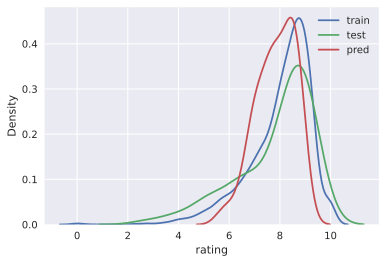

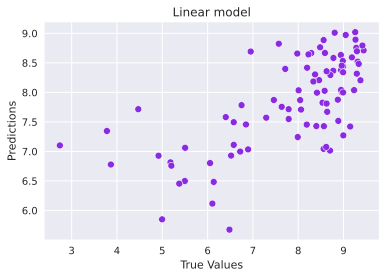

In [47]:
target_distr_linear(y_train, y_test, y_pred)  

In [48]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.2842465659064213
RMSE:  1.1332460306157799
R2:    0.4343337917948672
MAE:   0.8361616267921432
MedAE: 0.6506903252456233
------------------------------


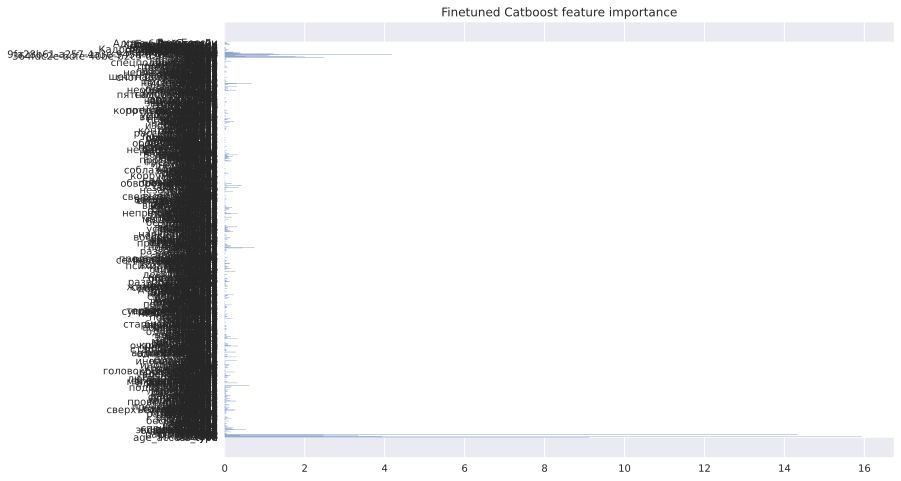

In [49]:
get_feature_imp(best_cat, train_dataset)

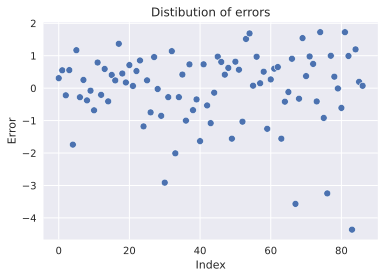

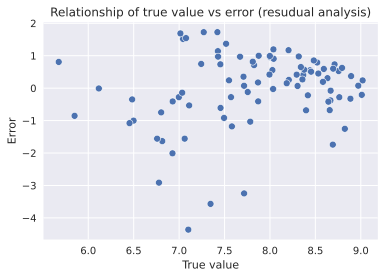

In [50]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [51]:
test_df['PREDS_tune'] = y_pred.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Крис Гилл,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Стэн Ли,Люк Бессон,PREDS_tune
10452,18,Дом Дракона,SERIAL,2022,17.015815,62541c49-7a32-45d0-8981-44ee6968d329,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.633118
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.439921
10292,18,Ночные вызовы,SERIAL,2022,16.685680,aba8d05c-c99d-4a45-adf7-de765f65bf5a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.417325
10334,18,Наш флаг означает Смерть,SERIAL,2022,16.661582,500dec0c-d2a3-4ff3-a7c6-e2d21ea7fd9f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.027166
10436,18,Ирма Веп,SERIAL,2022,17.013367,27e3a752-5124-498c-91fd-28d05c3f6a47,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.691764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5504,18,Невидимый убийца,MOVIE,2022,15.684231,0d14e4b4-71ed-4409-9ebb-54a130e913c8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,7.998653
5410,16,Другое имя,MOVIE,2022,15.576811,69021740-65f7-430c-9c00-f2d6d9e9c702,NaN,NaN,10.364072,NaN,...,0,0,0,0,0,0,0,0,0,7.101357
5208,12,1941. Крылья над Берлином,MOVIE,2022,15.607270,ba5598bb-275c-4dcf-9164-0f86cf46d71e,NaN,NaN,14.750267,NaN,...,0,0,0,0,0,0,0,0,0,8.038300
10286,18,Номинация,SERIAL,2022,16.400263,c25f3cab-9794-4efa-b729-ff473f8b5f27,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.583356
